In [1]:
import numpy as np
from PIL import ImageGrab
from PIL import Image
import cv2
import io
import time
%matplotlib inline 
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = (15, 9)
import seaborn as sns

In [2]:
import os
from selenium import webdriver
from selenium.webdriver.chrome.options import Options
from selenium.webdriver.common.keys import Keys
from selenium.webdriver.common.action_chains import ActionChains
game_url = "game/dino.html"
chrome_driver_path = "../chromedriver.exe"
class Game:
    def __init__(self,custom_config=True):
        chrome_options = Options()
        chrome_options.add_argument("disable-infobars")
        self._driver = webdriver.Chrome(executable_path = chrome_driver_path,chrome_options=chrome_options)
        self._driver.set_window_position(x=-10,y=0)
        self._driver.set_window_size(200, 300)
        self._driver.get(os.path.abspath(game_url))
        if custom_config:
            self._driver.execute_script("Runner.config.ACCELERATION=0")
    def get_crashed(self):
        return self._driver.execute_script("return Runner.instance_.crashed")
    def get_playing(self):
        return self._driver.execute_script("return Runner.instance_.playing")
    def restart(self):
        return self._driver.execute_script("Runner.instance_.restart()")
    def press_up(self):
        self._driver.find_element_by_tag_name("body").send_keys(Keys.ARROW_UP)
    def press_down(self):
        self._driver.find_element_by_tag_name("body").send_keys(Keys.ARROW_DOWN)
    def get_score(self):
        score_array = self._driver.execute_script("return Runner.instance_.distanceMeter.digits")
        score = ''.join(score_array)
        return int(score)
    def pause(self):
        return self._driver.execute_script("return Runner.instance_.stop()")
    def resume(self):
        return self._driver.execute_script("return Runner.instance_.play()")
#     def grab_screen(self):
#         print("grab start")le
#         image = self._driver.get_screenshot_as_png()
# #         performance_measure.send(time.time())
#         image = np.fromstring(image, np.uint8)
# #         performance_measure.send(time.time())
#         image = cv2.imdecode(image,cv2.IMREAD_UNCHANGED) 
# #         performance_measure.send(time.time())
#         image = process_img(image)
# #         performance_measure.send(time.time())
# #         cv2.imwrite('screenshot.png',image)
#         return image
    def end(self):
        self._driver.close()

In [3]:
class DinoAgent:
    def __init__(self,game):
        self._game = game;
        self.jump();
    def is_running(self):
        return self._game.get_playing()
    def is_crashed(self):
        return self._game.get_crashed()
    def jump(self):
        self._game.press_up()
#         time.sleep(0.25)
    def duck(self):
        self._game.press_down()

In [4]:
#processing image as required
def process_img(image):
    #game is already in grey scale canvas, canny to get only edges and reduce unwanted objects(clouds)
#     image = cv2.Canny(image, threshold1 = 100, threshold2 = 200)
#     image = image[10:140,0:200] #img[y:y+h, x:x+w]
#     image = resized_image = cv2.resize(image, (80, 80)) 
    image = cv2.resize(image, (0,0), fx = 0.15, fy = 0.10)
    image = image[2:38,10:50] #img[y:y+h, x:x+w]
    image = cv2.Canny(image, threshold1 = 200, threshold2 = 200)
    return  image

In [5]:
def grab_screen(_driver = None):
    screen =  np.array(ImageGrab.grab(bbox=(0,180,400,400)))
    image = process_img(screen)
    if _driver!=None:
        image = _driver.get_screenshot_as_png()
    return image

In [6]:
# print(grab_screen().shape)
# game = Game()
# dino = DinoAgent(game)
# last_time = time.time()
# while(True):
    
# # #     print('loop took {} seconds'.format(time.time()-last_time))
# # #     last_time = time.time()
# # #     cv2.imwrite("./img_data/dino"+str(time())+".jpg",image)
# # #     dino.duck()
# #     #exit on q pres
# # #     print('{0} {1} '.format(r_t,end_t))
# # #     cv2.imshow('window',game.grab_screen())
    
#     image = grab_screen()
#     cv2.imshow('window',image)
#     print(image.shape[0])
# #     cv2.destroyAllWindows()

# # #     from matplotlib import pyplot as plt
# # #     plt.imshow(image)
# # #     plt.title('my picture')
# # #     plt.show()

# # #     grab_screen()
# #     if(dino.is_crashed()):
# #         #jumping starts the game again if dino has crashed
# # #         temp = (game.get_score())
# #         game.restart()
#     if (cv2.waitKey(25) & 0xFF == ord('q')):
#         cv2.destroyAllWindows()
#         game.end()
# #         cv2.imwrite('dino.jpg',image)
#         break

In [22]:
#game parameters
ACTIONS = 2 # possible actions: jump, do nothing
GAMMA = 0.5 # decay rate of past observations original 0.99
OBSERVATION = 1000. # timesteps to observe before training
EXPLORE = 30000 #300000. # frames over which to anneal epsilon
FINAL_EPSILON = 0.0001 # final value of epsilon
INITIAL_EPSILON = 0.1 # starting value of epsilon
REPLAY_MEMORY = 20000 # number of previous transitions to remember
BATCH = 32 # size of minibatch
FRAME_PER_ACTION = 4
LEARNING_RATE = 1e-4

In [8]:
img_rows , img_cols = 40,20
img_channels = 4 #We stack 4 frames

In [9]:
def buildmodel():
    print("Now we build the model")
    model = Sequential()
    model.add(Convolution2D(32, 8, 8, subsample=(4, 4), border_mode='same',input_shape=(img_cols,img_rows,img_channels)))  #80*80*4
    model.add(Activation('relu'))
    model.add(Convolution2D(64, 4, 4, subsample=(2, 2), border_mode='same'))
    model.add(Activation('relu'))
    model.add(Convolution2D(64, 3, 3, subsample=(1, 1), border_mode='same'))
    model.add(Activation('relu'))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(Dense(ACTIONS))
    adam = Adam(lr=LEARNING_RATE)
    model.compile(loss='mse',optimizer=adam)
    print("We finish building the model")
    return model

In [10]:
def write_log(callback, names, logs, batch_no):
    for name, value in zip(names, logs):
        summary = tf.Summary()
        summary_value = summary.value.add()
        summary_value.simple_value = value
        summary_value.tag = name
        callback.writer.add_summary(summary, batch_no)
        callback.writer.flush()

In [11]:
def trainNetwork(model,game_state,observe=False):
    # open up a game state to communicate with emulator
    last_time = time.time()
    # store the previous observations in replay memory
    D = deque()
#     display = show_img()
#     display.__next__()
    # get the first state by doing nothing and preprocess the image to 80x80x4
    do_nothing = np.zeros(ACTIONS)
    do_nothing[0] =1 
    x_t, r_0, terminal = game_state.get_state(do_nothing)
    

    s_t = np.stack((x_t, x_t, x_t, x_t), axis=2)
    

    #In Keras, need to reshape
    s_t = s_t.reshape(1, s_t.shape[0], s_t.shape[1], s_t.shape[2])  #1*80*80*4


    if observe :#args['mode'] == 'Run':
        OBSERVE = 999999999    #We keep observe, never train
        epsilon = FINAL_EPSILON
        print ("Now we load weight")
        model.load_weights("model.h5")
        adam = Adam(lr=LEARNING_RATE)
        model.compile(loss='mse',optimizer=adam)
        print ("Weight load successfully")    
    else:                       #We go to training mode
        OBSERVE = OBSERVATION
        epsilon = INITIAL_EPSILON
        model.load_weights("model.h5")
        adam = Adam(lr=LEARNING_RATE)
        model.compile(loss='mse',optimizer=adam)

    t = 0
    while (True):
        loss = 0
        Q_sa = 0
        action_index = 0
        r_t = 0
        a_t = np.zeros([ACTIONS])
        #choose an action epsilon greedy
        if t % FRAME_PER_ACTION == 0:
            if  random.random() <= epsilon:
                print("----------Random Action----------")
                action_index = random.randrange(ACTIONS)
                a_t[action_index] = 1
            else:
                q = model.predict(s_t)       #input a stack of 4 images, get the prediction
                max_Q = np.argmax(q)
                action_index = max_Q
                a_t[action_index] = 1
        #We reduced the epsilon gradually
        if epsilon > FINAL_EPSILON and t > OBSERVE:
            epsilon -= (INITIAL_EPSILON - FINAL_EPSILON) / EXPLORE #update to original asap
            
        elif t > OBSERVE:
            print("restarting training")
            epsilon = INITIAL_EPSILON
            trainNetwork(model,game_state,observe=observe)

        #run the selected action and observed next state and reward
        x_t1, r_t, terminal = game_state.get_state(a_t)
        print('loop took {} seconds'.format(time.time()-last_time))
        last_time = time.time()
#       display.send(x_t1)
        x_t1 = x_t1.reshape(1, x_t1.shape[0], x_t1.shape[1], 1) #1x80x80x1
        s_t1 = np.append(x_t1, s_t[:, :, :, :3], axis=3)

        # store the transition in D
        D.append((s_t, action_index, r_t, s_t1, terminal))
        if len(D) > REPLAY_MEMORY:
            D.popleft()

        #only train if done observing
        if t > OBSERVE: 
            
            #sample a minibatch to train on
            minibatch = random.sample(D, BATCH)
            inputs = np.zeros((BATCH, s_t.shape[1], s_t.shape[2], s_t.shape[3]))   #32, 80, 80, 4
            targets = np.zeros((inputs.shape[0], ACTIONS))                         #32, 2

            #Now we do the experience replay
            for i in range(0, len(minibatch)):
                state_t = minibatch[i][0]
                action_t = minibatch[i][1]   #This is action index
                reward_t = minibatch[i][2]
                state_t1 = minibatch[i][3]
                terminal = minibatch[i][4]
                # if terminated, only equals reward

                inputs[i:i + 1] = state_t    #I saved down s_t

                targets[i] = model.predict(state_t)  # Hitting each buttom probability
                Q_sa = model.predict(state_t1)

                if terminal:
                    targets[i, action_t] = reward_t
                else:
                    targets[i, action_t] = reward_t + GAMMA * np.max(Q_sa)

            # targets2 = normalize(targets)
            loss += model.train_on_batch(inputs, targets)
            loss_df.loc[len(loss_df)] = loss
        else:
            time.sleep(0.16)
        s_t = s_t1
        t = t + 1
        
        # save progress every 10000 iterations
        if t % 1000 == 0:
            print("Now we save model")
            model.save_weights("model.h5", overwrite=True)
            with open("model.json", "w") as outfile:
                json.dump(model.to_json(), outfile)

        # print info
        state = ""
        if t <= OBSERVE:
            state = "observe"
        elif t > OBSERVE and t <= OBSERVE + EXPLORE:
            state = "explore"
        else:
            state = "train"

        print("TIMESTEP", t, "/ STATE", state, \
            "/ EPSILON", epsilon, "/ ACTION", action_index, "/ REWARD", r_t, \
            "/ Q_MAX " , np.max(Q_sa), "/ Loss ", loss)

    print("Episode finished!")
    print("************************")

In [12]:
import pandas as pd
import numpy as np
import _thread as thread
loss_df = pd.DataFrame(0, index=range(2),columns=['loss'])
scores_df = pd.DataFrame(0, index=range(2),columns=['score'])
actions_df = pd.DataFrame(0, index=range(2),columns=['action'])

In [13]:
def playGame(observe=False):
    game = Game()
    dino = DinoAgent(game)
    game_state = Game_sate(dino,game)
    model = buildmodel()
    trainNetwork(model,game_state,observe=observe)
    

In [14]:
class Game_sate:
    def __init__(self,agent,game):
        self._agent = agent
        self._game = game
        self._display = show_img()
        self._display.__next__()
    def get_state(self,actions):
        actions_df.loc[len(actions_df)] = actions[1]
        reward = 0.1
        is_over = False
        if actions[1] == 1:
            self._agent.jump()

        image = grab_screen()
        self._display.send(image)

        if self._agent.is_crashed():
            scores_df.loc[len(loss_df)] = self._game.get_score()
            self._game.restart()
            reward = -5
            is_over = True
        return image, reward, is_over

In [15]:
from keras.models import model_from_json
from keras.models import Sequential
from keras.layers.core import Dense, Dropout, Activation, Flatten
from keras.layers.convolutional import Convolution2D, MaxPooling2D
from keras.optimizers import SGD , Adam
import tensorflow as tf
from keras.callbacks import TensorBoard
from collections import deque
import random
import json

Using TensorFlow backend.


In [17]:
def show_img(graphs = False):
    """
    Show images in new window
    """
    frame = 0
    while True:
        screen = (yield)
        window_title = "logs" if graphs else "game_play"
        cv2.namedWindow(window_title, cv2.WINDOW_NORMAL)        # Create window with freedom of dimensions
        imS = cv2.resize(screen, (800, 400)) 
        cv2.imshow(window_title, imS)
#         cv2.imwrite("screenshot"+str(frame)+".png",screen)
        if (cv2.waitKey(1) & 0xFF == ord('q')):
            cv2.destroyAllWindows()
            break

        frame += 1

In [ ]:
playGame(observe=False)

Now we build the model
We finish building the model


C:\Users\ravi7\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(32, (8, 8), input_shape=(20, 40, 4..., strides=(4, 4), padding="same")`
  after removing the cwd from sys.path.
C:\Users\ravi7\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (4, 4), strides=(2, 2), padding="same")`
  
C:\Users\ravi7\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), strides=(1, 1), padding="same")`
  


loop took 0.4803171157836914 seconds
TIMESTEP 1 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22658634185791016 seconds
TIMESTEP 2 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20200395584106445 seconds
TIMESTEP 3 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2024829387664795 seconds
TIMESTEP 4 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22035527229309082 seconds
TIMESTEP 5 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20306825637817383 seconds
TIMESTEP 6 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21961665153503418 seconds
TIMESTEP 7 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2345290184020996 seconds
TIMESTEP 8 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0

loop took 0.23354578018188477 seconds
TIMESTEP 67 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2173302173614502 seconds
TIMESTEP 68 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23454070091247559 seconds
TIMESTEP 69 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21816802024841309 seconds
TIMESTEP 70 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21935749053955078 seconds
TIMESTEP 71 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22398877143859863 seconds
TIMESTEP 72 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.21381163597106934 seconds
TIMESTEP 73 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20265507698059082 seconds
TIMESTEP 74 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
lo

loop took 0.23249340057373047 seconds
TIMESTEP 133 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23569178581237793 seconds
TIMESTEP 134 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21656155586242676 seconds
TIMESTEP 135 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22509551048278809 seconds
TIMESTEP 136 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2444744110107422 seconds
TIMESTEP 137 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21737909317016602 seconds
TIMESTEP 138 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21993708610534668 seconds
TIMESTEP 139 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2178328037261963 seconds
TIMESTEP 140 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Los

loop took 0.20203757286071777 seconds
TIMESTEP 199 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21731042861938477 seconds
TIMESTEP 200 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2496945858001709 seconds
TIMESTEP 201 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22016596794128418 seconds
TIMESTEP 202 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21969890594482422 seconds
TIMESTEP 203 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.29517650604248047 seconds
TIMESTEP 204 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.23610568046569824 seconds
TIMESTEP 205 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23327326774597168 seconds
TIMESTEP 206 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Lo

loop took 0.24174165725708008 seconds
TIMESTEP 264 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22631406784057617 seconds
TIMESTEP 265 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20330357551574707 seconds
TIMESTEP 266 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20361018180847168 seconds
TIMESTEP 267 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23413324356079102 seconds
TIMESTEP 268 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23438596725463867 seconds
TIMESTEP 269 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2328805923461914 seconds
TIMESTEP 270 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23312139511108398 seconds
TIMESTEP 271 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Lo

loop took 0.22794127464294434 seconds
TIMESTEP 329 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22058415412902832 seconds
TIMESTEP 330 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.218031644821167 seconds
TIMESTEP 331 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2180793285369873 seconds
TIMESTEP 332 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2175920009613037 seconds
TIMESTEP 333 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20438170433044434 seconds
TIMESTEP 334 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21779513359069824 seconds
TIMESTEP 335 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24178290367126465 seconds
TIMESTEP 336 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss 

loop took 0.22754716873168945 seconds
TIMESTEP 394 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22154617309570312 seconds
TIMESTEP 395 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20177841186523438 seconds
TIMESTEP 396 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.2347276210784912 seconds
TIMESTEP 397 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2187213897705078 seconds
TIMESTEP 398 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20388484001159668 seconds
TIMESTEP 399 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2396831512451172 seconds
TIMESTEP 400 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22490406036376953 seconds
TIMESTEP 401 / STATE observe / EPSILON 0.1 / ACTIO

loop took 0.2194042205810547 seconds
TIMESTEP 459 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21827983856201172 seconds
TIMESTEP 460 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25025081634521484 seconds
TIMESTEP 461 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2180469036102295 seconds
TIMESTEP 462 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2053532600402832 seconds
TIMESTEP 463 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2812778949737549 seconds
TIMESTEP 464 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.26529431343078613 seconds
TIMESTEP 465 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25040340423583984 seconds
TIMESTEP 466 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss

loop took 0.21256303787231445 seconds
TIMESTEP 524 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21756863594055176 seconds
TIMESTEP 525 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22009587287902832 seconds
TIMESTEP 526 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23514938354492188 seconds
TIMESTEP 527 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21944832801818848 seconds
TIMESTEP 528 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.26445770263671875 seconds
TIMESTEP 529 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22054147720336914 seconds
TIMESTEP 530 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2319192886352539 seconds
TIMESTEP 531 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / L

loop took 0.23362088203430176 seconds
TIMESTEP 589 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23427486419677734 seconds
TIMESTEP 590 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2346494197845459 seconds
TIMESTEP 591 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21875381469726562 seconds
TIMESTEP 592 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23344826698303223 seconds
TIMESTEP 593 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2257063388824463 seconds
TIMESTEP 594 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.226485013961792 seconds
TIMESTEP 595 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23420453071594238 seconds
TIMESTEP 596 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss 

loop took 0.23441624641418457 seconds
TIMESTEP 654 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23576927185058594 seconds
TIMESTEP 655 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2505607604980469 seconds
TIMESTEP 656 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.26407361030578613 seconds
TIMESTEP 657 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25011229515075684 seconds
TIMESTEP 658 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2332146167755127 seconds
TIMESTEP 659 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21892833709716797 seconds
TIMESTEP 660 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24891996383666992 seconds
TIMESTEP 661 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Lo

loop took 0.21698307991027832 seconds
TIMESTEP 720 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.21819019317626953 seconds
TIMESTEP 721 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2207784652709961 seconds
TIMESTEP 722 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2398085594177246 seconds
TIMESTEP 723 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22764277458190918 seconds
TIMESTEP 724 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2018287181854248 seconds
TIMESTEP 725 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.218764066696167 seconds
TIMESTEP 726 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2189180850982666 seconds
TIMESTEP 727 / STATE observe / EPSILON 0.1 / ACTION 0

TIMESTEP 785 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2507355213165283 seconds
TIMESTEP 786 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24205493927001953 seconds
TIMESTEP 787 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21086931228637695 seconds
TIMESTEP 788 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.26540637016296387 seconds
TIMESTEP 789 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20377254486083984 seconds
TIMESTEP 790 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23484039306640625 seconds
TIMESTEP 791 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24158310890197754 seconds
TIMESTEP 792 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.24258017539978027 se

TIMESTEP 850 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24827289581298828 seconds
TIMESTEP 851 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2191920280456543 seconds
TIMESTEP 852 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2484726905822754 seconds
TIMESTEP 853 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21780180931091309 seconds
TIMESTEP 854 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2503504753112793 seconds
TIMESTEP 855 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2191159725189209 seconds
TIMESTEP 856 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2644078731536865 seconds
TIMESTEP 857 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22072744369506836 secon

TIMESTEP 915 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21943402290344238 seconds
TIMESTEP 916 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25099968910217285 seconds
TIMESTEP 917 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23337721824645996 seconds
TIMESTEP 918 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23420071601867676 seconds
TIMESTEP 919 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2575075626373291 seconds
TIMESTEP 920 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2597320079803467 seconds
TIMESTEP 921 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23552751541137695 seconds
TIMESTEP 922 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23344206809997559 sec

TIMESTEP 981 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2339181900024414 seconds
TIMESTEP 982 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23539304733276367 seconds
TIMESTEP 983 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21866297721862793 seconds
TIMESTEP 984 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.26611804962158203 seconds
TIMESTEP 985 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20205450057983398 seconds
TIMESTEP 986 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2383730411529541 seconds
TIMESTEP 987 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2137434482574463 seconds
TIMESTEP 988 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23519277572631836 seco

TIMESTEP 1036 / STATE explore / EPSILON 0.09988345000000015 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0551935 / Loss  0.810833871365
loop took 0.2250208854675293 seconds
TIMESTEP 1037 / STATE explore / EPSILON 0.09988012000000016 / ACTION 0 / REWARD -5 / Q_MAX  -0.160609 / Loss  0.0910506844521
loop took 0.15942883491516113 seconds
TIMESTEP 1038 / STATE explore / EPSILON 0.09987679000000016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0412447 / Loss  0.882472217083
loop took 0.17835545539855957 seconds
TIMESTEP 1039 / STATE explore / EPSILON 0.09987346000000016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212803 / Loss  0.223978340626
loop took 0.2115473747253418 seconds
TIMESTEP 1040 / STATE explore / EPSILON 0.09987013000000017 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.879899 / Loss  0.476933777332
loop took 0.15543127059936523 seconds
TIMESTEP 1041 / STATE explore / EPSILON 0.09986680000000017 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12662 / Loss  0.485435187817
loop took 0.15750551223754883 seconds
TIMESTEP 1042 / STAT

TIMESTEP 1087 / STATE explore / EPSILON 0.09971362000000036 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.520526 / Loss  0.285421580076
loop took 0.18448972702026367 seconds
TIMESTEP 1088 / STATE explore / EPSILON 0.09971029000000037 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0145543 / Loss  0.50751131773
loop took 0.18752050399780273 seconds
TIMESTEP 1089 / STATE explore / EPSILON 0.09970696000000037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0636637 / Loss  0.138112947345
loop took 0.14137482643127441 seconds
TIMESTEP 1090 / STATE explore / EPSILON 0.09970363000000038 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.189597 / Loss  0.453914672136
loop took 0.17296218872070312 seconds
TIMESTEP 1091 / STATE explore / EPSILON 0.09970030000000038 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.63169 / Loss  0.103889130056
loop took 0.19486570358276367 seconds
TIMESTEP 1092 / STATE explore / EPSILON 0.09969697000000038 / ACTION 0 / REWARD -5 / Q_MAX  -0.00465798 / Loss  0.21749201417
loop took 0.172224760055542 seconds
TIMESTEP 1093 / STA

TIMESTEP 1138 / STATE explore / EPSILON 0.09954379000000058 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203772 / Loss  0.149861216545
loop took 0.17746877670288086 seconds
TIMESTEP 1139 / STATE explore / EPSILON 0.09954046000000058 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38801 / Loss  0.371892392635
loop took 0.19152355194091797 seconds
TIMESTEP 1140 / STATE explore / EPSILON 0.09953713000000058 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107632 / Loss  0.24047011137
loop took 0.21234488487243652 seconds
TIMESTEP 1141 / STATE explore / EPSILON 0.09953380000000059 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.713279 / Loss  0.260923624039
loop took 0.1945793628692627 seconds
TIMESTEP 1142 / STATE explore / EPSILON 0.09953047000000059 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27528 / Loss  0.17193877697
loop took 0.16421175003051758 seconds
TIMESTEP 1143 / STATE explore / EPSILON 0.0995271400000006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234569 / Loss  0.331765085459
loop took 0.19553065299987793 seconds
TIMESTEP 1144 / STATE exp

TIMESTEP 1188 / STATE explore / EPSILON 0.09937729000000078 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.591208 / Loss  0.254548102617
loop took 0.21680927276611328 seconds
TIMESTEP 1189 / STATE explore / EPSILON 0.09937396000000079 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.320802 / Loss  0.413655698299
loop took 0.18147802352905273 seconds
TIMESTEP 1190 / STATE explore / EPSILON 0.09937063000000079 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0900004 / Loss  0.176991075277
loop took 0.18747663497924805 seconds
TIMESTEP 1191 / STATE explore / EPSILON 0.0993673000000008 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0496479 / Loss  0.226424917579
loop took 0.20493292808532715 seconds
TIMESTEP 1192 / STATE explore / EPSILON 0.0993639700000008 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.183795 / Loss  0.668215155602
loop took 0.22446322441101074 seconds
TIMESTEP 1193 / STATE explore / EPSILON 0.0993606400000008 / ACTION 0 / REWARD -5 / Q_MAX  -0.0234259 / Loss  0.4638055861
loop took 0.1660594940185547 seconds
TIMESTEP 1194 / STATE

TIMESTEP 1239 / STATE explore / EPSILON 0.099207460000001 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.11704 / Loss  0.383616775274
loop took 0.16973400115966797 seconds
TIMESTEP 1240 / STATE explore / EPSILON 0.099204130000001 / ACTION 0 / REWARD -5 / Q_MAX  0.197904 / Loss  0.103427812457
loop took 0.15140676498413086 seconds
TIMESTEP 1241 / STATE explore / EPSILON 0.099200800000001 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0483418 / Loss  0.0802719891071
loop took 0.17146563529968262 seconds
TIMESTEP 1242 / STATE explore / EPSILON 0.09919747000000101 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.172806 / Loss  0.523804426193
loop took 0.18638134002685547 seconds
TIMESTEP 1243 / STATE explore / EPSILON 0.09919414000000101 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.201975 / Loss  0.599722146988
loop took 0.17045354843139648 seconds
TIMESTEP 1244 / STATE explore / EPSILON 0.09919081000000102 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12008 / Loss  0.314536392689
loop took 0.20528364181518555 seconds
TIMESTEP 1245 / STATE expl

TIMESTEP 1289 / STATE explore / EPSILON 0.0990409600000012 / ACTION 0 / REWARD -5 / Q_MAX  -0.669472 / Loss  0.122191086411
loop took 0.18049025535583496 seconds
TIMESTEP 1290 / STATE explore / EPSILON 0.09903763000000121 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.39086 / Loss  0.205883696675
loop took 0.17017531394958496 seconds
TIMESTEP 1291 / STATE explore / EPSILON 0.09903430000000121 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194114 / Loss  0.450195401907
loop took 0.14137649536132812 seconds
TIMESTEP 1292 / STATE explore / EPSILON 0.09903097000000122 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.163086 / Loss  0.130090355873
----------Random Action----------
loop took 0.19327926635742188 seconds
TIMESTEP 1293 / STATE explore / EPSILON 0.09902764000000122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182984 / Loss  0.158892855048
loop took 0.16748452186584473 seconds
TIMESTEP 1294 / STATE explore / EPSILON 0.09902431000000123 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.67034 / Loss  0.145769327879
loop took 0.18804979324340

loop took 0.17148423194885254 seconds
TIMESTEP 1341 / STATE explore / EPSILON 0.09886780000000142 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.83682 / Loss  0.265412271023
loop took 0.2396383285522461 seconds
TIMESTEP 1342 / STATE explore / EPSILON 0.09886447000000143 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.32716 / Loss  0.215875074267
loop took 0.2596879005432129 seconds
TIMESTEP 1343 / STATE explore / EPSILON 0.09886114000000143 / ACTION 0 / REWARD -5 / Q_MAX  -0.275157 / Loss  0.277653366327
loop took 0.18549418449401855 seconds
TIMESTEP 1344 / STATE explore / EPSILON 0.09885781000000143 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126488 / Loss  0.213114842772
----------Random Action----------
loop took 0.21757960319519043 seconds
TIMESTEP 1345 / STATE explore / EPSILON 0.09885448000000144 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.58977 / Loss  0.0921150669456
loop took 0.2526721954345703 seconds
TIMESTEP 1346 / STATE explore / EPSILON 0.09885115000000144 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0989398 / Loss  0.3

TIMESTEP 1391 / STATE explore / EPSILON 0.09870130000000163 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0926938 / Loss  0.168682932854
loop took 0.26269960403442383 seconds
TIMESTEP 1392 / STATE explore / EPSILON 0.09869797000000163 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.63216 / Loss  0.561457574368
loop took 0.1724562644958496 seconds
TIMESTEP 1393 / STATE explore / EPSILON 0.09869464000000164 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.206552 / Loss  0.547093093395
loop took 0.1541883945465088 seconds
TIMESTEP 1394 / STATE explore / EPSILON 0.09869131000000164 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0984936 / Loss  0.102751240134
loop took 0.17145633697509766 seconds
TIMESTEP 1395 / STATE explore / EPSILON 0.09868798000000165 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0796078 / Loss  0.415623605251
loop took 0.18470001220703125 seconds
TIMESTEP 1396 / STATE explore / EPSILON 0.09868465000000165 / ACTION 0 / REWARD -5 / Q_MAX  0.0449138 / Loss  0.224378347397
loop took 0.1762228012084961 seconds
TIMESTEP 1397 / STAT

TIMESTEP 1442 / STATE explore / EPSILON 0.09853147000000184 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.276565 / Loss  0.0951948314905
loop took 0.2119896411895752 seconds
TIMESTEP 1443 / STATE explore / EPSILON 0.09852814000000185 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0163369 / Loss  0.146542459726
loop took 0.23662233352661133 seconds
TIMESTEP 1444 / STATE explore / EPSILON 0.09852481000000185 / ACTION 0 / REWARD -5 / Q_MAX  0.0512812 / Loss  0.407129138708
loop took 0.21979236602783203 seconds
TIMESTEP 1445 / STATE explore / EPSILON 0.09852148000000185 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.40949 / Loss  0.241192758083
loop took 0.23457765579223633 seconds
TIMESTEP 1446 / STATE explore / EPSILON 0.09851815000000186 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.329068 / Loss  0.162010923028
loop took 0.21255993843078613 seconds
TIMESTEP 1447 / STATE explore / EPSILON 0.09851482000000186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0802352 / Loss  0.317769765854
loop took 0.1414623260498047 seconds
TIMESTEP 1448 / ST

TIMESTEP 1493 / STATE explore / EPSILON 0.09836164000000205 / ACTION 0 / REWARD -5 / Q_MAX  0.186971 / Loss  0.130552500486
loop took 0.17243266105651855 seconds
TIMESTEP 1494 / STATE explore / EPSILON 0.09835831000000206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116782 / Loss  0.231044858694
loop took 0.17157864570617676 seconds
TIMESTEP 1495 / STATE explore / EPSILON 0.09835498000000206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168451 / Loss  0.276050567627
loop took 0.15540194511413574 seconds
TIMESTEP 1496 / STATE explore / EPSILON 0.09835165000000207 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0627666 / Loss  0.249179393053
loop took 0.1568310260772705 seconds
TIMESTEP 1497 / STATE explore / EPSILON 0.09834832000000207 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.294827 / Loss  0.606132805347
loop took 0.15855884552001953 seconds
TIMESTEP 1498 / STATE explore / EPSILON 0.09834499000000207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115318 / Loss  0.11092621088
loop took 0.16956853866577148 seconds
TIMESTEP 1499 / STATE 

loop took 0.21257352828979492 seconds
TIMESTEP 1544 / STATE explore / EPSILON 0.09819181000000227 / ACTION 0 / REWARD 0.1 / Q_MAX  0.283123 / Loss  0.767518460751
loop took 0.18448996543884277 seconds
TIMESTEP 1545 / STATE explore / EPSILON 0.09818848000000227 / ACTION 1 / REWARD 0.1 / Q_MAX  0.033537 / Loss  0.189667209983
loop took 0.2100377082824707 seconds
TIMESTEP 1546 / STATE explore / EPSILON 0.09818515000000227 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0925741 / Loss  0.435427755117
loop took 0.20559167861938477 seconds
TIMESTEP 1547 / STATE explore / EPSILON 0.09818182000000228 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.681972 / Loss  0.390726268291
loop took 0.21893525123596191 seconds
TIMESTEP 1548 / STATE explore / EPSILON 0.09817849000000228 / ACTION 0 / REWARD -5 / Q_MAX  -0.0358729 / Loss  0.294992089272
loop took 0.1775069236755371 seconds
TIMESTEP 1549 / STATE explore / EPSILON 0.09817516000000229 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.33195 / Loss  0.41359987855
loop took 0.178476810

loop took 0.1714918613433838 seconds
TIMESTEP 1594 / STATE explore / EPSILON 0.09802531000000247 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0205373 / Loss  0.129131034017
loop took 0.18852710723876953 seconds
TIMESTEP 1595 / STATE explore / EPSILON 0.09802198000000248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103821 / Loss  0.038565941155
loop took 0.23274970054626465 seconds
TIMESTEP 1596 / STATE explore / EPSILON 0.09801865000000248 / ACTION 0 / REWARD -5 / Q_MAX  0.0340862 / Loss  0.157745197415
loop took 0.1544053554534912 seconds
TIMESTEP 1597 / STATE explore / EPSILON 0.09801532000000249 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195844 / Loss  0.242038011551
loop took 0.16469144821166992 seconds
TIMESTEP 1598 / STATE explore / EPSILON 0.09801199000000249 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.44076 / Loss  0.480081796646
loop took 0.21267414093017578 seconds
TIMESTEP 1599 / STATE explore / EPSILON 0.0980086600000025 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199453 / Loss  0.511744499207
loop took 0.15314888954

TIMESTEP 1644 / STATE explore / EPSILON 0.09785881000000268 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.336165 / Loss  0.136492326856
loop took 0.2180635929107666 seconds
TIMESTEP 1645 / STATE explore / EPSILON 0.09785548000000269 / ACTION 1 / REWARD -5 / Q_MAX  0.0642698 / Loss  0.517585396767
loop took 0.1494731903076172 seconds
TIMESTEP 1646 / STATE explore / EPSILON 0.09785215000000269 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.157712 / Loss  0.49851167202
loop took 0.17856168746948242 seconds
TIMESTEP 1647 / STATE explore / EPSILON 0.0978488200000027 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.97619 / Loss  0.115314632654
loop took 0.16453313827514648 seconds
TIMESTEP 1648 / STATE explore / EPSILON 0.0978454900000027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.000166416 / Loss  0.641704142094
loop took 0.1713728904724121 seconds
TIMESTEP 1649 / STATE explore / EPSILON 0.0978421600000027 / ACTION 1 / REWARD 0.1 / Q_MAX  0.078413 / Loss  0.136617749929
loop took 0.16394495964050293 seconds
TIMESTEP 1650 / STATE ex

TIMESTEP 1694 / STATE explore / EPSILON 0.09769231000000289 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.715893 / Loss  0.423747599125
loop took 0.23015069961547852 seconds
TIMESTEP 1695 / STATE explore / EPSILON 0.0976889800000029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163662 / Loss  0.104933105409
loop took 0.18549418449401855 seconds
TIMESTEP 1696 / STATE explore / EPSILON 0.0976856500000029 / ACTION 0 / REWARD -5 / Q_MAX  0.172559 / Loss  0.150886356831
loop took 0.1834864616394043 seconds
TIMESTEP 1697 / STATE explore / EPSILON 0.0976823200000029 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0295024 / Loss  0.035650998354
loop took 0.18037152290344238 seconds
TIMESTEP 1698 / STATE explore / EPSILON 0.09767899000000291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111096 / Loss  0.062587030232
loop took 0.2143561840057373 seconds
TIMESTEP 1699 / STATE explore / EPSILON 0.09767566000000291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130993 / Loss  0.0620594918728
loop took 0.16844463348388672 seconds
TIMESTEP 1700 / STATE exp

TIMESTEP 1746 / STATE explore / EPSILON 0.09751915000000311 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.74987 / Loss  0.619582056999
loop took 0.24385309219360352 seconds
TIMESTEP 1747 / STATE explore / EPSILON 0.09751582000000311 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168784 / Loss  0.497564911842
loop took 0.18655037879943848 seconds
TIMESTEP 1748 / STATE explore / EPSILON 0.09751249000000312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0123663 / Loss  0.0936380177736
loop took 0.19051074981689453 seconds
TIMESTEP 1749 / STATE explore / EPSILON 0.09750916000000312 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178129 / Loss  0.423455059528
loop took 0.16951322555541992 seconds
TIMESTEP 1750 / STATE explore / EPSILON 0.09750583000000312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0174708 / Loss  0.327488899231
loop took 0.1705307960510254 seconds
TIMESTEP 1751 / STATE explore / EPSILON 0.09750250000000313 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.862342 / Loss  0.0385591164231
loop took 0.18357157707214355 seconds
TIMESTEP 1752 / ST

loop took 0.23462390899658203 seconds
TIMESTEP 1797 / STATE explore / EPSILON 0.09734932000000332 / ACTION 1 / REWARD 0.1 / Q_MAX  0.133909 / Loss  0.228848606348
loop took 0.1884615421295166 seconds
TIMESTEP 1798 / STATE explore / EPSILON 0.09734599000000332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0331159 / Loss  0.247549071908
loop took 0.2192544937133789 seconds
TIMESTEP 1799 / STATE explore / EPSILON 0.09734266000000333 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08628 / Loss  0.215913146734
loop took 0.1564159393310547 seconds
TIMESTEP 1800 / STATE explore / EPSILON 0.09733933000000333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20434 / Loss  0.089294090867
loop took 0.20213937759399414 seconds
TIMESTEP 1801 / STATE explore / EPSILON 0.09733600000000334 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0789716 / Loss  0.963598132133
loop took 0.204451322555542 seconds
TIMESTEP 1802 / STATE explore / EPSILON 0.09733267000000334 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.887878 / Loss  0.25306725502
loop took 0.1694185733795

loop took 0.18648552894592285 seconds
TIMESTEP 1849 / STATE explore / EPSILON 0.09717616000000354 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.30928 / Loss  0.458735823631
loop took 0.2021191120147705 seconds
TIMESTEP 1850 / STATE explore / EPSILON 0.09717283000000354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0903497 / Loss  0.403852164745
loop took 0.1782379150390625 seconds
TIMESTEP 1851 / STATE explore / EPSILON 0.09716950000000354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0759671 / Loss  0.284858167171
loop took 0.2665116786956787 seconds
TIMESTEP 1852 / STATE explore / EPSILON 0.09716617000000355 / ACTION 0 / REWARD -5 / Q_MAX  0.0850089 / Loss  0.593079507351
loop took 0.2610049247741699 seconds
TIMESTEP 1853 / STATE explore / EPSILON 0.09716284000000355 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.88893 / Loss  0.0702263340354
loop took 0.19952630996704102 seconds
TIMESTEP 1854 / STATE explore / EPSILON 0.09715951000000356 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.830217 / Loss  0.0856758952141
loop took 0.188641071

TIMESTEP 1899 / STATE explore / EPSILON 0.09700966000000374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.293484 / Loss  0.0659015327692
loop took 0.19952964782714844 seconds
TIMESTEP 1900 / STATE explore / EPSILON 0.09700633000000375 / ACTION 0 / REWARD -5 / Q_MAX  0.160226 / Loss  0.0863433480263
loop took 0.19829893112182617 seconds
TIMESTEP 1901 / STATE explore / EPSILON 0.09700300000000375 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0765385 / Loss  0.114429488778
loop took 0.17248797416687012 seconds
TIMESTEP 1902 / STATE explore / EPSILON 0.09699967000000376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.290564 / Loss  0.0590773448348
loop took 0.15442705154418945 seconds
TIMESTEP 1903 / STATE explore / EPSILON 0.09699634000000376 / ACTION 0 / REWARD 0.1 / Q_MAX  0.293092 / Loss  0.189755275846
loop took 0.14749789237976074 seconds
TIMESTEP 1904 / STATE explore / EPSILON 0.09699301000000377 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.723211 / Loss  0.0917359888554
loop took 0.21673846244812012 seconds
TIMESTEP 1905 / 

loop took 0.20337510108947754 seconds
TIMESTEP 1950 / STATE explore / EPSILON 0.09683983000000396 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0237486 / Loss  0.388143569231
loop took 0.20554518699645996 seconds
TIMESTEP 1951 / STATE explore / EPSILON 0.09683650000000396 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202125 / Loss  0.0977704077959
loop took 0.16897177696228027 seconds
TIMESTEP 1952 / STATE explore / EPSILON 0.09683317000000397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.771228 / Loss  0.26795527339
loop took 0.1575932502746582 seconds
TIMESTEP 1953 / STATE explore / EPSILON 0.09682984000000397 / ACTION 0 / REWARD -5 / Q_MAX  -0.0690799 / Loss  0.296640247107
loop took 0.17145204544067383 seconds
TIMESTEP 1954 / STATE explore / EPSILON 0.09682651000000397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.890812 / Loss  0.676796495914
loop took 0.18950295448303223 seconds
TIMESTEP 1955 / STATE explore / EPSILON 0.09682318000000398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154999 / Loss  0.0326091684401
loop took 0.203300

loop took 0.2111515998840332 seconds
TIMESTEP 2001 / STATE explore / EPSILON 0.09667000000000417 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0823436 / Loss  0.38313421607
loop took 0.21893024444580078 seconds
TIMESTEP 2002 / STATE explore / EPSILON 0.09666667000000417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0563457 / Loss  0.147369980812
loop took 0.1774289608001709 seconds
TIMESTEP 2003 / STATE explore / EPSILON 0.09666334000000418 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.83117 / Loss  0.305736541748
loop took 0.16246724128723145 seconds
TIMESTEP 2004 / STATE explore / EPSILON 0.09666001000000418 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116413 / Loss  0.270578145981
loop took 0.19850969314575195 seconds
TIMESTEP 2005 / STATE explore / EPSILON 0.09665668000000419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168994 / Loss  0.22071890533
loop took 0.17321133613586426 seconds
TIMESTEP 2006 / STATE explore / EPSILON 0.09665335000000419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125789 / Loss  0.0368716791272
loop took 0.2025768756

TIMESTEP 2051 / STATE explore / EPSILON 0.09650350000000438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224189 / Loss  0.304990470409
loop took 0.16844701766967773 seconds
TIMESTEP 2052 / STATE explore / EPSILON 0.09650017000000438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186239 / Loss  0.67275005579
loop took 0.17330050468444824 seconds
TIMESTEP 2053 / STATE explore / EPSILON 0.09649684000000439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.449543 / Loss  0.089382737875
loop took 0.19435667991638184 seconds
TIMESTEP 2054 / STATE explore / EPSILON 0.09649351000000439 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.68465 / Loss  0.0762302428484
loop took 0.19451475143432617 seconds
TIMESTEP 2055 / STATE explore / EPSILON 0.0964901800000044 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151459 / Loss  0.0302953273058
loop took 0.19824981689453125 seconds
TIMESTEP 2056 / STATE explore / EPSILON 0.0964868500000044 / ACTION 0 / REWARD -5 / Q_MAX  -0.0267707 / Loss  0.435902476311
loop took 0.16042637825012207 seconds
TIMESTEP 2057 / STATE 

loop took 0.15745854377746582 seconds
TIMESTEP 2102 / STATE explore / EPSILON 0.09633367000000459 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.39915 / Loss  0.070653423667
loop took 0.17799663543701172 seconds
TIMESTEP 2103 / STATE explore / EPSILON 0.0963303400000046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16963 / Loss  0.0773204565048
loop took 0.21885919570922852 seconds
TIMESTEP 2104 / STATE explore / EPSILON 0.0963270100000046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250248 / Loss  0.321130722761
loop took 0.20558643341064453 seconds
TIMESTEP 2105 / STATE explore / EPSILON 0.0963236800000046 / ACTION 0 / REWARD -5 / Q_MAX  0.000219822 / Loss  0.35687738657
loop took 0.2085552215576172 seconds
TIMESTEP 2106 / STATE explore / EPSILON 0.0963203500000046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157637 / Loss  0.40295496583
loop took 0.20538568496704102 seconds
TIMESTEP 2107 / STATE explore / EPSILON 0.09631702000000461 / ACTION 0 / REWARD 0.1 / Q_MAX  0.322835 / Loss  0.593573927879
loop took 0.169450044631958

TIMESTEP 2152 / STATE explore / EPSILON 0.0961671700000048 / ACTION 0 / REWARD 0.1 / Q_MAX  0.317703 / Loss  0.127491757274
----------Random Action----------
loop took 0.16747140884399414 seconds
TIMESTEP 2153 / STATE explore / EPSILON 0.0961638400000048 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.33668 / Loss  0.0377204678953
loop took 0.20773863792419434 seconds
TIMESTEP 2154 / STATE explore / EPSILON 0.0961605100000048 / ACTION 0 / REWARD -5 / Q_MAX  0.0272613 / Loss  0.14259840548
loop took 0.21767950057983398 seconds
TIMESTEP 2155 / STATE explore / EPSILON 0.09615718000000481 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.025993 / Loss  0.148398891091
loop took 0.17045211791992188 seconds
TIMESTEP 2156 / STATE explore / EPSILON 0.09615385000000481 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.11056 / Loss  0.294594407082
loop took 0.20755600929260254 seconds
TIMESTEP 2157 / STATE explore / EPSILON 0.09615052000000482 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.11204 / Loss  0.204500705004
loop took 0.1664383411407470

TIMESTEP 2203 / STATE explore / EPSILON 0.09599734000000501 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235683 / Loss  0.0670363754034
loop took 0.1777198314666748 seconds
TIMESTEP 2204 / STATE explore / EPSILON 0.09599401000000501 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205371 / Loss  0.0676901936531
loop took 0.16635346412658691 seconds
TIMESTEP 2205 / STATE explore / EPSILON 0.09599068000000502 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00397295 / Loss  0.365142047405
loop took 0.15539860725402832 seconds
TIMESTEP 2206 / STATE explore / EPSILON 0.09598735000000502 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.891251 / Loss  0.140146896243
loop took 0.15645241737365723 seconds
TIMESTEP 2207 / STATE explore / EPSILON 0.09598402000000503 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189307 / Loss  0.0760102272034
loop took 0.16344070434570312 seconds
TIMESTEP 2208 / STATE explore / EPSILON 0.09598069000000503 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13655 / Loss  0.220520138741
loop took 0.20969200134277344 seconds
TIMESTEP 2209 / ST

loop took 0.17145705223083496 seconds
TIMESTEP 2255 / STATE explore / EPSILON 0.09582418000000523 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0760045 / Loss  0.253878265619
loop took 0.17245745658874512 seconds
TIMESTEP 2256 / STATE explore / EPSILON 0.09582085000000523 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.35059 / Loss  0.248040467501
loop took 0.17747235298156738 seconds
TIMESTEP 2257 / STATE explore / EPSILON 0.09581752000000524 / ACTION 0 / REWARD -5 / Q_MAX  -2.11393 / Loss  0.0455182008445
loop took 0.1827685832977295 seconds
TIMESTEP 2258 / STATE explore / EPSILON 0.09581419000000524 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0329013 / Loss  0.461721152067
loop took 0.15450191497802734 seconds
TIMESTEP 2259 / STATE explore / EPSILON 0.09581086000000524 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.108218 / Loss  0.110826872289
loop took 0.16247868537902832 seconds
TIMESTEP 2260 / STATE explore / EPSILON 0.09580753000000525 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138679 / Loss  0.428028345108
loop took 0.1814787

loop took 0.18248581886291504 seconds
TIMESTEP 2306 / STATE explore / EPSILON 0.09565435000000544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0531592 / Loss  0.407736837864
loop took 0.22524166107177734 seconds
TIMESTEP 2307 / STATE explore / EPSILON 0.09565102000000544 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.878359 / Loss  0.228575363755
loop took 0.15441036224365234 seconds
TIMESTEP 2308 / STATE explore / EPSILON 0.09564769000000545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.271466 / Loss  0.220301374793
loop took 0.16042876243591309 seconds
TIMESTEP 2309 / STATE explore / EPSILON 0.09564436000000545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0916274 / Loss  0.11037093401
loop took 0.1964867115020752 seconds
TIMESTEP 2310 / STATE explore / EPSILON 0.09564103000000546 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0653609 / Loss  0.112145602703
loop took 0.19576048851013184 seconds
TIMESTEP 2311 / STATE explore / EPSILON 0.09563770000000546 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156679 / Loss  0.0555635467172
loop took 0.237911

loop took 0.1737360954284668 seconds
TIMESTEP 2356 / STATE explore / EPSILON 0.09548785000000565 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209016 / Loss  0.139515280724
loop took 0.17005157470703125 seconds
TIMESTEP 2357 / STATE explore / EPSILON 0.09548452000000565 / ACTION 1 / REWARD 0.1 / Q_MAX  0.197099 / Loss  0.146655708551
loop took 0.16749167442321777 seconds
TIMESTEP 2358 / STATE explore / EPSILON 0.09548119000000566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252939 / Loss  0.355352520943
loop took 0.19230175018310547 seconds
TIMESTEP 2359 / STATE explore / EPSILON 0.09547786000000566 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.161233 / Loss  0.419866979122
loop took 0.15649151802062988 seconds
TIMESTEP 2360 / STATE explore / EPSILON 0.09547453000000566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100834 / Loss  0.345249861479
loop took 0.20315170288085938 seconds
TIMESTEP 2361 / STATE explore / EPSILON 0.09547120000000567 / ACTION 0 / REWARD -5 / Q_MAX  0.124119 / Loss  0.138496786356
loop took 0.16243743896

TIMESTEP 2406 / STATE explore / EPSILON 0.09532135000000586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.07967 / Loss  0.151486486197
loop took 0.2120528221130371 seconds
TIMESTEP 2407 / STATE explore / EPSILON 0.09531802000000586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102222 / Loss  0.168683201075
loop took 0.14375042915344238 seconds
TIMESTEP 2408 / STATE explore / EPSILON 0.09531469000000586 / ACTION 0 / REWARD -5 / Q_MAX  -0.161896 / Loss  0.326777130365
loop took 0.2150118350982666 seconds
TIMESTEP 2409 / STATE explore / EPSILON 0.09531136000000587 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.250678 / Loss  0.0748019069433
loop took 0.1613326072692871 seconds
TIMESTEP 2410 / STATE explore / EPSILON 0.09530803000000587 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0963992 / Loss  0.733839094639
loop took 0.19871830940246582 seconds
TIMESTEP 2411 / STATE explore / EPSILON 0.09530470000000588 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136358 / Loss  0.175168588758
loop took 0.17036962509155273 seconds
TIMESTEP 2412 / STATE e

loop took 0.16452527046203613 seconds
TIMESTEP 2458 / STATE explore / EPSILON 0.09514819000000607 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.189532 / Loss  0.131251364946
loop took 0.1634843349456787 seconds
TIMESTEP 2459 / STATE explore / EPSILON 0.09514486000000608 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116158 / Loss  0.306870549917
loop took 0.18237090110778809 seconds
TIMESTEP 2460 / STATE explore / EPSILON 0.09514153000000608 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.19675 / Loss  0.241350501776
loop took 0.18660926818847656 seconds
TIMESTEP 2461 / STATE explore / EPSILON 0.09513820000000608 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.488606 / Loss  0.209431290627
loop took 0.17148780822753906 seconds
TIMESTEP 2462 / STATE explore / EPSILON 0.09513487000000609 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0388498 / Loss  0.421206355095
loop took 0.1945199966430664 seconds
TIMESTEP 2463 / STATE explore / EPSILON 0.09513154000000609 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90869 / Loss  0.356982290745
loop took 0.165434122

TIMESTEP 2509 / STATE explore / EPSILON 0.09497836000000628 / ACTION 1 / REWARD 0.1 / Q_MAX  0.285547 / Loss  0.140439078212
loop took 0.20410466194152832 seconds
TIMESTEP 2510 / STATE explore / EPSILON 0.09497503000000629 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.117482 / Loss  0.575834810734
loop took 0.17847514152526855 seconds
TIMESTEP 2511 / STATE explore / EPSILON 0.09497170000000629 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.734174 / Loss  0.329934239388
loop took 0.20441436767578125 seconds
TIMESTEP 2512 / STATE explore / EPSILON 0.0949683700000063 / ACTION 0 / REWARD -5 / Q_MAX  0.205585 / Loss  0.312867671251
loop took 0.21329736709594727 seconds
TIMESTEP 2513 / STATE explore / EPSILON 0.0949650400000063 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189633 / Loss  0.229418456554
loop took 0.17245817184448242 seconds
TIMESTEP 2514 / STATE explore / EPSILON 0.0949617100000063 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.893443 / Loss  0.277546346188
loop took 0.1696300506591797 seconds
TIMESTEP 2515 / STATE ex

TIMESTEP 2560 / STATE explore / EPSILON 0.0948085300000065 / ACTION 0 / REWARD -5 / Q_MAX  0.239019 / Loss  0.508428096771
loop took 0.17493963241577148 seconds
TIMESTEP 2561 / STATE explore / EPSILON 0.0948052000000065 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115709 / Loss  0.0752195194364
loop took 0.18236684799194336 seconds
TIMESTEP 2562 / STATE explore / EPSILON 0.0948018700000065 / ACTION 0 / REWARD 0.1 / Q_MAX  0.30481 / Loss  0.237625598907
loop took 0.19498300552368164 seconds
TIMESTEP 2563 / STATE explore / EPSILON 0.09479854000000651 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.894463 / Loss  0.0279582850635
loop took 0.19875001907348633 seconds
TIMESTEP 2564 / STATE explore / EPSILON 0.09479521000000651 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136881 / Loss  0.131755486131
loop took 0.1834852695465088 seconds
TIMESTEP 2565 / STATE explore / EPSILON 0.09479188000000652 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.894567 / Loss  0.125304862857
loop took 0.17586517333984375 seconds
TIMESTEP 2566 / STATE ex

loop took 0.19332504272460938 seconds
TIMESTEP 2612 / STATE explore / EPSILON 0.09463537000000671 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.295806 / Loss  0.285329341888
loop took 0.2106029987335205 seconds
TIMESTEP 2613 / STATE explore / EPSILON 0.09463204000000672 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0663431 / Loss  0.40996915102
loop took 0.18548011779785156 seconds
TIMESTEP 2614 / STATE explore / EPSILON 0.09462871000000672 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134623 / Loss  0.1168923527
loop took 0.1855475902557373 seconds
TIMESTEP 2615 / STATE explore / EPSILON 0.09462538000000673 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0632989 / Loss  0.242905646563
loop took 0.20554637908935547 seconds
TIMESTEP 2616 / STATE explore / EPSILON 0.09462205000000673 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.64558 / Loss  0.23581174016
loop took 0.2214829921722412 seconds
TIMESTEP 2617 / STATE explore / EPSILON 0.09461872000000673 / ACTION 0 / REWARD -5 / Q_MAX  0.226882 / Loss  0.18200455606
loop took 0.19749546051025

loop took 0.19878554344177246 seconds
TIMESTEP 2664 / STATE explore / EPSILON 0.09446221000000693 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164342 / Loss  0.281427443027
loop took 0.2225208282470703 seconds
TIMESTEP 2665 / STATE explore / EPSILON 0.09445888000000693 / ACTION 0 / REWARD -5 / Q_MAX  -0.0131524 / Loss  0.104730144143
loop took 0.16643977165222168 seconds
TIMESTEP 2666 / STATE explore / EPSILON 0.09445555000000694 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0653782 / Loss  0.272458612919
loop took 0.1614975929260254 seconds
TIMESTEP 2667 / STATE explore / EPSILON 0.09445222000000694 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133518 / Loss  0.0211810637265
loop took 0.1674349308013916 seconds
TIMESTEP 2668 / STATE explore / EPSILON 0.09444889000000695 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.12857 / Loss  0.0928678661585
loop took 0.1554713249206543 seconds
TIMESTEP 2669 / STATE explore / EPSILON 0.09444556000000695 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.391919 / Loss  0.330844551325
loop took 0.20826601

loop took 0.1714472770690918 seconds
TIMESTEP 2715 / STATE explore / EPSILON 0.09429238000000714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107617 / Loss  0.0938022360206
loop took 0.2042398452758789 seconds
TIMESTEP 2716 / STATE explore / EPSILON 0.09428905000000715 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.126149 / Loss  0.119639113545
loop took 0.17145514488220215 seconds
TIMESTEP 2717 / STATE explore / EPSILON 0.09428572000000715 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184683 / Loss  0.0807049646974
loop took 0.14035582542419434 seconds
TIMESTEP 2718 / STATE explore / EPSILON 0.09428239000000715 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.03707 / Loss  0.107220366597
loop took 0.20432782173156738 seconds
TIMESTEP 2719 / STATE explore / EPSILON 0.09427906000000716 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154591 / Loss  0.052258476615
loop took 0.20549893379211426 seconds
TIMESTEP 2720 / STATE explore / EPSILON 0.09427573000000716 / ACTION 0 / REWARD -5 / Q_MAX  0.130108 / Loss  0.0993285700679
loop took 0.169541120

loop took 0.1674206256866455 seconds
TIMESTEP 2766 / STATE explore / EPSILON 0.09412255000000735 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204129 / Loss  0.139729499817
loop took 0.14438629150390625 seconds
TIMESTEP 2767 / STATE explore / EPSILON 0.09411922000000736 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184134 / Loss  0.10271294415
loop took 0.18465614318847656 seconds
TIMESTEP 2768 / STATE explore / EPSILON 0.09411589000000736 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.216923 / Loss  0.0569152235985
loop took 0.18880724906921387 seconds
TIMESTEP 2769 / STATE explore / EPSILON 0.09411256000000737 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.632212 / Loss  0.294040322304
loop took 0.17198419570922852 seconds
TIMESTEP 2770 / STATE explore / EPSILON 0.09410923000000737 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00930101 / Loss  0.321355819702
loop took 0.17246294021606445 seconds
TIMESTEP 2771 / STATE explore / EPSILON 0.09410590000000738 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.8375 / Loss  0.0165526606143
loop took 0.1544051

loop took 0.17245841026306152 seconds
TIMESTEP 2817 / STATE explore / EPSILON 0.09395272000000757 / ACTION 1 / REWARD 0.1 / Q_MAX  0.236537 / Loss  0.334204614162
loop took 0.15545010566711426 seconds
TIMESTEP 2818 / STATE explore / EPSILON 0.09394939000000757 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.720802 / Loss  0.572856783867
loop took 0.17747235298156738 seconds
TIMESTEP 2819 / STATE explore / EPSILON 0.09394606000000758 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0865417 / Loss  0.506881713867
loop took 0.1664276123046875 seconds
TIMESTEP 2820 / STATE explore / EPSILON 0.09394273000000758 / ACTION 0 / REWARD 0.1 / Q_MAX  0.092504 / Loss  0.139741957188
loop took 0.18760204315185547 seconds
TIMESTEP 2821 / STATE explore / EPSILON 0.09393940000000758 / ACTION 1 / REWARD 0.1 / Q_MAX  -2.41093 / Loss  0.0330205485225
loop took 0.1957712173461914 seconds
TIMESTEP 2822 / STATE explore / EPSILON 0.09393607000000759 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.596853 / Loss  0.362590610981
loop took 0.16744089

TIMESTEP 2868 / STATE explore / EPSILON 0.09378289000000778 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86098 / Loss  0.0772059559822
loop took 0.20311927795410156 seconds
TIMESTEP 2869 / STATE explore / EPSILON 0.09377956000000778 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.89937 / Loss  0.0705389976501
loop took 0.16845178604125977 seconds
TIMESTEP 2870 / STATE explore / EPSILON 0.09377623000000779 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0868874 / Loss  0.420316874981
loop took 0.20354104042053223 seconds
TIMESTEP 2871 / STATE explore / EPSILON 0.09377290000000779 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.899391 / Loss  0.461476534605
loop took 0.1826775074005127 seconds
TIMESTEP 2872 / STATE explore / EPSILON 0.0937695700000078 / ACTION 0 / REWARD -5 / Q_MAX  -2.15571 / Loss  0.0532447360456
loop took 0.17676544189453125 seconds
TIMESTEP 2873 / STATE explore / EPSILON 0.0937662400000078 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.831884 / Loss  0.0650779008865
loop took 0.1562037467956543 seconds
TIMESTEP 2874 / STAT

loop took 0.17543816566467285 seconds
TIMESTEP 2919 / STATE explore / EPSILON 0.09361306000000799 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229481 / Loss  0.0898441895843
loop took 0.1373887062072754 seconds
TIMESTEP 2920 / STATE explore / EPSILON 0.093609730000008 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.898943 / Loss  0.0768415406346
loop took 0.16241741180419922 seconds
TIMESTEP 2921 / STATE explore / EPSILON 0.093606400000008 / ACTION 0 / REWARD -5 / Q_MAX  0.185333 / Loss  0.21895390749
loop took 0.15039968490600586 seconds
TIMESTEP 2922 / STATE explore / EPSILON 0.093603070000008 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182933 / Loss  0.0646487697959
loop took 0.15658259391784668 seconds
TIMESTEP 2923 / STATE explore / EPSILON 0.09359974000000801 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.80321 / Loss  0.329452723265
loop took 0.15742015838623047 seconds
TIMESTEP 2924 / STATE explore / EPSILON 0.09359641000000801 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256636 / Loss  0.0363893508911
loop took 0.18537759780883

TIMESTEP 2970 / STATE explore / EPSILON 0.0934432300000082 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0943146 / Loss  0.125362128019
loop took 0.15440869331359863 seconds
TIMESTEP 2971 / STATE explore / EPSILON 0.09343990000000821 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0275294 / Loss  0.0702738910913
loop took 0.16117000579833984 seconds
TIMESTEP 2972 / STATE explore / EPSILON 0.09343657000000821 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.898298 / Loss  0.242081493139
loop took 0.20029401779174805 seconds
TIMESTEP 2973 / STATE explore / EPSILON 0.09343324000000822 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.229974 / Loss  0.0956471040845
loop took 0.15673375129699707 seconds
TIMESTEP 2974 / STATE explore / EPSILON 0.09342991000000822 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113954 / Loss  0.139006346464
loop took 0.1926424503326416 seconds
TIMESTEP 2975 / STATE explore / EPSILON 0.09342658000000822 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.898262 / Loss  0.137743845582
loop took 0.16640710830688477 seconds
TIMESTEP 2976 /

loop took 0.20695781707763672 seconds
TIMESTEP 3021 / STATE explore / EPSILON 0.09327340000000842 / ACTION 0 / REWARD -5 / Q_MAX  0.139096 / Loss  0.630490243435
loop took 0.19769811630249023 seconds
TIMESTEP 3022 / STATE explore / EPSILON 0.09327007000000842 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.173885 / Loss  0.906316876411
loop took 0.1946239471435547 seconds
TIMESTEP 3023 / STATE explore / EPSILON 0.09326674000000842 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.378394 / Loss  0.285401642323
loop took 0.15041422843933105 seconds
TIMESTEP 3024 / STATE explore / EPSILON 0.09326341000000843 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186074 / Loss  0.157026052475
loop took 0.1734774112701416 seconds
TIMESTEP 3025 / STATE explore / EPSILON 0.09326008000000843 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89623 / Loss  0.453738033772
loop took 0.18603277206420898 seconds
TIMESTEP 3026 / STATE explore / EPSILON 0.09325675000000844 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0415874 / Loss  0.0274762604386
loop took 0.13937258

loop took 0.18098831176757812 seconds
TIMESTEP 3072 / STATE explore / EPSILON 0.09310357000000863 / ACTION 0 / REWARD -5 / Q_MAX  0.0178475 / Loss  0.0665790736675
----------Random Action----------
loop took 0.16745829582214355 seconds
TIMESTEP 3073 / STATE explore / EPSILON 0.09310024000000863 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159804 / Loss  0.348373562098
loop took 0.1802351474761963 seconds
TIMESTEP 3074 / STATE explore / EPSILON 0.09309691000000864 / ACTION 0 / REWARD 0.1 / Q_MAX  0.291242 / Loss  0.382343918085
loop took 0.14570403099060059 seconds
TIMESTEP 3075 / STATE explore / EPSILON 0.09309358000000864 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.41281 / Loss  0.222478359938
loop took 0.21363210678100586 seconds
TIMESTEP 3076 / STATE explore / EPSILON 0.09309025000000865 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.17332 / Loss  0.251397132874
----------Random Action----------
loop took 0.17950224876403809 seconds
TIMESTEP 3077 / STATE explore / EPSILON 0.09308692000000865 / ACTION 0 / REWARD

TIMESTEP 3122 / STATE explore / EPSILON 0.09293707000000884 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252177 / Loss  0.0455339886248
loop took 0.15990710258483887 seconds
TIMESTEP 3123 / STATE explore / EPSILON 0.09293374000000884 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191869 / Loss  0.167571336031
loop took 0.19852280616760254 seconds
TIMESTEP 3124 / STATE explore / EPSILON 0.09293041000000885 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168431 / Loss  0.0568142719567
loop took 0.16051697731018066 seconds
TIMESTEP 3125 / STATE explore / EPSILON 0.09292708000000885 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127631 / Loss  0.197922587395
loop took 0.18406963348388672 seconds
TIMESTEP 3126 / STATE explore / EPSILON 0.09292375000000885 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.182301 / Loss  0.094948515296
loop took 0.21842002868652344 seconds
TIMESTEP 3127 / STATE explore / EPSILON 0.09292042000000886 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.100142 / Loss  0.0812898874283
loop took 0.168792724609375 seconds
TIMESTEP 3128 / STA

loop took 0.15842199325561523 seconds
TIMESTEP 3174 / STATE explore / EPSILON 0.09276391000000905 / ACTION 0 / REWARD 0.1 / Q_MAX  0.28622 / Loss  0.43570792675
loop took 0.14438533782958984 seconds
TIMESTEP 3175 / STATE explore / EPSILON 0.09276058000000906 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0690955 / Loss  0.283709228039
loop took 0.1756589412689209 seconds
TIMESTEP 3176 / STATE explore / EPSILON 0.09275725000000906 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171223 / Loss  0.0648844465613
----------Random Action----------
loop took 0.16542410850524902 seconds
TIMESTEP 3177 / STATE explore / EPSILON 0.09275392000000907 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82 / Loss  0.0661676675081
loop took 0.19296479225158691 seconds
TIMESTEP 3178 / STATE explore / EPSILON 0.09275059000000907 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.899693 / Loss  0.0241680201143
loop took 0.1698009967803955 seconds
TIMESTEP 3179 / STATE explore / EPSILON 0.09274726000000907 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.102347 / Loss  0.03

TIMESTEP 3224 / STATE explore / EPSILON 0.09259741000000926 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154631 / Loss  0.168233752251
loop took 0.25311827659606934 seconds
TIMESTEP 3225 / STATE explore / EPSILON 0.09259408000000927 / ACTION 0 / REWARD -5 / Q_MAX  0.156874 / Loss  0.310182899237
loop took 0.1638350486755371 seconds
TIMESTEP 3226 / STATE explore / EPSILON 0.09259075000000927 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157961 / Loss  0.0319740325212
loop took 0.18649601936340332 seconds
TIMESTEP 3227 / STATE explore / EPSILON 0.09258742000000927 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187742 / Loss  0.155218288302
loop took 0.1754167079925537 seconds
TIMESTEP 3228 / STATE explore / EPSILON 0.09258409000000928 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131399 / Loss  0.825898170471
loop took 0.21687793731689453 seconds
TIMESTEP 3229 / STATE explore / EPSILON 0.09258076000000928 / ACTION 1 / REWARD 0.1 / Q_MAX  0.138056 / Loss  0.400693446398
loop took 0.18760108947753906 seconds
TIMESTEP 3230 / STATE ex

TIMESTEP 3275 / STATE explore / EPSILON 0.09242758000000947 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.79359 / Loss  0.0275532789528
loop took 0.20633196830749512 seconds
TIMESTEP 3276 / STATE explore / EPSILON 0.09242425000000948 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194262 / Loss  0.169707775116
loop took 0.24724650382995605 seconds
TIMESTEP 3277 / STATE explore / EPSILON 0.09242092000000948 / ACTION 1 / REWARD 0.1 / Q_MAX  0.856121 / Loss  0.0749254822731
loop took 0.17446494102478027 seconds
TIMESTEP 3278 / STATE explore / EPSILON 0.09241759000000949 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0754528 / Loss  0.432758241892
loop took 0.16792821884155273 seconds
TIMESTEP 3279 / STATE explore / EPSILON 0.09241426000000949 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217193 / Loss  0.0979828387499
loop took 0.22027945518493652 seconds
TIMESTEP 3280 / STATE explore / EPSILON 0.0924109300000095 / ACTION 0 / REWARD -5 / Q_MAX  -0.100792 / Loss  0.213799595833
loop took 0.17340540885925293 seconds
TIMESTEP 3281 / STA

TIMESTEP 3327 / STATE explore / EPSILON 0.09225442000000969 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0965638 / Loss  0.0885206833482
loop took 0.23099970817565918 seconds
TIMESTEP 3328 / STATE explore / EPSILON 0.0922510900000097 / ACTION 0 / REWARD -5 / Q_MAX  0.153316 / Loss  0.142162784934
loop took 0.2350776195526123 seconds
TIMESTEP 3329 / STATE explore / EPSILON 0.0922477600000097 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0194245 / Loss  0.0696943253279
loop took 0.15440845489501953 seconds
TIMESTEP 3330 / STATE explore / EPSILON 0.0922444300000097 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.900898 / Loss  0.088800124824
loop took 0.16460585594177246 seconds
TIMESTEP 3331 / STATE explore / EPSILON 0.09224110000000971 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.900888 / Loss  0.015826748684
loop took 0.1802530288696289 seconds
TIMESTEP 3332 / STATE explore / EPSILON 0.09223777000000971 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0761037 / Loss  0.0743954777718
loop took 0.1881251335144043 seconds
TIMESTEP 3333 / STAT

TIMESTEP 3378 / STATE explore / EPSILON 0.0920845900000099 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159179 / Loss  0.0907366424799
loop took 0.20529484748840332 seconds
TIMESTEP 3379 / STATE explore / EPSILON 0.0920812600000099 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0109586 / Loss  0.463532716036
loop took 0.1694469451904297 seconds
TIMESTEP 3380 / STATE explore / EPSILON 0.09207793000000991 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157329 / Loss  0.18865801394
loop took 0.1894974708557129 seconds
TIMESTEP 3381 / STATE explore / EPSILON 0.09207460000000992 / ACTION 1 / REWARD 0.1 / Q_MAX  0.312348 / Loss  0.0458004698157
loop took 0.20833325386047363 seconds
TIMESTEP 3382 / STATE explore / EPSILON 0.09207127000000992 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206821 / Loss  0.0554877407849
loop took 0.21762347221374512 seconds
TIMESTEP 3383 / STATE explore / EPSILON 0.09206794000000992 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121851 / Loss  0.187709957361
loop took 0.21859502792358398 seconds
TIMESTEP 3384 / STATE 

loop took 0.19945406913757324 seconds
TIMESTEP 3429 / STATE explore / EPSILON 0.09191476000001012 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.901812 / Loss  0.0334479622543
loop took 0.19764471054077148 seconds
TIMESTEP 3430 / STATE explore / EPSILON 0.09191143000001012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224003 / Loss  0.381810128689
loop took 0.20857548713684082 seconds
TIMESTEP 3431 / STATE explore / EPSILON 0.09190810000001012 / ACTION 0 / REWARD 0.1 / Q_MAX  -6.11348 / Loss  0.0974176973104
loop took 0.17446303367614746 seconds
TIMESTEP 3432 / STATE explore / EPSILON 0.09190477000001013 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0635538 / Loss  0.0670872330666
loop took 0.17125248908996582 seconds
TIMESTEP 3433 / STATE explore / EPSILON 0.09190144000001013 / ACTION 0 / REWARD -5 / Q_MAX  0.106986 / Loss  0.0632355213165
loop took 0.16748046875 seconds
TIMESTEP 3434 / STATE explore / EPSILON 0.09189811000001014 / ACTION 0 / REWARD 0.1 / Q_MAX  -6.2868 / Loss  0.0257495231926
loop took 0.1558120250

loop took 0.20175480842590332 seconds
TIMESTEP 3480 / STATE explore / EPSILON 0.09174493000001033 / ACTION 0 / REWARD -5 / Q_MAX  -0.708315 / Loss  0.100078292191
loop took 0.220078706741333 seconds
TIMESTEP 3481 / STATE explore / EPSILON 0.09174160000001033 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.26489 / Loss  0.0589565113187
loop took 0.1387636661529541 seconds
TIMESTEP 3482 / STATE explore / EPSILON 0.09173827000001034 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89313 / Loss  0.374476015568
loop took 0.18950915336608887 seconds
TIMESTEP 3483 / STATE explore / EPSILON 0.09173494000001034 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135136 / Loss  0.0751202702522
loop took 0.20153594017028809 seconds
TIMESTEP 3484 / STATE explore / EPSILON 0.09173161000001034 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84175 / Loss  0.290350645781
loop took 0.20354080200195312 seconds
TIMESTEP 3485 / STATE explore / EPSILON 0.09172828000001035 / ACTION 1 / REWARD 0.1 / Q_MAX  0.110981 / Loss  0.092486307025
loop took 0.14037394523

TIMESTEP 3530 / STATE explore / EPSILON 0.09157843000001054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147717 / Loss  0.121904224157
loop took 0.1872241497039795 seconds
TIMESTEP 3531 / STATE explore / EPSILON 0.09157510000001054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.273228 / Loss  0.320169329643
loop took 0.17122912406921387 seconds
TIMESTEP 3532 / STATE explore / EPSILON 0.09157177000001054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0833006 / Loss  0.682422459126
loop took 0.20363378524780273 seconds
TIMESTEP 3533 / STATE explore / EPSILON 0.09156844000001055 / ACTION 1 / REWARD 0.1 / Q_MAX  0.118299 / Loss  0.201147139072
loop took 0.17040753364562988 seconds
TIMESTEP 3534 / STATE explore / EPSILON 0.09156511000001055 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.903027 / Loss  0.249115169048
loop took 0.1947953701019287 seconds
TIMESTEP 3535 / STATE explore / EPSILON 0.09156178000001056 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.126541 / Loss  0.00956420321018
loop took 0.19309163093566895 seconds
TIMESTEP 3536 / STA

TIMESTEP 3580 / STATE explore / EPSILON 0.09141193000001074 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213972 / Loss  0.218527108431
loop took 0.17431163787841797 seconds
TIMESTEP 3581 / STATE explore / EPSILON 0.09140860000001075 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225083 / Loss  0.324381679296
loop took 0.1694486141204834 seconds
TIMESTEP 3582 / STATE explore / EPSILON 0.09140527000001075 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.233714 / Loss  0.32510381937
loop took 0.19759559631347656 seconds
TIMESTEP 3583 / STATE explore / EPSILON 0.09140194000001076 / ACTION 0 / REWARD 0.1 / Q_MAX  0.339332 / Loss  0.441230773926
loop took 0.16157960891723633 seconds
TIMESTEP 3584 / STATE explore / EPSILON 0.09139861000001076 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.3363 / Loss  0.0397544912994
loop took 0.19087529182434082 seconds
TIMESTEP 3585 / STATE explore / EPSILON 0.09139528000001076 / ACTION 1 / REWARD 0.1 / Q_MAX  0.177517 / Loss  0.348105996847
loop took 0.19353842735290527 seconds
TIMESTEP 3586 / STATE e

TIMESTEP 3631 / STATE explore / EPSILON 0.09124210000001096 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118504 / Loss  0.0442924723029
loop took 0.1835308074951172 seconds
TIMESTEP 3632 / STATE explore / EPSILON 0.09123877000001096 / ACTION 0 / REWARD -5 / Q_MAX  0.160908 / Loss  0.421754032373
loop took 0.2145702838897705 seconds
TIMESTEP 3633 / STATE explore / EPSILON 0.09123544000001096 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.723842 / Loss  0.0822816640139
loop took 0.18800663948059082 seconds
TIMESTEP 3634 / STATE explore / EPSILON 0.09123211000001097 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.118146 / Loss  0.127414017916
loop took 0.18611478805541992 seconds
TIMESTEP 3635 / STATE explore / EPSILON 0.09122878000001097 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.162854 / Loss  0.498272836208
loop took 0.1876230239868164 seconds
TIMESTEP 3636 / STATE explore / EPSILON 0.09122545000001098 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.82463 / Loss  0.50997030735
loop took 0.15454363822937012 seconds
TIMESTEP 3637 / STATE 

loop took 0.16138052940368652 seconds
TIMESTEP 3682 / STATE explore / EPSILON 0.09107227000001117 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254343 / Loss  0.102099522948
loop took 0.18770933151245117 seconds
TIMESTEP 3683 / STATE explore / EPSILON 0.09106894000001117 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0850005 / Loss  0.02086035721
loop took 0.15880441665649414 seconds
TIMESTEP 3684 / STATE explore / EPSILON 0.09106561000001118 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260288 / Loss  0.223571360111
loop took 0.18147921562194824 seconds
TIMESTEP 3685 / STATE explore / EPSILON 0.09106228000001118 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137681 / Loss  0.199750423431
loop took 0.14639973640441895 seconds
TIMESTEP 3686 / STATE explore / EPSILON 0.09105895000001119 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.252374 / Loss  0.217253267765
loop took 0.1685655117034912 seconds
TIMESTEP 3687 / STATE explore / EPSILON 0.09105562000001119 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162407 / Loss  0.54683804512
loop took 0.1393980979

loop took 0.18951201438903809 seconds
TIMESTEP 3732 / STATE explore / EPSILON 0.09090577000001138 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.16775 / Loss  0.365282773972
loop took 0.191483736038208 seconds
TIMESTEP 3733 / STATE explore / EPSILON 0.09090244000001138 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.136627 / Loss  0.0597963817418
loop took 0.20623183250427246 seconds
TIMESTEP 3734 / STATE explore / EPSILON 0.09089911000001138 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.071573 / Loss  0.0566472038627
loop took 0.2085113525390625 seconds
TIMESTEP 3735 / STATE explore / EPSILON 0.09089578000001139 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00543952 / Loss  0.306447595358
loop took 0.19847369194030762 seconds
TIMESTEP 3736 / STATE explore / EPSILON 0.0908924500000114 / ACTION 0 / REWARD -5 / Q_MAX  -0.0821593 / Loss  0.340028107166
loop took 0.17650914192199707 seconds
TIMESTEP 3737 / STATE explore / EPSILON 0.0908891200000114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0701866 / Loss  0.136320382357
loop took 0.187946

loop took 0.1554124355316162 seconds
TIMESTEP 3783 / STATE explore / EPSILON 0.09073594000001159 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15895 / Loss  0.200656935573
loop took 0.18944334983825684 seconds
TIMESTEP 3784 / STATE explore / EPSILON 0.0907326100000116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16089 / Loss  0.318162202835
loop took 0.21727204322814941 seconds
TIMESTEP 3785 / STATE explore / EPSILON 0.0907292800000116 / ACTION 0 / REWARD -5 / Q_MAX  -0.0738103 / Loss  0.219226852059
loop took 0.15814638137817383 seconds
TIMESTEP 3786 / STATE explore / EPSILON 0.0907259500000116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115437 / Loss  0.482420474291
loop took 0.20029544830322266 seconds
TIMESTEP 3787 / STATE explore / EPSILON 0.0907226200000116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143632 / Loss  0.205767914653
loop took 0.18756461143493652 seconds
TIMESTEP 3788 / STATE explore / EPSILON 0.09071929000001161 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.672995 / Loss  0.211905390024
loop took 0.176474571228027

loop took 0.15546202659606934 seconds
TIMESTEP 3834 / STATE explore / EPSILON 0.0905661100000118 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0687015 / Loss  0.0964847132564
loop took 0.19256353378295898 seconds
TIMESTEP 3835 / STATE explore / EPSILON 0.0905627800000118 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0577452 / Loss  0.131000488997
loop took 0.21433782577514648 seconds
TIMESTEP 3836 / STATE explore / EPSILON 0.09055945000001181 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.906327 / Loss  0.189962416887
loop took 0.23991632461547852 seconds
TIMESTEP 3837 / STATE explore / EPSILON 0.09055612000001181 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0237002 / Loss  0.196372911334
loop took 0.19554448127746582 seconds
TIMESTEP 3838 / STATE explore / EPSILON 0.09055279000001182 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.734921 / Loss  0.325399696827
loop took 0.1634352207183838 seconds
TIMESTEP 3839 / STATE explore / EPSILON 0.09054946000001182 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119982 / Loss  0.0564251579344
loop took 0.21478

TIMESTEP 3884 / STATE explore / EPSILON 0.09039961000001201 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132693 / Loss  0.0289402157068
loop took 0.19547367095947266 seconds
TIMESTEP 3885 / STATE explore / EPSILON 0.09039628000001201 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116166 / Loss  0.0694434195757
loop took 0.17367053031921387 seconds
TIMESTEP 3886 / STATE explore / EPSILON 0.09039295000001202 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182237 / Loss  0.0421755835414
loop took 0.18560266494750977 seconds
TIMESTEP 3887 / STATE explore / EPSILON 0.09038962000001202 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0735729 / Loss  0.0621969476342
loop took 0.18649530410766602 seconds
TIMESTEP 3888 / STATE explore / EPSILON 0.09038629000001203 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0232307 / Loss  0.173831954598
loop took 0.20259737968444824 seconds
TIMESTEP 3889 / STATE explore / EPSILON 0.09038296000001203 / ACTION 1 / REWARD 0.1 / Q_MAX  0.253824 / Loss  0.0245413556695
loop took 0.15643954277038574 seconds
TIMESTEP 3890 

TIMESTEP 3935 / STATE explore / EPSILON 0.09022978000001222 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.766 / Loss  0.0945462733507
loop took 0.19572091102600098 seconds
TIMESTEP 3936 / STATE explore / EPSILON 0.09022645000001223 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154162 / Loss  0.151575371623
loop took 0.1794416904449463 seconds
TIMESTEP 3937 / STATE explore / EPSILON 0.09022312000001223 / ACTION 1 / REWARD 0.1 / Q_MAX  0.217085 / Loss  0.054134324193
loop took 0.1773998737335205 seconds
TIMESTEP 3938 / STATE explore / EPSILON 0.09021979000001223 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217544 / Loss  0.452090501785
loop took 0.18232131004333496 seconds
TIMESTEP 3939 / STATE explore / EPSILON 0.09021646000001224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178939 / Loss  0.421938538551
loop took 0.15449047088623047 seconds
TIMESTEP 3940 / STATE explore / EPSILON 0.09021313000001224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145755 / Loss  0.369568616152
loop took 0.1907672882080078 seconds
TIMESTEP 3941 / STATE expl

TIMESTEP 3986 / STATE explore / EPSILON 0.09005995000001243 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216953 / Loss  0.0809773877263
loop took 0.20050048828125 seconds
TIMESTEP 3987 / STATE explore / EPSILON 0.09005662000001244 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.906025 / Loss  0.26727822423
loop took 0.15435576438903809 seconds
TIMESTEP 3988 / STATE explore / EPSILON 0.09005329000001244 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21899 / Loss  0.0324203260243
loop took 0.14638328552246094 seconds
TIMESTEP 3989 / STATE explore / EPSILON 0.09004996000001245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207456 / Loss  0.134263962507
loop took 0.20459651947021484 seconds
TIMESTEP 3990 / STATE explore / EPSILON 0.09004663000001245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0827915 / Loss  0.402002036572
loop took 0.1955568790435791 seconds
TIMESTEP 3991 / STATE explore / EPSILON 0.09004330000001246 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.88387 / Loss  0.434817492962
loop took 0.1727137565612793 seconds
TIMESTEP 3992 / STATE exp

loop took 0.1954963207244873 seconds
TIMESTEP 4036 / STATE explore / EPSILON 0.08989345000001264 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.906283 / Loss  0.549606382847
----------Random Action----------
loop took 0.21250438690185547 seconds
TIMESTEP 4037 / STATE explore / EPSILON 0.08989012000001265 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0313918 / Loss  0.0846624523401
loop took 0.17949485778808594 seconds
TIMESTEP 4038 / STATE explore / EPSILON 0.08988679000001265 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222537 / Loss  0.244022354484
loop took 0.1915128231048584 seconds
TIMESTEP 4039 / STATE explore / EPSILON 0.08988346000001265 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0829878 / Loss  0.0886174291372
loop took 0.208054780960083 seconds
TIMESTEP 4040 / STATE explore / EPSILON 0.08988013000001266 / ACTION 0 / REWARD -5 / Q_MAX  0.259584 / Loss  0.206080839038
loop took 0.19438624382019043 seconds
TIMESTEP 4041 / STATE explore / EPSILON 0.08987680000001266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.414888 / Loss  0.0

TIMESTEP 4086 / STATE explore / EPSILON 0.08972695000001285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142231 / Loss  0.0359125062823
loop took 0.20691633224487305 seconds
TIMESTEP 4087 / STATE explore / EPSILON 0.08972362000001285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236464 / Loss  0.861271381378
loop took 0.2018265724182129 seconds
TIMESTEP 4088 / STATE explore / EPSILON 0.08972029000001286 / ACTION 0 / REWARD -5 / Q_MAX  -0.680328 / Loss  0.15844860673
loop took 0.16339731216430664 seconds
TIMESTEP 4089 / STATE explore / EPSILON 0.08971696000001286 / ACTION 1 / REWARD 0.1 / Q_MAX  0.099469 / Loss  0.182554215193
loop took 0.16142988204956055 seconds
TIMESTEP 4090 / STATE explore / EPSILON 0.08971363000001287 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.906699 / Loss  0.0787898227572
loop took 0.18176674842834473 seconds
TIMESTEP 4091 / STATE explore / EPSILON 0.08971030000001287 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.472034 / Loss  0.127145513892
loop took 0.17241263389587402 seconds
TIMESTEP 4092 / STAT

TIMESTEP 4137 / STATE explore / EPSILON 0.08955712000001306 / ACTION 1 / REWARD -5 / Q_MAX  0.154665 / Loss  0.206843614578
loop took 0.1897265911102295 seconds
TIMESTEP 4138 / STATE explore / EPSILON 0.08955379000001307 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0357484 / Loss  0.451863467693
loop took 0.16643166542053223 seconds
TIMESTEP 4139 / STATE explore / EPSILON 0.08955046000001307 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186804 / Loss  0.19046510756
loop took 0.1554112434387207 seconds
TIMESTEP 4140 / STATE explore / EPSILON 0.08954713000001308 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193756 / Loss  0.035618994385
loop took 0.1744687557220459 seconds
TIMESTEP 4141 / STATE explore / EPSILON 0.08954380000001308 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0798613 / Loss  0.0334427654743
loop took 0.16896963119506836 seconds
TIMESTEP 4142 / STATE explore / EPSILON 0.08954047000001308 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0342826 / Loss  0.0998501032591
loop took 0.1399374008178711 seconds
TIMESTEP 4143 / STATE e

loop took 0.1664290428161621 seconds
TIMESTEP 4189 / STATE explore / EPSILON 0.08938396000001328 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.758174 / Loss  0.0907658785582
loop took 0.14240407943725586 seconds
TIMESTEP 4190 / STATE explore / EPSILON 0.08938063000001328 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181944 / Loss  0.765623092651
loop took 0.1894216537475586 seconds
TIMESTEP 4191 / STATE explore / EPSILON 0.08937730000001329 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158325 / Loss  0.221426144242
loop took 0.1534407138824463 seconds
TIMESTEP 4192 / STATE explore / EPSILON 0.08937397000001329 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249262 / Loss  0.0564899258316
loop took 0.17298293113708496 seconds
TIMESTEP 4193 / STATE explore / EPSILON 0.0893706400000133 / ACTION 1 / REWARD 0.1 / Q_MAX  0.240167 / Loss  0.401053220034
loop took 0.19183111190795898 seconds
TIMESTEP 4194 / STATE explore / EPSILON 0.0893673100000133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171636 / Loss  0.10503834486
loop took 0.1644289493560

TIMESTEP 4240 / STATE explore / EPSILON 0.08921413000001349 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0787034 / Loss  0.189776346087
----------Random Action----------
loop took 0.17049574851989746 seconds
TIMESTEP 4241 / STATE explore / EPSILON 0.0892108000000135 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.888636 / Loss  0.128010198474
loop took 0.15602803230285645 seconds
TIMESTEP 4242 / STATE explore / EPSILON 0.0892074700000135 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0143713 / Loss  0.377064168453
loop took 0.16143035888671875 seconds
TIMESTEP 4243 / STATE explore / EPSILON 0.0892041400000135 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.906133 / Loss  0.0672009065747
loop took 0.1550595760345459 seconds
TIMESTEP 4244 / STATE explore / EPSILON 0.08920081000001351 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.507115 / Loss  0.0349751859903
loop took 0.17716646194458008 seconds
TIMESTEP 4245 / STATE explore / EPSILON 0.08919748000001351 / ACTION 1 / REWARD 0.1 / Q_MAX  0.147997 / Loss  0.075331479311
loop took 0.170860052

loop took 0.17252516746520996 seconds
TIMESTEP 4291 / STATE explore / EPSILON 0.0890443000000137 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0154243 / Loss  0.149403780699
loop took 0.205613374710083 seconds
TIMESTEP 4292 / STATE explore / EPSILON 0.08904097000001371 / ACTION 0 / REWARD -5 / Q_MAX  0.227194 / Loss  0.0290463455021
loop took 0.1564648151397705 seconds
TIMESTEP 4293 / STATE explore / EPSILON 0.08903764000001371 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232608 / Loss  0.0342804193497
loop took 0.19754815101623535 seconds
TIMESTEP 4294 / STATE explore / EPSILON 0.08903431000001372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175517 / Loss  0.0970578342676
loop took 0.17064952850341797 seconds
TIMESTEP 4295 / STATE explore / EPSILON 0.08903098000001372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231087 / Loss  0.0537144392729
loop took 0.15741944313049316 seconds
TIMESTEP 4296 / STATE explore / EPSILON 0.08902765000001372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22804 / Loss  0.0216777231544
----------Random Actio

TIMESTEP 4341 / STATE explore / EPSILON 0.08887780000001391 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154545 / Loss  0.194568946958
loop took 0.17954730987548828 seconds
TIMESTEP 4342 / STATE explore / EPSILON 0.08887447000001392 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.90547 / Loss  0.218804433942
loop took 0.15824341773986816 seconds
TIMESTEP 4343 / STATE explore / EPSILON 0.08887114000001392 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178144 / Loss  0.0255056004971
loop took 0.19031238555908203 seconds
TIMESTEP 4344 / STATE explore / EPSILON 0.08886781000001392 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195533 / Loss  0.244558393955
loop took 0.1814708709716797 seconds
TIMESTEP 4345 / STATE explore / EPSILON 0.08886448000001393 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0253881 / Loss  0.357705414295
loop took 0.17352056503295898 seconds
TIMESTEP 4346 / STATE explore / EPSILON 0.08886115000001393 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156867 / Loss  0.0362177751958
loop took 0.18851780891418457 seconds
TIMESTEP 4347 / STAT

TIMESTEP 4392 / STATE explore / EPSILON 0.08870797000001412 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.111441 / Loss  0.173529043794
loop took 0.258683443069458 seconds
TIMESTEP 4393 / STATE explore / EPSILON 0.08870464000001413 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0176037 / Loss  0.159816786647
loop took 0.17356514930725098 seconds
TIMESTEP 4394 / STATE explore / EPSILON 0.08870131000001413 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199769 / Loss  0.0242248438299
loop took 0.19157147407531738 seconds
TIMESTEP 4395 / STATE explore / EPSILON 0.08869798000001414 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.150292 / Loss  0.0572789907455
loop took 0.2259044647216797 seconds
TIMESTEP 4396 / STATE explore / EPSILON 0.08869465000001414 / ACTION 0 / REWARD -5 / Q_MAX  0.126532 / Loss  0.200534895062
loop took 0.15942168235778809 seconds
TIMESTEP 4397 / STATE explore / EPSILON 0.08869132000001415 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0333922 / Loss  0.192586809397
loop took 0.17248225212097168 seconds
TIMESTEP 4398 / STA

loop took 0.18950843811035156 seconds
TIMESTEP 4443 / STATE explore / EPSILON 0.08853814000001434 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7639 / Loss  0.133701294661
loop took 0.16125249862670898 seconds
TIMESTEP 4444 / STATE explore / EPSILON 0.08853481000001434 / ACTION 0 / REWARD -5 / Q_MAX  0.324946 / Loss  0.0552617348731
loop took 0.20482945442199707 seconds
TIMESTEP 4445 / STATE explore / EPSILON 0.08853148000001435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108974 / Loss  0.171275824308
loop took 0.16238641738891602 seconds
TIMESTEP 4446 / STATE explore / EPSILON 0.08852815000001435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187445 / Loss  0.562931001186
loop took 0.15786051750183105 seconds
TIMESTEP 4447 / STATE explore / EPSILON 0.08852482000001435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230471 / Loss  0.156205385923
loop took 0.19254302978515625 seconds
TIMESTEP 4448 / STATE explore / EPSILON 0.08852149000001436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21804 / Loss  0.0717242509127
----------Random Action

TIMESTEP 4493 / STATE explore / EPSILON 0.08837164000001455 / ACTION 0 / REWARD -5 / Q_MAX  0.0398278 / Loss  0.0306718423963
loop took 0.16042661666870117 seconds
TIMESTEP 4494 / STATE explore / EPSILON 0.08836831000001455 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.333934 / Loss  0.173379018903
loop took 0.16518259048461914 seconds
TIMESTEP 4495 / STATE explore / EPSILON 0.08836498000001455 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.905447 / Loss  0.121930800378
loop took 0.16353464126586914 seconds
TIMESTEP 4496 / STATE explore / EPSILON 0.08836165000001456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200991 / Loss  0.0407808721066
----------Random Action----------
loop took 0.19391894340515137 seconds
TIMESTEP 4497 / STATE explore / EPSILON 0.08835832000001456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22061 / Loss  0.44180688262
loop took 0.1911003589630127 seconds
TIMESTEP 4498 / STATE explore / EPSILON 0.08835499000001457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17485 / Loss  0.151412725449
loop took 0.19556570053100

loop took 0.1564176082611084 seconds
TIMESTEP 4544 / STATE explore / EPSILON 0.08820181000001476 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.109233 / Loss  0.323625147343
loop took 0.21805262565612793 seconds
TIMESTEP 4545 / STATE explore / EPSILON 0.08819848000001476 / ACTION 1 / REWARD 0.1 / Q_MAX  0.116518 / Loss  0.141967132688
loop took 0.17647457122802734 seconds
TIMESTEP 4546 / STATE explore / EPSILON 0.08819515000001477 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154448 / Loss  0.0884880423546
loop took 0.18249177932739258 seconds
TIMESTEP 4547 / STATE explore / EPSILON 0.08819182000001477 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131762 / Loss  0.0322333723307
loop took 0.14338064193725586 seconds
TIMESTEP 4548 / STATE explore / EPSILON 0.08818849000001477 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193676 / Loss  0.0709678009152
----------Random Action----------
loop took 0.21409344673156738 seconds
TIMESTEP 4549 / STATE explore / EPSILON 0.08818516000001478 / ACTION 1 / REWARD -5 / Q_MAX  -0.905204 / Loss  

loop took 0.16644811630249023 seconds
TIMESTEP 4595 / STATE explore / EPSILON 0.08803198000001497 / ACTION 0 / REWARD 0.1 / Q_MAX  0.271243 / Loss  0.0324792675674
loop took 0.22257065773010254 seconds
TIMESTEP 4596 / STATE explore / EPSILON 0.08802865000001497 / ACTION 0 / REWARD -5 / Q_MAX  0.22116 / Loss  0.252310842276
loop took 0.19038844108581543 seconds
TIMESTEP 4597 / STATE explore / EPSILON 0.08802532000001498 / ACTION 0 / REWARD 0.1 / Q_MAX  0.571007 / Loss  0.114336326718
loop took 0.16147661209106445 seconds
TIMESTEP 4598 / STATE explore / EPSILON 0.08802199000001498 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0656868 / Loss  0.0228520929813
loop took 0.18332672119140625 seconds
TIMESTEP 4599 / STATE explore / EPSILON 0.08801866000001499 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.680268 / Loss  0.314089000225
loop took 0.13936972618103027 seconds
TIMESTEP 4600 / STATE explore / EPSILON 0.08801533000001499 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.472762 / Loss  0.0261276327074
loop took 0.157003

loop took 0.20102953910827637 seconds
TIMESTEP 4645 / STATE explore / EPSILON 0.08786548000001518 / ACTION 1 / REWARD 0.1 / Q_MAX  0.129569 / Loss  0.00515252258629
loop took 0.20452356338500977 seconds
TIMESTEP 4646 / STATE explore / EPSILON 0.08786215000001518 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213966 / Loss  0.259670466185
loop took 0.1965491771697998 seconds
TIMESTEP 4647 / STATE explore / EPSILON 0.08785882000001519 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0588078 / Loss  0.0514664947987
loop took 0.17547607421875 seconds
TIMESTEP 4648 / STATE explore / EPSILON 0.08785549000001519 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255364 / Loss  0.344138562679
loop took 0.2135477066040039 seconds
TIMESTEP 4649 / STATE explore / EPSILON 0.0878521600000152 / ACTION 1 / REWARD 0.1 / Q_MAX  0.224218 / Loss  0.0403113141656
loop took 0.15788674354553223 seconds
TIMESTEP 4650 / STATE explore / EPSILON 0.0878488300000152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204493 / Loss  0.0838966965675
loop took 0.1746094226

TIMESTEP 4696 / STATE explore / EPSILON 0.08769565000001539 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101639 / Loss  0.156262218952
loop took 0.20390582084655762 seconds
TIMESTEP 4697 / STATE explore / EPSILON 0.0876923200000154 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148303 / Loss  0.106062158942
loop took 0.18755054473876953 seconds
TIMESTEP 4698 / STATE explore / EPSILON 0.0876889900000154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0780848 / Loss  0.0759670734406
loop took 0.19228839874267578 seconds
TIMESTEP 4699 / STATE explore / EPSILON 0.0876856600000154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0795254 / Loss  0.105680495501
loop took 0.23560333251953125 seconds
TIMESTEP 4700 / STATE explore / EPSILON 0.08768233000001541 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0326536 / Loss  0.0580174699426
loop took 0.24480581283569336 seconds
TIMESTEP 4701 / STATE explore / EPSILON 0.08767900000001541 / ACTION 1 / REWARD 0.1 / Q_MAX  0.161092 / Loss  0.257411807775
loop took 0.17145729064941406 seconds
TIMESTEP 4702 / STA

TIMESTEP 4747 / STATE explore / EPSILON 0.0875258200000156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119498 / Loss  0.255561798811
loop took 0.22800350189208984 seconds
TIMESTEP 4748 / STATE explore / EPSILON 0.08752249000001561 / ACTION 0 / REWARD -5 / Q_MAX  0.140899 / Loss  0.0931951329112
loop took 0.17145514488220215 seconds
TIMESTEP 4749 / STATE explore / EPSILON 0.08751916000001561 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0127593 / Loss  0.031278707087
loop took 0.15846037864685059 seconds
TIMESTEP 4750 / STATE explore / EPSILON 0.08751583000001562 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0665581 / Loss  0.305748194456
loop took 0.17569684982299805 seconds
TIMESTEP 4751 / STATE explore / EPSILON 0.08751250000001562 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112461 / Loss  0.0107623245567
loop took 0.16597867012023926 seconds
TIMESTEP 4752 / STATE explore / EPSILON 0.08750917000001562 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147123 / Loss  0.19101922214
loop took 0.23261642456054688 seconds
TIMESTEP 4753 / STATE

loop took 0.17557644844055176 seconds
TIMESTEP 4798 / STATE explore / EPSILON 0.08735599000001582 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.904022 / Loss  0.0696544572711
loop took 0.15340971946716309 seconds
TIMESTEP 4799 / STATE explore / EPSILON 0.08735266000001582 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.337095 / Loss  0.187705412507
loop took 0.18801236152648926 seconds
TIMESTEP 4800 / STATE explore / EPSILON 0.08734933000001582 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.739417 / Loss  0.522148013115
loop took 0.18850231170654297 seconds
TIMESTEP 4801 / STATE explore / EPSILON 0.08734600000001583 / ACTION 1 / REWARD 0.1 / Q_MAX  0.047215 / Loss  0.36507666111
loop took 0.13862037658691406 seconds
TIMESTEP 4802 / STATE explore / EPSILON 0.08734267000001583 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0269108 / Loss  0.0940330475569
loop took 0.1948716640472412 seconds
TIMESTEP 4803 / STATE explore / EPSILON 0.08733934000001584 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.134563 / Loss  0.0943986624479
loop took 0.169

TIMESTEP 4848 / STATE explore / EPSILON 0.08718949000001602 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210526 / Loss  0.0128448149189
loop took 0.21457242965698242 seconds
TIMESTEP 4849 / STATE explore / EPSILON 0.08718616000001603 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.90328 / Loss  0.202359259129
loop took 0.15039396286010742 seconds
TIMESTEP 4850 / STATE explore / EPSILON 0.08718283000001603 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.29531 / Loss  0.131444603205
loop took 0.14137721061706543 seconds
TIMESTEP 4851 / STATE explore / EPSILON 0.08717950000001604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200966 / Loss  0.0520792007446
loop took 0.17245841026306152 seconds
TIMESTEP 4852 / STATE explore / EPSILON 0.08717617000001604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196877 / Loss  0.0537765026093
loop took 0.18036890029907227 seconds
TIMESTEP 4853 / STATE explore / EPSILON 0.08717284000001604 / ACTION 0 / REWARD -5 / Q_MAX  -0.0480024 / Loss  0.0659374818206
loop took 0.18275022506713867 seconds
TIMESTEP 4854 / S

loop took 0.15641450881958008 seconds
TIMESTEP 4899 / STATE explore / EPSILON 0.08701966000001624 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.776776 / Loss  0.0328207984567
loop took 0.14541101455688477 seconds
TIMESTEP 4900 / STATE explore / EPSILON 0.08701633000001624 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138385 / Loss  0.165208891034
loop took 0.22361063957214355 seconds
TIMESTEP 4901 / STATE explore / EPSILON 0.08701300000001624 / ACTION 1 / REWARD 0.1 / Q_MAX  0.209311 / Loss  0.0545818097889
loop took 0.16747832298278809 seconds
TIMESTEP 4902 / STATE explore / EPSILON 0.08700967000001625 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21864 / Loss  0.0177470538765
loop took 0.1483924388885498 seconds
TIMESTEP 4903 / STATE explore / EPSILON 0.08700634000001625 / ACTION 0 / REWARD 0.1 / Q_MAX  0.266077 / Loss  0.188901811838
loop took 0.19567251205444336 seconds
TIMESTEP 4904 / STATE explore / EPSILON 0.08700301000001626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170038 / Loss  0.0773588046432
loop took 0.2124021

TIMESTEP 4949 / STATE explore / EPSILON 0.08685316000001644 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0869507 / Loss  0.126926988363
loop took 0.17755460739135742 seconds
TIMESTEP 4950 / STATE explore / EPSILON 0.08684983000001645 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.1485 / Loss  0.365623116493
loop took 0.16593575477600098 seconds
TIMESTEP 4951 / STATE explore / EPSILON 0.08684650000001645 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.161157 / Loss  0.0778718367219
loop took 0.14037346839904785 seconds
TIMESTEP 4952 / STATE explore / EPSILON 0.08684317000001646 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.17694 / Loss  0.0269870925695
loop took 0.18747401237487793 seconds
TIMESTEP 4953 / STATE explore / EPSILON 0.08683984000001646 / ACTION 1 / REWARD 0.1 / Q_MAX  0.147487 / Loss  0.18000100553
loop took 0.17558717727661133 seconds
TIMESTEP 4954 / STATE explore / EPSILON 0.08683651000001646 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154711 / Loss  0.038631349802
loop took 0.19048333168029785 seconds
TIMESTEP 4955 / STAT

Now we save model
TIMESTEP 5000 / STATE explore / EPSILON 0.08668333000001666 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.96416 / Loss  0.273820966482
loop took 0.28131651878356934 seconds
TIMESTEP 5001 / STATE explore / EPSILON 0.08668000000001666 / ACTION 1 / REWARD 0.1 / Q_MAX  0.117539 / Loss  0.393186867237
loop took 0.1964561939239502 seconds
TIMESTEP 5002 / STATE explore / EPSILON 0.08667667000001666 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188005 / Loss  0.165902614594
loop took 0.15713286399841309 seconds
TIMESTEP 5003 / STATE explore / EPSILON 0.08667334000001667 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.372751 / Loss  0.20356823504
loop took 0.22965502738952637 seconds
TIMESTEP 5004 / STATE explore / EPSILON 0.08667001000001667 / ACTION 0 / REWARD -5 / Q_MAX  0.0507734 / Loss  0.848290920258
loop took 0.19379568099975586 seconds
TIMESTEP 5005 / STATE explore / EPSILON 0.08666668000001668 / ACTION 1 / REWARD 0.1 / Q_MAX  0.200817 / Loss  0.0688363164663
loop took 0.18754339218139648 seconds
TIME

TIMESTEP 5051 / STATE explore / EPSILON 0.08651350000001687 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11964 / Loss  0.111772254109
loop took 0.20164084434509277 seconds
TIMESTEP 5052 / STATE explore / EPSILON 0.08651017000001687 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.30667 / Loss  0.0956185087562
loop took 0.17045307159423828 seconds
TIMESTEP 5053 / STATE explore / EPSILON 0.08650684000001688 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0556803 / Loss  0.0149146411568
loop took 0.18157577514648438 seconds
TIMESTEP 5054 / STATE explore / EPSILON 0.08650351000001688 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0690238 / Loss  0.022120013833
loop took 0.1779160499572754 seconds
TIMESTEP 5055 / STATE explore / EPSILON 0.08650018000001689 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208349 / Loss  0.537974953651
loop took 0.14043641090393066 seconds
TIMESTEP 5056 / STATE explore / EPSILON 0.08649685000001689 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.20665 / Loss  0.128959000111
----------Random Action----------
loop took 0.1604647636

TIMESTEP 5102 / STATE explore / EPSILON 0.08634367000001708 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.386413 / Loss  0.0355431400239
loop took 0.19165396690368652 seconds
TIMESTEP 5103 / STATE explore / EPSILON 0.08634034000001709 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.526515 / Loss  0.217047974467
loop took 0.1865541934967041 seconds
TIMESTEP 5104 / STATE explore / EPSILON 0.08633701000001709 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.904099 / Loss  0.135744124651
loop took 0.2005324363708496 seconds
TIMESTEP 5105 / STATE explore / EPSILON 0.0863336800000171 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237472 / Loss  0.136103898287
loop took 0.1778101921081543 seconds
TIMESTEP 5106 / STATE explore / EPSILON 0.0863303500000171 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132711 / Loss  0.0389586761594
loop took 0.2516636848449707 seconds
TIMESTEP 5107 / STATE explore / EPSILON 0.0863270200000171 / ACTION 0 / REWARD 0.1 / Q_MAX  0.271773 / Loss  0.328996896744
loop took 0.25512170791625977 seconds
TIMESTEP 5108 / STATE ex

loop took 0.18973135948181152 seconds
TIMESTEP 5153 / STATE explore / EPSILON 0.0861738400000173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156404 / Loss  0.0110242012888
loop took 0.17047762870788574 seconds
TIMESTEP 5154 / STATE explore / EPSILON 0.0861705100000173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146229 / Loss  0.354785293341
loop took 0.15340781211853027 seconds
TIMESTEP 5155 / STATE explore / EPSILON 0.0861671800000173 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94223 / Loss  0.209452167153
loop took 0.1581251621246338 seconds
TIMESTEP 5156 / STATE explore / EPSILON 0.0861638500000173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0511601 / Loss  0.351876705885
loop took 0.2035999298095703 seconds
TIMESTEP 5157 / STATE explore / EPSILON 0.08616052000001731 / ACTION 1 / REWARD 0.1 / Q_MAX  0.165919 / Loss  0.0727558732033
loop took 0.1764698028564453 seconds
TIMESTEP 5158 / STATE explore / EPSILON 0.08615719000001731 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.304053 / Loss  0.139343634248
loop took 0.1514449119567

TIMESTEP 5204 / STATE explore / EPSILON 0.0860040100000175 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0143574 / Loss  0.0871173888445
loop took 0.21961450576782227 seconds
TIMESTEP 5205 / STATE explore / EPSILON 0.08600068000001751 / ACTION 1 / REWARD 0.1 / Q_MAX  0.236081 / Loss  0.11800147593
loop took 0.15440726280212402 seconds
TIMESTEP 5206 / STATE explore / EPSILON 0.08599735000001751 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202515 / Loss  0.149651348591
loop took 0.16329526901245117 seconds
TIMESTEP 5207 / STATE explore / EPSILON 0.08599402000001752 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102752 / Loss  0.321893244982
loop took 0.20159387588500977 seconds
TIMESTEP 5208 / STATE explore / EPSILON 0.08599069000001752 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94429 / Loss  0.193453207612
loop took 0.21483683586120605 seconds
TIMESTEP 5209 / STATE explore / EPSILON 0.08598736000001753 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224624 / Loss  0.0612908676267
loop took 0.17826533317565918 seconds
TIMESTEP 5210 / STAT

loop took 0.18626618385314941 seconds
TIMESTEP 5256 / STATE explore / EPSILON 0.08583085000001772 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107417 / Loss  0.084394030273
loop took 0.21670079231262207 seconds
TIMESTEP 5257 / STATE explore / EPSILON 0.08582752000001773 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0285146 / Loss  0.17301312089
loop took 0.2025139331817627 seconds
TIMESTEP 5258 / STATE explore / EPSILON 0.08582419000001773 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202455 / Loss  0.144110605121
loop took 0.18950819969177246 seconds
TIMESTEP 5259 / STATE explore / EPSILON 0.08582086000001773 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196953 / Loss  0.104240879416
loop took 0.24477720260620117 seconds
TIMESTEP 5260 / STATE explore / EPSILON 0.08581753000001774 / ACTION 0 / REWARD -5 / Q_MAX  0.201526 / Loss  0.141711115837
loop took 0.22703766822814941 seconds
TIMESTEP 5261 / STATE explore / EPSILON 0.08581420000001774 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.102636 / Loss  0.261534839869
loop took 0.1634330749

loop took 0.15650558471679688 seconds
TIMESTEP 5306 / STATE explore / EPSILON 0.08566435000001793 / ACTION 0 / REWARD 0.1 / Q_MAX  0.277623 / Loss  0.0589649230242
loop took 0.1567518711090088 seconds
TIMESTEP 5307 / STATE explore / EPSILON 0.08566102000001793 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.903205 / Loss  0.217151880264
loop took 0.17234325408935547 seconds
TIMESTEP 5308 / STATE explore / EPSILON 0.08565769000001794 / ACTION 0 / REWARD 0.1 / Q_MAX  0.085629 / Loss  0.041937418282
loop took 0.19533991813659668 seconds
TIMESTEP 5309 / STATE explore / EPSILON 0.08565436000001794 / ACTION 0 / REWARD -5 / Q_MAX  0.247602 / Loss  0.507323384285
loop took 0.14489459991455078 seconds
TIMESTEP 5310 / STATE explore / EPSILON 0.08565103000001795 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.23332 / Loss  0.545027256012
loop took 0.1406097412109375 seconds
TIMESTEP 5311 / STATE explore / EPSILON 0.08564770000001795 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.329808 / Loss  0.285991221666
loop took 0.1403727531

loop took 0.16343927383422852 seconds
TIMESTEP 5356 / STATE explore / EPSILON 0.08549785000001814 / ACTION 0 / REWARD -5 / Q_MAX  0.180306 / Loss  0.521366119385
loop took 0.20051121711730957 seconds
TIMESTEP 5357 / STATE explore / EPSILON 0.08549452000001814 / ACTION 0 / REWARD 0.1 / Q_MAX  0.286563 / Loss  0.206230118871
loop took 0.21384453773498535 seconds
TIMESTEP 5358 / STATE explore / EPSILON 0.08549119000001815 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0929753 / Loss  0.159525558352
loop took 0.19326496124267578 seconds
TIMESTEP 5359 / STATE explore / EPSILON 0.08548786000001815 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122929 / Loss  0.0852008238435
loop took 0.19686007499694824 seconds
TIMESTEP 5360 / STATE explore / EPSILON 0.08548453000001816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213021 / Loss  0.0777697637677
----------Random Action----------
loop took 0.15842270851135254 seconds
TIMESTEP 5361 / STATE explore / EPSILON 0.08548120000001816 / ACTION 1 / REWARD 0.1 / Q_MAX  0.324057 / Loss  0

TIMESTEP 5406 / STATE explore / EPSILON 0.08533135000001835 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.38979 / Loss  0.0752550512552
loop took 0.22953510284423828 seconds
TIMESTEP 5407 / STATE explore / EPSILON 0.08532802000001835 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21675 / Loss  0.118358656764
loop took 0.17578625679016113 seconds
TIMESTEP 5408 / STATE explore / EPSILON 0.08532469000001836 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2164 / Loss  0.0776527971029
loop took 0.1819911003112793 seconds
TIMESTEP 5409 / STATE explore / EPSILON 0.08532136000001836 / ACTION 1 / REWARD 0.1 / Q_MAX  0.149724 / Loss  0.163770765066
loop took 0.17601370811462402 seconds
TIMESTEP 5410 / STATE explore / EPSILON 0.08531803000001836 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141858 / Loss  0.0808539763093
loop took 0.18152832984924316 seconds
TIMESTEP 5411 / STATE explore / EPSILON 0.08531470000001837 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138297 / Loss  0.275322645903
loop took 0.19550466537475586 seconds
TIMESTEP 5412 / STATE e

loop took 0.1864948272705078 seconds
TIMESTEP 5457 / STATE explore / EPSILON 0.08516152000001856 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.611999 / Loss  0.0621722117066
loop took 0.15741896629333496 seconds
TIMESTEP 5458 / STATE explore / EPSILON 0.08515819000001856 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.182355 / Loss  0.13629847765
loop took 0.20868921279907227 seconds
TIMESTEP 5459 / STATE explore / EPSILON 0.08515486000001857 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.623117 / Loss  0.0482785627246
loop took 0.2191450595855713 seconds
TIMESTEP 5460 / STATE explore / EPSILON 0.08515153000001857 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.903318 / Loss  0.245123654604
loop took 0.1965193748474121 seconds
TIMESTEP 5461 / STATE explore / EPSILON 0.08514820000001858 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.127643 / Loss  0.0682814270258
loop took 0.13937020301818848 seconds
TIMESTEP 5462 / STATE explore / EPSILON 0.08514487000001858 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.903392 / Loss  0.749435126781
loop took 0.15757

TIMESTEP 5507 / STATE explore / EPSILON 0.08499502000001877 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102134 / Loss  0.335750877857
loop took 0.16987228393554688 seconds
TIMESTEP 5508 / STATE explore / EPSILON 0.08499169000001877 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69322 / Loss  0.604366481304
loop took 0.22599148750305176 seconds
TIMESTEP 5509 / STATE explore / EPSILON 0.08498836000001878 / ACTION 0 / REWARD -5 / Q_MAX  0.150653 / Loss  0.223808050156
loop took 0.13740038871765137 seconds
TIMESTEP 5510 / STATE explore / EPSILON 0.08498503000001878 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.660378 / Loss  0.165805622935
loop took 0.19764018058776855 seconds
TIMESTEP 5511 / STATE explore / EPSILON 0.08498170000001878 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.29813 / Loss  0.501403570175
loop took 0.17246007919311523 seconds
TIMESTEP 5512 / STATE explore / EPSILON 0.08497837000001879 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122502 / Loss  0.479208439589
loop took 0.1561894416809082 seconds
TIMESTEP 5513 / STATE e

loop took 0.18187999725341797 seconds
TIMESTEP 5559 / STATE explore / EPSILON 0.08482186000001898 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0174131 / Loss  0.396838665009
loop took 0.14547395706176758 seconds
TIMESTEP 5560 / STATE explore / EPSILON 0.08481853000001899 / ACTION 0 / REWARD -5 / Q_MAX  -2.99191 / Loss  0.103266216815
loop took 0.1734631061553955 seconds
TIMESTEP 5561 / STATE explore / EPSILON 0.08481520000001899 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0956883 / Loss  0.354508399963
loop took 0.16343164443969727 seconds
TIMESTEP 5562 / STATE explore / EPSILON 0.084811870000019 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130052 / Loss  0.112203769386
loop took 0.14501523971557617 seconds
TIMESTEP 5563 / STATE explore / EPSILON 0.084808540000019 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0266985 / Loss  0.168373778462
loop took 0.16746115684509277 seconds
TIMESTEP 5564 / STATE explore / EPSILON 0.084805210000019 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185027 / Loss  0.813199996948
loop took 0.17370009422302

TIMESTEP 5609 / STATE explore / EPSILON 0.08465536000001919 / ACTION 0 / REWARD -5 / Q_MAX  -4.39223 / Loss  0.0337048843503
loop took 0.1935129165649414 seconds
TIMESTEP 5610 / STATE explore / EPSILON 0.0846520300000192 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.902382 / Loss  0.755056321621
loop took 0.17246079444885254 seconds
TIMESTEP 5611 / STATE explore / EPSILON 0.0846487000000192 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188382 / Loss  0.189187154174
loop took 0.17045187950134277 seconds
TIMESTEP 5612 / STATE explore / EPSILON 0.0846453700000192 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18068 / Loss  0.350896954536
loop took 0.1874985694885254 seconds
TIMESTEP 5613 / STATE explore / EPSILON 0.08464204000001921 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0352368 / Loss  0.0480735450983
loop took 0.18950438499450684 seconds
TIMESTEP 5614 / STATE explore / EPSILON 0.08463871000001921 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137089 / Loss  0.0525715611875
loop took 0.18649578094482422 seconds
TIMESTEP 5615 / STATE e

loop took 0.18835663795471191 seconds
TIMESTEP 5661 / STATE explore / EPSILON 0.08448220000001941 / ACTION 0 / REWARD 0.1 / Q_MAX  0.279021 / Loss  0.0181529149413
loop took 0.17545747756958008 seconds
TIMESTEP 5662 / STATE explore / EPSILON 0.08447887000001941 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.795023 / Loss  0.0959043949842
loop took 0.19765996932983398 seconds
TIMESTEP 5663 / STATE explore / EPSILON 0.08447554000001942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109779 / Loss  0.0759937614202
loop took 0.1565077304840088 seconds
TIMESTEP 5664 / STATE explore / EPSILON 0.08447221000001942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151632 / Loss  0.0644701421261
loop took 0.21158838272094727 seconds
TIMESTEP 5665 / STATE explore / EPSILON 0.08446888000001943 / ACTION 1 / REWARD 0.1 / Q_MAX  0.239619 / Loss  0.198933780193
loop took 0.16242718696594238 seconds
TIMESTEP 5666 / STATE explore / EPSILON 0.08446555000001943 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0866498 / Loss  0.0884460061789
loop took 0.1564

loop took 0.17303681373596191 seconds
TIMESTEP 5712 / STATE explore / EPSILON 0.08431237000001962 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69327 / Loss  0.0462880209088
loop took 0.1872565746307373 seconds
TIMESTEP 5713 / STATE explore / EPSILON 0.08430904000001962 / ACTION 0 / REWARD -5 / Q_MAX  0.0465841 / Loss  0.205727919936
loop took 0.1765422821044922 seconds
TIMESTEP 5714 / STATE explore / EPSILON 0.08430571000001963 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138495 / Loss  0.0787800624967
loop took 0.21690702438354492 seconds
TIMESTEP 5715 / STATE explore / EPSILON 0.08430238000001963 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226724 / Loss  0.542673826218
loop took 0.2016890048980713 seconds
TIMESTEP 5716 / STATE explore / EPSILON 0.08429905000001964 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0585608 / Loss  0.361081212759
loop took 0.20864009857177734 seconds
TIMESTEP 5717 / STATE explore / EPSILON 0.08429572000001964 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233194 / Loss  0.602056920528
loop took 0.1634306907

TIMESTEP 5763 / STATE explore / EPSILON 0.08414254000001983 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.901806 / Loss  0.0286651961505
loop took 0.17799687385559082 seconds
TIMESTEP 5764 / STATE explore / EPSILON 0.08413921000001984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158824 / Loss  0.044228926301
loop took 0.18247509002685547 seconds
TIMESTEP 5765 / STATE explore / EPSILON 0.08413588000001984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133224 / Loss  0.151674121618
loop took 0.13994312286376953 seconds
TIMESTEP 5766 / STATE explore / EPSILON 0.08413255000001985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113144 / Loss  0.0689325034618
loop took 0.1896042823791504 seconds
TIMESTEP 5767 / STATE explore / EPSILON 0.08412922000001985 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.00663 / Loss  0.334289699793
loop took 0.17948007583618164 seconds
TIMESTEP 5768 / STATE explore / EPSILON 0.08412589000001985 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.203592 / Loss  0.752388954163
loop took 0.1872851848602295 seconds
TIMESTEP 5769 / STAT

TIMESTEP 5814 / STATE explore / EPSILON 0.08397271000002005 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.432965 / Loss  0.139514923096
loop took 0.16844654083251953 seconds
TIMESTEP 5815 / STATE explore / EPSILON 0.08396938000002005 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.119469 / Loss  0.280382961035
loop took 0.19927978515625 seconds
TIMESTEP 5816 / STATE explore / EPSILON 0.08396605000002005 / ACTION 0 / REWARD -5 / Q_MAX  -0.0115886 / Loss  0.20847055316
loop took 0.1936180591583252 seconds
TIMESTEP 5817 / STATE explore / EPSILON 0.08396272000002006 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0796036 / Loss  0.393104016781
loop took 0.18657135963439941 seconds
TIMESTEP 5818 / STATE explore / EPSILON 0.08395939000002006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203064 / Loss  0.0533473491669
loop took 0.16947102546691895 seconds
TIMESTEP 5819 / STATE explore / EPSILON 0.08395606000002007 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.4025 / Loss  0.131696254015
loop took 0.15748310089111328 seconds
TIMESTEP 5820 / STATE 

TIMESTEP 5866 / STATE explore / EPSILON 0.08379955000002026 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.901952 / Loss  0.564407467842
loop took 0.19254660606384277 seconds
TIMESTEP 5867 / STATE explore / EPSILON 0.08379622000002027 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.90192 / Loss  0.132412612438
loop took 0.15039992332458496 seconds
TIMESTEP 5868 / STATE explore / EPSILON 0.08379289000002027 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.55384 / Loss  0.126105546951
----------Random Action----------
loop took 0.16360259056091309 seconds
TIMESTEP 5869 / STATE explore / EPSILON 0.08378956000002027 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.901857 / Loss  0.116252601147
loop took 0.16353440284729004 seconds
TIMESTEP 5870 / STATE explore / EPSILON 0.08378623000002028 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186221 / Loss  0.182406753302
loop took 0.2045450210571289 seconds
TIMESTEP 5871 / STATE explore / EPSILON 0.08378290000002028 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210974 / Loss  0.287892788649
loop took 0.1919324398040

loop took 0.24765849113464355 seconds
TIMESTEP 5917 / STATE explore / EPSILON 0.08362972000002047 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182764 / Loss  0.0414014644921
loop took 0.17145538330078125 seconds
TIMESTEP 5918 / STATE explore / EPSILON 0.08362639000002048 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.67395 / Loss  0.211099818349
loop took 0.22732806205749512 seconds
TIMESTEP 5919 / STATE explore / EPSILON 0.08362306000002048 / ACTION 0 / REWARD -5 / Q_MAX  0.158767 / Loss  0.0745898038149
loop took 0.199570894241333 seconds
TIMESTEP 5920 / STATE explore / EPSILON 0.08361973000002049 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23321 / Loss  0.232993334532
loop took 0.19651532173156738 seconds
TIMESTEP 5921 / STATE explore / EPSILON 0.08361640000002049 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.90177 / Loss  0.0524442531168
loop took 0.1887073516845703 seconds
TIMESTEP 5922 / STATE explore / EPSILON 0.0836130700000205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16218 / Loss  0.0633184313774
loop took 0.1597681045532

loop took 0.1423792839050293 seconds
TIMESTEP 5968 / STATE explore / EPSILON 0.08345989000002069 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180314 / Loss  0.0561022609472
loop took 0.21882843971252441 seconds
TIMESTEP 5969 / STATE explore / EPSILON 0.08345656000002069 / ACTION 1 / REWARD -5 / Q_MAX  -4.99286 / Loss  0.0658514052629
loop took 0.17656469345092773 seconds
TIMESTEP 5970 / STATE explore / EPSILON 0.0834532300000207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182247 / Loss  0.0811885073781
loop took 0.19884181022644043 seconds
TIMESTEP 5971 / STATE explore / EPSILON 0.0834499000000207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187061 / Loss  0.203948616982
loop took 0.1524031162261963 seconds
TIMESTEP 5972 / STATE explore / EPSILON 0.0834465700000207 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91036 / Loss  0.378820717335
loop took 0.1875307559967041 seconds
TIMESTEP 5973 / STATE explore / EPSILON 0.08344324000002071 / ACTION 1 / REWARD 0.1 / Q_MAX  0.222098 / Loss  0.243401423097
loop took 0.19485926628112

TIMESTEP 6018 / STATE explore / EPSILON 0.0832933900000209 / ACTION 0 / REWARD 0.1 / Q_MAX  0.282312 / Loss  0.053652510047
loop took 0.19344091415405273 seconds
TIMESTEP 6019 / STATE explore / EPSILON 0.0832900600000209 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.144667 / Loss  0.130919903517
loop took 0.20253539085388184 seconds
TIMESTEP 6020 / STATE explore / EPSILON 0.0832867300000209 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119912 / Loss  0.116901025176
loop took 0.1794748306274414 seconds
TIMESTEP 6021 / STATE explore / EPSILON 0.08328340000002091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183347 / Loss  0.325246185064
loop took 0.1763625144958496 seconds
TIMESTEP 6022 / STATE explore / EPSILON 0.08328007000002091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.348088 / Loss  0.231818348169
loop took 0.19951415061950684 seconds
TIMESTEP 6023 / STATE explore / EPSILON 0.08327674000002092 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0289 / Loss  0.0636907890439
loop took 0.13936901092529297 seconds
TIMESTEP 6024 / STATE expl

TIMESTEP 6069 / STATE explore / EPSILON 0.08312356000002111 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.901519 / Loss  0.419150173664
loop took 0.18442702293395996 seconds
TIMESTEP 6070 / STATE explore / EPSILON 0.08312023000002111 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.162129 / Loss  0.412613809109
loop took 0.1743180751800537 seconds
TIMESTEP 6071 / STATE explore / EPSILON 0.08311690000002112 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.152007 / Loss  0.137850359082
loop took 0.17194008827209473 seconds
TIMESTEP 6072 / STATE explore / EPSILON 0.08311357000002112 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131071 / Loss  0.128230661154
loop took 0.19056129455566406 seconds
TIMESTEP 6073 / STATE explore / EPSILON 0.08311024000002112 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.76709 / Loss  0.017575930804
loop took 0.18435335159301758 seconds
TIMESTEP 6074 / STATE explore / EPSILON 0.08310691000002113 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.18756 / Loss  0.0111743584275
loop took 0.19159221649169922 seconds
TIMESTEP 6075 / STA

TIMESTEP 6119 / STATE explore / EPSILON 0.08295706000002132 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255862 / Loss  0.168369591236
loop took 0.1568617820739746 seconds
TIMESTEP 6120 / STATE explore / EPSILON 0.08295373000002132 / ACTION 0 / REWARD 0.1 / Q_MAX  0.282888 / Loss  0.132083445787
loop took 0.1618809700012207 seconds
TIMESTEP 6121 / STATE explore / EPSILON 0.08295040000002132 / ACTION 1 / REWARD 0.1 / Q_MAX  0.117602 / Loss  0.0744323730469
loop took 0.17651724815368652 seconds
TIMESTEP 6122 / STATE explore / EPSILON 0.08294707000002133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.244124 / Loss  0.234096854925
loop took 0.19605112075805664 seconds
TIMESTEP 6123 / STATE explore / EPSILON 0.08294374000002133 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.208143 / Loss  0.0226352978498
loop took 0.16942811012268066 seconds
TIMESTEP 6124 / STATE explore / EPSILON 0.08294041000002134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147011 / Loss  0.147723197937
loop took 0.19147777557373047 seconds
TIMESTEP 6125 / STATE

TIMESTEP 6170 / STATE explore / EPSILON 0.08278723000002153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175889 / Loss  0.295439511538
loop took 0.19152092933654785 seconds
TIMESTEP 6171 / STATE explore / EPSILON 0.08278390000002153 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.283159 / Loss  0.277983337641
loop took 0.1834864616394043 seconds
TIMESTEP 6172 / STATE explore / EPSILON 0.08278057000002154 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.31157 / Loss  0.298675060272
loop took 0.16240692138671875 seconds
TIMESTEP 6173 / STATE explore / EPSILON 0.08277724000002154 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.73636 / Loss  0.0231316629797
loop took 0.1654369831085205 seconds
TIMESTEP 6174 / STATE explore / EPSILON 0.08277391000002154 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0501825 / Loss  0.0660192742944
loop took 0.14039969444274902 seconds
TIMESTEP 6175 / STATE explore / EPSILON 0.08277058000002155 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00745463 / Loss  0.0261914655566
loop took 0.15584087371826172 seconds
TIMESTEP 6176 / 

loop took 0.18549489974975586 seconds
TIMESTEP 6221 / STATE explore / EPSILON 0.08261740000002174 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191671 / Loss  0.0363101176918
loop took 0.16242527961730957 seconds
TIMESTEP 6222 / STATE explore / EPSILON 0.08261407000002174 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206486 / Loss  0.0468984544277
loop took 0.17885589599609375 seconds
TIMESTEP 6223 / STATE explore / EPSILON 0.08261074000002175 / ACTION 0 / REWARD 0.1 / Q_MAX  1.32957 / Loss  0.164462968707
loop took 0.16741538047790527 seconds
TIMESTEP 6224 / STATE explore / EPSILON 0.08260741000002175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.331569 / Loss  0.0356826931238
loop took 0.17645812034606934 seconds
TIMESTEP 6225 / STATE explore / EPSILON 0.08260408000002176 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.60728 / Loss  0.0260341539979
loop took 0.17948079109191895 seconds
TIMESTEP 6226 / STATE explore / EPSILON 0.08260075000002176 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2274 / Loss  0.0862584263086
loop took 0.16377663

loop took 0.1633598804473877 seconds
TIMESTEP 6272 / STATE explore / EPSILON 0.08244757000002195 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.432195 / Loss  0.052885491401
loop took 0.19460701942443848 seconds
TIMESTEP 6273 / STATE explore / EPSILON 0.08244424000002196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147927 / Loss  0.593690812588
loop took 0.19849443435668945 seconds
TIMESTEP 6274 / STATE explore / EPSILON 0.08244091000002196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166198 / Loss  0.166074097157
loop took 0.18675518035888672 seconds
TIMESTEP 6275 / STATE explore / EPSILON 0.08243758000002196 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.136672 / Loss  0.242933034897
loop took 0.19129443168640137 seconds
TIMESTEP 6276 / STATE explore / EPSILON 0.08243425000002197 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.369352 / Loss  0.393397539854
loop took 0.23714303970336914 seconds
TIMESTEP 6277 / STATE explore / EPSILON 0.08243092000002197 / ACTION 0 / REWARD -5 / Q_MAX  0.238361 / Loss  0.0167058631778
loop took 0.16347837

loop took 0.18262600898742676 seconds
TIMESTEP 6323 / STATE explore / EPSILON 0.08227774000002216 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184286 / Loss  0.0618100687861
loop took 0.19556069374084473 seconds
TIMESTEP 6324 / STATE explore / EPSILON 0.08227441000002217 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.52419 / Loss  0.500393986702
loop took 0.16942524909973145 seconds
TIMESTEP 6325 / STATE explore / EPSILON 0.08227108000002217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0532703 / Loss  0.0138431088999
loop took 0.2081434726715088 seconds
TIMESTEP 6326 / STATE explore / EPSILON 0.08226775000002218 / ACTION 0 / REWARD -5 / Q_MAX  0.138365 / Loss  0.494221389294
loop took 0.20855402946472168 seconds
TIMESTEP 6327 / STATE explore / EPSILON 0.08226442000002218 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88933 / Loss  0.0777052566409
loop took 0.18808865547180176 seconds
TIMESTEP 6328 / STATE explore / EPSILON 0.08226109000002219 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.02867 / Loss  0.0378556139767
loop took 0.2065708

loop took 0.1622319221496582 seconds
TIMESTEP 6374 / STATE explore / EPSILON 0.08210791000002238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133565 / Loss  0.203106492758
loop took 0.14037227630615234 seconds
TIMESTEP 6375 / STATE explore / EPSILON 0.08210458000002238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0642703 / Loss  0.0392799600959
loop took 0.17824196815490723 seconds
TIMESTEP 6376 / STATE explore / EPSILON 0.08210125000002239 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99044 / Loss  0.0175620876253
loop took 0.1664576530456543 seconds
TIMESTEP 6377 / STATE explore / EPSILON 0.08209792000002239 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110436 / Loss  0.337528884411
loop took 0.14377236366271973 seconds
TIMESTEP 6378 / STATE explore / EPSILON 0.0820945900000224 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.10046 / Loss  0.446160376072
loop took 0.16640067100524902 seconds
TIMESTEP 6379 / STATE explore / EPSILON 0.0820912600000224 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.068035 / Loss  0.0299341827631
loop took 0.147481441

TIMESTEP 6424 / STATE explore / EPSILON 0.08194141000002259 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0797582 / Loss  0.337289124727
----------Random Action----------
loop took 0.22865915298461914 seconds
TIMESTEP 6425 / STATE explore / EPSILON 0.08193808000002259 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.905088 / Loss  0.169756025076
loop took 0.15340971946716309 seconds
TIMESTEP 6426 / STATE explore / EPSILON 0.0819347500000226 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.444768 / Loss  0.11388836056
loop took 0.16443943977355957 seconds
TIMESTEP 6427 / STATE explore / EPSILON 0.0819314200000226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.287405 / Loss  0.047888148576
loop took 0.19755172729492188 seconds
TIMESTEP 6428 / STATE explore / EPSILON 0.0819280900000226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111069 / Loss  0.0775980353355
loop took 0.22261261940002441 seconds
TIMESTEP 6429 / STATE explore / EPSILON 0.0819247600000226 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.488794 / Loss  0.35968708992
loop took 0.181473731994628

TIMESTEP 6474 / STATE explore / EPSILON 0.0817749100000228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186754 / Loss  0.19129344821
loop took 0.2125530242919922 seconds
TIMESTEP 6475 / STATE explore / EPSILON 0.0817715800000228 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94741 / Loss  0.370098471642
loop took 0.1935291290283203 seconds
TIMESTEP 6476 / STATE explore / EPSILON 0.0817682500000228 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.104902 / Loss  0.0544572137296
loop took 0.2105419635772705 seconds
TIMESTEP 6477 / STATE explore / EPSILON 0.0817649200000228 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.555329 / Loss  0.0771345868707
loop took 0.19333887100219727 seconds
TIMESTEP 6478 / STATE explore / EPSILON 0.08176159000002281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0614934 / Loss  0.0381535738707
loop took 0.17847132682800293 seconds
TIMESTEP 6479 / STATE explore / EPSILON 0.08175826000002281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182744 / Loss  0.0917387679219
loop took 0.17317581176757812 seconds
TIMESTEP 6480 / STATE e

TIMESTEP 6525 / STATE explore / EPSILON 0.081605080000023 / ACTION 1 / REWARD 0.1 / Q_MAX  0.122979 / Loss  0.342249959707
loop took 0.22059297561645508 seconds
TIMESTEP 6526 / STATE explore / EPSILON 0.08160175000002301 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161716 / Loss  0.233514547348
loop took 0.19551587104797363 seconds
TIMESTEP 6527 / STATE explore / EPSILON 0.08159842000002301 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118935 / Loss  0.131188079715
loop took 0.15471720695495605 seconds
TIMESTEP 6528 / STATE explore / EPSILON 0.08159509000002302 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145994 / Loss  0.255184680223
loop took 0.1855475902557373 seconds
TIMESTEP 6529 / STATE explore / EPSILON 0.08159176000002302 / ACTION 0 / REWARD -5 / Q_MAX  0.0717218 / Loss  0.24006922543
loop took 0.17484760284423828 seconds
TIMESTEP 6530 / STATE explore / EPSILON 0.08158843000002303 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171991 / Loss  0.423450827599
loop took 0.17574572563171387 seconds
TIMESTEP 6531 / STATE expl

loop took 0.14530563354492188 seconds
TIMESTEP 6576 / STATE explore / EPSILON 0.08143525000002322 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242878 / Loss  0.588016629219
loop took 0.1729598045349121 seconds
TIMESTEP 6577 / STATE explore / EPSILON 0.08143192000002322 / ACTION 0 / REWARD 0.1 / Q_MAX  0.315477 / Loss  0.0311516262591
loop took 0.21254754066467285 seconds
TIMESTEP 6578 / STATE explore / EPSILON 0.08142859000002323 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.406865 / Loss  0.47486281395
loop took 0.17258095741271973 seconds
TIMESTEP 6579 / STATE explore / EPSILON 0.08142526000002323 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.90688 / Loss  0.38921007514
loop took 0.15448260307312012 seconds
TIMESTEP 6580 / STATE explore / EPSILON 0.08142193000002323 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.346619 / Loss  0.0386429801583
loop took 0.18523859977722168 seconds
TIMESTEP 6581 / STATE explore / EPSILON 0.08141860000002324 / ACTION 0 / REWARD -5 / Q_MAX  0.132842 / Loss  0.316778957844
loop took 0.1614172458

TIMESTEP 6626 / STATE explore / EPSILON 0.08126875000002343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.276326 / Loss  0.0484943687916
loop took 0.18549084663391113 seconds
TIMESTEP 6627 / STATE explore / EPSILON 0.08126542000002343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242673 / Loss  0.0683662071824
loop took 0.15741896629333496 seconds
TIMESTEP 6628 / STATE explore / EPSILON 0.08126209000002343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.362176 / Loss  0.0304166562855
----------Random Action----------
loop took 0.19133496284484863 seconds
TIMESTEP 6629 / STATE explore / EPSILON 0.08125876000002344 / ACTION 1 / REWARD 0.1 / Q_MAX  0.199736 / Loss  0.376462996006
loop took 0.21783757209777832 seconds
TIMESTEP 6630 / STATE explore / EPSILON 0.08125543000002344 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.571351 / Loss  0.0648995265365
loop took 0.1764357089996338 seconds
TIMESTEP 6631 / STATE explore / EPSILON 0.08125210000002345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248051 / Loss  0.0430134609342
loop took 0.178498983

loop took 0.1557323932647705 seconds
TIMESTEP 6676 / STATE explore / EPSILON 0.08110225000002363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.276084 / Loss  0.386494934559
loop took 0.17153406143188477 seconds
TIMESTEP 6677 / STATE explore / EPSILON 0.08109892000002364 / ACTION 1 / REWARD 0.1 / Q_MAX  0.105198 / Loss  0.139080017805
loop took 0.17229294776916504 seconds
TIMESTEP 6678 / STATE explore / EPSILON 0.08109559000002364 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0501871 / Loss  0.0266449190676
loop took 0.17255234718322754 seconds
TIMESTEP 6679 / STATE explore / EPSILON 0.08109226000002365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241889 / Loss  0.0231652334332
loop took 0.18771982192993164 seconds
TIMESTEP 6680 / STATE explore / EPSILON 0.08108893000002365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.269673 / Loss  0.0541827864945
loop took 0.20358586311340332 seconds
TIMESTEP 6681 / STATE explore / EPSILON 0.08108560000002366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221337 / Loss  0.569105565548
loop took 0.153461

loop took 0.1666114330291748 seconds
TIMESTEP 6726 / STATE explore / EPSILON 0.08093575000002384 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0125278 / Loss  0.705636382103
loop took 0.1713876724243164 seconds
TIMESTEP 6727 / STATE explore / EPSILON 0.08093242000002385 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119779 / Loss  0.205459043384
loop took 0.16324281692504883 seconds
TIMESTEP 6728 / STATE explore / EPSILON 0.08092909000002385 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.906427 / Loss  0.0327370129526
loop took 0.16453051567077637 seconds
TIMESTEP 6729 / STATE explore / EPSILON 0.08092576000002386 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.126064 / Loss  0.198925584555
loop took 0.17173099517822266 seconds
TIMESTEP 6730 / STATE explore / EPSILON 0.08092243000002386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137136 / Loss  0.210749730468
loop took 0.15541505813598633 seconds
TIMESTEP 6731 / STATE explore / EPSILON 0.08091910000002386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116515 / Loss  0.420625627041
loop took 0.1575334

loop took 0.18445706367492676 seconds
TIMESTEP 6777 / STATE explore / EPSILON 0.08076592000002406 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0636516 / Loss  0.0345511734486
loop took 0.16695761680603027 seconds
TIMESTEP 6778 / STATE explore / EPSILON 0.08076259000002406 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.9011 / Loss  0.144002392888
loop took 0.18143868446350098 seconds
TIMESTEP 6779 / STATE explore / EPSILON 0.08075926000002406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214177 / Loss  0.0527443364263
loop took 0.1815946102142334 seconds
TIMESTEP 6780 / STATE explore / EPSILON 0.08075593000002407 / ACTION 0 / REWARD -5 / Q_MAX  0.169248 / Loss  0.146118268371
loop took 0.2215886116027832 seconds
TIMESTEP 6781 / STATE explore / EPSILON 0.08075260000002407 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.779698 / Loss  0.32336384058
loop took 0.13836932182312012 seconds
TIMESTEP 6782 / STATE explore / EPSILON 0.08074927000002408 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.906204 / Loss  0.335144639015
loop took 0.189563512

loop took 0.20653367042541504 seconds
TIMESTEP 6828 / STATE explore / EPSILON 0.08059609000002427 / ACTION 0 / REWARD -5 / Q_MAX  0.0729331 / Loss  0.0423528067768
loop took 0.20061445236206055 seconds
TIMESTEP 6829 / STATE explore / EPSILON 0.08059276000002427 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85163 / Loss  0.0415443181992
loop took 0.20655155181884766 seconds
TIMESTEP 6830 / STATE explore / EPSILON 0.08058943000002428 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0343956 / Loss  0.383625626564
loop took 0.2136690616607666 seconds
TIMESTEP 6831 / STATE explore / EPSILON 0.08058610000002428 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.234585 / Loss  0.071491420269
loop took 0.17837953567504883 seconds
TIMESTEP 6832 / STATE explore / EPSILON 0.08058277000002428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226342 / Loss  0.201504290104
loop took 0.24270033836364746 seconds
TIMESTEP 6833 / STATE explore / EPSILON 0.08057944000002429 / ACTION 1 / REWARD 0.1 / Q_MAX  0.223233 / Loss  0.0876077860594
loop took 0.13979

TIMESTEP 6878 / STATE explore / EPSILON 0.08042959000002448 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0519805 / Loss  0.0273260325193
loop took 0.15843605995178223 seconds
TIMESTEP 6879 / STATE explore / EPSILON 0.08042626000002448 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.474751 / Loss  0.351547092199
loop took 0.1604609489440918 seconds
TIMESTEP 6880 / STATE explore / EPSILON 0.08042293000002448 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144414 / Loss  0.490122437477
loop took 0.2005317211151123 seconds
TIMESTEP 6881 / STATE explore / EPSILON 0.08041960000002449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.000377178 / Loss  0.0760508328676
loop took 0.21871089935302734 seconds
TIMESTEP 6882 / STATE explore / EPSILON 0.08041627000002449 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.568937 / Loss  0.04507856071
loop took 0.16440129280090332 seconds
TIMESTEP 6883 / STATE explore / EPSILON 0.0804129400000245 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6858 / Loss  0.840636610985
loop took 0.1988060474395752 seconds
TIMESTEP 6884 / STAT

loop took 0.1735074520111084 seconds
TIMESTEP 6929 / STATE explore / EPSILON 0.08025976000002469 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.171434 / Loss  0.285062164068
loop took 0.15440917015075684 seconds
TIMESTEP 6930 / STATE explore / EPSILON 0.08025643000002469 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.231834 / Loss  0.292085975409
loop took 0.19631028175354004 seconds
TIMESTEP 6931 / STATE explore / EPSILON 0.0802531000000247 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.218601 / Loss  0.192513436079
loop took 0.18156743049621582 seconds
TIMESTEP 6932 / STATE explore / EPSILON 0.0802497700000247 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252501 / Loss  0.44113573432
----------Random Action----------
loop took 0.21819257736206055 seconds
TIMESTEP 6933 / STATE explore / EPSILON 0.0802464400000247 / ACTION 1 / REWARD -5 / Q_MAX  0.179494 / Loss  0.172274500132
loop took 0.18377256393432617 seconds
TIMESTEP 6934 / STATE explore / EPSILON 0.08024311000002471 / ACTION 0 / REWARD 0.1 / Q_MAX  0.275358 / Loss  0.2064

loop took 0.17227458953857422 seconds
TIMESTEP 6979 / STATE explore / EPSILON 0.0800932600000249 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0896306 / Loss  0.0315005108714
loop took 0.19055843353271484 seconds
TIMESTEP 6980 / STATE explore / EPSILON 0.0800899300000249 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.65114 / Loss  0.154864445329
loop took 0.18531084060668945 seconds
TIMESTEP 6981 / STATE explore / EPSILON 0.0800866000000249 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.907364 / Loss  0.400931864977
loop took 0.171464204788208 seconds
TIMESTEP 6982 / STATE explore / EPSILON 0.08008327000002491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133329 / Loss  0.137035980821
loop took 0.15545415878295898 seconds
TIMESTEP 6983 / STATE explore / EPSILON 0.08007994000002491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0887432 / Loss  0.036498464644
loop took 0.19630098342895508 seconds
TIMESTEP 6984 / STATE explore / EPSILON 0.08007661000002492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.085228 / Loss  0.410186350346
loop took 0.2323863506

loop took 0.17044949531555176 seconds
TIMESTEP 7029 / STATE explore / EPSILON 0.0799267600000251 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.0205 / Loss  0.306006968021
loop took 0.19256329536437988 seconds
TIMESTEP 7030 / STATE explore / EPSILON 0.07992343000002511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200504 / Loss  0.0665404200554
loop took 0.1505756378173828 seconds
TIMESTEP 7031 / STATE explore / EPSILON 0.07992010000002511 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.114765 / Loss  0.137323066592
loop took 0.20766663551330566 seconds
TIMESTEP 7032 / STATE explore / EPSILON 0.07991677000002512 / ACTION 0 / REWARD -5 / Q_MAX  -0.077875 / Loss  0.0221866164356
loop took 0.20756220817565918 seconds
TIMESTEP 7033 / STATE explore / EPSILON 0.07991344000002512 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222852 / Loss  0.492221623659
loop took 0.18601465225219727 seconds
TIMESTEP 7034 / STATE explore / EPSILON 0.07991011000002513 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0462249 / Loss  0.042594268918
loop took 0.19653034

TIMESTEP 7079 / STATE explore / EPSILON 0.07976026000002531 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124132 / Loss  0.0132219493389
loop took 0.20854759216308594 seconds
TIMESTEP 7080 / STATE explore / EPSILON 0.07975693000002532 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203649 / Loss  0.0569395124912
loop took 0.18746328353881836 seconds
TIMESTEP 7081 / STATE explore / EPSILON 0.07975360000002532 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.169636 / Loss  0.380332767963
loop took 0.16640615463256836 seconds
TIMESTEP 7082 / STATE explore / EPSILON 0.07975027000002533 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151691 / Loss  0.0222886800766
loop took 0.17252230644226074 seconds
TIMESTEP 7083 / STATE explore / EPSILON 0.07974694000002533 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140357 / Loss  0.0582946240902
loop took 0.17855238914489746 seconds
TIMESTEP 7084 / STATE explore / EPSILON 0.07974361000002533 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.354762 / Loss  0.0812648013234
loop took 0.20123982429504395 seconds
TIMESTEP 7085 /

loop took 0.20107698440551758 seconds
TIMESTEP 7130 / STATE explore / EPSILON 0.07959043000002552 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106627 / Loss  0.253698021173
loop took 0.1814720630645752 seconds
TIMESTEP 7131 / STATE explore / EPSILON 0.07958710000002553 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.27225 / Loss  0.18092904985
loop took 0.1734619140625 seconds
TIMESTEP 7132 / STATE explore / EPSILON 0.07958377000002553 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0655135 / Loss  0.600380599499
loop took 0.17636513710021973 seconds
TIMESTEP 7133 / STATE explore / EPSILON 0.07958044000002554 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.907025 / Loss  0.585659742355
loop took 0.17174434661865234 seconds
TIMESTEP 7134 / STATE explore / EPSILON 0.07957711000002554 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.750634 / Loss  0.098276540637
loop took 0.15374374389648438 seconds
TIMESTEP 7135 / STATE explore / EPSILON 0.07957378000002555 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.50139 / Loss  1.38908421993
loop took 0.1517481803894

TIMESTEP 7180 / STATE explore / EPSILON 0.07942393000002573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162648 / Loss  0.821676135063
loop took 0.18973541259765625 seconds
TIMESTEP 7181 / STATE explore / EPSILON 0.07942060000002574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248183 / Loss  0.535885632038
loop took 0.15135717391967773 seconds
TIMESTEP 7182 / STATE explore / EPSILON 0.07941727000002574 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0289001 / Loss  0.0449203513563
loop took 0.2015373706817627 seconds
TIMESTEP 7183 / STATE explore / EPSILON 0.07941394000002575 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236227 / Loss  0.717980444431
loop took 0.21781229972839355 seconds
TIMESTEP 7184 / STATE explore / EPSILON 0.07941061000002575 / ACTION 0 / REWARD -5 / Q_MAX  0.204958 / Loss  0.387858867645
loop took 0.15784811973571777 seconds
TIMESTEP 7185 / STATE explore / EPSILON 0.07940728000002575 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194294 / Loss  0.078406073153
loop took 0.19557619094848633 seconds
TIMESTEP 7186 / STATE

loop took 0.17551159858703613 seconds
TIMESTEP 7232 / STATE explore / EPSILON 0.07925077000002595 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.103022 / Loss  0.0228674188256
loop took 0.19907116889953613 seconds
TIMESTEP 7233 / STATE explore / EPSILON 0.07924744000002595 / ACTION 0 / REWARD -5 / Q_MAX  -0.100767 / Loss  0.0677067935467
loop took 0.15690398216247559 seconds
TIMESTEP 7234 / STATE explore / EPSILON 0.07924411000002596 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0421908 / Loss  0.318342983723
loop took 0.1745133399963379 seconds
TIMESTEP 7235 / STATE explore / EPSILON 0.07924078000002596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0986042 / Loss  0.0273496694863
loop took 0.19211840629577637 seconds
TIMESTEP 7236 / STATE explore / EPSILON 0.07923745000002597 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11226 / Loss  0.181406185031
loop took 0.21181535720825195 seconds
TIMESTEP 7237 / STATE explore / EPSILON 0.07923412000002597 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181697 / Loss  0.626084685326
loop took 0.16950

TIMESTEP 7282 / STATE explore / EPSILON 0.07908427000002616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0439839 / Loss  0.131241604686
loop took 0.23159193992614746 seconds
TIMESTEP 7283 / STATE explore / EPSILON 0.07908094000002616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136824 / Loss  0.0337193422019
loop took 0.19260191917419434 seconds
TIMESTEP 7284 / STATE explore / EPSILON 0.07907761000002617 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.908105 / Loss  0.383032172918
loop took 0.17943215370178223 seconds
TIMESTEP 7285 / STATE explore / EPSILON 0.07907428000002617 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0835169 / Loss  0.0964084267616
loop took 0.16917037963867188 seconds
TIMESTEP 7286 / STATE explore / EPSILON 0.07907095000002617 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156035 / Loss  0.133286610246
loop took 0.20609211921691895 seconds
TIMESTEP 7287 / STATE explore / EPSILON 0.07906762000002618 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201553 / Loss  0.262688785791
loop took 0.2016305923461914 seconds
TIMESTEP 7288 / S

loop took 0.16249847412109375 seconds
TIMESTEP 7333 / STATE explore / EPSILON 0.07891444000002637 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0403273 / Loss  0.0818719267845
loop took 0.14995598793029785 seconds
TIMESTEP 7334 / STATE explore / EPSILON 0.07891111000002637 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158748 / Loss  0.223301440477
loop took 0.15642690658569336 seconds
TIMESTEP 7335 / STATE explore / EPSILON 0.07890778000002638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224432 / Loss  0.135958969593
loop took 0.15748310089111328 seconds
TIMESTEP 7336 / STATE explore / EPSILON 0.07890445000002638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.283312 / Loss  0.0284535810351
loop took 0.2082211971282959 seconds
TIMESTEP 7337 / STATE explore / EPSILON 0.07890112000002639 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.78091 / Loss  0.491376399994
loop took 0.17849016189575195 seconds
TIMESTEP 7338 / STATE explore / EPSILON 0.07889779000002639 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0748795 / Loss  0.747120857239
loop took 0.1735146

loop took 0.1722550392150879 seconds
TIMESTEP 7383 / STATE explore / EPSILON 0.07874794000002658 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202026 / Loss  0.250542014837
loop took 0.19551396369934082 seconds
TIMESTEP 7384 / STATE explore / EPSILON 0.07874461000002658 / ACTION 0 / REWARD 0.1 / Q_MAX  0.080749 / Loss  0.181067332625
loop took 0.22401928901672363 seconds
TIMESTEP 7385 / STATE explore / EPSILON 0.07874128000002659 / ACTION 0 / REWARD -5 / Q_MAX  0.0214236 / Loss  0.198607996106
loop took 0.1634678840637207 seconds
TIMESTEP 7386 / STATE explore / EPSILON 0.07873795000002659 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161543 / Loss  0.343114048243
loop took 0.18498539924621582 seconds
TIMESTEP 7387 / STATE explore / EPSILON 0.0787346200000266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.300351 / Loss  0.534812271595
loop took 0.20562195777893066 seconds
TIMESTEP 7388 / STATE explore / EPSILON 0.0787312900000266 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.908352 / Loss  0.0865989252925
loop took 0.197119951248

loop took 0.20867133140563965 seconds
TIMESTEP 7433 / STATE explore / EPSILON 0.07858144000002679 / ACTION 1 / REWARD 0.1 / Q_MAX  0.165266 / Loss  0.506954371929
loop took 0.21721553802490234 seconds
TIMESTEP 7434 / STATE explore / EPSILON 0.07857811000002679 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132066 / Loss  0.556814312935
loop took 0.1745004653930664 seconds
TIMESTEP 7435 / STATE explore / EPSILON 0.0785747800000268 / ACTION 0 / REWARD 0.1 / Q_MAX  0.31785 / Loss  0.175381213427
loop took 0.2265489101409912 seconds
TIMESTEP 7436 / STATE explore / EPSILON 0.0785714500000268 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.66582 / Loss  0.0120726898313
loop took 0.15595722198486328 seconds
TIMESTEP 7437 / STATE explore / EPSILON 0.0785681200000268 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0168085 / Loss  0.150385409594
loop took 0.17609381675720215 seconds
TIMESTEP 7438 / STATE explore / EPSILON 0.07856479000002681 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.909219 / Loss  0.179898664355
loop took 0.1715819835662

TIMESTEP 7483 / STATE explore / EPSILON 0.078414940000027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196604 / Loss  0.130272611976
loop took 0.2025468349456787 seconds
TIMESTEP 7484 / STATE explore / EPSILON 0.078411610000027 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.3686 / Loss  0.0233499724418
loop took 0.2110297679901123 seconds
TIMESTEP 7485 / STATE explore / EPSILON 0.078408280000027 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00137436 / Loss  0.0807126760483
loop took 0.19270968437194824 seconds
TIMESTEP 7486 / STATE explore / EPSILON 0.07840495000002701 / ACTION 0 / REWARD 0.1 / Q_MAX  0.289831 / Loss  0.175797387958
loop took 0.21247243881225586 seconds
TIMESTEP 7487 / STATE explore / EPSILON 0.07840162000002701 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129398 / Loss  0.552501320839
loop took 0.1925199031829834 seconds
TIMESTEP 7488 / STATE explore / EPSILON 0.07839829000002702 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129237 / Loss  0.153888940811
loop took 0.22174334526062012 seconds
TIMESTEP 7489 / STATE explo

loop took 0.17046642303466797 seconds
TIMESTEP 7535 / STATE explore / EPSILON 0.07824178000002721 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.286044 / Loss  0.227467820048
loop took 0.13991189002990723 seconds
TIMESTEP 7536 / STATE explore / EPSILON 0.07823845000002722 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0993786 / Loss  0.884231925011
loop took 0.19251608848571777 seconds
TIMESTEP 7537 / STATE explore / EPSILON 0.07823512000002722 / ACTION 1 / REWARD 0.1 / Q_MAX  0.133892 / Loss  0.0463120602071
loop took 0.167985200881958 seconds
TIMESTEP 7538 / STATE explore / EPSILON 0.07823179000002722 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0562375 / Loss  0.321139097214
loop took 0.15646600723266602 seconds
TIMESTEP 7539 / STATE explore / EPSILON 0.07822846000002723 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237852 / Loss  0.1099537462
loop took 0.18012285232543945 seconds
TIMESTEP 7540 / STATE explore / EPSILON 0.07822513000002723 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226983 / Loss  0.0502985268831
loop took 0.193672895

loop took 0.19059014320373535 seconds
TIMESTEP 7586 / STATE explore / EPSILON 0.07807195000002742 / ACTION 0 / REWARD 0.1 / Q_MAX  0.280943 / Loss  0.267989963293
loop took 0.1523880958557129 seconds
TIMESTEP 7587 / STATE explore / EPSILON 0.07806862000002743 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11344 / Loss  0.329260408878
loop took 0.2096421718597412 seconds
TIMESTEP 7588 / STATE explore / EPSILON 0.07806529000002743 / ACTION 0 / REWARD 0.1 / Q_MAX  0.286563 / Loss  0.0538443438709
loop took 0.22020959854125977 seconds
TIMESTEP 7589 / STATE explore / EPSILON 0.07806196000002744 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.83017 / Loss  0.19212910533
loop took 0.20253610610961914 seconds
TIMESTEP 7590 / STATE explore / EPSILON 0.07805863000002744 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.911865 / Loss  0.335859984159
loop took 0.21993541717529297 seconds
TIMESTEP 7591 / STATE explore / EPSILON 0.07805530000002744 / ACTION 0 / REWARD -5 / Q_MAX  -0.255238 / Loss  0.227668955922
loop took 0.181323528289

loop took 0.1574232578277588 seconds
TIMESTEP 7637 / STATE explore / EPSILON 0.07790212000002764 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0962186 / Loss  0.0558563917875
loop took 0.19358420372009277 seconds
TIMESTEP 7638 / STATE explore / EPSILON 0.07789879000002764 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0789192 / Loss  0.0752282515168
loop took 0.17943716049194336 seconds
TIMESTEP 7639 / STATE explore / EPSILON 0.07789546000002764 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123211 / Loss  0.0685906708241
loop took 0.16806316375732422 seconds
TIMESTEP 7640 / STATE explore / EPSILON 0.07789213000002765 / ACTION 0 / REWARD -5 / Q_MAX  -0.911642 / Loss  0.0984950512648
loop took 0.21831870079040527 seconds
TIMESTEP 7641 / STATE explore / EPSILON 0.07788880000002765 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.66245 / Loss  0.0994240418077
loop took 0.21686482429504395 seconds
TIMESTEP 7642 / STATE explore / EPSILON 0.07788547000002766 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191126 / Loss  0.537479460239
loop took 0.2114

loop took 0.20752644538879395 seconds
TIMESTEP 7688 / STATE explore / EPSILON 0.07773229000002785 / ACTION 0 / REWARD -5 / Q_MAX  -0.910781 / Loss  0.0854865163565
loop took 0.19913864135742188 seconds
TIMESTEP 7689 / STATE explore / EPSILON 0.07772896000002785 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.101897 / Loss  0.0329855456948
loop took 0.18047547340393066 seconds
TIMESTEP 7690 / STATE explore / EPSILON 0.07772563000002786 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0385786 / Loss  0.0953807160258
loop took 0.16042733192443848 seconds
TIMESTEP 7691 / STATE explore / EPSILON 0.07772230000002786 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0530608 / Loss  0.584648430347
loop took 0.20340609550476074 seconds
TIMESTEP 7692 / STATE explore / EPSILON 0.07771897000002786 / ACTION 0 / REWARD 0.1 / Q_MAX  0.039511 / Loss  0.540327191353
loop took 0.23346900939941406 seconds
TIMESTEP 7693 / STATE explore / EPSILON 0.07771564000002787 / ACTION 1 / REWARD 0.1 / Q_MAX  0.082859 / Loss  0.166445314884
loop took 0.22

TIMESTEP 7739 / STATE explore / EPSILON 0.07756246000002806 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189937 / Loss  0.0465960279107
loop took 0.17947101593017578 seconds
TIMESTEP 7740 / STATE explore / EPSILON 0.07755913000002806 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.266494 / Loss  0.0159032046795
loop took 0.16042876243591309 seconds
TIMESTEP 7741 / STATE explore / EPSILON 0.07755580000002807 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.290099 / Loss  0.0651714280248
loop took 0.1749405860900879 seconds
TIMESTEP 7742 / STATE explore / EPSILON 0.07755247000002807 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.910388 / Loss  0.290969699621
loop took 0.1959700584411621 seconds
TIMESTEP 7743 / STATE explore / EPSILON 0.07754914000002808 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139449 / Loss  0.437576442957
loop took 0.17316198348999023 seconds
TIMESTEP 7744 / STATE explore / EPSILON 0.07754581000002808 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0468243 / Loss  0.310748785734
loop took 0.2026355266571045 seconds
TIMESTEP 7745 / S

TIMESTEP 7789 / STATE explore / EPSILON 0.07739596000002827 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.133274 / Loss  0.369048267603
loop took 0.18764281272888184 seconds
TIMESTEP 7790 / STATE explore / EPSILON 0.07739263000002827 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.68083 / Loss  0.473447263241
loop took 0.18431806564331055 seconds
TIMESTEP 7791 / STATE explore / EPSILON 0.07738930000002828 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.175378 / Loss  0.272570252419
loop took 0.17303800582885742 seconds
TIMESTEP 7792 / STATE explore / EPSILON 0.07738597000002828 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189355 / Loss  0.109276875854
loop took 0.17107152938842773 seconds
TIMESTEP 7793 / STATE explore / EPSILON 0.07738264000002829 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0547404 / Loss  0.124368526042
loop took 0.15741968154907227 seconds
TIMESTEP 7794 / STATE explore / EPSILON 0.07737931000002829 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177374 / Loss  0.423187792301
loop took 0.18748855590820312 seconds
TIMESTEP 7795 / STA

TIMESTEP 7840 / STATE explore / EPSILON 0.07722613000002848 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.20925 / Loss  0.0406853482127
----------Random Action----------
loop took 0.18055438995361328 seconds
TIMESTEP 7841 / STATE explore / EPSILON 0.07722280000002849 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105905 / Loss  0.146391034126
loop took 0.171217679977417 seconds
TIMESTEP 7842 / STATE explore / EPSILON 0.07721947000002849 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229294 / Loss  0.00945871509612
loop took 0.19520950317382812 seconds
TIMESTEP 7843 / STATE explore / EPSILON 0.0772161400000285 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.35727 / Loss  0.310023903847
loop took 0.17783164978027344 seconds
TIMESTEP 7844 / STATE explore / EPSILON 0.0772128100000285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224313 / Loss  0.217707589269
loop took 0.18977856636047363 seconds
TIMESTEP 7845 / STATE explore / EPSILON 0.0772094800000285 / ACTION 0 / REWARD -5 / Q_MAX  -0.858878 / Loss  0.0512600913644
loop took 0.186925888061523

TIMESTEP 7890 / STATE explore / EPSILON 0.07705963000002869 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.01283 / Loss  0.318024992943
loop took 0.15369224548339844 seconds
TIMESTEP 7891 / STATE explore / EPSILON 0.0770563000000287 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.153678 / Loss  0.545639097691
loop took 0.1617751121520996 seconds
TIMESTEP 7892 / STATE explore / EPSILON 0.0770529700000287 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.107016 / Loss  0.0155264474452
loop took 0.18059968948364258 seconds
TIMESTEP 7893 / STATE explore / EPSILON 0.0770496400000287 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201958 / Loss  0.230053111911
loop took 0.1735248565673828 seconds
TIMESTEP 7894 / STATE explore / EPSILON 0.0770463100000287 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166664 / Loss  0.0969883054495
loop took 0.1564786434173584 seconds
TIMESTEP 7895 / STATE explore / EPSILON 0.07704298000002871 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175812 / Loss  0.400170087814
loop took 0.18662118911743164 seconds
TIMESTEP 7896 / STATE exp

loop took 0.21859478950500488 seconds
TIMESTEP 7941 / STATE explore / EPSILON 0.0768898000000289 / ACTION 1 / REWARD 0.1 / Q_MAX  0.381004 / Loss  0.420672237873
loop took 0.20663762092590332 seconds
TIMESTEP 7942 / STATE explore / EPSILON 0.0768864700000289 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22362 / Loss  0.180979683995
loop took 0.16365647315979004 seconds
TIMESTEP 7943 / STATE explore / EPSILON 0.07688314000002891 / ACTION 0 / REWARD 0.1 / Q_MAX  0.266969 / Loss  0.378978550434
loop took 0.18886375427246094 seconds
TIMESTEP 7944 / STATE explore / EPSILON 0.07687981000002891 / ACTION 0 / REWARD 0.1 / Q_MAX  0.493904 / Loss  0.154998749495
loop took 0.1755073070526123 seconds
TIMESTEP 7945 / STATE explore / EPSILON 0.07687648000002892 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0915946 / Loss  0.0462599955499
loop took 0.16845703125 seconds
TIMESTEP 7946 / STATE explore / EPSILON 0.07687315000002892 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182621 / Loss  0.0357764810324
loop took 0.1889805793762207

loop took 0.1631908416748047 seconds
TIMESTEP 7992 / STATE explore / EPSILON 0.07671997000002911 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132775 / Loss  0.236531823874
loop took 0.21958351135253906 seconds
TIMESTEP 7993 / STATE explore / EPSILON 0.07671664000002912 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178032 / Loss  0.375416219234
loop took 0.21408843994140625 seconds
TIMESTEP 7994 / STATE explore / EPSILON 0.07671331000002912 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170759 / Loss  0.481921315193
loop took 0.18433856964111328 seconds
TIMESTEP 7995 / STATE explore / EPSILON 0.07670998000002913 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160697 / Loss  0.629998385906
loop took 0.21434855461120605 seconds
TIMESTEP 7996 / STATE explore / EPSILON 0.07670665000002913 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154759 / Loss  0.037618201226
loop took 0.21047759056091309 seconds
TIMESTEP 7997 / STATE explore / EPSILON 0.07670332000002913 / ACTION 0 / REWARD -5 / Q_MAX  -0.5093 / Loss  0.123903505504
loop took 0.1737132072448

TIMESTEP 8042 / STATE explore / EPSILON 0.07655347000002932 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193308 / Loss  0.199528187513
loop took 0.1892993450164795 seconds
TIMESTEP 8043 / STATE explore / EPSILON 0.07655014000002933 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203588 / Loss  0.0734740272164
loop took 0.19762492179870605 seconds
TIMESTEP 8044 / STATE explore / EPSILON 0.07654681000002933 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206411 / Loss  0.0967558026314
loop took 0.21193385124206543 seconds
TIMESTEP 8045 / STATE explore / EPSILON 0.07654348000002933 / ACTION 0 / REWARD -5 / Q_MAX  -0.383489 / Loss  0.195726379752
loop took 0.19356918334960938 seconds
TIMESTEP 8046 / STATE explore / EPSILON 0.07654015000002934 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177706 / Loss  0.0482587553561
loop took 0.17045283317565918 seconds
TIMESTEP 8047 / STATE explore / EPSILON 0.07653682000002934 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122282 / Loss  0.0567159503698
loop took 0.1867527961730957 seconds
TIMESTEP 8048 / STAT

loop took 0.2290949821472168 seconds
TIMESTEP 8093 / STATE explore / EPSILON 0.07638364000002953 / ACTION 0 / REWARD -5 / Q_MAX  0.208779 / Loss  0.313161432743
loop took 0.1484086513519287 seconds
TIMESTEP 8094 / STATE explore / EPSILON 0.07638031000002954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117546 / Loss  0.144193902612
loop took 0.1824631690979004 seconds
TIMESTEP 8095 / STATE explore / EPSILON 0.07637698000002954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123033 / Loss  0.598341464996
loop took 0.1875157356262207 seconds
TIMESTEP 8096 / STATE explore / EPSILON 0.07637365000002955 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0181046 / Loss  0.0243550650775
loop took 0.16489458084106445 seconds
TIMESTEP 8097 / STATE explore / EPSILON 0.07637032000002955 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.912898 / Loss  0.0935282111168
loop took 0.16253924369812012 seconds
TIMESTEP 8098 / STATE explore / EPSILON 0.07636699000002956 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.74564 / Loss  0.406930178404
loop took 0.17355322837

TIMESTEP 8143 / STATE explore / EPSILON 0.07621714000002974 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0329034 / Loss  0.0298710372299
loop took 0.21557068824768066 seconds
TIMESTEP 8144 / STATE explore / EPSILON 0.07621381000002975 / ACTION 0 / REWARD -5 / Q_MAX  0.178787 / Loss  0.406144440174
loop took 0.16442656517028809 seconds
TIMESTEP 8145 / STATE explore / EPSILON 0.07621048000002975 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0433713 / Loss  0.0260284915566
loop took 0.19531941413879395 seconds
TIMESTEP 8146 / STATE explore / EPSILON 0.07620715000002976 / ACTION 0 / REWARD 0.1 / Q_MAX  0.384266 / Loss  0.360698759556
loop took 0.21744370460510254 seconds
TIMESTEP 8147 / STATE explore / EPSILON 0.07620382000002976 / ACTION 0 / REWARD 0.1 / Q_MAX  0.326355 / Loss  0.9140188694
loop took 0.2051231861114502 seconds
TIMESTEP 8148 / STATE explore / EPSILON 0.07620049000002976 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.914065 / Loss  0.0884925052524
loop took 0.19250750541687012 seconds
TIMESTEP 8149 / STA

TIMESTEP 8194 / STATE explore / EPSILON 0.07604731000002996 / ACTION 0 / REWARD 0.1 / Q_MAX  0.347062 / Loss  0.324007987976
loop took 0.20049071311950684 seconds
TIMESTEP 8195 / STATE explore / EPSILON 0.07604398000002996 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107084 / Loss  0.243207678199
loop took 0.15340542793273926 seconds
TIMESTEP 8196 / STATE explore / EPSILON 0.07604065000002996 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199824 / Loss  0.0590739287436
----------Random Action----------
loop took 0.18082714080810547 seconds
TIMESTEP 8197 / STATE explore / EPSILON 0.07603732000002997 / ACTION 1 / REWARD 0.1 / Q_MAX  0.1002 / Loss  0.335821986198
loop took 0.18649625778198242 seconds
TIMESTEP 8198 / STATE explore / EPSILON 0.07603399000002997 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196279 / Loss  0.320702344179
loop took 0.18040156364440918 seconds
TIMESTEP 8199 / STATE explore / EPSILON 0.07603066000002998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0157202 / Loss  0.0993610024452
loop took 0.1555981636047

loop took 0.21108579635620117 seconds
TIMESTEP 8245 / STATE explore / EPSILON 0.07587748000003017 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.914012 / Loss  0.140189096332
loop took 0.1889636516571045 seconds
TIMESTEP 8246 / STATE explore / EPSILON 0.07587415000003017 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0599456 / Loss  0.137301415205
loop took 0.1714494228363037 seconds
TIMESTEP 8247 / STATE explore / EPSILON 0.07587082000003018 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.451615 / Loss  0.0629099532962
loop took 0.18309879302978516 seconds
TIMESTEP 8248 / STATE explore / EPSILON 0.07586749000003018 / ACTION 0 / REWARD -5 / Q_MAX  -4.87663 / Loss  0.0713653713465
loop took 0.18450140953063965 seconds
TIMESTEP 8249 / STATE explore / EPSILON 0.07586416000003018 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00244176 / Loss  0.100178666413
loop took 0.1824793815612793 seconds
TIMESTEP 8250 / STATE explore / EPSILON 0.07586083000003019 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.136088 / Loss  0.177911549807
loop took 0.166177

loop took 0.18088340759277344 seconds
TIMESTEP 8295 / STATE explore / EPSILON 0.07571098000003038 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160416 / Loss  0.18000844121
loop took 0.17145013809204102 seconds
TIMESTEP 8296 / STATE explore / EPSILON 0.07570765000003038 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00188601 / Loss  0.0715358406305
loop took 0.22208166122436523 seconds
TIMESTEP 8297 / STATE explore / EPSILON 0.07570432000003038 / ACTION 0 / REWARD -5 / Q_MAX  0.195928 / Loss  0.02765907906
loop took 0.16883134841918945 seconds
TIMESTEP 8298 / STATE explore / EPSILON 0.07570099000003039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104667 / Loss  0.181235939264
loop took 0.15544438362121582 seconds
TIMESTEP 8299 / STATE explore / EPSILON 0.07569766000003039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0853896 / Loss  0.324775189161
loop took 0.1772768497467041 seconds
TIMESTEP 8300 / STATE explore / EPSILON 0.0756943300000304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120561 / Loss  0.0265360288322
loop took 0.180475473

TIMESTEP 8346 / STATE explore / EPSILON 0.07554115000003059 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.8089 / Loss  0.0391981750727
loop took 0.202223539352417 seconds
TIMESTEP 8347 / STATE explore / EPSILON 0.07553782000003059 / ACTION 0 / REWARD 0.1 / Q_MAX  0.268984 / Loss  0.161860913038
loop took 0.1875629425048828 seconds
TIMESTEP 8348 / STATE explore / EPSILON 0.0755344900000306 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.103517 / Loss  0.157376080751
loop took 0.18645858764648438 seconds
TIMESTEP 8349 / STATE explore / EPSILON 0.0755311600000306 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0256035 / Loss  0.0775740593672
loop took 0.2175765037536621 seconds
TIMESTEP 8350 / STATE explore / EPSILON 0.0755278300000306 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.913521 / Loss  0.257863402367
loop took 0.14037370681762695 seconds
TIMESTEP 8351 / STATE explore / EPSILON 0.07552450000003061 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.913548 / Loss  0.0572886168957
loop took 0.1480998992919922 seconds
TIMESTEP 8352 / STATE ex

loop took 0.18347978591918945 seconds
TIMESTEP 8397 / STATE explore / EPSILON 0.0753713200000308 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0692589 / Loss  0.422763586044
loop took 0.14137697219848633 seconds
TIMESTEP 8398 / STATE explore / EPSILON 0.0753679900000308 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113016 / Loss  0.231451183558
loop took 0.15540862083435059 seconds
TIMESTEP 8399 / STATE explore / EPSILON 0.07536466000003081 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106783 / Loss  0.0712318047881
loop took 0.1724715232849121 seconds
TIMESTEP 8400 / STATE explore / EPSILON 0.07536133000003081 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131519 / Loss  0.148925602436
loop took 0.15541338920593262 seconds
TIMESTEP 8401 / STATE explore / EPSILON 0.07535800000003082 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0853095 / Loss  0.0431343242526
loop took 0.18051457405090332 seconds
TIMESTEP 8402 / STATE explore / EPSILON 0.07535467000003082 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0661631 / Loss  0.535393118858
loop took 0.162612

loop took 0.19806814193725586 seconds
TIMESTEP 8448 / STATE explore / EPSILON 0.07520149000003101 / ACTION 0 / REWARD -5 / Q_MAX  -0.914006 / Loss  0.147533789277
loop took 0.14444661140441895 seconds
TIMESTEP 8449 / STATE explore / EPSILON 0.07519816000003102 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.52697 / Loss  0.00883861258626
loop took 0.17446613311767578 seconds
TIMESTEP 8450 / STATE explore / EPSILON 0.07519483000003102 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163626 / Loss  0.437595546246
loop took 0.15547418594360352 seconds
TIMESTEP 8451 / STATE explore / EPSILON 0.07519150000003103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231378 / Loss  0.30140337348
loop took 0.19174599647521973 seconds
TIMESTEP 8452 / STATE explore / EPSILON 0.07518817000003103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165748 / Loss  0.0250404179096
loop took 0.16542911529541016 seconds
TIMESTEP 8453 / STATE explore / EPSILON 0.07518484000003103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.493415 / Loss  0.204548329115
loop took 0.17571306

TIMESTEP 8499 / STATE explore / EPSILON 0.07503166000003123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105336 / Loss  0.0474478565156
loop took 0.17289257049560547 seconds
TIMESTEP 8500 / STATE explore / EPSILON 0.07502833000003123 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.86956 / Loss  0.203281134367
loop took 0.18250536918640137 seconds
TIMESTEP 8501 / STATE explore / EPSILON 0.07502500000003123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0820541 / Loss  0.0313740894198
loop took 0.19683408737182617 seconds
TIMESTEP 8502 / STATE explore / EPSILON 0.07502167000003124 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.914342 / Loss  0.0525719225407
loop took 0.2135603427886963 seconds
TIMESTEP 8503 / STATE explore / EPSILON 0.07501834000003124 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.212077 / Loss  0.201331213117
loop took 0.15043377876281738 seconds
TIMESTEP 8504 / STATE explore / EPSILON 0.07501501000003125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0985188 / Loss  0.327820897102
loop took 0.20952200889587402 seconds
TIMESTEP 8505 / 

TIMESTEP 8550 / STATE explore / EPSILON 0.07486183000003144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0720774 / Loss  0.381020396948
loop took 0.16243553161621094 seconds
TIMESTEP 8551 / STATE explore / EPSILON 0.07485850000003144 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.5916 / Loss  0.0214423947036
loop took 0.17937397956848145 seconds
TIMESTEP 8552 / STATE explore / EPSILON 0.07485517000003145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0819972 / Loss  0.165609523654
loop took 0.1735222339630127 seconds
TIMESTEP 8553 / STATE explore / EPSILON 0.07485184000003145 / ACTION 0 / REWARD -5 / Q_MAX  -0.102369 / Loss  0.130868539214
loop took 0.15454673767089844 seconds
TIMESTEP 8554 / STATE explore / EPSILON 0.07484851000003145 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.130742 / Loss  0.600822746754
loop took 0.1585376262664795 seconds
TIMESTEP 8555 / STATE explore / EPSILON 0.07484518000003146 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0999441 / Loss  0.503366053104
loop took 0.17679476737976074 seconds
TIMESTEP 8556 / STAT

TIMESTEP 8600 / STATE explore / EPSILON 0.07469533000003165 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.534452 / Loss  0.15464489162
loop took 0.17348861694335938 seconds
TIMESTEP 8601 / STATE explore / EPSILON 0.07469200000003165 / ACTION 0 / REWARD -5 / Q_MAX  -0.0360679 / Loss  0.0129789989442
loop took 0.13426947593688965 seconds
TIMESTEP 8602 / STATE explore / EPSILON 0.07468867000003165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198884 / Loss  0.0279929116368
loop took 0.17360472679138184 seconds
TIMESTEP 8603 / STATE explore / EPSILON 0.07468534000003166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0166251 / Loss  0.657382428646
loop took 0.13994145393371582 seconds
TIMESTEP 8604 / STATE explore / EPSILON 0.07468201000003166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.268299 / Loss  0.820164859295
loop took 0.17083501815795898 seconds
TIMESTEP 8605 / STATE explore / EPSILON 0.07467868000003167 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.59042 / Loss  0.0227637272328
loop took 0.1739969253540039 seconds
TIMESTEP 8606 / ST

TIMESTEP 8651 / STATE explore / EPSILON 0.07452550000003186 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.27841 / Loss  0.449464976788
loop took 0.1854848861694336 seconds
TIMESTEP 8652 / STATE explore / EPSILON 0.07452217000003186 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.916163 / Loss  0.125067338347
loop took 0.15820574760437012 seconds
TIMESTEP 8653 / STATE explore / EPSILON 0.07451884000003187 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.498465 / Loss  0.0472708418965
loop took 0.15942597389221191 seconds
TIMESTEP 8654 / STATE explore / EPSILON 0.07451551000003187 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.204496 / Loss  0.0812813565135
loop took 0.18504953384399414 seconds
TIMESTEP 8655 / STATE explore / EPSILON 0.07451218000003187 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.587853 / Loss  0.0396056547761
loop took 0.16288447380065918 seconds
TIMESTEP 8656 / STATE explore / EPSILON 0.07450885000003188 / ACTION 0 / REWARD -5 / Q_MAX  -0.657654 / Loss  0.514487862587
loop took 0.1484055519104004 seconds
TIMESTEP 8657 / S

loop took 0.1665186882019043 seconds
TIMESTEP 8703 / STATE explore / EPSILON 0.07435234000003207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15204 / Loss  0.0416957885027
loop took 0.1701517105102539 seconds
TIMESTEP 8704 / STATE explore / EPSILON 0.07434901000003208 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0882865 / Loss  0.0573438815773
loop took 0.173537015914917 seconds
TIMESTEP 8705 / STATE explore / EPSILON 0.07434568000003208 / ACTION 1 / REWARD 0.1 / Q_MAX  0.181821 / Loss  0.0230827983469
loop took 0.16644573211669922 seconds
TIMESTEP 8706 / STATE explore / EPSILON 0.07434235000003209 / ACTION 0 / REWARD 0.1 / Q_MAX  0.276622 / Loss  0.455391168594
loop took 0.21165156364440918 seconds
TIMESTEP 8707 / STATE explore / EPSILON 0.07433902000003209 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157669 / Loss  0.0450525581837
loop took 0.20147919654846191 seconds
TIMESTEP 8708 / STATE explore / EPSILON 0.0743356900000321 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.916348 / Loss  0.382541358471
loop took 0.183547019

loop took 0.16448211669921875 seconds
TIMESTEP 8754 / STATE explore / EPSILON 0.07418251000003229 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.916447 / Loss  0.0774165093899
loop took 0.14007925987243652 seconds
TIMESTEP 8755 / STATE explore / EPSILON 0.07417918000003229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135131 / Loss  0.612479388714
loop took 0.1423780918121338 seconds
TIMESTEP 8756 / STATE explore / EPSILON 0.0741758500000323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194905 / Loss  0.304321318865
loop took 0.1604166030883789 seconds
TIMESTEP 8757 / STATE explore / EPSILON 0.0741725200000323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133827 / Loss  0.0455746427178
loop took 0.20420336723327637 seconds
TIMESTEP 8758 / STATE explore / EPSILON 0.0741691900000323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147903 / Loss  0.146260350943
loop took 0.2128770351409912 seconds
TIMESTEP 8759 / STATE explore / EPSILON 0.07416586000003231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133265 / Loss  0.625407755375
loop took 0.2175803184509

loop took 0.17435908317565918 seconds
TIMESTEP 8804 / STATE explore / EPSILON 0.0740160100000325 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.916711 / Loss  0.270441532135
loop took 0.20053386688232422 seconds
TIMESTEP 8805 / STATE explore / EPSILON 0.0740126800000325 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15483 / Loss  0.157335519791
loop took 0.21350932121276855 seconds
TIMESTEP 8806 / STATE explore / EPSILON 0.0740093500000325 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0849692 / Loss  0.216482922435
loop took 0.215559720993042 seconds
TIMESTEP 8807 / STATE explore / EPSILON 0.07400602000003251 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164694 / Loss  0.246937781572
loop took 0.20420169830322266 seconds
TIMESTEP 8808 / STATE explore / EPSILON 0.07400269000003251 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109883 / Loss  0.0526106506586
loop took 0.22428679466247559 seconds
TIMESTEP 8809 / STATE explore / EPSILON 0.07399936000003252 / ACTION 0 / REWARD -5 / Q_MAX  0.424112 / Loss  0.168297588825
loop took 0.1413741111755

TIMESTEP 8854 / STATE explore / EPSILON 0.0738495100000327 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242616 / Loss  0.0385434255004
loop took 0.1664416790008545 seconds
TIMESTEP 8855 / STATE explore / EPSILON 0.07384618000003271 / ACTION 0 / REWARD 0.1 / Q_MAX  0.033325 / Loss  0.754633963108
loop took 0.15140128135681152 seconds
TIMESTEP 8856 / STATE explore / EPSILON 0.07384285000003271 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188061 / Loss  0.0303333699703
loop took 0.19257783889770508 seconds
TIMESTEP 8857 / STATE explore / EPSILON 0.07383952000003272 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.916879 / Loss  0.552476286888
loop took 0.19279193878173828 seconds
TIMESTEP 8858 / STATE explore / EPSILON 0.07383619000003272 / ACTION 0 / REWARD -5 / Q_MAX  0.12872 / Loss  0.0785501003265
loop took 0.1487874984741211 seconds
TIMESTEP 8859 / STATE explore / EPSILON 0.07383286000003272 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.06334 / Loss  0.0757259055972
loop took 0.19261837005615234 seconds
TIMESTEP 8860 / STATE 

TIMESTEP 8905 / STATE explore / EPSILON 0.07367968000003292 / ACTION 0 / REWARD -5 / Q_MAX  -3.74913 / Loss  0.0851574242115
loop took 0.17245936393737793 seconds
TIMESTEP 8906 / STATE explore / EPSILON 0.07367635000003292 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.135013 / Loss  0.091456130147
loop took 0.16541743278503418 seconds
TIMESTEP 8907 / STATE explore / EPSILON 0.07367302000003292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240743 / Loss  0.400495409966
loop took 0.16039657592773438 seconds
TIMESTEP 8908 / STATE explore / EPSILON 0.07366969000003293 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222704 / Loss  0.0920136421919
loop took 0.2177281379699707 seconds
TIMESTEP 8909 / STATE explore / EPSILON 0.07366636000003293 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18812 / Loss  0.320399343967
loop took 0.17147588729858398 seconds
TIMESTEP 8910 / STATE explore / EPSILON 0.07366303000003294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196399 / Loss  0.212632969022
loop took 0.1645522117614746 seconds
TIMESTEP 8911 / STATE e

loop took 0.15641522407531738 seconds
TIMESTEP 8956 / STATE explore / EPSILON 0.07350985000003313 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116967 / Loss  0.242968484759
loop took 0.18651986122131348 seconds
TIMESTEP 8957 / STATE explore / EPSILON 0.07350652000003313 / ACTION 1 / REWARD 0.1 / Q_MAX  0.195337 / Loss  0.159300923347
loop took 0.18906378746032715 seconds
TIMESTEP 8958 / STATE explore / EPSILON 0.07350319000003314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191726 / Loss  0.186634913087
loop took 0.14476513862609863 seconds
TIMESTEP 8959 / STATE explore / EPSILON 0.07349986000003314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0775052 / Loss  0.00475645437837
loop took 0.19751787185668945 seconds
TIMESTEP 8960 / STATE explore / EPSILON 0.07349653000003314 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.202321 / Loss  0.0701365247369
loop took 0.20238423347473145 seconds
TIMESTEP 8961 / STATE explore / EPSILON 0.07349320000003315 / ACTION 0 / REWARD -5 / Q_MAX  0.0776253 / Loss  0.236162289977
loop took 0.15741

TIMESTEP 9006 / STATE explore / EPSILON 0.07334335000003334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.298708 / Loss  0.473338127136
loop took 0.15506887435913086 seconds
TIMESTEP 9007 / STATE explore / EPSILON 0.07334002000003334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219965 / Loss  0.185799777508
loop took 0.1870591640472412 seconds
TIMESTEP 9008 / STATE explore / EPSILON 0.07333669000003334 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.19771 / Loss  0.10225109756
loop took 0.20154619216918945 seconds
TIMESTEP 9009 / STATE explore / EPSILON 0.07333336000003335 / ACTION 0 / REWARD -5 / Q_MAX  0.214487 / Loss  0.0233418308198
loop took 0.17357182502746582 seconds
TIMESTEP 9010 / STATE explore / EPSILON 0.07333003000003335 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2178 / Loss  0.0603568181396
loop took 0.17245912551879883 seconds
TIMESTEP 9011 / STATE explore / EPSILON 0.07332670000003336 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20292 / Loss  0.0634992495179
loop took 0.1676492691040039 seconds
TIMESTEP 9012 / STATE expl

loop took 0.2058107852935791 seconds
TIMESTEP 9057 / STATE explore / EPSILON 0.07317352000003355 / ACTION 0 / REWARD -5 / Q_MAX  0.246586 / Loss  0.0880524367094
loop took 0.16746091842651367 seconds
TIMESTEP 9058 / STATE explore / EPSILON 0.07317019000003355 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.148183 / Loss  0.0409224964678
loop took 0.1654214859008789 seconds
TIMESTEP 9059 / STATE explore / EPSILON 0.07316686000003356 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0509661 / Loss  0.0497364625335
loop took 0.17430520057678223 seconds
TIMESTEP 9060 / STATE explore / EPSILON 0.07316353000003356 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.916736 / Loss  0.429271697998
loop took 0.19351744651794434 seconds
TIMESTEP 9061 / STATE explore / EPSILON 0.07316020000003357 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0479687 / Loss  0.250370830297
loop took 0.198838472366333 seconds
TIMESTEP 9062 / STATE explore / EPSILON 0.07315687000003357 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2084 / Loss  0.288763105869
loop took 0.16079235

TIMESTEP 9108 / STATE explore / EPSILON 0.07300369000003376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.917802 / Loss  0.0236616302282
loop took 0.21326804161071777 seconds
TIMESTEP 9109 / STATE explore / EPSILON 0.07300036000003376 / ACTION 0 / REWARD -5 / Q_MAX  0.223208 / Loss  0.154811605811
loop took 0.1624302864074707 seconds
TIMESTEP 9110 / STATE explore / EPSILON 0.07299703000003377 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81383 / Loss  1.2616134882
loop took 0.15825891494750977 seconds
TIMESTEP 9111 / STATE explore / EPSILON 0.07299370000003377 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108608 / Loss  0.533649563789
loop took 0.1707286834716797 seconds
TIMESTEP 9112 / STATE explore / EPSILON 0.07299037000003378 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.163938 / Loss  0.1343280375
loop took 0.20800566673278809 seconds
TIMESTEP 9113 / STATE explore / EPSILON 0.07298704000003378 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0304716 / Loss  0.121168389916
loop took 0.19150924682617188 seconds
TIMESTEP 9114 / STATE exp

loop took 0.16649913787841797 seconds
TIMESTEP 9160 / STATE explore / EPSILON 0.07283053000003398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143811 / Loss  0.161009341478
loop took 0.1924724578857422 seconds
TIMESTEP 9161 / STATE explore / EPSILON 0.07282720000003398 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.917512 / Loss  0.0208845585585
loop took 0.15842223167419434 seconds
TIMESTEP 9162 / STATE explore / EPSILON 0.07282387000003399 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116662 / Loss  0.216987773776
loop took 0.16808533668518066 seconds
TIMESTEP 9163 / STATE explore / EPSILON 0.07282054000003399 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212766 / Loss  0.0338768586516
loop took 0.21857976913452148 seconds
TIMESTEP 9164 / STATE explore / EPSILON 0.072817210000034 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.917464 / Loss  0.15591673553
loop took 0.1595015525817871 seconds
TIMESTEP 9165 / STATE explore / EPSILON 0.072813880000034 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0390521 / Loss  0.0618361905217
loop took 0.22017621994

TIMESTEP 9210 / STATE explore / EPSILON 0.07266403000003419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22156 / Loss  0.0881901755929
loop took 0.19049978256225586 seconds
TIMESTEP 9211 / STATE explore / EPSILON 0.07266070000003419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159812 / Loss  0.0392680279911
loop took 0.18644094467163086 seconds
TIMESTEP 9212 / STATE explore / EPSILON 0.0726573700000342 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.12052 / Loss  0.56220304966
loop took 0.20203924179077148 seconds
TIMESTEP 9213 / STATE explore / EPSILON 0.0726540400000342 / ACTION 1 / REWARD 0.1 / Q_MAX  0.15611 / Loss  0.239459678531
loop took 0.1554126739501953 seconds
TIMESTEP 9214 / STATE explore / EPSILON 0.0726507100000342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0700008 / Loss  0.266929537058
loop took 0.20923399925231934 seconds
TIMESTEP 9215 / STATE explore / EPSILON 0.0726473800000342 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.610552 / Loss  0.0249373037368
loop took 0.2186717987060547 seconds
TIMESTEP 9216 / STATE expl

loop took 0.18678975105285645 seconds
TIMESTEP 9260 / STATE explore / EPSILON 0.0724975300000344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256541 / Loss  0.117196440697
loop took 0.19059014320373535 seconds
TIMESTEP 9261 / STATE explore / EPSILON 0.0724942000000344 / ACTION 1 / REWARD 0.1 / Q_MAX  0.122774 / Loss  0.0690453574061
loop took 0.18348360061645508 seconds
TIMESTEP 9262 / STATE explore / EPSILON 0.0724908700000344 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.732148 / Loss  0.503586351871
loop took 0.14035391807556152 seconds
TIMESTEP 9263 / STATE explore / EPSILON 0.0724875400000344 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7719 / Loss  0.198173955083
loop took 0.18048095703125 seconds
TIMESTEP 9264 / STATE explore / EPSILON 0.07248421000003441 / ACTION 0 / REWARD -5 / Q_MAX  0.111725 / Loss  0.113260410726
loop took 0.13335728645324707 seconds
TIMESTEP 9265 / STATE explore / EPSILON 0.07248088000003441 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139351 / Loss  0.190724939108
loop took 0.1556704044342041 

TIMESTEP 9311 / STATE explore / EPSILON 0.0723277000000346 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00176 / Loss  0.0523676499724
loop took 0.20229148864746094 seconds
TIMESTEP 9312 / STATE explore / EPSILON 0.07232437000003461 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0600446 / Loss  0.53994846344
loop took 0.19447946548461914 seconds
TIMESTEP 9313 / STATE explore / EPSILON 0.07232104000003461 / ACTION 0 / REWARD -5 / Q_MAX  0.028254 / Loss  0.0591662228107
loop took 0.1493990421295166 seconds
TIMESTEP 9314 / STATE explore / EPSILON 0.07231771000003462 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149198 / Loss  0.157712697983
loop took 0.17550969123840332 seconds
TIMESTEP 9315 / STATE explore / EPSILON 0.07231438000003462 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.4174 / Loss  0.665129303932
loop took 0.1524035930633545 seconds
TIMESTEP 9316 / STATE explore / EPSILON 0.07231105000003463 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107239 / Loss  0.0887413024902
loop took 0.20341205596923828 seconds
TIMESTEP 9317 / STATE e

TIMESTEP 9361 / STATE explore / EPSILON 0.07216120000003481 / ACTION 0 / REWARD -5 / Q_MAX  -0.502065 / Loss  0.0262971967459
loop took 0.15542054176330566 seconds
TIMESTEP 9362 / STATE explore / EPSILON 0.07215787000003482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0726435 / Loss  0.128673866391
loop took 0.16247034072875977 seconds
TIMESTEP 9363 / STATE explore / EPSILON 0.07215454000003482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114664 / Loss  0.28228983283
loop took 0.22234368324279785 seconds
TIMESTEP 9364 / STATE explore / EPSILON 0.07215121000003483 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109111 / Loss  0.0316390357912
loop took 0.19460368156433105 seconds
TIMESTEP 9365 / STATE explore / EPSILON 0.07214788000003483 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117632 / Loss  0.0629778504372
loop took 0.17647457122802734 seconds
TIMESTEP 9366 / STATE explore / EPSILON 0.07214455000003483 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120756 / Loss  0.0387814007699
loop took 0.214613676071167 seconds
TIMESTEP 9367 / STAT

TIMESTEP 9412 / STATE explore / EPSILON 0.07199137000003503 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0629123 / Loss  0.0876416191459
loop took 0.15340662002563477 seconds
TIMESTEP 9413 / STATE explore / EPSILON 0.07198804000003503 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.74243 / Loss  0.130499139428
loop took 0.14248156547546387 seconds
TIMESTEP 9414 / STATE explore / EPSILON 0.07198471000003503 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194695 / Loss  0.0332499034703
loop took 0.18950152397155762 seconds
TIMESTEP 9415 / STATE explore / EPSILON 0.07198138000003504 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0213301 / Loss  0.0791655182838
loop took 0.16998600959777832 seconds
TIMESTEP 9416 / STATE explore / EPSILON 0.07197805000003504 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06025 / Loss  0.301643639803
loop took 0.18559598922729492 seconds
TIMESTEP 9417 / STATE explore / EPSILON 0.07197472000003505 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.916759 / Loss  0.0977657735348
loop took 0.14577102661132812 seconds
TIMESTEP 9418 

loop took 0.16951823234558105 seconds
TIMESTEP 9464 / STATE explore / EPSILON 0.07181821000003524 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.916246 / Loss  0.393636792898
----------Random Action----------
loop took 0.21564078330993652 seconds
TIMESTEP 9465 / STATE explore / EPSILON 0.07181488000003525 / ACTION 1 / REWARD -5 / Q_MAX  0.00776136 / Loss  0.278432011604
loop took 0.1765272617340088 seconds
TIMESTEP 9466 / STATE explore / EPSILON 0.07181155000003525 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.206819 / Loss  0.287346363068
loop took 0.15439987182617188 seconds
TIMESTEP 9467 / STATE explore / EPSILON 0.07180822000003526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159606 / Loss  0.0689191445708
loop took 0.17325782775878906 seconds
TIMESTEP 9468 / STATE explore / EPSILON 0.07180489000003526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0430885 / Loss  0.418031215668
loop took 0.17262625694274902 seconds
TIMESTEP 9469 / STATE explore / EPSILON 0.07180156000003526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115798 / Loss 

TIMESTEP 9514 / STATE explore / EPSILON 0.07165171000003545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182189 / Loss  0.127701371908
loop took 0.1885683536529541 seconds
TIMESTEP 9515 / STATE explore / EPSILON 0.07164838000003546 / ACTION 0 / REWARD 0.1 / Q_MAX  0.038872 / Loss  0.0476161390543
loop took 0.20247626304626465 seconds
TIMESTEP 9516 / STATE explore / EPSILON 0.07164505000003546 / ACTION 0 / REWARD 0.1 / Q_MAX  0.288049 / Loss  0.6661632061
loop took 0.1926114559173584 seconds
TIMESTEP 9517 / STATE explore / EPSILON 0.07164172000003546 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23272 / Loss  0.241516828537
loop took 0.17943787574768066 seconds
TIMESTEP 9518 / STATE explore / EPSILON 0.07163839000003547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00441092 / Loss  0.147612690926
loop took 0.17428874969482422 seconds
TIMESTEP 9519 / STATE explore / EPSILON 0.07163506000003547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174403 / Loss  0.162258058786
loop took 0.21529030799865723 seconds
TIMESTEP 9520 / STATE ex

TIMESTEP 9565 / STATE explore / EPSILON 0.07148188000003566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00883329 / Loss  0.128004521132
loop took 0.18151617050170898 seconds
TIMESTEP 9566 / STATE explore / EPSILON 0.07147855000003567 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.186811 / Loss  0.0492191463709
loop took 0.18871378898620605 seconds
TIMESTEP 9567 / STATE explore / EPSILON 0.07147522000003567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0285518 / Loss  0.0864282101393
loop took 0.15448927879333496 seconds
TIMESTEP 9568 / STATE explore / EPSILON 0.07147189000003568 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0707912 / Loss  0.218342348933
loop took 0.1609485149383545 seconds
TIMESTEP 9569 / STATE explore / EPSILON 0.07146856000003568 / ACTION 0 / REWARD -5 / Q_MAX  -4.86346 / Loss  0.0561844334006
loop took 0.21356725692749023 seconds
TIMESTEP 9570 / STATE explore / EPSILON 0.07146523000003568 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180531 / Loss  0.0202695392072
loop took 0.14037370681762695 seconds
TIMESTEP 9571 /

loop took 0.189561128616333 seconds
TIMESTEP 9617 / STATE explore / EPSILON 0.07130872000003588 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00104076 / Loss  0.339526891708
loop took 0.1774125099182129 seconds
TIMESTEP 9618 / STATE explore / EPSILON 0.07130539000003588 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.396437 / Loss  0.247380256653
loop took 0.1804652214050293 seconds
TIMESTEP 9619 / STATE explore / EPSILON 0.07130206000003589 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.128698 / Loss  0.180966347456
loop took 0.15622901916503906 seconds
TIMESTEP 9620 / STATE explore / EPSILON 0.07129873000003589 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148484 / Loss  0.0417582392693
loop took 0.1714932918548584 seconds
TIMESTEP 9621 / STATE explore / EPSILON 0.0712954000000359 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.916357 / Loss  0.264510124922
loop took 0.1584644317626953 seconds
TIMESTEP 9622 / STATE explore / EPSILON 0.0712920700000359 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219858 / Loss  0.0656851679087
loop took 0.1935732364

loop took 0.15440940856933594 seconds
TIMESTEP 9668 / STATE explore / EPSILON 0.07113889000003609 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.444734 / Loss  0.352813661098
loop took 0.17556548118591309 seconds
TIMESTEP 9669 / STATE explore / EPSILON 0.0711355600000361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169926 / Loss  0.158420100808
loop took 0.16651630401611328 seconds
TIMESTEP 9670 / STATE explore / EPSILON 0.0711322300000361 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0689177 / Loss  0.200911104679
loop took 0.16405916213989258 seconds
TIMESTEP 9671 / STATE explore / EPSILON 0.0711289000000361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179966 / Loss  0.0253703072667
loop took 0.16594338417053223 seconds
TIMESTEP 9672 / STATE explore / EPSILON 0.07112557000003611 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.135356 / Loss  0.42512395978
loop took 0.18662667274475098 seconds
TIMESTEP 9673 / STATE explore / EPSILON 0.07112224000003611 / ACTION 1 / REWARD 0.1 / Q_MAX  0.198156 / Loss  0.0651788711548
loop took 0.17356014

TIMESTEP 9719 / STATE explore / EPSILON 0.0709690600000363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0867577 / Loss  0.4122377038
loop took 0.2066187858581543 seconds
TIMESTEP 9720 / STATE explore / EPSILON 0.07096573000003631 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.781467 / Loss  0.1500531286
loop took 0.21014118194580078 seconds
TIMESTEP 9721 / STATE explore / EPSILON 0.07096240000003631 / ACTION 0 / REWARD -5 / Q_MAX  -0.362692 / Loss  0.20660443604
loop took 0.15944981575012207 seconds
TIMESTEP 9722 / STATE explore / EPSILON 0.07095907000003632 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.459711 / Loss  0.0172660946846
loop took 0.19351959228515625 seconds
TIMESTEP 9723 / STATE explore / EPSILON 0.07095574000003632 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.97789 / Loss  0.188580662012
loop took 0.2133798599243164 seconds
TIMESTEP 9724 / STATE explore / EPSILON 0.07095241000003633 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.125344 / Loss  0.025594515726
loop took 0.16874361038208008 seconds
TIMESTEP 9725 / STATE exp

loop took 0.17144513130187988 seconds
TIMESTEP 9770 / STATE explore / EPSILON 0.07079923000003652 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134059 / Loss  0.04901516065
loop took 0.17148995399475098 seconds
TIMESTEP 9771 / STATE explore / EPSILON 0.07079590000003652 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247634 / Loss  0.194623619318
loop took 0.19440102577209473 seconds
TIMESTEP 9772 / STATE explore / EPSILON 0.07079257000003653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175211 / Loss  0.507583141327
loop took 0.179473876953125 seconds
TIMESTEP 9773 / STATE explore / EPSILON 0.07078924000003653 / ACTION 1 / REWARD 0.1 / Q_MAX  0.172525 / Loss  0.0340860486031
loop took 0.13895654678344727 seconds
TIMESTEP 9774 / STATE explore / EPSILON 0.07078591000003653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218204 / Loss  0.238732337952
loop took 0.1677687168121338 seconds
TIMESTEP 9775 / STATE explore / EPSILON 0.07078258000003654 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179726 / Loss  0.0813723430037
loop took 0.165824413299

TIMESTEP 9820 / STATE explore / EPSILON 0.07063273000003673 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153627 / Loss  0.205364912748
loop took 0.18815255165100098 seconds
TIMESTEP 9821 / STATE explore / EPSILON 0.07062940000003673 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105435 / Loss  0.226369529963
loop took 0.15582704544067383 seconds
TIMESTEP 9822 / STATE explore / EPSILON 0.07062607000003673 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0042221 / Loss  0.043596483767
loop took 0.1704545021057129 seconds
TIMESTEP 9823 / STATE explore / EPSILON 0.07062274000003674 / ACTION 0 / REWARD 0.1 / Q_MAX  0.08112 / Loss  0.186965763569
loop took 0.20354008674621582 seconds
TIMESTEP 9824 / STATE explore / EPSILON 0.07061941000003674 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15862 / Loss  0.0922666415572
loop took 0.24765849113464355 seconds
TIMESTEP 9825 / STATE explore / EPSILON 0.07061608000003675 / ACTION 1 / REWARD -5 / Q_MAX  0.158223 / Loss  0.554218828678
loop took 0.21611785888671875 seconds
TIMESTEP 9826 / STATE e

TIMESTEP 9871 / STATE explore / EPSILON 0.07046290000003694 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.917423 / Loss  0.0498060621321
loop took 0.20257258415222168 seconds
TIMESTEP 9872 / STATE explore / EPSILON 0.07045957000003694 / ACTION 0 / REWARD -5 / Q_MAX  2.64096 / Loss  0.117572203279
loop took 0.18239665031433105 seconds
TIMESTEP 9873 / STATE explore / EPSILON 0.07045624000003695 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00153869 / Loss  1.12504589558
loop took 0.18666553497314453 seconds
TIMESTEP 9874 / STATE explore / EPSILON 0.07045291000003695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195482 / Loss  0.138698205352
loop took 0.18742680549621582 seconds
TIMESTEP 9875 / STATE explore / EPSILON 0.07044958000003695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191814 / Loss  0.0756916925311
loop took 0.14538979530334473 seconds
TIMESTEP 9876 / STATE explore / EPSILON 0.07044625000003696 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.817888 / Loss  0.0117863882333
loop took 0.16844558715820312 seconds
TIMESTEP 9877 / S

TIMESTEP 9922 / STATE explore / EPSILON 0.07029307000003715 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21014 / Loss  0.0893797799945
loop took 0.19458913803100586 seconds
TIMESTEP 9923 / STATE explore / EPSILON 0.07028974000003715 / ACTION 0 / REWARD 0.1 / Q_MAX  0.320573 / Loss  0.357391476631
loop took 0.19548463821411133 seconds
TIMESTEP 9924 / STATE explore / EPSILON 0.07028641000003716 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199298 / Loss  0.0442119985819
loop took 0.15631628036499023 seconds
TIMESTEP 9925 / STATE explore / EPSILON 0.07028308000003716 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.78449 / Loss  0.171244680882
loop took 0.19356346130371094 seconds
TIMESTEP 9926 / STATE explore / EPSILON 0.07027975000003717 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160875 / Loss  0.029804809019
loop took 0.22658920288085938 seconds
TIMESTEP 9927 / STATE explore / EPSILON 0.07027642000003717 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172188 / Loss  0.127889364958
loop took 0.17947840690612793 seconds
TIMESTEP 9928 / STATE

TIMESTEP 9972 / STATE explore / EPSILON 0.07012657000003736 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.37085 / Loss  0.903823375702
loop took 0.1604292392730713 seconds
TIMESTEP 9973 / STATE explore / EPSILON 0.07012324000003736 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145571 / Loss  0.0894707515836
loop took 0.19852519035339355 seconds
TIMESTEP 9974 / STATE explore / EPSILON 0.07011991000003737 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0924041 / Loss  0.195617198944
loop took 0.17953228950500488 seconds
TIMESTEP 9975 / STATE explore / EPSILON 0.07011658000003737 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131235 / Loss  0.049426253885
loop took 0.16341114044189453 seconds
TIMESTEP 9976 / STATE explore / EPSILON 0.07011325000003737 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.708989 / Loss  0.0527251511812
loop took 0.19356560707092285 seconds
TIMESTEP 9977 / STATE explore / EPSILON 0.07010992000003738 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0615053 / Loss  0.0662749558687
loop took 0.16443538665771484 seconds
TIMESTEP 9978 /

TIMESTEP 10022 / STATE explore / EPSILON 0.06996007000003757 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0607348 / Loss  0.332262426615
loop took 0.2068312168121338 seconds
TIMESTEP 10023 / STATE explore / EPSILON 0.06995674000003757 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77905 / Loss  0.19493624568
loop took 0.16545486450195312 seconds
TIMESTEP 10024 / STATE explore / EPSILON 0.06995341000003757 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166084 / Loss  0.564465761185
loop took 0.1571342945098877 seconds
TIMESTEP 10025 / STATE explore / EPSILON 0.06995008000003758 / ACTION 1 / REWARD 0.1 / Q_MAX  0.199085 / Loss  0.53978651762
loop took 0.17096734046936035 seconds
TIMESTEP 10026 / STATE explore / EPSILON 0.06994675000003758 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227353 / Loss  0.234209030867
loop took 0.16562175750732422 seconds
TIMESTEP 10027 / STATE explore / EPSILON 0.06994342000003759 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0999171 / Loss  0.394875884056
loop took 0.20128417015075684 seconds
TIMESTEP 10028 / S

TIMESTEP 10073 / STATE explore / EPSILON 0.06979024000003778 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.95013 / Loss  0.149924576283
loop took 0.1973097324371338 seconds
TIMESTEP 10074 / STATE explore / EPSILON 0.06978691000003778 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00857806 / Loss  0.0253120176494
loop took 0.17206645011901855 seconds
TIMESTEP 10075 / STATE explore / EPSILON 0.06978358000003779 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.797267 / Loss  0.0626153126359
loop took 0.155747652053833 seconds
TIMESTEP 10076 / STATE explore / EPSILON 0.06978025000003779 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.63342 / Loss  0.0346982479095
loop took 0.1629195213317871 seconds
TIMESTEP 10077 / STATE explore / EPSILON 0.0697769200000378 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.112656 / Loss  0.0170259550214
loop took 0.20695996284484863 seconds
TIMESTEP 10078 / STATE explore / EPSILON 0.0697735900000378 / ACTION 0 / REWARD -5 / Q_MAX  0.182393 / Loss  0.307951390743
loop took 0.1755523681640625 seconds
TIMESTEP 10079 /

loop took 0.18256592750549316 seconds
TIMESTEP 10123 / STATE explore / EPSILON 0.06962374000003799 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183141 / Loss  0.0295601729304
loop took 0.17160868644714355 seconds
TIMESTEP 10124 / STATE explore / EPSILON 0.06962041000003799 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0353119 / Loss  0.197488963604
loop took 0.22485589981079102 seconds
TIMESTEP 10125 / STATE explore / EPSILON 0.069617080000038 / ACTION 0 / REWARD -5 / Q_MAX  0.155937 / Loss  0.147606313229
loop took 0.18628263473510742 seconds
TIMESTEP 10126 / STATE explore / EPSILON 0.069613750000038 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.128023 / Loss  0.309114694595
loop took 0.18292808532714844 seconds
TIMESTEP 10127 / STATE explore / EPSILON 0.069610420000038 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.088959 / Loss  0.341492623091
loop took 0.15653204917907715 seconds
TIMESTEP 10128 / STATE explore / EPSILON 0.06960709000003801 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172586 / Loss  0.393016576767
----------Random Ac

loop took 0.1886913776397705 seconds
TIMESTEP 10173 / STATE explore / EPSILON 0.0694572400000382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105363 / Loss  0.0672153532505
loop took 0.19000911712646484 seconds
TIMESTEP 10174 / STATE explore / EPSILON 0.0694539100000382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112712 / Loss  0.363514900208
loop took 0.16472458839416504 seconds
TIMESTEP 10175 / STATE explore / EPSILON 0.0694505800000382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189065 / Loss  0.135418504477
loop took 0.1267538070678711 seconds
TIMESTEP 10176 / STATE explore / EPSILON 0.06944725000003821 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186497 / Loss  0.119807586074
loop took 0.1571969985961914 seconds
TIMESTEP 10177 / STATE explore / EPSILON 0.06944392000003821 / ACTION 0 / REWARD -5 / Q_MAX  0.215057 / Loss  0.138915389776
loop took 0.14676332473754883 seconds
TIMESTEP 10178 / STATE explore / EPSILON 0.06944059000003822 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163259 / Loss  0.0868099033833
loop took 0.202772617

TIMESTEP 10223 / STATE explore / EPSILON 0.0692907400000384 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90059 / Loss  0.0365615710616
loop took 0.16744184494018555 seconds
TIMESTEP 10224 / STATE explore / EPSILON 0.06928741000003841 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0377552 / Loss  0.670863091946
loop took 0.19762516021728516 seconds
TIMESTEP 10225 / STATE explore / EPSILON 0.06928408000003841 / ACTION 0 / REWARD -5 / Q_MAX  0.118829 / Loss  0.00946713238955
loop took 0.1453855037689209 seconds
TIMESTEP 10226 / STATE explore / EPSILON 0.06928075000003842 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0127223 / Loss  0.149773299694
loop took 0.17106032371520996 seconds
TIMESTEP 10227 / STATE explore / EPSILON 0.06927742000003842 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0342706 / Loss  0.176037251949
loop took 0.15829920768737793 seconds
TIMESTEP 10228 / STATE explore / EPSILON 0.06927409000003842 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100657 / Loss  0.385490953922
loop took 0.20455050468444824 seconds
TIMESTEP 1

loop took 0.1694505214691162 seconds
TIMESTEP 10274 / STATE explore / EPSILON 0.06912091000003862 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187023 / Loss  0.50032299757
loop took 0.16178011894226074 seconds
TIMESTEP 10275 / STATE explore / EPSILON 0.06911758000003862 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0389596 / Loss  0.171269997954
loop took 0.21669554710388184 seconds
TIMESTEP 10276 / STATE explore / EPSILON 0.06911425000003862 / ACTION 0 / REWARD 0.1 / Q_MAX  0.099386 / Loss  0.151357024908
loop took 0.1674022674560547 seconds
TIMESTEP 10277 / STATE explore / EPSILON 0.06911092000003863 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0716031 / Loss  0.066449649632
loop took 0.15714788436889648 seconds
TIMESTEP 10278 / STATE explore / EPSILON 0.06910759000003863 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143242 / Loss  0.0528164692223
loop took 0.17131471633911133 seconds
TIMESTEP 10279 / STATE explore / EPSILON 0.06910426000003864 / ACTION 0 / REWARD 0.1 / Q_MAX  0.257004 / Loss  0.176520675421
loop took 0.1563

loop took 0.21231937408447266 seconds
TIMESTEP 10324 / STATE explore / EPSILON 0.06895441000003882 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159846 / Loss  0.0316924825311
loop took 0.20854735374450684 seconds
TIMESTEP 10325 / STATE explore / EPSILON 0.06895108000003883 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.253648 / Loss  0.219468921423
loop took 0.16223526000976562 seconds
TIMESTEP 10326 / STATE explore / EPSILON 0.06894775000003883 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.918796 / Loss  0.0399172231555
loop took 0.14039063453674316 seconds
TIMESTEP 10327 / STATE explore / EPSILON 0.06894442000003884 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230061 / Loss  0.251215279102
loop took 0.15884661674499512 seconds
TIMESTEP 10328 / STATE explore / EPSILON 0.06894109000003884 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226507 / Loss  0.0751467570662
----------Random Action----------
loop took 0.18852925300598145 seconds
TIMESTEP 10329 / STATE explore / EPSILON 0.06893776000003884 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.22702 

TIMESTEP 10374 / STATE explore / EPSILON 0.06878791000003903 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.918717 / Loss  0.502747297287
loop took 0.18944859504699707 seconds
TIMESTEP 10375 / STATE explore / EPSILON 0.06878458000003904 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.09179 / Loss  0.157810926437
loop took 0.2185802459716797 seconds
TIMESTEP 10376 / STATE explore / EPSILON 0.06878125000003904 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131319 / Loss  0.531610429287
loop took 0.16074442863464355 seconds
TIMESTEP 10377 / STATE explore / EPSILON 0.06877792000003904 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194997 / Loss  0.155636459589
loop took 0.18875384330749512 seconds
TIMESTEP 10378 / STATE explore / EPSILON 0.06877459000003905 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.362374 / Loss  0.462125897408
loop took 0.1794748306274414 seconds
TIMESTEP 10379 / STATE explore / EPSILON 0.06877126000003905 / ACTION 0 / REWARD 0.1 / Q_MAX  0.289692 / Loss  0.0808800756931
loop took 0.16444182395935059 seconds
TIMESTEP 10380 

TIMESTEP 10424 / STATE explore / EPSILON 0.06862141000003924 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0388322 / Loss  0.0914949551225
loop took 0.17145133018493652 seconds
TIMESTEP 10425 / STATE explore / EPSILON 0.06861808000003924 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.919277 / Loss  0.0686296969652
loop took 0.15541911125183105 seconds
TIMESTEP 10426 / STATE explore / EPSILON 0.06861475000003925 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1344 / Loss  0.329497218132
loop took 0.17547011375427246 seconds
TIMESTEP 10427 / STATE explore / EPSILON 0.06861142000003925 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0216413 / Loss  0.56911188364
loop took 0.18286395072937012 seconds
TIMESTEP 10428 / STATE explore / EPSILON 0.06860809000003926 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.919268 / Loss  0.242757618427
loop took 0.17845487594604492 seconds
TIMESTEP 10429 / STATE explore / EPSILON 0.06860476000003926 / ACTION 0 / REWARD -5 / Q_MAX  0.132079 / Loss  0.514377892017
loop took 0.18067622184753418 seconds
TIMESTEP 1043

loop took 0.15945768356323242 seconds
TIMESTEP 10474 / STATE explore / EPSILON 0.06845491000003945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139099 / Loss  0.257727026939
loop took 0.21972918510437012 seconds
TIMESTEP 10475 / STATE explore / EPSILON 0.06845158000003945 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.168384 / Loss  0.350026130676
loop took 0.19781017303466797 seconds
TIMESTEP 10476 / STATE explore / EPSILON 0.06844825000003946 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.116879 / Loss  0.235351681709
loop took 0.2291126251220703 seconds
TIMESTEP 10477 / STATE explore / EPSILON 0.06844492000003946 / ACTION 0 / REWARD -5 / Q_MAX  0.200945 / Loss  0.112129591405
loop took 0.1584463119506836 seconds
TIMESTEP 10478 / STATE explore / EPSILON 0.06844159000003947 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.7499 / Loss  0.147489100695
loop took 0.1656341552734375 seconds
TIMESTEP 10479 / STATE explore / EPSILON 0.06843826000003947 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.57844 / Loss  0.0946148857474
loop took 0.180032

TIMESTEP 10524 / STATE explore / EPSILON 0.06828841000003966 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.64815 / Loss  0.258316874504
loop took 0.16542696952819824 seconds
TIMESTEP 10525 / STATE explore / EPSILON 0.06828508000003966 / ACTION 0 / REWARD -5 / Q_MAX  0.206968 / Loss  0.535539031029
loop took 0.13737201690673828 seconds
TIMESTEP 10526 / STATE explore / EPSILON 0.06828175000003966 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.92079 / Loss  0.836317539215
loop took 0.18489670753479004 seconds
TIMESTEP 10527 / STATE explore / EPSILON 0.06827842000003967 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.392126 / Loss  0.0612279959023
loop took 0.1524035930633545 seconds
TIMESTEP 10528 / STATE explore / EPSILON 0.06827509000003967 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.920861 / Loss  0.213262468576
loop took 0.14041471481323242 seconds
TIMESTEP 10529 / STATE explore / EPSILON 0.06827176000003968 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.99313 / Loss  0.457174837589
loop took 0.17546916007995605 seconds
TIMESTEP 10530 

TIMESTEP 10574 / STATE explore / EPSILON 0.06812191000003986 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189957 / Loss  0.038857460022
loop took 0.19462275505065918 seconds
TIMESTEP 10575 / STATE explore / EPSILON 0.06811858000003987 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.13318 / Loss  0.641155004501
loop took 0.1794745922088623 seconds
TIMESTEP 10576 / STATE explore / EPSILON 0.06811525000003987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150631 / Loss  0.440138101578
loop took 0.14438629150390625 seconds
TIMESTEP 10577 / STATE explore / EPSILON 0.06811192000003988 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173103 / Loss  0.0504692792892
loop took 0.151414155960083 seconds
TIMESTEP 10578 / STATE explore / EPSILON 0.06810859000003988 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208565 / Loss  0.283481001854
loop took 0.1624445915222168 seconds
TIMESTEP 10579 / STATE explore / EPSILON 0.06810526000003989 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0837026 / Loss  0.206909090281
loop took 0.2137165069580078 seconds
TIMESTEP 10580 / S

TIMESTEP 10624 / STATE explore / EPSILON 0.06795541000004007 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.224453 / Loss  0.0380544438958
loop took 0.23061394691467285 seconds
TIMESTEP 10625 / STATE explore / EPSILON 0.06795208000004008 / ACTION 1 / REWARD 0.1 / Q_MAX  0.150422 / Loss  0.102982118726
loop took 0.15842676162719727 seconds
TIMESTEP 10626 / STATE explore / EPSILON 0.06794875000004008 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157891 / Loss  0.0758765637875
loop took 0.1524515151977539 seconds
TIMESTEP 10627 / STATE explore / EPSILON 0.06794542000004009 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0309899 / Loss  0.0656902641058
loop took 0.18148374557495117 seconds
TIMESTEP 10628 / STATE explore / EPSILON 0.06794209000004009 / ACTION 0 / REWARD -5 / Q_MAX  0.185477 / Loss  0.157267615199
loop took 0.17835044860839844 seconds
TIMESTEP 10629 / STATE explore / EPSILON 0.0679387600000401 / ACTION 1 / REWARD 0.1 / Q_MAX  0.077757 / Loss  0.150461494923
loop took 0.16302728652954102 seconds
TIMESTEP 1063

loop took 0.17245984077453613 seconds
TIMESTEP 10675 / STATE explore / EPSILON 0.06778558000004029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170475 / Loss  0.156103163958
loop took 0.16232037544250488 seconds
TIMESTEP 10676 / STATE explore / EPSILON 0.06778225000004029 / ACTION 0 / REWARD -5 / Q_MAX  -0.159497 / Loss  0.0524488463998
loop took 0.20096278190612793 seconds
TIMESTEP 10677 / STATE explore / EPSILON 0.0677789200000403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104441 / Loss  0.315264821053
loop took 0.1513986587524414 seconds
TIMESTEP 10678 / STATE explore / EPSILON 0.0677755900000403 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.105996 / Loss  0.0890690758824
loop took 0.1572878360748291 seconds
TIMESTEP 10679 / STATE explore / EPSILON 0.0677722600000403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153724 / Loss  0.177116960287
loop took 0.17145538330078125 seconds
TIMESTEP 10680 / STATE explore / EPSILON 0.0677689300000403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1469 / Loss  0.340334415436
loop took 0.186372756

loop took 0.1967473030090332 seconds
TIMESTEP 10725 / STATE explore / EPSILON 0.0676190800000405 / ACTION 0 / REWARD -5 / Q_MAX  0.039611 / Loss  0.0304039716721
loop took 0.14338016510009766 seconds
TIMESTEP 10726 / STATE explore / EPSILON 0.0676157500000405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130487 / Loss  0.0266627334058
loop took 0.16243410110473633 seconds
TIMESTEP 10727 / STATE explore / EPSILON 0.0676124200000405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164957 / Loss  0.293381899595
loop took 0.16847944259643555 seconds
TIMESTEP 10728 / STATE explore / EPSILON 0.0676090900000405 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.579298 / Loss  0.302414238453
loop took 0.17246007919311523 seconds
TIMESTEP 10729 / STATE explore / EPSILON 0.06760576000004051 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.923125 / Loss  0.173989772797
loop took 0.18448877334594727 seconds
TIMESTEP 10730 / STATE explore / EPSILON 0.06760243000004051 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123148 / Loss  0.0819668546319
loop took 0.16343

loop took 0.1734614372253418 seconds
TIMESTEP 10775 / STATE explore / EPSILON 0.0674525800000407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.355135 / Loss  0.450190365314
loop took 0.19406843185424805 seconds
TIMESTEP 10776 / STATE explore / EPSILON 0.0674492500000407 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6432e-05 / Loss  0.312721699476
----------Random Action----------
loop took 0.19559431076049805 seconds
TIMESTEP 10777 / STATE explore / EPSILON 0.06744592000004071 / ACTION 1 / REWARD 0.1 / Q_MAX  0.16206 / Loss  0.033172968775
loop took 0.17223739624023438 seconds
TIMESTEP 10778 / STATE explore / EPSILON 0.06744259000004071 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.241462 / Loss  0.13869677484
loop took 0.16246628761291504 seconds
TIMESTEP 10779 / STATE explore / EPSILON 0.06743926000004072 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98045 / Loss  0.106366470456
loop took 0.21957111358642578 seconds
TIMESTEP 10780 / STATE explore / EPSILON 0.06743593000004072 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.922923 / Los

loop took 0.14237689971923828 seconds
TIMESTEP 10825 / STATE explore / EPSILON 0.06728608000004091 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.967492 / Loss  0.0739141404629
loop took 0.17208242416381836 seconds
TIMESTEP 10826 / STATE explore / EPSILON 0.06728275000004091 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0364232 / Loss  0.0879167318344
loop took 0.17558503150939941 seconds
TIMESTEP 10827 / STATE explore / EPSILON 0.06727942000004092 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0703977 / Loss  0.0399032235146
loop took 0.15140175819396973 seconds
TIMESTEP 10828 / STATE explore / EPSILON 0.06727609000004092 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183033 / Loss  0.436365067959
loop took 0.19249415397644043 seconds
TIMESTEP 10829 / STATE explore / EPSILON 0.06727276000004093 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232957 / Loss  0.0222312994301
loop took 0.21566247940063477 seconds
TIMESTEP 10830 / STATE explore / EPSILON 0.06726943000004093 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.29569 / Loss  0.0791344344616
loop t

loop took 0.22945833206176758 seconds
TIMESTEP 10876 / STATE explore / EPSILON 0.06711625000004112 / ACTION 0 / REWARD -5 / Q_MAX  -0.641532 / Loss  0.280149966478
loop took 0.24465012550354004 seconds
TIMESTEP 10877 / STATE explore / EPSILON 0.06711292000004113 / ACTION 1 / REWARD 0.1 / Q_MAX  0.215565 / Loss  0.402572274208
loop took 0.19378232955932617 seconds
TIMESTEP 10878 / STATE explore / EPSILON 0.06710959000004113 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.923037 / Loss  0.296909093857
loop took 0.2196202278137207 seconds
TIMESTEP 10879 / STATE explore / EPSILON 0.06710626000004113 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249668 / Loss  0.165086433291
loop took 0.19347620010375977 seconds
TIMESTEP 10880 / STATE explore / EPSILON 0.06710293000004114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177067 / Loss  0.443915218115
loop took 0.18659043312072754 seconds
TIMESTEP 10881 / STATE explore / EPSILON 0.06709960000004114 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.12583 / Loss  0.483964622021
loop took 0.1414

loop took 0.15537643432617188 seconds
TIMESTEP 10926 / STATE explore / EPSILON 0.06694975000004133 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00167727 / Loss  0.0448999926448
loop took 0.1933152675628662 seconds
TIMESTEP 10927 / STATE explore / EPSILON 0.06694642000004133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209446 / Loss  0.0223125889897
loop took 0.21164822578430176 seconds
TIMESTEP 10928 / STATE explore / EPSILON 0.06694309000004134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178883 / Loss  0.319514244795
loop took 0.15496277809143066 seconds
TIMESTEP 10929 / STATE explore / EPSILON 0.06693976000004134 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0754992 / Loss  0.0572351850569
loop took 0.15647482872009277 seconds
TIMESTEP 10930 / STATE explore / EPSILON 0.06693643000004135 / ACTION 0 / REWARD 0.1 / Q_MAX  0.293515 / Loss  0.138639494777
loop took 0.15591120719909668 seconds
TIMESTEP 10931 / STATE explore / EPSILON 0.06693310000004135 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0913618 / Loss  0.167456001043
loop to

TIMESTEP 10976 / STATE explore / EPSILON 0.06678325000004154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185974 / Loss  0.099238961935
loop took 0.19340896606445312 seconds
TIMESTEP 10977 / STATE explore / EPSILON 0.06677992000004154 / ACTION 1 / REWARD 0.1 / Q_MAX  0.277086 / Loss  0.26906517148
loop took 0.16847586631774902 seconds
TIMESTEP 10978 / STATE explore / EPSILON 0.06677659000004155 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185679 / Loss  0.691160619259
loop took 0.17547273635864258 seconds
TIMESTEP 10979 / STATE explore / EPSILON 0.06677326000004155 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.51998 / Loss  0.112059473991
loop took 0.2326798439025879 seconds
TIMESTEP 10980 / STATE explore / EPSILON 0.06676993000004156 / ACTION 0 / REWARD -5 / Q_MAX  0.208464 / Loss  0.44470846653
loop took 0.158463716506958 seconds
TIMESTEP 10981 / STATE explore / EPSILON 0.06676660000004156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247673 / Loss  0.0222926009446
loop took 0.14844226837158203 seconds
TIMESTEP 10982 / STAT

loop took 0.14263463020324707 seconds
TIMESTEP 11026 / STATE explore / EPSILON 0.06661675000004175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253219 / Loss  0.706322968006
loop took 0.17549467086791992 seconds
TIMESTEP 11027 / STATE explore / EPSILON 0.06661342000004175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235583 / Loss  0.153760582209
loop took 0.2036130428314209 seconds
TIMESTEP 11028 / STATE explore / EPSILON 0.06661009000004176 / ACTION 0 / REWARD -5 / Q_MAX  -0.923402 / Loss  0.187172621489
loop took 0.1885385513305664 seconds
TIMESTEP 11029 / STATE explore / EPSILON 0.06660676000004176 / ACTION 1 / REWARD 0.1 / Q_MAX  0.240889 / Loss  0.153511881828
loop took 0.15343999862670898 seconds
TIMESTEP 11030 / STATE explore / EPSILON 0.06660343000004176 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.841518 / Loss  0.149947077036
loop took 0.1878070831298828 seconds
TIMESTEP 11031 / STATE explore / EPSILON 0.06660010000004177 / ACTION 0 / REWARD 0.1 / Q_MAX  0.3364 / Loss  0.13426014781
loop took 0.167421817

loop took 0.1706697940826416 seconds
TIMESTEP 11076 / STATE explore / EPSILON 0.06645025000004195 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.111553 / Loss  0.55100685358
loop took 0.2096712589263916 seconds
TIMESTEP 11077 / STATE explore / EPSILON 0.06644692000004196 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.924131 / Loss  0.0823043584824
loop took 0.20472264289855957 seconds
TIMESTEP 11078 / STATE explore / EPSILON 0.06644359000004196 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.392322 / Loss  0.144302278757
loop took 0.17943072319030762 seconds
TIMESTEP 11079 / STATE explore / EPSILON 0.06644026000004197 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101217 / Loss  0.488799184561
loop took 0.17300915718078613 seconds
TIMESTEP 11080 / STATE explore / EPSILON 0.06643693000004197 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.38739 / Loss  0.0746920704842
loop took 0.17542767524719238 seconds
TIMESTEP 11081 / STATE explore / EPSILON 0.06643360000004198 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.707947 / Loss  0.368402540684
loop took 0.1

loop took 0.1705455780029297 seconds
TIMESTEP 11126 / STATE explore / EPSILON 0.06628375000004216 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160223 / Loss  0.408707141876
loop took 0.16195273399353027 seconds
TIMESTEP 11127 / STATE explore / EPSILON 0.06628042000004217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217171 / Loss  0.0788831412792
loop took 0.21933436393737793 seconds
TIMESTEP 11128 / STATE explore / EPSILON 0.06627709000004217 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0258214 / Loss  0.736649632454
loop took 0.17847180366516113 seconds
TIMESTEP 11129 / STATE explore / EPSILON 0.06627376000004218 / ACTION 1 / REWARD 0.1 / Q_MAX  0.116817 / Loss  0.231332823634
loop took 0.15572118759155273 seconds
TIMESTEP 11130 / STATE explore / EPSILON 0.06627043000004218 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.3346 / Loss  0.0896908044815
loop took 0.16147446632385254 seconds
TIMESTEP 11131 / STATE explore / EPSILON 0.06626710000004218 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177152 / Loss  0.163107231259
loop took 0.20

loop took 0.15702056884765625 seconds
TIMESTEP 11176 / STATE explore / EPSILON 0.06611725000004237 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151977 / Loss  0.418206214905
loop took 0.15746164321899414 seconds
TIMESTEP 11177 / STATE explore / EPSILON 0.06611392000004238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170043 / Loss  0.018901200965
loop took 0.17388558387756348 seconds
TIMESTEP 11178 / STATE explore / EPSILON 0.06611059000004238 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.38295 / Loss  0.56408405304
loop took 0.16756367683410645 seconds
TIMESTEP 11179 / STATE explore / EPSILON 0.06610726000004238 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92407 / Loss  0.165629148483
loop took 0.17003393173217773 seconds
TIMESTEP 11180 / STATE explore / EPSILON 0.06610393000004239 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132401 / Loss  0.377766340971
----------Random Action----------
loop took 0.2276625633239746 seconds
TIMESTEP 11181 / STATE explore / EPSILON 0.06610060000004239 / ACTION 1 / REWARD 0.1 / Q_MAX  0.155001 / Loss 

TIMESTEP 11226 / STATE explore / EPSILON 0.06595075000004258 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77394 / Loss  0.480562776327
loop took 0.16343116760253906 seconds
TIMESTEP 11227 / STATE explore / EPSILON 0.06594742000004258 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0262635 / Loss  0.447654783726
loop took 0.1378028392791748 seconds
TIMESTEP 11228 / STATE explore / EPSILON 0.06594409000004259 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10718 / Loss  0.144732683897
loop took 0.217728853225708 seconds
TIMESTEP 11229 / STATE explore / EPSILON 0.06594076000004259 / ACTION 0 / REWARD -5 / Q_MAX  0.182285 / Loss  0.146493196487
loop took 0.14338064193725586 seconds
TIMESTEP 11230 / STATE explore / EPSILON 0.0659374300000426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0521885 / Loss  0.515734910965
loop took 0.14141345024108887 seconds
TIMESTEP 11231 / STATE explore / EPSILON 0.0659341000000426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.244085 / Loss  0.0538039878011
loop took 0.18742847442626953 seconds
TIMESTEP 11232 / STA

TIMESTEP 11276 / STATE explore / EPSILON 0.06578425000004279 / ACTION 0 / REWARD -5 / Q_MAX  -0.337098 / Loss  0.0755189582705
loop took 0.15143251419067383 seconds
TIMESTEP 11277 / STATE explore / EPSILON 0.06578092000004279 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0445285 / Loss  0.242728024721
loop took 0.2045440673828125 seconds
TIMESTEP 11278 / STATE explore / EPSILON 0.0657775900000428 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0129702 / Loss  0.178422525525
loop took 0.13937139511108398 seconds
TIMESTEP 11279 / STATE explore / EPSILON 0.0657742600000428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0350416 / Loss  0.330241113901
loop took 0.19437575340270996 seconds
TIMESTEP 11280 / STATE explore / EPSILON 0.0657709300000428 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.447955 / Loss  0.415085226297
loop took 0.18653154373168945 seconds
TIMESTEP 11281 / STATE explore / EPSILON 0.06576760000004281 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.71589 / Loss  0.041236449033
loop took 0.1979210376739502 seconds
TIMESTEP 11282 

TIMESTEP 11326 / STATE explore / EPSILON 0.065617750000043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113875 / Loss  0.714487493038
loop took 0.18046259880065918 seconds
TIMESTEP 11327 / STATE explore / EPSILON 0.065614420000043 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.655672 / Loss  0.298000246286
loop took 0.1633007526397705 seconds
TIMESTEP 11328 / STATE explore / EPSILON 0.065611090000043 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0669298 / Loss  0.209809184074
loop took 0.16690635681152344 seconds
TIMESTEP 11329 / STATE explore / EPSILON 0.06560776000004301 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94279 / Loss  0.0422920808196
loop took 0.16844701766967773 seconds
TIMESTEP 11330 / STATE explore / EPSILON 0.06560443000004301 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15243 / Loss  0.596383929253
loop took 0.14439034461975098 seconds
TIMESTEP 11331 / STATE explore / EPSILON 0.06560110000004302 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0728095 / Loss  0.395958304405
loop took 0.20020842552185059 seconds
TIMESTEP 11332 / ST

TIMESTEP 11377 / STATE explore / EPSILON 0.06544792000004321 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0568611 / Loss  0.539223849773
loop took 0.1694355010986328 seconds
TIMESTEP 11378 / STATE explore / EPSILON 0.06544459000004321 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.924512 / Loss  0.18182092905
loop took 0.17446017265319824 seconds
TIMESTEP 11379 / STATE explore / EPSILON 0.06544126000004322 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0789683 / Loss  0.249019384384
loop took 0.1524796485900879 seconds
TIMESTEP 11380 / STATE explore / EPSILON 0.06543793000004322 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.924501 / Loss  0.149561882019
loop took 0.2246389389038086 seconds
TIMESTEP 11381 / STATE explore / EPSILON 0.06543460000004322 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0125514 / Loss  0.116514474154
loop took 0.19315361976623535 seconds
TIMESTEP 11382 / STATE explore / EPSILON 0.06543127000004323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215727 / Loss  0.0376474522054
loop took 0.19652271270751953 seconds
TIMESTEP 11383

TIMESTEP 11427 / STATE explore / EPSILON 0.06528142000004342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148307 / Loss  0.236744940281
loop took 0.19153404235839844 seconds
TIMESTEP 11428 / STATE explore / EPSILON 0.06527809000004342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151613 / Loss  0.0793051123619
----------Random Action----------
loop took 0.20463776588439941 seconds
TIMESTEP 11429 / STATE explore / EPSILON 0.06527476000004342 / ACTION 1 / REWARD 0.1 / Q_MAX  0.037928 / Loss  0.102442525327
loop took 0.17033696174621582 seconds
TIMESTEP 11430 / STATE explore / EPSILON 0.06527143000004343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245082 / Loss  0.300768941641
loop took 0.16650080680847168 seconds
TIMESTEP 11431 / STATE explore / EPSILON 0.06526810000004343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157056 / Loss  0.262710273266
loop took 0.17292428016662598 seconds
TIMESTEP 11432 / STATE explore / EPSILON 0.06526477000004344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128742 / Loss  0.166382402182
----------Random Ac

TIMESTEP 11477 / STATE explore / EPSILON 0.06511492000004362 / ACTION 0 / REWARD -5 / Q_MAX  0.192729 / Loss  0.10088481009
loop took 0.15954232215881348 seconds
TIMESTEP 11478 / STATE explore / EPSILON 0.06511159000004363 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.28328 / Loss  0.029823243618
loop took 0.15880036354064941 seconds
TIMESTEP 11479 / STATE explore / EPSILON 0.06510826000004363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132203 / Loss  0.0976685881615
loop took 0.15965509414672852 seconds
TIMESTEP 11480 / STATE explore / EPSILON 0.06510493000004364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186601 / Loss  0.52518928051
loop took 0.1909494400024414 seconds
TIMESTEP 11481 / STATE explore / EPSILON 0.06510160000004364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265599 / Loss  0.311931490898
loop took 0.16251492500305176 seconds
TIMESTEP 11482 / STATE explore / EPSILON 0.06509827000004365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202184 / Loss  0.127246797085
loop took 0.17104625701904297 seconds
TIMESTEP 11483 / ST

loop took 0.14063334465026855 seconds
TIMESTEP 11528 / STATE explore / EPSILON 0.06494509000004384 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.924397 / Loss  0.130337446928
loop took 0.20621132850646973 seconds
TIMESTEP 11529 / STATE explore / EPSILON 0.06494176000004384 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0794338 / Loss  0.0648311078548
loop took 0.16935491561889648 seconds
TIMESTEP 11530 / STATE explore / EPSILON 0.06493843000004385 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115146 / Loss  0.235257059336
loop took 0.17258095741271973 seconds
TIMESTEP 11531 / STATE explore / EPSILON 0.06493510000004385 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.01868 / Loss  0.064789287746
loop took 0.2199115753173828 seconds
TIMESTEP 11532 / STATE explore / EPSILON 0.06493177000004385 / ACTION 0 / REWARD -5 / Q_MAX  0.14528 / Loss  0.210264712572
loop took 0.17752957344055176 seconds
TIMESTEP 11533 / STATE explore / EPSILON 0.06492844000004386 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77287 / Loss  0.0437387898564
loop took 0.16

TIMESTEP 11578 / STATE explore / EPSILON 0.06477859000004405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0793334 / Loss  0.0458600446582
loop took 0.1882174015045166 seconds
TIMESTEP 11579 / STATE explore / EPSILON 0.06477526000004405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175627 / Loss  0.0222318824381
loop took 0.14380621910095215 seconds
TIMESTEP 11580 / STATE explore / EPSILON 0.06477193000004405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202525 / Loss  0.33208796382
loop took 0.20058941841125488 seconds
TIMESTEP 11581 / STATE explore / EPSILON 0.06476860000004406 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.74245 / Loss  0.354009240866
loop took 0.18657398223876953 seconds
TIMESTEP 11582 / STATE explore / EPSILON 0.06476527000004406 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.608219 / Loss  0.60727339983
loop took 0.1694495677947998 seconds
TIMESTEP 11583 / STATE explore / EPSILON 0.06476194000004407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0938184 / Loss  0.319554507732
loop took 0.15641474723815918 seconds
TIMESTEP 11584 

TIMESTEP 11629 / STATE explore / EPSILON 0.06460876000004426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198286 / Loss  0.170272246003
loop took 0.21929574012756348 seconds
TIMESTEP 11630 / STATE explore / EPSILON 0.06460543000004426 / ACTION 0 / REWARD -5 / Q_MAX  0.148321 / Loss  0.0239444263279
loop took 0.15548443794250488 seconds
TIMESTEP 11631 / STATE explore / EPSILON 0.06460210000004427 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0736859 / Loss  0.558764219284
loop took 0.14783215522766113 seconds
TIMESTEP 11632 / STATE explore / EPSILON 0.06459877000004427 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150077 / Loss  0.307265818119
loop took 0.20333051681518555 seconds
TIMESTEP 11633 / STATE explore / EPSILON 0.06459544000004427 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147467 / Loss  0.0634704679251
loop took 0.14741277694702148 seconds
TIMESTEP 11634 / STATE explore / EPSILON 0.06459211000004428 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0721285 / Loss  0.3222245574
loop took 0.17428374290466309 seconds
TIMESTEP 1163

TIMESTEP 11680 / STATE explore / EPSILON 0.06443893000004447 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.603348 / Loss  0.0282433591783
loop took 0.18411779403686523 seconds
TIMESTEP 11681 / STATE explore / EPSILON 0.06443560000004447 / ACTION 1 / REWARD -5 / Q_MAX  -0.0946834 / Loss  0.222259119153
loop took 0.13794517517089844 seconds
TIMESTEP 11682 / STATE explore / EPSILON 0.06443227000004448 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158685 / Loss  0.0664177909493
loop took 0.1569232940673828 seconds
TIMESTEP 11683 / STATE explore / EPSILON 0.06442894000004448 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.3476 / Loss  0.0764352530241
loop took 0.19590473175048828 seconds
TIMESTEP 11684 / STATE explore / EPSILON 0.06442561000004449 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.176645 / Loss  0.2354529351
loop took 0.22977304458618164 seconds
TIMESTEP 11685 / STATE explore / EPSILON 0.06442228000004449 / ACTION 1 / REWARD 0.1 / Q_MAX  0.19947 / Loss  0.463909029961
loop took 0.1524045467376709 seconds
TIMESTEP 11686 /

loop took 0.16347479820251465 seconds
TIMESTEP 11731 / STATE explore / EPSILON 0.06426910000004468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201085 / Loss  0.219055533409
loop took 0.21255254745483398 seconds
TIMESTEP 11732 / STATE explore / EPSILON 0.06426577000004469 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21677 / Loss  0.089429333806
loop took 0.2111830711364746 seconds
TIMESTEP 11733 / STATE explore / EPSILON 0.06426244000004469 / ACTION 0 / REWARD -5 / Q_MAX  -0.808577 / Loss  0.131338655949
loop took 0.16651296615600586 seconds
TIMESTEP 11734 / STATE explore / EPSILON 0.0642591100000447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170625 / Loss  0.448814243078
loop took 0.17435669898986816 seconds
TIMESTEP 11735 / STATE explore / EPSILON 0.0642557800000447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221528 / Loss  0.283169150352
loop took 0.18282151222229004 seconds
TIMESTEP 11736 / STATE explore / EPSILON 0.0642524500000447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179852 / Loss  0.167206987739
loop took 0.192327022

TIMESTEP 11781 / STATE explore / EPSILON 0.06410260000004489 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0646998 / Loss  0.166334658861
loop took 0.17381930351257324 seconds
TIMESTEP 11782 / STATE explore / EPSILON 0.0640992700000449 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.323734 / Loss  0.0762320309877
loop took 0.15266203880310059 seconds
TIMESTEP 11783 / STATE explore / EPSILON 0.0640959400000449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15921 / Loss  0.050765927881
loop took 0.15749859809875488 seconds
TIMESTEP 11784 / STATE explore / EPSILON 0.0640926100000449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144825 / Loss  0.554720640182
loop took 0.20503449440002441 seconds
TIMESTEP 11785 / STATE explore / EPSILON 0.06408928000004491 / ACTION 1 / REWARD 0.1 / Q_MAX  0.160088 / Loss  0.0985052138567
loop took 0.15340733528137207 seconds
TIMESTEP 11786 / STATE explore / EPSILON 0.06408595000004491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.46408 / Loss  0.25041693449
loop took 0.1403515338897705 seconds
TIMESTEP 11787 / S

TIMESTEP 11831 / STATE explore / EPSILON 0.0639361000000451 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.75869 / Loss  0.0824244394898
loop took 0.18047094345092773 seconds
TIMESTEP 11832 / STATE explore / EPSILON 0.0639327700000451 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121301 / Loss  0.0143214166164
loop took 0.19988799095153809 seconds
TIMESTEP 11833 / STATE explore / EPSILON 0.0639294400000451 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0922699 / Loss  0.0641256421804
loop took 0.18012404441833496 seconds
TIMESTEP 11834 / STATE explore / EPSILON 0.06392611000004511 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.31178 / Loss  0.0747885107994
loop took 0.20290398597717285 seconds
TIMESTEP 11835 / STATE explore / EPSILON 0.06392278000004512 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144144 / Loss  0.444671183825
loop took 0.21334266662597656 seconds
TIMESTEP 11836 / STATE explore / EPSILON 0.06391945000004512 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.412186 / Loss  0.0139979859814
loop took 0.18025469779968262 seconds
TIMESTEP 118

loop took 0.18750882148742676 seconds
TIMESTEP 11881 / STATE explore / EPSILON 0.0637696000000453 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0704867 / Loss  0.0294743254781
loop took 0.19054508209228516 seconds
TIMESTEP 11882 / STATE explore / EPSILON 0.06376627000004531 / ACTION 0 / REWARD 0.1 / Q_MAX  1.48512 / Loss  0.221666321158
loop took 0.1607344150543213 seconds
TIMESTEP 11883 / STATE explore / EPSILON 0.06376294000004532 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06636 / Loss  0.0687293335795
loop took 0.206207275390625 seconds
TIMESTEP 11884 / STATE explore / EPSILON 0.06375961000004532 / ACTION 0 / REWARD -5 / Q_MAX  -0.924169 / Loss  0.071533061564
loop took 0.20113158226013184 seconds
TIMESTEP 11885 / STATE explore / EPSILON 0.06375628000004532 / ACTION 1 / REWARD 0.1 / Q_MAX  0.162733 / Loss  0.121342748404
loop took 0.16190457344055176 seconds
TIMESTEP 11886 / STATE explore / EPSILON 0.06375295000004533 / ACTION 0 / REWARD 0.1 / Q_MAX  0.25607 / Loss  0.074265986681
loop took 0.154446

loop took 0.18155527114868164 seconds
TIMESTEP 11931 / STATE explore / EPSILON 0.06360310000004551 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2045 / Loss  0.196771532297
loop took 0.18552517890930176 seconds
TIMESTEP 11932 / STATE explore / EPSILON 0.06359977000004552 / ACTION 0 / REWARD -5 / Q_MAX  0.207033 / Loss  0.188009873033
loop took 0.21174836158752441 seconds
TIMESTEP 11933 / STATE explore / EPSILON 0.06359644000004552 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0661629 / Loss  0.533445477486
loop took 0.14839386940002441 seconds
TIMESTEP 11934 / STATE explore / EPSILON 0.06359311000004553 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.684167 / Loss  0.258988916874
loop took 0.1737205982208252 seconds
TIMESTEP 11935 / STATE explore / EPSILON 0.06358978000004553 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.3225 / Loss  0.287975072861
loop took 0.173537015914917 seconds
TIMESTEP 11936 / STATE explore / EPSILON 0.06358645000004554 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.78965 / Loss  0.314994305372
loop took 0.217383146

TIMESTEP 11981 / STATE explore / EPSILON 0.06343660000004572 / ACTION 0 / REWARD -5 / Q_MAX  0.225184 / Loss  0.084082454443
loop took 0.1524033546447754 seconds
TIMESTEP 11982 / STATE explore / EPSILON 0.06343327000004573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185323 / Loss  0.169760555029
loop took 0.14617371559143066 seconds
TIMESTEP 11983 / STATE explore / EPSILON 0.06342994000004573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217 / Loss  0.213347733021
loop took 0.16523194313049316 seconds
TIMESTEP 11984 / STATE explore / EPSILON 0.06342661000004574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.272005 / Loss  0.335239827633
loop took 0.14638924598693848 seconds
TIMESTEP 11985 / STATE explore / EPSILON 0.06342328000004574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.287686 / Loss  0.542131066322
loop took 0.1915900707244873 seconds
TIMESTEP 11986 / STATE explore / EPSILON 0.06341995000004574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16033 / Loss  0.0889293625951
loop took 0.1798849105834961 seconds
TIMESTEP 11987 / STATE 

loop took 0.1634807586669922 seconds
TIMESTEP 12031 / STATE explore / EPSILON 0.06327010000004593 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13895 / Loss  0.222370997071
loop took 0.17203426361083984 seconds
TIMESTEP 12032 / STATE explore / EPSILON 0.06326677000004594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162423 / Loss  0.0783762931824
loop took 0.20554137229919434 seconds
TIMESTEP 12033 / STATE explore / EPSILON 0.06326344000004594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12368 / Loss  0.167815059423
loop took 0.21311163902282715 seconds
TIMESTEP 12034 / STATE explore / EPSILON 0.06326011000004594 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0433528 / Loss  0.109287157655
loop took 0.16543245315551758 seconds
TIMESTEP 12035 / STATE explore / EPSILON 0.06325678000004595 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.924368 / Loss  0.138865932822
loop took 0.20717430114746094 seconds
TIMESTEP 12036 / STATE explore / EPSILON 0.06325345000004595 / ACTION 0 / REWARD -5 / Q_MAX  0.154803 / Loss  0.167298734188
loop took 0.1907

TIMESTEP 12081 / STATE explore / EPSILON 0.06310360000004614 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.13173 / Loss  0.38872846961
loop took 0.15140104293823242 seconds
TIMESTEP 12082 / STATE explore / EPSILON 0.06310027000004614 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122785 / Loss  0.484292030334
loop took 0.18755745887756348 seconds
TIMESTEP 12083 / STATE explore / EPSILON 0.06309694000004615 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149506 / Loss  0.221220716834
loop took 0.18357539176940918 seconds
TIMESTEP 12084 / STATE explore / EPSILON 0.06309361000004615 / ACTION 0 / REWARD -5 / Q_MAX  -0.686578 / Loss  0.229736983776
loop took 0.17555475234985352 seconds
TIMESTEP 12085 / STATE explore / EPSILON 0.06309028000004616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157149 / Loss  0.100722447038
loop took 0.13967633247375488 seconds
TIMESTEP 12086 / STATE explore / EPSILON 0.06308695000004616 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.230208 / Loss  0.209551185369
loop took 0.15842199325561523 seconds
TIMESTEP 12087 /

loop took 0.19826650619506836 seconds
TIMESTEP 12132 / STATE explore / EPSILON 0.06293377000004635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260314 / Loss  0.198192432523
loop took 0.16899704933166504 seconds
TIMESTEP 12133 / STATE explore / EPSILON 0.06293044000004636 / ACTION 0 / REWARD -5 / Q_MAX  0.182988 / Loss  0.0841790437698
loop took 0.15340662002563477 seconds
TIMESTEP 12134 / STATE explore / EPSILON 0.06292711000004636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185539 / Loss  0.315095514059
loop took 0.2045445442199707 seconds
TIMESTEP 12135 / STATE explore / EPSILON 0.06292378000004636 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.126617 / Loss  0.55274951458
loop took 0.19798588752746582 seconds
TIMESTEP 12136 / STATE explore / EPSILON 0.06292045000004637 / ACTION 0 / REWARD 0.1 / Q_MAX  0.342431 / Loss  0.109249711037
loop took 0.19049572944641113 seconds
TIMESTEP 12137 / STATE explore / EPSILON 0.06291712000004637 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0974926 / Loss  0.167374387383
loop took 0.174

TIMESTEP 12182 / STATE explore / EPSILON 0.06276727000004656 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0395228 / Loss  0.676655173302
loop took 0.1569204330444336 seconds
TIMESTEP 12183 / STATE explore / EPSILON 0.06276394000004656 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.10522 / Loss  0.093628115952
loop took 0.1612987518310547 seconds
TIMESTEP 12184 / STATE explore / EPSILON 0.06276061000004657 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.449301 / Loss  0.225957244635
loop took 0.18396568298339844 seconds
TIMESTEP 12185 / STATE explore / EPSILON 0.06275728000004657 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188492 / Loss  0.295046806335
loop took 0.20361661911010742 seconds
TIMESTEP 12186 / STATE explore / EPSILON 0.06275395000004658 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.2321 / Loss  0.0503655225039
loop took 0.19275403022766113 seconds
TIMESTEP 12187 / STATE explore / EPSILON 0.06275062000004658 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0898559 / Loss  0.085786037147
loop took 0.22637486457824707 seconds
TIMESTEP 12188

loop took 0.16846418380737305 seconds
TIMESTEP 12233 / STATE explore / EPSILON 0.06259744000004677 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.161244 / Loss  0.206308335066
loop took 0.15252351760864258 seconds
TIMESTEP 12234 / STATE explore / EPSILON 0.06259411000004678 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0540077 / Loss  0.0221181865782
loop took 0.17245793342590332 seconds
TIMESTEP 12235 / STATE explore / EPSILON 0.06259078000004678 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.44158 / Loss  0.0168671254069
loop took 0.1720738410949707 seconds
TIMESTEP 12236 / STATE explore / EPSILON 0.06258745000004678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200536 / Loss  0.109230540693
----------Random Action----------
loop took 0.14037251472473145 seconds
TIMESTEP 12237 / STATE explore / EPSILON 0.06258412000004679 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00733471 / Loss  0.374308109283
loop took 0.17651939392089844 seconds
TIMESTEP 12238 / STATE explore / EPSILON 0.0625807900000468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132556 

TIMESTEP 12282 / STATE explore / EPSILON 0.06243427000004684 / ACTION 0 / REWARD 0.1 / Q_MAX  0.406888 / Loss  0.0847355425358
loop took 0.15440917015075684 seconds
TIMESTEP 12283 / STATE explore / EPSILON 0.062430940000046835 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.924463 / Loss  0.0491457507014
loop took 0.13914847373962402 seconds
TIMESTEP 12284 / STATE explore / EPSILON 0.06242761000004683 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206158 / Loss  0.0898278802633
loop took 0.19022822380065918 seconds
TIMESTEP 12285 / STATE explore / EPSILON 0.06242428000004683 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215384 / Loss  0.33950933814
loop took 0.18912863731384277 seconds
TIMESTEP 12286 / STATE explore / EPSILON 0.062420950000046826 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160531 / Loss  0.155356526375
loop took 0.18655633926391602 seconds
TIMESTEP 12287 / STATE explore / EPSILON 0.062417620000046824 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.924444 / Loss  0.855722010136
loop took 0.2236020565032959 seconds
TIMESTEP 1

loop took 0.1726665496826172 seconds
TIMESTEP 12332 / STATE explore / EPSILON 0.0622677700000467 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246913 / Loss  0.432247549295
loop took 0.18815898895263672 seconds
TIMESTEP 12333 / STATE explore / EPSILON 0.062264440000046696 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.617242 / Loss  0.133508399129
loop took 0.15485739707946777 seconds
TIMESTEP 12334 / STATE explore / EPSILON 0.06226111000004669 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.134475 / Loss  0.531902015209
loop took 0.13949990272521973 seconds
TIMESTEP 12335 / STATE explore / EPSILON 0.06225778000004669 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0626763 / Loss  0.03909689188
loop took 0.19873666763305664 seconds
TIMESTEP 12336 / STATE explore / EPSILON 0.06225445000004669 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.924055 / Loss  0.108192801476
loop took 0.1764233112335205 seconds
TIMESTEP 12337 / STATE explore / EPSILON 0.062251120000046685 / ACTION 1 / REWARD 0.1 / Q_MAX  0.171185 / Loss  0.678030788898
loop took 0.1

TIMESTEP 12382 / STATE explore / EPSILON 0.06210127000004656 / ACTION 0 / REWARD 0.1 / Q_MAX  0.328596 / Loss  0.483231663704
loop took 0.17290806770324707 seconds
TIMESTEP 12383 / STATE explore / EPSILON 0.06209794000004656 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.67695 / Loss  0.668797135353
loop took 0.20253491401672363 seconds
TIMESTEP 12384 / STATE explore / EPSILON 0.062094610000046555 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.63056 / Loss  0.353267014027
loop took 0.21021676063537598 seconds
TIMESTEP 12385 / STATE explore / EPSILON 0.06209128000004655 / ACTION 0 / REWARD -5 / Q_MAX  -0.421927 / Loss  0.199561432004
loop took 0.14739155769348145 seconds
TIMESTEP 12386 / STATE explore / EPSILON 0.06208795000004655 / ACTION 0 / REWARD 0.1 / Q_MAX  0.282937 / Loss  0.215385198593
loop took 0.1709296703338623 seconds
TIMESTEP 12387 / STATE explore / EPSILON 0.062084620000046546 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234529 / Loss  0.0875760912895
loop took 0.15639877319335938 seconds
TIMESTEP 12388

TIMESTEP 12433 / STATE explore / EPSILON 0.06193144000004642 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183575 / Loss  0.205124467611
loop took 0.21536922454833984 seconds
TIMESTEP 12434 / STATE explore / EPSILON 0.061928110000046416 / ACTION 0 / REWARD -5 / Q_MAX  0.108682 / Loss  0.0381135381758
loop took 0.15440869331359863 seconds
TIMESTEP 12435 / STATE explore / EPSILON 0.06192478000004641 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224927 / Loss  0.0472996719182
loop took 0.1580181121826172 seconds
TIMESTEP 12436 / STATE explore / EPSILON 0.06192145000004641 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.799843 / Loss  0.163165748119
loop took 0.17254042625427246 seconds
TIMESTEP 12437 / STATE explore / EPSILON 0.06191812000004641 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0845635 / Loss  0.503008127213
loop took 0.18717217445373535 seconds
TIMESTEP 12438 / STATE explore / EPSILON 0.061914790000046405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107831 / Loss  0.263130337
loop took 0.18967461585998535 seconds
TIMESTEP 12439 

loop took 0.18046808242797852 seconds
TIMESTEP 12483 / STATE explore / EPSILON 0.06176494000004628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119774 / Loss  0.270745337009
loop took 0.13973379135131836 seconds
TIMESTEP 12484 / STATE explore / EPSILON 0.06176161000004628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141424 / Loss  0.293168783188
loop took 0.15659070014953613 seconds
TIMESTEP 12485 / STATE explore / EPSILON 0.061758280000046274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145308 / Loss  0.204955607653
loop took 0.18852448463439941 seconds
TIMESTEP 12486 / STATE explore / EPSILON 0.06175495000004627 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136293 / Loss  0.0501541979611
loop took 0.13853764533996582 seconds
TIMESTEP 12487 / STATE explore / EPSILON 0.06175162000004627 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182162 / Loss  0.656003117561
loop took 0.17748498916625977 seconds
TIMESTEP 12488 / STATE explore / EPSILON 0.061748290000046266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176976 / Loss  0.0683289244771
loop took 0.

TIMESTEP 12533 / STATE explore / EPSILON 0.06159844000004614 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116059 / Loss  0.246914222836
loop took 0.15489745140075684 seconds
TIMESTEP 12534 / STATE explore / EPSILON 0.06159511000004614 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158316 / Loss  0.412923634052
loop took 0.17324328422546387 seconds
TIMESTEP 12535 / STATE explore / EPSILON 0.061591780000046135 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.366445 / Loss  0.453903466463
loop took 0.1933293342590332 seconds
TIMESTEP 12536 / STATE explore / EPSILON 0.06158845000004613 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209446 / Loss  0.323934704065
loop took 0.23619699478149414 seconds
TIMESTEP 12537 / STATE explore / EPSILON 0.06158512000004613 / ACTION 0 / REWARD -5 / Q_MAX  0.0936375 / Loss  0.0345085039735
loop took 0.14638662338256836 seconds
TIMESTEP 12538 / STATE explore / EPSILON 0.06158179000004613 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.747708 / Loss  0.186545848846
loop took 0.1738414764404297 seconds
TIMESTEP 12539

TIMESTEP 12583 / STATE explore / EPSILON 0.061431940000046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109948 / Loss  0.329939216375
loop took 0.18596386909484863 seconds
TIMESTEP 12584 / STATE explore / EPSILON 0.061428610000046 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.925117 / Loss  0.143064633012
----------Random Action----------
loop took 0.17223215103149414 seconds
TIMESTEP 12585 / STATE explore / EPSILON 0.061425280000046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207198 / Loss  0.514932274818
loop took 0.1931002140045166 seconds
TIMESTEP 12586 / STATE explore / EPSILON 0.061421950000045994 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0709802 / Loss  0.268424808979
loop took 0.2426433563232422 seconds
TIMESTEP 12587 / STATE explore / EPSILON 0.06141862000004599 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.17145 / Loss  0.249812841415
loop took 0.15741848945617676 seconds
TIMESTEP 12588 / STATE explore / EPSILON 0.06141529000004599 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191016 / Loss  0.0830106437206
loop took 0.242026567459

loop took 0.20253777503967285 seconds
TIMESTEP 12633 / STATE explore / EPSILON 0.061265440000045863 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.924732 / Loss  0.401688992977
loop took 0.19461679458618164 seconds
TIMESTEP 12634 / STATE explore / EPSILON 0.06126211000004586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236758 / Loss  0.214226707816
loop took 0.17944121360778809 seconds
TIMESTEP 12635 / STATE explore / EPSILON 0.06125878000004586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172822 / Loss  0.389793455601
loop took 0.1625509262084961 seconds
TIMESTEP 12636 / STATE explore / EPSILON 0.061255450000045855 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0424781 / Loss  0.133328408003
loop took 0.22611427307128906 seconds
TIMESTEP 12637 / STATE explore / EPSILON 0.06125212000004585 / ACTION 0 / REWARD -5 / Q_MAX  0.137695 / Loss  0.10166426003
loop took 0.18950772285461426 seconds
TIMESTEP 12638 / STATE explore / EPSILON 0.06124879000004585 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82428 / Loss  0.231081426144
loop took 0.188

loop took 0.14138174057006836 seconds
TIMESTEP 12684 / STATE explore / EPSILON 0.06109561000004572 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.130866 / Loss  0.496706038713
loop took 0.20656514167785645 seconds
TIMESTEP 12685 / STATE explore / EPSILON 0.06109228000004572 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.215374 / Loss  0.013007806614
loop took 0.20549750328063965 seconds
TIMESTEP 12686 / STATE explore / EPSILON 0.061088950000045716 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166112 / Loss  0.413436025381
loop took 0.18401002883911133 seconds
TIMESTEP 12687 / STATE explore / EPSILON 0.061085620000045714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154783 / Loss  0.153877407312
loop took 0.1764676570892334 seconds
TIMESTEP 12688 / STATE explore / EPSILON 0.06108229000004571 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.21894 / Loss  0.175719261169
loop took 0.20636534690856934 seconds
TIMESTEP 12689 / STATE explore / EPSILON 0.06107896000004571 / ACTION 0 / REWARD -5 / Q_MAX  0.163734 / Loss  0.024256747216
loop took 0.16

loop took 0.15027308464050293 seconds
TIMESTEP 12734 / STATE explore / EPSILON 0.06092911000004558 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183913 / Loss  0.0810365155339
loop took 0.195845365524292 seconds
TIMESTEP 12735 / STATE explore / EPSILON 0.06092578000004558 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182842 / Loss  0.400397181511
loop took 0.17145204544067383 seconds
TIMESTEP 12736 / STATE explore / EPSILON 0.06092245000004558 / ACTION 0 / REWARD -5 / Q_MAX  0.18403 / Loss  0.0720572173595
loop took 0.17245984077453613 seconds
TIMESTEP 12737 / STATE explore / EPSILON 0.060919120000045575 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.924621 / Loss  0.215762764215
loop took 0.14843487739562988 seconds
TIMESTEP 12738 / STATE explore / EPSILON 0.06091579000004557 / ACTION 0 / REWARD 0.1 / Q_MAX  0.5043 / Loss  0.0584478452802
loop took 0.17450308799743652 seconds
TIMESTEP 12739 / STATE explore / EPSILON 0.06091246000004557 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162068 / Loss  0.432590395212
loop took 0.15341

TIMESTEP 12784 / STATE explore / EPSILON 0.060762610000045444 / ACTION 0 / REWARD -5 / Q_MAX  -0.13311 / Loss  0.0401737354696
loop took 0.20611572265625 seconds
TIMESTEP 12785 / STATE explore / EPSILON 0.06075928000004544 / ACTION 1 / REWARD 0.1 / Q_MAX  0.128207 / Loss  0.0610888972878
loop took 0.15645051002502441 seconds
TIMESTEP 12786 / STATE explore / EPSILON 0.06075595000004544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152713 / Loss  0.0905261486769
loop took 0.1750471591949463 seconds
TIMESTEP 12787 / STATE explore / EPSILON 0.060752620000045436 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22377 / Loss  0.318890571594
loop took 0.17551159858703613 seconds
TIMESTEP 12788 / STATE explore / EPSILON 0.06074929000004543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181644 / Loss  0.518787384033
loop took 0.21863293647766113 seconds
TIMESTEP 12789 / STATE explore / EPSILON 0.06074596000004543 / ACTION 1 / REWARD 0.1 / Q_MAX  0.110469 / Loss  0.212220653892
loop took 0.17855501174926758 seconds
TIMESTEP 12790 /

loop took 0.17045354843139648 seconds
TIMESTEP 12835 / STATE explore / EPSILON 0.0605927800000453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103503 / Loss  0.449986577034
loop took 0.18826985359191895 seconds
TIMESTEP 12836 / STATE explore / EPSILON 0.0605894500000453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160483 / Loss  0.0658857822418
loop took 0.19777274131774902 seconds
TIMESTEP 12837 / STATE explore / EPSILON 0.0605861200000453 / ACTION 0 / REWARD -5 / Q_MAX  0.329527 / Loss  0.792417526245
loop took 0.14440107345581055 seconds
TIMESTEP 12838 / STATE explore / EPSILON 0.060582790000045295 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247723 / Loss  1.13706612587
loop took 0.1743919849395752 seconds
TIMESTEP 12839 / STATE explore / EPSILON 0.06057946000004529 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.48163 / Loss  0.460610389709
loop took 0.18916535377502441 seconds
TIMESTEP 12840 / STATE explore / EPSILON 0.06057613000004529 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.923329 / Loss  0.219563379884
loop took 0.2045855

loop took 0.2512059211730957 seconds
TIMESTEP 12885 / STATE explore / EPSILON 0.060426280000045164 / ACTION 0 / REWARD -5 / Q_MAX  0.128315 / Loss  0.273996919394
loop took 0.15599966049194336 seconds
TIMESTEP 12886 / STATE explore / EPSILON 0.06042295000004516 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.194188 / Loss  0.215594425797
loop took 0.19489312171936035 seconds
TIMESTEP 12887 / STATE explore / EPSILON 0.06041962000004516 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0205823 / Loss  0.329249531031
loop took 0.16446757316589355 seconds
TIMESTEP 12888 / STATE explore / EPSILON 0.060416290000045156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14243 / Loss  0.0622178129852
loop took 0.17287111282348633 seconds
TIMESTEP 12889 / STATE explore / EPSILON 0.06041296000004515 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.088221 / Loss  0.132934093475
loop took 0.17364978790283203 seconds
TIMESTEP 12890 / STATE explore / EPSILON 0.06040963000004515 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170639 / Loss  0.477622687817
loop took 0.1

loop took 0.17947602272033691 seconds
TIMESTEP 12935 / STATE explore / EPSILON 0.060259780000045025 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117436 / Loss  0.0638828277588
loop took 0.17118310928344727 seconds
TIMESTEP 12936 / STATE explore / EPSILON 0.06025645000004502 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.56851 / Loss  0.439736306667
loop took 0.17629647254943848 seconds
TIMESTEP 12937 / STATE explore / EPSILON 0.06025312000004502 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.05944 / Loss  0.222100585699
loop took 0.18356871604919434 seconds
TIMESTEP 12938 / STATE explore / EPSILON 0.06024979000004502 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136353 / Loss  0.568170428276
loop took 0.16042637825012207 seconds
TIMESTEP 12939 / STATE explore / EPSILON 0.060246460000045014 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.242832 / Loss  0.0391145348549
loop took 0.24457597732543945 seconds
TIMESTEP 12940 / STATE explore / EPSILON 0.06024313000004501 / ACTION 0 / REWARD -5 / Q_MAX  0.146933 / Loss  0.248294636607
loop took 0.

loop took 0.19852757453918457 seconds
TIMESTEP 12986 / STATE explore / EPSILON 0.060089950000044884 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.378555 / Loss  0.0300385914743
loop took 0.1863081455230713 seconds
TIMESTEP 12987 / STATE explore / EPSILON 0.06008662000004488 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209342 / Loss  0.164622873068
loop took 0.20432162284851074 seconds
TIMESTEP 12988 / STATE explore / EPSILON 0.06008329000004488 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.23915 / Loss  0.117888972163
loop took 0.1764688491821289 seconds
TIMESTEP 12989 / STATE explore / EPSILON 0.060079960000044876 / ACTION 0 / REWARD -5 / Q_MAX  -5.42124 / Loss  0.195700362325
loop took 0.15340852737426758 seconds
TIMESTEP 12990 / STATE explore / EPSILON 0.06007663000004487 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248237 / Loss  0.198338985443
loop took 0.17594170570373535 seconds
TIMESTEP 12991 / STATE explore / EPSILON 0.06007330000004487 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.270168 / Loss  0.245374009013
loop took 0.21

loop took 0.17348647117614746 seconds
TIMESTEP 13037 / STATE explore / EPSILON 0.05992012000004474 / ACTION 0 / REWARD -5 / Q_MAX  -4.08127 / Loss  0.0173614360392
loop took 0.19638657569885254 seconds
TIMESTEP 13038 / STATE explore / EPSILON 0.05991679000004474 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.95239 / Loss  0.190592259169
loop took 0.21520543098449707 seconds
TIMESTEP 13039 / STATE explore / EPSILON 0.05991346000004474 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.924141 / Loss  0.142408072948
loop took 0.2446730136871338 seconds
TIMESTEP 13040 / STATE explore / EPSILON 0.059910130000044734 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0512544 / Loss  0.230048179626
loop took 0.1694488525390625 seconds
TIMESTEP 13041 / STATE explore / EPSILON 0.05990680000004473 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.165873 / Loss  0.482367396355
loop took 0.1401207447052002 seconds
TIMESTEP 13042 / STATE explore / EPSILON 0.05990347000004473 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144966 / Loss  0.57622885704
loop took 0.195

TIMESTEP 13087 / STATE explore / EPSILON 0.059753620000044604 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.39585 / Loss  0.0584542825818
loop took 0.18907928466796875 seconds
TIMESTEP 13088 / STATE explore / EPSILON 0.0597502900000446 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0244597 / Loss  0.0389329791069
loop took 0.1685338020324707 seconds
TIMESTEP 13089 / STATE explore / EPSILON 0.0597469600000446 / ACTION 1 / REWARD 0.1 / Q_MAX  0.150409 / Loss  0.20538392663
loop took 0.14057517051696777 seconds
TIMESTEP 13090 / STATE explore / EPSILON 0.059743630000044595 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.634789 / Loss  0.665671944618
loop took 0.14037346839904785 seconds
TIMESTEP 13091 / STATE explore / EPSILON 0.05974030000004459 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177538 / Loss  0.502221703529
loop took 0.15441036224365234 seconds
TIMESTEP 13092 / STATE explore / EPSILON 0.05973697000004459 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237888 / Loss  0.0118321236223
loop took 0.22116374969482422 seconds
TIMESTEP 130

loop took 0.1383678913116455 seconds
TIMESTEP 13138 / STATE explore / EPSILON 0.05958379000004446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.305102 / Loss  0.605371773243
loop took 0.1900923252105713 seconds
TIMESTEP 13139 / STATE explore / EPSILON 0.05958046000004446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217267 / Loss  0.400035262108
loop took 0.1694927215576172 seconds
TIMESTEP 13140 / STATE explore / EPSILON 0.059577130000044456 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.116183 / Loss  0.106047123671
loop took 0.19367408752441406 seconds
TIMESTEP 13141 / STATE explore / EPSILON 0.059573800000044454 / ACTION 0 / REWARD -5 / Q_MAX  0.113431 / Loss  0.484352588654
loop took 0.17249655723571777 seconds
TIMESTEP 13142 / STATE explore / EPSILON 0.05957047000004445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172694 / Loss  0.565654277802
loop took 0.165449857711792 seconds
TIMESTEP 13143 / STATE explore / EPSILON 0.05956714000004445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201195 / Loss  0.184506013989
loop took 0.1795837

TIMESTEP 13188 / STATE explore / EPSILON 0.05941729000004432 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146089 / Loss  0.0117747653276
loop took 0.18605780601501465 seconds
TIMESTEP 13189 / STATE explore / EPSILON 0.05941396000004432 / ACTION 1 / REWARD 0.1 / Q_MAX  0.268433 / Loss  0.591054916382
loop took 0.14037179946899414 seconds
TIMESTEP 13190 / STATE explore / EPSILON 0.05941063000004432 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0317333 / Loss  0.0520138405263
loop took 0.14568066596984863 seconds
TIMESTEP 13191 / STATE explore / EPSILON 0.059407300000044315 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165962 / Loss  0.0685814321041
loop took 0.19851922988891602 seconds
TIMESTEP 13192 / STATE explore / EPSILON 0.05940397000004431 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153548 / Loss  0.00697631807998
loop took 0.20386624336242676 seconds
TIMESTEP 13193 / STATE explore / EPSILON 0.05940064000004431 / ACTION 1 / REWARD 0.1 / Q_MAX  0.10124 / Loss  0.306896626949
loop took 0.1604304313659668 seconds
TIMESTEP 1

TIMESTEP 13239 / STATE explore / EPSILON 0.05924746000004418 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246639 / Loss  0.136530146003
loop took 0.1795210838317871 seconds
TIMESTEP 13240 / STATE explore / EPSILON 0.05924413000004418 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265829 / Loss  0.27196893096
loop took 0.17247557640075684 seconds
TIMESTEP 13241 / STATE explore / EPSILON 0.059240800000044176 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.549124 / Loss  0.0494960434735
loop took 0.17303156852722168 seconds
TIMESTEP 13242 / STATE explore / EPSILON 0.05923747000004417 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.611125 / Loss  0.522706866264
loop took 0.1865830421447754 seconds
TIMESTEP 13243 / STATE explore / EPSILON 0.05923414000004417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.021081 / Loss  0.452313154936
loop took 0.1548149585723877 seconds
TIMESTEP 13244 / STATE explore / EPSILON 0.05923081000004417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241764 / Loss  0.594799935818
loop took 0.20938420295715332 seconds
TIMESTEP 13245 /

loop took 0.15442585945129395 seconds
TIMESTEP 13289 / STATE explore / EPSILON 0.05908096000004404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.411153 / Loss  0.200819671154
loop took 0.19236493110656738 seconds
TIMESTEP 13290 / STATE explore / EPSILON 0.05907763000004404 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.80447 / Loss  0.356439113617
loop took 0.21748709678649902 seconds
TIMESTEP 13291 / STATE explore / EPSILON 0.05907430000004404 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.924273 / Loss  0.0339521840215
loop took 0.18727922439575195 seconds
TIMESTEP 13292 / STATE explore / EPSILON 0.059070970000044035 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233154 / Loss  0.0489089153707
loop took 0.21053862571716309 seconds
TIMESTEP 13293 / STATE explore / EPSILON 0.05906764000004403 / ACTION 0 / REWARD -5 / Q_MAX  0.196538 / Loss  0.289304375648
loop took 0.20137357711791992 seconds
TIMESTEP 13294 / STATE explore / EPSILON 0.05906431000004403 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0596172 / Loss  0.0717751011252
loop took 

TIMESTEP 13339 / STATE explore / EPSILON 0.058914460000043904 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0368408 / Loss  0.310743093491
loop took 0.190507173538208 seconds
TIMESTEP 13340 / STATE explore / EPSILON 0.0589111300000439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165667 / Loss  0.22452712059
loop took 0.16844701766967773 seconds
TIMESTEP 13341 / STATE explore / EPSILON 0.0589078000000439 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.924194 / Loss  0.0721414536238
loop took 0.16254377365112305 seconds
TIMESTEP 13342 / STATE explore / EPSILON 0.058904470000043896 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99096 / Loss  0.266266852617
loop took 0.1824510097503662 seconds
TIMESTEP 13343 / STATE explore / EPSILON 0.05890114000004389 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119224 / Loss  0.0358853042126
loop took 0.15546512603759766 seconds
TIMESTEP 13344 / STATE explore / EPSILON 0.05889781000004389 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227317 / Loss  0.0670436695218
----------Random Action----------
loop took 0.1564466

TIMESTEP 13389 / STATE explore / EPSILON 0.058747960000043765 / ACTION 1 / REWARD 0.1 / Q_MAX  0.214856 / Loss  0.323313504457
loop took 0.15641570091247559 seconds
TIMESTEP 13390 / STATE explore / EPSILON 0.05874463000004376 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.29016 / Loss  0.0911400392652
loop took 0.1564035415649414 seconds
TIMESTEP 13391 / STATE explore / EPSILON 0.05874130000004376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.924865 / Loss  0.0380062684417
loop took 0.17121386528015137 seconds
TIMESTEP 13392 / STATE explore / EPSILON 0.05873797000004376 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138023 / Loss  0.012375542894
----------Random Action----------
loop took 0.20253872871398926 seconds
TIMESTEP 13393 / STATE explore / EPSILON 0.058734640000043754 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.437485 / Loss  0.17233915627
loop took 0.15741991996765137 seconds
TIMESTEP 13394 / STATE explore / EPSILON 0.05873131000004375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112091 / Loss  0.782161295414
loop took 0.2026

TIMESTEP 13439 / STATE explore / EPSILON 0.05858146000004363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162216 / Loss  0.455479770899
loop took 0.1723802089691162 seconds
TIMESTEP 13440 / STATE explore / EPSILON 0.058578130000043624 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.393925 / Loss  0.0610764697194
loop took 0.1862943172454834 seconds
TIMESTEP 13441 / STATE explore / EPSILON 0.05857480000004362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123057 / Loss  0.0811034888029
loop took 0.16362714767456055 seconds
TIMESTEP 13442 / STATE explore / EPSILON 0.05857147000004362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125314 / Loss  0.125603407621
loop took 0.21660065650939941 seconds
TIMESTEP 13443 / STATE explore / EPSILON 0.058568140000043616 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.925551 / Loss  0.221655547619
loop took 0.21557283401489258 seconds
TIMESTEP 13444 / STATE explore / EPSILON 0.05856481000004361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129239 / Loss  0.0408923961222
loop took 0.20739126205444336 seconds
TIMESTEP 13

loop took 0.16443085670471191 seconds
TIMESTEP 13489 / STATE explore / EPSILON 0.05841496000004349 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.925089 / Loss  0.0623826980591
loop took 0.21162176132202148 seconds
TIMESTEP 13490 / STATE explore / EPSILON 0.058411630000043485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185487 / Loss  0.202502861619
loop took 0.20153498649597168 seconds
TIMESTEP 13491 / STATE explore / EPSILON 0.05840830000004348 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.519782 / Loss  0.148665323853
loop took 0.18116044998168945 seconds
TIMESTEP 13492 / STATE explore / EPSILON 0.05840497000004348 / ACTION 0 / REWARD -5 / Q_MAX  0.156723 / Loss  0.221954345703
loop took 0.1614370346069336 seconds
TIMESTEP 13493 / STATE explore / EPSILON 0.05840164000004348 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.129317 / Loss  0.058136023581
loop took 0.19552087783813477 seconds
TIMESTEP 13494 / STATE explore / EPSILON 0.058398310000043474 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.382054 / Loss  0.0459738001227
loop took 

loop took 0.19920897483825684 seconds
TIMESTEP 13540 / STATE explore / EPSILON 0.058245130000043346 / ACTION 0 / REWARD -5 / Q_MAX  0.233454 / Loss  0.645531177521
loop took 0.17500901222229004 seconds
TIMESTEP 13541 / STATE explore / EPSILON 0.058241800000043344 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.95834 / Loss  0.0588035285473
loop took 0.15846705436706543 seconds
TIMESTEP 13542 / STATE explore / EPSILON 0.05823847000004334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156317 / Loss  0.0480697341263
loop took 0.1561594009399414 seconds
TIMESTEP 13543 / STATE explore / EPSILON 0.05823514000004334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234928 / Loss  0.133950904012
loop took 0.154252290725708 seconds
TIMESTEP 13544 / STATE explore / EPSILON 0.058231810000043335 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229994 / Loss  0.415746062994
loop took 0.18810486793518066 seconds
TIMESTEP 13545 / STATE explore / EPSILON 0.05822848000004333 / ACTION 1 / REWARD 0.1 / Q_MAX  0.257005 / Loss  0.0994218289852
loop took 0.14

TIMESTEP 13590 / STATE explore / EPSILON 0.05807863000004321 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0381941 / Loss  0.362896084785
loop took 0.18551325798034668 seconds
TIMESTEP 13591 / STATE explore / EPSILON 0.058075300000043205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153388 / Loss  0.494060397148
loop took 0.16589808464050293 seconds
TIMESTEP 13592 / STATE explore / EPSILON 0.0580719700000432 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216731 / Loss  0.265815079212
loop took 0.15859770774841309 seconds
TIMESTEP 13593 / STATE explore / EPSILON 0.0580686400000432 / ACTION 1 / REWARD 0.1 / Q_MAX  0.241641 / Loss  0.25216037035
loop took 0.18867897987365723 seconds
TIMESTEP 13594 / STATE explore / EPSILON 0.0580653100000432 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1422 / Loss  0.636565923691
loop took 0.13669204711914062 seconds
TIMESTEP 13595 / STATE explore / EPSILON 0.058061980000043194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162938 / Loss  0.254673600197
loop took 0.17344093322753906 seconds
TIMESTEP 13596 / ST

TIMESTEP 13640 / STATE explore / EPSILON 0.05791213000004307 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214668 / Loss  0.101216085255
loop took 0.21961021423339844 seconds
TIMESTEP 13641 / STATE explore / EPSILON 0.057908800000043066 / ACTION 1 / REWARD 0.1 / Q_MAX  0.26483 / Loss  0.257865428925
loop took 0.18950557708740234 seconds
TIMESTEP 13642 / STATE explore / EPSILON 0.05790547000004306 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.923082 / Loss  0.100848481059
loop took 0.19432282447814941 seconds
TIMESTEP 13643 / STATE explore / EPSILON 0.05790214000004306 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.494207 / Loss  0.135269850492
loop took 0.19889163970947266 seconds
TIMESTEP 13644 / STATE explore / EPSILON 0.05789881000004306 / ACTION 0 / REWARD -5 / Q_MAX  0.102094 / Loss  0.890388667583
----------Random Action----------
loop took 0.1754603385925293 seconds
TIMESTEP 13645 / STATE explore / EPSILON 0.057895480000043055 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.725295 / Loss  0.0235667079687
loop took 0.15641

TIMESTEP 13690 / STATE explore / EPSILON 0.05774563000004293 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.922251 / Loss  0.249843090773
loop took 0.15532279014587402 seconds
TIMESTEP 13691 / STATE explore / EPSILON 0.05774230000004293 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22605 / Loss  0.283708363771
loop took 0.13935470581054688 seconds
TIMESTEP 13692 / STATE explore / EPSILON 0.057738970000042925 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.11744 / Loss  0.0728335008025
loop took 0.19523119926452637 seconds
TIMESTEP 13693 / STATE explore / EPSILON 0.05773564000004292 / ACTION 0 / REWARD -5 / Q_MAX  0.476965 / Loss  0.291859954596
loop took 0.14942336082458496 seconds
TIMESTEP 13694 / STATE explore / EPSILON 0.05773231000004292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214705 / Loss  0.0912494584918
loop took 0.1604452133178711 seconds
TIMESTEP 13695 / STATE explore / EPSILON 0.057728980000042916 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213792 / Loss  0.394263803959
loop took 0.18158960342407227 seconds
TIMESTEP 13696

TIMESTEP 13740 / STATE explore / EPSILON 0.05757913000004279 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141615 / Loss  0.0604613237083
loop took 0.17848610877990723 seconds
TIMESTEP 13741 / STATE explore / EPSILON 0.05757580000004279 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.69808 / Loss  0.162828937173
loop took 0.19751548767089844 seconds
TIMESTEP 13742 / STATE explore / EPSILON 0.057572470000042786 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107199 / Loss  0.0247744508088
loop took 0.19102048873901367 seconds
TIMESTEP 13743 / STATE explore / EPSILON 0.05756914000004278 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98308 / Loss  0.14717233181
loop took 0.1988532543182373 seconds
TIMESTEP 13744 / STATE explore / EPSILON 0.05756581000004278 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0567369 / Loss  0.0493051633239
loop took 0.20150232315063477 seconds
TIMESTEP 13745 / STATE explore / EPSILON 0.05756248000004278 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166941 / Loss  0.24423211813
loop took 0.15721917152404785 seconds
TIMESTEP 13746

loop took 0.17650103569030762 seconds
TIMESTEP 13791 / STATE explore / EPSILON 0.05740930000004265 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0784903 / Loss  0.0610346533358
loop took 0.2046949863433838 seconds
TIMESTEP 13792 / STATE explore / EPSILON 0.05740597000004265 / ACTION 0 / REWARD 0.1 / Q_MAX  0.319233 / Loss  0.164491400123
loop took 0.22622013092041016 seconds
TIMESTEP 13793 / STATE explore / EPSILON 0.057402640000042644 / ACTION 0 / REWARD -5 / Q_MAX  0.223849 / Loss  0.293615400791
loop took 0.16443896293640137 seconds
TIMESTEP 13794 / STATE explore / EPSILON 0.05739931000004264 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.921229 / Loss  0.330015301704
loop took 0.16705107688903809 seconds
TIMESTEP 13795 / STATE explore / EPSILON 0.05739598000004264 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.4693 / Loss  0.117731511593
loop took 0.16964387893676758 seconds
TIMESTEP 13796 / STATE explore / EPSILON 0.057392650000042636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00494385 / Loss  0.0193364880979
loop took 0

loop took 0.16634249687194824 seconds
TIMESTEP 13842 / STATE explore / EPSILON 0.05723947000004251 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.553059 / Loss  0.232613041997
loop took 0.1873173713684082 seconds
TIMESTEP 13843 / STATE explore / EPSILON 0.057236140000042506 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160834 / Loss  0.0897174030542
loop took 0.1734623908996582 seconds
TIMESTEP 13844 / STATE explore / EPSILON 0.0572328100000425 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.411165 / Loss  0.0639174953103
loop took 0.17145490646362305 seconds
TIMESTEP 13845 / STATE explore / EPSILON 0.0572294800000425 / ACTION 1 / REWARD 0.1 / Q_MAX  0.167892 / Loss  0.0328205376863
loop took 0.2185802459716797 seconds
TIMESTEP 13846 / STATE explore / EPSILON 0.0572261500000425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146235 / Loss  0.133391350508
loop took 0.15440034866333008 seconds
TIMESTEP 13847 / STATE explore / EPSILON 0.057222820000042494 / ACTION 0 / REWARD 0.1 / Q_MAX  0.064172 / Loss  0.0342193990946
loop took 0.20

loop took 0.15750598907470703 seconds
TIMESTEP 13892 / STATE explore / EPSILON 0.05707297000004237 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111524 / Loss  0.148534670472
loop took 0.17045187950134277 seconds
TIMESTEP 13893 / STATE explore / EPSILON 0.05706964000004237 / ACTION 1 / REWARD 0.1 / Q_MAX  0.212331 / Loss  0.25529435277
loop took 0.16845107078552246 seconds
TIMESTEP 13894 / STATE explore / EPSILON 0.057066310000042364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0459521 / Loss  0.225730389357
loop took 0.17653393745422363 seconds
TIMESTEP 13895 / STATE explore / EPSILON 0.05706298000004236 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.921116 / Loss  0.161215439439
loop took 0.21704983711242676 seconds
TIMESTEP 13896 / STATE explore / EPSILON 0.05705965000004236 / ACTION 0 / REWARD -5 / Q_MAX  0.00746202 / Loss  0.134236544371
loop took 0.2211930751800537 seconds
TIMESTEP 13897 / STATE explore / EPSILON 0.057056320000042356 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88161 / Loss  0.0992957577109
loop took 0.

loop took 0.18749332427978516 seconds
TIMESTEP 13943 / STATE explore / EPSILON 0.05690314000004223 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0755954 / Loss  0.12459654361
loop took 0.17838287353515625 seconds
TIMESTEP 13944 / STATE explore / EPSILON 0.056899810000042225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102619 / Loss  0.062420271337
loop took 0.1654353141784668 seconds
TIMESTEP 13945 / STATE explore / EPSILON 0.05689648000004222 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113154 / Loss  0.099174708128
loop took 0.13937139511108398 seconds
TIMESTEP 13946 / STATE explore / EPSILON 0.05689315000004222 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0813122 / Loss  0.674638092518
loop took 0.14167451858520508 seconds
TIMESTEP 13947 / STATE explore / EPSILON 0.05688982000004222 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.921255 / Loss  0.107891306281
loop took 0.1423792839050293 seconds
TIMESTEP 13948 / STATE explore / EPSILON 0.056886490000042214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158705 / Loss  0.416425228119
loop took 0.18

loop took 0.17058324813842773 seconds
TIMESTEP 13994 / STATE explore / EPSILON 0.056733310000042086 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169477 / Loss  0.316797018051
loop took 0.1904890537261963 seconds
TIMESTEP 13995 / STATE explore / EPSILON 0.056729980000042084 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6726 / Loss  0.527236521244
loop took 0.184906005859375 seconds
TIMESTEP 13996 / STATE explore / EPSILON 0.05672665000004208 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.46211 / Loss  0.128864511847
loop took 0.19539976119995117 seconds
TIMESTEP 13997 / STATE explore / EPSILON 0.05672332000004208 / ACTION 0 / REWARD -5 / Q_MAX  0.0646891 / Loss  0.494648873806
loop took 0.1649320125579834 seconds
TIMESTEP 13998 / STATE explore / EPSILON 0.056719990000042075 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.74298 / Loss  0.0853522717953
loop took 0.15241360664367676 seconds
TIMESTEP 13999 / STATE explore / EPSILON 0.05671666000004207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129076 / Loss  0.215572521091
loop took 0.17349

loop took 0.20434331893920898 seconds
TIMESTEP 14045 / STATE explore / EPSILON 0.056563480000041945 / ACTION 0 / REWARD -5 / Q_MAX  0.216877 / Loss  0.139218062162
loop took 0.16948676109313965 seconds
TIMESTEP 14046 / STATE explore / EPSILON 0.05656015000004194 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.292491 / Loss  0.0653596371412
loop took 0.19304323196411133 seconds
TIMESTEP 14047 / STATE explore / EPSILON 0.05655682000004194 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.920908 / Loss  0.189229995012
loop took 0.20553994178771973 seconds
TIMESTEP 14048 / STATE explore / EPSILON 0.05655349000004194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0624806 / Loss  0.115899287164
loop took 0.20960259437561035 seconds
TIMESTEP 14049 / STATE explore / EPSILON 0.056550160000041934 / ACTION 1 / REWARD 0.1 / Q_MAX  0.268332 / Loss  0.536332666874
loop took 0.16084599494934082 seconds
TIMESTEP 14050 / STATE explore / EPSILON 0.05654683000004193 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.66133 / Loss  0.024169029668
loop took 0

loop took 0.1795804500579834 seconds
TIMESTEP 14095 / STATE explore / EPSILON 0.056396980000041806 / ACTION 0 / REWARD 0.1 / Q_MAX  0.080186 / Loss  0.140987098217
loop took 0.16149091720581055 seconds
TIMESTEP 14096 / STATE explore / EPSILON 0.0563936500000418 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.367543 / Loss  0.192073583603
loop took 0.16744112968444824 seconds
TIMESTEP 14097 / STATE explore / EPSILON 0.0563903200000418 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110132 / Loss  0.0203514490277
loop took 0.17572569847106934 seconds
TIMESTEP 14098 / STATE explore / EPSILON 0.0563869900000418 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00164938 / Loss  0.236613482237
loop took 0.18725180625915527 seconds
TIMESTEP 14099 / STATE explore / EPSILON 0.056383660000041795 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0640143 / Loss  0.0738891363144
loop took 0.20091605186462402 seconds
TIMESTEP 14100 / STATE explore / EPSILON 0.05638033000004179 / ACTION 0 / REWARD 0.1 / Q_MAX  0.065299 / Loss  0.0164576005191
loop took 

loop took 0.16391992568969727 seconds
TIMESTEP 14145 / STATE explore / EPSILON 0.05623048000004167 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0453889 / Loss  0.222895428538
loop took 0.19749140739440918 seconds
TIMESTEP 14146 / STATE explore / EPSILON 0.056227150000041665 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0319526 / Loss  0.139677718282
loop took 0.1696338653564453 seconds
TIMESTEP 14147 / STATE explore / EPSILON 0.05622382000004166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221466 / Loss  0.0152454040945
loop took 0.17472434043884277 seconds
TIMESTEP 14148 / STATE explore / EPSILON 0.05622049000004166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185267 / Loss  0.0860553979874
loop took 0.2127072811126709 seconds
TIMESTEP 14149 / STATE explore / EPSILON 0.056217160000041656 / ACTION 1 / REWARD 0.1 / Q_MAX  0.169517 / Loss  0.317067682743
loop took 0.21684026718139648 seconds
TIMESTEP 14150 / STATE explore / EPSILON 0.056213830000041654 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.61138 / Loss  0.0810838118196
loop too

TIMESTEP 14195 / STATE explore / EPSILON 0.05606398000004153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105936 / Loss  0.0673689246178
loop took 0.19848322868347168 seconds
TIMESTEP 14196 / STATE explore / EPSILON 0.056060650000041526 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.324509 / Loss  0.0834713280201
loop took 0.15340518951416016 seconds
TIMESTEP 14197 / STATE explore / EPSILON 0.05605732000004152 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0670392 / Loss  0.0680720731616
loop took 0.17265868186950684 seconds
TIMESTEP 14198 / STATE explore / EPSILON 0.05605399000004152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00930977 / Loss  0.101777143776
loop took 0.15584588050842285 seconds
TIMESTEP 14199 / STATE explore / EPSILON 0.05605066000004152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0750711 / Loss  0.583924591541
loop took 0.16143202781677246 seconds
TIMESTEP 14200 / STATE explore / EPSILON 0.056047330000041515 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0647242 / Loss  0.113679796457
----------Random Action----------
loop too

loop took 0.18848586082458496 seconds
TIMESTEP 14245 / STATE explore / EPSILON 0.05589748000004139 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0328239 / Loss  0.157335937023
loop took 0.19096612930297852 seconds
TIMESTEP 14246 / STATE explore / EPSILON 0.05589415000004139 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.921211 / Loss  0.419900894165
loop took 0.17499017715454102 seconds
TIMESTEP 14247 / STATE explore / EPSILON 0.055890820000041384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119443 / Loss  0.296056449413
loop took 0.19551634788513184 seconds
TIMESTEP 14248 / STATE explore / EPSILON 0.05588749000004138 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.43887 / Loss  0.0671721547842
loop took 0.19028377532958984 seconds
TIMESTEP 14249 / STATE explore / EPSILON 0.05588416000004138 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.927382 / Loss  0.564061939716
loop took 0.18574833869934082 seconds
TIMESTEP 14250 / STATE explore / EPSILON 0.055880830000041376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.921233 / Loss  0.334864675999
loop too

loop took 0.16466236114501953 seconds
TIMESTEP 14296 / STATE explore / EPSILON 0.05572765000004125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133711 / Loss  0.0583370141685
loop took 0.1815662384033203 seconds
TIMESTEP 14297 / STATE explore / EPSILON 0.055724320000041246 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.92069 / Loss  0.101467259228
loop took 0.21557211875915527 seconds
TIMESTEP 14298 / STATE explore / EPSILON 0.05572099000004124 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.920664 / Loss  0.123958073556
loop took 0.15641570091247559 seconds
TIMESTEP 14299 / STATE explore / EPSILON 0.05571766000004124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0750814 / Loss  0.326748877764
loop took 0.1715085506439209 seconds
TIMESTEP 14300 / STATE explore / EPSILON 0.05571433000004124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150222 / Loss  0.329780966043
loop took 0.1664433479309082 seconds
TIMESTEP 14301 / STATE explore / EPSILON 0.055711000000041234 / ACTION 0 / REWARD -5 / Q_MAX  -4.54611 / Loss  0.112012386322
loop took 0.183

TIMESTEP 14346 / STATE explore / EPSILON 0.05556115000004111 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183967 / Loss  0.0679433196783
loop took 0.19952607154846191 seconds
TIMESTEP 14347 / STATE explore / EPSILON 0.05555782000004111 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.920611 / Loss  0.177639096975
loop took 0.1423807144165039 seconds
TIMESTEP 14348 / STATE explore / EPSILON 0.055554490000041104 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190761 / Loss  0.679075658321
loop took 0.19256281852722168 seconds
TIMESTEP 14349 / STATE explore / EPSILON 0.0555511600000411 / ACTION 0 / REWARD -5 / Q_MAX  0.0215061 / Loss  0.34532481432
loop took 0.16365718841552734 seconds
TIMESTEP 14350 / STATE explore / EPSILON 0.0555478300000411 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18592 / Loss  0.0559255890548
loop took 0.13985157012939453 seconds
TIMESTEP 14351 / STATE explore / EPSILON 0.055544500000041096 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0193842 / Loss  0.412145525217
loop took 0.15592360496520996 seconds
TIMESTEP 14352

loop took 0.1875438690185547 seconds
TIMESTEP 14397 / STATE explore / EPSILON 0.05539132000004097 / ACTION 1 / REWARD 0.1 / Q_MAX  0.153142 / Loss  0.176500409842
loop took 0.1724841594696045 seconds
TIMESTEP 14398 / STATE explore / EPSILON 0.055387990000040965 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0991021 / Loss  0.195017546415
loop took 0.2127387523651123 seconds
TIMESTEP 14399 / STATE explore / EPSILON 0.05538466000004096 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16006 / Loss  0.139524519444
loop took 0.17546844482421875 seconds
TIMESTEP 14400 / STATE explore / EPSILON 0.05538133000004096 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164414 / Loss  0.0557311400771
loop took 0.1524040699005127 seconds
TIMESTEP 14401 / STATE explore / EPSILON 0.05537800000004096 / ACTION 1 / REWARD 0.1 / Q_MAX  0.255289 / Loss  0.317174255848
loop took 0.15643525123596191 seconds
TIMESTEP 14402 / STATE explore / EPSILON 0.055374670000040954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16501 / Loss  0.0839144289494
loop took 0.1713

TIMESTEP 14448 / STATE explore / EPSILON 0.055221490000040827 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145008 / Loss  0.556259393692
----------Random Action----------
loop took 0.1794745922088623 seconds
TIMESTEP 14449 / STATE explore / EPSILON 0.055218160000040824 / ACTION 1 / REWARD 0.1 / Q_MAX  0.258607 / Loss  0.256962001324
loop took 0.14024877548217773 seconds
TIMESTEP 14450 / STATE explore / EPSILON 0.05521483000004082 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113762 / Loss  0.53457736969
loop took 0.16510772705078125 seconds
TIMESTEP 14451 / STATE explore / EPSILON 0.05521150000004082 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140125 / Loss  0.277064204216
loop took 0.19555234909057617 seconds
TIMESTEP 14452 / STATE explore / EPSILON 0.055208170000040815 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123947 / Loss  0.128148838878
loop took 0.20870161056518555 seconds
TIMESTEP 14453 / STATE explore / EPSILON 0.05520484000004081 / ACTION 1 / REWARD 0.1 / Q_MAX  0.146042 / Loss  0.153850778937
loop took 0.1690862

loop took 0.1833815574645996 seconds
TIMESTEP 14498 / STATE explore / EPSILON 0.05505499000004069 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197739 / Loss  0.115010797977
loop took 0.18851566314697266 seconds
TIMESTEP 14499 / STATE explore / EPSILON 0.055051660000040685 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199248 / Loss  0.070895537734
loop took 0.1874828338623047 seconds
TIMESTEP 14500 / STATE explore / EPSILON 0.05504833000004068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2156 / Loss  0.288372337818
loop took 0.180450439453125 seconds
TIMESTEP 14501 / STATE explore / EPSILON 0.05504500000004068 / ACTION 0 / REWARD -5 / Q_MAX  0.209669 / Loss  0.236223503947
loop took 0.16125154495239258 seconds
TIMESTEP 14502 / STATE explore / EPSILON 0.05504167000004068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169123 / Loss  0.657762289047
loop took 0.17946600914001465 seconds
TIMESTEP 14503 / STATE explore / EPSILON 0.055038340000040674 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206519 / Loss  0.0568040460348
loop took 0.18047952

loop took 0.20431208610534668 seconds
TIMESTEP 14548 / STATE explore / EPSILON 0.05488849000004055 / ACTION 0 / REWARD -5 / Q_MAX  -0.169371 / Loss  0.824869155884
----------Random Action----------
loop took 0.2150580883026123 seconds
TIMESTEP 14549 / STATE explore / EPSILON 0.054885160000040546 / ACTION 1 / REWARD 0.1 / Q_MAX  0.117547 / Loss  0.470158666372
loop took 0.21283268928527832 seconds
TIMESTEP 14550 / STATE explore / EPSILON 0.05488183000004054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.053484 / Loss  0.441260665655
loop took 0.15988874435424805 seconds
TIMESTEP 14551 / STATE explore / EPSILON 0.05487850000004054 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.919606 / Loss  0.217325389385
loop took 0.18850326538085938 seconds
TIMESTEP 14552 / STATE explore / EPSILON 0.05487517000004054 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0888568 / Loss  0.0879978388548
loop took 0.21169352531433105 seconds
TIMESTEP 14553 / STATE explore / EPSILON 0.054871840000040535 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.31675 

TIMESTEP 14598 / STATE explore / EPSILON 0.05472199000004041 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248663 / Loss  0.330506145954
loop took 0.17746901512145996 seconds
TIMESTEP 14599 / STATE explore / EPSILON 0.05471866000004041 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.410253 / Loss  0.298120319843
loop took 0.14035272598266602 seconds
TIMESTEP 14600 / STATE explore / EPSILON 0.054715330000040405 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.64028 / Loss  0.418707966805
loop took 0.15741825103759766 seconds
TIMESTEP 14601 / STATE explore / EPSILON 0.0547120000000404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121983 / Loss  0.0616848766804
loop took 0.1564807891845703 seconds
TIMESTEP 14602 / STATE explore / EPSILON 0.0547086700000404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188584 / Loss  0.198816344142
loop took 0.21077394485473633 seconds
TIMESTEP 14603 / STATE explore / EPSILON 0.054705340000040396 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07073 / Loss  0.0912433937192
loop took 0.18654584884643555 seconds
TIMESTEP 14604

TIMESTEP 14648 / STATE explore / EPSILON 0.05455549000004027 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.566912 / Loss  0.152591526508
loop took 0.22461581230163574 seconds
TIMESTEP 14649 / STATE explore / EPSILON 0.05455216000004027 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.112746 / Loss  0.0748541802168
loop took 0.20354294776916504 seconds
TIMESTEP 14650 / STATE explore / EPSILON 0.054548830000040266 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.615255 / Loss  0.110062584281
loop took 0.20223164558410645 seconds
TIMESTEP 14651 / STATE explore / EPSILON 0.05454550000004026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250963 / Loss  0.575932562351
loop took 0.18193840980529785 seconds
TIMESTEP 14652 / STATE explore / EPSILON 0.05454217000004026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165349 / Loss  0.433708816767
loop took 0.20337843894958496 seconds
TIMESTEP 14653 / STATE explore / EPSILON 0.05453884000004026 / ACTION 1 / REWARD 0.1 / Q_MAX  0.161846 / Loss  0.0189470462501
loop took 0.20952916145324707 seconds
TIMESTEP 1

loop took 0.17346930503845215 seconds
TIMESTEP 14699 / STATE explore / EPSILON 0.05438566000004013 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0907075 / Loss  0.255868732929
loop took 0.19341683387756348 seconds
TIMESTEP 14700 / STATE explore / EPSILON 0.05438233000004013 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101152 / Loss  0.298183560371
loop took 0.18346810340881348 seconds
TIMESTEP 14701 / STATE explore / EPSILON 0.054379000000040124 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0305574 / Loss  0.0466044321656
loop took 0.1524345874786377 seconds
TIMESTEP 14702 / STATE explore / EPSILON 0.05437567000004012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108375 / Loss  0.294391185045
loop took 0.19053411483764648 seconds
TIMESTEP 14703 / STATE explore / EPSILON 0.05437234000004012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0741761 / Loss  0.191374242306
loop took 0.2014319896697998 seconds
TIMESTEP 14704 / STATE explore / EPSILON 0.054369010000040116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163041 / Loss  0.0447908192873
loop took 

loop took 0.18267822265625 seconds
TIMESTEP 14749 / STATE explore / EPSILON 0.05421916000003999 / ACTION 0 / REWARD -5 / Q_MAX  0.218393 / Loss  0.194065108895
loop took 0.14638805389404297 seconds
TIMESTEP 14750 / STATE explore / EPSILON 0.05421583000003999 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210733 / Loss  0.0197977907956
loop took 0.15644478797912598 seconds
TIMESTEP 14751 / STATE explore / EPSILON 0.054212500000039986 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174677 / Loss  0.0939678698778
loop took 0.1747910976409912 seconds
TIMESTEP 14752 / STATE explore / EPSILON 0.05420917000003998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132799 / Loss  0.355743318796
loop took 0.16874098777770996 seconds
TIMESTEP 14753 / STATE explore / EPSILON 0.05420584000003998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187328 / Loss  0.0769172161818
loop took 0.15644025802612305 seconds
TIMESTEP 14754 / STATE explore / EPSILON 0.05420251000003998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0268992 / Loss  0.351874262094
loop took 0.1644

loop took 0.16238808631896973 seconds
TIMESTEP 14799 / STATE explore / EPSILON 0.05405266000003985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222152 / Loss  0.190733551979
loop took 0.1724989414215088 seconds
TIMESTEP 14800 / STATE explore / EPSILON 0.05404933000003985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.000455916 / Loss  0.00912383385003
loop took 0.2175757884979248 seconds
TIMESTEP 14801 / STATE explore / EPSILON 0.05404600000003985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188653 / Loss  0.0899997055531
loop took 0.18753385543823242 seconds
TIMESTEP 14802 / STATE explore / EPSILON 0.054042670000039844 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.292002 / Loss  0.111472457647
loop took 0.13949084281921387 seconds
TIMESTEP 14803 / STATE explore / EPSILON 0.05403934000003984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0581792 / Loss  0.266016632318
loop took 0.1644437313079834 seconds
TIMESTEP 14804 / STATE explore / EPSILON 0.05403601000003984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163211 / Loss  0.188226699829
loop took 

TIMESTEP 14849 / STATE explore / EPSILON 0.053886160000039714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139667 / Loss  0.0222217366099
loop took 0.1734602451324463 seconds
TIMESTEP 14850 / STATE explore / EPSILON 0.05388283000003971 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163673 / Loss  0.338582485914
loop took 0.19758081436157227 seconds
TIMESTEP 14851 / STATE explore / EPSILON 0.05387950000003971 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195137 / Loss  0.33018052578
loop took 0.16243267059326172 seconds
TIMESTEP 14852 / STATE explore / EPSILON 0.053876170000039705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.281373 / Loss  0.445165246725
loop took 0.19573092460632324 seconds
TIMESTEP 14853 / STATE explore / EPSILON 0.0538728400000397 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.207828 / Loss  0.0723083391786
loop took 0.15849828720092773 seconds
TIMESTEP 14854 / STATE explore / EPSILON 0.0538695100000397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.110662 / Loss  0.0620381012559
loop took 0.15422749519348145 seconds
TIMESTEP 1485

TIMESTEP 14900 / STATE explore / EPSILON 0.05371633000003957 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.917682 / Loss  0.208890974522
----------Random Action----------
loop took 0.1879405975341797 seconds
TIMESTEP 14901 / STATE explore / EPSILON 0.05371300000003957 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159844 / Loss  0.0550457015634
loop took 0.15444612503051758 seconds
TIMESTEP 14902 / STATE explore / EPSILON 0.05370967000003957 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0796739 / Loss  0.230270326138
loop took 0.1780719757080078 seconds
TIMESTEP 14903 / STATE explore / EPSILON 0.053706340000039564 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.46517 / Loss  0.0436468794942
loop took 0.20487618446350098 seconds
TIMESTEP 14904 / STATE explore / EPSILON 0.05370301000003956 / ACTION 0 / REWARD -5 / Q_MAX  0.159131 / Loss  0.264676123857
loop took 0.1643388271331787 seconds
TIMESTEP 14905 / STATE explore / EPSILON 0.05369968000003956 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.80345 / Loss  0.730899572372
loop took 0.187200

loop took 0.18448925018310547 seconds
TIMESTEP 14951 / STATE explore / EPSILON 0.05354650000003943 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167376 / Loss  0.195807784796
loop took 0.1811351776123047 seconds
TIMESTEP 14952 / STATE explore / EPSILON 0.05354317000003943 / ACTION 0 / REWARD -5 / Q_MAX  -3.58684 / Loss  0.0865985527635
loop took 0.22486472129821777 seconds
TIMESTEP 14953 / STATE explore / EPSILON 0.053539840000039425 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.21798 / Loss  0.150277927518
loop took 0.1553812026977539 seconds
TIMESTEP 14954 / STATE explore / EPSILON 0.05353651000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159211 / Loss  0.418559461832
loop took 0.1397857666015625 seconds
TIMESTEP 14955 / STATE explore / EPSILON 0.05353318000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204477 / Loss  0.0667383819818
loop took 0.20355844497680664 seconds
TIMESTEP 14956 / STATE explore / EPSILON 0.05352985000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154364 / Loss  0.0941472053528
loop took 0.2109

TIMESTEP 15001 / STATE explore / EPSILON 0.05338000000003929 / ACTION 0 / REWARD -5 / Q_MAX  0.0662933 / Loss  0.119601920247
loop took 0.21038269996643066 seconds
TIMESTEP 15002 / STATE explore / EPSILON 0.05337667000003929 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189993 / Loss  0.096238642931
loop took 0.17073607444763184 seconds
TIMESTEP 15003 / STATE explore / EPSILON 0.053373340000039286 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.023329 / Loss  0.0262005794793
loop took 0.19462060928344727 seconds
TIMESTEP 15004 / STATE explore / EPSILON 0.053370010000039284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151425 / Loss  0.099374204874
loop took 0.18453621864318848 seconds
TIMESTEP 15005 / STATE explore / EPSILON 0.05336668000003928 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116996 / Loss  0.0322700701654
loop took 0.1833794116973877 seconds
TIMESTEP 15006 / STATE explore / EPSILON 0.05336335000003928 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181998 / Loss  0.319729715586
loop took 0.2130889892578125 seconds
TIMESTEP 1500

TIMESTEP 15051 / STATE explore / EPSILON 0.05321350000003915 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0975147 / Loss  0.560214877129
loop took 0.20338916778564453 seconds
TIMESTEP 15052 / STATE explore / EPSILON 0.05321017000003915 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160144 / Loss  0.0574126243591
loop took 0.2165539264678955 seconds
TIMESTEP 15053 / STATE explore / EPSILON 0.05320684000003915 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207646 / Loss  0.208868473768
loop took 0.1423783302307129 seconds
TIMESTEP 15054 / STATE explore / EPSILON 0.053203510000039145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.411094 / Loss  0.118026331067
loop took 0.17044830322265625 seconds
TIMESTEP 15055 / STATE explore / EPSILON 0.05320018000003914 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.190399 / Loss  0.0747535005212
loop took 0.23529887199401855 seconds
TIMESTEP 15056 / STATE explore / EPSILON 0.05319685000003914 / ACTION 0 / REWARD -5 / Q_MAX  -3.55025 / Loss  0.105579286814
loop took 0.17152643203735352 seconds
TIMESTEP 1505

TIMESTEP 15101 / STATE explore / EPSILON 0.053047000000039014 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0496305 / Loss  0.351797282696
loop took 0.1735079288482666 seconds
TIMESTEP 15102 / STATE explore / EPSILON 0.05304367000003901 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82933 / Loss  0.0552612245083
loop took 0.18670892715454102 seconds
TIMESTEP 15103 / STATE explore / EPSILON 0.05304034000003901 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.916373 / Loss  0.420897066593
loop took 0.17049598693847656 seconds
TIMESTEP 15104 / STATE explore / EPSILON 0.053037010000039006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243734 / Loss  0.0498905256391
loop took 0.19777297973632812 seconds
TIMESTEP 15105 / STATE explore / EPSILON 0.053033680000039 / ACTION 0 / REWARD -5 / Q_MAX  -0.0171313 / Loss  0.281539142132
loop took 0.1594231128692627 seconds
TIMESTEP 15106 / STATE explore / EPSILON 0.053030350000039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229349 / Loss  0.318730354309
loop took 0.1645045280456543 seconds
TIMESTEP 15107 /

TIMESTEP 15151 / STATE explore / EPSILON 0.052880500000038876 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00706637 / Loss  0.146333485842
loop took 0.21836113929748535 seconds
TIMESTEP 15152 / STATE explore / EPSILON 0.05287717000003887 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.086163 / Loss  0.482048869133
loop took 0.18972492218017578 seconds
TIMESTEP 15153 / STATE explore / EPSILON 0.05287384000003887 / ACTION 1 / REWARD -5 / Q_MAX  -4.53661 / Loss  0.3650354743
loop took 0.17084336280822754 seconds
TIMESTEP 15154 / STATE explore / EPSILON 0.05287051000003887 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0991917 / Loss  0.340365409851
loop took 0.17544865608215332 seconds
TIMESTEP 15155 / STATE explore / EPSILON 0.052867180000038864 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144688 / Loss  0.107232570648
loop took 0.1784670352935791 seconds
TIMESTEP 15156 / STATE explore / EPSILON 0.05286385000003886 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255623 / Loss  0.138322889805
loop took 0.2185816764831543 seconds
TIMESTEP 15157

TIMESTEP 15202 / STATE explore / EPSILON 0.052710670000038734 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0750439 / Loss  0.017345238477
loop took 0.21060919761657715 seconds
TIMESTEP 15203 / STATE explore / EPSILON 0.05270734000003873 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102502 / Loss  0.123907461762
loop took 0.1884443759918213 seconds
TIMESTEP 15204 / STATE explore / EPSILON 0.05270401000003873 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.41662 / Loss  0.0220115445554
loop took 0.17257356643676758 seconds
TIMESTEP 15205 / STATE explore / EPSILON 0.052700680000038726 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180262 / Loss  0.768599748611
loop took 0.20459318161010742 seconds
TIMESTEP 15206 / STATE explore / EPSILON 0.05269735000003872 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.02612 / Loss  0.0215757321566
loop took 0.18448901176452637 seconds
TIMESTEP 15207 / STATE explore / EPSILON 0.05269402000003872 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111202 / Loss  0.44690939784
loop took 0.16504931449890137 seconds
TIMESTEP 1520

loop took 0.20552468299865723 seconds
TIMESTEP 15253 / STATE explore / EPSILON 0.05254084000003859 / ACTION 1 / REWARD 0.1 / Q_MAX  0.240329 / Loss  0.265581518412
loop took 0.15441131591796875 seconds
TIMESTEP 15254 / STATE explore / EPSILON 0.05253751000003859 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.208331 / Loss  0.185631752014
loop took 0.17247986793518066 seconds
TIMESTEP 15255 / STATE explore / EPSILON 0.05253418000003859 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0333363 / Loss  0.100358366966
loop took 0.18102169036865234 seconds
TIMESTEP 15256 / STATE explore / EPSILON 0.052530850000038584 / ACTION 0 / REWARD -5 / Q_MAX  0.240174 / Loss  0.0811901763082
loop took 0.19862818717956543 seconds
TIMESTEP 15257 / STATE explore / EPSILON 0.05252752000003858 / ACTION 1 / REWARD 0.1 / Q_MAX  0.219115 / Loss  0.268131107092
loop took 0.21863698959350586 seconds
TIMESTEP 15258 / STATE explore / EPSILON 0.05252419000003858 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0200618 / Loss  0.152458265424
loop took 0.

loop took 0.16544079780578613 seconds
TIMESTEP 15304 / STATE explore / EPSILON 0.05237101000003845 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233587 / Loss  0.0333877727389
loop took 0.24315452575683594 seconds
TIMESTEP 15305 / STATE explore / EPSILON 0.05236768000003845 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.151403 / Loss  0.10226521641
loop took 0.1908416748046875 seconds
TIMESTEP 15306 / STATE explore / EPSILON 0.052364350000038445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177881 / Loss  0.189356327057
loop took 0.24260783195495605 seconds
TIMESTEP 15307 / STATE explore / EPSILON 0.05236102000003844 / ACTION 0 / REWARD -5 / Q_MAX  0.0807419 / Loss  0.267044067383
loop took 0.18955588340759277 seconds
TIMESTEP 15308 / STATE explore / EPSILON 0.05235769000003844 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117753 / Loss  0.0683767721057
loop took 0.1545701026916504 seconds
TIMESTEP 15309 / STATE explore / EPSILON 0.05235436000003844 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.663886 / Loss  0.0182246249169
loop took 0.1

TIMESTEP 15355 / STATE explore / EPSILON 0.05220118000003831 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0864003 / Loss  0.0826983749866
loop took 0.17209696769714355 seconds
TIMESTEP 15356 / STATE explore / EPSILON 0.05219785000003831 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0710382 / Loss  0.115132659674
loop took 0.1816401481628418 seconds
TIMESTEP 15357 / STATE explore / EPSILON 0.052194520000038304 / ACTION 0 / REWARD -5 / Q_MAX  0.102102 / Loss  0.243414163589
loop took 0.18677926063537598 seconds
TIMESTEP 15358 / STATE explore / EPSILON 0.0521911900000383 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.852856 / Loss  0.472347438335
loop took 0.16343092918395996 seconds
TIMESTEP 15359 / STATE explore / EPSILON 0.0521878600000383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.056865 / Loss  0.155479580164
loop took 0.1595630645751953 seconds
TIMESTEP 15360 / STATE explore / EPSILON 0.052184530000038296 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.207481 / Loss  0.080523006618
loop took 0.21584177017211914 seconds
TIMESTEP 15361

TIMESTEP 15405 / STATE explore / EPSILON 0.05203468000003817 / ACTION 0 / REWARD -5 / Q_MAX  0.278047 / Loss  0.108614176512
loop took 0.17546486854553223 seconds
TIMESTEP 15406 / STATE explore / EPSILON 0.05203135000003817 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.914299 / Loss  0.0339116975665
loop took 0.1504828929901123 seconds
TIMESTEP 15407 / STATE explore / EPSILON 0.052028020000038165 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0303523 / Loss  0.530124545097
loop took 0.15446996688842773 seconds
TIMESTEP 15408 / STATE explore / EPSILON 0.05202469000003816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139142 / Loss  0.0968763828278
loop took 0.157470703125 seconds
TIMESTEP 15409 / STATE explore / EPSILON 0.05202136000003816 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.914358 / Loss  0.312875211239
loop took 0.15541291236877441 seconds
TIMESTEP 15410 / STATE explore / EPSILON 0.05201803000003816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100413 / Loss  0.0553661622107
loop took 0.1393873691558838 seconds
TIMESTEP 15411 /

loop took 0.1684563159942627 seconds
TIMESTEP 15456 / STATE explore / EPSILON 0.05186485000003803 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181629 / Loss  0.0631613433361
----------Random Action----------
loop took 0.20415258407592773 seconds
TIMESTEP 15457 / STATE explore / EPSILON 0.051861520000038026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165893 / Loss  0.151829153299
loop took 0.1786208152770996 seconds
TIMESTEP 15458 / STATE explore / EPSILON 0.051858190000038024 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.913608 / Loss  0.229023724794
loop took 0.19529056549072266 seconds
TIMESTEP 15459 / STATE explore / EPSILON 0.05185486000003802 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113297 / Loss  0.17800706625
loop took 0.1908559799194336 seconds
TIMESTEP 15460 / STATE explore / EPSILON 0.05185153000003802 / ACTION 0 / REWARD -5 / Q_MAX  -4.35416 / Loss  0.111440688372
loop took 0.18950438499450684 seconds
TIMESTEP 15461 / STATE explore / EPSILON 0.051848200000038015 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182432 / Los

loop took 0.1654982566833496 seconds
TIMESTEP 15506 / STATE explore / EPSILON 0.05169835000003789 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.59829 / Loss  0.0515797138214
loop took 0.17345809936523438 seconds
TIMESTEP 15507 / STATE explore / EPSILON 0.05169502000003789 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100764 / Loss  0.0533762127161
loop took 0.2156667709350586 seconds
TIMESTEP 15508 / STATE explore / EPSILON 0.051691690000037885 / ACTION 0 / REWARD -5 / Q_MAX  -5.02573 / Loss  0.0178229101002
loop took 0.1905994415283203 seconds
TIMESTEP 15509 / STATE explore / EPSILON 0.05168836000003788 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107232 / Loss  0.468271046877
loop took 0.15438389778137207 seconds
TIMESTEP 15510 / STATE explore / EPSILON 0.05168503000003788 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.913966 / Loss  0.146645069122
loop took 0.18857955932617188 seconds
TIMESTEP 15511 / STATE explore / EPSILON 0.051681700000037877 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0660646 / Loss  0.0655272826552
loop took 0.

loop took 0.23480820655822754 seconds
TIMESTEP 15556 / STATE explore / EPSILON 0.05153185000003775 / ACTION 0 / REWARD -5 / Q_MAX  -5.73763 / Loss  0.131094008684
loop took 0.1936333179473877 seconds
TIMESTEP 15557 / STATE explore / EPSILON 0.05152852000003775 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180161 / Loss  0.0455981865525
loop took 0.21958303451538086 seconds
TIMESTEP 15558 / STATE explore / EPSILON 0.051525190000037746 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.359572 / Loss  0.104139015079
loop took 0.23963379859924316 seconds
TIMESTEP 15559 / STATE explore / EPSILON 0.05152186000003774 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209008 / Loss  0.016242582351
loop took 0.1920318603515625 seconds
TIMESTEP 15560 / STATE explore / EPSILON 0.05151853000003774 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188672 / Loss  0.303204745054
loop took 0.21661806106567383 seconds
TIMESTEP 15561 / STATE explore / EPSILON 0.05151520000003774 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.126398 / Loss  0.176960423589
loop took 0.206

loop took 0.14441871643066406 seconds
TIMESTEP 15606 / STATE explore / EPSILON 0.05136535000003761 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.913553 / Loss  0.0218648184091
loop took 0.17945265769958496 seconds
TIMESTEP 15607 / STATE explore / EPSILON 0.05136202000003761 / ACTION 0 / REWARD 0.1 / Q_MAX  0.28128 / Loss  0.437591969967
loop took 0.20653724670410156 seconds
TIMESTEP 15608 / STATE explore / EPSILON 0.05135869000003761 / ACTION 0 / REWARD 0.1 / Q_MAX  0.277 / Loss  0.0577450245619
loop took 0.19951725006103516 seconds
TIMESTEP 15609 / STATE explore / EPSILON 0.051355360000037605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174371 / Loss  0.505615651608
loop took 0.15716910362243652 seconds
TIMESTEP 15610 / STATE explore / EPSILON 0.0513520300000376 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10012 / Loss  0.60455840826
loop took 0.15546774864196777 seconds
TIMESTEP 15611 / STATE explore / EPSILON 0.0513487000000376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0755755 / Loss  0.202782228589
loop took 0.205667

TIMESTEP 15656 / STATE explore / EPSILON 0.051198850000037474 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146419 / Loss  0.546739578247
loop took 0.24848222732543945 seconds
TIMESTEP 15657 / STATE explore / EPSILON 0.05119552000003747 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.301664 / Loss  0.0196735206991
loop took 0.1874992847442627 seconds
TIMESTEP 15658 / STATE explore / EPSILON 0.05119219000003747 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170437 / Loss  0.20223583281
loop took 0.20459747314453125 seconds
TIMESTEP 15659 / STATE explore / EPSILON 0.051188860000037466 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0493567 / Loss  0.219468161464
loop took 0.24333786964416504 seconds
TIMESTEP 15660 / STATE explore / EPSILON 0.05118553000003746 / ACTION 0 / REWARD -5 / Q_MAX  -0.0294999 / Loss  0.264482706785
loop took 0.1810929775238037 seconds
TIMESTEP 15661 / STATE explore / EPSILON 0.05118220000003746 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169104 / Loss  0.0549858137965
loop took 0.21234536170959473 seconds
TIMESTEP 15

TIMESTEP 15707 / STATE explore / EPSILON 0.05102902000003733 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14975 / Loss  0.17693990469
loop took 0.2297227382659912 seconds
TIMESTEP 15708 / STATE explore / EPSILON 0.05102569000003733 / ACTION 0 / REWARD 0.1 / Q_MAX  0.001688 / Loss  0.296747535467
loop took 0.1928260326385498 seconds
TIMESTEP 15709 / STATE explore / EPSILON 0.05102236000003733 / ACTION 1 / REWARD -5 / Q_MAX  -0.01858 / Loss  0.0701851174235
loop took 0.1834886074066162 seconds
TIMESTEP 15710 / STATE explore / EPSILON 0.051019030000037324 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.51547 / Loss  0.198093548417
loop took 0.1574850082397461 seconds
TIMESTEP 15711 / STATE explore / EPSILON 0.05101570000003732 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18003 / Loss  0.148360401392
loop took 0.2357020378112793 seconds
TIMESTEP 15712 / STATE explore / EPSILON 0.05101237000003732 / ACTION 0 / REWARD 0.1 / Q_MAX  0.238703 / Loss  0.317634224892
loop took 0.20577263832092285 seconds
TIMESTEP 15713 / STATE 

loop took 0.23007535934448242 seconds
TIMESTEP 15757 / STATE explore / EPSILON 0.050862520000037194 / ACTION 1 / REWARD -5 / Q_MAX  0.210575 / Loss  0.0249664802104
loop took 0.20770001411437988 seconds
TIMESTEP 15758 / STATE explore / EPSILON 0.05085919000003719 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119081 / Loss  0.0884508267045
loop took 0.1874406337738037 seconds
TIMESTEP 15759 / STATE explore / EPSILON 0.05085586000003719 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148998 / Loss  0.222378522158
loop took 0.20420408248901367 seconds
TIMESTEP 15760 / STATE explore / EPSILON 0.050852530000037185 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.912673 / Loss  0.107180960476
loop took 0.15139985084533691 seconds
TIMESTEP 15761 / STATE explore / EPSILON 0.05084920000003718 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0521332 / Loss  0.300278633833
loop took 0.1734626293182373 seconds
TIMESTEP 15762 / STATE explore / EPSILON 0.05084587000003718 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120842 / Loss  0.0664409846067
loop took 0

loop took 0.15641522407531738 seconds
TIMESTEP 15808 / STATE explore / EPSILON 0.05069269000003705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0335257 / Loss  0.732687056065
loop took 0.19454669952392578 seconds
TIMESTEP 15809 / STATE explore / EPSILON 0.05068936000003705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184154 / Loss  0.0217218026519
loop took 0.19510269165039062 seconds
TIMESTEP 15810 / STATE explore / EPSILON 0.05068603000003705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107177 / Loss  0.0216257162392
loop took 0.20341777801513672 seconds
TIMESTEP 15811 / STATE explore / EPSILON 0.050682700000037044 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0590694 / Loss  0.424624353647
loop took 0.2067127227783203 seconds
TIMESTEP 15812 / STATE explore / EPSILON 0.05067937000003704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0862564 / Loss  0.120102062821
loop took 0.23384618759155273 seconds
TIMESTEP 15813 / STATE explore / EPSILON 0.05067604000003704 / ACTION 0 / REWARD -5 / Q_MAX  0.210356 / Loss  0.0288084931672
loop took 0

loop took 0.20338201522827148 seconds
TIMESTEP 15858 / STATE explore / EPSILON 0.050526190000036914 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.04742 / Loss  0.530623078346
loop took 0.19153475761413574 seconds
TIMESTEP 15859 / STATE explore / EPSILON 0.05052286000003691 / ACTION 0 / REWARD 0.1 / Q_MAX  0.389116 / Loss  0.10090623796
loop took 0.24342608451843262 seconds
TIMESTEP 15860 / STATE explore / EPSILON 0.05051953000003691 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.64213 / Loss  0.470794975758
loop took 0.17703914642333984 seconds
TIMESTEP 15861 / STATE explore / EPSILON 0.050516200000036905 / ACTION 0 / REWARD -5 / Q_MAX  -0.0478394 / Loss  0.54678362608
loop took 0.16564035415649414 seconds
TIMESTEP 15862 / STATE explore / EPSILON 0.0505128700000369 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.460038 / Loss  0.469127267599
loop took 0.20346450805664062 seconds
TIMESTEP 15863 / STATE explore / EPSILON 0.0505095400000369 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183243 / Loss  0.115707531571
loop took 0.1945

TIMESTEP 15908 / STATE explore / EPSILON 0.050359690000036775 / ACTION 0 / REWARD -5 / Q_MAX  0.00209141 / Loss  0.59476852417
loop took 0.17249488830566406 seconds
TIMESTEP 15909 / STATE explore / EPSILON 0.05035636000003677 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0190092 / Loss  0.27095490694
loop took 0.1546177864074707 seconds
TIMESTEP 15910 / STATE explore / EPSILON 0.05035303000003677 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.912969 / Loss  0.441320300102
loop took 0.2056131362915039 seconds
TIMESTEP 15911 / STATE explore / EPSILON 0.050349700000036766 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.423067 / Loss  0.0560106635094
loop took 0.2116541862487793 seconds
TIMESTEP 15912 / STATE explore / EPSILON 0.050346370000036764 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154017 / Loss  0.144779980183
loop took 0.19335126876831055 seconds
TIMESTEP 15913 / STATE explore / EPSILON 0.05034304000003676 / ACTION 1 / REWARD 0.1 / Q_MAX  0.165028 / Loss  0.107925340533
loop took 0.16045832633972168 seconds
TIMESTEP 1591

loop took 0.1605219841003418 seconds
TIMESTEP 15959 / STATE explore / EPSILON 0.05018986000003663 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.57911 / Loss  0.174480095506
loop took 0.2138080596923828 seconds
TIMESTEP 15960 / STATE explore / EPSILON 0.05018653000003663 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165803 / Loss  0.0835525617003
loop took 0.2138221263885498 seconds
TIMESTEP 15961 / STATE explore / EPSILON 0.05018320000003663 / ACTION 0 / REWARD -5 / Q_MAX  -0.653819 / Loss  0.181606933475
loop took 0.17627477645874023 seconds
TIMESTEP 15962 / STATE explore / EPSILON 0.050179870000036625 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.84659 / Loss  0.108684569597
loop took 0.15340733528137207 seconds
TIMESTEP 15963 / STATE explore / EPSILON 0.05017654000003662 / ACTION 0 / REWARD 0.1 / Q_MAX  0.732827 / Loss  0.0597225092351
loop took 0.1795358657836914 seconds
TIMESTEP 15964 / STATE explore / EPSILON 0.05017321000003662 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156237 / Loss  0.409935474396
loop took 0.25768

loop took 0.18874526023864746 seconds
TIMESTEP 16010 / STATE explore / EPSILON 0.05002003000003649 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1897 / Loss  0.752286851406
loop took 0.15742015838623047 seconds
TIMESTEP 16011 / STATE explore / EPSILON 0.05001670000003649 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03711 / Loss  0.0872596725821
loop took 0.1905066967010498 seconds
TIMESTEP 16012 / STATE explore / EPSILON 0.050013370000036486 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.913096 / Loss  0.115902721882
loop took 0.20716595649719238 seconds
TIMESTEP 16013 / STATE explore / EPSILON 0.05001004000003648 / ACTION 0 / REWARD -5 / Q_MAX  -0.91209 / Loss  0.0074566565454
loop took 0.2007601261138916 seconds
TIMESTEP 16014 / STATE explore / EPSILON 0.05000671000003648 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21232 / Loss  0.152164131403
loop took 0.17749977111816406 seconds
TIMESTEP 16015 / STATE explore / EPSILON 0.05000338000003648 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193298 / Loss  0.0984793752432
loop took 0.17444

TIMESTEP 16060 / STATE explore / EPSILON 0.04985353000003635 / ACTION 0 / REWARD -5 / Q_MAX  -5.36609 / Loss  0.561280965805
loop took 0.22868633270263672 seconds
TIMESTEP 16061 / STATE explore / EPSILON 0.04985020000003635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0592843 / Loss  0.366488993168
loop took 0.2185964584350586 seconds
TIMESTEP 16062 / STATE explore / EPSILON 0.04984687000003635 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.9134 / Loss  0.0767157077789
loop took 0.17646479606628418 seconds
TIMESTEP 16063 / STATE explore / EPSILON 0.049843540000036345 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.12685 / Loss  0.0753919407725
loop took 0.1564173698425293 seconds
TIMESTEP 16064 / STATE explore / EPSILON 0.04984021000003634 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0561683 / Loss  0.0552777834237
loop took 0.15820741653442383 seconds
TIMESTEP 16065 / STATE explore / EPSILON 0.04983688000003634 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0280055 / Loss  0.0402035079896
loop took 0.18647384643554688 seconds
TIMESTEP 16

loop took 0.2094273567199707 seconds
TIMESTEP 16110 / STATE explore / EPSILON 0.049687030000036214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138202 / Loss  0.18294814229
loop took 0.18559885025024414 seconds
TIMESTEP 16111 / STATE explore / EPSILON 0.04968370000003621 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172349 / Loss  0.578297078609
loop took 0.1766669750213623 seconds
TIMESTEP 16112 / STATE explore / EPSILON 0.04968037000003621 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.56165 / Loss  0.200882419944
loop took 0.2135617733001709 seconds
TIMESTEP 16113 / STATE explore / EPSILON 0.049677040000036206 / ACTION 1 / REWARD 0.1 / Q_MAX  0.203189 / Loss  0.156143605709
loop took 0.155989408493042 seconds
TIMESTEP 16114 / STATE explore / EPSILON 0.0496737100000362 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.154978 / Loss  0.0679448395967
loop took 0.15849637985229492 seconds
TIMESTEP 16115 / STATE explore / EPSILON 0.0496703800000362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206393 / Loss  0.197495549917
loop took 0.16922187

loop took 0.17045044898986816 seconds
TIMESTEP 16160 / STATE explore / EPSILON 0.049520530000036075 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248589 / Loss  0.048089645803
loop took 0.1714949607849121 seconds
TIMESTEP 16161 / STATE explore / EPSILON 0.04951720000003607 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0403017 / Loss  0.433139413595
loop took 0.20354294776916504 seconds
TIMESTEP 16162 / STATE explore / EPSILON 0.04951387000003607 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183572 / Loss  0.0631955191493
loop took 0.1804819107055664 seconds
TIMESTEP 16163 / STATE explore / EPSILON 0.04951054000003607 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.903176 / Loss  0.118167206645
loop took 0.20055222511291504 seconds
TIMESTEP 16164 / STATE explore / EPSILON 0.049507210000036064 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.9125 / Loss  0.184811860323
loop took 0.216170072555542 seconds
TIMESTEP 16165 / STATE explore / EPSILON 0.04950388000003606 / ACTION 0 / REWARD -5 / Q_MAX  -5.07942 / Loss  0.333754122257
loop took 0.1524

loop took 0.18477296829223633 seconds
TIMESTEP 16210 / STATE explore / EPSILON 0.04935403000003594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190839 / Loss  0.0461303144693
loop took 0.1922926902770996 seconds
TIMESTEP 16211 / STATE explore / EPSILON 0.049350700000035934 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.911696 / Loss  0.129201844335
loop took 0.21968531608581543 seconds
TIMESTEP 16212 / STATE explore / EPSILON 0.04934737000003593 / ACTION 0 / REWARD -5 / Q_MAX  -0.911675 / Loss  0.13535168767
loop took 0.16547727584838867 seconds
TIMESTEP 16213 / STATE explore / EPSILON 0.04934404000003593 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184566 / Loss  0.263069272041
loop took 0.17145657539367676 seconds
TIMESTEP 16214 / STATE explore / EPSILON 0.049340710000035926 / ACTION 0 / REWARD 0.1 / Q_MAX  0.317105 / Loss  0.317351907492
loop took 0.19602656364440918 seconds
TIMESTEP 16215 / STATE explore / EPSILON 0.04933738000003592 / ACTION 0 / REWARD 0.1 / Q_MAX  0.270522 / Loss  0.325845092535
loop took 0.16

loop took 0.22109699249267578 seconds
TIMESTEP 16261 / STATE explore / EPSILON 0.049184200000035795 / ACTION 0 / REWARD -5 / Q_MAX  0.10987 / Loss  0.074214681983
loop took 0.18734121322631836 seconds
TIMESTEP 16262 / STATE explore / EPSILON 0.04918087000003579 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.909736 / Loss  0.454899996519
loop took 0.16454148292541504 seconds
TIMESTEP 16263 / STATE explore / EPSILON 0.04917754000003579 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205249 / Loss  0.0496084429324
loop took 0.14441752433776855 seconds
TIMESTEP 16264 / STATE explore / EPSILON 0.04917421000003579 / ACTION 0 / REWARD 0.1 / Q_MAX  0.296553 / Loss  0.0835639983416
loop took 0.19849348068237305 seconds
TIMESTEP 16265 / STATE explore / EPSILON 0.049170880000035784 / ACTION 0 / REWARD 0.1 / Q_MAX  0.3181 / Loss  0.0302055515349
loop took 0.14037299156188965 seconds
TIMESTEP 16266 / STATE explore / EPSILON 0.04916755000003578 / ACTION 0 / REWARD 0.1 / Q_MAX  0.361062 / Loss  0.0195636488497
loop took 0.1

loop took 0.16543936729431152 seconds
TIMESTEP 16312 / STATE explore / EPSILON 0.049014370000035654 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.877981 / Loss  0.390409648418
loop took 0.21379566192626953 seconds
TIMESTEP 16313 / STATE explore / EPSILON 0.04901104000003565 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.909395 / Loss  0.0319735072553
loop took 0.14929771423339844 seconds
TIMESTEP 16314 / STATE explore / EPSILON 0.04900771000003565 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04268 / Loss  0.124335557222
loop took 0.17238521575927734 seconds
TIMESTEP 16315 / STATE explore / EPSILON 0.049004380000035645 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.909382 / Loss  0.0182889662683
loop took 0.1564159393310547 seconds
TIMESTEP 16316 / STATE explore / EPSILON 0.04900105000003564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240469 / Loss  0.0944730341434
loop took 0.2005629539489746 seconds
TIMESTEP 16317 / STATE explore / EPSILON 0.04899772000003564 / ACTION 0 / REWARD -5 / Q_MAX  0.114472 / Loss  0.0683176293969
loop took 

loop took 0.18354225158691406 seconds
TIMESTEP 16362 / STATE explore / EPSILON 0.048847870000035515 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00290483 / Loss  0.0788875222206
loop took 0.18838000297546387 seconds
TIMESTEP 16363 / STATE explore / EPSILON 0.04884454000003551 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0819225 / Loss  0.04542388767
loop took 0.21657276153564453 seconds
TIMESTEP 16364 / STATE explore / EPSILON 0.04884121000003551 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172259 / Loss  0.228236541152
----------Random Action----------
loop took 0.21890926361083984 seconds
TIMESTEP 16365 / STATE explore / EPSILON 0.048837880000035507 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.247374 / Loss  0.311660885811
loop took 0.19151544570922852 seconds
TIMESTEP 16366 / STATE explore / EPSILON 0.048834550000035504 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.718097 / Loss  0.103026717901
loop took 0.1534571647644043 seconds
TIMESTEP 16367 / STATE explore / EPSILON 0.0488312200000355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17781

TIMESTEP 16411 / STATE explore / EPSILON 0.04868470000003538 / ACTION 0 / REWARD 0.1 / Q_MAX  0.26238 / Loss  0.0327308066189
loop took 0.2181837558746338 seconds
TIMESTEP 16412 / STATE explore / EPSILON 0.048681370000035376 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167467 / Loss  0.0267096105963
loop took 0.20453310012817383 seconds
TIMESTEP 16413 / STATE explore / EPSILON 0.04867804000003537 / ACTION 0 / REWARD -5 / Q_MAX  0.0899978 / Loss  0.714246034622
loop took 0.1808605194091797 seconds
TIMESTEP 16414 / STATE explore / EPSILON 0.04867471000003537 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153567 / Loss  0.0704860985279
loop took 0.1944882869720459 seconds
TIMESTEP 16415 / STATE explore / EPSILON 0.04867138000003537 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.90872 / Loss  0.160462498665
loop took 0.23188233375549316 seconds
TIMESTEP 16416 / STATE explore / EPSILON 0.048668050000035365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188771 / Loss  0.0765753090382
loop took 0.1873302459716797 seconds
TIMESTEP 16417 

loop took 0.1483936309814453 seconds
TIMESTEP 16462 / STATE explore / EPSILON 0.04851487000003524 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208365 / Loss  0.39350476861
loop took 0.16444063186645508 seconds
TIMESTEP 16463 / STATE explore / EPSILON 0.048511540000035235 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.5 / Loss  0.108579471707
loop took 0.2115025520324707 seconds
TIMESTEP 16464 / STATE explore / EPSILON 0.04850821000003523 / ACTION 0 / REWARD 0.1 / Q_MAX  0.289937 / Loss  0.0530565418303
loop took 0.20847654342651367 seconds
TIMESTEP 16465 / STATE explore / EPSILON 0.04850488000003523 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.908065 / Loss  0.135120183229
loop took 0.19885468482971191 seconds
TIMESTEP 16466 / STATE explore / EPSILON 0.048501550000035226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243158 / Loss  0.63515907526
loop took 0.18650007247924805 seconds
TIMESTEP 16467 / STATE explore / EPSILON 0.04849822000003522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.300762 / Loss  0.404555648565
loop took 0.15541195

loop took 0.16943883895874023 seconds
TIMESTEP 16512 / STATE explore / EPSILON 0.0483483700000351 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106451 / Loss  0.515140235424
loop took 0.19642043113708496 seconds
TIMESTEP 16513 / STATE explore / EPSILON 0.048345040000035096 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190491 / Loss  0.388110518456
loop took 0.21749162673950195 seconds
TIMESTEP 16514 / STATE explore / EPSILON 0.04834171000003509 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157339 / Loss  0.0578233413398
loop took 0.16442418098449707 seconds
TIMESTEP 16515 / STATE explore / EPSILON 0.04833838000003509 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0407845 / Loss  0.0867420062423
loop took 0.15643811225891113 seconds
TIMESTEP 16516 / STATE explore / EPSILON 0.04833505000003509 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69562 / Loss  0.121108986437
loop took 0.20865416526794434 seconds
TIMESTEP 16517 / STATE explore / EPSILON 0.048331720000035085 / ACTION 1 / REWARD 0.1 / Q_MAX  0.156724 / Loss  0.182150170207
loop took 0

loop took 0.1804368495941162 seconds
TIMESTEP 16562 / STATE explore / EPSILON 0.04818187000003496 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.503168 / Loss  0.191930904984
loop took 0.1594557762145996 seconds
TIMESTEP 16563 / STATE explore / EPSILON 0.04817854000003496 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00731587 / Loss  0.112898781896
loop took 0.20560717582702637 seconds
TIMESTEP 16564 / STATE explore / EPSILON 0.048175210000034954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0938455 / Loss  0.10716509819
loop took 0.22170686721801758 seconds
TIMESTEP 16565 / STATE explore / EPSILON 0.04817188000003495 / ACTION 0 / REWARD -5 / Q_MAX  0.191299 / Loss  0.031946323812
loop took 0.200667142868042 seconds
TIMESTEP 16566 / STATE explore / EPSILON 0.04816855000003495 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82767 / Loss  0.0733816176653
loop took 0.21232008934020996 seconds
TIMESTEP 16567 / STATE explore / EPSILON 0.048165220000034946 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207388 / Loss  0.19756706059
loop took 0.1844

TIMESTEP 16612 / STATE explore / EPSILON 0.04801537000003482 / ACTION 0 / REWARD -5 / Q_MAX  0.25796 / Loss  0.265905410051
loop took 0.21065354347229004 seconds
TIMESTEP 16613 / STATE explore / EPSILON 0.04801204000003482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147407 / Loss  0.0592343844473
loop took 0.1898193359375 seconds
TIMESTEP 16614 / STATE explore / EPSILON 0.048008710000034815 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175183 / Loss  0.108059860766
loop took 0.20156192779541016 seconds
TIMESTEP 16615 / STATE explore / EPSILON 0.04800538000003481 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.142442 / Loss  0.69426214695
loop took 0.16350865364074707 seconds
TIMESTEP 16616 / STATE explore / EPSILON 0.04800205000003481 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167262 / Loss  0.184732869267
loop took 0.20252656936645508 seconds
TIMESTEP 16617 / STATE explore / EPSILON 0.04799872000003481 / ACTION 1 / REWARD 0.1 / Q_MAX  0.195839 / Loss  0.648144066334
loop took 0.21112298965454102 seconds
TIMESTEP 16618 / STA

TIMESTEP 16662 / STATE explore / EPSILON 0.04784887000003468 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.09078 / Loss  0.487056970596
loop took 0.23247504234313965 seconds
TIMESTEP 16663 / STATE explore / EPSILON 0.04784554000003468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186835 / Loss  0.0470576882362
loop took 0.20861363410949707 seconds
TIMESTEP 16664 / STATE explore / EPSILON 0.04784221000003468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189671 / Loss  0.0728700906038
loop took 0.19251036643981934 seconds
TIMESTEP 16665 / STATE explore / EPSILON 0.047838880000034674 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181776 / Loss  0.110268689692
loop took 0.1471874713897705 seconds
TIMESTEP 16666 / STATE explore / EPSILON 0.04783555000003467 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86786 / Loss  0.226524859667
loop took 0.1834855079650879 seconds
TIMESTEP 16667 / STATE explore / EPSILON 0.04783222000003467 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0128827 / Loss  0.279007226229
loop took 0.15623998641967773 seconds
TIMESTEP 16668

loop took 0.1975090503692627 seconds
TIMESTEP 16713 / STATE explore / EPSILON 0.04767904000003454 / ACTION 1 / REWARD 0.1 / Q_MAX  0.134023 / Loss  0.160024955869
loop took 0.1401073932647705 seconds
TIMESTEP 16714 / STATE explore / EPSILON 0.04767571000003454 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17689 / Loss  0.161881282926
loop took 0.16440200805664062 seconds
TIMESTEP 16715 / STATE explore / EPSILON 0.047672380000034535 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.42168 / Loss  0.356997311115
loop took 0.1575615406036377 seconds
TIMESTEP 16716 / STATE explore / EPSILON 0.04766905000003453 / ACTION 0 / REWARD -5 / Q_MAX  -0.736699 / Loss  0.670171618462
loop took 0.16890478134155273 seconds
TIMESTEP 16717 / STATE explore / EPSILON 0.04766572000003453 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0642071 / Loss  0.145720720291
loop took 0.20171213150024414 seconds
TIMESTEP 16718 / STATE explore / EPSILON 0.04766239000003453 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.13867 / Loss  0.141520917416
loop took 0.180974

loop took 0.16228723526000977 seconds
TIMESTEP 16763 / STATE explore / EPSILON 0.0475125400000344 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.907773 / Loss  0.240609824657
loop took 0.18384599685668945 seconds
TIMESTEP 16764 / STATE explore / EPSILON 0.0475092100000344 / ACTION 0 / REWARD -5 / Q_MAX  0.188549 / Loss  0.230256050825
loop took 0.23663067817687988 seconds
TIMESTEP 16765 / STATE explore / EPSILON 0.047505880000034396 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.907734 / Loss  0.188566327095
loop took 0.1589372158050537 seconds
TIMESTEP 16766 / STATE explore / EPSILON 0.047502550000034394 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04336 / Loss  0.100145429373
loop took 0.1577763557434082 seconds
TIMESTEP 16767 / STATE explore / EPSILON 0.04749922000003439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219065 / Loss  0.0241043213755
loop took 0.18552017211914062 seconds
TIMESTEP 16768 / STATE explore / EPSILON 0.04749589000003439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.264118 / Loss  0.245733171701
loop took 0.1706

TIMESTEP 16814 / STATE explore / EPSILON 0.04734271000003426 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81301 / Loss  0.152779489756
loop took 0.21671319007873535 seconds
TIMESTEP 16815 / STATE explore / EPSILON 0.04733938000003426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0281686 / Loss  0.372255325317
loop took 0.18522071838378906 seconds
TIMESTEP 16816 / STATE explore / EPSILON 0.047336050000034255 / ACTION 0 / REWARD -5 / Q_MAX  0.277107 / Loss  0.0511915050447
loop took 0.15920639038085938 seconds
TIMESTEP 16817 / STATE explore / EPSILON 0.04733272000003425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0772784 / Loss  0.0866477638483
loop took 0.1636347770690918 seconds
TIMESTEP 16818 / STATE explore / EPSILON 0.04732939000003425 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.10564 / Loss  0.65389251709
loop took 0.17247629165649414 seconds
TIMESTEP 16819 / STATE explore / EPSILON 0.04732606000003425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248016 / Loss  0.649966239929
loop took 0.1694469451904297 seconds
TIMESTEP 16820 

TIMESTEP 16865 / STATE explore / EPSILON 0.04717288000003412 / ACTION 1 / REWARD 0.1 / Q_MAX  -2.78987 / Loss  0.114298909903
loop took 0.16443490982055664 seconds
TIMESTEP 16866 / STATE explore / EPSILON 0.047169550000034116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243544 / Loss  0.114932172
loop took 0.1432657241821289 seconds
TIMESTEP 16867 / STATE explore / EPSILON 0.04716622000003411 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.125255 / Loss  0.04105463624
loop took 0.2005300521850586 seconds
TIMESTEP 16868 / STATE explore / EPSILON 0.04716289000003411 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227079 / Loss  0.101951286197
loop took 0.18950438499450684 seconds
TIMESTEP 16869 / STATE explore / EPSILON 0.04715956000003411 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.954517 / Loss  0.211125090718
loop took 0.17187714576721191 seconds
TIMESTEP 16870 / STATE explore / EPSILON 0.047156230000034105 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.351562 / Loss  0.479526281357
loop took 0.2055509090423584 seconds
TIMESTEP 16871 / S

TIMESTEP 16916 / STATE explore / EPSILON 0.04700305000003398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.262916 / Loss  0.108795545995
loop took 0.20351386070251465 seconds
TIMESTEP 16917 / STATE explore / EPSILON 0.046999720000033975 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118203 / Loss  0.0705599635839
loop took 0.18693017959594727 seconds
TIMESTEP 16918 / STATE explore / EPSILON 0.04699639000003397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121705 / Loss  0.136654809117
loop took 0.18570733070373535 seconds
TIMESTEP 16919 / STATE explore / EPSILON 0.04699306000003397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.17996 / Loss  0.273492306471
loop took 0.2045435905456543 seconds
TIMESTEP 16920 / STATE explore / EPSILON 0.046989730000033966 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.711756 / Loss  0.175475418568
loop took 0.1761176586151123 seconds
TIMESTEP 16921 / STATE explore / EPSILON 0.046986400000033963 / ACTION 0 / REWARD -5 / Q_MAX  0.0944679 / Loss  0.118082515895
loop took 0.15941476821899414 seconds
TIMESTEP 1692

TIMESTEP 16966 / STATE explore / EPSILON 0.04683655000003384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147414 / Loss  0.150379568338
loop took 0.18834304809570312 seconds
TIMESTEP 16967 / STATE explore / EPSILON 0.046833220000033836 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0209956 / Loss  0.405349552631
loop took 0.19750690460205078 seconds
TIMESTEP 16968 / STATE explore / EPSILON 0.04682989000003383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192085 / Loss  0.0232942551374
loop took 0.156416654586792 seconds
TIMESTEP 16969 / STATE explore / EPSILON 0.04682656000003383 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0327765 / Loss  0.435074239969
loop took 0.16258811950683594 seconds
TIMESTEP 16970 / STATE explore / EPSILON 0.04682323000003383 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.309448 / Loss  0.0612959899008
loop took 0.18247628211975098 seconds
TIMESTEP 16971 / STATE explore / EPSILON 0.046819900000033825 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156922 / Loss  0.13974905014
loop took 0.1554117202758789 seconds
TIMESTEP 169

TIMESTEP 17016 / STATE explore / EPSILON 0.0466700500000337 / ACTION 0 / REWARD -5 / Q_MAX  0.0864799 / Loss  0.243341132998
loop took 0.18257451057434082 seconds
TIMESTEP 17017 / STATE explore / EPSILON 0.0466667200000337 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134333 / Loss  0.342222005129
loop took 0.20354127883911133 seconds
TIMESTEP 17018 / STATE explore / EPSILON 0.046663390000033694 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0152283 / Loss  0.033509939909
loop took 0.1614089012145996 seconds
TIMESTEP 17019 / STATE explore / EPSILON 0.04666006000003369 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135944 / Loss  0.0529482923448
loop took 0.17848920822143555 seconds
TIMESTEP 17020 / STATE explore / EPSILON 0.04665673000003369 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0255241 / Loss  0.0502758845687
loop took 0.24763774871826172 seconds
TIMESTEP 17021 / STATE explore / EPSILON 0.046653400000033686 / ACTION 1 / REWARD 0.1 / Q_MAX  0.166895 / Loss  0.0247166771442
loop took 0.1915121078491211 seconds
TIMESTEP 170

TIMESTEP 17066 / STATE explore / EPSILON 0.04650355000003356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.316348 / Loss  0.0238372609019
loop took 0.18018889427185059 seconds
TIMESTEP 17067 / STATE explore / EPSILON 0.04650022000003356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160716 / Loss  0.103100076318
loop took 0.23462247848510742 seconds
TIMESTEP 17068 / STATE explore / EPSILON 0.046496890000033556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0615888 / Loss  0.130185991526
loop took 0.17846918106079102 seconds
TIMESTEP 17069 / STATE explore / EPSILON 0.04649356000003355 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.353979 / Loss  0.258154332638
loop took 0.14438509941101074 seconds
TIMESTEP 17070 / STATE explore / EPSILON 0.04649023000003355 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.87067 / Loss  0.25892868638
loop took 0.1992816925048828 seconds
TIMESTEP 17071 / STATE explore / EPSILON 0.04648690000003355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155944 / Loss  0.180428221822
loop took 0.15548467636108398 seconds
TIMESTEP 17072

TIMESTEP 17117 / STATE explore / EPSILON 0.04633372000003342 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.708385 / Loss  0.527834951878
loop took 0.1614394187927246 seconds
TIMESTEP 17118 / STATE explore / EPSILON 0.04633039000003342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161818 / Loss  0.0594687908888
loop took 0.18230080604553223 seconds
TIMESTEP 17119 / STATE explore / EPSILON 0.046327060000033414 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.90417 / Loss  0.228910326958
loop took 0.15676522254943848 seconds
TIMESTEP 17120 / STATE explore / EPSILON 0.04632373000003341 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.20278 / Loss  0.193842887878
loop took 0.27608323097229004 seconds
TIMESTEP 17121 / STATE explore / EPSILON 0.04632040000003341 / ACTION 1 / REWARD -5 / Q_MAX  0.0103509 / Loss  0.0260393302888
loop took 0.17501616477966309 seconds
TIMESTEP 17122 / STATE explore / EPSILON 0.046317070000033406 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.567827 / Loss  0.328976511955
loop took 0.15647625923156738 seconds
TIMESTEP 17

loop took 0.18649601936340332 seconds
TIMESTEP 17168 / STATE explore / EPSILON 0.04616389000003328 / ACTION 0 / REWARD 0.1 / Q_MAX  0.27383 / Loss  0.344930231571
loop took 0.21362066268920898 seconds
TIMESTEP 17169 / STATE explore / EPSILON 0.046160560000033275 / ACTION 0 / REWARD -5 / Q_MAX  0.210552 / Loss  1.11457848549
loop took 0.17847514152526855 seconds
TIMESTEP 17170 / STATE explore / EPSILON 0.04615723000003327 / ACTION 0 / REWARD 0.1 / Q_MAX  0.346566 / Loss  0.0637910217047
loop took 0.16844677925109863 seconds
TIMESTEP 17171 / STATE explore / EPSILON 0.04615390000003327 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193371 / Loss  1.35839033127
loop took 0.18985962867736816 seconds
TIMESTEP 17172 / STATE explore / EPSILON 0.04615057000003327 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149496 / Loss  0.962750911713
loop took 0.21953630447387695 seconds
TIMESTEP 17173 / STATE explore / EPSILON 0.046147240000033264 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0972427 / Loss  0.112175896764
loop took 0.1624

loop took 0.17724347114562988 seconds
TIMESTEP 17219 / STATE explore / EPSILON 0.045994060000033136 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.420235 / Loss  0.0274117402732
loop took 0.1734619140625 seconds
TIMESTEP 17220 / STATE explore / EPSILON 0.045990730000033134 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.888597 / Loss  0.264678001404
loop took 0.20901131629943848 seconds
TIMESTEP 17221 / STATE explore / EPSILON 0.04598740000003313 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.53142 / Loss  0.0711490884423
loop took 0.19758367538452148 seconds
TIMESTEP 17222 / STATE explore / EPSILON 0.04598407000003313 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0286192 / Loss  0.414811968803
loop took 0.1734619140625 seconds
TIMESTEP 17223 / STATE explore / EPSILON 0.045980740000033125 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.872373 / Loss  0.0477311238647
loop took 0.16931414604187012 seconds
TIMESTEP 17224 / STATE explore / EPSILON 0.04597741000003312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175074 / Loss  0.209755986929
----------Ran

TIMESTEP 17270 / STATE explore / EPSILON 0.045824230000032995 / ACTION 0 / REWARD 0.1 / Q_MAX  0.298615 / Loss  0.11399962008
loop took 0.17452430725097656 seconds
TIMESTEP 17271 / STATE explore / EPSILON 0.04582090000003299 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144514 / Loss  0.0531984232366
loop took 0.15945911407470703 seconds
TIMESTEP 17272 / STATE explore / EPSILON 0.04581757000003299 / ACTION 0 / REWARD -5 / Q_MAX  -5.03017 / Loss  0.0543418414891
loop took 0.18270087242126465 seconds
TIMESTEP 17273 / STATE explore / EPSILON 0.04581424000003299 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.94293 / Loss  0.199742108583
loop took 0.17650771141052246 seconds
TIMESTEP 17274 / STATE explore / EPSILON 0.045810910000032984 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.902955 / Loss  0.0517460480332
loop took 0.21454572677612305 seconds
TIMESTEP 17275 / STATE explore / EPSILON 0.04580758000003298 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125164 / Loss  0.0415669456124
loop took 0.2017650604248047 seconds
TIMESTEP 172

loop took 0.20050740242004395 seconds
TIMESTEP 17321 / STATE explore / EPSILON 0.04565440000003285 / ACTION 0 / REWARD -5 / Q_MAX  0.654498 / Loss  0.46305847168
loop took 0.18447017669677734 seconds
TIMESTEP 17322 / STATE explore / EPSILON 0.04565107000003285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235828 / Loss  0.0497602447867
loop took 0.20574283599853516 seconds
TIMESTEP 17323 / STATE explore / EPSILON 0.04564774000003285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231029 / Loss  0.0207938402891
loop took 0.18049883842468262 seconds
TIMESTEP 17324 / STATE explore / EPSILON 0.045644410000032845 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0481316 / Loss  0.474457085133
loop took 0.14190936088562012 seconds
TIMESTEP 17325 / STATE explore / EPSILON 0.04564108000003284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242415 / Loss  0.318490296602
loop took 0.17257308959960938 seconds
TIMESTEP 17326 / STATE explore / EPSILON 0.04563775000003284 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.17549 / Loss  0.197173535824
loop took 0.17

loop took 0.1885378360748291 seconds
TIMESTEP 17372 / STATE explore / EPSILON 0.04548457000003271 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.288877 / Loss  0.125375434756
loop took 0.20351791381835938 seconds
TIMESTEP 17373 / STATE explore / EPSILON 0.04548124000003271 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0760763 / Loss  0.035748206079
loop took 0.18854856491088867 seconds
TIMESTEP 17374 / STATE explore / EPSILON 0.045477910000032706 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.12755 / Loss  0.0730304867029
loop took 0.1935112476348877 seconds
TIMESTEP 17375 / STATE explore / EPSILON 0.045474580000032704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0399111 / Loss  0.186463057995
loop took 0.19552040100097656 seconds
TIMESTEP 17376 / STATE explore / EPSILON 0.0454712500000327 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.22557 / Loss  0.327562659979
loop took 0.1804194450378418 seconds
TIMESTEP 17377 / STATE explore / EPSILON 0.0454679200000327 / ACTION 0 / REWARD -5 / Q_MAX  0.289624 / Loss  0.0695918351412
loop took 0.179

loop took 0.15441012382507324 seconds
TIMESTEP 17422 / STATE explore / EPSILON 0.04531807000003257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12909 / Loss  0.104522906244
loop took 0.19253110885620117 seconds
TIMESTEP 17423 / STATE explore / EPSILON 0.04531474000003257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201799 / Loss  0.229455947876
loop took 0.16641807556152344 seconds
TIMESTEP 17424 / STATE explore / EPSILON 0.04531141000003257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0256463 / Loss  0.0410904102027
loop took 0.18339157104492188 seconds
TIMESTEP 17425 / STATE explore / EPSILON 0.045308080000032565 / ACTION 0 / REWARD -5 / Q_MAX  0.191879 / Loss  0.126155346632
loop took 0.1624314785003662 seconds
TIMESTEP 17426 / STATE explore / EPSILON 0.04530475000003256 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162676 / Loss  0.0450837910175
loop took 0.17046236991882324 seconds
TIMESTEP 17427 / STATE explore / EPSILON 0.04530142000003256 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.903669 / Loss  0.0408565551043
loop took 0.1

loop took 0.19589519500732422 seconds
TIMESTEP 17473 / STATE explore / EPSILON 0.04514824000003243 / ACTION 1 / REWARD -5 / Q_MAX  -4.91744 / Loss  0.258310258389
loop took 0.4307882785797119 seconds
TIMESTEP 17474 / STATE explore / EPSILON 0.04514491000003243 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156263 / Loss  0.031371742487
loop took 0.17069625854492188 seconds
TIMESTEP 17475 / STATE explore / EPSILON 0.045141580000032426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12146 / Loss  0.201372593641
loop took 0.15645670890808105 seconds
TIMESTEP 17476 / STATE explore / EPSILON 0.04513825000003242 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162973 / Loss  0.0450104363263
loop took 0.15806174278259277 seconds
TIMESTEP 17477 / STATE explore / EPSILON 0.04513492000003242 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184162 / Loss  0.0594938546419
loop took 0.1618361473083496 seconds
TIMESTEP 17478 / STATE explore / EPSILON 0.04513159000003242 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.897357 / Loss  0.251956224442
loop took 0.1638

TIMESTEP 17523 / STATE explore / EPSILON 0.04498174000003229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241892 / Loss  0.050250031054
loop took 0.16283917427062988 seconds
TIMESTEP 17524 / STATE explore / EPSILON 0.04497841000003229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218487 / Loss  0.058710552752
loop took 0.19831609725952148 seconds
TIMESTEP 17525 / STATE explore / EPSILON 0.04497508000003229 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.904704 / Loss  0.305711507797
loop took 0.15944647789001465 seconds
TIMESTEP 17526 / STATE explore / EPSILON 0.044971750000032285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.264222 / Loss  0.251655369997
loop took 0.22104835510253906 seconds
TIMESTEP 17527 / STATE explore / EPSILON 0.04496842000003228 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.904698 / Loss  0.353808820248
loop took 0.19748640060424805 seconds
TIMESTEP 17528 / STATE explore / EPSILON 0.04496509000003228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160216 / Loss  0.21056252718
loop took 0.1815328598022461 seconds
TIMESTEP 17529 

loop took 0.13941359519958496 seconds
TIMESTEP 17574 / STATE explore / EPSILON 0.04481191000003215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143329 / Loss  0.0216495934874
loop took 0.1906113624572754 seconds
TIMESTEP 17575 / STATE explore / EPSILON 0.04480858000003215 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.677835 / Loss  0.164366945624
loop took 0.16922760009765625 seconds
TIMESTEP 17576 / STATE explore / EPSILON 0.044805250000032146 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.82841 / Loss  0.239724546671
loop took 0.18379831314086914 seconds
TIMESTEP 17577 / STATE explore / EPSILON 0.04480192000003214 / ACTION 0 / REWARD -5 / Q_MAX  0.176372 / Loss  0.0787207633257
loop took 0.14387845993041992 seconds
TIMESTEP 17578 / STATE explore / EPSILON 0.04479859000003214 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0365208 / Loss  0.184157595038
loop took 0.17245864868164062 seconds
TIMESTEP 17579 / STATE explore / EPSILON 0.04479526000003214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197824 / Loss  0.0497076511383
loop took 0

loop took 0.20145583152770996 seconds
TIMESTEP 17624 / STATE explore / EPSILON 0.04464541000003201 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.334103 / Loss  0.141088798642
loop took 0.17444252967834473 seconds
TIMESTEP 17625 / STATE explore / EPSILON 0.04464208000003201 / ACTION 1 / REWARD 0.1 / Q_MAX  0.224034 / Loss  0.451290518045
loop took 0.21454691886901855 seconds
TIMESTEP 17626 / STATE explore / EPSILON 0.04463875000003201 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.96621 / Loss  0.0208053514361
loop took 0.18746614456176758 seconds
TIMESTEP 17627 / STATE explore / EPSILON 0.044635420000032004 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0541893 / Loss  0.208956211805
loop took 0.1866438388824463 seconds
TIMESTEP 17628 / STATE explore / EPSILON 0.044632090000032 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.903431 / Loss  0.048895701766
loop took 0.21896982192993164 seconds
TIMESTEP 17629 / STATE explore / EPSILON 0.044628760000032 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.903457 / Loss  0.418355375528
loop took 0.158

TIMESTEP 17674 / STATE explore / EPSILON 0.044478910000031874 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243845 / Loss  0.263615489006
loop took 0.18855953216552734 seconds
TIMESTEP 17675 / STATE explore / EPSILON 0.04447558000003187 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164679 / Loss  0.110918834805
loop took 0.17095398902893066 seconds
TIMESTEP 17676 / STATE explore / EPSILON 0.04447225000003187 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.142835 / Loss  0.672034204006
loop took 0.1954357624053955 seconds
TIMESTEP 17677 / STATE explore / EPSILON 0.044468920000031865 / ACTION 1 / REWARD 0.1 / Q_MAX  0.144057 / Loss  0.184006601572
loop took 0.1614232063293457 seconds
TIMESTEP 17678 / STATE explore / EPSILON 0.04446559000003186 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.35561 / Loss  0.0588074922562
loop took 0.14037346839904785 seconds
TIMESTEP 17679 / STATE explore / EPSILON 0.04446226000003186 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.78844 / Loss  0.156777113676
loop took 0.15750503540039062 seconds
TIMESTEP 17680

loop took 0.18152427673339844 seconds
TIMESTEP 17725 / STATE explore / EPSILON 0.04430908000003173 / ACTION 1 / REWARD 0.1 / Q_MAX  0.228395 / Loss  0.0238488055766
loop took 0.14190030097961426 seconds
TIMESTEP 17726 / STATE explore / EPSILON 0.04430575000003173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0864919 / Loss  0.201471596956
loop took 0.14415264129638672 seconds
TIMESTEP 17727 / STATE explore / EPSILON 0.04430242000003173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189122 / Loss  0.259829670191
loop took 0.16071724891662598 seconds
TIMESTEP 17728 / STATE explore / EPSILON 0.044299090000031724 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0185269 / Loss  0.133679509163
loop took 0.2178051471710205 seconds
TIMESTEP 17729 / STATE explore / EPSILON 0.04429576000003172 / ACTION 0 / REWARD 0.1 / Q_MAX  0.274105 / Loss  0.0180564895272
loop took 0.16343331336975098 seconds
TIMESTEP 17730 / STATE explore / EPSILON 0.04429243000003172 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.681893 / Loss  0.217378437519
loop took 

TIMESTEP 17775 / STATE explore / EPSILON 0.044142580000031593 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.133279 / Loss  0.0121922930703
loop took 0.1737689971923828 seconds
TIMESTEP 17776 / STATE explore / EPSILON 0.04413925000003159 / ACTION 0 / REWARD 0.1 / Q_MAX  0.314168 / Loss  0.113489203155
loop took 0.2301487922668457 seconds
TIMESTEP 17777 / STATE explore / EPSILON 0.04413592000003159 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.407682 / Loss  0.333857595921
loop took 0.13737058639526367 seconds
TIMESTEP 17778 / STATE explore / EPSILON 0.044132590000031585 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.902853 / Loss  0.127909645438
loop took 0.1447160243988037 seconds
TIMESTEP 17779 / STATE explore / EPSILON 0.04412926000003158 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.246333 / Loss  0.4272339046
loop took 0.21557068824768066 seconds
TIMESTEP 17780 / STATE explore / EPSILON 0.04412593000003158 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0920386 / Loss  0.3435780406
loop took 0.14540719985961914 seconds
TIMESTEP 17781 

TIMESTEP 17825 / STATE explore / EPSILON 0.043976080000031455 / ACTION 1 / REWARD 0.1 / Q_MAX  0.256372 / Loss  0.213938176632
loop took 0.20253920555114746 seconds
TIMESTEP 17826 / STATE explore / EPSILON 0.04397275000003145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0666282 / Loss  0.163152649999
loop took 0.15641546249389648 seconds
TIMESTEP 17827 / STATE explore / EPSILON 0.04396942000003145 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.837732 / Loss  0.710645377636
loop took 0.16243195533752441 seconds
TIMESTEP 17828 / STATE explore / EPSILON 0.043966090000031446 / ACTION 0 / REWARD -5 / Q_MAX  -0.261627 / Loss  0.0790348052979
loop took 0.1664419174194336 seconds
TIMESTEP 17829 / STATE explore / EPSILON 0.043962760000031444 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.503636 / Loss  0.190727010369
loop took 0.16076970100402832 seconds
TIMESTEP 17830 / STATE explore / EPSILON 0.04395943000003144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.290137 / Loss  0.20286911726
loop took 0.17246317863464355 seconds
TIMESTEP 17

TIMESTEP 17875 / STATE explore / EPSILON 0.043809580000031316 / ACTION 0 / REWARD 0.1 / Q_MAX  0.295072 / Loss  0.0434967689216
loop took 0.18354463577270508 seconds
TIMESTEP 17876 / STATE explore / EPSILON 0.04380625000003131 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157233 / Loss  0.26306194067
loop took 0.2147960662841797 seconds
TIMESTEP 17877 / STATE explore / EPSILON 0.04380292000003131 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0884555 / Loss  0.53698527813
loop took 0.17609572410583496 seconds
TIMESTEP 17878 / STATE explore / EPSILON 0.04379959000003131 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226347 / Loss  0.340065807104
loop took 0.18900561332702637 seconds
TIMESTEP 17879 / STATE explore / EPSILON 0.043796260000031305 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0353533 / Loss  0.298131585121
loop took 0.1637437343597412 seconds
TIMESTEP 17880 / STATE explore / EPSILON 0.0437929300000313 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227262 / Loss  0.181020975113
loop took 0.17547035217285156 seconds
TIMESTEP 17881 /

TIMESTEP 17925 / STATE explore / EPSILON 0.04364308000003118 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.05778 / Loss  0.345588117838
loop took 0.17249417304992676 seconds
TIMESTEP 17926 / STATE explore / EPSILON 0.043639750000031174 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0909388 / Loss  0.0494982711971
loop took 0.18549180030822754 seconds
TIMESTEP 17927 / STATE explore / EPSILON 0.04363642000003117 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162542 / Loss  0.392761409283
loop took 0.19798564910888672 seconds
TIMESTEP 17928 / STATE explore / EPSILON 0.04363309000003117 / ACTION 0 / REWARD -5 / Q_MAX  0.156354 / Loss  0.0903108790517
loop took 0.2185804843902588 seconds
TIMESTEP 17929 / STATE explore / EPSILON 0.043629760000031166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0775142 / Loss  0.0359211079776
loop took 0.15552091598510742 seconds
TIMESTEP 17930 / STATE explore / EPSILON 0.04362643000003116 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.13417 / Loss  0.118821702898
loop took 0.18958544731140137 seconds
TIMESTEP 17

TIMESTEP 17976 / STATE explore / EPSILON 0.043473250000031036 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134782 / Loss  0.011252515018
loop took 0.20747137069702148 seconds
TIMESTEP 17977 / STATE explore / EPSILON 0.04346992000003103 / ACTION 0 / REWARD -5 / Q_MAX  -0.0141699 / Loss  0.0349171459675
loop took 0.17313599586486816 seconds
TIMESTEP 17978 / STATE explore / EPSILON 0.04346659000003103 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.22901 / Loss  0.134477943182
loop took 0.17928862571716309 seconds
TIMESTEP 17979 / STATE explore / EPSILON 0.04346326000003103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135644 / Loss  0.0787488222122
loop took 0.1585836410522461 seconds
TIMESTEP 17980 / STATE explore / EPSILON 0.043459930000031025 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.518002 / Loss  0.0545296519995
loop took 0.1539008617401123 seconds
TIMESTEP 17981 / STATE explore / EPSILON 0.04345660000003102 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.91677 / Loss  0.292654871941
loop took 0.16980814933776855 seconds
TIMESTEP 17

TIMESTEP 18026 / STATE explore / EPSILON 0.0433067500000309 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0975144 / Loss  0.0653302669525
loop took 0.20254182815551758 seconds
TIMESTEP 18027 / STATE explore / EPSILON 0.043303420000030894 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.497489 / Loss  0.400219231844
loop took 0.18047595024108887 seconds
TIMESTEP 18028 / STATE explore / EPSILON 0.04330009000003089 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.179604 / Loss  0.54486823082
loop took 0.1877608299255371 seconds
TIMESTEP 18029 / STATE explore / EPSILON 0.04329676000003089 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.903278 / Loss  0.113639988005
loop took 0.17699670791625977 seconds
TIMESTEP 18030 / STATE explore / EPSILON 0.043293430000030886 / ACTION 0 / REWARD 0.1 / Q_MAX  0.090647 / Loss  0.87233376503
loop took 0.16443634033203125 seconds
TIMESTEP 18031 / STATE explore / EPSILON 0.04329010000003088 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0437672 / Loss  0.343354284763
loop took 0.18827319145202637 seconds
TIMESTEP 18

TIMESTEP 18076 / STATE explore / EPSILON 0.04314025000003076 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211918 / Loss  0.0131020555273
loop took 0.20830988883972168 seconds
TIMESTEP 18077 / STATE explore / EPSILON 0.043136920000030755 / ACTION 0 / REWARD -5 / Q_MAX  -5.03524 / Loss  0.154753908515
loop took 0.16133809089660645 seconds
TIMESTEP 18078 / STATE explore / EPSILON 0.04313359000003075 / ACTION 0 / REWARD 0.1 / Q_MAX  0.335992 / Loss  0.0191377028823
loop took 0.17069053649902344 seconds
TIMESTEP 18079 / STATE explore / EPSILON 0.04313026000003075 / ACTION 0 / REWARD 0.1 / Q_MAX  0.344736 / Loss  0.380882382393
loop took 0.20261716842651367 seconds
TIMESTEP 18080 / STATE explore / EPSILON 0.04312693000003075 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204187 / Loss  0.0394970327616
loop took 0.14153647422790527 seconds
TIMESTEP 18081 / STATE explore / EPSILON 0.043123600000030744 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89793 / Loss  0.192844241858
loop took 0.17235708236694336 seconds
TIMESTEP 180

TIMESTEP 18126 / STATE explore / EPSILON 0.04297375000003062 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168938 / Loss  0.101152077317
loop took 0.20938992500305176 seconds
TIMESTEP 18127 / STATE explore / EPSILON 0.04297042000003062 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19225 / Loss  0.0132557488978
loop took 0.19666838645935059 seconds
TIMESTEP 18128 / STATE explore / EPSILON 0.042967090000030614 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151381 / Loss  0.0910061821342
loop took 0.19080209732055664 seconds
TIMESTEP 18129 / STATE explore / EPSILON 0.04296376000003061 / ACTION 1 / REWARD 0.1 / Q_MAX  0.169738 / Loss  0.158568590879
loop took 0.18872380256652832 seconds
TIMESTEP 18130 / STATE explore / EPSILON 0.04296043000003061 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.605141 / Loss  0.0453876890242
loop took 0.18349957466125488 seconds
TIMESTEP 18131 / STATE explore / EPSILON 0.042957100000030606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242119 / Loss  0.0876920223236
loop took 0.21199655532836914 seconds
TIMESTEP 1

TIMESTEP 18176 / STATE explore / EPSILON 0.04280725000003048 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.47043 / Loss  0.173924192786
loop took 0.21901297569274902 seconds
TIMESTEP 18177 / STATE explore / EPSILON 0.04280392000003048 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0391192 / Loss  0.187698766589
loop took 0.18749642372131348 seconds
TIMESTEP 18178 / STATE explore / EPSILON 0.042800590000030475 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.181392 / Loss  0.291540294886
loop took 0.1877424716949463 seconds
TIMESTEP 18179 / STATE explore / EPSILON 0.04279726000003047 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127425 / Loss  0.0605615265667
loop took 0.16759157180786133 seconds
TIMESTEP 18180 / STATE explore / EPSILON 0.04279393000003047 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101583 / Loss  0.046360462904
----------Random Action----------
loop took 0.1848292350769043 seconds
TIMESTEP 18181 / STATE explore / EPSILON 0.04279060000003047 / ACTION 0 / REWARD -5 / Q_MAX  0.109989 / Loss  0.270001858473
loop took 0.1753673

TIMESTEP 18226 / STATE explore / EPSILON 0.04264075000003034 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163198 / Loss  0.0201900154352
loop took 0.19840168952941895 seconds
TIMESTEP 18227 / STATE explore / EPSILON 0.04263742000003034 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0416183 / Loss  0.119131557643
loop took 0.18306350708007812 seconds
TIMESTEP 18228 / STATE explore / EPSILON 0.042634090000030336 / ACTION 0 / REWARD -5 / Q_MAX  -4.44728 / Loss  0.0985298454762
loop took 0.18999004364013672 seconds
TIMESTEP 18229 / STATE explore / EPSILON 0.042630760000030334 / ACTION 1 / REWARD 0.1 / Q_MAX  0.13608 / Loss  0.410089015961
loop took 0.17659401893615723 seconds
TIMESTEP 18230 / STATE explore / EPSILON 0.04262743000003033 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118744 / Loss  0.127674013376
loop took 0.18148064613342285 seconds
TIMESTEP 18231 / STATE explore / EPSILON 0.04262410000003033 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00959539 / Loss  0.443931162357
loop took 0.14635372161865234 seconds
TIMESTEP 1

TIMESTEP 18276 / STATE explore / EPSILON 0.0424742500000302 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.900736 / Loss  0.287829816341
loop took 0.20238733291625977 seconds
TIMESTEP 18277 / STATE explore / EPSILON 0.0424709200000302 / ACTION 0 / REWARD -5 / Q_MAX  0.217395 / Loss  0.156117543578
loop took 0.15574240684509277 seconds
TIMESTEP 18278 / STATE explore / EPSILON 0.0424675900000302 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195937 / Loss  0.326972037554
loop took 0.1524965763092041 seconds
TIMESTEP 18279 / STATE explore / EPSILON 0.042464260000030195 / ACTION 0 / REWARD 0.1 / Q_MAX  0.330895 / Loss  0.369785934687
loop took 0.1785297393798828 seconds
TIMESTEP 18280 / STATE explore / EPSILON 0.04246093000003019 / ACTION 0 / REWARD 0.1 / Q_MAX  0.282125 / Loss  0.119232974946
loop took 0.18050408363342285 seconds
TIMESTEP 18281 / STATE explore / EPSILON 0.04245760000003019 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252552 / Loss  0.617330551147
loop took 0.1474132537841797 seconds
TIMESTEP 18282 / STAT

TIMESTEP 18326 / STATE explore / EPSILON 0.042307750000030064 / ACTION 0 / REWARD -5 / Q_MAX  0.101007 / Loss  0.061242479831
loop took 0.16246366500854492 seconds
TIMESTEP 18327 / STATE explore / EPSILON 0.04230442000003006 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.309964 / Loss  0.0625710785389
loop took 0.17448139190673828 seconds
TIMESTEP 18328 / STATE explore / EPSILON 0.04230109000003006 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.12591 / Loss  0.119577035308
loop took 0.19953107833862305 seconds
TIMESTEP 18329 / STATE explore / EPSILON 0.042297760000030056 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0913444 / Loss  0.356705963612
loop took 0.2058699131011963 seconds
TIMESTEP 18330 / STATE explore / EPSILON 0.04229443000003005 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.901667 / Loss  0.0526269413531
loop took 0.19251108169555664 seconds
TIMESTEP 18331 / STATE explore / EPSILON 0.04229110000003005 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00902534 / Loss  0.0960715860128
loop took 0.15040087699890137 seconds
TIMESTEP

loop took 0.19349145889282227 seconds
TIMESTEP 18377 / STATE explore / EPSILON 0.04213792000002992 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.87873 / Loss  0.271059066057
loop took 0.1604602336883545 seconds
TIMESTEP 18378 / STATE explore / EPSILON 0.04213459000002992 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.491363 / Loss  0.474853903055
loop took 0.18851375579833984 seconds
TIMESTEP 18379 / STATE explore / EPSILON 0.04213126000002992 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182592 / Loss  0.130461230874
loop took 0.2135629653930664 seconds
TIMESTEP 18380 / STATE explore / EPSILON 0.042127930000029915 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247671 / Loss  0.867658436298
loop took 0.22145771980285645 seconds
TIMESTEP 18381 / STATE explore / EPSILON 0.04212460000002991 / ACTION 0 / REWARD -5 / Q_MAX  -4.20945 / Loss  0.600383400917
loop took 0.17754220962524414 seconds
TIMESTEP 18382 / STATE explore / EPSILON 0.04212127000002991 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127279 / Loss  0.148184075952
loop took 0.17946

loop took 0.16369056701660156 seconds
TIMESTEP 18427 / STATE explore / EPSILON 0.041971420000029784 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189442 / Loss  0.0333940386772
loop took 0.18152594566345215 seconds
TIMESTEP 18428 / STATE explore / EPSILON 0.04196809000002978 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.30747 / Loss  0.133592620492
loop took 0.21058058738708496 seconds
TIMESTEP 18429 / STATE explore / EPSILON 0.04196476000002978 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.0133 / Loss  0.164126306772
loop took 0.2045426368713379 seconds
TIMESTEP 18430 / STATE explore / EPSILON 0.041961430000029776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154399 / Loss  0.0925562605262
loop took 0.19251370429992676 seconds
TIMESTEP 18431 / STATE explore / EPSILON 0.04195810000002977 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.900563 / Loss  0.0217917580158
loop took 0.18488311767578125 seconds
TIMESTEP 18432 / STATE explore / EPSILON 0.04195477000002977 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.270433 / Loss  0.667323410511
loop took 0

loop took 0.17747116088867188 seconds
TIMESTEP 18477 / STATE explore / EPSILON 0.041804920000029645 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.280129 / Loss  0.0754726454616
loop took 0.16267108917236328 seconds
TIMESTEP 18478 / STATE explore / EPSILON 0.04180159000002964 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.62097 / Loss  0.0963677987456
loop took 0.1655120849609375 seconds
TIMESTEP 18479 / STATE explore / EPSILON 0.04179826000002964 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.26589 / Loss  0.443978637457
loop took 0.16022133827209473 seconds
TIMESTEP 18480 / STATE explore / EPSILON 0.04179493000002964 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.472305 / Loss  0.0898036360741
loop took 0.1739654541015625 seconds
TIMESTEP 18481 / STATE explore / EPSILON 0.041791600000029634 / ACTION 1 / REWARD 0.1 / Q_MAX  0.183787 / Loss  0.0501983240247
loop took 0.1888279914855957 seconds
TIMESTEP 18482 / STATE explore / EPSILON 0.04178827000002963 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174537 / Loss  0.233954519033
loop took 0

loop took 0.16845321655273438 seconds
TIMESTEP 18527 / STATE explore / EPSILON 0.04163842000002951 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217999 / Loss  0.141259387136
loop took 0.16464924812316895 seconds
TIMESTEP 18528 / STATE explore / EPSILON 0.041635090000029504 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0156751 / Loss  0.0216634403914
loop took 0.17801690101623535 seconds
TIMESTEP 18529 / STATE explore / EPSILON 0.0416317600000295 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0489547 / Loss  0.108274124563
loop took 0.14037299156188965 seconds
TIMESTEP 18530 / STATE explore / EPSILON 0.0416284300000295 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0174674 / Loss  0.125935584307
loop took 0.19049859046936035 seconds
TIMESTEP 18531 / STATE explore / EPSILON 0.041625100000029495 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.97646 / Loss  0.151413485408
loop took 0.15440869331359863 seconds
TIMESTEP 18532 / STATE explore / EPSILON 0.04162177000002949 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180953 / Loss  0.0364539138973
loop took 0

TIMESTEP 18577 / STATE explore / EPSILON 0.04147192000002937 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.752206 / Loss  0.138649910688
loop took 0.1927628517150879 seconds
TIMESTEP 18578 / STATE explore / EPSILON 0.041468590000029365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192052 / Loss  0.0658387392759
loop took 0.16644072532653809 seconds
TIMESTEP 18579 / STATE explore / EPSILON 0.04146526000002936 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0682957 / Loss  0.337242752314
loop took 0.1383819580078125 seconds
TIMESTEP 18580 / STATE explore / EPSILON 0.04146193000002936 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0719124 / Loss  0.269952058792
loop took 0.1769106388092041 seconds
TIMESTEP 18581 / STATE explore / EPSILON 0.04145860000002936 / ACTION 0 / REWARD -5 / Q_MAX  0.0751932 / Loss  0.0538253448904
loop took 0.16833019256591797 seconds
TIMESTEP 18582 / STATE explore / EPSILON 0.041455270000029354 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.10555 / Loss  0.258342504501
loop took 0.17749643325805664 seconds
TIMESTEP 1

loop took 0.15776681900024414 seconds
TIMESTEP 18628 / STATE explore / EPSILON 0.041302090000029226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14632 / Loss  0.0554043725133
loop took 0.22348380088806152 seconds
TIMESTEP 18629 / STATE explore / EPSILON 0.041298760000029223 / ACTION 1 / REWARD -5 / Q_MAX  -0.285292 / Loss  0.046133518219
loop took 0.18751811981201172 seconds
TIMESTEP 18630 / STATE explore / EPSILON 0.04129543000002922 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.47699 / Loss  0.0660540163517
loop took 0.17851734161376953 seconds
TIMESTEP 18631 / STATE explore / EPSILON 0.04129210000002922 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135145 / Loss  0.10521364212
loop took 0.14756417274475098 seconds
TIMESTEP 18632 / STATE explore / EPSILON 0.041288770000029215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.077991 / Loss  0.060553573072
loop took 0.2037820816040039 seconds
TIMESTEP 18633 / STATE explore / EPSILON 0.04128544000002921 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.076358 / Loss  0.0938280969858
loop took 0.

TIMESTEP 18678 / STATE explore / EPSILON 0.04113559000002909 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221275 / Loss  0.104891955853
loop took 0.19865632057189941 seconds
TIMESTEP 18679 / STATE explore / EPSILON 0.041132260000029085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0714357 / Loss  0.725068747997
loop took 0.18831300735473633 seconds
TIMESTEP 18680 / STATE explore / EPSILON 0.04112893000002908 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200787 / Loss  0.188623651862
loop took 0.17034554481506348 seconds
TIMESTEP 18681 / STATE explore / EPSILON 0.04112560000002908 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19777 / Loss  0.0330944955349
loop took 0.17248010635375977 seconds
TIMESTEP 18682 / STATE explore / EPSILON 0.041122270000029076 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.44001 / Loss  0.205593958497
loop took 0.17291951179504395 seconds
TIMESTEP 18683 / STATE explore / EPSILON 0.041118940000029074 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128771 / Loss  0.0555793829262
loop took 0.18902063369750977 seconds
TIMESTEP 18

loop took 0.21461033821105957 seconds
TIMESTEP 18729 / STATE explore / EPSILON 0.040965760000028946 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.27213 / Loss  0.0408355146646
loop took 0.1373584270477295 seconds
TIMESTEP 18730 / STATE explore / EPSILON 0.04096243000002894 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.111754 / Loss  0.147653371096
loop took 0.1558229923248291 seconds
TIMESTEP 18731 / STATE explore / EPSILON 0.04095910000002894 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.9892 / Loss  0.0396489799023
loop took 0.1747424602508545 seconds
TIMESTEP 18732 / STATE explore / EPSILON 0.04095577000002894 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.74797 / Loss  0.316867411137
loop took 0.2219829559326172 seconds
TIMESTEP 18733 / STATE explore / EPSILON 0.040952440000028935 / ACTION 0 / REWARD -5 / Q_MAX  -1.81245 / Loss  0.069957986474
loop took 0.1507861614227295 seconds
TIMESTEP 18734 / STATE explore / EPSILON 0.04094911000002893 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189359 / Loss  0.223807498813
loop took 0.219584

loop took 0.18645524978637695 seconds
TIMESTEP 18780 / STATE explore / EPSILON 0.040795930000028804 / ACTION 0 / REWARD -5 / Q_MAX  0.122677 / Loss  1.01485395432
loop took 0.22760558128356934 seconds
TIMESTEP 18781 / STATE explore / EPSILON 0.0407926000000288 / ACTION 1 / REWARD 0.1 / Q_MAX  0.225005 / Loss  0.0437610298395
loop took 0.14074277877807617 seconds
TIMESTEP 18782 / STATE explore / EPSILON 0.0407892700000288 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137359 / Loss  0.0952457487583
loop took 0.14338302612304688 seconds
TIMESTEP 18783 / STATE explore / EPSILON 0.040785940000028796 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21636 / Loss  0.778260946274
loop took 0.18563580513000488 seconds
TIMESTEP 18784 / STATE explore / EPSILON 0.04078261000002879 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106106 / Loss  0.0225435905159
loop took 0.20460200309753418 seconds
TIMESTEP 18785 / STATE explore / EPSILON 0.04077928000002879 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0552084 / Loss  0.320721775293
loop took 0.176

TIMESTEP 18830 / STATE explore / EPSILON 0.040629430000028666 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.898127 / Loss  0.0112839946523
loop took 0.15479063987731934 seconds
TIMESTEP 18831 / STATE explore / EPSILON 0.04062610000002866 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219542 / Loss  0.245678052306
loop took 0.14626598358154297 seconds
TIMESTEP 18832 / STATE explore / EPSILON 0.04062277000002866 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.42917 / Loss  0.325440078974
loop took 0.20563578605651855 seconds
TIMESTEP 18833 / STATE explore / EPSILON 0.04061944000002866 / ACTION 1 / REWARD 0.1 / Q_MAX  0.236108 / Loss  0.0947249531746
loop took 0.17947077751159668 seconds
TIMESTEP 18834 / STATE explore / EPSILON 0.040616110000028655 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.49545 / Loss  0.160021334887
loop took 0.155426025390625 seconds
TIMESTEP 18835 / STATE explore / EPSILON 0.04061278000002865 / ACTION 0 / REWARD 0.1 / Q_MAX  0.303921 / Loss  0.0309739671648
loop took 0.20469403266906738 seconds
TIMESTEP 188

loop took 0.18353533744812012 seconds
TIMESTEP 18880 / STATE explore / EPSILON 0.04046293000002853 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0812856 / Loss  0.138439252973
loop took 0.18757200241088867 seconds
TIMESTEP 18881 / STATE explore / EPSILON 0.040459600000028524 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0276892 / Loss  0.377316951752
loop took 0.2032184600830078 seconds
TIMESTEP 18882 / STATE explore / EPSILON 0.04045627000002852 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209629 / Loss  0.186107635498
loop took 0.17750096321105957 seconds
TIMESTEP 18883 / STATE explore / EPSILON 0.04045294000002852 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233793 / Loss  0.0241591408849
loop took 0.14851593971252441 seconds
TIMESTEP 18884 / STATE explore / EPSILON 0.040449610000028516 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170241 / Loss  0.113338679075
loop took 0.19714665412902832 seconds
TIMESTEP 18885 / STATE explore / EPSILON 0.04044628000002851 / ACTION 0 / REWARD -5 / Q_MAX  0.209598 / Loss  0.212357491255
loop took 0.

loop took 0.19652247428894043 seconds
TIMESTEP 18930 / STATE explore / EPSILON 0.04029643000002839 / ACTION 0 / REWARD 0.1 / Q_MAX  0.244493 / Loss  0.286216974258
loop took 0.1594257354736328 seconds
TIMESTEP 18931 / STATE explore / EPSILON 0.040293100000028385 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0161226 / Loss  0.430953383446
loop took 0.24157404899597168 seconds
TIMESTEP 18932 / STATE explore / EPSILON 0.04028977000002838 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131209 / Loss  0.382078230381
loop took 0.23780250549316406 seconds
TIMESTEP 18933 / STATE explore / EPSILON 0.04028644000002838 / ACTION 1 / REWARD -5 / Q_MAX  0.159721 / Loss  0.0628538578749
loop took 0.15385651588439941 seconds
TIMESTEP 18934 / STATE explore / EPSILON 0.04028311000002838 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.849112 / Loss  0.0648499429226
loop took 0.16271734237670898 seconds
TIMESTEP 18935 / STATE explore / EPSILON 0.040279780000028374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144466 / Loss  0.397211670876
loop took 0

loop took 0.1644902229309082 seconds
TIMESTEP 18980 / STATE explore / EPSILON 0.04012993000002825 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14016 / Loss  0.166736915708
loop took 0.19959640502929688 seconds
TIMESTEP 18981 / STATE explore / EPSILON 0.04012660000002825 / ACTION 0 / REWARD -5 / Q_MAX  -0.0785275 / Loss  0.0434952266514
loop took 0.14539051055908203 seconds
TIMESTEP 18982 / STATE explore / EPSILON 0.040123270000028244 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248682 / Loss  0.270565271378
loop took 0.1862325668334961 seconds
TIMESTEP 18983 / STATE explore / EPSILON 0.04011994000002824 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154106 / Loss  0.227124452591
loop took 0.15544652938842773 seconds
TIMESTEP 18984 / STATE explore / EPSILON 0.04011661000002824 / ACTION 0 / REWARD 0.1 / Q_MAX  0.090133 / Loss  0.113906249404
loop took 0.15857839584350586 seconds
TIMESTEP 18985 / STATE explore / EPSILON 0.040113280000028236 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224267 / Loss  0.157973319292
loop took 0.154

loop took 0.15747761726379395 seconds
TIMESTEP 19030 / STATE explore / EPSILON 0.03996343000002811 / ACTION 0 / REWARD 0.1 / Q_MAX  0.324862 / Loss  0.417618513107
loop took 0.17567157745361328 seconds
TIMESTEP 19031 / STATE explore / EPSILON 0.03996010000002811 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0631283 / Loss  0.10866202414
loop took 0.1895465850830078 seconds
TIMESTEP 19032 / STATE explore / EPSILON 0.039956770000028105 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123629 / Loss  0.264003425837
loop took 0.258683443069458 seconds
TIMESTEP 19033 / STATE explore / EPSILON 0.0399534400000281 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.235202 / Loss  0.119479291141
loop took 0.21858620643615723 seconds
TIMESTEP 19034 / STATE explore / EPSILON 0.0399501100000281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.069752 / Loss  0.0679394081235
loop took 0.15541291236877441 seconds
TIMESTEP 19035 / STATE explore / EPSILON 0.0399467800000281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231101 / Loss  0.638714909554
loop took 0.206728

loop took 0.1739349365234375 seconds
TIMESTEP 19080 / STATE explore / EPSILON 0.03979693000002797 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00869852 / Loss  0.0619439482689
loop took 0.16945695877075195 seconds
TIMESTEP 19081 / STATE explore / EPSILON 0.03979360000002797 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.895419 / Loss  0.177959278226
loop took 0.15842485427856445 seconds
TIMESTEP 19082 / STATE explore / EPSILON 0.039790270000027966 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10202 / Loss  0.338536024094
loop took 0.17240500450134277 seconds
TIMESTEP 19083 / STATE explore / EPSILON 0.039786940000027964 / ACTION 0 / REWARD 0.1 / Q_MAX  1.29426 / Loss  0.106929533184
loop took 0.18751931190490723 seconds
TIMESTEP 19084 / STATE explore / EPSILON 0.03978361000002796 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.895399 / Loss  0.00970589369535
loop took 0.16887378692626953 seconds
TIMESTEP 19085 / STATE explore / EPSILON 0.03978028000002796 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.895399 / Loss  0.148463651538
loop took

TIMESTEP 19130 / STATE explore / EPSILON 0.03963043000002783 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15363 / Loss  0.0613180473447
loop took 0.17946767807006836 seconds
TIMESTEP 19131 / STATE explore / EPSILON 0.03962710000002783 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110335 / Loss  0.152806788683
loop took 0.1496260166168213 seconds
TIMESTEP 19132 / STATE explore / EPSILON 0.03962377000002783 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00682455 / Loss  0.114258080721
loop took 0.23262643814086914 seconds
TIMESTEP 19133 / STATE explore / EPSILON 0.039620440000027825 / ACTION 0 / REWARD -5 / Q_MAX  0.343739 / Loss  0.091738216579
loop took 0.17440557479858398 seconds
TIMESTEP 19134 / STATE explore / EPSILON 0.03961711000002782 / ACTION 0 / REWARD 0.1 / Q_MAX  0.048481 / Loss  0.0429099723697
loop took 0.1935749053955078 seconds
TIMESTEP 19135 / STATE explore / EPSILON 0.03961378000002782 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0553249 / Loss  0.0578750297427
loop took 0.19531702995300293 seconds
TIMESTEP 1913

TIMESTEP 19181 / STATE explore / EPSILON 0.03946060000002769 / ACTION 1 / REWARD 0.1 / Q_MAX  0.309708 / Loss  0.0744333416224
loop took 0.16944646835327148 seconds
TIMESTEP 19182 / STATE explore / EPSILON 0.03945727000002769 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221202 / Loss  0.816437542439
loop took 0.22058701515197754 seconds
TIMESTEP 19183 / STATE explore / EPSILON 0.039453940000027686 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227653 / Loss  0.0220744758844
loop took 0.13930416107177734 seconds
TIMESTEP 19184 / STATE explore / EPSILON 0.03945061000002768 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179958 / Loss  0.0984134301543
loop took 0.17948007583618164 seconds
TIMESTEP 19185 / STATE explore / EPSILON 0.03944728000002768 / ACTION 1 / REWARD 0.1 / Q_MAX  0.181411 / Loss  0.177707701921
loop took 0.18155169486999512 seconds
TIMESTEP 19186 / STATE explore / EPSILON 0.03944395000002768 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199779 / Loss  0.219937250018
loop took 0.17117857933044434 seconds
TIMESTEP 191

TIMESTEP 19231 / STATE explore / EPSILON 0.03929410000002755 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12379 / Loss  0.347661733627
loop took 0.19450831413269043 seconds
TIMESTEP 19232 / STATE explore / EPSILON 0.03929077000002755 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144599 / Loss  0.116715878248
loop took 0.17260146141052246 seconds
TIMESTEP 19233 / STATE explore / EPSILON 0.03928744000002755 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0197643 / Loss  1.06594562531
loop took 0.15740489959716797 seconds
TIMESTEP 19234 / STATE explore / EPSILON 0.039284110000027544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16252 / Loss  0.0892590284348
loop took 0.17157602310180664 seconds
TIMESTEP 19235 / STATE explore / EPSILON 0.03928078000002754 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175783 / Loss  0.060221735388
loop took 0.16217684745788574 seconds
TIMESTEP 19236 / STATE explore / EPSILON 0.03927745000002754 / ACTION 0 / REWARD -5 / Q_MAX  -0.0421922 / Loss  0.248762667179
----------Random Action----------
loop took 0.187587

TIMESTEP 19281 / STATE explore / EPSILON 0.039127600000027414 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0375223 / Loss  0.168048471212
loop took 0.21905851364135742 seconds
TIMESTEP 19282 / STATE explore / EPSILON 0.03912427000002741 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.165001 / Loss  0.10017427057
loop took 0.16346263885498047 seconds
TIMESTEP 19283 / STATE explore / EPSILON 0.03912094000002741 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195152 / Loss  0.176061153412
loop took 0.14040732383728027 seconds
TIMESTEP 19284 / STATE explore / EPSILON 0.039117610000027406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0609553 / Loss  0.112584993243
loop took 0.2035684585571289 seconds
TIMESTEP 19285 / STATE explore / EPSILON 0.0391142800000274 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0649557 / Loss  0.0856029242277
loop took 0.18796491622924805 seconds
TIMESTEP 19286 / STATE explore / EPSILON 0.0391109500000274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0608594 / Loss  0.141345918179
loop took 0.18853187561035156 seconds
TIMESTEP 19

loop took 0.16605758666992188 seconds
TIMESTEP 19331 / STATE explore / EPSILON 0.038961100000027275 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.142578 / Loss  0.173141568899
loop took 0.16131353378295898 seconds
TIMESTEP 19332 / STATE explore / EPSILON 0.03895777000002727 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15885 / Loss  0.449982315302
loop took 0.21001696586608887 seconds
TIMESTEP 19333 / STATE explore / EPSILON 0.03895444000002727 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0267794 / Loss  0.0517338737845
loop took 0.17250561714172363 seconds
TIMESTEP 19334 / STATE explore / EPSILON 0.03895111000002727 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19114 / Loss  0.403276056051
loop took 0.21190261840820312 seconds
TIMESTEP 19335 / STATE explore / EPSILON 0.038947780000027264 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0614502 / Loss  0.0112858312204
loop took 0.2073497772216797 seconds
TIMESTEP 19336 / STATE explore / EPSILON 0.03894445000002726 / ACTION 0 / REWARD -5 / Q_MAX  0.347909 / Loss  0.036801237613
loop took 0.

loop took 0.18860554695129395 seconds
TIMESTEP 19381 / STATE explore / EPSILON 0.03879460000002714 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0522825 / Loss  0.122808046639
loop took 0.1383671760559082 seconds
TIMESTEP 19382 / STATE explore / EPSILON 0.038791270000027134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152988 / Loss  0.12808726728
loop took 0.15723705291748047 seconds
TIMESTEP 19383 / STATE explore / EPSILON 0.03878794000002713 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.060039 / Loss  0.200216770172
loop took 0.17416596412658691 seconds
TIMESTEP 19384 / STATE explore / EPSILON 0.03878461000002713 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.57812 / Loss  0.543834090233
loop took 0.22544050216674805 seconds
TIMESTEP 19385 / STATE explore / EPSILON 0.038781280000027125 / ACTION 1 / REWARD -5 / Q_MAX  0.0278417 / Loss  0.0163292065263
loop took 0.14639520645141602 seconds
TIMESTEP 19386 / STATE explore / EPSILON 0.03877795000002712 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0290319 / Loss  0.176527410746
loop took 0

loop took 0.1965014934539795 seconds
TIMESTEP 19432 / STATE explore / EPSILON 0.038624770000026995 / ACTION 0 / REWARD -5 / Q_MAX  0.180987 / Loss  0.0924034565687
loop took 0.1944584846496582 seconds
TIMESTEP 19433 / STATE explore / EPSILON 0.03862144000002699 / ACTION 1 / REWARD 0.1 / Q_MAX  0.145209 / Loss  0.304541230202
loop took 0.1785109043121338 seconds
TIMESTEP 19434 / STATE explore / EPSILON 0.03861811000002699 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13012 / Loss  0.116765007377
loop took 0.16277527809143066 seconds
TIMESTEP 19435 / STATE explore / EPSILON 0.03861478000002699 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.26058 / Loss  0.139143586159
loop took 0.15680956840515137 seconds
TIMESTEP 19436 / STATE explore / EPSILON 0.038611450000026984 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.894352 / Loss  0.171225100756
loop took 0.16042852401733398 seconds
TIMESTEP 19437 / STATE explore / EPSILON 0.03860812000002698 / ACTION 1 / REWARD 0.1 / Q_MAX  0.112216 / Loss  0.606642723083
loop took 0.15249

TIMESTEP 19482 / STATE explore / EPSILON 0.038458270000026856 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.605453 / Loss  0.450816243887
loop took 0.19557809829711914 seconds
TIMESTEP 19483 / STATE explore / EPSILON 0.038454940000026853 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158422 / Loss  0.145097911358
loop took 0.1794736385345459 seconds
TIMESTEP 19484 / STATE explore / EPSILON 0.03845161000002685 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19054 / Loss  0.117869064212
loop took 0.1564617156982422 seconds
TIMESTEP 19485 / STATE explore / EPSILON 0.03844828000002685 / ACTION 1 / REWARD 0.1 / Q_MAX  0.149352 / Loss  0.0302427429706
loop took 0.1812591552734375 seconds
TIMESTEP 19486 / STATE explore / EPSILON 0.038444950000026845 / ACTION 0 / REWARD 0.1 / Q_MAX  0.321143 / Loss  0.0467262715101
loop took 0.17682433128356934 seconds
TIMESTEP 19487 / STATE explore / EPSILON 0.03844162000002684 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186473 / Loss  0.0347341746092
loop took 0.19025278091430664 seconds
TIMESTEP 1948

loop took 0.1915125846862793 seconds
TIMESTEP 19533 / STATE explore / EPSILON 0.038288440000026715 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.75935 / Loss  0.10144020617
loop took 0.13590526580810547 seconds
TIMESTEP 19534 / STATE explore / EPSILON 0.03828511000002671 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147024 / Loss  0.07642146945
loop took 0.13939642906188965 seconds
TIMESTEP 19535 / STATE explore / EPSILON 0.03828178000002671 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153156 / Loss  0.0176846422255
loop took 0.18885326385498047 seconds
TIMESTEP 19536 / STATE explore / EPSILON 0.038278450000026706 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157113 / Loss  0.137479916215
----------Random Action----------
loop took 0.206512451171875 seconds
TIMESTEP 19537 / STATE explore / EPSILON 0.038275120000026704 / ACTION 1 / REWARD 0.1 / Q_MAX  0.160349 / Loss  0.0215185061097
loop took 0.1915113925933838 seconds
TIMESTEP 19538 / STATE explore / EPSILON 0.0382717900000267 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.446032 / Loss

loop took 0.1624283790588379 seconds
TIMESTEP 19584 / STATE explore / EPSILON 0.03811861000002657 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21205 / Loss  0.0188035778701
loop took 0.21156644821166992 seconds
TIMESTEP 19585 / STATE explore / EPSILON 0.03811528000002657 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0652667 / Loss  0.127631381154
loop took 0.1794605255126953 seconds
TIMESTEP 19586 / STATE explore / EPSILON 0.03811195000002657 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201902 / Loss  0.0345087572932
loop took 0.1744234561920166 seconds
TIMESTEP 19587 / STATE explore / EPSILON 0.038108620000026565 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00861001 / Loss  0.0584276467562
loop took 0.17487597465515137 seconds
TIMESTEP 19588 / STATE explore / EPSILON 0.03810529000002656 / ACTION 0 / REWARD 0.1 / Q_MAX  0.318719 / Loss  0.066278077662
loop took 0.24207043647766113 seconds
TIMESTEP 19589 / STATE explore / EPSILON 0.03810196000002656 / ACTION 0 / REWARD -5 / Q_MAX  -0.698104 / Loss  0.149622097611
loop took 0.

TIMESTEP 19634 / STATE explore / EPSILON 0.037952110000026434 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7623 / Loss  0.0427274107933
loop took 0.1554124355316162 seconds
TIMESTEP 19635 / STATE explore / EPSILON 0.03794878000002643 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.895922 / Loss  0.162942752242
loop took 0.16287875175476074 seconds
TIMESTEP 19636 / STATE explore / EPSILON 0.03794545000002643 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140472 / Loss  0.306876659393
loop took 0.21371030807495117 seconds
TIMESTEP 19637 / STATE explore / EPSILON 0.037942120000026426 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0241187 / Loss  0.152471333742
loop took 0.1554105281829834 seconds
TIMESTEP 19638 / STATE explore / EPSILON 0.03793879000002642 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139107 / Loss  0.119993060827
loop took 0.17104625701904297 seconds
TIMESTEP 19639 / STATE explore / EPSILON 0.03793546000002642 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0210419 / Loss  0.0528453290462
loop took 0.24749088287353516 seconds
TIMESTEP 19

loop took 0.1724684238433838 seconds
TIMESTEP 19685 / STATE explore / EPSILON 0.03778228000002629 / ACTION 1 / REWARD 0.1 / Q_MAX  0.244829 / Loss  0.12911900878
loop took 0.18750953674316406 seconds
TIMESTEP 19686 / STATE explore / EPSILON 0.03777895000002629 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0681865 / Loss  0.0883936360478
loop took 0.1774740219116211 seconds
TIMESTEP 19687 / STATE explore / EPSILON 0.03777562000002629 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19321 / Loss  0.168815493584
loop took 0.18356800079345703 seconds
TIMESTEP 19688 / STATE explore / EPSILON 0.037772290000026285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20401 / Loss  0.223032847047
loop took 0.220869779586792 seconds
TIMESTEP 19689 / STATE explore / EPSILON 0.03776896000002628 / ACTION 1 / REWARD -5 / Q_MAX  0.174218 / Loss  0.243238091469
loop took 0.17673087120056152 seconds
TIMESTEP 19690 / STATE explore / EPSILON 0.03776563000002628 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.895314 / Loss  0.216824546456
loop took 0.16242027

loop took 0.183272123336792 seconds
TIMESTEP 19735 / STATE explore / EPSILON 0.037615780000026154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158294 / Loss  0.236807137728
loop took 0.18644189834594727 seconds
TIMESTEP 19736 / STATE explore / EPSILON 0.03761245000002615 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102124 / Loss  0.11993663013
loop took 0.16863465309143066 seconds
TIMESTEP 19737 / STATE explore / EPSILON 0.03760912000002615 / ACTION 0 / REWARD -5 / Q_MAX  0.0972705 / Loss  0.0785273686051
loop took 0.14287447929382324 seconds
TIMESTEP 19738 / STATE explore / EPSILON 0.037605790000026146 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165336 / Loss  0.425489723682
loop took 0.16277670860290527 seconds
TIMESTEP 19739 / STATE explore / EPSILON 0.03760246000002614 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177796 / Loss  0.0746786743402
loop took 0.19449424743652344 seconds
TIMESTEP 19740 / STATE explore / EPSILON 0.03759913000002614 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141167 / Loss  0.197293579578
----------Rando

loop took 0.14802789688110352 seconds
TIMESTEP 19786 / STATE explore / EPSILON 0.03744595000002601 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132182 / Loss  0.154718980193
loop took 0.171461820602417 seconds
TIMESTEP 19787 / STATE explore / EPSILON 0.03744262000002601 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.18221 / Loss  0.455217570066
loop took 0.2136521339416504 seconds
TIMESTEP 19788 / STATE explore / EPSILON 0.03743929000002601 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.895301 / Loss  0.100545890629
loop took 0.17746663093566895 seconds
TIMESTEP 19789 / STATE explore / EPSILON 0.037435960000026004 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14623 / Loss  0.215921938419
loop took 0.1465132236480713 seconds
TIMESTEP 19790 / STATE explore / EPSILON 0.037432630000026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193371 / Loss  0.275601327419
loop took 0.20316505432128906 seconds
TIMESTEP 19791 / STATE explore / EPSILON 0.037429300000026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140175 / Loss  0.397789686918
loop took 0.18649387359

TIMESTEP 19836 / STATE explore / EPSILON 0.037279450000025874 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239947 / Loss  0.170273825526
loop took 0.1759340763092041 seconds
TIMESTEP 19837 / STATE explore / EPSILON 0.03727612000002587 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0510794 / Loss  0.0919445753098
loop took 0.16887784004211426 seconds
TIMESTEP 19838 / STATE explore / EPSILON 0.03727279000002587 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0771055 / Loss  0.0491493940353
loop took 0.19584965705871582 seconds
TIMESTEP 19839 / STATE explore / EPSILON 0.037269460000025866 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0661114 / Loss  0.023696212098
loop took 0.21705317497253418 seconds
TIMESTEP 19840 / STATE explore / EPSILON 0.03726613000002586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0299133 / Loss  0.0322695747018
loop took 0.22511720657348633 seconds
TIMESTEP 19841 / STATE explore / EPSILON 0.03726280000002586 / ACTION 0 / REWARD -5 / Q_MAX  0.107374 / Loss  0.732254505157
loop took 0.17245817184448242 seconds
TIMESTEP

loop took 0.15842318534851074 seconds
TIMESTEP 19887 / STATE explore / EPSILON 0.03710962000002573 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.32449 / Loss  0.0742164626718
loop took 0.24918627738952637 seconds
TIMESTEP 19888 / STATE explore / EPSILON 0.03710629000002573 / ACTION 0 / REWARD -5 / Q_MAX  0.256338 / Loss  0.215402454138
loop took 0.18649816513061523 seconds
TIMESTEP 19889 / STATE explore / EPSILON 0.03710296000002573 / ACTION 1 / REWARD 0.1 / Q_MAX  0.159944 / Loss  0.25296702981
loop took 0.19970273971557617 seconds
TIMESTEP 19890 / STATE explore / EPSILON 0.037099630000025724 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.25841 / Loss  0.453917324543
loop took 0.1774744987487793 seconds
TIMESTEP 19891 / STATE explore / EPSILON 0.03709630000002572 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0569048 / Loss  0.263050019741
loop took 0.16647577285766602 seconds
TIMESTEP 19892 / STATE explore / EPSILON 0.03709297000002572 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.329227 / Loss  0.022846609354
----------Rando

loop took 0.18964600563049316 seconds
TIMESTEP 19937 / STATE explore / EPSILON 0.036943120000025594 / ACTION 1 / REWARD 0.1 / Q_MAX  0.261882 / Loss  0.0156878177077
loop took 0.18751764297485352 seconds
TIMESTEP 19938 / STATE explore / EPSILON 0.03693979000002559 / ACTION 0 / REWARD 0.1 / Q_MAX  0.376766 / Loss  0.110666617751
loop took 0.18750238418579102 seconds
TIMESTEP 19939 / STATE explore / EPSILON 0.03693646000002559 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237916 / Loss  0.0514281764627
loop took 0.16903018951416016 seconds
TIMESTEP 19940 / STATE explore / EPSILON 0.036933130000025585 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.893401 / Loss  0.076528519392
loop took 0.14623475074768066 seconds
TIMESTEP 19941 / STATE explore / EPSILON 0.03692980000002558 / ACTION 0 / REWARD -5 / Q_MAX  -4.69382 / Loss  0.332041889429
loop took 0.1704540252685547 seconds
TIMESTEP 19942 / STATE explore / EPSILON 0.03692647000002558 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.893407 / Loss  0.0841253995895
loop took 0

TIMESTEP 19987 / STATE explore / EPSILON 0.036776620000025455 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.893642 / Loss  0.15213637054
loop took 0.21382737159729004 seconds
TIMESTEP 19988 / STATE explore / EPSILON 0.03677329000002545 / ACTION 0 / REWARD -5 / Q_MAX  0.0340009 / Loss  0.26136380434
loop took 0.16510915756225586 seconds
TIMESTEP 19989 / STATE explore / EPSILON 0.03676996000002545 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.893608 / Loss  0.0521098598838
loop took 0.18365097045898438 seconds
TIMESTEP 19990 / STATE explore / EPSILON 0.036766630000025446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135223 / Loss  0.320415258408
loop took 0.15520644187927246 seconds
TIMESTEP 19991 / STATE explore / EPSILON 0.036763300000025444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150598 / Loss  0.31432390213
loop took 0.13936901092529297 seconds
TIMESTEP 19992 / STATE explore / EPSILON 0.03675997000002544 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.12491 / Loss  0.0589159019291
----------Random Action----------
loop took 0.1573

TIMESTEP 20038 / STATE explore / EPSILON 0.03660679000002531 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179758 / Loss  0.138468325138
loop took 0.2042984962463379 seconds
TIMESTEP 20039 / STATE explore / EPSILON 0.03660346000002531 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205773 / Loss  0.164105042815
loop took 0.1794872283935547 seconds
TIMESTEP 20040 / STATE explore / EPSILON 0.03660013000002531 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211477 / Loss  0.908223152161
loop took 0.26268839836120605 seconds
TIMESTEP 20041 / STATE explore / EPSILON 0.036596800000025305 / ACTION 1 / REWARD -5 / Q_MAX  -0.0785384 / Loss  0.434789747
loop took 0.13736629486083984 seconds
TIMESTEP 20042 / STATE explore / EPSILON 0.0365934700000253 / ACTION 0 / REWARD 0.1 / Q_MAX  0.07057 / Loss  0.196485325694
loop took 0.2042396068572998 seconds
TIMESTEP 20043 / STATE explore / EPSILON 0.0365901400000253 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138056 / Loss  0.43911665678
loop took 0.19017720222473145 seconds
TIMESTEP 20044 / STATE e

loop took 0.2415790557861328 seconds
TIMESTEP 20089 / STATE explore / EPSILON 0.03643696000002517 / ACTION 1 / REWARD -5 / Q_MAX  0.112733 / Loss  0.141418263316
loop took 0.14745259284973145 seconds
TIMESTEP 20090 / STATE explore / EPSILON 0.03643363000002517 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161078 / Loss  0.03717648983
loop took 0.1661529541015625 seconds
TIMESTEP 20091 / STATE explore / EPSILON 0.036430300000025166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0964576 / Loss  0.549306869507
loop took 0.16543936729431152 seconds
TIMESTEP 20092 / STATE explore / EPSILON 0.03642697000002516 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.371368 / Loss  0.276160031557
loop took 0.15993356704711914 seconds
TIMESTEP 20093 / STATE explore / EPSILON 0.03642364000002516 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157287 / Loss  0.0561586134136
loop took 0.1975407600402832 seconds
TIMESTEP 20094 / STATE explore / EPSILON 0.03642031000002516 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.37078 / Loss  0.0655454993248
loop took 0.1775

loop took 0.2135636806488037 seconds
TIMESTEP 20140 / STATE explore / EPSILON 0.03626713000002503 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7229 / Loss  0.472117841244
loop took 0.16143131256103516 seconds
TIMESTEP 20141 / STATE explore / EPSILON 0.03626380000002503 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.28425 / Loss  0.0419792570174
loop took 0.25017642974853516 seconds
TIMESTEP 20142 / STATE explore / EPSILON 0.036260470000025025 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139698 / Loss  0.0980684906244
loop took 0.23056411743164062 seconds
TIMESTEP 20143 / STATE explore / EPSILON 0.03625714000002502 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.73807 / Loss  0.0724418014288
loop took 0.21071410179138184 seconds
TIMESTEP 20144 / STATE explore / EPSILON 0.03625381000002502 / ACTION 0 / REWARD -5 / Q_MAX  -5.41541 / Loss  0.0486784391105
loop took 0.1443195343017578 seconds
TIMESTEP 20145 / STATE explore / EPSILON 0.036250480000025016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0886738 / Loss  0.158921077847
loop took 0.1

TIMESTEP 20190 / STATE explore / EPSILON 0.03610063000002489 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199999 / Loss  0.158730775118
loop took 0.1910555362701416 seconds
TIMESTEP 20191 / STATE explore / EPSILON 0.03609730000002489 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.893762 / Loss  0.0525485277176
loop took 0.15340352058410645 seconds
TIMESTEP 20192 / STATE explore / EPSILON 0.036093970000024886 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112459 / Loss  0.0398538708687
loop took 0.18994760513305664 seconds
TIMESTEP 20193 / STATE explore / EPSILON 0.03609064000002488 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0593864 / Loss  0.0512764006853
loop took 0.17269277572631836 seconds
TIMESTEP 20194 / STATE explore / EPSILON 0.03608731000002488 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.118646 / Loss  0.111229814589
loop took 0.1623842716217041 seconds
TIMESTEP 20195 / STATE explore / EPSILON 0.03608398000002488 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.63046 / Loss  0.109564810991
loop took 0.19308137893676758 seconds
TIMESTEP 2

TIMESTEP 20241 / STATE explore / EPSILON 0.03593080000002475 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180634 / Loss  0.0834881216288
loop took 0.1655120849609375 seconds
TIMESTEP 20242 / STATE explore / EPSILON 0.03592747000002475 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135241 / Loss  0.0959061086178
loop took 0.21013164520263672 seconds
TIMESTEP 20243 / STATE explore / EPSILON 0.035924140000024744 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.893054 / Loss  0.0256675966084
loop took 0.19260334968566895 seconds
TIMESTEP 20244 / STATE explore / EPSILON 0.03592081000002474 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144402 / Loss  0.534307539463
loop took 0.18852734565734863 seconds
TIMESTEP 20245 / STATE explore / EPSILON 0.03591748000002474 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.102312 / Loss  0.124136775732
loop took 0.16501665115356445 seconds
TIMESTEP 20246 / STATE explore / EPSILON 0.035914150000024736 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190723 / Loss  0.491158753633
loop took 0.16017794609069824 seconds
TIMESTEP 2

TIMESTEP 20291 / STATE explore / EPSILON 0.03576430000002461 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169054 / Loss  0.0255273915827
loop took 0.18247604370117188 seconds
TIMESTEP 20292 / STATE explore / EPSILON 0.03576097000002461 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108411 / Loss  0.256904631853
loop took 0.1564171314239502 seconds
TIMESTEP 20293 / STATE explore / EPSILON 0.035757640000024606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219517 / Loss  0.115224316716
loop took 0.20263266563415527 seconds
TIMESTEP 20294 / STATE explore / EPSILON 0.0357543100000246 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0601559 / Loss  0.0849076062441
loop took 0.1794586181640625 seconds
TIMESTEP 20295 / STATE explore / EPSILON 0.0357509800000246 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.59237 / Loss  0.1406506598
loop took 0.21781492233276367 seconds
TIMESTEP 20296 / STATE explore / EPSILON 0.0357476500000246 / ACTION 0 / REWARD -5 / Q_MAX  -0.174105 / Loss  0.143505066633
loop took 0.16806912422180176 seconds
TIMESTEP 20297 / ST

loop took 0.15548229217529297 seconds
TIMESTEP 20342 / STATE explore / EPSILON 0.03559447000002447 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.68155 / Loss  0.0557227358222
loop took 0.2136847972869873 seconds
TIMESTEP 20343 / STATE explore / EPSILON 0.03559114000002447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211378 / Loss  0.244752630591
loop took 0.21266984939575195 seconds
TIMESTEP 20344 / STATE explore / EPSILON 0.035587810000024464 / ACTION 0 / REWARD -5 / Q_MAX  0.163907 / Loss  0.0161937195808
loop took 0.21959543228149414 seconds
TIMESTEP 20345 / STATE explore / EPSILON 0.03558448000002446 / ACTION 1 / REWARD 0.1 / Q_MAX  0.210238 / Loss  0.170792475343
loop took 0.1714649200439453 seconds
TIMESTEP 20346 / STATE explore / EPSILON 0.03558115000002446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0701594 / Loss  0.0465524755418
loop took 0.20266485214233398 seconds
TIMESTEP 20347 / STATE explore / EPSILON 0.035577820000024456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169921 / Loss  0.457692861557
loop took 0.2

loop took 0.20429372787475586 seconds
TIMESTEP 20393 / STATE explore / EPSILON 0.03542464000002433 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.359533 / Loss  0.171989560127
loop took 0.15441036224365234 seconds
TIMESTEP 20394 / STATE explore / EPSILON 0.035421310000024325 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.892431 / Loss  0.256301015615
loop took 0.1466200351715088 seconds
TIMESTEP 20395 / STATE explore / EPSILON 0.03541798000002432 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174334 / Loss  0.373723000288
loop took 0.16649794578552246 seconds
TIMESTEP 20396 / STATE explore / EPSILON 0.03541465000002432 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137561 / Loss  0.0441674739122
loop took 0.19150781631469727 seconds
TIMESTEP 20397 / STATE explore / EPSILON 0.03541132000002432 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.19498 / Loss  0.081867814064
loop took 0.15167880058288574 seconds
TIMESTEP 20398 / STATE explore / EPSILON 0.035407990000024314 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.892482 / Loss  0.22354991734
loop took 0.

loop took 0.17647051811218262 seconds
TIMESTEP 20444 / STATE explore / EPSILON 0.035254810000024187 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00470227 / Loss  0.182355523109
loop took 0.1685032844543457 seconds
TIMESTEP 20445 / STATE explore / EPSILON 0.035251480000024184 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.89192 / Loss  0.321591198444
loop took 0.17647385597229004 seconds
TIMESTEP 20446 / STATE explore / EPSILON 0.03524815000002418 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.613905 / Loss  0.167816966772
loop took 0.18288612365722656 seconds
TIMESTEP 20447 / STATE explore / EPSILON 0.03524482000002418 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0364168 / Loss  0.113446332514
loop took 0.14563250541687012 seconds
TIMESTEP 20448 / STATE explore / EPSILON 0.035241490000024175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18319 / Loss  0.0329192019999
loop took 0.2344675064086914 seconds
TIMESTEP 20449 / STATE explore / EPSILON 0.03523816000002417 / ACTION 0 / REWARD -5 / Q_MAX  0.125624 / Loss  0.132745325565
loop took 0

TIMESTEP 20495 / STATE explore / EPSILON 0.035084980000024045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0838122 / Loss  0.39129653573
loop took 0.19257450103759766 seconds
TIMESTEP 20496 / STATE explore / EPSILON 0.03508165000002404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0106677 / Loss  0.332959711552
loop took 0.22859454154968262 seconds
TIMESTEP 20497 / STATE explore / EPSILON 0.03507832000002404 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.95878 / Loss  0.105103582144
loop took 0.1413435935974121 seconds
TIMESTEP 20498 / STATE explore / EPSILON 0.03507499000002404 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.032189 / Loss  0.0647924169898
loop took 0.19179248809814453 seconds
TIMESTEP 20499 / STATE explore / EPSILON 0.035071660000024034 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111658 / Loss  0.386156201363
loop took 0.1999218463897705 seconds
TIMESTEP 20500 / STATE explore / EPSILON 0.03506833000002403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0578508 / Loss  0.149418801069
loop took 0.17119646072387695 seconds
TIMESTEP 205

loop took 0.20954418182373047 seconds
TIMESTEP 20545 / STATE explore / EPSILON 0.034918480000023906 / ACTION 1 / REWARD 0.1 / Q_MAX  0.116179 / Loss  0.306748121977
loop took 0.19800186157226562 seconds
TIMESTEP 20546 / STATE explore / EPSILON 0.0349151500000239 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.891176 / Loss  0.544914722443
loop took 0.19236111640930176 seconds
TIMESTEP 20547 / STATE explore / EPSILON 0.0349118200000239 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0579946 / Loss  0.297471672297
loop took 0.20184850692749023 seconds
TIMESTEP 20548 / STATE explore / EPSILON 0.0349084900000239 / ACTION 0 / REWARD -5 / Q_MAX  -0.424179 / Loss  0.040002413094
loop took 0.18448257446289062 seconds
TIMESTEP 20549 / STATE explore / EPSILON 0.034905160000023895 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0167408 / Loss  0.430159389973
loop took 0.1905515193939209 seconds
TIMESTEP 20550 / STATE explore / EPSILON 0.03490183000002389 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.891471 / Loss  0.281355291605
loop took 0.

loop took 0.16890478134155273 seconds
TIMESTEP 20596 / STATE explore / EPSILON 0.034748650000023765 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13369 / Loss  0.369211941957
loop took 0.16844701766967773 seconds
TIMESTEP 20597 / STATE explore / EPSILON 0.03474532000002376 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.796724 / Loss  0.251544237137
loop took 0.17747879028320312 seconds
TIMESTEP 20598 / STATE explore / EPSILON 0.03474199000002376 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0486218 / Loss  0.231413125992
loop took 0.18950486183166504 seconds
TIMESTEP 20599 / STATE explore / EPSILON 0.034738660000023756 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.892207 / Loss  0.184098646045
loop took 0.17145228385925293 seconds
TIMESTEP 20600 / STATE explore / EPSILON 0.034735330000023754 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130557 / Loss  0.0437956228852
loop took 0.16744565963745117 seconds
TIMESTEP 20601 / STATE explore / EPSILON 0.03473200000002375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0781091 / Loss  0.0963197872043
loop too

TIMESTEP 20646 / STATE explore / EPSILON 0.034582150000023626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0645228 / Loss  0.1749176085
loop took 0.15442967414855957 seconds
TIMESTEP 20647 / STATE explore / EPSILON 0.03457882000002362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.262661 / Loss  0.0445200055838
loop took 0.17489886283874512 seconds
TIMESTEP 20648 / STATE explore / EPSILON 0.03457549000002362 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06129 / Loss  0.0447971299291
loop took 0.18551039695739746 seconds
TIMESTEP 20649 / STATE explore / EPSILON 0.03457216000002362 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.42926 / Loss  0.176764190197
loop took 0.18941545486450195 seconds
TIMESTEP 20650 / STATE explore / EPSILON 0.034568830000023615 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.396005 / Loss  0.187861844897
loop took 0.2015857696533203 seconds
TIMESTEP 20651 / STATE explore / EPSILON 0.03456550000002361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242067 / Loss  0.0356717854738
loop took 0.17146682739257812 seconds
TIMESTEP 206

TIMESTEP 20696 / STATE explore / EPSILON 0.03441565000002349 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.891226 / Loss  0.173718810081
loop took 0.20859766006469727 seconds
TIMESTEP 20697 / STATE explore / EPSILON 0.034412320000023484 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.85793 / Loss  0.181201547384
loop took 0.16643667221069336 seconds
TIMESTEP 20698 / STATE explore / EPSILON 0.03440899000002348 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265172 / Loss  0.176733404398
loop took 0.16243386268615723 seconds
TIMESTEP 20699 / STATE explore / EPSILON 0.03440566000002348 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.891219 / Loss  0.162418663502
loop took 0.18270421028137207 seconds
TIMESTEP 20700 / STATE explore / EPSILON 0.034402330000023476 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20771 / Loss  0.32252317667
loop took 0.2219562530517578 seconds
TIMESTEP 20701 / STATE explore / EPSILON 0.03439900000002347 / ACTION 0 / REWARD -5 / Q_MAX  0.217324 / Loss  0.0659492611885
loop took 0.15050435066223145 seconds
TIMESTEP 20702 

TIMESTEP 20747 / STATE explore / EPSILON 0.034245820000023346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.285333 / Loss  0.091490894556
loop took 0.19339513778686523 seconds
TIMESTEP 20748 / STATE explore / EPSILON 0.03424249000002334 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.890422 / Loss  0.10334777832
loop took 0.1563878059387207 seconds
TIMESTEP 20749 / STATE explore / EPSILON 0.03423916000002334 / ACTION 0 / REWARD -5 / Q_MAX  0.247566 / Loss  0.113579072058
loop took 0.15944957733154297 seconds
TIMESTEP 20750 / STATE explore / EPSILON 0.03423583000002334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176802 / Loss  0.247625142336
loop took 0.17865633964538574 seconds
TIMESTEP 20751 / STATE explore / EPSILON 0.034232500000023335 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0915936 / Loss  0.254301309586
loop took 0.18749284744262695 seconds
TIMESTEP 20752 / STATE explore / EPSILON 0.03422917000002333 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85533 / Loss  0.0356521718204
loop took 0.169478178024292 seconds
TIMESTEP 20753 

TIMESTEP 20798 / STATE explore / EPSILON 0.034075990000023204 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234603 / Loss  0.392919689417
loop took 0.1634387969970703 seconds
TIMESTEP 20799 / STATE explore / EPSILON 0.0340726600000232 / ACTION 0 / REWARD 0.1 / Q_MAX  0.263667 / Loss  0.0963940769434
loop took 0.18047857284545898 seconds
TIMESTEP 20800 / STATE explore / EPSILON 0.0340693300000232 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0212473 / Loss  0.103689953685
loop took 0.17548894882202148 seconds
TIMESTEP 20801 / STATE explore / EPSILON 0.034066000000023196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.280182 / Loss  0.0289418902248
loop took 0.17283344268798828 seconds
TIMESTEP 20802 / STATE explore / EPSILON 0.03406267000002319 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18244 / Loss  0.0654742121696
loop took 0.19754362106323242 seconds
TIMESTEP 20803 / STATE explore / EPSILON 0.03405934000002319 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.551126 / Loss  0.425447314978
loop took 0.17153024673461914 seconds
TIMESTEP 208

loop took 0.21364307403564453 seconds
TIMESTEP 20849 / STATE explore / EPSILON 0.03390616000002306 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.19898 / Loss  0.112112179399
loop took 0.1414628028869629 seconds
TIMESTEP 20850 / STATE explore / EPSILON 0.03390283000002306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171512 / Loss  0.439160913229
loop took 0.13937020301818848 seconds
TIMESTEP 20851 / STATE explore / EPSILON 0.03389950000002306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0491612 / Loss  0.270842730999
loop took 0.19764399528503418 seconds
TIMESTEP 20852 / STATE explore / EPSILON 0.033896170000023054 / ACTION 0 / REWARD -5 / Q_MAX  -0.0320206 / Loss  0.196288645267
loop took 0.17951297760009766 seconds
TIMESTEP 20853 / STATE explore / EPSILON 0.03389284000002305 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133124 / Loss  0.831137061119
loop took 0.16085314750671387 seconds
TIMESTEP 20854 / STATE explore / EPSILON 0.03388951000002305 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139079 / Loss  0.389102190733
loop took 0.22

loop took 0.17847132682800293 seconds
TIMESTEP 20900 / STATE explore / EPSILON 0.03373633000002292 / ACTION 0 / REWARD -5 / Q_MAX  0.182312 / Loss  0.0296152457595
loop took 0.18654084205627441 seconds
TIMESTEP 20901 / STATE explore / EPSILON 0.03373300000002292 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.888038 / Loss  0.155267640948
loop took 0.1861410140991211 seconds
TIMESTEP 20902 / STATE explore / EPSILON 0.033729670000022915 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175285 / Loss  0.0809980407357
loop took 0.18047690391540527 seconds
TIMESTEP 20903 / STATE explore / EPSILON 0.03372634000002291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188193 / Loss  0.400999218225
loop took 0.1794447898864746 seconds
TIMESTEP 20904 / STATE explore / EPSILON 0.03372301000002291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114579 / Loss  0.190108656883
loop took 0.22861862182617188 seconds
TIMESTEP 20905 / STATE explore / EPSILON 0.03371968000002291 / ACTION 1 / REWARD 0.1 / Q_MAX  0.164831 / Loss  0.142078652978
loop took 0.170

TIMESTEP 20950 / STATE explore / EPSILON 0.03356983000002278 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159815 / Loss  0.205034762621
loop took 0.19753003120422363 seconds
TIMESTEP 20951 / STATE explore / EPSILON 0.03356650000002278 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.292583 / Loss  0.179908648133
loop took 0.15506482124328613 seconds
TIMESTEP 20952 / STATE explore / EPSILON 0.03356317000002278 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.06124 / Loss  0.0446349345148
loop took 0.21038317680358887 seconds
TIMESTEP 20953 / STATE explore / EPSILON 0.033559840000022774 / ACTION 1 / REWARD 0.1 / Q_MAX  0.253033 / Loss  0.259337872267
loop took 0.20459365844726562 seconds
TIMESTEP 20954 / STATE explore / EPSILON 0.03355651000002277 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.70551 / Loss  0.140512555838
loop took 0.16620111465454102 seconds
TIMESTEP 20955 / STATE explore / EPSILON 0.03355318000002277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.264223 / Loss  0.0551890283823
loop took 0.22278833389282227 seconds
TIMESTEP 209

TIMESTEP 21000 / STATE explore / EPSILON 0.033403330000022644 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15942 / Loss  0.441626876593
loop took 0.23641490936279297 seconds
TIMESTEP 21001 / STATE explore / EPSILON 0.03340000000002264 / ACTION 0 / REWARD -5 / Q_MAX  0.016129 / Loss  0.799939930439
loop took 0.15446090698242188 seconds
TIMESTEP 21002 / STATE explore / EPSILON 0.03339667000002264 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.16097 / Loss  0.0338252335787
loop took 0.19566130638122559 seconds
TIMESTEP 21003 / STATE explore / EPSILON 0.033393340000022635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139103 / Loss  0.118659250438
loop took 0.18674612045288086 seconds
TIMESTEP 21004 / STATE explore / EPSILON 0.03339001000002263 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.34878 / Loss  0.482017815113
loop took 0.17946600914001465 seconds
TIMESTEP 21005 / STATE explore / EPSILON 0.03338668000002263 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162539 / Loss  0.174534246325
loop took 0.16350769996643066 seconds
TIMESTEP 21006 

TIMESTEP 21050 / STATE explore / EPSILON 0.033236830000022505 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.124236 / Loss  0.659043610096
loop took 0.1835172176361084 seconds
TIMESTEP 21051 / STATE explore / EPSILON 0.0332335000000225 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.877666 / Loss  0.0512580424547
loop took 0.15845203399658203 seconds
TIMESTEP 21052 / STATE explore / EPSILON 0.0332301700000225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0388019 / Loss  0.129378944635
loop took 0.16993308067321777 seconds
TIMESTEP 21053 / STATE explore / EPSILON 0.033226840000022496 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143521 / Loss  0.598294317722
loop took 0.18549299240112305 seconds
TIMESTEP 21054 / STATE explore / EPSILON 0.033223510000022494 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148187 / Loss  0.0990913808346
loop took 0.1648566722869873 seconds
TIMESTEP 21055 / STATE explore / EPSILON 0.03322018000002249 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154948 / Loss  0.0519340187311
loop took 0.16292905807495117 seconds
TIMESTEP 21

loop took 0.17849206924438477 seconds
TIMESTEP 21100 / STATE explore / EPSILON 0.033070330000022366 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0768957 / Loss  0.18501752615
loop took 0.20071840286254883 seconds
TIMESTEP 21101 / STATE explore / EPSILON 0.03306700000002236 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122857 / Loss  0.07054027915
loop took 0.2005918025970459 seconds
TIMESTEP 21102 / STATE explore / EPSILON 0.03306367000002236 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.887927 / Loss  0.0248672366142
loop took 0.20452117919921875 seconds
TIMESTEP 21103 / STATE explore / EPSILON 0.03306034000002236 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.616046 / Loss  0.381971508265
loop took 0.16840672492980957 seconds
TIMESTEP 21104 / STATE explore / EPSILON 0.033057010000022355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137737 / Loss  0.0913171097636
loop took 0.20358872413635254 seconds
TIMESTEP 21105 / STATE explore / EPSILON 0.03305368000002235 / ACTION 0 / REWARD -5 / Q_MAX  0.169265 / Loss  0.356195509434
loop took 0.

TIMESTEP 21150 / STATE explore / EPSILON 0.03290383000002223 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150822 / Loss  0.533920824528
loop took 0.1864914894104004 seconds
TIMESTEP 21151 / STATE explore / EPSILON 0.032900500000022224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204768 / Loss  0.086696267128
loop took 0.18464946746826172 seconds
TIMESTEP 21152 / STATE explore / EPSILON 0.03289717000002222 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145635 / Loss  0.0332629941404
loop took 0.1701195240020752 seconds
TIMESTEP 21153 / STATE explore / EPSILON 0.03289384000002222 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140306 / Loss  0.309911221266
loop took 0.16243553161621094 seconds
TIMESTEP 21154 / STATE explore / EPSILON 0.032890510000022216 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164679 / Loss  0.375926107168
loop took 0.2596855163574219 seconds
TIMESTEP 21155 / STATE explore / EPSILON 0.03288718000002221 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.888094 / Loss  0.0190050974488
loop took 0.1823270320892334 seconds
TIMESTEP 21156 

loop took 0.15441131591796875 seconds
TIMESTEP 21200 / STATE explore / EPSILON 0.03273733000002209 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.74508 / Loss  0.115446835756
loop took 0.20655202865600586 seconds
TIMESTEP 21201 / STATE explore / EPSILON 0.032734000000022086 / ACTION 1 / REWARD 0.1 / Q_MAX  0.174326 / Loss  0.197539195418
loop took 0.20065069198608398 seconds
TIMESTEP 21202 / STATE explore / EPSILON 0.03273067000002208 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165477 / Loss  0.054154291749
loop took 0.15349078178405762 seconds
TIMESTEP 21203 / STATE explore / EPSILON 0.03272734000002208 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190947 / Loss  0.0985699146986
loop took 0.2283627986907959 seconds
TIMESTEP 21204 / STATE explore / EPSILON 0.03272401000002208 / ACTION 0 / REWARD -5 / Q_MAX  -0.0907571 / Loss  0.088359773159
loop took 0.14742636680603027 seconds
TIMESTEP 21205 / STATE explore / EPSILON 0.032720680000022075 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16624 / Loss  0.239310115576
loop took 0.17

loop took 0.18348932266235352 seconds
TIMESTEP 21250 / STATE explore / EPSILON 0.03257083000002195 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.887011 / Loss  0.119189850986
loop took 0.18706226348876953 seconds
TIMESTEP 21251 / STATE explore / EPSILON 0.03256750000002195 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00590199 / Loss  0.691686928272
loop took 0.23039984703063965 seconds
TIMESTEP 21252 / STATE explore / EPSILON 0.032564170000021944 / ACTION 0 / REWARD -5 / Q_MAX  0.115326 / Loss  0.108858257532
loop took 0.2516651153564453 seconds
TIMESTEP 21253 / STATE explore / EPSILON 0.03256084000002194 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.32923 / Loss  0.295304328203
loop took 0.1876392364501953 seconds
TIMESTEP 21254 / STATE explore / EPSILON 0.03255751000002194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188343 / Loss  0.420634120703
loop took 0.1544663906097412 seconds
TIMESTEP 21255 / STATE explore / EPSILON 0.032554180000021936 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169194 / Loss  0.0520108640194
loop took 0.19

TIMESTEP 21300 / STATE explore / EPSILON 0.03240433000002181 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.886808 / Loss  0.0671257674694
loop took 0.22137165069580078 seconds
TIMESTEP 21301 / STATE explore / EPSILON 0.03240100000002181 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133167 / Loss  0.0182561166584
loop took 0.20274710655212402 seconds
TIMESTEP 21302 / STATE explore / EPSILON 0.032397670000021805 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218614 / Loss  0.502155065536
loop took 0.23762035369873047 seconds
TIMESTEP 21303 / STATE explore / EPSILON 0.0323943400000218 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188904 / Loss  0.0741427093744
loop took 0.20003938674926758 seconds
TIMESTEP 21304 / STATE explore / EPSILON 0.0323910100000218 / ACTION 0 / REWARD -5 / Q_MAX  0.159084 / Loss  0.307824969292
loop took 0.192579984664917 seconds
TIMESTEP 21305 / STATE explore / EPSILON 0.0323876800000218 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201501 / Loss  0.057409722358
loop took 0.20555901527404785 seconds
TIMESTEP 21306 / 

TIMESTEP 21350 / STATE explore / EPSILON 0.03223783000002167 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139054 / Loss  0.0704643204808
loop took 0.18576550483703613 seconds
TIMESTEP 21351 / STATE explore / EPSILON 0.03223450000002167 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135556 / Loss  0.0113833509386
loop took 0.22798991203308105 seconds
TIMESTEP 21352 / STATE explore / EPSILON 0.03223117000002167 / ACTION 0 / REWARD -5 / Q_MAX  0.155057 / Loss  0.0502243079245
loop took 0.1649477481842041 seconds
TIMESTEP 21353 / STATE explore / EPSILON 0.032227840000021664 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13365 / Loss  0.075378075242
loop took 0.207993745803833 seconds
TIMESTEP 21354 / STATE explore / EPSILON 0.03222451000002166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0646701 / Loss  0.068812161684
loop took 0.16245174407958984 seconds
TIMESTEP 21355 / STATE explore / EPSILON 0.03222118000002166 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.886316 / Loss  0.0592062100768
loop took 0.17345929145812988 seconds
TIMESTEP 21356

loop took 0.16042232513427734 seconds
TIMESTEP 21400 / STATE explore / EPSILON 0.03207133000002153 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.354262 / Loss  0.0457350872457
loop took 0.27021193504333496 seconds
TIMESTEP 21401 / STATE explore / EPSILON 0.03206800000002153 / ACTION 1 / REWARD -5 / Q_MAX  0.171245 / Loss  0.123554393649
loop took 0.1453845500946045 seconds
TIMESTEP 21402 / STATE explore / EPSILON 0.03206467000002153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132877 / Loss  0.0371400713921
loop took 0.15584921836853027 seconds
TIMESTEP 21403 / STATE explore / EPSILON 0.032061340000021525 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0039916 / Loss  0.178687095642
loop took 0.19450879096984863 seconds
TIMESTEP 21404 / STATE explore / EPSILON 0.03205801000002152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133857 / Loss  0.199562802911
loop took 0.1654341220855713 seconds
TIMESTEP 21405 / STATE explore / EPSILON 0.03205468000002152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172638 / Loss  0.0782127082348
loop took 0.

loop took 0.1577444076538086 seconds
TIMESTEP 21450 / STATE explore / EPSILON 0.031904830000021395 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0765801 / Loss  0.2959395051
loop took 0.16198325157165527 seconds
TIMESTEP 21451 / STATE explore / EPSILON 0.03190150000002139 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179192 / Loss  0.331706345081
loop took 0.16443967819213867 seconds
TIMESTEP 21452 / STATE explore / EPSILON 0.03189817000002139 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0682011 / Loss  0.509887814522
----------Random Action----------
loop took 0.17350339889526367 seconds
TIMESTEP 21453 / STATE explore / EPSILON 0.031894840000021386 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0253423 / Loss  0.0572272986174
loop took 0.18757224082946777 seconds
TIMESTEP 21454 / STATE explore / EPSILON 0.031891510000021384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154361 / Loss  0.353806257248
loop took 0.20966672897338867 seconds
TIMESTEP 21455 / STATE explore / EPSILON 0.03188818000002138 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134857

loop took 0.16373634338378906 seconds
TIMESTEP 21500 / STATE explore / EPSILON 0.031738330000021256 / ACTION 0 / REWARD -5 / Q_MAX  0.0406803 / Loss  0.203746065497
loop took 0.19730520248413086 seconds
TIMESTEP 21501 / STATE explore / EPSILON 0.03173500000002125 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.169147 / Loss  0.567307710648
loop took 0.1866605281829834 seconds
TIMESTEP 21502 / STATE explore / EPSILON 0.03173167000002125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232198 / Loss  0.526105165482
loop took 0.1855015754699707 seconds
TIMESTEP 21503 / STATE explore / EPSILON 0.03172834000002125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.272561 / Loss  0.0578086003661
loop took 0.15582895278930664 seconds
TIMESTEP 21504 / STATE explore / EPSILON 0.031725010000021245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.28232 / Loss  0.0279390737414
loop took 0.15542030334472656 seconds
TIMESTEP 21505 / STATE explore / EPSILON 0.03172168000002124 / ACTION 1 / REWARD 0.1 / Q_MAX  0.285207 / Loss  0.288271635771
loop took 0.16

TIMESTEP 21550 / STATE explore / EPSILON 0.03157183000002112 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.636413 / Loss  0.559105813503
loop took 0.15441083908081055 seconds
TIMESTEP 21551 / STATE explore / EPSILON 0.031568500000021114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248035 / Loss  0.289647936821
loop took 0.17226266860961914 seconds
TIMESTEP 21552 / STATE explore / EPSILON 0.03156517000002111 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185313 / Loss  0.00971032772213
loop took 0.17373323440551758 seconds
TIMESTEP 21553 / STATE explore / EPSILON 0.03156184000002111 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112979 / Loss  0.0899091511965
loop took 0.1694347858428955 seconds
TIMESTEP 21554 / STATE explore / EPSILON 0.031558510000021106 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108615 / Loss  0.0643782094121
loop took 0.14732122421264648 seconds
TIMESTEP 21555 / STATE explore / EPSILON 0.0315551800000211 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.234612 / Loss  0.125102296472
loop took 0.1885673999786377 seconds
TIMESTEP 2

loop took 0.15444016456604004 seconds
TIMESTEP 21601 / STATE explore / EPSILON 0.031402000000020976 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142868 / Loss  0.313228189945
loop took 0.16516995429992676 seconds
TIMESTEP 21602 / STATE explore / EPSILON 0.03139867000002097 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247358 / Loss  0.126929670572
loop took 0.1945955753326416 seconds
TIMESTEP 21603 / STATE explore / EPSILON 0.03139534000002097 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250917 / Loss  0.50320738554
loop took 0.18691587448120117 seconds
TIMESTEP 21604 / STATE explore / EPSILON 0.03139201000002097 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.883936 / Loss  0.154445022345
loop took 0.2040548324584961 seconds
TIMESTEP 21605 / STATE explore / EPSILON 0.031388680000020965 / ACTION 1 / REWARD 0.1 / Q_MAX  0.224891 / Loss  0.370417743921
loop took 0.18856310844421387 seconds
TIMESTEP 21606 / STATE explore / EPSILON 0.03138535000002096 / ACTION 0 / REWARD 0.1 / Q_MAX  0.270163 / Loss  0.463833451271
loop took 0.2025

TIMESTEP 21651 / STATE explore / EPSILON 0.031235500000020854 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.71557 / Loss  0.0343609936535
loop took 0.17576313018798828 seconds
TIMESTEP 21652 / STATE explore / EPSILON 0.031232170000020855 / ACTION 0 / REWARD -5 / Q_MAX  0.214837 / Loss  0.789860844612
loop took 0.1494307518005371 seconds
TIMESTEP 21653 / STATE explore / EPSILON 0.031228840000020856 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165813 / Loss  0.570686936378
loop took 0.15718770027160645 seconds
TIMESTEP 21654 / STATE explore / EPSILON 0.031225510000020856 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0589669 / Loss  0.606521248817
loop took 0.17087292671203613 seconds
TIMESTEP 21655 / STATE explore / EPSILON 0.031222180000020857 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219185 / Loss  0.274459511042
loop took 0.1713721752166748 seconds
TIMESTEP 21656 / STATE explore / EPSILON 0.031218850000020858 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197155 / Loss  0.0225326288491
loop took 0.19050955772399902 seconds
TIMESTEP 2

loop took 0.1664431095123291 seconds
TIMESTEP 21701 / STATE explore / EPSILON 0.03106900000002089 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0492538 / Loss  0.00536283198744
loop took 0.20174479484558105 seconds
TIMESTEP 21702 / STATE explore / EPSILON 0.03106567000002089 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18296 / Loss  0.020579777658
loop took 0.160444974899292 seconds
TIMESTEP 21703 / STATE explore / EPSILON 0.03106234000002089 / ACTION 0 / REWARD 0.1 / Q_MAX  0.299771 / Loss  0.230259165168
loop took 0.16744303703308105 seconds
TIMESTEP 21704 / STATE explore / EPSILON 0.03105901000002089 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0771015 / Loss  0.391450583935
loop took 0.18639397621154785 seconds
TIMESTEP 21705 / STATE explore / EPSILON 0.03105568000002089 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.884496 / Loss  0.166978821158
loop took 0.1407463550567627 seconds
TIMESTEP 21706 / STATE explore / EPSILON 0.031052350000020892 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136388 / Loss  0.138585746288
loop took 0.179

loop took 0.18748688697814941 seconds
TIMESTEP 21752 / STATE explore / EPSILON 0.030899170000020924 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.613742 / Loss  0.309146672487
loop took 0.17351222038269043 seconds
TIMESTEP 21753 / STATE explore / EPSILON 0.030895840000020925 / ACTION 0 / REWARD 0.1 / Q_MAX  0.316098 / Loss  0.168734222651
loop took 0.2066185474395752 seconds
TIMESTEP 21754 / STATE explore / EPSILON 0.030892510000020926 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128704 / Loss  0.126514196396
loop took 0.19741106033325195 seconds
TIMESTEP 21755 / STATE explore / EPSILON 0.030889180000020926 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0353494 / Loss  0.405898779631
loop took 0.1564164161682129 seconds
TIMESTEP 21756 / STATE explore / EPSILON 0.030885850000020927 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.228142 / Loss  0.0495681986213
loop took 0.20493817329406738 seconds
TIMESTEP 21757 / STATE explore / EPSILON 0.030882520000020928 / ACTION 1 / REWARD 0.1 / Q_MAX  0.185986 / Loss  0.136734992266
loop to

TIMESTEP 21802 / STATE explore / EPSILON 0.03073267000002096 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0909743 / Loss  0.0429354906082
loop took 0.19048523902893066 seconds
TIMESTEP 21803 / STATE explore / EPSILON 0.03072934000002096 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0304892 / Loss  0.187445580959
loop took 0.15454959869384766 seconds
TIMESTEP 21804 / STATE explore / EPSILON 0.03072601000002096 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185162 / Loss  0.697377979755
loop took 0.17647385597229004 seconds
TIMESTEP 21805 / STATE explore / EPSILON 0.03072268000002096 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0973694 / Loss  0.10732074827
loop took 0.19155025482177734 seconds
TIMESTEP 21806 / STATE explore / EPSILON 0.030719350000020962 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0329254 / Loss  0.45154684782
loop took 0.19652080535888672 seconds
TIMESTEP 21807 / STATE explore / EPSILON 0.030716020000020963 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113851 / Loss  0.071889616549
loop took 0.16958379745483398 seconds
TIMESTEP

TIMESTEP 21852 / STATE explore / EPSILON 0.030566170000020994 / ACTION 0 / REWARD 0.1 / Q_MAX  0.315223 / Loss  0.150340288877
loop took 0.1845264434814453 seconds
TIMESTEP 21853 / STATE explore / EPSILON 0.030562840000020994 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186024 / Loss  0.134946316481
loop took 0.1824815273284912 seconds
TIMESTEP 21854 / STATE explore / EPSILON 0.030559510000020995 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.883995 / Loss  0.0284906122833
loop took 0.17029166221618652 seconds
TIMESTEP 21855 / STATE explore / EPSILON 0.030556180000020996 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178635 / Loss  0.0566824711859
loop took 0.19577550888061523 seconds
TIMESTEP 21856 / STATE explore / EPSILON 0.030552850000020997 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2014 / Loss  0.598021745682
loop took 0.1995248794555664 seconds
TIMESTEP 21857 / STATE explore / EPSILON 0.030549520000020997 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0207838 / Loss  0.0238355435431
loop took 0.1717815399169922 seconds
TIMESTEP 21

TIMESTEP 21902 / STATE explore / EPSILON 0.03039967000002103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0811388 / Loss  0.142192870378
loop took 0.2115797996520996 seconds
TIMESTEP 21903 / STATE explore / EPSILON 0.03039634000002103 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.883557 / Loss  0.0193887185305
loop took 0.19353342056274414 seconds
TIMESTEP 21904 / STATE explore / EPSILON 0.03039301000002103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129406 / Loss  0.0374934822321
loop took 0.14241695404052734 seconds
TIMESTEP 21905 / STATE explore / EPSILON 0.03038968000002103 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.16228 / Loss  0.0663584545255
loop took 0.20193839073181152 seconds
TIMESTEP 21906 / STATE explore / EPSILON 0.03038635000002103 / ACTION 0 / REWARD -5 / Q_MAX  0.16229 / Loss  0.058415979147
loop took 0.16250014305114746 seconds
TIMESTEP 21907 / STATE explore / EPSILON 0.030383020000021032 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174155 / Loss  0.033729352057
loop took 0.16644001007080078 seconds
TIMESTEP 2190

TIMESTEP 21952 / STATE explore / EPSILON 0.030233170000021063 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.14249 / Loss  0.0218698196113
loop took 0.20454716682434082 seconds
TIMESTEP 21953 / STATE explore / EPSILON 0.030229840000021064 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116696 / Loss  0.440288066864
loop took 0.18255066871643066 seconds
TIMESTEP 21954 / STATE explore / EPSILON 0.030226510000021065 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12921 / Loss  0.423337817192
loop took 0.18558645248413086 seconds
TIMESTEP 21955 / STATE explore / EPSILON 0.030223180000021065 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117837 / Loss  0.345540344715
loop took 0.208482027053833 seconds
TIMESTEP 21956 / STATE explore / EPSILON 0.030219850000021066 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173148 / Loss  0.335319668055
loop took 0.1912517547607422 seconds
TIMESTEP 21957 / STATE explore / EPSILON 0.030216520000021067 / ACTION 0 / REWARD -5 / Q_MAX  -4.16643 / Loss  0.296079903841
loop took 0.14538311958312988 seconds
TIMESTEP 21958

TIMESTEP 22002 / STATE explore / EPSILON 0.030066670000021098 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12109 / Loss  0.149679094553
loop took 0.22750234603881836 seconds
TIMESTEP 22003 / STATE explore / EPSILON 0.0300633400000211 / ACTION 0 / REWARD -5 / Q_MAX  -0.165379 / Loss  0.122282512486
loop took 0.18252110481262207 seconds
TIMESTEP 22004 / STATE explore / EPSILON 0.0300600100000211 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184966 / Loss  0.247357994318
loop took 0.17746996879577637 seconds
TIMESTEP 22005 / STATE explore / EPSILON 0.0300566800000211 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247788 / Loss  0.0627586394548
loop took 0.155411958694458 seconds
TIMESTEP 22006 / STATE explore / EPSILON 0.0300533500000211 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210119 / Loss  0.163368761539
loop took 0.1554422378540039 seconds
TIMESTEP 22007 / STATE explore / EPSILON 0.0300500200000211 / ACTION 0 / REWARD 0.1 / Q_MAX  0.440855 / Loss  0.0564352124929
loop took 0.16625499725341797 seconds
TIMESTEP 22008 / STATE

loop took 0.19037795066833496 seconds
TIMESTEP 22052 / STATE explore / EPSILON 0.029900170000021133 / ACTION 0 / REWARD -5 / Q_MAX  0.0606518 / Loss  0.283555567265
loop took 0.20064640045166016 seconds
TIMESTEP 22053 / STATE explore / EPSILON 0.029896840000021133 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.885099 / Loss  0.245065331459
loop took 0.208115816116333 seconds
TIMESTEP 22054 / STATE explore / EPSILON 0.029893510000021134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0499976 / Loss  0.283108592033
loop took 0.18549346923828125 seconds
TIMESTEP 22055 / STATE explore / EPSILON 0.029890180000021135 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0590765 / Loss  0.377020955086
loop took 0.1524362564086914 seconds
TIMESTEP 22056 / STATE explore / EPSILON 0.029886850000021135 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0905924 / Loss  0.219269514084
loop took 0.1717548370361328 seconds
TIMESTEP 22057 / STATE explore / EPSILON 0.029883520000021136 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0633972 / Loss  0.281713247299
loop took

TIMESTEP 22103 / STATE explore / EPSILON 0.029730340000021168 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235247 / Loss  0.123027913272
loop took 0.18043065071105957 seconds
TIMESTEP 22104 / STATE explore / EPSILON 0.02972701000002117 / ACTION 0 / REWARD 0.1 / Q_MAX  0.271417 / Loss  0.123074948788
loop took 0.18517732620239258 seconds
TIMESTEP 22105 / STATE explore / EPSILON 0.02972368000002117 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.884872 / Loss  0.0691400393844
loop took 0.156416654586792 seconds
TIMESTEP 22106 / STATE explore / EPSILON 0.02972035000002117 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0563546 / Loss  0.393793255091
loop took 0.13937091827392578 seconds
TIMESTEP 22107 / STATE explore / EPSILON 0.02971702000002117 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184263 / Loss  0.106933772564
loop took 0.16243743896484375 seconds
TIMESTEP 22108 / STATE explore / EPSILON 0.02971369000002117 / ACTION 0 / REWARD 0.1 / Q_MAX  0.266941 / Loss  0.0422000586987
loop took 0.2053232192993164 seconds
TIMESTEP 22109

loop took 0.13975954055786133 seconds
TIMESTEP 22154 / STATE explore / EPSILON 0.029560510000021203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.30016 / Loss  0.0758499801159
loop took 0.16187810897827148 seconds
TIMESTEP 22155 / STATE explore / EPSILON 0.029557180000021204 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.885574 / Loss  0.0739443972707
loop took 0.19653058052062988 seconds
TIMESTEP 22156 / STATE explore / EPSILON 0.029553850000021205 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.814832 / Loss  0.140708908439
loop took 0.18960857391357422 seconds
TIMESTEP 22157 / STATE explore / EPSILON 0.029550520000021206 / ACTION 1 / REWARD 0.1 / Q_MAX  0.143691 / Loss  0.226542055607
loop took 0.1378612518310547 seconds
TIMESTEP 22158 / STATE explore / EPSILON 0.029547190000021206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170663 / Loss  0.06386500597
loop took 0.15744853019714355 seconds
TIMESTEP 22159 / STATE explore / EPSILON 0.029543860000021207 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.411325 / Loss  0.227671518922
loop too

TIMESTEP 22205 / STATE explore / EPSILON 0.02939068000002124 / ACTION 0 / REWARD -5 / Q_MAX  -0.139987 / Loss  0.144786939025
loop took 0.18047833442687988 seconds
TIMESTEP 22206 / STATE explore / EPSILON 0.02938735000002124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149755 / Loss  0.107699736953
loop took 0.19009065628051758 seconds
TIMESTEP 22207 / STATE explore / EPSILON 0.02938402000002124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254485 / Loss  0.0200922247022
loop took 0.20272493362426758 seconds
TIMESTEP 22208 / STATE explore / EPSILON 0.02938069000002124 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.340846 / Loss  0.477035999298
loop took 0.1755220890045166 seconds
TIMESTEP 22209 / STATE explore / EPSILON 0.02937736000002124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156021 / Loss  0.108485601842
loop took 0.24290156364440918 seconds
TIMESTEP 22210 / STATE explore / EPSILON 0.029374030000021242 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171699 / Loss  0.062369287014
loop took 0.22470688819885254 seconds
TIMESTEP 22211

loop took 0.17418360710144043 seconds
TIMESTEP 22255 / STATE explore / EPSILON 0.029224180000021274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19114 / Loss  0.167923972011
loop took 0.18843984603881836 seconds
TIMESTEP 22256 / STATE explore / EPSILON 0.029220850000021274 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.145327 / Loss  0.151024073362
loop took 0.1862332820892334 seconds
TIMESTEP 22257 / STATE explore / EPSILON 0.029217520000021275 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0939099 / Loss  0.0206632725894
loop took 0.17049551010131836 seconds
TIMESTEP 22258 / STATE explore / EPSILON 0.029214190000021276 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.25457 / Loss  0.061943475157
loop took 0.14336752891540527 seconds
TIMESTEP 22259 / STATE explore / EPSILON 0.029210860000021276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265498 / Loss  0.586605906487
loop took 0.23193025588989258 seconds
TIMESTEP 22260 / STATE explore / EPSILON 0.029207530000021277 / ACTION 0 / REWARD -5 / Q_MAX  0.17607 / Loss  0.425173103809
loop took 

loop took 0.204573392868042 seconds
TIMESTEP 22306 / STATE explore / EPSILON 0.02905435000002131 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149592 / Loss  0.29284709692
loop took 0.15385222434997559 seconds
TIMESTEP 22307 / STATE explore / EPSILON 0.02905102000002131 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.74777 / Loss  0.128144532442
loop took 0.1805272102355957 seconds
TIMESTEP 22308 / STATE explore / EPSILON 0.02904769000002131 / ACTION 0 / REWARD -5 / Q_MAX  0.162079 / Loss  0.419620275497
loop took 0.16385889053344727 seconds
TIMESTEP 22309 / STATE explore / EPSILON 0.02904436000002131 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138206 / Loss  0.572672784328
loop took 0.14438486099243164 seconds
TIMESTEP 22310 / STATE explore / EPSILON 0.029041030000021312 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.80265 / Loss  0.770563662052
loop took 0.20054960250854492 seconds
TIMESTEP 22311 / STATE explore / EPSILON 0.029037700000021312 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.28528 / Loss  0.0399819500744
loop took 0.177516

loop took 0.22365283966064453 seconds
TIMESTEP 22357 / STATE explore / EPSILON 0.028884520000021344 / ACTION 0 / REWARD -5 / Q_MAX  -0.209197 / Loss  0.238654062152
loop took 0.17792487144470215 seconds
TIMESTEP 22358 / STATE explore / EPSILON 0.028881190000021345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155096 / Loss  0.40072670579
loop took 0.17549610137939453 seconds
TIMESTEP 22359 / STATE explore / EPSILON 0.028877860000021346 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0402933 / Loss  0.130099624395
loop took 0.15039968490600586 seconds
TIMESTEP 22360 / STATE explore / EPSILON 0.028874530000021346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112469 / Loss  0.028415478766
loop took 0.15809369087219238 seconds
TIMESTEP 22361 / STATE explore / EPSILON 0.028871200000021347 / ACTION 0 / REWARD 0.1 / Q_MAX  0.238958 / Loss  0.0659882426262
loop took 0.15841960906982422 seconds
TIMESTEP 22362 / STATE explore / EPSILON 0.028867870000021348 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10769 / Loss  0.0230540875345
loop too

loop took 0.16503000259399414 seconds
TIMESTEP 22407 / STATE explore / EPSILON 0.02871802000002138 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.22705 / Loss  0.125892147422
loop took 0.19050383567810059 seconds
TIMESTEP 22408 / STATE explore / EPSILON 0.02871469000002138 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21715 / Loss  0.0389604270458
loop took 0.20513010025024414 seconds
TIMESTEP 22409 / STATE explore / EPSILON 0.02871136000002138 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.9613 / Loss  0.530480206013
loop took 0.16844654083251953 seconds
TIMESTEP 22410 / STATE explore / EPSILON 0.02870803000002138 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188615 / Loss  0.039481099695
loop took 0.17255282402038574 seconds
TIMESTEP 22411 / STATE explore / EPSILON 0.028704700000021382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.290717 / Loss  0.142504662275
loop took 0.2140369415283203 seconds
TIMESTEP 22412 / STATE explore / EPSILON 0.028701370000021383 / ACTION 0 / REWARD -5 / Q_MAX  0.304975 / Loss  0.0325353592634
loop took 0.2085

loop took 0.17362570762634277 seconds
TIMESTEP 22457 / STATE explore / EPSILON 0.028551520000021414 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193045 / Loss  0.351820886135
loop took 0.15541744232177734 seconds
TIMESTEP 22458 / STATE explore / EPSILON 0.028548190000021414 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164435 / Loss  0.101691626012
loop took 0.15688133239746094 seconds
TIMESTEP 22459 / STATE explore / EPSILON 0.028544860000021415 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0539736 / Loss  0.0469481311738
loop took 0.17357468605041504 seconds
TIMESTEP 22460 / STATE explore / EPSILON 0.028541530000021416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.313174 / Loss  0.0727137327194
loop took 0.2067089080810547 seconds
TIMESTEP 22461 / STATE explore / EPSILON 0.028538200000021417 / ACTION 0 / REWARD -5 / Q_MAX  -0.887351 / Loss  0.289757430553
loop took 0.15541386604309082 seconds
TIMESTEP 22462 / STATE explore / EPSILON 0.028534870000021417 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.887359 / Loss  0.0376239418983
loop t

loop took 0.16642332077026367 seconds
TIMESTEP 22507 / STATE explore / EPSILON 0.02838502000002145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128667 / Loss  0.351504296064
loop took 0.1694660186767578 seconds
TIMESTEP 22508 / STATE explore / EPSILON 0.02838169000002145 / ACTION 0 / REWARD -5 / Q_MAX  0.137828 / Loss  0.560092329979
loop took 0.22259140014648438 seconds
TIMESTEP 22509 / STATE explore / EPSILON 0.02837836000002145 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0995805 / Loss  0.847061872482
loop took 0.14742302894592285 seconds
TIMESTEP 22510 / STATE explore / EPSILON 0.02837503000002145 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0259239 / Loss  0.0652350708842
loop took 0.18047618865966797 seconds
TIMESTEP 22511 / STATE explore / EPSILON 0.02837170000002145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162915 / Loss  0.0370372496545
loop took 0.14037370681762695 seconds
TIMESTEP 22512 / STATE explore / EPSILON 0.028368370000021452 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122076 / Loss  0.215450167656
loop took 0

loop took 0.20955777168273926 seconds
TIMESTEP 22557 / STATE explore / EPSILON 0.028218520000021483 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0601902 / Loss  0.131340399384
loop took 0.2134256362915039 seconds
TIMESTEP 22558 / STATE explore / EPSILON 0.028215190000021484 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173325 / Loss  0.0735091343522
loop took 0.17526745796203613 seconds
TIMESTEP 22559 / STATE explore / EPSILON 0.028211860000021485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165309 / Loss  0.0770934075117
loop took 0.1892564296722412 seconds
TIMESTEP 22560 / STATE explore / EPSILON 0.028208530000021485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213688 / Loss  0.204323813319
loop took 0.18549013137817383 seconds
TIMESTEP 22561 / STATE explore / EPSILON 0.028205200000021486 / ACTION 1 / REWARD 0.1 / Q_MAX  0.187402 / Loss  0.0173374693841
loop took 0.16429805755615234 seconds
TIMESTEP 22562 / STATE explore / EPSILON 0.028201870000021487 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.34889 / Loss  0.226863071322
loop to

TIMESTEP 22606 / STATE explore / EPSILON 0.028055350000021517 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130186 / Loss  0.213068380952
loop took 0.1605236530303955 seconds
TIMESTEP 22607 / STATE explore / EPSILON 0.028052020000021518 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190479 / Loss  0.388358652592
loop took 0.17549824714660645 seconds
TIMESTEP 22608 / STATE explore / EPSILON 0.02804869000002152 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.665253 / Loss  0.0847158804536
loop took 0.2257368564605713 seconds
TIMESTEP 22609 / STATE explore / EPSILON 0.02804536000002152 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00952125 / Loss  0.0226713325828
loop took 0.14093708992004395 seconds
TIMESTEP 22610 / STATE explore / EPSILON 0.02804203000002152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178926 / Loss  0.577516853809
loop took 0.18840813636779785 seconds
TIMESTEP 22611 / STATE explore / EPSILON 0.02803870000002152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195165 / Loss  0.0815665870905
loop took 0.1959857940673828 seconds
TIMESTEP 2

loop took 0.1815650463104248 seconds
TIMESTEP 22656 / STATE explore / EPSILON 0.027888850000021552 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0336638 / Loss  0.396102428436
loop took 0.1713719367980957 seconds
TIMESTEP 22657 / STATE explore / EPSILON 0.027885520000021553 / ACTION 1 / REWARD 0.1 / Q_MAX  0.175243 / Loss  0.34508484602
loop took 0.19656634330749512 seconds
TIMESTEP 22658 / STATE explore / EPSILON 0.027882190000021553 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198462 / Loss  0.0365981571376
loop took 0.17846131324768066 seconds
TIMESTEP 22659 / STATE explore / EPSILON 0.027878860000021554 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0615847 / Loss  0.279336124659
loop took 0.155501127243042 seconds
TIMESTEP 22660 / STATE explore / EPSILON 0.027875530000021555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202063 / Loss  0.0809225142002
loop took 0.1895592212677002 seconds
TIMESTEP 22661 / STATE explore / EPSILON 0.027872200000021555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108495 / Loss  0.291415035725
loop took 0

loop took 0.15641307830810547 seconds
TIMESTEP 22707 / STATE explore / EPSILON 0.027719020000021587 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161567 / Loss  0.0627965927124
loop took 0.1873314380645752 seconds
TIMESTEP 22708 / STATE explore / EPSILON 0.027715690000021588 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.7768 / Loss  0.0313937738538
loop took 0.17947721481323242 seconds
TIMESTEP 22709 / STATE explore / EPSILON 0.02771236000002159 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.87615 / Loss  0.596191823483
loop took 0.1774601936340332 seconds
TIMESTEP 22710 / STATE explore / EPSILON 0.02770903000002159 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0796497 / Loss  0.260935664177
loop took 0.14037299156188965 seconds
TIMESTEP 22711 / STATE explore / EPSILON 0.02770570000002159 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.79197 / Loss  0.617347717285
loop took 0.15741968154907227 seconds
TIMESTEP 22712 / STATE explore / EPSILON 0.02770237000002159 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129641 / Loss  0.454628676176
loop took 0.17

TIMESTEP 22757 / STATE explore / EPSILON 0.027552520000021622 / ACTION 0 / REWARD 0.1 / Q_MAX  0.269213 / Loss  0.126253694296
loop took 0.15741801261901855 seconds
TIMESTEP 22758 / STATE explore / EPSILON 0.027549190000021623 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.785259 / Loss  0.291064023972
loop took 0.1564631462097168 seconds
TIMESTEP 22759 / STATE explore / EPSILON 0.027545860000021623 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133378 / Loss  0.103847503662
loop took 0.19267964363098145 seconds
TIMESTEP 22760 / STATE explore / EPSILON 0.027542530000021624 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.885379 / Loss  0.0465049929917
----------Random Action----------
loop took 0.24318623542785645 seconds
TIMESTEP 22761 / STATE explore / EPSILON 0.027539200000021625 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.126209 / Loss  0.402009576559
loop took 0.1564486026763916 seconds
TIMESTEP 22762 / STATE explore / EPSILON 0.027535870000021626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.472784 / Loss  0.0156192388386
loop took 0

loop took 0.19858026504516602 seconds
TIMESTEP 22808 / STATE explore / EPSILON 0.027382690000021657 / ACTION 0 / REWARD -5 / Q_MAX  -0.0556449 / Loss  0.402629137039
loop took 0.14295387268066406 seconds
TIMESTEP 22809 / STATE explore / EPSILON 0.027379360000021658 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.885423 / Loss  0.494378596544
loop took 0.156541109085083 seconds
TIMESTEP 22810 / STATE explore / EPSILON 0.02737603000002166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230838 / Loss  0.0270863249898
loop took 0.17150473594665527 seconds
TIMESTEP 22811 / STATE explore / EPSILON 0.02737270000002166 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.105458 / Loss  0.144576743245
loop took 0.1574399471282959 seconds
TIMESTEP 22812 / STATE explore / EPSILON 0.02736937000002166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0865266 / Loss  0.00901921652257
loop took 0.1709136962890625 seconds
TIMESTEP 22813 / STATE explore / EPSILON 0.02736604000002166 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.131753 / Loss  0.0360665768385
loop took

loop took 0.1571972370147705 seconds
TIMESTEP 22859 / STATE explore / EPSILON 0.027212860000021693 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112122 / Loss  0.128800272942
loop took 0.15650272369384766 seconds
TIMESTEP 22860 / STATE explore / EPSILON 0.027209530000021694 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.434731 / Loss  0.10910718888
loop took 0.2233719825744629 seconds
TIMESTEP 22861 / STATE explore / EPSILON 0.027206200000021694 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.696239 / Loss  0.651627898216
loop took 0.14939618110656738 seconds
TIMESTEP 22862 / STATE explore / EPSILON 0.027202870000021695 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.211193 / Loss  0.324698805809
loop took 0.14751577377319336 seconds
TIMESTEP 22863 / STATE explore / EPSILON 0.027199540000021696 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0180501 / Loss  0.479783654213
loop took 0.23813629150390625 seconds
TIMESTEP 22864 / STATE explore / EPSILON 0.027196210000021696 / ACTION 0 / REWARD -5 / Q_MAX  0.0942093 / Loss  0.139446616173
loop too

loop took 0.1634376049041748 seconds
TIMESTEP 22909 / STATE explore / EPSILON 0.027046360000021728 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201949 / Loss  0.321336120367
loop took 0.18365263938903809 seconds
TIMESTEP 22910 / STATE explore / EPSILON 0.02704303000002173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24001 / Loss  0.45146587491
loop took 0.2141273021697998 seconds
TIMESTEP 22911 / STATE explore / EPSILON 0.02703970000002173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201085 / Loss  0.0778914690018
loop took 0.1734786033630371 seconds
TIMESTEP 22912 / STATE explore / EPSILON 0.02703637000002173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.287546 / Loss  0.230670273304
loop took 0.17227482795715332 seconds
TIMESTEP 22913 / STATE explore / EPSILON 0.02703304000002173 / ACTION 0 / REWARD -5 / Q_MAX  -0.081466 / Loss  0.0820538401604
loop took 0.15645575523376465 seconds
TIMESTEP 22914 / STATE explore / EPSILON 0.02702971000002173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162045 / Loss  0.0180940516293
loop took 0.15784

loop took 0.18746042251586914 seconds
TIMESTEP 22960 / STATE explore / EPSILON 0.026876530000021763 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.153703 / Loss  0.621226012707
loop took 0.20258069038391113 seconds
TIMESTEP 22961 / STATE explore / EPSILON 0.026873200000021764 / ACTION 0 / REWARD -5 / Q_MAX  0.0920572 / Loss  0.156472295523
loop took 0.19866561889648438 seconds
TIMESTEP 22962 / STATE explore / EPSILON 0.026869870000021764 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0859033 / Loss  0.25855961442
loop took 0.19244861602783203 seconds
TIMESTEP 22963 / STATE explore / EPSILON 0.026866540000021765 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.51715 / Loss  0.0286803431809
loop took 0.1559593677520752 seconds
TIMESTEP 22964 / STATE explore / EPSILON 0.026863210000021766 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.178318 / Loss  0.775516927242
loop took 0.16147518157958984 seconds
TIMESTEP 22965 / STATE explore / EPSILON 0.026859880000021766 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.27873 / Loss  0.0188781619072
loop t

TIMESTEP 23010 / STATE explore / EPSILON 0.026710030000021798 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218596 / Loss  0.256363838911
loop took 0.1463940143585205 seconds
TIMESTEP 23011 / STATE explore / EPSILON 0.0267067000000218 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.053708 / Loss  0.0130826430395
loop took 0.2006363868713379 seconds
TIMESTEP 23012 / STATE explore / EPSILON 0.0267033700000218 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.97657 / Loss  0.216414093971
loop took 0.20380234718322754 seconds
TIMESTEP 23013 / STATE explore / EPSILON 0.0267000400000218 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0962111 / Loss  0.610310196877
loop took 0.20972847938537598 seconds
TIMESTEP 23014 / STATE explore / EPSILON 0.0266967100000218 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0888069 / Loss  0.387090116739
loop took 0.18253469467163086 seconds
TIMESTEP 23015 / STATE explore / EPSILON 0.0266933800000218 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.732845 / Loss  0.179369777441
loop took 0.1668400764465332 seconds
TIMESTEP 23016 / 

loop took 0.18911361694335938 seconds
TIMESTEP 23061 / STATE explore / EPSILON 0.026540200000021833 / ACTION 1 / REWARD 0.1 / Q_MAX  0.130507 / Loss  0.428204536438
loop took 0.19328999519348145 seconds
TIMESTEP 23062 / STATE explore / EPSILON 0.026536870000021834 / ACTION 0 / REWARD 0.1 / Q_MAX  0.238949 / Loss  0.246065452695
loop took 0.18604469299316406 seconds
TIMESTEP 23063 / STATE explore / EPSILON 0.026533540000021835 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0339012 / Loss  0.0839452147484
loop took 0.19047212600708008 seconds
TIMESTEP 23064 / STATE explore / EPSILON 0.026530210000021835 / ACTION 0 / REWARD -5 / Q_MAX  0.263785 / Loss  0.377822846174
loop took 0.16376280784606934 seconds
TIMESTEP 23065 / STATE explore / EPSILON 0.026526880000021836 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0117927 / Loss  0.246379628778
loop took 0.15340757369995117 seconds
TIMESTEP 23066 / STATE explore / EPSILON 0.026523550000021837 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0895301 / Loss  0.656692385674
loop 

loop took 0.2175910472869873 seconds
TIMESTEP 23111 / STATE explore / EPSILON 0.026373700000021868 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150226 / Loss  0.163268491626
loop took 0.21348071098327637 seconds
TIMESTEP 23112 / STATE explore / EPSILON 0.02637037000002187 / ACTION 0 / REWARD -5 / Q_MAX  -0.179849 / Loss  0.295163035393
loop took 0.19167852401733398 seconds
TIMESTEP 23113 / STATE explore / EPSILON 0.02636704000002187 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.253709 / Loss  0.446718513966
loop took 0.20861482620239258 seconds
TIMESTEP 23114 / STATE explore / EPSILON 0.02636371000002187 / ACTION 0 / REWARD 0.1 / Q_MAX  1.02695 / Loss  0.228694871068
loop took 0.16443872451782227 seconds
TIMESTEP 23115 / STATE explore / EPSILON 0.02636038000002187 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124357 / Loss  0.229270473123
loop took 0.17363572120666504 seconds
TIMESTEP 23116 / STATE explore / EPSILON 0.02635705000002187 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260278 / Loss  0.179597973824
loop took 0.1544

TIMESTEP 23161 / STATE explore / EPSILON 0.026207200000021903 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0859897 / Loss  0.853238523006
loop took 0.15541291236877441 seconds
TIMESTEP 23162 / STATE explore / EPSILON 0.026203870000021903 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0238275 / Loss  0.245863854885
loop took 0.17245960235595703 seconds
TIMESTEP 23163 / STATE explore / EPSILON 0.026200540000021904 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.94115 / Loss  0.226651966572
loop took 0.17145514488220215 seconds
TIMESTEP 23164 / STATE explore / EPSILON 0.026197210000021905 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.178157 / Loss  0.0894648879766
loop took 0.20733380317687988 seconds
TIMESTEP 23165 / STATE explore / EPSILON 0.026193880000021905 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0812123 / Loss  0.12432962656
loop took 0.15641427040100098 seconds
TIMESTEP 23166 / STATE explore / EPSILON 0.026190550000021906 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134855 / Loss  0.301687508821
loop took 0.16645288467407227 seconds
TIMES

loop took 0.17093539237976074 seconds
TIMESTEP 23212 / STATE explore / EPSILON 0.026037370000021938 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0995324 / Loss  0.215135529637
loop took 0.15641450881958008 seconds
TIMESTEP 23213 / STATE explore / EPSILON 0.02603404000002194 / ACTION 1 / REWARD 0.1 / Q_MAX  0.170805 / Loss  0.175784856081
loop took 0.16282963752746582 seconds
TIMESTEP 23214 / STATE explore / EPSILON 0.02603071000002194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.069043 / Loss  0.266602873802
loop took 0.21160292625427246 seconds
TIMESTEP 23215 / STATE explore / EPSILON 0.02602738000002194 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.885298 / Loss  0.559277713299
loop took 0.14039349555969238 seconds
TIMESTEP 23216 / STATE explore / EPSILON 0.02602405000002194 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8455 / Loss  0.207469955087
loop took 0.20471954345703125 seconds
TIMESTEP 23217 / STATE explore / EPSILON 0.02602072000002194 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.88527 / Loss  0.064347922802
loop took 0.16

TIMESTEP 23262 / STATE explore / EPSILON 0.025870870000021973 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21529 / Loss  0.395336866379
loop took 0.19356322288513184 seconds
TIMESTEP 23263 / STATE explore / EPSILON 0.025867540000021973 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.116458 / Loss  0.164312392473
loop took 0.20256876945495605 seconds
TIMESTEP 23264 / STATE explore / EPSILON 0.025864210000021974 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.12762 / Loss  0.418609887362
loop took 0.22922706604003906 seconds
TIMESTEP 23265 / STATE explore / EPSILON 0.025860880000021975 / ACTION 1 / REWARD 0.1 / Q_MAX  0.227023 / Loss  0.248426556587
loop took 0.1864638328552246 seconds
TIMESTEP 23266 / STATE explore / EPSILON 0.025857550000021975 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0197719 / Loss  1.45973086357
loop took 0.1714000701904297 seconds
TIMESTEP 23267 / STATE explore / EPSILON 0.025854220000021976 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.03717 / Loss  0.0310571193695
loop took 0.19296002388000488 seconds
TIMESTEP 2

loop took 0.1654350757598877 seconds
TIMESTEP 23312 / STATE explore / EPSILON 0.025704370000022007 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.884101 / Loss  0.320242464542
loop took 0.16051197052001953 seconds
TIMESTEP 23313 / STATE explore / EPSILON 0.025701040000022008 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.884081 / Loss  0.488964915276
loop took 0.18848848342895508 seconds
TIMESTEP 23314 / STATE explore / EPSILON 0.02569771000002201 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12063 / Loss  0.292291045189
loop took 0.1875004768371582 seconds
TIMESTEP 23315 / STATE explore / EPSILON 0.02569438000002201 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0869679 / Loss  0.120426371694
loop took 0.14939475059509277 seconds
TIMESTEP 23316 / STATE explore / EPSILON 0.02569105000002201 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0591866 / Loss  1.22295928001
loop took 0.1884899139404297 seconds
TIMESTEP 23317 / STATE explore / EPSILON 0.02568772000002201 / ACTION 1 / REWARD 0.1 / Q_MAX  0.151504 / Loss  0.135085076094
loop took 0.20

loop took 0.15531468391418457 seconds
TIMESTEP 23362 / STATE explore / EPSILON 0.025537870000022042 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120184 / Loss  0.0877177864313
loop took 0.16042661666870117 seconds
TIMESTEP 23363 / STATE explore / EPSILON 0.025534540000022043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118002 / Loss  0.501742064953
loop took 0.20260190963745117 seconds
TIMESTEP 23364 / STATE explore / EPSILON 0.025531210000022043 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.8765 / Loss  0.187024697661
loop took 0.1734619140625 seconds
TIMESTEP 23365 / STATE explore / EPSILON 0.025527880000022044 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0801691 / Loss  0.272966146469
loop took 0.17456626892089844 seconds
TIMESTEP 23366 / STATE explore / EPSILON 0.025524550000022045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137827 / Loss  0.436992526054
loop took 0.21303105354309082 seconds
TIMESTEP 23367 / STATE explore / EPSILON 0.025521220000022046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0331546 / Loss  0.0615943968296
loop took 

loop took 0.19877028465270996 seconds
TIMESTEP 23412 / STATE explore / EPSILON 0.025371370000022077 / ACTION 0 / REWARD -5 / Q_MAX  -0.0213422 / Loss  0.0133500676602
loop took 0.1764678955078125 seconds
TIMESTEP 23413 / STATE explore / EPSILON 0.025368040000022078 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109898 / Loss  0.254235595465
loop took 0.15347671508789062 seconds
TIMESTEP 23414 / STATE explore / EPSILON 0.025364710000022078 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0888534 / Loss  0.0990295186639
loop took 0.16140985488891602 seconds
TIMESTEP 23415 / STATE explore / EPSILON 0.02536138000002208 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118506 / Loss  0.130110472441
loop took 0.16443586349487305 seconds
TIMESTEP 23416 / STATE explore / EPSILON 0.02535805000002208 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.882941 / Loss  0.398156553507
loop took 0.16241240501403809 seconds
TIMESTEP 23417 / STATE explore / EPSILON 0.02535472000002208 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161961 / Loss  0.281446605921
loop too

TIMESTEP 23462 / STATE explore / EPSILON 0.02520487000002211 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0963325 / Loss  0.497010678053
loop took 0.1955242156982422 seconds
TIMESTEP 23463 / STATE explore / EPSILON 0.025201540000022112 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0832345 / Loss  0.484123319387
loop took 0.1566309928894043 seconds
TIMESTEP 23464 / STATE explore / EPSILON 0.025198210000022113 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182071 / Loss  0.0230943188071
loop took 0.17244291305541992 seconds
TIMESTEP 23465 / STATE explore / EPSILON 0.025194880000022114 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0550928 / Loss  0.110095828772
loop took 0.1774759292602539 seconds
TIMESTEP 23466 / STATE explore / EPSILON 0.025191550000022114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186753 / Loss  0.180393129587
loop took 0.15882635116577148 seconds
TIMESTEP 23467 / STATE explore / EPSILON 0.025188220000022115 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.882913 / Loss  0.0798228383064
loop took 0.1804807186126709 seconds
TIMESTEP

loop took 0.15441656112670898 seconds
TIMESTEP 23512 / STATE explore / EPSILON 0.025038370000022146 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127279 / Loss  0.350791871548
loop took 0.2156832218170166 seconds
TIMESTEP 23513 / STATE explore / EPSILON 0.025035040000022147 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250453 / Loss  0.0303160343319
loop took 0.1582944393157959 seconds
TIMESTEP 23514 / STATE explore / EPSILON 0.025031710000022148 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10279 / Loss  0.290989786386
loop took 0.17221331596374512 seconds
TIMESTEP 23515 / STATE explore / EPSILON 0.02502838000002215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0521758 / Loss  0.126608908176
loop took 0.15937137603759766 seconds
TIMESTEP 23516 / STATE explore / EPSILON 0.02502505000002215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170108 / Loss  0.112917751074
loop took 0.20862865447998047 seconds
TIMESTEP 23517 / STATE explore / EPSILON 0.02502172000002215 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0118041 / Loss  0.401097804308
loop took 0.1

loop took 0.17246770858764648 seconds
TIMESTEP 23563 / STATE explore / EPSILON 0.02486854000002218 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.26222 / Loss  0.148454397917
loop took 0.18767094612121582 seconds
TIMESTEP 23564 / STATE explore / EPSILON 0.024865210000022182 / ACTION 0 / REWARD -5 / Q_MAX  -0.0990953 / Loss  0.398336559534
loop took 0.20346951484680176 seconds
TIMESTEP 23565 / STATE explore / EPSILON 0.024861880000022183 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207627 / Loss  0.0245958566666
loop took 0.15437078475952148 seconds
TIMESTEP 23566 / STATE explore / EPSILON 0.024858550000022184 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0922608 / Loss  0.783070862293
loop took 0.16220688819885254 seconds
TIMESTEP 23567 / STATE explore / EPSILON 0.024855220000022184 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0408445 / Loss  0.0477651581168
loop took 0.18857741355895996 seconds
TIMESTEP 23568 / STATE explore / EPSILON 0.024851890000022185 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202729 / Loss  0.0610850006342
loop

loop took 0.16744732856750488 seconds
TIMESTEP 23613 / STATE explore / EPSILON 0.024702040000022216 / ACTION 1 / REWARD 0.1 / Q_MAX  0.332111 / Loss  0.470060050488
loop took 0.18960142135620117 seconds
TIMESTEP 23614 / STATE explore / EPSILON 0.024698710000022217 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880845 / Loss  0.201187685132
loop took 0.2037522792816162 seconds
TIMESTEP 23615 / STATE explore / EPSILON 0.024695380000022218 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217564 / Loss  0.086855918169
loop took 0.17446112632751465 seconds
TIMESTEP 23616 / STATE explore / EPSILON 0.02469205000002222 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880841 / Loss  0.0327663011849
loop took 0.2416391372680664 seconds
TIMESTEP 23617 / STATE explore / EPSILON 0.02468872000002222 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.43313 / Loss  0.243530169129
loop took 0.14037513732910156 seconds
TIMESTEP 23618 / STATE explore / EPSILON 0.02468539000002222 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255654 / Loss  0.294358789921
loop took 0.

TIMESTEP 23663 / STATE explore / EPSILON 0.02453554000002225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117488 / Loss  0.14525064826
loop took 0.20955395698547363 seconds
TIMESTEP 23664 / STATE explore / EPSILON 0.024532210000022252 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.44604 / Loss  0.326886713505
loop took 0.23362088203430176 seconds
TIMESTEP 23665 / STATE explore / EPSILON 0.024528880000022252 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0752955 / Loss  0.132327750325
loop took 0.14137578010559082 seconds
TIMESTEP 23666 / STATE explore / EPSILON 0.024525550000022253 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151315 / Loss  0.0775720328093
loop took 0.15472912788391113 seconds
TIMESTEP 23667 / STATE explore / EPSILON 0.024522220000022254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112342 / Loss  0.114150568843
loop took 0.15640687942504883 seconds
TIMESTEP 23668 / STATE explore / EPSILON 0.024518890000022255 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0155487 / Loss  0.143827542663
loop took 0.18651938438415527 seconds
TIMESTEP

TIMESTEP 23714 / STATE explore / EPSILON 0.024365710000022286 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.3528 / Loss  0.0128009784967
loop took 0.1674785614013672 seconds
TIMESTEP 23715 / STATE explore / EPSILON 0.024362380000022287 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.883138 / Loss  0.13249951601
loop took 0.1794736385345459 seconds
TIMESTEP 23716 / STATE explore / EPSILON 0.024359050000022288 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13936 / Loss  0.0919153094292
loop took 0.13937973976135254 seconds
TIMESTEP 23717 / STATE explore / EPSILON 0.02435572000002229 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.134222 / Loss  0.087709389627
loop took 0.18758034706115723 seconds
TIMESTEP 23718 / STATE explore / EPSILON 0.02435239000002229 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.819462 / Loss  0.144973054528
loop took 0.19025468826293945 seconds
TIMESTEP 23719 / STATE explore / EPSILON 0.02434906000002229 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.883163 / Loss  0.0197114013135
loop took 0.20103669166564941 seconds
TIMESTEP 23

loop took 0.18712329864501953 seconds
TIMESTEP 23764 / STATE explore / EPSILON 0.02419921000002232 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159188 / Loss  0.325387686491
loop took 0.15440773963928223 seconds
TIMESTEP 23765 / STATE explore / EPSILON 0.024195880000022322 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0409359 / Loss  0.108624562621
loop took 0.1564030647277832 seconds
TIMESTEP 23766 / STATE explore / EPSILON 0.024192550000022323 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.239656 / Loss  0.113723106682
loop took 0.1724710464477539 seconds
TIMESTEP 23767 / STATE explore / EPSILON 0.024189220000022323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203307 / Loss  0.452871918678
loop took 0.16243553161621094 seconds
TIMESTEP 23768 / STATE explore / EPSILON 0.024185890000022324 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.21647 / Loss  0.023641211912
loop took 0.22776222229003906 seconds
TIMESTEP 23769 / STATE explore / EPSILON 0.024182560000022325 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0796871 / Loss  0.169986218214
loop too

loop took 0.21735239028930664 seconds
TIMESTEP 23815 / STATE explore / EPSILON 0.024029380000022357 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.67584 / Loss  0.393422573805
loop took 0.1886146068572998 seconds
TIMESTEP 23816 / STATE explore / EPSILON 0.024026050000022357 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00465757 / Loss  0.183276385069
loop took 0.17395973205566406 seconds
TIMESTEP 23817 / STATE explore / EPSILON 0.024022720000022358 / ACTION 0 / REWARD -5 / Q_MAX  0.0880089 / Loss  0.203968495131
loop took 0.16790008544921875 seconds
TIMESTEP 23818 / STATE explore / EPSILON 0.02401939000002236 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0503831 / Loss  0.0874463096261
loop took 0.17656421661376953 seconds
TIMESTEP 23819 / STATE explore / EPSILON 0.02401606000002236 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.5841 / Loss  0.0162671990693
loop took 0.20050835609436035 seconds
TIMESTEP 23820 / STATE explore / EPSILON 0.02401273000002236 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0933936 / Loss  0.456740498543
loop took

TIMESTEP 23865 / STATE explore / EPSILON 0.02386288000002239 / ACTION 1 / REWARD 0.1 / Q_MAX  0.157034 / Loss  0.376659601927
loop took 0.20354294776916504 seconds
TIMESTEP 23866 / STATE explore / EPSILON 0.023859550000022392 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0266522 / Loss  0.137220591307
loop took 0.19657087326049805 seconds
TIMESTEP 23867 / STATE explore / EPSILON 0.023856220000022393 / ACTION 0 / REWARD 0.1 / Q_MAX  0.023662 / Loss  0.196974769235
loop took 0.17655682563781738 seconds
TIMESTEP 23868 / STATE explore / EPSILON 0.023852890000022393 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0867643 / Loss  0.0482350289822
loop took 0.2024698257446289 seconds
TIMESTEP 23869 / STATE explore / EPSILON 0.023849560000022394 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.97809 / Loss  0.266003251076
loop took 0.15039730072021484 seconds
TIMESTEP 23870 / STATE explore / EPSILON 0.023846230000022395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0919983 / Loss  0.192461848259
loop took 0.13937020301818848 seconds
TIMESTEP

loop took 0.18228816986083984 seconds
TIMESTEP 23916 / STATE explore / EPSILON 0.023693050000022427 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125143 / Loss  0.294793754816
loop took 0.18635821342468262 seconds
TIMESTEP 23917 / STATE explore / EPSILON 0.023689720000022427 / ACTION 1 / REWARD 0.1 / Q_MAX  0.125947 / Loss  0.146501272917
loop took 0.15549731254577637 seconds
TIMESTEP 23918 / STATE explore / EPSILON 0.023686390000022428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.367335 / Loss  0.416902512312
loop took 0.16243696212768555 seconds
TIMESTEP 23919 / STATE explore / EPSILON 0.02368306000002243 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0828955 / Loss  0.247999310493
loop took 0.20299434661865234 seconds
TIMESTEP 23920 / STATE explore / EPSILON 0.02367973000002243 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160019 / Loss  0.281288504601
loop took 0.23650789260864258 seconds
TIMESTEP 23921 / STATE explore / EPSILON 0.02367640000002243 / ACTION 1 / REWARD -5 / Q_MAX  -4.34877 / Loss  0.224544003606
loop took 0.1

loop took 0.20189213752746582 seconds
TIMESTEP 23966 / STATE explore / EPSILON 0.02352655000002246 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.134781 / Loss  0.343295753002
loop took 0.17748045921325684 seconds
TIMESTEP 23967 / STATE explore / EPSILON 0.023523220000022462 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.484518 / Loss  0.11477008462
loop took 0.19270730018615723 seconds
TIMESTEP 23968 / STATE explore / EPSILON 0.023519890000022463 / ACTION 0 / REWARD -5 / Q_MAX  -4.05833 / Loss  0.0496003031731
loop took 0.1982746124267578 seconds
TIMESTEP 23969 / STATE explore / EPSILON 0.023516560000022464 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.138155 / Loss  0.280421197414
loop took 0.18781781196594238 seconds
TIMESTEP 23970 / STATE explore / EPSILON 0.023513230000022464 / ACTION 0 / REWARD 0.1 / Q_MAX  0.269786 / Loss  0.254523217678
loop took 0.17048907279968262 seconds
TIMESTEP 23971 / STATE explore / EPSILON 0.023509900000022465 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247299 / Loss  0.152533203363
loop took 

TIMESTEP 24016 / STATE explore / EPSILON 0.023360050000022496 / ACTION 0 / REWARD -5 / Q_MAX  -0.479479 / Loss  0.0273576155305
loop took 0.21462726593017578 seconds
TIMESTEP 24017 / STATE explore / EPSILON 0.023356720000022497 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206227 / Loss  0.267117083073
loop took 0.16858267784118652 seconds
TIMESTEP 24018 / STATE explore / EPSILON 0.023353390000022498 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88936 / Loss  0.215490877628
loop took 0.13993024826049805 seconds
TIMESTEP 24019 / STATE explore / EPSILON 0.023350060000022498 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209931 / Loss  0.121153444052
loop took 0.18813085556030273 seconds
TIMESTEP 24020 / STATE explore / EPSILON 0.0233467300000225 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.319835 / Loss  0.0231898874044
loop took 0.15741896629333496 seconds
TIMESTEP 24021 / STATE explore / EPSILON 0.0233434000000225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.290744 / Loss  0.0774660557508
loop took 0.15441012382507324 seconds
TIMESTEP 2

loop took 0.1732196807861328 seconds
TIMESTEP 24067 / STATE explore / EPSILON 0.02319022000002253 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.98752 / Loss  0.0316833294928
loop took 0.18950390815734863 seconds
TIMESTEP 24068 / STATE explore / EPSILON 0.023186890000022532 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156617 / Loss  0.115208223462
loop took 0.20057106018066406 seconds
TIMESTEP 24069 / STATE explore / EPSILON 0.023183560000022533 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.882977 / Loss  0.186395138502
loop took 0.1866166591644287 seconds
TIMESTEP 24070 / STATE explore / EPSILON 0.023180230000022534 / ACTION 0 / REWARD 0.1 / Q_MAX  0.274222 / Loss  0.141528978944
loop took 0.17176532745361328 seconds
TIMESTEP 24071 / STATE explore / EPSILON 0.023176900000022534 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11215 / Loss  0.230865776539
loop took 0.16342973709106445 seconds
TIMESTEP 24072 / STATE explore / EPSILON 0.023173570000022535 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.663194 / Loss  0.0504454523325
loop took 

TIMESTEP 24117 / STATE explore / EPSILON 0.023023720000022566 / ACTION 1 / REWARD -5 / Q_MAX  0.0675744 / Loss  0.48584574461
loop took 0.15440821647644043 seconds
TIMESTEP 24118 / STATE explore / EPSILON 0.023020390000022567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160379 / Loss  0.0133360866457
loop took 0.14447999000549316 seconds
TIMESTEP 24119 / STATE explore / EPSILON 0.023017060000022568 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.50523 / Loss  0.166487067938
loop took 0.17480111122131348 seconds
TIMESTEP 24120 / STATE explore / EPSILON 0.02301373000002257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152868 / Loss  0.653955578804
loop took 0.21161508560180664 seconds
TIMESTEP 24121 / STATE explore / EPSILON 0.02301040000002257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0660936 / Loss  0.0660794079304
loop took 0.13936829566955566 seconds
TIMESTEP 24122 / STATE explore / EPSILON 0.02300707000002257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.270323 / Loss  0.430892765522
loop took 0.15813446044921875 seconds
TIMESTEP 24

TIMESTEP 24167 / STATE explore / EPSILON 0.0228572200000226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00909019 / Loss  0.11485619843
loop took 0.1734325885772705 seconds
TIMESTEP 24168 / STATE explore / EPSILON 0.0228538900000226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0377882 / Loss  0.0883715450764
loop took 0.15340733528137207 seconds
TIMESTEP 24169 / STATE explore / EPSILON 0.022850560000022602 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.33622 / Loss  0.07759424299
loop took 0.1926281452178955 seconds
TIMESTEP 24170 / STATE explore / EPSILON 0.022847230000022603 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221796 / Loss  0.116618566215
loop took 0.1654980182647705 seconds
TIMESTEP 24171 / STATE explore / EPSILON 0.022843900000022604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144794 / Loss  0.277374595404
loop took 0.1724987030029297 seconds
TIMESTEP 24172 / STATE explore / EPSILON 0.022840570000022604 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.744546 / Loss  0.368052065372
loop took 0.1807420253753662 seconds
TIMESTEP 24173 /

TIMESTEP 24217 / STATE explore / EPSILON 0.022690720000022636 / ACTION 1 / REWARD 0.1 / Q_MAX  0.033008 / Loss  0.129771903157
loop took 0.17345666885375977 seconds
TIMESTEP 24218 / STATE explore / EPSILON 0.022687390000022636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247959 / Loss  0.0195011124015
loop took 0.19800877571105957 seconds
TIMESTEP 24219 / STATE explore / EPSILON 0.022684060000022637 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234583 / Loss  0.0634931772947
loop took 0.21422219276428223 seconds
TIMESTEP 24220 / STATE explore / EPSILON 0.022680730000022638 / ACTION 0 / REWARD -5 / Q_MAX  0.210564 / Loss  0.365602850914
loop took 0.19126343727111816 seconds
TIMESTEP 24221 / STATE explore / EPSILON 0.02267740000002264 / ACTION 1 / REWARD 0.1 / Q_MAX  0.261037 / Loss  0.160211637616
loop took 0.17547941207885742 seconds
TIMESTEP 24222 / STATE explore / EPSILON 0.02267407000002264 / ACTION 0 / REWARD 0.1 / Q_MAX  0.466722 / Loss  0.0606313198805
loop took 0.20654845237731934 seconds
TIMESTEP 2

TIMESTEP 24267 / STATE explore / EPSILON 0.02252422000002267 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153718 / Loss  0.0447599589825
loop took 0.17205119132995605 seconds
TIMESTEP 24268 / STATE explore / EPSILON 0.02252089000002267 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142457 / Loss  0.385546207428
loop took 0.17145681381225586 seconds
TIMESTEP 24269 / STATE explore / EPSILON 0.022517560000022672 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.35507 / Loss  0.115320555866
loop took 0.14477157592773438 seconds
TIMESTEP 24270 / STATE explore / EPSILON 0.022514230000022672 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0841861 / Loss  0.0307754836977
loop took 0.20183157920837402 seconds
TIMESTEP 24271 / STATE explore / EPSILON 0.022510900000022673 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162266 / Loss  0.276471227407
loop took 0.18950963020324707 seconds
TIMESTEP 24272 / STATE explore / EPSILON 0.022507570000022674 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121234 / Loss  0.370736718178
loop took 0.16698145866394043 seconds
TIMESTEP

TIMESTEP 24317 / STATE explore / EPSILON 0.022357720000022705 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.529934 / Loss  0.0846932008862
loop took 0.18954181671142578 seconds
TIMESTEP 24318 / STATE explore / EPSILON 0.022354390000022706 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00365478 / Loss  0.0376677066088
loop took 0.17951178550720215 seconds
TIMESTEP 24319 / STATE explore / EPSILON 0.022351060000022707 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0379404 / Loss  0.0916860476136
loop took 0.19116473197937012 seconds
TIMESTEP 24320 / STATE explore / EPSILON 0.022347730000022707 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0130579 / Loss  0.0451378524303
loop took 0.22286272048950195 seconds
TIMESTEP 24321 / STATE explore / EPSILON 0.022344400000022708 / ACTION 0 / REWARD -5 / Q_MAX  -4.08595 / Loss  0.13920070231
loop took 0.18552303314208984 seconds
TIMESTEP 24322 / STATE explore / EPSILON 0.02234107000002271 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174269 / Loss  0.163083225489
loop took 0.1818244457244873 seconds
TIM

loop took 0.1874077320098877 seconds
TIMESTEP 24368 / STATE explore / EPSILON 0.02218789000002274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129652 / Loss  0.150095522404
loop took 0.20404815673828125 seconds
TIMESTEP 24369 / STATE explore / EPSILON 0.02218456000002274 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0664014 / Loss  0.340548694134
loop took 0.20655131340026855 seconds
TIMESTEP 24370 / STATE explore / EPSILON 0.022181230000022742 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881776 / Loss  0.277042090893
loop took 0.19752216339111328 seconds
TIMESTEP 24371 / STATE explore / EPSILON 0.022177900000022743 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111035 / Loss  0.175510704517
loop took 0.14338421821594238 seconds
TIMESTEP 24372 / STATE explore / EPSILON 0.022174570000022743 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881693 / Loss  0.0336873494089
loop took 0.18401789665222168 seconds
TIMESTEP 24373 / STATE explore / EPSILON 0.022171240000022744 / ACTION 0 / REWARD -5 / Q_MAX  0.294707 / Loss  0.175539001822
loop took

loop took 0.17047357559204102 seconds
TIMESTEP 24419 / STATE explore / EPSILON 0.022018060000022776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124205 / Loss  0.353432506323
loop took 0.15398406982421875 seconds
TIMESTEP 24420 / STATE explore / EPSILON 0.022014730000022777 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0679226 / Loss  0.275777459145
loop took 0.17258548736572266 seconds
TIMESTEP 24421 / STATE explore / EPSILON 0.022011400000022777 / ACTION 1 / REWARD 0.1 / Q_MAX  0.118329 / Loss  0.413189738989
loop took 0.15737700462341309 seconds
TIMESTEP 24422 / STATE explore / EPSILON 0.022008070000022778 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0914874 / Loss  0.379986703396
loop took 0.17926859855651855 seconds
TIMESTEP 24423 / STATE explore / EPSILON 0.02200474000002278 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104691 / Loss  0.485152840614
loop took 0.18653082847595215 seconds
TIMESTEP 24424 / STATE explore / EPSILON 0.02200141000002278 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.94353 / Loss  0.0878896564245
loop too

loop took 0.1728661060333252 seconds
TIMESTEP 24469 / STATE explore / EPSILON 0.02185156000002281 / ACTION 1 / REWARD 0.1 / Q_MAX  0.141583 / Loss  0.173536509275
loop took 0.1807692050933838 seconds
TIMESTEP 24470 / STATE explore / EPSILON 0.02184823000002281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199725 / Loss  0.0603777915239
loop took 0.19475626945495605 seconds
TIMESTEP 24471 / STATE explore / EPSILON 0.021844900000022812 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199187 / Loss  0.370068252087
loop took 0.17145466804504395 seconds
TIMESTEP 24472 / STATE explore / EPSILON 0.021841570000022813 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193191 / Loss  0.0224498212337
loop took 0.1746070384979248 seconds
TIMESTEP 24473 / STATE explore / EPSILON 0.021838240000022813 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178316 / Loss  0.0411151684821
loop took 0.17748713493347168 seconds
TIMESTEP 24474 / STATE explore / EPSILON 0.021834910000022814 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234677 / Loss  0.0750486701727
loop took 0

loop took 0.18755769729614258 seconds
TIMESTEP 24520 / STATE explore / EPSILON 0.021681730000022846 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0621951 / Loss  0.064601123333
loop took 0.17177772521972656 seconds
TIMESTEP 24521 / STATE explore / EPSILON 0.021678400000022847 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150107 / Loss  0.069911532104
loop took 0.18850278854370117 seconds
TIMESTEP 24522 / STATE explore / EPSILON 0.021675070000022847 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12104 / Loss  0.642472147942
loop took 0.20357489585876465 seconds
TIMESTEP 24523 / STATE explore / EPSILON 0.021671740000022848 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181532 / Loss  0.0374332219362
loop took 0.15495538711547852 seconds
TIMESTEP 24524 / STATE explore / EPSILON 0.02166841000002285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106399 / Loss  0.504554867744
loop took 0.14550137519836426 seconds
TIMESTEP 24525 / STATE explore / EPSILON 0.02166508000002285 / ACTION 0 / REWARD -5 / Q_MAX  0.0598676 / Loss  0.645400345325
loop took 0

loop took 0.18120360374450684 seconds
TIMESTEP 24571 / STATE explore / EPSILON 0.02151190000002288 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116909 / Loss  0.0573914982378
loop took 0.1905057430267334 seconds
TIMESTEP 24572 / STATE explore / EPSILON 0.021508570000022882 / ACTION 0 / REWARD 0.1 / Q_MAX  0.067717 / Loss  0.0257262587547
loop took 0.21959567070007324 seconds
TIMESTEP 24573 / STATE explore / EPSILON 0.021505240000022883 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0870324 / Loss  0.0213296152651
loop took 0.1874983310699463 seconds
TIMESTEP 24574 / STATE explore / EPSILON 0.021501910000022884 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0120223 / Loss  0.300867706537
loop took 0.1985149383544922 seconds
TIMESTEP 24575 / STATE explore / EPSILON 0.021498580000022884 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0895413 / Loss  0.702811539173
loop took 0.15569448471069336 seconds
TIMESTEP 24576 / STATE explore / EPSILON 0.021495250000022885 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0808371 / Loss  0.0219820924103
loop 

loop took 0.21273374557495117 seconds
TIMESTEP 24622 / STATE explore / EPSILON 0.021342070000022917 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147416 / Loss  0.04878282547
loop took 0.1649303436279297 seconds
TIMESTEP 24623 / STATE explore / EPSILON 0.021338740000022918 / ACTION 0 / REWARD -5 / Q_MAX  -0.883515 / Loss  0.281097173691
loop took 0.19558095932006836 seconds
TIMESTEP 24624 / STATE explore / EPSILON 0.021335410000022918 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.79429 / Loss  0.44460195303
loop took 0.19179034233093262 seconds
TIMESTEP 24625 / STATE explore / EPSILON 0.02133208000002292 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.7 / Loss  0.149836823344
loop took 0.18047666549682617 seconds
TIMESTEP 24626 / STATE explore / EPSILON 0.02132875000002292 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.883545 / Loss  0.193486377597
loop took 0.14241600036621094 seconds
TIMESTEP 24627 / STATE explore / EPSILON 0.02132542000002292 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.883552 / Loss  0.160956174135
loop took 0.169450

loop took 0.21166133880615234 seconds
TIMESTEP 24672 / STATE explore / EPSILON 0.02117557000002295 / ACTION 0 / REWARD -5 / Q_MAX  -0.00463152 / Loss  0.13370975852
loop took 0.18052983283996582 seconds
TIMESTEP 24673 / STATE explore / EPSILON 0.021172240000022952 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0676047 / Loss  0.0372822321951
loop took 0.16551828384399414 seconds
TIMESTEP 24674 / STATE explore / EPSILON 0.021168910000022953 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205827 / Loss  0.351186454296
loop took 0.16450262069702148 seconds
TIMESTEP 24675 / STATE explore / EPSILON 0.021165580000022954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228871 / Loss  0.625402450562
loop took 0.1634235382080078 seconds
TIMESTEP 24676 / STATE explore / EPSILON 0.021162250000022954 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.43996 / Loss  0.353197753429
loop took 0.17450404167175293 seconds
TIMESTEP 24677 / STATE explore / EPSILON 0.021158920000022955 / ACTION 0 / REWARD 0.1 / Q_MAX  0.019843 / Loss  0.0153029086068
loop too

loop took 0.1558856964111328 seconds
TIMESTEP 24723 / STATE explore / EPSILON 0.021005740000022987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189179 / Loss  0.109625339508
loop took 0.19757509231567383 seconds
TIMESTEP 24724 / STATE explore / EPSILON 0.021002410000022988 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.538565 / Loss  0.145020395517
----------Random Action----------
loop took 0.207625150680542 seconds
TIMESTEP 24725 / STATE explore / EPSILON 0.02099908000002299 / ACTION 1 / REWARD 0.1 / Q_MAX  0.447689 / Loss  0.241826668382
loop took 0.19752097129821777 seconds
TIMESTEP 24726 / STATE explore / EPSILON 0.02099575000002299 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256444 / Loss  0.568031132221
loop took 0.16541671752929688 seconds
TIMESTEP 24727 / STATE explore / EPSILON 0.02099242000002299 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.30808 / Loss  0.105773836374
loop took 0.2253878116607666 seconds
TIMESTEP 24728 / STATE explore / EPSILON 0.02098909000002299 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.882889 / Los

TIMESTEP 24773 / STATE explore / EPSILON 0.02083924000002302 / ACTION 1 / REWARD 0.1 / Q_MAX  0.28455 / Loss  0.0739292278886
loop took 0.1834423542022705 seconds
TIMESTEP 24774 / STATE explore / EPSILON 0.020835910000023022 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167662 / Loss  0.476742506027
loop took 0.15343594551086426 seconds
TIMESTEP 24775 / STATE explore / EPSILON 0.020832580000023023 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0539979 / Loss  0.110527046025
loop took 0.1944277286529541 seconds
TIMESTEP 24776 / STATE explore / EPSILON 0.020829250000023024 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172671 / Loss  0.161264687777
loop took 0.24263787269592285 seconds
TIMESTEP 24777 / STATE explore / EPSILON 0.020825920000023024 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0542178 / Loss  0.759631991386
loop took 0.18969011306762695 seconds
TIMESTEP 24778 / STATE explore / EPSILON 0.020822590000023025 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110531 / Loss  0.0532469749451
loop took 0.1875896453857422 seconds
TIMESTEP 24

loop took 0.19652247428894043 seconds
TIMESTEP 24824 / STATE explore / EPSILON 0.020669410000023057 / ACTION 0 / REWARD -5 / Q_MAX  0.192227 / Loss  0.0636435896158
loop took 0.20855402946472168 seconds
TIMESTEP 24825 / STATE explore / EPSILON 0.020666080000023058 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880539 / Loss  0.198574155569
loop took 0.19523191452026367 seconds
TIMESTEP 24826 / STATE explore / EPSILON 0.02066275000002306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105569 / Loss  0.505798041821
loop took 0.18551850318908691 seconds
TIMESTEP 24827 / STATE explore / EPSILON 0.02065942000002306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16052 / Loss  0.160441339016
loop took 0.21229863166809082 seconds
TIMESTEP 24828 / STATE explore / EPSILON 0.02065609000002306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175562 / Loss  0.0804542675614
loop took 0.2025594711303711 seconds
TIMESTEP 24829 / STATE explore / EPSILON 0.02065276000002306 / ACTION 1 / REWARD 0.1 / Q_MAX  0.104746 / Loss  0.430731475353
loop took 0.15

TIMESTEP 24874 / STATE explore / EPSILON 0.020502910000023092 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157893 / Loss  0.383137375116
loop took 0.19062423706054688 seconds
TIMESTEP 24875 / STATE explore / EPSILON 0.020499580000023093 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158844 / Loss  0.0202423818409
loop took 0.13936853408813477 seconds
TIMESTEP 24876 / STATE explore / EPSILON 0.020496250000023093 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880652 / Loss  0.991767823696
loop took 0.17651653289794922 seconds
TIMESTEP 24877 / STATE explore / EPSILON 0.020492920000023094 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0786611 / Loss  0.0180944744498
loop took 0.18047833442687988 seconds
TIMESTEP 24878 / STATE explore / EPSILON 0.020489590000023095 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0355645 / Loss  0.459164500237
loop took 0.19056177139282227 seconds
TIMESTEP 24879 / STATE explore / EPSILON 0.020486260000023095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134621 / Loss  0.20401725173
loop took 0.15338969230651855 seconds
TIME

loop took 0.20634245872497559 seconds
TIMESTEP 24924 / STATE explore / EPSILON 0.020336410000023127 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107559 / Loss  0.58225440979
loop took 0.15245318412780762 seconds
TIMESTEP 24925 / STATE explore / EPSILON 0.020333080000023127 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.064699 / Loss  0.0891968309879
loop took 0.164442777633667 seconds
TIMESTEP 24926 / STATE explore / EPSILON 0.020329750000023128 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0489717 / Loss  0.725281953812
loop took 0.18047523498535156 seconds
TIMESTEP 24927 / STATE explore / EPSILON 0.02032642000002313 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880346 / Loss  0.492054194212
loop took 0.18212175369262695 seconds
TIMESTEP 24928 / STATE explore / EPSILON 0.02032309000002313 / ACTION 0 / REWARD -5 / Q_MAX  0.0540373 / Loss  0.1497079283
loop took 0.15983152389526367 seconds
TIMESTEP 24929 / STATE explore / EPSILON 0.02031976000002313 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.07705 / Loss  0.127982899547
loop took 0.15

loop took 0.2006368637084961 seconds
TIMESTEP 24974 / STATE explore / EPSILON 0.02016991000002316 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0372152 / Loss  0.0381761789322
loop took 0.2075488567352295 seconds
TIMESTEP 24975 / STATE explore / EPSILON 0.020166580000023162 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144261 / Loss  0.0404873862863
loop took 0.1805107593536377 seconds
TIMESTEP 24976 / STATE explore / EPSILON 0.020163250000023163 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150902 / Loss  0.0698477998376
loop took 0.15696120262145996 seconds
TIMESTEP 24977 / STATE explore / EPSILON 0.020159920000023163 / ACTION 0 / REWARD 0.1 / Q_MAX  0.377249 / Loss  0.136409074068
loop took 0.17660856246948242 seconds
TIMESTEP 24978 / STATE explore / EPSILON 0.020156590000023164 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0158136 / Loss  0.256209015846
loop took 0.16560125350952148 seconds
TIMESTEP 24979 / STATE explore / EPSILON 0.020153260000023165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152844 / Loss  0.254773467779
loop too

TIMESTEP 25024 / STATE explore / EPSILON 0.020003410000023196 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0250928 / Loss  0.367991894484
loop took 0.22960877418518066 seconds
TIMESTEP 25025 / STATE explore / EPSILON 0.020000080000023197 / ACTION 1 / REWARD 0.1 / Q_MAX  0.021404 / Loss  0.345137536526
loop took 0.20157361030578613 seconds
TIMESTEP 25026 / STATE explore / EPSILON 0.019996750000023197 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0576432 / Loss  0.0453305393457
loop took 0.15295934677124023 seconds
TIMESTEP 25027 / STATE explore / EPSILON 0.019993420000023198 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2081 / Loss  0.104858286679
loop took 0.1575326919555664 seconds
TIMESTEP 25028 / STATE explore / EPSILON 0.0199900900000232 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168312 / Loss  0.130876928568
loop took 0.18950986862182617 seconds
TIMESTEP 25029 / STATE explore / EPSILON 0.0199867600000232 / ACTION 1 / REWARD 0.1 / Q_MAX  0.145973 / Loss  0.0295863449574
loop took 0.18662238121032715 seconds
TIMESTEP 250

loop took 0.15444636344909668 seconds
TIMESTEP 25074 / STATE explore / EPSILON 0.01983691000002323 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.879602 / Loss  0.106033459306
loop took 0.16646361351013184 seconds
TIMESTEP 25075 / STATE explore / EPSILON 0.01983358000002323 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.252171 / Loss  0.23585537076
loop took 0.1245884895324707 seconds
TIMESTEP 25076 / STATE explore / EPSILON 0.019830250000023232 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.171768 / Loss  0.200396865606
loop took 0.18948006629943848 seconds
TIMESTEP 25077 / STATE explore / EPSILON 0.019826920000023233 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21588 / Loss  0.084116332233
loop took 0.17128634452819824 seconds
TIMESTEP 25078 / STATE explore / EPSILON 0.019823590000023233 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175294 / Loss  0.131316319108
loop took 0.16646623611450195 seconds
TIMESTEP 25079 / STATE explore / EPSILON 0.019820260000023234 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0612168 / Loss  0.0245053172112
loop took

loop took 0.1905229091644287 seconds
TIMESTEP 25125 / STATE explore / EPSILON 0.019667080000023266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239782 / Loss  0.179111853242
loop took 0.15166306495666504 seconds
TIMESTEP 25126 / STATE explore / EPSILON 0.019663750000023267 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.857076 / Loss  0.381105482578
loop took 0.17952466011047363 seconds
TIMESTEP 25127 / STATE explore / EPSILON 0.019660420000023267 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219394 / Loss  0.113632716238
loop took 0.18062567710876465 seconds
TIMESTEP 25128 / STATE explore / EPSILON 0.019657090000023268 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125684 / Loss  0.41842353344
loop took 0.1961965560913086 seconds
TIMESTEP 25129 / STATE explore / EPSILON 0.01965376000002327 / ACTION 0 / REWARD -5 / Q_MAX  -1.71923 / Loss  0.351290524006
loop took 0.17863869667053223 seconds
TIMESTEP 25130 / STATE explore / EPSILON 0.01965043000002327 / ACTION 0 / REWARD 0.1 / Q_MAX  0.303068 / Loss  0.539459586143
loop took 0.194

loop took 0.15477871894836426 seconds
TIMESTEP 25176 / STATE explore / EPSILON 0.0194972500000233 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169976 / Loss  0.232117176056
loop took 0.16042780876159668 seconds
TIMESTEP 25177 / STATE explore / EPSILON 0.019493920000023302 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0844483 / Loss  0.175052464008
loop took 0.20515847206115723 seconds
TIMESTEP 25178 / STATE explore / EPSILON 0.019490590000023303 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0626999 / Loss  0.224162265658
loop took 0.18044352531433105 seconds
TIMESTEP 25179 / STATE explore / EPSILON 0.019487260000023304 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.209873 / Loss  0.0378703102469
loop took 0.15623831748962402 seconds
TIMESTEP 25180 / STATE explore / EPSILON 0.019483930000023304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.258518 / Loss  0.407187730074
loop took 0.21156668663024902 seconds
TIMESTEP 25181 / STATE explore / EPSILON 0.019480600000023305 / ACTION 1 / REWARD 0.1 / Q_MAX  0.214874 / Loss  0.0503509268165
loop 

loop took 0.15758132934570312 seconds
TIMESTEP 25227 / STATE explore / EPSILON 0.019327420000023337 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0117636 / Loss  0.250918477774
loop took 0.15541982650756836 seconds
TIMESTEP 25228 / STATE explore / EPSILON 0.019324090000023338 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0864093 / Loss  0.13231882453
loop took 0.18780159950256348 seconds
TIMESTEP 25229 / STATE explore / EPSILON 0.01932076000002334 / ACTION 1 / REWARD 0.1 / Q_MAX  0.154099 / Loss  0.0855614244938
loop took 0.15646076202392578 seconds
TIMESTEP 25230 / STATE explore / EPSILON 0.01931743000002334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0609663 / Loss  0.0595730356872
loop took 0.17324399948120117 seconds
TIMESTEP 25231 / STATE explore / EPSILON 0.01931410000002334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172447 / Loss  0.415829092264
loop took 0.2025001049041748 seconds
TIMESTEP 25232 / STATE explore / EPSILON 0.01931077000002334 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.234364 / Loss  0.388751000166
loop took 

TIMESTEP 25278 / STATE explore / EPSILON 0.019157590000023372 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.844184 / Loss  0.412554502487
loop took 0.17161130905151367 seconds
TIMESTEP 25279 / STATE explore / EPSILON 0.019154260000023373 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245219 / Loss  0.0330715700984
loop took 0.165513277053833 seconds
TIMESTEP 25280 / STATE explore / EPSILON 0.019150930000023374 / ACTION 0 / REWARD -5 / Q_MAX  0.45344 / Loss  0.315629482269
loop took 0.19451904296875 seconds
TIMESTEP 25281 / STATE explore / EPSILON 0.019147600000023374 / ACTION 1 / REWARD 0.1 / Q_MAX  0.213257 / Loss  0.197618752718
loop took 0.15340852737426758 seconds
TIMESTEP 25282 / STATE explore / EPSILON 0.019144270000023375 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0329604 / Loss  0.180674105883
loop took 0.14940881729125977 seconds
TIMESTEP 25283 / STATE explore / EPSILON 0.019140940000023376 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220948 / Loss  0.0679101198912
loop took 0.21253633499145508 seconds
TIMESTEP 252

loop took 0.1722276210784912 seconds
TIMESTEP 25328 / STATE explore / EPSILON 0.018991090000023407 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881042 / Loss  0.363210499287
loop took 0.17029976844787598 seconds
TIMESTEP 25329 / STATE explore / EPSILON 0.018987760000023408 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.127223 / Loss  0.435333877802
loop took 0.1564188003540039 seconds
TIMESTEP 25330 / STATE explore / EPSILON 0.01898443000002341 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.226108 / Loss  0.0978365540504
loop took 0.1578834056854248 seconds
TIMESTEP 25331 / STATE explore / EPSILON 0.01898110000002341 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145838 / Loss  0.0496826022863
loop took 0.1594090461730957 seconds
TIMESTEP 25332 / STATE explore / EPSILON 0.01897777000002341 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195744 / Loss  0.0412098914385
loop took 0.18049383163452148 seconds
TIMESTEP 25333 / STATE explore / EPSILON 0.01897444000002341 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881 / Loss  0.380919605494
loop took 0.17

loop took 0.1654503345489502 seconds
TIMESTEP 25378 / STATE explore / EPSILON 0.018824590000023442 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881179 / Loss  0.1070773229
loop took 0.16253232955932617 seconds
TIMESTEP 25379 / STATE explore / EPSILON 0.018821260000023442 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.145144 / Loss  0.0598432645202
loop took 0.1865222454071045 seconds
TIMESTEP 25380 / STATE explore / EPSILON 0.018817930000023443 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227209 / Loss  0.490972340107
loop took 0.21452975273132324 seconds
TIMESTEP 25381 / STATE explore / EPSILON 0.018814600000023444 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.320177 / Loss  0.0348326042295
loop took 0.1785900592803955 seconds
TIMESTEP 25382 / STATE explore / EPSILON 0.018811270000023445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.076439 / Loss  0.0359451025724
loop took 0.179473876953125 seconds
TIMESTEP 25383 / STATE explore / EPSILON 0.018807940000023445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.639631 / Loss  0.221134513617
loop took

TIMESTEP 25429 / STATE explore / EPSILON 0.018654760000023477 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0302613 / Loss  0.149351164699
loop took 0.19202756881713867 seconds
TIMESTEP 25430 / STATE explore / EPSILON 0.018651430000023478 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0868521 / Loss  0.0193412154913
loop took 0.16643404960632324 seconds
TIMESTEP 25431 / STATE explore / EPSILON 0.01864810000002348 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256004 / Loss  0.336625218391
loop took 0.20735406875610352 seconds
TIMESTEP 25432 / STATE explore / EPSILON 0.01864477000002348 / ACTION 0 / REWARD -5 / Q_MAX  0.194467 / Loss  0.357792496681
loop took 0.19006609916687012 seconds
TIMESTEP 25433 / STATE explore / EPSILON 0.01864144000002348 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10963 / Loss  0.385109066963
loop took 0.18958663940429688 seconds
TIMESTEP 25434 / STATE explore / EPSILON 0.01863811000002348 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881038 / Loss  0.0554330646992
loop took 0.16101956367492676 seconds
TIMESTEP 25

TIMESTEP 25480 / STATE explore / EPSILON 0.018484930000023513 / ACTION 0 / REWARD -5 / Q_MAX  0.333898 / Loss  0.529173016548
loop took 0.1689138412475586 seconds
TIMESTEP 25481 / STATE explore / EPSILON 0.018481600000023513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.30338 / Loss  0.467042058706
loop took 0.1803734302520752 seconds
TIMESTEP 25482 / STATE explore / EPSILON 0.018478270000023514 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85667 / Loss  0.460803568363
loop took 0.18981647491455078 seconds
TIMESTEP 25483 / STATE explore / EPSILON 0.018474940000023515 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.05565 / Loss  0.0682585090399
loop took 0.16839265823364258 seconds
TIMESTEP 25484 / STATE explore / EPSILON 0.018471610000023515 / ACTION 0 / REWARD 0.1 / Q_MAX  0.47292 / Loss  0.0840789973736
loop took 0.16657662391662598 seconds
TIMESTEP 25485 / STATE explore / EPSILON 0.018468280000023516 / ACTION 0 / REWARD 0.1 / Q_MAX  0.27501 / Loss  0.159671753645
loop took 0.18405818939208984 seconds
TIMESTEP 25486

TIMESTEP 25530 / STATE explore / EPSILON 0.018318430000023547 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.88821 / Loss  0.460968703032
loop took 0.19449138641357422 seconds
TIMESTEP 25531 / STATE explore / EPSILON 0.018315100000023548 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0627791 / Loss  0.0360877141356
loop took 0.17174696922302246 seconds
TIMESTEP 25532 / STATE explore / EPSILON 0.01831177000002355 / ACTION 0 / REWARD -5 / Q_MAX  0.132749 / Loss  0.0546535663307
loop took 0.18056917190551758 seconds
TIMESTEP 25533 / STATE explore / EPSILON 0.01830844000002355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216858 / Loss  0.127213507891
loop took 0.2117013931274414 seconds
TIMESTEP 25534 / STATE explore / EPSILON 0.01830511000002355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120278 / Loss  0.139279022813
loop took 0.18747448921203613 seconds
TIMESTEP 25535 / STATE explore / EPSILON 0.01830178000002355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0633994 / Loss  0.115462124348
loop took 0.18558955192565918 seconds
TIMESTEP 255

loop took 0.18865752220153809 seconds
TIMESTEP 25581 / STATE explore / EPSILON 0.018148600000023583 / ACTION 1 / REWARD 0.1 / Q_MAX  0.000875056 / Loss  0.091574549675
loop took 0.15551495552062988 seconds
TIMESTEP 25582 / STATE explore / EPSILON 0.018145270000023583 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00112766 / Loss  0.109123751521
loop took 0.17850470542907715 seconds
TIMESTEP 25583 / STATE explore / EPSILON 0.018141940000023584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11097 / Loss  0.143990367651
loop took 0.1815333366394043 seconds
TIMESTEP 25584 / STATE explore / EPSILON 0.018138610000023585 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.10075 / Loss  0.275923401117
loop took 0.15787482261657715 seconds
TIMESTEP 25585 / STATE explore / EPSILON 0.018135280000023585 / ACTION 0 / REWARD 0.1 / Q_MAX  0.077301 / Loss  0.268102318048
loop took 0.15742707252502441 seconds
TIMESTEP 25586 / STATE explore / EPSILON 0.018131950000023586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108648 / Loss  0.0290931835771
loop 

loop took 0.15452122688293457 seconds
TIMESTEP 25631 / STATE explore / EPSILON 0.017982100000023617 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137705 / Loss  0.137159734964
loop took 0.19451332092285156 seconds
TIMESTEP 25632 / STATE explore / EPSILON 0.017978770000023618 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165607 / Loss  0.0770685002208
loop took 0.2004396915435791 seconds
TIMESTEP 25633 / STATE explore / EPSILON 0.01797544000002362 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0824917 / Loss  0.299520552158
loop took 0.1524040699005127 seconds
TIMESTEP 25634 / STATE explore / EPSILON 0.01797211000002362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126864 / Loss  0.286913692951
loop took 0.15544366836547852 seconds
TIMESTEP 25635 / STATE explore / EPSILON 0.01796878000002362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187865 / Loss  0.0688225403428
loop took 0.19643092155456543 seconds
TIMESTEP 25636 / STATE explore / EPSILON 0.01796545000002362 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.656731 / Loss  0.135069459677
loop took 0.

loop took 0.163191556930542 seconds
TIMESTEP 25682 / STATE explore / EPSILON 0.017812270000023653 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880355 / Loss  0.198310747743
loop took 0.16547751426696777 seconds
TIMESTEP 25683 / STATE explore / EPSILON 0.017808940000023653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204016 / Loss  0.250268578529
loop took 0.226165771484375 seconds
TIMESTEP 25684 / STATE explore / EPSILON 0.017805610000023654 / ACTION 0 / REWARD -5 / Q_MAX  0.172086 / Loss  0.10931776464
loop took 0.17948627471923828 seconds
TIMESTEP 25685 / STATE explore / EPSILON 0.017802280000023655 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.85284 / Loss  0.365621447563
loop took 0.1644277572631836 seconds
TIMESTEP 25686 / STATE explore / EPSILON 0.017798950000023656 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0726649 / Loss  0.0737161561847
loop took 0.15647149085998535 seconds
TIMESTEP 25687 / STATE explore / EPSILON 0.017795620000023656 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173323 / Loss  0.20675727725
loop took 0.17

TIMESTEP 25732 / STATE explore / EPSILON 0.017645770000023688 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0143743 / Loss  0.0383717082441
loop took 0.2757697105407715 seconds
TIMESTEP 25733 / STATE explore / EPSILON 0.017642440000023688 / ACTION 1 / REWARD -5 / Q_MAX  0.160732 / Loss  0.730972409248
loop took 0.17027950286865234 seconds
TIMESTEP 25734 / STATE explore / EPSILON 0.01763911000002369 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.21238 / Loss  0.283027261496
loop took 0.1594233512878418 seconds
TIMESTEP 25735 / STATE explore / EPSILON 0.01763578000002369 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0257127 / Loss  0.381188690662
loop took 0.20118045806884766 seconds
TIMESTEP 25736 / STATE explore / EPSILON 0.01763245000002369 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0415722 / Loss  0.120520673692
loop took 0.19147658348083496 seconds
TIMESTEP 25737 / STATE explore / EPSILON 0.01762912000002369 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0673723 / Loss  0.832529723644
loop took 0.2005906105041504 seconds
TIMESTEP 2

TIMESTEP 25782 / STATE explore / EPSILON 0.017479270000023722 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.596132 / Loss  0.465994358063
loop took 0.2176530361175537 seconds
TIMESTEP 25783 / STATE explore / EPSILON 0.017475940000023723 / ACTION 0 / REWARD 0.1 / Q_MAX  0.331042 / Loss  0.26152202487
loop took 0.18472003936767578 seconds
TIMESTEP 25784 / STATE explore / EPSILON 0.017472610000023724 / ACTION 0 / REWARD -5 / Q_MAX  0.166326 / Loss  0.173296689987
loop took 0.1814720630645752 seconds
TIMESTEP 25785 / STATE explore / EPSILON 0.017469280000023724 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118924 / Loss  0.0888291671872
loop took 0.1939237117767334 seconds
TIMESTEP 25786 / STATE explore / EPSILON 0.017465950000023725 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157794 / Loss  0.197647616267
loop took 0.1884324550628662 seconds
TIMESTEP 25787 / STATE explore / EPSILON 0.017462620000023726 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14874 / Loss  0.751944184303
loop took 0.1965196132659912 seconds
TIMESTEP 25788 /

TIMESTEP 25832 / STATE explore / EPSILON 0.017312770000023757 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166043 / Loss  0.0486599430442
loop took 0.299562931060791 seconds
TIMESTEP 25833 / STATE explore / EPSILON 0.017309440000023758 / ACTION 1 / REWARD -5 / Q_MAX  0.148272 / Loss  0.0896921604872
loop took 0.16962790489196777 seconds
TIMESTEP 25834 / STATE explore / EPSILON 0.01730611000002376 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113807 / Loss  0.406800627708
loop took 0.1815340518951416 seconds
TIMESTEP 25835 / STATE explore / EPSILON 0.01730278000002376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.345941 / Loss  0.0939382463694
loop took 0.17159175872802734 seconds
TIMESTEP 25836 / STATE explore / EPSILON 0.01729945000002376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.248375 / Loss  0.0470613837242
loop took 0.23261618614196777 seconds
TIMESTEP 25837 / STATE explore / EPSILON 0.01729612000002376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0657004 / Loss  0.669784188271
loop took 0.17253684997558594 seconds
TIMESTEP 2

loop took 0.17070984840393066 seconds
TIMESTEP 25883 / STATE explore / EPSILON 0.017142940000023792 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187878 / Loss  0.347147136927
loop took 0.15641427040100098 seconds
TIMESTEP 25884 / STATE explore / EPSILON 0.017139610000023793 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0516255 / Loss  0.00928879901767
loop took 0.1884768009185791 seconds
TIMESTEP 25885 / STATE explore / EPSILON 0.017136280000023794 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.776 / Loss  0.532902061939
loop took 0.2005302906036377 seconds
TIMESTEP 25886 / STATE explore / EPSILON 0.017132950000023794 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138574 / Loss  0.0584799684584
loop took 0.18901467323303223 seconds
TIMESTEP 25887 / STATE explore / EPSILON 0.017129620000023795 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0760846 / Loss  0.181841745973
loop took 0.20552587509155273 seconds
TIMESTEP 25888 / STATE explore / EPSILON 0.017126290000023796 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0158085 / Loss  0.340202152729
loop to

loop took 0.23261809349060059 seconds
TIMESTEP 25933 / STATE explore / EPSILON 0.016976440000023827 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243455 / Loss  0.368995547295
loop took 0.1953279972076416 seconds
TIMESTEP 25934 / STATE explore / EPSILON 0.016973110000023828 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174908 / Loss  0.325840443373
loop took 0.21100425720214844 seconds
TIMESTEP 25935 / STATE explore / EPSILON 0.01696978000002383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179842 / Loss  0.467974126339
loop took 0.19126510620117188 seconds
TIMESTEP 25936 / STATE explore / EPSILON 0.01696645000002383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224432 / Loss  0.0898219123483
loop took 0.20764827728271484 seconds
TIMESTEP 25937 / STATE explore / EPSILON 0.01696312000002383 / ACTION 0 / REWARD -5 / Q_MAX  0.258331 / Loss  0.314747154713
loop took 0.16243338584899902 seconds
TIMESTEP 25938 / STATE explore / EPSILON 0.01695979000002383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0862117 / Loss  0.133905693889
loop took 0.17

TIMESTEP 25983 / STATE explore / EPSILON 0.016809940000023862 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157019 / Loss  0.0781982094049
loop took 0.17543792724609375 seconds
TIMESTEP 25984 / STATE explore / EPSILON 0.016806610000023862 / ACTION 0 / REWARD -5 / Q_MAX  -4.37557 / Loss  0.0489216707647
loop took 0.15192818641662598 seconds
TIMESTEP 25985 / STATE explore / EPSILON 0.016803280000023863 / ACTION 1 / REWARD 0.1 / Q_MAX  0.133862 / Loss  0.0564377233386
loop took 0.20057129859924316 seconds
TIMESTEP 25986 / STATE explore / EPSILON 0.016799950000023864 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206703 / Loss  0.688966870308
loop took 0.17214226722717285 seconds
TIMESTEP 25987 / STATE explore / EPSILON 0.016796620000023865 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133381 / Loss  0.0677333474159
loop took 0.18955731391906738 seconds
TIMESTEP 25988 / STATE explore / EPSILON 0.016793290000023865 / ACTION 0 / REWARD 0.1 / Q_MAX  0.515614 / Loss  0.213230893016
loop took 0.21733903884887695 seconds
TIMESTE

loop took 0.16562604904174805 seconds
TIMESTEP 26033 / STATE explore / EPSILON 0.016643440000023896 / ACTION 1 / REWARD -5 / Q_MAX  0.168803 / Loss  0.192801475525
loop took 0.19327998161315918 seconds
TIMESTEP 26034 / STATE explore / EPSILON 0.016640110000023897 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0647228 / Loss  0.140681490302
loop took 0.20365524291992188 seconds
TIMESTEP 26035 / STATE explore / EPSILON 0.016636780000023898 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20518 / Loss  0.0124170603231
loop took 0.18850374221801758 seconds
TIMESTEP 26036 / STATE explore / EPSILON 0.0166334500000239 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0875131 / Loss  0.151682943106
loop took 0.19948315620422363 seconds
TIMESTEP 26037 / STATE explore / EPSILON 0.0166301200000239 / ACTION 1 / REWARD 0.1 / Q_MAX  0.156434 / Loss  0.314371526241
loop took 0.15897393226623535 seconds
TIMESTEP 26038 / STATE explore / EPSILON 0.0166267900000239 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205343 / Loss  0.145933300257
loop took 0.1

loop took 0.13891887664794922 seconds
TIMESTEP 26084 / STATE explore / EPSILON 0.016473610000023932 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236677 / Loss  0.234739422798
loop took 0.17372894287109375 seconds
TIMESTEP 26085 / STATE explore / EPSILON 0.016470280000023933 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175916 / Loss  0.0451615713537
loop took 0.17650556564331055 seconds
TIMESTEP 26086 / STATE explore / EPSILON 0.016466950000023933 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0230374 / Loss  0.130463629961
loop took 0.17886567115783691 seconds
TIMESTEP 26087 / STATE explore / EPSILON 0.016463620000023934 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.24439 / Loss  0.0827663391829
loop took 0.15786004066467285 seconds
TIMESTEP 26088 / STATE explore / EPSILON 0.016460290000023935 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165709 / Loss  0.400250673294
loop took 0.17235612869262695 seconds
TIMESTEP 26089 / STATE explore / EPSILON 0.016456960000023935 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00072217 / Loss  0.147993505001
loop

TIMESTEP 26134 / STATE explore / EPSILON 0.016307110000023967 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114352 / Loss  0.337491154671
loop took 0.17851781845092773 seconds
TIMESTEP 26135 / STATE explore / EPSILON 0.016303780000023967 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00164437 / Loss  0.0656129270792
loop took 0.18749666213989258 seconds
TIMESTEP 26136 / STATE explore / EPSILON 0.016300450000023968 / ACTION 0 / REWARD -5 / Q_MAX  -2.89502 / Loss  0.0547582805157
loop took 0.17958807945251465 seconds
TIMESTEP 26137 / STATE explore / EPSILON 0.01629712000002397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163026 / Loss  0.0993972569704
loop took 0.15449094772338867 seconds
TIMESTEP 26138 / STATE explore / EPSILON 0.01629379000002397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.136517 / Loss  0.304219275713
loop took 0.14141392707824707 seconds
TIMESTEP 26139 / STATE explore / EPSILON 0.01629046000002397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143943 / Loss  0.130946323276
loop took 0.1944713592529297 seconds
TIMESTEP 

TIMESTEP 26184 / STATE explore / EPSILON 0.016140610000024 / ACTION 0 / REWARD -5 / Q_MAX  -0.662061 / Loss  0.148748293519
loop took 0.16744565963745117 seconds
TIMESTEP 26185 / STATE explore / EPSILON 0.016137280000024002 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166373 / Loss  0.0732131302357
loop took 0.18458318710327148 seconds
TIMESTEP 26186 / STATE explore / EPSILON 0.016133950000024003 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158403 / Loss  0.0594668202102
loop took 0.19293856620788574 seconds
TIMESTEP 26187 / STATE explore / EPSILON 0.016130620000024003 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119629 / Loss  0.613386690617
loop took 0.20030426979064941 seconds
TIMESTEP 26188 / STATE explore / EPSILON 0.016127290000024004 / ACTION 0 / REWARD 0.1 / Q_MAX  0.26117 / Loss  0.10159252584
loop took 0.15440964698791504 seconds
TIMESTEP 26189 / STATE explore / EPSILON 0.016123960000024005 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.44351 / Loss  0.0987742319703
loop took 0.14438414573669434 seconds
TIMESTEP 261

TIMESTEP 26234 / STATE explore / EPSILON 0.015974110000024036 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.406365 / Loss  0.0493338927627
loop took 0.1624293327331543 seconds
TIMESTEP 26235 / STATE explore / EPSILON 0.015970780000024037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106503 / Loss  0.524503707886
loop took 0.14538955688476562 seconds
TIMESTEP 26236 / STATE explore / EPSILON 0.015967450000024037 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.336643 / Loss  0.112916812301
loop took 0.2330608367919922 seconds
TIMESTEP 26237 / STATE explore / EPSILON 0.015964120000024038 / ACTION 0 / REWARD -5 / Q_MAX  -0.880794 / Loss  0.194992288947
loop took 0.15160775184631348 seconds
TIMESTEP 26238 / STATE explore / EPSILON 0.01596079000002404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00643396 / Loss  0.16760443151
loop took 0.16243433952331543 seconds
TIMESTEP 26239 / STATE explore / EPSILON 0.01595746000002404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111555 / Loss  0.05021321401
loop took 0.1665041446685791 seconds
TIMESTEP 262

TIMESTEP 26284 / STATE explore / EPSILON 0.01580761000002407 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.50634 / Loss  0.346846967936
loop took 0.1631484031677246 seconds
TIMESTEP 26285 / STATE explore / EPSILON 0.01580428000002407 / ACTION 0 / REWARD -5 / Q_MAX  -0.047234 / Loss  0.0920062512159
loop took 0.15842366218566895 seconds
TIMESTEP 26286 / STATE explore / EPSILON 0.015800950000024072 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0299369 / Loss  0.131295591593
loop took 0.18080949783325195 seconds
TIMESTEP 26287 / STATE explore / EPSILON 0.015797620000024073 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194856 / Loss  0.060383848846
loop took 0.1728653907775879 seconds
TIMESTEP 26288 / STATE explore / EPSILON 0.015794290000024074 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173097 / Loss  0.369519472122
loop took 0.1985640525817871 seconds
TIMESTEP 26289 / STATE explore / EPSILON 0.015790960000024074 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.366631 / Loss  0.1273612082
loop took 0.1626288890838623 seconds
TIMESTEP 26290 

TIMESTEP 26334 / STATE explore / EPSILON 0.015641110000024105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0344173 / Loss  0.152790203691
loop took 0.17046475410461426 seconds
TIMESTEP 26335 / STATE explore / EPSILON 0.015637780000024106 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217299 / Loss  0.0636023879051
loop took 0.15690898895263672 seconds
TIMESTEP 26336 / STATE explore / EPSILON 0.015634450000024107 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.873826 / Loss  0.158076256514
loop took 0.17167329788208008 seconds
TIMESTEP 26337 / STATE explore / EPSILON 0.015631120000024108 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881346 / Loss  0.0562930516899
loop took 0.1864757537841797 seconds
TIMESTEP 26338 / STATE explore / EPSILON 0.015627790000024108 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.457649 / Loss  0.0886611640453
loop took 0.16246652603149414 seconds
TIMESTEP 26339 / STATE explore / EPSILON 0.015624460000024109 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0392646 / Loss  0.718158960342
loop took 0.16637206077575684 seconds
TIM

loop took 0.18764400482177734 seconds
TIMESTEP 26385 / STATE explore / EPSILON 0.01547128000002414 / ACTION 0 / REWARD 0.1 / Q_MAX  0.376355 / Loss  0.0910353958607
loop took 0.18112611770629883 seconds
TIMESTEP 26386 / STATE explore / EPSILON 0.015467950000024142 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120707 / Loss  0.800158679485
loop took 0.2197098731994629 seconds
TIMESTEP 26387 / STATE explore / EPSILON 0.015464620000024142 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144474 / Loss  0.034719824791
loop took 0.20919466018676758 seconds
TIMESTEP 26388 / STATE explore / EPSILON 0.015461290000024143 / ACTION 0 / REWARD -5 / Q_MAX  0.333573 / Loss  0.0752183049917
loop took 0.17045283317565918 seconds
TIMESTEP 26389 / STATE explore / EPSILON 0.015457960000024144 / ACTION 1 / REWARD 0.1 / Q_MAX  0.176385 / Loss  0.495706319809
loop took 0.16143035888671875 seconds
TIMESTEP 26390 / STATE explore / EPSILON 0.015454630000024144 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.2607 / Loss  0.188492029905
loop took 0.

TIMESTEP 26435 / STATE explore / EPSILON 0.015304780000024176 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147087 / Loss  0.093508079648
loop took 0.1634659767150879 seconds
TIMESTEP 26436 / STATE explore / EPSILON 0.015301450000024176 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881217 / Loss  0.0156869031489
loop took 0.15741848945617676 seconds
TIMESTEP 26437 / STATE explore / EPSILON 0.015298120000024177 / ACTION 1 / REWARD 0.1 / Q_MAX  0.278525 / Loss  0.188825875521
loop took 0.19187474250793457 seconds
TIMESTEP 26438 / STATE explore / EPSILON 0.015294790000024178 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192806 / Loss  0.239541649818
loop took 0.18047547340393066 seconds
TIMESTEP 26439 / STATE explore / EPSILON 0.015291460000024178 / ACTION 0 / REWARD 0.1 / Q_MAX  0.332683 / Loss  0.185945183039
loop took 0.14171290397644043 seconds
TIMESTEP 26440 / STATE explore / EPSILON 0.015288130000024179 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881238 / Loss  0.263803064823
loop took 0.20101356506347656 seconds
TIMESTEP

TIMESTEP 26485 / STATE explore / EPSILON 0.01513828000002421 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.882065 / Loss  0.181252107024
loop took 0.1674518585205078 seconds
TIMESTEP 26486 / STATE explore / EPSILON 0.015134950000024211 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.830732 / Loss  0.0210777036846
loop took 0.13976573944091797 seconds
TIMESTEP 26487 / STATE explore / EPSILON 0.015131620000024212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199652 / Loss  0.0452503748238
loop took 0.16445612907409668 seconds
TIMESTEP 26488 / STATE explore / EPSILON 0.015128290000024212 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123634 / Loss  0.27757820487
loop took 0.19554424285888672 seconds
TIMESTEP 26489 / STATE explore / EPSILON 0.015124960000024213 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00373125 / Loss  0.046142488718
loop took 0.1740398406982422 seconds
TIMESTEP 26490 / STATE explore / EPSILON 0.015121630000024214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0554042 / Loss  0.449240863323
loop took 0.17342281341552734 seconds
TIMEST

loop took 0.18949127197265625 seconds
TIMESTEP 26536 / STATE explore / EPSILON 0.014968450000024246 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241513 / Loss  0.243396490812
loop took 0.1899571418762207 seconds
TIMESTEP 26537 / STATE explore / EPSILON 0.014965120000024246 / ACTION 0 / REWARD -5 / Q_MAX  0.220253 / Loss  0.166357219219
loop took 0.16959047317504883 seconds
TIMESTEP 26538 / STATE explore / EPSILON 0.014961790000024247 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881843 / Loss  0.214250296354
loop took 0.19752168655395508 seconds
TIMESTEP 26539 / STATE explore / EPSILON 0.014958460000024248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183288 / Loss  0.0293532218784
loop took 0.14987540245056152 seconds
TIMESTEP 26540 / STATE explore / EPSILON 0.014955130000024248 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0281366 / Loss  0.0462194979191
loop took 0.18380093574523926 seconds
TIMESTEP 26541 / STATE explore / EPSILON 0.01495180000002425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178723 / Loss  0.243297442794
loop too

loop took 0.17089414596557617 seconds
TIMESTEP 26586 / STATE explore / EPSILON 0.01480195000002428 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881269 / Loss  0.157301470637
loop took 0.1948859691619873 seconds
TIMESTEP 26587 / STATE explore / EPSILON 0.014798620000024281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.297555 / Loss  0.175891190767
loop took 0.21146631240844727 seconds
TIMESTEP 26588 / STATE explore / EPSILON 0.014795290000024282 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.63854 / Loss  0.920093953609
loop took 0.1874985694885254 seconds
TIMESTEP 26589 / STATE explore / EPSILON 0.014791960000024282 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.881214 / Loss  0.0644550770521
loop took 0.15308547019958496 seconds
TIMESTEP 26590 / STATE explore / EPSILON 0.014788630000024283 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.359964 / Loss  0.0619739107788
loop took 0.15643739700317383 seconds
TIMESTEP 26591 / STATE explore / EPSILON 0.014785300000024284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.270581 / Loss  0.265133976936
loop too

loop took 0.19025826454162598 seconds
TIMESTEP 26637 / STATE explore / EPSILON 0.014632120000024316 / ACTION 1 / REWARD 0.1 / Q_MAX  0.123363 / Loss  0.0333953425288
loop took 0.18758535385131836 seconds
TIMESTEP 26638 / STATE explore / EPSILON 0.014628790000024317 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252381 / Loss  0.165095716715
loop took 0.2039334774017334 seconds
TIMESTEP 26639 / STATE explore / EPSILON 0.014625460000024317 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160964 / Loss  0.728099703789
loop took 0.1692955493927002 seconds
TIMESTEP 26640 / STATE explore / EPSILON 0.014622130000024318 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155624 / Loss  0.46808385849
loop took 0.17146944999694824 seconds
TIMESTEP 26641 / STATE explore / EPSILON 0.014618800000024319 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.90799 / Loss  0.421516537666
loop took 0.1902790069580078 seconds
TIMESTEP 26642 / STATE explore / EPSILON 0.01461547000002432 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.36936 / Loss  0.83602309227
loop took 0.168

loop took 0.1716775894165039 seconds
TIMESTEP 26687 / STATE explore / EPSILON 0.01446562000002435 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.115679 / Loss  0.413803130388
loop took 0.1404280662536621 seconds
TIMESTEP 26688 / STATE explore / EPSILON 0.014462290000024351 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.139807 / Loss  0.33214443922
loop took 0.18956327438354492 seconds
TIMESTEP 26689 / STATE explore / EPSILON 0.014458960000024352 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102461 / Loss  0.457686722279
loop took 0.17647218704223633 seconds
TIMESTEP 26690 / STATE explore / EPSILON 0.014455630000024353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112812 / Loss  0.390447854996
loop took 0.15039610862731934 seconds
TIMESTEP 26691 / STATE explore / EPSILON 0.014452300000024353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115353 / Loss  0.183270543814
loop took 0.17547082901000977 seconds
TIMESTEP 26692 / STATE explore / EPSILON 0.014448970000024354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110945 / Loss  0.217851400375
loop took 0.

loop took 0.2149345874786377 seconds
TIMESTEP 26737 / STATE explore / EPSILON 0.014299120000024385 / ACTION 0 / REWARD -5 / Q_MAX  -0.881107 / Loss  0.0852461457253
loop took 0.1815032958984375 seconds
TIMESTEP 26738 / STATE explore / EPSILON 0.014295790000024386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206677 / Loss  0.264520406723
loop took 0.22885584831237793 seconds
TIMESTEP 26739 / STATE explore / EPSILON 0.014292460000024387 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.17029 / Loss  0.523693442345
loop took 0.18851208686828613 seconds
TIMESTEP 26740 / STATE explore / EPSILON 0.014289130000024387 / ACTION 0 / REWARD 0.1 / Q_MAX  0.099743 / Loss  0.0494089610875
loop took 0.15076327323913574 seconds
TIMESTEP 26741 / STATE explore / EPSILON 0.014285800000024388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139881 / Loss  0.0510717071593
loop took 0.1939225196838379 seconds
TIMESTEP 26742 / STATE explore / EPSILON 0.014282470000024389 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.77786 / Loss  0.23720189929
loop took 0

loop took 0.16250205039978027 seconds
TIMESTEP 26787 / STATE explore / EPSILON 0.01413262000002442 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143822 / Loss  0.162578508258
loop took 0.1653151512145996 seconds
TIMESTEP 26788 / STATE explore / EPSILON 0.01412929000002442 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0107123 / Loss  0.737733483315
loop took 0.19452166557312012 seconds
TIMESTEP 26789 / STATE explore / EPSILON 0.014125960000024421 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0722628 / Loss  0.0517911724746
loop took 0.19551753997802734 seconds
TIMESTEP 26790 / STATE explore / EPSILON 0.014122630000024422 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.19462 / Loss  0.074427485466
loop took 0.16093897819519043 seconds
TIMESTEP 26791 / STATE explore / EPSILON 0.014119300000024423 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195933 / Loss  0.327207624912
loop took 0.219740629196167 seconds
TIMESTEP 26792 / STATE explore / EPSILON 0.014115970000024423 / ACTION 0 / REWARD 0.1 / Q_MAX  0.337719 / Loss  0.443782269955
loop took 0

loop took 0.20456790924072266 seconds
TIMESTEP 26837 / STATE explore / EPSILON 0.013966120000024455 / ACTION 1 / REWARD 0.1 / Q_MAX  0.14782 / Loss  0.129073858261
loop took 0.16349101066589355 seconds
TIMESTEP 26838 / STATE explore / EPSILON 0.013962790000024455 / ACTION 0 / REWARD 0.1 / Q_MAX  0.047379 / Loss  0.387741088867
loop took 0.2154242992401123 seconds
TIMESTEP 26839 / STATE explore / EPSILON 0.013959460000024456 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880375 / Loss  0.0509293973446
loop took 0.1910266876220703 seconds
TIMESTEP 26840 / STATE explore / EPSILON 0.013956130000024457 / ACTION 0 / REWARD -5 / Q_MAX  0.178049 / Loss  0.650401353836
loop took 0.16660714149475098 seconds
TIMESTEP 26841 / STATE explore / EPSILON 0.013952800000024457 / ACTION 1 / REWARD 0.1 / Q_MAX  0.272373 / Loss  0.276520758867
loop took 0.17349910736083984 seconds
TIMESTEP 26842 / STATE explore / EPSILON 0.013949470000024458 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149811 / Loss  0.442961394787
loop took 0.

TIMESTEP 26887 / STATE explore / EPSILON 0.01379962000002449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0877917 / Loss  0.0746210590005
loop took 0.212677001953125 seconds
TIMESTEP 26888 / STATE explore / EPSILON 0.01379629000002449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145653 / Loss  0.165227502584
loop took 0.16142868995666504 seconds
TIMESTEP 26889 / STATE explore / EPSILON 0.01379296000002449 / ACTION 0 / REWARD -5 / Q_MAX  -0.204586 / Loss  0.140256270766
loop took 0.15374183654785156 seconds
TIMESTEP 26890 / STATE explore / EPSILON 0.013789630000024491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0807302 / Loss  0.0566235855222
loop took 0.20447063446044922 seconds
TIMESTEP 26891 / STATE explore / EPSILON 0.013786300000024492 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.653953 / Loss  0.184337109327
loop took 0.1789252758026123 seconds
TIMESTEP 26892 / STATE explore / EPSILON 0.013782970000024493 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0363083 / Loss  0.440175384283
loop took 0.15640616416931152 seconds
TIMESTEP 

loop took 0.19551610946655273 seconds
TIMESTEP 26937 / STATE explore / EPSILON 0.013633120000024524 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0682554 / Loss  0.147777408361
loop took 0.15671992301940918 seconds
TIMESTEP 26938 / STATE explore / EPSILON 0.013629790000024525 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.26306 / Loss  0.133596688509
loop took 0.20366358757019043 seconds
TIMESTEP 26939 / STATE explore / EPSILON 0.013626460000024525 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140335 / Loss  0.0597977042198
loop took 0.17154598236083984 seconds
TIMESTEP 26940 / STATE explore / EPSILON 0.013623130000024526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248202 / Loss  0.090705871582
loop took 0.1955251693725586 seconds
TIMESTEP 26941 / STATE explore / EPSILON 0.013619800000024527 / ACTION 1 / REWARD 0.1 / Q_MAX  0.143588 / Loss  0.248503267765
loop took 0.16981840133666992 seconds
TIMESTEP 26942 / STATE explore / EPSILON 0.013616470000024528 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111237 / Loss  0.15253148973
loop took 

loop took 0.18547368049621582 seconds
TIMESTEP 26988 / STATE explore / EPSILON 0.01346329000002456 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.383832 / Loss  0.445958197117
loop took 0.20561480522155762 seconds
TIMESTEP 26989 / STATE explore / EPSILON 0.01345996000002456 / ACTION 1 / REWARD 0.1 / Q_MAX  0.16364 / Loss  0.255833864212
loop took 0.1517484188079834 seconds
TIMESTEP 26990 / STATE explore / EPSILON 0.013456630000024561 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.89125 / Loss  0.00652173766866
loop took 0.1954667568206787 seconds
TIMESTEP 26991 / STATE explore / EPSILON 0.013453300000024562 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183558 / Loss  0.0747575685382
loop took 0.20217657089233398 seconds
TIMESTEP 26992 / STATE explore / EPSILON 0.013449970000024562 / ACTION 0 / REWARD -5 / Q_MAX  0.847656 / Loss  0.097096323967
loop took 0.13436555862426758 seconds
TIMESTEP 26993 / STATE explore / EPSILON 0.013446640000024563 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880149 / Loss  0.118894636631
loop took 0

TIMESTEP 27038 / STATE explore / EPSILON 0.013296790000024594 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.88061 / Loss  0.765570223331
loop took 0.21459603309631348 seconds
TIMESTEP 27039 / STATE explore / EPSILON 0.013293460000024595 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.15699 / Loss  0.0417386032641
loop took 0.2522590160369873 seconds
TIMESTEP 27040 / STATE explore / EPSILON 0.013290130000024596 / ACTION 0 / REWARD -5 / Q_MAX  -0.5338 / Loss  0.228296369314
loop took 0.1655271053314209 seconds
TIMESTEP 27041 / STATE explore / EPSILON 0.013286800000024596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153362 / Loss  0.175507515669
loop took 0.16487741470336914 seconds
TIMESTEP 27042 / STATE explore / EPSILON 0.013283470000024597 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.072395 / Loss  0.422228574753
loop took 0.1857771873474121 seconds
TIMESTEP 27043 / STATE explore / EPSILON 0.013280140000024598 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118875 / Loss  0.14092451334
loop took 0.19655394554138184 seconds
TIMESTEP 27044

TIMESTEP 27088 / STATE explore / EPSILON 0.013130290000024629 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.879907 / Loss  0.180290535092
loop took 0.2606842517852783 seconds
TIMESTEP 27089 / STATE explore / EPSILON 0.01312696000002463 / ACTION 1 / REWARD 0.1 / Q_MAX  0.163505 / Loss  0.608610153198
loop took 0.17378997802734375 seconds
TIMESTEP 27090 / STATE explore / EPSILON 0.01312363000002463 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.11162 / Loss  0.335346907377
loop took 0.18703222274780273 seconds
TIMESTEP 27091 / STATE explore / EPSILON 0.013120300000024631 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.201802 / Loss  0.0170871969312
loop took 0.20288491249084473 seconds
TIMESTEP 27092 / STATE explore / EPSILON 0.013116970000024632 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22021 / Loss  0.301566928625
loop took 0.1974198818206787 seconds
TIMESTEP 27093 / STATE explore / EPSILON 0.013113640000024632 / ACTION 0 / REWARD -5 / Q_MAX  0.222247 / Loss  0.233090221882
loop took 0.15853619575500488 seconds
TIMESTEP 2709

TIMESTEP 27139 / STATE explore / EPSILON 0.012960460000024664 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.806829 / Loss  0.0724299103022
loop took 0.1735553741455078 seconds
TIMESTEP 27140 / STATE explore / EPSILON 0.012957130000024665 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.891882 / Loss  0.0497511923313
loop took 0.17088603973388672 seconds
TIMESTEP 27141 / STATE explore / EPSILON 0.012953800000024666 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.49833 / Loss  0.503415167332
loop took 0.1383669376373291 seconds
TIMESTEP 27142 / STATE explore / EPSILON 0.012950470000024666 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146785 / Loss  0.360889226198
loop took 0.1584453582763672 seconds
TIMESTEP 27143 / STATE explore / EPSILON 0.012947140000024667 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880606 / Loss  0.517118930817
loop took 0.15845680236816406 seconds
TIMESTEP 27144 / STATE explore / EPSILON 0.012943810000024668 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880648 / Loss  0.309951782227
loop took 0.2073676586151123 seconds
TIMESTEP

TIMESTEP 27189 / STATE explore / EPSILON 0.012793960000024699 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235052 / Loss  0.526259839535
loop took 0.18323230743408203 seconds
TIMESTEP 27190 / STATE explore / EPSILON 0.0127906300000247 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00444037 / Loss  0.26761507988
loop took 0.15943312644958496 seconds
TIMESTEP 27191 / STATE explore / EPSILON 0.0127873000000247 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183167 / Loss  0.0927142351866
loop took 0.22685480117797852 seconds
TIMESTEP 27192 / STATE explore / EPSILON 0.012783970000024701 / ACTION 0 / REWARD -5 / Q_MAX  -0.879957 / Loss  0.0555719584227
loop took 0.15845346450805664 seconds
TIMESTEP 27193 / STATE explore / EPSILON 0.012780640000024702 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191875 / Loss  0.0979062989354
loop took 0.16044950485229492 seconds
TIMESTEP 27194 / STATE explore / EPSILON 0.012777310000024703 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178212 / Loss  0.239095658064
loop took 0.18849897384643555 seconds
TIMESTEP 

TIMESTEP 27239 / STATE explore / EPSILON 0.012627460000024734 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.181102 / Loss  0.427853345871
loop took 0.1965177059173584 seconds
TIMESTEP 27240 / STATE explore / EPSILON 0.012624130000024734 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.879625 / Loss  0.0989688560367
loop took 0.19544625282287598 seconds
TIMESTEP 27241 / STATE explore / EPSILON 0.012620800000024735 / ACTION 0 / REWARD -5 / Q_MAX  0.0655205 / Loss  0.365299254656
loop took 0.16431403160095215 seconds
TIMESTEP 27242 / STATE explore / EPSILON 0.012617470000024736 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12518 / Loss  0.230292528868
loop took 0.1625220775604248 seconds
TIMESTEP 27243 / STATE explore / EPSILON 0.012614140000024737 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182778 / Loss  0.1537771523
loop took 0.17951011657714844 seconds
TIMESTEP 27244 / STATE explore / EPSILON 0.012610810000024737 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.152016 / Loss  0.209260627627
loop took 0.1554396152496338 seconds
TIMESTEP 272

TIMESTEP 27289 / STATE explore / EPSILON 0.012460960000024768 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0622334 / Loss  0.113304302096
loop took 0.1904921531677246 seconds
TIMESTEP 27290 / STATE explore / EPSILON 0.01245763000002477 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18972 / Loss  0.507676243782
loop took 0.15140032768249512 seconds
TIMESTEP 27291 / STATE explore / EPSILON 0.01245430000002477 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0161027 / Loss  0.205687820911
loop took 0.16083788871765137 seconds
TIMESTEP 27292 / STATE explore / EPSILON 0.01245097000002477 / ACTION 0 / REWARD -5 / Q_MAX  -5.70913 / Loss  0.158717617393
loop took 0.19151520729064941 seconds
TIMESTEP 27293 / STATE explore / EPSILON 0.012447640000024771 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190156 / Loss  0.237643092871
loop took 0.20957636833190918 seconds
TIMESTEP 27294 / STATE explore / EPSILON 0.012444310000024772 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225806 / Loss  0.0677586421371
loop took 0.14042019844055176 seconds
TIMESTEP 27

TIMESTEP 27339 / STATE explore / EPSILON 0.012294460000024803 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227128 / Loss  0.339644610882
loop took 0.24902629852294922 seconds
TIMESTEP 27340 / STATE explore / EPSILON 0.012291130000024804 / ACTION 0 / REWARD -5 / Q_MAX  -0.449187 / Loss  0.100984588265
loop took 0.18712186813354492 seconds
TIMESTEP 27341 / STATE explore / EPSILON 0.012287800000024805 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0922964 / Loss  0.209010243416
loop took 0.19552397727966309 seconds
TIMESTEP 27342 / STATE explore / EPSILON 0.012284470000024805 / ACTION 0 / REWARD 0.1 / Q_MAX  0.29994 / Loss  0.133975148201
loop took 0.17858314514160156 seconds
TIMESTEP 27343 / STATE explore / EPSILON 0.012281140000024806 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194002 / Loss  0.125495016575
loop took 0.1718311309814453 seconds
TIMESTEP 27344 / STATE explore / EPSILON 0.012277810000024807 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103836 / Loss  0.121313720942
loop took 0.18160009384155273 seconds
TIMESTEP 2

TIMESTEP 27389 / STATE explore / EPSILON 0.012127960000024838 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126665 / Loss  0.249491736293
loop took 0.19250011444091797 seconds
TIMESTEP 27390 / STATE explore / EPSILON 0.012124630000024839 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.39837 / Loss  0.405737042427
loop took 0.18548965454101562 seconds
TIMESTEP 27391 / STATE explore / EPSILON 0.01212130000002484 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110687 / Loss  0.133561998606
loop took 0.17349576950073242 seconds
TIMESTEP 27392 / STATE explore / EPSILON 0.01211797000002484 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0769763 / Loss  0.0259299501777
loop took 0.20324397087097168 seconds
TIMESTEP 27393 / STATE explore / EPSILON 0.01211464000002484 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0605751 / Loss  0.0990689843893
loop took 0.1554124355316162 seconds
TIMESTEP 27394 / STATE explore / EPSILON 0.012111310000024841 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.12119 / Loss  0.376963824034
loop took 0.1618669033050537 seconds
TIMESTEP 2

loop took 0.1634836196899414 seconds
TIMESTEP 27439 / STATE explore / EPSILON 0.011961460000024873 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135229 / Loss  0.0302850939333
loop took 0.21257734298706055 seconds
TIMESTEP 27440 / STATE explore / EPSILON 0.011958130000024873 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.249916 / Loss  0.0433675535023
loop took 0.17346596717834473 seconds
TIMESTEP 27441 / STATE explore / EPSILON 0.011954800000024874 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.75216 / Loss  0.230709552765
loop took 0.1845703125 seconds
TIMESTEP 27442 / STATE explore / EPSILON 0.011951470000024875 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21406 / Loss  0.290904939175
loop took 0.19342756271362305 seconds
TIMESTEP 27443 / STATE explore / EPSILON 0.011948140000024875 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0851373 / Loss  0.0770946368575
loop took 0.16242623329162598 seconds
TIMESTEP 27444 / STATE explore / EPSILON 0.011944810000024876 / ACTION 0 / REWARD 0.1 / Q_MAX  0.296817 / Loss  0.129962459207
loop took 0.15

TIMESTEP 27489 / STATE explore / EPSILON 0.011794960000024907 / ACTION 0 / REWARD 0.1 / Q_MAX  0.300956 / Loss  0.03715525195
loop took 0.21464037895202637 seconds
TIMESTEP 27490 / STATE explore / EPSILON 0.011791630000024908 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237726 / Loss  0.114937804639
loop took 0.1507110595703125 seconds
TIMESTEP 27491 / STATE explore / EPSILON 0.011788300000024909 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.20394 / Loss  0.702055037022
loop took 0.1686539649963379 seconds
TIMESTEP 27492 / STATE explore / EPSILON 0.01178497000002491 / ACTION 0 / REWARD -5 / Q_MAX  -4.23381 / Loss  0.16973374784
loop took 0.14468669891357422 seconds
TIMESTEP 27493 / STATE explore / EPSILON 0.01178164000002491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0234888 / Loss  0.418674230576
loop took 0.13843965530395508 seconds
TIMESTEP 27494 / STATE explore / EPSILON 0.01177831000002491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217211 / Loss  0.0147160887718
loop took 0.15741920471191406 seconds
TIMESTEP 27495 /

loop took 0.179473876953125 seconds
TIMESTEP 27539 / STATE explore / EPSILON 0.011628460000024942 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.725439 / Loss  0.0779973864555
loop took 0.16794896125793457 seconds
TIMESTEP 27540 / STATE explore / EPSILON 0.011625130000024943 / ACTION 0 / REWARD -5 / Q_MAX  -4.82277 / Loss  0.0443939194083
loop took 0.18349552154541016 seconds
TIMESTEP 27541 / STATE explore / EPSILON 0.011621800000024943 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0575693 / Loss  0.415561199188
loop took 0.18050813674926758 seconds
TIMESTEP 27542 / STATE explore / EPSILON 0.011618470000024944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0620179 / Loss  0.227826222777
loop took 0.15595173835754395 seconds
TIMESTEP 27543 / STATE explore / EPSILON 0.011615140000024945 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00159311 / Loss  0.515479266644
loop took 0.16247820854187012 seconds
TIMESTEP 27544 / STATE explore / EPSILON 0.011611810000024946 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16014 / Loss  0.163293749094
loop t

loop took 0.21048736572265625 seconds
TIMESTEP 27589 / STATE explore / EPSILON 0.011461960000024977 / ACTION 0 / REWARD -5 / Q_MAX  0.263326 / Loss  0.15693102777
loop took 0.16301393508911133 seconds
TIMESTEP 27590 / STATE explore / EPSILON 0.011458630000024977 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17145 / Loss  0.108683101833
loop took 0.1754319667816162 seconds
TIMESTEP 27591 / STATE explore / EPSILON 0.011455300000024978 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0703575 / Loss  0.230677187443
loop took 0.21356844902038574 seconds
TIMESTEP 27592 / STATE explore / EPSILON 0.011451970000024979 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0937626 / Loss  0.100896313787
loop took 0.1938648223876953 seconds
TIMESTEP 27593 / STATE explore / EPSILON 0.01144864000002498 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0804865 / Loss  0.0579251050949
loop took 0.18693828582763672 seconds
TIMESTEP 27594 / STATE explore / EPSILON 0.01144531000002498 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.26658 / Loss  0.0250197146088
loop took 0

loop took 0.16042685508728027 seconds
TIMESTEP 27640 / STATE explore / EPSILON 0.011292130000025012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158414 / Loss  0.376560479403
loop took 0.1844632625579834 seconds
TIMESTEP 27641 / STATE explore / EPSILON 0.011288800000025013 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118025 / Loss  0.0962326154113
loop took 0.19013595581054688 seconds
TIMESTEP 27642 / STATE explore / EPSILON 0.011285470000025014 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.570422 / Loss  0.0552040338516
loop took 0.20054364204406738 seconds
TIMESTEP 27643 / STATE explore / EPSILON 0.011282140000025014 / ACTION 0 / REWARD 0.1 / Q_MAX  0.270376 / Loss  0.104991346598
loop took 0.2019026279449463 seconds
TIMESTEP 27644 / STATE explore / EPSILON 0.011278810000025015 / ACTION 0 / REWARD -5 / Q_MAX  0.0171878 / Loss  0.070716612041
loop took 0.20654916763305664 seconds
TIMESTEP 27645 / STATE explore / EPSILON 0.011275480000025016 / ACTION 1 / REWARD 0.1 / Q_MAX  0.192078 / Loss  0.160590559244
loop took

loop took 0.22737646102905273 seconds
TIMESTEP 27691 / STATE explore / EPSILON 0.011122300000025048 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.877711 / Loss  0.188516929746
loop took 0.18509650230407715 seconds
TIMESTEP 27692 / STATE explore / EPSILON 0.011118970000025048 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0934017 / Loss  0.254394948483
loop took 0.23189163208007812 seconds
TIMESTEP 27693 / STATE explore / EPSILON 0.011115640000025049 / ACTION 0 / REWARD -5 / Q_MAX  -0.104565 / Loss  0.586899697781
loop took 0.16783809661865234 seconds
TIMESTEP 27694 / STATE explore / EPSILON 0.01111231000002505 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.2725 / Loss  0.91453576088
loop took 0.14607906341552734 seconds
TIMESTEP 27695 / STATE explore / EPSILON 0.01110898000002505 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.76316 / Loss  0.050825253129
loop took 0.16386723518371582 seconds
TIMESTEP 27696 / STATE explore / EPSILON 0.011105650000025051 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.877909 / Loss  0.046423882246
loop took 0

TIMESTEP 27741 / STATE explore / EPSILON 0.010955800000025082 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.203436 / Loss  0.0881924852729
loop took 0.17210817337036133 seconds
TIMESTEP 27742 / STATE explore / EPSILON 0.010952470000025083 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169433 / Loss  0.0499856472015
loop took 0.2006990909576416 seconds
TIMESTEP 27743 / STATE explore / EPSILON 0.010949140000025084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142277 / Loss  0.0593113601208
loop took 0.2130887508392334 seconds
TIMESTEP 27744 / STATE explore / EPSILON 0.010945810000025084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197652 / Loss  0.231762781739
loop took 0.1830909252166748 seconds
TIMESTEP 27745 / STATE explore / EPSILON 0.010942480000025085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134354 / Loss  0.101019494236
loop took 0.21875405311584473 seconds
TIMESTEP 27746 / STATE explore / EPSILON 0.010939150000025086 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14513 / Loss  0.115269452333
loop took 0.17966294288635254 seconds
TIMESTEP 2

loop took 0.21324753761291504 seconds
TIMESTEP 27791 / STATE explore / EPSILON 0.010789300000025117 / ACTION 0 / REWARD 0.1 / Q_MAX  0.259039 / Loss  0.169553428888
loop took 0.1690516471862793 seconds
TIMESTEP 27792 / STATE explore / EPSILON 0.010785970000025118 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.42885 / Loss  0.223909318447
loop took 0.22037267684936523 seconds
TIMESTEP 27793 / STATE explore / EPSILON 0.010782640000025118 / ACTION 1 / REWARD 0.1 / Q_MAX  0.204481 / Loss  0.300619035959
loop took 0.17505264282226562 seconds
TIMESTEP 27794 / STATE explore / EPSILON 0.010779310000025119 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0690351 / Loss  0.10842461884
loop took 0.18318390846252441 seconds
TIMESTEP 27795 / STATE explore / EPSILON 0.01077598000002512 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132313 / Loss  0.446692496538
loop took 0.2171623706817627 seconds
TIMESTEP 27796 / STATE explore / EPSILON 0.01077265000002512 / ACTION 0 / REWARD -5 / Q_MAX  0.111704 / Loss  0.262857377529
loop took 0.18

loop took 0.1751708984375 seconds
TIMESTEP 27842 / STATE explore / EPSILON 0.010619470000025152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15025 / Loss  0.163849905133
loop took 0.18955373764038086 seconds
TIMESTEP 27843 / STATE explore / EPSILON 0.010616140000025153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133772 / Loss  0.182248830795
loop took 0.23159241676330566 seconds
TIMESTEP 27844 / STATE explore / EPSILON 0.010612810000025154 / ACTION 0 / REWARD -5 / Q_MAX  0.0262601 / Loss  0.0679071322083
loop took 0.22195887565612793 seconds
TIMESTEP 27845 / STATE explore / EPSILON 0.010609480000025154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0989428 / Loss  0.0757667273283
loop took 0.18981075286865234 seconds
TIMESTEP 27846 / STATE explore / EPSILON 0.010606150000025155 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206772 / Loss  0.0378229022026
loop took 0.1962885856628418 seconds
TIMESTEP 27847 / STATE explore / EPSILON 0.010602820000025156 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0699 / Loss  0.035804413259
loop took 0.1

loop took 0.17934274673461914 seconds
TIMESTEP 27893 / STATE explore / EPSILON 0.010449640000025188 / ACTION 0 / REWARD -5 / Q_MAX  0.175099 / Loss  0.304502010345
loop took 0.20270824432373047 seconds
TIMESTEP 27894 / STATE explore / EPSILON 0.010446310000025189 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197703 / Loss  0.113057389855
loop took 0.18115925788879395 seconds
TIMESTEP 27895 / STATE explore / EPSILON 0.01044298000002519 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255724 / Loss  0.401015400887
loop took 0.16328120231628418 seconds
TIMESTEP 27896 / STATE explore / EPSILON 0.01043965000002519 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187799 / Loss  0.0231208633631
loop took 0.18655633926391602 seconds
TIMESTEP 27897 / STATE explore / EPSILON 0.01043632000002519 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.148895 / Loss  0.119674429297
loop took 0.19758844375610352 seconds
TIMESTEP 27898 / STATE explore / EPSILON 0.010432990000025191 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144135 / Loss  0.209286317229
loop took 0.

TIMESTEP 27943 / STATE explore / EPSILON 0.010283140000025223 / ACTION 0 / REWARD 0.1 / Q_MAX  -6.02853 / Loss  0.0474459081888
loop took 0.19113874435424805 seconds
TIMESTEP 27944 / STATE explore / EPSILON 0.010279810000025223 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116995 / Loss  0.398021757603
loop took 0.16351652145385742 seconds
TIMESTEP 27945 / STATE explore / EPSILON 0.010276480000025224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109601 / Loss  0.181426078081
loop took 0.18776726722717285 seconds
TIMESTEP 27946 / STATE explore / EPSILON 0.010273150000025225 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.40023 / Loss  0.34225949645
loop took 0.2073192596435547 seconds
TIMESTEP 27947 / STATE explore / EPSILON 0.010269820000025225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00346696 / Loss  0.312621742487
loop took 0.18909525871276855 seconds
TIMESTEP 27948 / STATE explore / EPSILON 0.010266490000025226 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.117557 / Loss  0.384158879519
loop took 0.15559101104736328 seconds
TIMESTEP

loop took 0.21263504028320312 seconds
TIMESTEP 27994 / STATE explore / EPSILON 0.010113310000025258 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.291631 / Loss  0.115760236979
loop took 0.16440653800964355 seconds
TIMESTEP 27995 / STATE explore / EPSILON 0.010109980000025259 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120472 / Loss  0.212085530162
loop took 0.2414243221282959 seconds
TIMESTEP 27996 / STATE explore / EPSILON 0.01010665000002526 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.2598 / Loss  0.0795438736677
loop took 0.15565991401672363 seconds
TIMESTEP 27997 / STATE explore / EPSILON 0.01010332000002526 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00552177 / Loss  0.113881893456
loop took 0.13951468467712402 seconds
TIMESTEP 27998 / STATE explore / EPSILON 0.01009999000002526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158999 / Loss  0.430610537529
loop took 0.1413898468017578 seconds
TIMESTEP 27999 / STATE explore / EPSILON 0.010096660000025261 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.22705 / Loss  0.623349785805
loop took 0.

TIMESTEP 28044 / STATE explore / EPSILON 0.009946810000025293 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170007 / Loss  0.136902496219
loop took 0.21914172172546387 seconds
TIMESTEP 28045 / STATE explore / EPSILON 0.009943480000025293 / ACTION 1 / REWARD -5 / Q_MAX  -4.8454 / Loss  0.0563220009208
loop took 0.1584939956665039 seconds
TIMESTEP 28046 / STATE explore / EPSILON 0.009940150000025294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17256 / Loss  0.178042292595
loop took 0.17096781730651855 seconds
TIMESTEP 28047 / STATE explore / EPSILON 0.009936820000025295 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.34443 / Loss  0.256121218204
loop took 0.13869953155517578 seconds
TIMESTEP 28048 / STATE explore / EPSILON 0.009933490000025295 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.135 / Loss  0.171353787184
loop took 0.2035512924194336 seconds
TIMESTEP 28049 / STATE explore / EPSILON 0.009930160000025296 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206433 / Loss  0.571818232536
loop took 0.18811893463134766 seconds
TIMESTEP 28050 /

TIMESTEP 28095 / STATE explore / EPSILON 0.009776980000025328 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.03259 / Loss  0.0682853534818
loop took 0.2109375 seconds
TIMESTEP 28096 / STATE explore / EPSILON 0.009773650000025329 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.879138 / Loss  0.175836324692
loop took 0.2262113094329834 seconds
TIMESTEP 28097 / STATE explore / EPSILON 0.00977032000002533 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0152568 / Loss  0.116023145616
loop took 0.21662354469299316 seconds
TIMESTEP 28098 / STATE explore / EPSILON 0.00976699000002533 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113325 / Loss  0.33416134119
loop took 0.14087390899658203 seconds
TIMESTEP 28099 / STATE explore / EPSILON 0.00976366000002533 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177479 / Loss  0.0424608327448
loop took 0.2047595977783203 seconds
TIMESTEP 28100 / STATE explore / EPSILON 0.009760330000025332 / ACTION 0 / REWARD -5 / Q_MAX  0.0884411 / Loss  0.0448502972722
loop took 0.19154715538024902 seconds
TIMESTEP 28101 / STA

TIMESTEP 28146 / STATE explore / EPSILON 0.009607150000025363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237079 / Loss  0.231330826879
loop took 0.16044354438781738 seconds
TIMESTEP 28147 / STATE explore / EPSILON 0.009603820000025364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180747 / Loss  0.0815910026431
loop took 0.17035484313964844 seconds
TIMESTEP 28148 / STATE explore / EPSILON 0.009600490000025365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0219221 / Loss  0.291257113218
loop took 0.17661094665527344 seconds
TIMESTEP 28149 / STATE explore / EPSILON 0.009597160000025366 / ACTION 0 / REWARD -5 / Q_MAX  -5.01736 / Loss  0.363000720739
loop took 0.20002102851867676 seconds
TIMESTEP 28150 / STATE explore / EPSILON 0.009593830000025366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105313 / Loss  0.17146833241
loop took 0.16744661331176758 seconds
TIMESTEP 28151 / STATE explore / EPSILON 0.009590500000025367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0538547 / Loss  0.339108616114
loop took 0.16536760330200195 seconds
TIMESTEP 

loop took 0.1654672622680664 seconds
TIMESTEP 28197 / STATE explore / EPSILON 0.009437320000025399 / ACTION 0 / REWARD 0.1 / Q_MAX  0.075536 / Loss  0.15573579073
loop took 0.20913124084472656 seconds
TIMESTEP 28198 / STATE explore / EPSILON 0.0094339900000254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0305765 / Loss  0.331798732281
loop took 0.1709880828857422 seconds
TIMESTEP 28199 / STATE explore / EPSILON 0.0094306600000254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0774601 / Loss  0.0546450987458
loop took 0.21255946159362793 seconds
TIMESTEP 28200 / STATE explore / EPSILON 0.009427330000025401 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0760677 / Loss  0.579442739487
loop took 0.1643364429473877 seconds
TIMESTEP 28201 / STATE explore / EPSILON 0.009424000000025402 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154096 / Loss  0.211541563272
loop took 0.18049192428588867 seconds
TIMESTEP 28202 / STATE explore / EPSILON 0.009420670000025402 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0174797 / Loss  0.0648353546858
loop took 0

loop took 0.21660566329956055 seconds
TIMESTEP 28248 / STATE explore / EPSILON 0.009267490000025434 / ACTION 0 / REWARD -5 / Q_MAX  -0.505058 / Loss  0.0855254232883
loop took 0.15249156951904297 seconds
TIMESTEP 28249 / STATE explore / EPSILON 0.009264160000025435 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0704099 / Loss  1.10906934738
loop took 0.20398998260498047 seconds
TIMESTEP 28250 / STATE explore / EPSILON 0.009260830000025436 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0857607 / Loss  0.347355812788
loop took 0.17488527297973633 seconds
TIMESTEP 28251 / STATE explore / EPSILON 0.009257500000025436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0914381 / Loss  0.52167236805
loop took 0.2009570598602295 seconds
TIMESTEP 28252 / STATE explore / EPSILON 0.009254170000025437 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129745 / Loss  0.0623505562544
loop took 0.16590261459350586 seconds
TIMESTEP 28253 / STATE explore / EPSILON 0.009250840000025438 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.06913 / Loss  0.267645865679
loop t

TIMESTEP 28298 / STATE explore / EPSILON 0.009100990000025469 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.105406 / Loss  0.163465425372
loop took 0.1772763729095459 seconds
TIMESTEP 28299 / STATE explore / EPSILON 0.00909766000002547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233672 / Loss  0.0627933293581
loop took 0.16657638549804688 seconds
TIMESTEP 28300 / STATE explore / EPSILON 0.00909433000002547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103331 / Loss  0.114141963422
loop took 0.2093510627746582 seconds
TIMESTEP 28301 / STATE explore / EPSILON 0.009091000000025471 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0261822 / Loss  0.0982373952866
loop took 0.19064736366271973 seconds
TIMESTEP 28302 / STATE explore / EPSILON 0.009087670000025472 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0853458 / Loss  0.164715349674
loop took 0.17405271530151367 seconds
TIMESTEP 28303 / STATE explore / EPSILON 0.009084340000025472 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.159033 / Loss  0.45465528965
loop took 0.18145060539245605 seconds
TIMESTEP

TIMESTEP 28348 / STATE explore / EPSILON 0.008934490000025504 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0694885 / Loss  0.320734351873
loop took 0.22836685180664062 seconds
TIMESTEP 28349 / STATE explore / EPSILON 0.008931160000025504 / ACTION 1 / REWARD 0.1 / Q_MAX  0.118712 / Loss  0.205489188433
loop took 0.19502973556518555 seconds
TIMESTEP 28350 / STATE explore / EPSILON 0.008927830000025505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113971 / Loss  0.117126189172
loop took 0.185929536819458 seconds
TIMESTEP 28351 / STATE explore / EPSILON 0.008924500000025506 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156235 / Loss  0.0651820152998
loop took 0.15526604652404785 seconds
TIMESTEP 28352 / STATE explore / EPSILON 0.008921170000025506 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0363027 / Loss  0.39146989584
loop took 0.2056422233581543 seconds
TIMESTEP 28353 / STATE explore / EPSILON 0.008917840000025507 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.362026 / Loss  0.0472313947976
loop took 0.1555020809173584 seconds
TIMESTEP 

TIMESTEP 28398 / STATE explore / EPSILON 0.008767990000025538 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.87816 / Loss  0.142125099897
loop took 0.20456647872924805 seconds
TIMESTEP 28399 / STATE explore / EPSILON 0.008764660000025539 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0459331 / Loss  0.0544612966478
loop took 0.19974637031555176 seconds
TIMESTEP 28400 / STATE explore / EPSILON 0.00876133000002554 / ACTION 0 / REWARD -5 / Q_MAX  0.380115 / Loss  0.507746040821
loop took 0.18931198120117188 seconds
TIMESTEP 28401 / STATE explore / EPSILON 0.00875800000002554 / ACTION 0 / REWARD 0.1 / Q_MAX  0.005099 / Loss  0.12573261559
loop took 0.17063498497009277 seconds
TIMESTEP 28402 / STATE explore / EPSILON 0.008754670000025541 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120349 / Loss  0.0101115107536
loop took 0.1447310447692871 seconds
TIMESTEP 28403 / STATE explore / EPSILON 0.008751340000025542 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199519 / Loss  0.117174953222
loop took 0.2222282886505127 seconds
TIMESTEP 2840

loop took 0.17077136039733887 seconds
TIMESTEP 28449 / STATE explore / EPSILON 0.008598160000025574 / ACTION 1 / REWARD 0.1 / Q_MAX  0.195832 / Loss  0.249910876155
loop took 0.17304396629333496 seconds
TIMESTEP 28450 / STATE explore / EPSILON 0.008594830000025575 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.193172 / Loss  0.56315767765
loop took 0.15455031394958496 seconds
TIMESTEP 28451 / STATE explore / EPSILON 0.008591500000025575 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.104998 / Loss  0.0433263480663
loop took 0.16245675086975098 seconds
TIMESTEP 28452 / STATE explore / EPSILON 0.008588170000025576 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.156421 / Loss  0.378159284592
loop took 0.16539740562438965 seconds
TIMESTEP 28453 / STATE explore / EPSILON 0.008584840000025577 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.878119 / Loss  0.157587110996
loop took 0.14387965202331543 seconds
TIMESTEP 28454 / STATE explore / EPSILON 0.008581510000025577 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0302277 / Loss  0.231463253498
loop

loop took 0.17821478843688965 seconds
TIMESTEP 28499 / STATE explore / EPSILON 0.008431660000025609 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.353526 / Loss  0.356789559126
loop took 0.18939995765686035 seconds
TIMESTEP 28500 / STATE explore / EPSILON 0.00842833000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  0.058044 / Loss  0.309564381838
loop took 0.2085127830505371 seconds
TIMESTEP 28501 / STATE explore / EPSILON 0.00842500000002561 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0540051 / Loss  0.272717833519
loop took 0.1881411075592041 seconds
TIMESTEP 28502 / STATE explore / EPSILON 0.00842167000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.878478 / Loss  0.0102103566751
loop took 0.14739298820495605 seconds
TIMESTEP 28503 / STATE explore / EPSILON 0.008418340000025611 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130254 / Loss  0.0825524106622
loop took 0.19555354118347168 seconds
TIMESTEP 28504 / STATE explore / EPSILON 0.008415010000025612 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.625468 / Loss  0.058292992413
loop took

loop took 0.2180171012878418 seconds
TIMESTEP 28549 / STATE explore / EPSILON 0.008265160000025643 / ACTION 0 / REWARD -5 / Q_MAX  0.12888 / Loss  0.0605630166829
loop took 0.1910538673400879 seconds
TIMESTEP 28550 / STATE explore / EPSILON 0.008261830000025644 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152728 / Loss  0.0197117291391
loop took 0.17485475540161133 seconds
TIMESTEP 28551 / STATE explore / EPSILON 0.008258500000025645 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212897 / Loss  0.0187114030123
loop took 0.1798701286315918 seconds
TIMESTEP 28552 / STATE explore / EPSILON 0.008255170000025645 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.97992 / Loss  0.393863618374
loop took 0.1730501651763916 seconds
TIMESTEP 28553 / STATE explore / EPSILON 0.008251840000025646 / ACTION 1 / REWARD 0.1 / Q_MAX  0.21476 / Loss  0.181133762002
loop took 0.15929698944091797 seconds
TIMESTEP 28554 / STATE explore / EPSILON 0.008248510000025647 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.877187 / Loss  0.942226052284
loop took 0.1

TIMESTEP 28599 / STATE explore / EPSILON 0.008098660000025678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188803 / Loss  0.338865667582
loop took 0.1687602996826172 seconds
TIMESTEP 28600 / STATE explore / EPSILON 0.008095330000025679 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0360186 / Loss  0.0100024426356
loop took 0.16289854049682617 seconds
TIMESTEP 28601 / STATE explore / EPSILON 0.00809200000002568 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.125187 / Loss  0.0696501880884
loop took 0.2141716480255127 seconds
TIMESTEP 28602 / STATE explore / EPSILON 0.00808867000002568 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0752907 / Loss  0.0845244675875
loop took 0.1882305145263672 seconds
TIMESTEP 28603 / STATE explore / EPSILON 0.00808534000002568 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.119402 / Loss  0.0646020695567
loop took 0.15903091430664062 seconds
TIMESTEP 28604 / STATE explore / EPSILON 0.008082010000025681 / ACTION 0 / REWARD -5 / Q_MAX  0.23905 / Loss  0.387243062258
loop took 0.18340682983398438 seconds
TIMESTEP 

TIMESTEP 28649 / STATE explore / EPSILON 0.007932160000025713 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0929728 / Loss  0.0187441036105
loop took 0.21912431716918945 seconds
TIMESTEP 28650 / STATE explore / EPSILON 0.007928830000025713 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.112969 / Loss  0.20045940578
loop took 0.16389966011047363 seconds
TIMESTEP 28651 / STATE explore / EPSILON 0.007925500000025714 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.828386 / Loss  0.404074698687
loop took 0.18860340118408203 seconds
TIMESTEP 28652 / STATE explore / EPSILON 0.007922170000025715 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.51076 / Loss  0.0687073618174
loop took 0.2048938274383545 seconds
TIMESTEP 28653 / STATE explore / EPSILON 0.007918840000025715 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.25018 / Loss  0.194638922811
loop took 0.18926024436950684 seconds
TIMESTEP 28654 / STATE explore / EPSILON 0.007915510000025716 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00415432 / Loss  0.0747656673193
loop took 0.18664193153381348 seconds
TIM

loop took 0.18752574920654297 seconds
TIMESTEP 28700 / STATE explore / EPSILON 0.007762330000025734 / ACTION 0 / REWARD -5 / Q_MAX  0.227077 / Loss  0.150609359145
loop took 0.18601322174072266 seconds
TIMESTEP 28701 / STATE explore / EPSILON 0.007759000000025734 / ACTION 1 / REWARD 0.1 / Q_MAX  0.217864 / Loss  0.0517220832407
loop took 0.18399977684020996 seconds
TIMESTEP 28702 / STATE explore / EPSILON 0.007755670000025734 / ACTION 0 / REWARD 0.1 / Q_MAX  0.315485 / Loss  0.153490141034
loop took 0.1560981273651123 seconds
TIMESTEP 28703 / STATE explore / EPSILON 0.007752340000025734 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173753 / Loss  0.0935164391994
loop took 0.169968843460083 seconds
TIMESTEP 28704 / STATE explore / EPSILON 0.0077490100000257335 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875834 / Loss  0.25907984376
loop took 0.18639326095581055 seconds
TIMESTEP 28705 / STATE explore / EPSILON 0.007745680000025733 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0905466 / Loss  0.043815985322
loop took 

TIMESTEP 28750 / STATE explore / EPSILON 0.0075958300000257255 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.47273 / Loss  0.468575268984
loop took 0.1419813632965088 seconds
TIMESTEP 28751 / STATE explore / EPSILON 0.007592500000025725 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.58161 / Loss  0.119805961847
loop took 0.1403658390045166 seconds
TIMESTEP 28752 / STATE explore / EPSILON 0.007589170000025725 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188161 / Loss  0.0765545666218
loop took 0.16301846504211426 seconds
TIMESTEP 28753 / STATE explore / EPSILON 0.007585840000025725 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116777 / Loss  0.0279692448676
loop took 0.16644549369812012 seconds
TIMESTEP 28754 / STATE explore / EPSILON 0.007582510000025725 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11396 / Loss  0.294429838657
loop took 0.15972614288330078 seconds
TIMESTEP 28755 / STATE explore / EPSILON 0.007579180000025725 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77148 / Loss  0.207048684359
loop took 0.18425631523132324 seconds
TIMESTEP 2

loop took 0.1965320110321045 seconds
TIMESTEP 28801 / STATE explore / EPSILON 0.007426000000025717 / ACTION 1 / REWARD -5 / Q_MAX  0.203187 / Loss  0.326138079166
loop took 0.16519689559936523 seconds
TIMESTEP 28802 / STATE explore / EPSILON 0.0074226700000257165 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.105624 / Loss  0.0604490749538
loop took 0.1528456211090088 seconds
TIMESTEP 28803 / STATE explore / EPSILON 0.007419340000025716 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187298 / Loss  0.420077741146
loop took 0.14564156532287598 seconds
TIMESTEP 28804 / STATE explore / EPSILON 0.007416010000025716 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193388 / Loss  0.851856529713
loop took 0.18350720405578613 seconds
TIMESTEP 28805 / STATE explore / EPSILON 0.007412680000025716 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88201 / Loss  0.530631303787
loop took 0.138444185256958 seconds
TIMESTEP 28806 / STATE explore / EPSILON 0.007409350000025716 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120695 / Loss  0.0942545086145
loop took 0

TIMESTEP 28851 / STATE explore / EPSILON 0.007259500000025708 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190952 / Loss  0.317028850317
loop took 0.19352960586547852 seconds
TIMESTEP 28852 / STATE explore / EPSILON 0.007256170000025708 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162632 / Loss  0.105313643813
loop took 0.19602680206298828 seconds
TIMESTEP 28853 / STATE explore / EPSILON 0.007252840000025708 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.80733 / Loss  0.0703696385026
loop took 0.17524409294128418 seconds
TIMESTEP 28854 / STATE explore / EPSILON 0.0072495100000257075 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158985 / Loss  0.375582396984
loop took 0.18074584007263184 seconds
TIMESTEP 28855 / STATE explore / EPSILON 0.007246180000025707 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0986466 / Loss  0.0686070397496
loop took 0.1584625244140625 seconds
TIMESTEP 28856 / STATE explore / EPSILON 0.007242850000025707 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.877405 / Loss  0.06180460006
loop took 0.2107551097869873 seconds
TIMESTEP

TIMESTEP 28901 / STATE explore / EPSILON 0.007093000000025699 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234677 / Loss  0.674190938473
loop took 0.19556808471679688 seconds
TIMESTEP 28902 / STATE explore / EPSILON 0.007089670000025699 / ACTION 0 / REWARD 0.1 / Q_MAX  0.274515 / Loss  0.0400787442923
loop took 0.1564319133758545 seconds
TIMESTEP 28903 / STATE explore / EPSILON 0.007086340000025699 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234128 / Loss  0.115232884884
loop took 0.23386573791503906 seconds
TIMESTEP 28904 / STATE explore / EPSILON 0.007083010000025699 / ACTION 0 / REWARD -5 / Q_MAX  -0.247658 / Loss  0.0450276210904
loop took 0.20482778549194336 seconds
TIMESTEP 28905 / STATE explore / EPSILON 0.007079680000025699 / ACTION 1 / REWARD 0.1 / Q_MAX  0.246129 / Loss  0.13798391819
loop took 0.15390396118164062 seconds
TIMESTEP 28906 / STATE explore / EPSILON 0.0070763500000256985 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.352942 / Loss  0.0526675023139
loop took 0.18957209587097168 seconds
TIMESTE

TIMESTEP 28951 / STATE explore / EPSILON 0.006926500000025691 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201973 / Loss  0.28149074316
loop took 0.16152715682983398 seconds
TIMESTEP 28952 / STATE explore / EPSILON 0.006923170000025691 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0176476 / Loss  0.0483047813177
loop took 0.15642142295837402 seconds
TIMESTEP 28953 / STATE explore / EPSILON 0.00691984000002569 / ACTION 1 / REWARD 0.1 / Q_MAX  0.207506 / Loss  0.0284226499498
loop took 0.19458675384521484 seconds
TIMESTEP 28954 / STATE explore / EPSILON 0.00691651000002569 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.877006 / Loss  0.107927523553
loop took 0.17853021621704102 seconds
TIMESTEP 28955 / STATE explore / EPSILON 0.00691318000002569 / ACTION 0 / REWARD 0.1 / Q_MAX  0.29501 / Loss  0.0282807573676
loop took 0.14346599578857422 seconds
TIMESTEP 28956 / STATE explore / EPSILON 0.00690985000002569 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.154524 / Loss  0.0866191834211
loop took 0.16820859909057617 seconds
TIMESTEP

loop took 0.2232530117034912 seconds
TIMESTEP 29001 / STATE explore / EPSILON 0.006760000000025682 / ACTION 1 / REWARD -5 / Q_MAX  -1.69763 / Loss  0.0385894402862
loop took 0.14984130859375 seconds
TIMESTEP 29002 / STATE explore / EPSILON 0.006756670000025682 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0657363 / Loss  0.20060634613
loop took 0.17303991317749023 seconds
TIMESTEP 29003 / STATE explore / EPSILON 0.006753340000025682 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168256 / Loss  0.127876967192
loop took 0.18859553337097168 seconds
TIMESTEP 29004 / STATE explore / EPSILON 0.006750010000025682 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.876717 / Loss  0.766083538532
loop took 0.17044901847839355 seconds
TIMESTEP 29005 / STATE explore / EPSILON 0.006746680000025681 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.876786 / Loss  0.118161246181
loop took 0.17014408111572266 seconds
TIMESTEP 29006 / STATE explore / EPSILON 0.006743350000025681 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125591 / Loss  0.502638876438
loop took 0.

TIMESTEP 29051 / STATE explore / EPSILON 0.0065935000000256734 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.753615 / Loss  0.0501526296139
loop took 0.19450640678405762 seconds
TIMESTEP 29052 / STATE explore / EPSILON 0.006590170000025673 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0268667 / Loss  0.423744231462
loop took 0.16458868980407715 seconds
TIMESTEP 29053 / STATE explore / EPSILON 0.006586840000025673 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.134998 / Loss  0.200858443975
loop took 0.14049458503723145 seconds
TIMESTEP 29054 / STATE explore / EPSILON 0.006583510000025673 / ACTION 0 / REWARD 0.1 / Q_MAX  0.295788 / Loss  0.0579869151115
loop took 0.18929767608642578 seconds
TIMESTEP 29055 / STATE explore / EPSILON 0.006580180000025673 / ACTION 0 / REWARD 0.1 / Q_MAX  0.420844 / Loss  0.109939843416
loop took 0.1533973217010498 seconds
TIMESTEP 29056 / STATE explore / EPSILON 0.006576850000025673 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131713 / Loss  0.125497460365
loop took 0.20452880859375 seconds
TIMESTEP

loop took 0.15044784545898438 seconds
TIMESTEP 29101 / STATE explore / EPSILON 0.006427000000025665 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.125032 / Loss  0.326986074448
loop took 0.1883702278137207 seconds
TIMESTEP 29102 / STATE explore / EPSILON 0.006423670000025665 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0848389 / Loss  0.0613378174603
loop took 0.19237017631530762 seconds
TIMESTEP 29103 / STATE explore / EPSILON 0.0064203400000256644 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0482166 / Loss  0.0517083890736
loop took 0.2070775032043457 seconds
TIMESTEP 29104 / STATE explore / EPSILON 0.006417010000025664 / ACTION 0 / REWARD -5 / Q_MAX  0.134984 / Loss  0.443789958954
loop took 0.14492559432983398 seconds
TIMESTEP 29105 / STATE explore / EPSILON 0.006413680000025664 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.484734 / Loss  0.0852178111672
loop took 0.16346502304077148 seconds
TIMESTEP 29106 / STATE explore / EPSILON 0.006410350000025664 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200815 / Loss  0.0377173610032
loo

loop took 0.15399456024169922 seconds
TIMESTEP 29151 / STATE explore / EPSILON 0.006260500000025656 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0401283 / Loss  0.3713747859
loop took 0.16186833381652832 seconds
TIMESTEP 29152 / STATE explore / EPSILON 0.006257170000025656 / ACTION 0 / REWARD -5 / Q_MAX  -0.861553 / Loss  0.401638627052
loop took 0.18453025817871094 seconds
TIMESTEP 29153 / STATE explore / EPSILON 0.006253840000025656 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0980944 / Loss  0.106534220278
loop took 0.15319299697875977 seconds
TIMESTEP 29154 / STATE explore / EPSILON 0.006250510000025656 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875215 / Loss  0.331324547529
loop took 0.18837857246398926 seconds
TIMESTEP 29155 / STATE explore / EPSILON 0.0062471800000256554 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77727 / Loss  0.155732393265
loop took 0.1763308048248291 seconds
TIMESTEP 29156 / STATE explore / EPSILON 0.006243850000025655 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875243 / Loss  0.124712347984
loop t

TIMESTEP 29201 / STATE explore / EPSILON 0.0060940000000256475 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0926275 / Loss  0.190967336297
loop took 0.17147588729858398 seconds
TIMESTEP 29202 / STATE explore / EPSILON 0.006090670000025647 / ACTION 0 / REWARD 0.1 / Q_MAX  0.275898 / Loss  0.254777848721
loop took 0.1714644432067871 seconds
TIMESTEP 29203 / STATE explore / EPSILON 0.006087340000025647 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0545773 / Loss  0.161139041185
loop took 0.15643024444580078 seconds
TIMESTEP 29204 / STATE explore / EPSILON 0.006084010000025647 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21234 / Loss  1.00784695148
loop took 0.17147374153137207 seconds
TIMESTEP 29205 / STATE explore / EPSILON 0.006080680000025647 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189296 / Loss  0.177546054125
loop took 0.15842866897583008 seconds
TIMESTEP 29206 / STATE explore / EPSILON 0.006077350000025647 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875282 / Loss  0.0442002378404
loop took 0.15542364120483398 seconds
TIMESTE

loop took 0.15453362464904785 seconds
TIMESTEP 29251 / STATE explore / EPSILON 0.005927500000025639 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0150487 / Loss  0.701358377934
loop took 0.14069128036499023 seconds
TIMESTEP 29252 / STATE explore / EPSILON 0.005924170000025639 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875104 / Loss  0.514437258244
loop took 0.20337200164794922 seconds
TIMESTEP 29253 / STATE explore / EPSILON 0.0059208400000256385 / ACTION 1 / REWARD 0.1 / Q_MAX  0.164724 / Loss  0.729444146156
loop took 0.19810271263122559 seconds
TIMESTEP 29254 / STATE explore / EPSILON 0.005917510000025638 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0380428 / Loss  0.170619726181
loop took 0.21045541763305664 seconds
TIMESTEP 29255 / STATE explore / EPSILON 0.005914180000025638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168562 / Loss  0.0684919580817
loop took 0.15800070762634277 seconds
TIMESTEP 29256 / STATE explore / EPSILON 0.005910850000025638 / ACTION 0 / REWARD -5 / Q_MAX  -4.13351 / Loss  0.649532079697
loop

TIMESTEP 29301 / STATE explore / EPSILON 0.00576100000002563 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.25862 / Loss  0.0545467361808
loop took 0.1553492546081543 seconds
TIMESTEP 29302 / STATE explore / EPSILON 0.00575767000002563 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0709558 / Loss  0.1769464463
loop took 0.17485308647155762 seconds
TIMESTEP 29303 / STATE explore / EPSILON 0.00575434000002563 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.506828 / Loss  0.674858212471
loop took 0.19197368621826172 seconds
TIMESTEP 29304 / STATE explore / EPSILON 0.00575101000002563 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.35882 / Loss  0.154517784715
loop took 0.23032808303833008 seconds
TIMESTEP 29305 / STATE explore / EPSILON 0.0057476800000256295 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0830159 / Loss  0.212798327208
loop took 0.18381881713867188 seconds
TIMESTEP 29306 / STATE explore / EPSILON 0.005744350000025629 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.876414 / Loss  0.0837771221995
loop took 0.14101052284240723 seconds
TIMESTEP 

TIMESTEP 29351 / STATE explore / EPSILON 0.0055945000000256215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.345434 / Loss  0.263929784298
loop took 0.17345333099365234 seconds
TIMESTEP 29352 / STATE explore / EPSILON 0.005591170000025621 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.876169 / Loss  0.12645880878
loop took 0.17849040031433105 seconds
TIMESTEP 29353 / STATE explore / EPSILON 0.005587840000025621 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0956016 / Loss  0.389304161072
loop took 0.19054245948791504 seconds
TIMESTEP 29354 / STATE explore / EPSILON 0.005584510000025621 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.413943 / Loss  0.396273374557
loop took 0.17358112335205078 seconds
TIMESTEP 29355 / STATE explore / EPSILON 0.005581180000025621 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202989 / Loss  0.0864098444581
loop took 0.189622163772583 seconds
TIMESTEP 29356 / STATE explore / EPSILON 0.005577850000025621 / ACTION 0 / REWARD -5 / Q_MAX  -0.252434 / Loss  0.285577178001
loop took 0.2043609619140625 seconds
TIMESTEP 

loop took 0.15712451934814453 seconds
TIMESTEP 29402 / STATE explore / EPSILON 0.005424670000025613 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218829 / Loss  0.255184829235
loop took 0.1877453327178955 seconds
TIMESTEP 29403 / STATE explore / EPSILON 0.0054213400000256125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193053 / Loss  0.0309860985726
loop took 0.191544771194458 seconds
TIMESTEP 29404 / STATE explore / EPSILON 0.005418010000025612 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21744 / Loss  0.385148465633
loop took 0.21116304397583008 seconds
TIMESTEP 29405 / STATE explore / EPSILON 0.005414680000025612 / ACTION 1 / REWARD 0.1 / Q_MAX  0.117067 / Loss  0.497455298901
loop took 0.15796303749084473 seconds
TIMESTEP 29406 / STATE explore / EPSILON 0.005411350000025612 / ACTION 0 / REWARD 0.1 / Q_MAX  0.282096 / Loss  0.0355877541006
loop took 0.1545093059539795 seconds
TIMESTEP 29407 / STATE explore / EPSILON 0.005408020000025612 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0081166 / Loss  0.0388812869787
loop took 

loop took 0.20083069801330566 seconds
TIMESTEP 29453 / STATE explore / EPSILON 0.005254840000025604 / ACTION 1 / REWARD 0.1 / Q_MAX  0.155161 / Loss  0.516404569149
loop took 0.15586018562316895 seconds
TIMESTEP 29454 / STATE explore / EPSILON 0.005251510000025604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0713255 / Loss  0.228403106332
loop took 0.17374467849731445 seconds
TIMESTEP 29455 / STATE explore / EPSILON 0.0052481800000256035 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107072 / Loss  0.071122199297
loop took 0.16988468170166016 seconds
TIMESTEP 29456 / STATE explore / EPSILON 0.005244850000025603 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145815 / Loss  0.525291979313
loop took 0.23363351821899414 seconds
TIMESTEP 29457 / STATE explore / EPSILON 0.005241520000025603 / ACTION 1 / REWARD 0.1 / Q_MAX  0.13794 / Loss  0.577475667
loop took 0.14065337181091309 seconds
TIMESTEP 29458 / STATE explore / EPSILON 0.005238190000025603 / ACTION 0 / REWARD 0.1 / Q_MAX  0.622663 / Loss  0.0528418682516
loop took 0

loop took 0.21429133415222168 seconds
TIMESTEP 29503 / STATE explore / EPSILON 0.005088340000025595 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875709 / Loss  0.0498959980905
loop took 0.19809722900390625 seconds
TIMESTEP 29504 / STATE explore / EPSILON 0.005085010000025595 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208799 / Loss  0.0379573404789
loop took 0.2552320957183838 seconds
TIMESTEP 29505 / STATE explore / EPSILON 0.005081680000025595 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203667 / Loss  0.303283989429
loop took 0.15672016143798828 seconds
TIMESTEP 29506 / STATE explore / EPSILON 0.005078350000025595 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181758 / Loss  0.0716037005186
loop took 0.15614819526672363 seconds
TIMESTEP 29507 / STATE explore / EPSILON 0.0050750200000255945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0793853 / Loss  0.132840290666
loop took 0.22442960739135742 seconds
TIMESTEP 29508 / STATE explore / EPSILON 0.005071690000025594 / ACTION 0 / REWARD -5 / Q_MAX  -0.0242671 / Loss  0.0439934283495
loo

TIMESTEP 29552 / STATE explore / EPSILON 0.004925170000025587 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118914 / Loss  0.408517181873
loop took 0.20424222946166992 seconds
TIMESTEP 29553 / STATE explore / EPSILON 0.0049218400000255865 / ACTION 0 / REWARD -5 / Q_MAX  -5.32133 / Loss  0.222615674138
loop took 0.1342148780822754 seconds
TIMESTEP 29554 / STATE explore / EPSILON 0.004918510000025586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137019 / Loss  0.520792067051
loop took 0.2012462615966797 seconds
TIMESTEP 29555 / STATE explore / EPSILON 0.004915180000025586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182295 / Loss  0.362580448389
loop took 0.19106817245483398 seconds
TIMESTEP 29556 / STATE explore / EPSILON 0.004911850000025586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133683 / Loss  0.38102081418
loop took 0.21496033668518066 seconds
TIMESTEP 29557 / STATE explore / EPSILON 0.004908520000025586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231825 / Loss  0.0488659664989
loop took 0.17349505424499512 seconds
TIMESTEP 295

TIMESTEP 29602 / STATE explore / EPSILON 0.004758670000025578 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0073244 / Loss  0.532986760139
loop took 0.16316628456115723 seconds
TIMESTEP 29603 / STATE explore / EPSILON 0.004755340000025578 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21722 / Loss  0.0763486102223
loop took 0.220977783203125 seconds
TIMESTEP 29604 / STATE explore / EPSILON 0.004752010000025578 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0810082 / Loss  0.522873342037
loop took 0.20110106468200684 seconds
TIMESTEP 29605 / STATE explore / EPSILON 0.0047486800000255775 / ACTION 1 / REWARD 0.1 / Q_MAX  0.132418 / Loss  0.0593390613794
loop took 0.17047762870788574 seconds
TIMESTEP 29606 / STATE explore / EPSILON 0.004745350000025577 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153865 / Loss  0.266309410334
loop took 0.189406156539917 seconds
TIMESTEP 29607 / STATE explore / EPSILON 0.004742020000025577 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875669 / Loss  0.356506168842
loop took 0.20029187202453613 seconds
TIMESTE

TIMESTEP 29652 / STATE explore / EPSILON 0.004592170000025569 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240956 / Loss  0.312785178423
loop took 0.24104070663452148 seconds
TIMESTEP 29653 / STATE explore / EPSILON 0.004588840000025569 / ACTION 1 / REWARD 0.1 / Q_MAX  0.134656 / Loss  0.0271699558944
loop took 0.15711164474487305 seconds
TIMESTEP 29654 / STATE explore / EPSILON 0.004585510000025569 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136874 / Loss  0.06520421803
loop took 0.1780376434326172 seconds
TIMESTEP 29655 / STATE explore / EPSILON 0.004582180000025569 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125079 / Loss  0.062718577683
loop took 0.24232149124145508 seconds
TIMESTEP 29656 / STATE explore / EPSILON 0.004578850000025569 / ACTION 0 / REWARD -5 / Q_MAX  0.0527048 / Loss  0.208902284503
loop took 0.18405580520629883 seconds
TIMESTEP 29657 / STATE explore / EPSILON 0.0045755200000255685 / ACTION 1 / REWARD 0.1 / Q_MAX  0.249752 / Loss  0.483811914921
loop took 0.22035646438598633 seconds
TIMESTEP 2

TIMESTEP 29702 / STATE explore / EPSILON 0.004425670000025561 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.115735 / Loss  0.202516824007
loop took 0.18888235092163086 seconds
TIMESTEP 29703 / STATE explore / EPSILON 0.004422340000025561 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112233 / Loss  0.345880478621
loop took 0.19075465202331543 seconds
TIMESTEP 29704 / STATE explore / EPSILON 0.00441901000002556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0981348 / Loss  0.401365756989
loop took 0.21204257011413574 seconds
TIMESTEP 29705 / STATE explore / EPSILON 0.00441568000002556 / ACTION 0 / REWARD -5 / Q_MAX  0.0662554 / Loss  0.116624414921
loop took 0.14140081405639648 seconds
TIMESTEP 29706 / STATE explore / EPSILON 0.00441235000002556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0795978 / Loss  0.170877665281
loop took 0.1791989803314209 seconds
TIMESTEP 29707 / STATE explore / EPSILON 0.00440902000002556 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.67459 / Loss  0.227225512266
loop took 0.18039846420288086 seconds
TIMESTEP 297

loop took 0.18512392044067383 seconds
TIMESTEP 29752 / STATE explore / EPSILON 0.004259170000025552 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.800334 / Loss  0.0113763250411
loop took 0.1894981861114502 seconds
TIMESTEP 29753 / STATE explore / EPSILON 0.004255840000025552 / ACTION 0 / REWARD -5 / Q_MAX  0.2413 / Loss  0.430053830147
loop took 0.16895556449890137 seconds
TIMESTEP 29754 / STATE explore / EPSILON 0.004252510000025552 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216347 / Loss  0.353016525507
loop took 0.18674063682556152 seconds
TIMESTEP 29755 / STATE explore / EPSILON 0.004249180000025552 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230313 / Loss  0.816370487213
loop took 0.17240619659423828 seconds
TIMESTEP 29756 / STATE explore / EPSILON 0.004245850000025551 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2073 / Loss  0.102147854865
loop took 0.20539236068725586 seconds
TIMESTEP 29757 / STATE explore / EPSILON 0.004242520000025551 / ACTION 1 / REWARD 0.1 / Q_MAX  0.242487 / Loss  0.285729110241
loop took 0.18

TIMESTEP 29802 / STATE explore / EPSILON 0.0040926700000255434 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.158203 / Loss  0.0297175683081
loop took 0.21059465408325195 seconds
TIMESTEP 29803 / STATE explore / EPSILON 0.004089340000025543 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.187559 / Loss  0.266618609428
loop took 0.18649005889892578 seconds
TIMESTEP 29804 / STATE explore / EPSILON 0.004086010000025543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.066016 / Loss  0.14789634943
loop took 0.1561279296875 seconds
TIMESTEP 29805 / STATE explore / EPSILON 0.004082680000025543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150375 / Loss  0.393954962492
loop took 0.188950777053833 seconds
TIMESTEP 29806 / STATE explore / EPSILON 0.004079350000025543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0886176 / Loss  0.0681511238217
loop took 0.16996240615844727 seconds
TIMESTEP 29807 / STATE explore / EPSILON 0.004076020000025543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134656 / Loss  0.459165453911
loop took 0.14693474769592285 seconds
TIMESTEP 29

loop took 0.21336841583251953 seconds
TIMESTEP 29852 / STATE explore / EPSILON 0.003926170000025535 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251635 / Loss  0.614631593227
loop took 0.13933777809143066 seconds
TIMESTEP 29853 / STATE explore / EPSILON 0.003922840000025535 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112742 / Loss  0.0413927845657
loop took 0.17064332962036133 seconds
TIMESTEP 29854 / STATE explore / EPSILON 0.0039195100000255344 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0895471 / Loss  0.245445102453
loop took 0.17209649085998535 seconds
TIMESTEP 29855 / STATE explore / EPSILON 0.003916180000025534 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148177 / Loss  0.193482384086
loop took 0.14034819602966309 seconds
TIMESTEP 29856 / STATE explore / EPSILON 0.003912850000025534 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.646272 / Loss  0.262325555086
loop took 0.1634674072265625 seconds
TIMESTEP 29857 / STATE explore / EPSILON 0.003909520000025534 / ACTION 0 / REWARD -5 / Q_MAX  0.150681 / Loss  0.0193385891616
loop t

TIMESTEP 29903 / STATE explore / EPSILON 0.003756340000025526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0741525 / Loss  0.192351788282
loop took 0.18866539001464844 seconds
TIMESTEP 29904 / STATE explore / EPSILON 0.003753010000025526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144079 / Loss  0.0396542921662
loop took 0.15621733665466309 seconds
TIMESTEP 29905 / STATE explore / EPSILON 0.0037496800000255256 / ACTION 1 / REWARD 0.1 / Q_MAX  0.100633 / Loss  0.153125852346
loop took 0.1625525951385498 seconds
TIMESTEP 29906 / STATE explore / EPSILON 0.0037463500000255254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163728 / Loss  0.023131005466
loop took 0.1804971694946289 seconds
TIMESTEP 29907 / STATE explore / EPSILON 0.0037430200000255253 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.07789 / Loss  0.116536036134
loop took 0.15786123275756836 seconds
TIMESTEP 29908 / STATE explore / EPSILON 0.003739690000025525 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208018 / Loss  0.161900341511
loop took 0.17542266845703125 seconds
TIMESTE

loop took 0.17270445823669434 seconds
TIMESTEP 29954 / STATE explore / EPSILON 0.003586510000025517 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239676 / Loss  0.156805306673
loop took 0.15642023086547852 seconds
TIMESTEP 29955 / STATE explore / EPSILON 0.003583180000025517 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252501 / Loss  0.0867579206824
loop took 0.17814040184020996 seconds
TIMESTEP 29956 / STATE explore / EPSILON 0.003579850000025517 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222571 / Loss  0.0143922045827
loop took 0.21821331977844238 seconds
TIMESTEP 29957 / STATE explore / EPSILON 0.0035765200000255166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.291898 / Loss  0.29154998064
loop took 0.16626596450805664 seconds
TIMESTEP 29958 / STATE explore / EPSILON 0.0035731900000255164 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.874986 / Loss  0.270156502724
loop took 0.17972993850708008 seconds
TIMESTEP 29959 / STATE explore / EPSILON 0.0035698600000255163 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0328742 / Loss  0.144046872854
loo

TIMESTEP 30004 / STATE explore / EPSILON 0.0034200100000255085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169515 / Loss  0.130881041288
loop took 0.23302078247070312 seconds
TIMESTEP 30005 / STATE explore / EPSILON 0.0034166800000255083 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.874778 / Loss  0.373464524746
loop took 0.1913139820098877 seconds
TIMESTEP 30006 / STATE explore / EPSILON 0.003413350000025508 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00383776 / Loss  0.178413122892
loop took 0.1654365062713623 seconds
TIMESTEP 30007 / STATE explore / EPSILON 0.003410020000025508 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17326 / Loss  0.573189795017
loop took 0.20865941047668457 seconds
TIMESTEP 30008 / STATE explore / EPSILON 0.003406690000025508 / ACTION 0 / REWARD -5 / Q_MAX  0.172428 / Loss  0.113254189491
loop took 0.1968986988067627 seconds
TIMESTEP 30009 / STATE explore / EPSILON 0.0034033600000255076 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.62832 / Loss  0.186714172363
loop took 0.194685697555542 seconds
TIMESTEP 30

TIMESTEP 30054 / STATE explore / EPSILON 0.0032535100000255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11063 / Loss  0.0483767352998
loop took 0.16594195365905762 seconds
TIMESTEP 30055 / STATE explore / EPSILON 0.0032501800000254997 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.623871 / Loss  0.165711149573
loop took 0.1719987392425537 seconds
TIMESTEP 30056 / STATE explore / EPSILON 0.0032468500000254995 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19534 / Loss  0.0461803898215
loop took 0.2020554542541504 seconds
TIMESTEP 30057 / STATE explore / EPSILON 0.0032435200000254993 / ACTION 1 / REWARD 0.1 / Q_MAX  0.266367 / Loss  0.232978999615
loop took 0.188187837600708 seconds
TIMESTEP 30058 / STATE explore / EPSILON 0.003240190000025499 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151642 / Loss  0.2057916224
loop took 0.21248841285705566 seconds
TIMESTEP 30059 / STATE explore / EPSILON 0.003236860000025499 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14085 / Loss  0.420287311077
loop took 0.16115236282348633 seconds
TIMESTEP 30060 

loop took 0.22540020942687988 seconds
TIMESTEP 30104 / STATE explore / EPSILON 0.003087010000025491 / ACTION 0 / REWARD -5 / Q_MAX  -3.10785 / Loss  0.200584083796
loop took 0.18355226516723633 seconds
TIMESTEP 30105 / STATE explore / EPSILON 0.003083680000025491 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0966666 / Loss  0.550421893597
loop took 0.22355270385742188 seconds
TIMESTEP 30106 / STATE explore / EPSILON 0.003080350000025491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155176 / Loss  0.132812440395
loop took 0.21031808853149414 seconds
TIMESTEP 30107 / STATE explore / EPSILON 0.0030770200000254906 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204035 / Loss  0.0341702364385
loop took 0.18833518028259277 seconds
TIMESTEP 30108 / STATE explore / EPSILON 0.0030736900000254905 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201068 / Loss  0.139097139239
loop took 0.14042901992797852 seconds
TIMESTEP 30109 / STATE explore / EPSILON 0.0030703600000254903 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251568 / Loss  0.0164899677038
loop

TIMESTEP 30154 / STATE explore / EPSILON 0.0029205100000254825 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211946 / Loss  0.160444289446
loop took 0.19453883171081543 seconds
TIMESTEP 30155 / STATE explore / EPSILON 0.0029171800000254823 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0725088 / Loss  0.165366381407
loop took 0.17925405502319336 seconds
TIMESTEP 30156 / STATE explore / EPSILON 0.002913850000025482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146295 / Loss  0.0174481235445
loop took 0.17914056777954102 seconds
TIMESTEP 30157 / STATE explore / EPSILON 0.002910520000025482 / ACTION 1 / REWARD 0.1 / Q_MAX  0.17642 / Loss  0.0459638237953
loop took 0.2046358585357666 seconds
TIMESTEP 30158 / STATE explore / EPSILON 0.002907190000025482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197668 / Loss  0.540965616703
loop took 0.1621246337890625 seconds
TIMESTEP 30159 / STATE explore / EPSILON 0.0029038600000254816 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.779549 / Loss  0.133272945881
loop took 0.1903996467590332 seconds
TIMEST

TIMESTEP 30204 / STATE explore / EPSILON 0.002754010000025474 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.261839 / Loss  0.409327328205
loop took 0.1901404857635498 seconds
TIMESTEP 30205 / STATE explore / EPSILON 0.0027506800000254737 / ACTION 0 / REWARD 0.1 / Q_MAX  0.25272 / Loss  0.18116569519
loop took 0.15592575073242188 seconds
TIMESTEP 30206 / STATE explore / EPSILON 0.0027473500000254735 / ACTION 0 / REWARD 0.1 / Q_MAX  0.296196 / Loss  0.363606095314
loop took 0.15489459037780762 seconds
TIMESTEP 30207 / STATE explore / EPSILON 0.0027440200000254733 / ACTION 0 / REWARD 0.1 / Q_MAX  0.262891 / Loss  0.445171058178
loop took 0.1408829689025879 seconds
TIMESTEP 30208 / STATE explore / EPSILON 0.002740690000025473 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113922 / Loss  0.0789129585028
loop took 0.16688299179077148 seconds
TIMESTEP 30209 / STATE explore / EPSILON 0.002737360000025473 / ACTION 0 / REWARD -5 / Q_MAX  0.169409 / Loss  0.224099606276
loop took 0.16522669792175293 seconds
TIMESTEP 3

loop took 0.18829822540283203 seconds
TIMESTEP 30254 / STATE explore / EPSILON 0.002587510000025465 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875456 / Loss  0.237212345004
loop took 0.1554715633392334 seconds
TIMESTEP 30255 / STATE explore / EPSILON 0.002584180000025465 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0957265 / Loss  0.390007615089
loop took 0.17719197273254395 seconds
TIMESTEP 30256 / STATE explore / EPSILON 0.002580850000025465 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0171909 / Loss  0.0438213869929
loop took 0.19559669494628906 seconds
TIMESTEP 30257 / STATE explore / EPSILON 0.0025775200000254647 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115891 / Loss  0.0275579001755
loop took 0.14192724227905273 seconds
TIMESTEP 30258 / STATE explore / EPSILON 0.0025741900000254645 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109092 / Loss  0.0741568058729
loop took 0.17102408409118652 seconds
TIMESTEP 30259 / STATE explore / EPSILON 0.0025708600000254643 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106285 / Loss  0.994388759136
lo

loop took 0.16903471946716309 seconds
TIMESTEP 30305 / STATE explore / EPSILON 0.0024176800000254564 / ACTION 1 / REWARD 0.1 / Q_MAX  0.154913 / Loss  0.187337547541
loop took 0.18822360038757324 seconds
TIMESTEP 30306 / STATE explore / EPSILON 0.002414350000025456 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.87502 / Loss  0.131644710898
loop took 0.16380715370178223 seconds
TIMESTEP 30307 / STATE explore / EPSILON 0.002411020000025456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154773 / Loss  0.104922182858
loop took 0.22609329223632812 seconds
TIMESTEP 30308 / STATE explore / EPSILON 0.002407690000025456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164278 / Loss  0.677895724773
loop took 0.1881420612335205 seconds
TIMESTEP 30309 / STATE explore / EPSILON 0.0024043600000254557 / ACTION 0 / REWARD -5 / Q_MAX  -0.123208 / Loss  0.879512310028
loop took 0.1590442657470703 seconds
TIMESTEP 30310 / STATE explore / EPSILON 0.0024010300000254555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199875 / Loss  0.0332944840193
loop too

loop took 0.15863990783691406 seconds
TIMESTEP 30356 / STATE explore / EPSILON 0.0022478500000254475 / ACTION 0 / REWARD -5 / Q_MAX  -4.89662 / Loss  0.340995371342
loop took 0.21828579902648926 seconds
TIMESTEP 30357 / STATE explore / EPSILON 0.0022445200000254474 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0629576 / Loss  0.164156526327
loop took 0.19133782386779785 seconds
TIMESTEP 30358 / STATE explore / EPSILON 0.002241190000025447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201943 / Loss  0.50875556469
loop took 0.1754894256591797 seconds
TIMESTEP 30359 / STATE explore / EPSILON 0.002237860000025447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0249493 / Loss  0.0215454790741
loop took 0.21262001991271973 seconds
TIMESTEP 30360 / STATE explore / EPSILON 0.002234530000025447 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875048 / Loss  0.270511329174
loop took 0.15476298332214355 seconds
TIMESTEP 30361 / STATE explore / EPSILON 0.0022312000000254467 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.3509 / Loss  0.247872501612
loop to

loop took 0.172957181930542 seconds
TIMESTEP 30406 / STATE explore / EPSILON 0.002081350000025439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0770237 / Loss  0.0264797620475
loop took 0.18892574310302734 seconds
TIMESTEP 30407 / STATE explore / EPSILON 0.0020780200000254387 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0882971 / Loss  0.0427214577794
loop took 0.20669913291931152 seconds
TIMESTEP 30408 / STATE explore / EPSILON 0.0020746900000254385 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.701239 / Loss  0.329793781042
loop took 0.21390056610107422 seconds
TIMESTEP 30409 / STATE explore / EPSILON 0.0020713600000254384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250473 / Loss  0.201332017779
loop took 0.18642544746398926 seconds
TIMESTEP 30410 / STATE explore / EPSILON 0.002068030000025438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0527544 / Loss  0.0296524837613
loop took 0.17191576957702637 seconds
TIMESTEP 30411 / STATE explore / EPSILON 0.002064700000025438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104355 / Loss  0.168590515852
l

loop took 0.15563488006591797 seconds
TIMESTEP 30457 / STATE explore / EPSILON 0.0019115200000254329 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.874324 / Loss  0.563664913177
loop took 0.21393275260925293 seconds
TIMESTEP 30458 / STATE explore / EPSILON 0.001908190000025433 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.874309 / Loss  0.0728127509356
loop took 0.18153929710388184 seconds
TIMESTEP 30459 / STATE explore / EPSILON 0.001904860000025433 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.874295 / Loss  0.291738808155
loop took 0.21618103981018066 seconds
TIMESTEP 30460 / STATE explore / EPSILON 0.001901530000025433 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04485 / Loss  0.0500920638442
loop took 0.21546459197998047 seconds
TIMESTEP 30461 / STATE explore / EPSILON 0.001898200000025433 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0961301 / Loss  0.296048909426
loop took 0.15991759300231934 seconds
TIMESTEP 30462 / STATE explore / EPSILON 0.001894870000025433 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.108949 / Loss  0.0416716709733


TIMESTEP 30507 / STATE explore / EPSILON 0.001745020000025435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171682 / Loss  0.128082588315
loop took 0.2021632194519043 seconds
TIMESTEP 30508 / STATE explore / EPSILON 0.0017416900000254351 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180434 / Loss  0.0444932430983
loop took 0.14651775360107422 seconds
TIMESTEP 30509 / STATE explore / EPSILON 0.0017383600000254352 / ACTION 0 / REWARD -5 / Q_MAX  0.216121 / Loss  0.553087890148
loop took 0.14940786361694336 seconds
TIMESTEP 30510 / STATE explore / EPSILON 0.0017350300000254352 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.175011 / Loss  0.321832627058
loop took 0.15721726417541504 seconds
TIMESTEP 30511 / STATE explore / EPSILON 0.0017317000000254352 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210261 / Loss  0.0523985549808
loop took 0.17339587211608887 seconds
TIMESTEP 30512 / STATE explore / EPSILON 0.0017283700000254353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.294128 / Loss  0.0169486366212
loop took 0.1695387363433838 seconds
TIME

loop took 0.19612956047058105 seconds
TIMESTEP 30557 / STATE explore / EPSILON 0.0015785200000254373 / ACTION 1 / REWARD -5 / Q_MAX  0.241226 / Loss  0.0413788408041
loop took 0.15195012092590332 seconds
TIMESTEP 30558 / STATE explore / EPSILON 0.0015751900000254373 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.858579 / Loss  0.170901402831
loop took 0.17541718482971191 seconds
TIMESTEP 30559 / STATE explore / EPSILON 0.0015718600000254373 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0118519 / Loss  0.0314104296267
loop took 0.2106177806854248 seconds
TIMESTEP 30560 / STATE explore / EPSILON 0.0015685300000254374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154255 / Loss  0.0624770745635
loop took 0.15840959548950195 seconds
TIMESTEP 30561 / STATE explore / EPSILON 0.0015652000000254374 / ACTION 1 / REWARD 0.1 / Q_MAX  0.100877 / Loss  0.333144783974
loop took 0.1855020523071289 seconds
TIMESTEP 30562 / STATE explore / EPSILON 0.0015618700000254375 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.056662 / Loss  0.0391830950975


loop took 0.17620182037353516 seconds
TIMESTEP 30607 / STATE explore / EPSILON 0.0014120200000254394 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192438 / Loss  0.155923753977
loop took 0.1692655086517334 seconds
TIMESTEP 30608 / STATE explore / EPSILON 0.0014086900000254395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137244 / Loss  0.092929109931
loop took 0.18616104125976562 seconds
TIMESTEP 30609 / STATE explore / EPSILON 0.0014053600000254395 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.233931 / Loss  0.0387567952275
loop took 0.17203998565673828 seconds
TIMESTEP 30610 / STATE explore / EPSILON 0.0014020300000254396 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.640315 / Loss  0.0339990928769
loop took 0.1391444206237793 seconds
TIMESTEP 30611 / STATE explore / EPSILON 0.0013987000000254396 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187527 / Loss  0.250145375729
loop took 0.1568920612335205 seconds
TIMESTEP 30612 / STATE explore / EPSILON 0.0013953700000254397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.266678 / Loss  0.152549013495
loo

TIMESTEP 30656 / STATE explore / EPSILON 0.0012488500000254416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0705397 / Loss  0.552835702896
loop took 0.20456790924072266 seconds
TIMESTEP 30657 / STATE explore / EPSILON 0.0012455200000254416 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.2993 / Loss  0.187181830406
loop took 0.15943288803100586 seconds
TIMESTEP 30658 / STATE explore / EPSILON 0.0012421900000254417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115504 / Loss  0.0907921120524
loop took 0.1898200511932373 seconds
TIMESTEP 30659 / STATE explore / EPSILON 0.0012388600000254417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.051387 / Loss  0.00846488960087
loop took 0.17097210884094238 seconds
TIMESTEP 30660 / STATE explore / EPSILON 0.0012355300000254418 / ACTION 0 / REWARD -5 / Q_MAX  0.123131 / Loss  0.102760657668
loop took 0.1981053352355957 seconds
TIMESTEP 30661 / STATE explore / EPSILON 0.0012322000000254418 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0548871 / Loss  0.0829164758325
loop took 0.179185152053833 seconds
TIM

loop took 0.17377591133117676 seconds
TIMESTEP 30707 / STATE explore / EPSILON 0.0010790200000254438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.349577 / Loss  0.360451132059
loop took 0.1723010540008545 seconds
TIMESTEP 30708 / STATE explore / EPSILON 0.0010756900000254439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0115297 / Loss  0.0433892197907
loop took 0.2203977108001709 seconds
TIMESTEP 30709 / STATE explore / EPSILON 0.001072360000025444 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.41506 / Loss  0.0325912572443
loop took 0.174910306930542 seconds
TIMESTEP 30710 / STATE explore / EPSILON 0.001069030000025444 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.403287 / Loss  0.28781375289
loop took 0.1970834732055664 seconds
TIMESTEP 30711 / STATE explore / EPSILON 0.001065700000025444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.281316 / Loss  0.214089125395
loop took 0.18846702575683594 seconds
TIMESTEP 30712 / STATE explore / EPSILON 0.001062370000025444 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.13788 / Loss  0.180803149939
loop took 

TIMESTEP 30757 / STATE explore / EPSILON 0.000912520000025446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129697 / Loss  0.482197612524
loop took 0.16183137893676758 seconds
TIMESTEP 30758 / STATE explore / EPSILON 0.000909190000025446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0326239 / Loss  0.162393808365
loop took 0.16554975509643555 seconds
TIMESTEP 30759 / STATE explore / EPSILON 0.0009058600000254461 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157853 / Loss  0.16455116868
loop took 0.18914389610290527 seconds
TIMESTEP 30760 / STATE explore / EPSILON 0.0009025300000254461 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0255632 / Loss  0.133933484554
loop took 0.23170900344848633 seconds
TIMESTEP 30761 / STATE explore / EPSILON 0.0008992000000254462 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123983 / Loss  0.29804110527
loop took 0.17899751663208008 seconds
TIMESTEP 30762 / STATE explore / EPSILON 0.0008958700000254462 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0297601 / Loss  0.263514488935
loop took 0.18951010704040527 seconds
TIMES

TIMESTEP 30807 / STATE explore / EPSILON 0.0007460200000254482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175013 / Loss  0.0202204845846
loop took 0.20566749572753906 seconds
TIMESTEP 30808 / STATE explore / EPSILON 0.0007426900000254482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0858181 / Loss  0.0787353292108
loop took 0.22831320762634277 seconds
TIMESTEP 30809 / STATE explore / EPSILON 0.0007393600000254483 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.182872 / Loss  0.173932477832
loop took 0.21709203720092773 seconds
TIMESTEP 30810 / STATE explore / EPSILON 0.0007360300000254483 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141104 / Loss  0.0448581241071
loop took 0.16043996810913086 seconds
TIMESTEP 30811 / STATE explore / EPSILON 0.0007327000000254484 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194579 / Loss  0.216531902552
loop took 0.24316835403442383 seconds
TIMESTEP 30812 / STATE explore / EPSILON 0.0007293700000254484 / ACTION 0 / REWARD -5 / Q_MAX  0.147042 / Loss  0.137570127845
loop took 0.16031551361083984 seconds


loop took 0.2163078784942627 seconds
TIMESTEP 30857 / STATE explore / EPSILON 0.0005795200000254504 / ACTION 1 / REWARD 0.1 / Q_MAX  0.210173 / Loss  0.0533221811056
loop took 0.176344633102417 seconds
TIMESTEP 30858 / STATE explore / EPSILON 0.0005761900000254504 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125889 / Loss  0.240898519754
loop took 0.24365878105163574 seconds
TIMESTEP 30859 / STATE explore / EPSILON 0.0005728600000254505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197583 / Loss  0.101760327816
loop took 0.20695090293884277 seconds
TIMESTEP 30860 / STATE explore / EPSILON 0.0005695300000254505 / ACTION 0 / REWARD -5 / Q_MAX  -3.84909 / Loss  0.400331377983
loop took 0.1920468807220459 seconds
TIMESTEP 30861 / STATE explore / EPSILON 0.0005662000000254506 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125429 / Loss  0.050104919821
loop took 0.1939070224761963 seconds
TIMESTEP 30862 / STATE explore / EPSILON 0.0005628700000254506 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122802 / Loss  0.0314140841365
loop too

TIMESTEP 30907 / STATE explore / EPSILON 0.0004130200000254513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200686 / Loss  0.0909031182528
loop took 0.20616888999938965 seconds
TIMESTEP 30908 / STATE explore / EPSILON 0.0004096900000254513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19884 / Loss  0.25237801671
loop took 0.18398165702819824 seconds
TIMESTEP 30909 / STATE explore / EPSILON 0.0004063600000254513 / ACTION 0 / REWARD -5 / Q_MAX  0.193965 / Loss  0.117731332779
loop took 0.1925511360168457 seconds
TIMESTEP 30910 / STATE explore / EPSILON 0.0004030300000254513 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.873962 / Loss  0.0661745369434
loop took 0.18423795700073242 seconds
TIMESTEP 30911 / STATE explore / EPSILON 0.0003997000000254513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183886 / Loss  0.603454649448
loop took 0.163590669631958 seconds
TIMESTEP 30912 / STATE explore / EPSILON 0.00039637000002545127 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18042 / Loss  0.314144790173
loop took 0.17940044403076172 seconds
TIMESTE

loop took 0.21759390830993652 seconds
TIMESTEP 30957 / STATE explore / EPSILON 0.0002465200000254508 / ACTION 1 / REWARD 0.1 / Q_MAX  0.166079 / Loss  0.0738450065255
loop took 0.17645907402038574 seconds
TIMESTEP 30958 / STATE explore / EPSILON 0.00024319000002545079 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.58907 / Loss  0.251226454973
loop took 0.17757129669189453 seconds
TIMESTEP 30959 / STATE explore / EPSILON 0.00023986000002545078 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108117 / Loss  0.317830175161
loop took 0.1930387020111084 seconds
TIMESTEP 30960 / STATE explore / EPSILON 0.00023653000002545077 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0900788 / Loss  0.0503947772086
loop took 0.17222929000854492 seconds
TIMESTEP 30961 / STATE explore / EPSILON 0.00023320000002545075 / ACTION 0 / REWARD -5 / Q_MAX  0.130339 / Loss  0.142313420773
loop took 0.18802261352539062 seconds
TIMESTEP 30962 / STATE explore / EPSILON 0.00022987000002545074 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.73125 / Loss  0.07876796275

loop took 0.24175381660461426 seconds
TIMESTEP 5 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2346477508544922 seconds
TIMESTEP 6 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21803641319274902 seconds
TIMESTEP 7 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21754121780395508 seconds
TIMESTEP 8 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23473334312438965 seconds
TIMESTEP 9 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21874117851257324 seconds
TIMESTEP 10 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21839451789855957 seconds
TIMESTEP 11 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21903681755065918 seconds
TIMESTEP 12 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop t

TIMESTEP 70 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21792387962341309 seconds
TIMESTEP 71 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2557253837585449 seconds
TIMESTEP 72 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.21454405784606934 seconds
TIMESTEP 73 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23291921615600586 seconds
TIMESTEP 74 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.218735933303833 seconds
TIMESTEP 75 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2508852481842041 seconds
TIMESTEP 76 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24728631973266602 seconds
TIMESTEP 77 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20375347137451172 seconds
TIMES

TIMESTEP 136 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23279428482055664 seconds
TIMESTEP 137 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20349359512329102 seconds
TIMESTEP 138 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23550891876220703 seconds
TIMESTEP 139 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25325560569763184 seconds
TIMESTEP 140 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22981810569763184 seconds
TIMESTEP 141 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20287322998046875 seconds
TIMESTEP 142 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2339625358581543 seconds
TIMESTEP 143 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21889376640319824 se

loop took 0.23340606689453125 seconds
TIMESTEP 202 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2353212833404541 seconds
TIMESTEP 203 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21870779991149902 seconds
TIMESTEP 204 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2506144046783447 seconds
TIMESTEP 205 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21641325950622559 seconds
TIMESTEP 206 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23543310165405273 seconds
TIMESTEP 207 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24045205116271973 seconds
TIMESTEP 208 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2450881004333496 seconds
TIMESTEP 209 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss

loop took 0.23276472091674805 seconds
TIMESTEP 267 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2352886199951172 seconds
TIMESTEP 268 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24963951110839844 seconds
TIMESTEP 269 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23450565338134766 seconds
TIMESTEP 270 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23287415504455566 seconds
TIMESTEP 271 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23296165466308594 seconds
TIMESTEP 272 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24982953071594238 seconds
TIMESTEP 273 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23715686798095703 seconds
TIMESTEP 274 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / L

loop took 0.2184748649597168 seconds
TIMESTEP 331 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20255064964294434 seconds
TIMESTEP 332 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2503702640533447 seconds
TIMESTEP 333 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21949005126953125 seconds
TIMESTEP 334 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21727228164672852 seconds
TIMESTEP 335 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25907444953918457 seconds
TIMESTEP 336 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.22647762298583984 seconds
TIMESTEP 337 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21835565567016602 seconds
TIMESTEP 338 / STATE observe / EPSILON 0.1 / ACTI

loop took 0.21920061111450195 seconds
TIMESTEP 396 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.23279953002929688 seconds
TIMESTEP 397 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2198491096496582 seconds
TIMESTEP 398 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2171916961669922 seconds
TIMESTEP 399 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22304081916809082 seconds
TIMESTEP 400 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.23093080520629883 seconds
TIMESTEP 401 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21835660934448242 seconds
TIMESTEP 402 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21744298934936523 seconds
TIMESTEP 403 / STATE observe / EPSILON 0.1 / ACTI

loop took 0.24196290969848633 seconds
TIMESTEP 461 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21870040893554688 seconds
TIMESTEP 462 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21749114990234375 seconds
TIMESTEP 463 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21834278106689453 seconds
TIMESTEP 464 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25071287155151367 seconds
TIMESTEP 465 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22018742561340332 seconds
TIMESTEP 466 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21010160446166992 seconds
TIMESTEP 467 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22831082344055176 seconds
TIMESTEP 468 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / L

loop took 0.2191922664642334 seconds
TIMESTEP 527 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.27973413467407227 seconds
TIMESTEP 528 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2672879695892334 seconds
TIMESTEP 529 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23325800895690918 seconds
TIMESTEP 530 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2335524559020996 seconds
TIMESTEP 531 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23451924324035645 seconds
TIMESTEP 532 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24937105178833008 seconds
TIMESTEP 533 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23520350456237793 seconds
TIMESTEP 534 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Los

loop took 0.24927949905395508 seconds
TIMESTEP 593 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23723888397216797 seconds
TIMESTEP 594 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23773527145385742 seconds
TIMESTEP 595 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22706818580627441 seconds
TIMESTEP 596 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2511129379272461 seconds
TIMESTEP 597 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2332475185394287 seconds
TIMESTEP 598 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20505237579345703 seconds
TIMESTEP 599 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21655964851379395 seconds
TIMESTEP 600 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Los

loop took 0.23421192169189453 seconds
TIMESTEP 658 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20977425575256348 seconds
TIMESTEP 659 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.21134257316589355 seconds
TIMESTEP 660 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.21895503997802734 seconds
TIMESTEP 661 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21941637992858887 seconds
TIMESTEP 662 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23226141929626465 seconds
TIMESTEP 663 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2358083724975586 seconds
TIMESTEP 664 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.23305702209472656 seconds
TIMESTEP 665 /

loop took 0.21986985206604004 seconds
TIMESTEP 723 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21860909461975098 seconds
TIMESTEP 724 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.25043535232543945 seconds
TIMESTEP 725 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2175734043121338 seconds
TIMESTEP 726 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2173445224761963 seconds
TIMESTEP 727 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25779056549072266 seconds
TIMESTEP 728 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.227264404296875 seconds
TIMESTEP 729 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21880054473876953 seconds
TIMESTEP 730 / STATE observe / EPSILON 0.1 / ACTION

loop took 0.2183845043182373 seconds
TIMESTEP 788 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23321866989135742 seconds
TIMESTEP 789 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21995282173156738 seconds
TIMESTEP 790 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2174057960510254 seconds
TIMESTEP 791 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22605419158935547 seconds
TIMESTEP 792 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2904200553894043 seconds
TIMESTEP 793 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2338416576385498 seconds
TIMESTEP 794 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23517656326293945 seconds
TIMESTEP 795 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss 

loop took 0.24991559982299805 seconds
TIMESTEP 853 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20319390296936035 seconds
TIMESTEP 854 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23367905616760254 seconds
TIMESTEP 855 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2563290596008301 seconds
TIMESTEP 856 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2288515567779541 seconds
TIMESTEP 857 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2339489459991455 seconds
TIMESTEP 858 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23569083213806152 seconds
TIMESTEP 859 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2332627773284912 seconds
TIMESTEP 860 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss 

TIMESTEP 918 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22016048431396484 seconds
TIMESTEP 919 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22439813613891602 seconds
TIMESTEP 920 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.21365761756896973 seconds
TIMESTEP 921 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23307228088378906 seconds
TIMESTEP 922 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20371365547180176 seconds
TIMESTEP 923 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20339536666870117 seconds
TIMESTEP 924 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2472977638244629 seconds
TIMESTEP 925 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23543381690979004 se

loop took 0.21909689903259277 seconds
TIMESTEP 983 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21694517135620117 seconds
TIMESTEP 984 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23518061637878418 seconds
TIMESTEP 985 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21838116645812988 seconds
TIMESTEP 986 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2172107696533203 seconds
TIMESTEP 987 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2597696781158447 seconds
TIMESTEP 988 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.24143409729003906 seconds
TIMESTEP 989 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2188279628753662 seconds
TIMESTEP 990 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss

loop took 0.16405892372131348 seconds
TIMESTEP 1039 / STATE explore / EPSILON 0.09987346000000016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0546715 / Loss  0.397804826498
loop took 0.19914484024047852 seconds
TIMESTEP 1040 / STATE explore / EPSILON 0.09987013000000017 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0471864 / Loss  0.432055473328
loop took 0.2201066017150879 seconds
TIMESTEP 1041 / STATE explore / EPSILON 0.09986680000000017 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.873757 / Loss  0.389586806297
loop took 0.16644573211669922 seconds
TIMESTEP 1042 / STATE explore / EPSILON 0.09986347000000018 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.168268 / Loss  0.457417607307
loop took 0.14208245277404785 seconds
TIMESTEP 1043 / STATE explore / EPSILON 0.09986014000000018 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0767157 / Loss  0.670320689678
loop took 0.17548632621765137 seconds
TIMESTEP 1044 / STATE explore / EPSILON 0.09985681000000018 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.873702 / Loss  0.105675071478
loop took 0.2236

TIMESTEP 1089 / STATE explore / EPSILON 0.09970696000000037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143914 / Loss  0.373224556446
loop took 0.17281198501586914 seconds
TIMESTEP 1090 / STATE explore / EPSILON 0.09970363000000038 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.711543 / Loss  0.238947451115
loop took 0.18616247177124023 seconds
TIMESTEP 1091 / STATE explore / EPSILON 0.09970030000000038 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122645 / Loss  0.430749356747
loop took 0.1880815029144287 seconds
TIMESTEP 1092 / STATE explore / EPSILON 0.09969697000000038 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0886936 / Loss  0.0788939446211
loop took 0.17698097229003906 seconds
TIMESTEP 1093 / STATE explore / EPSILON 0.09969364000000039 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194869 / Loss  0.483769625425
loop took 0.2268228530883789 seconds
TIMESTEP 1094 / STATE explore / EPSILON 0.09969031000000039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155138 / Loss  0.186272501945
loop took 0.17145705223083496 seconds
TIMESTEP 1095 / STATE

loop took 0.16479969024658203 seconds
TIMESTEP 1141 / STATE explore / EPSILON 0.09953380000000059 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177938 / Loss  0.531495511532
loop took 0.15362071990966797 seconds
TIMESTEP 1142 / STATE explore / EPSILON 0.09953047000000059 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0566476 / Loss  0.643938422203
loop took 0.1564037799835205 seconds
TIMESTEP 1143 / STATE explore / EPSILON 0.0995271400000006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.244009 / Loss  0.507689058781
loop took 0.14004111289978027 seconds
TIMESTEP 1144 / STATE explore / EPSILON 0.0995238100000006 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0850161 / Loss  0.509216368198
loop took 0.1554117202758789 seconds
TIMESTEP 1145 / STATE explore / EPSILON 0.0995204800000006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22996 / Loss  0.43811827898
loop took 0.15615057945251465 seconds
TIMESTEP 1146 / STATE explore / EPSILON 0.09951715000000061 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0469923 / Loss  0.114473469555
loop took 0.205027103424

TIMESTEP 1191 / STATE explore / EPSILON 0.0993673000000008 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.335481 / Loss  0.151856720448
loop took 0.18048691749572754 seconds
TIMESTEP 1192 / STATE explore / EPSILON 0.0993639700000008 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.159498 / Loss  0.142960578203
----------Random Action----------
loop took 0.18898630142211914 seconds
TIMESTEP 1193 / STATE explore / EPSILON 0.0993606400000008 / ACTION 1 / REWARD 0.1 / Q_MAX  0.113401 / Loss  0.578467190266
loop took 0.1942427158355713 seconds
TIMESTEP 1194 / STATE explore / EPSILON 0.09935731000000081 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110074 / Loss  0.0844437107444
loop took 0.1791083812713623 seconds
TIMESTEP 1195 / STATE explore / EPSILON 0.09935398000000081 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.3541 / Loss  0.281376451254
loop took 0.19573235511779785 seconds
TIMESTEP 1196 / STATE explore / EPSILON 0.09935065000000082 / ACTION 0 / REWARD -5 / Q_MAX  -0.452075 / Loss  0.159210026264
----------Random Action------

TIMESTEP 1242 / STATE explore / EPSILON 0.09919747000000101 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226229 / Loss  0.174415335059
loop took 0.1543865203857422 seconds
TIMESTEP 1243 / STATE explore / EPSILON 0.09919414000000101 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0467523 / Loss  0.0302801802754
loop took 0.1752626895904541 seconds
TIMESTEP 1244 / STATE explore / EPSILON 0.09919081000000102 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00600618 / Loss  0.10980258882
loop took 0.19454622268676758 seconds
TIMESTEP 1245 / STATE explore / EPSILON 0.09918748000000102 / ACTION 1 / REWARD 0.1 / Q_MAX  0.183717 / Loss  0.428674697876
loop took 0.21742677688598633 seconds
TIMESTEP 1246 / STATE explore / EPSILON 0.09918415000000103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169086 / Loss  0.0796389430761
loop took 0.19519615173339844 seconds
TIMESTEP 1247 / STATE explore / EPSILON 0.09918082000000103 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.874943 / Loss  0.30503487587
loop took 0.19275689125061035 seconds
TIMESTEP 1248 / STA

loop took 0.20110130310058594 seconds
TIMESTEP 1293 / STATE explore / EPSILON 0.09902764000000122 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.354876 / Loss  0.447376459837
loop took 0.16598916053771973 seconds
TIMESTEP 1294 / STATE explore / EPSILON 0.09902431000000123 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0485871 / Loss  0.0323264226317
loop took 0.16247200965881348 seconds
TIMESTEP 1295 / STATE explore / EPSILON 0.09902098000000123 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.27264 / Loss  0.111310616136
loop took 0.1735668182373047 seconds
TIMESTEP 1296 / STATE explore / EPSILON 0.09901765000000123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0478591 / Loss  0.256620168686
loop took 0.1867671012878418 seconds
TIMESTEP 1297 / STATE explore / EPSILON 0.09901432000000124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211334 / Loss  0.533401727676
loop took 0.15441036224365234 seconds
TIMESTEP 1298 / STATE explore / EPSILON 0.09901099000000124 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.201284 / Loss  0.218691498041
loop took 0.179199

TIMESTEP 1343 / STATE explore / EPSILON 0.09886114000000143 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.126754 / Loss  0.183522507548
loop took 0.17937731742858887 seconds
TIMESTEP 1344 / STATE explore / EPSILON 0.09885781000000143 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108886 / Loss  0.348484486341
loop took 0.2050647735595703 seconds
TIMESTEP 1345 / STATE explore / EPSILON 0.09885448000000144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00428128 / Loss  0.282802164555
loop took 0.19646692276000977 seconds
TIMESTEP 1346 / STATE explore / EPSILON 0.09885115000000144 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.10382 / Loss  0.177532315254
loop took 0.19224905967712402 seconds
TIMESTEP 1347 / STATE explore / EPSILON 0.09884782000000145 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.180949 / Loss  0.429718643427
loop took 0.18324661254882812 seconds
TIMESTEP 1348 / STATE explore / EPSILON 0.09884449000000145 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0791715 / Loss  0.215549707413
loop took 0.19429802894592285 seconds
TIMESTEP 1349 / S

loop took 0.18257880210876465 seconds
TIMESTEP 1395 / STATE explore / EPSILON 0.09868798000000165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0320331 / Loss  0.152459412813
loop took 0.19945383071899414 seconds
TIMESTEP 1396 / STATE explore / EPSILON 0.09868465000000165 / ACTION 0 / REWARD -5 / Q_MAX  0.135294 / Loss  0.0688530802727
loop took 0.17673325538635254 seconds
TIMESTEP 1397 / STATE explore / EPSILON 0.09868132000000165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.281317 / Loss  0.175326049328
loop took 0.13980507850646973 seconds
TIMESTEP 1398 / STATE explore / EPSILON 0.09867799000000166 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.358518 / Loss  0.0316328257322
loop took 0.16420841217041016 seconds
TIMESTEP 1399 / STATE explore / EPSILON 0.09867466000000166 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.93294 / Loss  0.499684095383
loop took 0.16452431678771973 seconds
TIMESTEP 1400 / STATE explore / EPSILON 0.09867133000000167 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875908 / Loss  0.510847091675
loop took 0.172850

loop took 0.17917823791503906 seconds
TIMESTEP 1445 / STATE explore / EPSILON 0.09852148000000185 / ACTION 0 / REWARD -5 / Q_MAX  0.00885046 / Loss  0.341698914766
loop took 0.1879265308380127 seconds
TIMESTEP 1446 / STATE explore / EPSILON 0.09851815000000186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221983 / Loss  0.204077020288
loop took 0.18419337272644043 seconds
TIMESTEP 1447 / STATE explore / EPSILON 0.09851482000000186 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875799 / Loss  0.521274387836
loop took 0.15670204162597656 seconds
TIMESTEP 1448 / STATE explore / EPSILON 0.09851149000000187 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159953 / Loss  0.154203161597
loop took 0.18074440956115723 seconds
TIMESTEP 1449 / STATE explore / EPSILON 0.09850816000000187 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0952426 / Loss  0.0442710928619
loop took 0.1570138931274414 seconds
TIMESTEP 1450 / STATE explore / EPSILON 0.09850483000000188 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.92389 / Loss  0.193147346377
loop took 0.1785545

TIMESTEP 1495 / STATE explore / EPSILON 0.09835498000000206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.070806 / Loss  0.126217156649
loop took 0.20117402076721191 seconds
TIMESTEP 1496 / STATE explore / EPSILON 0.09835165000000207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0324678 / Loss  0.0424138493836
loop took 0.1834263801574707 seconds
TIMESTEP 1497 / STATE explore / EPSILON 0.09834832000000207 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0789475 / Loss  0.0831094011664
loop took 0.16491127014160156 seconds
TIMESTEP 1498 / STATE explore / EPSILON 0.09834499000000207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0654237 / Loss  0.0685433298349
loop took 0.1860799789428711 seconds
TIMESTEP 1499 / STATE explore / EPSILON 0.09834166000000208 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121077 / Loss  0.25748243928
loop took 0.23794913291931152 seconds
TIMESTEP 1500 / STATE explore / EPSILON 0.09833833000000208 / ACTION 0 / REWARD -5 / Q_MAX  0.158371 / Loss  0.0575209893286
loop took 0.24315738677978516 seconds
TIMESTEP 1501 / STA

loop took 0.2237405776977539 seconds
TIMESTEP 1546 / STATE explore / EPSILON 0.09818515000000227 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0517281 / Loss  0.0534959211946
loop took 0.1914985179901123 seconds
TIMESTEP 1547 / STATE explore / EPSILON 0.09818182000000228 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.876349 / Loss  0.679859340191
loop took 0.18694281578063965 seconds
TIMESTEP 1548 / STATE explore / EPSILON 0.09817849000000228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0386572 / Loss  0.258187025785
loop took 0.19772911071777344 seconds
TIMESTEP 1549 / STATE explore / EPSILON 0.09817516000000229 / ACTION 0 / REWARD -5 / Q_MAX  0.162132 / Loss  0.0441625192761
loop took 0.16466498374938965 seconds
TIMESTEP 1550 / STATE explore / EPSILON 0.09817183000000229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140208 / Loss  0.416338324547
loop took 0.16682052612304688 seconds
TIMESTEP 1551 / STATE explore / EPSILON 0.0981685000000023 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0449997 / Loss  0.647216796875
loop took 0.1722390

loop took 0.1933891773223877 seconds
TIMESTEP 1596 / STATE explore / EPSILON 0.09801865000000248 / ACTION 0 / REWARD -5 / Q_MAX  0.0755641 / Loss  0.225937351584
loop took 0.14661216735839844 seconds
TIMESTEP 1597 / STATE explore / EPSILON 0.09801532000000249 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0186081 / Loss  0.0739734619856
loop took 0.17223405838012695 seconds
TIMESTEP 1598 / STATE explore / EPSILON 0.09801199000000249 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12341 / Loss  0.0649827122688
loop took 0.17058253288269043 seconds
TIMESTEP 1599 / STATE explore / EPSILON 0.0980086600000025 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04055 / Loss  0.204382494092
loop took 0.15722441673278809 seconds
TIMESTEP 1600 / STATE explore / EPSILON 0.0980053300000025 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.877133 / Loss  0.125445112586
----------Random Action----------
loop took 0.20659351348876953 seconds
TIMESTEP 1601 / STATE explore / EPSILON 0.0980020000000025 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0534784 / Loss  0.

TIMESTEP 1646 / STATE explore / EPSILON 0.09785215000000269 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0749602 / Loss  0.303658485413
loop took 0.21833157539367676 seconds
TIMESTEP 1647 / STATE explore / EPSILON 0.0978488200000027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145447 / Loss  0.0415438450873
loop took 0.18331432342529297 seconds
TIMESTEP 1648 / STATE explore / EPSILON 0.0978454900000027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0908716 / Loss  0.352987974882
----------Random Action----------
loop took 0.18293476104736328 seconds
TIMESTEP 1649 / STATE explore / EPSILON 0.0978421600000027 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.106094 / Loss  0.162704646587
loop took 0.15644145011901855 seconds
TIMESTEP 1650 / STATE explore / EPSILON 0.09783883000000271 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0840853 / Loss  0.0627990588546
loop took 0.1564948558807373 seconds
TIMESTEP 1651 / STATE explore / EPSILON 0.09783550000000271 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113608 / Loss  0.0529873110354
loop took 0.14809155464

TIMESTEP 1696 / STATE explore / EPSILON 0.0976856500000029 / ACTION 0 / REWARD -5 / Q_MAX  -0.878527 / Loss  0.01618501544
loop took 0.1576700210571289 seconds
TIMESTEP 1697 / STATE explore / EPSILON 0.0976823200000029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218186 / Loss  0.10174741596
loop took 0.15703582763671875 seconds
TIMESTEP 1698 / STATE explore / EPSILON 0.09767899000000291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20494 / Loss  0.0316265150905
loop took 0.1548752784729004 seconds
TIMESTEP 1699 / STATE explore / EPSILON 0.09767566000000291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211676 / Loss  0.122413367033
loop took 0.1901557445526123 seconds
TIMESTEP 1700 / STATE explore / EPSILON 0.09767233000000292 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.878516 / Loss  0.665657162666
----------Random Action----------
loop took 0.19340252876281738 seconds
TIMESTEP 1701 / STATE explore / EPSILON 0.09766900000000292 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.569617 / Loss  0.138347387314
loop took 0.20425724983215332 s

TIMESTEP 1747 / STATE explore / EPSILON 0.09751582000000311 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0640357 / Loss  0.0580822266638
loop took 0.1544179916381836 seconds
TIMESTEP 1748 / STATE explore / EPSILON 0.09751249000000312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239318 / Loss  0.387831807137
loop took 0.18953323364257812 seconds
TIMESTEP 1749 / STATE explore / EPSILON 0.09750916000000312 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0454431 / Loss  0.0730685219169
loop took 0.15673208236694336 seconds
TIMESTEP 1750 / STATE explore / EPSILON 0.09750583000000312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192805 / Loss  0.34791585803
loop took 0.17876887321472168 seconds
TIMESTEP 1751 / STATE explore / EPSILON 0.09750250000000313 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112598 / Loss  0.040867254138
loop took 0.20286893844604492 seconds
TIMESTEP 1752 / STATE explore / EPSILON 0.09749917000000313 / ACTION 0 / REWARD -5 / Q_MAX  0.126359 / Loss  0.132407709956
loop took 0.17811369895935059 seconds
TIMESTEP 1753 / STATE

loop took 0.15491795539855957 seconds
TIMESTEP 1798 / STATE explore / EPSILON 0.09734599000000332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0981973 / Loss  0.0585533380508
loop took 0.13800454139709473 seconds
TIMESTEP 1799 / STATE explore / EPSILON 0.09734266000000333 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.878233 / Loss  0.282575190067
loop took 0.17421436309814453 seconds
TIMESTEP 1800 / STATE explore / EPSILON 0.09733933000000333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0916665 / Loss  0.0283377543092
loop took 0.19454503059387207 seconds
TIMESTEP 1801 / STATE explore / EPSILON 0.09733600000000334 / ACTION 1 / REWARD 0.1 / Q_MAX  0.147846 / Loss  0.0142091140151
loop took 0.16352009773254395 seconds
TIMESTEP 1802 / STATE explore / EPSILON 0.09733267000000334 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.227689 / Loss  0.570946156979
loop took 0.15605902671813965 seconds
TIMESTEP 1803 / STATE explore / EPSILON 0.09732934000000334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186071 / Loss  0.00737525010481
loop took 0.1

TIMESTEP 1848 / STATE explore / EPSILON 0.09717949000000353 / ACTION 0 / REWARD -5 / Q_MAX  -4.73084 / Loss  0.161582648754
loop took 0.19176959991455078 seconds
TIMESTEP 1849 / STATE explore / EPSILON 0.09717616000000354 / ACTION 1 / REWARD 0.1 / Q_MAX  0.109647 / Loss  0.0632061436772
loop took 0.17253756523132324 seconds
TIMESTEP 1850 / STATE explore / EPSILON 0.09717283000000354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15449 / Loss  0.288073956966
loop took 0.17188525199890137 seconds
TIMESTEP 1851 / STATE explore / EPSILON 0.09716950000000354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0813376 / Loss  0.225282415748
loop took 0.17809534072875977 seconds
TIMESTEP 1852 / STATE explore / EPSILON 0.09716617000000355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111164 / Loss  0.237146630883
loop took 0.19969940185546875 seconds
TIMESTEP 1853 / STATE explore / EPSILON 0.09716284000000355 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0287053 / Loss  0.6824182868
loop took 0.18329548835754395 seconds
TIMESTEP 1854 / STATE 

TIMESTEP 1898 / STATE explore / EPSILON 0.09701299000000374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173561 / Loss  0.105234563351
loop took 0.21692895889282227 seconds
TIMESTEP 1899 / STATE explore / EPSILON 0.09700966000000374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111124 / Loss  0.367210298777
loop took 0.1750166416168213 seconds
TIMESTEP 1900 / STATE explore / EPSILON 0.09700633000000375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125648 / Loss  0.26441821456
loop took 0.16495156288146973 seconds
TIMESTEP 1901 / STATE explore / EPSILON 0.09700300000000375 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0843444 / Loss  0.0944145172834
loop took 0.18848156929016113 seconds
TIMESTEP 1902 / STATE explore / EPSILON 0.09699967000000376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.16762 / Loss  0.126692146063
loop took 0.19349193572998047 seconds
TIMESTEP 1903 / STATE explore / EPSILON 0.09699634000000376 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149499 / Loss  0.152388215065
loop took 0.20422887802124023 seconds
TIMESTEP 1904 / STATE 

loop took 0.19047760963439941 seconds
TIMESTEP 1949 / STATE explore / EPSILON 0.09684316000000395 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.7041 / Loss  0.149179011583
loop took 0.1891026496887207 seconds
TIMESTEP 1950 / STATE explore / EPSILON 0.09683983000000396 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88038 / Loss  0.138452544808
loop took 0.18280720710754395 seconds
TIMESTEP 1951 / STATE explore / EPSILON 0.09683650000000396 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14804 / Loss  0.0359983444214
loop took 0.18777799606323242 seconds
TIMESTEP 1952 / STATE explore / EPSILON 0.09683317000000397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155603 / Loss  0.11994663626
loop took 0.22720670700073242 seconds
TIMESTEP 1953 / STATE explore / EPSILON 0.09682984000000397 / ACTION 0 / REWARD -5 / Q_MAX  0.0154486 / Loss  0.0242533832788
loop took 0.1461925506591797 seconds
TIMESTEP 1954 / STATE explore / EPSILON 0.09682651000000397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0463695 / Loss  0.254485487938
loop took 0.157341241836

Now we save model
TIMESTEP 2000 / STATE explore / EPSILON 0.09667333000000417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160571 / Loss  0.0701864808798
loop took 0.3395977020263672 seconds
TIMESTEP 2001 / STATE explore / EPSILON 0.09667000000000417 / ACTION 0 / REWARD -5 / Q_MAX  0.0471644 / Loss  0.774949669838
loop took 0.17392563819885254 seconds
TIMESTEP 2002 / STATE explore / EPSILON 0.09666667000000417 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6834 / Loss  0.0415747091174
loop took 0.18341565132141113 seconds
TIMESTEP 2003 / STATE explore / EPSILON 0.09666334000000418 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0393901 / Loss  0.140676781535
loop took 0.18660402297973633 seconds
TIMESTEP 2004 / STATE explore / EPSILON 0.09666001000000418 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.22891 / Loss  0.165657073259
loop took 0.20519709587097168 seconds
TIMESTEP 2005 / STATE explore / EPSILON 0.09665668000000419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191291 / Loss  0.443504869938
loop took 0.1911933422088623 seconds
TIM

loop took 0.17267632484436035 seconds
TIMESTEP 2051 / STATE explore / EPSILON 0.09650350000000438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0751792 / Loss  0.262869000435
loop took 0.15433359146118164 seconds
TIMESTEP 2052 / STATE explore / EPSILON 0.09650017000000438 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.13498 / Loss  0.0506889373064
loop took 0.18057608604431152 seconds
TIMESTEP 2053 / STATE explore / EPSILON 0.09649684000000439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20419 / Loss  0.191370293498
loop took 0.18976044654846191 seconds
TIMESTEP 2054 / STATE explore / EPSILON 0.09649351000000439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153226 / Loss  0.387982428074
loop took 0.21935629844665527 seconds
TIMESTEP 2055 / STATE explore / EPSILON 0.0964901800000044 / ACTION 0 / REWARD 0.1 / Q_MAX  0.277046 / Loss  0.0739099308848
loop took 0.15865445137023926 seconds
TIMESTEP 2056 / STATE explore / EPSILON 0.0964868500000044 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0916494 / Loss  0.0931021571159
loop took 0.1923139

loop took 0.2054123878479004 seconds
TIMESTEP 2102 / STATE explore / EPSILON 0.09633367000000459 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0926228 / Loss  0.519456744194
loop took 0.21482229232788086 seconds
TIMESTEP 2103 / STATE explore / EPSILON 0.0963303400000046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157927 / Loss  0.013147784397
loop took 0.15702462196350098 seconds
TIMESTEP 2104 / STATE explore / EPSILON 0.0963270100000046 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0165612 / Loss  0.384051829576
loop took 0.23311495780944824 seconds
TIMESTEP 2105 / STATE explore / EPSILON 0.0963236800000046 / ACTION 0 / REWARD -5 / Q_MAX  0.0844921 / Loss  0.626393318176
loop took 0.15829944610595703 seconds
TIMESTEP 2106 / STATE explore / EPSILON 0.0963203500000046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0604973 / Loss  0.097046226263
loop took 0.2092914581298828 seconds
TIMESTEP 2107 / STATE explore / EPSILON 0.09631702000000461 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.277585 / Loss  0.480582624674
loop took 0.1756105422

loop took 0.20039796829223633 seconds
TIMESTEP 2153 / STATE explore / EPSILON 0.0961638400000048 / ACTION 0 / REWARD -5 / Q_MAX  -0.00379354 / Loss  0.299298852682
loop took 0.2177600860595703 seconds
TIMESTEP 2154 / STATE explore / EPSILON 0.0961605100000048 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.25333 / Loss  0.363199293613
loop took 0.1580820083618164 seconds
TIMESTEP 2155 / STATE explore / EPSILON 0.09615718000000481 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0635947 / Loss  0.0723384991288
loop took 0.15770220756530762 seconds
TIMESTEP 2156 / STATE explore / EPSILON 0.09615385000000481 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184465 / Loss  0.0696304216981
----------Random Action----------
loop took 0.1727886199951172 seconds
TIMESTEP 2157 / STATE explore / EPSILON 0.09615052000000482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0778709 / Loss  0.124009430408
loop took 0.13840794563293457 seconds
TIMESTEP 2158 / STATE explore / EPSILON 0.09614719000000482 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.878559 / Loss  0

TIMESTEP 2202 / STATE explore / EPSILON 0.096000670000005 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.197912 / Loss  0.482156693935
loop took 0.16739511489868164 seconds
TIMESTEP 2203 / STATE explore / EPSILON 0.09599734000000501 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227587 / Loss  0.127762317657
loop took 0.1727461814880371 seconds
TIMESTEP 2204 / STATE explore / EPSILON 0.09599401000000501 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196066 / Loss  0.156610175967
loop took 0.21208429336547852 seconds
TIMESTEP 2205 / STATE explore / EPSILON 0.09599068000000502 / ACTION 1 / REWARD 0.1 / Q_MAX  0.147466 / Loss  0.324255734682
loop took 0.16042232513427734 seconds
TIMESTEP 2206 / STATE explore / EPSILON 0.09598735000000502 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0761815 / Loss  0.0238046031445
loop took 0.1599438190460205 seconds
TIMESTEP 2207 / STATE explore / EPSILON 0.09598402000000503 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211807 / Loss  0.521338582039
loop took 0.16962337493896484 seconds
TIMESTEP 2208 / STATE e

loop took 0.19743752479553223 seconds
TIMESTEP 2253 / STATE explore / EPSILON 0.09583084000000522 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0585028 / Loss  0.0448062717915
loop took 0.13736581802368164 seconds
TIMESTEP 2254 / STATE explore / EPSILON 0.09582751000000522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.022404 / Loss  0.421517461538
loop took 0.1429581642150879 seconds
TIMESTEP 2255 / STATE explore / EPSILON 0.09582418000000523 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0402933 / Loss  0.00393738318235
loop took 0.15594768524169922 seconds
TIMESTEP 2256 / STATE explore / EPSILON 0.09582085000000523 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0214201 / Loss  0.199747800827
loop took 0.17626953125 seconds
TIMESTEP 2257 / STATE explore / EPSILON 0.09581752000000524 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0607762 / Loss  0.0262735653669
loop took 0.18008852005004883 seconds
TIMESTEP 2258 / STATE explore / EPSILON 0.09581419000000524 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.878951 / Loss  0.266061276197
loop took 0.15662

TIMESTEP 2303 / STATE explore / EPSILON 0.09566434000000543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114213 / Loss  0.0650360584259
loop took 0.19936633110046387 seconds
TIMESTEP 2304 / STATE explore / EPSILON 0.09566101000000543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207498 / Loss  0.0720129981637
loop took 0.1951906681060791 seconds
TIMESTEP 2305 / STATE explore / EPSILON 0.09565768000000544 / ACTION 1 / REWARD 0.1 / Q_MAX  0.240848 / Loss  0.395224004984
loop took 0.18065571784973145 seconds
TIMESTEP 2306 / STATE explore / EPSILON 0.09565435000000544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.278075 / Loss  0.324264854193
loop took 0.23346710205078125 seconds
TIMESTEP 2307 / STATE explore / EPSILON 0.09565102000000544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136224 / Loss  0.508086562157
loop took 0.20043587684631348 seconds
TIMESTEP 2308 / STATE explore / EPSILON 0.09564769000000545 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92717 / Loss  0.476007133722
loop took 0.22885799407958984 seconds
TIMESTEP 2309 / STATE

TIMESTEP 2353 / STATE explore / EPSILON 0.09549784000000563 / ACTION 0 / REWARD -5 / Q_MAX  0.175329 / Loss  0.7126121521
loop took 0.17598223686218262 seconds
TIMESTEP 2354 / STATE explore / EPSILON 0.09549451000000564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142771 / Loss  0.150100275874
loop took 0.20358729362487793 seconds
TIMESTEP 2355 / STATE explore / EPSILON 0.09549118000000564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253501 / Loss  0.397583603859
loop took 0.14101290702819824 seconds
TIMESTEP 2356 / STATE explore / EPSILON 0.09548785000000565 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.250454 / Loss  0.129665881395
loop took 0.17911767959594727 seconds
TIMESTEP 2357 / STATE explore / EPSILON 0.09548452000000565 / ACTION 1 / REWARD 0.1 / Q_MAX  0.179146 / Loss  0.546665549278
loop took 0.19630837440490723 seconds
TIMESTEP 2358 / STATE explore / EPSILON 0.09548119000000566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179875 / Loss  0.322901964188
loop took 0.17301249504089355 seconds
TIMESTEP 2359 / STATE ex

loop took 0.2002880573272705 seconds
TIMESTEP 2404 / STATE explore / EPSILON 0.09532801000000585 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235123 / Loss  0.0665169209242
loop took 0.19670796394348145 seconds
TIMESTEP 2405 / STATE explore / EPSILON 0.09532468000000585 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.878085 / Loss  0.460551202297
loop took 0.20180821418762207 seconds
TIMESTEP 2406 / STATE explore / EPSILON 0.09532135000000586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162529 / Loss  0.0410591438413
loop took 0.16344499588012695 seconds
TIMESTEP 2407 / STATE explore / EPSILON 0.09531802000000586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.898546 / Loss  0.102343708277
loop took 0.14090943336486816 seconds
TIMESTEP 2408 / STATE explore / EPSILON 0.09531469000000586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15004 / Loss  0.24680121243
loop took 0.18870782852172852 seconds
TIMESTEP 2409 / STATE explore / EPSILON 0.09531136000000587 / ACTION 1 / REWARD -5 / Q_MAX  0.104548 / Loss  0.0854151174426
loop took 0.1607191562

TIMESTEP 2455 / STATE explore / EPSILON 0.09515818000000606 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.452777 / Loss  0.232546299696
loop took 0.18364286422729492 seconds
TIMESTEP 2456 / STATE explore / EPSILON 0.09515485000000606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0410742 / Loss  0.0298551060259
loop took 0.15584564208984375 seconds
TIMESTEP 2457 / STATE explore / EPSILON 0.09515152000000607 / ACTION 1 / REWARD 0.1 / Q_MAX  0.251352 / Loss  0.299498081207
loop took 0.16282939910888672 seconds
TIMESTEP 2458 / STATE explore / EPSILON 0.09514819000000607 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180905 / Loss  0.87902700901
loop took 0.16331243515014648 seconds
TIMESTEP 2459 / STATE explore / EPSILON 0.09514486000000608 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202405 / Loss  0.120158329606
loop took 0.14266419410705566 seconds
TIMESTEP 2460 / STATE explore / EPSILON 0.09514153000000608 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.347271 / Loss  0.0760070979595
loop took 0.17861700057983398 seconds
TIMESTEP 2461 / ST

TIMESTEP 2506 / STATE explore / EPSILON 0.09498835000000627 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0503305 / Loss  0.405991971493
loop took 0.20181846618652344 seconds
TIMESTEP 2507 / STATE explore / EPSILON 0.09498502000000628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150668 / Loss  0.079845815897
loop took 0.16993165016174316 seconds
TIMESTEP 2508 / STATE explore / EPSILON 0.09498169000000628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0474433 / Loss  0.0491056293249
loop took 0.17228055000305176 seconds
TIMESTEP 2509 / STATE explore / EPSILON 0.09497836000000628 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00482559 / Loss  0.285748183727
loop took 0.15506458282470703 seconds
TIMESTEP 2510 / STATE explore / EPSILON 0.09497503000000629 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0423887 / Loss  0.0610911883414
loop took 0.1730496883392334 seconds
TIMESTEP 2511 / STATE explore / EPSILON 0.09497170000000629 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0164967 / Loss  0.049445707351
loop took 0.17137885093688965 seconds
TIMESTEP 2512

TIMESTEP 2557 / STATE explore / EPSILON 0.09481852000000648 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.98151 / Loss  0.102168872952
loop took 0.1791222095489502 seconds
TIMESTEP 2558 / STATE explore / EPSILON 0.09481519000000649 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123035 / Loss  0.357960671186
loop took 0.1462259292602539 seconds
TIMESTEP 2559 / STATE explore / EPSILON 0.09481186000000649 / ACTION 0 / REWARD 0.1 / Q_MAX  0.01824 / Loss  0.0297538992018
loop took 0.20046544075012207 seconds
TIMESTEP 2560 / STATE explore / EPSILON 0.0948085300000065 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.747343 / Loss  0.0406687036157
loop took 0.20785856246948242 seconds
TIMESTEP 2561 / STATE explore / EPSILON 0.0948052000000065 / ACTION 1 / REWARD 0.1 / Q_MAX  0.125204 / Loss  0.0160511992872
loop took 0.2026538848876953 seconds
TIMESTEP 2562 / STATE explore / EPSILON 0.0948018700000065 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0152538 / Loss  0.0519663207233
loop took 0.20525240898132324 seconds
TIMESTEP 2563 / STATE 

TIMESTEP 2608 / STATE explore / EPSILON 0.0946486900000067 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0642655 / Loss  0.377579540014
loop took 0.18749356269836426 seconds
TIMESTEP 2609 / STATE explore / EPSILON 0.0946453600000067 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0684733 / Loss  0.203811496496
loop took 0.15692567825317383 seconds
TIMESTEP 2610 / STATE explore / EPSILON 0.0946420300000067 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.114663 / Loss  0.0773108452559
loop took 0.13873052597045898 seconds
TIMESTEP 2611 / STATE explore / EPSILON 0.09463870000000671 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.781211 / Loss  0.150175467134
loop took 0.14194321632385254 seconds
TIMESTEP 2612 / STATE explore / EPSILON 0.09463537000000671 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0112278 / Loss  0.508732974529
loop took 0.17151999473571777 seconds
TIMESTEP 2613 / STATE explore / EPSILON 0.09463204000000672 / ACTION 1 / REWARD 0.1 / Q_MAX  0.220402 / Loss  0.178794145584
loop took 0.1715378761291504 seconds
TIMESTEP 2614 / STA

loop took 0.16536283493041992 seconds
TIMESTEP 2660 / STATE explore / EPSILON 0.09447553000000691 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.485473 / Loss  0.131379410625
loop took 0.20937776565551758 seconds
TIMESTEP 2661 / STATE explore / EPSILON 0.09447220000000692 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.56285 / Loss  0.548736095428
loop took 0.18802952766418457 seconds
TIMESTEP 2662 / STATE explore / EPSILON 0.09446887000000692 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175963 / Loss  0.0995387136936
loop took 0.18695640563964844 seconds
TIMESTEP 2663 / STATE explore / EPSILON 0.09446554000000693 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139796 / Loss  0.445784330368
loop took 0.15428400039672852 seconds
TIMESTEP 2664 / STATE explore / EPSILON 0.09446221000000693 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247013 / Loss  0.459224373102
loop took 0.1792306900024414 seconds
TIMESTEP 2665 / STATE explore / EPSILON 0.09445888000000693 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0723926 / Loss  0.211058214307
loop took 0.21447539

TIMESTEP 2711 / STATE explore / EPSILON 0.09430570000000713 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129317 / Loss  0.0426729433239
loop took 0.19333243370056152 seconds
TIMESTEP 2712 / STATE explore / EPSILON 0.09430237000000713 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253082 / Loss  0.651001751423
loop took 0.20123839378356934 seconds
TIMESTEP 2713 / STATE explore / EPSILON 0.09429904000000713 / ACTION 1 / REWARD 0.1 / Q_MAX  0.20327 / Loss  0.059079028666
loop took 0.16427874565124512 seconds
TIMESTEP 2714 / STATE explore / EPSILON 0.09429571000000714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00542462 / Loss  0.0777354389429
loop took 0.17556190490722656 seconds
TIMESTEP 2715 / STATE explore / EPSILON 0.09429238000000714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174808 / Loss  0.1196674034
loop took 0.21586179733276367 seconds
TIMESTEP 2716 / STATE explore / EPSILON 0.09428905000000715 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256822 / Loss  0.149803698063
loop took 0.14449644088745117 seconds
TIMESTEP 2717 / STATE

TIMESTEP 2762 / STATE explore / EPSILON 0.09413587000000734 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77453 / Loss  0.16814096272
loop took 0.20483636856079102 seconds
TIMESTEP 2763 / STATE explore / EPSILON 0.09413254000000734 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.60852 / Loss  0.0275219716132
loop took 0.20998048782348633 seconds
TIMESTEP 2764 / STATE explore / EPSILON 0.09412921000000735 / ACTION 0 / REWARD -5 / Q_MAX  -4.87387 / Loss  0.262603193521
loop took 0.18314123153686523 seconds
TIMESTEP 2765 / STATE explore / EPSILON 0.09412588000000735 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241293 / Loss  0.0790759176016
loop took 0.18509292602539062 seconds
TIMESTEP 2766 / STATE explore / EPSILON 0.09412255000000735 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225181 / Loss  1.18974208832
loop took 0.1692349910736084 seconds
TIMESTEP 2767 / STATE explore / EPSILON 0.09411922000000736 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191342 / Loss  0.923006117344
loop took 0.17143845558166504 seconds
TIMESTEP 2768 / STATE ex

loop took 0.18300819396972656 seconds
TIMESTEP 2812 / STATE explore / EPSILON 0.09396937000000755 / ACTION 0 / REWARD 0.1 / Q_MAX  0.26717 / Loss  0.0375669971108
----------Random Action----------
loop took 0.20525622367858887 seconds
TIMESTEP 2813 / STATE explore / EPSILON 0.09396604000000755 / ACTION 1 / REWARD 0.1 / Q_MAX  0.208464 / Loss  0.098804756999
loop took 0.15296363830566406 seconds
TIMESTEP 2814 / STATE explore / EPSILON 0.09396271000000755 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0992731 / Loss  0.188154220581
loop took 0.16578221321105957 seconds
TIMESTEP 2815 / STATE explore / EPSILON 0.09395938000000756 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.879485 / Loss  0.130534157157
loop took 0.19651174545288086 seconds
TIMESTEP 2816 / STATE explore / EPSILON 0.09395605000000756 / ACTION 0 / REWARD 0.1 / Q_MAX  0.402028 / Loss  0.39782962203
loop took 0.15945124626159668 seconds
TIMESTEP 2817 / STATE explore / EPSILON 0.09395272000000757 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.39603 / Loss  0.

loop took 0.1877429485321045 seconds
TIMESTEP 2863 / STATE explore / EPSILON 0.09379954000000776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159773 / Loss  0.180016011
loop took 0.19231653213500977 seconds
TIMESTEP 2864 / STATE explore / EPSILON 0.09379621000000776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0990847 / Loss  0.349088490009
loop took 0.18644499778747559 seconds
TIMESTEP 2865 / STATE explore / EPSILON 0.09379288000000777 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175828 / Loss  0.0311439298093
loop took 0.183394193649292 seconds
TIMESTEP 2866 / STATE explore / EPSILON 0.09378955000000777 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0937753 / Loss  0.0278282649815
loop took 0.19498395919799805 seconds
TIMESTEP 2867 / STATE explore / EPSILON 0.09378622000000778 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.56047 / Loss  0.07487398386
loop took 0.24300265312194824 seconds
TIMESTEP 2868 / STATE explore / EPSILON 0.09378289000000778 / ACTION 0 / REWARD -5 / Q_MAX  0.0937307 / Loss  0.154200792313
loop took 0.2319543361663

TIMESTEP 2913 / STATE explore / EPSILON 0.09363304000000797 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178928 / Loss  0.216923862696
loop took 0.14858031272888184 seconds
TIMESTEP 2914 / STATE explore / EPSILON 0.09362971000000797 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.22629 / Loss  0.102232024074
loop took 0.18899178504943848 seconds
TIMESTEP 2915 / STATE explore / EPSILON 0.09362638000000797 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158596 / Loss  0.399694770575
loop took 0.21933460235595703 seconds
TIMESTEP 2916 / STATE explore / EPSILON 0.09362305000000798 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16026 / Loss  0.103627979755
loop took 0.21815204620361328 seconds
TIMESTEP 2917 / STATE explore / EPSILON 0.09361972000000798 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0190689 / Loss  0.0712652653456
loop took 0.13941526412963867 seconds
TIMESTEP 2918 / STATE explore / EPSILON 0.09361639000000799 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.350823 / Loss  0.330762773752
loop took 0.17451906204223633 seconds
TIMESTEP 2919 / STAT

loop took 0.2206721305847168 seconds
TIMESTEP 2964 / STATE explore / EPSILON 0.09346321000000818 / ACTION 0 / REWARD -5 / Q_MAX  0.0860441 / Loss  0.01947186701
loop took 0.18952679634094238 seconds
TIMESTEP 2965 / STATE explore / EPSILON 0.09345988000000818 / ACTION 1 / REWARD 0.1 / Q_MAX  0.142707 / Loss  0.213625535369
loop took 0.19559359550476074 seconds
TIMESTEP 2966 / STATE explore / EPSILON 0.09345655000000819 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.35109 / Loss  0.576061725616
loop took 0.14084172248840332 seconds
TIMESTEP 2967 / STATE explore / EPSILON 0.09345322000000819 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.03705 / Loss  0.238925486803
loop took 0.17196393013000488 seconds
TIMESTEP 2968 / STATE explore / EPSILON 0.0934498900000082 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0797762 / Loss  0.0383550673723
loop took 0.18915987014770508 seconds
TIMESTEP 2969 / STATE explore / EPSILON 0.0934465600000082 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.01198 / Loss  0.400498300791
loop took 0.137855291366

loop took 0.15736126899719238 seconds
TIMESTEP 3015 / STATE explore / EPSILON 0.09329338000000839 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122464 / Loss  0.179160922766
loop took 0.1743178367614746 seconds
TIMESTEP 3016 / STATE explore / EPSILON 0.0932900500000084 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.385973 / Loss  0.443402737379
loop took 0.15255522727966309 seconds
TIMESTEP 3017 / STATE explore / EPSILON 0.0932867200000084 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.44407 / Loss  0.0146168619394
loop took 0.1405179500579834 seconds
TIMESTEP 3018 / STATE explore / EPSILON 0.0932833900000084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0807588 / Loss  0.0496228337288
loop took 0.17886090278625488 seconds
TIMESTEP 3019 / STATE explore / EPSILON 0.09328006000000841 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.208013 / Loss  0.0670394599438
loop took 0.18073773384094238 seconds
TIMESTEP 3020 / STATE explore / EPSILON 0.09327673000000841 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14199 / Loss  0.578258991241
loop took 0.1623997688

TIMESTEP 3065 / STATE explore / EPSILON 0.0931268800000086 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0612488 / Loss  0.271691024303
loop took 0.15696024894714355 seconds
TIMESTEP 3066 / STATE explore / EPSILON 0.0931235500000086 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222115 / Loss  0.0937200188637
loop took 0.15961408615112305 seconds
TIMESTEP 3067 / STATE explore / EPSILON 0.09312022000000861 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164764 / Loss  0.323829591274
loop took 0.21596455574035645 seconds
TIMESTEP 3068 / STATE explore / EPSILON 0.09311689000000861 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143365 / Loss  0.0448226556182
loop took 0.17640280723571777 seconds
TIMESTEP 3069 / STATE explore / EPSILON 0.09311356000000862 / ACTION 1 / REWARD -5 / Q_MAX  0.144428 / Loss  0.361325204372
loop took 0.13290095329284668 seconds
TIMESTEP 3070 / STATE explore / EPSILON 0.09311023000000862 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880062 / Loss  0.186948761344
loop took 0.15642309188842773 seconds
TIMESTEP 3071 / STATE

loop took 0.22684931755065918 seconds
TIMESTEP 3116 / STATE explore / EPSILON 0.09295705000000881 / ACTION 0 / REWARD -5 / Q_MAX  0.179058 / Loss  0.229066610336
loop took 0.2031841278076172 seconds
TIMESTEP 3117 / STATE explore / EPSILON 0.09295372000000882 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.576916 / Loss  0.529429256916
loop took 0.17846250534057617 seconds
TIMESTEP 3118 / STATE explore / EPSILON 0.09295039000000882 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880413 / Loss  0.0397541597486
loop took 0.19354915618896484 seconds
TIMESTEP 3119 / STATE explore / EPSILON 0.09294706000000882 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127016 / Loss  0.152593269944
loop took 0.15529847145080566 seconds
TIMESTEP 3120 / STATE explore / EPSILON 0.09294373000000883 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0730777 / Loss  0.337988883257
loop took 0.23415398597717285 seconds
TIMESTEP 3121 / STATE explore / EPSILON 0.09294040000000883 / ACTION 1 / REWARD 0.1 / Q_MAX  0.247285 / Loss  0.241875767708
loop took 0.17385625

TIMESTEP 3166 / STATE explore / EPSILON 0.09279055000000902 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119915 / Loss  0.338606059551
loop took 0.24125933647155762 seconds
TIMESTEP 3167 / STATE explore / EPSILON 0.09278722000000902 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114492 / Loss  0.0320901311934
loop took 0.15700411796569824 seconds
TIMESTEP 3168 / STATE explore / EPSILON 0.09278389000000903 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.365 / Loss  0.198751181364
loop took 0.23575210571289062 seconds
TIMESTEP 3169 / STATE explore / EPSILON 0.09278056000000903 / ACTION 0 / REWARD -5 / Q_MAX  0.221343 / Loss  0.171803206205
loop took 0.2033672332763672 seconds
TIMESTEP 3170 / STATE explore / EPSILON 0.09277723000000904 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173853 / Loss  0.374961495399
loop took 0.1699965000152588 seconds
TIMESTEP 3171 / STATE explore / EPSILON 0.09277390000000904 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158552 / Loss  0.255235671997
loop took 0.1389012336730957 seconds
TIMESTEP 3172 / STATE explo

TIMESTEP 3216 / STATE explore / EPSILON 0.09262405000000923 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0620396 / Loss  0.0719051659107
loop took 0.22838973999023438 seconds
TIMESTEP 3217 / STATE explore / EPSILON 0.09262072000000923 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.234894 / Loss  0.131104975939
loop took 0.18797779083251953 seconds
TIMESTEP 3218 / STATE explore / EPSILON 0.09261739000000924 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109388 / Loss  0.148792266846
loop took 0.1619110107421875 seconds
TIMESTEP 3219 / STATE explore / EPSILON 0.09261406000000924 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165304 / Loss  0.555949687958
loop took 0.21019411087036133 seconds
TIMESTEP 3220 / STATE explore / EPSILON 0.09261073000000924 / ACTION 0 / REWARD -5 / Q_MAX  0.127107 / Loss  0.0148353222758
loop took 0.16903233528137207 seconds
TIMESTEP 3221 / STATE explore / EPSILON 0.09260740000000925 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181843 / Loss  0.223930418491
loop took 0.16548824310302734 seconds
TIMESTEP 3222 / STAT

loop took 0.16632628440856934 seconds
TIMESTEP 3267 / STATE explore / EPSILON 0.09245422000000944 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0499236 / Loss  0.18332631886
loop took 0.20250678062438965 seconds
TIMESTEP 3268 / STATE explore / EPSILON 0.09245089000000944 / ACTION 0 / REWARD -5 / Q_MAX  -0.553094 / Loss  0.360448986292
loop took 0.19042325019836426 seconds
TIMESTEP 3269 / STATE explore / EPSILON 0.09244756000000945 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.134437 / Loss  0.167522788048
loop took 0.16982221603393555 seconds
TIMESTEP 3270 / STATE explore / EPSILON 0.09244423000000945 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.18963 / Loss  0.129123091698
loop took 0.15601515769958496 seconds
TIMESTEP 3271 / STATE explore / EPSILON 0.09244090000000946 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2975 / Loss  0.365638017654
loop took 0.17837953567504883 seconds
TIMESTEP 3272 / STATE explore / EPSILON 0.09243757000000946 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.19344 / Loss  0.0569454953074
loop took 0.195517778

loop took 0.2019667625427246 seconds
TIMESTEP 3317 / STATE explore / EPSILON 0.09228772000000965 / ACTION 1 / REWARD -5 / Q_MAX  -2.45354 / Loss  0.0348044373095
loop took 0.18946480751037598 seconds
TIMESTEP 3318 / STATE explore / EPSILON 0.09228439000000965 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.878883 / Loss  0.322758346796
loop took 0.15391874313354492 seconds
TIMESTEP 3319 / STATE explore / EPSILON 0.09228106000000966 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.63134 / Loss  0.0868755951524
loop took 0.18897700309753418 seconds
TIMESTEP 3320 / STATE explore / EPSILON 0.09227773000000966 / ACTION 0 / REWARD 0.1 / Q_MAX  0.279018 / Loss  0.287357062101
loop took 0.1406574249267578 seconds
TIMESTEP 3321 / STATE explore / EPSILON 0.09227440000000967 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142984 / Loss  0.0359204411507
loop took 0.18851590156555176 seconds
TIMESTEP 3322 / STATE explore / EPSILON 0.09227107000000967 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0835806 / Loss  0.356558054686
loop took 0.17020130

loop took 0.20114493370056152 seconds
TIMESTEP 3368 / STATE explore / EPSILON 0.09211789000000986 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.02506 / Loss  0.0853504240513
loop took 0.2061147689819336 seconds
TIMESTEP 3369 / STATE explore / EPSILON 0.09211456000000987 / ACTION 1 / REWARD 0.1 / Q_MAX  0.153121 / Loss  0.157818332314
loop took 0.17748498916625977 seconds
TIMESTEP 3370 / STATE explore / EPSILON 0.09211123000000987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128294 / Loss  0.312261760235
loop took 0.21053004264831543 seconds
TIMESTEP 3371 / STATE explore / EPSILON 0.09210790000000987 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.879991 / Loss  0.199686914682
loop took 0.18856430053710938 seconds
TIMESTEP 3372 / STATE explore / EPSILON 0.09210457000000988 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0820445 / Loss  0.691079676151
----------Random Action----------
loop took 0.21276092529296875 seconds
TIMESTEP 3373 / STATE explore / EPSILON 0.09210124000000988 / ACTION 1 / REWARD 0.1 / Q_MAX  -2.3089 / Loss  0.

loop took 0.1539618968963623 seconds
TIMESTEP 3419 / STATE explore / EPSILON 0.09194806000001007 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0216957 / Loss  0.0319397822022
loop took 0.15553903579711914 seconds
TIMESTEP 3420 / STATE explore / EPSILON 0.09194473000001008 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0501851 / Loss  0.20450399816
loop took 0.14060640335083008 seconds
TIMESTEP 3421 / STATE explore / EPSILON 0.09194140000001008 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86041 / Loss  0.0239908713847
loop took 0.15656161308288574 seconds
TIMESTEP 3422 / STATE explore / EPSILON 0.09193807000001009 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222999 / Loss  0.025644082576
loop took 0.17281818389892578 seconds
TIMESTEP 3423 / STATE explore / EPSILON 0.09193474000001009 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184367 / Loss  0.310764700174
loop took 0.13992619514465332 seconds
TIMESTEP 3424 / STATE explore / EPSILON 0.0919314100000101 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880889 / Loss  0.0541164651513
loop took 0.191863

TIMESTEP 3469 / STATE explore / EPSILON 0.09178156000001028 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881198 / Loss  0.417383760214
loop took 0.21429824829101562 seconds
TIMESTEP 3470 / STATE explore / EPSILON 0.09177823000001029 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00654954 / Loss  0.0646572038531
loop took 0.18349456787109375 seconds
TIMESTEP 3471 / STATE explore / EPSILON 0.09177490000001029 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.66132 / Loss  0.158806502819
loop took 0.17993450164794922 seconds
TIMESTEP 3472 / STATE explore / EPSILON 0.0917715700000103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.321886 / Loss  0.180638313293
loop took 0.23126935958862305 seconds
TIMESTEP 3473 / STATE explore / EPSILON 0.0917682400000103 / ACTION 1 / REWARD 0.1 / Q_MAX  0.109233 / Loss  0.0247143805027
loop took 0.16645407676696777 seconds
TIMESTEP 3474 / STATE explore / EPSILON 0.0917649100000103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18837 / Loss  0.559573471546
loop took 0.15899014472961426 seconds
TIMESTEP 3475 / STAT

loop took 0.19726920127868652 seconds
TIMESTEP 3521 / STATE explore / EPSILON 0.0916084000000105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.276785 / Loss  0.0400245971978
loop took 0.15311074256896973 seconds
TIMESTEP 3522 / STATE explore / EPSILON 0.0916050700000105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153174 / Loss  0.190122961998
loop took 0.17846441268920898 seconds
TIMESTEP 3523 / STATE explore / EPSILON 0.0916017400000105 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.140414 / Loss  0.267537772655
loop took 0.18764305114746094 seconds
TIMESTEP 3524 / STATE explore / EPSILON 0.09159841000001051 / ACTION 0 / REWARD -5 / Q_MAX  0.0646124 / Loss  0.207362726331
loop took 0.14826035499572754 seconds
TIMESTEP 3525 / STATE explore / EPSILON 0.09159508000001051 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0482795 / Loss  0.00995798036456
loop took 0.1637110710144043 seconds
TIMESTEP 3526 / STATE explore / EPSILON 0.09159175000001052 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131338 / Loss  0.106951229274
loop took 0.16575002

loop took 0.15720272064208984 seconds
TIMESTEP 3571 / STATE explore / EPSILON 0.0914419000000107 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205163 / Loss  0.0762161910534
loop took 0.17885279655456543 seconds
TIMESTEP 3572 / STATE explore / EPSILON 0.09143857000001071 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251771 / Loss  0.366332322359
loop took 0.2444438934326172 seconds
TIMESTEP 3573 / STATE explore / EPSILON 0.09143524000001071 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.110232 / Loss  0.0100640635937
loop took 0.15477228164672852 seconds
TIMESTEP 3574 / STATE explore / EPSILON 0.09143191000001072 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.29762 / Loss  0.0265655294061
loop took 0.16250109672546387 seconds
TIMESTEP 3575 / STATE explore / EPSILON 0.09142858000001072 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.880074 / Loss  0.291099578142
loop took 0.21297049522399902 seconds
TIMESTEP 3576 / STATE explore / EPSILON 0.09142525000001073 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153268 / Loss  0.0220236964524
loop took 0.217986

TIMESTEP 3622 / STATE explore / EPSILON 0.09127207000001092 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166081 / Loss  0.365785002708
loop took 0.17299151420593262 seconds
TIMESTEP 3623 / STATE explore / EPSILON 0.09126874000001092 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.23663 / Loss  0.170863926411
loop took 0.2002103328704834 seconds
TIMESTEP 3624 / STATE explore / EPSILON 0.09126541000001093 / ACTION 0 / REWARD -5 / Q_MAX  -0.878969 / Loss  0.350656598806
loop took 0.2352132797241211 seconds
TIMESTEP 3625 / STATE explore / EPSILON 0.09126208000001093 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.223468 / Loss  0.139755785465
loop took 0.1642308235168457 seconds
TIMESTEP 3626 / STATE explore / EPSILON 0.09125875000001094 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.580185 / Loss  1.04071319103
loop took 0.194535493850708 seconds
TIMESTEP 3627 / STATE explore / EPSILON 0.09125542000001094 / ACTION 0 / REWARD 0.1 / Q_MAX  0.352765 / Loss  0.318823367357
loop took 0.17188072204589844 seconds
TIMESTEP 3628 / STATE expl

TIMESTEP 3673 / STATE explore / EPSILON 0.09110224000001113 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.188435 / Loss  0.0975079238415
loop took 0.1822834014892578 seconds
TIMESTEP 3674 / STATE explore / EPSILON 0.09109891000001114 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.558248 / Loss  0.350715339184
loop took 0.1563091278076172 seconds
TIMESTEP 3675 / STATE explore / EPSILON 0.09109558000001114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229798 / Loss  0.418386638165
loop took 0.17737388610839844 seconds
TIMESTEP 3676 / STATE explore / EPSILON 0.09109225000001114 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0311952 / Loss  0.0388857014477
loop took 0.16790413856506348 seconds
TIMESTEP 3677 / STATE explore / EPSILON 0.09108892000001115 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.878392 / Loss  0.123310953379
loop took 0.16779303550720215 seconds
TIMESTEP 3678 / STATE explore / EPSILON 0.09108559000001115 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133192 / Loss  0.0646890774369
loop took 0.19760990142822266 seconds
TIMESTEP 3679 / 

TIMESTEP 3723 / STATE explore / EPSILON 0.09093574000001134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113548 / Loss  0.193695247173
loop took 0.17798829078674316 seconds
TIMESTEP 3724 / STATE explore / EPSILON 0.09093241000001134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247011 / Loss  0.0550632178783
loop took 0.15630292892456055 seconds
TIMESTEP 3725 / STATE explore / EPSILON 0.09092908000001135 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0445696 / Loss  0.604893684387
loop took 0.17248868942260742 seconds
TIMESTEP 3726 / STATE explore / EPSILON 0.09092575000001135 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.877289 / Loss  0.0594326257706
loop took 0.15642452239990234 seconds
TIMESTEP 3727 / STATE explore / EPSILON 0.09092242000001136 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174621 / Loss  0.0359877161682
loop took 0.15499639511108398 seconds
TIMESTEP 3728 / STATE explore / EPSILON 0.09091909000001136 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218792 / Loss  0.098670899868
loop took 0.2137758731842041 seconds
TIMESTEP 3729 / S

TIMESTEP 3775 / STATE explore / EPSILON 0.09076258000001156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21103 / Loss  0.0858810320497
loop took 0.18044424057006836 seconds
TIMESTEP 3776 / STATE explore / EPSILON 0.09075925000001156 / ACTION 0 / REWARD -5 / Q_MAX  -5.41052 / Loss  0.0648080632091
loop took 0.16477465629577637 seconds
TIMESTEP 3777 / STATE explore / EPSILON 0.09075592000001156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00372386 / Loss  0.139599278569
loop took 0.17804503440856934 seconds
TIMESTEP 3778 / STATE explore / EPSILON 0.09075259000001157 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.373643 / Loss  0.147468835115
loop took 0.21245074272155762 seconds
TIMESTEP 3779 / STATE explore / EPSILON 0.09074926000001157 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0923631 / Loss  0.127413332462
loop took 0.17102479934692383 seconds
TIMESTEP 3780 / STATE explore / EPSILON 0.09074593000001158 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183436 / Loss  0.0177395436913
loop took 0.14639568328857422 seconds
TIMESTEP 3781 / S

loop took 0.17828845977783203 seconds
TIMESTEP 3827 / STATE explore / EPSILON 0.09058942000001177 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.07021 / Loss  0.0450229756534
loop took 0.1628570556640625 seconds
TIMESTEP 3828 / STATE explore / EPSILON 0.09058609000001178 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148877 / Loss  0.0294884927571
----------Random Action----------
loop took 0.22853684425354004 seconds
TIMESTEP 3829 / STATE explore / EPSILON 0.09058276000001178 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148206 / Loss  0.364281088114
loop took 0.18477606773376465 seconds
TIMESTEP 3830 / STATE explore / EPSILON 0.09057943000001178 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0972886 / Loss  0.0597644224763
loop took 0.142425537109375 seconds
TIMESTEP 3831 / STATE explore / EPSILON 0.09057610000001179 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0284027 / Loss  0.12020059675
loop took 0.17313432693481445 seconds
TIMESTEP 3832 / STATE explore / EPSILON 0.09057277000001179 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.315643 / Loss  

loop took 0.1786649227142334 seconds
TIMESTEP 3877 / STATE explore / EPSILON 0.09042292000001198 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0517657 / Loss  0.176108628511
loop took 0.19532060623168945 seconds
TIMESTEP 3878 / STATE explore / EPSILON 0.09041959000001198 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0878599 / Loss  0.397466003895
loop took 0.20137929916381836 seconds
TIMESTEP 3879 / STATE explore / EPSILON 0.09041626000001199 / ACTION 0 / REWARD 0.1 / Q_MAX  0.017714 / Loss  0.210012704134
loop took 0.25609278678894043 seconds
TIMESTEP 3880 / STATE explore / EPSILON 0.09041293000001199 / ACTION 0 / REWARD -5 / Q_MAX  0.33694 / Loss  0.748891830444
loop took 0.17297625541687012 seconds
TIMESTEP 3881 / STATE explore / EPSILON 0.090409600000012 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0741451 / Loss  0.0291040688753
loop took 0.15700244903564453 seconds
TIMESTEP 3882 / STATE explore / EPSILON 0.090406270000012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0944245 / Loss  0.0521929450333
loop took 0.149425745

loop took 0.1562366485595703 seconds
TIMESTEP 3928 / STATE explore / EPSILON 0.09025309000001219 / ACTION 0 / REWARD 0.1 / Q_MAX  0.294014 / Loss  0.209252148867
loop took 0.23425006866455078 seconds
TIMESTEP 3929 / STATE explore / EPSILON 0.0902497600000122 / ACTION 1 / REWARD -5 / Q_MAX  0.0983455 / Loss  0.200985193253
loop took 0.16005468368530273 seconds
TIMESTEP 3930 / STATE explore / EPSILON 0.0902464300000122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111954 / Loss  0.182418882847
loop took 0.18066048622131348 seconds
TIMESTEP 3931 / STATE explore / EPSILON 0.0902431000000122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245672 / Loss  0.533134281635
loop took 0.1420278549194336 seconds
TIMESTEP 3932 / STATE explore / EPSILON 0.09023977000001221 / ACTION 0 / REWARD 0.1 / Q_MAX  0.244663 / Loss  0.211108773947
loop took 0.19303202629089355 seconds
TIMESTEP 3933 / STATE explore / EPSILON 0.09023644000001221 / ACTION 1 / REWARD 0.1 / Q_MAX  0.262072 / Loss  0.178490281105
loop took 0.150381088256835

TIMESTEP 3979 / STATE explore / EPSILON 0.0900832600000124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168174 / Loss  0.338540613651
loop took 0.1775808334350586 seconds
TIMESTEP 3980 / STATE explore / EPSILON 0.09007993000001241 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174412 / Loss  0.201079294086
loop took 0.18033480644226074 seconds
TIMESTEP 3981 / STATE explore / EPSILON 0.09007660000001241 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0365597 / Loss  0.0314160324633
loop took 0.1574251651763916 seconds
TIMESTEP 3982 / STATE explore / EPSILON 0.09007327000001242 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.121466 / Loss  0.49213501811
loop took 0.1893296241760254 seconds
TIMESTEP 3983 / STATE explore / EPSILON 0.09006994000001242 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.877569 / Loss  0.068021401763
loop took 0.21511483192443848 seconds
TIMESTEP 3984 / STATE explore / EPSILON 0.09006661000001243 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0357247 / Loss  0.0258979275823
loop took 0.1993873119354248 seconds
TIMESTEP 3985 / STAT

TIMESTEP 4030 / STATE explore / EPSILON 0.08991343000001262 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.876082 / Loss  0.0257669109851
loop took 0.19542384147644043 seconds
TIMESTEP 4031 / STATE explore / EPSILON 0.08991010000001262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223515 / Loss  0.969018757343
loop took 0.13980531692504883 seconds
TIMESTEP 4032 / STATE explore / EPSILON 0.08990677000001263 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171838 / Loss  0.354349195957
loop took 0.21488380432128906 seconds
TIMESTEP 4033 / STATE explore / EPSILON 0.08990344000001263 / ACTION 0 / REWARD -5 / Q_MAX  0.173506 / Loss  0.186462059617
loop took 0.1599290370941162 seconds
TIMESTEP 4034 / STATE explore / EPSILON 0.08990011000001263 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1947 / Loss  0.0384038165212
loop took 0.14263916015625 seconds
TIMESTEP 4035 / STATE explore / EPSILON 0.08989678000001264 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193982 / Loss  0.0516741201282
loop took 0.16197800636291504 seconds
TIMESTEP 4036 / STATE exp

TIMESTEP 4081 / STATE explore / EPSILON 0.08974360000001283 / ACTION 1 / REWARD 0.1 / Q_MAX  0.113684 / Loss  0.0411131605506
loop took 0.15392541885375977 seconds
TIMESTEP 4082 / STATE explore / EPSILON 0.08974027000001283 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.440626 / Loss  0.0512367598712
loop took 0.15082478523254395 seconds
TIMESTEP 4083 / STATE explore / EPSILON 0.08973694000001284 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.596623 / Loss  0.333798348904
loop took 0.17701435089111328 seconds
TIMESTEP 4084 / STATE explore / EPSILON 0.08973361000001284 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.868957 / Loss  0.789107084274
loop took 0.14038300514221191 seconds
TIMESTEP 4085 / STATE explore / EPSILON 0.08973028000001285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.259384 / Loss  0.149155676365
loop took 0.1629323959350586 seconds
TIMESTEP 4086 / STATE explore / EPSILON 0.08972695000001285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0216171 / Loss  0.348189234734
loop took 0.16569924354553223 seconds
TIMESTEP 4087 / S

loop took 0.19478726387023926 seconds
TIMESTEP 4133 / STATE explore / EPSILON 0.08957044000001305 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.875797 / Loss  0.280967891216
loop took 0.16259479522705078 seconds
TIMESTEP 4134 / STATE explore / EPSILON 0.08956711000001305 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219262 / Loss  0.483726322651
loop took 0.19756221771240234 seconds
TIMESTEP 4135 / STATE explore / EPSILON 0.08956378000001305 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184541 / Loss  0.588046610355
loop took 0.18492341041564941 seconds
TIMESTEP 4136 / STATE explore / EPSILON 0.08956045000001306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173875 / Loss  0.287520170212
loop took 0.23134350776672363 seconds
TIMESTEP 4137 / STATE explore / EPSILON 0.08955712000001306 / ACTION 1 / REWARD -5 / Q_MAX  0.140725 / Loss  0.332521647215
loop took 0.17554116249084473 seconds
TIMESTEP 4138 / STATE explore / EPSILON 0.08955379000001307 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192851 / Loss  0.123550027609
loop took 0.1548173427

loop took 0.16476011276245117 seconds
TIMESTEP 4184 / STATE explore / EPSILON 0.08940061000001326 / ACTION 0 / REWARD 0.1 / Q_MAX  0.284228 / Loss  0.0650930255651
loop took 0.23050189018249512 seconds
TIMESTEP 4185 / STATE explore / EPSILON 0.08939728000001326 / ACTION 1 / REWARD -5 / Q_MAX  -0.314613 / Loss  0.265789419413
loop took 0.2010507583618164 seconds
TIMESTEP 4186 / STATE explore / EPSILON 0.08939395000001327 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242604 / Loss  0.111267253757
loop took 0.16112065315246582 seconds
TIMESTEP 4187 / STATE explore / EPSILON 0.08939062000001327 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0440185 / Loss  0.0943243354559
loop took 0.14897537231445312 seconds
TIMESTEP 4188 / STATE explore / EPSILON 0.08938729000001328 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0553396 / Loss  0.0375230908394
----------Random Action----------
loop took 0.19713592529296875 seconds
TIMESTEP 4189 / STATE explore / EPSILON 0.08938396000001328 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0645158 / Los

loop took 0.18130040168762207 seconds
TIMESTEP 4235 / STATE explore / EPSILON 0.08923078000001347 / ACTION 0 / REWARD 0.1 / Q_MAX  0.757096 / Loss  0.261919140816
loop took 0.1913440227508545 seconds
TIMESTEP 4236 / STATE explore / EPSILON 0.08922745000001348 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0546375 / Loss  0.0371090248227
loop took 0.1674795150756836 seconds
TIMESTEP 4237 / STATE explore / EPSILON 0.08922412000001348 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178802 / Loss  0.17782945931
loop took 0.18918132781982422 seconds
TIMESTEP 4238 / STATE explore / EPSILON 0.08922079000001348 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0329486 / Loss  0.372209131718
loop took 0.13839507102966309 seconds
TIMESTEP 4239 / STATE explore / EPSILON 0.08921746000001349 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115932 / Loss  0.0820751786232
loop took 0.1644730567932129 seconds
TIMESTEP 4240 / STATE explore / EPSILON 0.08921413000001349 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128863 / Loss  0.077528372407
----------Random Act

TIMESTEP 4285 / STATE explore / EPSILON 0.08906428000001368 / ACTION 1 / REWARD 0.1 / Q_MAX  0.231243 / Loss  0.24291844666
loop took 0.1544170379638672 seconds
TIMESTEP 4286 / STATE explore / EPSILON 0.08906095000001368 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152686 / Loss  0.262001633644
loop took 0.1626734733581543 seconds
TIMESTEP 4287 / STATE explore / EPSILON 0.08905762000001369 / ACTION 0 / REWARD 0.1 / Q_MAX  0.324245 / Loss  0.253999710083
loop took 0.2087104320526123 seconds
TIMESTEP 4288 / STATE explore / EPSILON 0.08905429000001369 / ACTION 0 / REWARD -5 / Q_MAX  0.2457 / Loss  0.153602093458
loop took 0.15740036964416504 seconds
TIMESTEP 4289 / STATE explore / EPSILON 0.0890509600000137 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14083 / Loss  0.286399006844
loop took 0.14563322067260742 seconds
TIMESTEP 4290 / STATE explore / EPSILON 0.0890476300000137 / ACTION 0 / REWARD 0.1 / Q_MAX  0.345152 / Loss  0.130965173244
loop took 0.15061664581298828 seconds
TIMESTEP 4291 / STATE explore / 

loop took 0.20308709144592285 seconds
TIMESTEP 4336 / STATE explore / EPSILON 0.08889445000001389 / ACTION 0 / REWARD -5 / Q_MAX  0.155897 / Loss  1.06551229954
loop took 0.17153406143188477 seconds
TIMESTEP 4337 / STATE explore / EPSILON 0.0888911200000139 / ACTION 1 / REWARD 0.1 / Q_MAX  0.251497 / Loss  0.0301731787622
loop took 0.1557300090789795 seconds
TIMESTEP 4338 / STATE explore / EPSILON 0.0888877900000139 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186163 / Loss  0.727625012398
loop took 0.15909266471862793 seconds
TIMESTEP 4339 / STATE explore / EPSILON 0.0888844600000139 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0915868 / Loss  0.150848299265
loop took 0.16838335990905762 seconds
TIMESTEP 4340 / STATE explore / EPSILON 0.08888113000001391 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.217701 / Loss  0.0217491611838
loop took 0.18704795837402344 seconds
TIMESTEP 4341 / STATE explore / EPSILON 0.08887780000001391 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.875394 / Loss  0.0977680236101
loop took 0.1588420867

TIMESTEP 4386 / STATE explore / EPSILON 0.0887279500000141 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260027 / Loss  0.402245044708
loop took 0.17855525016784668 seconds
TIMESTEP 4387 / STATE explore / EPSILON 0.0887246200000141 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0748292 / Loss  0.151228398085
loop took 0.22855544090270996 seconds
TIMESTEP 4388 / STATE explore / EPSILON 0.08872129000001411 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130073 / Loss  0.0483905300498
loop took 0.2028193473815918 seconds
TIMESTEP 4389 / STATE explore / EPSILON 0.08871796000001411 / ACTION 1 / REWARD 0.1 / Q_MAX  0.136743 / Loss  0.191427394748
loop took 0.1700136661529541 seconds
TIMESTEP 4390 / STATE explore / EPSILON 0.08871463000001412 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168401 / Loss  0.486575782299
loop took 0.1568448543548584 seconds
TIMESTEP 4391 / STATE explore / EPSILON 0.08871130000001412 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875503 / Loss  0.183714553714
loop took 0.14343476295471191 seconds
TIMESTEP 4392 / STATE ex

TIMESTEP 4437 / STATE explore / EPSILON 0.08855812000001431 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.74909 / Loss  0.0748537555337
loop took 0.17903542518615723 seconds
TIMESTEP 4438 / STATE explore / EPSILON 0.08855479000001432 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140582 / Loss  0.0945003330708
loop took 0.18851518630981445 seconds
TIMESTEP 4439 / STATE explore / EPSILON 0.08855146000001432 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0320187 / Loss  0.0929882526398
loop took 0.16974210739135742 seconds
TIMESTEP 4440 / STATE explore / EPSILON 0.08854813000001432 / ACTION 0 / REWARD -5 / Q_MAX  -5.18233 / Loss  0.170667201281
loop took 0.21420812606811523 seconds
TIMESTEP 4441 / STATE explore / EPSILON 0.08854480000001433 / ACTION 1 / REWARD 0.1 / Q_MAX  0.180222 / Loss  0.0349912643433
loop took 0.15792584419250488 seconds
TIMESTEP 4442 / STATE explore / EPSILON 0.08854147000001433 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0468065 / Loss  0.0946534276009
loop took 0.1686551570892334 seconds
TIMESTEP 4443 / 

loop took 0.20365118980407715 seconds
TIMESTEP 4489 / STATE explore / EPSILON 0.08838496000001453 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.320683 / Loss  0.278086721897
loop took 0.1545095443725586 seconds
TIMESTEP 4490 / STATE explore / EPSILON 0.08838163000001453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231566 / Loss  0.0532697960734
loop took 0.17458224296569824 seconds
TIMESTEP 4491 / STATE explore / EPSILON 0.08837830000001454 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.05144 / Loss  0.0941976308823
loop took 0.15433788299560547 seconds
TIMESTEP 4492 / STATE explore / EPSILON 0.08837497000001454 / ACTION 0 / REWARD 0.1 / Q_MAX  0.261734 / Loss  0.0620397739112
loop took 0.21497774124145508 seconds
TIMESTEP 4493 / STATE explore / EPSILON 0.08837164000001455 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.87428 / Loss  0.196715936065
loop took 0.16737914085388184 seconds
TIMESTEP 4494 / STATE explore / EPSILON 0.08836831000001455 / ACTION 0 / REWARD 0.1 / Q_MAX  0.415431 / Loss  0.197626367211
loop took 0.2133300

loop took 0.19565582275390625 seconds
TIMESTEP 4540 / STATE explore / EPSILON 0.08821513000001474 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.161231 / Loss  0.121579475701
loop took 0.20538091659545898 seconds
TIMESTEP 4541 / STATE explore / EPSILON 0.08821180000001475 / ACTION 1 / REWARD 0.1 / Q_MAX  0.193403 / Loss  0.280554294586
loop took 0.1666581630706787 seconds
TIMESTEP 4542 / STATE explore / EPSILON 0.08820847000001475 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24145 / Loss  0.41457131505
loop took 0.15842795372009277 seconds
TIMESTEP 4543 / STATE explore / EPSILON 0.08820514000001475 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.873807 / Loss  0.044366646558
loop took 0.1880645751953125 seconds
TIMESTEP 4544 / STATE explore / EPSILON 0.08820181000001476 / ACTION 0 / REWARD -5 / Q_MAX  0.0248989 / Loss  0.203726440668
----------Random Action----------
loop took 0.17049765586853027 seconds
TIMESTEP 4545 / STATE explore / EPSILON 0.08819848000001476 / ACTION 1 / REWARD 0.1 / Q_MAX  0.260142 / Loss  0.463

TIMESTEP 4590 / STATE explore / EPSILON 0.08804863000001495 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181244 / Loss  0.139653071761
loop took 0.15877151489257812 seconds
TIMESTEP 4591 / STATE explore / EPSILON 0.08804530000001495 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204834 / Loss  0.0733233317733
loop took 0.13839149475097656 seconds
TIMESTEP 4592 / STATE explore / EPSILON 0.08804197000001496 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.79305 / Loss  0.13716955483
loop took 0.20725345611572266 seconds
TIMESTEP 4593 / STATE explore / EPSILON 0.08803864000001496 / ACTION 0 / REWARD -5 / Q_MAX  0.278486 / Loss  0.4561419487
loop took 0.18648290634155273 seconds
TIMESTEP 4594 / STATE explore / EPSILON 0.08803531000001497 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.197759 / Loss  0.0292891543359
loop took 0.1546938419342041 seconds
TIMESTEP 4595 / STATE explore / EPSILON 0.08803198000001497 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0702443 / Loss  0.119608938694
loop took 0.17496371269226074 seconds
TIMESTEP 4596 / STATE e

TIMESTEP 4641 / STATE explore / EPSILON 0.08787880000001516 / ACTION 1 / REWARD 0.1 / Q_MAX  0.136957 / Loss  0.121747501194
loop took 0.18727493286132812 seconds
TIMESTEP 4642 / STATE explore / EPSILON 0.08787547000001517 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.181888 / Loss  0.204294219613
loop took 0.21338152885437012 seconds
TIMESTEP 4643 / STATE explore / EPSILON 0.08787214000001517 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13279 / Loss  0.296530425549
loop took 0.17888522148132324 seconds
TIMESTEP 4644 / STATE explore / EPSILON 0.08786881000001517 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.101169 / Loss  0.19493418932
loop took 0.1802678108215332 seconds
TIMESTEP 4645 / STATE explore / EPSILON 0.08786548000001518 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165804 / Loss  0.298879057169
loop took 0.17010283470153809 seconds
TIMESTEP 4646 / STATE explore / EPSILON 0.08786215000001518 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.640784 / Loss  0.0636368244886
loop took 0.14215087890625 seconds
TIMESTEP 4647 / STATE ex

loop took 0.20181775093078613 seconds
TIMESTEP 4691 / STATE explore / EPSILON 0.08771230000001537 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0677038 / Loss  0.0912294536829
loop took 0.1863865852355957 seconds
TIMESTEP 4692 / STATE explore / EPSILON 0.08770897000001537 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0625015 / Loss  0.130716249347
----------Random Action----------
loop took 0.19675302505493164 seconds
TIMESTEP 4693 / STATE explore / EPSILON 0.08770564000001538 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.21455 / Loss  0.323823153973
loop took 0.1901395320892334 seconds
TIMESTEP 4694 / STATE explore / EPSILON 0.08770231000001538 / ACTION 0 / REWARD 0.1 / Q_MAX  0.266408 / Loss  0.0449543148279
loop took 0.20741581916809082 seconds
TIMESTEP 4695 / STATE explore / EPSILON 0.08769898000001539 / ACTION 0 / REWARD 0.1 / Q_MAX  0.275333 / Loss  0.22939234972
loop took 0.19486069679260254 seconds
TIMESTEP 4696 / STATE explore / EPSILON 0.08769565000001539 / ACTION 0 / REWARD 0.1 / Q_MAX  0.313193 / Loss  0.

TIMESTEP 4741 / STATE explore / EPSILON 0.08754580000001558 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.871983 / Loss  0.0466081276536
loop took 0.22879290580749512 seconds
TIMESTEP 4742 / STATE explore / EPSILON 0.08754247000001558 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.105442 / Loss  0.032488681376
loop took 0.16969704627990723 seconds
TIMESTEP 4743 / STATE explore / EPSILON 0.08753914000001559 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216638 / Loss  0.34962284565
loop took 0.1401209831237793 seconds
TIMESTEP 4744 / STATE explore / EPSILON 0.08753581000001559 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.87343 / Loss  0.0692836269736
loop took 0.20752358436584473 seconds
TIMESTEP 4745 / STATE explore / EPSILON 0.0875324800000156 / ACTION 0 / REWARD -5 / Q_MAX  -0.291746 / Loss  0.126783177257
loop took 0.15472865104675293 seconds
TIMESTEP 4746 / STATE explore / EPSILON 0.0875291500000156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250977 / Loss  0.259192585945
loop took 0.18406128883361816 seconds
TIMESTEP 4747 / STATE 

TIMESTEP 4792 / STATE explore / EPSILON 0.08737597000001579 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.600976 / Loss  0.0644083321095
loop took 0.24950623512268066 seconds
TIMESTEP 4793 / STATE explore / EPSILON 0.0873726400000158 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.26832 / Loss  0.367978751659
loop took 0.18060564994812012 seconds
TIMESTEP 4794 / STATE explore / EPSILON 0.0873693100000158 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0165732 / Loss  0.490586936474
loop took 0.20299458503723145 seconds
TIMESTEP 4795 / STATE explore / EPSILON 0.0873659800000158 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148317 / Loss  0.0574116446078
loop took 0.17993712425231934 seconds
TIMESTEP 4796 / STATE explore / EPSILON 0.0873626500000158 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214013 / Loss  0.456562459469
loop took 0.21187901496887207 seconds
TIMESTEP 4797 / STATE explore / EPSILON 0.08735932000001581 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0978128 / Loss  0.263541519642
loop took 0.14620304107666016 seconds
TIMESTEP 4798 / STAT

TIMESTEP 4842 / STATE explore / EPSILON 0.087209470000016 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.293956 / Loss  0.0415874123573
loop took 0.17070412635803223 seconds
TIMESTEP 4843 / STATE explore / EPSILON 0.087206140000016 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.87184 / Loss  0.268584936857
loop took 0.17332053184509277 seconds
TIMESTEP 4844 / STATE explore / EPSILON 0.087202810000016 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.87185 / Loss  0.0345776863396
loop took 0.1913316249847412 seconds
TIMESTEP 4845 / STATE explore / EPSILON 0.08719948000001601 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195367 / Loss  0.145658567548
loop took 0.19759678840637207 seconds
TIMESTEP 4846 / STATE explore / EPSILON 0.08719615000001602 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203889 / Loss  0.0338186249137
loop took 0.17000484466552734 seconds
TIMESTEP 4847 / STATE explore / EPSILON 0.08719282000001602 / ACTION 0 / REWARD 0.1 / Q_MAX  0.264973 / Loss  0.0234254077077
loop took 0.14539408683776855 seconds
TIMESTEP 4848 / STATE ex

TIMESTEP 4893 / STATE explore / EPSILON 0.08703964000001621 / ACTION 1 / REWARD 0.1 / Q_MAX  0.149862 / Loss  0.244166880846
loop took 0.1634678840637207 seconds
TIMESTEP 4894 / STATE explore / EPSILON 0.08703631000001621 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203331 / Loss  0.230345577002
loop took 0.18814468383789062 seconds
TIMESTEP 4895 / STATE explore / EPSILON 0.08703298000001622 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.36183 / Loss  0.103668764234
loop took 0.1982588768005371 seconds
TIMESTEP 4896 / STATE explore / EPSILON 0.08702965000001622 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0463106 / Loss  0.0473165698349
loop took 0.1829664707183838 seconds
TIMESTEP 4897 / STATE explore / EPSILON 0.08702632000001623 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.871589 / Loss  0.0446867607534
loop took 0.18049097061157227 seconds
TIMESTEP 4898 / STATE explore / EPSILON 0.08702299000001623 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0474339 / Loss  0.0747415721416
loop took 0.16044020652770996 seconds
TIMESTEP 4899 / ST

loop took 0.1862812042236328 seconds
TIMESTEP 4944 / STATE explore / EPSILON 0.08686981000001642 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182867 / Loss  0.795943617821
loop took 0.17109227180480957 seconds
TIMESTEP 4945 / STATE explore / EPSILON 0.08686648000001643 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.151228 / Loss  0.0749894082546
loop took 0.20417428016662598 seconds
TIMESTEP 4946 / STATE explore / EPSILON 0.08686315000001643 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157785 / Loss  0.095845490694
loop took 0.15376567840576172 seconds
TIMESTEP 4947 / STATE explore / EPSILON 0.08685982000001644 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0381379 / Loss  0.592910408974
loop took 0.1447145938873291 seconds
TIMESTEP 4948 / STATE explore / EPSILON 0.08685649000001644 / ACTION 0 / REWARD -5 / Q_MAX  -5.61349 / Loss  0.0349135287106
loop took 0.19932007789611816 seconds
TIMESTEP 4949 / STATE explore / EPSILON 0.08685316000001644 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123537 / Loss  0.182485833764
loop took 0.15337109

loop took 0.13913822174072266 seconds
TIMESTEP 4995 / STATE explore / EPSILON 0.08669998000001664 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0539129 / Loss  0.660073101521
loop took 0.1721208095550537 seconds
TIMESTEP 4996 / STATE explore / EPSILON 0.08669665000001664 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17794 / Loss  0.0379908680916
loop took 0.24521708488464355 seconds
TIMESTEP 4997 / STATE explore / EPSILON 0.08669332000001664 / ACTION 0 / REWARD -5 / Q_MAX  -0.00063926 / Loss  0.320753872395
loop took 0.16182732582092285 seconds
TIMESTEP 4998 / STATE explore / EPSILON 0.08668999000001665 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.306237 / Loss  0.185274749994
loop took 0.1545734405517578 seconds
TIMESTEP 4999 / STATE explore / EPSILON 0.08668666000001665 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8761 / Loss  0.419240057468
loop took 0.1569681167602539 seconds
Now we save model
TIMESTEP 5000 / STATE explore / EPSILON 0.08668333000001666 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.632258 / Loss  0.0902458652854
lo

loop took 0.15581822395324707 seconds
TIMESTEP 5045 / STATE explore / EPSILON 0.08653348000001684 / ACTION 1 / REWARD 0.1 / Q_MAX  0.256111 / Loss  0.0348006822169
loop took 0.17607498168945312 seconds
TIMESTEP 5046 / STATE explore / EPSILON 0.08653015000001685 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00607437 / Loss  0.0352922081947
loop took 0.20360279083251953 seconds
TIMESTEP 5047 / STATE explore / EPSILON 0.08652682000001685 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91073 / Loss  0.263717830181
loop took 0.2081594467163086 seconds
TIMESTEP 5048 / STATE explore / EPSILON 0.08652349000001686 / ACTION 0 / REWARD -5 / Q_MAX  -0.873231 / Loss  0.762886047363
loop took 0.14908432960510254 seconds
TIMESTEP 5049 / STATE explore / EPSILON 0.08652016000001686 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.397112 / Loss  0.191946461797
loop took 0.15381717681884766 seconds
TIMESTEP 5050 / STATE explore / EPSILON 0.08651683000001686 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101475 / Loss  0.267749220133
loop took 0.172452

loop took 0.1730811595916748 seconds
TIMESTEP 5096 / STATE explore / EPSILON 0.08636365000001706 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127707 / Loss  0.353207528591
loop took 0.20586681365966797 seconds
TIMESTEP 5097 / STATE explore / EPSILON 0.08636032000001706 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.450242 / Loss  0.194432213902
loop took 0.15239500999450684 seconds
TIMESTEP 5098 / STATE explore / EPSILON 0.08635699000001706 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.872917 / Loss  0.10511520505
loop took 0.16315793991088867 seconds
TIMESTEP 5099 / STATE explore / EPSILON 0.08635366000001707 / ACTION 0 / REWARD 0.1 / Q_MAX  0.272196 / Loss  0.0400651581585
loop took 0.19669747352600098 seconds
TIMESTEP 5100 / STATE explore / EPSILON 0.08635033000001707 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181029 / Loss  0.393366128206
loop took 0.21138215065002441 seconds
TIMESTEP 5101 / STATE explore / EPSILON 0.08634700000001708 / ACTION 0 / REWARD -5 / Q_MAX  0.00185096 / Loss  0.121004477143
loop took 0.17938232

TIMESTEP 5146 / STATE explore / EPSILON 0.08619715000001726 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.018103 / Loss  0.496330142021
loop took 0.16265463829040527 seconds
TIMESTEP 5147 / STATE explore / EPSILON 0.08619382000001727 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.24849 / Loss  0.403385400772
loop took 0.2021944522857666 seconds
TIMESTEP 5148 / STATE explore / EPSILON 0.08619049000001727 / ACTION 0 / REWARD -5 / Q_MAX  -0.872637 / Loss  0.0653254389763
loop took 0.14927101135253906 seconds
TIMESTEP 5149 / STATE explore / EPSILON 0.08618716000001728 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00817466 / Loss  0.0217557772994
loop took 0.14137649536132812 seconds
TIMESTEP 5150 / STATE explore / EPSILON 0.08618383000001728 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0889339 / Loss  0.0912097990513
loop took 0.15692353248596191 seconds
TIMESTEP 5151 / STATE explore / EPSILON 0.08618050000001728 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199708 / Loss  0.0249006450176
loop took 0.17216134071350098 seconds
TIMESTEP 5152 

TIMESTEP 5197 / STATE explore / EPSILON 0.08602732000001748 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.151284 / Loss  0.488690048456
loop took 0.21422624588012695 seconds
TIMESTEP 5198 / STATE explore / EPSILON 0.08602399000001748 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.12056 / Loss  0.320256739855
loop took 0.23328471183776855 seconds
TIMESTEP 5199 / STATE explore / EPSILON 0.08602066000001748 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.708351 / Loss  0.0453215092421
loop took 0.17424774169921875 seconds
TIMESTEP 5200 / STATE explore / EPSILON 0.08601733000001749 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250323 / Loss  0.153638899326
loop took 0.22179317474365234 seconds
TIMESTEP 5201 / STATE explore / EPSILON 0.0860140000000175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156191 / Loss  0.470525890589
loop took 0.1835019588470459 seconds
TIMESTEP 5202 / STATE explore / EPSILON 0.0860106700000175 / ACTION 0 / REWARD -5 / Q_MAX  -0.247399 / Loss  0.0735366344452
loop took 0.15341544151306152 seconds
TIMESTEP 5203 / STATE

TIMESTEP 5248 / STATE explore / EPSILON 0.08585749000001769 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187349 / Loss  0.553501009941
loop took 0.25203537940979004 seconds
TIMESTEP 5249 / STATE explore / EPSILON 0.08585416000001769 / ACTION 0 / REWARD -5 / Q_MAX  -4.42142 / Loss  0.401023566723
loop took 0.1627364158630371 seconds
TIMESTEP 5250 / STATE explore / EPSILON 0.0858508300000177 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.12327 / Loss  0.0696292072535
loop took 0.18641161918640137 seconds
TIMESTEP 5251 / STATE explore / EPSILON 0.0858475000000177 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210779 / Loss  0.311837136745
loop took 0.1874239444732666 seconds
TIMESTEP 5252 / STATE explore / EPSILON 0.0858441700000177 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.85877 / Loss  0.267719328403
loop took 0.21026372909545898 seconds
TIMESTEP 5253 / STATE explore / EPSILON 0.08584084000001771 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.872448 / Loss  0.0379371270537
loop took 0.1784524917602539 seconds
TIMESTEP 5254 / STATE expl

TIMESTEP 5299 / STATE explore / EPSILON 0.0856876600000179 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14117 / Loss  0.383439600468
loop took 0.18553447723388672 seconds
TIMESTEP 5300 / STATE explore / EPSILON 0.0856843300000179 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209027 / Loss  0.0579921156168
loop took 0.17369437217712402 seconds
TIMESTEP 5301 / STATE explore / EPSILON 0.08568100000001791 / ACTION 1 / REWARD 0.1 / Q_MAX  0.193773 / Loss  0.497524261475
loop took 0.188246488571167 seconds
TIMESTEP 5302 / STATE explore / EPSILON 0.08567767000001791 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0116189 / Loss  0.02376373671
loop took 0.18643474578857422 seconds
TIMESTEP 5303 / STATE explore / EPSILON 0.08567434000001792 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.766177 / Loss  0.0393643677235
loop took 0.14111614227294922 seconds
TIMESTEP 5304 / STATE explore / EPSILON 0.08567101000001792 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0247535 / Loss  0.138664707541
loop took 0.1810016632080078 seconds
TIMESTEP 5305 / STATE e

TIMESTEP 5350 / STATE explore / EPSILON 0.08551783000001811 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242579 / Loss  0.113023929298
loop took 0.19438886642456055 seconds
TIMESTEP 5351 / STATE explore / EPSILON 0.08551450000001812 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155623 / Loss  0.355615854263
loop took 0.2032942771911621 seconds
TIMESTEP 5352 / STATE explore / EPSILON 0.08551117000001812 / ACTION 0 / REWARD 0.1 / Q_MAX  0.304505 / Loss  0.664014339447
loop took 0.19452905654907227 seconds
TIMESTEP 5353 / STATE explore / EPSILON 0.08550784000001813 / ACTION 1 / REWARD 0.1 / Q_MAX  0.241656 / Loss  0.306116342545
loop took 0.13869023323059082 seconds
TIMESTEP 5354 / STATE explore / EPSILON 0.08550451000001813 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.170568 / Loss  0.254330128431
loop took 0.16281342506408691 seconds
TIMESTEP 5355 / STATE explore / EPSILON 0.08550118000001813 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186208 / Loss  0.258480131626
loop took 0.15493297576904297 seconds
TIMESTEP 5356 / STATE 

TIMESTEP 5401 / STATE explore / EPSILON 0.08534800000001833 / ACTION 0 / REWARD -5 / Q_MAX  0.207548 / Loss  0.0290561504662
loop took 0.17108440399169922 seconds
TIMESTEP 5402 / STATE explore / EPSILON 0.08534467000001833 / ACTION 0 / REWARD 0.1 / Q_MAX  0.270313 / Loss  0.147178173065
loop took 0.16629981994628906 seconds
TIMESTEP 5403 / STATE explore / EPSILON 0.08534134000001833 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223113 / Loss  0.0113274836913
loop took 0.17902565002441406 seconds
TIMESTEP 5404 / STATE explore / EPSILON 0.08533801000001834 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.43575 / Loss  0.23651368916
----------Random Action----------
loop took 0.21113896369934082 seconds
TIMESTEP 5405 / STATE explore / EPSILON 0.08533468000001834 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.228406 / Loss  0.206397652626
loop took 0.1414027214050293 seconds
TIMESTEP 5406 / STATE explore / EPSILON 0.08533135000001835 / ACTION 0 / REWARD 0.1 / Q_MAX  0.286502 / Loss  0.20138861239
loop took 0.195034265518188

loop took 0.1709752082824707 seconds
TIMESTEP 5451 / STATE explore / EPSILON 0.08518150000001853 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182055 / Loss  0.165362238884
loop took 0.21103262901306152 seconds
TIMESTEP 5452 / STATE explore / EPSILON 0.08517817000001854 / ACTION 0 / REWARD -5 / Q_MAX  -5.04245 / Loss  0.0904387533665
loop took 0.17876887321472168 seconds
TIMESTEP 5453 / STATE explore / EPSILON 0.08517484000001854 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.492407 / Loss  0.0813162997365
loop took 0.18908357620239258 seconds
TIMESTEP 5454 / STATE explore / EPSILON 0.08517151000001855 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158219 / Loss  0.0438926555216
loop took 0.1558666229248047 seconds
TIMESTEP 5455 / STATE explore / EPSILON 0.08516818000001855 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166657 / Loss  0.140317320824
loop took 0.1617131233215332 seconds
TIMESTEP 5456 / STATE explore / EPSILON 0.08516485000001855 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0480355 / Loss  0.0647082701325
loop took 0.17997694

TIMESTEP 5501 / STATE explore / EPSILON 0.08501500000001874 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250285 / Loss  0.104536339641
loop took 0.18622589111328125 seconds
TIMESTEP 5502 / STATE explore / EPSILON 0.08501167000001875 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.28936 / Loss  0.0302863493562
loop took 0.2173933982849121 seconds
TIMESTEP 5503 / STATE explore / EPSILON 0.08500834000001875 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198704 / Loss  0.423717796803
loop took 0.15441513061523438 seconds
TIMESTEP 5504 / STATE explore / EPSILON 0.08500501000001875 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.09873 / Loss  0.0274410936981
loop took 0.17413115501403809 seconds
TIMESTEP 5505 / STATE explore / EPSILON 0.08500168000001876 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0774332 / Loss  0.264314174652
loop took 0.17000746726989746 seconds
TIMESTEP 5506 / STATE explore / EPSILON 0.08499835000001876 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.623553 / Loss  1.32837426662
loop took 0.16654062271118164 seconds
TIMESTEP 5507 / STAT

loop took 0.1666409969329834 seconds
TIMESTEP 5552 / STATE explore / EPSILON 0.08484517000001895 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118889 / Loss  0.23278079927
loop took 0.21841835975646973 seconds
TIMESTEP 5553 / STATE explore / EPSILON 0.08484184000001896 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.871813 / Loss  0.117921121418
loop took 0.15498900413513184 seconds
TIMESTEP 5554 / STATE explore / EPSILON 0.08483851000001896 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195174 / Loss  0.276779711246
loop took 0.19260740280151367 seconds
TIMESTEP 5555 / STATE explore / EPSILON 0.08483518000001897 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198788 / Loss  0.041375592351
loop took 0.19858098030090332 seconds
TIMESTEP 5556 / STATE explore / EPSILON 0.08483185000001897 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128065 / Loss  0.0844875350595
loop took 0.16054677963256836 seconds
TIMESTEP 5557 / STATE explore / EPSILON 0.08482852000001898 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.871909 / Loss  0.145820468664
loop took 0.166259527

TIMESTEP 5602 / STATE explore / EPSILON 0.08467867000001916 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162848 / Loss  0.0305443387479
loop took 0.21415114402770996 seconds
TIMESTEP 5603 / STATE explore / EPSILON 0.08467534000001917 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0864121 / Loss  0.133526533842
loop took 0.2001967430114746 seconds
TIMESTEP 5604 / STATE explore / EPSILON 0.08467201000001917 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20457 / Loss  0.0637667998672
loop took 0.19684052467346191 seconds
TIMESTEP 5605 / STATE explore / EPSILON 0.08466868000001918 / ACTION 1 / REWARD 0.1 / Q_MAX  0.167556 / Loss  0.205651089549
loop took 0.14086151123046875 seconds
TIMESTEP 5606 / STATE explore / EPSILON 0.08466535000001918 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.13641 / Loss  0.0239916630089
loop took 0.19234633445739746 seconds
TIMESTEP 5607 / STATE explore / EPSILON 0.08466202000001918 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212581 / Loss  0.0364662408829
loop took 0.2137439250946045 seconds
TIMESTEP 5608 / STAT

loop took 0.22730374336242676 seconds
TIMESTEP 5653 / STATE explore / EPSILON 0.08450884000001938 / ACTION 0 / REWARD -5 / Q_MAX  0.195627 / Loss  0.111490935087
loop took 0.2045609951019287 seconds
TIMESTEP 5654 / STATE explore / EPSILON 0.08450551000001938 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.411007 / Loss  0.325415492058
loop took 0.2058730125427246 seconds
TIMESTEP 5655 / STATE explore / EPSILON 0.08450218000001938 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.267592 / Loss  0.047854103148
loop took 0.18532299995422363 seconds
TIMESTEP 5656 / STATE explore / EPSILON 0.08449885000001939 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0711225 / Loss  0.0589859113097
loop took 0.1732022762298584 seconds
TIMESTEP 5657 / STATE explore / EPSILON 0.08449552000001939 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.321739 / Loss  0.156130477786
loop took 0.20713043212890625 seconds
TIMESTEP 5658 / STATE explore / EPSILON 0.0844921900000194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179046 / Loss  0.665875673294
loop took 0.1727404594

TIMESTEP 5703 / STATE explore / EPSILON 0.08434234000001958 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0762023 / Loss  0.0344281904399
loop took 0.22995495796203613 seconds
TIMESTEP 5704 / STATE explore / EPSILON 0.08433901000001959 / ACTION 0 / REWARD -5 / Q_MAX  0.164754 / Loss  0.026175506413
loop took 0.1640641689300537 seconds
TIMESTEP 5705 / STATE explore / EPSILON 0.08433568000001959 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213538 / Loss  0.160080775619
loop took 0.16785955429077148 seconds
TIMESTEP 5706 / STATE explore / EPSILON 0.0843323500000196 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.870982 / Loss  0.45883756876
loop took 0.1763322353363037 seconds
TIMESTEP 5707 / STATE explore / EPSILON 0.0843290200000196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156485 / Loss  0.0799489021301
loop took 0.18239951133728027 seconds
TIMESTEP 5708 / STATE explore / EPSILON 0.0843256900000196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145172 / Loss  0.0810965374112
loop took 0.17540550231933594 seconds
TIMESTEP 5709 / STATE ex

TIMESTEP 5754 / STATE explore / EPSILON 0.0841725100000198 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171804 / Loss  0.320978611708
loop took 0.1764841079711914 seconds
TIMESTEP 5755 / STATE explore / EPSILON 0.0841691800000198 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.634091 / Loss  0.0716589316726
loop took 0.185394287109375 seconds
TIMESTEP 5756 / STATE explore / EPSILON 0.0841658500000198 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182096 / Loss  0.333831340075
loop took 0.18713021278381348 seconds
TIMESTEP 5757 / STATE explore / EPSILON 0.08416252000001981 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146628 / Loss  0.378104805946
loop took 0.18671369552612305 seconds
TIMESTEP 5758 / STATE explore / EPSILON 0.08415919000001981 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.849204 / Loss  0.256511092186
loop took 0.1881422996520996 seconds
TIMESTEP 5759 / STATE explore / EPSILON 0.08415586000001982 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.503599 / Loss  0.0688112825155
loop took 0.18653535842895508 seconds
TIMESTEP 5760 / STATE ex

loop took 0.16945505142211914 seconds
TIMESTEP 5805 / STATE explore / EPSILON 0.08400268000002001 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13217 / Loss  0.19733710587
loop took 0.13851618766784668 seconds
TIMESTEP 5806 / STATE explore / EPSILON 0.08399935000002001 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220007 / Loss  0.11719930917
loop took 0.16518020629882812 seconds
TIMESTEP 5807 / STATE explore / EPSILON 0.08399602000002002 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.01271 / Loss  0.377379089594
loop took 0.20305538177490234 seconds
TIMESTEP 5808 / STATE explore / EPSILON 0.08399269000002002 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147024 / Loss  0.2275595963
loop took 0.18033432960510254 seconds
TIMESTEP 5809 / STATE explore / EPSILON 0.08398936000002002 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0397183 / Loss  0.25743085146
loop took 0.17756104469299316 seconds
TIMESTEP 5810 / STATE explore / EPSILON 0.08398603000002003 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145862 / Loss  0.0481424331665
loop took 0.1813426017761

loop took 0.17248034477233887 seconds
TIMESTEP 5855 / STATE explore / EPSILON 0.08383618000002022 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0711715 / Loss  0.0624317452312
loop took 0.16346383094787598 seconds
TIMESTEP 5856 / STATE explore / EPSILON 0.08383285000002022 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158725 / Loss  0.0746181160212
loop took 0.22840547561645508 seconds
TIMESTEP 5857 / STATE explore / EPSILON 0.08382952000002022 / ACTION 1 / REWARD 0.1 / Q_MAX  0.207937 / Loss  0.0865914225578
loop took 0.18899989128112793 seconds
TIMESTEP 5858 / STATE explore / EPSILON 0.08382619000002023 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189775 / Loss  0.621288239956
loop took 0.1838061809539795 seconds
TIMESTEP 5859 / STATE explore / EPSILON 0.08382286000002023 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.871616 / Loss  0.489661931992
loop took 0.14093899726867676 seconds
TIMESTEP 5860 / STATE explore / EPSILON 0.08381953000002024 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0856295 / Loss  0.457730352879
loop took 0.2094

loop took 0.20339465141296387 seconds
TIMESTEP 5906 / STATE explore / EPSILON 0.08366635000002043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0927344 / Loss  0.0348012894392
loop took 0.19435667991638184 seconds
TIMESTEP 5907 / STATE explore / EPSILON 0.08366302000002043 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.198065 / Loss  0.112894147635
loop took 0.18500280380249023 seconds
TIMESTEP 5908 / STATE explore / EPSILON 0.08365969000002044 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21733 / Loss  0.208576962352
loop took 0.17414021492004395 seconds
TIMESTEP 5909 / STATE explore / EPSILON 0.08365636000002044 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0363621 / Loss  0.175077348948
loop took 0.18799519538879395 seconds
TIMESTEP 5910 / STATE explore / EPSILON 0.08365303000002045 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86948 / Loss  0.14699845016
loop took 0.1868598461151123 seconds
TIMESTEP 5911 / STATE explore / EPSILON 0.08364970000002045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0263731 / Loss  0.168694749475
loop took 0.16995978

TIMESTEP 5956 / STATE explore / EPSILON 0.08349985000002064 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.828622 / Loss  0.586787104607
loop took 0.1795797348022461 seconds
TIMESTEP 5957 / STATE explore / EPSILON 0.08349652000002064 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164613 / Loss  0.159132629633
loop took 0.17310452461242676 seconds
TIMESTEP 5958 / STATE explore / EPSILON 0.08349319000002065 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0487069 / Loss  0.225509598851
loop took 0.19463014602661133 seconds
TIMESTEP 5959 / STATE explore / EPSILON 0.08348986000002065 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235064 / Loss  0.131439417601
loop took 0.21288514137268066 seconds
TIMESTEP 5960 / STATE explore / EPSILON 0.08348653000002065 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0905575 / Loss  0.155143678188
loop took 0.19014763832092285 seconds
TIMESTEP 5961 / STATE explore / EPSILON 0.08348320000002066 / ACTION 0 / REWARD -5 / Q_MAX  0.170257 / Loss  0.156046286225
loop took 0.18221282958984375 seconds
TIMESTEP 5962 / STAT

TIMESTEP 6006 / STATE explore / EPSILON 0.08333335000002084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189302 / Loss  0.112603038549
loop took 0.17083048820495605 seconds
TIMESTEP 6007 / STATE explore / EPSILON 0.08333002000002085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.049751 / Loss  0.144504457712
loop took 0.23126912117004395 seconds
TIMESTEP 6008 / STATE explore / EPSILON 0.08332669000002085 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.09029 / Loss  0.395813643932
loop took 0.19127392768859863 seconds
TIMESTEP 6009 / STATE explore / EPSILON 0.08332336000002086 / ACTION 1 / REWARD 0.1 / Q_MAX  0.309721 / Loss  0.4352042377
loop took 0.15548086166381836 seconds
TIMESTEP 6010 / STATE explore / EPSILON 0.08332003000002086 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232111 / Loss  0.343105703592
loop took 0.17779970169067383 seconds
TIMESTEP 6011 / STATE explore / EPSILON 0.08331670000002087 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148522 / Loss  0.0276416093111
loop took 0.2136244773864746 seconds
TIMESTEP 6012 / STATE ex

loop took 0.23059701919555664 seconds
TIMESTEP 6057 / STATE explore / EPSILON 0.08316352000002106 / ACTION 1 / REWARD 0.1 / Q_MAX  0.215713 / Loss  0.200944706798
loop took 0.15616941452026367 seconds
TIMESTEP 6058 / STATE explore / EPSILON 0.08316019000002106 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.869821 / Loss  0.147824570537
loop took 0.18961405754089355 seconds
TIMESTEP 6059 / STATE explore / EPSILON 0.08315686000002107 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143712 / Loss  0.148327633739
loop took 0.17353439331054688 seconds
TIMESTEP 6060 / STATE explore / EPSILON 0.08315353000002107 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251332 / Loss  0.193713396788
loop took 0.21720623970031738 seconds
TIMESTEP 6061 / STATE explore / EPSILON 0.08315020000002107 / ACTION 0 / REWARD -5 / Q_MAX  0.128314 / Loss  0.57129240036
loop took 0.18371844291687012 seconds
TIMESTEP 6062 / STATE explore / EPSILON 0.08314687000002108 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219101 / Loss  0.222841590643
loop took 0.20848321914

TIMESTEP 6108 / STATE explore / EPSILON 0.08299369000002127 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0715595 / Loss  0.135253578424
loop took 0.20633983612060547 seconds
TIMESTEP 6109 / STATE explore / EPSILON 0.08299036000002127 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00869644 / Loss  0.123436063528
loop took 0.13899970054626465 seconds
TIMESTEP 6110 / STATE explore / EPSILON 0.08298703000002128 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139863 / Loss  0.218142718077
loop took 0.18703794479370117 seconds
TIMESTEP 6111 / STATE explore / EPSILON 0.08298370000002128 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0388503 / Loss  0.833259224892
loop took 0.22503447532653809 seconds
TIMESTEP 6112 / STATE explore / EPSILON 0.08298037000002129 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82868 / Loss  0.0388248041272
loop took 0.1869649887084961 seconds
TIMESTEP 6113 / STATE explore / EPSILON 0.08297704000002129 / ACTION 0 / REWARD 0.1 / Q_MAX  0.297503 / Loss  0.150678738952
loop took 0.16597342491149902 seconds
TIMESTEP 6114 / S

TIMESTEP 6159 / STATE explore / EPSILON 0.08282386000002148 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.428562 / Loss  0.192733377218
loop took 0.17119455337524414 seconds
TIMESTEP 6160 / STATE explore / EPSILON 0.08282053000002149 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183028 / Loss  0.0630545243621
loop took 0.1699690818786621 seconds
TIMESTEP 6161 / STATE explore / EPSILON 0.08281720000002149 / ACTION 1 / REWARD 0.1 / Q_MAX  0.22061 / Loss  0.0312607362866
loop took 0.18945908546447754 seconds
TIMESTEP 6162 / STATE explore / EPSILON 0.0828138700000215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218372 / Loss  0.0850190445781
loop took 0.1778571605682373 seconds
TIMESTEP 6163 / STATE explore / EPSILON 0.0828105400000215 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.869551 / Loss  0.0227941982448
loop took 0.21148371696472168 seconds
TIMESTEP 6164 / STATE explore / EPSILON 0.0828072100000215 / ACTION 0 / REWARD -5 / Q_MAX  0.119454 / Loss  0.137746199965
loop took 0.17212343215942383 seconds
TIMESTEP 6165 / STATE e

TIMESTEP 6210 / STATE explore / EPSILON 0.0826540300000217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.33559 / Loss  0.0478532388806
loop took 0.20297884941101074 seconds
TIMESTEP 6211 / STATE explore / EPSILON 0.0826507000000217 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.153725 / Loss  0.678696870804
loop took 0.17949438095092773 seconds
TIMESTEP 6212 / STATE explore / EPSILON 0.0826473700000217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207548 / Loss  0.409014314413
loop took 0.1632833480834961 seconds
TIMESTEP 6213 / STATE explore / EPSILON 0.0826440400000217 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0972798 / Loss  0.399825513363
loop took 0.19399547576904297 seconds
TIMESTEP 6214 / STATE explore / EPSILON 0.08264071000002171 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121566 / Loss  0.113909736276
loop took 0.21418070793151855 seconds
TIMESTEP 6215 / STATE explore / EPSILON 0.08263738000002172 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.868078 / Loss  0.282459050417
loop took 0.212907075881958 seconds
TIMESTEP 6216 / STATE expl

TIMESTEP 6261 / STATE explore / EPSILON 0.0824842000000219 / ACTION 0 / REWARD 0.1 / Q_MAX  0.540303 / Loss  0.783280491829
loop took 0.2056727409362793 seconds
TIMESTEP 6262 / STATE explore / EPSILON 0.08248087000002191 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220893 / Loss  0.20365062356
loop took 0.16503643989562988 seconds
TIMESTEP 6263 / STATE explore / EPSILON 0.08247754000002191 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187262 / Loss  0.114309385419
loop took 0.13756179809570312 seconds
TIMESTEP 6264 / STATE explore / EPSILON 0.08247421000002192 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.44243 / Loss  0.325857132673
loop took 0.1900625228881836 seconds
TIMESTEP 6265 / STATE explore / EPSILON 0.08247088000002192 / ACTION 0 / REWARD -5 / Q_MAX  -0.293863 / Loss  0.0310453977436
loop took 0.18770170211791992 seconds
TIMESTEP 6266 / STATE explore / EPSILON 0.08246755000002193 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0156947 / Loss  0.0573300495744
loop took 0.17174506187438965 seconds
TIMESTEP 6267 / STATE 

TIMESTEP 6311 / STATE explore / EPSILON 0.08231770000002211 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200268 / Loss  0.0359185039997
loop took 0.1558842658996582 seconds
TIMESTEP 6312 / STATE explore / EPSILON 0.08231437000002212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129634 / Loss  0.031723421067
loop took 0.17350435256958008 seconds
TIMESTEP 6313 / STATE explore / EPSILON 0.08231104000002212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245055 / Loss  0.50027859211
loop took 0.19281744956970215 seconds
TIMESTEP 6314 / STATE explore / EPSILON 0.08230771000002213 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.68557 / Loss  0.197705924511
loop took 0.19954204559326172 seconds
TIMESTEP 6315 / STATE explore / EPSILON 0.08230438000002213 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.868476 / Loss  0.0787672922015
loop took 0.15424776077270508 seconds
TIMESTEP 6316 / STATE explore / EPSILON 0.08230105000002214 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.433136 / Loss  0.0333165451884
loop took 0.20664191246032715 seconds
TIMESTEP 6317 / STA

loop took 0.15450048446655273 seconds
TIMESTEP 6362 / STATE explore / EPSILON 0.08214787000002233 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.349095 / Loss  0.16963198781
loop took 0.19441699981689453 seconds
TIMESTEP 6363 / STATE explore / EPSILON 0.08214454000002233 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153937 / Loss  0.0178239122033
loop took 0.17945313453674316 seconds
TIMESTEP 6364 / STATE explore / EPSILON 0.08214121000002234 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0674805 / Loss  0.166537493467
loop took 0.17604279518127441 seconds
TIMESTEP 6365 / STATE explore / EPSILON 0.08213788000002234 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0263093 / Loss  0.051835231483
loop took 0.1516556739807129 seconds
TIMESTEP 6366 / STATE explore / EPSILON 0.08213455000002234 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205848 / Loss  0.0920543223619
loop took 0.1918354034423828 seconds
TIMESTEP 6367 / STATE explore / EPSILON 0.08213122000002235 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.19872 / Loss  0.276431560516
loop took 0.1740565

TIMESTEP 6413 / STATE explore / EPSILON 0.08197804000002254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0766537 / Loss  0.0284897573292
loop took 0.16365599632263184 seconds
TIMESTEP 6414 / STATE explore / EPSILON 0.08197471000002254 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.29398 / Loss  0.119551949203
loop took 0.1967942714691162 seconds
TIMESTEP 6415 / STATE explore / EPSILON 0.08197138000002255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171008 / Loss  0.26693841815
loop took 0.17103958129882812 seconds
TIMESTEP 6416 / STATE explore / EPSILON 0.08196805000002255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182791 / Loss  0.313225030899
loop took 0.2913985252380371 seconds
TIMESTEP 6417 / STATE explore / EPSILON 0.08196472000002256 / ACTION 1 / REWARD -5 / Q_MAX  0.124655 / Loss  0.0425961539149
loop took 0.1604628562927246 seconds
TIMESTEP 6418 / STATE explore / EPSILON 0.08196139000002256 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128286 / Loss  0.140439480543
loop took 0.1731264591217041 seconds
TIMESTEP 6419 / STATE exp

TIMESTEP 6464 / STATE explore / EPSILON 0.08180821000002275 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.52164 / Loss  0.0589273199439
loop took 0.20482158660888672 seconds
TIMESTEP 6465 / STATE explore / EPSILON 0.08180488000002276 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0771331 / Loss  0.134122684598
loop took 0.17908382415771484 seconds
TIMESTEP 6466 / STATE explore / EPSILON 0.08180155000002276 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.865888 / Loss  0.185151487589
loop took 0.18009257316589355 seconds
TIMESTEP 6467 / STATE explore / EPSILON 0.08179822000002276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0493016 / Loss  0.690333843231
loop took 0.1847219467163086 seconds
TIMESTEP 6468 / STATE explore / EPSILON 0.08179489000002277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.293222 / Loss  0.16984167695
loop took 0.18232011795043945 seconds
TIMESTEP 6469 / STATE explore / EPSILON 0.08179156000002277 / ACTION 1 / REWARD 0.1 / Q_MAX  0.230939 / Loss  0.0976815372705
loop took 0.17373895645141602 seconds
TIMESTEP 6470 / ST

loop took 0.20667576789855957 seconds
TIMESTEP 6514 / STATE explore / EPSILON 0.08164171000002296 / ACTION 0 / REWARD -5 / Q_MAX  0.0675433 / Loss  0.130471080542
loop took 0.15257549285888672 seconds
TIMESTEP 6515 / STATE explore / EPSILON 0.08163838000002296 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223237 / Loss  0.212145984173
loop took 0.18866300582885742 seconds
TIMESTEP 6516 / STATE explore / EPSILON 0.08163505000002297 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0393049 / Loss  0.221724778414
loop took 0.1713709831237793 seconds
TIMESTEP 6517 / STATE explore / EPSILON 0.08163172000002297 / ACTION 0 / REWARD 0.1 / Q_MAX  0.275813 / Loss  0.0773469060659
loop took 0.17214441299438477 seconds
TIMESTEP 6518 / STATE explore / EPSILON 0.08162839000002298 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186816 / Loss  0.984280288219
loop took 0.19231319427490234 seconds
TIMESTEP 6519 / STATE explore / EPSILON 0.08162506000002298 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.44584 / Loss  0.163891270757
loop took 0.217578649

TIMESTEP 6564 / STATE explore / EPSILON 0.08147521000002317 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0454049 / Loss  0.313760638237
----------Random Action----------
loop took 0.2240128517150879 seconds
TIMESTEP 6565 / STATE explore / EPSILON 0.08147188000002317 / ACTION 1 / REWARD 0.1 / Q_MAX  0.159826 / Loss  0.361929118633
loop took 0.1572868824005127 seconds
TIMESTEP 6566 / STATE explore / EPSILON 0.08146855000002318 / ACTION 0 / REWARD 0.1 / Q_MAX  0.238406 / Loss  0.0261216629297
loop took 0.1745741367340088 seconds
TIMESTEP 6567 / STATE explore / EPSILON 0.08146522000002318 / ACTION 0 / REWARD 0.1 / Q_MAX  0.279485 / Loss  0.137783169746
loop took 0.16784143447875977 seconds
TIMESTEP 6568 / STATE explore / EPSILON 0.08146189000002318 / ACTION 0 / REWARD 0.1 / Q_MAX  0.319777 / Loss  0.381793916225
loop took 0.155775785446167 seconds
TIMESTEP 6569 / STATE explore / EPSILON 0.08145856000002319 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.866035 / Loss  0.31349503994
loop took 0.1625468730926513

TIMESTEP 6615 / STATE explore / EPSILON 0.08130538000002338 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.03669 / Loss  0.0142404520884
loop took 0.21321463584899902 seconds
TIMESTEP 6616 / STATE explore / EPSILON 0.08130205000002338 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.5459 / Loss  0.0567356050014
----------Random Action----------
loop took 0.18741154670715332 seconds
TIMESTEP 6617 / STATE explore / EPSILON 0.08129872000002339 / ACTION 1 / REWARD -5 / Q_MAX  0.133667 / Loss  0.51601421833
loop took 0.16179776191711426 seconds
TIMESTEP 6618 / STATE explore / EPSILON 0.0812953900000234 / ACTION 0 / REWARD 0.1 / Q_MAX  0.288916 / Loss  0.315191328526
loop took 0.1632823944091797 seconds
TIMESTEP 6619 / STATE explore / EPSILON 0.0812920600000234 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.865164 / Loss  0.179387375712
loop took 0.1402292251586914 seconds
TIMESTEP 6620 / STATE explore / EPSILON 0.0812887300000234 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.865128 / Loss  0.250313967466
loop took 0.2087712287902832 s

loop took 0.1741647720336914 seconds
TIMESTEP 6667 / STATE explore / EPSILON 0.0811322200000236 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189661 / Loss  0.297860115767
loop took 0.18700718879699707 seconds
TIMESTEP 6668 / STATE explore / EPSILON 0.0811288900000236 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.865069 / Loss  0.0966717526317
loop took 0.20866680145263672 seconds
TIMESTEP 6669 / STATE explore / EPSILON 0.0811255600000236 / ACTION 1 / REWARD 0.1 / Q_MAX  0.174621 / Loss  0.0629006028175
loop took 0.1845693588256836 seconds
TIMESTEP 6670 / STATE explore / EPSILON 0.08112223000002361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207509 / Loss  0.147384509444
loop took 0.18547749519348145 seconds
TIMESTEP 6671 / STATE explore / EPSILON 0.08111890000002361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209356 / Loss  0.475522458553
loop took 0.187469482421875 seconds
TIMESTEP 6672 / STATE explore / EPSILON 0.08111557000002362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214093 / Loss  0.0578987039626
loop took 0.2626328468322

loop took 0.17907309532165527 seconds
TIMESTEP 6718 / STATE explore / EPSILON 0.08096239000002381 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00970292 / Loss  0.0426500998437
loop took 0.17951059341430664 seconds
TIMESTEP 6719 / STATE explore / EPSILON 0.08095906000002381 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.05622 / Loss  0.130021750927
loop took 0.19552326202392578 seconds
TIMESTEP 6720 / STATE explore / EPSILON 0.08095573000002382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0957325 / Loss  0.403414130211
loop took 0.19912362098693848 seconds
TIMESTEP 6721 / STATE explore / EPSILON 0.08095240000002382 / ACTION 0 / REWARD -5 / Q_MAX  0.0434741 / Loss  0.463568627834
loop took 0.1467602252960205 seconds
TIMESTEP 6722 / STATE explore / EPSILON 0.08094907000002383 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.308015 / Loss  0.131307333708
loop took 0.16497206687927246 seconds
TIMESTEP 6723 / STATE explore / EPSILON 0.08094574000002383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123679 / Loss  0.227241352201
loop took 0.193789

TIMESTEP 6768 / STATE explore / EPSILON 0.08079589000002402 / ACTION 0 / REWARD -5 / Q_MAX  0.230542 / Loss  0.0544429421425
loop took 0.1871812343597412 seconds
TIMESTEP 6769 / STATE explore / EPSILON 0.08079256000002402 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.12782 / Loss  1.05090236664
loop took 0.16541528701782227 seconds
TIMESTEP 6770 / STATE explore / EPSILON 0.08078923000002403 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0461172 / Loss  0.315969675779
loop took 0.1654515266418457 seconds
TIMESTEP 6771 / STATE explore / EPSILON 0.08078590000002403 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.778034 / Loss  0.390733450651
loop took 0.18588590621948242 seconds
TIMESTEP 6772 / STATE explore / EPSILON 0.08078257000002403 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.571545 / Loss  0.243650943041
loop took 0.21241044998168945 seconds
TIMESTEP 6773 / STATE explore / EPSILON 0.08077924000002404 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.263368 / Loss  0.0477215796709
loop took 0.15994668006896973 seconds
TIMESTEP 6774 / STA

TIMESTEP 6818 / STATE explore / EPSILON 0.08062939000002423 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00220108 / Loss  0.0340213850141
loop took 0.18244528770446777 seconds
TIMESTEP 6819 / STATE explore / EPSILON 0.08062606000002423 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.866142 / Loss  0.161494836211
loop took 0.15633940696716309 seconds
TIMESTEP 6820 / STATE explore / EPSILON 0.08062273000002423 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.866133 / Loss  0.177572280169
loop took 0.16012310981750488 seconds
TIMESTEP 6821 / STATE explore / EPSILON 0.08061940000002424 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.98492 / Loss  0.380827099085
loop took 0.1824784278869629 seconds
TIMESTEP 6822 / STATE explore / EPSILON 0.08061607000002424 / ACTION 0 / REWARD 0.1 / Q_MAX  0.291183 / Loss  0.119785919785
loop took 0.14050912857055664 seconds
TIMESTEP 6823 / STATE explore / EPSILON 0.08061274000002425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10156 / Loss  0.0518779158592
loop took 0.17275285720825195 seconds
TIMESTEP 6824 / S

TIMESTEP 6869 / STATE explore / EPSILON 0.08045956000002444 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.04293 / Loss  0.167178362608
loop took 0.15843915939331055 seconds
TIMESTEP 6870 / STATE explore / EPSILON 0.08045623000002444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255374 / Loss  0.034778252244
loop took 0.16809868812561035 seconds
TIMESTEP 6871 / STATE explore / EPSILON 0.08045290000002445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245017 / Loss  0.307051181793
loop took 0.19028663635253906 seconds
TIMESTEP 6872 / STATE explore / EPSILON 0.08044957000002445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.159518 / Loss  0.520805358887
loop took 0.2581498622894287 seconds
TIMESTEP 6873 / STATE explore / EPSILON 0.08044624000002445 / ACTION 1 / REWARD -5 / Q_MAX  0.240789 / Loss  0.468012958765
loop took 0.14715313911437988 seconds
TIMESTEP 6874 / STATE explore / EPSILON 0.08044291000002446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187681 / Loss  0.135836958885
loop took 0.1892106533050537 seconds
TIMESTEP 6875 / STATE ex

loop took 0.20453476905822754 seconds
TIMESTEP 6920 / STATE explore / EPSILON 0.08028973000002465 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0137172 / Loss  0.0845506191254
loop took 0.20711851119995117 seconds
TIMESTEP 6921 / STATE explore / EPSILON 0.08028640000002465 / ACTION 1 / REWARD 0.1 / Q_MAX  0.195296 / Loss  0.219709515572
loop took 0.17304205894470215 seconds
TIMESTEP 6922 / STATE explore / EPSILON 0.08028307000002466 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193081 / Loss  0.0663854926825
loop took 0.20133352279663086 seconds
TIMESTEP 6923 / STATE explore / EPSILON 0.08027974000002466 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110962 / Loss  0.120606847107
loop took 0.22413206100463867 seconds
TIMESTEP 6924 / STATE explore / EPSILON 0.08027641000002467 / ACTION 0 / REWARD -5 / Q_MAX  0.182532 / Loss  0.251753300428
loop took 0.14806175231933594 seconds
TIMESTEP 6925 / STATE explore / EPSILON 0.08027308000002467 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201928 / Loss  0.252108752728
loop took 0.15603351

loop took 0.16748261451721191 seconds
TIMESTEP 6970 / STATE explore / EPSILON 0.08012323000002486 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.285106 / Loss  0.106195390224
loop took 0.19059491157531738 seconds
TIMESTEP 6971 / STATE explore / EPSILON 0.08011990000002486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149165 / Loss  0.474078148603
loop took 0.17181754112243652 seconds
TIMESTEP 6972 / STATE explore / EPSILON 0.08011657000002487 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105021 / Loss  0.489731431007
loop took 0.22035479545593262 seconds
TIMESTEP 6973 / STATE explore / EPSILON 0.08011324000002487 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00835085 / Loss  0.0850064083934
loop took 0.2062244415283203 seconds
TIMESTEP 6974 / STATE explore / EPSILON 0.08010991000002488 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0155749 / Loss  0.0129238273948
loop took 0.2259995937347412 seconds
TIMESTEP 6975 / STATE explore / EPSILON 0.08010658000002488 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111634 / Loss  0.363013654947
loop took 0.2378

TIMESTEP 7020 / STATE explore / EPSILON 0.07995673000002507 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152616 / Loss  0.55002874136
loop took 0.1782703399658203 seconds
TIMESTEP 7021 / STATE explore / EPSILON 0.07995340000002507 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.865918 / Loss  0.148815333843
loop took 0.19014263153076172 seconds
TIMESTEP 7022 / STATE explore / EPSILON 0.07995007000002508 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139764 / Loss  0.185046985745
loop took 0.16118240356445312 seconds
TIMESTEP 7023 / STATE explore / EPSILON 0.07994674000002508 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153415 / Loss  0.0801062583923
loop took 0.18079113960266113 seconds
TIMESTEP 7024 / STATE explore / EPSILON 0.07994341000002508 / ACTION 0 / REWARD -5 / Q_MAX  0.147951 / Loss  0.0264732204378
loop took 0.1639420986175537 seconds
TIMESTEP 7025 / STATE explore / EPSILON 0.07994008000002509 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140279 / Loss  0.0554341003299
loop took 0.19665050506591797 seconds
TIMESTEP 7026 / STATE 

TIMESTEP 7071 / STATE explore / EPSILON 0.07978690000002528 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.865637 / Loss  0.129971623421
loop took 0.18586492538452148 seconds
TIMESTEP 7072 / STATE explore / EPSILON 0.07978357000002528 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163893 / Loss  0.0876822769642
loop took 0.21207928657531738 seconds
TIMESTEP 7073 / STATE explore / EPSILON 0.07978024000002529 / ACTION 1 / REWARD -5 / Q_MAX  0.238667 / Loss  0.414851725101
loop took 0.1657395362854004 seconds
TIMESTEP 7074 / STATE explore / EPSILON 0.07977691000002529 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210021 / Loss  0.0711493417621
loop took 0.15294289588928223 seconds
TIMESTEP 7075 / STATE explore / EPSILON 0.0797735800000253 / ACTION 0 / REWARD 0.1 / Q_MAX  0.000302434 / Loss  0.0974188894033
loop took 0.16621851921081543 seconds
TIMESTEP 7076 / STATE explore / EPSILON 0.0797702500000253 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214983 / Loss  0.0563913024962
loop took 0.1767590045928955 seconds
TIMESTEP 7077 / STA

TIMESTEP 7122 / STATE explore / EPSILON 0.07961707000002549 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.337986 / Loss  0.262602180243
loop took 0.17651581764221191 seconds
TIMESTEP 7123 / STATE explore / EPSILON 0.0796137400000255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12455 / Loss  0.0617189854383
loop took 0.17388033866882324 seconds
TIMESTEP 7124 / STATE explore / EPSILON 0.0796104100000255 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18726 / Loss  0.128318667412
loop took 0.17713499069213867 seconds
TIMESTEP 7125 / STATE explore / EPSILON 0.0796070800000255 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168599 / Loss  0.0516697950661
loop took 0.19892191886901855 seconds
TIMESTEP 7126 / STATE explore / EPSILON 0.07960375000002551 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18333 / Loss  0.166892305017
loop took 0.15541887283325195 seconds
TIMESTEP 7127 / STATE explore / EPSILON 0.07960042000002551 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.145829 / Loss  0.0250310283154
loop took 0.17159771919250488 seconds
TIMESTEP 7128 / STATE 

loop took 0.20650243759155273 seconds
TIMESTEP 7173 / STATE explore / EPSILON 0.0794472400000257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22121 / Loss  0.284787833691
loop took 0.21665310859680176 seconds
TIMESTEP 7174 / STATE explore / EPSILON 0.07944391000002571 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131139 / Loss  0.0436548888683
loop took 0.18843317031860352 seconds
TIMESTEP 7175 / STATE explore / EPSILON 0.07944058000002571 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161158 / Loss  0.383740246296
loop took 0.1883869171142578 seconds
TIMESTEP 7176 / STATE explore / EPSILON 0.07943725000002572 / ACTION 0 / REWARD -5 / Q_MAX  0.158611 / Loss  0.10044233501
loop took 0.1690962314605713 seconds
TIMESTEP 7177 / STATE explore / EPSILON 0.07943392000002572 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183683 / Loss  0.0245633497834
loop took 0.15541696548461914 seconds
TIMESTEP 7178 / STATE explore / EPSILON 0.07943059000002572 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190529 / Loss  0.178601682186
loop took 0.15849399566650

TIMESTEP 7224 / STATE explore / EPSILON 0.07927741000002592 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.05247 / Loss  0.0177959818393
loop took 0.21831488609313965 seconds
TIMESTEP 7225 / STATE explore / EPSILON 0.07927408000002592 / ACTION 0 / REWARD -5 / Q_MAX  -4.42684 / Loss  0.0587496049702
loop took 0.1544203758239746 seconds
TIMESTEP 7226 / STATE explore / EPSILON 0.07927075000002592 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.166661 / Loss  0.04255566746
loop took 0.16498064994812012 seconds
TIMESTEP 7227 / STATE explore / EPSILON 0.07926742000002593 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.142554 / Loss  0.196296811104
loop took 0.17878961563110352 seconds
TIMESTEP 7228 / STATE explore / EPSILON 0.07926409000002593 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.512785 / Loss  0.0862723737955
loop took 0.26485610008239746 seconds
TIMESTEP 7229 / STATE explore / EPSILON 0.07926076000002594 / ACTION 1 / REWARD 0.1 / Q_MAX  0.199888 / Loss  0.181229203939
loop took 0.1393113136291504 seconds
TIMESTEP 7230 / STAT

loop took 0.1703183650970459 seconds
TIMESTEP 7275 / STATE explore / EPSILON 0.07910758000002613 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24656 / Loss  0.0739889368415
loop took 0.20414233207702637 seconds
TIMESTEP 7276 / STATE explore / EPSILON 0.07910425000002613 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.405532 / Loss  0.140586912632
loop took 0.23317599296569824 seconds
TIMESTEP 7277 / STATE explore / EPSILON 0.07910092000002614 / ACTION 1 / REWARD 0.1 / Q_MAX  0.189024 / Loss  0.244258239865
loop took 0.2132580280303955 seconds
TIMESTEP 7278 / STATE explore / EPSILON 0.07909759000002614 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20207 / Loss  0.0840708613396
loop took 0.18206000328063965 seconds
TIMESTEP 7279 / STATE explore / EPSILON 0.07909426000002615 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.12487 / Loss  0.318325489759
loop took 0.2673354148864746 seconds
TIMESTEP 7280 / STATE explore / EPSILON 0.07909093000002615 / ACTION 0 / REWARD -5 / Q_MAX  0.199917 / Loss  0.0194328948855
loop took 0.163035392761

TIMESTEP 7325 / STATE explore / EPSILON 0.07894108000002634 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239312 / Loss  0.545194149017
loop took 0.19660377502441406 seconds
TIMESTEP 7326 / STATE explore / EPSILON 0.07893775000002634 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0339142 / Loss  0.228441432118
loop took 0.1695082187652588 seconds
TIMESTEP 7327 / STATE explore / EPSILON 0.07893442000002635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224949 / Loss  0.280217319727
loop took 0.18914461135864258 seconds
TIMESTEP 7328 / STATE explore / EPSILON 0.07893109000002635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214634 / Loss  0.061388745904
----------Random Action----------
loop took 0.1860663890838623 seconds
TIMESTEP 7329 / STATE explore / EPSILON 0.07892776000002635 / ACTION 1 / REWARD 0.1 / Q_MAX  0.259551 / Loss  0.224049270153
loop took 0.1867988109588623 seconds
TIMESTEP 7330 / STATE explore / EPSILON 0.07892443000002636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0727656 / Loss  0.0608506277204
loop took 0.1632759571075

loop took 0.18080568313598633 seconds
TIMESTEP 7376 / STATE explore / EPSILON 0.07877125000002655 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0628915 / Loss  0.0298948809505
loop took 0.154618501663208 seconds
TIMESTEP 7377 / STATE explore / EPSILON 0.07876792000002655 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0455956 / Loss  0.117456443608
loop took 0.19687581062316895 seconds
TIMESTEP 7378 / STATE explore / EPSILON 0.07876459000002656 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0516593 / Loss  0.0341924913228
loop took 0.18783879280090332 seconds
TIMESTEP 7379 / STATE explore / EPSILON 0.07876126000002656 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.1533 / Loss  0.323525726795
loop took 0.16142535209655762 seconds
TIMESTEP 7380 / STATE explore / EPSILON 0.07875793000002657 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.866903 / Loss  0.0806234404445
loop took 0.1630260944366455 seconds
TIMESTEP 7381 / STATE explore / EPSILON 0.07875460000002657 / ACTION 0 / REWARD -5 / Q_MAX  0.0652056 / Loss  0.0614077225327
loop took 0.172451

TIMESTEP 7427 / STATE explore / EPSILON 0.07860142000002676 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110955 / Loss  0.242047995329
loop took 0.1955432891845703 seconds
TIMESTEP 7428 / STATE explore / EPSILON 0.07859809000002677 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.285489 / Loss  0.329590857029
loop took 0.16812348365783691 seconds
TIMESTEP 7429 / STATE explore / EPSILON 0.07859476000002677 / ACTION 0 / REWARD -5 / Q_MAX  0.182372 / Loss  0.388902366161
loop took 0.1810312271118164 seconds
TIMESTEP 7430 / STATE explore / EPSILON 0.07859143000002677 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.752343 / Loss  0.130999580026
loop took 0.21950221061706543 seconds
TIMESTEP 7431 / STATE explore / EPSILON 0.07858810000002678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171883 / Loss  0.245308458805
loop took 0.21367597579956055 seconds
TIMESTEP 7432 / STATE explore / EPSILON 0.07858477000002678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0212421 / Loss  0.399490982294
loop took 0.1838984489440918 seconds
TIMESTEP 7433 / STATE e

loop took 0.15530133247375488 seconds
TIMESTEP 7478 / STATE explore / EPSILON 0.07843159000002697 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0632185 / Loss  0.0140499956906
loop took 0.19083213806152344 seconds
TIMESTEP 7479 / STATE explore / EPSILON 0.07842826000002698 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15066 / Loss  0.169539317489
loop took 0.16896510124206543 seconds
TIMESTEP 7480 / STATE explore / EPSILON 0.07842493000002698 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0205542 / Loss  0.157034635544
loop took 0.1895303726196289 seconds
TIMESTEP 7481 / STATE explore / EPSILON 0.07842160000002699 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.70261 / Loss  0.200848951936
loop took 0.18785405158996582 seconds
TIMESTEP 7482 / STATE explore / EPSILON 0.07841827000002699 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200893 / Loss  0.0457880236208
loop took 0.16153740882873535 seconds
TIMESTEP 7483 / STATE explore / EPSILON 0.078414940000027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200961 / Loss  0.146436840296
loop took 0.172586917

TIMESTEP 7528 / STATE explore / EPSILON 0.07826509000002718 / ACTION 0 / REWARD -5 / Q_MAX  0.212572 / Loss  0.045590929687
loop took 0.2196972370147705 seconds
TIMESTEP 7529 / STATE explore / EPSILON 0.07826176000002719 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.866372 / Loss  0.41343292594
loop took 0.1937417984008789 seconds
TIMESTEP 7530 / STATE explore / EPSILON 0.07825843000002719 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.70665 / Loss  0.0552493929863
loop took 0.18732476234436035 seconds
TIMESTEP 7531 / STATE explore / EPSILON 0.0782551000000272 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165578 / Loss  0.24924467504
loop took 0.15495586395263672 seconds
TIMESTEP 7532 / STATE explore / EPSILON 0.0782517700000272 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204312 / Loss  0.0772739946842
loop took 0.15715575218200684 seconds
TIMESTEP 7533 / STATE explore / EPSILON 0.0782484400000272 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.17833 / Loss  0.0697584375739
loop took 0.17310428619384766 seconds
TIMESTEP 7534 / STATE expl

loop took 0.16530227661132812 seconds
TIMESTEP 7579 / STATE explore / EPSILON 0.0780952600000274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220035 / Loss  0.171419262886
loop took 0.15642619132995605 seconds
TIMESTEP 7580 / STATE explore / EPSILON 0.0780919300000274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212052 / Loss  0.106535024941
loop took 0.20419096946716309 seconds
TIMESTEP 7581 / STATE explore / EPSILON 0.0780886000000274 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.08322 / Loss  0.690048277378
loop took 0.1601579189300537 seconds
TIMESTEP 7582 / STATE explore / EPSILON 0.0780852700000274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0789515 / Loss  0.103669822216
loop took 0.18091702461242676 seconds
TIMESTEP 7583 / STATE explore / EPSILON 0.07808194000002741 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229887 / Loss  0.0546367131174
loop took 0.17497563362121582 seconds
TIMESTEP 7584 / STATE explore / EPSILON 0.07807861000002742 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17162 / Loss  0.443832993507
loop took 0.17046070098876

TIMESTEP 7629 / STATE explore / EPSILON 0.0779287600000276 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.193605 / Loss  0.0701683610678
loop took 0.19022607803344727 seconds
TIMESTEP 7630 / STATE explore / EPSILON 0.0779254300000276 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.88199 / Loss  0.101913511753
loop took 0.2097938060760498 seconds
TIMESTEP 7631 / STATE explore / EPSILON 0.07792210000002761 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98665 / Loss  0.834703445435
loop took 0.19129371643066406 seconds
TIMESTEP 7632 / STATE explore / EPSILON 0.07791877000002762 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00983548 / Loss  0.0431430973113
loop took 0.20081233978271484 seconds
TIMESTEP 7633 / STATE explore / EPSILON 0.07791544000002762 / ACTION 1 / REWARD 0.1 / Q_MAX  0.176812 / Loss  0.142200186849
loop took 0.15307021141052246 seconds
TIMESTEP 7634 / STATE explore / EPSILON 0.07791211000002762 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00308955 / Loss  0.0754767432809
loop took 0.13996219635009766 seconds
TIMESTEP 7635 / 

TIMESTEP 7680 / STATE explore / EPSILON 0.07775893000002781 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121435 / Loss  0.0860323980451
----------Random Action----------
loop took 0.2055821418762207 seconds
TIMESTEP 7681 / STATE explore / EPSILON 0.07775560000002782 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23967 / Loss  0.130079418421
loop took 0.17347121238708496 seconds
TIMESTEP 7682 / STATE explore / EPSILON 0.07775227000002782 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23144 / Loss  0.154851824045
loop took 0.27403688430786133 seconds
TIMESTEP 7683 / STATE explore / EPSILON 0.07774894000002783 / ACTION 0 / REWARD 0.1 / Q_MAX  0.244431 / Loss  0.218180909753
loop took 0.19005966186523438 seconds
TIMESTEP 7684 / STATE explore / EPSILON 0.07774561000002783 / ACTION 0 / REWARD 0.1 / Q_MAX  0.295682 / Loss  0.101529583335
loop took 0.21172738075256348 seconds
TIMESTEP 7685 / STATE explore / EPSILON 0.07774228000002784 / ACTION 0 / REWARD -5 / Q_MAX  -5.27824 / Loss  0.474582582712
loop took 0.17750334739685059

TIMESTEP 7731 / STATE explore / EPSILON 0.07758910000002803 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0971966 / Loss  0.32505106926
loop took 0.18570828437805176 seconds
TIMESTEP 7732 / STATE explore / EPSILON 0.07758577000002803 / ACTION 0 / REWARD 0.1 / Q_MAX  0.390625 / Loss  0.0272759217769
loop took 0.2142014503479004 seconds
TIMESTEP 7733 / STATE explore / EPSILON 0.07758244000002804 / ACTION 0 / REWARD -5 / Q_MAX  0.204139 / Loss  0.36851388216
loop took 0.1701352596282959 seconds
TIMESTEP 7734 / STATE explore / EPSILON 0.07757911000002804 / ACTION 0 / REWARD 0.1 / Q_MAX  0.295103 / Loss  0.0831397920847
loop took 0.19324302673339844 seconds
TIMESTEP 7735 / STATE explore / EPSILON 0.07757578000002804 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203051 / Loss  0.142997249961
loop took 0.1464986801147461 seconds
TIMESTEP 7736 / STATE explore / EPSILON 0.07757245000002805 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0834497 / Loss  0.048802383244
loop took 0.19914484024047852 seconds
TIMESTEP 7737 / STATE e

TIMESTEP 7782 / STATE explore / EPSILON 0.07741927000002824 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145217 / Loss  0.612089455128
loop took 0.20656585693359375 seconds
TIMESTEP 7783 / STATE explore / EPSILON 0.07741594000002824 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211236 / Loss  0.48342448473
loop took 0.1688399314880371 seconds
TIMESTEP 7784 / STATE explore / EPSILON 0.07741261000002825 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161703 / Loss  0.109014421701
loop took 0.17011189460754395 seconds
TIMESTEP 7785 / STATE explore / EPSILON 0.07740928000002825 / ACTION 1 / REWARD 0.1 / Q_MAX  0.115974 / Loss  0.147760182619
loop took 0.2116410732269287 seconds
TIMESTEP 7786 / STATE explore / EPSILON 0.07740595000002826 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174863 / Loss  0.640037119389
loop took 0.2070009708404541 seconds
TIMESTEP 7787 / STATE explore / EPSILON 0.07740262000002826 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.865481 / Loss  0.0747490525246
loop took 0.19561243057250977 seconds
TIMESTEP 7788 / STATE ex

TIMESTEP 7833 / STATE explore / EPSILON 0.07724944000002845 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.10166 / Loss  0.162526130676
loop took 0.19504141807556152 seconds
TIMESTEP 7834 / STATE explore / EPSILON 0.07724611000002846 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182284 / Loss  0.114750131965
loop took 0.172438383102417 seconds
TIMESTEP 7835 / STATE explore / EPSILON 0.07724278000002846 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184532 / Loss  0.0162570923567
loop took 0.17113542556762695 seconds
TIMESTEP 7836 / STATE explore / EPSILON 0.07723945000002846 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138719 / Loss  0.463160872459
loop took 0.19931435585021973 seconds
TIMESTEP 7837 / STATE explore / EPSILON 0.07723612000002847 / ACTION 0 / REWARD -5 / Q_MAX  0.0165913 / Loss  0.607552051544
loop took 0.14238572120666504 seconds
TIMESTEP 7838 / STATE explore / EPSILON 0.07723279000002847 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138689 / Loss  0.426519989967
loop took 0.16295552253723145 seconds
TIMESTEP 7839 / STATE e

TIMESTEP 7883 / STATE explore / EPSILON 0.07708294000002866 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.93554 / Loss  0.103552438319
loop took 0.19018959999084473 seconds
TIMESTEP 7884 / STATE explore / EPSILON 0.07707961000002866 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166143 / Loss  0.0385051593184
loop took 0.18149685859680176 seconds
TIMESTEP 7885 / STATE explore / EPSILON 0.07707628000002867 / ACTION 1 / REWARD 0.1 / Q_MAX  0.291278 / Loss  0.233374550939
loop took 0.20693540573120117 seconds
TIMESTEP 7886 / STATE explore / EPSILON 0.07707295000002867 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16424 / Loss  0.597055077553
loop took 0.16876864433288574 seconds
TIMESTEP 7887 / STATE explore / EPSILON 0.07706962000002868 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.226314 / Loss  0.0779559090734
loop took 0.1563408374786377 seconds
TIMESTEP 7888 / STATE explore / EPSILON 0.07706629000002868 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0684326 / Loss  0.321803510189
loop took 0.1719799041748047 seconds
TIMESTEP 7889 / STAT

TIMESTEP 7934 / STATE explore / EPSILON 0.07691311000002887 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0940609 / Loss  0.00854294095188
loop took 0.17612624168395996 seconds
TIMESTEP 7935 / STATE explore / EPSILON 0.07690978000002888 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.714763 / Loss  0.301119595766
loop took 0.19463682174682617 seconds
TIMESTEP 7936 / STATE explore / EPSILON 0.07690645000002888 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209419 / Loss  0.100714549422
loop took 0.17551136016845703 seconds
TIMESTEP 7937 / STATE explore / EPSILON 0.07690312000002889 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196854 / Loss  0.302958577871
loop took 0.1755046844482422 seconds
TIMESTEP 7938 / STATE explore / EPSILON 0.07689979000002889 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0742077 / Loss  0.124320335686
loop took 0.19603443145751953 seconds
TIMESTEP 7939 / STATE explore / EPSILON 0.0768964600000289 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.02625 / Loss  0.162499010563
loop took 0.18830657005310059 seconds
TIMESTEP 7940 / STA

TIMESTEP 7985 / STATE explore / EPSILON 0.07674328000002908 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.154934 / Loss  0.729491889477
loop took 0.1995537281036377 seconds
TIMESTEP 7986 / STATE explore / EPSILON 0.07673995000002909 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0322235 / Loss  0.188706636429
loop took 0.18046927452087402 seconds
TIMESTEP 7987 / STATE explore / EPSILON 0.0767366200000291 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.867211 / Loss  0.0407475754619
loop took 0.1921999454498291 seconds
TIMESTEP 7988 / STATE explore / EPSILON 0.0767332900000291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00651598 / Loss  0.0936504378915
loop took 0.23043060302734375 seconds
TIMESTEP 7989 / STATE explore / EPSILON 0.0767299600000291 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.166361 / Loss  0.204158917069
loop took 0.16917824745178223 seconds
TIMESTEP 7990 / STATE explore / EPSILON 0.0767266300000291 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.092093 / Loss  0.27271297574
loop took 0.14643025398254395 seconds
TIMESTEP 7991 / STAT

loop took 0.16631078720092773 seconds
TIMESTEP 8036 / STATE explore / EPSILON 0.0765734500000293 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.38554 / Loss  0.187808096409
loop took 0.2670257091522217 seconds
TIMESTEP 8037 / STATE explore / EPSILON 0.0765701200000293 / ACTION 1 / REWARD 0.1 / Q_MAX  0.163613 / Loss  0.787939846516
loop took 0.1891024112701416 seconds
TIMESTEP 8038 / STATE explore / EPSILON 0.0765667900000293 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.867583 / Loss  0.0753507316113
loop took 0.18995356559753418 seconds
TIMESTEP 8039 / STATE explore / EPSILON 0.07656346000002931 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.09813 / Loss  0.120594128966
loop took 0.19086313247680664 seconds
TIMESTEP 8040 / STATE explore / EPSILON 0.07656013000002931 / ACTION 0 / REWARD -5 / Q_MAX  -0.867554 / Loss  0.0970024093986
loop took 0.16186976432800293 seconds
TIMESTEP 8041 / STATE explore / EPSILON 0.07655680000002932 / ACTION 1 / REWARD 0.1 / Q_MAX  0.172999 / Loss  0.0164504628628
loop took 0.16230654716

TIMESTEP 8087 / STATE explore / EPSILON 0.07640362000002951 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144534 / Loss  0.188973769546
loop took 0.23279118537902832 seconds
TIMESTEP 8088 / STATE explore / EPSILON 0.07640029000002951 / ACTION 0 / REWARD -5 / Q_MAX  0.122472 / Loss  0.199171453714
loop took 0.2035508155822754 seconds
TIMESTEP 8089 / STATE explore / EPSILON 0.07639696000002952 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.28852 / Loss  0.033513110131
loop took 0.14006280899047852 seconds
TIMESTEP 8090 / STATE explore / EPSILON 0.07639363000002952 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126192 / Loss  0.229990571737
loop took 0.19572949409484863 seconds
TIMESTEP 8091 / STATE explore / EPSILON 0.07639030000002953 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207469 / Loss  0.533294677734
loop took 0.20036554336547852 seconds
TIMESTEP 8092 / STATE explore / EPSILON 0.07638697000002953 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.734479 / Loss  0.0699230656028
loop took 0.1809983253479004 seconds
TIMESTEP 8093 / STATE e

loop took 0.16985845565795898 seconds
TIMESTEP 8139 / STATE explore / EPSILON 0.07623046000002973 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101948 / Loss  0.148049399257
loop took 0.15322613716125488 seconds
TIMESTEP 8140 / STATE explore / EPSILON 0.07622713000002973 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.165903 / Loss  0.193913310766
loop took 0.20610642433166504 seconds
TIMESTEP 8141 / STATE explore / EPSILON 0.07622380000002973 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181971 / Loss  0.426387131214
loop took 0.1855149269104004 seconds
TIMESTEP 8142 / STATE explore / EPSILON 0.07622047000002974 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0444909 / Loss  0.524802923203
loop took 0.1721363067626953 seconds
TIMESTEP 8143 / STATE explore / EPSILON 0.07621714000002974 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.375248 / Loss  0.292948693037
loop took 0.15768051147460938 seconds
TIMESTEP 8144 / STATE explore / EPSILON 0.07621381000002975 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.343679 / Loss  0.281574517488
loop took 0.2326364

TIMESTEP 8189 / STATE explore / EPSILON 0.07606396000002993 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.17171 / Loss  0.178157150745
loop took 0.1826331615447998 seconds
TIMESTEP 8190 / STATE explore / EPSILON 0.07606063000002994 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177748 / Loss  0.108470380306
loop took 0.17449522018432617 seconds
TIMESTEP 8191 / STATE explore / EPSILON 0.07605730000002994 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.698058 / Loss  0.102853707969
loop took 0.16974925994873047 seconds
TIMESTEP 8192 / STATE explore / EPSILON 0.07605397000002995 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.259599 / Loss  0.202430278063
loop took 0.19692707061767578 seconds
TIMESTEP 8193 / STATE explore / EPSILON 0.07605064000002995 / ACTION 0 / REWARD -5 / Q_MAX  0.212343 / Loss  0.053409665823
loop took 0.16195011138916016 seconds
TIMESTEP 8194 / STATE explore / EPSILON 0.07604731000002996 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0593145 / Loss  0.220089450479
loop took 0.17301368713378906 seconds
TIMESTEP 8195 / STATE

TIMESTEP 8239 / STATE explore / EPSILON 0.07589746000003014 / ACTION 0 / REWARD 0.1 / Q_MAX  0.263044 / Loss  0.747856914997
loop took 0.2072005271911621 seconds
TIMESTEP 8240 / STATE explore / EPSILON 0.07589413000003015 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.866131 / Loss  0.101638607681
loop took 0.2519803047180176 seconds
TIMESTEP 8241 / STATE explore / EPSILON 0.07589080000003015 / ACTION 1 / REWARD -5 / Q_MAX  -0.709076 / Loss  0.125139266253
loop took 0.15917444229125977 seconds
TIMESTEP 8242 / STATE explore / EPSILON 0.07588747000003015 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123816 / Loss  0.171604067087
loop took 0.1601269245147705 seconds
TIMESTEP 8243 / STATE explore / EPSILON 0.07588414000003016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208018 / Loss  0.116634868085
loop took 0.15761232376098633 seconds
TIMESTEP 8244 / STATE explore / EPSILON 0.07588081000003016 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.10327 / Loss  0.267879843712
----------Random Action----------
loop took 0.1719737052917480

TIMESTEP 8289 / STATE explore / EPSILON 0.07573096000003035 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15552 / Loss  0.147901847959
loop took 0.18850922584533691 seconds
TIMESTEP 8290 / STATE explore / EPSILON 0.07572763000003035 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217829 / Loss  0.177338764071
loop took 0.196702241897583 seconds
TIMESTEP 8291 / STATE explore / EPSILON 0.07572430000003036 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.225683 / Loss  0.149487167597
loop took 0.1712028980255127 seconds
TIMESTEP 8292 / STATE explore / EPSILON 0.07572097000003036 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0884613 / Loss  0.122588604689
----------Random Action----------
loop took 0.1633586883544922 seconds
TIMESTEP 8293 / STATE explore / EPSILON 0.07571764000003037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190504 / Loss  0.146631702781
loop took 0.1810908317565918 seconds
TIMESTEP 8294 / STATE explore / EPSILON 0.07571431000003037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21534 / Loss  0.115438498557
loop took 0.15466904640197754 s

loop took 0.16713857650756836 seconds
TIMESTEP 8339 / STATE explore / EPSILON 0.07556446000003056 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0053091 / Loss  0.532215476036
loop took 0.19205069541931152 seconds
TIMESTEP 8340 / STATE explore / EPSILON 0.07556113000003056 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174551 / Loss  0.156315520406
loop took 0.18489289283752441 seconds
TIMESTEP 8341 / STATE explore / EPSILON 0.07555780000003057 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0719407 / Loss  0.167957440019
loop took 0.14338922500610352 seconds
TIMESTEP 8342 / STATE explore / EPSILON 0.07555447000003057 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12873 / Loss  0.362274885178
loop took 0.16232895851135254 seconds
TIMESTEP 8343 / STATE explore / EPSILON 0.07555114000003058 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113098 / Loss  0.303702861071
loop took 0.1973426342010498 seconds
TIMESTEP 8344 / STATE explore / EPSILON 0.07554781000003058 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166492 / Loss  0.166942417622
loop took 0.2111101150

TIMESTEP 8390 / STATE explore / EPSILON 0.07539463000003077 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134402 / Loss  0.182362422347
loop took 0.15444445610046387 seconds
TIMESTEP 8391 / STATE explore / EPSILON 0.07539130000003078 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.867016 / Loss  0.350238829851
loop took 0.18865609169006348 seconds
TIMESTEP 8392 / STATE explore / EPSILON 0.07538797000003078 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.042103 / Loss  0.396398723125
loop took 0.18786978721618652 seconds
TIMESTEP 8393 / STATE explore / EPSILON 0.07538464000003078 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171702 / Loss  0.244156569242
loop took 0.17760920524597168 seconds
TIMESTEP 8394 / STATE explore / EPSILON 0.07538131000003079 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.08296 / Loss  0.389035046101
loop took 0.18006563186645508 seconds
TIMESTEP 8395 / STATE explore / EPSILON 0.07537798000003079 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153702 / Loss  0.296509504318
loop took 0.18809151649475098 seconds
TIMESTEP 8396 / STAT

loop took 0.17096424102783203 seconds
TIMESTEP 8442 / STATE explore / EPSILON 0.07522147000003099 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252469 / Loss  0.190354675055
loop took 0.17840886116027832 seconds
TIMESTEP 8443 / STATE explore / EPSILON 0.07521814000003099 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123975 / Loss  0.274480849504
loop took 0.2433152198791504 seconds
TIMESTEP 8444 / STATE explore / EPSILON 0.075214810000031 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.86671 / Loss  0.153960138559
loop took 0.16201233863830566 seconds
TIMESTEP 8445 / STATE explore / EPSILON 0.075211480000031 / ACTION 0 / REWARD -5 / Q_MAX  -0.517395 / Loss  0.0888582542539
loop took 0.17366695404052734 seconds
TIMESTEP 8446 / STATE explore / EPSILON 0.075208150000031 / ACTION 0 / REWARD 0.1 / Q_MAX  0.264401 / Loss  0.0941621437669
loop took 0.18048739433288574 seconds
TIMESTEP 8447 / STATE explore / EPSILON 0.07520482000003101 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256676 / Loss  0.0472643189132
loop took 0.17028951644897

loop took 0.21678662300109863 seconds
TIMESTEP 8493 / STATE explore / EPSILON 0.0750516400000312 / ACTION 0 / REWARD -5 / Q_MAX  -4.34401 / Loss  0.0873079970479
loop took 0.19060254096984863 seconds
TIMESTEP 8494 / STATE explore / EPSILON 0.0750483100000312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157373 / Loss  0.294074863195
loop took 0.22454261779785156 seconds
TIMESTEP 8495 / STATE explore / EPSILON 0.07504498000003121 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0217225 / Loss  0.162929832935
loop took 0.2017214298248291 seconds
TIMESTEP 8496 / STATE explore / EPSILON 0.07504165000003121 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151147 / Loss  0.23565325141
loop took 0.1753244400024414 seconds
TIMESTEP 8497 / STATE explore / EPSILON 0.07503832000003122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.281633 / Loss  0.26104593277
loop took 0.20252132415771484 seconds
TIMESTEP 8498 / STATE explore / EPSILON 0.07503499000003122 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.848847 / Loss  0.0794457495213
loop took 0.212744712829

TIMESTEP 8543 / STATE explore / EPSILON 0.07488514000003141 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.78528 / Loss  0.412626951933
loop took 0.21426033973693848 seconds
TIMESTEP 8544 / STATE explore / EPSILON 0.07488181000003141 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0625084 / Loss  0.0536864995956
loop took 0.23195481300354004 seconds
TIMESTEP 8545 / STATE explore / EPSILON 0.07487848000003142 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0814587 / Loss  0.192663058639
loop took 0.17468929290771484 seconds
TIMESTEP 8546 / STATE explore / EPSILON 0.07487515000003142 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.867265 / Loss  0.0775558054447
loop took 0.16872310638427734 seconds
TIMESTEP 8547 / STATE explore / EPSILON 0.07487182000003142 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134566 / Loss  0.568184554577
loop took 0.22169804573059082 seconds
TIMESTEP 8548 / STATE explore / EPSILON 0.07486849000003143 / ACTION 0 / REWARD -5 / Q_MAX  0.0970677 / Loss  0.0175579730421
loop took 0.20071792602539062 seconds
TIMESTEP 8549 / 

TIMESTEP 8593 / STATE explore / EPSILON 0.07471864000003162 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178936 / Loss  0.115968048573
loop took 0.15241718292236328 seconds
TIMESTEP 8594 / STATE explore / EPSILON 0.07471531000003162 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215034 / Loss  0.300511717796
loop took 0.17333531379699707 seconds
TIMESTEP 8595 / STATE explore / EPSILON 0.07471198000003162 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.35701 / Loss  0.0128982029855
loop took 0.15538930892944336 seconds
TIMESTEP 8596 / STATE explore / EPSILON 0.07470865000003163 / ACTION 0 / REWARD 0.1 / Q_MAX  0.556833 / Loss  0.160033687949
loop took 0.1902782917022705 seconds
TIMESTEP 8597 / STATE explore / EPSILON 0.07470532000003163 / ACTION 1 / REWARD 0.1 / Q_MAX  0.10767 / Loss  0.0843303129077
loop took 0.17012858390808105 seconds
TIMESTEP 8598 / STATE explore / EPSILON 0.07470199000003164 / ACTION 0 / REWARD 0.1 / Q_MAX  0.268918 / Loss  0.385209023952
loop took 0.1784229278564453 seconds
TIMESTEP 8599 / STATE e

TIMESTEP 8643 / STATE explore / EPSILON 0.07455214000003182 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.11376 / Loss  0.135680958629
loop took 0.18605399131774902 seconds
TIMESTEP 8644 / STATE explore / EPSILON 0.07454881000003183 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.05292 / Loss  0.118821650743
loop took 0.21271371841430664 seconds
TIMESTEP 8645 / STATE explore / EPSILON 0.07454548000003183 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221364 / Loss  0.178652584553
loop took 0.20475268363952637 seconds
TIMESTEP 8646 / STATE explore / EPSILON 0.07454215000003184 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125263 / Loss  0.297353208065
loop took 0.191375732421875 seconds
TIMESTEP 8647 / STATE explore / EPSILON 0.07453882000003184 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234951 / Loss  0.186245620251
loop took 0.21725106239318848 seconds
TIMESTEP 8648 / STATE explore / EPSILON 0.07453549000003185 / ACTION 0 / REWARD -5 / Q_MAX  0.224624 / Loss  0.112128660083
loop took 0.16648316383361816 seconds
TIMESTEP 8649 / STATE exp

TIMESTEP 8694 / STATE explore / EPSILON 0.07438231000003204 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19968 / Loss  0.0529161058366
loop took 0.1978168487548828 seconds
TIMESTEP 8695 / STATE explore / EPSILON 0.07437898000003204 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.366924 / Loss  0.517105102539
loop took 0.20350956916809082 seconds
TIMESTEP 8696 / STATE explore / EPSILON 0.07437565000003205 / ACTION 0 / REWARD -5 / Q_MAX  -0.126501 / Loss  0.0450039207935
loop took 0.17169880867004395 seconds
TIMESTEP 8697 / STATE explore / EPSILON 0.07437232000003205 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00691432 / Loss  0.0325474627316
loop took 0.1900804042816162 seconds
TIMESTEP 8698 / STATE explore / EPSILON 0.07436899000003205 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.662041 / Loss  0.432089298964
loop took 0.1638624668121338 seconds
TIMESTEP 8699 / STATE explore / EPSILON 0.07436566000003206 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.49229 / Loss  0.408468097448
loop took 0.15576529502868652 seconds
TIMESTEP 8700 / ST

TIMESTEP 8744 / STATE explore / EPSILON 0.07421581000003225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21182 / Loss  0.19609130919
loop took 0.21195650100708008 seconds
TIMESTEP 8745 / STATE explore / EPSILON 0.07421248000003225 / ACTION 0 / REWARD -5 / Q_MAX  -0.787031 / Loss  0.0293664392084
loop took 0.17146897315979004 seconds
TIMESTEP 8746 / STATE explore / EPSILON 0.07420915000003225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241872 / Loss  0.205593317747
loop took 0.17949128150939941 seconds
TIMESTEP 8747 / STATE explore / EPSILON 0.07420582000003226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190849 / Loss  0.363686561584
loop took 0.15622639656066895 seconds
TIMESTEP 8748 / STATE explore / EPSILON 0.07420249000003226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207815 / Loss  0.0259472187608
----------Random Action----------
loop took 0.19216012954711914 seconds
TIMESTEP 8749 / STATE explore / EPSILON 0.07419916000003227 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183987 / Loss  0.129120394588
loop took 0.16744709014892

loop took 0.17003893852233887 seconds
TIMESTEP 8795 / STATE explore / EPSILON 0.07404598000003246 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170476 / Loss  0.0391593798995
loop took 0.1554548740386963 seconds
TIMESTEP 8796 / STATE explore / EPSILON 0.07404265000003246 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.72905 / Loss  0.136333450675
loop took 0.21686148643493652 seconds
TIMESTEP 8797 / STATE explore / EPSILON 0.07403932000003247 / ACTION 0 / REWARD -5 / Q_MAX  -0.0842898 / Loss  0.671726226807
loop took 0.15843892097473145 seconds
TIMESTEP 8798 / STATE explore / EPSILON 0.07403599000003247 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.36079 / Loss  0.0372516140342
loop took 0.1570272445678711 seconds
TIMESTEP 8799 / STATE explore / EPSILON 0.07403266000003247 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.45068 / Loss  0.0786105319858
loop took 0.17282819747924805 seconds
TIMESTEP 8800 / STATE explore / EPSILON 0.07402933000003248 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7745 / Loss  0.436044186354
loop took 0.186516523

loop took 0.15496253967285156 seconds
TIMESTEP 8845 / STATE explore / EPSILON 0.07387948000003267 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.867977 / Loss  0.0191993191838
loop took 0.17255830764770508 seconds
TIMESTEP 8846 / STATE explore / EPSILON 0.07387615000003267 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250281 / Loss  0.394306063652
loop took 0.19275736808776855 seconds
TIMESTEP 8847 / STATE explore / EPSILON 0.07387282000003267 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248793 / Loss  0.631724298
loop took 0.20524311065673828 seconds
TIMESTEP 8848 / STATE explore / EPSILON 0.07386949000003268 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84081 / Loss  0.214217424393
loop took 0.25568723678588867 seconds
TIMESTEP 8849 / STATE explore / EPSILON 0.07386616000003268 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112297 / Loss  0.0128594487906
loop took 0.14086008071899414 seconds
TIMESTEP 8850 / STATE explore / EPSILON 0.07386283000003269 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147197 / Loss  0.518712639809
loop took 0.1634609699

TIMESTEP 8895 / STATE explore / EPSILON 0.07371298000003287 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132329 / Loss  0.185715675354
loop took 0.23241758346557617 seconds
TIMESTEP 8896 / STATE explore / EPSILON 0.07370965000003288 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170528 / Loss  0.0980650782585
loop took 0.16700124740600586 seconds
TIMESTEP 8897 / STATE explore / EPSILON 0.07370632000003288 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.95258 / Loss  0.535288333893
loop took 0.17296648025512695 seconds
TIMESTEP 8898 / STATE explore / EPSILON 0.07370299000003289 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0972686 / Loss  0.488964766264
loop took 0.18114781379699707 seconds
TIMESTEP 8899 / STATE explore / EPSILON 0.07369966000003289 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162942 / Loss  0.120389468968
loop took 0.21697497367858887 seconds
TIMESTEP 8900 / STATE explore / EPSILON 0.0736963300000329 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166631 / Loss  0.582270681858
loop took 0.2330920696258545 seconds
TIMESTEP 8901 / STATE 

loop took 0.17366671562194824 seconds
TIMESTEP 8947 / STATE explore / EPSILON 0.07353982000003309 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0542409 / Loss  0.363480955362
loop took 0.17034220695495605 seconds
TIMESTEP 8948 / STATE explore / EPSILON 0.0735364900000331 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145523 / Loss  0.178171157837
loop took 0.24150824546813965 seconds
TIMESTEP 8949 / STATE explore / EPSILON 0.0735331600000331 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.73506 / Loss  0.0816131681204
loop took 0.18317055702209473 seconds
TIMESTEP 8950 / STATE explore / EPSILON 0.0735298300000331 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150743 / Loss  0.321184039116
loop took 0.21508288383483887 seconds
TIMESTEP 8951 / STATE explore / EPSILON 0.07352650000003311 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162035 / Loss  0.330965399742
loop took 0.1829688549041748 seconds
TIMESTEP 8952 / STATE explore / EPSILON 0.07352317000003311 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141942 / Loss  0.0078089539893
----------Random Action

loop took 0.2101306915283203 seconds
TIMESTEP 8997 / STATE explore / EPSILON 0.0733733200000333 / ACTION 0 / REWARD -5 / Q_MAX  -0.867651 / Loss  0.501507341862
loop took 0.18420100212097168 seconds
TIMESTEP 8998 / STATE explore / EPSILON 0.0733699900000333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225265 / Loss  0.0334138162434
loop took 0.19629645347595215 seconds
TIMESTEP 8999 / STATE explore / EPSILON 0.0733666600000333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.282031 / Loss  0.090578623116
loop took 0.20287299156188965 seconds
Now we save model
TIMESTEP 9000 / STATE explore / EPSILON 0.07336333000003331 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178096 / Loss  0.218836903572
loop took 0.23380613327026367 seconds
TIMESTEP 9001 / STATE explore / EPSILON 0.07336000000003332 / ACTION 1 / REWARD 0.1 / Q_MAX  0.205908 / Loss  0.433506608009
loop took 0.17251133918762207 seconds
TIMESTEP 9002 / STATE explore / EPSILON 0.07335667000003332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212847 / Loss  0.358898580074
loop to

loop took 0.15597152709960938 seconds
TIMESTEP 9048 / STATE explore / EPSILON 0.07320349000003351 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122399 / Loss  0.286651730537
loop took 0.1710360050201416 seconds
TIMESTEP 9049 / STATE explore / EPSILON 0.07320016000003352 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178697 / Loss  0.097192324698
loop took 0.15558886528015137 seconds
TIMESTEP 9050 / STATE explore / EPSILON 0.07319683000003352 / ACTION 0 / REWARD 0.1 / Q_MAX  0.090726 / Loss  0.164263173938
loop took 0.16251516342163086 seconds
TIMESTEP 9051 / STATE explore / EPSILON 0.07319350000003352 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179702 / Loss  0.246000304818
loop took 0.18182063102722168 seconds
TIMESTEP 9052 / STATE explore / EPSILON 0.07319017000003353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173894 / Loss  0.0387424901128
loop took 0.15548443794250488 seconds
TIMESTEP 9053 / STATE explore / EPSILON 0.07318684000003353 / ACTION 1 / REWARD 0.1 / Q_MAX  0.193394 / Loss  0.0108863478526
loop took 0.211457729

TIMESTEP 9098 / STATE explore / EPSILON 0.07303699000003372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221331 / Loss  0.141682744026
loop took 0.19277071952819824 seconds
TIMESTEP 9099 / STATE explore / EPSILON 0.07303366000003372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234564 / Loss  0.0808565020561
loop took 0.1525132656097412 seconds
TIMESTEP 9100 / STATE explore / EPSILON 0.07303033000003373 / ACTION 0 / REWARD 0.1 / Q_MAX  0.29426 / Loss  0.0188178922981
loop took 0.20757246017456055 seconds
TIMESTEP 9101 / STATE explore / EPSILON 0.07302700000003373 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.035794 / Loss  0.160394445062
loop took 0.19604158401489258 seconds
TIMESTEP 9102 / STATE explore / EPSILON 0.07302367000003374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.323858 / Loss  0.112860895693
loop took 0.17282986640930176 seconds
TIMESTEP 9103 / STATE explore / EPSILON 0.07302034000003374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104385 / Loss  0.313972562551
loop took 0.1649479866027832 seconds
TIMESTEP 9104 / STATE 

TIMESTEP 9149 / STATE explore / EPSILON 0.07286716000003393 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0210481 / Loss  0.0613098070025
loop took 0.17845678329467773 seconds
TIMESTEP 9150 / STATE explore / EPSILON 0.07286383000003394 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157145 / Loss  0.331015497446
loop took 0.18690943717956543 seconds
TIMESTEP 9151 / STATE explore / EPSILON 0.07286050000003394 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.66539 / Loss  0.0726992189884
loop took 0.18156123161315918 seconds
TIMESTEP 9152 / STATE explore / EPSILON 0.07285717000003394 / ACTION 0 / REWARD -5 / Q_MAX  -5.54365 / Loss  0.167267769575
loop took 0.20275378227233887 seconds
TIMESTEP 9153 / STATE explore / EPSILON 0.07285384000003395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14652 / Loss  0.368557989597
loop took 0.16219830513000488 seconds
TIMESTEP 9154 / STATE explore / EPSILON 0.07285051000003395 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0784788 / Loss  0.268687546253
loop took 0.15444493293762207 seconds
TIMESTEP 9155 / ST

TIMESTEP 9200 / STATE explore / EPSILON 0.07269733000003414 / ACTION 0 / REWARD 0.1 / Q_MAX  1.22756 / Loss  0.301961749792
loop took 0.2697772979736328 seconds
TIMESTEP 9201 / STATE explore / EPSILON 0.07269400000003415 / ACTION 1 / REWARD -5 / Q_MAX  0.20874 / Loss  0.00634113512933
loop took 0.1916213035583496 seconds
TIMESTEP 9202 / STATE explore / EPSILON 0.07269067000003415 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193623 / Loss  0.135943591595
loop took 0.23116374015808105 seconds
TIMESTEP 9203 / STATE explore / EPSILON 0.07268734000003416 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.867863 / Loss  0.0295671354979
loop took 0.17867779731750488 seconds
TIMESTEP 9204 / STATE explore / EPSILON 0.07268401000003416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199006 / Loss  0.140334159136
loop took 0.20417189598083496 seconds
TIMESTEP 9205 / STATE explore / EPSILON 0.07268068000003416 / ACTION 1 / REWARD 0.1 / Q_MAX  0.222078 / Loss  0.0574317574501
loop took 0.18852949142456055 seconds
TIMESTEP 9206 / STATE 

loop took 0.1697540283203125 seconds
TIMESTEP 9251 / STATE explore / EPSILON 0.07252750000003436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11174 / Loss  0.107726581395
loop took 0.16221141815185547 seconds
TIMESTEP 9252 / STATE explore / EPSILON 0.07252417000003436 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.40557 / Loss  0.0909766256809
loop took 0.1652367115020752 seconds
TIMESTEP 9253 / STATE explore / EPSILON 0.07252084000003436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149483 / Loss  0.0456421896815
loop took 0.18918299674987793 seconds
TIMESTEP 9254 / STATE explore / EPSILON 0.07251751000003437 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0292121 / Loss  0.667767226696
loop took 0.16469597816467285 seconds
TIMESTEP 9255 / STATE explore / EPSILON 0.07251418000003437 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.544834 / Loss  0.10615374893
loop took 0.19413471221923828 seconds
TIMESTEP 9256 / STATE explore / EPSILON 0.07251085000003438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0883057 / Loss  0.0728673785925
loop took 0.20277118

TIMESTEP 9302 / STATE explore / EPSILON 0.07235767000003457 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27935 / Loss  0.0836367383599
loop took 0.1779937744140625 seconds
TIMESTEP 9303 / STATE explore / EPSILON 0.07235434000003457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17908 / Loss  0.235216796398
loop took 0.18247699737548828 seconds
TIMESTEP 9304 / STATE explore / EPSILON 0.07235101000003458 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252851 / Loss  0.671432971954
loop took 0.23760080337524414 seconds
TIMESTEP 9305 / STATE explore / EPSILON 0.07234768000003458 / ACTION 1 / REWARD -5 / Q_MAX  -0.869265 / Loss  0.0473103225231
loop took 0.15054655075073242 seconds
TIMESTEP 9306 / STATE explore / EPSILON 0.07234435000003459 / ACTION 0 / REWARD 0.1 / Q_MAX  0.41376 / Loss  0.042998675257
loop took 0.17752933502197266 seconds
TIMESTEP 9307 / STATE explore / EPSILON 0.07234102000003459 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138935 / Loss  0.0477124117315
loop took 0.16577935218811035 seconds
TIMESTEP 9308 / STATE 

TIMESTEP 9352 / STATE explore / EPSILON 0.07219117000003478 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180568 / Loss  0.187943801284
loop took 0.2183055877685547 seconds
TIMESTEP 9353 / STATE explore / EPSILON 0.07218784000003478 / ACTION 0 / REWARD -5 / Q_MAX  0.268574 / Loss  0.290198385715
loop took 0.1721651554107666 seconds
TIMESTEP 9354 / STATE explore / EPSILON 0.07218451000003479 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.818295 / Loss  0.282867729664
loop took 0.16882658004760742 seconds
TIMESTEP 9355 / STATE explore / EPSILON 0.07218118000003479 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.869178 / Loss  0.422621309757
loop took 0.19041061401367188 seconds
TIMESTEP 9356 / STATE explore / EPSILON 0.0721778500000348 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191494 / Loss  0.283038109541
loop took 0.19317269325256348 seconds
TIMESTEP 9357 / STATE explore / EPSILON 0.0721745200000348 / ACTION 1 / REWARD 0.1 / Q_MAX  0.240225 / Loss  0.190865188837
loop took 0.21327948570251465 seconds
TIMESTEP 9358 / STATE exp

loop took 0.17927122116088867 seconds
TIMESTEP 9404 / STATE explore / EPSILON 0.072018010000035 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169654 / Loss  0.269350886345
loop took 0.15438485145568848 seconds
TIMESTEP 9405 / STATE explore / EPSILON 0.072014680000035 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.485797 / Loss  0.0728358477354
loop took 0.1643972396850586 seconds
TIMESTEP 9406 / STATE explore / EPSILON 0.072011350000035 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164507 / Loss  0.0900915414095
loop took 0.20255756378173828 seconds
TIMESTEP 9407 / STATE explore / EPSILON 0.072008020000035 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0676614 / Loss  0.466812819242
loop took 0.20246005058288574 seconds
TIMESTEP 9408 / STATE explore / EPSILON 0.07200469000003501 / ACTION 0 / REWARD -5 / Q_MAX  -0.0248619 / Loss  0.244978666306
loop took 0.19873499870300293 seconds
TIMESTEP 9409 / STATE explore / EPSILON 0.07200136000003501 / ACTION 1 / REWARD 0.1 / Q_MAX  0.157383 / Loss  0.160419613123
loop took 0.1783106327056

loop took 0.1585860252380371 seconds
TIMESTEP 9455 / STATE explore / EPSILON 0.0718481800000352 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192765 / Loss  0.151707991958
loop took 0.18491077423095703 seconds
TIMESTEP 9456 / STATE explore / EPSILON 0.07184485000003521 / ACTION 0 / REWARD -5 / Q_MAX  0.220953 / Loss  0.0665200427175
loop took 0.17234015464782715 seconds
TIMESTEP 9457 / STATE explore / EPSILON 0.07184152000003521 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222487 / Loss  0.629879355431
loop took 0.1582963466644287 seconds
TIMESTEP 9458 / STATE explore / EPSILON 0.07183819000003522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172612 / Loss  0.0363160297275
loop took 0.15798258781433105 seconds
TIMESTEP 9459 / STATE explore / EPSILON 0.07183486000003522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227037 / Loss  0.0545364767313
loop took 0.20056843757629395 seconds
TIMESTEP 9460 / STATE explore / EPSILON 0.07183153000003523 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0175242 / Loss  0.444975972176
loop took 0.1864342689

TIMESTEP 9506 / STATE explore / EPSILON 0.07167835000003542 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0864718 / Loss  0.0930722504854
loop took 0.15623688697814941 seconds
TIMESTEP 9507 / STATE explore / EPSILON 0.07167502000003542 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0721859 / Loss  0.153229981661
loop took 0.1585097312927246 seconds
TIMESTEP 9508 / STATE explore / EPSILON 0.07167169000003543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0759128 / Loss  0.101331286132
loop took 0.1533961296081543 seconds
TIMESTEP 9509 / STATE explore / EPSILON 0.07166836000003543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0509344 / Loss  0.336427867413
loop took 0.16278553009033203 seconds
TIMESTEP 9510 / STATE explore / EPSILON 0.07166503000003543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0336955 / Loss  0.329904556274
loop took 0.19566845893859863 seconds
TIMESTEP 9511 / STATE explore / EPSILON 0.07166170000003544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203518 / Loss  0.128723070025
loop took 0.16574549674987793 seconds
TIMESTEP 9512 / S

TIMESTEP 9557 / STATE explore / EPSILON 0.07150852000003563 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144465 / Loss  0.155932858586
loop took 0.1647052764892578 seconds
TIMESTEP 9558 / STATE explore / EPSILON 0.07150519000003563 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140037 / Loss  0.0236055701971
loop took 0.19718122482299805 seconds
TIMESTEP 9559 / STATE explore / EPSILON 0.07150186000003564 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85384 / Loss  0.103562667966
loop took 0.21114253997802734 seconds
TIMESTEP 9560 / STATE explore / EPSILON 0.07149853000003564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159579 / Loss  0.132286563516
loop took 0.22571992874145508 seconds
TIMESTEP 9561 / STATE explore / EPSILON 0.07149520000003565 / ACTION 0 / REWARD -5 / Q_MAX  0.267494 / Loss  0.0660017132759
loop took 0.19417405128479004 seconds
TIMESTEP 9562 / STATE explore / EPSILON 0.07149187000003565 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0980392 / Loss  0.304254084826
loop took 0.21603941917419434 seconds
TIMESTEP 9563 / STATE

loop took 0.20616507530212402 seconds
TIMESTEP 9608 / STATE explore / EPSILON 0.07133869000003584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241963 / Loss  0.0940702408552
----------Random Action----------
loop took 0.228654146194458 seconds
TIMESTEP 9609 / STATE explore / EPSILON 0.07133536000003585 / ACTION 0 / REWARD -5 / Q_MAX  -0.67455 / Loss  0.0213524214923
loop took 0.19742798805236816 seconds
TIMESTEP 9610 / STATE explore / EPSILON 0.07133203000003585 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.605228 / Loss  0.0463824905455
loop took 0.18583202362060547 seconds
TIMESTEP 9611 / STATE explore / EPSILON 0.07132870000003586 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.23296 / Loss  0.102757066488
loop took 0.1834268569946289 seconds
TIMESTEP 9612 / STATE explore / EPSILON 0.07132537000003586 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.132945 / Loss  0.23177318275
loop took 0.1944727897644043 seconds
TIMESTEP 9613 / STATE explore / EPSILON 0.07132204000003586 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0243778 / Loss  0.

TIMESTEP 9658 / STATE explore / EPSILON 0.07117219000003605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.309345 / Loss  0.0512779727578
loop took 0.1629951000213623 seconds
TIMESTEP 9659 / STATE explore / EPSILON 0.07116886000003605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0347344 / Loss  0.107470452785
loop took 0.18146419525146484 seconds
TIMESTEP 9660 / STATE explore / EPSILON 0.07116553000003606 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.86951 / Loss  0.0369774438441
loop took 0.214385986328125 seconds
TIMESTEP 9661 / STATE explore / EPSILON 0.07116220000003606 / ACTION 0 / REWARD -5 / Q_MAX  0.0584809 / Loss  0.117501206696
loop took 0.18309760093688965 seconds
TIMESTEP 9662 / STATE explore / EPSILON 0.07115887000003607 / ACTION 0 / REWARD 0.1 / Q_MAX  0.26473 / Loss  0.268224447966
loop took 0.1991138458251953 seconds
TIMESTEP 9663 / STATE explore / EPSILON 0.07115554000003607 / ACTION 0 / REWARD 0.1 / Q_MAX  0.291071 / Loss  0.134911805391
loop took 0.15393996238708496 seconds
TIMESTEP 9664 / STATE ex

TIMESTEP 9709 / STATE explore / EPSILON 0.07100236000003626 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.869673 / Loss  0.101847827435
loop took 0.16243457794189453 seconds
TIMESTEP 9710 / STATE explore / EPSILON 0.07099903000003627 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69625 / Loss  0.0872368216515
loop took 0.17452192306518555 seconds
TIMESTEP 9711 / STATE explore / EPSILON 0.07099570000003627 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.29237 / Loss  0.269128829241
loop took 0.17232584953308105 seconds
TIMESTEP 9712 / STATE explore / EPSILON 0.07099237000003628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153678 / Loss  0.144751295447
loop took 0.2032012939453125 seconds
TIMESTEP 9713 / STATE explore / EPSILON 0.07098904000003628 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.136007 / Loss  0.140786632895
loop took 0.16934990882873535 seconds
TIMESTEP 9714 / STATE explore / EPSILON 0.07098571000003628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0622911 / Loss  0.437519729137
loop took 0.1569359302520752 seconds
TIMESTEP 9715 / STAT

TIMESTEP 9760 / STATE explore / EPSILON 0.07083253000003648 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249759 / Loss  0.576049506664
loop took 0.25872111320495605 seconds
TIMESTEP 9761 / STATE explore / EPSILON 0.07082920000003648 / ACTION 1 / REWARD 0.1 / Q_MAX  0.149937 / Loss  0.252702564001
loop took 0.19450640678405762 seconds
TIMESTEP 9762 / STATE explore / EPSILON 0.07082587000003648 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0728374 / Loss  0.0430006496608
loop took 0.1779344081878662 seconds
TIMESTEP 9763 / STATE explore / EPSILON 0.07082254000003649 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0717679 / Loss  0.119608521461
loop took 0.1892094612121582 seconds
TIMESTEP 9764 / STATE explore / EPSILON 0.07081921000003649 / ACTION 0 / REWARD -5 / Q_MAX  -0.869254 / Loss  0.176563709974
loop took 0.20282864570617676 seconds
TIMESTEP 9765 / STATE explore / EPSILON 0.0708158800000365 / ACTION 1 / REWARD 0.1 / Q_MAX  0.139137 / Loss  0.10119009763
loop took 0.18658113479614258 seconds
TIMESTEP 9766 / STATE 

loop took 0.1982862949371338 seconds
TIMESTEP 9811 / STATE explore / EPSILON 0.07066270000003669 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207837 / Loss  0.16348400712
loop took 0.26441359519958496 seconds
TIMESTEP 9812 / STATE explore / EPSILON 0.07065937000003669 / ACTION 0 / REWARD -5 / Q_MAX  -4.98647 / Loss  0.0615516752005
loop took 0.1710190773010254 seconds
TIMESTEP 9813 / STATE explore / EPSILON 0.0706560400000367 / ACTION 1 / REWARD 0.1 / Q_MAX  0.19312 / Loss  0.0369041450322
loop took 0.19202423095703125 seconds
TIMESTEP 9814 / STATE explore / EPSILON 0.0706527100000367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132041 / Loss  0.0675250142813
loop took 0.21559691429138184 seconds
TIMESTEP 9815 / STATE explore / EPSILON 0.0706493800000367 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.25542 / Loss  0.220825955272
loop took 0.19236159324645996 seconds
TIMESTEP 9816 / STATE explore / EPSILON 0.07064605000003671 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265502 / Loss  0.0305604208261
loop took 0.23223686218261

TIMESTEP 9861 / STATE explore / EPSILON 0.0704962000000369 / ACTION 0 / REWARD -5 / Q_MAX  -0.678558 / Loss  0.0309957712889
loop took 0.18418359756469727 seconds
TIMESTEP 9862 / STATE explore / EPSILON 0.0704928700000369 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183132 / Loss  0.152722015977
loop took 0.16483187675476074 seconds
TIMESTEP 9863 / STATE explore / EPSILON 0.0704895400000369 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158864 / Loss  0.0382443144917
loop took 0.15575551986694336 seconds
TIMESTEP 9864 / STATE explore / EPSILON 0.07048621000003691 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0463066 / Loss  0.0350445881486
loop took 0.15770339965820312 seconds
TIMESTEP 9865 / STATE explore / EPSILON 0.07048288000003691 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237293 / Loss  0.433104395866
loop took 0.17368078231811523 seconds
TIMESTEP 9866 / STATE explore / EPSILON 0.07047955000003692 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208906 / Loss  0.111517541111
loop took 0.16780304908752441 seconds
TIMESTEP 9867 / STAT

TIMESTEP 9912 / STATE explore / EPSILON 0.07032637000003711 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0164682 / Loss  0.207870364189
loop took 0.21825695037841797 seconds
TIMESTEP 9913 / STATE explore / EPSILON 0.07032304000003711 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163728 / Loss  0.286220371723
loop took 0.1610279083251953 seconds
TIMESTEP 9914 / STATE explore / EPSILON 0.07031971000003712 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254955 / Loss  0.0230266004801
loop took 0.16787409782409668 seconds
TIMESTEP 9915 / STATE explore / EPSILON 0.07031638000003712 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00695211 / Loss  0.0309678576887
loop took 0.2008364200592041 seconds
TIMESTEP 9916 / STATE explore / EPSILON 0.07031305000003713 / ACTION 0 / REWARD -5 / Q_MAX  -5.42263 / Loss  0.0172799099237
loop took 0.17942118644714355 seconds
TIMESTEP 9917 / STATE explore / EPSILON 0.07030972000003713 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.027284 / Loss  0.503019809723
loop took 0.2353527545928955 seconds
TIMESTEP 9918 / ST

TIMESTEP 9962 / STATE explore / EPSILON 0.07015987000003732 / ACTION 0 / REWARD 0.1 / Q_MAX  0.238685 / Loss  0.104677833617
loop took 0.2011394500732422 seconds
TIMESTEP 9963 / STATE explore / EPSILON 0.07015654000003732 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241991 / Loss  0.319985985756
loop took 0.18632769584655762 seconds
TIMESTEP 9964 / STATE explore / EPSILON 0.07015321000003732 / ACTION 0 / REWARD -5 / Q_MAX  0.203749 / Loss  0.109251655638
loop took 0.1822822093963623 seconds
TIMESTEP 9965 / STATE explore / EPSILON 0.07014988000003733 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0188395 / Loss  0.0528280064464
loop took 0.19133210182189941 seconds
TIMESTEP 9966 / STATE explore / EPSILON 0.07014655000003733 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195453 / Loss  0.0821642577648
loop took 0.20682311058044434 seconds
TIMESTEP 9967 / STATE explore / EPSILON 0.07014322000003734 / ACTION 0 / REWARD 0.1 / Q_MAX  0.495966 / Loss  0.3347851336
loop took 0.1831367015838623 seconds
TIMESTEP 9968 / STATE exp

loop took 0.15845894813537598 seconds
TIMESTEP 10013 / STATE explore / EPSILON 0.06999004000003753 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.270538 / Loss  0.284487992525
loop took 0.1560349464416504 seconds
TIMESTEP 10014 / STATE explore / EPSILON 0.06998671000003753 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158795 / Loss  0.0249133855104
loop took 0.21067380905151367 seconds
TIMESTEP 10015 / STATE explore / EPSILON 0.06998338000003754 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0128233 / Loss  0.141474619508
loop took 0.18219614028930664 seconds
TIMESTEP 10016 / STATE explore / EPSILON 0.06998005000003754 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162938 / Loss  0.14231787622
loop took 0.1694011688232422 seconds
TIMESTEP 10017 / STATE explore / EPSILON 0.06997672000003755 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183977 / Loss  0.329692512751
loop took 0.17282986640930176 seconds
TIMESTEP 10018 / STATE explore / EPSILON 0.06997339000003755 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.461651 / Loss  0.211470082402
loop took 0.201

TIMESTEP 10063 / STATE explore / EPSILON 0.06982354000003774 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00568426 / Loss  0.078004591167
loop took 0.19626188278198242 seconds
TIMESTEP 10064 / STATE explore / EPSILON 0.06982021000003774 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105023 / Loss  0.356915980577
loop took 0.1713237762451172 seconds
TIMESTEP 10065 / STATE explore / EPSILON 0.06981688000003775 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148907 / Loss  0.284188300371
loop took 0.15586185455322266 seconds
TIMESTEP 10066 / STATE explore / EPSILON 0.06981355000003775 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0172005 / Loss  0.319063335657
loop took 0.16362667083740234 seconds
TIMESTEP 10067 / STATE explore / EPSILON 0.06981022000003775 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.871178 / Loss  0.128303140402
loop took 0.19679594039916992 seconds
TIMESTEP 10068 / STATE explore / EPSILON 0.06980689000003776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0911924 / Loss  0.130466550589
loop took 0.21744561195373535 seconds
TIMESTEP 10

loop took 0.16966700553894043 seconds
TIMESTEP 10114 / STATE explore / EPSILON 0.06965371000003795 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0706196 / Loss  0.422894746065
loop took 0.1541123390197754 seconds
TIMESTEP 10115 / STATE explore / EPSILON 0.06965038000003795 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137452 / Loss  0.724044680595
loop took 0.18368315696716309 seconds
TIMESTEP 10116 / STATE explore / EPSILON 0.06964705000003796 / ACTION 0 / REWARD -5 / Q_MAX  -0.0414079 / Loss  0.188396513462
loop took 0.19175076484680176 seconds
TIMESTEP 10117 / STATE explore / EPSILON 0.06964372000003796 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.29296 / Loss  0.0161550920457
loop took 0.15523314476013184 seconds
TIMESTEP 10118 / STATE explore / EPSILON 0.06964039000003797 / ACTION 0 / REWARD 0.1 / Q_MAX  0.014469 / Loss  0.0847558304667
loop took 0.17360806465148926 seconds
TIMESTEP 10119 / STATE explore / EPSILON 0.06963706000003797 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165115 / Loss  0.11900985986
loop took 0.2

loop took 0.17338919639587402 seconds
TIMESTEP 10164 / STATE explore / EPSILON 0.06948721000003816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.070518 / Loss  0.43344861269
loop took 0.2176666259765625 seconds
TIMESTEP 10165 / STATE explore / EPSILON 0.06948388000003816 / ACTION 0 / REWARD -5 / Q_MAX  -0.872522 / Loss  0.103770144284
loop took 0.15767717361450195 seconds
TIMESTEP 10166 / STATE explore / EPSILON 0.06948055000003817 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160974 / Loss  0.0330017246306
loop took 0.1614701747894287 seconds
TIMESTEP 10167 / STATE explore / EPSILON 0.06947722000003817 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0275816 / Loss  0.0190130658448
loop took 0.18166875839233398 seconds
TIMESTEP 10168 / STATE explore / EPSILON 0.06947389000003817 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18699 / Loss  0.530240476131
loop took 0.181959867477417 seconds
TIMESTEP 10169 / STATE explore / EPSILON 0.06947056000003818 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00311589 / Loss  0.302935540676
loop took 0.1968

TIMESTEP 10214 / STATE explore / EPSILON 0.06932071000003837 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108848 / Loss  0.205977886915
loop took 0.23084783554077148 seconds
TIMESTEP 10215 / STATE explore / EPSILON 0.06931738000003837 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148693 / Loss  0.755961596966
loop took 0.19078755378723145 seconds
TIMESTEP 10216 / STATE explore / EPSILON 0.06931405000003837 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04962 / Loss  0.0440977886319
loop took 0.20615530014038086 seconds
TIMESTEP 10217 / STATE explore / EPSILON 0.06931072000003838 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0122179 / Loss  0.066600099206
loop took 0.16905450820922852 seconds
TIMESTEP 10218 / STATE explore / EPSILON 0.06930739000003838 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159837 / Loss  0.130667686462
loop took 0.1662611961364746 seconds
TIMESTEP 10219 / STATE explore / EPSILON 0.06930406000003839 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.789254 / Loss  0.0856604576111
loop took 0.17489886283874512 seconds
TIMESTEP 1022

TIMESTEP 10264 / STATE explore / EPSILON 0.06915421000003857 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239845 / Loss  0.0544925890863
----------Random Action----------
loop took 0.20924806594848633 seconds
TIMESTEP 10265 / STATE explore / EPSILON 0.06915088000003858 / ACTION 1 / REWARD 0.1 / Q_MAX  0.239563 / Loss  0.229488581419
loop took 0.1401348114013672 seconds
TIMESTEP 10266 / STATE explore / EPSILON 0.06914755000003858 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138968 / Loss  0.633707046509
loop took 0.15874385833740234 seconds
TIMESTEP 10267 / STATE explore / EPSILON 0.06914422000003859 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182807 / Loss  0.0400294438004
loop took 0.15929055213928223 seconds
TIMESTEP 10268 / STATE explore / EPSILON 0.06914089000003859 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237856 / Loss  0.121113359928
loop took 0.23800206184387207 seconds
TIMESTEP 10269 / STATE explore / EPSILON 0.0691375600000386 / ACTION 0 / REWARD -5 / Q_MAX  -4.57564 / Loss  0.0941831693053
loop took 0.16495156

TIMESTEP 10314 / STATE explore / EPSILON 0.06898771000003878 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.78961 / Loss  0.107594028115
loop took 0.19910287857055664 seconds
TIMESTEP 10315 / STATE explore / EPSILON 0.06898438000003879 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0767074 / Loss  0.0977117270231
loop took 0.19405031204223633 seconds
TIMESTEP 10316 / STATE explore / EPSILON 0.06898105000003879 / ACTION 0 / REWARD -5 / Q_MAX  -0.357969 / Loss  0.136119902134
loop took 0.21962237358093262 seconds
TIMESTEP 10317 / STATE explore / EPSILON 0.0689777200000388 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.560614 / Loss  0.38828727603
loop took 0.19179606437683105 seconds
TIMESTEP 10318 / STATE explore / EPSILON 0.0689743900000388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196703 / Loss  0.0231708623469
loop took 0.18496251106262207 seconds
TIMESTEP 10319 / STATE explore / EPSILON 0.0689710600000388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196769 / Loss  0.0882399976254
loop took 0.1561291217803955 seconds
TIMESTEP 10320 /

TIMESTEP 10364 / STATE explore / EPSILON 0.06882121000003899 / ACTION 0 / REWARD -5 / Q_MAX  0.0995227 / Loss  0.175504148006
loop took 0.17816472053527832 seconds
TIMESTEP 10365 / STATE explore / EPSILON 0.068817880000039 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0398191 / Loss  0.035815384239
loop took 0.18499183654785156 seconds
TIMESTEP 10366 / STATE explore / EPSILON 0.068814550000039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.238397 / Loss  0.151776790619
loop took 0.15537500381469727 seconds
TIMESTEP 10367 / STATE explore / EPSILON 0.068811220000039 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.873741 / Loss  0.391481012106
loop took 0.15942788124084473 seconds
TIMESTEP 10368 / STATE explore / EPSILON 0.06880789000003901 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154923 / Loss  0.24165481329
loop took 0.20177412033081055 seconds
TIMESTEP 10369 / STATE explore / EPSILON 0.06880456000003901 / ACTION 0 / REWARD 0.1 / Q_MAX  0.352954 / Loss  0.0320771075785
loop took 0.17248082160949707 seconds
TIMESTEP 10370 / ST

loop took 0.17376041412353516 seconds
TIMESTEP 10415 / STATE explore / EPSILON 0.0686513800000392 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.476532 / Loss  0.0284634307027
loop took 0.17311930656433105 seconds
TIMESTEP 10416 / STATE explore / EPSILON 0.0686480500000392 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171907 / Loss  0.136938124895
loop took 0.2183992862701416 seconds
TIMESTEP 10417 / STATE explore / EPSILON 0.06864472000003921 / ACTION 1 / REWARD 0.1 / Q_MAX  0.175319 / Loss  0.0143730975688
loop took 0.15404963493347168 seconds
TIMESTEP 10418 / STATE explore / EPSILON 0.06864139000003922 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15851 / Loss  0.0820507928729
loop took 0.1704118251800537 seconds
TIMESTEP 10419 / STATE explore / EPSILON 0.06863806000003922 / ACTION 0 / REWARD 0.1 / Q_MAX  0.368143 / Loss  0.260572373867
loop took 0.23648595809936523 seconds
TIMESTEP 10420 / STATE explore / EPSILON 0.06863473000003922 / ACTION 0 / REWARD -5 / Q_MAX  0.15832 / Loss  0.219053611159
loop took 0.1889479

loop took 0.21546006202697754 seconds
TIMESTEP 10465 / STATE explore / EPSILON 0.06848488000003941 / ACTION 1 / REWARD 0.1 / Q_MAX  0.173194 / Loss  0.406222194433
loop took 0.1760542392730713 seconds
TIMESTEP 10466 / STATE explore / EPSILON 0.06848155000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.616675 / Loss  0.312625795603
loop took 0.21301913261413574 seconds
TIMESTEP 10467 / STATE explore / EPSILON 0.06847822000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.18667 / Loss  0.0399456173182
loop took 0.18903875350952148 seconds
TIMESTEP 10468 / STATE explore / EPSILON 0.06847489000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105644 / Loss  0.108300559223
loop took 0.1831958293914795 seconds
TIMESTEP 10469 / STATE explore / EPSILON 0.06847156000003943 / ACTION 1 / REWARD 0.1 / Q_MAX  0.174655 / Loss  0.250143229961
loop took 0.19060659408569336 seconds
TIMESTEP 10470 / STATE explore / EPSILON 0.06846823000003943 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875384 / Loss  0.311719238758
loop took 0.188

loop took 0.16750645637512207 seconds
TIMESTEP 10516 / STATE explore / EPSILON 0.06831505000003962 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.30241 / Loss  0.042330481112
loop took 0.17807412147521973 seconds
TIMESTEP 10517 / STATE explore / EPSILON 0.06831172000003963 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0945255 / Loss  0.073621891439
loop took 0.18297386169433594 seconds
TIMESTEP 10518 / STATE explore / EPSILON 0.06830839000003963 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.84248 / Loss  0.0532112494111
loop took 0.17162084579467773 seconds
TIMESTEP 10519 / STATE explore / EPSILON 0.06830506000003964 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111773 / Loss  0.694785237312
loop took 0.15521788597106934 seconds
TIMESTEP 10520 / STATE explore / EPSILON 0.06830173000003964 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.54402 / Loss  0.0781327113509
----------Random Action----------
loop took 0.15542197227478027 seconds
TIMESTEP 10521 / STATE explore / EPSILON 0.06829840000003964 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115215 /

loop took 0.18523502349853516 seconds
TIMESTEP 10567 / STATE explore / EPSILON 0.06814522000003984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246381 / Loss  0.0272137392312
loop took 0.21666193008422852 seconds
TIMESTEP 10568 / STATE explore / EPSILON 0.06814189000003984 / ACTION 0 / REWARD -5 / Q_MAX  -2.69371 / Loss  0.0167047809809
loop took 0.20564603805541992 seconds
TIMESTEP 10569 / STATE explore / EPSILON 0.06813856000003984 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.268864 / Loss  0.401994884014
loop took 0.19098162651062012 seconds
TIMESTEP 10570 / STATE explore / EPSILON 0.06813523000003985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130117 / Loss  0.0197529532015
loop took 0.20607233047485352 seconds
TIMESTEP 10571 / STATE explore / EPSILON 0.06813190000003985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.291665 / Loss  0.0294082090259
loop took 0.23117899894714355 seconds
TIMESTEP 10572 / STATE explore / EPSILON 0.06812857000003986 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.876772 / Loss  0.0313450284302
loop took 

loop took 0.20719456672668457 seconds
TIMESTEP 10617 / STATE explore / EPSILON 0.06797872000004004 / ACTION 0 / REWARD -5 / Q_MAX  0.178743 / Loss  0.276673257351
loop took 0.1865098476409912 seconds
TIMESTEP 10618 / STATE explore / EPSILON 0.06797539000004005 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191005 / Loss  0.184984579682
loop took 0.1671583652496338 seconds
TIMESTEP 10619 / STATE explore / EPSILON 0.06797206000004005 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122779 / Loss  0.457953810692
loop took 0.17338037490844727 seconds
TIMESTEP 10620 / STATE explore / EPSILON 0.06796873000004006 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.250646 / Loss  0.036648966372
loop took 0.17870688438415527 seconds
TIMESTEP 10621 / STATE explore / EPSILON 0.06796540000004006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153493 / Loss  0.294893801212
loop took 0.19653916358947754 seconds
TIMESTEP 10622 / STATE explore / EPSILON 0.06796207000004006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0192008 / Loss  0.0472937896848
loop took 0.1871

loop took 0.19003868103027344 seconds
TIMESTEP 10667 / STATE explore / EPSILON 0.06781222000004025 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0467152 / Loss  0.0643256306648
loop took 0.20838356018066406 seconds
TIMESTEP 10668 / STATE explore / EPSILON 0.06780889000004026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116727 / Loss  0.0698763877153
loop took 0.22582507133483887 seconds
TIMESTEP 10669 / STATE explore / EPSILON 0.06780556000004026 / ACTION 1 / REWARD 0.1 / Q_MAX  0.106956 / Loss  0.121413394809
loop took 0.18908095359802246 seconds
TIMESTEP 10670 / STATE explore / EPSILON 0.06780223000004026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0166573 / Loss  0.381582796574
loop took 0.18419480323791504 seconds
TIMESTEP 10671 / STATE explore / EPSILON 0.06779890000004027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167943 / Loss  0.233614504337
loop took 0.2028658390045166 seconds
TIMESTEP 10672 / STATE explore / EPSILON 0.06779557000004027 / ACTION 0 / REWARD -5 / Q_MAX  0.156646 / Loss  0.0421321988106
loop took 0.

TIMESTEP 10718 / STATE explore / EPSILON 0.06764239000004046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195444 / Loss  0.156397968531
loop took 0.16364812850952148 seconds
TIMESTEP 10719 / STATE explore / EPSILON 0.06763906000004047 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112977 / Loss  0.16027982533
loop took 0.21111106872558594 seconds
TIMESTEP 10720 / STATE explore / EPSILON 0.06763573000004047 / ACTION 0 / REWARD -5 / Q_MAX  0.122357 / Loss  0.224569961429
loop took 0.18693113327026367 seconds
TIMESTEP 10721 / STATE explore / EPSILON 0.06763240000004048 / ACTION 1 / REWARD 0.1 / Q_MAX  0.162879 / Loss  0.0987417027354
loop took 0.17539095878601074 seconds
TIMESTEP 10722 / STATE explore / EPSILON 0.06762907000004048 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95839 / Loss  0.0465799756348
loop took 0.1524183750152588 seconds
TIMESTEP 10723 / STATE explore / EPSILON 0.06762574000004049 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231095 / Loss  0.0287968255579
loop took 0.1614377498626709 seconds
TIMESTEP 10724 / 

TIMESTEP 10768 / STATE explore / EPSILON 0.06747589000004067 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165906 / Loss  0.533331096172
loop took 0.2321782112121582 seconds
TIMESTEP 10769 / STATE explore / EPSILON 0.06747256000004068 / ACTION 1 / REWARD 0.1 / Q_MAX  0.129622 / Loss  1.0198032856
loop took 0.16596102714538574 seconds
TIMESTEP 10770 / STATE explore / EPSILON 0.06746923000004068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152648 / Loss  0.140881970525
loop took 0.13937759399414062 seconds
TIMESTEP 10771 / STATE explore / EPSILON 0.06746590000004068 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.054 / Loss  0.0918711721897
loop took 0.16292262077331543 seconds
TIMESTEP 10772 / STATE explore / EPSILON 0.06746257000004069 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126898 / Loss  0.345527082682
loop took 0.21395349502563477 seconds
TIMESTEP 10773 / STATE explore / EPSILON 0.0674592400000407 / ACTION 1 / REWARD 0.1 / Q_MAX  0.238025 / Loss  0.135059565306
loop took 0.18790626525878906 seconds
TIMESTEP 10774 / STAT

loop took 0.1554098129272461 seconds
TIMESTEP 10818 / STATE explore / EPSILON 0.06730939000004088 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.426729 / Loss  0.343160480261
loop took 0.17795562744140625 seconds
TIMESTEP 10819 / STATE explore / EPSILON 0.06730606000004088 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0664635 / Loss  0.32695800066
loop took 0.21138787269592285 seconds
TIMESTEP 10820 / STATE explore / EPSILON 0.06730273000004089 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.261137 / Loss  0.376620590687
loop took 0.15493083000183105 seconds
TIMESTEP 10821 / STATE explore / EPSILON 0.0672994000000409 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.210571 / Loss  0.258923888206
loop took 0.19409418106079102 seconds
TIMESTEP 10822 / STATE explore / EPSILON 0.0672960700000409 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.048013 / Loss  0.350729435682
loop took 0.23152375221252441 seconds
TIMESTEP 10823 / STATE explore / EPSILON 0.0672927400000409 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135774 / Loss  0.419750332832
loop took 0.1909

loop took 0.1716148853302002 seconds
TIMESTEP 10868 / STATE explore / EPSILON 0.06714289000004109 / ACTION 0 / REWARD 0.1 / Q_MAX  0.506453 / Loss  0.0981357395649
loop took 0.18838882446289062 seconds
TIMESTEP 10869 / STATE explore / EPSILON 0.06713956000004109 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.87898 / Loss  0.784268260002
loop took 0.18929433822631836 seconds
TIMESTEP 10870 / STATE explore / EPSILON 0.0671362300000411 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22425 / Loss  0.376063197851
loop took 0.18518877029418945 seconds
TIMESTEP 10871 / STATE explore / EPSILON 0.0671329000000411 / ACTION 0 / REWARD 0.1 / Q_MAX  0.422189 / Loss  0.652919352055
loop took 0.20436549186706543 seconds
TIMESTEP 10872 / STATE explore / EPSILON 0.0671295700000411 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160857 / Loss  0.160953402519
loop took 0.2523047924041748 seconds
TIMESTEP 10873 / STATE explore / EPSILON 0.06712624000004111 / ACTION 0 / REWARD -5 / Q_MAX  0.193725 / Loss  0.399502724409
loop took 0.1686899662

TIMESTEP 10918 / STATE explore / EPSILON 0.0669763900000413 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111928 / Loss  0.0462492667139
loop took 0.20430493354797363 seconds
TIMESTEP 10919 / STATE explore / EPSILON 0.0669730600000413 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.879921 / Loss  0.363632529974
loop took 0.180877685546875 seconds
TIMESTEP 10920 / STATE explore / EPSILON 0.0669697300000413 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153915 / Loss  0.014217665419
loop took 0.2341291904449463 seconds
TIMESTEP 10921 / STATE explore / EPSILON 0.06696640000004131 / ACTION 0 / REWARD -5 / Q_MAX  0.21771 / Loss  0.359062880278
loop took 0.19175148010253906 seconds
TIMESTEP 10922 / STATE explore / EPSILON 0.06696307000004131 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113189 / Loss  0.261813759804
loop took 0.20309233665466309 seconds
TIMESTEP 10923 / STATE explore / EPSILON 0.06695974000004132 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149343 / Loss  0.397349387407
loop took 0.19893360137939453 seconds
TIMESTEP 10924 / STATE

loop took 0.22980690002441406 seconds
TIMESTEP 10968 / STATE explore / EPSILON 0.0668098900000415 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0480971 / Loss  0.515385806561
loop took 0.20641493797302246 seconds
TIMESTEP 10969 / STATE explore / EPSILON 0.06680656000004151 / ACTION 0 / REWARD 0.1 / Q_MAX  0.492031 / Loss  0.0297309532762
loop took 0.15842747688293457 seconds
TIMESTEP 10970 / STATE explore / EPSILON 0.06680323000004151 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0753621 / Loss  0.224215462804
loop took 0.19665193557739258 seconds
TIMESTEP 10971 / STATE explore / EPSILON 0.06679990000004152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255324 / Loss  0.407084226608
loop took 0.17096805572509766 seconds
TIMESTEP 10972 / STATE explore / EPSILON 0.06679657000004152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110887 / Loss  0.0617818944156
loop took 0.20543408393859863 seconds
TIMESTEP 10973 / STATE explore / EPSILON 0.06679324000004153 / ACTION 1 / REWARD 0.1 / Q_MAX  0.164775 / Loss  0.32237508893
loop took 0.17

loop took 0.22723746299743652 seconds
TIMESTEP 11019 / STATE explore / EPSILON 0.06664006000004172 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180362 / Loss  0.0530932694674
loop took 0.16939544677734375 seconds
TIMESTEP 11020 / STATE explore / EPSILON 0.06663673000004172 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3494 / Loss  0.183268427849
loop took 0.2228381633758545 seconds
TIMESTEP 11021 / STATE explore / EPSILON 0.06663340000004173 / ACTION 0 / REWARD -5 / Q_MAX  -0.609128 / Loss  0.284803509712
loop took 0.17716741561889648 seconds
TIMESTEP 11022 / STATE explore / EPSILON 0.06663007000004173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179098 / Loss  0.869271159172
loop took 0.17828750610351562 seconds
TIMESTEP 11023 / STATE explore / EPSILON 0.06662674000004173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217877 / Loss  0.156925529242
loop took 0.17046189308166504 seconds
TIMESTEP 11024 / STATE explore / EPSILON 0.06662341000004174 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227323 / Loss  0.182349562645
loop took 0.17096

TIMESTEP 11069 / STATE explore / EPSILON 0.06647356000004193 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100987 / Loss  0.496440529823
loop took 0.20550155639648438 seconds
TIMESTEP 11070 / STATE explore / EPSILON 0.06647023000004193 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13719 / Loss  0.0616902559996
loop took 0.18019938468933105 seconds
TIMESTEP 11071 / STATE explore / EPSILON 0.06646690000004193 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.80966 / Loss  0.345752000809
loop took 0.19565486907958984 seconds
TIMESTEP 11072 / STATE explore / EPSILON 0.06646357000004194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128701 / Loss  0.314967304468
loop took 0.21001696586608887 seconds
TIMESTEP 11073 / STATE explore / EPSILON 0.06646024000004194 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.4238 / Loss  0.144569426775
loop took 0.23363041877746582 seconds
TIMESTEP 11074 / STATE explore / EPSILON 0.06645691000004195 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243428 / Loss  0.290554523468
loop took 0.15628862380981445 seconds
TIMESTEP 11075 / 

loop took 0.23463797569274902 seconds
TIMESTEP 11119 / STATE explore / EPSILON 0.06630706000004213 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.27683 / Loss  0.0273081548512
loop took 0.1719651222229004 seconds
TIMESTEP 11120 / STATE explore / EPSILON 0.06630373000004214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188842 / Loss  0.336750745773
loop took 0.1719651222229004 seconds
TIMESTEP 11121 / STATE explore / EPSILON 0.06630040000004214 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.388106 / Loss  0.315471678972
loop took 0.15714001655578613 seconds
TIMESTEP 11122 / STATE explore / EPSILON 0.06629707000004215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192133 / Loss  0.0369574055076
loop took 0.1769399642944336 seconds
TIMESTEP 11123 / STATE explore / EPSILON 0.06629374000004215 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.138359 / Loss  0.40904417634
loop took 0.1660747528076172 seconds
TIMESTEP 11124 / STATE explore / EPSILON 0.06629041000004215 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0187816 / Loss  0.43358117342
loop took 0.1404

loop took 0.21970081329345703 seconds
TIMESTEP 11169 / STATE explore / EPSILON 0.06614056000004234 / ACTION 0 / REWARD -5 / Q_MAX  -0.104064 / Loss  0.450356066227
loop took 0.1654796600341797 seconds
TIMESTEP 11170 / STATE explore / EPSILON 0.06613723000004235 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881862 / Loss  0.0865948796272
loop took 0.19475650787353516 seconds
TIMESTEP 11171 / STATE explore / EPSILON 0.06613390000004235 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.700167 / Loss  0.358530282974
loop took 0.19721031188964844 seconds
TIMESTEP 11172 / STATE explore / EPSILON 0.06613057000004235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0321263 / Loss  0.229422688484
loop took 0.1705935001373291 seconds
TIMESTEP 11173 / STATE explore / EPSILON 0.06612724000004236 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0605767 / Loss  0.0378249660134
loop took 0.15446686744689941 seconds
TIMESTEP 11174 / STATE explore / EPSILON 0.06612391000004236 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162215 / Loss  0.1386500597
loop took 0.15

TIMESTEP 11219 / STATE explore / EPSILON 0.06597406000004255 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90431 / Loss  0.150319650769
loop took 0.2045581340789795 seconds
TIMESTEP 11220 / STATE explore / EPSILON 0.06597073000004255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194971 / Loss  0.0993174016476
loop took 0.1943812370300293 seconds
TIMESTEP 11221 / STATE explore / EPSILON 0.06596740000004256 / ACTION 1 / REWARD 0.1 / Q_MAX  0.216334 / Loss  0.341302931309
loop took 0.17590618133544922 seconds
TIMESTEP 11222 / STATE explore / EPSILON 0.06596407000004256 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.881818 / Loss  0.185696989298
loop took 0.18980669975280762 seconds
TIMESTEP 11223 / STATE explore / EPSILON 0.06596074000004257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223109 / Loss  0.0650348439813
loop took 0.20545339584350586 seconds
TIMESTEP 11224 / STATE explore / EPSILON 0.06595741000004257 / ACTION 0 / REWARD -5 / Q_MAX  -2.23302 / Loss  0.0940118208528
----------Random Action----------
loop took 0.1661491

TIMESTEP 11269 / STATE explore / EPSILON 0.06580756000004276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174516 / Loss  0.0667399019003
loop took 0.1696932315826416 seconds
TIMESTEP 11270 / STATE explore / EPSILON 0.06580423000004276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163282 / Loss  0.157075643539
loop took 0.15523195266723633 seconds
TIMESTEP 11271 / STATE explore / EPSILON 0.06580090000004277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150234 / Loss  0.00795460492373
loop took 0.1881556510925293 seconds
TIMESTEP 11272 / STATE explore / EPSILON 0.06579757000004277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162678 / Loss  0.639273405075
loop took 0.1950690746307373 seconds
TIMESTEP 11273 / STATE explore / EPSILON 0.06579424000004278 / ACTION 0 / REWARD -5 / Q_MAX  -0.881961 / Loss  0.0479533672333
loop took 0.17052531242370605 seconds
TIMESTEP 11274 / STATE explore / EPSILON 0.06579091000004278 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.88197 / Loss  0.161105051637
loop took 0.1830298900604248 seconds
TIMESTEP 11275 /

TIMESTEP 11319 / STATE explore / EPSILON 0.06564106000004297 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.313499 / Loss  0.137947976589
loop took 0.20413994789123535 seconds
TIMESTEP 11320 / STATE explore / EPSILON 0.06563773000004297 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.64749 / Loss  0.55916595459
loop took 0.26433444023132324 seconds
TIMESTEP 11321 / STATE explore / EPSILON 0.06563440000004298 / ACTION 1 / REWARD -5 / Q_MAX  -3.75303 / Loss  0.157144680619
loop took 0.15552425384521484 seconds
TIMESTEP 11322 / STATE explore / EPSILON 0.06563107000004298 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0048694 / Loss  0.0509253516793
loop took 0.17161035537719727 seconds
TIMESTEP 11323 / STATE explore / EPSILON 0.06562774000004298 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0139618 / Loss  0.0553138628602
loop took 0.15545010566711426 seconds
TIMESTEP 11324 / STATE explore / EPSILON 0.06562441000004299 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189254 / Loss  0.0356914922595
loop took 0.21056556701660156 seconds
TIMESTEP 1

TIMESTEP 11369 / STATE explore / EPSILON 0.06547456000004317 / ACTION 0 / REWARD -5 / Q_MAX  0.162925 / Loss  0.0553813502192
loop took 0.18433189392089844 seconds
TIMESTEP 11370 / STATE explore / EPSILON 0.06547123000004318 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199747 / Loss  0.0343513190746
loop took 0.1502685546875 seconds
TIMESTEP 11371 / STATE explore / EPSILON 0.06546790000004318 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.15201 / Loss  0.212873026729
loop took 0.15616726875305176 seconds
TIMESTEP 11372 / STATE explore / EPSILON 0.06546457000004319 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.084805 / Loss  0.139782294631
loop took 0.15541791915893555 seconds
TIMESTEP 11373 / STATE explore / EPSILON 0.06546124000004319 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161462 / Loss  0.244687706232
loop took 0.14161944389343262 seconds
TIMESTEP 11374 / STATE explore / EPSILON 0.0654579100000432 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.88311 / Loss  0.125715836883
loop took 0.1716153621673584 seconds
TIMESTEP 11375 / STA

TIMESTEP 11419 / STATE explore / EPSILON 0.06530806000004338 / ACTION 0 / REWARD 0.1 / Q_MAX  0.270261 / Loss  0.136878758669
loop took 0.19654345512390137 seconds
TIMESTEP 11420 / STATE explore / EPSILON 0.06530473000004339 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0949339 / Loss  0.0455353856087
loop took 0.17337608337402344 seconds
TIMESTEP 11421 / STATE explore / EPSILON 0.06530140000004339 / ACTION 1 / REWARD 0.1 / Q_MAX  0.147473 / Loss  0.601433455944
loop took 0.17211079597473145 seconds
TIMESTEP 11422 / STATE explore / EPSILON 0.0652980700000434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.574672 / Loss  0.338272452354
loop took 0.19311022758483887 seconds
TIMESTEP 11423 / STATE explore / EPSILON 0.0652947400000434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0515843 / Loss  0.40853703022
loop took 0.22404837608337402 seconds
TIMESTEP 11424 / STATE explore / EPSILON 0.0652914100000434 / ACTION 0 / REWARD -5 / Q_MAX  0.0365113 / Loss  0.0867894887924
loop took 0.15873026847839355 seconds
TIMESTEP 11425 

TIMESTEP 11469 / STATE explore / EPSILON 0.06514156000004359 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.700882 / Loss  0.349752902985
loop took 0.1955404281616211 seconds
TIMESTEP 11470 / STATE explore / EPSILON 0.0651382300000436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188619 / Loss  0.0350539498031
loop took 0.17321991920471191 seconds
TIMESTEP 11471 / STATE explore / EPSILON 0.0651349000000436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171804 / Loss  0.237299516797
loop took 0.21721315383911133 seconds
TIMESTEP 11472 / STATE explore / EPSILON 0.0651315700000436 / ACTION 0 / REWARD -5 / Q_MAX  0.100056 / Loss  0.0894604101777
loop took 0.2662801742553711 seconds
TIMESTEP 11473 / STATE explore / EPSILON 0.06512824000004361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222083 / Loss  0.00728290108964
loop took 0.1937847137451172 seconds
TIMESTEP 11474 / STATE explore / EPSILON 0.06512491000004361 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.884577 / Loss  0.0893062055111
loop took 0.22678136825561523 seconds
TIMESTEP 11475 /

TIMESTEP 11519 / STATE explore / EPSILON 0.0649750600000438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233401 / Loss  0.171958506107
loop took 0.20521283149719238 seconds
TIMESTEP 11520 / STATE explore / EPSILON 0.0649717300000438 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0108593 / Loss  0.168627411127
loop took 0.1975700855255127 seconds
TIMESTEP 11521 / STATE explore / EPSILON 0.06496840000004381 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.72604 / Loss  0.175289452076
loop took 0.15645241737365723 seconds
TIMESTEP 11522 / STATE explore / EPSILON 0.06496507000004381 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04662 / Loss  0.127696216106
loop took 0.15552353858947754 seconds
TIMESTEP 11523 / STATE explore / EPSILON 0.06496174000004382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205795 / Loss  0.323538035154
loop took 0.15660476684570312 seconds
TIMESTEP 11524 / STATE explore / EPSILON 0.06495841000004382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0501089 / Loss  0.051910802722
loop took 0.19979310035705566 seconds
TIMESTEP 11525 /

loop took 0.15951895713806152 seconds
TIMESTEP 11570 / STATE explore / EPSILON 0.06480523000004401 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150034 / Loss  0.297491639853
loop took 0.16995954513549805 seconds
TIMESTEP 11571 / STATE explore / EPSILON 0.06480190000004402 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208555 / Loss  0.443928003311
loop took 0.20638155937194824 seconds
TIMESTEP 11572 / STATE explore / EPSILON 0.06479857000004402 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234895 / Loss  0.251279652119
loop took 0.18684625625610352 seconds
TIMESTEP 11573 / STATE explore / EPSILON 0.06479524000004402 / ACTION 0 / REWARD -5 / Q_MAX  -0.0929201 / Loss  0.277240663767
loop took 0.15820002555847168 seconds
TIMESTEP 11574 / STATE explore / EPSILON 0.06479191000004403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.25955 / Loss  0.17077344656
loop took 0.18134164810180664 seconds
TIMESTEP 11575 / STATE explore / EPSILON 0.06478858000004403 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.219257 / Loss  0.0589587166905
loop took 0.172

TIMESTEP 11620 / STATE explore / EPSILON 0.06463873000004422 / ACTION 0 / REWARD -5 / Q_MAX  -0.349261 / Loss  0.224871963263
loop took 0.2116401195526123 seconds
TIMESTEP 11621 / STATE explore / EPSILON 0.06463540000004422 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0614448 / Loss  0.187819033861
loop took 0.15998315811157227 seconds
TIMESTEP 11622 / STATE explore / EPSILON 0.06463207000004423 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0391284 / Loss  0.846488118172
loop took 0.17611217498779297 seconds
TIMESTEP 11623 / STATE explore / EPSILON 0.06462874000004423 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0948871 / Loss  0.0431438311934
loop took 0.1964714527130127 seconds
TIMESTEP 11624 / STATE explore / EPSILON 0.06462541000004424 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0692531 / Loss  0.220090046525
loop took 0.18982267379760742 seconds
TIMESTEP 11625 / STATE explore / EPSILON 0.06462208000004424 / ACTION 1 / REWARD 0.1 / Q_MAX  0.146985 / Loss  0.0703443586826
loop took 0.1857767105102539 seconds
TIMESTEP 1

loop took 0.18941044807434082 seconds
TIMESTEP 11671 / STATE explore / EPSILON 0.06446890000004443 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138157 / Loss  0.03410743922
loop took 0.15444684028625488 seconds
TIMESTEP 11672 / STATE explore / EPSILON 0.06446557000004444 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.886094 / Loss  0.429431587458
loop took 0.17147374153137207 seconds
TIMESTEP 11673 / STATE explore / EPSILON 0.06446224000004444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118804 / Loss  0.0953041091561
loop took 0.15742754936218262 seconds
TIMESTEP 11674 / STATE explore / EPSILON 0.06445891000004444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0230649 / Loss  0.0160107705742
loop took 0.15342235565185547 seconds
TIMESTEP 11675 / STATE explore / EPSILON 0.06445558000004445 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08043 / Loss  0.022592978552
loop took 0.17308449745178223 seconds
TIMESTEP 11676 / STATE explore / EPSILON 0.06445225000004445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19917 / Loss  0.153591185808
----------Rand

loop took 0.15610623359680176 seconds
TIMESTEP 11721 / STATE explore / EPSILON 0.06430240000004464 / ACTION 0 / REWARD 0.1 / Q_MAX  0.31129 / Loss  0.258931577206
loop took 0.18251538276672363 seconds
TIMESTEP 11722 / STATE explore / EPSILON 0.06429907000004464 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127765 / Loss  0.116015031934
loop took 0.232163667678833 seconds
TIMESTEP 11723 / STATE explore / EPSILON 0.06429574000004465 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.66218 / Loss  0.275429844856
loop took 0.19457316398620605 seconds
TIMESTEP 11724 / STATE explore / EPSILON 0.06429241000004465 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.029444 / Loss  0.0412688553333
----------Random Action----------
loop took 0.21569514274597168 seconds
TIMESTEP 11725 / STATE explore / EPSILON 0.06428908000004466 / ACTION 1 / REWARD -5 / Q_MAX  -8.64267e-06 / Loss  0.0450566411018
loop took 0.15907502174377441 seconds
TIMESTEP 11726 / STATE explore / EPSILON 0.06428575000004466 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0957665 /

TIMESTEP 11771 / STATE explore / EPSILON 0.06413590000004485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131436 / Loss  0.270974159241
loop took 0.2236473560333252 seconds
TIMESTEP 11772 / STATE explore / EPSILON 0.06413257000004485 / ACTION 0 / REWARD -5 / Q_MAX  0.101127 / Loss  0.567685067654
loop took 0.16054224967956543 seconds
TIMESTEP 11773 / STATE explore / EPSILON 0.06412924000004486 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.45188 / Loss  0.103188067675
loop took 0.1631622314453125 seconds
TIMESTEP 11774 / STATE explore / EPSILON 0.06412591000004486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0884179 / Loss  0.701942682266
loop took 0.17901968955993652 seconds
TIMESTEP 11775 / STATE explore / EPSILON 0.06412258000004487 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141672 / Loss  0.164238125086
loop took 0.15608453750610352 seconds
TIMESTEP 11776 / STATE explore / EPSILON 0.06411925000004487 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.159808 / Loss  0.383460998535
loop took 0.15943074226379395 seconds
TIMESTEP 11777 / 

TIMESTEP 11822 / STATE explore / EPSILON 0.06396607000004506 / ACTION 0 / REWARD 0.1 / Q_MAX  0.261015 / Loss  0.198333382607
loop took 0.1608753204345703 seconds
TIMESTEP 11823 / STATE explore / EPSILON 0.06396274000004507 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23789 / Loss  0.362446665764
loop took 0.1669478416442871 seconds
TIMESTEP 11824 / STATE explore / EPSILON 0.06395941000004507 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.294063 / Loss  0.214709833264
loop took 0.20509696006774902 seconds
TIMESTEP 11825 / STATE explore / EPSILON 0.06395608000004507 / ACTION 1 / REWARD 0.1 / Q_MAX  0.10005 / Loss  0.0923931375146
loop took 0.17000269889831543 seconds
TIMESTEP 11826 / STATE explore / EPSILON 0.06395275000004508 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232719 / Loss  0.251005411148
loop took 0.20423531532287598 seconds
TIMESTEP 11827 / STATE explore / EPSILON 0.06394942000004508 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.885343 / Loss  0.126683786511
loop took 0.18651604652404785 seconds
TIMESTEP 11828 / 

TIMESTEP 11872 / STATE explore / EPSILON 0.06379957000004527 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.118862 / Loss  0.0758682712913
loop took 0.20711398124694824 seconds
TIMESTEP 11873 / STATE explore / EPSILON 0.06379624000004527 / ACTION 1 / REWARD 0.1 / Q_MAX  0.134004 / Loss  0.0329951830208
loop took 0.15233087539672852 seconds
TIMESTEP 11874 / STATE explore / EPSILON 0.06379291000004528 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0806276 / Loss  0.0139544662088
loop took 0.23459529876708984 seconds
TIMESTEP 11875 / STATE explore / EPSILON 0.06378958000004528 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.41767 / Loss  0.115124568343
loop took 0.2004537582397461 seconds
TIMESTEP 11876 / STATE explore / EPSILON 0.06378625000004529 / ACTION 0 / REWARD -5 / Q_MAX  0.0821989 / Loss  0.0313397757709
loop took 0.17512106895446777 seconds
TIMESTEP 11877 / STATE explore / EPSILON 0.06378292000004529 / ACTION 1 / REWARD 0.1 / Q_MAX  0.151505 / Loss  0.681553542614
loop took 0.16226649284362793 seconds
TIMESTEP 11

TIMESTEP 11922 / STATE explore / EPSILON 0.06363307000004548 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.11672 / Loss  0.409685879946
loop took 0.21924757957458496 seconds
TIMESTEP 11923 / STATE explore / EPSILON 0.06362974000004548 / ACTION 0 / REWARD -5 / Q_MAX  0.212261 / Loss  0.0346851572394
loop took 0.16998744010925293 seconds
TIMESTEP 11924 / STATE explore / EPSILON 0.06362641000004549 / ACTION 0 / REWARD 0.1 / Q_MAX  0.258926 / Loss  0.328262537718
loop took 0.2073657512664795 seconds
TIMESTEP 11925 / STATE explore / EPSILON 0.06362308000004549 / ACTION 1 / REWARD 0.1 / Q_MAX  0.314836 / Loss  0.09667506814
loop took 0.2013542652130127 seconds
TIMESTEP 11926 / STATE explore / EPSILON 0.0636197500000455 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190217 / Loss  0.148236081004
loop took 0.2179858684539795 seconds
TIMESTEP 11927 / STATE explore / EPSILON 0.0636164200000455 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.55743 / Loss  0.199369892478
loop took 0.20168113708496094 seconds
TIMESTEP 11928 / STATE

TIMESTEP 11972 / STATE explore / EPSILON 0.06346657000004569 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.36436 / Loss  0.163532197475
loop took 0.19746184349060059 seconds
TIMESTEP 11973 / STATE explore / EPSILON 0.06346324000004569 / ACTION 1 / REWARD 0.1 / Q_MAX  0.1053 / Loss  0.226157814264
loop took 0.1563243865966797 seconds
TIMESTEP 11974 / STATE explore / EPSILON 0.0634599100000457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.072951 / Loss  0.299481898546
loop took 0.17287468910217285 seconds
TIMESTEP 11975 / STATE explore / EPSILON 0.0634565800000457 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99904 / Loss  0.492293566465
loop took 0.1596512794494629 seconds
TIMESTEP 11976 / STATE explore / EPSILON 0.0634532500000457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0769876 / Loss  0.300933241844
loop took 0.20978760719299316 seconds
TIMESTEP 11977 / STATE explore / EPSILON 0.0634499200000457 / ACTION 1 / REWARD -5 / Q_MAX  0.149286 / Loss  0.0968769714236
loop took 0.16050028800964355 seconds
TIMESTEP 11978 / STATE 

loop took 0.17636728286743164 seconds
TIMESTEP 12023 / STATE explore / EPSILON 0.0632967400000459 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189998 / Loss  0.0261901989579
loop took 0.2012178897857666 seconds
TIMESTEP 12024 / STATE explore / EPSILON 0.0632934100000459 / ACTION 0 / REWARD -5 / Q_MAX  0.0675713 / Loss  0.192583844066
loop took 0.16896343231201172 seconds
TIMESTEP 12025 / STATE explore / EPSILON 0.0632900800000459 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194566 / Loss  0.103112153709
loop took 0.20666861534118652 seconds
TIMESTEP 12026 / STATE explore / EPSILON 0.06328675000004591 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.50344 / Loss  0.51809835434
loop took 0.16649603843688965 seconds
TIMESTEP 12027 / STATE explore / EPSILON 0.06328342000004591 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.886554 / Loss  0.256489634514
loop took 0.16850543022155762 seconds
TIMESTEP 12028 / STATE explore / EPSILON 0.06328009000004592 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.886534 / Loss  0.0947547331452
loop took 0.17613

TIMESTEP 12074 / STATE explore / EPSILON 0.06312691000004611 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171102 / Loss  0.0523603335023
loop took 0.17421364784240723 seconds
TIMESTEP 12075 / STATE explore / EPSILON 0.06312358000004611 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.705754 / Loss  0.190762102604
loop took 0.19742393493652344 seconds
TIMESTEP 12076 / STATE explore / EPSILON 0.06312025000004612 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0833597 / Loss  0.439899027348
loop took 0.22011327743530273 seconds
TIMESTEP 12077 / STATE explore / EPSILON 0.06311692000004612 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0522492 / Loss  0.0669318139553
loop took 0.1775360107421875 seconds
TIMESTEP 12078 / STATE explore / EPSILON 0.06311359000004613 / ACTION 0 / REWARD 0.1 / Q_MAX  0.267906 / Loss  0.359838873148
loop took 0.2018876075744629 seconds
TIMESTEP 12079 / STATE explore / EPSILON 0.06311026000004613 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114803 / Loss  0.11089309305
loop took 0.18817830085754395 seconds
TIMESTEP 1208

TIMESTEP 12124 / STATE explore / EPSILON 0.06296041000004632 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140003 / Loss  0.0657928064466
loop took 0.18632030487060547 seconds
TIMESTEP 12125 / STATE explore / EPSILON 0.06295708000004632 / ACTION 0 / REWARD 0.1 / Q_MAX  0.357344 / Loss  0.0833458378911
loop took 0.17194128036499023 seconds
TIMESTEP 12126 / STATE explore / EPSILON 0.06295375000004633 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0704897 / Loss  0.433793306351
loop took 0.18808674812316895 seconds
TIMESTEP 12127 / STATE explore / EPSILON 0.06295042000004633 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.73167 / Loss  0.0521484911442
loop took 0.17317676544189453 seconds
TIMESTEP 12128 / STATE explore / EPSILON 0.06294709000004634 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0290897 / Loss  0.640357971191
loop took 0.18249726295471191 seconds
TIMESTEP 12129 / STATE explore / EPSILON 0.06294376000004634 / ACTION 0 / REWARD -5 / Q_MAX  0.180024 / Loss  0.779138505459
loop took 0.18136906623840332 seconds
TIMESTEP 121

TIMESTEP 12175 / STATE explore / EPSILON 0.06279058000004653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.275486 / Loss  0.0528719574213
loop took 0.2323160171508789 seconds
TIMESTEP 12176 / STATE explore / EPSILON 0.06278725000004654 / ACTION 0 / REWARD -5 / Q_MAX  0.106948 / Loss  0.0576014220715
loop took 0.18952035903930664 seconds
TIMESTEP 12177 / STATE explore / EPSILON 0.06278392000004654 / ACTION 1 / REWARD 0.1 / Q_MAX  0.321039 / Loss  0.0900169610977
loop took 0.17048072814941406 seconds
TIMESTEP 12178 / STATE explore / EPSILON 0.06278059000004654 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197316 / Loss  0.0903724730015
loop took 0.16209816932678223 seconds
TIMESTEP 12179 / STATE explore / EPSILON 0.06277726000004655 / ACTION 0 / REWARD 0.1 / Q_MAX  0.322862 / Loss  0.147811383009
loop took 0.19818782806396484 seconds
TIMESTEP 12180 / STATE explore / EPSILON 0.06277393000004655 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204416 / Loss  0.580382049084
loop took 0.247239351272583 seconds
TIMESTEP 12181 /

loop took 0.2577016353607178 seconds
TIMESTEP 12225 / STATE explore / EPSILON 0.06262408000004674 / ACTION 1 / REWARD 0.1 / Q_MAX  0.235926 / Loss  0.177720010281
loop took 0.1733248233795166 seconds
TIMESTEP 12226 / STATE explore / EPSILON 0.06262075000004674 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109601 / Loss  0.384184628725
loop took 0.21882319450378418 seconds
TIMESTEP 12227 / STATE explore / EPSILON 0.06261742000004675 / ACTION 0 / REWARD 0.1 / Q_MAX  0.25488 / Loss  0.333671540022
loop took 0.22353792190551758 seconds
TIMESTEP 12228 / STATE explore / EPSILON 0.06261409000004675 / ACTION 0 / REWARD 0.1 / Q_MAX  0.093448 / Loss  0.193319439888
loop took 0.24233579635620117 seconds
TIMESTEP 12229 / STATE explore / EPSILON 0.06261076000004676 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.92863 / Loss  0.0586388632655
loop took 0.17161083221435547 seconds
TIMESTEP 12230 / STATE explore / EPSILON 0.06260743000004676 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.93963 / Loss  0.0825924575329
loop took 0.15685

TIMESTEP 12276 / STATE explore / EPSILON 0.062454250000046854 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.807003 / Loss  0.0600705333054
loop took 0.20574235916137695 seconds
TIMESTEP 12277 / STATE explore / EPSILON 0.06245092000004685 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0550094 / Loss  0.324518144131
loop took 0.17150449752807617 seconds
TIMESTEP 12278 / STATE explore / EPSILON 0.06244759000004685 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.887986 / Loss  0.435474157333
loop took 0.18684673309326172 seconds
TIMESTEP 12279 / STATE explore / EPSILON 0.062444260000046846 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07276 / Loss  0.142681449652
loop took 0.17496919631958008 seconds
TIMESTEP 12280 / STATE explore / EPSILON 0.06244093000004684 / ACTION 0 / REWARD -5 / Q_MAX  0.113036 / Loss  0.0271901842207
loop took 0.16568517684936523 seconds
TIMESTEP 12281 / STATE explore / EPSILON 0.06243760000004684 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237322 / Loss  0.355793833733
loop took 0.15592384338378906 seconds
TIMESTEP 

TIMESTEP 12327 / STATE explore / EPSILON 0.06228442000004671 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.88811 / Loss  0.21268902719
loop took 0.23782968521118164 seconds
TIMESTEP 12328 / STATE explore / EPSILON 0.06228109000004671 / ACTION 0 / REWARD -5 / Q_MAX  0.202955 / Loss  0.181659385562
loop took 0.16574335098266602 seconds
TIMESTEP 12329 / STATE explore / EPSILON 0.06227776000004671 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190765 / Loss  0.0859408155084
loop took 0.15486574172973633 seconds
TIMESTEP 12330 / STATE explore / EPSILON 0.062274430000046704 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0446461 / Loss  0.381472766399
loop took 0.21348261833190918 seconds
TIMESTEP 12331 / STATE explore / EPSILON 0.0622711000000467 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186593 / Loss  0.00997765362263
loop took 0.18166589736938477 seconds
TIMESTEP 12332 / STATE explore / EPSILON 0.0622677700000467 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161482 / Loss  0.030482025817
loop took 0.16549253463745117 seconds
TIMESTEP 12333

loop took 0.21912074089050293 seconds
TIMESTEP 12377 / STATE explore / EPSILON 0.062117920000046574 / ACTION 0 / REWARD -5 / Q_MAX  -0.888525 / Loss  0.0225140713155
loop took 0.18571138381958008 seconds
TIMESTEP 12378 / STATE explore / EPSILON 0.06211459000004657 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120942 / Loss  0.505384624004
loop took 0.21914982795715332 seconds
TIMESTEP 12379 / STATE explore / EPSILON 0.06211126000004657 / ACTION 0 / REWARD 0.1 / Q_MAX  0.057703 / Loss  0.0543591827154
loop took 0.17541813850402832 seconds
TIMESTEP 12380 / STATE explore / EPSILON 0.062107930000046566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136663 / Loss  0.135096922517
loop took 0.1674509048461914 seconds
TIMESTEP 12381 / STATE explore / EPSILON 0.06210460000004656 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142257 / Loss  0.0337828435004
loop took 0.17753958702087402 seconds
TIMESTEP 12382 / STATE explore / EPSILON 0.06210127000004656 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132272 / Loss  0.0755576267838
loop took 0

TIMESTEP 12427 / STATE explore / EPSILON 0.061951420000046435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163296 / Loss  0.265183925629
loop took 0.20422101020812988 seconds
TIMESTEP 12428 / STATE explore / EPSILON 0.06194809000004643 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213342 / Loss  0.0227788537741
loop took 0.19324517250061035 seconds
TIMESTEP 12429 / STATE explore / EPSILON 0.06194476000004643 / ACTION 1 / REWARD 0.1 / Q_MAX  0.03878 / Loss  0.046580158174
loop took 0.164381742477417 seconds
TIMESTEP 12430 / STATE explore / EPSILON 0.06194143000004643 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215117 / Loss  0.141873836517
loop took 0.15846920013427734 seconds
TIMESTEP 12431 / STATE explore / EPSILON 0.061938100000046424 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17772 / Loss  0.0884040296078
loop took 0.1691129207611084 seconds
TIMESTEP 12432 / STATE explore / EPSILON 0.06193477000004642 / ACTION 0 / REWARD 0.1 / Q_MAX  0.363101 / Loss  0.195474043489
loop took 0.203721284866333 seconds
TIMESTEP 12433 / ST

loop took 0.21955442428588867 seconds
TIMESTEP 12477 / STATE explore / EPSILON 0.061784920000046296 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.37982 / Loss  0.0551562532783
loop took 0.2077803611755371 seconds
TIMESTEP 12478 / STATE explore / EPSILON 0.061781590000046294 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0321307 / Loss  0.0939957797527
loop took 0.21387219429016113 seconds
TIMESTEP 12479 / STATE explore / EPSILON 0.06177826000004629 / ACTION 0 / REWARD 0.1 / Q_MAX  0.284143 / Loss  0.0755762457848
loop took 0.23164987564086914 seconds
TIMESTEP 12480 / STATE explore / EPSILON 0.06177493000004629 / ACTION 0 / REWARD -5 / Q_MAX  -4.428 / Loss  0.0365876927972
loop took 0.17026877403259277 seconds
TIMESTEP 12481 / STATE explore / EPSILON 0.061771600000046285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185211 / Loss  0.142087623477
loop took 0.16181468963623047 seconds
TIMESTEP 12482 / STATE explore / EPSILON 0.06176827000004628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161628 / Loss  0.201005488634
loop took 0

TIMESTEP 12527 / STATE explore / EPSILON 0.06161842000004616 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.589181 / Loss  0.131379544735
loop took 0.1824944019317627 seconds
TIMESTEP 12528 / STATE explore / EPSILON 0.061615090000046155 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16933 / Loss  0.361083030701
loop took 0.15664029121398926 seconds
TIMESTEP 12529 / STATE explore / EPSILON 0.06161176000004615 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200246 / Loss  0.126763686538
loop took 0.18654489517211914 seconds
TIMESTEP 12530 / STATE explore / EPSILON 0.06160843000004615 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0383795 / Loss  0.0997873097658
loop took 0.2273082733154297 seconds
TIMESTEP 12531 / STATE explore / EPSILON 0.06160510000004615 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19777 / Loss  0.336164444685
loop took 0.22804737091064453 seconds
TIMESTEP 12532 / STATE explore / EPSILON 0.061601770000046144 / ACTION 0 / REWARD -5 / Q_MAX  0.12534 / Loss  0.103226520121
loop took 0.15430021286010742 seconds
TIMESTEP 12533 / 

loop took 0.20084333419799805 seconds
TIMESTEP 12577 / STATE explore / EPSILON 0.06145192000004602 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219645 / Loss  0.178070768714
loop took 0.1612405776977539 seconds
TIMESTEP 12578 / STATE explore / EPSILON 0.061448590000046016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214329 / Loss  0.100634180009
loop took 0.18375396728515625 seconds
TIMESTEP 12579 / STATE explore / EPSILON 0.06144526000004601 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207043 / Loss  0.147062271833
loop took 0.1954333782196045 seconds
TIMESTEP 12580 / STATE explore / EPSILON 0.06144193000004601 / ACTION 0 / REWARD -5 / Q_MAX  0.182457 / Loss  0.0774516165257
loop took 0.2724900245666504 seconds
TIMESTEP 12581 / STATE explore / EPSILON 0.06143860000004601 / ACTION 1 / REWARD 0.1 / Q_MAX  -2.72714 / Loss  0.0805531144142
loop took 0.1913893222808838 seconds
TIMESTEP 12582 / STATE explore / EPSILON 0.061435270000046005 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229522 / Loss  0.141141861677
loop took 0.21925

loop took 0.1878044605255127 seconds
TIMESTEP 12628 / STATE explore / EPSILON 0.06128209000004588 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252734 / Loss  0.147567540407
loop took 0.1949465274810791 seconds
TIMESTEP 12629 / STATE explore / EPSILON 0.061278760000045875 / ACTION 1 / REWARD -5 / Q_MAX  0.332193 / Loss  0.153083980083
loop took 0.18114733695983887 seconds
TIMESTEP 12630 / STATE explore / EPSILON 0.06127543000004587 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174068 / Loss  0.296716094017
loop took 0.15490007400512695 seconds
TIMESTEP 12631 / STATE explore / EPSILON 0.06127210000004587 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0796091 / Loss  0.0559508726001
loop took 0.17274188995361328 seconds
TIMESTEP 12632 / STATE explore / EPSILON 0.061268770000045866 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237267 / Loss  0.130786776543
loop took 0.20440363883972168 seconds
TIMESTEP 12633 / STATE explore / EPSILON 0.061265440000045863 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84512 / Loss  0.191122621298
loop took 0.17

loop took 0.18692588806152344 seconds
TIMESTEP 12679 / STATE explore / EPSILON 0.061112260000045736 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201861 / Loss  0.0187914781272
loop took 0.22959256172180176 seconds
TIMESTEP 12680 / STATE explore / EPSILON 0.06110893000004573 / ACTION 0 / REWARD -5 / Q_MAX  0.124504 / Loss  0.0726397708058
loop took 0.17706584930419922 seconds
TIMESTEP 12681 / STATE explore / EPSILON 0.06110560000004573 / ACTION 1 / REWARD 0.1 / Q_MAX  0.195308 / Loss  0.0548798814416
loop took 0.17180299758911133 seconds
TIMESTEP 12682 / STATE explore / EPSILON 0.06110227000004573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203329 / Loss  0.124803982675
loop took 0.15621161460876465 seconds
TIMESTEP 12683 / STATE explore / EPSILON 0.061098940000045725 / ACTION 0 / REWARD 0.1 / Q_MAX  0.284614 / Loss  0.644999504089
loop took 0.1560366153717041 seconds
TIMESTEP 12684 / STATE explore / EPSILON 0.06109561000004572 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224051 / Loss  0.0244057513773
loop took 0.

loop took 0.19452667236328125 seconds
TIMESTEP 12730 / STATE explore / EPSILON 0.060942430000045594 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.89065 / Loss  0.0367760211229
loop took 0.17309904098510742 seconds
TIMESTEP 12731 / STATE explore / EPSILON 0.06093910000004559 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81643 / Loss  0.0296076983213
loop took 0.20959067344665527 seconds
TIMESTEP 12732 / STATE explore / EPSILON 0.06093577000004559 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.598885 / Loss  0.249588549137
loop took 0.21118593215942383 seconds
TIMESTEP 12733 / STATE explore / EPSILON 0.060932440000045586 / ACTION 1 / REWARD 0.1 / Q_MAX  0.205525 / Loss  0.038479257375
loop took 0.187608003616333 seconds
TIMESTEP 12734 / STATE explore / EPSILON 0.06092911000004558 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222701 / Loss  0.0479812398553
loop took 0.17370104789733887 seconds
TIMESTEP 12735 / STATE explore / EPSILON 0.06092578000004558 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.58562 / Loss  0.19900405407
loop took 0.2

loop took 0.16523504257202148 seconds
TIMESTEP 12780 / STATE explore / EPSILON 0.060775930000045456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211628 / Loss  0.183215752244
loop took 0.19330525398254395 seconds
TIMESTEP 12781 / STATE explore / EPSILON 0.06077260000004545 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0994819 / Loss  0.309955000877
loop took 0.21316123008728027 seconds
TIMESTEP 12782 / STATE explore / EPSILON 0.06076927000004545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.25327 / Loss  0.07938323915
loop took 0.1724693775177002 seconds
TIMESTEP 12783 / STATE explore / EPSILON 0.06076594000004545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0855538 / Loss  0.279515355825
loop took 0.17487716674804688 seconds
TIMESTEP 12784 / STATE explore / EPSILON 0.060762610000045444 / ACTION 0 / REWARD -5 / Q_MAX  0.0342788 / Loss  0.131931990385
----------Random Action----------
loop took 0.1854102611541748 seconds
TIMESTEP 12785 / STATE explore / EPSILON 0.06075928000004544 / ACTION 1 / REWARD 0.1 / Q_MAX  0.272069 / Los

loop took 0.17517518997192383 seconds
TIMESTEP 12831 / STATE explore / EPSILON 0.060606100000045314 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0351306 / Loss  0.2706374228
loop took 0.22066497802734375 seconds
TIMESTEP 12832 / STATE explore / EPSILON 0.06060277000004531 / ACTION 0 / REWARD -5 / Q_MAX  0.200208 / Loss  0.35025626421
loop took 0.21456694602966309 seconds
TIMESTEP 12833 / STATE explore / EPSILON 0.06059944000004531 / ACTION 1 / REWARD 0.1 / Q_MAX  0.253928 / Loss  0.0551975034177
loop took 0.17131328582763672 seconds
TIMESTEP 12834 / STATE explore / EPSILON 0.060596110000045306 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.628014 / Loss  0.292298555374
loop took 0.2064507007598877 seconds
TIMESTEP 12835 / STATE explore / EPSILON 0.0605927800000453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223194 / Loss  0.126856997609
loop took 0.21903085708618164 seconds
TIMESTEP 12836 / STATE explore / EPSILON 0.0605894500000453 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.30133 / Loss  0.211316227913
loop took 0.22058

TIMESTEP 12881 / STATE explore / EPSILON 0.060439600000045175 / ACTION 1 / REWARD 0.1 / Q_MAX  0.217376 / Loss  0.0839808061719
loop took 0.1607377529144287 seconds
TIMESTEP 12882 / STATE explore / EPSILON 0.06043627000004517 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84177 / Loss  0.102874368429
loop took 0.16644859313964844 seconds
TIMESTEP 12883 / STATE explore / EPSILON 0.06043294000004517 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.76362 / Loss  0.095750451088
loop took 0.21068263053894043 seconds
TIMESTEP 12884 / STATE explore / EPSILON 0.06042961000004517 / ACTION 0 / REWARD -5 / Q_MAX  -0.890785 / Loss  0.108133651316
loop took 0.17201781272888184 seconds
TIMESTEP 12885 / STATE explore / EPSILON 0.060426280000045164 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177816 / Loss  0.190626576543
loop took 0.2029569149017334 seconds
TIMESTEP 12886 / STATE explore / EPSILON 0.06042295000004516 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.448241 / Loss  0.161475390196
loop took 0.22669291496276855 seconds
TIMESTEP 12887

loop took 0.18447351455688477 seconds
TIMESTEP 12932 / STATE explore / EPSILON 0.060269770000045034 / ACTION 0 / REWARD -5 / Q_MAX  0.160852 / Loss  0.0826378390193
loop took 0.19848155975341797 seconds
TIMESTEP 12933 / STATE explore / EPSILON 0.06026644000004503 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126358 / Loss  0.156143531203
loop took 0.18594622611999512 seconds
TIMESTEP 12934 / STATE explore / EPSILON 0.06026311000004503 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.389534 / Loss  0.137695580721
loop took 0.18280744552612305 seconds
TIMESTEP 12935 / STATE explore / EPSILON 0.060259780000045025 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.891077 / Loss  0.344030529261
loop took 0.21711969375610352 seconds
TIMESTEP 12936 / STATE explore / EPSILON 0.06025645000004502 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154765 / Loss  0.330350160599
loop took 0.1768655776977539 seconds
TIMESTEP 12937 / STATE explore / EPSILON 0.06025312000004502 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.134091 / Loss  0.0825366154313
loop took 0

TIMESTEP 12982 / STATE explore / EPSILON 0.060103270000044895 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101567 / Loss  0.0661075413227
loop took 0.21773171424865723 seconds
TIMESTEP 12983 / STATE explore / EPSILON 0.06009994000004489 / ACTION 0 / REWARD 0.1 / Q_MAX  0.351796 / Loss  0.0633067190647
loop took 0.1895463466644287 seconds
TIMESTEP 12984 / STATE explore / EPSILON 0.06009661000004489 / ACTION 0 / REWARD 0.1 / Q_MAX  0.293579 / Loss  0.048517331481
loop took 0.1688382625579834 seconds
TIMESTEP 12985 / STATE explore / EPSILON 0.06009328000004489 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125193 / Loss  0.481811106205
loop took 0.20486998558044434 seconds
TIMESTEP 12986 / STATE explore / EPSILON 0.060089950000044884 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183362 / Loss  0.0655959546566
loop took 0.17622041702270508 seconds
TIMESTEP 12987 / STATE explore / EPSILON 0.06008662000004488 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.812067 / Loss  0.302497297525
loop took 0.15416216850280762 seconds
TIMESTEP 129

loop took 0.18639326095581055 seconds
TIMESTEP 13032 / STATE explore / EPSILON 0.059936770000044756 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98532 / Loss  0.21427193284
loop took 0.1922595500946045 seconds
TIMESTEP 13033 / STATE explore / EPSILON 0.05993344000004475 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151644 / Loss  0.116453066468
loop took 0.18454909324645996 seconds
TIMESTEP 13034 / STATE explore / EPSILON 0.05993011000004475 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158718 / Loss  0.0314349420369
loop took 0.2015974521636963 seconds
TIMESTEP 13035 / STATE explore / EPSILON 0.05992678000004475 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242218 / Loss  0.157658785582
loop took 0.20478248596191406 seconds
TIMESTEP 13036 / STATE explore / EPSILON 0.059923450000044745 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0414 / Loss  0.162907928228
loop took 0.2201223373413086 seconds
TIMESTEP 13037 / STATE explore / EPSILON 0.05992012000004474 / ACTION 0 / REWARD -5 / Q_MAX  0.166538 / Loss  0.135686010122
loop took 0.1761312

loop took 0.1588914394378662 seconds
TIMESTEP 13083 / STATE explore / EPSILON 0.059766940000044615 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.08171 / Loss  0.0606870427728
loop took 0.16975736618041992 seconds
TIMESTEP 13084 / STATE explore / EPSILON 0.05976361000004461 / ACTION 0 / REWARD -5 / Q_MAX  0.100493 / Loss  0.73660081625
loop took 0.2187962532043457 seconds
TIMESTEP 13085 / STATE explore / EPSILON 0.05976028000004461 / ACTION 1 / REWARD 0.1 / Q_MAX  0.058864 / Loss  0.385322242975
loop took 0.15441536903381348 seconds
TIMESTEP 13086 / STATE explore / EPSILON 0.059756950000044606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218135 / Loss  0.0142444521189
loop took 0.15608429908752441 seconds
TIMESTEP 13087 / STATE explore / EPSILON 0.059753620000044604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208786 / Loss  0.238505139947
loop took 0.156019926071167 seconds
TIMESTEP 13088 / STATE explore / EPSILON 0.0597502900000446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203673 / Loss  0.0592649355531
loop took 0.18792

TIMESTEP 13133 / STATE explore / EPSILON 0.059600440000044476 / ACTION 1 / REWARD 0.1 / Q_MAX  0.188483 / Loss  0.178739726543
loop took 0.15966343879699707 seconds
TIMESTEP 13134 / STATE explore / EPSILON 0.05959711000004447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0704567 / Loss  0.0504375882447
loop took 0.18364214897155762 seconds
TIMESTEP 13135 / STATE explore / EPSILON 0.05959378000004447 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.890906 / Loss  0.282173544168
loop took 0.15700340270996094 seconds
TIMESTEP 13136 / STATE explore / EPSILON 0.05959045000004447 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.647624 / Loss  0.0812581703067
loop took 0.17545413970947266 seconds
TIMESTEP 13137 / STATE explore / EPSILON 0.059587120000044465 / ACTION 1 / REWARD 0.1 / Q_MAX  0.218225 / Loss  0.145677000284
loop took 0.18354439735412598 seconds
TIMESTEP 13138 / STATE explore / EPSILON 0.05958379000004446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17251 / Loss  0.172200709581
loop took 0.17766690254211426 seconds
TIMESTEP 1

TIMESTEP 13183 / STATE explore / EPSILON 0.05943394000004434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15265 / Loss  0.0952204614878
loop took 0.15395021438598633 seconds
TIMESTEP 13184 / STATE explore / EPSILON 0.059430610000044334 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.891867 / Loss  0.0352234765887
loop took 0.15593957901000977 seconds
TIMESTEP 13185 / STATE explore / EPSILON 0.05942728000004433 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0349972 / Loss  0.348826766014
loop took 0.17501425743103027 seconds
TIMESTEP 13186 / STATE explore / EPSILON 0.05942395000004433 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155522 / Loss  0.154096648097
loop took 0.1831507682800293 seconds
TIMESTEP 13187 / STATE explore / EPSILON 0.059420620000044326 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230899 / Loss  0.0642848089337
loop took 0.19141697883605957 seconds
TIMESTEP 13188 / STATE explore / EPSILON 0.05941729000004432 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180618 / Loss  0.042551279068
loop took 0.18424677848815918 seconds
TIMESTEP 1

loop took 0.1727602481842041 seconds
TIMESTEP 13233 / STATE explore / EPSILON 0.0592674400000442 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0802954 / Loss  0.617946267128
loop took 0.18753910064697266 seconds
TIMESTEP 13234 / STATE explore / EPSILON 0.059264110000044196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0905619 / Loss  0.0963601768017
loop took 0.1732649803161621 seconds
TIMESTEP 13235 / STATE explore / EPSILON 0.05926078000004419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123965 / Loss  0.113726705313
loop took 0.20058631896972656 seconds
TIMESTEP 13236 / STATE explore / EPSILON 0.05925745000004419 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.892837 / Loss  0.378651887178
loop took 0.21438360214233398 seconds
TIMESTEP 13237 / STATE explore / EPSILON 0.05925412000004419 / ACTION 0 / REWARD -5 / Q_MAX  0.237436 / Loss  0.0855253636837
loop took 0.19865202903747559 seconds
TIMESTEP 13238 / STATE explore / EPSILON 0.059250790000044185 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.578235 / Loss  0.105405196548
loop took 0

loop took 0.1880042552947998 seconds
TIMESTEP 13284 / STATE explore / EPSILON 0.05909761000004406 / ACTION 0 / REWARD -5 / Q_MAX  0.110894 / Loss  0.0216926895082
loop took 0.2411201000213623 seconds
TIMESTEP 13285 / STATE explore / EPSILON 0.059094280000044054 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0418786 / Loss  0.0164763070643
loop took 0.2162935733795166 seconds
TIMESTEP 13286 / STATE explore / EPSILON 0.05909095000004405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166488 / Loss  0.100323095918
loop took 0.222733736038208 seconds
TIMESTEP 13287 / STATE explore / EPSILON 0.05908762000004405 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.893008 / Loss  0.143988028169
loop took 0.1779921054840088 seconds
TIMESTEP 13288 / STATE explore / EPSILON 0.059084290000044046 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0154123 / Loss  0.0187524743378
loop took 0.22942709922790527 seconds
TIMESTEP 13289 / STATE explore / EPSILON 0.05908096000004404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122449 / Loss  0.13242021203
loop took 0.16

loop took 0.20863986015319824 seconds
TIMESTEP 13334 / STATE explore / EPSILON 0.05893111000004392 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.444315 / Loss  0.010089985095
loop took 0.18142318725585938 seconds
TIMESTEP 13335 / STATE explore / EPSILON 0.058927780000043915 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0151379 / Loss  0.43067073822
loop took 0.19058895111083984 seconds
TIMESTEP 13336 / STATE explore / EPSILON 0.05892445000004391 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0250371 / Loss  0.54388076067
loop took 0.23634648323059082 seconds
TIMESTEP 13337 / STATE explore / EPSILON 0.05892112000004391 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.508844 / Loss  0.263303726912
loop took 0.18872809410095215 seconds
TIMESTEP 13338 / STATE explore / EPSILON 0.05891779000004391 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0889797 / Loss  0.257607191801
loop took 0.1811387538909912 seconds
TIMESTEP 13339 / STATE explore / EPSILON 0.058914460000043904 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.579461 / Loss  0.116923429072
loop took 

loop took 0.16582703590393066 seconds
TIMESTEP 13384 / STATE explore / EPSILON 0.05876461000004378 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0946105 / Loss  0.312875419855
loop took 0.19795513153076172 seconds
TIMESTEP 13385 / STATE explore / EPSILON 0.05876128000004378 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0714419 / Loss  0.183402404189
loop took 0.21622586250305176 seconds
TIMESTEP 13386 / STATE explore / EPSILON 0.058757950000043774 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148258 / Loss  0.260805517435
loop took 0.2102043628692627 seconds
TIMESTEP 13387 / STATE explore / EPSILON 0.05875462000004377 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0788904 / Loss  0.0394757091999
loop took 0.20008087158203125 seconds
TIMESTEP 13388 / STATE explore / EPSILON 0.05875129000004377 / ACTION 0 / REWARD -5 / Q_MAX  -5.34289 / Loss  0.0157543476671
loop took 0.17290377616882324 seconds
TIMESTEP 13389 / STATE explore / EPSILON 0.058747960000043765 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.212451 / Loss  0.0319372490048
loop too

loop took 0.15337562561035156 seconds
TIMESTEP 13435 / STATE explore / EPSILON 0.05859478000004364 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.197283 / Loss  0.270565778017
loop took 0.16643881797790527 seconds
TIMESTEP 13436 / STATE explore / EPSILON 0.058591450000043635 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.49557 / Loss  0.316886007786
loop took 0.17736315727233887 seconds
TIMESTEP 13437 / STATE explore / EPSILON 0.05858812000004363 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0883398 / Loss  0.180168926716
loop took 0.16547727584838867 seconds
TIMESTEP 13438 / STATE explore / EPSILON 0.05858479000004363 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.152945 / Loss  0.0615109093487
loop took 0.22143125534057617 seconds
TIMESTEP 13439 / STATE explore / EPSILON 0.05858146000004363 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0871136 / Loss  0.648485720158
loop took 0.17676544189453125 seconds
TIMESTEP 13440 / STATE explore / EPSILON 0.058578130000043624 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0698557 / Loss  0.0423066578805
loop t

TIMESTEP 13485 / STATE explore / EPSILON 0.0584282800000435 / ACTION 1 / REWARD 0.1 / Q_MAX  0.184808 / Loss  0.142629519105
loop took 0.1870107650756836 seconds
TIMESTEP 13486 / STATE explore / EPSILON 0.058424950000043496 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.000585735 / Loss  0.0938971117139
loop took 0.20395660400390625 seconds
TIMESTEP 13487 / STATE explore / EPSILON 0.058421620000043493 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0523841 / Loss  0.455635875463
loop took 0.18503761291503906 seconds
TIMESTEP 13488 / STATE explore / EPSILON 0.05841829000004349 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18295 / Loss  0.0718684718013
loop took 0.21985435485839844 seconds
TIMESTEP 13489 / STATE explore / EPSILON 0.05841496000004349 / ACTION 1 / REWARD 0.1 / Q_MAX  0.158046 / Loss  0.022010371089
loop took 0.223097562789917 seconds
TIMESTEP 13490 / STATE explore / EPSILON 0.058411630000043485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228071 / Loss  0.0226543173194
loop took 0.18998146057128906 seconds
TIMESTEP 1

TIMESTEP 13535 / STATE explore / EPSILON 0.05826178000004336 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0762677 / Loss  0.408177703619
loop took 0.18441390991210938 seconds
TIMESTEP 13536 / STATE explore / EPSILON 0.05825845000004336 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.486696 / Loss  0.201588615775
loop took 0.19614577293395996 seconds
TIMESTEP 13537 / STATE explore / EPSILON 0.058255120000043355 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.895726 / Loss  0.30665743351
loop took 0.15519118309020996 seconds
TIMESTEP 13538 / STATE explore / EPSILON 0.05825179000004335 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114032 / Loss  0.0146870780736
loop took 0.15634965896606445 seconds
TIMESTEP 13539 / STATE explore / EPSILON 0.05824846000004335 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0925503 / Loss  0.154353618622
loop took 0.1598355770111084 seconds
TIMESTEP 13540 / STATE explore / EPSILON 0.058245130000043346 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.192567 / Loss  0.0866933912039
loop took 0.2207326889038086 seconds
TIMESTEP 1

loop took 0.1885230541229248 seconds
TIMESTEP 13586 / STATE explore / EPSILON 0.05809195000004322 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.779286 / Loss  0.276883840561
loop took 0.15614652633666992 seconds
TIMESTEP 13587 / STATE explore / EPSILON 0.058088620000043216 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246639 / Loss  0.0996782779694
loop took 0.20016980171203613 seconds
TIMESTEP 13588 / STATE explore / EPSILON 0.05808529000004321 / ACTION 0 / REWARD -5 / Q_MAX  -4.70939 / Loss  0.0188802871853
loop took 0.1596999168395996 seconds
TIMESTEP 13589 / STATE explore / EPSILON 0.05808196000004321 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.89555 / Loss  0.325861692429
loop took 0.1950693130493164 seconds
TIMESTEP 13590 / STATE explore / EPSILON 0.05807863000004321 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226654 / Loss  0.182276323438
loop took 0.22777175903320312 seconds
TIMESTEP 13591 / STATE explore / EPSILON 0.058075300000043205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0200977 / Loss  0.636105716228
loop took 0.16

TIMESTEP 13636 / STATE explore / EPSILON 0.05792545000004308 / ACTION 0 / REWARD -5 / Q_MAX  0.130374 / Loss  0.0663958489895
loop took 0.18619561195373535 seconds
TIMESTEP 13637 / STATE explore / EPSILON 0.05792212000004308 / ACTION 1 / REWARD 0.1 / Q_MAX  0.177997 / Loss  0.0959239006042
loop took 0.15696406364440918 seconds
TIMESTEP 13638 / STATE explore / EPSILON 0.057918790000043074 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0646708 / Loss  0.109940141439
loop took 0.1791834831237793 seconds
TIMESTEP 13639 / STATE explore / EPSILON 0.05791546000004307 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21404 / Loss  0.0543700605631
loop took 0.19822120666503906 seconds
TIMESTEP 13640 / STATE explore / EPSILON 0.05791213000004307 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186261 / Loss  0.0690087005496
loop took 0.24671530723571777 seconds
TIMESTEP 13641 / STATE explore / EPSILON 0.057908800000043066 / ACTION 1 / REWARD 0.1 / Q_MAX  0.286032 / Loss  0.130459606647
loop took 0.1755666732788086 seconds
TIMESTEP 1364

TIMESTEP 13686 / STATE explore / EPSILON 0.05775895000004294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148436 / Loss  0.0376075170934
loop took 0.20855951309204102 seconds
TIMESTEP 13687 / STATE explore / EPSILON 0.05775562000004294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14202 / Loss  0.367814719677
loop took 0.16953635215759277 seconds
TIMESTEP 13688 / STATE explore / EPSILON 0.057752290000042936 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100928 / Loss  0.0787753611803
loop took 0.1677091121673584 seconds
TIMESTEP 13689 / STATE explore / EPSILON 0.05774896000004293 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186768 / Loss  0.378586411476
loop took 0.19534659385681152 seconds
TIMESTEP 13690 / STATE explore / EPSILON 0.05774563000004293 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179659 / Loss  0.0932924076915
loop took 0.19487357139587402 seconds
TIMESTEP 13691 / STATE explore / EPSILON 0.05774230000004293 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206499 / Loss  0.0168376453221
loop took 0.2133955955505371 seconds
TIMESTEP 13692

loop took 0.17229890823364258 seconds
TIMESTEP 13737 / STATE explore / EPSILON 0.0575891200000428 / ACTION 1 / REWARD 0.1 / Q_MAX  0.214878 / Loss  0.0199633873999
loop took 0.16955113410949707 seconds
TIMESTEP 13738 / STATE explore / EPSILON 0.0575857900000428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255442 / Loss  0.0342391878366
loop took 0.21251726150512695 seconds
TIMESTEP 13739 / STATE explore / EPSILON 0.057582460000042794 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153563 / Loss  0.0328988358378
loop took 0.186187744140625 seconds
TIMESTEP 13740 / STATE explore / EPSILON 0.05757913000004279 / ACTION 0 / REWARD -5 / Q_MAX  0.224932 / Loss  0.0448981076479
loop took 0.1814556121826172 seconds
TIMESTEP 13741 / STATE explore / EPSILON 0.05757580000004279 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.08086 / Loss  0.22366642952
loop took 0.15905308723449707 seconds
TIMESTEP 13742 / STATE explore / EPSILON 0.057572470000042786 / ACTION 0 / REWARD 0.1 / Q_MAX  0.290247 / Loss  0.197406545281
loop took 0.18897

loop took 0.1567370891571045 seconds
TIMESTEP 13787 / STATE explore / EPSILON 0.05742262000004266 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.537383 / Loss  0.0447314754128
loop took 0.17222285270690918 seconds
TIMESTEP 13788 / STATE explore / EPSILON 0.05741929000004266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0652255 / Loss  0.0756013914943
loop took 0.2274622917175293 seconds
TIMESTEP 13789 / STATE explore / EPSILON 0.057415960000042655 / ACTION 0 / REWARD -5 / Q_MAX  -0.0934047 / Loss  0.0470219552517
loop took 0.1688523292541504 seconds
TIMESTEP 13790 / STATE explore / EPSILON 0.05741263000004265 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162038 / Loss  0.445564687252
loop took 0.1509079933166504 seconds
TIMESTEP 13791 / STATE explore / EPSILON 0.05740930000004265 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139613 / Loss  0.182820469141
loop took 0.1569197177886963 seconds
TIMESTEP 13792 / STATE explore / EPSILON 0.05740597000004265 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0703068 / Loss  0.0464234799147
loop took 0

loop took 0.2265944480895996 seconds
TIMESTEP 13837 / STATE explore / EPSILON 0.05725612000004252 / ACTION 1 / REWARD -5 / Q_MAX  -0.109443 / Loss  0.0923352688551
loop took 0.20372319221496582 seconds
TIMESTEP 13838 / STATE explore / EPSILON 0.05725279000004252 / ACTION 0 / REWARD 0.1 / Q_MAX  0.079576 / Loss  0.126291766763
loop took 0.1871180534362793 seconds
TIMESTEP 13839 / STATE explore / EPSILON 0.05724946000004252 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190932 / Loss  0.185040384531
loop took 0.19396018981933594 seconds
TIMESTEP 13840 / STATE explore / EPSILON 0.057246130000042514 / ACTION 0 / REWARD 0.1 / Q_MAX  0.066021 / Loss  0.0624605789781
loop took 0.1947011947631836 seconds
TIMESTEP 13841 / STATE explore / EPSILON 0.05724280000004251 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227765 / Loss  0.0905794650316
loop took 0.18894553184509277 seconds
TIMESTEP 13842 / STATE explore / EPSILON 0.05723947000004251 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125874 / Loss  0.0425752326846
loop took 0.15

TIMESTEP 13887 / STATE explore / EPSILON 0.05708962000004238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180998 / Loss  0.193807184696
loop took 0.16780996322631836 seconds
TIMESTEP 13888 / STATE explore / EPSILON 0.05708629000004238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148797 / Loss  0.31530418992
loop took 0.18813133239746094 seconds
TIMESTEP 13889 / STATE explore / EPSILON 0.05708296000004238 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.872807 / Loss  0.0157957039773
loop took 0.18729877471923828 seconds
TIMESTEP 13890 / STATE explore / EPSILON 0.057079630000042375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.297733 / Loss  0.127406403422
loop took 0.20937776565551758 seconds
TIMESTEP 13891 / STATE explore / EPSILON 0.05707630000004237 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205891 / Loss  0.0270875804126
loop took 0.1731429100036621 seconds
TIMESTEP 13892 / STATE explore / EPSILON 0.05707297000004237 / ACTION 0 / REWARD -5 / Q_MAX  0.249832 / Loss  0.342038452625
loop took 0.17968010902404785 seconds
TIMESTEP 13893 

loop took 0.15799832344055176 seconds
TIMESTEP 13938 / STATE explore / EPSILON 0.05691979000004224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135693 / Loss  0.0362048372626
loop took 0.19725465774536133 seconds
TIMESTEP 13939 / STATE explore / EPSILON 0.05691646000004224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0857312 / Loss  0.229875147343
loop took 0.22350645065307617 seconds
TIMESTEP 13940 / STATE explore / EPSILON 0.056913130000042236 / ACTION 0 / REWARD -5 / Q_MAX  0.118527 / Loss  0.412452101707
loop took 0.1861286163330078 seconds
TIMESTEP 13941 / STATE explore / EPSILON 0.056909800000042234 / ACTION 1 / REWARD 0.1 / Q_MAX  0.188368 / Loss  0.143025234342
loop took 0.15886521339416504 seconds
TIMESTEP 13942 / STATE explore / EPSILON 0.05690647000004223 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183916 / Loss  0.0558468773961
loop took 0.15405654907226562 seconds
TIMESTEP 13943 / STATE explore / EPSILON 0.05690314000004223 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254279 / Loss  0.145989567041
loop took 0.1

loop took 0.18199467658996582 seconds
TIMESTEP 13989 / STATE explore / EPSILON 0.0567499600000421 / ACTION 1 / REWARD 0.1 / Q_MAX  0.165036 / Loss  0.170866861939
loop took 0.1900475025177002 seconds
TIMESTEP 13990 / STATE explore / EPSILON 0.0567466300000421 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192307 / Loss  0.141077145934
loop took 0.21668720245361328 seconds
TIMESTEP 13991 / STATE explore / EPSILON 0.056743300000042095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.318374 / Loss  0.310508459806
loop took 0.16942667961120605 seconds
TIMESTEP 13992 / STATE explore / EPSILON 0.05673997000004209 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.64101 / Loss  0.0986531674862
loop took 0.15666961669921875 seconds
TIMESTEP 13993 / STATE explore / EPSILON 0.05673664000004209 / ACTION 1 / REWARD 0.1 / Q_MAX  0.246459 / Loss  0.0329336859286
loop took 0.17812609672546387 seconds
TIMESTEP 13994 / STATE explore / EPSILON 0.056733310000042086 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.362302 / Loss  0.0529269203544
loop took 0.1

TIMESTEP 14039 / STATE explore / EPSILON 0.05658346000004196 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.207462 / Loss  0.0125653930008
loop took 0.21942377090454102 seconds
TIMESTEP 14040 / STATE explore / EPSILON 0.05658013000004196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0304241 / Loss  0.0156711824238
loop took 0.20458483695983887 seconds
TIMESTEP 14041 / STATE explore / EPSILON 0.056576800000041956 / ACTION 0 / REWARD 0.1 / Q_MAX  0.545093 / Loss  0.13560706377
loop took 0.17777276039123535 seconds
TIMESTEP 14042 / STATE explore / EPSILON 0.05657347000004195 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.17682 / Loss  0.0871399044991
loop took 0.24886465072631836 seconds
TIMESTEP 14043 / STATE explore / EPSILON 0.05657014000004195 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88234 / Loss  0.0992246642709
loop took 0.2364656925201416 seconds
TIMESTEP 14044 / STATE explore / EPSILON 0.05656681000004195 / ACTION 0 / REWARD -5 / Q_MAX  0.11056 / Loss  0.887526154518
loop took 0.16245532035827637 seconds
TIMESTEP 1404

loop took 0.18491792678833008 seconds
TIMESTEP 14089 / STATE explore / EPSILON 0.05641696000004182 / ACTION 1 / REWARD 0.1 / Q_MAX  0.235826 / Loss  0.348400980234
loop took 0.19388341903686523 seconds
TIMESTEP 14090 / STATE explore / EPSILON 0.05641363000004182 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.212263 / Loss  0.0523011684418
loop took 0.21962332725524902 seconds
TIMESTEP 14091 / STATE explore / EPSILON 0.05641030000004182 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.897655 / Loss  0.0456041060388
loop took 0.20886969566345215 seconds
TIMESTEP 14092 / STATE explore / EPSILON 0.056406970000041814 / ACTION 0 / REWARD -5 / Q_MAX  -0.0366568 / Loss  0.156529456377
loop took 0.1935884952545166 seconds
TIMESTEP 14093 / STATE explore / EPSILON 0.05640364000004181 / ACTION 1 / REWARD 0.1 / Q_MAX  0.181554 / Loss  0.0460195541382
loop took 0.1571671962738037 seconds
TIMESTEP 14094 / STATE explore / EPSILON 0.05640031000004181 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243112 / Loss  0.283738493919
loop took 0

loop took 0.15842628479003906 seconds
TIMESTEP 14139 / STATE explore / EPSILON 0.056250460000041684 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131275 / Loss  0.0373541973531
loop took 0.15337419509887695 seconds
TIMESTEP 14140 / STATE explore / EPSILON 0.05624713000004168 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.89856 / Loss  0.492109775543
loop took 0.1721665859222412 seconds
TIMESTEP 14141 / STATE explore / EPSILON 0.05624380000004168 / ACTION 0 / REWARD -5 / Q_MAX  0.199002 / Loss  0.315168082714
loop took 0.15741944313049316 seconds
TIMESTEP 14142 / STATE explore / EPSILON 0.056240470000041676 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144816 / Loss  0.0213249325752
loop took 0.17163944244384766 seconds
TIMESTEP 14143 / STATE explore / EPSILON 0.05623714000004167 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166244 / Loss  0.062738597393
loop took 0.17222929000854492 seconds
TIMESTEP 14144 / STATE explore / EPSILON 0.05623381000004167 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0159696 / Loss  0.204355716705
loop took 0.1

loop took 0.22022104263305664 seconds
TIMESTEP 14189 / STATE explore / EPSILON 0.056083960000041545 / ACTION 1 / REWARD 0.1 / Q_MAX  0.21902 / Loss  0.242432460189
loop took 0.17690753936767578 seconds
TIMESTEP 14190 / STATE explore / EPSILON 0.05608063000004154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198285 / Loss  0.0150338150561
loop took 0.2258751392364502 seconds
TIMESTEP 14191 / STATE explore / EPSILON 0.05607730000004154 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.898226 / Loss  0.0944421440363
loop took 0.17100906372070312 seconds
TIMESTEP 14192 / STATE explore / EPSILON 0.05607397000004154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122608 / Loss  0.0189506616443
----------Random Action----------
loop took 0.1571948528289795 seconds
TIMESTEP 14193 / STATE explore / EPSILON 0.056070640000041534 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.464895 / Loss  0.442251205444
loop took 0.18947243690490723 seconds
TIMESTEP 14194 / STATE explore / EPSILON 0.05606731000004153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188295 /

loop took 0.20584750175476074 seconds
TIMESTEP 14238 / STATE explore / EPSILON 0.05592079000004141 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149164 / Loss  0.457482665777
loop took 0.17042851448059082 seconds
TIMESTEP 14239 / STATE explore / EPSILON 0.05591746000004141 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129887 / Loss  0.0119823161513
loop took 0.21471309661865234 seconds
TIMESTEP 14240 / STATE explore / EPSILON 0.055914130000041404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161266 / Loss  0.20685608685
loop took 0.1878795623779297 seconds
TIMESTEP 14241 / STATE explore / EPSILON 0.0559108000000414 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92786 / Loss  0.298030972481
loop took 0.1702587604522705 seconds
TIMESTEP 14242 / STATE explore / EPSILON 0.0559074700000414 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0909317 / Loss  0.126262366772
loop took 0.15642237663269043 seconds
TIMESTEP 14243 / STATE explore / EPSILON 0.055904140000041395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166303 / Loss  0.0382248312235
loop took 0.1696

loop took 0.1554265022277832 seconds
TIMESTEP 14288 / STATE explore / EPSILON 0.05575429000004127 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.612954 / Loss  0.0533800497651
loop took 0.1894383430480957 seconds
TIMESTEP 14289 / STATE explore / EPSILON 0.05575096000004127 / ACTION 1 / REWARD 0.1 / Q_MAX  0.171487 / Loss  0.0662733316422
loop took 0.17949390411376953 seconds
TIMESTEP 14290 / STATE explore / EPSILON 0.055747630000041265 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168531 / Loss  0.0797899588943
loop took 0.16252851486206055 seconds
TIMESTEP 14291 / STATE explore / EPSILON 0.05574430000004126 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177114 / Loss  0.1322632581
loop took 0.15997838973999023 seconds
TIMESTEP 14292 / STATE explore / EPSILON 0.05574097000004126 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07604 / Loss  0.0513139478862
loop took 0.21024203300476074 seconds
TIMESTEP 14293 / STATE explore / EPSILON 0.05573764000004126 / ACTION 0 / REWARD -5 / Q_MAX  0.155272 / Loss  0.0235228203237
loop took 0.14

TIMESTEP 14338 / STATE explore / EPSILON 0.05558779000004113 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0935752 / Loss  0.00797196477652
loop took 0.1885511875152588 seconds
TIMESTEP 14339 / STATE explore / EPSILON 0.05558446000004113 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0696012 / Loss  0.304285407066
loop took 0.1848280429840088 seconds
TIMESTEP 14340 / STATE explore / EPSILON 0.055581130000041126 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167027 / Loss  0.0768845677376
loop took 0.22085905075073242 seconds
TIMESTEP 14341 / STATE explore / EPSILON 0.055577800000041123 / ACTION 0 / REWARD -5 / Q_MAX  0.162613 / Loss  0.0937998741865
loop took 0.20017409324645996 seconds
TIMESTEP 14342 / STATE explore / EPSILON 0.05557447000004112 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152419 / Loss  0.0227688774467
loop took 0.19289541244506836 seconds
TIMESTEP 14343 / STATE explore / EPSILON 0.05557114000004112 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180208 / Loss  0.155215978622
loop took 0.2158679962158203 seconds
TIMESTEP 14

TIMESTEP 14388 / STATE explore / EPSILON 0.05542129000004099 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0932296 / Loss  0.0151486499235
----------Random Action----------
loop took 0.20426082611083984 seconds
TIMESTEP 14389 / STATE explore / EPSILON 0.05541796000004099 / ACTION 1 / REWARD -5 / Q_MAX  0.181576 / Loss  0.345722526312
loop took 0.15526533126831055 seconds
TIMESTEP 14390 / STATE explore / EPSILON 0.05541463000004099 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161152 / Loss  0.0864925310016
loop took 0.17313098907470703 seconds
TIMESTEP 14391 / STATE explore / EPSILON 0.055411300000040985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189359 / Loss  0.0836028903723
loop took 0.1794745922088623 seconds
TIMESTEP 14392 / STATE explore / EPSILON 0.05540797000004098 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137434 / Loss  0.135139748454
loop took 0.17980074882507324 seconds
TIMESTEP 14393 / STATE explore / EPSILON 0.05540464000004098 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13485 / Loss  0.0734970420599
loop took 0.1885

TIMESTEP 14438 / STATE explore / EPSILON 0.055254790000040854 / ACTION 0 / REWARD 0.1 / Q_MAX  0.047161 / Loss  0.0188993886113
loop took 0.16892719268798828 seconds
TIMESTEP 14439 / STATE explore / EPSILON 0.05525146000004085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190516 / Loss  0.0657867714763
loop took 0.18192124366760254 seconds
TIMESTEP 14440 / STATE explore / EPSILON 0.05524813000004085 / ACTION 0 / REWARD -5 / Q_MAX  0.0141856 / Loss  0.0419730506837
loop took 0.22045183181762695 seconds
TIMESTEP 14441 / STATE explore / EPSILON 0.055244800000040846 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168447 / Loss  0.32448142767
loop took 0.17427444458007812 seconds
TIMESTEP 14442 / STATE explore / EPSILON 0.05524147000004084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175695 / Loss  0.146118149161
loop took 0.17241930961608887 seconds
TIMESTEP 14443 / STATE explore / EPSILON 0.05523814000004084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0886705 / Loss  0.116668149829
loop took 0.18644380569458008 seconds
TIMESTEP 14

loop took 0.1899709701538086 seconds
TIMESTEP 14488 / STATE explore / EPSILON 0.055088290000040716 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86502 / Loss  0.0124153578654
loop took 0.24036121368408203 seconds
TIMESTEP 14489 / STATE explore / EPSILON 0.05508496000004071 / ACTION 0 / REWARD -5 / Q_MAX  0.077853 / Loss  0.0904981270432
loop took 0.20122241973876953 seconds
TIMESTEP 14490 / STATE explore / EPSILON 0.05508163000004071 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225621 / Loss  0.0435131154954
loop took 0.23611688613891602 seconds
TIMESTEP 14491 / STATE explore / EPSILON 0.05507830000004071 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204714 / Loss  0.0732046291232
loop took 0.2019515037536621 seconds
TIMESTEP 14492 / STATE explore / EPSILON 0.055074970000040704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.263829 / Loss  0.396846443415
loop took 0.21410512924194336 seconds
TIMESTEP 14493 / STATE explore / EPSILON 0.0550716400000407 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.69039 / Loss  0.455526798964
loop took 0.16

loop took 0.20427346229553223 seconds
TIMESTEP 14538 / STATE explore / EPSILON 0.05492179000004058 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161407 / Loss  0.443963646889
loop took 0.2021493911743164 seconds
TIMESTEP 14539 / STATE explore / EPSILON 0.054918460000040574 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.13048 / Loss  0.196695521474
loop took 0.22070074081420898 seconds
TIMESTEP 14540 / STATE explore / EPSILON 0.05491513000004057 / ACTION 0 / REWARD 0.1 / Q_MAX  0.094156 / Loss  0.0485062673688
loop took 0.2206742763519287 seconds
TIMESTEP 14541 / STATE explore / EPSILON 0.05491180000004057 / ACTION 0 / REWARD -5 / Q_MAX  0.0803115 / Loss  0.320290893316
loop took 0.1972978115081787 seconds
TIMESTEP 14542 / STATE explore / EPSILON 0.054908470000040566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138831 / Loss  0.0127948690206
loop took 0.1931445598602295 seconds
TIMESTEP 14543 / STATE explore / EPSILON 0.05490514000004056 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101751 / Loss  0.0301498733461
loop took 0.191

TIMESTEP 14588 / STATE explore / EPSILON 0.05475529000004044 / ACTION 0 / REWARD -5 / Q_MAX  0.140163 / Loss  0.0962769836187
----------Random Action----------
loop took 0.2001514434814453 seconds
TIMESTEP 14589 / STATE explore / EPSILON 0.054751960000040435 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.65051 / Loss  0.0952382832766
loop took 0.17062044143676758 seconds
TIMESTEP 14590 / STATE explore / EPSILON 0.05474863000004043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.000751317 / Loss  0.111926004291
loop took 0.17122650146484375 seconds
TIMESTEP 14591 / STATE explore / EPSILON 0.05474530000004043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188008 / Loss  0.361123114824
loop took 0.19123363494873047 seconds
TIMESTEP 14592 / STATE explore / EPSILON 0.05474197000004043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12895 / Loss  0.0299688354135
loop took 0.1809999942779541 seconds
TIMESTEP 14593 / STATE explore / EPSILON 0.054738640000040424 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187298 / Loss  0.180689930916
loop took 0.2114

loop took 0.18123221397399902 seconds
TIMESTEP 14638 / STATE explore / EPSILON 0.0545887900000403 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.780241 / Loss  0.284311175346
loop took 0.1880786418914795 seconds
TIMESTEP 14639 / STATE explore / EPSILON 0.054585460000040296 / ACTION 0 / REWARD 0.1 / Q_MAX  0.283291 / Loss  0.390164941549
loop took 0.16194558143615723 seconds
TIMESTEP 14640 / STATE explore / EPSILON 0.054582130000040294 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.67897 / Loss  0.188785463572
loop took 0.17001032829284668 seconds
TIMESTEP 14641 / STATE explore / EPSILON 0.05457880000004029 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.28975 / Loss  0.164047330618
loop took 0.16533398628234863 seconds
TIMESTEP 14642 / STATE explore / EPSILON 0.05457547000004029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157918 / Loss  0.0219159536064
loop took 0.17200565338134766 seconds
TIMESTEP 14643 / STATE explore / EPSILON 0.054572140000040285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21791 / Loss  0.093629963696
loop took 0.17

loop took 0.20634746551513672 seconds
TIMESTEP 14688 / STATE explore / EPSILON 0.05442229000004016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0684503 / Loss  0.0741919055581
loop took 0.20618987083435059 seconds
TIMESTEP 14689 / STATE explore / EPSILON 0.05441896000004016 / ACTION 1 / REWARD 0.1 / Q_MAX  0.179935 / Loss  0.0123430006206
loop took 0.17796778678894043 seconds
TIMESTEP 14690 / STATE explore / EPSILON 0.054415630000040155 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0558162 / Loss  0.049307577312
loop took 0.16091394424438477 seconds
TIMESTEP 14691 / STATE explore / EPSILON 0.05441230000004015 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.900393 / Loss  0.060758471489
loop took 0.20458340644836426 seconds
TIMESTEP 14692 / STATE explore / EPSILON 0.05440897000004015 / ACTION 0 / REWARD -5 / Q_MAX  0.12709 / Loss  0.0761512592435
loop took 0.16779232025146484 seconds
TIMESTEP 14693 / STATE explore / EPSILON 0.05440564000004015 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.117546 / Loss  0.10106716305
loop took 

loop took 0.15491271018981934 seconds
TIMESTEP 14739 / STATE explore / EPSILON 0.05425246000004002 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.90085 / Loss  0.215484246612
loop took 0.17818188667297363 seconds
TIMESTEP 14740 / STATE explore / EPSILON 0.054249130000040016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154951 / Loss  0.309520244598
loop took 0.22968316078186035 seconds
TIMESTEP 14741 / STATE explore / EPSILON 0.05424580000004001 / ACTION 1 / REWARD 0.1 / Q_MAX  0.133671 / Loss  0.0421897396445
loop took 0.1579594612121582 seconds
TIMESTEP 14742 / STATE explore / EPSILON 0.05424247000004001 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134501 / Loss  0.0137283429503
loop took 0.16698741912841797 seconds
TIMESTEP 14743 / STATE explore / EPSILON 0.05423914000004001 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135049 / Loss  0.257331311703
loop took 0.18620610237121582 seconds
TIMESTEP 14744 / STATE explore / EPSILON 0.054235810000040005 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.900744 / Loss  0.0153854927048
loop took 0

TIMESTEP 14790 / STATE explore / EPSILON 0.05408263000003988 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0475257 / Loss  0.0400541014969
loop took 0.16643500328063965 seconds
TIMESTEP 14791 / STATE explore / EPSILON 0.054079300000039875 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.53829 / Loss  0.11128616333
loop took 0.17304301261901855 seconds
TIMESTEP 14792 / STATE explore / EPSILON 0.05407597000003987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122492 / Loss  0.125889465213
loop took 0.18691539764404297 seconds
TIMESTEP 14793 / STATE explore / EPSILON 0.05407264000003987 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.35371 / Loss  0.156567767262
loop took 0.15967583656311035 seconds
TIMESTEP 14794 / STATE explore / EPSILON 0.054069310000039866 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0220637 / Loss  0.422482788563
loop took 0.15152716636657715 seconds
TIMESTEP 14795 / STATE explore / EPSILON 0.054065980000039864 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0656807 / Loss  0.0553379543126
loop took 0.17498469352722168 seconds
TIMESTEP

TIMESTEP 14840 / STATE explore / EPSILON 0.05391613000003974 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214284 / Loss  0.0698582082987
loop took 0.2025010585784912 seconds
TIMESTEP 14841 / STATE explore / EPSILON 0.053912800000039736 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0514402 / Loss  0.0221544988453
loop took 0.18892645835876465 seconds
TIMESTEP 14842 / STATE explore / EPSILON 0.05390947000003973 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118728 / Loss  0.490799248219
loop took 0.17833852767944336 seconds
TIMESTEP 14843 / STATE explore / EPSILON 0.05390614000003973 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.900759 / Loss  0.020893547684
loop took 0.2165851593017578 seconds
TIMESTEP 14844 / STATE explore / EPSILON 0.05390281000003973 / ACTION 0 / REWARD -5 / Q_MAX  0.273515 / Loss  0.14144513011
loop took 0.22818207740783691 seconds
TIMESTEP 14845 / STATE explore / EPSILON 0.053899480000039725 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.124858 / Loss  0.388667434454
loop took 0.17940711975097656 seconds
TIMESTEP 148

loop took 0.15433979034423828 seconds
TIMESTEP 14890 / STATE explore / EPSILON 0.0537496300000396 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.900952 / Loss  0.480340957642
loop took 0.2115037441253662 seconds
TIMESTEP 14891 / STATE explore / EPSILON 0.0537463000000396 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241949 / Loss  0.00930204894394
loop took 0.19869661331176758 seconds
TIMESTEP 14892 / STATE explore / EPSILON 0.053742970000039594 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.686129 / Loss  0.0780877768993
loop took 0.30062150955200195 seconds
TIMESTEP 14893 / STATE explore / EPSILON 0.05373964000003959 / ACTION 0 / REWARD -5 / Q_MAX  0.277262 / Loss  0.144975781441
loop took 0.16507506370544434 seconds
TIMESTEP 14894 / STATE explore / EPSILON 0.05373631000003959 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212778 / Loss  0.135760396719
loop took 0.17299771308898926 seconds
TIMESTEP 14895 / STATE explore / EPSILON 0.053732980000039586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196853 / Loss  0.0280108116567
loop took 0.

loop took 0.22914624214172363 seconds
TIMESTEP 14940 / STATE explore / EPSILON 0.05358313000003946 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13258 / Loss  0.0394742898643
loop took 0.17043757438659668 seconds
TIMESTEP 14941 / STATE explore / EPSILON 0.05357980000003946 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0470929 / Loss  0.167668104172
loop took 0.17661690711975098 seconds
TIMESTEP 14942 / STATE explore / EPSILON 0.053576470000039456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138991 / Loss  0.650382936001
loop took 0.20469260215759277 seconds
TIMESTEP 14943 / STATE explore / EPSILON 0.05357314000003945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103161 / Loss  0.115363098681
loop took 0.19527530670166016 seconds
TIMESTEP 14944 / STATE explore / EPSILON 0.05356981000003945 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.199535 / Loss  0.352874904871
loop took 0.1870732307434082 seconds
TIMESTEP 14945 / STATE explore / EPSILON 0.05356648000003945 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.53069 / Loss  0.105432078242
loop took 0.1

loop took 0.2195127010345459 seconds
TIMESTEP 14990 / STATE explore / EPSILON 0.05341663000003932 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0739393 / Loss  0.0196616090834
loop took 0.20459914207458496 seconds
TIMESTEP 14991 / STATE explore / EPSILON 0.05341330000003932 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0539963 / Loss  0.219461798668
loop took 0.23669147491455078 seconds
TIMESTEP 14992 / STATE explore / EPSILON 0.05340997000003932 / ACTION 0 / REWARD -5 / Q_MAX  0.0222139 / Loss  0.044780228287
loop took 0.22121572494506836 seconds
TIMESTEP 14993 / STATE explore / EPSILON 0.053406640000039314 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.901134 / Loss  0.103513628244
loop took 0.19529318809509277 seconds
TIMESTEP 14994 / STATE explore / EPSILON 0.05340331000003931 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0373473 / Loss  0.265676438808
loop took 0.2017374038696289 seconds
TIMESTEP 14995 / STATE explore / EPSILON 0.05339998000003931 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01105 / Loss  0.111710205674
loop took 0

TIMESTEP 15041 / STATE explore / EPSILON 0.05324680000003918 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251175 / Loss  0.0467399209738
loop took 0.20540881156921387 seconds
TIMESTEP 15042 / STATE explore / EPSILON 0.05324347000003918 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256636 / Loss  0.399104326963
loop took 0.16816997528076172 seconds
TIMESTEP 15043 / STATE explore / EPSILON 0.053240140000039175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.295681 / Loss  0.154641062021
loop took 0.14766573905944824 seconds
TIMESTEP 15044 / STATE explore / EPSILON 0.05323681000003917 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0332603 / Loss  0.596738696098
loop took 0.18298768997192383 seconds
TIMESTEP 15045 / STATE explore / EPSILON 0.05323348000003917 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134688 / Loss  0.22178144753
loop took 0.15484166145324707 seconds
TIMESTEP 15046 / STATE explore / EPSILON 0.05323015000003917 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252465 / Loss  0.341625809669
loop took 0.19031143188476562 seconds
TIMESTEP 1504

loop took 0.2023782730102539 seconds
TIMESTEP 15092 / STATE explore / EPSILON 0.05307697000003904 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82794 / Loss  0.239849507809
loop took 0.18211770057678223 seconds
TIMESTEP 15093 / STATE explore / EPSILON 0.05307364000003904 / ACTION 1 / REWARD 0.1 / Q_MAX  0.234554 / Loss  0.298953860998
loop took 0.156419038772583 seconds
TIMESTEP 15094 / STATE explore / EPSILON 0.053070310000039034 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222383 / Loss  0.0463005267084
loop took 0.20397710800170898 seconds
TIMESTEP 15095 / STATE explore / EPSILON 0.05306698000003903 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185558 / Loss  0.0308174975216
loop took 0.1774752140045166 seconds
TIMESTEP 15096 / STATE explore / EPSILON 0.05306365000003903 / ACTION 0 / REWARD -5 / Q_MAX  0.193693 / Loss  0.0643092691898
----------Random Action----------
loop took 0.19942998886108398 seconds
TIMESTEP 15097 / STATE explore / EPSILON 0.053060320000039025 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.132026 / Lo

loop took 0.18979763984680176 seconds
TIMESTEP 15143 / STATE explore / EPSILON 0.0529071400000389 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221066 / Loss  0.151397049427
loop took 0.22748184204101562 seconds
TIMESTEP 15144 / STATE explore / EPSILON 0.052903810000038895 / ACTION 0 / REWARD -5 / Q_MAX  0.153917 / Loss  0.244079321623
loop took 0.19981861114501953 seconds
TIMESTEP 15145 / STATE explore / EPSILON 0.05290048000003889 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171385 / Loss  0.413583397865
loop took 0.2120654582977295 seconds
TIMESTEP 15146 / STATE explore / EPSILON 0.05289715000003889 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0410932 / Loss  0.0368199832737
loop took 0.18984079360961914 seconds
TIMESTEP 15147 / STATE explore / EPSILON 0.05289382000003889 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0708942 / Loss  0.311398565769
loop took 0.20588374137878418 seconds
TIMESTEP 15148 / STATE explore / EPSILON 0.052890490000038884 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.790653 / Loss  0.0241428911686
----------R

loop took 0.17081189155578613 seconds
TIMESTEP 15193 / STATE explore / EPSILON 0.05274064000003876 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200422 / Loss  0.126887947321
loop took 0.15942597389221191 seconds
TIMESTEP 15194 / STATE explore / EPSILON 0.052737310000038756 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251036 / Loss  0.135940074921
loop took 0.1836097240447998 seconds
TIMESTEP 15195 / STATE explore / EPSILON 0.05273398000003875 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208436 / Loss  0.0991823375225
loop took 0.17109203338623047 seconds
TIMESTEP 15196 / STATE explore / EPSILON 0.05273065000003875 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171412 / Loss  0.0115090031177
loop took 0.2806079387664795 seconds
TIMESTEP 15197 / STATE explore / EPSILON 0.05272732000003875 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.1292 / Loss  0.0458434894681
loop took 0.15720510482788086 seconds
TIMESTEP 15198 / STATE explore / EPSILON 0.052723990000038745 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18001 / Loss  0.200604826212
loop took 0.156

loop took 0.21021437644958496 seconds
TIMESTEP 15243 / STATE explore / EPSILON 0.05257414000003862 / ACTION 0 / REWARD 0.1 / Q_MAX  0.27023 / Loss  0.13514071703
loop took 0.21597027778625488 seconds
TIMESTEP 15244 / STATE explore / EPSILON 0.05257081000003862 / ACTION 0 / REWARD 0.1 / Q_MAX  0.373591 / Loss  0.652379572392
loop took 0.22921514511108398 seconds
TIMESTEP 15245 / STATE explore / EPSILON 0.052567480000038615 / ACTION 1 / REWARD 0.1 / Q_MAX  0.161106 / Loss  0.159453690052
loop took 0.18686366081237793 seconds
TIMESTEP 15246 / STATE explore / EPSILON 0.05256415000003861 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.775818 / Loss  0.0254548937082
loop took 0.1724698543548584 seconds
TIMESTEP 15247 / STATE explore / EPSILON 0.05256082000003861 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16346 / Loss  0.062011167407
loop took 0.18700671195983887 seconds
TIMESTEP 15248 / STATE explore / EPSILON 0.052557490000038606 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.902697 / Loss  0.0268299393356
loop took 0.17

TIMESTEP 15293 / STATE explore / EPSILON 0.05240764000003848 / ACTION 0 / REWARD -5 / Q_MAX  -0.902629 / Loss  0.158946722746
loop took 0.16134309768676758 seconds
TIMESTEP 15294 / STATE explore / EPSILON 0.05240431000003848 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.90263 / Loss  0.437294185162
loop took 0.15553784370422363 seconds
TIMESTEP 15295 / STATE explore / EPSILON 0.052400980000038476 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.036456 / Loss  0.1440641433
loop took 0.1808943748474121 seconds
TIMESTEP 15296 / STATE explore / EPSILON 0.05239765000003847 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.892873 / Loss  0.498022735119
loop took 0.18000102043151855 seconds
TIMESTEP 15297 / STATE explore / EPSILON 0.05239432000003847 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.74681 / Loss  0.0801806151867
loop took 0.170729398727417 seconds
TIMESTEP 15298 / STATE explore / EPSILON 0.05239099000003847 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0220663 / Loss  0.345620930195
loop took 0.17325234413146973 seconds
TIMESTEP 15299 

TIMESTEP 15343 / STATE explore / EPSILON 0.05224114000003834 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.903745 / Loss  0.658608317375
loop took 0.1741774082183838 seconds
TIMESTEP 15344 / STATE explore / EPSILON 0.05223781000003834 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151979 / Loss  0.0444377325475
loop took 0.19661188125610352 seconds
TIMESTEP 15345 / STATE explore / EPSILON 0.05223448000003834 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.62551 / Loss  0.326408833265
loop took 0.17833185195922852 seconds
TIMESTEP 15346 / STATE explore / EPSILON 0.052231150000038334 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.54678 / Loss  0.0389091037214
loop took 0.16680002212524414 seconds
TIMESTEP 15347 / STATE explore / EPSILON 0.05222782000003833 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132686 / Loss  0.0564391165972
loop took 0.19542932510375977 seconds
TIMESTEP 15348 / STATE explore / EPSILON 0.05222449000003833 / ACTION 0 / REWARD -5 / Q_MAX  0.141994 / Loss  0.0486700497568
loop took 0.19696402549743652 seconds
TIMESTEP 153

TIMESTEP 15393 / STATE explore / EPSILON 0.052074640000038204 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177251 / Loss  0.0979401320219
loop took 0.22812843322753906 seconds
TIMESTEP 15394 / STATE explore / EPSILON 0.0520713100000382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175355 / Loss  0.0545288957655
loop took 0.15458941459655762 seconds
TIMESTEP 15395 / STATE explore / EPSILON 0.0520679800000382 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.279074 / Loss  0.277012616396
loop took 0.1856832504272461 seconds
TIMESTEP 15396 / STATE explore / EPSILON 0.052064650000038196 / ACTION 0 / REWARD -5 / Q_MAX  0.115206 / Loss  0.118095077574
loop took 0.19164443016052246 seconds
TIMESTEP 15397 / STATE explore / EPSILON 0.05206132000003819 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109272 / Loss  0.173026874661
loop took 0.17100286483764648 seconds
TIMESTEP 15398 / STATE explore / EPSILON 0.05205799000003819 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.904907 / Loss  0.0894154906273
loop took 0.1725320816040039 seconds
TIMESTEP 15399

loop took 0.15467333793640137 seconds
TIMESTEP 15444 / STATE explore / EPSILON 0.05190481000003806 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143609 / Loss  0.0778940543532
loop took 0.17097067832946777 seconds
TIMESTEP 15445 / STATE explore / EPSILON 0.05190148000003806 / ACTION 1 / REWARD 0.1 / Q_MAX  0.167882 / Loss  0.275476396084
loop took 0.17109251022338867 seconds
TIMESTEP 15446 / STATE explore / EPSILON 0.05189815000003806 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160118 / Loss  0.23033477366
loop took 0.17172861099243164 seconds
TIMESTEP 15447 / STATE explore / EPSILON 0.051894820000038054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.344617 / Loss  0.0553145483136
loop took 0.1736011505126953 seconds
TIMESTEP 15448 / STATE explore / EPSILON 0.05189149000003805 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.904983 / Loss  0.185044318438
loop took 0.2246546745300293 seconds
TIMESTEP 15449 / STATE explore / EPSILON 0.05188816000003805 / ACTION 1 / REWARD 0.1 / Q_MAX  -2.13932 / Loss  0.229776859283
loop took 0.196

loop took 0.17097115516662598 seconds
TIMESTEP 15494 / STATE explore / EPSILON 0.051738310000037924 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.31146 / Loss  0.370661854744
loop took 0.20351076126098633 seconds
TIMESTEP 15495 / STATE explore / EPSILON 0.05173498000003792 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210568 / Loss  0.556098103523
loop took 0.23146390914916992 seconds
TIMESTEP 15496 / STATE explore / EPSILON 0.05173165000003792 / ACTION 0 / REWARD -5 / Q_MAX  0.227465 / Loss  0.726602196693
loop took 0.21989655494689941 seconds
TIMESTEP 15497 / STATE explore / EPSILON 0.051728320000037915 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0058313 / Loss  0.213193908334
loop took 0.18927288055419922 seconds
TIMESTEP 15498 / STATE explore / EPSILON 0.05172499000003791 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210217 / Loss  0.389857530594
loop took 0.17044878005981445 seconds
TIMESTEP 15499 / STATE explore / EPSILON 0.05172166000003791 / ACTION 0 / REWARD 0.1 / Q_MAX  0.033711 / Loss  0.0707454383373
loop took 0.1

TIMESTEP 15544 / STATE explore / EPSILON 0.051571810000037785 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.19236 / Loss  0.620227098465
loop took 0.196181058883667 seconds
TIMESTEP 15545 / STATE explore / EPSILON 0.05156848000003778 / ACTION 0 / REWARD -5 / Q_MAX  0.130076 / Loss  0.307165324688
loop took 0.17681598663330078 seconds
TIMESTEP 15546 / STATE explore / EPSILON 0.05156515000003778 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.454865 / Loss  0.155223622918
loop took 0.15341424942016602 seconds
TIMESTEP 15547 / STATE explore / EPSILON 0.05156182000003778 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195415 / Loss  0.24953520298
loop took 0.1872251033782959 seconds
TIMESTEP 15548 / STATE explore / EPSILON 0.051558490000037774 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11364 / Loss  0.034253321588
loop took 0.19303655624389648 seconds
TIMESTEP 15549 / STATE explore / EPSILON 0.05155516000003777 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.906336 / Loss  0.133873566985
loop took 0.17371368408203125 seconds
TIMESTEP 15550 / S

TIMESTEP 15594 / STATE explore / EPSILON 0.051405310000037646 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0230604 / Loss  0.0441498123109
loop took 0.22825884819030762 seconds
TIMESTEP 15595 / STATE explore / EPSILON 0.05140198000003764 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.20635 / Loss  0.0600580126047
loop took 0.15259408950805664 seconds
TIMESTEP 15596 / STATE explore / EPSILON 0.05139865000003764 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18479 / Loss  0.0277600605041
loop took 0.17585039138793945 seconds
TIMESTEP 15597 / STATE explore / EPSILON 0.05139532000003764 / ACTION 1 / REWARD 0.1 / Q_MAX  0.232175 / Loss  0.158500671387
loop took 0.18265509605407715 seconds
TIMESTEP 15598 / STATE explore / EPSILON 0.051391990000037635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19338 / Loss  0.0714209079742
loop took 0.15799975395202637 seconds
TIMESTEP 15599 / STATE explore / EPSILON 0.05138866000003763 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250116 / Loss  0.206206083298
loop took 0.16845250129699707 seconds
TIMESTEP 1

TIMESTEP 15645 / STATE explore / EPSILON 0.051235480000037505 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0479363 / Loss  0.017492312938
loop took 0.1870133876800537 seconds
TIMESTEP 15646 / STATE explore / EPSILON 0.0512321500000375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106049 / Loss  0.100878179073
loop took 0.27929091453552246 seconds
TIMESTEP 15647 / STATE explore / EPSILON 0.0512288200000375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122397 / Loss  0.368400067091
loop took 0.17556071281433105 seconds
TIMESTEP 15648 / STATE explore / EPSILON 0.051225490000037496 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14684 / Loss  0.040847979486
loop took 0.19202470779418945 seconds
TIMESTEP 15649 / STATE explore / EPSILON 0.051222160000037494 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148497 / Loss  0.498807013035
loop took 0.17938995361328125 seconds
TIMESTEP 15650 / STATE explore / EPSILON 0.05121883000003749 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147005 / Loss  0.0960847735405
loop took 0.15642118453979492 seconds
TIMESTEP 15651

loop took 0.20614385604858398 seconds
TIMESTEP 15695 / STATE explore / EPSILON 0.051068980000037366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184824 / Loss  0.0172047913074
loop took 0.1842663288116455 seconds
TIMESTEP 15696 / STATE explore / EPSILON 0.05106565000003736 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.273901 / Loss  0.0339478626847
loop took 0.17223787307739258 seconds
TIMESTEP 15697 / STATE explore / EPSILON 0.05106232000003736 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.907245 / Loss  0.112855166197
loop took 0.1561145782470703 seconds
TIMESTEP 15698 / STATE explore / EPSILON 0.05105899000003736 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.268832 / Loss  0.00779380975291
loop took 0.17900753021240234 seconds
TIMESTEP 15699 / STATE explore / EPSILON 0.051055660000037355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154769 / Loss  0.069743052125
loop took 0.22023391723632812 seconds
TIMESTEP 15700 / STATE explore / EPSILON 0.05105233000003735 / ACTION 0 / REWARD -5 / Q_MAX  -0.0920984 / Loss  0.123549193144
--------

loop took 0.21843719482421875 seconds
TIMESTEP 15745 / STATE explore / EPSILON 0.05090248000003723 / ACTION 1 / REWARD 0.1 / Q_MAX  0.172857 / Loss  0.4950774014
loop took 0.2081165313720703 seconds
TIMESTEP 15746 / STATE explore / EPSILON 0.050899150000037224 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.492262 / Loss  0.558633744717
loop took 0.18067455291748047 seconds
TIMESTEP 15747 / STATE explore / EPSILON 0.05089582000003722 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.52578 / Loss  0.0403131470084
loop took 0.16472172737121582 seconds
TIMESTEP 15748 / STATE explore / EPSILON 0.05089249000003722 / ACTION 0 / REWARD -5 / Q_MAX  -0.101279 / Loss  0.0599510185421
loop took 0.1473400592803955 seconds
TIMESTEP 15749 / STATE explore / EPSILON 0.050889160000037216 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165671 / Loss  0.0321889743209
loop took 0.20479154586791992 seconds
TIMESTEP 15750 / STATE explore / EPSILON 0.05088583000003721 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241498 / Loss  0.16851118207
loop took 0.188

TIMESTEP 15795 / STATE explore / EPSILON 0.05073598000003709 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.907338 / Loss  0.243321627378
loop took 0.25859808921813965 seconds
TIMESTEP 15796 / STATE explore / EPSILON 0.050732650000037086 / ACTION 0 / REWARD -5 / Q_MAX  -0.004866 / Loss  0.112977012992
loop took 0.25556421279907227 seconds
TIMESTEP 15797 / STATE explore / EPSILON 0.05072932000003708 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191317 / Loss  0.0380495041609
loop took 0.17543530464172363 seconds
TIMESTEP 15798 / STATE explore / EPSILON 0.05072599000003708 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136631 / Loss  0.140593647957
loop took 0.1654219627380371 seconds
TIMESTEP 15799 / STATE explore / EPSILON 0.05072266000003708 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208542 / Loss  0.329285651445
loop took 0.19050049781799316 seconds
TIMESTEP 15800 / STATE explore / EPSILON 0.050719330000037074 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214049 / Loss  0.0604396909475
loop took 0.18918728828430176 seconds
TIMESTEP 158

TIMESTEP 15845 / STATE explore / EPSILON 0.05056948000003695 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00284892 / Loss  0.277290821075
loop took 0.20491480827331543 seconds
TIMESTEP 15846 / STATE explore / EPSILON 0.05056615000003695 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.906808 / Loss  0.0752524286509
loop took 0.16895270347595215 seconds
TIMESTEP 15847 / STATE explore / EPSILON 0.050562820000036944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254292 / Loss  0.0191909112036
loop took 0.17202067375183105 seconds
TIMESTEP 15848 / STATE explore / EPSILON 0.05055949000003694 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215715 / Loss  0.0210587326437
loop took 0.18939590454101562 seconds
TIMESTEP 15849 / STATE explore / EPSILON 0.05055616000003694 / ACTION 1 / REWARD 0.1 / Q_MAX  0.208013 / Loss  0.369235575199
loop took 0.17020702362060547 seconds
TIMESTEP 15850 / STATE explore / EPSILON 0.050552830000036936 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.323247 / Loss  0.0424902141094
loop took 0.1776285171508789 seconds
TIMEST

loop took 0.18838763236999512 seconds
TIMESTEP 15895 / STATE explore / EPSILON 0.05040298000003681 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136663 / Loss  0.469701707363
loop took 0.1927180290222168 seconds
TIMESTEP 15896 / STATE explore / EPSILON 0.05039965000003681 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232879 / Loss  0.0342422761023
loop took 0.22939014434814453 seconds
TIMESTEP 15897 / STATE explore / EPSILON 0.050396320000036805 / ACTION 1 / REWARD 0.1 / Q_MAX  0.138134 / Loss  0.194166123867
loop took 0.157928466796875 seconds
TIMESTEP 15898 / STATE explore / EPSILON 0.0503929900000368 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.907356 / Loss  0.0347671508789
loop took 0.17194104194641113 seconds
TIMESTEP 15899 / STATE explore / EPSILON 0.0503896600000368 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.907341 / Loss  0.150176286697
loop took 0.19300508499145508 seconds
TIMESTEP 15900 / STATE explore / EPSILON 0.0503863300000368 / ACTION 0 / REWARD -5 / Q_MAX  0.118718 / Loss  0.280361235142
loop took 0.161203

TIMESTEP 15945 / STATE explore / EPSILON 0.05023648000003667 / ACTION 0 / REWARD -5 / Q_MAX  0.197035 / Loss  0.0171790253371
loop took 0.18198871612548828 seconds
TIMESTEP 15946 / STATE explore / EPSILON 0.05023315000003667 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172114 / Loss  0.139427378774
loop took 0.1725447177886963 seconds
TIMESTEP 15947 / STATE explore / EPSILON 0.050229820000036667 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00161052 / Loss  0.133591964841
loop took 0.18121337890625 seconds
TIMESTEP 15948 / STATE explore / EPSILON 0.050226490000036664 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0430591 / Loss  0.18246743083
loop took 0.24290943145751953 seconds
TIMESTEP 15949 / STATE explore / EPSILON 0.05022316000003666 / ACTION 0 / REWARD 0.1 / Q_MAX  0.41944 / Loss  0.0668063461781
loop took 0.22386407852172852 seconds
TIMESTEP 15950 / STATE explore / EPSILON 0.05021983000003666 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00529593 / Loss  0.11317897588
loop took 0.18282198905944824 seconds
TIMESTEP 15951

loop took 0.17029571533203125 seconds
TIMESTEP 15996 / STATE explore / EPSILON 0.05006665000003653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0162597 / Loss  0.00664240214974
loop took 0.2325279712677002 seconds
TIMESTEP 15997 / STATE explore / EPSILON 0.05006332000003653 / ACTION 0 / REWARD -5 / Q_MAX  -0.0501789 / Loss  0.349721074104
loop took 0.19287657737731934 seconds
TIMESTEP 15998 / STATE explore / EPSILON 0.050059990000036525 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0504385 / Loss  0.163461208344
loop took 0.21646428108215332 seconds
TIMESTEP 15999 / STATE explore / EPSILON 0.05005666000003652 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.90727 / Loss  0.145226031542
loop took 0.18542027473449707 seconds
Now we save model
TIMESTEP 16000 / STATE explore / EPSILON 0.05005333000003652 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.689306 / Loss  0.192924201488
loop took 0.22215008735656738 seconds
TIMESTEP 16001 / STATE explore / EPSILON 0.05005000000003652 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0453047 / Loss  0.0231

TIMESTEP 16046 / STATE explore / EPSILON 0.04990015000003639 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177074 / Loss  0.197056472301
loop took 0.2057509422302246 seconds
TIMESTEP 16047 / STATE explore / EPSILON 0.04989682000003639 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167972 / Loss  0.0872453153133
loop took 0.16871976852416992 seconds
TIMESTEP 16048 / STATE explore / EPSILON 0.049893490000036386 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.907283 / Loss  0.319615900517
loop took 0.2809107303619385 seconds
TIMESTEP 16049 / STATE explore / EPSILON 0.04989016000003638 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194745 / Loss  0.246575921774
loop took 0.1745004653930664 seconds
TIMESTEP 16050 / STATE explore / EPSILON 0.04988683000003638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265477 / Loss  0.017861450091
loop took 0.2059798240661621 seconds
TIMESTEP 16051 / STATE explore / EPSILON 0.04988350000003638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.304482 / Loss  0.0391078032553
loop took 0.19783282279968262 seconds
TIMESTEP 16052 /

loop took 0.18124628067016602 seconds
TIMESTEP 16096 / STATE explore / EPSILON 0.04973365000003625 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189983 / Loss  0.328439414501
loop took 0.2050786018371582 seconds
TIMESTEP 16097 / STATE explore / EPSILON 0.04973032000003625 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.91823 / Loss  0.0162895396352
loop took 0.15842604637145996 seconds
TIMESTEP 16098 / STATE explore / EPSILON 0.04972699000003625 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.9077 / Loss  0.0562120936811
loop took 0.18260693550109863 seconds
TIMESTEP 16099 / STATE explore / EPSILON 0.049723660000036245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.437377 / Loss  0.0496931374073
loop took 0.16720271110534668 seconds
TIMESTEP 16100 / STATE explore / EPSILON 0.04972033000003624 / ACTION 0 / REWARD -5 / Q_MAX  0.19421 / Loss  0.0418586805463
loop took 0.1777210235595703 seconds
TIMESTEP 16101 / STATE explore / EPSILON 0.04971700000003624 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103993 / Loss  0.110614664853
loop took 0.2187

TIMESTEP 16146 / STATE explore / EPSILON 0.049567150000036114 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.211302 / Loss  0.201687350869
loop took 0.21312856674194336 seconds
TIMESTEP 16147 / STATE explore / EPSILON 0.04956382000003611 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00149095 / Loss  0.213621079922
loop took 0.1928114891052246 seconds
TIMESTEP 16148 / STATE explore / EPSILON 0.04956049000003611 / ACTION 0 / REWARD -5 / Q_MAX  -0.208532 / Loss  0.384318262339
loop took 0.14938831329345703 seconds
TIMESTEP 16149 / STATE explore / EPSILON 0.049557160000036106 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253525 / Loss  0.501004695892
loop took 0.15850472450256348 seconds
TIMESTEP 16150 / STATE explore / EPSILON 0.0495538300000361 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.137025 / Loss  0.0302821565419
loop took 0.16880130767822266 seconds
TIMESTEP 16151 / STATE explore / EPSILON 0.0495505000000361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249694 / Loss  0.147442996502
loop took 0.1559913158416748 seconds
TIMESTEP 161

TIMESTEP 16196 / STATE explore / EPSILON 0.049400650000035976 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0112578 / Loss  0.0724342912436
----------Random Action----------
loop took 0.24373364448547363 seconds
TIMESTEP 16197 / STATE explore / EPSILON 0.04939732000003597 / ACTION 1 / REWARD -5 / Q_MAX  -0.184723 / Loss  0.526537537575
loop took 0.18911051750183105 seconds
TIMESTEP 16198 / STATE explore / EPSILON 0.04939399000003597 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0937777 / Loss  0.0161871705204
loop took 0.16653227806091309 seconds
TIMESTEP 16199 / STATE explore / EPSILON 0.04939066000003597 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160834 / Loss  0.207639589906
loop took 0.15567731857299805 seconds
TIMESTEP 16200 / STATE explore / EPSILON 0.049387330000035964 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146316 / Loss  0.0357208177447
loop took 0.2098534107208252 seconds
TIMESTEP 16201 / STATE explore / EPSILON 0.04938400000003596 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0535595 / Loss  0.167712762952
loop took 0

TIMESTEP 16246 / STATE explore / EPSILON 0.04923415000003584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.013378 / Loss  0.650938928127
loop took 0.18791818618774414 seconds
TIMESTEP 16247 / STATE explore / EPSILON 0.049230820000035834 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.23914 / Loss  0.222323328257
loop took 0.1682596206665039 seconds
TIMESTEP 16248 / STATE explore / EPSILON 0.04922749000003583 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126289 / Loss  0.384192019701
loop took 0.18992304801940918 seconds
TIMESTEP 16249 / STATE explore / EPSILON 0.04922416000003583 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.243521 / Loss  0.012115647085
loop took 0.20173215866088867 seconds
TIMESTEP 16250 / STATE explore / EPSILON 0.049220830000035826 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115618 / Loss  0.163010835648
loop took 0.15442156791687012 seconds
TIMESTEP 16251 / STATE explore / EPSILON 0.04921750000003582 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126279 / Loss  0.0284194760025
loop took 0.1897728443145752 seconds
TIMESTEP 16252

loop took 0.19534540176391602 seconds
TIMESTEP 16297 / STATE explore / EPSILON 0.049064320000035695 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0950028 / Loss  0.174225434661
loop took 0.17754006385803223 seconds
TIMESTEP 16298 / STATE explore / EPSILON 0.04906099000003569 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157617 / Loss  0.292480707169
loop took 0.18348240852355957 seconds
TIMESTEP 16299 / STATE explore / EPSILON 0.04905766000003569 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210907 / Loss  0.0443746671081
loop took 0.2093665599822998 seconds
TIMESTEP 16300 / STATE explore / EPSILON 0.04905433000003569 / ACTION 0 / REWARD -5 / Q_MAX  0.146447 / Loss  0.135506883264
loop took 0.21086335182189941 seconds
TIMESTEP 16301 / STATE explore / EPSILON 0.049051000000035684 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0679961 / Loss  0.0498002953827
loop took 0.1876842975616455 seconds
TIMESTEP 16302 / STATE explore / EPSILON 0.04904767000003568 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.051332 / Loss  0.377858191729
loop took 

TIMESTEP 16347 / STATE explore / EPSILON 0.048897820000035556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250703 / Loss  0.195850044489
loop took 0.2007739543914795 seconds
TIMESTEP 16348 / STATE explore / EPSILON 0.048894490000035554 / ACTION 0 / REWARD -5 / Q_MAX  0.251226 / Loss  0.191382795572
loop took 0.1871170997619629 seconds
TIMESTEP 16349 / STATE explore / EPSILON 0.04889116000003555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243506 / Loss  0.347548246384
loop took 0.21180033683776855 seconds
TIMESTEP 16350 / STATE explore / EPSILON 0.04888783000003555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.25007 / Loss  0.0645841136575
loop took 0.19451594352722168 seconds
TIMESTEP 16351 / STATE explore / EPSILON 0.048884500000035545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217616 / Loss  0.072792686522
loop took 0.1548020839691162 seconds
TIMESTEP 16352 / STATE explore / EPSILON 0.04888117000003554 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0954062 / Loss  0.165751174092
loop took 0.18722033500671387 seconds
TIMESTEP 16353 /

loop took 0.24509310722351074 seconds
TIMESTEP 16397 / STATE explore / EPSILON 0.04873132000003542 / ACTION 0 / REWARD -5 / Q_MAX  0.140978 / Loss  0.0705628544092
loop took 0.17958784103393555 seconds
TIMESTEP 16398 / STATE explore / EPSILON 0.048727990000035415 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0933833 / Loss  0.302319407463
loop took 0.16922307014465332 seconds
TIMESTEP 16399 / STATE explore / EPSILON 0.04872466000003541 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156418 / Loss  0.207136154175
loop took 0.187333345413208 seconds
TIMESTEP 16400 / STATE explore / EPSILON 0.04872133000003541 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224886 / Loss  0.429269343615
loop took 0.28009700775146484 seconds
TIMESTEP 16401 / STATE explore / EPSILON 0.04871800000003541 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.909578 / Loss  0.081639111042
loop took 0.1638658046722412 seconds
TIMESTEP 16402 / STATE explore / EPSILON 0.048714670000035404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161232 / Loss  0.0508755892515
loop took 0.19

loop took 0.1574256420135498 seconds
TIMESTEP 16447 / STATE explore / EPSILON 0.04856482000003528 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172689 / Loss  0.25129494071
loop took 0.19161152839660645 seconds
TIMESTEP 16448 / STATE explore / EPSILON 0.048561490000035276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203468 / Loss  0.0989263579249
loop took 0.22006464004516602 seconds
TIMESTEP 16449 / STATE explore / EPSILON 0.04855816000003527 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.908763 / Loss  0.114656567574
loop took 0.2268071174621582 seconds
TIMESTEP 16450 / STATE explore / EPSILON 0.04855483000003527 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191301 / Loss  0.020155467093
loop took 0.1709611415863037 seconds
TIMESTEP 16451 / STATE explore / EPSILON 0.04855150000003527 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207289 / Loss  0.400801241398
loop took 0.2116098403930664 seconds
TIMESTEP 16452 / STATE explore / EPSILON 0.048548170000035265 / ACTION 0 / REWARD -5 / Q_MAX  -0.151924 / Loss  0.0515064448118
loop took 0.2119

TIMESTEP 16497 / STATE explore / EPSILON 0.04839832000003514 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.94796 / Loss  0.0222459454089
loop took 0.16948580741882324 seconds
TIMESTEP 16498 / STATE explore / EPSILON 0.04839499000003514 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150677 / Loss  0.0150085743517
loop took 0.1573166847229004 seconds
TIMESTEP 16499 / STATE explore / EPSILON 0.048391660000035135 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126827 / Loss  0.418275594711
loop took 0.2343463897705078 seconds
TIMESTEP 16500 / STATE explore / EPSILON 0.04838833000003513 / ACTION 0 / REWARD -5 / Q_MAX  0.167775 / Loss  0.305427134037
loop took 0.21946382522583008 seconds
TIMESTEP 16501 / STATE explore / EPSILON 0.04838500000003513 / ACTION 1 / REWARD 0.1 / Q_MAX  0.141895 / Loss  0.0850173085928
loop took 0.20867180824279785 seconds
TIMESTEP 16502 / STATE explore / EPSILON 0.048381670000035126 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.67773 / Loss  0.319314628839
loop took 0.19504451751708984 seconds
TIMESTEP 16503

loop took 0.24168896675109863 seconds
TIMESTEP 16548 / STATE explore / EPSILON 0.048228490000035 / ACTION 0 / REWARD -5 / Q_MAX  0.220177 / Loss  0.437587827444
loop took 0.16108298301696777 seconds
TIMESTEP 16549 / STATE explore / EPSILON 0.048225160000034996 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0907098 / Loss  0.0865032225847
loop took 0.1629471778869629 seconds
TIMESTEP 16550 / STATE explore / EPSILON 0.04822183000003499 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140854 / Loss  0.117707192898
loop took 0.19727587699890137 seconds
TIMESTEP 16551 / STATE explore / EPSILON 0.04821850000003499 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.449506 / Loss  0.0127024631947
loop took 0.18719935417175293 seconds
TIMESTEP 16552 / STATE explore / EPSILON 0.04821517000003499 / ACTION 0 / REWARD 0.1 / Q_MAX  0.258644 / Loss  0.0683673396707
----------Random Action----------
loop took 0.17993712425231934 seconds
TIMESTEP 16553 / STATE explore / EPSILON 0.048211840000034985 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0512896 

TIMESTEP 16598 / STATE explore / EPSILON 0.04806199000003486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180278 / Loss  0.14078193903
loop took 0.201798677444458 seconds
TIMESTEP 16599 / STATE explore / EPSILON 0.04805866000003486 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.17145 / Loss  0.0732344537973
loop took 0.2000899314880371 seconds
TIMESTEP 16600 / STATE explore / EPSILON 0.048055330000034854 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156079 / Loss  0.877652943134
loop took 0.1869642734527588 seconds
TIMESTEP 16601 / STATE explore / EPSILON 0.04805200000003485 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.269734 / Loss  0.127258121967
loop took 0.17974138259887695 seconds
TIMESTEP 16602 / STATE explore / EPSILON 0.04804867000003485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0884125 / Loss  0.0694594755769
loop took 0.18250370025634766 seconds
TIMESTEP 16603 / STATE explore / EPSILON 0.048045340000034846 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170688 / Loss  0.0494313053787
loop took 0.2289416790008545 seconds
TIMESTEP 16604 

TIMESTEP 16648 / STATE explore / EPSILON 0.04789549000003472 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210294 / Loss  0.46813595295
loop took 0.21659302711486816 seconds
TIMESTEP 16649 / STATE explore / EPSILON 0.04789216000003472 / ACTION 1 / REWARD 0.1 / Q_MAX  0.234607 / Loss  0.111787773669
loop took 0.1909177303314209 seconds
TIMESTEP 16650 / STATE explore / EPSILON 0.047888830000034716 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12446 / Loss  0.484574973583
loop took 0.2160625457763672 seconds
TIMESTEP 16651 / STATE explore / EPSILON 0.04788550000003471 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6653 / Loss  0.138336762786
loop took 0.2657604217529297 seconds
TIMESTEP 16652 / STATE explore / EPSILON 0.04788217000003471 / ACTION 0 / REWARD -5 / Q_MAX  -4.80216 / Loss  0.339056044817
loop took 0.18409061431884766 seconds
TIMESTEP 16653 / STATE explore / EPSILON 0.04787884000003471 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.22769 / Loss  0.381128072739
loop took 0.1559739112854004 seconds
TIMESTEP 16654 / STATE 

TIMESTEP 16698 / STATE explore / EPSILON 0.04772899000003458 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.574909 / Loss  0.0591766051948
loop took 0.20843815803527832 seconds
TIMESTEP 16699 / STATE explore / EPSILON 0.04772566000003458 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17621 / Loss  0.17931586504
loop took 0.17972850799560547 seconds
TIMESTEP 16700 / STATE explore / EPSILON 0.04772233000003458 / ACTION 0 / REWARD -5 / Q_MAX  -0.168149 / Loss  0.0319448783994
loop took 0.19551515579223633 seconds
TIMESTEP 16701 / STATE explore / EPSILON 0.047719000000034574 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0238547 / Loss  0.464246690273
loop took 0.1919407844543457 seconds
TIMESTEP 16702 / STATE explore / EPSILON 0.04771567000003457 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.910292 / Loss  0.387135863304
loop took 0.1998603343963623 seconds
TIMESTEP 16703 / STATE explore / EPSILON 0.04771234000003457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136918 / Loss  0.102373212576
loop took 0.16924214363098145 seconds
TIMESTEP 16704

loop took 0.2220146656036377 seconds
TIMESTEP 16748 / STATE explore / EPSILON 0.047562490000034444 / ACTION 0 / REWARD -5 / Q_MAX  -0.0586965 / Loss  0.204825431108
----------Random Action----------
loop took 0.2325119972229004 seconds
TIMESTEP 16749 / STATE explore / EPSILON 0.04755916000003444 / ACTION 1 / REWARD 0.1 / Q_MAX  0.145294 / Loss  0.11794359237
loop took 0.18883943557739258 seconds
TIMESTEP 16750 / STATE explore / EPSILON 0.04755583000003444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219965 / Loss  0.0517690703273
loop took 0.21722030639648438 seconds
TIMESTEP 16751 / STATE explore / EPSILON 0.047552500000034435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187416 / Loss  0.49160951376
loop took 0.19406962394714355 seconds
TIMESTEP 16752 / STATE explore / EPSILON 0.04754917000003443 / ACTION 0 / REWARD 0.1 / Q_MAX  0.291814 / Loss  0.0292017739266
loop took 0.2186906337738037 seconds
TIMESTEP 16753 / STATE explore / EPSILON 0.04754584000003443 / ACTION 1 / REWARD 0.1 / Q_MAX  0.210535 / Los

loop took 0.17157244682312012 seconds
TIMESTEP 16799 / STATE explore / EPSILON 0.0473926600000343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159709 / Loss  0.165877193213
loop took 0.20511507987976074 seconds
TIMESTEP 16800 / STATE explore / EPSILON 0.0473893300000343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110939 / Loss  0.117089629173
loop took 0.18993115425109863 seconds
TIMESTEP 16801 / STATE explore / EPSILON 0.047386000000034297 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0662814 / Loss  0.0171787794679
loop took 0.23044919967651367 seconds
TIMESTEP 16802 / STATE explore / EPSILON 0.047382670000034294 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.91058 / Loss  0.0173482224345
loop took 0.17019414901733398 seconds
TIMESTEP 16803 / STATE explore / EPSILON 0.04737934000003429 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152516 / Loss  0.157344162464
loop took 0.2002272605895996 seconds
TIMESTEP 16804 / STATE explore / EPSILON 0.04737601000003429 / ACTION 0 / REWARD -5 / Q_MAX  0.145532 / Loss  0.160392642021
loop took 0.27

loop took 0.17273449897766113 seconds
TIMESTEP 16850 / STATE explore / EPSILON 0.04722283000003416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172806 / Loss  0.217191666365
loop took 0.23294758796691895 seconds
TIMESTEP 16851 / STATE explore / EPSILON 0.04721950000003416 / ACTION 0 / REWARD -5 / Q_MAX  0.153204 / Loss  0.0476468130946
loop took 0.1748795509338379 seconds
TIMESTEP 16852 / STATE explore / EPSILON 0.047216170000034155 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0988591 / Loss  0.0667178034782
loop took 0.23550081253051758 seconds
TIMESTEP 16853 / STATE explore / EPSILON 0.04721284000003415 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.122279 / Loss  0.109058827162
loop took 0.16792559623718262 seconds
TIMESTEP 16854 / STATE explore / EPSILON 0.04720951000003415 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214133 / Loss  0.199413150549
loop took 0.17132878303527832 seconds
TIMESTEP 16855 / STATE explore / EPSILON 0.04720618000003415 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.910921 / Loss  0.169179946184
loop took 0

loop took 0.17406535148620605 seconds
TIMESTEP 16900 / STATE explore / EPSILON 0.04705633000003402 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208588 / Loss  0.18017077446
loop took 0.1767585277557373 seconds
TIMESTEP 16901 / STATE explore / EPSILON 0.04705300000003402 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181322 / Loss  0.300232380629
loop took 0.21289753913879395 seconds
TIMESTEP 16902 / STATE explore / EPSILON 0.047049670000034016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0218667 / Loss  0.0663688406348
loop took 0.17346692085266113 seconds
TIMESTEP 16903 / STATE explore / EPSILON 0.04704634000003401 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214928 / Loss  0.0301517210901
loop took 0.1757490634918213 seconds
TIMESTEP 16904 / STATE explore / EPSILON 0.04704301000003401 / ACTION 0 / REWARD -5 / Q_MAX  -0.0549466 / Loss  0.119092963636
loop took 0.16122174263000488 seconds
TIMESTEP 16905 / STATE explore / EPSILON 0.04703968000003401 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.911583 / Loss  0.307357341051
loop took 0.1

TIMESTEP 16950 / STATE explore / EPSILON 0.04688983000003388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156492 / Loss  0.199210271239
loop took 0.21314215660095215 seconds
TIMESTEP 16951 / STATE explore / EPSILON 0.04688650000003388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231067 / Loss  0.401077091694
loop took 0.20876550674438477 seconds
TIMESTEP 16952 / STATE explore / EPSILON 0.04688317000003388 / ACTION 0 / REWARD -5 / Q_MAX  -0.0309671 / Loss  0.0637136027217
loop took 0.16473817825317383 seconds
TIMESTEP 16953 / STATE explore / EPSILON 0.046879840000033875 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.99427 / Loss  0.0246590152383
loop took 0.19318795204162598 seconds
TIMESTEP 16954 / STATE explore / EPSILON 0.04687651000003387 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0750995 / Loss  0.0586999580264
loop took 0.18122458457946777 seconds
TIMESTEP 16955 / STATE explore / EPSILON 0.04687318000003387 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0796077 / Loss  0.196563601494
loop took 0.15554380416870117 seconds
TIMESTEP

loop took 0.2052912712097168 seconds
Now we save model
TIMESTEP 17000 / STATE explore / EPSILON 0.046723330000033744 / ACTION 0 / REWARD -5 / Q_MAX  0.324062 / Loss  0.310764431953
loop took 0.2753584384918213 seconds
TIMESTEP 17001 / STATE explore / EPSILON 0.04672000000003374 / ACTION 1 / REWARD 0.1 / Q_MAX  -2.50812 / Loss  0.0765019655228
loop took 0.20584893226623535 seconds
TIMESTEP 17002 / STATE explore / EPSILON 0.04671667000003374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237633 / Loss  0.0057864128612
loop took 0.21910762786865234 seconds
TIMESTEP 17003 / STATE explore / EPSILON 0.046713340000033736 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.911864 / Loss  0.135787963867
loop took 0.17724895477294922 seconds
TIMESTEP 17004 / STATE explore / EPSILON 0.04671001000003373 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0354098 / Loss  0.160580351949
loop took 0.1875762939453125 seconds
TIMESTEP 17005 / STATE explore / EPSILON 0.04670668000003373 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.911858 / Loss  0.02325078

loop took 0.17139244079589844 seconds
TIMESTEP 17050 / STATE explore / EPSILON 0.046556830000033605 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.58105 / Loss  0.136959224939
loop took 0.17108964920043945 seconds
TIMESTEP 17051 / STATE explore / EPSILON 0.0465535000000336 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174344 / Loss  0.245078831911
loop took 0.19637060165405273 seconds
TIMESTEP 17052 / STATE explore / EPSILON 0.0465501700000336 / ACTION 0 / REWARD -5 / Q_MAX  0.192226 / Loss  0.0380941294134
loop took 0.19359302520751953 seconds
TIMESTEP 17053 / STATE explore / EPSILON 0.0465468400000336 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.245816 / Loss  0.0739869177341
loop took 0.17862868309020996 seconds
TIMESTEP 17054 / STATE explore / EPSILON 0.046543510000033594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0912706 / Loss  0.0915393680334
loop took 0.21410608291625977 seconds
TIMESTEP 17055 / STATE explore / EPSILON 0.04654018000003359 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.382327 / Loss  0.00971082877368
loop took 

loop took 0.1893761157989502 seconds
TIMESTEP 17101 / STATE explore / EPSILON 0.046387000000033464 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185837 / Loss  0.281430572271
loop took 0.153900146484375 seconds
TIMESTEP 17102 / STATE explore / EPSILON 0.04638367000003346 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0773572 / Loss  0.0182201918215
loop took 0.18881011009216309 seconds
TIMESTEP 17103 / STATE explore / EPSILON 0.04638034000003346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16428 / Loss  0.068277284503
loop took 0.17043399810791016 seconds
TIMESTEP 17104 / STATE explore / EPSILON 0.046377010000033456 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.036443 / Loss  0.135735780001
loop took 0.15526103973388672 seconds
TIMESTEP 17105 / STATE explore / EPSILON 0.04637368000003345 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.57024 / Loss  0.0604179799557
loop took 0.19034242630004883 seconds
TIMESTEP 17106 / STATE explore / EPSILON 0.04637035000003345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176331 / Loss  0.166210770607
loop took 0.1

loop took 0.15568327903747559 seconds
TIMESTEP 17152 / STATE explore / EPSILON 0.04621717000003332 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.912348 / Loss  0.286558926105
----------Random Action----------
loop took 0.1892073154449463 seconds
TIMESTEP 17153 / STATE explore / EPSILON 0.04621384000003332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131834 / Loss  0.233708873391
loop took 0.21437549591064453 seconds
TIMESTEP 17154 / STATE explore / EPSILON 0.04621051000003332 / ACTION 0 / REWARD -5 / Q_MAX  -0.16168 / Loss  0.300974816084
loop took 0.15892553329467773 seconds
TIMESTEP 17155 / STATE explore / EPSILON 0.046207180000033314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0856015 / Loss  0.333999335766
loop took 0.17125916481018066 seconds
TIMESTEP 17156 / STATE explore / EPSILON 0.04620385000003331 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128025 / Loss  0.57234787941
loop took 0.1797165870666504 seconds
TIMESTEP 17157 / STATE explore / EPSILON 0.04620052000003331 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0697591 / Los

TIMESTEP 17201 / STATE explore / EPSILON 0.046054000000033186 / ACTION 1 / REWARD 0.1 / Q_MAX  0.199783 / Loss  0.0228850133717
loop took 0.21541643142700195 seconds
TIMESTEP 17202 / STATE explore / EPSILON 0.046050670000033184 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14919 / Loss  0.0401340536773
loop took 0.1699204444885254 seconds
TIMESTEP 17203 / STATE explore / EPSILON 0.04604734000003318 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120338 / Loss  0.181499585509
loop took 0.18764519691467285 seconds
TIMESTEP 17204 / STATE explore / EPSILON 0.04604401000003318 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137322 / Loss  0.148001223803
loop took 0.2305455207824707 seconds
TIMESTEP 17205 / STATE explore / EPSILON 0.046040680000033175 / ACTION 0 / REWARD -5 / Q_MAX  0.174077 / Loss  0.222433373332
loop took 0.19210076332092285 seconds
TIMESTEP 17206 / STATE explore / EPSILON 0.04603735000003317 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.425994 / Loss  0.0449191480875
loop took 0.1703178882598877 seconds
TIMESTEP 17207

loop took 0.20238208770751953 seconds
TIMESTEP 17251 / STATE explore / EPSILON 0.04588750000003305 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0466815 / Loss  0.0530996024609
loop took 0.18802285194396973 seconds
TIMESTEP 17252 / STATE explore / EPSILON 0.045884170000033045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.271253 / Loss  0.140549704432
loop took 0.2961721420288086 seconds
TIMESTEP 17253 / STATE explore / EPSILON 0.04588084000003304 / ACTION 0 / REWARD -5 / Q_MAX  0.281148 / Loss  0.0607484169304
loop took 0.15677666664123535 seconds
TIMESTEP 17254 / STATE explore / EPSILON 0.04587751000003304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174943 / Loss  0.0779998749495
loop took 0.18050765991210938 seconds
TIMESTEP 17255 / STATE explore / EPSILON 0.04587418000003304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1841 / Loss  0.0619693249464
loop took 0.19508600234985352 seconds
TIMESTEP 17256 / STATE explore / EPSILON 0.045870850000033034 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140958 / Loss  0.374052852392
loop took 0.

TIMESTEP 17301 / STATE explore / EPSILON 0.04572100000003291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159449 / Loss  0.070475384593
loop took 0.16453146934509277 seconds
TIMESTEP 17302 / STATE explore / EPSILON 0.045717670000032906 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163376 / Loss  0.0961036235094
loop took 0.17268896102905273 seconds
TIMESTEP 17303 / STATE explore / EPSILON 0.0457143400000329 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123693 / Loss  0.177340209484
loop took 0.18827390670776367 seconds
TIMESTEP 17304 / STATE explore / EPSILON 0.0457110100000329 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0324 / Loss  0.284193098545
loop took 0.22495079040527344 seconds
TIMESTEP 17305 / STATE explore / EPSILON 0.0457076800000329 / ACTION 1 / REWARD 0.1 / Q_MAX  0.131733 / Loss  0.531492173672
loop took 0.17848634719848633 seconds
TIMESTEP 17306 / STATE explore / EPSILON 0.045704350000032895 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.91367 / Loss  0.116502732038
loop took 0.18818044662475586 seconds
TIMESTEP 17307 /

TIMESTEP 17352 / STATE explore / EPSILON 0.04555117000003277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115614 / Loss  0.242746531963
loop took 0.17146563529968262 seconds
TIMESTEP 17353 / STATE explore / EPSILON 0.045547840000032765 / ACTION 1 / REWARD 0.1 / Q_MAX  0.151078 / Loss  0.114496141672
loop took 0.14221477508544922 seconds
TIMESTEP 17354 / STATE explore / EPSILON 0.04554451000003276 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.786 / Loss  0.0298065058887
loop took 0.21113944053649902 seconds
TIMESTEP 17355 / STATE explore / EPSILON 0.04554118000003276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222802 / Loss  0.277704030275
loop took 0.1823728084564209 seconds
TIMESTEP 17356 / STATE explore / EPSILON 0.045537850000032756 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118098 / Loss  0.132398173213
loop took 0.20760083198547363 seconds
TIMESTEP 17357 / STATE explore / EPSILON 0.045534520000032754 / ACTION 0 / REWARD -5 / Q_MAX  0.0809877 / Loss  0.322326272726
loop took 0.1958479881286621 seconds
TIMESTEP 17358 /

TIMESTEP 17402 / STATE explore / EPSILON 0.04538467000003263 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177711 / Loss  0.0359114408493
loop took 0.17146778106689453 seconds
TIMESTEP 17403 / STATE explore / EPSILON 0.045381340000032626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194156 / Loss  0.0807375609875
loop took 0.18751287460327148 seconds
TIMESTEP 17404 / STATE explore / EPSILON 0.04537801000003262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172372 / Loss  0.106781952083
loop took 0.2792820930480957 seconds
TIMESTEP 17405 / STATE explore / EPSILON 0.04537468000003262 / ACTION 0 / REWARD -5 / Q_MAX  -0.233001 / Loss  0.0440412312746
loop took 0.17304015159606934 seconds
TIMESTEP 17406 / STATE explore / EPSILON 0.04537135000003262 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.914463 / Loss  0.322895288467
loop took 0.15612339973449707 seconds
TIMESTEP 17407 / STATE explore / EPSILON 0.045368020000032615 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.914485 / Loss  0.0499688461423
loop took 0.15811753273010254 seconds
TIMESTEP 

loop took 0.2011113166809082 seconds
TIMESTEP 17452 / STATE explore / EPSILON 0.04521817000003249 / ACTION 0 / REWARD -5 / Q_MAX  -0.0213479 / Loss  0.355905383825
loop took 0.22488808631896973 seconds
TIMESTEP 17453 / STATE explore / EPSILON 0.04521484000003249 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130633 / Loss  0.435281515121
loop took 0.1747281551361084 seconds
TIMESTEP 17454 / STATE explore / EPSILON 0.045211510000032484 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141068 / Loss  0.403821378946
loop took 0.2167344093322754 seconds
TIMESTEP 17455 / STATE explore / EPSILON 0.04520818000003248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0443869 / Loss  0.0733876302838
loop took 0.1925051212310791 seconds
TIMESTEP 17456 / STATE explore / EPSILON 0.04520485000003248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117979 / Loss  0.0894665271044
loop took 0.22052693367004395 seconds
TIMESTEP 17457 / STATE explore / EPSILON 0.045201520000032476 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125695 / Loss  0.0942623913288
loop took 0.1

TIMESTEP 17502 / STATE explore / EPSILON 0.04505167000003235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173474 / Loss  0.0340632647276
loop took 0.20404505729675293 seconds
TIMESTEP 17503 / STATE explore / EPSILON 0.04504834000003235 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.215358 / Loss  0.261233329773
loop took 0.1684567928314209 seconds
TIMESTEP 17504 / STATE explore / EPSILON 0.045045010000032346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192509 / Loss  0.0264914184809
loop took 0.1891615390777588 seconds
TIMESTEP 17505 / STATE explore / EPSILON 0.04504168000003234 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.914299 / Loss  0.035913310945
loop took 0.1714770793914795 seconds
TIMESTEP 17506 / STATE explore / EPSILON 0.04503835000003234 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20261 / Loss  0.145413205028
loop took 0.17285966873168945 seconds
TIMESTEP 17507 / STATE explore / EPSILON 0.04503502000003234 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.573036 / Loss  0.355794817209
loop took 0.17061066627502441 seconds
TIMESTEP 17508

TIMESTEP 17552 / STATE explore / EPSILON 0.04488517000003221 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109955 / Loss  0.152552217245
loop took 0.21731805801391602 seconds
TIMESTEP 17553 / STATE explore / EPSILON 0.04488184000003221 / ACTION 1 / REWARD 0.1 / Q_MAX  0.153505 / Loss  0.0319864600897
loop took 0.18761420249938965 seconds
TIMESTEP 17554 / STATE explore / EPSILON 0.04487851000003221 / ACTION 0 / REWARD 0.1 / Q_MAX  0.467416 / Loss  0.127375021577
loop took 0.19761133193969727 seconds
TIMESTEP 17555 / STATE explore / EPSILON 0.044875180000032204 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212429 / Loss  0.171992436051
loop took 0.24137067794799805 seconds
TIMESTEP 17556 / STATE explore / EPSILON 0.0448718500000322 / ACTION 0 / REWARD -5 / Q_MAX  -0.0252854 / Loss  0.320987164974
loop took 0.16447043418884277 seconds
TIMESTEP 17557 / STATE explore / EPSILON 0.0448685200000322 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254323 / Loss  0.0662426799536
loop took 0.20353317260742188 seconds
TIMESTEP 17558

TIMESTEP 17602 / STATE explore / EPSILON 0.044718670000032074 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.240272 / Loss  0.0306226760149
loop took 0.20208024978637695 seconds
TIMESTEP 17603 / STATE explore / EPSILON 0.04471534000003207 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.117626 / Loss  0.107694946229
loop took 0.19539475440979004 seconds
TIMESTEP 17604 / STATE explore / EPSILON 0.04471201000003207 / ACTION 0 / REWARD -5 / Q_MAX  0.166425 / Loss  0.014058961533
loop took 0.1670076847076416 seconds
TIMESTEP 17605 / STATE explore / EPSILON 0.044708680000032065 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.112699 / Loss  0.090563505888
loop took 0.20782017707824707 seconds
TIMESTEP 17606 / STATE explore / EPSILON 0.04470535000003206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229092 / Loss  0.307833760977
loop took 0.19933581352233887 seconds
TIMESTEP 17607 / STATE explore / EPSILON 0.04470202000003206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153851 / Loss  0.233671486378
loop took 0.1836395263671875 seconds
TIMESTEP 1760

TIMESTEP 17652 / STATE explore / EPSILON 0.044552170000031935 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.915835 / Loss  0.25472804904
loop took 0.2886526584625244 seconds
TIMESTEP 17653 / STATE explore / EPSILON 0.04454884000003193 / ACTION 1 / REWARD -5 / Q_MAX  0.0657208 / Loss  0.527169108391
loop took 0.14969778060913086 seconds
TIMESTEP 17654 / STATE explore / EPSILON 0.04454551000003193 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.335803 / Loss  0.0443988516927
loop took 0.15384721755981445 seconds
TIMESTEP 17655 / STATE explore / EPSILON 0.044542180000031927 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.390387 / Loss  0.338649451733
loop took 0.19031381607055664 seconds
TIMESTEP 17656 / STATE explore / EPSILON 0.044538850000031924 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100139 / Loss  0.4540566504
----------Random Action----------
loop took 0.1859748363494873 seconds
TIMESTEP 17657 / STATE explore / EPSILON 0.04453552000003192 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135509 / Loss  0.23260332644
loop took 0.1576845

TIMESTEP 17702 / STATE explore / EPSILON 0.044385670000031796 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132031 / Loss  0.0626184865832
loop took 0.19547653198242188 seconds
TIMESTEP 17703 / STATE explore / EPSILON 0.04438234000003179 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163334 / Loss  0.352518886328
loop took 0.18853068351745605 seconds
TIMESTEP 17704 / STATE explore / EPSILON 0.04437901000003179 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231893 / Loss  0.0890063419938
loop took 0.20335173606872559 seconds
TIMESTEP 17705 / STATE explore / EPSILON 0.04437568000003179 / ACTION 1 / REWARD 0.1 / Q_MAX  0.210245 / Loss  0.172978818417
loop took 0.17810297012329102 seconds
TIMESTEP 17706 / STATE explore / EPSILON 0.044372350000031785 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01165 / Loss  0.307647049427
loop took 0.17908740043640137 seconds
TIMESTEP 17707 / STATE explore / EPSILON 0.04436902000003178 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182556 / Loss  0.0393232628703
loop took 0.18869972229003906 seconds
TIMESTEP 17

loop took 0.20319032669067383 seconds
TIMESTEP 17752 / STATE explore / EPSILON 0.04421917000003166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229419 / Loss  0.0164914075285
loop took 0.2009119987487793 seconds
TIMESTEP 17753 / STATE explore / EPSILON 0.044215840000031655 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.915632 / Loss  0.313334256411
loop took 0.1571338176727295 seconds
TIMESTEP 17754 / STATE explore / EPSILON 0.04421251000003165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167367 / Loss  0.0738057643175
loop took 0.20384573936462402 seconds
TIMESTEP 17755 / STATE explore / EPSILON 0.04420918000003165 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.16493 / Loss  0.151089563966
loop took 0.20976853370666504 seconds
TIMESTEP 17756 / STATE explore / EPSILON 0.044205850000031646 / ACTION 0 / REWARD -5 / Q_MAX  -0.91559 / Loss  0.0660025626421
loop took 0.17888522148132324 seconds
TIMESTEP 17757 / STATE explore / EPSILON 0.04420252000003164 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.21458 / Loss  0.0462303385139
loop took 0.

loop took 0.16394567489624023 seconds
TIMESTEP 17803 / STATE explore / EPSILON 0.044049340000031516 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.178188 / Loss  0.0592458099127
loop took 0.1591329574584961 seconds
TIMESTEP 17804 / STATE explore / EPSILON 0.04404601000003151 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204587 / Loss  0.2572247684
loop took 0.17376255989074707 seconds
TIMESTEP 17805 / STATE explore / EPSILON 0.04404268000003151 / ACTION 0 / REWARD -5 / Q_MAX  -0.91575 / Loss  0.333284020424
loop took 0.15244626998901367 seconds
TIMESTEP 17806 / STATE explore / EPSILON 0.04403935000003151 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13029 / Loss  0.171781122684
loop took 0.18665027618408203 seconds
TIMESTEP 17807 / STATE explore / EPSILON 0.044036020000031505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170668 / Loss  0.343448847532
loop took 0.17128705978393555 seconds
TIMESTEP 17808 / STATE explore / EPSILON 0.0440326900000315 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172008 / Loss  0.190547287464
loop took 0.174651

loop took 0.20828604698181152 seconds
TIMESTEP 17853 / STATE explore / EPSILON 0.04388284000003138 / ACTION 1 / REWARD 0.1 / Q_MAX  0.130151 / Loss  0.233319461346
loop took 0.2020735740661621 seconds
TIMESTEP 17854 / STATE explore / EPSILON 0.043879510000031374 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.580082 / Loss  0.025304839015
loop took 0.24355292320251465 seconds
TIMESTEP 17855 / STATE explore / EPSILON 0.04387618000003137 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.916313 / Loss  0.315879225731
loop took 0.16950225830078125 seconds
TIMESTEP 17856 / STATE explore / EPSILON 0.04387285000003137 / ACTION 0 / REWARD 0.1 / Q_MAX  0.35542 / Loss  0.0562946125865
loop took 0.19353175163269043 seconds
TIMESTEP 17857 / STATE explore / EPSILON 0.043869520000031366 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.14459 / Loss  0.369959890842
loop took 0.16670846939086914 seconds
TIMESTEP 17858 / STATE explore / EPSILON 0.04386619000003136 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196921 / Loss  0.44444283843
loop took 0.17

loop took 0.1797482967376709 seconds
TIMESTEP 17904 / STATE explore / EPSILON 0.043713010000031235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00388509 / Loss  0.0165562760085
loop took 0.2022104263305664 seconds
TIMESTEP 17905 / STATE explore / EPSILON 0.04370968000003123 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00370377 / Loss  0.0502081662416
loop took 0.21344780921936035 seconds
TIMESTEP 17906 / STATE explore / EPSILON 0.04370635000003123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2324 / Loss  0.234026923776
loop took 0.18645548820495605 seconds
TIMESTEP 17907 / STATE explore / EPSILON 0.04370302000003123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227985 / Loss  0.263191998005
loop took 0.17179632186889648 seconds
TIMESTEP 17908 / STATE explore / EPSILON 0.043699690000031224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144335 / Loss  0.0143190938979
loop took 0.20150160789489746 seconds
TIMESTEP 17909 / STATE explore / EPSILON 0.04369636000003122 / ACTION 0 / REWARD -5 / Q_MAX  0.178374 / Loss  0.323857665062
loop took 0

loop took 0.1880943775177002 seconds
TIMESTEP 17954 / STATE explore / EPSILON 0.0435465100000311 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199188 / Loss  0.0296098440886
loop took 0.20779085159301758 seconds
TIMESTEP 17955 / STATE explore / EPSILON 0.043543180000031094 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6164 / Loss  0.780078411102
loop took 0.1675257682800293 seconds
TIMESTEP 17956 / STATE explore / EPSILON 0.04353985000003109 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.19324 / Loss  0.295658290386
loop took 0.23315167427062988 seconds
TIMESTEP 17957 / STATE explore / EPSILON 0.04353652000003109 / ACTION 0 / REWARD -5 / Q_MAX  0.200831 / Loss  0.011514195241
loop took 0.1715848445892334 seconds
TIMESTEP 17958 / STATE explore / EPSILON 0.043533190000031086 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118627 / Loss  0.0144568849355
loop took 0.17383861541748047 seconds
TIMESTEP 17959 / STATE explore / EPSILON 0.04352986000003108 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169722 / Loss  0.138715654612
loop took 0.203359

loop took 0.20513010025024414 seconds
TIMESTEP 18004 / STATE explore / EPSILON 0.04338001000003096 / ACTION 0 / REWARD 0.1 / Q_MAX  -6.05646 / Loss  0.386951208115
loop took 0.2913851737976074 seconds
TIMESTEP 18005 / STATE explore / EPSILON 0.043376680000030955 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0404372 / Loss  0.180959224701
loop took 0.1969621181488037 seconds
TIMESTEP 18006 / STATE explore / EPSILON 0.04337335000003095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221034 / Loss  0.015625461936
loop took 0.18350577354431152 seconds
TIMESTEP 18007 / STATE explore / EPSILON 0.04337002000003095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.703118 / Loss  0.249299764633
loop took 0.1811964511871338 seconds
TIMESTEP 18008 / STATE explore / EPSILON 0.04336669000003095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213179 / Loss  0.0328567586839
loop took 0.18054509162902832 seconds
TIMESTEP 18009 / STATE explore / EPSILON 0.043363360000030944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156214 / Loss  0.0407917909324
loop took 0.21

TIMESTEP 18054 / STATE explore / EPSILON 0.04321351000003082 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0182731 / Loss  0.440869510174
loop took 0.22336030006408691 seconds
TIMESTEP 18055 / STATE explore / EPSILON 0.043210180000030816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175924 / Loss  0.184041276574
loop took 0.19434309005737305 seconds
TIMESTEP 18056 / STATE explore / EPSILON 0.043206850000030814 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186905 / Loss  0.113923445344
loop took 0.156402587890625 seconds
TIMESTEP 18057 / STATE explore / EPSILON 0.04320352000003081 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146296 / Loss  0.0924807339907
loop took 0.15778303146362305 seconds
TIMESTEP 18058 / STATE explore / EPSILON 0.04320019000003081 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140792 / Loss  0.430496871471
loop took 0.18993759155273438 seconds
TIMESTEP 18059 / STATE explore / EPSILON 0.043196860000030805 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.118875 / Loss  0.388503134251
loop took 0.18274497985839844 seconds
TIMESTEP 18

loop took 0.19474244117736816 seconds
TIMESTEP 18104 / STATE explore / EPSILON 0.04304701000003068 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18107 / Loss  0.0372506678104
loop took 0.16173458099365234 seconds
TIMESTEP 18105 / STATE explore / EPSILON 0.04304368000003068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107139 / Loss  0.134755983949
loop took 0.21725058555603027 seconds
TIMESTEP 18106 / STATE explore / EPSILON 0.043040350000030675 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209998 / Loss  0.128793776035
loop took 0.16802763938903809 seconds
TIMESTEP 18107 / STATE explore / EPSILON 0.04303702000003067 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195386 / Loss  0.111152730882
loop took 0.19715547561645508 seconds
TIMESTEP 18108 / STATE explore / EPSILON 0.04303369000003067 / ACTION 0 / REWARD -5 / Q_MAX  -0.095208 / Loss  0.0726601034403
----------Random Action----------
loop took 0.21025919914245605 seconds
TIMESTEP 18109 / STATE explore / EPSILON 0.04303036000003067 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106931 / 

TIMESTEP 18154 / STATE explore / EPSILON 0.04288051000003054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168768 / Loss  0.181567445397
loop took 0.18473196029663086 seconds
TIMESTEP 18155 / STATE explore / EPSILON 0.04287718000003054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156077 / Loss  0.0817150101066
loop took 0.2098076343536377 seconds
TIMESTEP 18156 / STATE explore / EPSILON 0.042873850000030536 / ACTION 0 / REWARD -5 / Q_MAX  0.16302 / Loss  0.336867421865
loop took 0.17766714096069336 seconds
TIMESTEP 18157 / STATE explore / EPSILON 0.04287052000003053 / ACTION 0 / REWARD 0.1 / Q_MAX  0.070072 / Loss  0.14248380065
loop took 0.17098069190979004 seconds
TIMESTEP 18158 / STATE explore / EPSILON 0.04286719000003053 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226467 / Loss  0.128254696727
loop took 0.18908333778381348 seconds
TIMESTEP 18159 / STATE explore / EPSILON 0.04286386000003053 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.6307 / Loss  0.133648201823
loop took 0.15836501121520996 seconds
TIMESTEP 18160 / ST

TIMESTEP 18204 / STATE explore / EPSILON 0.0427140100000304 / ACTION 0 / REWARD -5 / Q_MAX  0.266105 / Loss  0.04473650828
loop took 0.2055654525756836 seconds
TIMESTEP 18205 / STATE explore / EPSILON 0.0427106800000304 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0563925 / Loss  0.0177757367492
loop took 0.17949819564819336 seconds
TIMESTEP 18206 / STATE explore / EPSILON 0.0427073500000304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251713 / Loss  0.0399854108691
loop took 0.17090964317321777 seconds
TIMESTEP 18207 / STATE explore / EPSILON 0.042704020000030395 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.915236 / Loss  0.435552090406
loop took 0.17790627479553223 seconds
TIMESTEP 18208 / STATE explore / EPSILON 0.04270069000003039 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.915241 / Loss  0.19715718925
loop took 0.21077942848205566 seconds
TIMESTEP 18209 / STATE explore / EPSILON 0.04269736000003039 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.39358 / Loss  0.210170224309
loop took 0.17350101470947266 seconds
TIMESTEP 18210 /

TIMESTEP 18254 / STATE explore / EPSILON 0.042547510000030264 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143064 / Loss  0.0367728546262
loop took 0.2145862579345703 seconds
TIMESTEP 18255 / STATE explore / EPSILON 0.04254418000003026 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0342091 / Loss  0.126935392618
loop took 0.20105481147766113 seconds
TIMESTEP 18256 / STATE explore / EPSILON 0.04254085000003026 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0148945 / Loss  0.0547049418092
loop took 0.20542573928833008 seconds
TIMESTEP 18257 / STATE explore / EPSILON 0.042537520000030256 / ACTION 1 / REWARD 0.1 / Q_MAX  0.186404 / Loss  0.119791865349
loop took 0.18650388717651367 seconds
TIMESTEP 18258 / STATE explore / EPSILON 0.04253419000003025 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.54083 / Loss  0.081798568368
loop took 0.2031385898590088 seconds
TIMESTEP 18259 / STATE explore / EPSILON 0.04253086000003025 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233317 / Loss  0.172927469015
loop took 0.17729449272155762 seconds
TIMESTEP 1

loop took 0.17363905906677246 seconds
TIMESTEP 18304 / STATE explore / EPSILON 0.042381010000030125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18464 / Loss  0.353744089603
loop took 0.2200639247894287 seconds
TIMESTEP 18305 / STATE explore / EPSILON 0.04237768000003012 / ACTION 1 / REWARD 0.1 / Q_MAX  0.228139 / Loss  0.0298005640507
loop took 0.1723165512084961 seconds
TIMESTEP 18306 / STATE explore / EPSILON 0.04237435000003012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233095 / Loss  0.120895013213
loop took 0.20039629936218262 seconds
TIMESTEP 18307 / STATE explore / EPSILON 0.04237102000003012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0455594 / Loss  0.566229581833
loop took 0.16341257095336914 seconds
TIMESTEP 18308 / STATE explore / EPSILON 0.042367690000030114 / ACTION 0 / REWARD -5 / Q_MAX  0.0993506 / Loss  0.490671813488
loop took 0.21156048774719238 seconds
TIMESTEP 18309 / STATE explore / EPSILON 0.04236436000003011 / ACTION 1 / REWARD 0.1 / Q_MAX  0.215531 / Loss  0.128304481506
loop took 0.186

loop took 0.20622825622558594 seconds
TIMESTEP 18354 / STATE explore / EPSILON 0.04221451000002999 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126495 / Loss  0.315515100956
loop took 0.21162199974060059 seconds
TIMESTEP 18355 / STATE explore / EPSILON 0.042211180000029984 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.101666 / Loss  0.0750891268253
loop took 0.22368431091308594 seconds
TIMESTEP 18356 / STATE explore / EPSILON 0.04220785000002998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190554 / Loss  0.157463103533
loop took 0.21737885475158691 seconds
TIMESTEP 18357 / STATE explore / EPSILON 0.04220452000002998 / ACTION 0 / REWARD -5 / Q_MAX  -4.5604 / Loss  0.168984979391
loop took 0.17254042625427246 seconds
TIMESTEP 18358 / STATE explore / EPSILON 0.042201190000029976 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.91549 / Loss  0.408330500126
loop took 0.1847095489501953 seconds
TIMESTEP 18359 / STATE explore / EPSILON 0.04219786000002997 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.346305 / Loss  0.374515265226
loop took 0.29

loop took 0.19578862190246582 seconds
TIMESTEP 18404 / STATE explore / EPSILON 0.04204801000002985 / ACTION 0 / REWARD -5 / Q_MAX  -0.712952 / Loss  0.145304620266
loop took 0.2725052833557129 seconds
TIMESTEP 18405 / STATE explore / EPSILON 0.042044680000029845 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21958 / Loss  0.427679926157
loop took 0.17393207550048828 seconds
TIMESTEP 18406 / STATE explore / EPSILON 0.04204135000002984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199148 / Loss  0.00803538691252
loop took 0.17685484886169434 seconds
TIMESTEP 18407 / STATE explore / EPSILON 0.04203802000002984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.263384 / Loss  0.0732657387853
loop took 0.21938276290893555 seconds
TIMESTEP 18408 / STATE explore / EPSILON 0.04203469000002984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218758 / Loss  0.138052612543
loop took 0.21965241432189941 seconds
TIMESTEP 18409 / STATE explore / EPSILON 0.042031360000029834 / ACTION 1 / REWARD 0.1 / Q_MAX  0.231523 / Loss  0.0118586793542
loop took 0.

TIMESTEP 18454 / STATE explore / EPSILON 0.04188151000002971 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142905 / Loss  0.125957578421
loop took 0.1744823455810547 seconds
TIMESTEP 18455 / STATE explore / EPSILON 0.041878180000029706 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0789301 / Loss  0.114086657763
loop took 0.18703699111938477 seconds
TIMESTEP 18456 / STATE explore / EPSILON 0.041874850000029704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124861 / Loss  0.0553754605353
loop took 0.207197904586792 seconds
TIMESTEP 18457 / STATE explore / EPSILON 0.0418715200000297 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128039 / Loss  0.365116268396
loop took 0.21378278732299805 seconds
TIMESTEP 18458 / STATE explore / EPSILON 0.0418681900000297 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.61504 / Loss  0.0840463489294
loop took 0.18775177001953125 seconds
TIMESTEP 18459 / STATE explore / EPSILON 0.041864860000029695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0183578 / Loss  0.872062563896
loop took 0.23675966262817383 seconds
TIMESTEP 1846

TIMESTEP 18505 / STATE explore / EPSILON 0.04171168000002957 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111786 / Loss  0.0340656451881
loop took 0.1710033416748047 seconds
TIMESTEP 18506 / STATE explore / EPSILON 0.041708350000029565 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.6475 / Loss  0.115338459611
loop took 0.1901874542236328 seconds
TIMESTEP 18507 / STATE explore / EPSILON 0.04170502000002956 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.915721 / Loss  0.161517947912
loop took 0.16191458702087402 seconds
TIMESTEP 18508 / STATE explore / EPSILON 0.04170169000002956 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127518 / Loss  0.0744258910418
loop took 0.2401716709136963 seconds
TIMESTEP 18509 / STATE explore / EPSILON 0.041698360000029557 / ACTION 0 / REWARD -5 / Q_MAX  0.122569 / Loss  0.202009394765
loop took 0.19720172882080078 seconds
TIMESTEP 18510 / STATE explore / EPSILON 0.041695030000029554 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153706 / Loss  0.163698390126
loop took 0.1783902645111084 seconds
TIMESTEP 18511 /

loop took 0.18754959106445312 seconds
TIMESTEP 18556 / STATE explore / EPSILON 0.041541850000029426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0914803 / Loss  0.11406929791
----------Random Action----------
loop took 0.2428596019744873 seconds
TIMESTEP 18557 / STATE explore / EPSILON 0.04153852000002942 / ACTION 1 / REWARD -5 / Q_MAX  -0.06418 / Loss  0.0190140046179
loop took 0.18004965782165527 seconds
TIMESTEP 18558 / STATE explore / EPSILON 0.04153519000002942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0962348 / Loss  0.0816285163164
loop took 0.18790745735168457 seconds
TIMESTEP 18559 / STATE explore / EPSILON 0.04153186000002942 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.632438 / Loss  0.0680147558451
loop took 0.18589377403259277 seconds
TIMESTEP 18560 / STATE explore / EPSILON 0.041528530000029415 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0737486 / Loss  0.069821447134
loop took 0.1782362461090088 seconds
TIMESTEP 18561 / STATE explore / EPSILON 0.04152520000002941 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104485 

TIMESTEP 18606 / STATE explore / EPSILON 0.04137535000002929 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94573 / Loss  0.0689574331045
loop took 0.1702272891998291 seconds
TIMESTEP 18607 / STATE explore / EPSILON 0.041372020000029285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194814 / Loss  0.0372453853488
loop took 0.1725327968597412 seconds
TIMESTEP 18608 / STATE explore / EPSILON 0.04136869000002928 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.84609 / Loss  0.103354983032
loop took 0.1719682216644287 seconds
TIMESTEP 18609 / STATE explore / EPSILON 0.04136536000002928 / ACTION 1 / REWARD 0.1 / Q_MAX  0.195182 / Loss  0.472112625837
loop took 0.1701347827911377 seconds
TIMESTEP 18610 / STATE explore / EPSILON 0.041362030000029276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0942387 / Loss  0.322878599167
loop took 0.17209219932556152 seconds
TIMESTEP 18611 / STATE explore / EPSILON 0.04135870000002927 / ACTION 0 / REWARD 0.1 / Q_MAX  0.325638 / Loss  0.210512638092
loop took 0.21904993057250977 seconds
TIMESTEP 18612 

TIMESTEP 18656 / STATE explore / EPSILON 0.04120885000002915 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.719536 / Loss  0.0214734785259
loop took 0.24087095260620117 seconds
TIMESTEP 18657 / STATE explore / EPSILON 0.041205520000029146 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0808779 / Loss  0.0350019298494
loop took 0.18009114265441895 seconds
TIMESTEP 18658 / STATE explore / EPSILON 0.04120219000002914 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201997 / Loss  0.294807910919
loop took 0.19350337982177734 seconds
TIMESTEP 18659 / STATE explore / EPSILON 0.04119886000002914 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194049 / Loss  0.064194843173
loop took 0.19814348220825195 seconds
TIMESTEP 18660 / STATE explore / EPSILON 0.04119553000002914 / ACTION 0 / REWARD -5 / Q_MAX  -4.32762 / Loss  0.0499340482056
loop took 0.1845097541809082 seconds
TIMESTEP 18661 / STATE explore / EPSILON 0.041192200000029135 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.45469 / Loss  0.0746115595102
loop took 0.17102694511413574 seconds
TIMESTEP 1

loop took 0.1564183235168457 seconds
TIMESTEP 18706 / STATE explore / EPSILON 0.04104235000002901 / ACTION 0 / REWARD 0.1 / Q_MAX  0.351674 / Loss  0.0116720423102
loop took 0.1882154941558838 seconds
TIMESTEP 18707 / STATE explore / EPSILON 0.04103902000002901 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211335 / Loss  0.0235072858632
loop took 0.19967436790466309 seconds
TIMESTEP 18708 / STATE explore / EPSILON 0.041035690000029004 / ACTION 0 / REWARD -5 / Q_MAX  0.0510448 / Loss  0.546908438206
loop took 0.19705605506896973 seconds
TIMESTEP 18709 / STATE explore / EPSILON 0.041032360000029 / ACTION 1 / REWARD 0.1 / Q_MAX  0.236379 / Loss  0.0313763096929
loop took 0.18189144134521484 seconds
TIMESTEP 18710 / STATE explore / EPSILON 0.041029030000029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.28989 / Loss  0.131870597601
loop took 0.19331073760986328 seconds
TIMESTEP 18711 / STATE explore / EPSILON 0.041025700000028996 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0580831 / Loss  0.281733334064
loop took 0.18213

loop took 0.19795918464660645 seconds
TIMESTEP 18757 / STATE explore / EPSILON 0.04087252000002887 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114711 / Loss  0.0397582761943
loop took 0.18801403045654297 seconds
TIMESTEP 18758 / STATE explore / EPSILON 0.040869190000028865 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77127 / Loss  0.206094697118
loop took 0.1764829158782959 seconds
TIMESTEP 18759 / STATE explore / EPSILON 0.04086586000002886 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0726514 / Loss  0.0133321825415
loop took 0.2013251781463623 seconds
TIMESTEP 18760 / STATE explore / EPSILON 0.04086253000002886 / ACTION 0 / REWARD 0.1 / Q_MAX  0.30031 / Loss  0.231863722205
loop took 0.1998462677001953 seconds
TIMESTEP 18761 / STATE explore / EPSILON 0.04085920000002886 / ACTION 1 / REWARD 0.1 / Q_MAX  0.213618 / Loss  0.364195555449
loop took 0.19016051292419434 seconds
TIMESTEP 18762 / STATE explore / EPSILON 0.040855870000028854 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.916481 / Loss  0.305345147848
loop took 0.2

TIMESTEP 18807 / STATE explore / EPSILON 0.04070602000002873 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0301243 / Loss  0.122428111732
loop took 0.29078221321105957 seconds
TIMESTEP 18808 / STATE explore / EPSILON 0.04070269000002873 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181613 / Loss  0.0598456114531
loop took 0.2041325569152832 seconds
TIMESTEP 18809 / STATE explore / EPSILON 0.040699360000028724 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143115 / Loss  0.157347589731
loop took 0.17200398445129395 seconds
TIMESTEP 18810 / STATE explore / EPSILON 0.04069603000002872 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206574 / Loss  0.0513643249869
loop took 0.21368122100830078 seconds
TIMESTEP 18811 / STATE explore / EPSILON 0.04069270000002872 / ACTION 0 / REWARD -5 / Q_MAX  0.109748 / Loss  0.1371961236
loop took 0.15893030166625977 seconds
TIMESTEP 18812 / STATE explore / EPSILON 0.040689370000028716 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.28339 / Loss  0.224298641086
loop took 0.15611767768859863 seconds
TIMESTEP 18813 

TIMESTEP 18858 / STATE explore / EPSILON 0.04053619000002859 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182912 / Loss  0.0885266512632
loop took 0.17854642868041992 seconds
TIMESTEP 18859 / STATE explore / EPSILON 0.040532860000028585 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219877 / Loss  0.0683511719108
loop took 0.22017693519592285 seconds
TIMESTEP 18860 / STATE explore / EPSILON 0.04052953000002858 / ACTION 0 / REWARD -5 / Q_MAX  0.257423 / Loss  0.0575376302004
loop took 0.19312477111816406 seconds
TIMESTEP 18861 / STATE explore / EPSILON 0.04052620000002858 / ACTION 1 / REWARD 0.1 / Q_MAX  0.251948 / Loss  0.279865026474
loop took 0.1711282730102539 seconds
TIMESTEP 18862 / STATE explore / EPSILON 0.04052287000002858 / ACTION 0 / REWARD 0.1 / Q_MAX  0.262399 / Loss  0.269091337919
loop took 0.17341899871826172 seconds
TIMESTEP 18863 / STATE explore / EPSILON 0.040519540000028574 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.467316 / Loss  0.116202913225
loop took 0.17014431953430176 seconds
TIMESTEP 188

loop took 0.1810164451599121 seconds
TIMESTEP 18909 / STATE explore / EPSILON 0.040366360000028446 / ACTION 1 / REWARD 0.1 / Q_MAX  0.151018 / Loss  0.0386451631784
loop took 0.17165827751159668 seconds
TIMESTEP 18910 / STATE explore / EPSILON 0.040363030000028444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182334 / Loss  0.0107532795519
loop took 0.2041466236114502 seconds
TIMESTEP 18911 / STATE explore / EPSILON 0.04035970000002844 / ACTION 0 / REWARD 0.1 / Q_MAX  0.383671 / Loss  0.130746975541
loop took 0.18862104415893555 seconds
TIMESTEP 18912 / STATE explore / EPSILON 0.04035637000002844 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.586001 / Loss  0.793953418732
loop took 0.18450188636779785 seconds
TIMESTEP 18913 / STATE explore / EPSILON 0.040353040000028435 / ACTION 1 / REWARD 0.1 / Q_MAX  0.241229 / Loss  0.182091280818
loop took 0.1614377498626709 seconds
TIMESTEP 18914 / STATE explore / EPSILON 0.04034971000002843 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112057 / Loss  0.0348468236625
loop took 0.

loop took 0.15407800674438477 seconds
TIMESTEP 18959 / STATE explore / EPSILON 0.04019986000002831 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136875 / Loss  0.125939071178
loop took 0.15785932540893555 seconds
TIMESTEP 18960 / STATE explore / EPSILON 0.040196530000028305 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81582 / Loss  0.0300105884671
loop took 0.2049236297607422 seconds
TIMESTEP 18961 / STATE explore / EPSILON 0.0401932000000283 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0281485 / Loss  0.272134482861
loop took 0.15241527557373047 seconds
TIMESTEP 18962 / STATE explore / EPSILON 0.0401898700000283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112999 / Loss  0.153149336576
loop took 0.17335224151611328 seconds
TIMESTEP 18963 / STATE explore / EPSILON 0.0401865400000283 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0577803 / Loss  0.0079949637875
loop took 0.181135892868042 seconds
TIMESTEP 18964 / STATE explore / EPSILON 0.040183210000028294 / ACTION 0 / REWARD -5 / Q_MAX  -0.917579 / Loss  0.267652064562
loop took 0.17

loop took 0.22062468528747559 seconds
TIMESTEP 19009 / STATE explore / EPSILON 0.04003336000002817 / ACTION 0 / REWARD -5 / Q_MAX  0.211477 / Loss  0.147712796926
loop took 0.16985583305358887 seconds
TIMESTEP 19010 / STATE explore / EPSILON 0.040030030000028166 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.917332 / Loss  0.161803930998
loop took 0.15470576286315918 seconds
TIMESTEP 19011 / STATE explore / EPSILON 0.04002670000002816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237237 / Loss  0.135016813874
loop took 0.18259286880493164 seconds
TIMESTEP 19012 / STATE explore / EPSILON 0.04002337000002816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0961875 / Loss  0.284315139055
loop took 0.210557222366333 seconds
TIMESTEP 19013 / STATE explore / EPSILON 0.04002004000002816 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.917276 / Loss  0.11229082942
loop took 0.17111945152282715 seconds
TIMESTEP 19014 / STATE explore / EPSILON 0.040016710000028155 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226445 / Loss  0.15292775631
loop took 0.1709

loop took 0.20338773727416992 seconds
TIMESTEP 19059 / STATE explore / EPSILON 0.03986686000002803 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190238 / Loss  0.079000338912
loop took 0.16996383666992188 seconds
TIMESTEP 19060 / STATE explore / EPSILON 0.03986353000002803 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234335 / Loss  0.051933247596
loop took 0.22753047943115234 seconds
TIMESTEP 19061 / STATE explore / EPSILON 0.039860200000028025 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.177501 / Loss  0.200951725245
loop took 0.2330646514892578 seconds
TIMESTEP 19062 / STATE explore / EPSILON 0.03985687000002802 / ACTION 0 / REWARD 0.1 / Q_MAX  0.341657 / Loss  0.177828878164
loop took 0.23369503021240234 seconds
TIMESTEP 19063 / STATE explore / EPSILON 0.03985354000002802 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14585 / Loss  0.0249857679009
loop took 0.19941139221191406 seconds
TIMESTEP 19064 / STATE explore / EPSILON 0.039850210000028016 / ACTION 0 / REWARD -5 / Q_MAX  0.204809 / Loss  0.0500368252397
loop took 0.18

loop took 0.17145967483520508 seconds
TIMESTEP 19109 / STATE explore / EPSILON 0.03970036000002789 / ACTION 1 / REWARD 0.1 / Q_MAX  0.185749 / Loss  0.0931730270386
loop took 0.19627785682678223 seconds
TIMESTEP 19110 / STATE explore / EPSILON 0.03969703000002789 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215603 / Loss  0.384598463774
loop took 0.20966219902038574 seconds
TIMESTEP 19111 / STATE explore / EPSILON 0.039693700000027886 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247843 / Loss  0.0465651787817
loop took 0.21251153945922852 seconds
TIMESTEP 19112 / STATE explore / EPSILON 0.03969037000002788 / ACTION 0 / REWARD -5 / Q_MAX  -0.917321 / Loss  0.0691788047552
loop took 0.16045236587524414 seconds
TIMESTEP 19113 / STATE explore / EPSILON 0.03968704000002788 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136364 / Loss  0.0557074658573
loop took 0.18854522705078125 seconds
TIMESTEP 19114 / STATE explore / EPSILON 0.03968371000002788 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90111 / Loss  0.0420924238861
loop took 

TIMESTEP 19159 / STATE explore / EPSILON 0.03953386000002775 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0089286 / Loss  0.0292107518762
loop took 0.21698975563049316 seconds
TIMESTEP 19160 / STATE explore / EPSILON 0.03953053000002775 / ACTION 0 / REWARD -5 / Q_MAX  0.186608 / Loss  0.0486267358065
loop took 0.26743578910827637 seconds
TIMESTEP 19161 / STATE explore / EPSILON 0.03952720000002775 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167081 / Loss  0.185919210315
loop took 0.19213342666625977 seconds
TIMESTEP 19162 / STATE explore / EPSILON 0.039523870000027744 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165688 / Loss  0.317022025585
loop took 0.21314692497253418 seconds
TIMESTEP 19163 / STATE explore / EPSILON 0.03952054000002774 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0163807 / Loss  0.0177742131054
loop took 0.18841981887817383 seconds
TIMESTEP 19164 / STATE explore / EPSILON 0.03951721000002774 / ACTION 0 / REWARD 0.1 / Q_MAX  0.050738 / Loss  0.0512470081449
loop took 0.21825861930847168 seconds
TIMESTEP 1

loop took 0.1801586151123047 seconds
TIMESTEP 19209 / STATE explore / EPSILON 0.039367360000027614 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183706 / Loss  0.05739114061
loop took 0.17436933517456055 seconds
TIMESTEP 19210 / STATE explore / EPSILON 0.03936403000002761 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249207 / Loss  0.166820123792
loop took 0.18691492080688477 seconds
TIMESTEP 19211 / STATE explore / EPSILON 0.03936070000002761 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250833 / Loss  0.128750056028
loop took 0.17142796516418457 seconds
TIMESTEP 19212 / STATE explore / EPSILON 0.039357370000027606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175688 / Loss  0.0232370607555
loop took 0.20871520042419434 seconds
TIMESTEP 19213 / STATE explore / EPSILON 0.0393540400000276 / ACTION 1 / REWARD 0.1 / Q_MAX  0.182702 / Loss  0.0987796634436
loop took 0.1656966209411621 seconds
TIMESTEP 19214 / STATE explore / EPSILON 0.0393507100000276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160916 / Loss  0.0133935380727
loop took 0.1910

loop took 0.19926023483276367 seconds
TIMESTEP 19260 / STATE explore / EPSILON 0.03919753000002747 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.27805 / Loss  0.0354347974062
loop took 0.16960740089416504 seconds
TIMESTEP 19261 / STATE explore / EPSILON 0.03919420000002747 / ACTION 1 / REWARD 0.1 / Q_MAX  0.22614 / Loss  0.0496598854661
loop took 0.17693853378295898 seconds
TIMESTEP 19262 / STATE explore / EPSILON 0.03919087000002747 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0144244 / Loss  0.342423886061
loop took 0.18399405479431152 seconds
TIMESTEP 19263 / STATE explore / EPSILON 0.039187540000027464 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0903854 / Loss  0.258872836828
loop took 0.16075801849365234 seconds
TIMESTEP 19264 / STATE explore / EPSILON 0.03918421000002746 / ACTION 0 / REWARD -5 / Q_MAX  0.151505 / Loss  0.0319223478436
loop took 0.21602821350097656 seconds
TIMESTEP 19265 / STATE explore / EPSILON 0.03918088000002746 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204618 / Loss  0.0149218924344
loop took 

loop took 0.19884371757507324 seconds
TIMESTEP 19311 / STATE explore / EPSILON 0.03902770000002733 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.18114 / Loss  0.316425263882
loop took 0.18195199966430664 seconds
TIMESTEP 19312 / STATE explore / EPSILON 0.03902437000002733 / ACTION 0 / REWARD -5 / Q_MAX  -3.87333 / Loss  0.0660234615207
loop took 0.19134020805358887 seconds
TIMESTEP 19313 / STATE explore / EPSILON 0.039021040000027325 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.180847 / Loss  0.0306545197964
loop took 0.1724705696105957 seconds
TIMESTEP 19314 / STATE explore / EPSILON 0.03901771000002732 / ACTION 0 / REWARD 0.1 / Q_MAX  0.303112 / Loss  0.0607047006488
loop took 0.15730834007263184 seconds
TIMESTEP 19315 / STATE explore / EPSILON 0.03901438000002732 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00615436 / Loss  0.133603960276
loop took 0.18654680252075195 seconds
TIMESTEP 19316 / STATE explore / EPSILON 0.03901105000002732 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231503 / Loss  0.412604123354
loop took 

loop took 0.18601274490356445 seconds
TIMESTEP 19362 / STATE explore / EPSILON 0.03885787000002719 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110774 / Loss  0.210155799985
loop took 0.1891932487487793 seconds
TIMESTEP 19363 / STATE explore / EPSILON 0.038854540000027186 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.918815 / Loss  0.275329530239
loop took 0.18564820289611816 seconds
TIMESTEP 19364 / STATE explore / EPSILON 0.038851210000027184 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154087 / Loss  0.0340938530862
loop took 0.19702792167663574 seconds
TIMESTEP 19365 / STATE explore / EPSILON 0.03884788000002718 / ACTION 0 / REWARD -5 / Q_MAX  -0.918876 / Loss  0.0960124731064
loop took 0.19784998893737793 seconds
TIMESTEP 19366 / STATE explore / EPSILON 0.03884455000002718 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122659 / Loss  0.150996431708
loop took 0.19282913208007812 seconds
TIMESTEP 19367 / STATE explore / EPSILON 0.038841220000027175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181877 / Loss  0.0293554831296
loop took 

TIMESTEP 19412 / STATE explore / EPSILON 0.03869137000002705 / ACTION 0 / REWARD -5 / Q_MAX  0.147846 / Loss  0.0765257775784
loop took 0.2523956298828125 seconds
TIMESTEP 19413 / STATE explore / EPSILON 0.03868804000002705 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.37961 / Loss  0.406317353249
loop took 0.17145705223083496 seconds
TIMESTEP 19414 / STATE explore / EPSILON 0.038684710000027045 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.208301 / Loss  0.0665042325854
loop took 0.17015767097473145 seconds
TIMESTEP 19415 / STATE explore / EPSILON 0.03868138000002704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178346 / Loss  0.128336668015
loop took 0.21062684059143066 seconds
TIMESTEP 19416 / STATE explore / EPSILON 0.03867805000002704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.290553 / Loss  0.083548411727
loop took 0.2265477180480957 seconds
TIMESTEP 19417 / STATE explore / EPSILON 0.03867472000002704 / ACTION 1 / REWARD 0.1 / Q_MAX  0.221704 / Loss  0.199298977852
loop took 0.21181631088256836 seconds
TIMESTEP 19418 

TIMESTEP 19462 / STATE explore / EPSILON 0.03852487000002691 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0699923 / Loss  0.272865563631
loop took 0.16897273063659668 seconds
TIMESTEP 19463 / STATE explore / EPSILON 0.03852154000002691 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139334 / Loss  0.350337296724
loop took 0.17632770538330078 seconds
TIMESTEP 19464 / STATE explore / EPSILON 0.038518210000026906 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196895 / Loss  0.218149676919
loop took 0.21797895431518555 seconds
TIMESTEP 19465 / STATE explore / EPSILON 0.0385148800000269 / ACTION 1 / REWARD 0.1 / Q_MAX  0.124133 / Loss  0.0407684519887
loop took 0.16921639442443848 seconds
TIMESTEP 19466 / STATE explore / EPSILON 0.0385115500000269 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0511645 / Loss  0.0263427048922
loop took 0.17106342315673828 seconds
TIMESTEP 19467 / STATE explore / EPSILON 0.0385082200000269 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148702 / Loss  0.0605084225535
loop took 0.15587353706359863 seconds
TIMESTEP 194

TIMESTEP 19512 / STATE explore / EPSILON 0.03835837000002677 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152971 / Loss  0.196494236588
loop took 0.27906084060668945 seconds
TIMESTEP 19513 / STATE explore / EPSILON 0.03835504000002677 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229006 / Loss  0.143638819456
loop took 0.1732807159423828 seconds
TIMESTEP 19514 / STATE explore / EPSILON 0.03835171000002677 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234286 / Loss  0.0434586666524
loop took 0.2042531967163086 seconds
TIMESTEP 19515 / STATE explore / EPSILON 0.038348380000026765 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.441428 / Loss  0.479459762573
loop took 0.17001557350158691 seconds
TIMESTEP 19516 / STATE explore / EPSILON 0.03834505000002676 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157231 / Loss  0.0723652765155
loop took 0.2140202522277832 seconds
TIMESTEP 19517 / STATE explore / EPSILON 0.03834172000002676 / ACTION 1 / REWARD -5 / Q_MAX  -0.917148 / Loss  0.054703772068
loop took 0.161865234375 seconds
TIMESTEP 19518 / STA

loop took 0.15743112564086914 seconds
TIMESTEP 19563 / STATE explore / EPSILON 0.03818854000002663 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.917594 / Loss  0.0762698873878
loop took 0.20502567291259766 seconds
TIMESTEP 19564 / STATE explore / EPSILON 0.03818521000002663 / ACTION 0 / REWARD -5 / Q_MAX  0.303682 / Loss  0.11385538429
loop took 0.1830308437347412 seconds
TIMESTEP 19565 / STATE explore / EPSILON 0.038181880000026626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146189 / Loss  0.112624928355
loop took 0.1562516689300537 seconds
TIMESTEP 19566 / STATE explore / EPSILON 0.03817855000002662 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163434 / Loss  0.216214329004
loop took 0.20505380630493164 seconds
TIMESTEP 19567 / STATE explore / EPSILON 0.03817522000002662 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179746 / Loss  0.123201414943
loop took 0.21774959564208984 seconds
TIMESTEP 19568 / STATE explore / EPSILON 0.03817189000002662 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185296 / Loss  0.055086247623
loop took 0.16993

loop took 0.2531414031982422 seconds
TIMESTEP 19613 / STATE explore / EPSILON 0.03802204000002649 / ACTION 0 / REWARD -5 / Q_MAX  0.213484 / Loss  0.199604034424
loop took 0.2125558853149414 seconds
TIMESTEP 19614 / STATE explore / EPSILON 0.03801871000002649 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.36567 / Loss  0.0820100605488
loop took 0.2211158275604248 seconds
TIMESTEP 19615 / STATE explore / EPSILON 0.03801538000002649 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0855901 / Loss  0.0806529000401
loop took 0.1975088119506836 seconds
TIMESTEP 19616 / STATE explore / EPSILON 0.038012050000026484 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103248 / Loss  0.124863944948
loop took 0.17104649543762207 seconds
TIMESTEP 19617 / STATE explore / EPSILON 0.03800872000002648 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.112516 / Loss  0.0349060855806
loop took 0.18048667907714844 seconds
TIMESTEP 19618 / STATE explore / EPSILON 0.03800539000002648 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.106975 / Loss  0.0446958839893
loop took 0.1

TIMESTEP 19663 / STATE explore / EPSILON 0.037855540000026354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134655 / Loss  0.042119231075
loop took 0.16223669052124023 seconds
TIMESTEP 19664 / STATE explore / EPSILON 0.03785221000002635 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.93966 / Loss  0.100312620401
loop took 0.17147231101989746 seconds
TIMESTEP 19665 / STATE explore / EPSILON 0.03784888000002635 / ACTION 1 / REWARD 0.1 / Q_MAX  0.014088 / Loss  0.538611829281
loop took 0.2044975757598877 seconds
TIMESTEP 19666 / STATE explore / EPSILON 0.037845550000026346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162393 / Loss  0.156357795
loop took 0.15603995323181152 seconds
TIMESTEP 19667 / STATE explore / EPSILON 0.03784222000002634 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109706 / Loss  0.0409165434539
loop took 0.16161441802978516 seconds
TIMESTEP 19668 / STATE explore / EPSILON 0.03783889000002634 / ACTION 0 / REWARD -5 / Q_MAX  -0.0691863 / Loss  0.277921468019
loop took 0.21295619010925293 seconds
TIMESTEP 19669 /

loop took 0.21129679679870605 seconds
TIMESTEP 19714 / STATE explore / EPSILON 0.03768571000002621 / ACTION 0 / REWARD 0.1 / Q_MAX  0.281849 / Loss  0.218711301684
loop took 0.18599891662597656 seconds
TIMESTEP 19715 / STATE explore / EPSILON 0.03768238000002621 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229138 / Loss  0.137506008148
loop took 0.17705607414245605 seconds
TIMESTEP 19716 / STATE explore / EPSILON 0.03767905000002621 / ACTION 0 / REWARD 0.1 / Q_MAX  0.324353 / Loss  0.109302408993
loop took 0.22298526763916016 seconds
TIMESTEP 19717 / STATE explore / EPSILON 0.037675720000026204 / ACTION 0 / REWARD -5 / Q_MAX  -4.72092 / Loss  0.368880331516
loop took 0.1770191192626953 seconds
TIMESTEP 19718 / STATE explore / EPSILON 0.0376723900000262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212456 / Loss  0.116723075509
loop took 0.18545794486999512 seconds
TIMESTEP 19719 / STATE explore / EPSILON 0.0376690600000262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23949 / Loss  0.0996254533529
loop took 0.1581594

loop took 0.20155549049377441 seconds
TIMESTEP 19764 / STATE explore / EPSILON 0.037519210000026074 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179585 / Loss  0.577711284161
loop took 0.23183131217956543 seconds
TIMESTEP 19765 / STATE explore / EPSILON 0.03751588000002607 / ACTION 0 / REWARD -5 / Q_MAX  -4.63354 / Loss  0.0396741814911
loop took 0.17815327644348145 seconds
TIMESTEP 19766 / STATE explore / EPSILON 0.03751255000002607 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245437 / Loss  0.024849884212
loop took 0.19262456893920898 seconds
TIMESTEP 19767 / STATE explore / EPSILON 0.037509220000026065 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00904626 / Loss  0.420129358768
loop took 0.18884944915771484 seconds
TIMESTEP 19768 / STATE explore / EPSILON 0.03750589000002606 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.012443 / Loss  0.400412887335
loop took 0.15601658821105957 seconds
TIMESTEP 19769 / STATE explore / EPSILON 0.03750256000002606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193151 / Loss  0.0861799791455
loop took 

loop took 0.15563416481018066 seconds
TIMESTEP 19815 / STATE explore / EPSILON 0.03734938000002593 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98238 / Loss  0.63970208168
loop took 0.19010424613952637 seconds
TIMESTEP 19816 / STATE explore / EPSILON 0.03734605000002593 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.918529 / Loss  0.241350457072
loop took 0.2061002254486084 seconds
TIMESTEP 19817 / STATE explore / EPSILON 0.03734272000002593 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.326197 / Loss  0.290705174208
loop took 0.18649840354919434 seconds
TIMESTEP 19818 / STATE explore / EPSILON 0.037339390000025924 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191409 / Loss  0.0471107959747
loop took 0.20671939849853516 seconds
TIMESTEP 19819 / STATE explore / EPSILON 0.03733606000002592 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.44229 / Loss  0.155437365174
loop took 0.24217963218688965 seconds
TIMESTEP 19820 / STATE explore / EPSILON 0.03733273000002592 / ACTION 0 / REWARD -5 / Q_MAX  0.190291 / Loss  0.0302801057696
loop took 0.18

loop took 0.20855116844177246 seconds
TIMESTEP 19865 / STATE explore / EPSILON 0.03718288000002579 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150315 / Loss  0.00571357365698
loop took 0.21157479286193848 seconds
TIMESTEP 19866 / STATE explore / EPSILON 0.03717955000002579 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0422338 / Loss  0.0402603372931
loop took 0.2887842655181885 seconds
TIMESTEP 19867 / STATE explore / EPSILON 0.03717622000002579 / ACTION 0 / REWARD -5 / Q_MAX  -0.0474101 / Loss  0.0437596961856
loop took 0.1975388526916504 seconds
TIMESTEP 19868 / STATE explore / EPSILON 0.037172890000025785 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0846146 / Loss  0.00732691911981
loop took 0.18605971336364746 seconds
TIMESTEP 19869 / STATE explore / EPSILON 0.03716956000002578 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211427 / Loss  0.0499516576529
loop took 0.1716291904449463 seconds
TIMESTEP 19870 / STATE explore / EPSILON 0.03716623000002578 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0942152 / Loss  0.105939000845
loop to

TIMESTEP 19915 / STATE explore / EPSILON 0.037016380000025655 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0132366 / Loss  0.0515444278717
loop took 0.22135329246520996 seconds
TIMESTEP 19916 / STATE explore / EPSILON 0.03701305000002565 / ACTION 0 / REWARD -5 / Q_MAX  0.204548 / Loss  0.112898401916
loop took 0.19037580490112305 seconds
TIMESTEP 19917 / STATE explore / EPSILON 0.03700972000002565 / ACTION 1 / REWARD 0.1 / Q_MAX  0.244724 / Loss  0.0668028593063
loop took 0.15747356414794922 seconds
TIMESTEP 19918 / STATE explore / EPSILON 0.037006390000025646 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160259 / Loss  0.237551510334
loop took 0.17751789093017578 seconds
TIMESTEP 19919 / STATE explore / EPSILON 0.037003060000025643 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0767098 / Loss  0.131554231048
loop took 0.18120050430297852 seconds
TIMESTEP 19920 / STATE explore / EPSILON 0.03699973000002564 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.280222 / Loss  0.0899548977613
loop took 0.20505118370056152 seconds
TIMEST

loop took 0.19407916069030762 seconds
TIMESTEP 19965 / STATE explore / EPSILON 0.036849880000025516 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.2955 / Loss  0.273844361305
loop took 0.18770575523376465 seconds
TIMESTEP 19966 / STATE explore / EPSILON 0.03684655000002551 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211759 / Loss  0.233871638775
loop took 0.17444443702697754 seconds
TIMESTEP 19967 / STATE explore / EPSILON 0.03684322000002551 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181128 / Loss  0.0336357578635
loop took 0.18650245666503906 seconds
TIMESTEP 19968 / STATE explore / EPSILON 0.03683989000002551 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203872 / Loss  0.0384187102318
loop took 0.21786093711853027 seconds
TIMESTEP 19969 / STATE explore / EPSILON 0.036836560000025505 / ACTION 1 / REWARD 0.1 / Q_MAX  0.116347 / Loss  0.0440774187446
loop took 0.21127557754516602 seconds
TIMESTEP 19970 / STATE explore / EPSILON 0.0368332300000255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198496 / Loss  0.111147776246
loop took 0.2

loop took 0.17876434326171875 seconds
TIMESTEP 20016 / STATE explore / EPSILON 0.036680050000025374 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.919296 / Loss  0.0447573810816
loop took 0.17237234115600586 seconds
TIMESTEP 20017 / STATE explore / EPSILON 0.03667672000002537 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0473818 / Loss  0.285876512527
loop took 0.17066311836242676 seconds
TIMESTEP 20018 / STATE explore / EPSILON 0.03667339000002537 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171183 / Loss  0.0226947516203
loop took 0.18795061111450195 seconds
TIMESTEP 20019 / STATE explore / EPSILON 0.036670060000025366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168286 / Loss  0.147849887609
loop took 0.17383408546447754 seconds
TIMESTEP 20020 / STATE explore / EPSILON 0.03666673000002536 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164568 / Loss  0.57958561182
loop took 0.22512578964233398 seconds
TIMESTEP 20021 / STATE explore / EPSILON 0.03666340000002536 / ACTION 1 / REWARD 0.1 / Q_MAX  0.154777 / Loss  0.136658996344
loop took 

loop took 0.17104148864746094 seconds
TIMESTEP 20066 / STATE explore / EPSILON 0.036513550000025236 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135795 / Loss  0.263490915298
loop took 0.17162728309631348 seconds
TIMESTEP 20067 / STATE explore / EPSILON 0.03651022000002523 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0272983 / Loss  0.164103105664
loop took 0.17186570167541504 seconds
TIMESTEP 20068 / STATE explore / EPSILON 0.03650689000002523 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0561293 / Loss  0.117676943541
loop took 0.18871617317199707 seconds
TIMESTEP 20069 / STATE explore / EPSILON 0.03650356000002523 / ACTION 1 / REWARD 0.1 / Q_MAX  0.10557 / Loss  0.289808630943
loop took 0.2114853858947754 seconds
TIMESTEP 20070 / STATE explore / EPSILON 0.036500230000025224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265469 / Loss  0.231322705746
loop took 0.2264404296875 seconds
TIMESTEP 20071 / STATE explore / EPSILON 0.03649690000002522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185327 / Loss  0.0216528009623
loop took 0.19512

loop took 0.17487788200378418 seconds
TIMESTEP 20117 / STATE explore / EPSILON 0.036343720000025094 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0910353 / Loss  0.0231664776802
loop took 0.20241117477416992 seconds
TIMESTEP 20118 / STATE explore / EPSILON 0.03634039000002509 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132573 / Loss  0.0514445714653
loop took 0.16955161094665527 seconds
TIMESTEP 20119 / STATE explore / EPSILON 0.03633706000002509 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.72702 / Loss  0.495410710573
loop took 0.2070927619934082 seconds
TIMESTEP 20120 / STATE explore / EPSILON 0.036333730000025086 / ACTION 0 / REWARD -5 / Q_MAX  0.0762705 / Loss  0.0652618184686
loop took 0.16786766052246094 seconds
TIMESTEP 20121 / STATE explore / EPSILON 0.03633040000002508 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183109 / Loss  0.0667764618993
loop took 0.1602311134338379 seconds
TIMESTEP 20122 / STATE explore / EPSILON 0.03632707000002508 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151673 / Loss  0.0316742919385
loop took 

TIMESTEP 20167 / STATE explore / EPSILON 0.036177220000024955 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160306 / Loss  0.210722282529
loop took 0.261732816696167 seconds
TIMESTEP 20168 / STATE explore / EPSILON 0.03617389000002495 / ACTION 0 / REWARD -5 / Q_MAX  -4.54426 / Loss  0.258898764849
loop took 0.2172682285308838 seconds
TIMESTEP 20169 / STATE explore / EPSILON 0.03617056000002495 / ACTION 1 / REWARD 0.1 / Q_MAX  0.27107 / Loss  0.0852216780186
loop took 0.15447759628295898 seconds
TIMESTEP 20170 / STATE explore / EPSILON 0.03616723000002495 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209791 / Loss  0.0923715978861
loop took 0.17196917533874512 seconds
TIMESTEP 20171 / STATE explore / EPSILON 0.036163900000024944 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.22053 / Loss  0.0362229421735
loop took 0.15528202056884766 seconds
TIMESTEP 20172 / STATE explore / EPSILON 0.03616057000002494 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180992 / Loss  0.138800173998
loop took 0.22061371803283691 seconds
TIMESTEP 20173 /

TIMESTEP 20217 / STATE explore / EPSILON 0.036010720000024816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0855221 / Loss  0.0200313739479
loop took 0.17370367050170898 seconds
TIMESTEP 20218 / STATE explore / EPSILON 0.036007390000024814 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182765 / Loss  0.228146463633
loop took 0.1704576015472412 seconds
TIMESTEP 20219 / STATE explore / EPSILON 0.03600406000002481 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172163 / Loss  0.022044274956
loop took 0.15845203399658203 seconds
TIMESTEP 20220 / STATE explore / EPSILON 0.03600073000002481 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.54834 / Loss  0.316439539194
loop took 0.21571803092956543 seconds
TIMESTEP 20221 / STATE explore / EPSILON 0.035997400000024805 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.249856 / Loss  0.212000459433
loop took 0.18738579750061035 seconds
TIMESTEP 20222 / STATE explore / EPSILON 0.0359940700000248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163861 / Loss  0.152059614658
loop took 0.17670249938964844 seconds
TIMESTEP 202

loop took 0.1714646816253662 seconds
TIMESTEP 20267 / STATE explore / EPSILON 0.03584422000002468 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.161617 / Loss  0.372792929411
loop took 0.17146825790405273 seconds
TIMESTEP 20268 / STATE explore / EPSILON 0.035840890000024675 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.281062 / Loss  0.128481909633
loop took 0.18750905990600586 seconds
TIMESTEP 20269 / STATE explore / EPSILON 0.03583756000002467 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183028 / Loss  0.116250276566
loop took 0.1879723072052002 seconds
TIMESTEP 20270 / STATE explore / EPSILON 0.03583423000002467 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13254 / Loss  0.0649187415838
loop took 0.1897444725036621 seconds
TIMESTEP 20271 / STATE explore / EPSILON 0.03583090000002467 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.920012 / Loss  0.185860976577
loop took 0.25139307975769043 seconds
TIMESTEP 20272 / STATE explore / EPSILON 0.035827570000024664 / ACTION 0 / REWARD -5 / Q_MAX  0.212976 / Loss  0.116980090737
loop took 0.186

TIMESTEP 20317 / STATE explore / EPSILON 0.03567772000002454 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.32191 / Loss  0.325086593628
loop took 0.17943882942199707 seconds
TIMESTEP 20318 / STATE explore / EPSILON 0.035674390000024536 / ACTION 0 / REWARD 0.1 / Q_MAX  1.23194 / Loss  0.217858046293
loop took 0.18440651893615723 seconds
TIMESTEP 20319 / STATE explore / EPSILON 0.03567106000002453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218958 / Loss  0.119508370757
loop took 0.20558667182922363 seconds
TIMESTEP 20320 / STATE explore / EPSILON 0.03566773000002453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227511 / Loss  0.424121797085
loop took 0.20065093040466309 seconds
TIMESTEP 20321 / STATE explore / EPSILON 0.03566440000002453 / ACTION 1 / REWARD 0.1 / Q_MAX  0.252545 / Loss  0.0721039101481
loop took 0.22449970245361328 seconds
TIMESTEP 20322 / STATE explore / EPSILON 0.035661070000024525 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229489 / Loss  0.148200035095
loop took 0.17366623878479004 seconds
TIMESTEP 20323

loop took 0.2021021842956543 seconds
TIMESTEP 20368 / STATE explore / EPSILON 0.0355078900000244 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.920715 / Loss  0.367715448141
loop took 0.1962578296661377 seconds
TIMESTEP 20369 / STATE explore / EPSILON 0.035504560000024395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141168 / Loss  0.0793826654553
loop took 0.2007906436920166 seconds
TIMESTEP 20370 / STATE explore / EPSILON 0.03550123000002439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111097 / Loss  0.0960064902902
loop took 0.18119168281555176 seconds
TIMESTEP 20371 / STATE explore / EPSILON 0.03549790000002439 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.2577 / Loss  0.435946464539
loop took 0.20023441314697266 seconds
TIMESTEP 20372 / STATE explore / EPSILON 0.035494570000024386 / ACTION 0 / REWARD -5 / Q_MAX  0.165852 / Loss  0.240305647254
loop took 0.1797018051147461 seconds
TIMESTEP 20373 / STATE explore / EPSILON 0.035491240000024384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116249 / Loss  0.126858755946
loop took 0.20153

loop took 0.1953744888305664 seconds
TIMESTEP 20419 / STATE explore / EPSILON 0.035338060000024256 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248105 / Loss  0.170611038804
loop took 0.19571256637573242 seconds
TIMESTEP 20420 / STATE explore / EPSILON 0.03533473000002425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256187 / Loss  0.0990725010633
loop took 0.19504404067993164 seconds
TIMESTEP 20421 / STATE explore / EPSILON 0.03533140000002425 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.54532 / Loss  0.189095109701
loop took 0.1719965934753418 seconds
TIMESTEP 20422 / STATE explore / EPSILON 0.03532807000002425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247979 / Loss  0.130386441946
loop took 0.17331600189208984 seconds
TIMESTEP 20423 / STATE explore / EPSILON 0.035324740000024245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233153 / Loss  0.0306602567434
loop took 0.2221076488494873 seconds
TIMESTEP 20424 / STATE explore / EPSILON 0.03532141000002424 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251807 / Loss  0.372588247061
loop took 0.258

loop took 0.17063093185424805 seconds
TIMESTEP 20470 / STATE explore / EPSILON 0.035168230000024114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.275367 / Loss  0.0939811766148
loop took 0.17336463928222656 seconds
TIMESTEP 20471 / STATE explore / EPSILON 0.03516490000002411 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202078 / Loss  0.0779714882374
loop took 0.20412683486938477 seconds
TIMESTEP 20472 / STATE explore / EPSILON 0.03516157000002411 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219534 / Loss  0.251062273979
loop took 0.2106320858001709 seconds
TIMESTEP 20473 / STATE explore / EPSILON 0.035158240000024106 / ACTION 0 / REWARD -5 / Q_MAX  -0.235894 / Loss  0.0548614189029
loop took 0.17785406112670898 seconds
TIMESTEP 20474 / STATE explore / EPSILON 0.0351549100000241 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15996 / Loss  0.0484229624271
loop took 0.22126126289367676 seconds
TIMESTEP 20475 / STATE explore / EPSILON 0.0351515800000241 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107484 / Loss  0.286905676126
loop took 0.16

TIMESTEP 20520 / STATE explore / EPSILON 0.035001730000023976 / ACTION 0 / REWARD -5 / Q_MAX  0.193367 / Loss  0.472258806229
loop took 0.2325270175933838 seconds
TIMESTEP 20521 / STATE explore / EPSILON 0.03499840000002397 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.535935 / Loss  0.0931034758687
loop took 0.18958258628845215 seconds
TIMESTEP 20522 / STATE explore / EPSILON 0.03499507000002397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159031 / Loss  0.20340333879
loop took 0.20296287536621094 seconds
TIMESTEP 20523 / STATE explore / EPSILON 0.03499174000002397 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.66816 / Loss  0.120355866849
loop took 0.1702437400817871 seconds
TIMESTEP 20524 / STATE explore / EPSILON 0.034988410000023965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.278136 / Loss  0.173122599721
loop took 0.198286771774292 seconds
TIMESTEP 20525 / STATE explore / EPSILON 0.03498508000002396 / ACTION 1 / REWARD 0.1 / Q_MAX  0.189789 / Loss  0.0660266652703
loop took 0.19940853118896484 seconds
TIMESTEP 20526 / 

loop took 0.16954588890075684 seconds
TIMESTEP 20571 / STATE explore / EPSILON 0.034831900000023834 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.303341 / Loss  0.451367497444
loop took 0.20485591888427734 seconds
TIMESTEP 20572 / STATE explore / EPSILON 0.03482857000002383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10094 / Loss  0.112288415432
loop took 0.18820667266845703 seconds
TIMESTEP 20573 / STATE explore / EPSILON 0.03482524000002383 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123448 / Loss  0.99080735445
loop took 0.24011588096618652 seconds
TIMESTEP 20574 / STATE explore / EPSILON 0.034821910000023826 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153948 / Loss  0.0658052712679
loop took 0.1808640956878662 seconds
TIMESTEP 20575 / STATE explore / EPSILON 0.03481858000002382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19279 / Loss  0.176231086254
loop took 0.20923256874084473 seconds
TIMESTEP 20576 / STATE explore / EPSILON 0.03481525000002382 / ACTION 0 / REWARD -5 / Q_MAX  0.162364 / Loss  0.110570520163
loop took 0.2742

loop took 0.21784138679504395 seconds
TIMESTEP 20621 / STATE explore / EPSILON 0.034665400000023695 / ACTION 1 / REWARD 0.1 / Q_MAX  0.173011 / Loss  0.382093966007
loop took 0.17600393295288086 seconds
TIMESTEP 20622 / STATE explore / EPSILON 0.03466207000002369 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133288 / Loss  0.039788454771
loop took 0.20505428314208984 seconds
TIMESTEP 20623 / STATE explore / EPSILON 0.03465874000002369 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.333158 / Loss  0.00409439112991
loop took 0.20265555381774902 seconds
TIMESTEP 20624 / STATE explore / EPSILON 0.03465541000002369 / ACTION 0 / REWARD -5 / Q_MAX  0.157339 / Loss  0.319202274084
loop took 0.2733008861541748 seconds
TIMESTEP 20625 / STATE explore / EPSILON 0.034652080000023684 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.836152 / Loss  0.188279002905
loop took 0.15612316131591797 seconds
TIMESTEP 20626 / STATE explore / EPSILON 0.03464875000002368 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159662 / Loss  0.0497975759208
loop took 0

loop took 0.1993246078491211 seconds
TIMESTEP 20672 / STATE explore / EPSILON 0.034495570000023554 / ACTION 0 / REWARD -5 / Q_MAX  0.173632 / Loss  0.0139336092398
loop took 0.30223512649536133 seconds
TIMESTEP 20673 / STATE explore / EPSILON 0.03449224000002355 / ACTION 1 / REWARD 0.1 / Q_MAX  0.23782 / Loss  0.0214178077877
loop took 0.1743936538696289 seconds
TIMESTEP 20674 / STATE explore / EPSILON 0.03448891000002355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182262 / Loss  0.0565227679908
loop took 0.2054309844970703 seconds
TIMESTEP 20675 / STATE explore / EPSILON 0.034485580000023545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.31162 / Loss  0.048498056829
loop took 0.23117446899414062 seconds
TIMESTEP 20676 / STATE explore / EPSILON 0.03448225000002354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185587 / Loss  0.0269973836839
loop took 0.22074460983276367 seconds
TIMESTEP 20677 / STATE explore / EPSILON 0.03447892000002354 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.919834 / Loss  0.0396116040647
loop took 0.16

TIMESTEP 20722 / STATE explore / EPSILON 0.034329070000023415 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184447 / Loss  0.12657931447
loop took 0.17832136154174805 seconds
TIMESTEP 20723 / STATE explore / EPSILON 0.03432574000002341 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.24474 / Loss  0.0745892897248
loop took 0.2040555477142334 seconds
TIMESTEP 20724 / STATE explore / EPSILON 0.03432241000002341 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200464 / Loss  0.0692737326026
loop took 0.25122690200805664 seconds
TIMESTEP 20725 / STATE explore / EPSILON 0.03431908000002341 / ACTION 0 / REWARD -5 / Q_MAX  0.178004 / Loss  0.272360295057
loop took 0.17989230155944824 seconds
TIMESTEP 20726 / STATE explore / EPSILON 0.034315750000023404 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0319601 / Loss  0.165889948606
loop took 0.18708062171936035 seconds
TIMESTEP 20727 / STATE explore / EPSILON 0.0343124200000234 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166349 / Loss  0.154030799866
loop took 0.17161107063293457 seconds
TIMESTEP 20728

loop took 0.2151799201965332 seconds
TIMESTEP 20773 / STATE explore / EPSILON 0.034159240000023273 / ACTION 1 / REWARD -5 / Q_MAX  0.193923 / Loss  0.0467804968357
loop took 0.17599916458129883 seconds
TIMESTEP 20774 / STATE explore / EPSILON 0.03415591000002327 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196791 / Loss  0.328709185123
loop took 0.17815089225769043 seconds
TIMESTEP 20775 / STATE explore / EPSILON 0.03415258000002327 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208943 / Loss  0.226401478052
loop took 0.17952251434326172 seconds
TIMESTEP 20776 / STATE explore / EPSILON 0.034149250000023265 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.469925 / Loss  0.107396364212
loop took 0.17351031303405762 seconds
TIMESTEP 20777 / STATE explore / EPSILON 0.03414592000002326 / ACTION 1 / REWARD 0.1 / Q_MAX  0.227038 / Loss  0.0904710367322
loop took 0.2008678913116455 seconds
TIMESTEP 20778 / STATE explore / EPSILON 0.03414259000002326 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182889 / Loss  0.0550122484565
loop took 0.1

loop took 0.15260887145996094 seconds
TIMESTEP 20824 / STATE explore / EPSILON 0.03398941000002313 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139262 / Loss  0.047776542604
loop took 0.21912264823913574 seconds
TIMESTEP 20825 / STATE explore / EPSILON 0.03398608000002313 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.52 / Loss  0.437355309725
loop took 0.1818690299987793 seconds
TIMESTEP 20826 / STATE explore / EPSILON 0.033982750000023126 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131222 / Loss  0.150607764721
loop took 0.22511744499206543 seconds
TIMESTEP 20827 / STATE explore / EPSILON 0.033979420000023124 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.33617 / Loss  0.261821299791
loop took 0.2125401496887207 seconds
TIMESTEP 20828 / STATE explore / EPSILON 0.03397609000002312 / ACTION 0 / REWARD -5 / Q_MAX  0.182834 / Loss  0.119911499321
loop took 0.19365143775939941 seconds
TIMESTEP 20829 / STATE explore / EPSILON 0.03397276000002312 / ACTION 1 / REWARD 0.1 / Q_MAX  0.179165 / Loss  0.0141456788406
loop took 0.1700203

loop took 0.15934324264526367 seconds
TIMESTEP 20875 / STATE explore / EPSILON 0.03381958000002299 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.16804 / Loss  0.12911875546
loop took 0.19306588172912598 seconds
TIMESTEP 20876 / STATE explore / EPSILON 0.03381625000002299 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237618 / Loss  0.550493240356
loop took 0.24249768257141113 seconds
TIMESTEP 20877 / STATE explore / EPSILON 0.033812920000022985 / ACTION 0 / REWARD -5 / Q_MAX  0.133256 / Loss  0.396136522293
loop took 0.20302486419677734 seconds
TIMESTEP 20878 / STATE explore / EPSILON 0.03380959000002298 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.921983 / Loss  0.141322299838
loop took 0.21035003662109375 seconds
TIMESTEP 20879 / STATE explore / EPSILON 0.03380626000002298 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207394 / Loss  0.0621507242322
loop took 0.21029210090637207 seconds
TIMESTEP 20880 / STATE explore / EPSILON 0.03380293000002298 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.922003 / Loss  0.0571879409254
loop took 0.1

loop took 0.19789814949035645 seconds
TIMESTEP 20925 / STATE explore / EPSILON 0.03365308000002285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.313125 / Loss  0.261508375406
loop took 0.17229223251342773 seconds
TIMESTEP 20926 / STATE explore / EPSILON 0.03364975000002285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250198 / Loss  0.29182356596
loop took 0.2193446159362793 seconds
TIMESTEP 20927 / STATE explore / EPSILON 0.033646420000022846 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163199 / Loss  0.351566135883
loop took 0.1935734748840332 seconds
TIMESTEP 20928 / STATE explore / EPSILON 0.03364309000002284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115804 / Loss  0.0425597429276
loop took 0.1933903694152832 seconds
TIMESTEP 20929 / STATE explore / EPSILON 0.03363976000002284 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0902919 / Loss  0.0319797247648
loop took 0.1573038101196289 seconds
TIMESTEP 20930 / STATE explore / EPSILON 0.03363643000002284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.263942 / Loss  0.240300178528
loop took 0.19432

loop took 0.17954254150390625 seconds
TIMESTEP 20976 / STATE explore / EPSILON 0.03348325000002271 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.66219 / Loss  0.0708873197436
loop took 0.1634054183959961 seconds
TIMESTEP 20977 / STATE explore / EPSILON 0.03347992000002271 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196744 / Loss  0.0205933228135
loop took 0.18502306938171387 seconds
TIMESTEP 20978 / STATE explore / EPSILON 0.033476590000022705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225673 / Loss  0.509843885899
loop took 0.19966578483581543 seconds
TIMESTEP 20979 / STATE explore / EPSILON 0.0334732600000227 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.922483 / Loss  0.0157002955675
loop took 0.1846756935119629 seconds
TIMESTEP 20980 / STATE explore / EPSILON 0.0334699300000227 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.922519 / Loss  0.120256833732
loop took 0.2518455982208252 seconds
TIMESTEP 20981 / STATE explore / EPSILON 0.033466600000022696 / ACTION 0 / REWARD -5 / Q_MAX  0.0584098 / Loss  0.0799768045545
loop took 0.2

TIMESTEP 21026 / STATE explore / EPSILON 0.03331675000002257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232024 / Loss  0.206707388163
loop took 0.1854104995727539 seconds
TIMESTEP 21027 / STATE explore / EPSILON 0.03331342000002257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221216 / Loss  0.116602472961
loop took 0.18036651611328125 seconds
TIMESTEP 21028 / STATE explore / EPSILON 0.033310090000022566 / ACTION 0 / REWARD -5 / Q_MAX  0.233861 / Loss  0.330083400011
loop took 0.19407415390014648 seconds
TIMESTEP 21029 / STATE explore / EPSILON 0.03330676000002256 / ACTION 1 / REWARD 0.1 / Q_MAX  0.203995 / Loss  0.0603795945644
loop took 0.17633438110351562 seconds
TIMESTEP 21030 / STATE explore / EPSILON 0.03330343000002256 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0204018 / Loss  0.128908708692
loop took 0.18406271934509277 seconds
TIMESTEP 21031 / STATE explore / EPSILON 0.03330010000002256 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.11701 / Loss  0.0824585109949
loop took 0.1912689208984375 seconds
TIMESTEP 21032

TIMESTEP 21076 / STATE explore / EPSILON 0.03315025000002243 / ACTION 0 / REWARD -5 / Q_MAX  0.212917 / Loss  0.0860144942999
loop took 0.1849663257598877 seconds
TIMESTEP 21077 / STATE explore / EPSILON 0.03314692000002243 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.430351 / Loss  0.0539466515183
loop took 0.1563701629638672 seconds
TIMESTEP 21078 / STATE explore / EPSILON 0.03314359000002243 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188589 / Loss  0.00588739383966
loop took 0.20413470268249512 seconds
TIMESTEP 21079 / STATE explore / EPSILON 0.033140260000022424 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176797 / Loss  0.134591042995
loop took 0.17298221588134766 seconds
TIMESTEP 21080 / STATE explore / EPSILON 0.03313693000002242 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148876 / Loss  0.0221882779151
loop took 0.18488526344299316 seconds
TIMESTEP 21081 / STATE explore / EPSILON 0.03313360000002242 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0479871 / Loss  0.574538528919
loop took 0.18990039825439453 seconds
TIMESTEP 21

loop took 0.16533803939819336 seconds
TIMESTEP 21126 / STATE explore / EPSILON 0.032983750000022294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201447 / Loss  0.0603284612298
loop took 0.17052793502807617 seconds
TIMESTEP 21127 / STATE explore / EPSILON 0.03298042000002229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223613 / Loss  0.426677107811
loop took 0.17486858367919922 seconds
TIMESTEP 21128 / STATE explore / EPSILON 0.03297709000002229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.278204 / Loss  0.0506785586476
loop took 0.20113015174865723 seconds
TIMESTEP 21129 / STATE explore / EPSILON 0.032973760000022286 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.58364 / Loss  0.0470963194966
loop took 0.17772746086120605 seconds
TIMESTEP 21130 / STATE explore / EPSILON 0.03297043000002228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223563 / Loss  0.187597632408
loop took 0.18059229850769043 seconds
TIMESTEP 21131 / STATE explore / EPSILON 0.03296710000002228 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.49375 / Loss  0.022345315665
loop took 0

loop took 0.18749165534973145 seconds
TIMESTEP 21177 / STATE explore / EPSILON 0.03281392000002215 / ACTION 1 / REWARD 0.1 / Q_MAX  0.161038 / Loss  0.00755509641021
loop took 0.18849992752075195 seconds
TIMESTEP 21178 / STATE explore / EPSILON 0.03281059000002215 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0454639 / Loss  0.131600022316
loop took 0.2020723819732666 seconds
TIMESTEP 21179 / STATE explore / EPSILON 0.03280726000002215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207772 / Loss  0.144573748112
loop took 0.2480919361114502 seconds
TIMESTEP 21180 / STATE explore / EPSILON 0.032803930000022144 / ACTION 0 / REWARD -5 / Q_MAX  0.21276 / Loss  0.0664543434978
loop took 0.1876974105834961 seconds
TIMESTEP 21181 / STATE explore / EPSILON 0.03280060000002214 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.21567 / Loss  0.0264999456704
loop took 0.17118549346923828 seconds
TIMESTEP 21182 / STATE explore / EPSILON 0.03279727000002214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0546325 / Loss  0.125379815698
loop took 0.1

TIMESTEP 21227 / STATE explore / EPSILON 0.032647420000022014 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196965 / Loss  0.152786627412
loop took 0.27735161781311035 seconds
TIMESTEP 21228 / STATE explore / EPSILON 0.03264409000002201 / ACTION 0 / REWARD -5 / Q_MAX  -0.0503888 / Loss  0.00931791029871
loop took 0.18616938591003418 seconds
TIMESTEP 21229 / STATE explore / EPSILON 0.03264076000002201 / ACTION 1 / REWARD 0.1 / Q_MAX  0.190869 / Loss  0.0547955520451
loop took 0.18790388107299805 seconds
TIMESTEP 21230 / STATE explore / EPSILON 0.032637430000022005 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.6561 / Loss  0.152130693197
loop took 0.17045950889587402 seconds
TIMESTEP 21231 / STATE explore / EPSILON 0.032634100000022 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0613357 / Loss  0.14888292551
loop took 0.1714777946472168 seconds
TIMESTEP 21232 / STATE explore / EPSILON 0.032630770000022 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197854 / Loss  0.252261757851
loop took 0.1732044219970703 seconds
TIMESTEP 21233 / 

TIMESTEP 21277 / STATE explore / EPSILON 0.032480920000021875 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168944 / Loss  0.0609431862831
loop took 0.21593737602233887 seconds
TIMESTEP 21278 / STATE explore / EPSILON 0.03247759000002187 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239306 / Loss  0.295731842518
loop took 0.16996145248413086 seconds
TIMESTEP 21279 / STATE explore / EPSILON 0.03247426000002187 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17028 / Loss  0.35440403223
loop took 0.19661998748779297 seconds
TIMESTEP 21280 / STATE explore / EPSILON 0.032470930000021866 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0458921 / Loss  0.242438361049
loop took 0.21008014678955078 seconds
TIMESTEP 21281 / STATE explore / EPSILON 0.032467600000021864 / ACTION 1 / REWARD 0.1 / Q_MAX  0.163553 / Loss  0.499320864677
loop took 0.1552293300628662 seconds
TIMESTEP 21282 / STATE explore / EPSILON 0.03246427000002186 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.59526 / Loss  0.142695188522
loop took 0.17187762260437012 seconds
TIMESTEP 21283

TIMESTEP 21327 / STATE explore / EPSILON 0.032314420000021736 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.486437 / Loss  0.0693390145898
loop took 0.21160268783569336 seconds
TIMESTEP 21328 / STATE explore / EPSILON 0.03231109000002173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188266 / Loss  0.0921974182129
loop took 0.19308996200561523 seconds
TIMESTEP 21329 / STATE explore / EPSILON 0.03230776000002173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0673218 / Loss  0.120670251548
loop took 0.18805336952209473 seconds
TIMESTEP 21330 / STATE explore / EPSILON 0.03230443000002173 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.922891 / Loss  0.163369432092
loop took 0.17103958129882812 seconds
TIMESTEP 21331 / STATE explore / EPSILON 0.032301100000021725 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.368444 / Loss  0.052669800818
loop took 0.2268989086151123 seconds
TIMESTEP 21332 / STATE explore / EPSILON 0.03229777000002172 / ACTION 0 / REWARD -5 / Q_MAX  0.128454 / Loss  0.065609395504
loop took 0.1827692985534668 seconds
TIMESTEP 21

TIMESTEP 21377 / STATE explore / EPSILON 0.0321479200000216 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.922387 / Loss  0.171469286084
loop took 0.16737055778503418 seconds
TIMESTEP 21378 / STATE explore / EPSILON 0.032144590000021595 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0462112 / Loss  0.117729760706
loop took 0.17197942733764648 seconds
TIMESTEP 21379 / STATE explore / EPSILON 0.03214126000002159 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0302338 / Loss  0.0174618437886
loop took 0.24895524978637695 seconds
TIMESTEP 21380 / STATE explore / EPSILON 0.03213793000002159 / ACTION 0 / REWARD -5 / Q_MAX  -4.31979 / Loss  0.0715316534042
loop took 0.19415521621704102 seconds
TIMESTEP 21381 / STATE explore / EPSILON 0.032134600000021586 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.839007 / Loss  0.057322319597
loop took 0.23228240013122559 seconds
TIMESTEP 21382 / STATE explore / EPSILON 0.03213127000002158 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.5058 / Loss  0.133051782846
loop took 0.1654505729675293 seconds
TIMESTEP 21

TIMESTEP 21428 / STATE explore / EPSILON 0.031978090000021456 / ACTION 0 / REWARD -5 / Q_MAX  -5.12823 / Loss  0.257465213537
loop took 0.22324252128601074 seconds
TIMESTEP 21429 / STATE explore / EPSILON 0.03197476000002145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160164 / Loss  0.130366697907
loop took 0.18718957901000977 seconds
TIMESTEP 21430 / STATE explore / EPSILON 0.03197143000002145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15746 / Loss  0.0832320898771
loop took 0.2326359748840332 seconds
TIMESTEP 21431 / STATE explore / EPSILON 0.03196810000002145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204117 / Loss  0.0291398260742
loop took 0.15459847450256348 seconds
TIMESTEP 21432 / STATE explore / EPSILON 0.031964770000021445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.157638 / Loss  0.0164831224829
loop took 0.19287347793579102 seconds
TIMESTEP 21433 / STATE explore / EPSILON 0.03196144000002144 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.922323 / Loss  0.0365478694439
loop took 0.1804823875427246 seconds
TIMESTEP 214

TIMESTEP 21478 / STATE explore / EPSILON 0.03181159000002132 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190658 / Loss  0.0540036819875
loop took 0.18593692779541016 seconds
TIMESTEP 21479 / STATE explore / EPSILON 0.031808260000021314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159159 / Loss  0.207729130983
loop took 0.15893769264221191 seconds
TIMESTEP 21480 / STATE explore / EPSILON 0.03180493000002131 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174973 / Loss  0.014286368154
loop took 0.18779826164245605 seconds
TIMESTEP 21481 / STATE explore / EPSILON 0.03180160000002131 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0426522 / Loss  0.126985818148
loop took 0.16808152198791504 seconds
TIMESTEP 21482 / STATE explore / EPSILON 0.031798270000021306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0685482 / Loss  0.119245424867
loop took 0.17206835746765137 seconds
TIMESTEP 21483 / STATE explore / EPSILON 0.0317949400000213 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0708302 / Loss  0.194509148598
loop took 0.19881319999694824 seconds
TIMESTEP 21

loop took 0.2032458782196045 seconds
TIMESTEP 21529 / STATE explore / EPSILON 0.031641760000021175 / ACTION 1 / REWARD 0.1 / Q_MAX  0.130088 / Loss  0.155117869377
loop took 0.2057027816772461 seconds
TIMESTEP 21530 / STATE explore / EPSILON 0.03163843000002117 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.922708 / Loss  0.30066627264
loop took 0.20363759994506836 seconds
TIMESTEP 21531 / STATE explore / EPSILON 0.03163510000002117 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13345 / Loss  0.103182688355
loop took 0.22992277145385742 seconds
TIMESTEP 21532 / STATE explore / EPSILON 0.03163177000002117 / ACTION 0 / REWARD -5 / Q_MAX  0.155825 / Loss  0.233493149281
loop took 0.28267765045166016 seconds
TIMESTEP 21533 / STATE explore / EPSILON 0.031628440000021164 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.922719 / Loss  0.0948837026954
loop took 0.17297959327697754 seconds
TIMESTEP 21534 / STATE explore / EPSILON 0.03162511000002116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152785 / Loss  0.130510896444
loop took 0.2326

loop took 0.19628381729125977 seconds
TIMESTEP 21580 / STATE explore / EPSILON 0.031471930000021034 / ACTION 0 / REWARD -5 / Q_MAX  0.209203 / Loss  0.0349686071277
loop took 0.2729341983795166 seconds
TIMESTEP 21581 / STATE explore / EPSILON 0.03146860000002103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103431 / Loss  0.0231613367796
loop took 0.17094826698303223 seconds
TIMESTEP 21582 / STATE explore / EPSILON 0.03146527000002103 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.922799 / Loss  0.349015027285
loop took 0.17606806755065918 seconds
TIMESTEP 21583 / STATE explore / EPSILON 0.031461940000021026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0201002 / Loss  0.0473156794906
loop took 0.2200179100036621 seconds
TIMESTEP 21584 / STATE explore / EPSILON 0.03145861000002102 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01049 / Loss  0.36498144269
loop took 0.23000240325927734 seconds
TIMESTEP 21585 / STATE explore / EPSILON 0.03145528000002102 / ACTION 1 / REWARD 0.1 / Q_MAX  0.230957 / Loss  0.3498891294
loop took 0.189

TIMESTEP 21630 / STATE explore / EPSILON 0.031305430000020895 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.166167 / Loss  0.0951942950487
loop took 0.23820066452026367 seconds
TIMESTEP 21631 / STATE explore / EPSILON 0.03130210000002089 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0852628 / Loss  0.00870648026466
loop took 0.23297810554504395 seconds
TIMESTEP 21632 / STATE explore / EPSILON 0.03129877000002089 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0935658 / Loss  0.0913779363036
loop took 0.1975703239440918 seconds
TIMESTEP 21633 / STATE explore / EPSILON 0.03129544000002089 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.922043 / Loss  0.443736761808
loop took 0.18763232231140137 seconds
TIMESTEP 21634 / STATE explore / EPSILON 0.031292110000020884 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.92204 / Loss  0.343901693821
loop took 0.22360491752624512 seconds
TIMESTEP 21635 / STATE explore / EPSILON 0.03128878000002088 / ACTION 0 / REWARD -5 / Q_MAX  0.0937312 / Loss  0.361597716808
loop took 0.1663670539855957 seconds
TIMESTEP

loop took 0.17393064498901367 seconds
TIMESTEP 21680 / STATE explore / EPSILON 0.031138930000020874 / ACTION 0 / REWARD -5 / Q_MAX  0.163701 / Loss  0.194227710366
loop took 0.19586753845214844 seconds
TIMESTEP 21681 / STATE explore / EPSILON 0.031135600000020875 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158698 / Loss  0.132573202252
loop took 0.16966772079467773 seconds
TIMESTEP 21682 / STATE explore / EPSILON 0.031132270000020876 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.922136 / Loss  0.04625248909
loop took 0.1733264923095703 seconds
TIMESTEP 21683 / STATE explore / EPSILON 0.031128940000020876 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140924 / Loss  0.139457091689
loop took 0.15821480751037598 seconds
TIMESTEP 21684 / STATE explore / EPSILON 0.031125610000020877 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144862 / Loss  0.102438092232
loop took 0.2058241367340088 seconds
TIMESTEP 21685 / STATE explore / EPSILON 0.031122280000020878 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153217 / Loss  0.0529025271535
loop took 0.

TIMESTEP 21730 / STATE explore / EPSILON 0.03097243000002091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170525 / Loss  0.028495805338
loop took 0.17633461952209473 seconds
TIMESTEP 21731 / STATE explore / EPSILON 0.03096910000002091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151674 / Loss  0.178788721561
loop took 0.18681716918945312 seconds
TIMESTEP 21732 / STATE explore / EPSILON 0.03096577000002091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233076 / Loss  0.0311577972025
loop took 0.18401145935058594 seconds
TIMESTEP 21733 / STATE explore / EPSILON 0.03096244000002091 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.48347 / Loss  0.730390787125
loop took 0.17322206497192383 seconds
TIMESTEP 21734 / STATE explore / EPSILON 0.030959110000020912 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0376904 / Loss  0.118805989623
loop took 0.203230619430542 seconds
TIMESTEP 21735 / STATE explore / EPSILON 0.030955780000020913 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210723 / Loss  0.0664468854666
loop took 0.19189763069152832 seconds
TIMESTEP 2173

loop took 0.20712900161743164 seconds
TIMESTEP 21780 / STATE explore / EPSILON 0.030805930000020944 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.106602 / Loss  0.127765849233
loop took 0.2041487693786621 seconds
TIMESTEP 21781 / STATE explore / EPSILON 0.030802600000020944 / ACTION 1 / REWARD 0.1 / Q_MAX  0.000243247 / Loss  0.202638983727
loop took 0.21699237823486328 seconds
TIMESTEP 21782 / STATE explore / EPSILON 0.030799270000020945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186476 / Loss  0.405553370714
loop took 0.17116785049438477 seconds
TIMESTEP 21783 / STATE explore / EPSILON 0.030795940000020946 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.96156 / Loss  0.208425670862
loop took 0.19111943244934082 seconds
TIMESTEP 21784 / STATE explore / EPSILON 0.030792610000020947 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.502536 / Loss  0.0735854208469
loop took 0.24476337432861328 seconds
TIMESTEP 21785 / STATE explore / EPSILON 0.030789280000020947 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197312 / Loss  0.0478087775409
loop

loop took 0.17134404182434082 seconds
TIMESTEP 21830 / STATE explore / EPSILON 0.03063943000002098 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229254 / Loss  0.0194879323244
loop took 0.15641522407531738 seconds
TIMESTEP 21831 / STATE explore / EPSILON 0.03063610000002098 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236941 / Loss  0.0312422700226
loop took 0.2511403560638428 seconds
TIMESTEP 21832 / STATE explore / EPSILON 0.03063277000002098 / ACTION 0 / REWARD -5 / Q_MAX  -0.923224 / Loss  0.196127235889
loop took 0.19334006309509277 seconds
TIMESTEP 21833 / STATE explore / EPSILON 0.03062944000002098 / ACTION 1 / REWARD 0.1 / Q_MAX  0.252018 / Loss  0.0590753853321
loop took 0.17859363555908203 seconds
TIMESTEP 21834 / STATE explore / EPSILON 0.03062611000002098 / ACTION 0 / REWARD 0.1 / Q_MAX  0.384837 / Loss  0.148892834783
loop took 0.14194989204406738 seconds
TIMESTEP 21835 / STATE explore / EPSILON 0.030622780000020982 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130196 / Loss  0.158167749643
loop took 0.2

loop took 0.18939471244812012 seconds
TIMESTEP 21880 / STATE explore / EPSILON 0.030472930000021013 / ACTION 0 / REWARD -5 / Q_MAX  0.169406 / Loss  0.149637237191
loop took 0.18294882774353027 seconds
TIMESTEP 21881 / STATE explore / EPSILON 0.030469600000021014 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.38933 / Loss  0.0691263079643
loop took 0.20146703720092773 seconds
TIMESTEP 21882 / STATE explore / EPSILON 0.030466270000021015 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0719485 / Loss  0.0630615875125
loop took 0.18486571311950684 seconds
TIMESTEP 21883 / STATE explore / EPSILON 0.030462940000021015 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169699 / Loss  0.0615525841713
loop took 0.17596006393432617 seconds
TIMESTEP 21884 / STATE explore / EPSILON 0.030459610000021016 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.43341 / Loss  0.0765361785889
loop took 0.23458576202392578 seconds
TIMESTEP 21885 / STATE explore / EPSILON 0.030456280000021017 / ACTION 1 / REWARD 0.1 / Q_MAX  0.206882 / Loss  0.432831466198
loop 

TIMESTEP 21930 / STATE explore / EPSILON 0.030306430000021048 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206524 / Loss  0.218741253018
loop took 0.1902608871459961 seconds
TIMESTEP 21931 / STATE explore / EPSILON 0.03030310000002105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.25399 / Loss  0.0202381275594
loop took 0.19951653480529785 seconds
TIMESTEP 21932 / STATE explore / EPSILON 0.03029977000002105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1983 / Loss  0.0350880473852
loop took 0.1764838695526123 seconds
TIMESTEP 21933 / STATE explore / EPSILON 0.03029644000002105 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0491861 / Loss  0.14576049149
loop took 0.16405701637268066 seconds
TIMESTEP 21934 / STATE explore / EPSILON 0.03029311000002105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173149 / Loss  0.308631122112
loop took 0.1558232307434082 seconds
TIMESTEP 21935 / STATE explore / EPSILON 0.03028978000002105 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0609529 / Loss  0.358182579279
loop took 0.17242670059204102 seconds
TIMESTEP 21936 / 

TIMESTEP 21980 / STATE explore / EPSILON 0.030139930000021083 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.615299 / Loss  0.00673213973641
loop took 0.22657561302185059 seconds
TIMESTEP 21981 / STATE explore / EPSILON 0.030136600000021083 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2274 / Loss  0.147784233093
loop took 0.1694626808166504 seconds
TIMESTEP 21982 / STATE explore / EPSILON 0.030133270000021084 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.31624 / Loss  0.0639032050967
loop took 0.15802788734436035 seconds
TIMESTEP 21983 / STATE explore / EPSILON 0.030129940000021085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205932 / Loss  0.01946240291
loop took 0.22470641136169434 seconds
TIMESTEP 21984 / STATE explore / EPSILON 0.030126610000021085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234988 / Loss  0.0258141979575
loop took 0.21991920471191406 seconds
TIMESTEP 21985 / STATE explore / EPSILON 0.030123280000021086 / ACTION 0 / REWARD -5 / Q_MAX  0.186353 / Loss  0.0488524958491
loop took 0.1620774269104004 seconds
TIMESTEP 2

loop took 0.1829371452331543 seconds
TIMESTEP 22031 / STATE explore / EPSILON 0.029970100000021118 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0187209 / Loss  0.073009967804
loop took 0.1868753433227539 seconds
TIMESTEP 22032 / STATE explore / EPSILON 0.02996677000002112 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106147 / Loss  0.269905954599
loop took 0.2627530097961426 seconds
TIMESTEP 22033 / STATE explore / EPSILON 0.02996344000002112 / ACTION 0 / REWARD -5 / Q_MAX  -0.230926 / Loss  0.657053053379
loop took 0.17348480224609375 seconds
TIMESTEP 22034 / STATE explore / EPSILON 0.02996011000002112 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.49298 / Loss  0.346711754799
loop took 0.1579270362854004 seconds
TIMESTEP 22035 / STATE explore / EPSILON 0.02995678000002112 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.92363 / Loss  0.0521490164101
loop took 0.1945192813873291 seconds
TIMESTEP 22036 / STATE explore / EPSILON 0.02995345000002112 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.15061 / Loss  0.156255826354
loop took 0.23272

loop took 0.1864643096923828 seconds
TIMESTEP 22082 / STATE explore / EPSILON 0.029800270000021153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0941458 / Loss  0.0235839188099
loop took 0.173384428024292 seconds
TIMESTEP 22083 / STATE explore / EPSILON 0.029796940000021154 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.697308 / Loss  0.185011357069
loop took 0.18857192993164062 seconds
TIMESTEP 22084 / STATE explore / EPSILON 0.029793610000021155 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.341605 / Loss  0.153129309416
loop took 0.18901777267456055 seconds
TIMESTEP 22085 / STATE explore / EPSILON 0.029790280000021156 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.75192 / Loss  0.195325866342
loop took 0.1739029884338379 seconds
TIMESTEP 22086 / STATE explore / EPSILON 0.029786950000021156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0856932 / Loss  0.109811209142
loop took 0.21476531028747559 seconds
TIMESTEP 22087 / STATE explore / EPSILON 0.029783620000021157 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.04403 / Loss  0.0228024460375
loop too

loop took 0.19959282875061035 seconds
TIMESTEP 22132 / STATE explore / EPSILON 0.029633770000021188 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197181 / Loss  0.53406304121
----------Random Action----------
loop took 0.17054438591003418 seconds
TIMESTEP 22133 / STATE explore / EPSILON 0.02963044000002119 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.924205 / Loss  0.393544614315
loop took 0.18761515617370605 seconds
TIMESTEP 22134 / STATE explore / EPSILON 0.02962711000002119 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200096 / Loss  0.183644846082
loop took 0.17133855819702148 seconds
TIMESTEP 22135 / STATE explore / EPSILON 0.02962378000002119 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116617 / Loss  0.114408262074
loop took 0.21146249771118164 seconds
TIMESTEP 22136 / STATE explore / EPSILON 0.02962045000002119 / ACTION 0 / REWARD -5 / Q_MAX  0.247045 / Loss  0.394665807486
loop took 0.17921662330627441 seconds
TIMESTEP 22137 / STATE explore / EPSILON 0.02961712000002119 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.61155 / Los

TIMESTEP 22182 / STATE explore / EPSILON 0.029467270000021223 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.22845 / Loss  0.444109350443
loop took 0.21198272705078125 seconds
TIMESTEP 22183 / STATE explore / EPSILON 0.029463940000021224 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.923939 / Loss  0.156357288361
loop took 0.1793994903564453 seconds
TIMESTEP 22184 / STATE explore / EPSILON 0.029460610000021224 / ACTION 0 / REWARD -5 / Q_MAX  0.248065 / Loss  0.0779151022434
loop took 0.21120381355285645 seconds
TIMESTEP 22185 / STATE explore / EPSILON 0.029457280000021225 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.63624 / Loss  0.375705599785
loop took 0.1924276351928711 seconds
TIMESTEP 22186 / STATE explore / EPSILON 0.029453950000021226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205932 / Loss  0.1177444309
loop took 0.20724749565124512 seconds
TIMESTEP 22187 / STATE explore / EPSILON 0.029450620000021226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.309321 / Loss  0.0598118007183
loop took 0.17638015747070312 seconds
TIMESTEP 221

loop took 0.20554494857788086 seconds
TIMESTEP 22232 / STATE explore / EPSILON 0.029300770000021258 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18713 / Loss  0.0602608174086
loop took 0.18273448944091797 seconds
TIMESTEP 22233 / STATE explore / EPSILON 0.02929744000002126 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0292135 / Loss  0.160406127572
loop took 0.21900129318237305 seconds
TIMESTEP 22234 / STATE explore / EPSILON 0.02929411000002126 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.73622 / Loss  0.0319524221122
loop took 0.18948054313659668 seconds
TIMESTEP 22235 / STATE explore / EPSILON 0.02929078000002126 / ACTION 0 / REWARD 0.1 / Q_MAX  0.065012 / Loss  0.0826459228992
loop took 0.2080674171447754 seconds
TIMESTEP 22236 / STATE explore / EPSILON 0.02928745000002126 / ACTION 0 / REWARD -5 / Q_MAX  0.0531673 / Loss  0.0958587229252
loop took 0.19636940956115723 seconds
TIMESTEP 22237 / STATE explore / EPSILON 0.02928412000002126 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0143793 / Loss  0.463105946779
loop took 

loop took 0.20632576942443848 seconds
TIMESTEP 22282 / STATE explore / EPSILON 0.029134270000021292 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.134713 / Loss  0.343253344297
loop took 0.16542553901672363 seconds
TIMESTEP 22283 / STATE explore / EPSILON 0.029130940000021293 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13376 / Loss  0.140153899789
loop took 0.19059205055236816 seconds
TIMESTEP 22284 / STATE explore / EPSILON 0.029127610000021294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0791378 / Loss  0.0164438486099
loop took 0.17741656303405762 seconds
TIMESTEP 22285 / STATE explore / EPSILON 0.029124280000021294 / ACTION 0 / REWARD -5 / Q_MAX  0.101297 / Loss  0.0242329239845
loop took 0.15199828147888184 seconds
TIMESTEP 22286 / STATE explore / EPSILON 0.029120950000021295 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.27691 / Loss  0.115147553384
loop took 0.22290945053100586 seconds
TIMESTEP 22287 / STATE explore / EPSILON 0.029117620000021296 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134127 / Loss  0.273600816727
loop too

loop took 0.21817564964294434 seconds
TIMESTEP 22332 / STATE explore / EPSILON 0.028967770000021327 / ACTION 0 / REWARD -5 / Q_MAX  -0.923378 / Loss  0.268138468266
loop took 0.20375561714172363 seconds
TIMESTEP 22333 / STATE explore / EPSILON 0.028964440000021328 / ACTION 1 / REWARD 0.1 / Q_MAX  0.131085 / Loss  0.223963737488
loop took 0.1886286735534668 seconds
TIMESTEP 22334 / STATE explore / EPSILON 0.02896111000002133 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.699157 / Loss  0.358791440725
loop took 0.22345685958862305 seconds
TIMESTEP 22335 / STATE explore / EPSILON 0.02895778000002133 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0522486 / Loss  0.347197264433
loop took 0.23579144477844238 seconds
TIMESTEP 22336 / STATE explore / EPSILON 0.02895445000002133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194091 / Loss  0.0266190841794
loop took 0.21027588844299316 seconds
TIMESTEP 22337 / STATE explore / EPSILON 0.02895112000002133 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.923246 / Loss  0.0614407770336
loop took

loop took 0.16029596328735352 seconds
TIMESTEP 22383 / STATE explore / EPSILON 0.028797940000021362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207481 / Loss  0.0337026119232
loop took 0.20570874214172363 seconds
TIMESTEP 22384 / STATE explore / EPSILON 0.028794610000021363 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0640849 / Loss  0.00832630693913
loop took 0.18049049377441406 seconds
TIMESTEP 22385 / STATE explore / EPSILON 0.028791280000021364 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.923855 / Loss  0.165528297424
loop took 0.17346572875976562 seconds
TIMESTEP 22386 / STATE explore / EPSILON 0.028787950000021365 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.085445 / Loss  0.0239782482386
loop took 0.18821334838867188 seconds
TIMESTEP 22387 / STATE explore / EPSILON 0.028784620000021365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0370416 / Loss  0.26636493206
loop took 0.1707146167755127 seconds
TIMESTEP 22388 / STATE explore / EPSILON 0.028781290000021366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165591 / Loss  0.150200396776
loo

loop took 0.16869544982910156 seconds
TIMESTEP 22433 / STATE explore / EPSILON 0.028631440000021397 / ACTION 1 / REWARD 0.1 / Q_MAX  0.19377 / Loss  0.0165384076536
loop took 0.2022404670715332 seconds
TIMESTEP 22434 / STATE explore / EPSILON 0.028628110000021398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194091 / Loss  0.71783387661
loop took 0.17100930213928223 seconds
TIMESTEP 22435 / STATE explore / EPSILON 0.0286247800000214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184928 / Loss  0.206761613488
loop took 0.24365615844726562 seconds
TIMESTEP 22436 / STATE explore / EPSILON 0.0286214500000214 / ACTION 0 / REWARD -5 / Q_MAX  0.0843235 / Loss  0.0474311411381
loop took 0.22702789306640625 seconds
TIMESTEP 22437 / STATE explore / EPSILON 0.0286181200000214 / ACTION 1 / REWARD 0.1 / Q_MAX  0.213199 / Loss  0.20010624826
loop took 0.1689620018005371 seconds
TIMESTEP 22438 / STATE explore / EPSILON 0.0286147900000214 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.3998 / Loss  0.0855515450239
loop took 0.158196449

loop took 0.1930549144744873 seconds
TIMESTEP 22484 / STATE explore / EPSILON 0.028461610000021433 / ACTION 0 / REWARD -5 / Q_MAX  0.00703454 / Loss  0.124677404761
loop took 0.15501737594604492 seconds
TIMESTEP 22485 / STATE explore / EPSILON 0.028458280000021433 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113582 / Loss  0.146053388715
loop took 0.22063755989074707 seconds
TIMESTEP 22486 / STATE explore / EPSILON 0.028454950000021434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125713 / Loss  0.0454864837229
loop took 0.18365144729614258 seconds
TIMESTEP 22487 / STATE explore / EPSILON 0.028451620000021435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167705 / Loss  0.0808667838573
loop took 0.17084383964538574 seconds
TIMESTEP 22488 / STATE explore / EPSILON 0.028448290000021435 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.789255 / Loss  0.321112781763
loop took 0.3089170455932617 seconds
TIMESTEP 22489 / STATE explore / EPSILON 0.028444960000021436 / ACTION 1 / REWARD 0.1 / Q_MAX  0.172387 / Loss  0.0999529063702
loop to

loop took 0.15545153617858887 seconds
TIMESTEP 22535 / STATE explore / EPSILON 0.028291780000021468 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.922657 / Loss  0.27407848835
loop took 0.1701352596282959 seconds
TIMESTEP 22536 / STATE explore / EPSILON 0.02828845000002147 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.58662 / Loss  0.239868938923
loop took 0.2963688373565674 seconds
TIMESTEP 22537 / STATE explore / EPSILON 0.02828512000002147 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.256508 / Loss  0.0566364638507
loop took 0.20357465744018555 seconds
TIMESTEP 22538 / STATE explore / EPSILON 0.02828179000002147 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178286 / Loss  0.0420777313411
loop took 0.19042038917541504 seconds
TIMESTEP 22539 / STATE explore / EPSILON 0.02827846000002147 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156281 / Loss  0.0253827683628
loop took 0.25345301628112793 seconds
TIMESTEP 22540 / STATE explore / EPSILON 0.02827513000002147 / ACTION 0 / REWARD -5 / Q_MAX  -0.164734 / Loss  0.0576726086438
loop took 0.

loop took 0.2061774730682373 seconds
TIMESTEP 22586 / STATE explore / EPSILON 0.028121950000021503 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205648 / Loss  0.0466703884304
loop took 0.16943144798278809 seconds
TIMESTEP 22587 / STATE explore / EPSILON 0.028118620000021504 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0492259 / Loss  0.156688585877
loop took 0.18853759765625 seconds
TIMESTEP 22588 / STATE explore / EPSILON 0.028115290000021505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166712 / Loss  0.0427103079855
loop took 0.22754764556884766 seconds
TIMESTEP 22589 / STATE explore / EPSILON 0.028111960000021505 / ACTION 0 / REWARD -5 / Q_MAX  0.215261 / Loss  0.246292084455
loop took 0.16578412055969238 seconds
TIMESTEP 22590 / STATE explore / EPSILON 0.028108630000021506 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0985852 / Loss  0.138534024358
loop took 0.18323612213134766 seconds
TIMESTEP 22591 / STATE explore / EPSILON 0.028105300000021507 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77426 / Loss  0.336307495832
loop took 0

loop took 0.17946910858154297 seconds
TIMESTEP 22637 / STATE explore / EPSILON 0.02795212000002154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115191 / Loss  0.361316859722
loop took 0.17031478881835938 seconds
TIMESTEP 22638 / STATE explore / EPSILON 0.02794879000002154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189798 / Loss  0.105467356741
loop took 0.20674490928649902 seconds
TIMESTEP 22639 / STATE explore / EPSILON 0.02794546000002154 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0693879 / Loss  0.0725875347853
loop took 0.18350744247436523 seconds
TIMESTEP 22640 / STATE explore / EPSILON 0.02794213000002154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147234 / Loss  0.0178465936333
loop took 0.17377114295959473 seconds
TIMESTEP 22641 / STATE explore / EPSILON 0.02793880000002154 / ACTION 1 / REWARD 0.1 / Q_MAX  0.118606 / Loss  0.0246681086719
loop took 0.15855884552001953 seconds
TIMESTEP 22642 / STATE explore / EPSILON 0.027935470000021542 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215831 / Loss  0.228544548154
loop took 

loop took 0.2030959129333496 seconds
TIMESTEP 22687 / STATE explore / EPSILON 0.027785620000021573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108673 / Loss  0.143922358751
loop took 0.195556640625 seconds
TIMESTEP 22688 / STATE explore / EPSILON 0.027782290000021574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0902388 / Loss  0.295642137527
loop took 0.20508790016174316 seconds
TIMESTEP 22689 / STATE explore / EPSILON 0.027778960000021575 / ACTION 1 / REWARD 0.1 / Q_MAX  0.231571 / Loss  0.142399415374
loop took 0.16070318222045898 seconds
TIMESTEP 22690 / STATE explore / EPSILON 0.027775630000021576 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0262312 / Loss  0.0967420861125
loop took 0.20402908325195312 seconds
TIMESTEP 22691 / STATE explore / EPSILON 0.027772300000021576 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103195 / Loss  0.0355480760336
loop took 0.21097803115844727 seconds
TIMESTEP 22692 / STATE explore / EPSILON 0.027768970000021577 / ACTION 0 / REWARD -5 / Q_MAX  -0.13002 / Loss  0.178776964545
loop took 0.

loop took 0.21977996826171875 seconds
TIMESTEP 22737 / STATE explore / EPSILON 0.027619120000021608 / ACTION 1 / REWARD 0.1 / Q_MAX  0.19413 / Loss  0.0406488403678
loop took 0.18619179725646973 seconds
TIMESTEP 22738 / STATE explore / EPSILON 0.02761579000002161 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234485 / Loss  0.365682303905
loop took 0.21979403495788574 seconds
TIMESTEP 22739 / STATE explore / EPSILON 0.02761246000002161 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161354 / Loss  0.207925826311
loop took 0.19447088241577148 seconds
TIMESTEP 22740 / STATE explore / EPSILON 0.02760913000002161 / ACTION 0 / REWARD -5 / Q_MAX  0.114146 / Loss  0.147994339466
loop took 0.19319534301757812 seconds
TIMESTEP 22741 / STATE explore / EPSILON 0.02760580000002161 / ACTION 1 / REWARD 0.1 / Q_MAX  0.272956 / Loss  0.0577284581959
loop took 0.19394731521606445 seconds
TIMESTEP 22742 / STATE explore / EPSILON 0.02760247000002161 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.488538 / Loss  0.073778308928
loop took 0.17

loop took 0.16043734550476074 seconds
TIMESTEP 22787 / STATE explore / EPSILON 0.027452620000021643 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.164574 / Loss  0.49611967802
loop took 0.230224609375 seconds
TIMESTEP 22788 / STATE explore / EPSILON 0.027449290000021644 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120318 / Loss  0.063968360424
loop took 0.190018892288208 seconds
TIMESTEP 22789 / STATE explore / EPSILON 0.027445960000021644 / ACTION 1 / REWARD 0.1 / Q_MAX  0.119692 / Loss  0.30291634798
loop took 0.1844027042388916 seconds
TIMESTEP 22790 / STATE explore / EPSILON 0.027442630000021645 / ACTION 0 / REWARD 0.1 / Q_MAX  0.024628 / Loss  0.28728172183
loop took 0.1721811294555664 seconds
TIMESTEP 22791 / STATE explore / EPSILON 0.027439300000021646 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175081 / Loss  0.0423658974469
loop took 0.23089218139648438 seconds
TIMESTEP 22792 / STATE explore / EPSILON 0.027435970000021646 / ACTION 0 / REWARD -5 / Q_MAX  0.128569 / Loss  0.444825798273
loop took 0.194549083

loop took 0.18856453895568848 seconds
TIMESTEP 22837 / STATE explore / EPSILON 0.027286120000021678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202097 / Loss  0.261561542749
loop took 0.1729750633239746 seconds
TIMESTEP 22838 / STATE explore / EPSILON 0.02728279000002168 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161143 / Loss  0.0197613835335
loop took 0.2055518627166748 seconds
TIMESTEP 22839 / STATE explore / EPSILON 0.02727946000002168 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196546 / Loss  0.0380970612168
loop took 0.19678139686584473 seconds
TIMESTEP 22840 / STATE explore / EPSILON 0.02727613000002168 / ACTION 0 / REWARD 0.1 / Q_MAX  0.574905 / Loss  0.634808421135
loop took 0.19607043266296387 seconds
TIMESTEP 22841 / STATE explore / EPSILON 0.02727280000002168 / ACTION 0 / REWARD -5 / Q_MAX  0.133963 / Loss  0.456516981125
loop took 0.1665501594543457 seconds
TIMESTEP 22842 / STATE explore / EPSILON 0.02726947000002168 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0999522 / Loss  0.022786423564
loop took 0.1820

TIMESTEP 22887 / STATE explore / EPSILON 0.027119620000021712 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0776071 / Loss  0.126149177551
loop took 0.19603204727172852 seconds
TIMESTEP 22888 / STATE explore / EPSILON 0.027116290000021713 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0952654 / Loss  0.154496788979
loop took 0.15700292587280273 seconds
TIMESTEP 22889 / STATE explore / EPSILON 0.027112960000021714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121772 / Loss  0.0311628244817
loop took 0.1714627742767334 seconds
TIMESTEP 22890 / STATE explore / EPSILON 0.027109630000021714 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.271604 / Loss  0.0181861370802
loop took 0.1771230697631836 seconds
TIMESTEP 22891 / STATE explore / EPSILON 0.027106300000021715 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.925017 / Loss  0.0328620672226
loop took 0.19051241874694824 seconds
TIMESTEP 22892 / STATE explore / EPSILON 0.027102970000021716 / ACTION 0 / REWARD -5 / Q_MAX  0.267238 / Loss  0.0637375861406
loop took 0.20043611526489258 seconds
TIM

loop took 0.18515896797180176 seconds
TIMESTEP 22937 / STATE explore / EPSILON 0.026953120000021747 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146655 / Loss  0.122368887067
loop took 0.17803287506103516 seconds
TIMESTEP 22938 / STATE explore / EPSILON 0.026949790000021748 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165157 / Loss  0.0483114235103
loop took 0.1865088939666748 seconds
TIMESTEP 22939 / STATE explore / EPSILON 0.02694646000002175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179848 / Loss  0.0487271472812
loop took 0.2072277069091797 seconds
TIMESTEP 22940 / STATE explore / EPSILON 0.02694313000002175 / ACTION 0 / REWARD -5 / Q_MAX  0.148309 / Loss  0.352199971676
loop took 0.19487476348876953 seconds
TIMESTEP 22941 / STATE explore / EPSILON 0.02693980000002175 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.9255 / Loss  0.0176665261388
loop took 0.20411324501037598 seconds
TIMESTEP 22942 / STATE explore / EPSILON 0.02693647000002175 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.925499 / Loss  0.417678296566
loop took 0.16

loop took 0.16395163536071777 seconds
TIMESTEP 22987 / STATE explore / EPSILON 0.026786620000021782 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223084 / Loss  0.399985432625
loop took 0.16983580589294434 seconds
TIMESTEP 22988 / STATE explore / EPSILON 0.026783290000021782 / ACTION 0 / REWARD -5 / Q_MAX  0.185661 / Loss  0.0342078916728
loop took 0.16441822052001953 seconds
TIMESTEP 22989 / STATE explore / EPSILON 0.026779960000021783 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194437 / Loss  0.038001511246
loop took 0.15557599067687988 seconds
TIMESTEP 22990 / STATE explore / EPSILON 0.026776630000021784 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232996 / Loss  0.12064242363
loop took 0.17434906959533691 seconds
TIMESTEP 22991 / STATE explore / EPSILON 0.026773300000021785 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77855 / Loss  0.174365490675
loop took 0.19427967071533203 seconds
TIMESTEP 22992 / STATE explore / EPSILON 0.026769970000021785 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194917 / Loss  0.00790306739509
loop took

loop took 0.19544720649719238 seconds
TIMESTEP 23037 / STATE explore / EPSILON 0.026620120000021816 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0273555 / Loss  0.198039993644
loop took 0.15438055992126465 seconds
TIMESTEP 23038 / STATE explore / EPSILON 0.026616790000021817 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143354 / Loss  0.0397350080311
loop took 0.20939087867736816 seconds
TIMESTEP 23039 / STATE explore / EPSILON 0.026613460000021818 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128362 / Loss  0.0577143058181
loop took 0.18187475204467773 seconds
TIMESTEP 23040 / STATE explore / EPSILON 0.02661013000002182 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0928348 / Loss  0.105078935623
loop took 0.18625211715698242 seconds
TIMESTEP 23041 / STATE explore / EPSILON 0.02660680000002182 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.92525 / Loss  0.689238846302
loop took 0.17507624626159668 seconds
TIMESTEP 23042 / STATE explore / EPSILON 0.02660347000002182 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.569965 / Loss  0.0592734329402
loop t

loop took 0.15689802169799805 seconds
TIMESTEP 23088 / STATE explore / EPSILON 0.026450290000021852 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113081 / Loss  0.0279733240604
loop took 0.17754578590393066 seconds
TIMESTEP 23089 / STATE explore / EPSILON 0.026446960000021853 / ACTION 0 / REWARD -5 / Q_MAX  0.246284 / Loss  0.516075730324
loop took 0.20039129257202148 seconds
TIMESTEP 23090 / STATE explore / EPSILON 0.026443630000021853 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114326 / Loss  0.038493745029
loop took 0.1682884693145752 seconds
TIMESTEP 23091 / STATE explore / EPSILON 0.026440300000021854 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122706 / Loss  0.0470475666225
loop took 0.171339750289917 seconds
TIMESTEP 23092 / STATE explore / EPSILON 0.026436970000021855 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0587756 / Loss  0.236721843481
loop took 0.15697503089904785 seconds
TIMESTEP 23093 / STATE explore / EPSILON 0.026433640000021855 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175949 / Loss  0.335695177317
loop took 0

TIMESTEP 23138 / STATE explore / EPSILON 0.026283790000021887 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.20473 / Loss  0.170011878014
loop took 0.2131364345550537 seconds
TIMESTEP 23139 / STATE explore / EPSILON 0.026280460000021887 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185989 / Loss  0.377052932978
loop took 0.1555466651916504 seconds
TIMESTEP 23140 / STATE explore / EPSILON 0.026277130000021888 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175511 / Loss  0.147672265768
loop took 0.20339441299438477 seconds
TIMESTEP 23141 / STATE explore / EPSILON 0.02627380000002189 / ACTION 1 / REWARD 0.1 / Q_MAX  0.262888 / Loss  0.272066354752
loop took 0.1699666976928711 seconds
TIMESTEP 23142 / STATE explore / EPSILON 0.02627047000002189 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198844 / Loss  0.00587789108977
loop took 0.20765423774719238 seconds
TIMESTEP 23143 / STATE explore / EPSILON 0.02626714000002189 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185192 / Loss  0.420646905899
loop took 0.2527494430541992 seconds
TIMESTEP 23144 

loop took 0.21943306922912598 seconds
TIMESTEP 23188 / STATE explore / EPSILON 0.02611729000002192 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205963 / Loss  0.0244503412396
loop took 0.2023940086364746 seconds
TIMESTEP 23189 / STATE explore / EPSILON 0.026113960000021922 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161091 / Loss  0.0556428097188
loop took 0.1868305206298828 seconds
TIMESTEP 23190 / STATE explore / EPSILON 0.026110630000021923 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.16421 / Loss  0.0955553501844
loop took 0.17168283462524414 seconds
TIMESTEP 23191 / STATE explore / EPSILON 0.026107300000021923 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147408 / Loss  0.0327209979296
loop took 0.19576764106750488 seconds
TIMESTEP 23192 / STATE explore / EPSILON 0.026103970000021924 / ACTION 0 / REWARD -5 / Q_MAX  -0.170902 / Loss  0.200623318553
loop took 0.18878769874572754 seconds
TIMESTEP 23193 / STATE explore / EPSILON 0.026100640000021925 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.12564 / Loss  0.589749932289
loop took

loop took 0.18876314163208008 seconds
TIMESTEP 23239 / STATE explore / EPSILON 0.025947460000021957 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15987 / Loss  0.284356206656
loop took 0.19032716751098633 seconds
TIMESTEP 23240 / STATE explore / EPSILON 0.025944130000021957 / ACTION 0 / REWARD -5 / Q_MAX  0.0701933 / Loss  0.272245526314
loop took 0.16739869117736816 seconds
TIMESTEP 23241 / STATE explore / EPSILON 0.025940800000021958 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111785 / Loss  0.108907803893
loop took 0.15625333786010742 seconds
TIMESTEP 23242 / STATE explore / EPSILON 0.02593747000002196 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69929 / Loss  0.274380266666
loop took 0.20551276206970215 seconds
TIMESTEP 23243 / STATE explore / EPSILON 0.02593414000002196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170282 / Loss  0.0601853393018
loop took 0.16908764839172363 seconds
TIMESTEP 23244 / STATE explore / EPSILON 0.02593081000002196 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.93693 / Loss  0.0958723053336
loop took 0.

loop took 0.20639324188232422 seconds
TIMESTEP 23289 / STATE explore / EPSILON 0.02578096000002199 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229678 / Loss  0.112170889974
loop took 0.16706156730651855 seconds
TIMESTEP 23290 / STATE explore / EPSILON 0.025777630000021992 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255385 / Loss  0.0868503302336
loop took 0.19598603248596191 seconds
TIMESTEP 23291 / STATE explore / EPSILON 0.025774300000021993 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203253 / Loss  0.125877320766
loop took 0.2528853416442871 seconds
TIMESTEP 23292 / STATE explore / EPSILON 0.025770970000021994 / ACTION 0 / REWARD -5 / Q_MAX  -5.30871 / Loss  0.243730604649
loop took 0.1796588897705078 seconds
TIMESTEP 23293 / STATE explore / EPSILON 0.025767640000021994 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21518 / Loss  0.430008500814
loop took 0.15190362930297852 seconds
TIMESTEP 23294 / STATE explore / EPSILON 0.025764310000021995 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0490565 / Loss  0.244843378663
loop took 0.

TIMESTEP 23339 / STATE explore / EPSILON 0.025614460000022026 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.101938 / Loss  0.386846095324
loop took 0.2074573040008545 seconds
TIMESTEP 23340 / STATE explore / EPSILON 0.025611130000022027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.353283 / Loss  0.0373074747622
loop took 0.2628047466278076 seconds
TIMESTEP 23341 / STATE explore / EPSILON 0.025607800000022028 / ACTION 0 / REWARD -5 / Q_MAX  -0.519926 / Loss  0.0768775492907
loop took 0.181565523147583 seconds
TIMESTEP 23342 / STATE explore / EPSILON 0.025604470000022028 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129243 / Loss  0.0158751532435
loop took 0.21530508995056152 seconds
TIMESTEP 23343 / STATE explore / EPSILON 0.02560114000002203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141349 / Loss  0.345295101404
loop took 0.18565654754638672 seconds
TIMESTEP 23344 / STATE explore / EPSILON 0.02559781000002203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225706 / Loss  0.0881488248706
loop took 0.21439719200134277 seconds
TIMESTEP 23

loop took 0.20154690742492676 seconds
TIMESTEP 23389 / STATE explore / EPSILON 0.02544796000002206 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0276962 / Loss  0.233283817768
loop took 0.18750882148742676 seconds
TIMESTEP 23390 / STATE explore / EPSILON 0.02544463000002206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148873 / Loss  0.0497913248837
loop took 0.20227551460266113 seconds
TIMESTEP 23391 / STATE explore / EPSILON 0.025441300000022062 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.925856 / Loss  0.256477177143
loop took 0.20087575912475586 seconds
TIMESTEP 23392 / STATE explore / EPSILON 0.025437970000022063 / ACTION 0 / REWARD -5 / Q_MAX  -0.203233 / Loss  0.0592464841902
loop took 0.22287249565124512 seconds
TIMESTEP 23393 / STATE explore / EPSILON 0.025434640000022064 / ACTION 1 / REWARD 0.1 / Q_MAX  0.205029 / Loss  0.234539672732
loop took 0.18813180923461914 seconds
TIMESTEP 23394 / STATE explore / EPSILON 0.025431310000022064 / ACTION 0 / REWARD 0.1 / Q_MAX  0.278834 / Loss  0.0529742538929
loop to

TIMESTEP 23439 / STATE explore / EPSILON 0.025281460000022096 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.34403 / Loss  0.0527518540621
loop took 0.19413518905639648 seconds
TIMESTEP 23440 / STATE explore / EPSILON 0.025278130000022096 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0460148 / Loss  0.0353831574321
loop took 0.18427371978759766 seconds
TIMESTEP 23441 / STATE explore / EPSILON 0.025274800000022097 / ACTION 0 / REWARD -5 / Q_MAX  0.20607 / Loss  0.0419937670231
loop took 0.1746845245361328 seconds
TIMESTEP 23442 / STATE explore / EPSILON 0.025271470000022098 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.92452 / Loss  0.310195207596
loop took 0.20405364036560059 seconds
TIMESTEP 23443 / STATE explore / EPSILON 0.0252681400000221 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.924517 / Loss  0.111657425761
loop took 0.1698920726776123 seconds
TIMESTEP 23444 / STATE explore / EPSILON 0.0252648100000221 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.248838 / Loss  0.314698219299
loop took 0.1875150203704834 seconds
TIMESTEP 2344

loop took 0.17516732215881348 seconds
TIMESTEP 23489 / STATE explore / EPSILON 0.02511496000002213 / ACTION 1 / REWARD 0.1 / Q_MAX  0.146742 / Loss  0.172279089689
loop took 0.20282316207885742 seconds
TIMESTEP 23490 / STATE explore / EPSILON 0.02511163000002213 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193525 / Loss  0.557618796825
loop took 0.21718955039978027 seconds
TIMESTEP 23491 / STATE explore / EPSILON 0.02510830000002213 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07393 / Loss  0.123686827719
loop took 0.2331697940826416 seconds
TIMESTEP 23492 / STATE explore / EPSILON 0.025104970000022132 / ACTION 0 / REWARD -5 / Q_MAX  -4.75022 / Loss  0.182370528579
loop took 0.1815202236175537 seconds
TIMESTEP 23493 / STATE explore / EPSILON 0.025101640000022133 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.4764 / Loss  0.392263263464
loop took 0.18098044395446777 seconds
TIMESTEP 23494 / STATE explore / EPSILON 0.025098310000022134 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.26385 / Loss  0.0632050782442
loop took 0.1844

loop took 0.1880183219909668 seconds
TIMESTEP 23539 / STATE explore / EPSILON 0.024948460000022165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179183 / Loss  0.0443009696901
loop took 0.20231175422668457 seconds
TIMESTEP 23540 / STATE explore / EPSILON 0.024945130000022166 / ACTION 0 / REWARD -5 / Q_MAX  -4.86752 / Loss  0.166794151068
loop took 0.19336581230163574 seconds
TIMESTEP 23541 / STATE explore / EPSILON 0.024941800000022166 / ACTION 1 / REWARD 0.1 / Q_MAX  0.14123 / Loss  0.489004433155
loop took 0.2123889923095703 seconds
TIMESTEP 23542 / STATE explore / EPSILON 0.024938470000022167 / ACTION 0 / REWARD 0.1 / Q_MAX  0.407177 / Loss  0.148928850889
loop took 0.1697995662689209 seconds
TIMESTEP 23543 / STATE explore / EPSILON 0.024935140000022168 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.666732 / Loss  0.224762350321
loop took 0.16577482223510742 seconds
TIMESTEP 23544 / STATE explore / EPSILON 0.02493181000002217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0710428 / Loss  0.159621462226
loop took 0.3

loop took 0.186506986618042 seconds
TIMESTEP 23590 / STATE explore / EPSILON 0.0247786300000222 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223278 / Loss  0.129211619496
loop took 0.18850970268249512 seconds
TIMESTEP 23591 / STATE explore / EPSILON 0.0247753000000222 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114855 / Loss  0.0221714023501
loop took 0.1714620590209961 seconds
TIMESTEP 23592 / STATE explore / EPSILON 0.024771970000022202 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128024 / Loss  0.483228445053
loop took 0.3138406276702881 seconds
TIMESTEP 23593 / STATE explore / EPSILON 0.024768640000022202 / ACTION 0 / REWARD 0.1 / Q_MAX  0.286683 / Loss  0.0152423772961
loop took 0.15492486953735352 seconds
TIMESTEP 23594 / STATE explore / EPSILON 0.024765310000022203 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.50801 / Loss  0.253079384565
loop took 0.18880534172058105 seconds
TIMESTEP 23595 / STATE explore / EPSILON 0.024761980000022204 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.21792 / Loss  0.0148726627231
loop took 0.212

TIMESTEP 23640 / STATE explore / EPSILON 0.024612130000022235 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0750509 / Loss  0.219784587622
loop took 0.30745840072631836 seconds
TIMESTEP 23641 / STATE explore / EPSILON 0.024608800000022236 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.264179 / Loss  0.0331182926893
loop took 0.17368602752685547 seconds
TIMESTEP 23642 / STATE explore / EPSILON 0.024605470000022236 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0819781 / Loss  0.343856185675
loop took 0.19572114944458008 seconds
TIMESTEP 23643 / STATE explore / EPSILON 0.024602140000022237 / ACTION 0 / REWARD -5 / Q_MAX  0.163258 / Loss  0.391720533371
loop took 0.19385957717895508 seconds
TIMESTEP 23644 / STATE explore / EPSILON 0.024598810000022238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221223 / Loss  0.0112108420581
loop took 0.16993236541748047 seconds
TIMESTEP 23645 / STATE explore / EPSILON 0.02459548000002224 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.45112 / Loss  0.143470019102
loop took 0.17284750938415527 seconds
TIMEST

TIMESTEP 23690 / STATE explore / EPSILON 0.02444563000002227 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0541696 / Loss  0.0303769689053
loop took 0.15843653678894043 seconds
TIMESTEP 23691 / STATE explore / EPSILON 0.02444230000002227 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.26674 / Loss  0.0688389092684
loop took 0.1609334945678711 seconds
TIMESTEP 23692 / STATE explore / EPSILON 0.02443897000002227 / ACTION 0 / REWARD -5 / Q_MAX  -0.924819 / Loss  0.220155909657
loop took 0.18875622749328613 seconds
TIMESTEP 23693 / STATE explore / EPSILON 0.024435640000022272 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.59741 / Loss  0.130910366774
loop took 0.20228004455566406 seconds
TIMESTEP 23694 / STATE explore / EPSILON 0.024432310000022273 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180734 / Loss  0.125218883157
loop took 0.16393303871154785 seconds
TIMESTEP 23695 / STATE explore / EPSILON 0.024428980000022273 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176691 / Loss  0.320396393538
loop took 0.17465925216674805 seconds
TIMESTEP 23

loop took 0.19312596321105957 seconds
TIMESTEP 23741 / STATE explore / EPSILON 0.024275800000022305 / ACTION 1 / REWARD -5 / Q_MAX  0.153505 / Loss  0.132037341595
loop took 0.17937755584716797 seconds
TIMESTEP 23742 / STATE explore / EPSILON 0.024272470000022306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212578 / Loss  0.0294849891216
loop took 0.1793835163116455 seconds
TIMESTEP 23743 / STATE explore / EPSILON 0.024269140000022307 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231206 / Loss  0.00772019196302
loop took 0.1957683563232422 seconds
TIMESTEP 23744 / STATE explore / EPSILON 0.024265810000022307 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214132 / Loss  0.244574099779
loop took 0.17406654357910156 seconds
TIMESTEP 23745 / STATE explore / EPSILON 0.024262480000022308 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160473 / Loss  0.165394201875
loop took 0.17055153846740723 seconds
TIMESTEP 23746 / STATE explore / EPSILON 0.02425915000002231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175669 / Loss  0.21303345263
loop took 0.

TIMESTEP 23791 / STATE explore / EPSILON 0.02410930000002234 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.68533 / Loss  0.113571435213
loop took 0.20569729804992676 seconds
TIMESTEP 23792 / STATE explore / EPSILON 0.02410597000002234 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.681815 / Loss  0.0267028287053
loop took 0.19672775268554688 seconds
TIMESTEP 23793 / STATE explore / EPSILON 0.02410264000002234 / ACTION 1 / REWARD 0.1 / Q_MAX  0.177664 / Loss  0.362564504147
loop took 0.16416501998901367 seconds
TIMESTEP 23794 / STATE explore / EPSILON 0.024099310000022342 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0402029 / Loss  0.306753695011
loop took 0.20468878746032715 seconds
TIMESTEP 23795 / STATE explore / EPSILON 0.024095980000022343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140587 / Loss  0.0979305952787
loop took 0.24376201629638672 seconds
TIMESTEP 23796 / STATE explore / EPSILON 0.024092650000022343 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.523358 / Loss  0.0243577957153
loop took 0.2258596420288086 seconds
TIMESTE

TIMESTEP 23841 / STATE explore / EPSILON 0.023942800000022375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.326886 / Loss  0.25563120842
loop took 0.18603992462158203 seconds
TIMESTEP 23842 / STATE explore / EPSILON 0.023939470000022375 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.435336 / Loss  0.228469520807
loop took 0.1731116771697998 seconds
TIMESTEP 23843 / STATE explore / EPSILON 0.023936140000022376 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202617 / Loss  0.20678435266
loop took 0.18764352798461914 seconds
TIMESTEP 23844 / STATE explore / EPSILON 0.023932810000022377 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150294 / Loss  0.62033444643
loop took 0.2111809253692627 seconds
TIMESTEP 23845 / STATE explore / EPSILON 0.023929480000022377 / ACTION 0 / REWARD -5 / Q_MAX  0.128623 / Loss  0.557428598404
loop took 0.17003822326660156 seconds
TIMESTEP 23846 / STATE explore / EPSILON 0.023926150000022378 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239913 / Loss  0.213481679559
loop took 0.2179715633392334 seconds
TIMESTEP 23847 /

loop took 0.1931476593017578 seconds
TIMESTEP 23892 / STATE explore / EPSILON 0.02377297000002241 / ACTION 0 / REWARD -5 / Q_MAX  0.159776 / Loss  0.410054415464
loop took 0.19245004653930664 seconds
TIMESTEP 23893 / STATE explore / EPSILON 0.02376964000002241 / ACTION 1 / REWARD 0.1 / Q_MAX  0.124269 / Loss  0.0251589845866
loop took 0.19350528717041016 seconds
TIMESTEP 23894 / STATE explore / EPSILON 0.02376631000002241 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.047897 / Loss  0.676396846771
loop took 0.18404626846313477 seconds
TIMESTEP 23895 / STATE explore / EPSILON 0.023762980000022412 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.143235 / Loss  0.131813108921
loop took 0.15265154838562012 seconds
TIMESTEP 23896 / STATE explore / EPSILON 0.023759650000022413 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135049 / Loss  0.0490213632584
loop took 0.21746563911437988 seconds
TIMESTEP 23897 / STATE explore / EPSILON 0.023756320000022414 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.256362 / Loss  0.0501702465117
loop took

TIMESTEP 23942 / STATE explore / EPSILON 0.023606470000022445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.927197 / Loss  0.449511885643
loop took 0.15545392036437988 seconds
TIMESTEP 23943 / STATE explore / EPSILON 0.023603140000022445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.630824 / Loss  0.399966806173
loop took 0.15717077255249023 seconds
TIMESTEP 23944 / STATE explore / EPSILON 0.023599810000022446 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.3167 / Loss  0.199397131801
loop took 0.2234177589416504 seconds
TIMESTEP 23945 / STATE explore / EPSILON 0.023596480000022447 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.927162 / Loss  0.0649233087897
loop took 0.16725969314575195 seconds
TIMESTEP 23946 / STATE explore / EPSILON 0.023593150000022448 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.92049 / Loss  0.0451313704252
loop took 0.18317413330078125 seconds
TIMESTEP 23947 / STATE explore / EPSILON 0.023589820000022448 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.305599 / Loss  0.00951781403273
loop took 0.21345877647399902 seconds
TIME

loop took 0.19147014617919922 seconds
TIMESTEP 23992 / STATE explore / EPSILON 0.02343997000002248 / ACTION 0 / REWARD -5 / Q_MAX  0.124609 / Loss  0.0806516855955
loop took 0.18895721435546875 seconds
TIMESTEP 23993 / STATE explore / EPSILON 0.02343664000002248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141957 / Loss  0.175859063864
loop took 0.19243216514587402 seconds
TIMESTEP 23994 / STATE explore / EPSILON 0.02343331000002248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158076 / Loss  0.213220849633
loop took 0.17245841026306152 seconds
TIMESTEP 23995 / STATE explore / EPSILON 0.02342998000002248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203913 / Loss  0.488983303308
loop took 0.17144489288330078 seconds
TIMESTEP 23996 / STATE explore / EPSILON 0.023426650000022482 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.09886 / Loss  0.213127672672
loop took 0.19150114059448242 seconds
TIMESTEP 23997 / STATE explore / EPSILON 0.023423320000022483 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147206 / Loss  0.10681848228
loop took 0.182

loop took 0.21215224266052246 seconds
TIMESTEP 24042 / STATE explore / EPSILON 0.023273470000022514 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0356907 / Loss  0.0452645123005
loop took 0.2254023551940918 seconds
TIMESTEP 24043 / STATE explore / EPSILON 0.023270140000022515 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.381247 / Loss  0.0380478166044
loop took 0.17688655853271484 seconds
TIMESTEP 24044 / STATE explore / EPSILON 0.023266810000022516 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.172807 / Loss  0.51506114006
loop took 0.24620389938354492 seconds
TIMESTEP 24045 / STATE explore / EPSILON 0.023263480000022516 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.751639 / Loss  0.0693919584155
loop took 0.16993427276611328 seconds
TIMESTEP 24046 / STATE explore / EPSILON 0.023260150000022517 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0321694 / Loss  0.330281734467
loop took 0.1565074920654297 seconds
TIMESTEP 24047 / STATE explore / EPSILON 0.023256820000022518 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84357 / Loss  0.0955685228109
loo

TIMESTEP 24092 / STATE explore / EPSILON 0.02310697000002255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234784 / Loss  0.286574721336
loop took 0.1987438201904297 seconds
TIMESTEP 24093 / STATE explore / EPSILON 0.02310364000002255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220207 / Loss  0.0206768661737
loop took 0.17143940925598145 seconds
TIMESTEP 24094 / STATE explore / EPSILON 0.02310031000002255 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.355452 / Loss  0.0124347135425
loop took 0.21525311470031738 seconds
TIMESTEP 24095 / STATE explore / EPSILON 0.02309698000002255 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.540204 / Loss  0.091890655458
loop took 0.19809603691101074 seconds
TIMESTEP 24096 / STATE explore / EPSILON 0.02309365000002255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154222 / Loss  0.121636666358
loop took 0.2772548198699951 seconds
TIMESTEP 24097 / STATE explore / EPSILON 0.023090320000022552 / ACTION 0 / REWARD -5 / Q_MAX  0.110075 / Loss  0.0997855961323
loop took 0.19411301612854004 seconds
TIMESTEP 2409

loop took 0.16182804107666016 seconds
TIMESTEP 24142 / STATE explore / EPSILON 0.022940470000022584 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.2859 / Loss  0.0321163982153
loop took 0.18876934051513672 seconds
TIMESTEP 24143 / STATE explore / EPSILON 0.022937140000022584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235052 / Loss  0.050666987896
loop took 0.22259998321533203 seconds
TIMESTEP 24144 / STATE explore / EPSILON 0.022933810000022585 / ACTION 0 / REWARD -5 / Q_MAX  -0.120907 / Loss  0.0506700091064
loop took 0.1932847499847412 seconds
TIMESTEP 24145 / STATE explore / EPSILON 0.022930480000022586 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.59928 / Loss  0.0859919786453
loop took 0.1571958065032959 seconds
TIMESTEP 24146 / STATE explore / EPSILON 0.022927150000022586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121688 / Loss  0.0181254763156
loop took 0.2018756866455078 seconds
TIMESTEP 24147 / STATE explore / EPSILON 0.022923820000022587 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20897 / Loss  0.0699095726013
loop took 

loop took 0.1952354907989502 seconds
TIMESTEP 24192 / STATE explore / EPSILON 0.02277397000002262 / ACTION 0 / REWARD -5 / Q_MAX  -0.130575 / Loss  0.0559187717736
loop took 0.18295502662658691 seconds
TIMESTEP 24193 / STATE explore / EPSILON 0.02277064000002262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14448 / Loss  0.0639471337199
loop took 0.21717357635498047 seconds
TIMESTEP 24194 / STATE explore / EPSILON 0.02276731000002262 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0226383 / Loss  0.148578107357
loop took 0.17259621620178223 seconds
TIMESTEP 24195 / STATE explore / EPSILON 0.02276398000002262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0916843 / Loss  0.134446144104
loop took 0.16922783851623535 seconds
TIMESTEP 24196 / STATE explore / EPSILON 0.02276065000002262 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.87881 / Loss  0.131121277809
loop took 0.21991753578186035 seconds
TIMESTEP 24197 / STATE explore / EPSILON 0.022757320000022622 / ACTION 1 / REWARD 0.1 / Q_MAX  0.115649 / Loss  0.0389883071184
loop took 0

TIMESTEP 24242 / STATE explore / EPSILON 0.022607470000022653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135119 / Loss  0.469572901726
loop took 0.20421481132507324 seconds
TIMESTEP 24243 / STATE explore / EPSILON 0.022604140000022654 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157619 / Loss  0.289742439985
loop took 0.2083892822265625 seconds
TIMESTEP 24244 / STATE explore / EPSILON 0.022600810000022654 / ACTION 0 / REWARD 0.1 / Q_MAX  0.307305 / Loss  0.0339014865458
loop took 0.2118070125579834 seconds
TIMESTEP 24245 / STATE explore / EPSILON 0.022597480000022655 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.83544 / Loss  0.0353465080261
loop took 0.22019720077514648 seconds
TIMESTEP 24246 / STATE explore / EPSILON 0.022594150000022656 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.23034 / Loss  0.0143706202507
loop took 0.18636631965637207 seconds
TIMESTEP 24247 / STATE explore / EPSILON 0.022590820000022657 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0604227 / Loss  0.0785670876503
loop took 0.239396333694458 seconds
TIMESTEP

TIMESTEP 24292 / STATE explore / EPSILON 0.022440970000022688 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0177349 / Loss  0.188555568457
loop took 0.19049811363220215 seconds
TIMESTEP 24293 / STATE explore / EPSILON 0.02243764000002269 / ACTION 0 / REWARD -5 / Q_MAX  -4.69222 / Loss  0.358738720417
loop took 0.16475558280944824 seconds
TIMESTEP 24294 / STATE explore / EPSILON 0.02243431000002269 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.927602 / Loss  0.0690655708313
loop took 0.20336675643920898 seconds
TIMESTEP 24295 / STATE explore / EPSILON 0.02243098000002269 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147899 / Loss  0.0241854134947
loop took 0.18750333786010742 seconds
TIMESTEP 24296 / STATE explore / EPSILON 0.02242765000002269 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203863 / Loss  0.292956620455
loop took 0.1851062774658203 seconds
TIMESTEP 24297 / STATE explore / EPSILON 0.02242432000002269 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0414707 / Loss  0.246828794479
loop took 0.17551183700561523 seconds
TIMESTEP 24

loop took 0.18199920654296875 seconds
TIMESTEP 24343 / STATE explore / EPSILON 0.022271140000022723 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0998744 / Loss  0.0725884065032
loop took 0.16222882270812988 seconds
TIMESTEP 24344 / STATE explore / EPSILON 0.022267810000022724 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147205 / Loss  0.359270513058
loop took 0.2292325496673584 seconds
TIMESTEP 24345 / STATE explore / EPSILON 0.022264480000022725 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148767 / Loss  0.13689827919
loop took 0.1865394115447998 seconds
TIMESTEP 24346 / STATE explore / EPSILON 0.022261150000022725 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232945 / Loss  0.27917894721
loop took 0.17014312744140625 seconds
TIMESTEP 24347 / STATE explore / EPSILON 0.022257820000022726 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0229798 / Loss  0.0715087726712
loop took 0.2370457649230957 seconds
TIMESTEP 24348 / STATE explore / EPSILON 0.022254490000022727 / ACTION 0 / REWARD -5 / Q_MAX  -0.904819 / Loss  0.12847109139
loop took 0.

TIMESTEP 24393 / STATE explore / EPSILON 0.022104640000022758 / ACTION 1 / REWARD 0.1 / Q_MAX  0.161836 / Loss  0.481964886189
loop took 0.17346954345703125 seconds
TIMESTEP 24394 / STATE explore / EPSILON 0.02210131000002276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177593 / Loss  0.0225977469236
loop took 0.15518975257873535 seconds
TIMESTEP 24395 / STATE explore / EPSILON 0.02209798000002276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193112 / Loss  0.135750457644
loop took 0.21460938453674316 seconds
TIMESTEP 24396 / STATE explore / EPSILON 0.02209465000002276 / ACTION 0 / REWARD -5 / Q_MAX  0.234105 / Loss  0.331237256527
loop took 0.24010276794433594 seconds
TIMESTEP 24397 / STATE explore / EPSILON 0.02209132000002276 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.02886 / Loss  0.0298088658601
loop took 0.2218010425567627 seconds
TIMESTEP 24398 / STATE explore / EPSILON 0.02208799000002276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210763 / Loss  0.113773450255
loop took 0.2146592140197754 seconds
TIMESTEP 24399 /

TIMESTEP 24443 / STATE explore / EPSILON 0.021938140000022793 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.74611 / Loss  0.0250427536666
loop took 0.24994325637817383 seconds
TIMESTEP 24444 / STATE explore / EPSILON 0.021934810000022793 / ACTION 0 / REWARD -5 / Q_MAX  -0.00237459 / Loss  0.138680458069
loop took 0.20502686500549316 seconds
TIMESTEP 24445 / STATE explore / EPSILON 0.021931480000022794 / ACTION 1 / REWARD 0.1 / Q_MAX  0.188932 / Loss  0.0209626983851
loop took 0.18313884735107422 seconds
TIMESTEP 24446 / STATE explore / EPSILON 0.021928150000022795 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227525 / Loss  0.0455776825547
loop took 0.15216469764709473 seconds
TIMESTEP 24447 / STATE explore / EPSILON 0.021924820000022795 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.24428 / Loss  0.273876011372
loop took 0.20421338081359863 seconds
TIMESTEP 24448 / STATE explore / EPSILON 0.021921490000022796 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.531509 / Loss  0.194848150015
loop took 0.18809914588928223 seconds
TIME

loop took 0.17045974731445312 seconds
TIMESTEP 24494 / STATE explore / EPSILON 0.021768310000022828 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0955195 / Loss  0.086663864553
loop took 0.19330310821533203 seconds
TIMESTEP 24495 / STATE explore / EPSILON 0.02176498000002283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127052 / Loss  0.0162562727928
loop took 0.1662731170654297 seconds
TIMESTEP 24496 / STATE explore / EPSILON 0.02176165000002283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152814 / Loss  0.18123306334
loop took 0.15546846389770508 seconds
TIMESTEP 24497 / STATE explore / EPSILON 0.02175832000002283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0623729 / Loss  0.0257543362677
loop took 0.17353606224060059 seconds
TIMESTEP 24498 / STATE explore / EPSILON 0.02175499000002283 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.85406 / Loss  0.0204151570797
loop took 0.2121109962463379 seconds
TIMESTEP 24499 / STATE explore / EPSILON 0.02175166000002283 / ACTION 0 / REWARD -5 / Q_MAX  0.131989 / Loss  0.0168916583061
loop took 0.1

loop took 0.23686718940734863 seconds
TIMESTEP 24544 / STATE explore / EPSILON 0.021601810000022863 / ACTION 0 / REWARD -5 / Q_MAX  0.107076 / Loss  0.0298156663775
loop took 0.16753482818603516 seconds
TIMESTEP 24545 / STATE explore / EPSILON 0.021598480000022863 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153434 / Loss  0.0260098837316
loop took 0.1878054141998291 seconds
TIMESTEP 24546 / STATE explore / EPSILON 0.021595150000022864 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150014 / Loss  0.0363068655133
loop took 0.1943676471710205 seconds
TIMESTEP 24547 / STATE explore / EPSILON 0.021591820000022865 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.144517 / Loss  0.0314152762294
loop took 0.18104863166809082 seconds
TIMESTEP 24548 / STATE explore / EPSILON 0.021588490000022866 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202947 / Loss  0.0524629056454
loop took 0.3272969722747803 seconds
TIMESTEP 24549 / STATE explore / EPSILON 0.021585160000022866 / ACTION 1 / REWARD 0.1 / Q_MAX  0.136956 / Loss  0.0487890467048
loop to

loop took 0.1646103858947754 seconds
TIMESTEP 24594 / STATE explore / EPSILON 0.021435310000022897 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165353 / Loss  0.166055575013
loop took 0.17876696586608887 seconds
TIMESTEP 24595 / STATE explore / EPSILON 0.021431980000022898 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112894 / Loss  0.0218016486615
loop took 0.16035747528076172 seconds
TIMESTEP 24596 / STATE explore / EPSILON 0.0214286500000229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119947 / Loss  0.392010867596
loop took 0.3096919059753418 seconds
TIMESTEP 24597 / STATE explore / EPSILON 0.0214253200000229 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00510126 / Loss  0.156018525362
loop took 0.15523028373718262 seconds
TIMESTEP 24598 / STATE explore / EPSILON 0.0214219900000229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137493 / Loss  0.227007776499
loop took 0.17160391807556152 seconds
TIMESTEP 24599 / STATE explore / EPSILON 0.0214186600000229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154387 / Loss  0.0451906882226
loop took 0.182

loop took 0.1791834831237793 seconds
TIMESTEP 24644 / STATE explore / EPSILON 0.021268810000022932 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148398 / Loss  0.908485591412
loop took 0.2959284782409668 seconds
TIMESTEP 24645 / STATE explore / EPSILON 0.021265480000022933 / ACTION 1 / REWARD 0.1 / Q_MAX  0.166908 / Loss  0.312422990799
loop took 0.15686869621276855 seconds
TIMESTEP 24646 / STATE explore / EPSILON 0.021262150000022934 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0770133 / Loss  0.344743311405
loop took 0.20441055297851562 seconds
TIMESTEP 24647 / STATE explore / EPSILON 0.021258820000022934 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135096 / Loss  0.479570358992
loop took 0.1777803897857666 seconds
TIMESTEP 24648 / STATE explore / EPSILON 0.021255490000022935 / ACTION 0 / REWARD -5 / Q_MAX  -0.927691 / Loss  0.145430758595
loop took 0.16533207893371582 seconds
TIMESTEP 24649 / STATE explore / EPSILON 0.021252160000022936 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.9277 / Loss  0.0723437219858
loop took 0.

loop took 0.1858530044555664 seconds
TIMESTEP 24694 / STATE explore / EPSILON 0.021102310000022967 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0480292 / Loss  0.0650054365396
loop took 0.19272255897521973 seconds
TIMESTEP 24695 / STATE explore / EPSILON 0.021098980000022968 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.626872 / Loss  0.162781760097
loop took 0.21657824516296387 seconds
TIMESTEP 24696 / STATE explore / EPSILON 0.021095650000022968 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0869236 / Loss  0.0956890583038
loop took 0.18450021743774414 seconds
TIMESTEP 24697 / STATE explore / EPSILON 0.02109232000002297 / ACTION 1 / REWARD 0.1 / Q_MAX  0.170425 / Loss  0.167209073901
loop took 0.1716609001159668 seconds
TIMESTEP 24698 / STATE explore / EPSILON 0.02108899000002297 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.322832 / Loss  0.435389608145
loop took 0.18862247467041016 seconds
TIMESTEP 24699 / STATE explore / EPSILON 0.02108566000002297 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165914 / Loss  0.156482085586
loop too

loop took 0.2133476734161377 seconds
TIMESTEP 24744 / STATE explore / EPSILON 0.020935810000023 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0977145 / Loss  0.106955558062
loop took 0.2100381851196289 seconds
TIMESTEP 24745 / STATE explore / EPSILON 0.020932480000023002 / ACTION 1 / REWARD 0.1 / Q_MAX  0.140931 / Loss  0.316538244486
loop took 0.1713552474975586 seconds
TIMESTEP 24746 / STATE explore / EPSILON 0.020929150000023003 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12293 / Loss  0.0807992592454
loop took 0.17888212203979492 seconds
TIMESTEP 24747 / STATE explore / EPSILON 0.020925820000023004 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159936 / Loss  0.0278089493513
loop took 0.1849508285522461 seconds
TIMESTEP 24748 / STATE explore / EPSILON 0.020922490000023004 / ACTION 0 / REWARD -5 / Q_MAX  -0.606322 / Loss  0.0383076667786
loop took 0.2265324592590332 seconds
TIMESTEP 24749 / STATE explore / EPSILON 0.020919160000023005 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122506 / Loss  0.0752777159214
loop took 0.16

loop took 0.17498517036437988 seconds
TIMESTEP 24794 / STATE explore / EPSILON 0.020769310000023036 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04139 / Loss  0.0768892019987
loop took 0.20884990692138672 seconds
TIMESTEP 24795 / STATE explore / EPSILON 0.020765980000023037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121754 / Loss  0.102966733277
loop took 0.2419142723083496 seconds
TIMESTEP 24796 / STATE explore / EPSILON 0.020762650000023038 / ACTION 0 / REWARD -5 / Q_MAX  0.247103 / Loss  0.0647144392133
loop took 0.21969246864318848 seconds
TIMESTEP 24797 / STATE explore / EPSILON 0.02075932000002304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0200706 / Loss  0.0275293812156
loop took 0.17481064796447754 seconds
TIMESTEP 24798 / STATE explore / EPSILON 0.02075599000002304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152285 / Loss  0.0339031107724
loop took 0.24531149864196777 seconds
TIMESTEP 24799 / STATE explore / EPSILON 0.02075266000002304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0934923 / Loss  0.0146114509553
loop too

TIMESTEP 24844 / STATE explore / EPSILON 0.02060281000002307 / ACTION 0 / REWARD -5 / Q_MAX  -0.927091 / Loss  0.147979021072
loop took 0.17450976371765137 seconds
TIMESTEP 24845 / STATE explore / EPSILON 0.02059948000002307 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.133422 / Loss  0.165497839451
loop took 0.16451501846313477 seconds
TIMESTEP 24846 / STATE explore / EPSILON 0.020596150000023072 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211238 / Loss  0.0725358128548
loop took 0.1867516040802002 seconds
TIMESTEP 24847 / STATE explore / EPSILON 0.020592820000023073 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.9271 / Loss  0.268487215042
loop took 0.17956781387329102 seconds
TIMESTEP 24848 / STATE explore / EPSILON 0.020589490000023074 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190572 / Loss  0.0888931527734
----------Random Action----------
loop took 0.2115023136138916 seconds
TIMESTEP 24849 / STATE explore / EPSILON 0.020586160000023074 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.102633 / Loss  0.0740935951471
loop took 0.17

TIMESTEP 24894 / STATE explore / EPSILON 0.020436310000023106 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.20542 / Loss  0.19750970602
loop took 0.17783355712890625 seconds
TIMESTEP 24895 / STATE explore / EPSILON 0.020432980000023106 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12795 / Loss  0.0503443293273
loop took 0.20355629920959473 seconds
TIMESTEP 24896 / STATE explore / EPSILON 0.020429650000023107 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00195348 / Loss  0.0290673673153
loop took 0.18098235130310059 seconds
TIMESTEP 24897 / STATE explore / EPSILON 0.020426320000023108 / ACTION 1 / REWARD 0.1 / Q_MAX  0.147527 / Loss  0.031824644655
loop took 0.19008159637451172 seconds
TIMESTEP 24898 / STATE explore / EPSILON 0.02042299000002311 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.78452 / Loss  0.26553851366
loop took 0.16945528984069824 seconds
TIMESTEP 24899 / STATE explore / EPSILON 0.02041966000002311 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00708032 / Loss  0.134812772274
loop took 0.15654397010803223 seconds
TIMESTEP 

loop took 0.17376422882080078 seconds
TIMESTEP 24944 / STATE explore / EPSILON 0.02026981000002314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149484 / Loss  0.199283272028
loop took 0.20407748222351074 seconds
TIMESTEP 24945 / STATE explore / EPSILON 0.02026648000002314 / ACTION 1 / REWARD 0.1 / Q_MAX  0.102669 / Loss  0.120090991259
loop took 0.1689453125 seconds
TIMESTEP 24946 / STATE explore / EPSILON 0.020263150000023142 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142698 / Loss  0.0846878439188
loop took 0.15658855438232422 seconds
TIMESTEP 24947 / STATE explore / EPSILON 0.020259820000023143 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152002 / Loss  0.0359573587775
loop took 0.19716763496398926 seconds
TIMESTEP 24948 / STATE explore / EPSILON 0.020256490000023143 / ACTION 0 / REWARD -5 / Q_MAX  0.143944 / Loss  0.0639995709062
loop took 0.2256021499633789 seconds
TIMESTEP 24949 / STATE explore / EPSILON 0.020253160000023144 / ACTION 1 / REWARD 0.1 / Q_MAX  0.156484 / Loss  0.0287865847349
loop took 0.18931

loop took 0.15629172325134277 seconds
TIMESTEP 24995 / STATE explore / EPSILON 0.020099980000023176 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.797256 / Loss  0.399732589722
loop took 0.20139169692993164 seconds
TIMESTEP 24996 / STATE explore / EPSILON 0.020096650000023177 / ACTION 0 / REWARD -5 / Q_MAX  0.166222 / Loss  0.0702265873551
loop took 0.22872519493103027 seconds
TIMESTEP 24997 / STATE explore / EPSILON 0.020093320000023177 / ACTION 0 / REWARD 0.1 / Q_MAX  0.277352 / Loss  0.0557120069861
loop took 0.23189425468444824 seconds
TIMESTEP 24998 / STATE explore / EPSILON 0.020089990000023178 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248411 / Loss  0.841668486595
loop took 0.20995712280273438 seconds
TIMESTEP 24999 / STATE explore / EPSILON 0.02008666000002318 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.927398 / Loss  0.0193644799292
loop took 0.2214643955230713 seconds
Now we save model
TIMESTEP 25000 / STATE explore / EPSILON 0.02008333000002318 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.927453 / Loss  0.049

loop took 0.15539121627807617 seconds
TIMESTEP 25046 / STATE explore / EPSILON 0.01993015000002321 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24471 / Loss  0.0545126125216
loop took 0.17454266548156738 seconds
TIMESTEP 25047 / STATE explore / EPSILON 0.019926820000023212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21905 / Loss  0.11559394002
loop took 0.20267486572265625 seconds
TIMESTEP 25048 / STATE explore / EPSILON 0.019923490000023213 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152231 / Loss  0.268889993429
loop took 0.17551517486572266 seconds
TIMESTEP 25049 / STATE explore / EPSILON 0.019920160000023213 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169608 / Loss  0.138946384192
loop took 0.19821596145629883 seconds
TIMESTEP 25050 / STATE explore / EPSILON 0.019916830000023214 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0402471 / Loss  0.150148198009
loop took 0.17254304885864258 seconds
TIMESTEP 25051 / STATE explore / EPSILON 0.019913500000023215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189672 / Loss  0.0821728110313
loop took 

loop took 0.17208075523376465 seconds
TIMESTEP 25096 / STATE explore / EPSILON 0.019763650000023246 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0540931 / Loss  0.45485419035
loop took 0.19506406784057617 seconds
TIMESTEP 25097 / STATE explore / EPSILON 0.019760320000023247 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00609547 / Loss  0.349510908127
loop took 0.2283039093017578 seconds
TIMESTEP 25098 / STATE explore / EPSILON 0.019756990000023247 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.927606 / Loss  0.112140014768
loop took 0.1734611988067627 seconds
TIMESTEP 25099 / STATE explore / EPSILON 0.019753660000023248 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94832 / Loss  0.0996747761965
loop took 0.16613554954528809 seconds
TIMESTEP 25100 / STATE explore / EPSILON 0.01975033000002325 / ACTION 0 / REWARD 0.1 / Q_MAX  0.000795722 / Loss  0.28480130434
loop took 0.2304389476776123 seconds
TIMESTEP 25101 / STATE explore / EPSILON 0.01974700000002325 / ACTION 1 / REWARD -5 / Q_MAX  0.21497 / Loss  0.0352715849876
loop too

loop took 0.17852354049682617 seconds
TIMESTEP 25147 / STATE explore / EPSILON 0.01959382000002328 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0844417 / Loss  0.182127833366
loop took 0.20298552513122559 seconds
TIMESTEP 25148 / STATE explore / EPSILON 0.019590490000023282 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136401 / Loss  0.13964599371
loop took 0.2295980453491211 seconds
TIMESTEP 25149 / STATE explore / EPSILON 0.019587160000023283 / ACTION 1 / REWARD -5 / Q_MAX  0.143443 / Loss  0.416914820671
loop took 0.20302462577819824 seconds
TIMESTEP 25150 / STATE explore / EPSILON 0.019583830000023283 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.100865 / Loss  0.0702141150832
loop took 0.21239805221557617 seconds
TIMESTEP 25151 / STATE explore / EPSILON 0.019580500000023284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168569 / Loss  0.0250799227506
loop took 0.20763731002807617 seconds
TIMESTEP 25152 / STATE explore / EPSILON 0.019577170000023285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157612 / Loss  0.0128287551925
loop took

loop took 0.22771263122558594 seconds
TIMESTEP 25197 / STATE explore / EPSILON 0.019427320000023316 / ACTION 0 / REWARD -5 / Q_MAX  -0.928843 / Loss  0.400645494461
loop took 0.16193842887878418 seconds
TIMESTEP 25198 / STATE explore / EPSILON 0.019423990000023317 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.32817 / Loss  0.0207024514675
loop took 0.1905202865600586 seconds
TIMESTEP 25199 / STATE explore / EPSILON 0.019420660000023317 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142988 / Loss  0.00587281491607
loop took 0.18811607360839844 seconds
TIMESTEP 25200 / STATE explore / EPSILON 0.019417330000023318 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241878 / Loss  0.159846961498
loop took 0.18217778205871582 seconds
TIMESTEP 25201 / STATE explore / EPSILON 0.01941400000002332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0315766 / Loss  0.0469386540353
loop took 0.21208882331848145 seconds
TIMESTEP 25202 / STATE explore / EPSILON 0.01941067000002332 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.25669 / Loss  0.122657060623
loop too

TIMESTEP 25247 / STATE explore / EPSILON 0.01926082000002335 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.929335 / Loss  0.0851116925478
loop took 0.19251418113708496 seconds
TIMESTEP 25248 / STATE explore / EPSILON 0.01925749000002335 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.73503 / Loss  0.0581784546375
loop took 0.20055150985717773 seconds
TIMESTEP 25249 / STATE explore / EPSILON 0.019254160000023352 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229655 / Loss  0.0491064563394
loop took 0.18380475044250488 seconds
TIMESTEP 25250 / STATE explore / EPSILON 0.019250830000023353 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0227426 / Loss  0.158293962479
loop took 0.17234396934509277 seconds
TIMESTEP 25251 / STATE explore / EPSILON 0.019247500000023354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0986977 / Loss  0.0130401710048
loop took 0.1862468719482422 seconds
TIMESTEP 25252 / STATE explore / EPSILON 0.019244170000023354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213349 / Loss  0.0385891571641
loop took 0.1888437271118164 seconds
TIMES

TIMESTEP 25297 / STATE explore / EPSILON 0.019094320000023386 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.929457 / Loss  0.12028952688
loop took 0.2057797908782959 seconds
TIMESTEP 25298 / STATE explore / EPSILON 0.019090990000023386 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123558 / Loss  0.3061452806
loop took 0.1850755214691162 seconds
TIMESTEP 25299 / STATE explore / EPSILON 0.019087660000023387 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181038 / Loss  0.341116964817
loop took 0.14145183563232422 seconds
TIMESTEP 25300 / STATE explore / EPSILON 0.019084330000023388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136331 / Loss  0.235853850842
loop took 0.22457361221313477 seconds
TIMESTEP 25301 / STATE explore / EPSILON 0.01908100000002339 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.98823 / Loss  0.326838850975
loop took 0.18503427505493164 seconds
TIMESTEP 25302 / STATE explore / EPSILON 0.01907767000002339 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19172 / Loss  0.0351917669177
loop took 0.1669783592224121 seconds
TIMESTEP 25303 /

loop took 0.21399736404418945 seconds
TIMESTEP 25347 / STATE explore / EPSILON 0.01892782000002342 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.16214 / Loss  0.100097045302
loop took 0.1672978401184082 seconds
TIMESTEP 25348 / STATE explore / EPSILON 0.01892449000002342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204786 / Loss  0.0174358971417
loop took 0.2283484935760498 seconds
TIMESTEP 25349 / STATE explore / EPSILON 0.01892116000002342 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.18301 / Loss  0.460486620665
loop took 0.2281346321105957 seconds
TIMESTEP 25350 / STATE explore / EPSILON 0.018917830000023422 / ACTION 0 / REWARD 0.1 / Q_MAX  0.076319 / Loss  0.170487567782
loop took 0.17407774925231934 seconds
TIMESTEP 25351 / STATE explore / EPSILON 0.018914500000023423 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.181992 / Loss  0.431543916464
loop took 0.19912099838256836 seconds
TIMESTEP 25352 / STATE explore / EPSILON 0.018911170000023424 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185901 / Loss  0.0816874355078
loop took 0.2

loop took 0.17874956130981445 seconds
TIMESTEP 25398 / STATE explore / EPSILON 0.018757990000023456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163515 / Loss  0.0358420014381
loop took 0.204392671585083 seconds
TIMESTEP 25399 / STATE explore / EPSILON 0.018754660000023456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111461 / Loss  0.067853718996
loop took 0.21645855903625488 seconds
TIMESTEP 25400 / STATE explore / EPSILON 0.018751330000023457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146987 / Loss  0.309982866049
loop took 0.18650460243225098 seconds
TIMESTEP 25401 / STATE explore / EPSILON 0.018748000000023458 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.714255 / Loss  0.0125096393749
loop took 0.15714597702026367 seconds
TIMESTEP 25402 / STATE explore / EPSILON 0.01874467000002346 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.385336 / Loss  0.0849068462849
loop took 0.17957758903503418 seconds
TIMESTEP 25403 / STATE explore / EPSILON 0.01874134000002346 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.40492 / Loss  0.0407244935632
loop too

loop took 0.17149734497070312 seconds
TIMESTEP 25448 / STATE explore / EPSILON 0.01859149000002349 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0770429 / Loss  0.0349010489881
loop took 0.20419597625732422 seconds
TIMESTEP 25449 / STATE explore / EPSILON 0.01858816000002349 / ACTION 1 / REWARD 0.1 / Q_MAX  0.251903 / Loss  0.240560382605
loop took 0.1865086555480957 seconds
TIMESTEP 25450 / STATE explore / EPSILON 0.01858483000002349 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.4325 / Loss  0.161991074681
loop took 0.1724700927734375 seconds
TIMESTEP 25451 / STATE explore / EPSILON 0.018581500000023492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13261 / Loss  0.118264488876
loop took 0.25726890563964844 seconds
TIMESTEP 25452 / STATE explore / EPSILON 0.018578170000023493 / ACTION 0 / REWARD -5 / Q_MAX  0.239341 / Loss  0.0982706844807
loop took 0.2095189094543457 seconds
TIMESTEP 25453 / STATE explore / EPSILON 0.018574840000023494 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0898917 / Loss  0.0338548570871
loop took 0.20

loop took 0.2106328010559082 seconds
TIMESTEP 25498 / STATE explore / EPSILON 0.018424990000023525 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0402444 / Loss  0.0737926214933
loop took 0.17573308944702148 seconds
TIMESTEP 25499 / STATE explore / EPSILON 0.018421660000023526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243776 / Loss  0.256229788065
loop took 0.20649051666259766 seconds
TIMESTEP 25500 / STATE explore / EPSILON 0.018418330000023526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0862092 / Loss  0.049617908895
loop took 0.25060606002807617 seconds
TIMESTEP 25501 / STATE explore / EPSILON 0.018415000000023527 / ACTION 0 / REWARD -5 / Q_MAX  0.213044 / Loss  0.113043174148
loop took 0.18363404273986816 seconds
TIMESTEP 25502 / STATE explore / EPSILON 0.018411670000023528 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223208 / Loss  0.452898442745
loop took 0.17413330078125 seconds
TIMESTEP 25503 / STATE explore / EPSILON 0.01840834000002353 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.49393 / Loss  0.128588914871
loop took 0.

loop took 0.18126678466796875 seconds
TIMESTEP 25548 / STATE explore / EPSILON 0.01825849000002356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126008 / Loss  0.132846802473
loop took 0.22162389755249023 seconds
TIMESTEP 25549 / STATE explore / EPSILON 0.01825516000002356 / ACTION 1 / REWARD -5 / Q_MAX  0.138728 / Loss  0.131350070238
loop took 0.1901533603668213 seconds
TIMESTEP 25550 / STATE explore / EPSILON 0.01825183000002356 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0496891 / Loss  0.393242955208
loop took 0.21917009353637695 seconds
TIMESTEP 25551 / STATE explore / EPSILON 0.018248500000023562 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.931536 / Loss  0.0364065170288
loop took 0.16999268531799316 seconds
TIMESTEP 25552 / STATE explore / EPSILON 0.018245170000023563 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.719563 / Loss  0.114460512996
loop took 0.278428316116333 seconds
TIMESTEP 25553 / STATE explore / EPSILON 0.018241840000023563 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.93154 / Loss  0.11954485625
loop took 0.1

TIMESTEP 25598 / STATE explore / EPSILON 0.018091990000023594 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.45945 / Loss  0.0518950819969
loop took 0.16893744468688965 seconds
TIMESTEP 25599 / STATE explore / EPSILON 0.018088660000023595 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.931514 / Loss  0.183793485165
loop took 0.17205548286437988 seconds
TIMESTEP 25600 / STATE explore / EPSILON 0.018085330000023596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0288905 / Loss  0.0225687213242
loop took 0.296370267868042 seconds
TIMESTEP 25601 / STATE explore / EPSILON 0.018082000000023597 / ACTION 1 / REWARD 0.1 / Q_MAX  0.322487 / Loss  0.0446809530258
loop took 0.20391297340393066 seconds
TIMESTEP 25602 / STATE explore / EPSILON 0.018078670000023597 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224857 / Loss  0.0703650861979
loop took 0.1886897087097168 seconds
TIMESTEP 25603 / STATE explore / EPSILON 0.018075340000023598 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239865 / Loss  0.418580949306
loop took 0.23895645141601562 seconds
TIMESTE

loop took 0.22887825965881348 seconds
TIMESTEP 25648 / STATE explore / EPSILON 0.01792549000002363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113717 / Loss  0.127575024962
loop took 0.296008825302124 seconds
TIMESTEP 25649 / STATE explore / EPSILON 0.01792216000002363 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.93266 / Loss  0.0438000634313
loop took 0.19206666946411133 seconds
TIMESTEP 25650 / STATE explore / EPSILON 0.01791883000002363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222389 / Loss  0.128600046039
loop took 0.24730253219604492 seconds
TIMESTEP 25651 / STATE explore / EPSILON 0.01791550000002363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109562 / Loss  0.0833407491446
loop took 0.18651390075683594 seconds
TIMESTEP 25652 / STATE explore / EPSILON 0.017912170000023632 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178225 / Loss  0.0469708330929
loop took 0.15467524528503418 seconds
TIMESTEP 25653 / STATE explore / EPSILON 0.017908840000023633 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0106804 / Loss  0.113059706986
loop took 0

TIMESTEP 25698 / STATE explore / EPSILON 0.017758990000023664 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0414051 / Loss  0.0514770261943
loop took 0.18830060958862305 seconds
TIMESTEP 25699 / STATE explore / EPSILON 0.017755660000023665 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.166107 / Loss  0.0587810724974
loop took 0.16328120231628418 seconds
TIMESTEP 25700 / STATE explore / EPSILON 0.017752330000023665 / ACTION 0 / REWARD 0.1 / Q_MAX  0.070576 / Loss  0.303212732077
loop took 0.20161104202270508 seconds
TIMESTEP 25701 / STATE explore / EPSILON 0.017749000000023666 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.218692 / Loss  0.0361555144191
loop took 0.18016886711120605 seconds
TIMESTEP 25702 / STATE explore / EPSILON 0.017745670000023667 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105748 / Loss  0.169840559363
loop took 0.20479178428649902 seconds
TIMESTEP 25703 / STATE explore / EPSILON 0.017742340000023667 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106354 / Loss  0.0429268591106
loop took 0.1843719482421875 seconds
TIM

TIMESTEP 25748 / STATE explore / EPSILON 0.0175924900000237 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166299 / Loss  0.401648044586
loop took 0.17988896369934082 seconds
TIMESTEP 25749 / STATE explore / EPSILON 0.0175891600000237 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236114 / Loss  0.38797980547
loop took 0.20859599113464355 seconds
TIMESTEP 25750 / STATE explore / EPSILON 0.0175858300000237 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.183786 / Loss  0.230976119637
loop took 0.18849539756774902 seconds
TIMESTEP 25751 / STATE explore / EPSILON 0.0175825000000237 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.216325 / Loss  0.715173602104
loop took 0.2054605484008789 seconds
TIMESTEP 25752 / STATE explore / EPSILON 0.0175791700000237 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.171806 / Loss  0.0723567083478
loop took 0.22686553001403809 seconds
TIMESTEP 25753 / STATE explore / EPSILON 0.017575840000023702 / ACTION 0 / REWARD -5 / Q_MAX  0.226768 / Loss  0.212618544698
loop took 0.19681429862976074 seconds
TIMESTEP 25754 / ST

TIMESTEP 25798 / STATE explore / EPSILON 0.017425990000023733 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109509 / Loss  0.673733890057
loop took 0.22248387336730957 seconds
TIMESTEP 25799 / STATE explore / EPSILON 0.017422660000023734 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130455 / Loss  0.0144987832755
loop took 0.2025129795074463 seconds
TIMESTEP 25800 / STATE explore / EPSILON 0.017419330000023735 / ACTION 0 / REWARD -5 / Q_MAX  0.104175 / Loss  0.0236991271377
loop took 0.178375244140625 seconds
TIMESTEP 25801 / STATE explore / EPSILON 0.017416000000023735 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0775956 / Loss  0.557486593723
loop took 0.1730813980102539 seconds
TIMESTEP 25802 / STATE explore / EPSILON 0.017412670000023736 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0960818 / Loss  0.0224850419909
loop took 0.16899824142456055 seconds
TIMESTEP 25803 / STATE explore / EPSILON 0.017409340000023737 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148196 / Loss  0.336384952068
loop took 0.15714716911315918 seconds
TIMESTEP 

TIMESTEP 25848 / STATE explore / EPSILON 0.017259490000023768 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98448 / Loss  0.135237365961
loop took 0.2500441074371338 seconds
TIMESTEP 25849 / STATE explore / EPSILON 0.01725616000002377 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00803304 / Loss  0.028865326196
loop took 0.2049257755279541 seconds
TIMESTEP 25850 / STATE explore / EPSILON 0.01725283000002377 / ACTION 0 / REWARD 0.1 / Q_MAX  0.291569 / Loss  0.118441782892
loop took 0.21765470504760742 seconds
TIMESTEP 25851 / STATE explore / EPSILON 0.01724950000002377 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00891429 / Loss  0.293078660965
loop took 0.1870131492614746 seconds
TIMESTEP 25852 / STATE explore / EPSILON 0.01724617000002377 / ACTION 0 / REWARD -5 / Q_MAX  -0.0482901 / Loss  0.16758197546
loop took 0.18008184432983398 seconds
TIMESTEP 25853 / STATE explore / EPSILON 0.01724284000002377 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185298 / Loss  0.341513007879
loop took 0.19361567497253418 seconds
TIMESTEP 258

loop took 0.18957018852233887 seconds
TIMESTEP 25898 / STATE explore / EPSILON 0.017092990000023803 / ACTION 0 / REWARD 0.1 / Q_MAX  0.287892 / Loss  0.0410027764738
loop took 0.18737363815307617 seconds
TIMESTEP 25899 / STATE explore / EPSILON 0.017089660000023803 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0316519 / Loss  0.0182114169002
loop took 0.182891845703125 seconds
TIMESTEP 25900 / STATE explore / EPSILON 0.017086330000023804 / ACTION 0 / REWARD -5 / Q_MAX  0.0957475 / Loss  0.18322186172
loop took 0.17770886421203613 seconds
TIMESTEP 25901 / STATE explore / EPSILON 0.017083000000023805 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0185411 / Loss  0.0755746364594
loop took 0.16832756996154785 seconds
TIMESTEP 25902 / STATE explore / EPSILON 0.017079670000023806 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146336 / Loss  0.0840524211526
loop took 0.17209863662719727 seconds
TIMESTEP 25903 / STATE explore / EPSILON 0.017076340000023806 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77658 / Loss  0.130005016923
loop 

TIMESTEP 25948 / STATE explore / EPSILON 0.016926490000023837 / ACTION 0 / REWARD -5 / Q_MAX  -0.936796 / Loss  0.189395219088
loop took 0.18978071212768555 seconds
TIMESTEP 25949 / STATE explore / EPSILON 0.016923160000023838 / ACTION 1 / REWARD 0.1 / Q_MAX  0.201496 / Loss  0.358042478561
loop took 0.17169761657714844 seconds
TIMESTEP 25950 / STATE explore / EPSILON 0.01691983000002384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174184 / Loss  0.113262072206
loop took 0.19455432891845703 seconds
TIMESTEP 25951 / STATE explore / EPSILON 0.01691650000002384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1697 / Loss  0.247233271599
loop took 0.2106494903564453 seconds
TIMESTEP 25952 / STATE explore / EPSILON 0.01691317000002384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215165 / Loss  0.251603811979
loop took 0.19068527221679688 seconds
TIMESTEP 25953 / STATE explore / EPSILON 0.01690984000002384 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.457664 / Loss  0.125928327441
loop took 0.15810179710388184 seconds
TIMESTEP 25954 /

loop took 0.1805121898651123 seconds
TIMESTEP 25999 / STATE explore / EPSILON 0.016756660000023873 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229698 / Loss  0.0537408664823
loop took 0.1651325225830078 seconds
Now we save model
TIMESTEP 26000 / STATE explore / EPSILON 0.016753330000023874 / ACTION 0 / REWARD -5 / Q_MAX  -0.190791 / Loss  0.249841481447
loop took 0.24247026443481445 seconds
TIMESTEP 26001 / STATE explore / EPSILON 0.016750000000023874 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.3073 / Loss  0.458125829697
loop took 0.17829394340515137 seconds
TIMESTEP 26002 / STATE explore / EPSILON 0.016746670000023875 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22592 / Loss  0.0361069515347
loop took 0.19403934478759766 seconds
TIMESTEP 26003 / STATE explore / EPSILON 0.016743340000023876 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156969 / Loss  0.657374501228
loop took 0.1786644458770752 seconds
TIMESTEP 26004 / STATE explore / EPSILON 0.016740010000023876 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1206 / Loss  0.0224415585

loop took 0.16746139526367188 seconds
TIMESTEP 26050 / STATE explore / EPSILON 0.01658683000002391 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123007 / Loss  0.0316501185298
loop took 0.17488551139831543 seconds
TIMESTEP 26051 / STATE explore / EPSILON 0.01658350000002391 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.937296 / Loss  0.158532083035
loop took 0.19927382469177246 seconds
TIMESTEP 26052 / STATE explore / EPSILON 0.01658017000002391 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0328906 / Loss  0.169145658612
loop took 0.1951887607574463 seconds
TIMESTEP 26053 / STATE explore / EPSILON 0.01657684000002391 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0959803 / Loss  0.0620235204697
loop took 0.20414972305297852 seconds
TIMESTEP 26054 / STATE explore / EPSILON 0.01657351000002391 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17064 / Loss  0.168125197291
loop took 0.21610784530639648 seconds
TIMESTEP 26055 / STATE explore / EPSILON 0.016570180000023912 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108412 / Loss  0.376899987459
loop took 0

loop took 0.20313429832458496 seconds
TIMESTEP 26100 / STATE explore / EPSILON 0.016420330000023943 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131111 / Loss  0.0921436548233
loop took 0.16995859146118164 seconds
TIMESTEP 26101 / STATE explore / EPSILON 0.016417000000023944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160491 / Loss  0.0557646751404
loop took 0.19477581977844238 seconds
TIMESTEP 26102 / STATE explore / EPSILON 0.016413670000023944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0851769 / Loss  0.0185111556202
loop took 0.21054697036743164 seconds
TIMESTEP 26103 / STATE explore / EPSILON 0.016410340000023945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180678 / Loss  0.10756842792
loop took 0.2053089141845703 seconds
TIMESTEP 26104 / STATE explore / EPSILON 0.016407010000023946 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.122495 / Loss  0.132793650031
loop took 0.22196197509765625 seconds
TIMESTEP 26105 / STATE explore / EPSILON 0.016403680000023946 / ACTION 1 / REWARD -5 / Q_MAX  -4.5901 / Loss  0.182208195329
loop took

TIMESTEP 26150 / STATE explore / EPSILON 0.016253830000023978 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18313 / Loss  0.0088475337252
loop took 0.18043112754821777 seconds
TIMESTEP 26151 / STATE explore / EPSILON 0.01625050000002398 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0804417 / Loss  0.134563744068
loop took 0.17552661895751953 seconds
TIMESTEP 26152 / STATE explore / EPSILON 0.01624717000002398 / ACTION 0 / REWARD -5 / Q_MAX  0.172311 / Loss  0.136269509792
loop took 0.21601176261901855 seconds
TIMESTEP 26153 / STATE explore / EPSILON 0.01624384000002398 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.29671 / Loss  0.361265182495
loop took 0.15535402297973633 seconds
TIMESTEP 26154 / STATE explore / EPSILON 0.01624051000002398 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.76555 / Loss  0.0307318046689
loop took 0.17232966423034668 seconds
TIMESTEP 26155 / STATE explore / EPSILON 0.01623718000002398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246558 / Loss  0.0433051809669
loop took 0.17244482040405273 seconds
TIMESTEP 261

loop took 0.2037968635559082 seconds
TIMESTEP 26200 / STATE explore / EPSILON 0.016087330000024012 / ACTION 0 / REWARD -5 / Q_MAX  -0.082606 / Loss  0.115620039403
loop took 0.19499826431274414 seconds
TIMESTEP 26201 / STATE explore / EPSILON 0.016084000000024013 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0930212 / Loss  0.0325853265822
loop took 0.19315528869628906 seconds
TIMESTEP 26202 / STATE explore / EPSILON 0.016080670000024014 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184322 / Loss  0.190624773502
loop took 0.1711406707763672 seconds
TIMESTEP 26203 / STATE explore / EPSILON 0.016077340000024015 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129202 / Loss  0.0438384860754
loop took 0.18062281608581543 seconds
TIMESTEP 26204 / STATE explore / EPSILON 0.016074010000024015 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0183258 / Loss  0.395199209452
loop took 0.1799767017364502 seconds
TIMESTEP 26205 / STATE explore / EPSILON 0.016070680000024016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.081063 / Loss  0.284457594156
loop too

loop took 0.1951432228088379 seconds
TIMESTEP 26250 / STATE explore / EPSILON 0.015920830000024047 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.403253 / Loss  0.0262269936502
loop took 0.1780402660369873 seconds
TIMESTEP 26251 / STATE explore / EPSILON 0.015917500000024048 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164661 / Loss  0.133617818356
loop took 0.20096278190612793 seconds
TIMESTEP 26252 / STATE explore / EPSILON 0.01591417000002405 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.15082 / Loss  0.00919541530311
loop took 0.21530985832214355 seconds
TIMESTEP 26253 / STATE explore / EPSILON 0.01591084000002405 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.69717 / Loss  0.0758158415556
loop took 0.1407477855682373 seconds
TIMESTEP 26254 / STATE explore / EPSILON 0.01590751000002405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.356066 / Loss  0.0116277057678
loop took 0.18836259841918945 seconds
TIMESTEP 26255 / STATE explore / EPSILON 0.01590418000002405 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.64686 / Loss  0.0580850206316
loop took 

TIMESTEP 26300 / STATE explore / EPSILON 0.015754330000024082 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169876 / Loss  0.0667458176613
loop took 0.18091607093811035 seconds
TIMESTEP 26301 / STATE explore / EPSILON 0.015751000000024083 / ACTION 0 / REWARD 0.1 / Q_MAX  0.555156 / Loss  0.0679282024503
loop took 0.17468833923339844 seconds
TIMESTEP 26302 / STATE explore / EPSILON 0.015747670000024083 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.100792 / Loss  0.153280138969
loop took 0.2336893081665039 seconds
TIMESTEP 26303 / STATE explore / EPSILON 0.015744340000024084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203868 / Loss  0.0770481675863
loop took 0.17507147789001465 seconds
TIMESTEP 26304 / STATE explore / EPSILON 0.015741010000024085 / ACTION 0 / REWARD -5 / Q_MAX  0.231075 / Loss  0.0603443086147
loop took 0.1538233757019043 seconds
TIMESTEP 26305 / STATE explore / EPSILON 0.015737680000024085 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.939528 / Loss  0.0114344079047
loop took 0.21654295921325684 seconds
TIMEST

loop took 0.2000741958618164 seconds
TIMESTEP 26350 / STATE explore / EPSILON 0.015587830000024117 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160991 / Loss  0.0427356176078
loop took 0.20472168922424316 seconds
TIMESTEP 26351 / STATE explore / EPSILON 0.015584500000024117 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149133 / Loss  0.230952173471
loop took 0.21134424209594727 seconds
TIMESTEP 26352 / STATE explore / EPSILON 0.015581170000024118 / ACTION 0 / REWARD -5 / Q_MAX  0.145048 / Loss  0.115149654448
loop took 0.19188475608825684 seconds
TIMESTEP 26353 / STATE explore / EPSILON 0.015577840000024119 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.39952 / Loss  0.265267908573
loop took 0.20629644393920898 seconds
TIMESTEP 26354 / STATE explore / EPSILON 0.01557451000002412 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0627344 / Loss  0.0195022765547
loop took 0.15642070770263672 seconds
TIMESTEP 26355 / STATE explore / EPSILON 0.01557118000002412 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00004 / Loss  0.114843852818
loop took 0

loop took 0.1857156753540039 seconds
TIMESTEP 26401 / STATE explore / EPSILON 0.015418000000024152 / ACTION 1 / REWARD 0.1 / Q_MAX  0.121662 / Loss  0.04254360497
loop took 0.15618252754211426 seconds
TIMESTEP 26402 / STATE explore / EPSILON 0.015414670000024153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124297 / Loss  0.00950387958437
loop took 0.20526385307312012 seconds
TIMESTEP 26403 / STATE explore / EPSILON 0.015411340000024153 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.939705 / Loss  0.132088705897
loop took 0.19143414497375488 seconds
TIMESTEP 26404 / STATE explore / EPSILON 0.015408010000024154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152747 / Loss  0.0313421338797
loop took 0.2080552577972412 seconds
TIMESTEP 26405 / STATE explore / EPSILON 0.015404680000024155 / ACTION 1 / REWARD 0.1 / Q_MAX  0.108596 / Loss  0.094094119966
loop took 0.17557549476623535 seconds
TIMESTEP 26406 / STATE explore / EPSILON 0.015401350000024155 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241214 / Loss  0.0428232289851
loop too

loop took 0.20388293266296387 seconds
TIMESTEP 26452 / STATE explore / EPSILON 0.015248170000024187 / ACTION 0 / REWARD -5 / Q_MAX  0.116844 / Loss  0.507894933224
loop took 0.20485568046569824 seconds
TIMESTEP 26453 / STATE explore / EPSILON 0.015244840000024188 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.939741 / Loss  0.186997503042
loop took 0.20265960693359375 seconds
TIMESTEP 26454 / STATE explore / EPSILON 0.015241510000024189 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.939765 / Loss  0.06791472435
loop took 0.18490862846374512 seconds
TIMESTEP 26455 / STATE explore / EPSILON 0.01523818000002419 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.939789 / Loss  0.191055178642
loop took 0.20624327659606934 seconds
TIMESTEP 26456 / STATE explore / EPSILON 0.01523485000002419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222893 / Loss  0.117224827409
loop took 0.18403100967407227 seconds
TIMESTEP 26457 / STATE explore / EPSILON 0.01523152000002419 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.939829 / Loss  0.132930666208
loop took 0

loop took 0.21757102012634277 seconds
TIMESTEP 26502 / STATE explore / EPSILON 0.015081670000024222 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217025 / Loss  0.0638036429882
loop took 0.21846723556518555 seconds
TIMESTEP 26503 / STATE explore / EPSILON 0.015078340000024223 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170895 / Loss  0.349769115448
loop took 0.21159791946411133 seconds
TIMESTEP 26504 / STATE explore / EPSILON 0.015075010000024223 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.136128 / Loss  0.254167824984
loop took 0.22550535202026367 seconds
TIMESTEP 26505 / STATE explore / EPSILON 0.015071680000024224 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0229633 / Loss  0.158849298954
loop took 0.2054440975189209 seconds
TIMESTEP 26506 / STATE explore / EPSILON 0.015068350000024225 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.934539 / Loss  0.0772947445512
loop took 0.21567726135253906 seconds
TIMESTEP 26507 / STATE explore / EPSILON 0.015065020000024226 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.293727 / Loss  0.0302225612104
loop

TIMESTEP 26552 / STATE explore / EPSILON 0.014915170000024257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252872 / Loss  0.0156783182174
loop took 0.20509862899780273 seconds
TIMESTEP 26553 / STATE explore / EPSILON 0.014911840000024257 / ACTION 1 / REWARD 0.1 / Q_MAX  0.256529 / Loss  0.347095787525
loop took 0.2011857032775879 seconds
TIMESTEP 26554 / STATE explore / EPSILON 0.014908510000024258 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162214 / Loss  0.140706568956
loop took 0.1503450870513916 seconds
TIMESTEP 26555 / STATE explore / EPSILON 0.014905180000024259 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.08829 / Loss  0.206353962421
loop took 0.23356866836547852 seconds
TIMESTEP 26556 / STATE explore / EPSILON 0.01490185000002426 / ACTION 0 / REWARD -5 / Q_MAX  -5.70494 / Loss  0.33218640089
loop took 0.26572465896606445 seconds
TIMESTEP 26557 / STATE explore / EPSILON 0.01489852000002426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117237 / Loss  0.063519090414
loop took 0.18761372566223145 seconds
TIMESTEP 26558 

loop took 0.19911885261535645 seconds
TIMESTEP 26602 / STATE explore / EPSILON 0.014748670000024292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165954 / Loss  0.18028435111
loop took 0.18878889083862305 seconds
TIMESTEP 26603 / STATE explore / EPSILON 0.014745340000024292 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.940399 / Loss  0.0588836371899
loop took 0.2500574588775635 seconds
TIMESTEP 26604 / STATE explore / EPSILON 0.014742010000024293 / ACTION 0 / REWARD -5 / Q_MAX  0.206774 / Loss  0.126029327512
loop took 0.2782590389251709 seconds
TIMESTEP 26605 / STATE explore / EPSILON 0.014738680000024294 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.94038 / Loss  0.13458456099
loop took 0.20409178733825684 seconds
TIMESTEP 26606 / STATE explore / EPSILON 0.014735350000024294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0664971 / Loss  0.0647239536047
loop took 0.1551814079284668 seconds
TIMESTEP 26607 / STATE explore / EPSILON 0.014732020000024295 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0822613 / Loss  0.243343353271
loop took 0

TIMESTEP 26652 / STATE explore / EPSILON 0.014582170000024326 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199444 / Loss  0.00816716440022
loop took 0.2942924499511719 seconds
TIMESTEP 26653 / STATE explore / EPSILON 0.014578840000024327 / ACTION 0 / REWARD -5 / Q_MAX  0.16187 / Loss  0.653331875801
loop took 0.1585538387298584 seconds
TIMESTEP 26654 / STATE explore / EPSILON 0.014575510000024328 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112396 / Loss  0.078986145556
loop took 0.1779930591583252 seconds
TIMESTEP 26655 / STATE explore / EPSILON 0.014572180000024328 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.863295 / Loss  0.300427168608
loop took 0.17846894264221191 seconds
TIMESTEP 26656 / STATE explore / EPSILON 0.014568850000024329 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.940439 / Loss  0.0482375882566
loop took 0.16421198844909668 seconds
TIMESTEP 26657 / STATE explore / EPSILON 0.01456552000002433 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.171631 / Loss  0.0907317474484
loop took 0.2442929744720459 seconds
TIMESTEP 2

TIMESTEP 26702 / STATE explore / EPSILON 0.014415670000024361 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0599135 / Loss  0.233137875795
loop took 0.21389341354370117 seconds
TIMESTEP 26703 / STATE explore / EPSILON 0.014412340000024362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182672 / Loss  0.0947062075138
loop took 0.18696212768554688 seconds
TIMESTEP 26704 / STATE explore / EPSILON 0.014409010000024362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108047 / Loss  0.216758474708
loop took 0.19500279426574707 seconds
TIMESTEP 26705 / STATE explore / EPSILON 0.014405680000024363 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.940654 / Loss  0.0237308479846
loop took 0.19237828254699707 seconds
TIMESTEP 26706 / STATE explore / EPSILON 0.014402350000024364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.266111 / Loss  0.470963746309
loop took 0.1766347885131836 seconds
TIMESTEP 26707 / STATE explore / EPSILON 0.014399020000024364 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.273546 / Loss  0.373070478439
loop took 0.15894865989685059 seconds
TIMES

loop took 0.20054984092712402 seconds
TIMESTEP 26752 / STATE explore / EPSILON 0.014249170000024396 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0156957 / Loss  0.309866130352
loop took 0.196197509765625 seconds
TIMESTEP 26753 / STATE explore / EPSILON 0.014245840000024396 / ACTION 0 / REWARD 0.1 / Q_MAX  0.305798 / Loss  0.00745551753789
loop took 0.20196771621704102 seconds
TIMESTEP 26754 / STATE explore / EPSILON 0.014242510000024397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178429 / Loss  0.0254573449492
loop took 0.19521522521972656 seconds
TIMESTEP 26755 / STATE explore / EPSILON 0.014239180000024398 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.940597 / Loss  0.222741484642
loop took 0.18909692764282227 seconds
TIMESTEP 26756 / STATE explore / EPSILON 0.014235850000024398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.030328 / Loss  0.168050557375
loop took 0.1944713592529297 seconds
TIMESTEP 26757 / STATE explore / EPSILON 0.014232520000024399 / ACTION 0 / REWARD -5 / Q_MAX  0.11902 / Loss  0.419269531965
loop took 

TIMESTEP 26802 / STATE explore / EPSILON 0.01408267000002443 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.93963 / Loss  0.10214586556
loop took 0.17242693901062012 seconds
TIMESTEP 26803 / STATE explore / EPSILON 0.014079340000024431 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0356394 / Loss  0.195329576731
loop took 0.15494251251220703 seconds
TIMESTEP 26804 / STATE explore / EPSILON 0.014076010000024432 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0326649 / Loss  0.181410640478
loop took 0.23255586624145508 seconds
TIMESTEP 26805 / STATE explore / EPSILON 0.014072680000024432 / ACTION 0 / REWARD -5 / Q_MAX  0.208661 / Loss  0.0716322883964
loop took 0.15822458267211914 seconds
TIMESTEP 26806 / STATE explore / EPSILON 0.014069350000024433 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.93946 / Loss  0.136124745011
loop took 0.18804264068603516 seconds
TIMESTEP 26807 / STATE explore / EPSILON 0.014066020000024434 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.32955 / Loss  0.0328351408243
loop took 0.1865100860595703 seconds
TIMESTEP

loop took 0.16946148872375488 seconds
TIMESTEP 26852 / STATE explore / EPSILON 0.013916170000024465 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0722989 / Loss  0.0229591540992
loop took 0.1571180820465088 seconds
TIMESTEP 26853 / STATE explore / EPSILON 0.013912840000024466 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183809 / Loss  0.0414237976074
loop took 0.18819212913513184 seconds
TIMESTEP 26854 / STATE explore / EPSILON 0.013909510000024466 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0716483 / Loss  0.00202380539849
loop took 0.1719965934753418 seconds
TIMESTEP 26855 / STATE explore / EPSILON 0.013906180000024467 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.35787 / Loss  0.113551683724
loop took 0.19949603080749512 seconds
TIMESTEP 26856 / STATE explore / EPSILON 0.013902850000024468 / ACTION 0 / REWARD -5 / Q_MAX  0.057785 / Loss  0.115346804261
loop took 0.22553014755249023 seconds
TIMESTEP 26857 / STATE explore / EPSILON 0.013899520000024469 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.119549 / Loss  0.144993856549
loop

loop took 0.16176176071166992 seconds
TIMESTEP 26902 / STATE explore / EPSILON 0.0137496700000245 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.83979 / Loss  0.061616808176
loop took 0.20464301109313965 seconds
TIMESTEP 26903 / STATE explore / EPSILON 0.0137463400000245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214551 / Loss  0.0302951484919
loop took 0.1696608066558838 seconds
TIMESTEP 26904 / STATE explore / EPSILON 0.013743010000024501 / ACTION 0 / REWARD -5 / Q_MAX  0.159596 / Loss  0.0123848067597
loop took 0.1911618709564209 seconds
TIMESTEP 26905 / STATE explore / EPSILON 0.013739680000024502 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0429246 / Loss  0.0297618694603
loop took 0.20184016227722168 seconds
TIMESTEP 26906 / STATE explore / EPSILON 0.013736350000024503 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169581 / Loss  0.0390226170421
loop took 0.1822037696838379 seconds
TIMESTEP 26907 / STATE explore / EPSILON 0.013733020000024503 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136211 / Loss  0.0154578927904
loop took 0

TIMESTEP 26952 / STATE explore / EPSILON 0.013583170000024535 / ACTION 0 / REWARD -5 / Q_MAX  0.0660902 / Loss  0.0921489223838
loop took 0.21135163307189941 seconds
TIMESTEP 26953 / STATE explore / EPSILON 0.013579840000024535 / ACTION 1 / REWARD 0.1 / Q_MAX  0.208151 / Loss  0.037105280906
loop took 0.18863749504089355 seconds
TIMESTEP 26954 / STATE explore / EPSILON 0.013576510000024536 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.125395 / Loss  0.171817153692
loop took 0.23234295845031738 seconds
TIMESTEP 26955 / STATE explore / EPSILON 0.013573180000024537 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175438 / Loss  0.0827346518636
loop took 0.1995396614074707 seconds
TIMESTEP 26956 / STATE explore / EPSILON 0.013569850000024537 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201984 / Loss  0.11986143887
loop took 0.1903390884399414 seconds
TIMESTEP 26957 / STATE explore / EPSILON 0.013566520000024538 / ACTION 1 / REWARD 0.1 / Q_MAX  0.17772 / Loss  0.0293902158737
loop took 0.18615150451660156 seconds
TIMESTEP 2

loop took 0.17015743255615234 seconds
TIMESTEP 27002 / STATE explore / EPSILON 0.01341667000002457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164898 / Loss  0.279289335012
loop took 0.19380664825439453 seconds
TIMESTEP 27003 / STATE explore / EPSILON 0.01341334000002457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170489 / Loss  0.0548650920391
loop took 0.23079323768615723 seconds
TIMESTEP 27004 / STATE explore / EPSILON 0.01341001000002457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177776 / Loss  0.36519831419
loop took 0.2513456344604492 seconds
TIMESTEP 27005 / STATE explore / EPSILON 0.013406680000024571 / ACTION 1 / REWARD 0.1 / Q_MAX  0.192359 / Loss  0.0444898232818
loop took 0.21159648895263672 seconds
TIMESTEP 27006 / STATE explore / EPSILON 0.013403350000024572 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191124 / Loss  0.0868092700839
loop took 0.19093585014343262 seconds
TIMESTEP 27007 / STATE explore / EPSILON 0.013400020000024573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167491 / Loss  0.234554678202
loop took 0.

loop took 0.17207574844360352 seconds
TIMESTEP 27052 / STATE explore / EPSILON 0.013250170000024604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248514 / Loss  0.107131741941
loop took 0.22087478637695312 seconds
TIMESTEP 27053 / STATE explore / EPSILON 0.013246840000024605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180217 / Loss  0.0220338739455
loop took 0.1748204231262207 seconds
TIMESTEP 27054 / STATE explore / EPSILON 0.013243510000024605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182576 / Loss  0.533212006092
loop took 0.19646954536437988 seconds
TIMESTEP 27055 / STATE explore / EPSILON 0.013240180000024606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241666 / Loss  0.0786556228995
loop took 0.18087434768676758 seconds
TIMESTEP 27056 / STATE explore / EPSILON 0.013236850000024607 / ACTION 0 / REWARD -5 / Q_MAX  -0.144558 / Loss  0.0201475005597
----------Random Action----------
loop took 0.16733455657958984 seconds
TIMESTEP 27057 / STATE explore / EPSILON 0.013233520000024607 / ACTION 0 / REWARD 0.1 / Q_MAX  0.4012

TIMESTEP 27102 / STATE explore / EPSILON 0.013083670000024639 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.94009 / Loss  0.539670348167
loop took 0.22760391235351562 seconds
TIMESTEP 27103 / STATE explore / EPSILON 0.01308034000002464 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119738 / Loss  0.0465087853372
loop took 0.16949152946472168 seconds
TIMESTEP 27104 / STATE explore / EPSILON 0.01307701000002464 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00548 / Loss  0.046683061868
loop took 0.21421146392822266 seconds
TIMESTEP 27105 / STATE explore / EPSILON 0.01307368000002464 / ACTION 0 / REWARD -5 / Q_MAX  -0.0394382 / Loss  0.119440063834
loop took 0.18112444877624512 seconds
TIMESTEP 27106 / STATE explore / EPSILON 0.013070350000024641 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0856349 / Loss  0.761420428753
loop took 0.21762800216674805 seconds
TIMESTEP 27107 / STATE explore / EPSILON 0.013067020000024642 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222395 / Loss  0.172098472714
loop took 0.16851305961608887 seconds
TIMESTEP 

loop took 0.20672988891601562 seconds
TIMESTEP 27152 / STATE explore / EPSILON 0.012917170000024673 / ACTION 0 / REWARD 0.1 / Q_MAX  0.390707 / Loss  0.0846794769168
loop took 0.18232369422912598 seconds
TIMESTEP 27153 / STATE explore / EPSILON 0.012913840000024674 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.146949 / Loss  0.082249969244
loop took 0.19271230697631836 seconds
TIMESTEP 27154 / STATE explore / EPSILON 0.012910510000024675 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187345 / Loss  0.105673134327
loop took 0.19674372673034668 seconds
TIMESTEP 27155 / STATE explore / EPSILON 0.012907180000024675 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232558 / Loss  0.0842322036624
loop took 0.17270421981811523 seconds
TIMESTEP 27156 / STATE explore / EPSILON 0.012903850000024676 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0254624 / Loss  0.0973658561707
loop took 0.19297194480895996 seconds
TIMESTEP 27157 / STATE explore / EPSILON 0.012900520000024677 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.10896 / Loss  0.411878615618
loop

loop took 0.2144021987915039 seconds
TIMESTEP 27202 / STATE explore / EPSILON 0.012750670000024708 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137001 / Loss  0.190476045012
loop took 0.20127010345458984 seconds
TIMESTEP 27203 / STATE explore / EPSILON 0.012747340000024709 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.076274 / Loss  0.405145645142
loop took 0.17676424980163574 seconds
TIMESTEP 27204 / STATE explore / EPSILON 0.01274401000002471 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77958 / Loss  0.470628112555
loop took 0.24376296997070312 seconds
TIMESTEP 27205 / STATE explore / EPSILON 0.01274068000002471 / ACTION 1 / REWARD 0.1 / Q_MAX  0.167088 / Loss  0.136618450284
loop took 0.18019819259643555 seconds
TIMESTEP 27206 / STATE explore / EPSILON 0.01273735000002471 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138287 / Loss  0.0051378486678
loop took 0.1779801845550537 seconds
TIMESTEP 27207 / STATE explore / EPSILON 0.012734020000024712 / ACTION 0 / REWARD 0.1 / Q_MAX  0.244096 / Loss  0.126632720232
loop took 0.2

loop took 0.1731126308441162 seconds
TIMESTEP 27253 / STATE explore / EPSILON 0.012580840000024743 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.183353 / Loss  0.277292639017
loop took 0.1938025951385498 seconds
TIMESTEP 27254 / STATE explore / EPSILON 0.012577510000024744 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182132 / Loss  0.301281601191
loop took 0.23008275032043457 seconds
TIMESTEP 27255 / STATE explore / EPSILON 0.012574180000024745 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.941683 / Loss  0.0403888002038
loop took 0.18297171592712402 seconds
TIMESTEP 27256 / STATE explore / EPSILON 0.012570850000024746 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.148446 / Loss  0.0357746779919
loop took 0.21479320526123047 seconds
TIMESTEP 27257 / STATE explore / EPSILON 0.012567520000024746 / ACTION 1 / REWARD -5 / Q_MAX  0.176887 / Loss  0.149790808558
loop took 0.1782827377319336 seconds
TIMESTEP 27258 / STATE explore / EPSILON 0.012564190000024747 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.138666 / Loss  0.0385512560606
loop to

TIMESTEP 27303 / STATE explore / EPSILON 0.012414340000024778 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.128703 / Loss  0.339800268412
loop took 0.17046117782592773 seconds
TIMESTEP 27304 / STATE explore / EPSILON 0.012411010000024779 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177228 / Loss  0.0141798406839
----------Random Action----------
loop took 0.19689249992370605 seconds
TIMESTEP 27305 / STATE explore / EPSILON 0.01240768000002478 / ACTION 1 / REWARD -5 / Q_MAX  0.166826 / Loss  0.0152631336823
loop took 0.18017816543579102 seconds
TIMESTEP 27306 / STATE explore / EPSILON 0.01240435000002478 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187365 / Loss  0.0730843394995
loop took 0.16996479034423828 seconds
TIMESTEP 27307 / STATE explore / EPSILON 0.012401020000024781 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.307155 / Loss  0.116225212812
loop took 0.1704568862915039 seconds
TIMESTEP 27308 / STATE explore / EPSILON 0.012397690000024782 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0982938 / Loss  0.115653574467
loop took 0.

TIMESTEP 27353 / STATE explore / EPSILON 0.012247840000024813 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0375052 / Loss  0.0614595487714
loop took 0.17139387130737305 seconds
TIMESTEP 27354 / STATE explore / EPSILON 0.012244510000024814 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85003 / Loss  0.0794425234199
loop took 0.1962113380432129 seconds
TIMESTEP 27355 / STATE explore / EPSILON 0.012241180000024814 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0770581 / Loss  0.14584222436
loop took 0.18331193923950195 seconds
TIMESTEP 27356 / STATE explore / EPSILON 0.012237850000024815 / ACTION 0 / REWARD -5 / Q_MAX  -0.943628 / Loss  0.178700491786
loop took 0.1832447052001953 seconds
TIMESTEP 27357 / STATE explore / EPSILON 0.012234520000024816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0280452 / Loss  0.0114165088162
loop took 0.18822073936462402 seconds
TIMESTEP 27358 / STATE explore / EPSILON 0.012231190000024816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186566 / Loss  0.447657167912
loop took 0.21197080612182617 seconds
TIMESTE

loop took 0.20199823379516602 seconds
TIMESTEP 27404 / STATE explore / EPSILON 0.012078010000024848 / ACTION 0 / REWARD -5 / Q_MAX  -4.63688 / Loss  0.0896959602833
loop took 0.21886730194091797 seconds
TIMESTEP 27405 / STATE explore / EPSILON 0.012074680000024849 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0960996 / Loss  0.0429492257535
loop took 0.21847319602966309 seconds
TIMESTEP 27406 / STATE explore / EPSILON 0.01207135000002485 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.49764 / Loss  0.337371021509
loop took 0.1805727481842041 seconds
TIMESTEP 27407 / STATE explore / EPSILON 0.01206802000002485 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.747643 / Loss  0.0116844475269
loop took 0.17848944664001465 seconds
TIMESTEP 27408 / STATE explore / EPSILON 0.012064690000024851 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.080672 / Loss  0.162705540657
loop took 0.18738317489624023 seconds
TIMESTEP 27409 / STATE explore / EPSILON 0.012061360000024852 / ACTION 0 / REWARD 0.1 / Q_MAX  1.41019 / Loss  0.179262503982
loop took

TIMESTEP 27454 / STATE explore / EPSILON 0.011911510000024883 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.944818 / Loss  0.00320198875852
loop took 0.21960091590881348 seconds
TIMESTEP 27455 / STATE explore / EPSILON 0.011908180000024884 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166063 / Loss  0.0448408871889
loop took 0.18437862396240234 seconds
TIMESTEP 27456 / STATE explore / EPSILON 0.011904850000024884 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0636215 / Loss  0.0108145894483
loop took 0.21433258056640625 seconds
TIMESTEP 27457 / STATE explore / EPSILON 0.011901520000024885 / ACTION 0 / REWARD -5 / Q_MAX  -4.83284 / Loss  0.308738052845
loop took 0.19324350357055664 seconds
TIMESTEP 27458 / STATE explore / EPSILON 0.011898190000024886 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.842058 / Loss  0.0320133194327
loop took 0.17265057563781738 seconds
TIMESTEP 27459 / STATE explore / EPSILON 0.011894860000024886 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.944824 / Loss  0.268573462963
loop took 0.1708664894104004 seconds
TIM

loop took 0.15831947326660156 seconds
TIMESTEP 27504 / STATE explore / EPSILON 0.011745010000024918 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0767089 / Loss  0.00724623352289
loop took 0.21333575248718262 seconds
TIMESTEP 27505 / STATE explore / EPSILON 0.011741680000024918 / ACTION 0 / REWARD -5 / Q_MAX  -5.06794 / Loss  0.154682278633
loop took 0.21761775016784668 seconds
TIMESTEP 27506 / STATE explore / EPSILON 0.011738350000024919 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185035 / Loss  0.2061971277
loop took 0.19267845153808594 seconds
TIMESTEP 27507 / STATE explore / EPSILON 0.01173502000002492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176195 / Loss  0.0147941792384
loop took 0.15492558479309082 seconds
TIMESTEP 27508 / STATE explore / EPSILON 0.01173169000002492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167339 / Loss  0.0318908914924
loop took 0.17348575592041016 seconds
TIMESTEP 27509 / STATE explore / EPSILON 0.011728360000024921 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153872 / Loss  0.073579095304
loop too

loop took 0.1975722312927246 seconds
TIMESTEP 27554 / STATE explore / EPSILON 0.011578510000024952 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.663058 / Loss  0.114453658462
loop took 0.18021845817565918 seconds
TIMESTEP 27555 / STATE explore / EPSILON 0.011575180000024953 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159974 / Loss  0.0509336963296
loop took 0.22903084754943848 seconds
TIMESTEP 27556 / STATE explore / EPSILON 0.011571850000024954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172207 / Loss  0.125262185931
loop took 0.18757009506225586 seconds
TIMESTEP 27557 / STATE explore / EPSILON 0.011568520000024955 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152416 / Loss  0.145075976849
loop took 0.18255090713500977 seconds
TIMESTEP 27558 / STATE explore / EPSILON 0.011565190000024955 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0717579 / Loss  0.022811556235
loop took 0.17880988121032715 seconds
TIMESTEP 27559 / STATE explore / EPSILON 0.011561860000024956 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8183 / Loss  0.36776137352
loop took 

TIMESTEP 27604 / STATE explore / EPSILON 0.011412010000024987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178225 / Loss  0.175117611885
loop took 0.23149490356445312 seconds
TIMESTEP 27605 / STATE explore / EPSILON 0.011408680000024988 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0560007 / Loss  0.0400251150131
loop took 0.1719667911529541 seconds
TIMESTEP 27606 / STATE explore / EPSILON 0.011405350000024989 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251072 / Loss  0.03773137182
loop took 0.16980528831481934 seconds
TIMESTEP 27607 / STATE explore / EPSILON 0.01140202000002499 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200842 / Loss  0.0362226516008
loop took 0.196929931640625 seconds
TIMESTEP 27608 / STATE explore / EPSILON 0.01139869000002499 / ACTION 0 / REWARD -5 / Q_MAX  0.161427 / Loss  0.182275146246
loop took 0.30556607246398926 seconds
TIMESTEP 27609 / STATE explore / EPSILON 0.01139536000002499 / ACTION 1 / REWARD 0.1 / Q_MAX  0.167876 / Loss  0.140156581998
loop took 0.18819403648376465 seconds
TIMESTEP 27610

loop took 0.1554548740386963 seconds
TIMESTEP 27654 / STATE explore / EPSILON 0.011245510000025022 / ACTION 0 / REWARD 0.1 / Q_MAX  0.636909 / Loss  0.0801015421748
loop took 0.17316126823425293 seconds
TIMESTEP 27655 / STATE explore / EPSILON 0.011242180000025023 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00667048 / Loss  0.146508827806
loop took 0.2123887538909912 seconds
TIMESTEP 27656 / STATE explore / EPSILON 0.011238850000025023 / ACTION 0 / REWARD -5 / Q_MAX  0.231514 / Loss  0.210469633341
loop took 0.29936838150024414 seconds
TIMESTEP 27657 / STATE explore / EPSILON 0.011235520000025024 / ACTION 1 / REWARD 0.1 / Q_MAX  0.303251 / Loss  0.497945636511
loop took 0.20897650718688965 seconds
TIMESTEP 27658 / STATE explore / EPSILON 0.011232190000025025 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.905323 / Loss  0.193069070578
loop took 0.1994781494140625 seconds
TIMESTEP 27659 / STATE explore / EPSILON 0.011228860000025025 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149279 / Loss  0.0928348451853
loop too

loop took 0.1717386245727539 seconds
TIMESTEP 27704 / STATE explore / EPSILON 0.011079010000025057 / ACTION 0 / REWARD -5 / Q_MAX  0.0884237 / Loss  0.0783677697182
loop took 0.25914931297302246 seconds
TIMESTEP 27705 / STATE explore / EPSILON 0.011075680000025057 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.14609 / Loss  0.056913651526
loop took 0.20961976051330566 seconds
TIMESTEP 27706 / STATE explore / EPSILON 0.011072350000025058 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190589 / Loss  0.0241480004042
loop took 0.23304986953735352 seconds
TIMESTEP 27707 / STATE explore / EPSILON 0.011069020000025059 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0951872 / Loss  0.0633669197559
loop took 0.2295234203338623 seconds
TIMESTEP 27708 / STATE explore / EPSILON 0.01106569000002506 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.704467 / Loss  0.0914100557566
loop took 0.23837041854858398 seconds
TIMESTEP 27709 / STATE explore / EPSILON 0.01106236000002506 / ACTION 1 / REWARD 0.1 / Q_MAX  0.133455 / Loss  0.0576288960874
loop to

TIMESTEP 27754 / STATE explore / EPSILON 0.010912510000025091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123212 / Loss  0.0456770434976
loop took 0.17098212242126465 seconds
TIMESTEP 27755 / STATE explore / EPSILON 0.010909180000025092 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227541 / Loss  0.102034702897
loop took 0.15558075904846191 seconds
TIMESTEP 27756 / STATE explore / EPSILON 0.010905850000025093 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.944966 / Loss  0.115533456206
loop took 0.17232346534729004 seconds
TIMESTEP 27757 / STATE explore / EPSILON 0.010902520000025093 / ACTION 1 / REWARD 0.1 / Q_MAX  0.158896 / Loss  0.0980846732855
loop took 0.18036627769470215 seconds
TIMESTEP 27758 / STATE explore / EPSILON 0.010899190000025094 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16451 / Loss  0.160803467035
loop took 0.21169257164001465 seconds
TIMESTEP 27759 / STATE explore / EPSILON 0.010895860000025095 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0503139 / Loss  0.142995625734
loop took 0.18033051490783691 seconds
TIMEST

loop took 0.20232844352722168 seconds
TIMESTEP 27805 / STATE explore / EPSILON 0.010742680000025127 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163913 / Loss  0.0363605879247
loop took 0.1871480941772461 seconds
TIMESTEP 27806 / STATE explore / EPSILON 0.010739350000025127 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142445 / Loss  0.310297310352
loop took 0.20663142204284668 seconds
TIMESTEP 27807 / STATE explore / EPSILON 0.010736020000025128 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138811 / Loss  0.00893386080861
loop took 0.18805551528930664 seconds
TIMESTEP 27808 / STATE explore / EPSILON 0.010732690000025129 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185402 / Loss  0.0266100075096
loop took 0.2004833221435547 seconds
TIMESTEP 27809 / STATE explore / EPSILON 0.01072936000002513 / ACTION 0 / REWARD -5 / Q_MAX  0.119834 / Loss  0.0469926260412
loop took 0.18676185607910156 seconds
TIMESTEP 27810 / STATE explore / EPSILON 0.01072603000002513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118605 / Loss  0.515344262123
loop took 

loop took 0.1709277629852295 seconds
TIMESTEP 27855 / STATE explore / EPSILON 0.010576180000025161 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.96373 / Loss  0.577636241913
loop took 0.19388198852539062 seconds
TIMESTEP 27856 / STATE explore / EPSILON 0.010572850000025162 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0697429 / Loss  0.184813156724
loop took 0.2726616859436035 seconds
TIMESTEP 27857 / STATE explore / EPSILON 0.010569520000025163 / ACTION 1 / REWARD -5 / Q_MAX  0.148965 / Loss  0.104896426201
loop took 0.1570723056793213 seconds
TIMESTEP 27858 / STATE explore / EPSILON 0.010566190000025164 / ACTION 0 / REWARD 0.1 / Q_MAX  0.402792 / Loss  0.021385345608
loop took 0.1762230396270752 seconds
TIMESTEP 27859 / STATE explore / EPSILON 0.010562860000025164 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00819635 / Loss  0.0442459136248
loop took 0.2143239974975586 seconds
TIMESTEP 27860 / STATE explore / EPSILON 0.010559530000025165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230138 / Loss  0.232396140695
loop took 0

loop took 0.1660323143005371 seconds
TIMESTEP 27906 / STATE explore / EPSILON 0.010406350000025197 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.72754 / Loss  0.049943074584
loop took 0.22133493423461914 seconds
TIMESTEP 27907 / STATE explore / EPSILON 0.010403020000025198 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174556 / Loss  0.372162818909
loop took 0.21788501739501953 seconds
TIMESTEP 27908 / STATE explore / EPSILON 0.010399690000025198 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172591 / Loss  0.161547660828
loop took 0.21867871284484863 seconds
TIMESTEP 27909 / STATE explore / EPSILON 0.010396360000025199 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.177746 / Loss  0.011698987335
loop took 0.21675872802734375 seconds
TIMESTEP 27910 / STATE explore / EPSILON 0.0103930300000252 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.137923 / Loss  0.0671366751194
loop took 0.15639448165893555 seconds
TIMESTEP 27911 / STATE explore / EPSILON 0.0103897000000252 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120867 / Loss  0.0127443149686
loop took 0

loop took 0.20449161529541016 seconds
TIMESTEP 27956 / STATE explore / EPSILON 0.010239850000025232 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0224614 / Loss  0.104599513113
loop took 0.2189490795135498 seconds
TIMESTEP 27957 / STATE explore / EPSILON 0.010236520000025232 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191755 / Loss  0.0504588261247
loop took 0.16960358619689941 seconds
TIMESTEP 27958 / STATE explore / EPSILON 0.010233190000025233 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.42604 / Loss  0.00989844463766
loop took 0.18893837928771973 seconds
TIMESTEP 27959 / STATE explore / EPSILON 0.010229860000025234 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.810528 / Loss  0.10535313189
loop took 0.20942378044128418 seconds
TIMESTEP 27960 / STATE explore / EPSILON 0.010226530000025234 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124177 / Loss  0.0554975457489
loop took 0.23809528350830078 seconds
TIMESTEP 27961 / STATE explore / EPSILON 0.010223200000025235 / ACTION 0 / REWARD -5 / Q_MAX  0.0976057 / Loss  0.332624971867
loop t

TIMESTEP 28006 / STATE explore / EPSILON 0.010073350000025266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0929791 / Loss  0.4488273561
loop took 0.1775672435760498 seconds
TIMESTEP 28007 / STATE explore / EPSILON 0.010070020000025267 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239691 / Loss  0.412669986486
loop took 0.2005453109741211 seconds
TIMESTEP 28008 / STATE explore / EPSILON 0.010066690000025268 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.948082 / Loss  0.162245690823
loop took 0.22126054763793945 seconds
TIMESTEP 28009 / STATE explore / EPSILON 0.010063360000025268 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0985728 / Loss  0.0271608680487
loop took 0.21747279167175293 seconds
TIMESTEP 28010 / STATE explore / EPSILON 0.010060030000025269 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.372809 / Loss  0.0190823562443
loop took 0.18391895294189453 seconds
TIMESTEP 28011 / STATE explore / EPSILON 0.01005670000002527 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142482 / Loss  0.232020944357
loop took 0.1934056282043457 seconds
TIMESTEP 

loop took 0.1895899772644043 seconds
TIMESTEP 28057 / STATE explore / EPSILON 0.009903520000025302 / ACTION 1 / REWARD 0.1 / Q_MAX  0.132551 / Loss  0.0450750887394
loop took 0.15582489967346191 seconds
TIMESTEP 28058 / STATE explore / EPSILON 0.009900190000025302 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00495636 / Loss  0.0227018352598
loop took 0.21085453033447266 seconds
TIMESTEP 28059 / STATE explore / EPSILON 0.009896860000025303 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162874 / Loss  0.216754093766
loop took 0.23019003868103027 seconds
TIMESTEP 28060 / STATE explore / EPSILON 0.009893530000025304 / ACTION 0 / REWARD -5 / Q_MAX  0.0514396 / Loss  0.0858539268374
----------Random Action----------
loop took 0.17823433876037598 seconds
TIMESTEP 28061 / STATE explore / EPSILON 0.009890200000025304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11506 / Loss  0.0212848894298
loop took 0.20005106925964355 seconds
TIMESTEP 28062 / STATE explore / EPSILON 0.009886870000025305 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2

loop took 0.21116137504577637 seconds
TIMESTEP 28107 / STATE explore / EPSILON 0.009737020000025336 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.948916 / Loss  0.0435971468687
loop took 0.18209052085876465 seconds
TIMESTEP 28108 / STATE explore / EPSILON 0.009733690000025337 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.948913 / Loss  0.0240720957518
loop took 0.23926734924316406 seconds
TIMESTEP 28109 / STATE explore / EPSILON 0.009730360000025338 / ACTION 0 / REWARD -5 / Q_MAX  0.241829 / Loss  0.132658720016
loop took 0.16710638999938965 seconds
TIMESTEP 28110 / STATE explore / EPSILON 0.009727030000025338 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198133 / Loss  0.211340397596
loop took 0.15035510063171387 seconds
TIMESTEP 28111 / STATE explore / EPSILON 0.00972370000002534 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.90996 / Loss  0.133285939693
loop took 0.20626044273376465 seconds
TIMESTEP 28112 / STATE explore / EPSILON 0.00972037000002534 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.92451 / Loss  0.150333404541
loop took

loop took 0.19310450553894043 seconds
TIMESTEP 28157 / STATE explore / EPSILON 0.009570520000025371 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.62816 / Loss  0.217574089766
loop took 0.18083500862121582 seconds
TIMESTEP 28158 / STATE explore / EPSILON 0.009567190000025372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154083 / Loss  0.016411498189
loop took 0.1749095916748047 seconds
TIMESTEP 28159 / STATE explore / EPSILON 0.009563860000025372 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.888055 / Loss  0.0292723253369
loop took 0.18254518508911133 seconds
TIMESTEP 28160 / STATE explore / EPSILON 0.009560530000025373 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0853068 / Loss  0.0148973446339
loop took 0.18978571891784668 seconds
TIMESTEP 28161 / STATE explore / EPSILON 0.009557200000025374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218227 / Loss  0.0206249468029
loop took 0.20311427116394043 seconds
TIMESTEP 28162 / STATE explore / EPSILON 0.009553870000025375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.292093 / Loss  0.0105568598956
loop 

loop took 0.18654727935791016 seconds
TIMESTEP 28208 / STATE explore / EPSILON 0.009400690000025407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184501 / Loss  0.0995687618852
loop took 0.20989084243774414 seconds
TIMESTEP 28209 / STATE explore / EPSILON 0.009397360000025407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.314592 / Loss  0.0242762677372
loop took 0.21294093132019043 seconds
TIMESTEP 28210 / STATE explore / EPSILON 0.009394030000025408 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161649 / Loss  0.0288724005222
loop took 0.1707136631011963 seconds
TIMESTEP 28211 / STATE explore / EPSILON 0.009390700000025409 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122909 / Loss  0.214254721999
loop took 0.19578981399536133 seconds
TIMESTEP 28212 / STATE explore / EPSILON 0.00938737000002541 / ACTION 0 / REWARD -5 / Q_MAX  0.122582 / Loss  0.169615492225
loop took 0.19387221336364746 seconds
TIMESTEP 28213 / STATE explore / EPSILON 0.00938404000002541 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0873148 / Loss  0.467438548803
loop took 

TIMESTEP 28258 / STATE explore / EPSILON 0.009234190000025441 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0474087 / Loss  0.0200692843646
loop took 0.2162470817565918 seconds
TIMESTEP 28259 / STATE explore / EPSILON 0.009230860000025442 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18778 / Loss  0.0264686942101
loop took 0.17087268829345703 seconds
TIMESTEP 28260 / STATE explore / EPSILON 0.009227530000025443 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18337 / Loss  0.120327495039
loop took 0.19513535499572754 seconds
TIMESTEP 28261 / STATE explore / EPSILON 0.009224200000025443 / ACTION 0 / REWARD -5 / Q_MAX  0.179835 / Loss  0.123466610909
loop took 0.16841363906860352 seconds
TIMESTEP 28262 / STATE explore / EPSILON 0.009220870000025444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126047 / Loss  0.136923670769
loop took 0.1985633373260498 seconds
TIMESTEP 28263 / STATE explore / EPSILON 0.009217540000025445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.274997 / Loss  0.0553883239627
loop took 0.18695449829101562 seconds
TIMESTEP 2

loop took 0.20786333084106445 seconds
TIMESTEP 28309 / STATE explore / EPSILON 0.009064360000025477 / ACTION 0 / REWARD -5 / Q_MAX  -0.950948 / Loss  0.326414346695
loop took 0.18312478065490723 seconds
TIMESTEP 28310 / STATE explore / EPSILON 0.009061030000025477 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21775 / Loss  0.346498191357
loop took 0.18880534172058105 seconds
TIMESTEP 28311 / STATE explore / EPSILON 0.009057700000025478 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.950942 / Loss  0.0416945964098
loop took 0.19496917724609375 seconds
TIMESTEP 28312 / STATE explore / EPSILON 0.009054370000025479 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.17386 / Loss  0.0184436868876
loop took 0.2133808135986328 seconds
TIMESTEP 28313 / STATE explore / EPSILON 0.00905104000002548 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.87216 / Loss  0.105501845479
loop took 0.20713520050048828 seconds
TIMESTEP 28314 / STATE explore / EPSILON 0.00904771000002548 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.662939 / Loss  0.0791305452585
loop took

loop took 0.22060441970825195 seconds
TIMESTEP 28359 / STATE explore / EPSILON 0.008897860000025511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0463874 / Loss  0.00852284952998
loop took 0.2193434238433838 seconds
TIMESTEP 28360 / STATE explore / EPSILON 0.008894530000025512 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0729134 / Loss  0.213930800557
loop took 0.21818137168884277 seconds
TIMESTEP 28361 / STATE explore / EPSILON 0.008891200000025513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141706 / Loss  0.360232710838
loop took 0.170363187789917 seconds
TIMESTEP 28362 / STATE explore / EPSILON 0.008887870000025513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0841789 / Loss  0.031324442476
loop took 0.19273853302001953 seconds
TIMESTEP 28363 / STATE explore / EPSILON 0.008884540000025514 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.39647 / Loss  0.0249503161758
loop took 0.19464588165283203 seconds
TIMESTEP 28364 / STATE explore / EPSILON 0.008881210000025515 / ACTION 0 / REWARD -5 / Q_MAX  -0.219133 / Loss  0.0330479294062
loop t

loop took 0.17352890968322754 seconds
TIMESTEP 28410 / STATE explore / EPSILON 0.008728030000025547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195163 / Loss  0.0158335752785
loop took 0.20989346504211426 seconds
TIMESTEP 28411 / STATE explore / EPSILON 0.008724700000025547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182321 / Loss  0.0378005802631
loop took 0.22378778457641602 seconds
TIMESTEP 28412 / STATE explore / EPSILON 0.008721370000025548 / ACTION 0 / REWARD -5 / Q_MAX  0.202953 / Loss  0.313231050968
loop took 0.20824861526489258 seconds
TIMESTEP 28413 / STATE explore / EPSILON 0.008718040000025549 / ACTION 1 / REWARD 0.1 / Q_MAX  0.115204 / Loss  0.329195022583
loop took 0.19197869300842285 seconds
TIMESTEP 28414 / STATE explore / EPSILON 0.00871471000002555 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.76404 / Loss  0.0840035527945
loop took 0.18090534210205078 seconds
TIMESTEP 28415 / STATE explore / EPSILON 0.00871138000002555 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0241108 / Loss  0.0879991054535
loop to

loop took 0.18892717361450195 seconds
TIMESTEP 28461 / STATE explore / EPSILON 0.008558200000025582 / ACTION 1 / REWARD 0.1 / Q_MAX  0.203141 / Loss  0.0499009862542
loop took 0.15728425979614258 seconds
TIMESTEP 28462 / STATE explore / EPSILON 0.008554870000025583 / ACTION 0 / REWARD 0.1 / Q_MAX  0.298235 / Loss  0.112083539367
loop took 0.20895051956176758 seconds
TIMESTEP 28463 / STATE explore / EPSILON 0.008551540000025584 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.833865 / Loss  0.1541518718
loop took 0.17897391319274902 seconds
TIMESTEP 28464 / STATE explore / EPSILON 0.008548210000025584 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.951898 / Loss  0.152605876327
loop took 0.1869649887084961 seconds
TIMESTEP 28465 / STATE explore / EPSILON 0.008544880000025585 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148597 / Loss  0.0105802193284
loop took 0.1934070587158203 seconds
TIMESTEP 28466 / STATE explore / EPSILON 0.008541550000025586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185095 / Loss  0.0291991885751
loop took

TIMESTEP 28511 / STATE explore / EPSILON 0.008391700000025617 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140059 / Loss  0.0537736751139
loop took 0.2047877311706543 seconds
TIMESTEP 28512 / STATE explore / EPSILON 0.008388370000025618 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0202 / Loss  0.211373180151
loop took 0.19521403312683105 seconds
TIMESTEP 28513 / STATE explore / EPSILON 0.008385040000025618 / ACTION 1 / REWARD 0.1 / Q_MAX  0.192013 / Loss  0.314500808716
loop took 0.1714613437652588 seconds
TIMESTEP 28514 / STATE explore / EPSILON 0.008381710000025619 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117371 / Loss  0.0254429858178
loop took 0.19402813911437988 seconds
TIMESTEP 28515 / STATE explore / EPSILON 0.00837838000002562 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150205 / Loss  0.00965870451182
loop took 0.23977923393249512 seconds
TIMESTEP 28516 / STATE explore / EPSILON 0.00837505000002562 / ACTION 0 / REWARD -5 / Q_MAX  0.247379 / Loss  0.288583159447
loop took 0.2839372158050537 seconds
TIMESTEP 2851

loop took 0.1883068084716797 seconds
TIMESTEP 28561 / STATE explore / EPSILON 0.008225200000025652 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.270568 / Loss  0.136119574308
loop took 0.1851797103881836 seconds
TIMESTEP 28562 / STATE explore / EPSILON 0.008221870000025652 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174161 / Loss  0.0495738126338
loop took 0.220902681350708 seconds
TIMESTEP 28563 / STATE explore / EPSILON 0.008218540000025653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132676 / Loss  0.454527258873
loop took 0.19272971153259277 seconds
TIMESTEP 28564 / STATE explore / EPSILON 0.008215210000025654 / ACTION 0 / REWARD -5 / Q_MAX  0.175193 / Loss  0.0248703658581
loop took 0.32010912895202637 seconds
TIMESTEP 28565 / STATE explore / EPSILON 0.008211880000025654 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241378 / Loss  0.0552834123373
loop took 0.17922091484069824 seconds
TIMESTEP 28566 / STATE explore / EPSILON 0.008208550000025655 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.021962 / Loss  0.0374346263707
loop took

loop took 0.19980406761169434 seconds
TIMESTEP 28612 / STATE explore / EPSILON 0.008055370000025687 / ACTION 0 / REWARD -5 / Q_MAX  -0.0707899 / Loss  0.409673005342
loop took 0.3008122444152832 seconds
TIMESTEP 28613 / STATE explore / EPSILON 0.008052040000025688 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224011 / Loss  0.120156466961
loop took 0.17211198806762695 seconds
TIMESTEP 28614 / STATE explore / EPSILON 0.008048710000025688 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204898 / Loss  0.0870331078768
loop took 0.1707472801208496 seconds
TIMESTEP 28615 / STATE explore / EPSILON 0.008045380000025689 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.18369 / Loss  0.0452785119414
loop took 0.17184138298034668 seconds
TIMESTEP 28616 / STATE explore / EPSILON 0.00804205000002569 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82597 / Loss  0.019420588389
loop took 0.17051243782043457 seconds
TIMESTEP 28617 / STATE explore / EPSILON 0.00803872000002569 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179458 / Loss  0.141345888376
loop took 0

TIMESTEP 28662 / STATE explore / EPSILON 0.007888870000025722 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229513 / Loss  0.111016094685
loop took 0.18399739265441895 seconds
TIMESTEP 28663 / STATE explore / EPSILON 0.007885540000025722 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0902569 / Loss  0.0479695573449
loop took 0.2136363983154297 seconds
TIMESTEP 28664 / STATE explore / EPSILON 0.007882210000025723 / ACTION 0 / REWARD -5 / Q_MAX  0.07493 / Loss  0.0377681963146
loop took 0.17792654037475586 seconds
TIMESTEP 28665 / STATE explore / EPSILON 0.007878880000025724 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0504815 / Loss  0.0240872465074
loop took 0.18613290786743164 seconds
TIMESTEP 28666 / STATE explore / EPSILON 0.007875550000025724 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227794 / Loss  0.230418816209
loop took 0.1715095043182373 seconds
TIMESTEP 28667 / STATE explore / EPSILON 0.007872220000025725 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0522945 / Loss  0.00783509761095
loop took 0.18093037605285645 seconds
TIME

TIMESTEP 28712 / STATE explore / EPSILON 0.007722370000025732 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126961 / Loss  0.0140267228708
loop took 0.21315908432006836 seconds
TIMESTEP 28713 / STATE explore / EPSILON 0.007719040000025732 / ACTION 0 / REWARD -5 / Q_MAX  0.0868321 / Loss  0.00831439904869
loop took 0.16130495071411133 seconds
TIMESTEP 28714 / STATE explore / EPSILON 0.007715710000025732 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.15463 / Loss  0.0258303582668
loop took 0.17005062103271484 seconds
TIMESTEP 28715 / STATE explore / EPSILON 0.007712380000025732 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217011 / Loss  0.214172139764
loop took 0.21943449974060059 seconds
TIMESTEP 28716 / STATE explore / EPSILON 0.007709050000025731 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183354 / Loss  0.0127989985049
loop took 0.18570923805236816 seconds
TIMESTEP 28717 / STATE explore / EPSILON 0.007705720000025731 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143164 / Loss  0.0130059476942
loop took 0.17323827743530273 seconds
TIME

TIMESTEP 28762 / STATE explore / EPSILON 0.0075558700000257235 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0976425 / Loss  0.312540143728
loop took 0.20553112030029297 seconds
TIMESTEP 28763 / STATE explore / EPSILON 0.007552540000025723 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134554 / Loss  0.332348823547
loop took 0.1890256404876709 seconds
TIMESTEP 28764 / STATE explore / EPSILON 0.007549210000025723 / ACTION 0 / REWARD -5 / Q_MAX  0.175548 / Loss  0.0681720077991
loop took 0.18233942985534668 seconds
TIMESTEP 28765 / STATE explore / EPSILON 0.007545880000025723 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226783 / Loss  0.511732339859
loop took 0.1544666290283203 seconds
TIMESTEP 28766 / STATE explore / EPSILON 0.007542550000025723 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.951684 / Loss  0.0656683817506
loop took 0.16168856620788574 seconds
TIMESTEP 28767 / STATE explore / EPSILON 0.007539220000025723 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160398 / Loss  0.0413613691926
loop took 0.18311142921447754 seconds
TIMEST

loop took 0.18405818939208984 seconds
TIMESTEP 28812 / STATE explore / EPSILON 0.007389370000025715 / ACTION 0 / REWARD -5 / Q_MAX  -0.708445 / Loss  0.00977055355906
loop took 0.18282532691955566 seconds
TIMESTEP 28813 / STATE explore / EPSILON 0.007386040000025715 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.951136 / Loss  0.0689923539758
loop took 0.21181845664978027 seconds
TIMESTEP 28814 / STATE explore / EPSILON 0.0073827100000257145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0993923 / Loss  0.0300945211202
loop took 0.15395164489746094 seconds
TIMESTEP 28815 / STATE explore / EPSILON 0.007379380000025714 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.951106 / Loss  0.081369176507
loop took 0.17230892181396484 seconds
TIMESTEP 28816 / STATE explore / EPSILON 0.007376050000025714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138026 / Loss  0.061576873064
loop took 0.19282960891723633 seconds
TIMESTEP 28817 / STATE explore / EPSILON 0.007372720000025714 / ACTION 1 / REWARD 0.1 / Q_MAX  0.13831 / Loss  0.112702667713
loo

loop took 0.17896699905395508 seconds
TIMESTEP 28863 / STATE explore / EPSILON 0.007219540000025706 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110623 / Loss  0.0325995609164
loop took 0.17099881172180176 seconds
TIMESTEP 28864 / STATE explore / EPSILON 0.007216210000025706 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.18405 / Loss  0.140278622508
loop took 0.17312955856323242 seconds
TIMESTEP 28865 / STATE explore / EPSILON 0.007212880000025706 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186881 / Loss  0.0433847866952
loop took 0.1863689422607422 seconds
TIMESTEP 28866 / STATE explore / EPSILON 0.0072095500000257055 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125262 / Loss  0.0632511675358
loop took 0.1557769775390625 seconds
TIMESTEP 28867 / STATE explore / EPSILON 0.007206220000025705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129609 / Loss  0.0617678649724
loop took 0.21620941162109375 seconds
TIMESTEP 28868 / STATE explore / EPSILON 0.007202890000025705 / ACTION 0 / REWARD -5 / Q_MAX  0.0938263 / Loss  0.155469447374
loop to

loop took 0.18839573860168457 seconds
TIMESTEP 28913 / STATE explore / EPSILON 0.007053040000025697 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.066454 / Loss  0.101418271661
loop took 0.1591322422027588 seconds
TIMESTEP 28914 / STATE explore / EPSILON 0.007049710000025697 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170002 / Loss  0.00545054022223
loop took 0.19014358520507812 seconds
TIMESTEP 28915 / STATE explore / EPSILON 0.007046380000025697 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147128 / Loss  0.100485682487
loop took 0.18776988983154297 seconds
TIMESTEP 28916 / STATE explore / EPSILON 0.007043050000025697 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143329 / Loss  0.0311980098486
loop took 0.23249554634094238 seconds
TIMESTEP 28917 / STATE explore / EPSILON 0.007039720000025697 / ACTION 0 / REWARD -5 / Q_MAX  0.144169 / Loss  0.148800656199
loop took 0.16695284843444824 seconds
TIMESTEP 28918 / STATE explore / EPSILON 0.0070363900000256965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.073287 / Loss  0.0183314848691
loop t

loop took 0.1835315227508545 seconds
TIMESTEP 28964 / STATE explore / EPSILON 0.0068832100000256885 / ACTION 0 / REWARD -5 / Q_MAX  0.417899 / Loss  0.0231615528464
loop took 0.16149115562438965 seconds
TIMESTEP 28965 / STATE explore / EPSILON 0.006879880000025688 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118921 / Loss  0.0206787660718
loop took 0.1742382049560547 seconds
TIMESTEP 28966 / STATE explore / EPSILON 0.006876550000025688 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121912 / Loss  0.0519302748144
loop took 0.2026050090789795 seconds
TIMESTEP 28967 / STATE explore / EPSILON 0.006873220000025688 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166733 / Loss  0.121245630085
loop took 0.1869521141052246 seconds
TIMESTEP 28968 / STATE explore / EPSILON 0.006869890000025688 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216252 / Loss  0.103523015976
loop took 0.17662954330444336 seconds
TIMESTEP 28969 / STATE explore / EPSILON 0.006866560000025688 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.952184 / Loss  0.00857826601714
loop too

loop took 0.17328858375549316 seconds
TIMESTEP 29015 / STATE explore / EPSILON 0.00671338000002568 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0797285 / Loss  0.308644205332
loop took 0.17006182670593262 seconds
TIMESTEP 29016 / STATE explore / EPSILON 0.0067100500000256795 / ACTION 0 / REWARD 0.1 / Q_MAX  0.310731 / Loss  0.0251353401691
loop took 0.17204833030700684 seconds
TIMESTEP 29017 / STATE explore / EPSILON 0.006706720000025679 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14799 / Loss  0.381944090128
loop took 0.1738874912261963 seconds
TIMESTEP 29018 / STATE explore / EPSILON 0.006703390000025679 / ACTION 0 / REWARD 0.1 / Q_MAX  0.051289 / Loss  0.222638905048
loop took 0.20168805122375488 seconds
TIMESTEP 29019 / STATE explore / EPSILON 0.006700060000025679 / ACTION 0 / REWARD 0.1 / Q_MAX  0.087168 / Loss  0.145611464977
loop took 0.18878459930419922 seconds
TIMESTEP 29020 / STATE explore / EPSILON 0.006696730000025679 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184802 / Loss  0.0448858402669
loop took

TIMESTEP 29065 / STATE explore / EPSILON 0.006546880000025671 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0009799 / Loss  0.035635214299
loop took 0.17021727561950684 seconds
TIMESTEP 29066 / STATE explore / EPSILON 0.006543550000025671 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15989 / Loss  0.0258468873799
loop took 0.1734778881072998 seconds
TIMESTEP 29067 / STATE explore / EPSILON 0.006540220000025671 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188441 / Loss  0.52189707756
loop took 0.21671533584594727 seconds
TIMESTEP 29068 / STATE explore / EPSILON 0.0065368900000256705 / ACTION 0 / REWARD -5 / Q_MAX  0.186107 / Loss  0.0297788828611
loop took 0.1900646686553955 seconds
TIMESTEP 29069 / STATE explore / EPSILON 0.00653356000002567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178833 / Loss  0.0330625288188
loop took 0.16897130012512207 seconds
TIMESTEP 29070 / STATE explore / EPSILON 0.00653023000002567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13351 / Loss  0.11267722398
loop took 0.20937252044677734 seconds
TIMESTEP 2907

loop took 0.17182517051696777 seconds
TIMESTEP 29115 / STATE explore / EPSILON 0.006380380000025662 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.336512 / Loss  0.0512805692852
loop took 0.15544629096984863 seconds
TIMESTEP 29116 / STATE explore / EPSILON 0.006377050000025662 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13572 / Loss  0.071308195591
loop took 0.2359294891357422 seconds
TIMESTEP 29117 / STATE explore / EPSILON 0.006373720000025662 / ACTION 1 / REWARD -5 / Q_MAX  -4.78938 / Loss  0.134821638465
loop took 0.1701204776763916 seconds
TIMESTEP 29118 / STATE explore / EPSILON 0.006370390000025662 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0894434 / Loss  0.00950458925217
loop took 0.1597766876220703 seconds
TIMESTEP 29119 / STATE explore / EPSILON 0.006367060000025662 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0901408 / Loss  0.265789985657
loop took 0.2080843448638916 seconds
TIMESTEP 29120 / STATE explore / EPSILON 0.0063637300000256615 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0748667 / Loss  0.17235609889
loop too

loop took 0.16956758499145508 seconds
TIMESTEP 29165 / STATE explore / EPSILON 0.006213880000025654 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240716 / Loss  0.14838115871
loop took 0.1741318702697754 seconds
TIMESTEP 29166 / STATE explore / EPSILON 0.0062105500000256535 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.952067 / Loss  0.336255669594
loop took 0.17323899269104004 seconds
TIMESTEP 29167 / STATE explore / EPSILON 0.006207220000025653 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.101445 / Loss  0.205329924822
loop took 0.17478537559509277 seconds
TIMESTEP 29168 / STATE explore / EPSILON 0.006203890000025653 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0685919 / Loss  0.0105818361044
loop took 0.16517233848571777 seconds
TIMESTEP 29169 / STATE explore / EPSILON 0.006200560000025653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.087827 / Loss  0.0598719269037
loop took 0.17260074615478516 seconds
TIMESTEP 29170 / STATE explore / EPSILON 0.006197230000025653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134934 / Loss  0.00694850645959
loo

TIMESTEP 29215 / STATE explore / EPSILON 0.006047380000025645 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173015 / Loss  0.371204197407
loop took 0.21712923049926758 seconds
TIMESTEP 29216 / STATE explore / EPSILON 0.006044050000025645 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0042544 / Loss  0.317583948374
loop took 0.217332124710083 seconds
TIMESTEP 29217 / STATE explore / EPSILON 0.006040720000025645 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0727703 / Loss  0.0426076389849
loop took 0.17051458358764648 seconds
TIMESTEP 29218 / STATE explore / EPSILON 0.0060373900000256445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.951799 / Loss  0.12047842145
loop took 0.22000408172607422 seconds
TIMESTEP 29219 / STATE explore / EPSILON 0.006034060000025644 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.951858 / Loss  0.365960717201
loop took 0.21058130264282227 seconds
TIMESTEP 29220 / STATE explore / EPSILON 0.006030730000025644 / ACTION 0 / REWARD -5 / Q_MAX  0.154931 / Loss  0.0474762432277
loop took 0.18994474411010742 seconds
TIMESTE

loop took 0.195526123046875 seconds
TIMESTEP 29265 / STATE explore / EPSILON 0.005880880000025636 / ACTION 1 / REWARD 0.1 / Q_MAX  0.158377 / Loss  0.0911518037319
loop took 0.17272114753723145 seconds
TIMESTEP 29266 / STATE explore / EPSILON 0.005877550000025636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190066 / Loss  0.0245225038379
loop took 0.17126107215881348 seconds
TIMESTEP 29267 / STATE explore / EPSILON 0.005874220000025636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12344 / Loss  0.154049158096
loop took 0.18269562721252441 seconds
TIMESTEP 29268 / STATE explore / EPSILON 0.005870890000025636 / ACTION 0 / REWARD -5 / Q_MAX  0.13026 / Loss  0.128228873014
loop took 0.1955718994140625 seconds
TIMESTEP 29269 / STATE explore / EPSILON 0.005867560000025636 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.10472 / Loss  0.032987177372
loop took 0.19940972328186035 seconds
TIMESTEP 29270 / STATE explore / EPSILON 0.0058642300000256355 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.40126 / Loss  0.0266770608723
loop took 0.

TIMESTEP 29315 / STATE explore / EPSILON 0.005714380000025628 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.2329 / Loss  0.183199718595
loop took 0.20209836959838867 seconds
TIMESTEP 29316 / STATE explore / EPSILON 0.005711050000025628 / ACTION 0 / REWARD -5 / Q_MAX  0.136863 / Loss  0.326566666365
loop took 0.19717168807983398 seconds
TIMESTEP 29317 / STATE explore / EPSILON 0.005707720000025627 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.953162 / Loss  0.0270068142563
loop took 0.17136287689208984 seconds
TIMESTEP 29318 / STATE explore / EPSILON 0.005704390000025627 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14591 / Loss  0.0682782828808
loop took 0.18111348152160645 seconds
TIMESTEP 29319 / STATE explore / EPSILON 0.005701060000025627 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.572797 / Loss  0.154222145677
loop took 0.1779336929321289 seconds
TIMESTEP 29320 / STATE explore / EPSILON 0.005697730000025627 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224169 / Loss  0.047358840704
loop took 0.21793127059936523 seconds
TIMESTEP 2

TIMESTEP 29365 / STATE explore / EPSILON 0.005547880000025619 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.135847 / Loss  0.418192654848
loop took 0.18722820281982422 seconds
TIMESTEP 29366 / STATE explore / EPSILON 0.005544550000025619 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.953529 / Loss  0.143320798874
loop took 0.17299604415893555 seconds
TIMESTEP 29367 / STATE explore / EPSILON 0.005541220000025619 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.46879 / Loss  0.0608571842313
loop took 0.17048335075378418 seconds
TIMESTEP 29368 / STATE explore / EPSILON 0.005537890000025619 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0661168 / Loss  0.0791010409594
loop took 0.22733330726623535 seconds
TIMESTEP 29369 / STATE explore / EPSILON 0.005534560000025618 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.3461 / Loss  0.103064417839
loop took 0.21498703956604004 seconds
TIMESTEP 29370 / STATE explore / EPSILON 0.005531230000025618 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21596 / Loss  0.118009507656
loop took 0.184967041015625 seconds
TIMESTEP 

loop took 0.1708524227142334 seconds
TIMESTEP 29415 / STATE explore / EPSILON 0.0053813800000256104 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.28579 / Loss  0.0439638644457
loop took 0.1892387866973877 seconds
TIMESTEP 29416 / STATE explore / EPSILON 0.00537805000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165161 / Loss  0.140411674976
loop took 0.18587183952331543 seconds
TIMESTEP 29417 / STATE explore / EPSILON 0.00537472000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.952802 / Loss  0.147684678435
loop took 0.18915390968322754 seconds
TIMESTEP 29418 / STATE explore / EPSILON 0.00537139000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85084 / Loss  0.138902321458
loop took 0.18586349487304688 seconds
TIMESTEP 29419 / STATE explore / EPSILON 0.00536806000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178854 / Loss  0.0306418444961
loop took 0.20530033111572266 seconds
TIMESTEP 29420 / STATE explore / EPSILON 0.00536473000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17238 / Loss  0.0151712670922
loop took 0.1

loop took 0.21205472946166992 seconds
TIMESTEP 29465 / STATE explore / EPSILON 0.005214880000025602 / ACTION 1 / REWARD 0.1 / Q_MAX  0.19016 / Loss  0.279965251684
loop took 0.1821439266204834 seconds
TIMESTEP 29466 / STATE explore / EPSILON 0.005211550000025602 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.119098 / Loss  0.0769751816988
loop took 0.2143714427947998 seconds
TIMESTEP 29467 / STATE explore / EPSILON 0.005208220000025601 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0336164 / Loss  0.133142888546
loop took 0.2143111228942871 seconds
TIMESTEP 29468 / STATE explore / EPSILON 0.005204890000025601 / ACTION 0 / REWARD -5 / Q_MAX  0.105135 / Loss  0.113012231886
loop took 0.18547749519348145 seconds
TIMESTEP 29469 / STATE explore / EPSILON 0.005201560000025601 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.03638 / Loss  0.591287016869
loop took 0.19170570373535156 seconds
TIMESTEP 29470 / STATE explore / EPSILON 0.005198230000025601 / ACTION 0 / REWARD 0.1 / Q_MAX  0.277778 / Loss  0.422269165516
loop took 0.

loop took 0.21942949295043945 seconds
TIMESTEP 29515 / STATE explore / EPSILON 0.005048380000025593 / ACTION 0 / REWARD -5 / Q_MAX  0.113057 / Loss  0.0746412798762
loop took 0.19187569618225098 seconds
TIMESTEP 29516 / STATE explore / EPSILON 0.005045050000025593 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0779757 / Loss  0.338504135609
loop took 0.1869673728942871 seconds
TIMESTEP 29517 / STATE explore / EPSILON 0.005041720000025593 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.430705 / Loss  0.0379050783813
loop took 0.18073582649230957 seconds
TIMESTEP 29518 / STATE explore / EPSILON 0.005038390000025593 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127032 / Loss  0.287119686604
loop took 0.15482521057128906 seconds
TIMESTEP 29519 / STATE explore / EPSILON 0.005035060000025592 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.194302 / Loss  0.015294637531
loop took 0.19041037559509277 seconds
TIMESTEP 29520 / STATE explore / EPSILON 0.005031730000025592 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.953737 / Loss  0.00657808082178
loop

loop took 0.21018290519714355 seconds
TIMESTEP 29565 / STATE explore / EPSILON 0.0048818800000255845 / ACTION 1 / REWARD 0.1 / Q_MAX  0.271575 / Loss  0.589049398899
loop took 0.2033076286315918 seconds
TIMESTEP 29566 / STATE explore / EPSILON 0.004878550000025584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227655 / Loss  0.281165093184
loop took 0.17852234840393066 seconds
TIMESTEP 29567 / STATE explore / EPSILON 0.004875220000025584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00310713 / Loss  0.0588690117002
loop took 0.23809242248535156 seconds
TIMESTEP 29568 / STATE explore / EPSILON 0.004871890000025584 / ACTION 0 / REWARD -5 / Q_MAX  0.188884 / Loss  0.122928373516
loop took 0.28551554679870605 seconds
TIMESTEP 29569 / STATE explore / EPSILON 0.004868560000025584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164122 / Loss  0.315401554108
loop took 0.15570473670959473 seconds
TIMESTEP 29570 / STATE explore / EPSILON 0.004865230000025584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219243 / Loss  0.0137342959642
loop to

loop took 0.18041157722473145 seconds
TIMESTEP 29616 / STATE explore / EPSILON 0.004712050000025576 / ACTION 0 / REWARD -5 / Q_MAX  0.0539448 / Loss  0.0114332083613
loop took 0.3043253421783447 seconds
TIMESTEP 29617 / STATE explore / EPSILON 0.0047087200000255755 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0717887 / Loss  0.0171275958419
loop took 0.20258593559265137 seconds
TIMESTEP 29618 / STATE explore / EPSILON 0.004705390000025575 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14133 / Loss  0.312044024467
loop took 0.15514874458312988 seconds
TIMESTEP 29619 / STATE explore / EPSILON 0.004702060000025575 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181351 / Loss  0.0164721440524
loop took 0.20256280899047852 seconds
TIMESTEP 29620 / STATE explore / EPSILON 0.004698730000025575 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0558095 / Loss  0.665111660957
loop took 0.18808865547180176 seconds
TIMESTEP 29621 / STATE explore / EPSILON 0.004695400000025575 / ACTION 1 / REWARD 0.1 / Q_MAX  0.16743 / Loss  0.667977690697
loop to

loop took 0.15746092796325684 seconds
TIMESTEP 29666 / STATE explore / EPSILON 0.004545550000025567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200635 / Loss  0.423646628857
loop took 0.20507383346557617 seconds
TIMESTEP 29667 / STATE explore / EPSILON 0.004542220000025567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13742 / Loss  0.0955373719335
loop took 0.21750235557556152 seconds
TIMESTEP 29668 / STATE explore / EPSILON 0.004538890000025567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126212 / Loss  0.0274826716632
loop took 0.17415356636047363 seconds
TIMESTEP 29669 / STATE explore / EPSILON 0.0045355600000255665 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174788 / Loss  0.369389712811
loop took 0.20192241668701172 seconds
TIMESTEP 29670 / STATE explore / EPSILON 0.004532230000025566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211989 / Loss  0.0225490685552
loop took 0.17339730262756348 seconds
TIMESTEP 29671 / STATE explore / EPSILON 0.004528900000025566 / ACTION 0 / REWARD -5 / Q_MAX  0.161135 / Loss  0.0548963025212
loop to

TIMESTEP 29716 / STATE explore / EPSILON 0.004379050000025558 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132622 / Loss  0.0364474132657
loop took 0.19510722160339355 seconds
TIMESTEP 29717 / STATE explore / EPSILON 0.004375720000025558 / ACTION 1 / REWARD 0.1 / Q_MAX  0.142309 / Loss  0.0227182470262
loop took 0.17224788665771484 seconds
TIMESTEP 29718 / STATE explore / EPSILON 0.004372390000025558 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.801995 / Loss  0.125265628099
loop took 0.17310810089111328 seconds
TIMESTEP 29719 / STATE explore / EPSILON 0.004369060000025558 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144411 / Loss  0.190441712737
loop took 0.22453618049621582 seconds
TIMESTEP 29720 / STATE explore / EPSILON 0.004365730000025558 / ACTION 0 / REWARD -5 / Q_MAX  -5.1061 / Loss  0.395438730717
loop took 0.2030348777770996 seconds
TIMESTEP 29721 / STATE explore / EPSILON 0.0043624000000255575 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208955 / Loss  0.258365184069
loop took 0.19535231590270996 seconds
TIMESTEP 

loop took 0.17248129844665527 seconds
TIMESTEP 29767 / STATE explore / EPSILON 0.0042092200000255495 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1457 / Loss  0.0265162605792
loop took 0.1780719757080078 seconds
TIMESTEP 29768 / STATE explore / EPSILON 0.004205890000025549 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.85342 / Loss  0.0145523864776
loop took 0.2635633945465088 seconds
TIMESTEP 29769 / STATE explore / EPSILON 0.004202560000025549 / ACTION 0 / REWARD -5 / Q_MAX  -4.63606 / Loss  0.0705069750547
loop took 0.1637730598449707 seconds
TIMESTEP 29770 / STATE explore / EPSILON 0.004199230000025549 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0650501 / Loss  0.398480385542
loop took 0.17328262329101562 seconds
TIMESTEP 29771 / STATE explore / EPSILON 0.004195900000025549 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221213 / Loss  0.199505612254
loop took 0.17089176177978516 seconds
TIMESTEP 29772 / STATE explore / EPSILON 0.004192570000025549 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.651617 / Loss  0.08490639925
loop took 

TIMESTEP 29816 / STATE explore / EPSILON 0.004046050000025541 / ACTION 0 / REWARD -5 / Q_MAX  -0.0412747 / Loss  0.010925126262
loop took 0.17975354194641113 seconds
TIMESTEP 29817 / STATE explore / EPSILON 0.004042720000025541 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.164683 / Loss  0.42416882515
loop took 0.16682219505310059 seconds
TIMESTEP 29818 / STATE explore / EPSILON 0.004039390000025541 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.05525 / Loss  0.497043371201
loop took 0.19048452377319336 seconds
TIMESTEP 29819 / STATE explore / EPSILON 0.0040360600000255405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0779321 / Loss  0.0260716043413
loop took 0.19267582893371582 seconds
TIMESTEP 29820 / STATE explore / EPSILON 0.00403273000002554 / ACTION 0 / REWARD 0.1 / Q_MAX  0.284765 / Loss  0.0336711704731
loop took 0.21173739433288574 seconds
TIMESTEP 29821 / STATE explore / EPSILON 0.00402940000002554 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193606 / Loss  0.076680675149
loop took 0.20940065383911133 seconds
TIMESTE

loop took 0.1728355884552002 seconds
TIMESTEP 29867 / STATE explore / EPSILON 0.003876220000025532 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162338 / Loss  0.0317762494087
loop took 0.20519614219665527 seconds
TIMESTEP 29868 / STATE explore / EPSILON 0.003872890000025532 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15985 / Loss  0.0109636019915
loop took 0.18484997749328613 seconds
TIMESTEP 29869 / STATE explore / EPSILON 0.003869560000025532 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250258 / Loss  0.321170151234
loop took 0.1721205711364746 seconds
TIMESTEP 29870 / STATE explore / EPSILON 0.0038662300000255317 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.196017 / Loss  0.0312455259264
loop took 0.15844392776489258 seconds
TIMESTEP 29871 / STATE explore / EPSILON 0.0038629000000255315 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0166192 / Loss  0.0386831536889
loop took 0.22747445106506348 seconds
TIMESTEP 29872 / STATE explore / EPSILON 0.0038595700000255313 / ACTION 0 / REWARD -5 / Q_MAX  0.223881 / Loss  0.0828991159797
loop

TIMESTEP 29917 / STATE explore / EPSILON 0.0037097200000255235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198151 / Loss  0.0371674522758
loop took 0.2048802375793457 seconds
TIMESTEP 29918 / STATE explore / EPSILON 0.0037063900000255234 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.760335 / Loss  0.0253585241735
loop took 0.22324037551879883 seconds
TIMESTEP 29919 / STATE explore / EPSILON 0.003703060000025523 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143268 / Loss  0.0209553670138
loop took 0.20534300804138184 seconds
TIMESTEP 29920 / STATE explore / EPSILON 0.003699730000025523 / ACTION 0 / REWARD -5 / Q_MAX  -0.955933 / Loss  0.0284957606345
loop took 0.17798328399658203 seconds
TIMESTEP 29921 / STATE explore / EPSILON 0.003696400000025523 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.395282 / Loss  0.0325927585363
loop took 0.1760110855102539 seconds
TIMESTEP 29922 / STATE explore / EPSILON 0.0036930700000255227 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.70429 / Loss  0.213649898767
loop took 0.1888289451599121 seconds
TIM

loop took 0.19437670707702637 seconds
TIMESTEP 29968 / STATE explore / EPSILON 0.0035398900000255147 / ACTION 0 / REWARD -5 / Q_MAX  -0.0618767 / Loss  0.0180981010199
loop took 0.19651365280151367 seconds
TIMESTEP 29969 / STATE explore / EPSILON 0.0035365600000255145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20189 / Loss  0.0769192576408
loop took 0.20285820960998535 seconds
TIMESTEP 29970 / STATE explore / EPSILON 0.0035332300000255144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173543 / Loss  0.352769255638
loop took 0.15655946731567383 seconds
TIMESTEP 29971 / STATE explore / EPSILON 0.003529900000025514 / ACTION 0 / REWARD 0.1 / Q_MAX  0.300847 / Loss  0.308000683784
loop took 0.18845868110656738 seconds
TIMESTEP 29972 / STATE explore / EPSILON 0.003526570000025514 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85096 / Loss  0.254061847925
loop took 0.23535609245300293 seconds
TIMESTEP 29973 / STATE explore / EPSILON 0.003523240000025514 / ACTION 1 / REWARD 0.1 / Q_MAX  0.189233 / Loss  0.0628341287374
loop

TIMESTEP 30018 / STATE explore / EPSILON 0.003373390000025506 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154191 / Loss  0.0606835559011
loop took 0.17418718338012695 seconds
TIMESTEP 30019 / STATE explore / EPSILON 0.003370060000025506 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.17097 / Loss  0.0702347829938
loop took 0.18771100044250488 seconds
TIMESTEP 30020 / STATE explore / EPSILON 0.0033667300000255057 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176116 / Loss  0.593534111977
loop took 0.18758106231689453 seconds
TIMESTEP 30021 / STATE explore / EPSILON 0.0033634000000255055 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230452 / Loss  0.0324090048671
loop took 0.1860332489013672 seconds
TIMESTEP 30022 / STATE explore / EPSILON 0.0033600700000255054 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.956948 / Loss  0.138158366084
loop took 0.17229008674621582 seconds
TIMESTEP 30023 / STATE explore / EPSILON 0.003356740000025505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103961 / Loss  0.0170263629407
loop took 0.21640276908874512 seconds
TIM

loop took 0.22513675689697266 seconds
TIMESTEP 30068 / STATE explore / EPSILON 0.0032068900000254974 / ACTION 0 / REWARD -5 / Q_MAX  -0.0484808 / Loss  0.0830236151814
loop took 0.20913457870483398 seconds
TIMESTEP 30069 / STATE explore / EPSILON 0.0032035600000254972 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154999 / Loss  0.0324601307511
loop took 0.2161116600036621 seconds
TIMESTEP 30070 / STATE explore / EPSILON 0.003200230000025497 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173691 / Loss  0.0123614631593
loop took 0.1544499397277832 seconds
TIMESTEP 30071 / STATE explore / EPSILON 0.003196900000025497 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218472 / Loss  0.024207111448
loop took 0.17950177192687988 seconds
TIMESTEP 30072 / STATE explore / EPSILON 0.0031935700000254967 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0791373 / Loss  0.0205199494958
loop took 0.1955263614654541 seconds
TIMESTEP 30073 / STATE explore / EPSILON 0.0031902400000254965 / ACTION 1 / REWARD 0.1 / Q_MAX  0.155525 / Loss  0.41395971179
loop

TIMESTEP 30118 / STATE explore / EPSILON 0.0030403900000254887 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145993 / Loss  0.0044172569178
loop took 0.18847441673278809 seconds
TIMESTEP 30119 / STATE explore / EPSILON 0.0030370600000254886 / ACTION 0 / REWARD 0.1 / Q_MAX  0.075566 / Loss  0.303929120302
loop took 0.1544477939605713 seconds
TIMESTEP 30120 / STATE explore / EPSILON 0.0030337300000254884 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126566 / Loss  0.0447660759091
loop took 0.18637633323669434 seconds
TIMESTEP 30121 / STATE explore / EPSILON 0.0030304000000254882 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.957739 / Loss  0.00990907661617
loop took 0.22528839111328125 seconds
TIMESTEP 30122 / STATE explore / EPSILON 0.003027070000025488 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110466 / Loss  0.270916968584
loop took 0.17943191528320312 seconds
TIMESTEP 30123 / STATE explore / EPSILON 0.003023740000025488 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122783 / Loss  0.459919035435
loop took 0.1880202293395996 seconds
TIM

loop took 0.1626143455505371 seconds
TIMESTEP 30168 / STATE explore / EPSILON 0.00287389000002548 / ACTION 0 / REWARD 0.1 / Q_MAX  -6.08621 / Loss  0.0689967051148
loop took 0.2289717197418213 seconds
TIMESTEP 30169 / STATE explore / EPSILON 0.00287056000002548 / ACTION 1 / REWARD 0.1 / Q_MAX  0.215903 / Loss  0.28242456913
loop took 0.17687582969665527 seconds
TIMESTEP 30170 / STATE explore / EPSILON 0.0028672300000254797 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.958076 / Loss  0.212781190872
loop took 0.2538642883300781 seconds
TIMESTEP 30171 / STATE explore / EPSILON 0.0028639000000254796 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.958124 / Loss  0.298881441355
loop took 0.22315406799316406 seconds
TIMESTEP 30172 / STATE explore / EPSILON 0.0028605700000254794 / ACTION 0 / REWARD -5 / Q_MAX  0.19579 / Loss  0.231699973345
loop took 0.22271990776062012 seconds
TIMESTEP 30173 / STATE explore / EPSILON 0.0028572400000254792 / ACTION 1 / REWARD 0.1 / Q_MAX  0.509502 / Loss  0.285009413958
loop took 0

loop took 0.17510080337524414 seconds
TIMESTEP 30218 / STATE explore / EPSILON 0.0027073900000254714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230605 / Loss  0.0256599988788
loop took 0.18414616584777832 seconds
TIMESTEP 30219 / STATE explore / EPSILON 0.0027040600000254713 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.106781 / Loss  0.0241283681244
loop took 0.22792553901672363 seconds
TIMESTEP 30220 / STATE explore / EPSILON 0.002700730000025471 / ACTION 0 / REWARD -5 / Q_MAX  -0.959956 / Loss  0.0812291353941
loop took 0.161942720413208 seconds
TIMESTEP 30221 / STATE explore / EPSILON 0.002697400000025471 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177032 / Loss  0.0431829169393
loop took 0.17177391052246094 seconds
TIMESTEP 30222 / STATE explore / EPSILON 0.0026940700000254707 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102985 / Loss  0.0588036738336
loop took 0.1803593635559082 seconds
TIMESTEP 30223 / STATE explore / EPSILON 0.0026907400000254706 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0850706 / Loss  0.0298757068813
l

TIMESTEP 30268 / STATE explore / EPSILON 0.0025408900000254628 / ACTION 0 / REWARD -5 / Q_MAX  0.104418 / Loss  0.0367161296308
loop took 0.17196106910705566 seconds
TIMESTEP 30269 / STATE explore / EPSILON 0.0025375600000254626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144749 / Loss  0.0399351231754
loop took 0.1732800006866455 seconds
TIMESTEP 30270 / STATE explore / EPSILON 0.0025342300000254624 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140849 / Loss  0.0735763087869
loop took 0.16879534721374512 seconds
TIMESTEP 30271 / STATE explore / EPSILON 0.0025309000000254623 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142753 / Loss  0.0164771452546
loop took 0.18981647491455078 seconds
TIMESTEP 30272 / STATE explore / EPSILON 0.002527570000025462 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.105991 / Loss  0.121424004436
loop took 0.21011614799499512 seconds
TIMESTEP 30273 / STATE explore / EPSILON 0.002524240000025462 / ACTION 1 / REWARD 0.1 / Q_MAX  0.182832 / Loss  0.656131446362
loop took 0.19408631324768066 seconds
TIM

TIMESTEP 30318 / STATE explore / EPSILON 0.002374390000025454 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.20113 / Loss  0.0533447116613
loop took 0.20169520378112793 seconds
TIMESTEP 30319 / STATE explore / EPSILON 0.002371060000025454 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.961483 / Loss  0.473799675703
loop took 0.19752049446105957 seconds
TIMESTEP 30320 / STATE explore / EPSILON 0.0023677300000254538 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.018635 / Loss  0.148465245962
loop took 0.18733429908752441 seconds
TIMESTEP 30321 / STATE explore / EPSILON 0.0023644000000254536 / ACTION 1 / REWARD 0.1 / Q_MAX  0.24672 / Loss  0.289900422096
loop took 0.1706221103668213 seconds
TIMESTEP 30322 / STATE explore / EPSILON 0.0023610700000254534 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.886378 / Loss  0.487335294485
loop took 0.17269062995910645 seconds
TIMESTEP 30323 / STATE explore / EPSILON 0.0023577400000254533 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.961472 / Loss  0.0551552698016
loop took 0.18761563301086426 seconds
TI

TIMESTEP 30368 / STATE explore / EPSILON 0.0022078900000254455 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200594 / Loss  0.0417504049838
loop took 0.2709038257598877 seconds
TIMESTEP 30369 / STATE explore / EPSILON 0.0022045600000254453 / ACTION 0 / REWARD -5 / Q_MAX  0.0547455 / Loss  0.0746457576752
loop took 0.2113959789276123 seconds
TIMESTEP 30370 / STATE explore / EPSILON 0.002201230000025445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1601 / Loss  0.103031918406
loop took 0.2104189395904541 seconds
TIMESTEP 30371 / STATE explore / EPSILON 0.002197900000025445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0105138 / Loss  0.103541150689
loop took 0.18709778785705566 seconds
TIMESTEP 30372 / STATE explore / EPSILON 0.0021945700000254448 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00124 / Loss  0.146839290857
loop took 0.18839192390441895 seconds
TIMESTEP 30373 / STATE explore / EPSILON 0.0021912400000254446 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0393473 / Loss  0.163772732019
loop took 0.22879981994628906 seconds
TIMES

loop took 0.1724703311920166 seconds
TIMESTEP 30418 / STATE explore / EPSILON 0.002041390000025437 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0508887 / Loss  0.00591017818078
loop took 0.18800735473632812 seconds
TIMESTEP 30419 / STATE explore / EPSILON 0.0020380600000254366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146677 / Loss  0.531803369522
loop took 0.17096447944641113 seconds
TIMESTEP 30420 / STATE explore / EPSILON 0.0020347300000254365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118795 / Loss  0.11648671329
loop took 0.17146849632263184 seconds
TIMESTEP 30421 / STATE explore / EPSILON 0.0020314000000254363 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.961814 / Loss  0.0118883103132
loop took 0.19423985481262207 seconds
TIMESTEP 30422 / STATE explore / EPSILON 0.002028070000025436 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.56227 / Loss  0.1089637205
loop took 0.19867157936096191 seconds
TIMESTEP 30423 / STATE explore / EPSILON 0.002024740000025436 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.354257 / Loss  0.123192466795
loop

loop took 0.17305564880371094 seconds
TIMESTEP 30468 / STATE explore / EPSILON 0.0018748900000254334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115627 / Loss  0.172153547406
loop took 0.18691062927246094 seconds
TIMESTEP 30469 / STATE explore / EPSILON 0.0018715600000254334 / ACTION 0 / REWARD -5 / Q_MAX  0.0521215 / Loss  0.113981619477
loop took 0.17091131210327148 seconds
TIMESTEP 30470 / STATE explore / EPSILON 0.0018682300000254335 / ACTION 0 / REWARD 0.1 / Q_MAX  0.258015 / Loss  0.196251317859
loop took 0.18793177604675293 seconds
TIMESTEP 30471 / STATE explore / EPSILON 0.0018649000000254335 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.961335 / Loss  0.231791183352
loop took 0.1878948211669922 seconds
TIMESTEP 30472 / STATE explore / EPSILON 0.0018615700000254335 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163414 / Loss  0.00601495988667
loop took 0.18971586227416992 seconds
TIMESTEP 30473 / STATE explore / EPSILON 0.0018582400000254336 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07837 / Loss  0.0773649066687
l

TIMESTEP 30518 / STATE explore / EPSILON 0.0017083900000254356 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0965727 / Loss  0.0551975257695
loop took 0.2018275260925293 seconds
TIMESTEP 30519 / STATE explore / EPSILON 0.0017050600000254356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236406 / Loss  0.0676397532225
loop took 0.17316532135009766 seconds
TIMESTEP 30520 / STATE explore / EPSILON 0.0017017300000254356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0776993 / Loss  0.285798043013
loop took 0.18714547157287598 seconds
TIMESTEP 30521 / STATE explore / EPSILON 0.0016984000000254357 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0842836 / Loss  0.0283953100443
loop took 0.20126080513000488 seconds
TIMESTEP 30522 / STATE explore / EPSILON 0.0016950700000254357 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69921 / Loss  0.143048420548
loop took 0.17315101623535156 seconds
TIMESTEP 30523 / STATE explore / EPSILON 0.0016917400000254358 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221555 / Loss  0.0378877446055
loop took 0.18555712699890137 secon

loop took 0.18682241439819336 seconds
TIMESTEP 30569 / STATE explore / EPSILON 0.0015385600000254378 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19301 / Loss  0.0120883006603
loop took 0.20580768585205078 seconds
TIMESTEP 30570 / STATE explore / EPSILON 0.0015352300000254378 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0986624 / Loss  0.5630428195
loop took 0.19278788566589355 seconds
TIMESTEP 30571 / STATE explore / EPSILON 0.0015319000000254379 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254182 / Loss  0.0771576985717
loop took 0.22808194160461426 seconds
TIMESTEP 30572 / STATE explore / EPSILON 0.001528570000025438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205974 / Loss  0.537807643414
loop took 0.21762847900390625 seconds
TIMESTEP 30573 / STATE explore / EPSILON 0.001525240000025438 / ACTION 0 / REWARD -5 / Q_MAX  -5.15187 / Loss  0.395709812641
loop took 0.1714611053466797 seconds
TIMESTEP 30574 / STATE explore / EPSILON 0.001521910000025438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0689442 / Loss  0.440450638533
loop too

loop took 0.1821606159210205 seconds
TIMESTEP 30619 / STATE explore / EPSILON 0.00137206000002544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117633 / Loss  0.346781641245
loop took 0.17606019973754883 seconds
TIMESTEP 30620 / STATE explore / EPSILON 0.00136873000002544 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.961502 / Loss  0.0899444445968
loop took 0.2096097469329834 seconds
TIMESTEP 30621 / STATE explore / EPSILON 0.00136540000002544 / ACTION 0 / REWARD -5 / Q_MAX  -1.49521 / Loss  0.0500079877675
loop took 0.17754435539245605 seconds
TIMESTEP 30622 / STATE explore / EPSILON 0.00136207000002544 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.131333 / Loss  0.0454677119851
loop took 0.18833136558532715 seconds
TIMESTEP 30623 / STATE explore / EPSILON 0.0013587400000254401 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.130044 / Loss  0.349943190813
loop took 0.21723055839538574 seconds
TIMESTEP 30624 / STATE explore / EPSILON 0.0013554100000254402 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155025 / Loss  0.0209002159536
loop too

loop took 0.18011856079101562 seconds
TIMESTEP 30669 / STATE explore / EPSILON 0.0012055600000254422 / ACTION 1 / REWARD 0.1 / Q_MAX  0.150567 / Loss  0.0671992823482
loop took 0.15623927116394043 seconds
TIMESTEP 30670 / STATE explore / EPSILON 0.0012022300000254422 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.10595 / Loss  0.202664658427
loop took 0.19354796409606934 seconds
TIMESTEP 30671 / STATE explore / EPSILON 0.0011989000000254422 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.021866 / Loss  0.0473514124751
loop took 0.16544556617736816 seconds
TIMESTEP 30672 / STATE explore / EPSILON 0.0011955700000254423 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227889 / Loss  0.0176439285278
loop took 0.297379732131958 seconds
TIMESTEP 30673 / STATE explore / EPSILON 0.0011922400000254423 / ACTION 1 / REWARD 0.1 / Q_MAX  0.159558 / Loss  0.0584480203688
loop took 0.17310571670532227 seconds
TIMESTEP 30674 / STATE explore / EPSILON 0.0011889100000254424 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.28888 / Loss  0.13064172864
lo

TIMESTEP 30719 / STATE explore / EPSILON 0.0010390600000254443 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17521 / Loss  0.0922982469201
loop took 0.16644930839538574 seconds
TIMESTEP 30720 / STATE explore / EPSILON 0.0010357300000254444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117801 / Loss  0.0468189381063
loop took 0.2947986125946045 seconds
TIMESTEP 30721 / STATE explore / EPSILON 0.0010324000000254444 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0810582 / Loss  0.0202344171703
loop took 0.15579915046691895 seconds
TIMESTEP 30722 / STATE explore / EPSILON 0.0010290700000254445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190327 / Loss  0.0120324520394
loop took 0.17314648628234863 seconds
TIMESTEP 30723 / STATE explore / EPSILON 0.0010257400000254445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0560043 / Loss  0.141810029745
loop took 0.1565265655517578 seconds
TIMESTEP 30724 / STATE explore / EPSILON 0.0010224100000254446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188304 / Loss  0.83556497097
loop took 0.22542524337768555 seconds


loop took 0.21206974983215332 seconds
TIMESTEP 30770 / STATE explore / EPSILON 0.0008692300000254466 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.961311 / Loss  0.0233401730657
loop took 0.22568058967590332 seconds
TIMESTEP 30771 / STATE explore / EPSILON 0.0008659000000254466 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158409 / Loss  0.138589471579
loop took 0.2188706398010254 seconds
TIMESTEP 30772 / STATE explore / EPSILON 0.0008625700000254467 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0832117 / Loss  0.0492081604898
loop took 0.21979522705078125 seconds
TIMESTEP 30773 / STATE explore / EPSILON 0.0008592400000254467 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.961376 / Loss  0.13178345561
loop took 0.16929388046264648 seconds
TIMESTEP 30774 / STATE explore / EPSILON 0.0008559100000254467 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172867 / Loss  0.121373385191
loop took 0.17087125778198242 seconds
TIMESTEP 30775 / STATE explore / EPSILON 0.0008525800000254468 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.64951 / Loss  0.230622842908


TIMESTEP 30820 / STATE explore / EPSILON 0.0007027300000254488 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135041 / Loss  0.102277994156
loop took 0.1673436164855957 seconds
TIMESTEP 30821 / STATE explore / EPSILON 0.0006994000000254488 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.961861 / Loss  0.14232249558
loop took 0.18741679191589355 seconds
TIMESTEP 30822 / STATE explore / EPSILON 0.0006960700000254488 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181461 / Loss  0.207749307156
loop took 0.17813849449157715 seconds
TIMESTEP 30823 / STATE explore / EPSILON 0.0006927400000254489 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.961847 / Loss  0.0343317650259
loop took 0.22611141204833984 seconds
TIMESTEP 30824 / STATE explore / EPSILON 0.0006894100000254489 / ACTION 0 / REWARD -5 / Q_MAX  -0.961832 / Loss  0.0501077920198
loop took 0.17209577560424805 seconds
TIMESTEP 30825 / STATE explore / EPSILON 0.000686080000025449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192 / Loss  0.00943157356232
loop took 0.17309331893920898 seconds
TIME

TIMESTEP 30871 / STATE explore / EPSILON 0.000532900000025451 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209353 / Loss  0.316227376461
loop took 0.25498104095458984 seconds
TIMESTEP 30872 / STATE explore / EPSILON 0.000529570000025451 / ACTION 0 / REWARD -5 / Q_MAX  0.198299 / Loss  0.0150277195498
loop took 0.224229097366333 seconds
TIMESTEP 30873 / STATE explore / EPSILON 0.0005262400000254511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0691805 / Loss  0.233395695686
loop took 0.22437715530395508 seconds
TIMESTEP 30874 / STATE explore / EPSILON 0.0005229100000254511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189112 / Loss  0.0474696457386
loop took 0.20185518264770508 seconds
TIMESTEP 30875 / STATE explore / EPSILON 0.0005195800000254512 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.68052 / Loss  0.120067358017
loop took 0.22960448265075684 seconds
TIMESTEP 30876 / STATE explore / EPSILON 0.0005162500000254512 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111617 / Loss  0.0292331948876
loop took 0.20408034324645996 seconds
TIMES

loop took 0.23309993743896484 seconds
TIMESTEP 30921 / STATE explore / EPSILON 0.0003664000000254512 / ACTION 1 / REWARD 0.1 / Q_MAX  0.226196 / Loss  0.0772518962622
loop took 0.2183079719543457 seconds
TIMESTEP 30922 / STATE explore / EPSILON 0.00036307000002545116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126496 / Loss  0.493707239628
loop took 0.16969704627990723 seconds
TIMESTEP 30923 / STATE explore / EPSILON 0.00035974000002545115 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159733 / Loss  0.0188898891211
loop took 0.1720411777496338 seconds
TIMESTEP 30924 / STATE explore / EPSILON 0.00035641000002545114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233845 / Loss  0.089675784111
loop took 0.171494722366333 seconds
TIMESTEP 30925 / STATE explore / EPSILON 0.00035308000002545113 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0612005 / Loss  0.0601976811886
loop took 0.17589831352233887 seconds
TIMESTEP 30926 / STATE explore / EPSILON 0.0003497500000254511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248998 / Loss  0.295239686966

TIMESTEP 30970 / STATE explore / EPSILON 0.00020323000002545066 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06329 / Loss  0.0148983625695
loop took 0.21921396255493164 seconds
TIMESTEP 30971 / STATE explore / EPSILON 0.00019990000002545065 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0441957 / Loss  0.109375223517
loop took 0.22563409805297852 seconds
TIMESTEP 30972 / STATE explore / EPSILON 0.00019657000002545064 / ACTION 0 / REWARD -5 / Q_MAX  -0.105501 / Loss  0.0807190909982
loop took 0.17874789237976074 seconds
TIMESTEP 30973 / STATE explore / EPSILON 0.00019324000002545063 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.16405 / Loss  0.13452218473
loop took 0.19231176376342773 seconds
TIMESTEP 30974 / STATE explore / EPSILON 0.00018991000002545062 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00302362 / Loss  0.115915127099
loop took 0.1666562557220459 seconds
TIMESTEP 30975 / STATE explore / EPSILON 0.0001865800000254506 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08334 / Loss  0.0828467458487
loop took 0.18021583557128906 sec

loop took 0.23463058471679688 seconds
TIMESTEP 23 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21886253356933594 seconds
TIMESTEP 24 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.240447998046875 seconds
TIMESTEP 25 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.211944580078125 seconds
TIMESTEP 26 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2195122241973877 seconds
TIMESTEP 27 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23279023170471191 seconds
TIMESTEP 28 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2207658290863037 seconds
TIMESTEP 29 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21667790412902832 seconds
TIMESTEP 30 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop to

loop took 0.25043535232543945 seconds
TIMESTEP 89 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2355213165283203 seconds
TIMESTEP 90 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23349809646606445 seconds
TIMESTEP 91 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23451805114746094 seconds
TIMESTEP 92 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.2344057559967041 seconds
TIMESTEP 93 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24942445755004883 seconds
TIMESTEP 94 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2194509506225586 seconds
TIMESTEP 95 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2548353672027588 seconds
TIMESTEP 96 / STATE observe / EPSILON 0.1 / ACTION 0 / RE

loop took 0.22020483016967773 seconds
TIMESTEP 154 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23505449295043945 seconds
TIMESTEP 155 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23325061798095703 seconds
TIMESTEP 156 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23494410514831543 seconds
TIMESTEP 157 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2352302074432373 seconds
TIMESTEP 158 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2330338954925537 seconds
TIMESTEP 159 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24007558822631836 seconds
TIMESTEP 160 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22734713554382324 seconds
TIMESTEP 161 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Los

loop took 0.2206118106842041 seconds
TIMESTEP 219 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23772621154785156 seconds
TIMESTEP 220 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22857093811035156 seconds
TIMESTEP 221 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.217393159866333 seconds
TIMESTEP 222 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2190244197845459 seconds
TIMESTEP 223 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23352384567260742 seconds
TIMESTEP 224 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24991059303283691 seconds
TIMESTEP 225 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21994733810424805 seconds
TIMESTEP 226 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss 

loop took 0.23440146446228027 seconds
TIMESTEP 284 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24970078468322754 seconds
TIMESTEP 285 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23303723335266113 seconds
TIMESTEP 286 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2357802391052246 seconds
TIMESTEP 287 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23505616188049316 seconds
TIMESTEP 288 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23390507698059082 seconds
TIMESTEP 289 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2330935001373291 seconds
TIMESTEP 290 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2560608386993408 seconds
TIMESTEP 291 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss

loop took 0.23557329177856445 seconds
TIMESTEP 350 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2340712547302246 seconds
TIMESTEP 351 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23267698287963867 seconds
TIMESTEP 352 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25081634521484375 seconds
TIMESTEP 353 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23600006103515625 seconds
TIMESTEP 354 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2341604232788086 seconds
TIMESTEP 355 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21788644790649414 seconds
TIMESTEP 356 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23412799835205078 seconds
TIMESTEP 357 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Lo

TIMESTEP 415 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2231900691986084 seconds
TIMESTEP 416 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2446587085723877 seconds
TIMESTEP 417 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21875619888305664 seconds
TIMESTEP 418 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24975037574768066 seconds
TIMESTEP 419 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21961283683776855 seconds
TIMESTEP 420 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2491154670715332 seconds
TIMESTEP 421 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2191143035888672 seconds
TIMESTEP 422 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23314142227172852 secon

TIMESTEP 480 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.28519248962402344 seconds
TIMESTEP 481 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.1974959373474121 seconds
TIMESTEP 482 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2346651554107666 seconds
TIMESTEP 483 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23451972007751465 seconds
TIMESTEP 484 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23349452018737793 seconds
TIMESTEP 485 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23292851448059082 seconds
TIMESTEP 486 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2343904972076416 seconds
TIMESTEP 487 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25696325302124023 seco

loop took 0.23446297645568848 seconds
TIMESTEP 546 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21857857704162598 seconds
TIMESTEP 547 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24085283279418945 seconds
TIMESTEP 548 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.22788691520690918 seconds
TIMESTEP 549 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2351064682006836 seconds
TIMESTEP 550 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2032177448272705 seconds
TIMESTEP 551 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21957731246948242 seconds
TIMESTEP 552 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.26557302474975586 seconds
TIMESTEP 553 / STATE observe / EPSILON 0.1 / ACTI

loop took 0.23374676704406738 seconds
TIMESTEP 611 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.342174768447876 seconds
TIMESTEP 612 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2672910690307617 seconds
TIMESTEP 613 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23254680633544922 seconds
TIMESTEP 614 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23857831954956055 seconds
TIMESTEP 615 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23810291290283203 seconds
TIMESTEP 616 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.24357318878173828 seconds
TIMESTEP 617 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23403143882751465 seconds
TIMESTEP 618 / STATE observe / EPSILON 0.1 / ACTIO

loop took 0.2020127773284912 seconds
TIMESTEP 676 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.250532865524292 seconds
TIMESTEP 677 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20311450958251953 seconds
TIMESTEP 678 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23428869247436523 seconds
TIMESTEP 679 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25640344619750977 seconds
TIMESTEP 680 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22718334197998047 seconds
TIMESTEP 681 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21791672706604004 seconds
TIMESTEP 682 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2346360683441162 seconds
TIMESTEP 683 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss 

loop took 0.26664209365844727 seconds
TIMESTEP 741 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2176210880279541 seconds
TIMESTEP 742 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22530150413513184 seconds
TIMESTEP 743 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22757649421691895 seconds
TIMESTEP 744 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.250230073928833 seconds
TIMESTEP 745 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2341599464416504 seconds
TIMESTEP 746 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2342078685760498 seconds
TIMESTEP 747 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23337364196777344 seconds
TIMESTEP 748 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  

loop took 0.21939301490783691 seconds
TIMESTEP 806 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23406553268432617 seconds
TIMESTEP 807 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25630760192871094 seconds
TIMESTEP 808 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2274947166442871 seconds
TIMESTEP 809 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2345263957977295 seconds
TIMESTEP 810 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23250794410705566 seconds
TIMESTEP 811 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23336553573608398 seconds
TIMESTEP 812 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23655962944030762 seconds
TIMESTEP 813 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Los

loop took 0.21800923347473145 seconds
TIMESTEP 871 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21926140785217285 seconds
TIMESTEP 872 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23498773574829102 seconds
TIMESTEP 873 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23324227333068848 seconds
TIMESTEP 874 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2357945442199707 seconds
TIMESTEP 875 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.3135852813720703 seconds
TIMESTEP 876 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2687079906463623 seconds
TIMESTEP 877 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22939634323120117 seconds
TIMESTEP 878 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss

loop took 0.25159740447998047 seconds
TIMESTEP 937 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23380613327026367 seconds
TIMESTEP 938 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23340106010437012 seconds
TIMESTEP 939 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2338559627532959 seconds
TIMESTEP 940 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21937894821166992 seconds
TIMESTEP 941 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2177438735961914 seconds
TIMESTEP 942 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21864843368530273 seconds
TIMESTEP 943 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22024154663085938 seconds
TIMESTEP 944 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Lo

TIMESTEP 1001 / STATE explore / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2180163860321045 seconds
TIMESTEP 1002 / STATE explore / EPSILON 0.09999667000000001 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111948 / Loss  0.986839473248
loop took 0.8389604091644287 seconds
TIMESTEP 1003 / STATE explore / EPSILON 0.09999334000000001 / ACTION 0 / REWARD -5 / Q_MAX  0.181803 / Loss  1.02173531055
loop took 0.17747902870178223 seconds
TIMESTEP 1004 / STATE explore / EPSILON 0.09999001000000002 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101085 / Loss  0.200931414962
loop took 0.1703023910522461 seconds
TIMESTEP 1005 / STATE explore / EPSILON 0.09998668000000002 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153901 / Loss  0.549132823944
loop took 0.17696738243103027 seconds
TIMESTEP 1006 / STATE explore / EPSILON 0.09998335000000003 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0861 / Loss  1.56048893929
loop took 0.16598081588745117 seconds
TIMESTEP 1007 / STATE explore / EPSILON 0.09998002000000003 / ACT

loop took 0.21094965934753418 seconds
TIMESTEP 1052 / STATE explore / EPSILON 0.09983017000000022 / ACTION 0 / REWARD -5 / Q_MAX  0.106506 / Loss  0.581209003925
loop took 0.21175479888916016 seconds
TIMESTEP 1053 / STATE explore / EPSILON 0.09982684000000022 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.601638 / Loss  0.723215699196
loop took 0.1873631477355957 seconds
TIMESTEP 1054 / STATE explore / EPSILON 0.09982351000000023 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14887 / Loss  0.472621381283
loop took 0.2101447582244873 seconds
TIMESTEP 1055 / STATE explore / EPSILON 0.09982018000000023 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.892728 / Loss  1.31069731712
loop took 0.180955171585083 seconds
TIMESTEP 1056 / STATE explore / EPSILON 0.09981685000000023 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223516 / Loss  0.272474110126
----------Random Action----------
loop took 0.20514678955078125 seconds
TIMESTEP 1057 / STATE explore / EPSILON 0.09981352000000024 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0350761 / Loss  0.2516

loop took 0.17032408714294434 seconds
TIMESTEP 1101 / STATE explore / EPSILON 0.09966700000000042 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0467615 / Loss  0.361400365829
loop took 0.1544182300567627 seconds
TIMESTEP 1102 / STATE explore / EPSILON 0.09966367000000043 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0976721 / Loss  1.4950902462
loop took 0.19581294059753418 seconds
TIMESTEP 1103 / STATE explore / EPSILON 0.09966034000000043 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.166867 / Loss  0.226104572415
loop took 0.1851332187652588 seconds
TIMESTEP 1104 / STATE explore / EPSILON 0.09965701000000043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104907 / Loss  0.0719903856516
loop took 0.18184208869934082 seconds
TIMESTEP 1105 / STATE explore / EPSILON 0.09965368000000044 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.204568 / Loss  0.206667885184
loop took 0.16988873481750488 seconds
TIMESTEP 1106 / STATE explore / EPSILON 0.09965035000000044 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.595216 / Loss  0.765995025635
loop took 0.1714661

loop took 0.17006254196166992 seconds
TIMESTEP 1152 / STATE explore / EPSILON 0.09949717000000063 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13409 / Loss  0.230003848672
loop took 0.19705438613891602 seconds
TIMESTEP 1153 / STATE explore / EPSILON 0.09949384000000064 / ACTION 0 / REWARD -5 / Q_MAX  0.151008 / Loss  0.394045203924
loop took 0.17848801612854004 seconds
TIMESTEP 1154 / STATE explore / EPSILON 0.09949051000000064 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157323 / Loss  0.555080831051
loop took 0.1729872226715088 seconds
TIMESTEP 1155 / STATE explore / EPSILON 0.09948718000000065 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118717 / Loss  0.736220061779
loop took 0.15618658065795898 seconds
TIMESTEP 1156 / STATE explore / EPSILON 0.09948385000000065 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198619 / Loss  0.682137489319
loop took 0.18754243850708008 seconds
TIMESTEP 1157 / STATE explore / EPSILON 0.09948052000000066 / ACTION 0 / REWARD 0.1 / Q_MAX  0.29898 / Loss  0.383727252483
loop took 0.18780684471130

loop took 0.1835031509399414 seconds
TIMESTEP 1203 / STATE explore / EPSILON 0.09932734000000085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250609 / Loss  0.0620453357697
loop took 0.17603254318237305 seconds
TIMESTEP 1204 / STATE explore / EPSILON 0.09932401000000085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141906 / Loss  0.188245758414
----------Random Action----------
loop took 0.21486258506774902 seconds
TIMESTEP 1205 / STATE explore / EPSILON 0.09932068000000085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215527 / Loss  1.14521622658
loop took 0.18721890449523926 seconds
TIMESTEP 1206 / STATE explore / EPSILON 0.09931735000000086 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0599248 / Loss  0.241978019476
loop took 0.18662500381469727 seconds
TIMESTEP 1207 / STATE explore / EPSILON 0.09931402000000086 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.174731 / Loss  0.195203572512
loop took 0.23652005195617676 seconds
TIMESTEP 1208 / STATE explore / EPSILON 0.09931069000000087 / ACTION 0 / REWARD 0.1 / Q_MAX  0.311951 / Loss  0.

loop took 0.2035539150238037 seconds
TIMESTEP 1253 / STATE explore / EPSILON 0.09916084000000105 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.578769 / Loss  1.16369795799
loop took 0.18915414810180664 seconds
TIMESTEP 1254 / STATE explore / EPSILON 0.09915751000000106 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0364332 / Loss  0.303852200508
loop took 0.18707895278930664 seconds
TIMESTEP 1255 / STATE explore / EPSILON 0.09915418000000106 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253485 / Loss  0.445735692978
loop took 0.21171092987060547 seconds
TIMESTEP 1256 / STATE explore / EPSILON 0.09915085000000107 / ACTION 0 / REWARD -5 / Q_MAX  -0.610686 / Loss  0.791168749332
loop took 0.18740463256835938 seconds
TIMESTEP 1257 / STATE explore / EPSILON 0.09914752000000107 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0841899 / Loss  0.0381411500275
loop took 0.19890499114990234 seconds
TIMESTEP 1258 / STATE explore / EPSILON 0.09914419000000108 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.228849 / Loss  0.239116966724
loop took 0.1814596

TIMESTEP 1303 / STATE explore / EPSILON 0.09899434000000126 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0230584 / Loss  0.206598103046
loop took 0.1831803321838379 seconds
TIMESTEP 1304 / STATE explore / EPSILON 0.09899101000000127 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175437 / Loss  0.0437437109649
loop took 0.18685340881347656 seconds
TIMESTEP 1305 / STATE explore / EPSILON 0.09898768000000127 / ACTION 0 / REWARD -5 / Q_MAX  -0.0833271 / Loss  0.324954241514
loop took 0.17172026634216309 seconds
TIMESTEP 1306 / STATE explore / EPSILON 0.09898435000000128 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.24999 / Loss  0.654236495495
loop took 0.20733642578125 seconds
TIMESTEP 1307 / STATE explore / EPSILON 0.09898102000000128 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.119827 / Loss  0.0500837229192
loop took 0.16765689849853516 seconds
TIMESTEP 1308 / STATE explore / EPSILON 0.09897769000000128 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132547 / Loss  0.340349763632
loop took 0.20339512825012207 seconds
TIMESTEP 1309 / STAT

loop took 0.17253684997558594 seconds
TIMESTEP 1354 / STATE explore / EPSILON 0.09882451000000148 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.555929 / Loss  0.862386226654
loop took 0.18617939949035645 seconds
TIMESTEP 1355 / STATE explore / EPSILON 0.09882118000000148 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247886 / Loss  0.860694169998
loop took 0.19367313385009766 seconds
TIMESTEP 1356 / STATE explore / EPSILON 0.09881785000000148 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.23603 / Loss  0.179770708084
loop took 0.3203725814819336 seconds
TIMESTEP 1357 / STATE explore / EPSILON 0.09881452000000149 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0118017 / Loss  0.627070307732
loop took 0.22106170654296875 seconds
TIMESTEP 1358 / STATE explore / EPSILON 0.09881119000000149 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.725764 / Loss  0.0246997047216
loop took 0.2021477222442627 seconds
TIMESTEP 1359 / STATE explore / EPSILON 0.0988078600000015 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0523314 / Loss  0.52380490303
loop took 0.19984459

loop took 0.20507001876831055 seconds
TIMESTEP 1405 / STATE explore / EPSILON 0.09865468000000169 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.49296 / Loss  0.438926160336
loop took 0.16346120834350586 seconds
TIMESTEP 1406 / STATE explore / EPSILON 0.09865135000000169 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181394 / Loss  0.721251487732
loop took 0.19456219673156738 seconds
TIMESTEP 1407 / STATE explore / EPSILON 0.0986480200000017 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.364341 / Loss  0.152177110314
loop took 0.23130130767822266 seconds
TIMESTEP 1408 / STATE explore / EPSILON 0.0986446900000017 / ACTION 0 / REWARD -5 / Q_MAX  0.0214016 / Loss  0.384062558413
loop took 0.19403767585754395 seconds
TIMESTEP 1409 / STATE explore / EPSILON 0.0986413600000017 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01763 / Loss  0.130498826504
loop took 0.179487943649292 seconds
TIMESTEP 1410 / STATE explore / EPSILON 0.09863803000000171 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0639887 / Loss  0.153806835413
loop took 0.153444528579

TIMESTEP 1456 / STATE explore / EPSILON 0.0984848500000019 / ACTION 0 / REWARD -5 / Q_MAX  -0.00780731 / Loss  0.355126231909
loop took 0.18004536628723145 seconds
TIMESTEP 1457 / STATE explore / EPSILON 0.0984815200000019 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0266604 / Loss  0.155203789473
loop took 0.1563725471496582 seconds
TIMESTEP 1458 / STATE explore / EPSILON 0.09847819000000191 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.568476 / Loss  0.224858015776
loop took 0.17578434944152832 seconds
TIMESTEP 1459 / STATE explore / EPSILON 0.09847486000000191 / ACTION 0 / REWARD 0.1 / Q_MAX  0.297561 / Loss  0.158168718219
loop took 0.18601107597351074 seconds
TIMESTEP 1460 / STATE explore / EPSILON 0.09847153000000192 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.580223 / Loss  0.752789199352
loop took 0.20216655731201172 seconds
TIMESTEP 1461 / STATE explore / EPSILON 0.09846820000000192 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0421243 / Loss  0.798094034195
loop took 0.1689586639404297 seconds
TIMESTEP 1462 / STAT

TIMESTEP 1507 / STATE explore / EPSILON 0.09831502000000211 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129062 / Loss  0.452146053314
loop took 0.24180817604064941 seconds
TIMESTEP 1508 / STATE explore / EPSILON 0.09831169000000212 / ACTION 0 / REWARD -5 / Q_MAX  0.0834765 / Loss  0.447955280542
loop took 0.17316246032714844 seconds
TIMESTEP 1509 / STATE explore / EPSILON 0.09830836000000212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196384 / Loss  0.306508272886
loop took 0.18865585327148438 seconds
TIMESTEP 1510 / STATE explore / EPSILON 0.09830503000000212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0776781 / Loss  0.281361281872
loop took 0.20595026016235352 seconds
TIMESTEP 1511 / STATE explore / EPSILON 0.09830170000000213 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0702588 / Loss  0.0336742885411
loop took 0.1914684772491455 seconds
TIMESTEP 1512 / STATE explore / EPSILON 0.09829837000000213 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.450388 / Loss  0.487783461809
loop took 0.24248862266540527 seconds
TIMESTEP 1513 / ST

loop took 0.18076133728027344 seconds
TIMESTEP 1558 / STATE explore / EPSILON 0.09814519000000232 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158861 / Loss  0.743440032005
loop took 0.15772294998168945 seconds
TIMESTEP 1559 / STATE explore / EPSILON 0.09814186000000233 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.975032 / Loss  0.35085144639
loop took 0.2176501750946045 seconds
TIMESTEP 1560 / STATE explore / EPSILON 0.09813853000000233 / ACTION 0 / REWARD -5 / Q_MAX  -0.975079 / Loss  0.391952693462
loop took 0.19036483764648438 seconds
TIMESTEP 1561 / STATE explore / EPSILON 0.09813520000000234 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.975126 / Loss  0.054013043642
loop took 0.20553088188171387 seconds
TIMESTEP 1562 / STATE explore / EPSILON 0.09813187000000234 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0294752 / Loss  0.25549185276
loop took 0.213334321975708 seconds
TIMESTEP 1563 / STATE explore / EPSILON 0.09812854000000235 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.975215 / Loss  0.175298810005
loop took 0.16143536567

TIMESTEP 1609 / STATE explore / EPSILON 0.09797536000000254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0684183 / Loss  0.0310424678028
loop took 0.20654535293579102 seconds
TIMESTEP 1610 / STATE explore / EPSILON 0.09797203000000254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161962 / Loss  0.216142401099
loop took 0.1848621368408203 seconds
TIMESTEP 1611 / STATE explore / EPSILON 0.09796870000000255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149933 / Loss  0.610622406006
loop took 0.18787503242492676 seconds
TIMESTEP 1612 / STATE explore / EPSILON 0.09796537000000255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118865 / Loss  0.225784391165
loop took 0.18721675872802734 seconds
TIMESTEP 1613 / STATE explore / EPSILON 0.09796204000000255 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.217346 / Loss  0.0219843573868
loop took 0.1866452693939209 seconds
TIMESTEP 1614 / STATE explore / EPSILON 0.09795871000000256 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.45432 / Loss  0.127378955483
loop took 0.1736009120941162 seconds
TIMESTEP 1615 / STATE

loop took 0.17350172996520996 seconds
TIMESTEP 1660 / STATE explore / EPSILON 0.09780553000000275 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.251525 / Loss  0.643509268761
loop took 0.22075939178466797 seconds
TIMESTEP 1661 / STATE explore / EPSILON 0.09780220000000275 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.4549 / Loss  0.37135758996
loop took 0.18527722358703613 seconds
TIMESTEP 1662 / STATE explore / EPSILON 0.09779887000000276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00536245 / Loss  0.248850777745
loop took 0.2024533748626709 seconds
TIMESTEP 1663 / STATE explore / EPSILON 0.09779554000000276 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.975968 / Loss  1.09381592274
loop took 0.20485711097717285 seconds
TIMESTEP 1664 / STATE explore / EPSILON 0.09779221000000277 / ACTION 0 / REWARD -5 / Q_MAX  0.0687076 / Loss  0.166361361742
loop took 0.2787137031555176 seconds
TIMESTEP 1665 / STATE explore / EPSILON 0.09778888000000277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186961 / Loss  0.316769480705
loop took 0.15597105026

TIMESTEP 1711 / STATE explore / EPSILON 0.09763570000000296 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.346397 / Loss  0.0809095576406
loop took 0.2552354335784912 seconds
TIMESTEP 1712 / STATE explore / EPSILON 0.09763237000000297 / ACTION 0 / REWARD -5 / Q_MAX  0.177645 / Loss  0.0796599090099
loop took 0.195237398147583 seconds
TIMESTEP 1713 / STATE explore / EPSILON 0.09762904000000297 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.976369 / Loss  0.0433667600155
loop took 0.18152308464050293 seconds
TIMESTEP 1714 / STATE explore / EPSILON 0.09762571000000297 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.64828 / Loss  0.0464148558676
loop took 0.18749141693115234 seconds
TIMESTEP 1715 / STATE explore / EPSILON 0.09762238000000298 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110898 / Loss  0.0502147600055
loop took 0.17115068435668945 seconds
TIMESTEP 1716 / STATE explore / EPSILON 0.09761905000000298 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.541193 / Loss  0.20375752449
loop took 0.17127513885498047 seconds
TIMESTEP 1717 / STA

loop took 0.20325589179992676 seconds
TIMESTEP 1762 / STATE explore / EPSILON 0.09746587000000317 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167014 / Loss  0.872694611549
loop took 0.21292376518249512 seconds
TIMESTEP 1763 / STATE explore / EPSILON 0.09746254000000318 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98487 / Loss  0.170582473278
loop took 0.25014710426330566 seconds
TIMESTEP 1764 / STATE explore / EPSILON 0.09745921000000318 / ACTION 0 / REWARD -5 / Q_MAX  0.124725 / Loss  0.889373540878
loop took 0.22815871238708496 seconds
TIMESTEP 1765 / STATE explore / EPSILON 0.09745588000000319 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0527924 / Loss  0.185293078423
loop took 0.2291710376739502 seconds
TIMESTEP 1766 / STATE explore / EPSILON 0.09745255000000319 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0815778 / Loss  0.300158441067
loop took 0.1895465850830078 seconds
TIMESTEP 1767 / STATE explore / EPSILON 0.0974492200000032 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193999 / Loss  0.2531658113
loop took 0.23173356056213

TIMESTEP 1813 / STATE explore / EPSILON 0.09729604000000339 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.2215 / Loss  0.164372563362
loop took 0.19355463981628418 seconds
TIMESTEP 1814 / STATE explore / EPSILON 0.09729271000000339 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119538 / Loss  0.326362669468
loop took 0.20326757431030273 seconds
TIMESTEP 1815 / STATE explore / EPSILON 0.0972893800000034 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132957 / Loss  0.457804441452
loop took 0.20611333847045898 seconds
TIMESTEP 1816 / STATE explore / EPSILON 0.0972860500000034 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105542 / Loss  0.754207372665
loop took 0.22510981559753418 seconds
TIMESTEP 1817 / STATE explore / EPSILON 0.0972827200000034 / ACTION 1 / REWARD 0.1 / Q_MAX  0.198215 / Loss  0.0904915630817
loop took 0.17023110389709473 seconds
TIMESTEP 1818 / STATE explore / EPSILON 0.09727939000000341 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194139 / Loss  0.086602255702
loop took 0.15441584587097168 seconds
TIMESTEP 1819 / STATE exp

TIMESTEP 1864 / STATE explore / EPSILON 0.0971262100000036 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115324 / Loss  0.204998463392
loop took 0.236830472946167 seconds
TIMESTEP 1865 / STATE explore / EPSILON 0.0971228800000036 / ACTION 1 / REWARD 0.1 / Q_MAX  0.126407 / Loss  0.331587165594
loop took 0.16243505477905273 seconds
TIMESTEP 1866 / STATE explore / EPSILON 0.09711955000000361 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.37629 / Loss  0.141755640507
loop took 0.15607261657714844 seconds
TIMESTEP 1867 / STATE explore / EPSILON 0.09711622000000361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100301 / Loss  0.0264740996063
loop took 0.18716120719909668 seconds
TIMESTEP 1868 / STATE explore / EPSILON 0.09711289000000362 / ACTION 0 / REWARD -5 / Q_MAX  -4.63627 / Loss  0.227530181408
loop took 0.17402243614196777 seconds
TIMESTEP 1869 / STATE explore / EPSILON 0.09710956000000362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106411 / Loss  0.502128303051
loop took 0.1876974105834961 seconds
TIMESTEP 1870 / STATE explo

loop took 0.17185258865356445 seconds
TIMESTEP 1915 / STATE explore / EPSILON 0.09695638000000381 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7673 / Loss  0.0747115015984
loop took 0.21622538566589355 seconds
TIMESTEP 1916 / STATE explore / EPSILON 0.09695305000000382 / ACTION 0 / REWARD -5 / Q_MAX  -0.97526 / Loss  0.0251337680966
loop took 0.20615100860595703 seconds
TIMESTEP 1917 / STATE explore / EPSILON 0.09694972000000382 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.975265 / Loss  0.179880663753
loop took 0.18957924842834473 seconds
TIMESTEP 1918 / STATE explore / EPSILON 0.09694639000000382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204326 / Loss  0.090962305665
loop took 0.18325209617614746 seconds
TIMESTEP 1919 / STATE explore / EPSILON 0.09694306000000383 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.469691 / Loss  0.557764232159
loop took 0.1947157382965088 seconds
TIMESTEP 1920 / STATE explore / EPSILON 0.09693973000000383 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91845 / Loss  0.678610861301
loop took 0.246295452

loop took 0.16622567176818848 seconds
TIMESTEP 1966 / STATE explore / EPSILON 0.09678655000000402 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.788671 / Loss  0.0719129294157
loop took 0.20362472534179688 seconds
TIMESTEP 1967 / STATE explore / EPSILON 0.09678322000000403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0701478 / Loss  0.174643605947
loop took 0.19164443016052246 seconds
TIMESTEP 1968 / STATE explore / EPSILON 0.09677989000000403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128495 / Loss  0.014001891017
loop took 0.24799156188964844 seconds
TIMESTEP 1969 / STATE explore / EPSILON 0.09677656000000404 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0873372 / Loss  0.0211795680225
loop took 0.18018746376037598 seconds
TIMESTEP 1970 / STATE explore / EPSILON 0.09677323000000404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0976448 / Loss  0.772295415401
loop took 0.18831539154052734 seconds
TIMESTEP 1971 / STATE explore / EPSILON 0.09676990000000404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0755136 / Loss  0.130843788385
loop took 0.19

loop took 0.20688104629516602 seconds
TIMESTEP 2017 / STATE explore / EPSILON 0.09661672000000424 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.83356 / Loss  0.194496244192
loop took 0.19475913047790527 seconds
TIMESTEP 2018 / STATE explore / EPSILON 0.09661339000000424 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0395684 / Loss  0.0625534504652
loop took 0.21370291709899902 seconds
TIMESTEP 2019 / STATE explore / EPSILON 0.09661006000000424 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212355 / Loss  0.110540553927
loop took 0.16161465644836426 seconds
TIMESTEP 2020 / STATE explore / EPSILON 0.09660673000000425 / ACTION 0 / REWARD -5 / Q_MAX  0.0814611 / Loss  0.420917272568
loop took 0.19602108001708984 seconds
TIMESTEP 2021 / STATE explore / EPSILON 0.09660340000000425 / ACTION 1 / REWARD 0.1 / Q_MAX  0.136045 / Loss  0.25518143177
loop took 0.1714801788330078 seconds
TIMESTEP 2022 / STATE explore / EPSILON 0.09660007000000426 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.05137 / Loss  0.0958092883229
loop took 0.15742063

loop took 0.22793364524841309 seconds
TIMESTEP 2068 / STATE explore / EPSILON 0.09644689000000445 / ACTION 0 / REWARD -5 / Q_MAX  0.0991882 / Loss  0.119757778943
loop took 0.19391870498657227 seconds
TIMESTEP 2069 / STATE explore / EPSILON 0.09644356000000445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0872811 / Loss  0.252531826496
loop took 0.19389915466308594 seconds
TIMESTEP 2070 / STATE explore / EPSILON 0.09644023000000446 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.976233 / Loss  0.0623454228044
loop took 0.1987769603729248 seconds
TIMESTEP 2071 / STATE explore / EPSILON 0.09643690000000446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215255 / Loss  0.123818665743
loop took 0.17168045043945312 seconds
TIMESTEP 2072 / STATE explore / EPSILON 0.09643357000000446 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0510131 / Loss  0.157081991434
----------Random Action----------
loop took 0.16875290870666504 seconds
TIMESTEP 2073 / STATE explore / EPSILON 0.09643024000000447 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0973477 / Los

loop took 0.1699674129486084 seconds
TIMESTEP 2119 / STATE explore / EPSILON 0.09627706000000466 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181576 / Loss  0.0263043008745
loop took 0.1793067455291748 seconds
TIMESTEP 2120 / STATE explore / EPSILON 0.09627373000000466 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.644019 / Loss  0.28529292345
----------Random Action----------
loop took 0.2178201675415039 seconds
TIMESTEP 2121 / STATE explore / EPSILON 0.09627040000000467 / ACTION 1 / REWARD 0.1 / Q_MAX  0.206938 / Loss  0.234495192766
loop took 0.16572904586791992 seconds
TIMESTEP 2122 / STATE explore / EPSILON 0.09626707000000467 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.251799 / Loss  0.159370318055
loop took 0.15742874145507812 seconds
TIMESTEP 2123 / STATE explore / EPSILON 0.09626374000000468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151126 / Loss  0.072623103857
loop took 0.2481386661529541 seconds
TIMESTEP 2124 / STATE explore / EPSILON 0.09626041000000468 / ACTION 0 / REWARD -5 / Q_MAX  -0.641205 / Loss  0.030

loop took 0.1804814338684082 seconds
TIMESTEP 2170 / STATE explore / EPSILON 0.09610723000000487 / ACTION 0 / REWARD 0.1 / Q_MAX  0.342479 / Loss  0.116222023964
loop took 0.1785421371459961 seconds
TIMESTEP 2171 / STATE explore / EPSILON 0.09610390000000488 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192293 / Loss  0.22862508893
loop took 0.2240612506866455 seconds
TIMESTEP 2172 / STATE explore / EPSILON 0.09610057000000488 / ACTION 0 / REWARD -5 / Q_MAX  0.138282 / Loss  0.274470508099
loop took 0.19513583183288574 seconds
TIMESTEP 2173 / STATE explore / EPSILON 0.09609724000000489 / ACTION 1 / REWARD 0.1 / Q_MAX  0.158874 / Loss  0.268268227577
loop took 0.18063807487487793 seconds
TIMESTEP 2174 / STATE explore / EPSILON 0.09609391000000489 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153489 / Loss  0.13699427247
loop took 0.1876084804534912 seconds
TIMESTEP 2175 / STATE explore / EPSILON 0.0960905800000049 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177859 / Loss  0.0541342422366
loop took 0.15539860725402832

loop took 0.16750836372375488 seconds
TIMESTEP 2221 / STATE explore / EPSILON 0.09593740000000509 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.9764 / Loss  0.29955098033
loop took 0.20276474952697754 seconds
TIMESTEP 2222 / STATE explore / EPSILON 0.09593407000000509 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170818 / Loss  0.135562777519
loop took 0.17048215866088867 seconds
TIMESTEP 2223 / STATE explore / EPSILON 0.0959307400000051 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228635 / Loss  0.0127156190574
loop took 0.1876373291015625 seconds
TIMESTEP 2224 / STATE explore / EPSILON 0.0959274100000051 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206842 / Loss  0.17915430665
loop took 0.185621976852417 seconds
TIMESTEP 2225 / STATE explore / EPSILON 0.0959240800000051 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.97078 / Loss  0.217518478632
loop took 0.19694805145263672 seconds
TIMESTEP 2226 / STATE explore / EPSILON 0.0959207500000051 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0360039 / Loss  0.0354316011071
loop took 0.1790714263916015

TIMESTEP 2272 / STATE explore / EPSILON 0.0957675700000053 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151447 / Loss  0.342259019613
loop took 0.2310640811920166 seconds
TIMESTEP 2273 / STATE explore / EPSILON 0.0957642400000053 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.12535 / Loss  0.229301318526
loop took 0.16961669921875 seconds
TIMESTEP 2274 / STATE explore / EPSILON 0.0957609100000053 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122128 / Loss  0.269493997097
loop took 0.18730878829956055 seconds
TIMESTEP 2275 / STATE explore / EPSILON 0.09575758000000531 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172457 / Loss  0.231575980783
loop took 0.20001912117004395 seconds
TIMESTEP 2276 / STATE explore / EPSILON 0.09575425000000531 / ACTION 0 / REWARD -5 / Q_MAX  0.154701 / Loss  0.144723013043
loop took 0.19047212600708008 seconds
TIMESTEP 2277 / STATE explore / EPSILON 0.09575092000000532 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.186083 / Loss  0.169132143259
loop took 0.1890707015991211 seconds
TIMESTEP 2278 / STATE explore 

TIMESTEP 2323 / STATE explore / EPSILON 0.09559774000000551 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0393747 / Loss  0.0193516351283
loop took 0.18527531623840332 seconds
TIMESTEP 2324 / STATE explore / EPSILON 0.09559441000000551 / ACTION 0 / REWARD -5 / Q_MAX  0.225285 / Loss  0.361119925976
loop took 0.18436431884765625 seconds
TIMESTEP 2325 / STATE explore / EPSILON 0.09559108000000552 / ACTION 1 / REWARD 0.1 / Q_MAX  0.384385 / Loss  0.0792971849442
loop took 0.18368816375732422 seconds
TIMESTEP 2326 / STATE explore / EPSILON 0.09558775000000552 / ACTION 0 / REWARD 0.1 / Q_MAX  0.28431 / Loss  0.0573704987764
loop took 0.18488764762878418 seconds
TIMESTEP 2327 / STATE explore / EPSILON 0.09558442000000553 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.26855 / Loss  0.118965938687
loop took 0.1802387237548828 seconds
TIMESTEP 2328 / STATE explore / EPSILON 0.09558109000000553 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.976486 / Loss  0.142289876938
----------Random Action----------
loop took 0.302347660064

TIMESTEP 2374 / STATE explore / EPSILON 0.09542791000000572 / ACTION 0 / REWARD 0.1 / Q_MAX  0.315824 / Loss  0.448591589928
loop took 0.23313617706298828 seconds
TIMESTEP 2375 / STATE explore / EPSILON 0.09542458000000573 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.58205 / Loss  0.137507051229
loop took 0.16845107078552246 seconds
TIMESTEP 2376 / STATE explore / EPSILON 0.09542125000000573 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0550998 / Loss  0.236625656486
loop took 0.18833351135253906 seconds
TIMESTEP 2377 / STATE explore / EPSILON 0.09541792000000573 / ACTION 1 / REWARD 0.1 / Q_MAX  0.104969 / Loss  0.0789555311203
loop took 0.17215180397033691 seconds
TIMESTEP 2378 / STATE explore / EPSILON 0.09541459000000574 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92057 / Loss  0.00820827577263
loop took 0.21065568923950195 seconds
TIMESTEP 2379 / STATE explore / EPSILON 0.09541126000000574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227383 / Loss  0.0421450287104
loop took 0.2600865364074707 seconds
TIMESTEP 2380 / S

loop took 0.22620058059692383 seconds
TIMESTEP 2425 / STATE explore / EPSILON 0.09525808000000593 / ACTION 1 / REWARD 0.1 / Q_MAX  0.202441 / Loss  0.0710827559233
loop took 0.17690038681030273 seconds
TIMESTEP 2426 / STATE explore / EPSILON 0.09525475000000594 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.67772 / Loss  0.136737704277
loop took 0.19286656379699707 seconds
TIMESTEP 2427 / STATE explore / EPSILON 0.09525142000000594 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.3954 / Loss  0.476591348648
loop took 0.17177557945251465 seconds
TIMESTEP 2428 / STATE explore / EPSILON 0.09524809000000595 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00961 / Loss  0.111749120057
loop took 0.18908953666687012 seconds
TIMESTEP 2429 / STATE explore / EPSILON 0.09524476000000595 / ACTION 1 / REWARD 0.1 / Q_MAX  0.2126 / Loss  0.021724537015
loop took 0.18867826461791992 seconds
TIMESTEP 2430 / STATE explore / EPSILON 0.09524143000000596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14241 / Loss  0.492634475231
loop took 0.1694533824920

loop took 0.16754889488220215 seconds
TIMESTEP 2476 / STATE explore / EPSILON 0.09508825000000615 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.101164 / Loss  0.021881967783
loop took 0.21135330200195312 seconds
TIMESTEP 2477 / STATE explore / EPSILON 0.09508492000000615 / ACTION 0 / REWARD 0.1 / Q_MAX  0.266663 / Loss  0.0566892325878
loop took 0.21387863159179688 seconds
TIMESTEP 2478 / STATE explore / EPSILON 0.09508159000000616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151749 / Loss  0.217809677124
loop took 0.21856689453125 seconds
TIMESTEP 2479 / STATE explore / EPSILON 0.09507826000000616 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.656893 / Loss  0.129630193114
loop took 0.1692337989807129 seconds
TIMESTEP 2480 / STATE explore / EPSILON 0.09507493000000616 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.150981 / Loss  0.436455965042
loop took 0.22998380661010742 seconds
TIMESTEP 2481 / STATE explore / EPSILON 0.09507160000000617 / ACTION 0 / REWARD -5 / Q_MAX  -0.15819 / Loss  0.0384879820049
loop took 0.1613700389

TIMESTEP 2527 / STATE explore / EPSILON 0.09491842000000636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214552 / Loss  0.474337518215
loop took 0.20726227760314941 seconds
TIMESTEP 2528 / STATE explore / EPSILON 0.09491509000000636 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.139736 / Loss  0.0153555776924
loop took 0.26748037338256836 seconds
TIMESTEP 2529 / STATE explore / EPSILON 0.09491176000000637 / ACTION 1 / REWARD 0.1 / Q_MAX  0.256712 / Loss  0.516120791435
loop took 0.19324588775634766 seconds
TIMESTEP 2530 / STATE explore / EPSILON 0.09490843000000637 / ACTION 0 / REWARD 0.1 / Q_MAX  0.000691533 / Loss  0.484270125628
loop took 0.15842819213867188 seconds
TIMESTEP 2531 / STATE explore / EPSILON 0.09490510000000638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210156 / Loss  0.177382171154
loop took 0.21438145637512207 seconds
TIMESTEP 2532 / STATE explore / EPSILON 0.09490177000000638 / ACTION 0 / REWARD -5 / Q_MAX  0.0426629 / Loss  0.0716784819961
----------Random Action----------
loop took 0.17205905

loop took 0.18860220909118652 seconds
TIMESTEP 2577 / STATE explore / EPSILON 0.09475192000000657 / ACTION 1 / REWARD 0.1 / Q_MAX  0.143876 / Loss  0.0236728414893
loop took 0.20243096351623535 seconds
TIMESTEP 2578 / STATE explore / EPSILON 0.09474859000000657 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.42276 / Loss  0.122278675437
loop took 0.17176198959350586 seconds
TIMESTEP 2579 / STATE explore / EPSILON 0.09474526000000658 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181503 / Loss  0.0553174205124
loop took 0.22524714469909668 seconds
TIMESTEP 2580 / STATE explore / EPSILON 0.09474193000000658 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.974722 / Loss  0.372186213732
loop took 0.19748902320861816 seconds
TIMESTEP 2581 / STATE explore / EPSILON 0.09473860000000658 / ACTION 0 / REWARD -5 / Q_MAX  -0.0809261 / Loss  0.215007990599
loop took 0.1718885898590088 seconds
TIMESTEP 2582 / STATE explore / EPSILON 0.09473527000000659 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245228 / Loss  0.0482963807881
loop took 0.178106

TIMESTEP 2628 / STATE explore / EPSILON 0.09458209000000678 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0571537 / Loss  0.149111583829
loop took 0.22443723678588867 seconds
TIMESTEP 2629 / STATE explore / EPSILON 0.09457876000000678 / ACTION 0 / REWARD -5 / Q_MAX  0.183758 / Loss  0.0389678068459
loop took 0.18311476707458496 seconds
TIMESTEP 2630 / STATE explore / EPSILON 0.09457543000000679 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0946741 / Loss  0.238771304488
loop took 0.1836237907409668 seconds
TIMESTEP 2631 / STATE explore / EPSILON 0.09457210000000679 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.973936 / Loss  0.0289036035538
loop took 0.1906743049621582 seconds
TIMESTEP 2632 / STATE explore / EPSILON 0.0945687700000068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185604 / Loss  0.118662923574
loop took 0.16945672035217285 seconds
TIMESTEP 2633 / STATE explore / EPSILON 0.0945654400000068 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.78325 / Loss  0.112224780023
loop took 0.18785429000854492 seconds
TIMESTEP 2634 / STAT

loop took 0.17261219024658203 seconds
TIMESTEP 2679 / STATE explore / EPSILON 0.09441226000000699 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245924 / Loss  0.284654140472
loop took 0.21204113960266113 seconds
TIMESTEP 2680 / STATE explore / EPSILON 0.094408930000007 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235676 / Loss  0.0246741473675
loop took 0.19345426559448242 seconds
TIMESTEP 2681 / STATE explore / EPSILON 0.094405600000007 / ACTION 1 / REWARD 0.1 / Q_MAX  0.229103 / Loss  0.0722743719816
loop took 0.1934196949005127 seconds
TIMESTEP 2682 / STATE explore / EPSILON 0.094402270000007 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203968 / Loss  0.00572364963591
loop took 0.20185089111328125 seconds
TIMESTEP 2683 / STATE explore / EPSILON 0.09439894000000701 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00714 / Loss  0.0281136315316
loop took 0.17698073387145996 seconds
TIMESTEP 2684 / STATE explore / EPSILON 0.09439561000000701 / ACTION 0 / REWARD -5 / Q_MAX  0.175125 / Loss  0.452596604824
loop took 0.1997308731079

TIMESTEP 2729 / STATE explore / EPSILON 0.0942457600000072 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.973385 / Loss  0.107255242765
loop took 0.18873214721679688 seconds
TIMESTEP 2730 / STATE explore / EPSILON 0.0942424300000072 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118531 / Loss  0.0211732238531
loop took 0.16866445541381836 seconds
TIMESTEP 2731 / STATE explore / EPSILON 0.09423910000000721 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.973409 / Loss  0.0362853966653
loop took 0.24318456649780273 seconds
TIMESTEP 2732 / STATE explore / EPSILON 0.09423577000000721 / ACTION 0 / REWARD -5 / Q_MAX  -0.877831 / Loss  0.323076337576
loop took 0.2118067741394043 seconds
TIMESTEP 2733 / STATE explore / EPSILON 0.09423244000000722 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0267898 / Loss  0.0672436282039
loop took 0.17536163330078125 seconds
TIMESTEP 2734 / STATE explore / EPSILON 0.09422911000000722 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223652 / Loss  0.586125135422
loop took 0.29085206985473633 seconds
TIMESTEP 2735 / ST

TIMESTEP 2779 / STATE explore / EPSILON 0.09407926000000741 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0157497 / Loss  0.0408788695931
loop took 0.27312517166137695 seconds
TIMESTEP 2780 / STATE explore / EPSILON 0.09407593000000741 / ACTION 0 / REWARD -5 / Q_MAX  0.0181149 / Loss  0.110879890621
loop took 0.1814899444580078 seconds
TIMESTEP 2781 / STATE explore / EPSILON 0.09407260000000742 / ACTION 1 / REWARD 0.1 / Q_MAX  0.191122 / Loss  0.0227501131594
loop took 0.1597902774810791 seconds
TIMESTEP 2782 / STATE explore / EPSILON 0.09406927000000742 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197033 / Loss  0.151761457324
loop took 0.2001039981842041 seconds
TIMESTEP 2783 / STATE explore / EPSILON 0.09406594000000743 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223282 / Loss  0.041236050427
loop took 0.18564844131469727 seconds
TIMESTEP 2784 / STATE explore / EPSILON 0.09406261000000743 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0188467 / Loss  0.129183903337
----------Random Action----------
loop took 0.1897535324096

TIMESTEP 2830 / STATE explore / EPSILON 0.09390943000000762 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143673 / Loss  0.148380845785
loop took 0.20719170570373535 seconds
TIMESTEP 2831 / STATE explore / EPSILON 0.09390610000000763 / ACTION 0 / REWARD -5 / Q_MAX  0.176011 / Loss  0.133502542973
loop took 0.16901469230651855 seconds
TIMESTEP 2832 / STATE explore / EPSILON 0.09390277000000763 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190076 / Loss  0.342772066593
loop took 0.1562814712524414 seconds
TIMESTEP 2833 / STATE explore / EPSILON 0.09389944000000763 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.581567 / Loss  0.118711195886
loop took 0.21214580535888672 seconds
TIMESTEP 2834 / STATE explore / EPSILON 0.09389611000000764 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213567 / Loss  0.070165283978
loop took 0.19379901885986328 seconds
TIMESTEP 2835 / STATE explore / EPSILON 0.09389278000000764 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0989255 / Loss  0.323889762163
loop took 0.16170430183410645 seconds
TIMESTEP 2836 / STATE 

TIMESTEP 2881 / STATE explore / EPSILON 0.09373960000000783 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94458 / Loss  0.0215219296515
loop took 0.2155604362487793 seconds
TIMESTEP 2882 / STATE explore / EPSILON 0.09373627000000784 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00777483 / Loss  0.494361490011
loop took 0.16778087615966797 seconds
TIMESTEP 2883 / STATE explore / EPSILON 0.09373294000000784 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199497 / Loss  0.129170238972
loop took 0.1919717788696289 seconds
TIMESTEP 2884 / STATE explore / EPSILON 0.09372961000000785 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0901191 / Loss  0.0141122052446
loop took 0.20531272888183594 seconds
TIMESTEP 2885 / STATE explore / EPSILON 0.09372628000000785 / ACTION 1 / REWARD 0.1 / Q_MAX  0.120543 / Loss  0.0299316085875
loop took 0.1674811840057373 seconds
TIMESTEP 2886 / STATE explore / EPSILON 0.09372295000000785 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0622138 / Loss  0.230989336967
loop took 0.18821501731872559 seconds
TIMESTEP 2887 / ST

loop took 0.15490269660949707 seconds
TIMESTEP 2932 / STATE explore / EPSILON 0.09356977000000805 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165764 / Loss  0.118853345513
loop took 0.2048501968383789 seconds
TIMESTEP 2933 / STATE explore / EPSILON 0.09356644000000805 / ACTION 1 / REWARD 0.1 / Q_MAX  0.171973 / Loss  0.468715041876
loop took 0.20335745811462402 seconds
TIMESTEP 2934 / STATE explore / EPSILON 0.09356311000000805 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.17855 / Loss  0.0553574413061
loop took 0.18572664260864258 seconds
TIMESTEP 2935 / STATE explore / EPSILON 0.09355978000000806 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.972835 / Loss  0.0530880615115
loop took 0.2285919189453125 seconds
TIMESTEP 2936 / STATE explore / EPSILON 0.09355645000000806 / ACTION 0 / REWARD -5 / Q_MAX  0.177725 / Loss  0.0241163261235
loop took 0.23114299774169922 seconds
TIMESTEP 2937 / STATE explore / EPSILON 0.09355312000000807 / ACTION 1 / REWARD 0.1 / Q_MAX  0.174198 / Loss  0.255273520947
loop took 0.202034950

loop took 0.17966628074645996 seconds
TIMESTEP 2983 / STATE explore / EPSILON 0.09339994000000826 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184714 / Loss  0.313858270645
loop took 0.15781831741333008 seconds
TIMESTEP 2984 / STATE explore / EPSILON 0.09339661000000826 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0856794 / Loss  0.0771858170629
loop took 0.18657946586608887 seconds
TIMESTEP 2985 / STATE explore / EPSILON 0.09339328000000827 / ACTION 1 / REWARD 0.1 / Q_MAX  0.18806 / Loss  0.0483606830239
loop took 0.18823671340942383 seconds
TIMESTEP 2986 / STATE explore / EPSILON 0.09338995000000827 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170235 / Loss  0.0251892637461
loop took 0.17475271224975586 seconds
TIMESTEP 2987 / STATE explore / EPSILON 0.09338662000000827 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151292 / Loss  0.0361192934215
loop took 0.22231054306030273 seconds
TIMESTEP 2988 / STATE explore / EPSILON 0.09338329000000828 / ACTION 0 / REWARD -5 / Q_MAX  0.188382 / Loss  0.0419638566673
loop took 0.180069

TIMESTEP 3033 / STATE explore / EPSILON 0.09323344000000847 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0675725 / Loss  0.0343945026398
loop took 0.2583153247833252 seconds
TIMESTEP 3034 / STATE explore / EPSILON 0.09323011000000847 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205521 / Loss  0.221012964845
loop took 0.20858287811279297 seconds
TIMESTEP 3035 / STATE explore / EPSILON 0.09322678000000847 / ACTION 0 / REWARD -5 / Q_MAX  -0.158163 / Loss  0.0322918742895
loop took 0.18103289604187012 seconds
TIMESTEP 3036 / STATE explore / EPSILON 0.09322345000000848 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.42908 / Loss  0.133804515004
loop took 0.1896953582763672 seconds
TIMESTEP 3037 / STATE explore / EPSILON 0.09322012000000848 / ACTION 1 / REWARD 0.1 / Q_MAX  0.141011 / Loss  0.0463625825942
loop took 0.18297481536865234 seconds
TIMESTEP 3038 / STATE explore / EPSILON 0.09321679000000849 / ACTION 0 / REWARD 0.1 / Q_MAX  0.03646 / Loss  0.00964624620974
loop took 0.17423796653747559 seconds
TIMESTEP 3039 / STA

TIMESTEP 3084 / STATE explore / EPSILON 0.09306361000000868 / ACTION 0 / REWARD 0.1 / Q_MAX  0.35581 / Loss  0.149429649115
loop took 0.24030756950378418 seconds
TIMESTEP 3085 / STATE explore / EPSILON 0.09306028000000868 / ACTION 1 / REWARD 0.1 / Q_MAX  0.235384 / Loss  0.0551064014435
loop took 0.23250651359558105 seconds
TIMESTEP 3086 / STATE explore / EPSILON 0.09305695000000869 / ACTION 0 / REWARD 0.1 / Q_MAX  0.287837 / Loss  0.261545300484
loop took 0.25331926345825195 seconds
TIMESTEP 3087 / STATE explore / EPSILON 0.09305362000000869 / ACTION 0 / REWARD -5 / Q_MAX  0.046188 / Loss  0.0588164106011
loop took 0.21593666076660156 seconds
TIMESTEP 3088 / STATE explore / EPSILON 0.0930502900000087 / ACTION 0 / REWARD 0.1 / Q_MAX  0.05295 / Loss  0.371377885342
loop took 0.30541348457336426 seconds
TIMESTEP 3089 / STATE explore / EPSILON 0.0930469600000087 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.972284 / Loss  0.0858576446772
loop took 0.17255806922912598 seconds
TIMESTEP 3090 / STATE e

TIMESTEP 3135 / STATE explore / EPSILON 0.09289378000000889 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172225 / Loss  0.0339970737696
loop took 0.20655393600463867 seconds
TIMESTEP 3136 / STATE explore / EPSILON 0.0928904500000089 / ACTION 0 / REWARD -5 / Q_MAX  0.0926694 / Loss  0.5961561203
loop took 0.23719477653503418 seconds
TIMESTEP 3137 / STATE explore / EPSILON 0.0928871200000089 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.921777 / Loss  0.0775357782841
loop took 0.2047712802886963 seconds
TIMESTEP 3138 / STATE explore / EPSILON 0.0928837900000089 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163606 / Loss  0.136202439666
loop took 0.22280550003051758 seconds
TIMESTEP 3139 / STATE explore / EPSILON 0.09288046000000891 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190751 / Loss  0.179630085826
loop took 0.19720816612243652 seconds
TIMESTEP 3140 / STATE explore / EPSILON 0.09287713000000891 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104205 / Loss  0.06988735497
loop took 0.20004534721374512 seconds
TIMESTEP 3141 / STATE expl

loop took 0.18225979804992676 seconds
TIMESTEP 3185 / STATE explore / EPSILON 0.0927272800000091 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.132065 / Loss  0.156451821327
loop took 0.15756726264953613 seconds
TIMESTEP 3186 / STATE explore / EPSILON 0.0927239500000091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143163 / Loss  0.0442033335567
loop took 0.1849515438079834 seconds
TIMESTEP 3187 / STATE explore / EPSILON 0.09272062000000911 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0950289 / Loss  0.224948301911
loop took 0.1719813346862793 seconds
TIMESTEP 3188 / STATE explore / EPSILON 0.09271729000000911 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.972104 / Loss  0.0235341526568
loop took 0.2051408290863037 seconds
TIMESTEP 3189 / STATE explore / EPSILON 0.09271396000000912 / ACTION 0 / REWARD -5 / Q_MAX  0.106932 / Loss  0.367081463337
loop took 0.211500883102417 seconds
TIMESTEP 3190 / STATE explore / EPSILON 0.09271063000000912 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147305 / Loss  0.856783270836
loop took 0.207569122314

TIMESTEP 3235 / STATE explore / EPSILON 0.09256078000000931 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215516 / Loss  0.229605287313
loop took 0.22562599182128906 seconds
TIMESTEP 3236 / STATE explore / EPSILON 0.09255745000000931 / ACTION 0 / REWARD -5 / Q_MAX  0.192669 / Loss  0.0252857748419
loop took 0.17941665649414062 seconds
TIMESTEP 3237 / STATE explore / EPSILON 0.09255412000000932 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146843 / Loss  0.135771349072
loop took 0.1423358917236328 seconds
TIMESTEP 3238 / STATE explore / EPSILON 0.09255079000000932 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.56785 / Loss  0.463764727116
loop took 0.2100992202758789 seconds
TIMESTEP 3239 / STATE explore / EPSILON 0.09254746000000932 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23333 / Loss  0.11703927815
loop took 0.19321918487548828 seconds
TIMESTEP 3240 / STATE explore / EPSILON 0.09254413000000933 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127498 / Loss  0.150287151337
loop took 0.17222070693969727 seconds
TIMESTEP 3241 / STATE expl

loop took 0.1868901252746582 seconds
TIMESTEP 3287 / STATE explore / EPSILON 0.09238762000000952 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138171 / Loss  0.347405046225
loop took 0.15642142295837402 seconds
TIMESTEP 3288 / STATE explore / EPSILON 0.09238429000000953 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0665271 / Loss  0.13880302012
loop took 0.22058367729187012 seconds
TIMESTEP 3289 / STATE explore / EPSILON 0.09238096000000953 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.972506 / Loss  0.0193787161261
loop took 0.17361068725585938 seconds
TIMESTEP 3290 / STATE explore / EPSILON 0.09237763000000954 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.09777 / Loss  0.12886248529
loop took 0.18456363677978516 seconds
TIMESTEP 3291 / STATE explore / EPSILON 0.09237430000000954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0839113 / Loss  0.0673150122166
loop took 0.2288351058959961 seconds
TIMESTEP 3292 / STATE explore / EPSILON 0.09237097000000954 / ACTION 0 / REWARD -5 / Q_MAX  -0.0761855 / Loss  0.559444069862
loop took 0.19384574

loop took 0.217789888381958 seconds
TIMESTEP 3337 / STATE explore / EPSILON 0.09222112000000973 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.17554 / Loss  0.692215561867
loop took 0.20111680030822754 seconds
TIMESTEP 3338 / STATE explore / EPSILON 0.09221779000000974 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0413445 / Loss  0.0459184534848
loop took 0.18801069259643555 seconds
TIMESTEP 3339 / STATE explore / EPSILON 0.09221446000000974 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.540825 / Loss  0.423914045095
loop took 0.21092510223388672 seconds
TIMESTEP 3340 / STATE explore / EPSILON 0.09221113000000974 / ACTION 0 / REWARD -5 / Q_MAX  0.136387 / Loss  0.0896179825068
loop took 0.24116039276123047 seconds
TIMESTEP 3341 / STATE explore / EPSILON 0.09220780000000975 / ACTION 1 / REWARD 0.1 / Q_MAX  0.233482 / Loss  0.465232849121
loop took 0.22061681747436523 seconds
TIMESTEP 3342 / STATE explore / EPSILON 0.09220447000000975 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132772 / Loss  0.334722757339
loop took 0.20155405

TIMESTEP 3388 / STATE explore / EPSILON 0.09205129000000994 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.589212 / Loss  0.422933876514
loop took 0.2454068660736084 seconds
TIMESTEP 3389 / STATE explore / EPSILON 0.09204796000000995 / ACTION 1 / REWARD 0.1 / Q_MAX  0.16988 / Loss  0.0386782065034
loop took 0.1925806999206543 seconds
TIMESTEP 3390 / STATE explore / EPSILON 0.09204463000000995 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.157976 / Loss  0.0983868390322
loop took 0.20482158660888672 seconds
TIMESTEP 3391 / STATE explore / EPSILON 0.09204130000000996 / ACTION 0 / REWARD 0.1 / Q_MAX  0.493496 / Loss  0.168076306581
loop took 0.23567819595336914 seconds
TIMESTEP 3392 / STATE explore / EPSILON 0.09203797000000996 / ACTION 0 / REWARD -5 / Q_MAX  0.250826 / Loss  0.0476632490754
loop took 0.1669766902923584 seconds
TIMESTEP 3393 / STATE explore / EPSILON 0.09203464000000997 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196669 / Loss  0.0300931409001
loop took 0.1996324062347412 seconds
TIMESTEP 3394 / STATE 

loop took 0.24408483505249023 seconds
TIMESTEP 3439 / STATE explore / EPSILON 0.09188146000001016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171922 / Loss  0.146380543709
loop took 0.26209282875061035 seconds
TIMESTEP 3440 / STATE explore / EPSILON 0.09187813000001016 / ACTION 0 / REWARD -5 / Q_MAX  0.150192 / Loss  0.233998924494
loop took 0.20429301261901855 seconds
TIMESTEP 3441 / STATE explore / EPSILON 0.09187480000001017 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0661135 / Loss  0.00734104774892
loop took 0.19058775901794434 seconds
TIMESTEP 3442 / STATE explore / EPSILON 0.09187147000001017 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165869 / Loss  0.0271743927151
loop took 0.18542814254760742 seconds
TIMESTEP 3443 / STATE explore / EPSILON 0.09186814000001017 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.16856 / Loss  0.272752165794
loop took 0.17231965065002441 seconds
TIMESTEP 3444 / STATE explore / EPSILON 0.09186481000001018 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.73042 / Loss  0.0465662069619
loop took 0.22035

loop took 0.18413281440734863 seconds
TIMESTEP 3490 / STATE explore / EPSILON 0.09171163000001037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229357 / Loss  0.317079544067
loop took 0.1702709197998047 seconds
TIMESTEP 3491 / STATE explore / EPSILON 0.09170830000001037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159814 / Loss  0.140329405665
loop took 0.29630541801452637 seconds
TIMESTEP 3492 / STATE explore / EPSILON 0.09170497000001038 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.970393 / Loss  0.0880105346441
loop took 0.17215943336486816 seconds
TIMESTEP 3493 / STATE explore / EPSILON 0.09170164000001038 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.89007 / Loss  0.0840761885047
loop took 0.18707013130187988 seconds
TIMESTEP 3494 / STATE explore / EPSILON 0.09169831000001039 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0702531 / Loss  0.0382699891925
loop took 0.1899120807647705 seconds
TIMESTEP 3495 / STATE explore / EPSILON 0.09169498000001039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159247 / Loss  0.154071852565
loop took 0.193091

loop took 0.18691182136535645 seconds
TIMESTEP 3541 / STATE explore / EPSILON 0.09154180000001058 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0793757 / Loss  0.644361674786
loop took 0.17145204544067383 seconds
TIMESTEP 3542 / STATE explore / EPSILON 0.09153847000001059 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19409 / Loss  0.0270535796881
loop took 0.18898558616638184 seconds
TIMESTEP 3543 / STATE explore / EPSILON 0.09153514000001059 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.971851 / Loss  0.109323233366
loop took 0.19352102279663086 seconds
TIMESTEP 3544 / STATE explore / EPSILON 0.0915318100000106 / ACTION 0 / REWARD -5 / Q_MAX  -0.971892 / Loss  0.133373245597
loop took 0.19891023635864258 seconds
TIMESTEP 3545 / STATE explore / EPSILON 0.0915284800000106 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.66661 / Loss  0.225715607405
loop took 0.1983327865600586 seconds
TIMESTEP 3546 / STATE explore / EPSILON 0.0915251500000106 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202538 / Loss  0.0278385840356
loop took 0.1728491783

loop took 0.19711017608642578 seconds
TIMESTEP 3592 / STATE explore / EPSILON 0.0913719700000108 / ACTION 0 / REWARD -5 / Q_MAX  -4.93643 / Loss  0.17930918932
loop took 0.17916369438171387 seconds
TIMESTEP 3593 / STATE explore / EPSILON 0.0913686400000108 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201165 / Loss  0.218314439058
loop took 0.16954731941223145 seconds
TIMESTEP 3594 / STATE explore / EPSILON 0.0913653100000108 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218799 / Loss  0.142371565104
loop took 0.1641557216644287 seconds
TIMESTEP 3595 / STATE explore / EPSILON 0.0913619800000108 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209973 / Loss  0.0431495383382
loop took 0.2107388973236084 seconds
TIMESTEP 3596 / STATE explore / EPSILON 0.09135865000001081 / ACTION 0 / REWARD 0.1 / Q_MAX  0.363673 / Loss  0.162865996361
loop took 0.18804526329040527 seconds
TIMESTEP 3597 / STATE explore / EPSILON 0.09135532000001081 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.26547 / Loss  0.158670961857
loop took 0.18585777282714844

loop took 0.20430302619934082 seconds
TIMESTEP 3643 / STATE explore / EPSILON 0.091202140000011 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0274196 / Loss  0.0753451287746
loop took 0.22039532661437988 seconds
TIMESTEP 3644 / STATE explore / EPSILON 0.09119881000001101 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161315 / Loss  0.0331627503037
----------Random Action----------
loop took 0.1707611083984375 seconds
TIMESTEP 3645 / STATE explore / EPSILON 0.09119548000001101 / ACTION 0 / REWARD 0.1 / Q_MAX  0.085476 / Loss  0.0330265089869
loop took 0.18655014038085938 seconds
TIMESTEP 3646 / STATE explore / EPSILON 0.09119215000001102 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.078083 / Loss  0.328237831593
loop took 0.21160435676574707 seconds
TIMESTEP 3647 / STATE explore / EPSILON 0.09118882000001102 / ACTION 0 / REWARD 0.1 / Q_MAX  0.093586 / Loss  0.0357060618699
loop took 0.23007678985595703 seconds
TIMESTEP 3648 / STATE explore / EPSILON 0.09118549000001103 / ACTION 0 / REWARD -5 / Q_MAX  -0.97152 / Loss  

loop took 0.2042558193206787 seconds
TIMESTEP 3693 / STATE explore / EPSILON 0.09103564000001121 / ACTION 1 / REWARD 0.1 / Q_MAX  0.160987 / Loss  0.152744501829
loop took 0.18822693824768066 seconds
TIMESTEP 3694 / STATE explore / EPSILON 0.09103231000001122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0425907 / Loss  0.198442161083
loop took 0.1694502830505371 seconds
TIMESTEP 3695 / STATE explore / EPSILON 0.09102898000001122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217453 / Loss  0.133313968778
loop took 0.18843746185302734 seconds
TIMESTEP 3696 / STATE explore / EPSILON 0.09102565000001123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191652 / Loss  0.237173825502
loop took 0.18001103401184082 seconds
TIMESTEP 3697 / STATE explore / EPSILON 0.09102232000001123 / ACTION 0 / REWARD -5 / Q_MAX  0.232205 / Loss  0.00565334549174
loop took 0.17937493324279785 seconds
TIMESTEP 3698 / STATE explore / EPSILON 0.09101899000001124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0305455 / Loss  0.0321096107364
loop took 0.20223379

loop took 0.21397900581359863 seconds
TIMESTEP 3744 / STATE explore / EPSILON 0.09086581000001143 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.281353 / Loss  0.0250075440854
loop took 0.20511674880981445 seconds
TIMESTEP 3745 / STATE explore / EPSILON 0.09086248000001143 / ACTION 0 / REWARD -5 / Q_MAX  0.183042 / Loss  0.396277666092
loop took 0.18526482582092285 seconds
TIMESTEP 3746 / STATE explore / EPSILON 0.09085915000001143 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22456 / Loss  0.0456768497825
loop took 0.17145490646362305 seconds
TIMESTEP 3747 / STATE explore / EPSILON 0.09085582000001144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207287 / Loss  0.178298771381
loop took 0.1633610725402832 seconds
TIMESTEP 3748 / STATE explore / EPSILON 0.09085249000001144 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.45583 / Loss  0.24384739995
loop took 0.2268054485321045 seconds
TIMESTEP 3749 / STATE explore / EPSILON 0.09084916000001145 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.818 / Loss  0.0101814419031
loop took 0.1880667209625

loop took 0.15442132949829102 seconds
TIMESTEP 3795 / STATE explore / EPSILON 0.09069598000001164 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0243123 / Loss  0.00958480127156
loop took 0.20511341094970703 seconds
TIMESTEP 3796 / STATE explore / EPSILON 0.09069265000001164 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.119276 / Loss  0.149485528469
loop took 0.19984817504882812 seconds
TIMESTEP 3797 / STATE explore / EPSILON 0.09068932000001165 / ACTION 1 / REWARD 0.1 / Q_MAX  0.179607 / Loss  0.0855413228273
loop took 0.2061631679534912 seconds
TIMESTEP 3798 / STATE explore / EPSILON 0.09068599000001165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192298 / Loss  0.013684913516
loop took 0.16907119750976562 seconds
TIMESTEP 3799 / STATE explore / EPSILON 0.09068266000001166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234302 / Loss  0.608424186707
loop took 0.21225237846374512 seconds
TIMESTEP 3800 / STATE explore / EPSILON 0.09067933000001166 / ACTION 0 / REWARD -5 / Q_MAX  -0.494206 / Loss  0.124368563294
loop took 0.17924

TIMESTEP 3845 / STATE explore / EPSILON 0.09052948000001185 / ACTION 1 / REWARD 0.1 / Q_MAX  0.403107 / Loss  0.43133944273
loop took 0.21663331985473633 seconds
TIMESTEP 3846 / STATE explore / EPSILON 0.09052615000001185 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69115 / Loss  0.0147880874574
loop took 0.1674642562866211 seconds
TIMESTEP 3847 / STATE explore / EPSILON 0.09052282000001186 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.554567 / Loss  0.115435369313
loop took 0.20624518394470215 seconds
TIMESTEP 3848 / STATE explore / EPSILON 0.09051949000001186 / ACTION 0 / REWARD -5 / Q_MAX  0.0806509 / Loss  0.0513211116195
loop took 0.2764620780944824 seconds
TIMESTEP 3849 / STATE explore / EPSILON 0.09051616000001186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165192 / Loss  0.139308482409
loop took 0.17159438133239746 seconds
TIMESTEP 3850 / STATE explore / EPSILON 0.09051283000001187 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0148358 / Loss  0.327054589987
loop took 0.2214183807373047 seconds
TIMESTEP 3851 / STATE

TIMESTEP 3895 / STATE explore / EPSILON 0.09036298000001206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237666 / Loss  0.0802067518234
loop took 0.17931318283081055 seconds
TIMESTEP 3896 / STATE explore / EPSILON 0.09035965000001206 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.58495 / Loss  0.358600229025
loop took 0.24344992637634277 seconds
TIMESTEP 3897 / STATE explore / EPSILON 0.09035632000001206 / ACTION 1 / REWARD 0.1 / Q_MAX  0.202506 / Loss  0.448146522045
loop took 0.18683362007141113 seconds
TIMESTEP 3898 / STATE explore / EPSILON 0.09035299000001207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00997102 / Loss  0.0268306452781
loop took 0.17408156394958496 seconds
TIMESTEP 3899 / STATE explore / EPSILON 0.09034966000001207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.269102 / Loss  0.13400965929
loop took 0.21274399757385254 seconds
TIMESTEP 3900 / STATE explore / EPSILON 0.09034633000001208 / ACTION 0 / REWARD -5 / Q_MAX  0.0211675 / Loss  0.376256197691
loop took 0.19815826416015625 seconds
TIMESTEP 3901 / STA

loop took 0.20306849479675293 seconds
TIMESTEP 3946 / STATE explore / EPSILON 0.09019315000001227 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202642 / Loss  0.00772444531322
loop took 0.16962838172912598 seconds
TIMESTEP 3947 / STATE explore / EPSILON 0.09018982000001227 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.82765 / Loss  0.23745213449
loop took 0.21423673629760742 seconds
TIMESTEP 3948 / STATE explore / EPSILON 0.09018649000001228 / ACTION 0 / REWARD -5 / Q_MAX  0.186556 / Loss  0.260143071413
loop took 0.20918607711791992 seconds
TIMESTEP 3949 / STATE explore / EPSILON 0.09018316000001228 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148982 / Loss  0.0436927378178
loop took 0.1719365119934082 seconds
TIMESTEP 3950 / STATE explore / EPSILON 0.09017983000001228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210263 / Loss  0.128829821944
loop took 0.18504548072814941 seconds
TIMESTEP 3951 / STATE explore / EPSILON 0.09017650000001229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172275 / Loss  0.325446009636
loop took 0.1931896209

TIMESTEP 3996 / STATE explore / EPSILON 0.09002665000001248 / ACTION 0 / REWARD -5 / Q_MAX  -5.13663 / Loss  0.0250953920186
loop took 0.22814297676086426 seconds
TIMESTEP 3997 / STATE explore / EPSILON 0.09002332000001248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129969 / Loss  0.0288914833218
loop took 0.2392275333404541 seconds
TIMESTEP 3998 / STATE explore / EPSILON 0.09001999000001248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10775 / Loss  0.0710592567921
loop took 0.2033557891845703 seconds
TIMESTEP 3999 / STATE explore / EPSILON 0.09001666000001249 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155172 / Loss  0.0187008995563
loop took 0.19548583030700684 seconds
Now we save model
TIMESTEP 4000 / STATE explore / EPSILON 0.09001333000001249 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.02837 / Loss  0.0653377622366
loop took 0.20255088806152344 seconds
TIMESTEP 4001 / STATE explore / EPSILON 0.0900100000000125 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.901603 / Loss  0.108951643109
loop took 0.19250106811523438 seconds
TIM

loop took 0.18744516372680664 seconds
TIMESTEP 4047 / STATE explore / EPSILON 0.08985682000001269 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0905234 / Loss  0.277654647827
loop took 0.20585989952087402 seconds
TIMESTEP 4048 / STATE explore / EPSILON 0.08985349000001269 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0876343 / Loss  0.0154856657609
loop took 0.23320341110229492 seconds
TIMESTEP 4049 / STATE explore / EPSILON 0.0898501600000127 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.969894 / Loss  0.00865409523249
loop took 0.19213223457336426 seconds
TIMESTEP 4050 / STATE explore / EPSILON 0.0898468300000127 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131453 / Loss  0.00675177574158
loop took 0.19542407989501953 seconds
TIMESTEP 4051 / STATE explore / EPSILON 0.0898435000000127 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.969917 / Loss  0.00881027337164
loop took 0.19922256469726562 seconds
TIMESTEP 4052 / STATE explore / EPSILON 0.08984017000001271 / ACTION 0 / REWARD -5 / Q_MAX  -0.0123294 / Loss  0.142268866301
loop took 0.1

TIMESTEP 4098 / STATE explore / EPSILON 0.0896869900000129 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91586 / Loss  0.235819026828
loop took 0.20377683639526367 seconds
TIMESTEP 4099 / STATE explore / EPSILON 0.0896836600000129 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.147945 / Loss  0.213027834892
loop took 0.1905968189239502 seconds
TIMESTEP 4100 / STATE explore / EPSILON 0.08968033000001291 / ACTION 0 / REWARD -5 / Q_MAX  -4.59963 / Loss  0.0351013317704
loop took 0.1757974624633789 seconds
TIMESTEP 4101 / STATE explore / EPSILON 0.08967700000001291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129686 / Loss  0.136378392577
loop took 0.17982912063598633 seconds
TIMESTEP 4102 / STATE explore / EPSILON 0.08967367000001292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203747 / Loss  0.0814109146595
loop took 0.15668177604675293 seconds
TIMESTEP 4103 / STATE explore / EPSILON 0.08967034000001292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139348 / Loss  0.114124462008
loop took 0.19524645805358887 seconds
TIMESTEP 4104 / STATE ex

loop took 0.22035861015319824 seconds
TIMESTEP 4148 / STATE explore / EPSILON 0.08952049000001311 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196196 / Loss  0.0991297364235
loop took 0.20230460166931152 seconds
TIMESTEP 4149 / STATE explore / EPSILON 0.08951716000001311 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0150557 / Loss  0.223395317793
loop took 0.20488977432250977 seconds
TIMESTEP 4150 / STATE explore / EPSILON 0.08951383000001312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180395 / Loss  0.320321798325
loop took 0.18550348281860352 seconds
TIMESTEP 4151 / STATE explore / EPSILON 0.08951050000001312 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.969424 / Loss  0.0980813577771
loop took 0.16896533966064453 seconds
TIMESTEP 4152 / STATE explore / EPSILON 0.08950717000001313 / ACTION 0 / REWARD -5 / Q_MAX  0.182595 / Loss  0.130115091801
loop took 0.2823805809020996 seconds
TIMESTEP 4153 / STATE explore / EPSILON 0.08950384000001313 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00881732 / Loss  0.0627679154277
loop took 0.20552

TIMESTEP 4198 / STATE explore / EPSILON 0.08935399000001332 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.5025 / Loss  0.020950473845
loop took 0.20416927337646484 seconds
TIMESTEP 4199 / STATE explore / EPSILON 0.08935066000001332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198543 / Loss  0.117806784809
loop took 0.22334599494934082 seconds
TIMESTEP 4200 / STATE explore / EPSILON 0.08934733000001333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165517 / Loss  0.162556305528
loop took 0.2052912712097168 seconds
TIMESTEP 4201 / STATE explore / EPSILON 0.08934400000001333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181219 / Loss  0.0628979876637
loop took 0.21571826934814453 seconds
TIMESTEP 4202 / STATE explore / EPSILON 0.08934067000001333 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.479973 / Loss  0.127964749932
loop took 0.21239972114562988 seconds
TIMESTEP 4203 / STATE explore / EPSILON 0.08933734000001334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172277 / Loss  0.0348434820771
loop took 0.19278335571289062 seconds
TIMESTEP 4204 / STATE

loop took 0.21080446243286133 seconds
TIMESTEP 4249 / STATE explore / EPSILON 0.08918416000001353 / ACTION 0 / REWARD -5 / Q_MAX  -0.679701 / Loss  0.478718459606
loop took 0.17816495895385742 seconds
TIMESTEP 4250 / STATE explore / EPSILON 0.08918083000001353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216691 / Loss  0.0674531683326
loop took 0.21882104873657227 seconds
TIMESTEP 4251 / STATE explore / EPSILON 0.08917750000001354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0285912 / Loss  0.0676622539759
loop took 0.1675722599029541 seconds
TIMESTEP 4252 / STATE explore / EPSILON 0.08917417000001354 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.447052 / Loss  0.111049845815
loop took 0.18772411346435547 seconds
TIMESTEP 4253 / STATE explore / EPSILON 0.08917084000001355 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.969527 / Loss  0.0413359515369
loop took 0.1716463565826416 seconds
TIMESTEP 4254 / STATE explore / EPSILON 0.08916751000001355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126585 / Loss  0.00894850213081
loop took 0.1901

TIMESTEP 4299 / STATE explore / EPSILON 0.08901766000001374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156624 / Loss  0.0363819077611
loop took 0.19581007957458496 seconds
TIMESTEP 4300 / STATE explore / EPSILON 0.08901433000001374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0549657 / Loss  0.118397645652
loop took 0.20206785202026367 seconds
TIMESTEP 4301 / STATE explore / EPSILON 0.08901100000001375 / ACTION 1 / REWARD 0.1 / Q_MAX  0.158467 / Loss  0.0599266849458
loop took 0.18678903579711914 seconds
TIMESTEP 4302 / STATE explore / EPSILON 0.08900767000001375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205552 / Loss  0.0688238814473
loop took 0.18805718421936035 seconds
TIMESTEP 4303 / STATE explore / EPSILON 0.08900434000001375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177299 / Loss  0.0368131622672
loop took 0.1631927490234375 seconds
TIMESTEP 4304 / STATE explore / EPSILON 0.08900101000001376 / ACTION 0 / REWARD -5 / Q_MAX  -4.85795 / Loss  0.14367839694
loop took 0.20993685722351074 seconds
TIMESTEP 4305 / STAT

loop took 0.21583771705627441 seconds
TIMESTEP 4349 / STATE explore / EPSILON 0.08885116000001395 / ACTION 0 / REWARD -5 / Q_MAX  -0.145446 / Loss  0.00591403245926
loop took 0.19076323509216309 seconds
TIMESTEP 4350 / STATE explore / EPSILON 0.08884783000001395 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.969348 / Loss  0.039222933352
loop took 0.17249631881713867 seconds
TIMESTEP 4351 / STATE explore / EPSILON 0.08884450000001395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131515 / Loss  0.00929911620915
loop took 0.20219874382019043 seconds
TIMESTEP 4352 / STATE explore / EPSILON 0.08884117000001396 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.118178 / Loss  0.14038041234
loop took 0.21867728233337402 seconds
TIMESTEP 4353 / STATE explore / EPSILON 0.08883784000001396 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.77526 / Loss  0.0506814420223
loop took 0.17150449752807617 seconds
TIMESTEP 4354 / STATE explore / EPSILON 0.08883451000001397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.262882 / Loss  0.0730008929968
loop took 0.193

loop took 0.1699223518371582 seconds
TIMESTEP 4400 / STATE explore / EPSILON 0.08868133000001416 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88935 / Loss  0.135106876493
loop took 0.19560909271240234 seconds
TIMESTEP 4401 / STATE explore / EPSILON 0.08867800000001416 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.968422 / Loss  0.0317894145846
loop took 0.1954944133758545 seconds
TIMESTEP 4402 / STATE explore / EPSILON 0.08867467000001417 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.968422 / Loss  0.0344692207873
loop took 0.17078113555908203 seconds
TIMESTEP 4403 / STATE explore / EPSILON 0.08867134000001417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137791 / Loss  0.186466574669
loop took 0.17170095443725586 seconds
TIMESTEP 4404 / STATE explore / EPSILON 0.08866801000001417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203594 / Loss  0.226375207305
loop took 0.17811179161071777 seconds
TIMESTEP 4405 / STATE explore / EPSILON 0.08866468000001418 / ACTION 0 / REWARD -5 / Q_MAX  0.215687 / Loss  0.143313989043
loop took 0.181609869

loop took 0.20117688179016113 seconds
TIMESTEP 4451 / STATE explore / EPSILON 0.08851150000001437 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0333819 / Loss  0.120930612087
loop took 0.23184490203857422 seconds
TIMESTEP 4452 / STATE explore / EPSILON 0.08850817000001437 / ACTION 0 / REWARD -5 / Q_MAX  -0.968 / Loss  0.0181102380157
loop took 0.23837590217590332 seconds
TIMESTEP 4453 / STATE explore / EPSILON 0.08850484000001438 / ACTION 1 / REWARD 0.1 / Q_MAX  0.227006 / Loss  0.0252521820366
loop took 0.18648767471313477 seconds
TIMESTEP 4454 / STATE explore / EPSILON 0.08850151000001438 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0266058 / Loss  0.032056979835
loop took 0.17101168632507324 seconds
TIMESTEP 4455 / STATE explore / EPSILON 0.08849818000001439 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89344 / Loss  0.0628043264151
loop took 0.18725848197937012 seconds
TIMESTEP 4456 / STATE explore / EPSILON 0.08849485000001439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226728 / Loss  0.0549524500966
----------Random A

TIMESTEP 4501 / STATE explore / EPSILON 0.08834500000001458 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194091 / Loss  0.0172556042671
loop took 0.18449044227600098 seconds
TIMESTEP 4502 / STATE explore / EPSILON 0.08834167000001458 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184286 / Loss  0.0204048361629
loop took 0.18755125999450684 seconds
TIMESTEP 4503 / STATE explore / EPSILON 0.08833834000001459 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0371888 / Loss  0.267275899649
loop took 0.2152872085571289 seconds
TIMESTEP 4504 / STATE explore / EPSILON 0.08833501000001459 / ACTION 0 / REWARD -5 / Q_MAX  0.165101 / Loss  0.0154881551862
loop took 0.1905505657196045 seconds
TIMESTEP 4505 / STATE explore / EPSILON 0.0883316800000146 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0657309 / Loss  0.369615674019
loop took 0.2037653923034668 seconds
TIMESTEP 4506 / STATE explore / EPSILON 0.0883283500000146 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169359 / Loss  0.23195412755
loop took 0.1693730354309082 seconds
TIMESTEP 4507 / STATE e

loop took 0.18759584426879883 seconds
TIMESTEP 4551 / STATE explore / EPSILON 0.08817850000001479 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24441 / Loss  0.14173784852
loop took 0.222991943359375 seconds
TIMESTEP 4552 / STATE explore / EPSILON 0.08817517000001479 / ACTION 0 / REWARD -5 / Q_MAX  0.0582197 / Loss  0.12093411386
loop took 0.30681443214416504 seconds
TIMESTEP 4553 / STATE explore / EPSILON 0.0881718400000148 / ACTION 1 / REWARD 0.1 / Q_MAX  0.104781 / Loss  0.0183320119977
loop took 0.19501495361328125 seconds
TIMESTEP 4554 / STATE explore / EPSILON 0.0881685100000148 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0701045 / Loss  0.129629746079
loop took 0.21056532859802246 seconds
TIMESTEP 4555 / STATE explore / EPSILON 0.0881651800000148 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0268092 / Loss  0.0194932557642
loop took 0.17311859130859375 seconds
TIMESTEP 4556 / STATE explore / EPSILON 0.08816185000001481 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146233 / Loss  0.100538298488
loop took 0.186494112014

TIMESTEP 4601 / STATE explore / EPSILON 0.088012000000015 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.966736 / Loss  0.12888468802
loop took 0.22297930717468262 seconds
TIMESTEP 4602 / STATE explore / EPSILON 0.088008670000015 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166313 / Loss  0.0569803565741
loop took 0.2105715274810791 seconds
TIMESTEP 4603 / STATE explore / EPSILON 0.088005340000015 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.966748 / Loss  0.123515747488
loop took 0.18854045867919922 seconds
TIMESTEP 4604 / STATE explore / EPSILON 0.08800201000001501 / ACTION 0 / REWARD 0.1 / Q_MAX  0.358163 / Loss  0.0871960967779
loop took 0.20328545570373535 seconds
TIMESTEP 4605 / STATE explore / EPSILON 0.08799868000001501 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0199413 / Loss  0.136554449797
loop took 0.1925215721130371 seconds
TIMESTEP 4606 / STATE explore / EPSILON 0.08799535000001502 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.50582 / Loss  0.0102282073349
loop took 0.21865057945251465 seconds
TIMESTEP 4607 / STATE exp

TIMESTEP 4651 / STATE explore / EPSILON 0.0878455000000152 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0560101 / Loss  0.131492227316
loop took 0.2617344856262207 seconds
TIMESTEP 4652 / STATE explore / EPSILON 0.08784217000001521 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.259185 / Loss  0.116691336036
loop took 0.23438024520874023 seconds
TIMESTEP 4653 / STATE explore / EPSILON 0.08783884000001521 / ACTION 1 / REWARD 0.1 / Q_MAX  0.186518 / Loss  0.412148207426
loop took 0.23547697067260742 seconds
TIMESTEP 4654 / STATE explore / EPSILON 0.08783551000001522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191162 / Loss  0.123687043786
loop took 0.19451475143432617 seconds
TIMESTEP 4655 / STATE explore / EPSILON 0.08783218000001522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201581 / Loss  0.0846663415432
loop took 0.1700451374053955 seconds
TIMESTEP 4656 / STATE explore / EPSILON 0.08782885000001522 / ACTION 0 / REWARD -5 / Q_MAX  -0.0294718 / Loss  0.254586726427
loop took 0.21908903121948242 seconds
TIMESTEP 4657 / STAT

loop took 0.2263660430908203 seconds
TIMESTEP 4702 / STATE explore / EPSILON 0.08767567000001542 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.965679 / Loss  0.206548944116
loop took 0.18541693687438965 seconds
TIMESTEP 4703 / STATE explore / EPSILON 0.08767234000001542 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.965666 / Loss  0.0252792891115
loop took 0.22011876106262207 seconds
TIMESTEP 4704 / STATE explore / EPSILON 0.08766901000001542 / ACTION 0 / REWARD -5 / Q_MAX  0.27304 / Loss  0.127382695675
loop took 0.17032766342163086 seconds
TIMESTEP 4705 / STATE explore / EPSILON 0.08766568000001543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20025 / Loss  0.339728027582
loop took 0.15645837783813477 seconds
TIMESTEP 4706 / STATE explore / EPSILON 0.08766235000001543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.261755 / Loss  0.449344962835
loop took 0.20313811302185059 seconds
TIMESTEP 4707 / STATE explore / EPSILON 0.08765902000001544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177881 / Loss  0.00295816059224
loop took 0.169222116

TIMESTEP 4752 / STATE explore / EPSILON 0.08750917000001562 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141063 / Loss  0.145731166005
loop took 0.2326192855834961 seconds
TIMESTEP 4753 / STATE explore / EPSILON 0.08750584000001563 / ACTION 1 / REWARD 0.1 / Q_MAX  0.196419 / Loss  0.110021010041
loop took 0.1874985694885254 seconds
TIMESTEP 4754 / STATE explore / EPSILON 0.08750251000001563 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223108 / Loss  0.0146012119949
loop took 0.18850278854370117 seconds
TIMESTEP 4755 / STATE explore / EPSILON 0.08749918000001564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17868 / Loss  0.0949749201536
loop took 0.17045211791992188 seconds
TIMESTEP 4756 / STATE explore / EPSILON 0.08749585000001564 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0531774 / Loss  0.0757040828466
loop took 0.20353984832763672 seconds
TIMESTEP 4757 / STATE explore / EPSILON 0.08749252000001564 / ACTION 1 / REWARD 0.1 / Q_MAX  0.215633 / Loss  0.0360582359135
loop took 0.21858453750610352 seconds
TIMESTEP 4758 / STA

TIMESTEP 4803 / STATE explore / EPSILON 0.08733934000001584 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0793614 / Loss  0.246250838041
loop took 0.19555974006652832 seconds
TIMESTEP 4804 / STATE explore / EPSILON 0.08733601000001584 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0221399 / Loss  0.172027990222
loop took 0.2503504753112793 seconds
TIMESTEP 4805 / STATE explore / EPSILON 0.08733268000001584 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.57022 / Loss  0.24404323101
loop took 0.24063444137573242 seconds
TIMESTEP 4806 / STATE explore / EPSILON 0.08732935000001585 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0231801 / Loss  0.0219120848924
loop took 0.211594820022583 seconds
TIMESTEP 4807 / STATE explore / EPSILON 0.08732602000001585 / ACTION 0 / REWARD -5 / Q_MAX  0.0943921 / Loss  0.135219156742
loop took 0.17847371101379395 seconds
TIMESTEP 4808 / STATE explore / EPSILON 0.08732269000001586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152213 / Loss  0.252042859793
loop took 0.17044949531555176 seconds
TIMESTEP 4809 / STAT

loop took 0.20544981956481934 seconds
TIMESTEP 4854 / STATE explore / EPSILON 0.08716951000001605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.270913 / Loss  0.332966178656
loop took 0.16879844665527344 seconds
TIMESTEP 4855 / STATE explore / EPSILON 0.08716618000001605 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.964904 / Loss  0.130044445395
loop took 0.2193586826324463 seconds
TIMESTEP 4856 / STATE explore / EPSILON 0.08716285000001606 / ACTION 0 / REWARD -5 / Q_MAX  0.207371 / Loss  0.138358354568
loop took 0.1905066967010498 seconds
TIMESTEP 4857 / STATE explore / EPSILON 0.08715952000001606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0729651 / Loss  0.0520465224981
loop took 0.18457746505737305 seconds
TIMESTEP 4858 / STATE explore / EPSILON 0.08715619000001606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107205 / Loss  0.0504734702408
loop took 0.17613911628723145 seconds
TIMESTEP 4859 / STATE explore / EPSILON 0.08715286000001607 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.15101 / Loss  0.0624735243618
loop took 0.21305370

TIMESTEP 4904 / STATE explore / EPSILON 0.08700301000001626 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.76269 / Loss  0.0262242220342
loop took 0.29678869247436523 seconds
TIMESTEP 4905 / STATE explore / EPSILON 0.08699968000001626 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.909531 / Loss  0.108861349523
loop took 0.20655179023742676 seconds
TIMESTEP 4906 / STATE explore / EPSILON 0.08699635000001626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113561 / Loss  0.125283807516
loop took 0.198502779006958 seconds
TIMESTEP 4907 / STATE explore / EPSILON 0.08699302000001627 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164485 / Loss  0.21444760263
loop took 0.21962714195251465 seconds
TIMESTEP 4908 / STATE explore / EPSILON 0.08698969000001627 / ACTION 0 / REWARD -5 / Q_MAX  -0.0179918 / Loss  0.00878603756428
loop took 0.1728954315185547 seconds
TIMESTEP 4909 / STATE explore / EPSILON 0.08698636000001628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245791 / Loss  0.0193290598691
loop took 0.18732452392578125 seconds
TIMESTEP 4910 / STAT

loop took 0.20654749870300293 seconds
TIMESTEP 4956 / STATE explore / EPSILON 0.08682985000001647 / ACTION 0 / REWARD -5 / Q_MAX  0.161841 / Loss  0.0322656556964
loop took 0.19953155517578125 seconds
TIMESTEP 4957 / STATE explore / EPSILON 0.08682652000001648 / ACTION 1 / REWARD 0.1 / Q_MAX  0.101142 / Loss  0.0155665595084
loop took 0.2144758701324463 seconds
TIMESTEP 4958 / STATE explore / EPSILON 0.08682319000001648 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.219136 / Loss  0.0191529504955
loop took 0.17045378684997559 seconds
TIMESTEP 4959 / STATE explore / EPSILON 0.08681986000001649 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.964476 / Loss  0.00608712108806
loop took 0.17144274711608887 seconds
TIMESTEP 4960 / STATE explore / EPSILON 0.08681653000001649 / ACTION 0 / REWARD 0.1 / Q_MAX  0.270052 / Loss  0.400575131178
loop took 0.1724839210510254 seconds
TIMESTEP 4961 / STATE explore / EPSILON 0.0868132000000165 / ACTION 1 / REWARD 0.1 / Q_MAX  0.114378 / Loss  0.182200208306
loop took 0.1719441

loop took 0.17022013664245605 seconds
TIMESTEP 5007 / STATE explore / EPSILON 0.08666002000001669 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.099073 / Loss  0.171587496996
loop took 0.17835164070129395 seconds
TIMESTEP 5008 / STATE explore / EPSILON 0.08665669000001669 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0504334 / Loss  0.0608496665955
loop took 0.2317185401916504 seconds
TIMESTEP 5009 / STATE explore / EPSILON 0.0866533600000167 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0844159 / Loss  0.011558319442
loop took 0.1694493293762207 seconds
TIMESTEP 5010 / STATE explore / EPSILON 0.0866500300000167 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0663104 / Loss  0.0186498686671
loop took 0.20318818092346191 seconds
TIMESTEP 5011 / STATE explore / EPSILON 0.0866467000000167 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150434 / Loss  0.0436052195728
loop took 0.20575881004333496 seconds
TIMESTEP 5012 / STATE explore / EPSILON 0.0866433700000167 / ACTION 0 / REWARD -5 / Q_MAX  0.184167 / Loss  0.53035992384
loop took 0.2146236896

loop took 0.15541315078735352 seconds
TIMESTEP 5058 / STATE explore / EPSILON 0.0864901900000169 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.963647 / Loss  0.00961705762893
loop took 0.22057223320007324 seconds
TIMESTEP 5059 / STATE explore / EPSILON 0.0864868600000169 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.90768 / Loss  0.124520093203
loop took 0.23960590362548828 seconds
TIMESTEP 5060 / STATE explore / EPSILON 0.0864835300000169 / ACTION 0 / REWARD -5 / Q_MAX  -0.963694 / Loss  0.115036681294
loop took 0.21155095100402832 seconds
TIMESTEP 5061 / STATE explore / EPSILON 0.08648020000001691 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.01263 / Loss  0.235833242536
loop took 0.17149090766906738 seconds
TIMESTEP 5062 / STATE explore / EPSILON 0.08647687000001691 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137055 / Loss  0.128544554114
loop took 0.21957921981811523 seconds
TIMESTEP 5063 / STATE explore / EPSILON 0.08647354000001692 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.963762 / Loss  0.0301181823015
loop took 0.18445992

loop took 0.15341806411743164 seconds
TIMESTEP 5109 / STATE explore / EPSILON 0.08632036000001711 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.15388 / Loss  0.0463863834739
loop took 0.18861770629882812 seconds
TIMESTEP 5110 / STATE explore / EPSILON 0.08631703000001711 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0211125 / Loss  0.0324435718358
loop took 0.21107769012451172 seconds
TIMESTEP 5111 / STATE explore / EPSILON 0.08631370000001712 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147463 / Loss  0.352694571018
loop took 0.20956206321716309 seconds
TIMESTEP 5112 / STATE explore / EPSILON 0.08631037000001712 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197145 / Loss  0.0318218283355
loop took 0.22961115837097168 seconds
TIMESTEP 5113 / STATE explore / EPSILON 0.08630704000001713 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142744 / Loss  0.0236721467227
loop took 0.1922914981842041 seconds
TIMESTEP 5114 / STATE explore / EPSILON 0.08630371000001713 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185003 / Loss  0.109877020121
loop took 0.19519

loop took 0.20452618598937988 seconds
TIMESTEP 5159 / STATE explore / EPSILON 0.08615386000001732 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.963532 / Loss  0.113904766738
loop took 0.21256709098815918 seconds
TIMESTEP 5160 / STATE explore / EPSILON 0.08615053000001732 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212267 / Loss  0.0251796133816
loop took 0.24138808250427246 seconds
TIMESTEP 5161 / STATE explore / EPSILON 0.08614720000001733 / ACTION 1 / REWARD 0.1 / Q_MAX  0.228004 / Loss  0.28065854311
loop took 0.1835026741027832 seconds
TIMESTEP 5162 / STATE explore / EPSILON 0.08614387000001733 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.963506 / Loss  0.0335411466658
loop took 0.22734594345092773 seconds
TIMESTEP 5163 / STATE explore / EPSILON 0.08614054000001733 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212895 / Loss  0.1761328578
loop took 0.27179527282714844 seconds
TIMESTEP 5164 / STATE explore / EPSILON 0.08613721000001734 / ACTION 0 / REWARD -5 / Q_MAX  0.153339 / Loss  0.0132662924007
loop took 0.2095165252

TIMESTEP 5210 / STATE explore / EPSILON 0.08598403000001753 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147489 / Loss  0.120030865073
loop took 0.26085734367370605 seconds
TIMESTEP 5211 / STATE explore / EPSILON 0.08598070000001753 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.32547 / Loss  0.381344407797
loop took 0.2438342571258545 seconds
TIMESTEP 5212 / STATE explore / EPSILON 0.08597737000001754 / ACTION 0 / REWARD -5 / Q_MAX  -0.128206 / Loss  0.0357491225004
loop took 0.2967875003814697 seconds
TIMESTEP 5213 / STATE explore / EPSILON 0.08597404000001754 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.4635 / Loss  0.268228769302
loop took 0.17446470260620117 seconds
TIMESTEP 5214 / STATE explore / EPSILON 0.08597071000001755 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15877 / Loss  0.12446859479
loop took 0.18556857109069824 seconds
TIMESTEP 5215 / STATE explore / EPSILON 0.08596738000001755 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196823 / Loss  0.298384606838
loop took 0.2193000316619873 seconds
TIMESTEP 5216 / STATE explo

TIMESTEP 5261 / STATE explore / EPSILON 0.08581420000001774 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222944 / Loss  0.0153030958027
loop took 0.1955118179321289 seconds
TIMESTEP 5262 / STATE explore / EPSILON 0.08581087000001775 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196791 / Loss  0.0566555783153
loop took 0.15842175483703613 seconds
TIMESTEP 5263 / STATE explore / EPSILON 0.08580754000001775 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156449 / Loss  0.15608972311
loop took 0.19312763214111328 seconds
TIMESTEP 5264 / STATE explore / EPSILON 0.08580421000001776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193411 / Loss  0.0483752302825
loop took 0.24655485153198242 seconds
TIMESTEP 5265 / STATE explore / EPSILON 0.08580088000001776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230112 / Loss  0.0800153762102
loop took 0.2148430347442627 seconds
TIMESTEP 5266 / STATE explore / EPSILON 0.08579755000001776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170733 / Loss  0.0443829894066
loop took 0.17045259475708008 seconds
TIMESTEP 5267 / STAT

TIMESTEP 5312 / STATE explore / EPSILON 0.08564437000001796 / ACTION 0 / REWARD -5 / Q_MAX  0.026583 / Loss  0.181815683842
loop took 0.24544501304626465 seconds
TIMESTEP 5313 / STATE explore / EPSILON 0.08564104000001796 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106766 / Loss  0.0375512428582
loop took 0.21955370903015137 seconds
TIMESTEP 5314 / STATE explore / EPSILON 0.08563771000001796 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161886 / Loss  0.0182823035866
loop took 0.18248319625854492 seconds
TIMESTEP 5315 / STATE explore / EPSILON 0.08563438000001797 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92165 / Loss  0.0331818759441
loop took 0.19552183151245117 seconds
TIMESTEP 5316 / STATE explore / EPSILON 0.08563105000001797 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0736942 / Loss  0.18237811327
loop took 0.2113502025604248 seconds
TIMESTEP 5317 / STATE explore / EPSILON 0.08562772000001798 / ACTION 1 / REWARD 0.1 / Q_MAX  0.16956 / Loss  0.204258844256
loop took 0.2025151252746582 seconds
TIMESTEP 5318 / STATE 

loop took 0.21724700927734375 seconds
TIMESTEP 5363 / STATE explore / EPSILON 0.08547454000001817 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0804989 / Loss  0.135489761829
loop took 0.20457124710083008 seconds
TIMESTEP 5364 / STATE explore / EPSILON 0.08547121000001817 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193205 / Loss  0.0194224603474
loop took 0.23131084442138672 seconds
TIMESTEP 5365 / STATE explore / EPSILON 0.08546788000001818 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.50416 / Loss  0.122815020382
loop took 0.18679141998291016 seconds
TIMESTEP 5366 / STATE explore / EPSILON 0.08546455000001818 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0980566 / Loss  0.110448494554
loop took 0.24372553825378418 seconds
TIMESTEP 5367 / STATE explore / EPSILON 0.08546122000001818 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.962795 / Loss  0.0201695133001
loop took 0.24361371994018555 seconds
TIMESTEP 5368 / STATE explore / EPSILON 0.08545789000001819 / ACTION 0 / REWARD -5 / Q_MAX  -0.0800568 / Loss  0.299487799406
loop took 0.1693

TIMESTEP 5413 / STATE explore / EPSILON 0.08530804000001838 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.963473 / Loss  0.0846339762211
loop took 0.22659707069396973 seconds
TIMESTEP 5414 / STATE explore / EPSILON 0.08530471000001838 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.124206 / Loss  0.0546466372907
loop took 0.2216625213623047 seconds
TIMESTEP 5415 / STATE explore / EPSILON 0.08530138000001838 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0198393 / Loss  0.0254419688135
loop took 0.18514728546142578 seconds
TIMESTEP 5416 / STATE explore / EPSILON 0.08529805000001839 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.963578 / Loss  0.0356958881021
loop took 0.23970746994018555 seconds
TIMESTEP 5417 / STATE explore / EPSILON 0.08529472000001839 / ACTION 1 / REWARD 0.1 / Q_MAX  0.143727 / Loss  0.0184457544237
loop took 0.21254205703735352 seconds
TIMESTEP 5418 / STATE explore / EPSILON 0.0852913900000184 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.912975 / Loss  0.0179440006614
loop took 0.17245864868164062 seconds
TIMESTEP 541

loop took 0.2056598663330078 seconds
TIMESTEP 5464 / STATE explore / EPSILON 0.08513821000001859 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17439 / Loss  0.213076755404
loop took 0.23264098167419434 seconds
TIMESTEP 5465 / STATE explore / EPSILON 0.08513488000001859 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.91868 / Loss  0.125499516726
loop took 0.18649530410766602 seconds
TIMESTEP 5466 / STATE explore / EPSILON 0.0851315500000186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.330934 / Loss  0.0443949773908
loop took 0.20381665229797363 seconds
TIMESTEP 5467 / STATE explore / EPSILON 0.0851282200000186 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06728 / Loss  0.111314110458
loop took 0.18033266067504883 seconds
TIMESTEP 5468 / STATE explore / EPSILON 0.0851248900000186 / ACTION 0 / REWARD -5 / Q_MAX  0.223355 / Loss  0.296668112278
loop took 0.17747116088867188 seconds
TIMESTEP 5469 / STATE explore / EPSILON 0.08512156000001861 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164066 / Loss  0.203933492303
loop took 0.223351240158081

TIMESTEP 5514 / STATE explore / EPSILON 0.0849717100000188 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.196525 / Loss  0.0187184941024
loop took 0.16744399070739746 seconds
TIMESTEP 5515 / STATE explore / EPSILON 0.0849683800000188 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109857 / Loss  0.114754065871
loop took 0.1908283233642578 seconds
TIMESTEP 5516 / STATE explore / EPSILON 0.0849650500000188 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24196 / Loss  0.0438801348209
loop took 0.2230224609375 seconds
TIMESTEP 5517 / STATE explore / EPSILON 0.08496172000001881 / ACTION 1 / REWARD 0.1 / Q_MAX  0.199307 / Loss  0.0781575962901
loop took 0.1944258213043213 seconds
TIMESTEP 5518 / STATE explore / EPSILON 0.08495839000001881 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250682 / Loss  0.120730750263
loop took 0.20519137382507324 seconds
TIMESTEP 5519 / STATE explore / EPSILON 0.08495506000001882 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.16491 / Loss  0.0738398581743
loop took 0.2247779369354248 seconds
TIMESTEP 5520 / STATE explor

loop took 0.21939611434936523 seconds
TIMESTEP 5565 / STATE explore / EPSILON 0.08480188000001901 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0737417 / Loss  0.0272262897342
loop took 0.19251179695129395 seconds
TIMESTEP 5566 / STATE explore / EPSILON 0.08479855000001901 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00382 / Loss  0.00936328899115
loop took 0.22060561180114746 seconds
TIMESTEP 5567 / STATE explore / EPSILON 0.08479522000001902 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213716 / Loss  0.0023189287167
loop took 0.18248414993286133 seconds
TIMESTEP 5568 / STATE explore / EPSILON 0.08479189000001902 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.962309 / Loss  0.171035513282
loop took 0.2203521728515625 seconds
TIMESTEP 5569 / STATE explore / EPSILON 0.08478856000001903 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.208279 / Loss  0.389967024326
loop took 0.19567275047302246 seconds
TIMESTEP 5570 / STATE explore / EPSILON 0.08478523000001903 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.23366 / Loss  0.00812854897231
loop took 0.2

loop took 0.20254755020141602 seconds
TIMESTEP 5616 / STATE explore / EPSILON 0.08463205000001922 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0416382 / Loss  0.420180380344
loop took 0.3108251094818115 seconds
TIMESTEP 5617 / STATE explore / EPSILON 0.08462872000001923 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0961987 / Loss  0.156343266368
loop took 0.2058115005493164 seconds
TIMESTEP 5618 / STATE explore / EPSILON 0.08462539000001923 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149423 / Loss  0.215123072267
loop took 0.19057083129882812 seconds
TIMESTEP 5619 / STATE explore / EPSILON 0.08462206000001923 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00263262 / Loss  0.0319287143648
loop took 0.22272825241088867 seconds
TIMESTEP 5620 / STATE explore / EPSILON 0.08461873000001924 / ACTION 0 / REWARD -5 / Q_MAX  0.108028 / Loss  0.277104616165
loop took 0.17962241172790527 seconds
TIMESTEP 5621 / STATE explore / EPSILON 0.08461540000001924 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.149102 / Loss  0.175571024418
loop took 0.185340

loop took 0.18752288818359375 seconds
TIMESTEP 5668 / STATE explore / EPSILON 0.08445889000001944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125963 / Loss  1.02899682522
loop took 0.2153153419494629 seconds
TIMESTEP 5669 / STATE explore / EPSILON 0.08445556000001944 / ACTION 1 / REWARD -5 / Q_MAX  -0.963015 / Loss  0.0134417898953
loop took 0.1913743019104004 seconds
TIMESTEP 5670 / STATE explore / EPSILON 0.08445223000001945 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.74968 / Loss  0.0191974714398
loop took 0.22027349472045898 seconds
TIMESTEP 5671 / STATE explore / EPSILON 0.08444890000001945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133698 / Loss  0.318453609943
loop took 0.1694493293762207 seconds
TIMESTEP 5672 / STATE explore / EPSILON 0.08444557000001945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15419 / Loss  0.0202894248068
loop took 0.19475173950195312 seconds
TIMESTEP 5673 / STATE explore / EPSILON 0.08444224000001946 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0577565 / Loss  0.11462879926
loop took 0.22862195968

loop took 0.24337244033813477 seconds
TIMESTEP 5719 / STATE explore / EPSILON 0.08428906000001965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.296067 / Loss  0.0308296829462
loop took 0.2450883388519287 seconds
TIMESTEP 5720 / STATE explore / EPSILON 0.08428573000001965 / ACTION 0 / REWARD -5 / Q_MAX  -3.19507 / Loss  0.0223450288177
loop took 0.20357346534729004 seconds
TIMESTEP 5721 / STATE explore / EPSILON 0.08428240000001966 / ACTION 1 / REWARD 0.1 / Q_MAX  0.20934 / Loss  0.0223185010254
loop took 0.2196521759033203 seconds
TIMESTEP 5722 / STATE explore / EPSILON 0.08427907000001966 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135433 / Loss  0.0482651740313
loop took 0.17747282981872559 seconds
TIMESTEP 5723 / STATE explore / EPSILON 0.08427574000001967 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190777 / Loss  0.00700570968911
loop took 0.1824808120727539 seconds
TIMESTEP 5724 / STATE explore / EPSILON 0.08427241000001967 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209432 / Loss  0.312043964863
loop took 0.186549186

TIMESTEP 5769 / STATE explore / EPSILON 0.08412256000001986 / ACTION 1 / REWARD 0.1 / Q_MAX  0.188525 / Loss  0.0202533584088
loop took 0.22251677513122559 seconds
TIMESTEP 5770 / STATE explore / EPSILON 0.08411923000001986 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205045 / Loss  0.271322280169
loop took 0.20253944396972656 seconds
TIMESTEP 5771 / STATE explore / EPSILON 0.08411590000001987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146469 / Loss  0.142826676369
loop took 0.18448829650878906 seconds
TIMESTEP 5772 / STATE explore / EPSILON 0.08411257000001987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170274 / Loss  0.152003645897
loop took 0.21056294441223145 seconds
TIMESTEP 5773 / STATE explore / EPSILON 0.08410924000001987 / ACTION 1 / REWARD 0.1 / Q_MAX  0.138721 / Loss  0.11445838213
loop took 0.17986845970153809 seconds
TIMESTEP 5774 / STATE explore / EPSILON 0.08410591000001988 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00875121 / Loss  0.18322609365
loop took 0.22048020362854004 seconds
TIMESTEP 5775 / STATE

loop took 0.16243577003479004 seconds
TIMESTEP 5820 / STATE explore / EPSILON 0.08395273000002007 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139005 / Loss  0.0447110831738
loop took 0.24773144721984863 seconds
TIMESTEP 5821 / STATE explore / EPSILON 0.08394940000002007 / ACTION 1 / REWARD -5 / Q_MAX  0.169348 / Loss  0.282162427902
loop took 0.1915743350982666 seconds
TIMESTEP 5822 / STATE explore / EPSILON 0.08394607000002008 / ACTION 0 / REWARD 0.1 / Q_MAX  0.080913 / Loss  0.0133317615837
loop took 0.21073317527770996 seconds
TIMESTEP 5823 / STATE explore / EPSILON 0.08394274000002008 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00809544 / Loss  0.311316221952
loop took 0.18921446800231934 seconds
TIMESTEP 5824 / STATE explore / EPSILON 0.08393941000002009 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.210772 / Loss  0.00800163298845
loop took 0.20703864097595215 seconds
TIMESTEP 5825 / STATE explore / EPSILON 0.08393608000002009 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0864705 / Loss  0.0994142144918
loop took 0.21

loop took 0.21661829948425293 seconds
TIMESTEP 5870 / STATE explore / EPSILON 0.08378623000002028 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190935 / Loss  0.0375244729221
loop took 0.21855378150939941 seconds
TIMESTEP 5871 / STATE explore / EPSILON 0.08378290000002028 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.9109 / Loss  0.0445556268096
loop took 0.19922471046447754 seconds
TIMESTEP 5872 / STATE explore / EPSILON 0.08377957000002029 / ACTION 0 / REWARD -5 / Q_MAX  0.175519 / Loss  0.121490135789
loop took 0.1975874900817871 seconds
TIMESTEP 5873 / STATE explore / EPSILON 0.08377624000002029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0569859 / Loss  0.118597179651
loop took 0.18222260475158691 seconds
TIMESTEP 5874 / STATE explore / EPSILON 0.0837729100000203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145025 / Loss  0.0214671306312
loop took 0.20558857917785645 seconds
TIMESTEP 5875 / STATE explore / EPSILON 0.0837695800000203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141586 / Loss  0.0134290689602
loop took 0.2317090034

loop took 0.20430374145507812 seconds
TIMESTEP 5920 / STATE explore / EPSILON 0.08361973000002049 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.158204 / Loss  0.0266579687595
loop took 0.23386216163635254 seconds
TIMESTEP 5921 / STATE explore / EPSILON 0.08361640000002049 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.74554 / Loss  0.252066701651
loop took 0.21763372421264648 seconds
TIMESTEP 5922 / STATE explore / EPSILON 0.0836130700000205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0211688 / Loss  0.0125498715788
loop took 0.19400477409362793 seconds
TIMESTEP 5923 / STATE explore / EPSILON 0.0836097400000205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148952 / Loss  0.0210554786026
loop took 0.19628095626831055 seconds
TIMESTEP 5924 / STATE explore / EPSILON 0.0836064100000205 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.184865 / Loss  0.0222356803715
loop took 0.20310616493225098 seconds
TIMESTEP 5925 / STATE explore / EPSILON 0.08360308000002051 / ACTION 1 / REWARD 0.1 / Q_MAX  0.199438 / Loss  0.342137217522
loop took 0.217667

loop took 0.1724562644958496 seconds
TIMESTEP 5972 / STATE explore / EPSILON 0.0834465700000207 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.25258 / Loss  0.0185735169798
loop took 0.29678964614868164 seconds
TIMESTEP 5973 / STATE explore / EPSILON 0.08344324000002071 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148377 / Loss  0.264887869358
loop took 0.17923331260681152 seconds
TIMESTEP 5974 / STATE explore / EPSILON 0.08343991000002071 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225341 / Loss  0.193489894271
loop took 0.2277369499206543 seconds
TIMESTEP 5975 / STATE explore / EPSILON 0.08343658000002072 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0741264 / Loss  0.594258129597
loop took 0.19398784637451172 seconds
TIMESTEP 5976 / STATE explore / EPSILON 0.08343325000002072 / ACTION 0 / REWARD -5 / Q_MAX  0.0680803 / Loss  0.36610904336
loop took 0.18362855911254883 seconds
TIMESTEP 5977 / STATE explore / EPSILON 0.08342992000002072 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0734761 / Loss  1.00052654743
loop took 0.202498197555

TIMESTEP 6022 / STATE explore / EPSILON 0.08328007000002091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265043 / Loss  0.133851021528
loop took 0.2045612335205078 seconds
TIMESTEP 6023 / STATE explore / EPSILON 0.08327674000002092 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212412 / Loss  0.122905269265
loop took 0.18649601936340332 seconds
TIMESTEP 6024 / STATE explore / EPSILON 0.08327341000002092 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219573 / Loss  0.242545247078
loop took 0.21735215187072754 seconds
TIMESTEP 6025 / STATE explore / EPSILON 0.08327008000002092 / ACTION 1 / REWARD 0.1 / Q_MAX  0.24583 / Loss  0.0361152775586
loop took 0.18850088119506836 seconds
TIMESTEP 6026 / STATE explore / EPSILON 0.08326675000002093 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165597 / Loss  0.421612501144
loop took 0.20240187644958496 seconds
TIMESTEP 6027 / STATE explore / EPSILON 0.08326342000002093 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192264 / Loss  0.0201761107892
loop took 0.17947721481323242 seconds
TIMESTEP 6028 / STATE 

loop took 0.25356626510620117 seconds
TIMESTEP 6073 / STATE explore / EPSILON 0.08311024000002112 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.962315 / Loss  0.0302802436054
loop took 0.21414732933044434 seconds
TIMESTEP 6074 / STATE explore / EPSILON 0.08310691000002113 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134417 / Loss  0.43485763669
loop took 0.22787976264953613 seconds
TIMESTEP 6075 / STATE explore / EPSILON 0.08310358000002113 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167146 / Loss  0.0180072337389
loop took 0.21935486793518066 seconds
TIMESTEP 6076 / STATE explore / EPSILON 0.08310025000002114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0672376 / Loss  0.775070488453
loop took 0.22259116172790527 seconds
TIMESTEP 6077 / STATE explore / EPSILON 0.08309692000002114 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.962461 / Loss  0.0166827496141
loop took 0.1932353973388672 seconds
TIMESTEP 6078 / STATE explore / EPSILON 0.08309359000002114 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.115963 / Loss  0.0582208186388
loop took 0.1945

loop took 0.17649626731872559 seconds
TIMESTEP 6123 / STATE explore / EPSILON 0.08294374000002133 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.963308 / Loss  0.221598982811
loop took 0.23127985000610352 seconds
TIMESTEP 6124 / STATE explore / EPSILON 0.08294041000002134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175586 / Loss  0.123843424022
loop took 0.21678662300109863 seconds
TIMESTEP 6125 / STATE explore / EPSILON 0.08293708000002134 / ACTION 1 / REWARD 0.1 / Q_MAX  0.213706 / Loss  0.0562847852707
loop took 0.18750596046447754 seconds
TIMESTEP 6126 / STATE explore / EPSILON 0.08293375000002134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.467308 / Loss  0.0413710847497
loop took 0.22702479362487793 seconds
TIMESTEP 6127 / STATE explore / EPSILON 0.08293042000002135 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245139 / Loss  0.124563612044
loop took 0.20153403282165527 seconds
TIMESTEP 6128 / STATE explore / EPSILON 0.08292709000002135 / ACTION 0 / REWARD -5 / Q_MAX  0.260037 / Loss  0.120429769158
loop took 0.16533946

loop took 0.2045748233795166 seconds
TIMESTEP 6174 / STATE explore / EPSILON 0.08277391000002154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133826 / Loss  0.120984613895
loop took 0.24305081367492676 seconds
TIMESTEP 6175 / STATE explore / EPSILON 0.08277058000002155 / ACTION 0 / REWARD -5 / Q_MAX  0.111455 / Loss  0.0434035509825
loop took 0.21897602081298828 seconds
TIMESTEP 6176 / STATE explore / EPSILON 0.08276725000002155 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16227 / Loss  0.0205887630582
----------Random Action----------
loop took 0.2135612964630127 seconds
TIMESTEP 6177 / STATE explore / EPSILON 0.08276392000002156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106591 / Loss  0.0127184968442
loop took 0.18692326545715332 seconds
TIMESTEP 6178 / STATE explore / EPSILON 0.08276059000002156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0434296 / Loss  0.0196483340114
loop took 0.20060157775878906 seconds
TIMESTEP 6179 / STATE explore / EPSILON 0.08275726000002157 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164708 / Loss  0.

loop took 0.21958279609680176 seconds
TIMESTEP 6224 / STATE explore / EPSILON 0.08260741000002175 / ACTION 0 / REWARD -5 / Q_MAX  -0.121465 / Loss  0.451162010431
loop took 0.23582696914672852 seconds
TIMESTEP 6225 / STATE explore / EPSILON 0.08260408000002176 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.711551 / Loss  0.0184621717781
loop took 0.17012357711791992 seconds
TIMESTEP 6226 / STATE explore / EPSILON 0.08260075000002176 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232646 / Loss  0.234224691987
loop took 0.22058749198913574 seconds
TIMESTEP 6227 / STATE explore / EPSILON 0.08259742000002177 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.951954 / Loss  0.0848439782858
loop took 0.17060422897338867 seconds
TIMESTEP 6228 / STATE explore / EPSILON 0.08259409000002177 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255744 / Loss  0.331186115742
----------Random Action----------
loop took 0.2026052474975586 seconds
TIMESTEP 6229 / STATE explore / EPSILON 0.08259076000002177 / ACTION 1 / REWARD 0.1 / Q_MAX  0.170294 / Loss  

TIMESTEP 6274 / STATE explore / EPSILON 0.08244091000002196 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0357192 / Loss  0.040590878576
loop took 0.21784567832946777 seconds
TIMESTEP 6275 / STATE explore / EPSILON 0.08243758000002196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145971 / Loss  0.0814988166094
loop took 0.24422597885131836 seconds
TIMESTEP 6276 / STATE explore / EPSILON 0.08243425000002197 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.964355 / Loss  0.023740503937
loop took 0.20153522491455078 seconds
TIMESTEP 6277 / STATE explore / EPSILON 0.08243092000002197 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.118636 / Loss  0.141683295369
loop took 0.17145609855651855 seconds
TIMESTEP 6278 / STATE explore / EPSILON 0.08242759000002198 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155423 / Loss  0.521464169025
loop took 0.22058653831481934 seconds
TIMESTEP 6279 / STATE explore / EPSILON 0.08242426000002198 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.964277 / Loss  0.01557992585
loop took 0.24867939949035645 seconds
TIMESTEP 6280 / S

TIMESTEP 6325 / STATE explore / EPSILON 0.08227108000002217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194276 / Loss  0.106972113252
loop took 0.19554615020751953 seconds
TIMESTEP 6326 / STATE explore / EPSILON 0.08226775000002218 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198857 / Loss  0.219309300184
loop took 0.27873992919921875 seconds
TIMESTEP 6327 / STATE explore / EPSILON 0.08226442000002218 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.09624 / Loss  0.0974023863673
loop took 0.17299914360046387 seconds
TIMESTEP 6328 / STATE explore / EPSILON 0.08226109000002219 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157836 / Loss  0.170001089573
loop took 0.20354533195495605 seconds
TIMESTEP 6329 / STATE explore / EPSILON 0.08225776000002219 / ACTION 1 / REWARD 0.1 / Q_MAX  0.036277 / Loss  0.0118124997243
loop took 0.21925997734069824 seconds
TIMESTEP 6330 / STATE explore / EPSILON 0.0822544300000222 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212233 / Loss  0.0164091587067
loop took 0.20366740226745605 seconds
TIMESTEP 6331 / STAT

loop took 0.23066067695617676 seconds
TIMESTEP 6375 / STATE explore / EPSILON 0.08210458000002238 / ACTION 0 / REWARD -5 / Q_MAX  -0.0143842 / Loss  0.0582380890846
loop took 0.18740534782409668 seconds
TIMESTEP 6376 / STATE explore / EPSILON 0.08210125000002239 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196968 / Loss  0.238062828779
loop took 0.23543262481689453 seconds
TIMESTEP 6377 / STATE explore / EPSILON 0.08209792000002239 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06604 / Loss  0.257473140955
loop took 0.2347097396850586 seconds
TIMESTEP 6378 / STATE explore / EPSILON 0.0820945900000224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0151443 / Loss  0.200904875994
loop took 0.21457219123840332 seconds
TIMESTEP 6379 / STATE explore / EPSILON 0.0820912600000224 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0497839 / Loss  0.38290220499
loop took 0.17352557182312012 seconds
TIMESTEP 6380 / STATE explore / EPSILON 0.0820879300000224 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.96504 / Loss  0.535917162895
loop took 0.2090752124

TIMESTEP 6425 / STATE explore / EPSILON 0.08193808000002259 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.39435 / Loss  0.0381713584065
loop took 0.23924684524536133 seconds
TIMESTEP 6426 / STATE explore / EPSILON 0.0819347500000226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125737 / Loss  0.12963861227
loop took 0.1935126781463623 seconds
TIMESTEP 6427 / STATE explore / EPSILON 0.0819314200000226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151703 / Loss  0.0691603347659
loop took 0.19216442108154297 seconds
TIMESTEP 6428 / STATE explore / EPSILON 0.0819280900000226 / ACTION 0 / REWARD -5 / Q_MAX  0.156043 / Loss  0.0345515161753
loop took 0.2437450885772705 seconds
TIMESTEP 6429 / STATE explore / EPSILON 0.0819247600000226 / ACTION 1 / REWARD 0.1 / Q_MAX  0.20401 / Loss  0.255665689707
loop took 0.1694495677947998 seconds
TIMESTEP 6430 / STATE explore / EPSILON 0.08192143000002261 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142292 / Loss  0.27057415247
loop took 0.18980169296264648 seconds
TIMESTEP 6431 / STATE explore 

TIMESTEP 6476 / STATE explore / EPSILON 0.0817682500000228 / ACTION 0 / REWARD -5 / Q_MAX  0.287355 / Loss  0.194492295384
loop took 0.2097790241241455 seconds
TIMESTEP 6477 / STATE explore / EPSILON 0.0817649200000228 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.965989 / Loss  0.238480344415
loop took 0.18649601936340332 seconds
TIMESTEP 6478 / STATE explore / EPSILON 0.08176159000002281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122667 / Loss  0.0153192412108
loop took 0.21062779426574707 seconds
TIMESTEP 6479 / STATE explore / EPSILON 0.08175826000002281 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.14592 / Loss  0.0673611536622
loop took 0.19595694541931152 seconds
TIMESTEP 6480 / STATE explore / EPSILON 0.08175493000002282 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0053401 / Loss  0.371828496456
loop took 0.20260047912597656 seconds
TIMESTEP 6481 / STATE explore / EPSILON 0.08175160000002282 / ACTION 1 / REWARD 0.1 / Q_MAX  0.113126 / Loss  0.0352614335716
loop took 0.20446252822875977 seconds
TIMESTEP 6482 / STATE

loop took 0.1567974090576172 seconds
TIMESTEP 6527 / STATE explore / EPSILON 0.08159842000002301 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.96594 / Loss  0.012922424823
loop took 0.2205524444580078 seconds
TIMESTEP 6528 / STATE explore / EPSILON 0.08159509000002302 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.965943 / Loss  0.0832547321916
loop took 0.23341131210327148 seconds
TIMESTEP 6529 / STATE explore / EPSILON 0.08159176000002302 / ACTION 1 / REWARD 0.1 / Q_MAX  0.144376 / Loss  0.12435990572
loop took 0.20514559745788574 seconds
TIMESTEP 6530 / STATE explore / EPSILON 0.08158843000002303 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.965944 / Loss  0.0469354167581
loop took 0.23160219192504883 seconds
TIMESTEP 6531 / STATE explore / EPSILON 0.08158510000002303 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.96594 / Loss  0.240565985441
loop took 0.20552611351013184 seconds
TIMESTEP 6532 / STATE explore / EPSILON 0.08158177000002304 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6494 / Loss  0.166569292545
----------Random Actio

loop took 0.17446494102478027 seconds
TIMESTEP 6578 / STATE explore / EPSILON 0.08142859000002323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195664 / Loss  0.258756905794
loop took 0.23331427574157715 seconds
TIMESTEP 6579 / STATE explore / EPSILON 0.08142526000002323 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.63226 / Loss  0.0554030351341
loop took 0.1915121078491211 seconds
TIMESTEP 6580 / STATE explore / EPSILON 0.08142193000002323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179549 / Loss  0.0213223025203
loop took 0.21344614028930664 seconds
TIMESTEP 6581 / STATE explore / EPSILON 0.08141860000002324 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.966433 / Loss  0.051935557276
loop took 0.1874985694885254 seconds
TIMESTEP 6582 / STATE explore / EPSILON 0.08141527000002324 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.014788 / Loss  0.0300294160843
loop took 0.17951416969299316 seconds
TIMESTEP 6583 / STATE explore / EPSILON 0.08141194000002325 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.966459 / Loss  0.163336843252
loop took 0.272640

TIMESTEP 6629 / STATE explore / EPSILON 0.08125876000002344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.553947 / Loss  0.141716450453
loop took 0.22095751762390137 seconds
TIMESTEP 6630 / STATE explore / EPSILON 0.08125543000002344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204849 / Loss  0.0178916621953
loop took 0.18544936180114746 seconds
TIMESTEP 6631 / STATE explore / EPSILON 0.08125210000002345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.30123 / Loss  0.341063737869
loop took 0.1857748031616211 seconds
TIMESTEP 6632 / STATE explore / EPSILON 0.08124877000002345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.30088 / Loss  0.130405411124
loop took 0.2067413330078125 seconds
TIMESTEP 6633 / STATE explore / EPSILON 0.08124544000002346 / ACTION 1 / REWARD 0.1 / Q_MAX  0.208923 / Loss  0.0109519343823
loop took 0.2019486427307129 seconds
TIMESTEP 6634 / STATE explore / EPSILON 0.08124211000002346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218843 / Loss  0.0311585720628
loop took 0.1869523525238037 seconds
TIMESTEP 6635 / STATE exp

loop took 0.22675824165344238 seconds
TIMESTEP 6680 / STATE explore / EPSILON 0.08108893000002365 / ACTION 0 / REWARD -5 / Q_MAX  0.249758 / Loss  0.0390818603337
loop took 0.31784486770629883 seconds
TIMESTEP 6681 / STATE explore / EPSILON 0.08108560000002366 / ACTION 1 / REWARD 0.1 / Q_MAX  0.281537 / Loss  0.312745422125
loop took 0.17145562171936035 seconds
TIMESTEP 6682 / STATE explore / EPSILON 0.08108227000002366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198069 / Loss  0.0090208305046
loop took 0.22264432907104492 seconds
TIMESTEP 6683 / STATE explore / EPSILON 0.08107894000002366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234592 / Loss  0.0148807214573
loop took 0.16744470596313477 seconds
TIMESTEP 6684 / STATE explore / EPSILON 0.08107561000002367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.337633 / Loss  0.016306290403
loop took 0.20667576789855957 seconds
TIMESTEP 6685 / STATE explore / EPSILON 0.08107228000002367 / ACTION 1 / REWARD 0.1 / Q_MAX  0.187713 / Loss  0.113541506231
loop took 0.21145153

loop took 0.21867823600769043 seconds
TIMESTEP 6731 / STATE explore / EPSILON 0.08091910000002386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0196075 / Loss  0.222708046436
loop took 0.21946215629577637 seconds
TIMESTEP 6732 / STATE explore / EPSILON 0.08091577000002387 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122683 / Loss  0.0547863394022
loop took 0.1864771842956543 seconds
TIMESTEP 6733 / STATE explore / EPSILON 0.08091244000002387 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.967152 / Loss  0.164457321167
loop took 0.2070021629333496 seconds
TIMESTEP 6734 / STATE explore / EPSILON 0.08090911000002388 / ACTION 0 / REWARD -5 / Q_MAX  0.138856 / Loss  0.0144948214293
loop took 0.20060133934020996 seconds
TIMESTEP 6735 / STATE explore / EPSILON 0.08090578000002388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147362 / Loss  0.0147421164438
loop took 0.1842341423034668 seconds
TIMESTEP 6736 / STATE explore / EPSILON 0.08090245000002388 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.83664 / Loss  0.0155655667186
loop took 0.22456073

loop took 0.1996312141418457 seconds
TIMESTEP 6782 / STATE explore / EPSILON 0.08074927000002408 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.966937 / Loss  0.17517285049
loop took 0.1718900203704834 seconds
TIMESTEP 6783 / STATE explore / EPSILON 0.08074594000002408 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185463 / Loss  0.0388773307204
loop took 0.21967864036560059 seconds
TIMESTEP 6784 / STATE explore / EPSILON 0.08074261000002408 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235835 / Loss  0.10596473515
loop took 0.25167083740234375 seconds
TIMESTEP 6785 / STATE explore / EPSILON 0.08073928000002409 / ACTION 1 / REWARD 0.1 / Q_MAX  0.461628 / Loss  0.29310849309
loop took 0.1914968490600586 seconds
TIMESTEP 6786 / STATE explore / EPSILON 0.08073595000002409 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187562 / Loss  0.384812414646
loop took 0.2015843391418457 seconds
TIMESTEP 6787 / STATE explore / EPSILON 0.0807326200000241 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221543 / Loss  0.0502499639988
loop took 0.191613435745239

loop took 0.20765900611877441 seconds
TIMESTEP 6833 / STATE explore / EPSILON 0.08057944000002429 / ACTION 1 / REWARD 0.1 / Q_MAX  0.113741 / Loss  0.187199011445
loop took 0.21933841705322266 seconds
TIMESTEP 6834 / STATE explore / EPSILON 0.08057611000002429 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.76373 / Loss  0.156845003366
loop took 0.1945662498474121 seconds
TIMESTEP 6835 / STATE explore / EPSILON 0.0805727800000243 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151204 / Loss  0.0699746757746
loop took 0.1654376983642578 seconds
TIMESTEP 6836 / STATE explore / EPSILON 0.0805694500000243 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0577507 / Loss  0.0972435325384
loop took 0.20709538459777832 seconds
TIMESTEP 6837 / STATE explore / EPSILON 0.0805661200000243 / ACTION 1 / REWARD 0.1 / Q_MAX  0.157805 / Loss  0.0416297465563
loop took 0.1981821060180664 seconds
TIMESTEP 6838 / STATE explore / EPSILON 0.08056279000002431 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90633 / Loss  0.00811853259802
loop took 0.2093470096

TIMESTEP 6884 / STATE explore / EPSILON 0.0804096100000245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0930704 / Loss  0.0136907659471
loop took 0.2447645664215088 seconds
TIMESTEP 6885 / STATE explore / EPSILON 0.0804062800000245 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.286462 / Loss  0.152492418885
loop took 0.19539475440979004 seconds
TIMESTEP 6886 / STATE explore / EPSILON 0.08040295000002451 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.26564 / Loss  0.526987671852
loop took 0.20855212211608887 seconds
TIMESTEP 6887 / STATE explore / EPSILON 0.08039962000002451 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0197679 / Loss  0.668899774551
loop took 0.1911618709564209 seconds
TIMESTEP 6888 / STATE explore / EPSILON 0.08039629000002452 / ACTION 0 / REWARD -5 / Q_MAX  -0.967031 / Loss  0.248545855284
loop took 0.20154404640197754 seconds
TIMESTEP 6889 / STATE explore / EPSILON 0.08039296000002452 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0187489 / Loss  0.157792046666
loop took 0.18585562705993652 seconds
TIMESTEP 6890 / STAT

loop took 0.21942973136901855 seconds
TIMESTEP 6935 / STATE explore / EPSILON 0.08023978000002471 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.96712 / Loss  0.436139732599
loop took 0.2206592559814453 seconds
TIMESTEP 6936 / STATE explore / EPSILON 0.08023645000002472 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0456758 / Loss  0.242270246148
loop took 0.20602846145629883 seconds
TIMESTEP 6937 / STATE explore / EPSILON 0.08023312000002472 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0768489 / Loss  0.208062052727
loop took 0.1965193748474121 seconds
TIMESTEP 6938 / STATE explore / EPSILON 0.08022979000002473 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0533575 / Loss  0.137000903487
loop took 0.22337007522583008 seconds
TIMESTEP 6939 / STATE explore / EPSILON 0.08022646000002473 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0625356 / Loss  0.106142140925
loop took 0.21253728866577148 seconds
TIMESTEP 6940 / STATE explore / EPSILON 0.08022313000002473 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0222241 / Loss  0.041783478111
loop took 0.2206

TIMESTEP 6985 / STATE explore / EPSILON 0.08007328000002492 / ACTION 1 / REWARD 0.1 / Q_MAX  0.23542 / Loss  0.00415406096727
loop took 0.17245888710021973 seconds
TIMESTEP 6986 / STATE explore / EPSILON 0.08006995000002493 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0007 / Loss  0.0632921308279
loop took 0.2138824462890625 seconds
TIMESTEP 6987 / STATE explore / EPSILON 0.08006662000002493 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174262 / Loss  0.349210768938
loop took 0.2365097999572754 seconds
TIMESTEP 6988 / STATE explore / EPSILON 0.08006329000002493 / ACTION 0 / REWARD -5 / Q_MAX  0.128418 / Loss  0.403440922499
loop took 0.20838046073913574 seconds
TIMESTEP 6989 / STATE explore / EPSILON 0.08005996000002494 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127105 / Loss  0.0182512067258
loop took 0.18750262260437012 seconds
TIMESTEP 6990 / STATE explore / EPSILON 0.08005663000002494 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110688 / Loss  0.117013283074
loop took 0.2511558532714844 seconds
TIMESTEP 6991 / STATE ex

TIMESTEP 7035 / STATE explore / EPSILON 0.07990678000002513 / ACTION 0 / REWARD -5 / Q_MAX  -0.966794 / Loss  0.499613761902
loop took 0.20354080200195312 seconds
TIMESTEP 7036 / STATE explore / EPSILON 0.07990345000002513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0949273 / Loss  0.145292431116
loop took 0.17245864868164062 seconds
TIMESTEP 7037 / STATE explore / EPSILON 0.07990012000002514 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.155687 / Loss  0.636020004749
loop took 0.1874980926513672 seconds
TIMESTEP 7038 / STATE explore / EPSILON 0.07989679000002514 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203665 / Loss  0.0710155442357
loop took 0.18850135803222656 seconds
TIMESTEP 7039 / STATE explore / EPSILON 0.07989346000002515 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.12259 / Loss  0.150182709098
loop took 0.20253968238830566 seconds
TIMESTEP 7040 / STATE explore / EPSILON 0.07989013000002515 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137319 / Loss  0.82535636425
loop took 0.20354223251342773 seconds
TIMESTEP 7041 / STATE

loop took 0.18646764755249023 seconds
TIMESTEP 7087 / STATE explore / EPSILON 0.07973362000002535 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92292 / Loss  0.123747557402
loop took 0.21856021881103516 seconds
TIMESTEP 7088 / STATE explore / EPSILON 0.07973029000002535 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195904 / Loss  0.0334805995226
loop took 0.18723249435424805 seconds
TIMESTEP 7089 / STATE explore / EPSILON 0.07972696000002535 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.967135 / Loss  0.142114564776
loop took 0.17247700691223145 seconds
TIMESTEP 7090 / STATE explore / EPSILON 0.07972363000002536 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04514 / Loss  0.146641731262
loop took 0.1874833106994629 seconds
TIMESTEP 7091 / STATE explore / EPSILON 0.07972030000002536 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0290822 / Loss  0.120925538242
loop took 0.17847371101379395 seconds
TIMESTEP 7092 / STATE explore / EPSILON 0.07971697000002537 / ACTION 0 / REWARD -5 / Q_MAX  -4.81347 / Loss  0.535397946835
loop took 0.22058486

loop took 0.18047809600830078 seconds
TIMESTEP 7137 / STATE explore / EPSILON 0.07956712000002555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179211 / Loss  0.127758219838
loop took 0.2190256118774414 seconds
TIMESTEP 7138 / STATE explore / EPSILON 0.07956379000002556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152411 / Loss  0.0689479634166
loop took 0.20434117317199707 seconds
TIMESTEP 7139 / STATE explore / EPSILON 0.07956046000002556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142185 / Loss  0.116248555481
loop took 0.21263599395751953 seconds
TIMESTEP 7140 / STATE explore / EPSILON 0.07955713000002557 / ACTION 0 / REWARD 0.1 / Q_MAX  0.084246 / Loss  0.0190361589193
loop took 0.22564125061035156 seconds
TIMESTEP 7141 / STATE explore / EPSILON 0.07955380000002557 / ACTION 1 / REWARD 0.1 / Q_MAX  0.151629 / Loss  0.0528537184
loop took 0.18955326080322266 seconds
TIMESTEP 7142 / STATE explore / EPSILON 0.07955047000002557 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0806258 / Loss  0.0494664907455
loop took 0.18354606

loop took 0.1825087070465088 seconds
TIMESTEP 7187 / STATE explore / EPSILON 0.07940062000002576 / ACTION 0 / REWARD -5 / Q_MAX  0.178307 / Loss  0.226339071989
loop took 0.17750144004821777 seconds
TIMESTEP 7188 / STATE explore / EPSILON 0.07939729000002577 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.29213 / Loss  0.113890364766
loop took 0.20763397216796875 seconds
TIMESTEP 7189 / STATE explore / EPSILON 0.07939396000002577 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0928097 / Loss  0.127094000578
loop took 0.18047738075256348 seconds
TIMESTEP 7190 / STATE explore / EPSILON 0.07939063000002577 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171565 / Loss  0.301104456186
loop took 0.15745019912719727 seconds
TIMESTEP 7191 / STATE explore / EPSILON 0.07938730000002578 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.205329 / Loss  0.331197798252
loop took 0.17664504051208496 seconds
TIMESTEP 7192 / STATE explore / EPSILON 0.07938397000002578 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198824 / Loss  0.0592500008643
loop took 0.23334670

TIMESTEP 7238 / STATE explore / EPSILON 0.07923079000002597 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0862329 / Loss  0.204557284713
loop took 0.18907403945922852 seconds
TIMESTEP 7239 / STATE explore / EPSILON 0.07922746000002598 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207939 / Loss  0.13124640286
loop took 0.19737577438354492 seconds
TIMESTEP 7240 / STATE explore / EPSILON 0.07922413000002598 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00325 / Loss  0.145318821073
loop took 0.21393394470214844 seconds
TIMESTEP 7241 / STATE explore / EPSILON 0.07922080000002599 / ACTION 1 / REWARD 0.1 / Q_MAX  0.138607 / Loss  0.151380330324
loop took 0.1812889575958252 seconds
TIMESTEP 7242 / STATE explore / EPSILON 0.07921747000002599 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0894044 / Loss  0.184601470828
loop took 0.21857953071594238 seconds
TIMESTEP 7243 / STATE explore / EPSILON 0.079214140000026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217829 / Loss  0.232527300715
loop took 0.20869183540344238 seconds
TIMESTEP 7244 / STATE e

loop took 0.18850111961364746 seconds
TIMESTEP 7289 / STATE explore / EPSILON 0.07906096000002619 / ACTION 1 / REWARD 0.1 / Q_MAX  0.193949 / Loss  0.178879499435
loop took 0.17823076248168945 seconds
TIMESTEP 7290 / STATE explore / EPSILON 0.07905763000002619 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.970382 / Loss  0.116654805839
loop took 0.19727730751037598 seconds
TIMESTEP 7291 / STATE explore / EPSILON 0.0790543000000262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133865 / Loss  0.0181495435536
loop took 0.170698881149292 seconds
TIMESTEP 7292 / STATE explore / EPSILON 0.0790509700000262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207202 / Loss  0.0317344292998
loop took 0.1816389560699463 seconds
TIMESTEP 7293 / STATE explore / EPSILON 0.0790476400000262 / ACTION 0 / REWARD -5 / Q_MAX  0.28743 / Loss  0.0457270443439
loop took 0.19553518295288086 seconds
TIMESTEP 7294 / STATE explore / EPSILON 0.07904431000002621 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140516 / Loss  0.149335935712
loop took 0.18512010574340

TIMESTEP 7339 / STATE explore / EPSILON 0.0788944600000264 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.47778 / Loss  0.38272857666
loop took 0.1921834945678711 seconds
TIMESTEP 7340 / STATE explore / EPSILON 0.0788911300000264 / ACTION 0 / REWARD -5 / Q_MAX  0.132623 / Loss  0.23083615303
loop took 0.2727241516113281 seconds
TIMESTEP 7341 / STATE explore / EPSILON 0.0788878000000264 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.209886 / Loss  0.0216679852456
loop took 0.15644001960754395 seconds
TIMESTEP 7342 / STATE explore / EPSILON 0.07888447000002641 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.186729 / Loss  0.0211551468819
loop took 0.21024680137634277 seconds
TIMESTEP 7343 / STATE explore / EPSILON 0.07888114000002641 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158453 / Loss  0.325364172459
loop took 0.16443443298339844 seconds
TIMESTEP 7344 / STATE explore / EPSILON 0.07887781000002642 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.261072 / Loss  0.0111448653042
loop took 0.22034573554992676 seconds
TIMESTEP 7345 / STATE ex

TIMESTEP 7389 / STATE explore / EPSILON 0.0787279600000266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232357 / Loss  0.0609402507544
loop took 0.19462943077087402 seconds
TIMESTEP 7390 / STATE explore / EPSILON 0.07872463000002661 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176367 / Loss  0.0612469054759
loop took 0.19852638244628906 seconds
TIMESTEP 7391 / STATE explore / EPSILON 0.07872130000002661 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12903 / Loss  0.0177439786494
loop took 0.201859712600708 seconds
TIMESTEP 7392 / STATE explore / EPSILON 0.07871797000002662 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0342398 / Loss  0.227770864964
loop took 0.2179419994354248 seconds
TIMESTEP 7393 / STATE explore / EPSILON 0.07871464000002662 / ACTION 1 / REWARD 0.1 / Q_MAX  0.128881 / Loss  0.249606966972
loop took 0.19074034690856934 seconds
TIMESTEP 7394 / STATE explore / EPSILON 0.07871131000002662 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.761513 / Loss  0.0140166981146
loop took 0.1996309757232666 seconds
TIMESTEP 7395 / STATE 

loop took 0.21019268035888672 seconds
TIMESTEP 7440 / STATE explore / EPSILON 0.07855813000002682 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.970059 / Loss  0.0415404513478
loop took 0.22899746894836426 seconds
TIMESTEP 7441 / STATE explore / EPSILON 0.07855480000002682 / ACTION 1 / REWARD 0.1 / Q_MAX  0.163408 / Loss  0.0701453760266
loop took 0.21402788162231445 seconds
TIMESTEP 7442 / STATE explore / EPSILON 0.07855147000002682 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204339 / Loss  0.130427271128
loop took 0.2264418601989746 seconds
TIMESTEP 7443 / STATE explore / EPSILON 0.07854814000002683 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0717583 / Loss  0.548225343227
loop took 0.22640776634216309 seconds
TIMESTEP 7444 / STATE explore / EPSILON 0.07854481000002683 / ACTION 0 / REWARD -5 / Q_MAX  0.215915 / Loss  0.110778160393
loop took 0.22260260581970215 seconds
TIMESTEP 7445 / STATE explore / EPSILON 0.07854148000002684 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13097 / Loss  0.0158629789948
loop took 0.2190561

loop took 0.1885840892791748 seconds
TIMESTEP 7491 / STATE explore / EPSILON 0.07838830000002703 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.5398 / Loss  0.0139654278755
loop took 0.21677184104919434 seconds
TIMESTEP 7492 / STATE explore / EPSILON 0.07838497000002703 / ACTION 0 / REWARD -5 / Q_MAX  0.205108 / Loss  0.261692434549
loop took 0.18950247764587402 seconds
TIMESTEP 7493 / STATE explore / EPSILON 0.07838164000002704 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0626394 / Loss  0.33681795001
loop took 0.1874985694885254 seconds
TIMESTEP 7494 / STATE explore / EPSILON 0.07837831000002704 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.971179 / Loss  0.230703383684
loop took 0.1874985694885254 seconds
TIMESTEP 7495 / STATE explore / EPSILON 0.07837498000002704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136839 / Loss  0.0371553972363
loop took 0.18649578094482422 seconds
TIMESTEP 7496 / STATE explore / EPSILON 0.07837165000002705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129337 / Loss  0.122526787221
loop took 0.20354247093

loop took 0.17236709594726562 seconds
TIMESTEP 7542 / STATE explore / EPSILON 0.07821847000002724 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.971389 / Loss  0.307919561863
loop took 0.20744037628173828 seconds
TIMESTEP 7543 / STATE explore / EPSILON 0.07821514000002724 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94842 / Loss  0.109015673399
loop took 0.2147071361541748 seconds
TIMESTEP 7544 / STATE explore / EPSILON 0.07821181000002725 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153328 / Loss  0.0419830195606
loop took 0.2085559368133545 seconds
TIMESTEP 7545 / STATE explore / EPSILON 0.07820848000002725 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.50287 / Loss  0.0412701554596
loop took 0.18089842796325684 seconds
TIMESTEP 7546 / STATE explore / EPSILON 0.07820515000002726 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153631 / Loss  0.0408753454685
loop took 0.22405552864074707 seconds
TIMESTEP 7547 / STATE explore / EPSILON 0.07820182000002726 / ACTION 0 / REWARD 0.1 / Q_MAX  0.043782 / Loss  0.430893063545
loop took 0.24005532

TIMESTEP 7592 / STATE explore / EPSILON 0.07805197000002745 / ACTION 0 / REWARD -5 / Q_MAX  -0.0802678 / Loss  0.122902393341
loop took 0.20077991485595703 seconds
TIMESTEP 7593 / STATE explore / EPSILON 0.07804864000002745 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19827 / Loss  0.255346029997
loop took 0.1698005199432373 seconds
TIMESTEP 7594 / STATE explore / EPSILON 0.07804531000002746 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19022 / Loss  0.381087571383
loop took 0.18764519691467285 seconds
TIMESTEP 7595 / STATE explore / EPSILON 0.07804198000002746 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0473386 / Loss  0.118822306395
loop took 0.18784785270690918 seconds
TIMESTEP 7596 / STATE explore / EPSILON 0.07803865000002747 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.971055 / Loss  0.0238938368857
loop took 0.20755219459533691 seconds
TIMESTEP 7597 / STATE explore / EPSILON 0.07803532000002747 / ACTION 1 / REWARD 0.1 / Q_MAX  0.265073 / Loss  0.231679916382
loop took 0.17185068130493164 seconds
TIMESTEP 7598 / STAT

loop took 0.2215888500213623 seconds
TIMESTEP 7643 / STATE explore / EPSILON 0.07788214000002766 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171195 / Loss  0.257676064968
loop took 0.20331978797912598 seconds
TIMESTEP 7644 / STATE explore / EPSILON 0.07787881000002767 / ACTION 0 / REWARD -5 / Q_MAX  0.154666 / Loss  0.220150068402
loop took 0.2030794620513916 seconds
TIMESTEP 7645 / STATE explore / EPSILON 0.07787548000002767 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148228 / Loss  0.0378224998713
loop took 0.19267582893371582 seconds
TIMESTEP 7646 / STATE explore / EPSILON 0.07787215000002767 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.78583 / Loss  0.0258603319526
loop took 0.22832822799682617 seconds
TIMESTEP 7647 / STATE explore / EPSILON 0.07786882000002768 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0762042 / Loss  0.125149250031
loop took 0.20256948471069336 seconds
TIMESTEP 7648 / STATE explore / EPSILON 0.07786549000002768 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253145 / Loss  0.0321279726923
loop took 0.29578471

loop took 0.15741968154907227 seconds
TIMESTEP 7694 / STATE explore / EPSILON 0.07771231000002787 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0615239 / Loss  0.152195572853
loop took 0.17101097106933594 seconds
TIMESTEP 7695 / STATE explore / EPSILON 0.07770898000002788 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0240119 / Loss  0.0631591528654
loop took 0.22765302658081055 seconds
TIMESTEP 7696 / STATE explore / EPSILON 0.07770565000002788 / ACTION 0 / REWARD -5 / Q_MAX  0.125696 / Loss  0.771463155746
loop took 0.18259501457214355 seconds
TIMESTEP 7697 / STATE explore / EPSILON 0.07770232000002789 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110198 / Loss  0.0152376974002
loop took 0.18407034873962402 seconds
TIMESTEP 7698 / STATE explore / EPSILON 0.07769899000002789 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.24726 / Loss  0.147250398993
loop took 0.1935558319091797 seconds
TIMESTEP 7699 / STATE explore / EPSILON 0.0776956600000279 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.97169 / Loss  0.351284831762
loop took 0.19547748

TIMESTEP 7745 / STATE explore / EPSILON 0.07754248000002809 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0966232 / Loss  0.0136884227395
loop took 0.19061517715454102 seconds
TIMESTEP 7746 / STATE explore / EPSILON 0.07753915000002809 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.158053 / Loss  0.0394070185721
loop took 0.16859865188598633 seconds
TIMESTEP 7747 / STATE explore / EPSILON 0.0775358200000281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0740327 / Loss  0.108876943588
loop took 0.20254087448120117 seconds
TIMESTEP 7748 / STATE explore / EPSILON 0.0775324900000281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.048072 / Loss  0.250048011541
loop took 0.22056889533996582 seconds
TIMESTEP 7749 / STATE explore / EPSILON 0.0775291600000281 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.972423 / Loss  1.06161630154
loop took 0.2037181854248047 seconds
TIMESTEP 7750 / STATE explore / EPSILON 0.0775258300000281 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.4214 / Loss  0.122679546475
loop took 0.2036430835723877 seconds
TIMESTEP 7751 / STATE ex

loop took 0.17546796798706055 seconds
TIMESTEP 7797 / STATE explore / EPSILON 0.0773693200000283 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00430638 / Loss  0.021856598556
loop took 0.20435333251953125 seconds
TIMESTEP 7798 / STATE explore / EPSILON 0.0773659900000283 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.137337 / Loss  0.509902894497
loop took 0.198472261428833 seconds
TIMESTEP 7799 / STATE explore / EPSILON 0.07736266000002831 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227279 / Loss  0.425464987755
loop took 0.16456341743469238 seconds
TIMESTEP 7800 / STATE explore / EPSILON 0.07735933000002831 / ACTION 0 / REWARD -5 / Q_MAX  0.211245 / Loss  0.438158243895
loop took 0.22573208808898926 seconds
TIMESTEP 7801 / STATE explore / EPSILON 0.07735600000002832 / ACTION 1 / REWARD 0.1 / Q_MAX  0.200595 / Loss  0.329193919897
loop took 0.1726069450378418 seconds
TIMESTEP 7802 / STATE explore / EPSILON 0.07735267000002832 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.971437 / Loss  0.0531204901636
loop took 0.20318222045

loop took 0.1804816722869873 seconds
TIMESTEP 7848 / STATE explore / EPSILON 0.07719949000002851 / ACTION 0 / REWARD -5 / Q_MAX  0.162248 / Loss  0.511350989342
loop took 0.18204712867736816 seconds
TIMESTEP 7849 / STATE explore / EPSILON 0.07719616000002852 / ACTION 1 / REWARD 0.1 / Q_MAX  0.220837 / Loss  0.00859392248094
loop took 0.23792695999145508 seconds
TIMESTEP 7850 / STATE explore / EPSILON 0.07719283000002852 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174259 / Loss  0.304995685816
loop took 0.23097848892211914 seconds
TIMESTEP 7851 / STATE explore / EPSILON 0.07718950000002853 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141741 / Loss  0.24956612289
loop took 0.23350167274475098 seconds
TIMESTEP 7852 / STATE explore / EPSILON 0.07718617000002853 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.13187 / Loss  0.187884062529
loop took 0.21271514892578125 seconds
TIMESTEP 7853 / STATE explore / EPSILON 0.07718284000002854 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0814587 / Loss  0.0489966124296
loop took 0.197528600

loop took 0.17087745666503906 seconds
TIMESTEP 7898 / STATE explore / EPSILON 0.07703299000002872 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.160097 / Loss  0.176729768515
loop took 0.1724686622619629 seconds
TIMESTEP 7899 / STATE explore / EPSILON 0.07702966000002873 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148239 / Loss  0.259548217058
loop took 0.19419407844543457 seconds
TIMESTEP 7900 / STATE explore / EPSILON 0.07702633000002873 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185724 / Loss  0.0140250809491
loop took 0.2447807788848877 seconds
TIMESTEP 7901 / STATE explore / EPSILON 0.07702300000002874 / ACTION 1 / REWARD 0.1 / Q_MAX  0.373586 / Loss  0.117597781122
loop took 0.218580961227417 seconds
TIMESTEP 7902 / STATE explore / EPSILON 0.07701967000002874 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89549 / Loss  0.0365018732846
loop took 0.17044520378112793 seconds
TIMESTEP 7903 / STATE explore / EPSILON 0.07701634000002874 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00239313 / Loss  0.0231715142727
loop took 0.26437759

loop took 0.21349382400512695 seconds
TIMESTEP 7948 / STATE explore / EPSILON 0.07686649000002893 / ACTION 0 / REWARD -5 / Q_MAX  -0.970868 / Loss  0.0250664260238
loop took 0.20043611526489258 seconds
TIMESTEP 7949 / STATE explore / EPSILON 0.07686316000002894 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0962076 / Loss  0.327051192522
loop took 0.22665071487426758 seconds
TIMESTEP 7950 / STATE explore / EPSILON 0.07685983000002894 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221077 / Loss  0.646316111088
loop took 0.20745229721069336 seconds
TIMESTEP 7951 / STATE explore / EPSILON 0.07685650000002894 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169825 / Loss  0.249405518174
loop took 0.21557116508483887 seconds
TIMESTEP 7952 / STATE explore / EPSILON 0.07685317000002895 / ACTION 0 / REWARD 0.1 / Q_MAX  0.531057 / Loss  0.072587646544
loop took 0.21657609939575195 seconds
TIMESTEP 7953 / STATE explore / EPSILON 0.07684984000002895 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.76817 / Loss  0.0679846853018
loop took 0.2140712

loop took 0.17259716987609863 seconds
TIMESTEP 7998 / STATE explore / EPSILON 0.07669999000002914 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153564 / Loss  0.0319425314665
loop took 0.16847872734069824 seconds
TIMESTEP 7999 / STATE explore / EPSILON 0.07669666000002914 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17539 / Loss  0.0171466264874
loop took 0.21277356147766113 seconds
Now we save model
TIMESTEP 8000 / STATE explore / EPSILON 0.07669333000002915 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0824226 / Loss  0.0420474000275
loop took 0.3358910083770752 seconds
TIMESTEP 8001 / STATE explore / EPSILON 0.07669000000002915 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194606 / Loss  0.227815523744
loop took 0.22064995765686035 seconds
TIMESTEP 8002 / STATE explore / EPSILON 0.07668667000002916 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0656103 / Loss  0.0456366091967
loop took 0.17449378967285156 seconds
TIMESTEP 8003 / STATE explore / EPSILON 0.07668334000002916 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112249 / Loss  0.276962727308

loop took 0.18449664115905762 seconds
TIMESTEP 8048 / STATE explore / EPSILON 0.07653349000002935 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.367355 / Loss  0.0119990240782
loop took 0.21231293678283691 seconds
TIMESTEP 8049 / STATE explore / EPSILON 0.07653016000002935 / ACTION 1 / REWARD 0.1 / Q_MAX  0.106213 / Loss  0.00277098780498
loop took 0.17847275733947754 seconds
TIMESTEP 8050 / STATE explore / EPSILON 0.07652683000002936 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10689 / Loss  0.56857085228
loop took 0.2200937271118164 seconds
TIMESTEP 8051 / STATE explore / EPSILON 0.07652350000002936 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.83974 / Loss  0.18441799283
loop took 0.17551183700561523 seconds
TIMESTEP 8052 / STATE explore / EPSILON 0.07652017000002936 / ACTION 0 / REWARD -5 / Q_MAX  0.121896 / Loss  0.0391140505672
loop took 0.20355892181396484 seconds
TIMESTEP 8053 / STATE explore / EPSILON 0.07651684000002937 / ACTION 1 / REWARD 0.1 / Q_MAX  0.170077 / Loss  0.0382304824889
loop took 0.212563991

loop took 0.1693282127380371 seconds
TIMESTEP 8099 / STATE explore / EPSILON 0.07636366000002956 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171593 / Loss  0.0724950283766
loop took 0.23371577262878418 seconds
TIMESTEP 8100 / STATE explore / EPSILON 0.07636033000002956 / ACTION 0 / REWARD -5 / Q_MAX  -0.971191 / Loss  0.350270450115
loop took 0.20354104042053223 seconds
TIMESTEP 8101 / STATE explore / EPSILON 0.07635700000002957 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.52654 / Loss  0.253308475018
loop took 0.20588064193725586 seconds
TIMESTEP 8102 / STATE explore / EPSILON 0.07635367000002957 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184862 / Loss  0.0721310451627
loop took 0.17241859436035156 seconds
TIMESTEP 8103 / STATE explore / EPSILON 0.07635034000002958 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.055575 / Loss  0.041495449841
loop took 0.18352484703063965 seconds
TIMESTEP 8104 / STATE explore / EPSILON 0.07634701000002958 / ACTION 0 / REWARD 0.1 / Q_MAX  0.488184 / Loss  0.188933312893
loop took 0.21955728

loop took 0.1894848346710205 seconds
TIMESTEP 8151 / STATE explore / EPSILON 0.07619050000002978 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.408735 / Loss  0.209375798702
loop took 0.17647099494934082 seconds
TIMESTEP 8152 / STATE explore / EPSILON 0.07618717000002978 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0770851 / Loss  0.0429912209511
loop took 0.24155282974243164 seconds
TIMESTEP 8153 / STATE explore / EPSILON 0.07618384000002978 / ACTION 0 / REWARD -5 / Q_MAX  -0.476917 / Loss  0.0158520247787
loop took 0.17573189735412598 seconds
TIMESTEP 8154 / STATE explore / EPSILON 0.07618051000002979 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.32531 / Loss  0.251534759998
loop took 0.17152643203735352 seconds
TIMESTEP 8155 / STATE explore / EPSILON 0.07617718000002979 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165998 / Loss  0.456416904926
loop took 0.17157220840454102 seconds
TIMESTEP 8156 / STATE explore / EPSILON 0.0761738500000298 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140035 / Loss  0.125476121902
loop took 0.18737578

TIMESTEP 8202 / STATE explore / EPSILON 0.07602067000002999 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.14411 / Loss  0.222917199135
loop took 0.18508124351501465 seconds
TIMESTEP 8203 / STATE explore / EPSILON 0.07601734000002999 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0476816 / Loss  0.115941800177
loop took 0.18640732765197754 seconds
TIMESTEP 8204 / STATE explore / EPSILON 0.07601401000003 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256749 / Loss  0.194509476423
loop took 0.19629836082458496 seconds
TIMESTEP 8205 / STATE explore / EPSILON 0.07601068000003 / ACTION 1 / REWARD 0.1 / Q_MAX  0.146946 / Loss  0.01437858399
loop took 0.19956064224243164 seconds
TIMESTEP 8206 / STATE explore / EPSILON 0.07600735000003 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.102425 / Loss  0.125043302774
loop took 0.18300986289978027 seconds
TIMESTEP 8207 / STATE explore / EPSILON 0.07600402000003001 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.145056 / Loss  0.0813039839268
loop took 0.16967177391052246 seconds
TIMESTEP 8208 / STATE explor

TIMESTEP 8252 / STATE explore / EPSILON 0.0758541700000302 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12977 / Loss  0.44014570117
----------Random Action----------
loop took 0.2518424987792969 seconds
TIMESTEP 8253 / STATE explore / EPSILON 0.0758508400000302 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0954223 / Loss  0.22502720356
loop took 0.24474620819091797 seconds
TIMESTEP 8254 / STATE explore / EPSILON 0.0758475100000302 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166362 / Loss  0.0172692406923
loop took 0.17551398277282715 seconds
TIMESTEP 8255 / STATE explore / EPSILON 0.07584418000003021 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.971451 / Loss  0.346564352512
loop took 0.21975111961364746 seconds
TIMESTEP 8256 / STATE explore / EPSILON 0.07584085000003021 / ACTION 0 / REWARD -5 / Q_MAX  0.147285 / Loss  0.155442237854
loop took 0.1964092254638672 seconds
TIMESTEP 8257 / STATE explore / EPSILON 0.07583752000003022 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225901 / Loss  0.111272238195
loop took 0.2356736660003662 se

loop took 0.1725330352783203 seconds
TIMESTEP 8303 / STATE explore / EPSILON 0.07568434000003041 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0483679 / Loss  0.00977389886975
loop took 0.21115756034851074 seconds
TIMESTEP 8304 / STATE explore / EPSILON 0.07568101000003041 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16186 / Loss  0.0298509467393
----------Random Action----------
loop took 0.22603750228881836 seconds
TIMESTEP 8305 / STATE explore / EPSILON 0.07567768000003042 / ACTION 1 / REWARD 0.1 / Q_MAX  0.115598 / Loss  0.142686739564
loop took 0.20554733276367188 seconds
TIMESTEP 8306 / STATE explore / EPSILON 0.07567435000003042 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173898 / Loss  0.127473831177
loop took 0.2019953727722168 seconds
TIMESTEP 8307 / STATE explore / EPSILON 0.07567102000003043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143335 / Loss  0.0465628504753
loop took 0.23054909706115723 seconds
TIMESTEP 8308 / STATE explore / EPSILON 0.07566769000003043 / ACTION 0 / REWARD -5 / Q_MAX  0.111702 / Loss  0

TIMESTEP 8353 / STATE explore / EPSILON 0.07551784000003062 / ACTION 0 / REWARD -5 / Q_MAX  -0.970862 / Loss  0.509277999401
loop took 0.21154475212097168 seconds
TIMESTEP 8354 / STATE explore / EPSILON 0.07551451000003062 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135297 / Loss  0.114616781473
loop took 0.18896269798278809 seconds
TIMESTEP 8355 / STATE explore / EPSILON 0.07551118000003063 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157158 / Loss  0.025523757562
loop took 0.19353389739990234 seconds
TIMESTEP 8356 / STATE explore / EPSILON 0.07550785000003063 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.747271 / Loss  0.0279588196427
loop took 0.19883370399475098 seconds
TIMESTEP 8357 / STATE explore / EPSILON 0.07550452000003063 / ACTION 1 / REWARD 0.1 / Q_MAX  0.15702 / Loss  0.242728278041
loop took 0.2035353183746338 seconds
TIMESTEP 8358 / STATE explore / EPSILON 0.07550119000003064 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0408921 / Loss  0.0151255633682
loop took 0.20053386688232422 seconds
TIMESTEP 8359 / STA

loop took 0.22658205032348633 seconds
TIMESTEP 8404 / STATE explore / EPSILON 0.07534801000003083 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.97359 / Loss  0.0370748341084
loop took 0.24180150032043457 seconds
TIMESTEP 8405 / STATE explore / EPSILON 0.07534468000003083 / ACTION 1 / REWARD 0.1 / Q_MAX  0.215688 / Loss  0.276840209961
loop took 0.18756794929504395 seconds
TIMESTEP 8406 / STATE explore / EPSILON 0.07534135000003084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255054 / Loss  0.136211812496
loop took 0.2166731357574463 seconds
TIMESTEP 8407 / STATE explore / EPSILON 0.07533802000003084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105955 / Loss  0.0309784263372
loop took 0.17693829536437988 seconds
TIMESTEP 8408 / STATE explore / EPSILON 0.07533469000003085 / ACTION 0 / REWARD -5 / Q_MAX  0.0954185 / Loss  0.318060934544
loop took 0.18137741088867188 seconds
TIMESTEP 8409 / STATE explore / EPSILON 0.07533136000003085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0147589 / Loss  0.106121234596
loop took 0.19253897

loop took 0.1564164161682129 seconds
TIMESTEP 8454 / STATE explore / EPSILON 0.07518151000003104 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0572163 / Loss  0.0565470382571
loop took 0.17206454277038574 seconds
TIMESTEP 8455 / STATE explore / EPSILON 0.07517818000003104 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169175 / Loss  0.171152174473
loop took 0.21163010597229004 seconds
TIMESTEP 8456 / STATE explore / EPSILON 0.07517485000003105 / ACTION 0 / REWARD -5 / Q_MAX  0.107025 / Loss  0.0307979695499
loop took 0.19351601600646973 seconds
TIMESTEP 8457 / STATE explore / EPSILON 0.07517152000003105 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0447921 / Loss  0.221855595708
loop took 0.17549514770507812 seconds
TIMESTEP 8458 / STATE explore / EPSILON 0.07516819000003105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223965 / Loss  0.24970471859
loop took 0.18964576721191406 seconds
TIMESTEP 8459 / STATE explore / EPSILON 0.07516486000003106 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.198134 / Loss  0.40855756402
loop took 0.1955626

TIMESTEP 8504 / STATE explore / EPSILON 0.07501501000003125 / ACTION 0 / REWARD -5 / Q_MAX  -0.0628683 / Loss  0.00745589192957
loop took 0.20131254196166992 seconds
TIMESTEP 8505 / STATE explore / EPSILON 0.07501168000003125 / ACTION 1 / REWARD 0.1 / Q_MAX  0.146717 / Loss  0.0410603582859
loop took 0.18754863739013672 seconds
TIMESTEP 8506 / STATE explore / EPSILON 0.07500835000003125 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.266294 / Loss  0.0353324264288
loop took 0.18332266807556152 seconds
TIMESTEP 8507 / STATE explore / EPSILON 0.07500502000003126 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.971508 / Loss  0.122513264418
loop took 0.17180681228637695 seconds
TIMESTEP 8508 / STATE explore / EPSILON 0.07500169000003126 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0309786 / Loss  0.0627969801426
loop took 0.20357918739318848 seconds
TIMESTEP 8509 / STATE explore / EPSILON 0.07499836000003127 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.39606 / Loss  0.71037209034
loop took 0.18834352493286133 seconds
TIMESTEP 8510 

TIMESTEP 8554 / STATE explore / EPSILON 0.07484851000003145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141611 / Loss  0.00722465571016
loop took 0.1764686107635498 seconds
TIMESTEP 8555 / STATE explore / EPSILON 0.07484518000003146 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.30683 / Loss  0.236236378551
loop took 0.1674513816833496 seconds
TIMESTEP 8556 / STATE explore / EPSILON 0.07484185000003146 / ACTION 0 / REWARD 0.1 / Q_MAX  0.348734 / Loss  0.164833828807
loop took 0.21831202507019043 seconds
TIMESTEP 8557 / STATE explore / EPSILON 0.07483852000003147 / ACTION 1 / REWARD 0.1 / Q_MAX  0.226389 / Loss  0.0353329181671
loop took 0.17221426963806152 seconds
TIMESTEP 8558 / STATE explore / EPSILON 0.07483519000003147 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.253765 / Loss  0.0561444163322
loop took 0.18649506568908691 seconds
TIMESTEP 8559 / STATE explore / EPSILON 0.07483186000003147 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.97196 / Loss  0.241204380989
loop took 0.18237566947937012 seconds
TIMESTEP 8560 / STA

TIMESTEP 8605 / STATE explore / EPSILON 0.07467868000003167 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11892 / Loss  0.132101520896
loop took 0.17846918106079102 seconds
TIMESTEP 8606 / STATE explore / EPSILON 0.07467535000003167 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0903237 / Loss  0.0238552838564
loop took 0.18732643127441406 seconds
TIMESTEP 8607 / STATE explore / EPSILON 0.07467202000003167 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156259 / Loss  0.137087762356
loop took 0.1798560619354248 seconds
TIMESTEP 8608 / STATE explore / EPSILON 0.07466869000003168 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143266 / Loss  0.0286346208304
loop took 0.19581151008605957 seconds
TIMESTEP 8609 / STATE explore / EPSILON 0.07466536000003168 / ACTION 1 / REWARD 0.1 / Q_MAX  0.198939 / Loss  0.178503334522
loop took 0.18856048583984375 seconds
TIMESTEP 8610 / STATE explore / EPSILON 0.07466203000003169 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116054 / Loss  0.00794146116823
loop took 0.18862295150756836 seconds
TIMESTEP 8611 / ST

loop took 0.20352840423583984 seconds
TIMESTEP 8656 / STATE explore / EPSILON 0.07450885000003188 / ACTION 0 / REWARD 0.1 / Q_MAX  0.288443 / Loss  0.0414365679026
loop took 0.18697857856750488 seconds
TIMESTEP 8657 / STATE explore / EPSILON 0.07450552000003188 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.973374 / Loss  0.162307173014
loop took 0.20652008056640625 seconds
TIMESTEP 8658 / STATE explore / EPSILON 0.07450219000003189 / ACTION 0 / REWARD 0.1 / Q_MAX  0.27257 / Loss  0.00998400896788
loop took 0.18549180030822754 seconds
TIMESTEP 8659 / STATE explore / EPSILON 0.07449886000003189 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183083 / Loss  0.0260997116566
loop took 0.2263963222503662 seconds
TIMESTEP 8660 / STATE explore / EPSILON 0.0744955300000319 / ACTION 0 / REWARD -5 / Q_MAX  -4.38295 / Loss  0.0440134368837
loop took 0.31684255599975586 seconds
TIMESTEP 8661 / STATE explore / EPSILON 0.0744922000000319 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90973 / Loss  0.127251163125
loop took 0.155700922

TIMESTEP 8707 / STATE explore / EPSILON 0.07433902000003209 / ACTION 0 / REWARD 0.1 / Q_MAX  0.298459 / Loss  0.08541303128
loop took 0.21657037734985352 seconds
TIMESTEP 8708 / STATE explore / EPSILON 0.0743356900000321 / ACTION 0 / REWARD -5 / Q_MAX  0.0590069 / Loss  0.384016245604
loop took 0.18449068069458008 seconds
TIMESTEP 8709 / STATE explore / EPSILON 0.0743323600000321 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00840491 / Loss  0.0477681159973
loop took 0.1720292568206787 seconds
TIMESTEP 8710 / STATE explore / EPSILON 0.0743290300000321 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.263939 / Loss  0.044943086803
loop took 0.20852446556091309 seconds
TIMESTEP 8711 / STATE explore / EPSILON 0.07432570000003211 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148366 / Loss  0.206810206175
loop took 0.19649386405944824 seconds
TIMESTEP 8712 / STATE explore / EPSILON 0.07432237000003211 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.974849 / Loss  0.167315989733
loop took 0.204545259475708 seconds
TIMESTEP 8713 / STATE ex

TIMESTEP 8757 / STATE explore / EPSILON 0.0741725200000323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119731 / Loss  0.211712434888
loop took 0.2596874237060547 seconds
TIMESTEP 8758 / STATE explore / EPSILON 0.0741691900000323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0913137 / Loss  0.0782538130879
loop took 0.20153546333312988 seconds
TIMESTEP 8759 / STATE explore / EPSILON 0.07416586000003231 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.449662 / Loss  0.0199316218495
loop took 0.22260546684265137 seconds
TIMESTEP 8760 / STATE explore / EPSILON 0.07416253000003231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150247 / Loss  0.012009838596
----------Random Action----------
loop took 0.23268342018127441 seconds
TIMESTEP 8761 / STATE explore / EPSILON 0.07415920000003232 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.975104 / Loss  0.121547602117
loop took 0.2085874080657959 seconds
TIMESTEP 8762 / STATE explore / EPSILON 0.07415587000003232 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.97513 / Loss  0.186219543219
loop took 0.2031941413879

loop took 0.20561480522155762 seconds
TIMESTEP 8807 / STATE explore / EPSILON 0.07400602000003251 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.135879 / Loss  0.123908892274
loop took 0.24623870849609375 seconds
TIMESTEP 8808 / STATE explore / EPSILON 0.07400269000003251 / ACTION 0 / REWARD -5 / Q_MAX  0.126125 / Loss  0.0134583655745
loop took 0.17254090309143066 seconds
TIMESTEP 8809 / STATE explore / EPSILON 0.07399936000003252 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01937 / Loss  0.109293513
loop took 0.21056795120239258 seconds
TIMESTEP 8810 / STATE explore / EPSILON 0.07399603000003252 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102692 / Loss  0.416893988848
loop took 0.22084736824035645 seconds
TIMESTEP 8811 / STATE explore / EPSILON 0.07399270000003252 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215519 / Loss  0.147791191936
loop took 0.19447708129882812 seconds
TIMESTEP 8812 / STATE explore / EPSILON 0.07398937000003253 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0881717 / Loss  0.0667882114649
loop took 0.1885125637

loop took 0.2166428565979004 seconds
TIMESTEP 8857 / STATE explore / EPSILON 0.07383952000003272 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.975555 / Loss  0.0146907484159
loop took 0.2039170265197754 seconds
TIMESTEP 8858 / STATE explore / EPSILON 0.07383619000003272 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200902 / Loss  0.237608373165
loop took 0.20968985557556152 seconds
TIMESTEP 8859 / STATE explore / EPSILON 0.07383286000003272 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234702 / Loss  0.0470559410751
loop took 0.20853137969970703 seconds
TIMESTEP 8860 / STATE explore / EPSILON 0.07382953000003273 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.404443 / Loss  0.680084645748
loop took 0.23779916763305664 seconds
TIMESTEP 8861 / STATE explore / EPSILON 0.07382620000003273 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.51815 / Loss  0.242781490088
loop took 0.24213719367980957 seconds
TIMESTEP 8862 / STATE explore / EPSILON 0.07382287000003274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106216 / Loss  0.299892872572
loop took 0.18750405

loop took 0.17090463638305664 seconds
TIMESTEP 8907 / STATE explore / EPSILON 0.07367302000003292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220354 / Loss  0.398000091314
loop took 0.1896071434020996 seconds
TIMESTEP 8908 / STATE explore / EPSILON 0.07366969000003293 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0868657 / Loss  0.00821703579277
loop took 0.20864462852478027 seconds
TIMESTEP 8909 / STATE explore / EPSILON 0.07366636000003293 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0718639 / Loss  0.183260679245
loop took 0.1782395839691162 seconds
TIMESTEP 8910 / STATE explore / EPSILON 0.07366303000003294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148461 / Loss  0.0201223809272
loop took 0.18984770774841309 seconds
TIMESTEP 8911 / STATE explore / EPSILON 0.07365970000003294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178548 / Loss  0.0111386906356
loop took 0.22861647605895996 seconds
TIMESTEP 8912 / STATE explore / EPSILON 0.07365637000003294 / ACTION 0 / REWARD -5 / Q_MAX  -0.16967 / Loss  0.00812490284443
loop took 0.20064

TIMESTEP 8957 / STATE explore / EPSILON 0.07350652000003313 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0398869 / Loss  0.0292153824121
loop took 0.18449091911315918 seconds
TIMESTEP 8958 / STATE explore / EPSILON 0.07350319000003314 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.192209 / Loss  0.139617040753
loop took 0.15641570091247559 seconds
TIMESTEP 8959 / STATE explore / EPSILON 0.07349986000003314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188427 / Loss  0.0226336866617
loop took 0.2135152816772461 seconds
TIMESTEP 8960 / STATE explore / EPSILON 0.07349653000003314 / ACTION 0 / REWARD -5 / Q_MAX  0.0948784 / Loss  0.0777738764882
loop took 0.17780590057373047 seconds
TIMESTEP 8961 / STATE explore / EPSILON 0.07349320000003315 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.975732 / Loss  0.0495875701308
loop took 0.24229168891906738 seconds
TIMESTEP 8962 / STATE explore / EPSILON 0.07348987000003315 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14612 / Loss  0.106202840805
loop took 0.25766420364379883 seconds
TIMESTEP 8963 / S

loop took 0.21464180946350098 seconds
TIMESTEP 9008 / STATE explore / EPSILON 0.07333669000003334 / ACTION 0 / REWARD -5 / Q_MAX  0.201154 / Loss  0.310247421265
loop took 0.18248963356018066 seconds
TIMESTEP 9009 / STATE explore / EPSILON 0.07333336000003335 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00837529 / Loss  0.0685107856989
loop took 0.22597789764404297 seconds
TIMESTEP 9010 / STATE explore / EPSILON 0.07333003000003335 / ACTION 0 / REWARD 0.1 / Q_MAX  0.272096 / Loss  0.0400834567845
loop took 0.17045378684997559 seconds
TIMESTEP 9011 / STATE explore / EPSILON 0.07332670000003336 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188369 / Loss  0.0460343919694
loop took 0.15544915199279785 seconds
TIMESTEP 9012 / STATE explore / EPSILON 0.07332337000003336 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0779335 / Loss  0.0222118739039
loop took 0.2204267978668213 seconds
TIMESTEP 9013 / STATE explore / EPSILON 0.07332004000003337 / ACTION 1 / REWARD 0.1 / Q_MAX  0.158658 / Loss  0.0408011451364
loop took 0.191

TIMESTEP 9059 / STATE explore / EPSILON 0.07316686000003356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171755 / Loss  0.131613433361
loop took 0.31683969497680664 seconds
TIMESTEP 9060 / STATE explore / EPSILON 0.07316353000003356 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.975608 / Loss  0.0332437008619
----------Random Action----------
loop took 0.22024989128112793 seconds
TIMESTEP 9061 / STATE explore / EPSILON 0.07316020000003357 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.97362 / Loss  0.123425617814
loop took 0.21857142448425293 seconds
TIMESTEP 9062 / STATE explore / EPSILON 0.07315687000003357 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157297 / Loss  0.158642426133
loop took 0.20953845977783203 seconds
TIMESTEP 9063 / STATE explore / EPSILON 0.07315354000003357 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.28576 / Loss  0.104035980999
loop took 0.17753839492797852 seconds
TIMESTEP 9064 / STATE explore / EPSILON 0.07315021000003358 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135148 / Loss  0.0342140719295
loop took 0.23783564567

TIMESTEP 9109 / STATE explore / EPSILON 0.07300036000003376 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0356075 / Loss  0.144767135382
loop took 0.23261594772338867 seconds
TIMESTEP 9110 / STATE explore / EPSILON 0.07299703000003377 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220315 / Loss  0.014871369116
loop took 0.2317967414855957 seconds
TIMESTEP 9111 / STATE explore / EPSILON 0.07299370000003377 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189981 / Loss  0.0382775962353
loop took 0.18924808502197266 seconds
TIMESTEP 9112 / STATE explore / EPSILON 0.07299037000003378 / ACTION 0 / REWARD 0.1 / Q_MAX  0.272964 / Loss  0.0484083071351
loop took 0.21564912796020508 seconds
TIMESTEP 9113 / STATE explore / EPSILON 0.07298704000003378 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.79444 / Loss  0.20578686893
loop took 0.18023061752319336 seconds
TIMESTEP 9114 / STATE explore / EPSILON 0.07298371000003379 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197721 / Loss  0.325569182634
loop took 0.23237299919128418 seconds
TIMESTEP 9115 / STATE

TIMESTEP 9160 / STATE explore / EPSILON 0.07283053000003398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0904617 / Loss  0.115609265864
loop took 0.21869492530822754 seconds
TIMESTEP 9161 / STATE explore / EPSILON 0.07282720000003398 / ACTION 1 / REWARD 0.1 / Q_MAX  0.112464 / Loss  0.239917635918
loop took 0.15641522407531738 seconds
TIMESTEP 9162 / STATE explore / EPSILON 0.07282387000003399 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0239253 / Loss  0.123956412077
loop took 0.1604313850402832 seconds
TIMESTEP 9163 / STATE explore / EPSILON 0.07282054000003399 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119188 / Loss  0.0685584098101
loop took 0.1909196376800537 seconds
TIMESTEP 9164 / STATE explore / EPSILON 0.072817210000034 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.19402 / Loss  0.0322737172246
loop took 0.22503995895385742 seconds
TIMESTEP 9165 / STATE explore / EPSILON 0.072813880000034 / ACTION 0 / REWARD -5 / Q_MAX  0.15856 / Loss  0.440276682377
loop took 0.15641474723815918 seconds
TIMESTEP 9166 / STATE exp

TIMESTEP 9210 / STATE explore / EPSILON 0.07266403000003419 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.976017 / Loss  0.0515656732023
loop took 0.203521728515625 seconds
TIMESTEP 9211 / STATE explore / EPSILON 0.07266070000003419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20035 / Loss  0.250995784998
loop took 0.1941227912902832 seconds
TIMESTEP 9212 / STATE explore / EPSILON 0.0726573700000342 / ACTION 0 / REWARD -5 / Q_MAX  -0.333072 / Loss  0.034285467118
loop took 0.19571375846862793 seconds
TIMESTEP 9213 / STATE explore / EPSILON 0.0726540400000342 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.145306 / Loss  0.0137286139652
loop took 0.17882704734802246 seconds
TIMESTEP 9214 / STATE explore / EPSILON 0.0726507100000342 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7283 / Loss  0.141849353909
loop took 0.19551515579223633 seconds
TIMESTEP 9215 / STATE explore / EPSILON 0.0726473800000342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12051 / Loss  0.0408865250647
loop took 0.1778249740600586 seconds
TIMESTEP 9216 / STATE explor

loop took 0.22665715217590332 seconds
TIMESTEP 9261 / STATE explore / EPSILON 0.0724942000000344 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.07385 / Loss  0.0293610300869
loop took 0.22542357444763184 seconds
TIMESTEP 9262 / STATE explore / EPSILON 0.0724908700000344 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69511 / Loss  0.229055568576
loop took 0.16959071159362793 seconds
TIMESTEP 9263 / STATE explore / EPSILON 0.0724875400000344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0550892 / Loss  0.112778030336
loop took 0.22008538246154785 seconds
TIMESTEP 9264 / STATE explore / EPSILON 0.07248421000003441 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8524 / Loss  0.139387696981
loop took 0.1864938735961914 seconds
TIMESTEP 9265 / STATE explore / EPSILON 0.07248088000003441 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194105 / Loss  0.0802493989468
loop took 0.17194604873657227 seconds
TIMESTEP 9266 / STATE explore / EPSILON 0.07247755000003442 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.976355 / Loss  0.112779468298
loop took 0.18749928474

TIMESTEP 9312 / STATE explore / EPSILON 0.07232437000003461 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0896486 / Loss  0.114082254469
loop took 0.23670363426208496 seconds
TIMESTEP 9313 / STATE explore / EPSILON 0.07232104000003461 / ACTION 1 / REWARD 0.1 / Q_MAX  0.132773 / Loss  0.0341555401683
loop took 0.17691421508789062 seconds
TIMESTEP 9314 / STATE explore / EPSILON 0.07231771000003462 / ACTION 0 / REWARD 0.1 / Q_MAX  0.086197 / Loss  0.0787123143673
loop took 0.17359662055969238 seconds
TIMESTEP 9315 / STATE explore / EPSILON 0.07231438000003462 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12741 / Loss  0.0379362255335
loop took 0.22299599647521973 seconds
TIMESTEP 9316 / STATE explore / EPSILON 0.07231105000003463 / ACTION 0 / REWARD -5 / Q_MAX  0.150895 / Loss  0.0179099310189
loop took 0.21256780624389648 seconds
TIMESTEP 9317 / STATE explore / EPSILON 0.07230772000003463 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.14621 / Loss  0.353113174438
loop took 0.21863341331481934 seconds
TIMESTEP 9318 / STA

loop took 0.21054887771606445 seconds
TIMESTEP 9363 / STATE explore / EPSILON 0.07215454000003482 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.79513 / Loss  0.287354886532
loop took 0.2342832088470459 seconds
TIMESTEP 9364 / STATE explore / EPSILON 0.07215121000003483 / ACTION 0 / REWARD -5 / Q_MAX  0.228442 / Loss  0.144014388323
loop took 0.22670841217041016 seconds
TIMESTEP 9365 / STATE explore / EPSILON 0.07214788000003483 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00973535 / Loss  0.114984624088
loop took 0.18847322463989258 seconds
TIMESTEP 9366 / STATE explore / EPSILON 0.07214455000003483 / ACTION 0 / REWARD 0.1 / Q_MAX  0.407493 / Loss  0.0331611409783
loop took 0.20185065269470215 seconds
TIMESTEP 9367 / STATE explore / EPSILON 0.07214122000003484 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235121 / Loss  0.273214250803
loop took 0.18947696685791016 seconds
TIMESTEP 9368 / STATE explore / EPSILON 0.07213789000003484 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.105897 / Loss  0.167649179697
loop took 0.2006571

TIMESTEP 9413 / STATE explore / EPSILON 0.07198804000003503 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.142422 / Loss  0.0213374868035
loop took 0.17746829986572266 seconds
TIMESTEP 9414 / STATE explore / EPSILON 0.07198471000003503 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123035 / Loss  0.27554115653
loop took 0.1726694107055664 seconds
TIMESTEP 9415 / STATE explore / EPSILON 0.07198138000003504 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0426906 / Loss  0.180774897337
loop took 0.17657780647277832 seconds
TIMESTEP 9416 / STATE explore / EPSILON 0.07197805000003504 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167475 / Loss  0.110785312951
loop took 0.24910736083984375 seconds
TIMESTEP 9417 / STATE explore / EPSILON 0.07197472000003505 / ACTION 1 / REWARD 0.1 / Q_MAX  0.118902 / Loss  0.0913775339723
loop took 0.20660400390625 seconds
TIMESTEP 9418 / STATE explore / EPSILON 0.07197139000003505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0231555 / Loss  0.553242266178
loop took 0.30568456649780273 seconds
TIMESTEP 9419 / STATE

TIMESTEP 9463 / STATE explore / EPSILON 0.07182154000003524 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169686 / Loss  0.199256464839
loop took 0.2667088508605957 seconds
TIMESTEP 9464 / STATE explore / EPSILON 0.07181821000003524 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.335751 / Loss  0.0239023715258
loop took 0.18549299240112305 seconds
TIMESTEP 9465 / STATE explore / EPSILON 0.07181488000003525 / ACTION 1 / REWARD 0.1 / Q_MAX  0.198739 / Loss  0.0398098230362
loop took 0.20525693893432617 seconds
TIMESTEP 9466 / STATE explore / EPSILON 0.07181155000003525 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177847 / Loss  0.125096097589
loop took 0.20159506797790527 seconds
TIMESTEP 9467 / STATE explore / EPSILON 0.07180822000003526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179089 / Loss  0.0234557893127
loop took 0.24546432495117188 seconds
TIMESTEP 9468 / STATE explore / EPSILON 0.07180489000003526 / ACTION 0 / REWARD -5 / Q_MAX  0.188917 / Loss  0.036431312561
loop took 0.19253158569335938 seconds
TIMESTEP 9469 / STAT

TIMESTEP 9514 / STATE explore / EPSILON 0.07165171000003545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0298262 / Loss  0.00627506105229
loop took 0.18883538246154785 seconds
TIMESTEP 9515 / STATE explore / EPSILON 0.07164838000003546 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.12537 / Loss  0.246232181787
loop took 0.21025443077087402 seconds
TIMESTEP 9516 / STATE explore / EPSILON 0.07164505000003546 / ACTION 0 / REWARD -5 / Q_MAX  0.124454 / Loss  0.108075320721
loop took 0.1935412883758545 seconds
TIMESTEP 9517 / STATE explore / EPSILON 0.07164172000003546 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163342 / Loss  0.148497790098
loop took 0.17146682739257812 seconds
TIMESTEP 9518 / STATE explore / EPSILON 0.07163839000003547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112118 / Loss  0.0195156894624
loop took 0.18755435943603516 seconds
TIMESTEP 9519 / STATE explore / EPSILON 0.07163506000003547 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.34033 / Loss  0.251309454441
loop took 0.17879629135131836 seconds
TIMESTEP 9520 / STAT

TIMESTEP 9565 / STATE explore / EPSILON 0.07148188000003566 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.976626 / Loss  0.0358095355332
loop took 0.21160364151000977 seconds
TIMESTEP 9566 / STATE explore / EPSILON 0.07147855000003567 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9721 / Loss  0.080983094871
loop took 0.18753767013549805 seconds
TIMESTEP 9567 / STATE explore / EPSILON 0.07147522000003567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15792 / Loss  0.100053519011
loop took 0.17528510093688965 seconds
TIMESTEP 9568 / STATE explore / EPSILON 0.07147189000003568 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.332612 / Loss  0.0800777450204
loop took 0.24878859519958496 seconds
TIMESTEP 9569 / STATE explore / EPSILON 0.07146856000003568 / ACTION 1 / REWARD 0.1 / Q_MAX  0.163301 / Loss  0.028509426862
loop took 0.17550349235534668 seconds
TIMESTEP 9570 / STATE explore / EPSILON 0.07146523000003568 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182126 / Loss  0.0141666932032
loop took 0.19841241836547852 seconds
TIMESTEP 9571 / STA

loop took 0.1975231170654297 seconds
TIMESTEP 9617 / STATE explore / EPSILON 0.07130872000003588 / ACTION 1 / REWARD 0.1 / Q_MAX  0.176407 / Loss  0.0368528999388
loop took 0.1946561336517334 seconds
TIMESTEP 9618 / STATE explore / EPSILON 0.07130539000003588 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164952 / Loss  0.117681637406
loop took 0.18355631828308105 seconds
TIMESTEP 9619 / STATE explore / EPSILON 0.07130206000003589 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195802 / Loss  0.0861667394638
loop took 0.19053244590759277 seconds
TIMESTEP 9620 / STATE explore / EPSILON 0.07129873000003589 / ACTION 0 / REWARD -5 / Q_MAX  -0.269524 / Loss  0.121603146195
loop took 0.20963239669799805 seconds
TIMESTEP 9621 / STATE explore / EPSILON 0.0712954000000359 / ACTION 1 / REWARD 0.1 / Q_MAX  0.143276 / Loss  0.0273382104933
loop took 0.20499467849731445 seconds
TIMESTEP 9622 / STATE explore / EPSILON 0.0712920700000359 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159256 / Loss  0.0286298543215
loop took 0.1714370250

TIMESTEP 9668 / STATE explore / EPSILON 0.07113889000003609 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130877 / Loss  0.0685839354992
loop took 0.1874985694885254 seconds
TIMESTEP 9669 / STATE explore / EPSILON 0.0711355600000361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230036 / Loss  0.0141527205706
loop took 0.17245817184448242 seconds
TIMESTEP 9670 / STATE explore / EPSILON 0.0711322300000361 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.573976 / Loss  0.0162932351232
loop took 0.1874995231628418 seconds
TIMESTEP 9671 / STATE explore / EPSILON 0.0711289000000361 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.977335 / Loss  0.205568701029
loop took 0.1874988079071045 seconds
TIMESTEP 9672 / STATE explore / EPSILON 0.07112557000003611 / ACTION 0 / REWARD 0.1 / Q_MAX  0.271106 / Loss  0.212558627129
----------Random Action----------
loop took 0.17145586013793945 seconds
TIMESTEP 9673 / STATE explore / EPSILON 0.07112224000003611 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179787 / Loss  0.37315839529
loop took 0.1734621524810791

TIMESTEP 9718 / STATE explore / EPSILON 0.0709723900000363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155535 / Loss  0.0218240879476
loop took 0.18749761581420898 seconds
TIMESTEP 9719 / STATE explore / EPSILON 0.0709690600000363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.329235 / Loss  0.0364400520921
loop took 0.20457863807678223 seconds
TIMESTEP 9720 / STATE explore / EPSILON 0.07096573000003631 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0315579 / Loss  0.0119502870366
loop took 0.18652057647705078 seconds
TIMESTEP 9721 / STATE explore / EPSILON 0.07096240000003631 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.976972 / Loss  0.0155654400587
loop took 0.22531485557556152 seconds
TIMESTEP 9722 / STATE explore / EPSILON 0.07095907000003632 / ACTION 0 / REWARD 0.1 / Q_MAX  0.642369 / Loss  0.344709068537
loop took 0.21194911003112793 seconds
TIMESTEP 9723 / STATE explore / EPSILON 0.07095574000003632 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0199841 / Loss  0.0249521508813
loop took 0.18018651008605957 seconds
TIMESTEP 9724 / 

loop took 0.23225927352905273 seconds
TIMESTEP 9769 / STATE explore / EPSILON 0.07080256000003651 / ACTION 1 / REWARD 0.1 / Q_MAX  0.152759 / Loss  0.15431265533
loop took 0.2195875644683838 seconds
TIMESTEP 9770 / STATE explore / EPSILON 0.07079923000003652 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0546313 / Loss  0.122653529048
loop took 0.20826196670532227 seconds
TIMESTEP 9771 / STATE explore / EPSILON 0.07079590000003652 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1805 / Loss  0.0439885742962
loop took 0.23394155502319336 seconds
TIMESTEP 9772 / STATE explore / EPSILON 0.07079257000003653 / ACTION 0 / REWARD -5 / Q_MAX  0.050559 / Loss  0.0321175307035
loop took 0.27473020553588867 seconds
TIMESTEP 9773 / STATE explore / EPSILON 0.07078924000003653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126285 / Loss  0.0446893125772
loop took 0.1717822551727295 seconds
TIMESTEP 9774 / STATE explore / EPSILON 0.07078591000003653 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.60393 / Loss  0.142372608185
loop took 0.211579322814

loop took 0.2166142463684082 seconds
TIMESTEP 9820 / STATE explore / EPSILON 0.07063273000003673 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.338902 / Loss  0.00929557159543
loop took 0.1697235107421875 seconds
TIMESTEP 9821 / STATE explore / EPSILON 0.07062940000003673 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0408629 / Loss  0.131589159369
loop took 0.192124605178833 seconds
TIMESTEP 9822 / STATE explore / EPSILON 0.07062607000003673 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167793 / Loss  0.186277285218
loop took 0.167405366897583 seconds
TIMESTEP 9823 / STATE explore / EPSILON 0.07062274000003674 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.25869 / Loss  0.107808016241
loop took 0.1735527515411377 seconds
TIMESTEP 9824 / STATE explore / EPSILON 0.07061941000003674 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0678516 / Loss  0.663147926331
loop took 0.18649983406066895 seconds
TIMESTEP 9825 / STATE explore / EPSILON 0.07061608000003675 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.213396 / Loss  0.672663092613
loop took 0.1873793601

loop took 0.18950247764587402 seconds
TIMESTEP 9871 / STATE explore / EPSILON 0.07046290000003694 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.146893 / Loss  0.0205530337989
loop took 0.18752074241638184 seconds
TIMESTEP 9872 / STATE explore / EPSILON 0.07045957000003694 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.976264 / Loss  0.0552322715521
loop took 0.24265170097351074 seconds
TIMESTEP 9873 / STATE explore / EPSILON 0.07045624000003695 / ACTION 1 / REWARD 0.1 / Q_MAX  0.232828 / Loss  0.285143256187
loop took 0.22608733177185059 seconds
TIMESTEP 9874 / STATE explore / EPSILON 0.07045291000003695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198447 / Loss  0.0994130820036
loop took 0.17547059059143066 seconds
TIMESTEP 9875 / STATE explore / EPSILON 0.07044958000003695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207505 / Loss  0.0158933401108
loop took 0.19242548942565918 seconds
TIMESTEP 9876 / STATE explore / EPSILON 0.07044625000003696 / ACTION 0 / REWARD -5 / Q_MAX  -4.86211 / Loss  0.0115865953267
loop took 0.1779

TIMESTEP 9921 / STATE explore / EPSILON 0.07029640000003715 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161379 / Loss  0.272036761045
loop took 0.21757864952087402 seconds
TIMESTEP 9922 / STATE explore / EPSILON 0.07029307000003715 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260594 / Loss  0.122659139335
loop took 0.21352934837341309 seconds
TIMESTEP 9923 / STATE explore / EPSILON 0.07028974000003715 / ACTION 0 / REWARD -5 / Q_MAX  -5.0713 / Loss  0.370128840208
loop took 0.2156364917755127 seconds
TIMESTEP 9924 / STATE explore / EPSILON 0.07028641000003716 / ACTION 0 / REWARD 0.1 / Q_MAX  0.289424 / Loss  0.145494908094
loop took 0.22031879425048828 seconds
TIMESTEP 9925 / STATE explore / EPSILON 0.07028308000003716 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98624 / Loss  0.0705346018076
loop took 0.21293210983276367 seconds
TIMESTEP 9926 / STATE explore / EPSILON 0.07027975000003717 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13324 / Loss  0.0411541499197
loop took 0.2055511474609375 seconds
TIMESTEP 9927 / STATE exp

TIMESTEP 9971 / STATE explore / EPSILON 0.07012990000003735 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191363 / Loss  0.0330387800932
loop took 0.19551658630371094 seconds
TIMESTEP 9972 / STATE explore / EPSILON 0.07012657000003736 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.976876 / Loss  0.0179465189576
loop took 0.17245721817016602 seconds
TIMESTEP 9973 / STATE explore / EPSILON 0.07012324000003736 / ACTION 1 / REWARD 0.1 / Q_MAX  0.136537 / Loss  0.120767682791
loop took 0.17354083061218262 seconds
TIMESTEP 9974 / STATE explore / EPSILON 0.07011991000003737 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85787 / Loss  0.0126840453595
loop took 0.21163249015808105 seconds
TIMESTEP 9975 / STATE explore / EPSILON 0.07011658000003737 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211701 / Loss  0.0396520383656
loop took 0.19865798950195312 seconds
TIMESTEP 9976 / STATE explore / EPSILON 0.07011325000003737 / ACTION 0 / REWARD -5 / Q_MAX  0.270795 / Loss  0.455895632505
loop took 0.18246722221374512 seconds
TIMESTEP 9977 / ST

TIMESTEP 10021 / STATE explore / EPSILON 0.06996340000003756 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252739 / Loss  0.0137860570103
loop took 0.19551825523376465 seconds
TIMESTEP 10022 / STATE explore / EPSILON 0.06996007000003757 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0156767 / Loss  0.0204655081034
loop took 0.20463895797729492 seconds
TIMESTEP 10023 / STATE explore / EPSILON 0.06995674000003757 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.977 / Loss  0.139182835817
loop took 0.20130228996276855 seconds
TIMESTEP 10024 / STATE explore / EPSILON 0.06995341000003757 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142493 / Loss  0.125544548035
loop took 0.23495030403137207 seconds
TIMESTEP 10025 / STATE explore / EPSILON 0.06995008000003758 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0625876 / Loss  0.472204595804
loop took 0.1783607006072998 seconds
TIMESTEP 10026 / STATE explore / EPSILON 0.06994675000003758 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239914 / Loss  0.0208995454013
loop took 0.24370431900024414 seconds
TIMESTEP 10027

TIMESTEP 10071 / STATE explore / EPSILON 0.06979690000003777 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.172209 / Loss  0.335104107857
loop took 0.23358368873596191 seconds
TIMESTEP 10072 / STATE explore / EPSILON 0.06979357000003777 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.977669 / Loss  0.118126049638
loop took 0.20554423332214355 seconds
TIMESTEP 10073 / STATE explore / EPSILON 0.06979024000003778 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.98488 / Loss  0.144392952323
loop took 0.20486164093017578 seconds
TIMESTEP 10074 / STATE explore / EPSILON 0.06978691000003778 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.161227 / Loss  0.48064827919
loop took 0.18183279037475586 seconds
TIMESTEP 10075 / STATE explore / EPSILON 0.06978358000003779 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173501 / Loss  0.140503808856
loop took 0.2402336597442627 seconds
TIMESTEP 10076 / STATE explore / EPSILON 0.06978025000003779 / ACTION 0 / REWARD -5 / Q_MAX  0.159511 / Loss  0.302207052708
loop took 0.22394037246704102 seconds
TIMESTEP 10077 /

TIMESTEP 10121 / STATE explore / EPSILON 0.06963040000003798 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.132619 / Loss  0.721478700638
loop took 0.18652868270874023 seconds
TIMESTEP 10122 / STATE explore / EPSILON 0.06962707000003798 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.450233 / Loss  0.094229310751
loop took 0.18957090377807617 seconds
TIMESTEP 10123 / STATE explore / EPSILON 0.06962374000003799 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134241 / Loss  0.0134498691186
loop took 0.20922088623046875 seconds
TIMESTEP 10124 / STATE explore / EPSILON 0.06962041000003799 / ACTION 0 / REWARD -5 / Q_MAX  0.105552 / Loss  0.151658147573
loop took 0.287764310836792 seconds
TIMESTEP 10125 / STATE explore / EPSILON 0.069617080000038 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0640638 / Loss  0.112029619515
loop took 0.17145729064941406 seconds
TIMESTEP 10126 / STATE explore / EPSILON 0.069613750000038 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0507843 / Loss  0.0225905328989
loop took 0.2095627784729004 seconds
TIMESTEP 10127 / S

TIMESTEP 10171 / STATE explore / EPSILON 0.06946390000003819 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230079 / Loss  0.28525146842
loop took 0.26062679290771484 seconds
TIMESTEP 10172 / STATE explore / EPSILON 0.06946057000003819 / ACTION 0 / REWARD -5 / Q_MAX  0.278207 / Loss  0.212340936065
loop took 0.2075493335723877 seconds
TIMESTEP 10173 / STATE explore / EPSILON 0.0694572400000382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150736 / Loss  0.138164564967
loop took 0.17459583282470703 seconds
TIMESTEP 10174 / STATE explore / EPSILON 0.0694539100000382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0956783 / Loss  0.119603924453
loop took 0.18660545349121094 seconds
TIMESTEP 10175 / STATE explore / EPSILON 0.0694505800000382 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0100074 / Loss  0.0861001014709
loop took 0.2205650806427002 seconds
TIMESTEP 10176 / STATE explore / EPSILON 0.06944725000003821 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0677363 / Loss  0.0222630351782
loop took 0.23141908645629883 seconds
TIMESTEP 10177 / 

TIMESTEP 10221 / STATE explore / EPSILON 0.0692974000000384 / ACTION 1 / REWARD 0.1 / Q_MAX  0.123023 / Loss  0.112175397575
loop took 0.2547776699066162 seconds
TIMESTEP 10222 / STATE explore / EPSILON 0.0692940700000384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.040831 / Loss  0.0164440572262
loop took 0.21456456184387207 seconds
TIMESTEP 10223 / STATE explore / EPSILON 0.0692907400000384 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.97686 / Loss  0.112520240247
loop took 0.23261642456054688 seconds
TIMESTEP 10224 / STATE explore / EPSILON 0.06928741000003841 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161611 / Loss  0.114136718214
loop took 0.20360565185546875 seconds
TIMESTEP 10225 / STATE explore / EPSILON 0.06928408000003841 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.258215 / Loss  0.147996038198
loop took 0.1689441204071045 seconds
TIMESTEP 10226 / STATE explore / EPSILON 0.06928075000003842 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.198925 / Loss  0.205508515239
loop took 0.18850016593933105 seconds
TIMESTEP 10227 / S

loop took 0.2057032585144043 seconds
TIMESTEP 10272 / STATE explore / EPSILON 0.06912757000003861 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.225731 / Loss  0.0578750520945
loop took 0.23337936401367188 seconds
TIMESTEP 10273 / STATE explore / EPSILON 0.06912424000003861 / ACTION 1 / REWARD 0.1 / Q_MAX  0.173469 / Loss  0.0359569303691
loop took 0.21333980560302734 seconds
TIMESTEP 10274 / STATE explore / EPSILON 0.06912091000003862 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0802884 / Loss  0.230937793851
loop took 0.22466421127319336 seconds
TIMESTEP 10275 / STATE explore / EPSILON 0.06911758000003862 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0276685 / Loss  0.0353627987206
loop took 0.2148146629333496 seconds
TIMESTEP 10276 / STATE explore / EPSILON 0.06911425000003862 / ACTION 0 / REWARD -5 / Q_MAX  0.1673 / Loss  0.0522150620818
loop took 0.18961501121520996 seconds
TIMESTEP 10277 / STATE explore / EPSILON 0.06911092000003863 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0763369 / Loss  0.354350537062
loop took 0.2

loop took 0.20255208015441895 seconds
TIMESTEP 10322 / STATE explore / EPSILON 0.06896107000003882 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230367 / Loss  0.107329554856
loop took 0.1727309226989746 seconds
TIMESTEP 10323 / STATE explore / EPSILON 0.06895774000003882 / ACTION 0 / REWARD 0.1 / Q_MAX  0.266465 / Loss  0.00246663228609
loop took 0.1865687370300293 seconds
TIMESTEP 10324 / STATE explore / EPSILON 0.06895441000003882 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6907 / Loss  0.206841617823
----------Random Action----------
loop took 0.1734607219696045 seconds
TIMESTEP 10325 / STATE explore / EPSILON 0.06895108000003883 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.979104 / Loss  0.0293487850577
loop took 0.18607020378112793 seconds
TIMESTEP 10326 / STATE explore / EPSILON 0.06894775000003883 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168277 / Loss  0.0223586447537
loop took 0.20731759071350098 seconds
TIMESTEP 10327 / STATE explore / EPSILON 0.06894442000003884 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184918 / Lo

TIMESTEP 10372 / STATE explore / EPSILON 0.06879457000003902 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207082 / Loss  0.0049730851315
loop took 0.22482013702392578 seconds
TIMESTEP 10373 / STATE explore / EPSILON 0.06879124000003903 / ACTION 1 / REWARD 0.1 / Q_MAX  0.393893 / Loss  0.127458453178
loop took 0.15847325325012207 seconds
TIMESTEP 10374 / STATE explore / EPSILON 0.06878791000003903 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211306 / Loss  0.0309023484588
loop took 0.16953611373901367 seconds
TIMESTEP 10375 / STATE explore / EPSILON 0.06878458000003904 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255163 / Loss  0.329574882984
loop took 0.21211647987365723 seconds
TIMESTEP 10376 / STATE explore / EPSILON 0.06878125000003904 / ACTION 0 / REWARD -5 / Q_MAX  0.233934 / Loss  0.0214839093387
loop took 0.18927693367004395 seconds
TIMESTEP 10377 / STATE explore / EPSILON 0.06877792000003904 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18902 / Loss  0.146913677454
loop took 0.17737579345703125 seconds
TIMESTEP 10378 

TIMESTEP 10422 / STATE explore / EPSILON 0.06862807000003923 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254423 / Loss  0.0244756098837
loop took 0.22270894050598145 seconds
TIMESTEP 10423 / STATE explore / EPSILON 0.06862474000003924 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.03148 / Loss  0.120650544763
loop took 0.22554945945739746 seconds
TIMESTEP 10424 / STATE explore / EPSILON 0.06862141000003924 / ACTION 0 / REWARD -5 / Q_MAX  0.233213 / Loss  0.0195636078715
loop took 0.1782524585723877 seconds
TIMESTEP 10425 / STATE explore / EPSILON 0.06861808000003924 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134592 / Loss  0.143356978893
loop took 0.17297792434692383 seconds
TIMESTEP 10426 / STATE explore / EPSILON 0.06861475000003925 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229114 / Loss  0.121034368873
loop took 0.16948533058166504 seconds
TIMESTEP 10427 / STATE explore / EPSILON 0.06861142000003925 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0617943 / Loss  0.171890974045
loop took 0.17173027992248535 seconds
TIMESTEP 10428 

TIMESTEP 10472 / STATE explore / EPSILON 0.06846157000003944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260795 / Loss  0.32223534584
----------Random Action----------
loop took 0.21061491966247559 seconds
TIMESTEP 10473 / STATE explore / EPSILON 0.06845824000003944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220277 / Loss  0.108354076743
loop took 0.20476913452148438 seconds
TIMESTEP 10474 / STATE explore / EPSILON 0.06845491000003945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175715 / Loss  0.0289680417627
loop took 0.19528675079345703 seconds
TIMESTEP 10475 / STATE explore / EPSILON 0.06845158000003945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180474 / Loss  0.0912972390652
loop took 0.20836544036865234 seconds
TIMESTEP 10476 / STATE explore / EPSILON 0.06844825000003946 / ACTION 0 / REWARD -5 / Q_MAX  -0.0332809 / Loss  0.0509104728699
loop took 0.18752169609069824 seconds
TIMESTEP 10477 / STATE explore / EPSILON 0.06844492000003946 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0918494 / Loss  0.089807420969
loop took 0.1720

loop took 0.20402860641479492 seconds
TIMESTEP 10523 / STATE explore / EPSILON 0.06829174000003965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174998 / Loss  0.153078883886
loop took 0.24895048141479492 seconds
TIMESTEP 10524 / STATE explore / EPSILON 0.06828841000003966 / ACTION 0 / REWARD -5 / Q_MAX  -0.77121 / Loss  0.271015942097
loop took 0.2667083740234375 seconds
TIMESTEP 10525 / STATE explore / EPSILON 0.06828508000003966 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176006 / Loss  0.0555200017989
loop took 0.1768178939819336 seconds
TIMESTEP 10526 / STATE explore / EPSILON 0.06828175000003966 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212286 / Loss  0.0197300184518
loop took 0.20953607559204102 seconds
TIMESTEP 10527 / STATE explore / EPSILON 0.06827842000003967 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.104118 / Loss  0.0167375504971
loop took 0.20955181121826172 seconds
TIMESTEP 10528 / STATE explore / EPSILON 0.06827509000003967 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137073 / Loss  0.019510794431
loop took 0.197

TIMESTEP 10573 / STATE explore / EPSILON 0.06812524000003986 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84117 / Loss  0.160786300898
loop took 0.21045589447021484 seconds
TIMESTEP 10574 / STATE explore / EPSILON 0.06812191000003986 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.978144 / Loss  0.027393553406
loop took 0.21073222160339355 seconds
TIMESTEP 10575 / STATE explore / EPSILON 0.06811858000003987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249509 / Loss  0.0322769060731
loop took 0.18749737739562988 seconds
TIMESTEP 10576 / STATE explore / EPSILON 0.06811525000003987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0512942 / Loss  0.253140389919
loop took 0.21773052215576172 seconds
TIMESTEP 10577 / STATE explore / EPSILON 0.06811192000003988 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0297142 / Loss  0.383232474327
loop took 0.1764695644378662 seconds
TIMESTEP 10578 / STATE explore / EPSILON 0.06810859000003988 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.978172 / Loss  0.00924255885184
loop took 0.22159981727600098 seconds
TIMESTEP 

loop took 0.18247199058532715 seconds
TIMESTEP 10624 / STATE explore / EPSILON 0.06795541000004007 / ACTION 0 / REWARD -5 / Q_MAX  0.044765 / Loss  0.0201059877872
loop took 0.22693538665771484 seconds
TIMESTEP 10625 / STATE explore / EPSILON 0.06795208000004008 / ACTION 1 / REWARD 0.1 / Q_MAX  0.193807 / Loss  0.478584110737
loop took 0.18414735794067383 seconds
TIMESTEP 10626 / STATE explore / EPSILON 0.06794875000004008 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0626481 / Loss  0.0140437902883
loop took 0.22257494926452637 seconds
TIMESTEP 10627 / STATE explore / EPSILON 0.06794542000004009 / ACTION 0 / REWARD 0.1 / Q_MAX  0.525395 / Loss  0.0323510244489
loop took 0.16848111152648926 seconds
TIMESTEP 10628 / STATE explore / EPSILON 0.06794209000004009 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129769 / Loss  0.0190798193216
loop took 0.18750786781311035 seconds
TIMESTEP 10629 / STATE explore / EPSILON 0.0679387600000401 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.92059 / Loss  0.0157511495054
loop took 0.

TIMESTEP 10674 / STATE explore / EPSILON 0.06778891000004028 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.151831 / Loss  0.0102829262614
loop took 0.1694498062133789 seconds
TIMESTEP 10675 / STATE explore / EPSILON 0.06778558000004029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0226102 / Loss  0.184803724289
loop took 0.17446374893188477 seconds
TIMESTEP 10676 / STATE explore / EPSILON 0.06778225000004029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.073989 / Loss  0.0253471471369
loop took 0.21653318405151367 seconds
TIMESTEP 10677 / STATE explore / EPSILON 0.0677789200000403 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0994682 / Loss  0.144814565778
loop took 0.21472764015197754 seconds
TIMESTEP 10678 / STATE explore / EPSILON 0.0677755900000403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102034 / Loss  0.0705861449242
loop took 0.20716261863708496 seconds
TIMESTEP 10679 / STATE explore / EPSILON 0.0677722600000403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136584 / Loss  0.285525590181
loop took 0.21210312843322754 seconds
TIMESTEP 10680

TIMESTEP 10724 / STATE explore / EPSILON 0.06762241000004049 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141147 / Loss  0.0327920541167
----------Random Action----------
loop took 0.22060465812683105 seconds
TIMESTEP 10725 / STATE explore / EPSILON 0.0676190800000405 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.83236 / Loss  0.0309626925737
loop took 0.169447660446167 seconds
TIMESTEP 10726 / STATE explore / EPSILON 0.0676157500000405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228099 / Loss  0.304236114025
loop took 0.17286229133605957 seconds
TIMESTEP 10727 / STATE explore / EPSILON 0.0676124200000405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168059 / Loss  0.114525139332
loop took 0.22658443450927734 seconds
TIMESTEP 10728 / STATE explore / EPSILON 0.0676090900000405 / ACTION 0 / REWARD -5 / Q_MAX  0.251529 / Loss  0.0306114070117
----------Random Action----------
loop took 0.19483327865600586 seconds
TIMESTEP 10729 / STATE explore / EPSILON 0.06760576000004051 / ACTION 1 / REWARD 0.1 / Q_MAX  0.223733 / Loss  0.460

TIMESTEP 10774 / STATE explore / EPSILON 0.0674559100000407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0994273 / Loss  0.364935815334
loop took 0.2385845184326172 seconds
TIMESTEP 10775 / STATE explore / EPSILON 0.0674525800000407 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0476311 / Loss  0.139990776777
loop took 0.17919039726257324 seconds
TIMESTEP 10776 / STATE explore / EPSILON 0.0674492500000407 / ACTION 0 / REWARD -5 / Q_MAX  0.136943 / Loss  0.0945725217462
loop took 0.19552898406982422 seconds
TIMESTEP 10777 / STATE explore / EPSILON 0.06744592000004071 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133961 / Loss  0.127834990621
loop took 0.17948007583618164 seconds
TIMESTEP 10778 / STATE explore / EPSILON 0.06744259000004071 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144848 / Loss  0.380309700966
loop took 0.17776823043823242 seconds
TIMESTEP 10779 / STATE explore / EPSILON 0.06743926000004072 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.979634 / Loss  0.00594170717523
loop took 0.17344403266906738 seconds
TIMESTEP 10780

TIMESTEP 10825 / STATE explore / EPSILON 0.06728608000004091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225903 / Loss  0.316310286522
loop took 0.2139437198638916 seconds
TIMESTEP 10826 / STATE explore / EPSILON 0.06728275000004091 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.979797 / Loss  0.0200660303235
loop took 0.16844630241394043 seconds
TIMESTEP 10827 / STATE explore / EPSILON 0.06727942000004092 / ACTION 0 / REWARD 0.1 / Q_MAX  0.277782 / Loss  0.113294824958
loop took 0.1966538429260254 seconds
TIMESTEP 10828 / STATE explore / EPSILON 0.06727609000004092 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.68575 / Loss  0.0105115193874
loop took 0.2436509132385254 seconds
TIMESTEP 10829 / STATE explore / EPSILON 0.06727276000004093 / ACTION 1 / REWARD 0.1 / Q_MAX  0.133863 / Loss  0.0151628181338
loop took 0.18632221221923828 seconds
TIMESTEP 10830 / STATE explore / EPSILON 0.06726943000004093 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167499 / Loss  0.207948714495
loop took 0.15737152099609375 seconds
TIMESTEP 10831 

loop took 0.18850994110107422 seconds
TIMESTEP 10876 / STATE explore / EPSILON 0.06711625000004112 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.70618 / Loss  0.0322133004665
loop took 0.29678869247436523 seconds
TIMESTEP 10877 / STATE explore / EPSILON 0.06711292000004113 / ACTION 1 / REWARD 0.1 / Q_MAX  0.121602 / Loss  0.120735764503
loop took 0.1814868450164795 seconds
TIMESTEP 10878 / STATE explore / EPSILON 0.06710959000004113 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95916 / Loss  0.00826807040721
loop took 0.24262285232543945 seconds
TIMESTEP 10879 / STATE explore / EPSILON 0.06710626000004113 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.980105 / Loss  0.121950604022
loop took 0.21046662330627441 seconds
TIMESTEP 10880 / STATE explore / EPSILON 0.06710293000004114 / ACTION 0 / REWARD -5 / Q_MAX  0.137853 / Loss  0.034012965858
loop took 0.19526457786560059 seconds
TIMESTEP 10881 / STATE explore / EPSILON 0.06709960000004114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0933144 / Loss  0.50948113203
loop took 0.20

TIMESTEP 10926 / STATE explore / EPSILON 0.06694975000004133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161397 / Loss  0.0136541631073
loop took 0.23961877822875977 seconds
TIMESTEP 10927 / STATE explore / EPSILON 0.06694642000004133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0793648 / Loss  0.0319879576564
loop took 0.20661020278930664 seconds
TIMESTEP 10928 / STATE explore / EPSILON 0.06694309000004134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1562 / Loss  0.0144781479612
loop took 0.17267370223999023 seconds
TIMESTEP 10929 / STATE explore / EPSILON 0.06693976000004134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.334844 / Loss  0.0166184790432
loop took 0.174544095993042 seconds
TIMESTEP 10930 / STATE explore / EPSILON 0.06693643000004135 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0242113 / Loss  0.0235502235591
loop took 0.23732566833496094 seconds
TIMESTEP 10931 / STATE explore / EPSILON 0.06693310000004135 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185573 / Loss  0.20527125895
loop took 0.25450563430786133 seconds
TIMESTEP 1093

TIMESTEP 10976 / STATE explore / EPSILON 0.06678325000004154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159538 / Loss  0.147184342146
----------Random Action----------
loop took 0.20017385482788086 seconds
TIMESTEP 10977 / STATE explore / EPSILON 0.06677992000004154 / ACTION 1 / REWARD 0.1 / Q_MAX  0.106923 / Loss  0.0217235106975
loop took 0.15641546249389648 seconds
TIMESTEP 10978 / STATE explore / EPSILON 0.06677659000004155 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163654 / Loss  0.13505409658
loop took 0.18754792213439941 seconds
TIMESTEP 10979 / STATE explore / EPSILON 0.06677326000004155 / ACTION 0 / REWARD 0.1 / Q_MAX  0.046244 / Loss  0.0184909459203
loop took 0.1945185661315918 seconds
TIMESTEP 10980 / STATE explore / EPSILON 0.06676993000004156 / ACTION 0 / REWARD -5 / Q_MAX  -0.0934771 / Loss  0.313014060259
loop took 0.2031996250152588 seconds
TIMESTEP 10981 / STATE explore / EPSILON 0.06676660000004156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161635 / Loss  0.113250948489
loop took 0.21494913

loop took 0.21431636810302734 seconds
TIMESTEP 11026 / STATE explore / EPSILON 0.06661675000004175 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.981446 / Loss  0.134610325098
loop took 0.1795485019683838 seconds
TIMESTEP 11027 / STATE explore / EPSILON 0.06661342000004175 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.981465 / Loss  0.240472987294
loop took 0.23312783241271973 seconds
TIMESTEP 11028 / STATE explore / EPSILON 0.06661009000004176 / ACTION 0 / REWARD -5 / Q_MAX  0.0475642 / Loss  0.0120943989605
loop took 0.22098612785339355 seconds
TIMESTEP 11029 / STATE explore / EPSILON 0.06660676000004176 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191922 / Loss  0.0532499104738
loop took 0.20914721488952637 seconds
TIMESTEP 11030 / STATE explore / EPSILON 0.06660343000004176 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0363525 / Loss  0.212202057242
loop took 0.2277083396911621 seconds
TIMESTEP 11031 / STATE explore / EPSILON 0.06660010000004177 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188455 / Loss  0.0564694851637
loop took 0.

TIMESTEP 11076 / STATE explore / EPSILON 0.06645025000004195 / ACTION 0 / REWARD -5 / Q_MAX  0.202723 / Loss  0.0511521100998
loop took 0.2000439167022705 seconds
TIMESTEP 11077 / STATE explore / EPSILON 0.06644692000004196 / ACTION 1 / REWARD 0.1 / Q_MAX  0.211199 / Loss  0.0212990269065
loop took 0.18849992752075195 seconds
TIMESTEP 11078 / STATE explore / EPSILON 0.06644359000004196 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.88863 / Loss  0.156799182296
loop took 0.1724851131439209 seconds
TIMESTEP 11079 / STATE explore / EPSILON 0.06644026000004197 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.98205 / Loss  0.0324648916721
loop took 0.21481847763061523 seconds
TIMESTEP 11080 / STATE explore / EPSILON 0.06643693000004197 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191187 / Loss  0.120591044426
loop took 0.23782968521118164 seconds
TIMESTEP 11081 / STATE explore / EPSILON 0.06643360000004198 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.982004 / Loss  0.123920045793
loop took 0.18756890296936035 seconds
TIMESTEP 11082 

TIMESTEP 11127 / STATE explore / EPSILON 0.06628042000004217 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0969514 / Loss  0.128659367561
loop took 0.24290847778320312 seconds
TIMESTEP 11128 / STATE explore / EPSILON 0.06627709000004217 / ACTION 0 / REWARD -5 / Q_MAX  -0.804713 / Loss  0.0316397435963
loop took 0.20955252647399902 seconds
TIMESTEP 11129 / STATE explore / EPSILON 0.06627376000004218 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156484 / Loss  0.274709403515
loop took 0.18770980834960938 seconds
TIMESTEP 11130 / STATE explore / EPSILON 0.06627043000004218 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0784433 / Loss  0.142167896032
loop took 0.19231486320495605 seconds
TIMESTEP 11131 / STATE explore / EPSILON 0.06626710000004218 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192903 / Loss  0.0126365991309
loop took 0.18150019645690918 seconds
TIMESTEP 11132 / STATE explore / EPSILON 0.06626377000004219 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122769 / Loss  0.040854986757
loop took 0.21968841552734375 seconds
TIMESTEP 1

TIMESTEP 11177 / STATE explore / EPSILON 0.06611392000004238 / ACTION 1 / REWARD 0.1 / Q_MAX  -2.58456 / Loss  0.0148560460657
loop took 0.20930266380310059 seconds
TIMESTEP 11178 / STATE explore / EPSILON 0.06611059000004238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0554618 / Loss  0.021067051217
loop took 0.15798234939575195 seconds
TIMESTEP 11179 / STATE explore / EPSILON 0.06610726000004238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239272 / Loss  0.199102699757
loop took 0.20837020874023438 seconds
TIMESTEP 11180 / STATE explore / EPSILON 0.06610393000004239 / ACTION 0 / REWARD -5 / Q_MAX  0.174671 / Loss  0.0107405837625
loop took 0.28975939750671387 seconds
TIMESTEP 11181 / STATE explore / EPSILON 0.06610060000004239 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139246 / Loss  0.104896046221
loop took 0.17306232452392578 seconds
TIMESTEP 11182 / STATE explore / EPSILON 0.0660972700000424 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.37528 / Loss  0.0724816769361
loop took 0.22362971305847168 seconds
TIMESTEP 11183

loop took 0.22587847709655762 seconds
TIMESTEP 11228 / STATE explore / EPSILON 0.06594409000004259 / ACTION 0 / REWARD -5 / Q_MAX  0.181049 / Loss  0.184217214584
loop took 0.2247774600982666 seconds
TIMESTEP 11229 / STATE explore / EPSILON 0.06594076000004259 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.120934 / Loss  0.136804863811
loop took 0.22464227676391602 seconds
TIMESTEP 11230 / STATE explore / EPSILON 0.0659374300000426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137912 / Loss  0.029143307358
loop took 0.1697559356689453 seconds
TIMESTEP 11231 / STATE explore / EPSILON 0.0659341000000426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.297874 / Loss  0.0547771789134
loop took 0.2061481475830078 seconds
TIMESTEP 11232 / STATE explore / EPSILON 0.0659307700000426 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.981615 / Loss  0.0473545864224
loop took 0.19351673126220703 seconds
TIMESTEP 11233 / STATE explore / EPSILON 0.06592744000004261 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0632809 / Loss  0.139785408974
loop took 0.180477

TIMESTEP 11278 / STATE explore / EPSILON 0.0657775900000428 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.383815 / Loss  0.325385063887
loop took 0.17045259475708008 seconds
TIMESTEP 11279 / STATE explore / EPSILON 0.0657742600000428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139362 / Loss  0.108550839126
loop took 0.1843702793121338 seconds
TIMESTEP 11280 / STATE explore / EPSILON 0.0657709300000428 / ACTION 0 / REWARD -5 / Q_MAX  0.0637631 / Loss  0.00941328145564
loop took 0.17373323440551758 seconds
TIMESTEP 11281 / STATE explore / EPSILON 0.06576760000004281 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.14299 / Loss  0.0348291546106
loop took 0.15638279914855957 seconds
TIMESTEP 11282 / STATE explore / EPSILON 0.06576427000004281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183968 / Loss  0.118094585836
loop took 0.21065068244934082 seconds
TIMESTEP 11283 / STATE explore / EPSILON 0.06576094000004282 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102028 / Loss  0.0257181413472
loop took 0.19690728187561035 seconds
TIMESTEP 11284 

TIMESTEP 11329 / STATE explore / EPSILON 0.06560776000004301 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.4854 / Loss  0.0130021832883
loop took 0.22161102294921875 seconds
TIMESTEP 11330 / STATE explore / EPSILON 0.06560443000004301 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.98323 / Loss  0.00416872696951
loop took 0.20993661880493164 seconds
TIMESTEP 11331 / STATE explore / EPSILON 0.06560110000004302 / ACTION 0 / REWARD 0.1 / Q_MAX  0.278973 / Loss  0.0354885905981
loop took 0.17174291610717773 seconds
TIMESTEP 11332 / STATE explore / EPSILON 0.06559777000004302 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249686 / Loss  0.260870158672
loop took 0.2251744270324707 seconds
TIMESTEP 11333 / STATE explore / EPSILON 0.06559444000004302 / ACTION 0 / REWARD -5 / Q_MAX  -3.04519 / Loss  0.377163022757
loop took 0.21968698501586914 seconds
TIMESTEP 11334 / STATE explore / EPSILON 0.06559111000004303 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.65017 / Loss  0.0778245255351
loop took 0.2286214828491211 seconds
TIMESTEP 11335 

TIMESTEP 11379 / STATE explore / EPSILON 0.06544126000004322 / ACTION 0 / REWARD -5 / Q_MAX  0.174999 / Loss  0.0153175713494
loop took 0.1935138702392578 seconds
TIMESTEP 11380 / STATE explore / EPSILON 0.06543793000004322 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.33462 / Loss  0.0312541052699
loop took 0.20153450965881348 seconds
TIMESTEP 11381 / STATE explore / EPSILON 0.06543460000004322 / ACTION 1 / REWARD 0.1 / Q_MAX  0.162504 / Loss  0.0274696666747
loop took 0.18966054916381836 seconds
TIMESTEP 11382 / STATE explore / EPSILON 0.06543127000004323 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.110926 / Loss  0.115657314658
loop took 0.23081088066101074 seconds
TIMESTEP 11383 / STATE explore / EPSILON 0.06542794000004323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0766547 / Loss  0.00792195647955
loop took 0.16859078407287598 seconds
TIMESTEP 11384 / STATE explore / EPSILON 0.06542461000004324 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.983276 / Loss  0.0355607941747
loop took 0.1883394718170166 seconds
TIMESTEP 1

TIMESTEP 11430 / STATE explore / EPSILON 0.06527143000004343 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.983487 / Loss  0.011333332397
loop took 0.18177509307861328 seconds
TIMESTEP 11431 / STATE explore / EPSILON 0.06526810000004343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149292 / Loss  0.0140312081203
loop took 0.20312023162841797 seconds
TIMESTEP 11432 / STATE explore / EPSILON 0.06526477000004344 / ACTION 0 / REWARD -5 / Q_MAX  0.136708 / Loss  0.0124719385058
loop took 0.18003225326538086 seconds
TIMESTEP 11433 / STATE explore / EPSILON 0.06526144000004344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14061 / Loss  0.120253242552
loop took 0.22286176681518555 seconds
TIMESTEP 11434 / STATE explore / EPSILON 0.06525811000004345 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.163455 / Loss  0.318804621696
loop took 0.19639372825622559 seconds
TIMESTEP 11435 / STATE explore / EPSILON 0.06525478000004345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119854 / Loss  0.344124108553
loop took 0.17170310020446777 seconds
TIMESTEP 11436

loop took 0.18773317337036133 seconds
TIMESTEP 11481 / STATE explore / EPSILON 0.06510160000004364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00776339 / Loss  0.0372988283634
loop took 0.2105710506439209 seconds
TIMESTEP 11482 / STATE explore / EPSILON 0.06509827000004365 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0507157 / Loss  0.804999232292
loop took 0.2107102870941162 seconds
TIMESTEP 11483 / STATE explore / EPSILON 0.06509494000004365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202116 / Loss  0.125614702702
loop took 0.21375608444213867 seconds
TIMESTEP 11484 / STATE explore / EPSILON 0.06509161000004365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168577 / Loss  0.123966574669
loop took 0.24346089363098145 seconds
TIMESTEP 11485 / STATE explore / EPSILON 0.06508828000004366 / ACTION 0 / REWARD -5 / Q_MAX  0.179433 / Loss  0.325918495655
loop took 0.1975996494293213 seconds
TIMESTEP 11486 / STATE explore / EPSILON 0.06508495000004366 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.984089 / Loss  0.0318482853472
loop took 0.1

loop took 0.23696184158325195 seconds
TIMESTEP 11532 / STATE explore / EPSILON 0.06493177000004385 / ACTION 0 / REWARD -5 / Q_MAX  0.0098719 / Loss  0.0051151169464
loop took 0.21967458724975586 seconds
TIMESTEP 11533 / STATE explore / EPSILON 0.06492844000004386 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.106821 / Loss  0.0160695016384
loop took 0.22913789749145508 seconds
TIMESTEP 11534 / STATE explore / EPSILON 0.06492511000004386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166071 / Loss  0.2826821208
loop took 0.18257498741149902 seconds
TIMESTEP 11535 / STATE explore / EPSILON 0.06492178000004387 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139995 / Loss  0.312548220158
loop took 0.22147488594055176 seconds
TIMESTEP 11536 / STATE explore / EPSILON 0.06491845000004387 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.105959 / Loss  0.0704218298197
loop took 0.32382702827453613 seconds
TIMESTEP 11537 / STATE explore / EPSILON 0.06491512000004387 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0453398 / Loss  0.0256752334535
loop took 

TIMESTEP 11582 / STATE explore / EPSILON 0.06476527000004406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0705956 / Loss  0.0102708628401
loop took 0.2016007900238037 seconds
TIMESTEP 11583 / STATE explore / EPSILON 0.06476194000004407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160453 / Loss  0.287342637777
loop took 0.19648146629333496 seconds
TIMESTEP 11584 / STATE explore / EPSILON 0.06475861000004407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142845 / Loss  0.0465491302311
loop took 0.2080848217010498 seconds
TIMESTEP 11585 / STATE explore / EPSILON 0.06475528000004407 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168655 / Loss  0.336226969957
loop took 0.1664431095123291 seconds
TIMESTEP 11586 / STATE explore / EPSILON 0.06475195000004408 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181304 / Loss  0.187988728285
loop took 0.18616271018981934 seconds
TIMESTEP 11587 / STATE explore / EPSILON 0.06474862000004408 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178075 / Loss  0.328766167164
loop took 0.19764041900634766 seconds
TIMESTEP 11588 /

TIMESTEP 11633 / STATE explore / EPSILON 0.06459544000004427 / ACTION 1 / REWARD 0.1 / Q_MAX  0.251831 / Loss  0.0331534855068
loop took 0.20560145378112793 seconds
TIMESTEP 11634 / STATE explore / EPSILON 0.06459211000004428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245202 / Loss  0.204894036055
loop took 0.18758463859558105 seconds
TIMESTEP 11635 / STATE explore / EPSILON 0.06458878000004428 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.985738 / Loss  0.109819233418
loop took 0.19320464134216309 seconds
TIMESTEP 11636 / STATE explore / EPSILON 0.06458545000004429 / ACTION 0 / REWARD -5 / Q_MAX  0.174276 / Loss  0.0281738005579
loop took 0.201920747756958 seconds
TIMESTEP 11637 / STATE explore / EPSILON 0.06458212000004429 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185752 / Loss  0.109923943877
loop took 0.18549036979675293 seconds
TIMESTEP 11638 / STATE explore / EPSILON 0.0645787900000443 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201004 / Loss  0.108329050243
loop took 0.16742730140686035 seconds
TIMESTEP 11639 / 

TIMESTEP 11683 / STATE explore / EPSILON 0.06442894000004448 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.9863 / Loss  0.00689463689923
loop took 0.18950104713439941 seconds
TIMESTEP 11684 / STATE explore / EPSILON 0.06442561000004449 / ACTION 0 / REWARD -5 / Q_MAX  0.0750766 / Loss  0.0206795372069
----------Random Action----------
loop took 0.16543936729431152 seconds
TIMESTEP 11685 / STATE explore / EPSILON 0.06442228000004449 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.162936 / Loss  0.0134538691491
loop took 0.1865236759185791 seconds
TIMESTEP 11686 / STATE explore / EPSILON 0.0644189500000445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208249 / Loss  0.154998794198
loop took 0.20552778244018555 seconds
TIMESTEP 11687 / STATE explore / EPSILON 0.0644156200000445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.986253 / Loss  0.111883074045
loop took 0.20755481719970703 seconds
TIMESTEP 11688 / STATE explore / EPSILON 0.0644122900000445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.637695 / Loss  0.11898548156
----------Random Ac

loop took 0.18148040771484375 seconds
TIMESTEP 11733 / STATE explore / EPSILON 0.06426244000004469 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.525788 / Loss  0.0942343696952
loop took 0.17750215530395508 seconds
TIMESTEP 11734 / STATE explore / EPSILON 0.0642591100000447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218315 / Loss  0.253166288137
loop took 0.19881606101989746 seconds
TIMESTEP 11735 / STATE explore / EPSILON 0.0642557800000447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173346 / Loss  0.455725193024
loop took 0.19577813148498535 seconds
TIMESTEP 11736 / STATE explore / EPSILON 0.0642524500000447 / ACTION 0 / REWARD -5 / Q_MAX  -5.41997 / Loss  0.176851823926
loop took 0.19417095184326172 seconds
TIMESTEP 11737 / STATE explore / EPSILON 0.06424912000004471 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.986621 / Loss  0.132422819734
loop took 0.17075157165527344 seconds
TIMESTEP 11738 / STATE explore / EPSILON 0.06424579000004471 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.986611 / Loss  0.0448946543038
loop took 0.174

loop took 0.1766984462738037 seconds
TIMESTEP 11784 / STATE explore / EPSILON 0.0640926100000449 / ACTION 0 / REWARD -5 / Q_MAX  0.0979903 / Loss  0.0101087838411
loop took 0.17863011360168457 seconds
TIMESTEP 11785 / STATE explore / EPSILON 0.06408928000004491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190824 / Loss  0.0110262408853
loop took 0.22370123863220215 seconds
TIMESTEP 11786 / STATE explore / EPSILON 0.06408595000004491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144297 / Loss  0.219738200307
loop took 0.22325491905212402 seconds
TIMESTEP 11787 / STATE explore / EPSILON 0.06408262000004492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197103 / Loss  0.0276775564998
loop took 0.20852303504943848 seconds
TIMESTEP 11788 / STATE explore / EPSILON 0.06407929000004492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0323399 / Loss  0.0381018519402
loop took 0.17245936393737793 seconds
TIMESTEP 11789 / STATE explore / EPSILON 0.06407596000004492 / ACTION 1 / REWARD 0.1 / Q_MAX  0.159074 / Loss  0.236384823918
loop took 0.1

TIMESTEP 11834 / STATE explore / EPSILON 0.06392611000004511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162015 / Loss  0.239921793342
loop took 0.2215747833251953 seconds
TIMESTEP 11835 / STATE explore / EPSILON 0.06392278000004512 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164468 / Loss  0.00933592021465
loop took 0.21634864807128906 seconds
TIMESTEP 11836 / STATE explore / EPSILON 0.06391945000004512 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125975 / Loss  0.0154095701873
loop took 0.20955896377563477 seconds
TIMESTEP 11837 / STATE explore / EPSILON 0.06391612000004512 / ACTION 1 / REWARD 0.1 / Q_MAX  0.357497 / Loss  0.129633203149
loop took 0.22407960891723633 seconds
TIMESTEP 11838 / STATE explore / EPSILON 0.06391279000004513 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88934 / Loss  0.0492682307959
loop took 0.20804357528686523 seconds
TIMESTEP 11839 / STATE explore / EPSILON 0.06390946000004513 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.117626 / Loss  0.458285808563
loop took 0.19861221313476562 seconds
TIMESTEP 118

TIMESTEP 11884 / STATE explore / EPSILON 0.06375961000004532 / ACTION 0 / REWARD -5 / Q_MAX  -0.28566 / Loss  0.024093285203
loop took 0.20654702186584473 seconds
TIMESTEP 11885 / STATE explore / EPSILON 0.06375628000004532 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.987033 / Loss  0.00395719474182
loop took 0.1945481300354004 seconds
TIMESTEP 11886 / STATE explore / EPSILON 0.06375295000004533 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174158 / Loss  0.228099256754
loop took 0.1941385269165039 seconds
TIMESTEP 11887 / STATE explore / EPSILON 0.06374962000004533 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157524 / Loss  0.124838322401
loop took 0.15437626838684082 seconds
TIMESTEP 11888 / STATE explore / EPSILON 0.06374629000004534 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16389 / Loss  0.0232701040804
loop took 0.22113609313964844 seconds
TIMESTEP 11889 / STATE explore / EPSILON 0.06374296000004534 / ACTION 1 / REWARD 0.1 / Q_MAX  0.189069 / Loss  0.0157044306397
loop took 0.18048930168151855 seconds
TIMESTEP 11890 

loop took 0.1568918228149414 seconds
TIMESTEP 11935 / STATE explore / EPSILON 0.06358978000004553 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114788 / Loss  0.058232806623
loop took 0.2873499393463135 seconds
TIMESTEP 11936 / STATE explore / EPSILON 0.06358645000004554 / ACTION 0 / REWARD -5 / Q_MAX  0.152692 / Loss  0.167255908251
loop took 0.18158555030822754 seconds
TIMESTEP 11937 / STATE explore / EPSILON 0.06358312000004554 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98749 / Loss  0.110028080642
loop took 0.18785762786865234 seconds
TIMESTEP 11938 / STATE explore / EPSILON 0.06357979000004554 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.987039 / Loss  0.0445897504687
loop took 0.20273351669311523 seconds
TIMESTEP 11939 / STATE explore / EPSILON 0.06357646000004555 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.987028 / Loss  0.121728248894
loop took 0.15440964698791504 seconds
TIMESTEP 11940 / STATE explore / EPSILON 0.06357313000004555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137737 / Loss  0.052328441292
loop took 0.2188

loop took 0.22015833854675293 seconds
TIMESTEP 11985 / STATE explore / EPSILON 0.06342328000004574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151537 / Loss  0.127749934793
loop took 0.20854449272155762 seconds
TIMESTEP 11986 / STATE explore / EPSILON 0.06341995000004574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202782 / Loss  0.016861628741
loop took 0.21785664558410645 seconds
TIMESTEP 11987 / STATE explore / EPSILON 0.06341662000004575 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.144091 / Loss  0.371897190809
loop took 0.17444610595703125 seconds
TIMESTEP 11988 / STATE explore / EPSILON 0.06341329000004575 / ACTION 0 / REWARD 0.1 / Q_MAX  0.09711 / Loss  0.120250143111
loop took 0.22874855995178223 seconds
TIMESTEP 11989 / STATE explore / EPSILON 0.06340996000004576 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.18555 / Loss  0.0440862253308
loop took 0.15842270851135254 seconds
TIMESTEP 11990 / STATE explore / EPSILON 0.06340663000004576 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165162 / Loss  0.0111315343529
loop took 0.15

loop took 0.18579435348510742 seconds
TIMESTEP 12036 / STATE explore / EPSILON 0.06325345000004595 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0461384 / Loss  0.202819988132
loop took 0.20453810691833496 seconds
TIMESTEP 12037 / STATE explore / EPSILON 0.06325012000004596 / ACTION 1 / REWARD 0.1 / Q_MAX  0.211998 / Loss  0.0100966906175
loop took 0.21792316436767578 seconds
TIMESTEP 12038 / STATE explore / EPSILON 0.06324679000004596 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.987222 / Loss  0.0776093825698
loop took 0.16950130462646484 seconds
TIMESTEP 12039 / STATE explore / EPSILON 0.06324346000004596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207969 / Loss  0.0107901785523
loop took 0.2254776954650879 seconds
TIMESTEP 12040 / STATE explore / EPSILON 0.06324013000004597 / ACTION 0 / REWARD -5 / Q_MAX  0.178255 / Loss  0.0149915674701
loop took 0.19758200645446777 seconds
TIMESTEP 12041 / STATE explore / EPSILON 0.06323680000004597 / ACTION 1 / REWARD 0.1 / Q_MAX  0.176549 / Loss  0.0147723089904
loop took 

loop took 0.18350911140441895 seconds
TIMESTEP 12087 / STATE explore / EPSILON 0.06308362000004616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210761 / Loss  0.0163910742849
loop took 0.22929024696350098 seconds
TIMESTEP 12088 / STATE explore / EPSILON 0.06308029000004617 / ACTION 0 / REWARD -5 / Q_MAX  0.0703362 / Loss  0.385789334774
loop took 0.17669034004211426 seconds
TIMESTEP 12089 / STATE explore / EPSILON 0.06307696000004617 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.289322 / Loss  0.215473949909
loop took 0.19065117835998535 seconds
TIMESTEP 12090 / STATE explore / EPSILON 0.06307363000004618 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140297 / Loss  0.0522948764265
loop took 0.1874988079071045 seconds
TIMESTEP 12091 / STATE explore / EPSILON 0.06307030000004618 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130959 / Loss  0.0578836612403
loop took 0.19994544982910156 seconds
TIMESTEP 12092 / STATE explore / EPSILON 0.06306697000004619 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183983 / Loss  0.0109133794904
loop took 0.

loop took 0.156416654586792 seconds
TIMESTEP 12138 / STATE explore / EPSILON 0.06291379000004638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115292 / Loss  0.0571588650346
loop took 0.17181873321533203 seconds
TIMESTEP 12139 / STATE explore / EPSILON 0.06291046000004638 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.22381 / Loss  0.0363425016403
loop took 0.18863272666931152 seconds
TIMESTEP 12140 / STATE explore / EPSILON 0.06290713000004639 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177624 / Loss  0.323492705822
loop took 0.18549323081970215 seconds
TIMESTEP 12141 / STATE explore / EPSILON 0.06290380000004639 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0357574 / Loss  0.0158602353185
loop took 0.17338943481445312 seconds
TIMESTEP 12142 / STATE explore / EPSILON 0.0629004700000464 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.38809 / Loss  0.0191851053387
loop took 0.20590877532958984 seconds
TIMESTEP 12143 / STATE explore / EPSILON 0.0628971400000464 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175024 / Loss  0.00989493448287
loop took 0.

TIMESTEP 12188 / STATE explore / EPSILON 0.06274729000004658 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142482 / Loss  0.011965200305
loop took 0.2198047637939453 seconds
TIMESTEP 12189 / STATE explore / EPSILON 0.06274396000004659 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.69667 / Loss  0.219120264053
loop took 0.17446517944335938 seconds
TIMESTEP 12190 / STATE explore / EPSILON 0.0627406300000466 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.986828 / Loss  0.115117251873
loop took 0.1674799919128418 seconds
TIMESTEP 12191 / STATE explore / EPSILON 0.0627373000000466 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1241 / Loss  0.0344372838736
loop took 0.23830795288085938 seconds
TIMESTEP 12192 / STATE explore / EPSILON 0.0627339700000466 / ACTION 0 / REWARD -5 / Q_MAX  0.134656 / Loss  0.0779021829367
loop took 0.21565675735473633 seconds
TIMESTEP 12193 / STATE explore / EPSILON 0.0627306400000466 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.105048 / Loss  0.227632090449
loop took 0.2043170928955078 seconds
TIMESTEP 12194 / STATE

TIMESTEP 12238 / STATE explore / EPSILON 0.0625807900000468 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.986771 / Loss  0.180533617735
loop took 0.17647361755371094 seconds
TIMESTEP 12239 / STATE explore / EPSILON 0.0625774600000468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110768 / Loss  0.115743309259
loop took 0.17275142669677734 seconds
TIMESTEP 12240 / STATE explore / EPSILON 0.0625741300000468 / ACTION 0 / REWARD -5 / Q_MAX  -0.191559 / Loss  0.0522609315813
loop took 0.2907724380493164 seconds
TIMESTEP 12241 / STATE explore / EPSILON 0.0625708000000468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12005 / Loss  0.23960506916
loop took 0.15543889999389648 seconds
TIMESTEP 12242 / STATE explore / EPSILON 0.06256747000004681 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0789937 / Loss  0.0150912208483
loop took 0.17978739738464355 seconds
TIMESTEP 12243 / STATE explore / EPSILON 0.06256414000004681 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.986738 / Loss  0.0759570598602
loop took 0.2126615047454834 seconds
TIMESTEP 12244 / S

TIMESTEP 12288 / STATE explore / EPSILON 0.06241429000004682 / ACTION 0 / REWARD -5 / Q_MAX  -0.179619 / Loss  0.00606867391616
loop took 0.16744184494018555 seconds
TIMESTEP 12289 / STATE explore / EPSILON 0.06241096000004682 / ACTION 0 / REWARD 0.1 / Q_MAX  0.352007 / Loss  0.0446815043688
loop took 0.1564493179321289 seconds
TIMESTEP 12290 / STATE explore / EPSILON 0.062407630000046815 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144477 / Loss  0.00730690313503
loop took 0.21064233779907227 seconds
TIMESTEP 12291 / STATE explore / EPSILON 0.06240430000004681 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84099 / Loss  0.0167060419917
loop took 0.1794271469116211 seconds
TIMESTEP 12292 / STATE explore / EPSILON 0.06240097000004681 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0659348 / Loss  0.122801929712
loop took 0.1885690689086914 seconds
TIMESTEP 12293 / STATE explore / EPSILON 0.06239764000004681 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92615 / Loss  0.109070405364
loop took 0.17153239250183105 seconds
TIMESTEP 1

loop took 0.20456910133361816 seconds
TIMESTEP 12339 / STATE explore / EPSILON 0.06224446000004668 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.361126 / Loss  0.0190026685596
loop took 0.22515583038330078 seconds
TIMESTEP 12340 / STATE explore / EPSILON 0.06224113000004668 / ACTION 0 / REWARD -5 / Q_MAX  -5.06891 / Loss  0.0226847343147
----------Random Action----------
loop took 0.227675199508667 seconds
TIMESTEP 12341 / STATE explore / EPSILON 0.062237800000046674 / ACTION 1 / REWARD 0.1 / Q_MAX  0.174837 / Loss  0.123008340597
loop took 0.19257402420043945 seconds
TIMESTEP 12342 / STATE explore / EPSILON 0.06223447000004667 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144741 / Loss  0.386458963156
loop took 0.18047690391540527 seconds
TIMESTEP 12343 / STATE explore / EPSILON 0.06223114000004667 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.175309 / Loss  0.0139449667186
loop took 0.18757319450378418 seconds
TIMESTEP 12344 / STATE explore / EPSILON 0.062227810000046666 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223084 /

TIMESTEP 12389 / STATE explore / EPSILON 0.06207796000004654 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145456 / Loss  0.110646188259
loop took 0.19054031372070312 seconds
TIMESTEP 12390 / STATE explore / EPSILON 0.06207463000004654 / ACTION 0 / REWARD 0.1 / Q_MAX  0.261009 / Loss  0.0133494734764
loop took 0.21958637237548828 seconds
TIMESTEP 12391 / STATE explore / EPSILON 0.062071300000046535 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.65257 / Loss  0.20155531168
loop took 0.1935126781463623 seconds
TIMESTEP 12392 / STATE explore / EPSILON 0.06206797000004653 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.112473 / Loss  0.0271259788424
loop took 0.20560812950134277 seconds
TIMESTEP 12393 / STATE explore / EPSILON 0.06206464000004653 / ACTION 1 / REWARD 0.1 / Q_MAX  0.200339 / Loss  0.0377091504633
loop took 0.1739199161529541 seconds
TIMESTEP 12394 / STATE explore / EPSILON 0.06206131000004653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152398 / Loss  0.0844269692898
loop took 0.18243169784545898 seconds
TIMESTEP 1239

TIMESTEP 12439 / STATE explore / EPSILON 0.0619114600000464 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0243046 / Loss  0.0924854055047
loop took 0.19547295570373535 seconds
TIMESTEP 12440 / STATE explore / EPSILON 0.0619081300000464 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222522 / Loss  0.0142231248319
loop took 0.20955920219421387 seconds
TIMESTEP 12441 / STATE explore / EPSILON 0.061904800000046396 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0249197 / Loss  0.0253364983946
loop took 0.17088842391967773 seconds
TIMESTEP 12442 / STATE explore / EPSILON 0.061901470000046394 / ACTION 0 / REWARD 0.1 / Q_MAX  1.23271 / Loss  0.128647655249
loop took 0.18253636360168457 seconds
TIMESTEP 12443 / STATE explore / EPSILON 0.06189814000004639 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.987763 / Loss  0.0473286211491
loop took 0.18038272857666016 seconds
TIMESTEP 12444 / STATE explore / EPSILON 0.06189481000004639 / ACTION 0 / REWARD -5 / Q_MAX  0.163489 / Loss  0.123816341162
loop took 0.16343307495117188 seconds
TIMESTEP 

TIMESTEP 12489 / STATE explore / EPSILON 0.06174496000004626 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9969 / Loss  0.336603820324
loop took 0.2061910629272461 seconds
TIMESTEP 12490 / STATE explore / EPSILON 0.06174163000004626 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01165 / Loss  0.048580288887
loop took 0.1975231170654297 seconds
TIMESTEP 12491 / STATE explore / EPSILON 0.06173830000004626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123803 / Loss  0.0103002097458
loop took 0.1694498062133789 seconds
TIMESTEP 12492 / STATE explore / EPSILON 0.061734970000046255 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0995012 / Loss  0.043593082577
loop took 0.2045447826385498 seconds
TIMESTEP 12493 / STATE explore / EPSILON 0.06173164000004625 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.50878 / Loss  0.00785676110536
loop took 0.18549132347106934 seconds
TIMESTEP 12494 / STATE explore / EPSILON 0.06172831000004625 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0792418 / Loss  0.0678260922432
loop took 0.22165608406066895 seconds
TIMESTEP 124

loop took 0.20461297035217285 seconds
TIMESTEP 12540 / STATE explore / EPSILON 0.06157513000004612 / ACTION 0 / REWARD -5 / Q_MAX  0.165187 / Loss  0.36670216918
loop took 0.20466947555541992 seconds
TIMESTEP 12541 / STATE explore / EPSILON 0.06157180000004612 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95595 / Loss  0.0149992769584
loop took 0.18081331253051758 seconds
TIMESTEP 12542 / STATE explore / EPSILON 0.061568470000046116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209803 / Loss  0.0936898738146
loop took 0.18438434600830078 seconds
TIMESTEP 12543 / STATE explore / EPSILON 0.06156514000004611 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.731 / Loss  0.109152600169
loop took 0.17948460578918457 seconds
TIMESTEP 12544 / STATE explore / EPSILON 0.06156181000004611 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211018 / Loss  0.0510326102376
loop took 0.17958688735961914 seconds
TIMESTEP 12545 / STATE explore / EPSILON 0.06155848000004611 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.987384 / Loss  0.0192959010601
loop took 0.18

loop took 0.18729305267333984 seconds
TIMESTEP 12591 / STATE explore / EPSILON 0.06140530000004598 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169166 / Loss  0.0117182154208
loop took 0.213606595993042 seconds
TIMESTEP 12592 / STATE explore / EPSILON 0.06140197000004598 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137992 / Loss  0.13309520483
loop took 0.2075490951538086 seconds
TIMESTEP 12593 / STATE explore / EPSILON 0.061398640000045974 / ACTION 1 / REWARD 0.1 / Q_MAX  0.142079 / Loss  0.0817035958171
loop took 0.21332502365112305 seconds
TIMESTEP 12594 / STATE explore / EPSILON 0.06139531000004597 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.32169 / Loss  0.0406007766724
loop took 0.17761588096618652 seconds
TIMESTEP 12595 / STATE explore / EPSILON 0.06139198000004597 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162455 / Loss  0.0141829960048
loop took 0.23551297187805176 seconds
TIMESTEP 12596 / STATE explore / EPSILON 0.061388650000045966 / ACTION 0 / REWARD -5 / Q_MAX  -4.80618 / Loss  0.0082336012274
loop took 0.27

loop took 0.20357084274291992 seconds
TIMESTEP 12642 / STATE explore / EPSILON 0.06123547000004584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217268 / Loss  0.0411591939628
loop took 0.21792197227478027 seconds
TIMESTEP 12643 / STATE explore / EPSILON 0.061232140000045836 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.141001 / Loss  0.0380634889007
loop took 0.21748924255371094 seconds
TIMESTEP 12644 / STATE explore / EPSILON 0.06122881000004583 / ACTION 0 / REWARD -5 / Q_MAX  0.1445 / Loss  0.3349198699
loop took 0.21372604370117188 seconds
TIMESTEP 12645 / STATE explore / EPSILON 0.06122548000004583 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.62095 / Loss  0.0807749778032
loop took 0.20986628532409668 seconds
TIMESTEP 12646 / STATE explore / EPSILON 0.06122215000004583 / ACTION 0 / REWARD 0.1 / Q_MAX  0.329611 / Loss  0.133863985538
loop took 0.18651700019836426 seconds
TIMESTEP 12647 / STATE explore / EPSILON 0.061218820000045825 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.2824 / Loss  0.0300638508052
loop took 0.218

loop took 0.18248581886291504 seconds
TIMESTEP 12693 / STATE explore / EPSILON 0.0610656400000457 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0122641 / Loss  0.00234122062102
loop took 0.1697709560394287 seconds
TIMESTEP 12694 / STATE explore / EPSILON 0.061062310000045694 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169166 / Loss  0.0475566908717
loop took 0.20401287078857422 seconds
TIMESTEP 12695 / STATE explore / EPSILON 0.06105898000004569 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.987939 / Loss  0.0959845557809
loop took 0.17045283317565918 seconds
TIMESTEP 12696 / STATE explore / EPSILON 0.06105565000004569 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169399 / Loss  0.00770479813218
loop took 0.17246079444885254 seconds
TIMESTEP 12697 / STATE explore / EPSILON 0.061052320000045686 / ACTION 1 / REWARD 0.1 / Q_MAX  0.222967 / Loss  0.0118494164199
loop took 0.18936848640441895 seconds
TIMESTEP 12698 / STATE explore / EPSILON 0.06104899000004568 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.987924 / Loss  0.0497153103352
loop

loop took 0.1875462532043457 seconds
TIMESTEP 12743 / STATE explore / EPSILON 0.06089914000004556 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91493 / Loss  0.0151090994477
loop took 0.20630264282226562 seconds
TIMESTEP 12744 / STATE explore / EPSILON 0.060895810000045555 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.14247 / Loss  0.271205633879
loop took 0.1845252513885498 seconds
TIMESTEP 12745 / STATE explore / EPSILON 0.06089248000004555 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0207654 / Loss  0.178908616304
loop took 0.18706703186035156 seconds
TIMESTEP 12746 / STATE explore / EPSILON 0.06088915000004555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0868078 / Loss  0.00416651600972
loop took 0.18833112716674805 seconds
TIMESTEP 12747 / STATE explore / EPSILON 0.06088582000004555 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.231527 / Loss  0.0280484333634
loop took 0.23538684844970703 seconds
TIMESTEP 12748 / STATE explore / EPSILON 0.060882490000045544 / ACTION 0 / REWARD -5 / Q_MAX  0.174874 / Loss  0.0484653376043
loop took

loop took 0.23044538497924805 seconds
TIMESTEP 12793 / STATE explore / EPSILON 0.06073264000004542 / ACTION 1 / REWARD -5 / Q_MAX  0.316336 / Loss  0.11934223026
loop took 0.177215576171875 seconds
TIMESTEP 12794 / STATE explore / EPSILON 0.06072931000004542 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209628 / Loss  0.121294476092
loop took 0.18859457969665527 seconds
TIMESTEP 12795 / STATE explore / EPSILON 0.060725980000045414 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172049 / Loss  0.00638326257467
loop took 0.1866157054901123 seconds
TIMESTEP 12796 / STATE explore / EPSILON 0.06072265000004541 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0626096 / Loss  0.131216883659
loop took 0.20556974411010742 seconds
TIMESTEP 12797 / STATE explore / EPSILON 0.06071932000004541 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0253972 / Loss  0.0331210903823
loop took 0.18857574462890625 seconds
TIMESTEP 12798 / STATE explore / EPSILON 0.060715990000045406 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.988534 / Loss  0.130871608853
loop took 0.

loop took 0.21373462677001953 seconds
TIMESTEP 12843 / STATE explore / EPSILON 0.06056614000004528 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.988355 / Loss  0.0216304343194
loop took 0.22370386123657227 seconds
TIMESTEP 12844 / STATE explore / EPSILON 0.06056281000004528 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195055 / Loss  0.0151342507452
loop took 0.18583440780639648 seconds
TIMESTEP 12845 / STATE explore / EPSILON 0.060559480000045275 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0750075 / Loss  0.00995103269815
loop took 0.17245864868164062 seconds
TIMESTEP 12846 / STATE explore / EPSILON 0.06055615000004527 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144301 / Loss  0.033202059567
loop took 0.18651723861694336 seconds
TIMESTEP 12847 / STATE explore / EPSILON 0.06055282000004527 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.988288 / Loss  0.0110669657588
loop took 0.21271562576293945 seconds
TIMESTEP 12848 / STATE explore / EPSILON 0.06054949000004527 / ACTION 0 / REWARD -5 / Q_MAX  0.260345 / Loss  0.0357338413596
loop to

TIMESTEP 12893 / STATE explore / EPSILON 0.06039964000004514 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197642 / Loss  0.066862642765
loop took 0.20865583419799805 seconds
TIMESTEP 12894 / STATE explore / EPSILON 0.06039631000004514 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.988026 / Loss  0.032208699733
loop took 0.16744256019592285 seconds
TIMESTEP 12895 / STATE explore / EPSILON 0.060392980000045136 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165925 / Loss  0.033188123256
loop took 0.19919753074645996 seconds
TIMESTEP 12896 / STATE explore / EPSILON 0.060389650000045134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200774 / Loss  0.165004119277
loop took 0.20562291145324707 seconds
TIMESTEP 12897 / STATE explore / EPSILON 0.06038632000004513 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0937555 / Loss  0.0347458645701
loop took 0.20273637771606445 seconds
TIMESTEP 12898 / STATE explore / EPSILON 0.06038299000004513 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.101986 / Loss  0.0802867114544
loop took 0.1734621524810791 seconds
TIMESTEP 

loop took 0.16640853881835938 seconds
TIMESTEP 12943 / STATE explore / EPSILON 0.060233140000045 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0599297 / Loss  0.612942516804
loop took 0.20278549194335938 seconds
TIMESTEP 12944 / STATE explore / EPSILON 0.060229810000045 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.984934 / Loss  0.0242579840124
loop took 0.20655083656311035 seconds
TIMESTEP 12945 / STATE explore / EPSILON 0.060226480000045 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.71277 / Loss  0.0246276855469
loop took 0.2176506519317627 seconds
TIMESTEP 12946 / STATE explore / EPSILON 0.060223150000044995 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14647 / Loss  0.013568832539
loop took 0.22484707832336426 seconds
TIMESTEP 12947 / STATE explore / EPSILON 0.06021982000004499 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0940325 / Loss  0.0298965610564
loop took 0.25199103355407715 seconds
TIMESTEP 12948 / STATE explore / EPSILON 0.06021649000004499 / ACTION 0 / REWARD -5 / Q_MAX  -0.0609578 / Loss  0.00258977245539
loop took 0.

TIMESTEP 12994 / STATE explore / EPSILON 0.06006331000004486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105182 / Loss  0.157404571772
loop took 0.18980884552001953 seconds
TIMESTEP 12995 / STATE explore / EPSILON 0.06005998000004486 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.98732 / Loss  0.23483286798
loop took 0.20749711990356445 seconds
TIMESTEP 12996 / STATE explore / EPSILON 0.060056650000044856 / ACTION 0 / REWARD -5 / Q_MAX  0.0150775 / Loss  0.00476619321853
loop took 0.19552111625671387 seconds
TIMESTEP 12997 / STATE explore / EPSILON 0.06005332000004485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184201 / Loss  0.126853704453
loop took 0.20352649688720703 seconds
TIMESTEP 12998 / STATE explore / EPSILON 0.06004999000004485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1625 / Loss  0.00482377875596
loop took 0.1874983310699463 seconds
TIMESTEP 12999 / STATE explore / EPSILON 0.06004666000004485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179808 / Loss  0.154842272401
loop took 0.18650221824645996 seconds
Now we save mod

loop took 0.23219513893127441 seconds
TIMESTEP 13044 / STATE explore / EPSILON 0.05989681000004472 / ACTION 0 / REWARD -5 / Q_MAX  0.179928 / Loss  0.319954752922
loop took 0.2075517177581787 seconds
TIMESTEP 13045 / STATE explore / EPSILON 0.05989348000004472 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.111162 / Loss  0.0279875993729
loop took 0.2185821533203125 seconds
TIMESTEP 13046 / STATE explore / EPSILON 0.05989015000004472 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117327 / Loss  0.424701422453
loop took 0.2336428165435791 seconds
TIMESTEP 13047 / STATE explore / EPSILON 0.059886820000044715 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.986118 / Loss  0.0656222403049
loop took 0.20654892921447754 seconds
TIMESTEP 13048 / STATE explore / EPSILON 0.05988349000004471 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85827 / Loss  0.246342584491
----------Random Action----------
loop took 0.18351244926452637 seconds
TIMESTEP 13049 / STATE explore / EPSILON 0.05988016000004471 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151594 / Lo

loop took 0.18950533866882324 seconds
TIMESTEP 13095 / STATE explore / EPSILON 0.05972698000004458 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.22845 / Loss  0.0712929293513
loop took 0.21497797966003418 seconds
TIMESTEP 13096 / STATE explore / EPSILON 0.05972365000004458 / ACTION 0 / REWARD -5 / Q_MAX  0.0372898 / Loss  0.0182342361659
loop took 0.18997931480407715 seconds
TIMESTEP 13097 / STATE explore / EPSILON 0.059720320000044576 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.100285 / Loss  0.00783440843225
loop took 0.2035214900970459 seconds
TIMESTEP 13098 / STATE explore / EPSILON 0.05971699000004457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159835 / Loss  0.314745992422
loop took 0.18749690055847168 seconds
TIMESTEP 13099 / STATE explore / EPSILON 0.05971366000004457 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.50332 / Loss  0.00851133093238
loop took 0.20348811149597168 seconds
TIMESTEP 13100 / STATE explore / EPSILON 0.05971033000004457 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.176052 / Loss  0.0189815200865
loop to

loop took 0.198502779006958 seconds
TIMESTEP 13146 / STATE explore / EPSILON 0.05955715000004444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221409 / Loss  0.0721598565578
loop took 0.20804381370544434 seconds
TIMESTEP 13147 / STATE explore / EPSILON 0.05955382000004444 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0966306 / Loss  0.0359366461635
loop took 0.21323299407958984 seconds
TIMESTEP 13148 / STATE explore / EPSILON 0.059550490000044434 / ACTION 0 / REWARD -5 / Q_MAX  0.013114 / Loss  0.0509319119155
loop took 0.17352676391601562 seconds
TIMESTEP 13149 / STATE explore / EPSILON 0.05954716000004443 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.194738 / Loss  0.0246138777584
loop took 0.19351649284362793 seconds
TIMESTEP 13150 / STATE explore / EPSILON 0.05954383000004443 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195318 / Loss  0.305864036083
loop took 0.18047761917114258 seconds
TIMESTEP 13151 / STATE explore / EPSILON 0.059540500000044426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0482476 / Loss  0.0164121501148
loop too

loop took 0.20259809494018555 seconds
TIMESTEP 13196 / STATE explore / EPSILON 0.0593906500000443 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130908 / Loss  0.0929901972413
loop took 0.22655296325683594 seconds
TIMESTEP 13197 / STATE explore / EPSILON 0.0593873200000443 / ACTION 0 / REWARD -5 / Q_MAX  0.0836548 / Loss  0.0840260386467
loop took 0.19752764701843262 seconds
TIMESTEP 13198 / STATE explore / EPSILON 0.059383990000044296 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.987544 / Loss  0.0191010646522
loop took 0.19000864028930664 seconds
TIMESTEP 13199 / STATE explore / EPSILON 0.05938066000004429 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.062478 / Loss  0.00789654627442
loop took 0.18271589279174805 seconds
TIMESTEP 13200 / STATE explore / EPSILON 0.05937733000004429 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191469 / Loss  0.497721284628
loop took 0.20269513130187988 seconds
TIMESTEP 13201 / STATE explore / EPSILON 0.05937400000004429 / ACTION 1 / REWARD 0.1 / Q_MAX  0.186234 / Loss  0.121033400297
loop took 

TIMESTEP 13245 / STATE explore / EPSILON 0.059227480000044165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156142 / Loss  0.0280691310763
loop took 0.20451951026916504 seconds
TIMESTEP 13246 / STATE explore / EPSILON 0.05922415000004416 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.66136 / Loss  0.0441239289939
loop took 0.16844606399536133 seconds
TIMESTEP 13247 / STATE explore / EPSILON 0.05922082000004416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00590551 / Loss  0.309919178486
loop took 0.1904442310333252 seconds
TIMESTEP 13248 / STATE explore / EPSILON 0.05921749000004416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16965 / Loss  0.0263590589166
loop took 0.18652653694152832 seconds
TIMESTEP 13249 / STATE explore / EPSILON 0.059214160000044154 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.987778 / Loss  0.0381753221154
loop took 0.17096710205078125 seconds
TIMESTEP 13250 / STATE explore / EPSILON 0.05921083000004415 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.108394 / Loss  0.0370359048247
loop took 0.19173979759216309 seconds
TIMESTE

loop took 0.18148040771484375 seconds
TIMESTEP 13296 / STATE explore / EPSILON 0.059057650000044024 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04568 / Loss  0.0245652608573
loop took 0.2208387851715088 seconds
TIMESTEP 13297 / STATE explore / EPSILON 0.05905432000004402 / ACTION 1 / REWARD 0.1 / Q_MAX  0.115865 / Loss  0.0174193046987
loop took 0.18854045867919922 seconds
TIMESTEP 13298 / STATE explore / EPSILON 0.05905099000004402 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194344 / Loss  0.129938572645
loop took 0.22460579872131348 seconds
TIMESTEP 13299 / STATE explore / EPSILON 0.059047660000044015 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228983 / Loss  0.0477419942617
loop took 0.2316911220550537 seconds
TIMESTEP 13300 / STATE explore / EPSILON 0.05904433000004401 / ACTION 0 / REWARD -5 / Q_MAX  0.150608 / Loss  0.0380990169942
loop took 0.27573156356811523 seconds
TIMESTEP 13301 / STATE explore / EPSILON 0.05904100000004401 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0379 / Loss  0.0343861989677
loop took 0.1

TIMESTEP 13346 / STATE explore / EPSILON 0.058891150000043885 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183687 / Loss  0.0817972868681
loop took 0.21255755424499512 seconds
TIMESTEP 13347 / STATE explore / EPSILON 0.05888782000004388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0779406 / Loss  0.123459890485
loop took 0.21291303634643555 seconds
TIMESTEP 13348 / STATE explore / EPSILON 0.05888449000004388 / ACTION 0 / REWARD -5 / Q_MAX  -5.05048 / Loss  0.0557826571167
loop took 0.19574642181396484 seconds
TIMESTEP 13349 / STATE explore / EPSILON 0.058881160000043876 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81386 / Loss  0.372248739004
loop took 0.18352770805358887 seconds
TIMESTEP 13350 / STATE explore / EPSILON 0.058877830000043874 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216022 / Loss  0.0170608796179
loop took 0.18674588203430176 seconds
TIMESTEP 13351 / STATE explore / EPSILON 0.05887450000004387 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16282 / Loss  0.0359981618822
loop took 0.1896209716796875 seconds
TIMESTEP 13

TIMESTEP 13396 / STATE explore / EPSILON 0.058724650000043746 / ACTION 0 / REWARD -5 / Q_MAX  -0.121676 / Loss  0.0151210008189
loop took 0.17753362655639648 seconds
TIMESTEP 13397 / STATE explore / EPSILON 0.05872132000004374 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7162 / Loss  0.257445782423
loop took 0.18750238418579102 seconds
TIMESTEP 13398 / STATE explore / EPSILON 0.05871799000004374 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.817708 / Loss  0.00694481981918
loop took 0.20564603805541992 seconds
TIMESTEP 13399 / STATE explore / EPSILON 0.05871466000004374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0689367 / Loss  0.29274520278
loop took 0.2168581485748291 seconds
TIMESTEP 13400 / STATE explore / EPSILON 0.058711330000043735 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.71093 / Loss  0.0180557426065
loop took 0.21160578727722168 seconds
TIMESTEP 13401 / STATE explore / EPSILON 0.05870800000004373 / ACTION 1 / REWARD 0.1 / Q_MAX  0.151847 / Loss  0.12815849483
loop took 0.17847180366516113 seconds
TIMESTEP 134

loop took 0.19635820388793945 seconds
TIMESTEP 13447 / STATE explore / EPSILON 0.058554820000043604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132191 / Loss  0.320858955383
loop took 0.1697711944580078 seconds
TIMESTEP 13448 / STATE explore / EPSILON 0.0585514900000436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140402 / Loss  0.00756769999862
loop took 0.22056937217712402 seconds
TIMESTEP 13449 / STATE explore / EPSILON 0.0585481600000436 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.986414 / Loss  0.0117150228471
loop took 0.17045187950134277 seconds
TIMESTEP 13450 / STATE explore / EPSILON 0.058544830000043596 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.986434 / Loss  0.128729134798
loop took 0.1752026081085205 seconds
TIMESTEP 13451 / STATE explore / EPSILON 0.05854150000004359 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.986459 / Loss  0.205726221204
loop took 0.17722535133361816 seconds
TIMESTEP 13452 / STATE explore / EPSILON 0.05853817000004359 / ACTION 0 / REWARD -5 / Q_MAX  -0.428703 / Loss  0.0404018685222
loop took 0

TIMESTEP 13497 / STATE explore / EPSILON 0.058388320000043466 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0955055 / Loss  0.190238565207
loop took 0.17346858978271484 seconds
TIMESTEP 13498 / STATE explore / EPSILON 0.05838499000004346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162647 / Loss  0.07284796983
loop took 0.20155692100524902 seconds
TIMESTEP 13499 / STATE explore / EPSILON 0.05838166000004346 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.987933 / Loss  0.0400522053242
loop took 0.2390596866607666 seconds
TIMESTEP 13500 / STATE explore / EPSILON 0.05837833000004346 / ACTION 0 / REWARD -5 / Q_MAX  0.0758715 / Loss  0.0591151453555
loop took 0.21487927436828613 seconds
TIMESTEP 13501 / STATE explore / EPSILON 0.058375000000043455 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140185 / Loss  0.376942664385
loop took 0.1855762004852295 seconds
TIMESTEP 13502 / STATE explore / EPSILON 0.05837167000004345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219286 / Loss  0.0381787084043
loop took 0.20355725288391113 seconds
TIMESTEP 135

loop took 0.18047881126403809 seconds
TIMESTEP 13547 / STATE explore / EPSILON 0.05822182000004333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18484 / Loss  0.0330447070301
loop took 0.22950315475463867 seconds
TIMESTEP 13548 / STATE explore / EPSILON 0.058218490000043324 / ACTION 0 / REWARD -5 / Q_MAX  0.0669703 / Loss  0.00194308208302
loop took 0.19660496711730957 seconds
TIMESTEP 13549 / STATE explore / EPSILON 0.05821516000004332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158763 / Loss  0.0426802895963
loop took 0.20624184608459473 seconds
TIMESTEP 13550 / STATE explore / EPSILON 0.05821183000004332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15212 / Loss  0.192834690213
loop took 0.1654367446899414 seconds
TIMESTEP 13551 / STATE explore / EPSILON 0.058208500000043316 / ACTION 0 / REWARD 0.1 / Q_MAX  0.286829 / Loss  0.136096671224
loop took 0.20280861854553223 seconds
TIMESTEP 13552 / STATE explore / EPSILON 0.05820517000004331 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113626 / Loss  0.0108713237569
loop took 0.

loop took 0.2023143768310547 seconds
TIMESTEP 13598 / STATE explore / EPSILON 0.058051990000043185 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.640806 / Loss  0.0253254268318
loop took 0.19235992431640625 seconds
TIMESTEP 13599 / STATE explore / EPSILON 0.05804866000004318 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160749 / Loss  0.0841210409999
loop took 0.20437169075012207 seconds
TIMESTEP 13600 / STATE explore / EPSILON 0.05804533000004318 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0516651 / Loss  0.112530119717
loop took 0.2296617031097412 seconds
TIMESTEP 13601 / STATE explore / EPSILON 0.05804200000004318 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0569264 / Loss  0.0239927750081
loop took 0.18352079391479492 seconds
TIMESTEP 13602 / STATE explore / EPSILON 0.058038670000043174 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155206 / Loss  0.034642893821
loop took 0.17302584648132324 seconds
TIMESTEP 13603 / STATE explore / EPSILON 0.05803534000004317 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229893 / Loss  0.0457281768322
loop took

loop took 0.22837257385253906 seconds
TIMESTEP 13648 / STATE explore / EPSILON 0.05788549000004305 / ACTION 0 / REWARD -5 / Q_MAX  0.0109664 / Loss  0.0247268248349
loop took 0.20119047164916992 seconds
TIMESTEP 13649 / STATE explore / EPSILON 0.057882160000043044 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0973823 / Loss  0.0313128940761
loop took 0.2266526222229004 seconds
TIMESTEP 13650 / STATE explore / EPSILON 0.05787883000004304 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0710356 / Loss  0.0428611971438
loop took 0.16945147514343262 seconds
TIMESTEP 13651 / STATE explore / EPSILON 0.05787550000004304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114449 / Loss  0.00893866084516
loop took 0.18849587440490723 seconds
TIMESTEP 13652 / STATE explore / EPSILON 0.057872170000043036 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132349 / Loss  0.0614756345749
loop took 0.20871949195861816 seconds
TIMESTEP 13653 / STATE explore / EPSILON 0.05786884000004303 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.78044 / Loss  0.275683820248
loop 

loop took 0.18648004531860352 seconds
TIMESTEP 13698 / STATE explore / EPSILON 0.05771899000004291 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.560036 / Loss  0.193843588233
loop took 0.20569276809692383 seconds
TIMESTEP 13699 / STATE explore / EPSILON 0.057715660000042905 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20907 / Loss  0.1661657691
loop took 0.225752592086792 seconds
TIMESTEP 13700 / STATE explore / EPSILON 0.0577123300000429 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15712 / Loss  0.0238337237388
loop took 0.32083940505981445 seconds
TIMESTEP 13701 / STATE explore / EPSILON 0.0577090000000429 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.988107 / Loss  0.146981447935
loop took 0.15538406372070312 seconds
TIMESTEP 13702 / STATE explore / EPSILON 0.0577056700000429 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232526 / Loss  0.0151091124862
loop took 0.18748140335083008 seconds
TIMESTEP 13703 / STATE explore / EPSILON 0.057702340000042894 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.988105 / Loss  0.0140683371574
loop took 0.24688

TIMESTEP 13748 / STATE explore / EPSILON 0.05755249000004277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246378 / Loss  0.0106486901641
loop took 0.18347954750061035 seconds
TIMESTEP 13749 / STATE explore / EPSILON 0.057549160000042766 / ACTION 1 / REWARD 0.1 / Q_MAX  0.190075 / Loss  0.113615006208
loop took 0.1744518280029297 seconds
TIMESTEP 13750 / STATE explore / EPSILON 0.057545830000042764 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197609 / Loss  0.336107432842
loop took 0.2245631217956543 seconds
TIMESTEP 13751 / STATE explore / EPSILON 0.05754250000004276 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.990077 / Loss  0.250577092171
loop took 0.22810006141662598 seconds
TIMESTEP 13752 / STATE explore / EPSILON 0.05753917000004276 / ACTION 0 / REWARD -5 / Q_MAX  0.155577 / Loss  0.113660275936
loop took 0.2040233612060547 seconds
TIMESTEP 13753 / STATE explore / EPSILON 0.057535840000042755 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.990253 / Loss  0.0212386082858
loop took 0.16951775550842285 seconds
TIMESTEP 1375

loop took 0.18352079391479492 seconds
TIMESTEP 13799 / STATE explore / EPSILON 0.05738266000004263 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0563254 / Loss  0.119446992874
loop took 0.1970670223236084 seconds
TIMESTEP 13800 / STATE explore / EPSILON 0.057379330000042625 / ACTION 0 / REWARD -5 / Q_MAX  -0.135815 / Loss  0.263675689697
loop took 0.21923589706420898 seconds
TIMESTEP 13801 / STATE explore / EPSILON 0.05737600000004262 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0340622 / Loss  0.0390064157546
loop took 0.17726945877075195 seconds
TIMESTEP 13802 / STATE explore / EPSILON 0.05737267000004262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164765 / Loss  0.00556757673621
loop took 0.18960332870483398 seconds
TIMESTEP 13803 / STATE explore / EPSILON 0.057369340000042617 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.129443 / Loss  0.0097558060661
loop took 0.20369482040405273 seconds
TIMESTEP 13804 / STATE explore / EPSILON 0.057366010000042614 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.26009 / Loss  0.0534581169486
loop 

loop took 0.1724715232849121 seconds
TIMESTEP 13849 / STATE explore / EPSILON 0.05721616000004249 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0886764 / Loss  0.116388231516
loop took 0.20852231979370117 seconds
TIMESTEP 13850 / STATE explore / EPSILON 0.057212830000042486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128217 / Loss  0.15213394165
loop took 0.19515514373779297 seconds
TIMESTEP 13851 / STATE explore / EPSILON 0.05720950000004248 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.991426 / Loss  0.0166385509074
loop took 0.19036030769348145 seconds
TIMESTEP 13852 / STATE explore / EPSILON 0.05720617000004248 / ACTION 0 / REWARD -5 / Q_MAX  0.198159 / Loss  0.0673616528511
loop took 0.1704857349395752 seconds
TIMESTEP 13853 / STATE explore / EPSILON 0.05720284000004248 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0561989 / Loss  0.308213889599
loop took 0.21068406105041504 seconds
TIMESTEP 13854 / STATE explore / EPSILON 0.057199510000042475 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183235 / Loss  0.0518062897027
loop took 0

loop took 0.21009278297424316 seconds
TIMESTEP 13900 / STATE explore / EPSILON 0.05704633000004235 / ACTION 0 / REWARD -5 / Q_MAX  0.12654 / Loss  0.389708667994
loop took 0.17446398735046387 seconds
TIMESTEP 13901 / STATE explore / EPSILON 0.057043000000042345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182734 / Loss  0.04009591043
loop took 0.21157503128051758 seconds
TIMESTEP 13902 / STATE explore / EPSILON 0.05703967000004234 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.671354 / Loss  0.29077911377
loop took 0.1796128749847412 seconds
TIMESTEP 13903 / STATE explore / EPSILON 0.05703634000004234 / ACTION 0 / REWARD 0.1 / Q_MAX  0.28347 / Loss  0.0236646737903
loop took 0.20307087898254395 seconds
TIMESTEP 13904 / STATE explore / EPSILON 0.057033010000042336 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168172 / Loss  0.0203361436725
loop took 0.20543622970581055 seconds
TIMESTEP 13905 / STATE explore / EPSILON 0.05702968000004233 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0906075 / Loss  0.115175433457
loop took 0.183

loop took 0.15563583374023438 seconds
TIMESTEP 13951 / STATE explore / EPSILON 0.056876500000042206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114963 / Loss  0.0398139320314
loop took 0.18993020057678223 seconds
TIMESTEP 13952 / STATE explore / EPSILON 0.0568731700000422 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174745 / Loss  0.0211116913706
loop took 0.2021949291229248 seconds
TIMESTEP 13953 / STATE explore / EPSILON 0.0568698400000422 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168316 / Loss  0.116875059903
loop took 0.18770170211791992 seconds
TIMESTEP 13954 / STATE explore / EPSILON 0.0568665100000422 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172808 / Loss  0.104681693017
loop took 0.17045283317565918 seconds
TIMESTEP 13955 / STATE explore / EPSILON 0.056863180000042195 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139515 / Loss  0.0392942428589
loop took 0.23589658737182617 seconds
TIMESTEP 13956 / STATE explore / EPSILON 0.05685985000004219 / ACTION 0 / REWARD -5 / Q_MAX  -2.42989 / Loss  0.0418122000992
----------Rando

TIMESTEP 14001 / STATE explore / EPSILON 0.05671000000004207 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.992057 / Loss  0.0179746616632
loop took 0.22185921669006348 seconds
TIMESTEP 14002 / STATE explore / EPSILON 0.056706670000042064 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0646534 / Loss  0.234755143523
loop took 0.20254063606262207 seconds
TIMESTEP 14003 / STATE explore / EPSILON 0.05670334000004206 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.169781 / Loss  0.0809174403548
loop took 0.20757198333740234 seconds
TIMESTEP 14004 / STATE explore / EPSILON 0.05670001000004206 / ACTION 0 / REWARD -5 / Q_MAX  0.133331 / Loss  0.0195584632456
loop took 0.2707192897796631 seconds
TIMESTEP 14005 / STATE explore / EPSILON 0.056696680000042056 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.15415 / Loss  0.0509017556906
loop took 0.20435118675231934 seconds
TIMESTEP 14006 / STATE explore / EPSILON 0.05669335000004205 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.812569 / Loss  0.131312072277
loop took 0.2175896167755127 seconds
TIMESTEP 

TIMESTEP 14051 / STATE explore / EPSILON 0.05654350000004193 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0276324 / Loss  0.0901886001229
loop took 0.24332880973815918 seconds
TIMESTEP 14052 / STATE explore / EPSILON 0.056540170000041926 / ACTION 0 / REWARD -5 / Q_MAX  0.196621 / Loss  0.0969229266047
loop took 0.1995716094970703 seconds
TIMESTEP 14053 / STATE explore / EPSILON 0.05653684000004192 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.992014 / Loss  0.00732242921367
loop took 0.20455670356750488 seconds
TIMESTEP 14054 / STATE explore / EPSILON 0.05653351000004192 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181427 / Loss  0.0127272894606
loop took 0.20353937149047852 seconds
TIMESTEP 14055 / STATE explore / EPSILON 0.05653018000004192 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231514 / Loss  0.0263872481883
loop took 0.1941378116607666 seconds
TIMESTEP 14056 / STATE explore / EPSILON 0.056526850000041914 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.992017 / Loss  0.122071176767
loop took 0.18749737739562988 seconds
TIMESTE

TIMESTEP 14101 / STATE explore / EPSILON 0.05637700000004179 / ACTION 1 / REWARD 0.1 / Q_MAX  0.1458 / Loss  0.204531058669
loop took 0.193558931350708 seconds
TIMESTEP 14102 / STATE explore / EPSILON 0.05637367000004179 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121165 / Loss  0.00927690975368
loop took 0.1794745922088623 seconds
TIMESTEP 14103 / STATE explore / EPSILON 0.056370340000041784 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168229 / Loss  0.0277121271938
loop took 0.1902778148651123 seconds
TIMESTEP 14104 / STATE explore / EPSILON 0.05636701000004178 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193639 / Loss  0.405373960733
loop took 0.21655511856079102 seconds
TIMESTEP 14105 / STATE explore / EPSILON 0.05636368000004178 / ACTION 1 / REWARD 0.1 / Q_MAX  0.235239 / Loss  0.042974639684
loop took 0.21152877807617188 seconds
TIMESTEP 14106 / STATE explore / EPSILON 0.056360350000041776 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95137 / Loss  0.0517371557653
loop took 0.2139873504638672 seconds
TIMESTEP 14107 / 

loop took 0.20555591583251953 seconds
TIMESTEP 14151 / STATE explore / EPSILON 0.05621050000004165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163346 / Loss  0.0217594634742
loop took 0.18346452713012695 seconds
TIMESTEP 14152 / STATE explore / EPSILON 0.05620717000004165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170071 / Loss  0.0217763110995
loop took 0.24954748153686523 seconds
TIMESTEP 14153 / STATE explore / EPSILON 0.056203840000041645 / ACTION 1 / REWARD -5 / Q_MAX  -0.70666 / Loss  0.0153114218265
loop took 0.20499777793884277 seconds
TIMESTEP 14154 / STATE explore / EPSILON 0.05620051000004164 / ACTION 0 / REWARD 0.1 / Q_MAX  0.257646 / Loss  0.0062390146777
loop took 0.16950225830078125 seconds
TIMESTEP 14155 / STATE explore / EPSILON 0.05619718000004164 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172913 / Loss  0.0301976576447
loop took 0.2043776512145996 seconds
TIMESTEP 14156 / STATE explore / EPSILON 0.05619385000004164 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126518 / Loss  0.0618689879775
loop took 0

TIMESTEP 14201 / STATE explore / EPSILON 0.05604400000004151 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0895128 / Loss  0.0236344765872
loop took 0.19756746292114258 seconds
TIMESTEP 14202 / STATE explore / EPSILON 0.05604067000004151 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0958624 / Loss  0.063048556447
loop took 0.17850852012634277 seconds
TIMESTEP 14203 / STATE explore / EPSILON 0.056037340000041506 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119858 / Loss  0.0175256524235
loop took 0.22223234176635742 seconds
TIMESTEP 14204 / STATE explore / EPSILON 0.056034010000041504 / ACTION 0 / REWARD -5 / Q_MAX  0.268741 / Loss  0.130655124784
loop took 0.18275880813598633 seconds
TIMESTEP 14205 / STATE explore / EPSILON 0.0560306800000415 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.993814 / Loss  0.0105277318507
loop took 0.20416617393493652 seconds
TIMESTEP 14206 / STATE explore / EPSILON 0.0560273500000415 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148145 / Loss  0.0869329720736
loop took 0.17944836616516113 seconds
TIMESTEP 1

loop took 0.1873786449432373 seconds
TIMESTEP 14251 / STATE explore / EPSILON 0.05587750000004137 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187696 / Loss  0.00984297506511
loop took 0.1866466999053955 seconds
TIMESTEP 14252 / STATE explore / EPSILON 0.05587417000004137 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.994483 / Loss  0.0104941017926
loop took 0.19757747650146484 seconds
TIMESTEP 14253 / STATE explore / EPSILON 0.05587084000004137 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17541 / Loss  0.023432854563
loop took 0.1777966022491455 seconds
TIMESTEP 14254 / STATE explore / EPSILON 0.055867510000041365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115505 / Loss  0.0430541485548
loop took 0.19602322578430176 seconds
TIMESTEP 14255 / STATE explore / EPSILON 0.05586418000004136 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86265 / Loss  0.0105203036219
loop took 0.2190539836883545 seconds
TIMESTEP 14256 / STATE explore / EPSILON 0.05586085000004136 / ACTION 0 / REWARD -5 / Q_MAX  -4.91574 / Loss  0.0203842222691
loop took 0.18

loop took 0.21657013893127441 seconds
TIMESTEP 14301 / STATE explore / EPSILON 0.055711000000041234 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0397386 / Loss  0.120166376233
loop took 0.188995361328125 seconds
TIMESTEP 14302 / STATE explore / EPSILON 0.05570767000004123 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.105972 / Loss  0.0155601557344
loop took 0.2207655906677246 seconds
TIMESTEP 14303 / STATE explore / EPSILON 0.05570434000004123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148412 / Loss  0.0823966264725
loop took 0.24674725532531738 seconds
TIMESTEP 14304 / STATE explore / EPSILON 0.055701010000041226 / ACTION 0 / REWARD -5 / Q_MAX  0.106535 / Loss  0.0155316824093
loop took 0.1887509822845459 seconds
TIMESTEP 14305 / STATE explore / EPSILON 0.05569768000004122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230215 / Loss  0.0372023284435
loop took 0.17148804664611816 seconds
TIMESTEP 14306 / STATE explore / EPSILON 0.05569435000004122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10762 / Loss  0.0702361389995
loop took 0.

TIMESTEP 14351 / STATE explore / EPSILON 0.055544500000041096 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94878 / Loss  0.0243722163141
loop took 0.19250893592834473 seconds
TIMESTEP 14352 / STATE explore / EPSILON 0.05554117000004109 / ACTION 0 / REWARD -5 / Q_MAX  0.165179 / Loss  0.00839995034039
loop took 0.1963508129119873 seconds
TIMESTEP 14353 / STATE explore / EPSILON 0.05553784000004109 / ACTION 1 / REWARD 0.1 / Q_MAX  0.166658 / Loss  0.0325501635671
loop took 0.17113804817199707 seconds
TIMESTEP 14354 / STATE explore / EPSILON 0.05553451000004109 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01221 / Loss  0.113972775638
loop took 0.19050860404968262 seconds
TIMESTEP 14355 / STATE explore / EPSILON 0.055531180000041085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24339 / Loss  0.239409983158
loop took 0.19839143753051758 seconds
TIMESTEP 14356 / STATE explore / EPSILON 0.05552785000004108 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0879477 / Loss  0.0267776623368
----------Random Action----------
loop took 0.295

loop took 0.2226712703704834 seconds
TIMESTEP 14402 / STATE explore / EPSILON 0.055374670000040954 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.105554 / Loss  0.0828659161925
loop took 0.21957731246948242 seconds
TIMESTEP 14403 / STATE explore / EPSILON 0.05537134000004095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179483 / Loss  0.307278931141
loop took 0.21898508071899414 seconds
TIMESTEP 14404 / STATE explore / EPSILON 0.05536801000004095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158125 / Loss  0.0341818705201
loop took 0.23170113563537598 seconds
TIMESTEP 14405 / STATE explore / EPSILON 0.055364680000040946 / ACTION 1 / REWARD 0.1 / Q_MAX  0.212234 / Loss  0.0382696837187
loop took 0.1876664161682129 seconds
TIMESTEP 14406 / STATE explore / EPSILON 0.05536135000004094 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173706 / Loss  0.0265724975616
loop took 0.22906064987182617 seconds
TIMESTEP 14407 / STATE explore / EPSILON 0.05535802000004094 / ACTION 0 / REWARD -5 / Q_MAX  -0.160056 / Loss  0.0140050910413
loop took 

TIMESTEP 14452 / STATE explore / EPSILON 0.055208170000040815 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217617 / Loss  0.00732756918296
loop took 0.2356266975402832 seconds
TIMESTEP 14453 / STATE explore / EPSILON 0.05520484000004081 / ACTION 1 / REWARD 0.1 / Q_MAX  0.123419 / Loss  0.0127692893147
loop took 0.1564159393310547 seconds
TIMESTEP 14454 / STATE explore / EPSILON 0.05520151000004081 / ACTION 0 / REWARD 0.1 / Q_MAX  0.282741 / Loss  0.165862724185
loop took 0.17145705223083496 seconds
TIMESTEP 14455 / STATE explore / EPSILON 0.05519818000004081 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17717 / Loss  0.0204451866448
loop took 0.23476839065551758 seconds
TIMESTEP 14456 / STATE explore / EPSILON 0.055194850000040804 / ACTION 0 / REWARD -5 / Q_MAX  0.180831 / Loss  0.283504605293
loop took 0.18763136863708496 seconds
TIMESTEP 14457 / STATE explore / EPSILON 0.0551915200000408 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148245 / Loss  0.0918971598148
loop took 0.19351649284362793 seconds
TIMESTEP 14458

TIMESTEP 14502 / STATE explore / EPSILON 0.05504167000004068 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.53985 / Loss  0.0397844985127
loop took 0.1806936264038086 seconds
TIMESTEP 14503 / STATE explore / EPSILON 0.055038340000040674 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250781 / Loss  0.0558446906507
loop took 0.17245888710021973 seconds
TIMESTEP 14504 / STATE explore / EPSILON 0.05503501000004067 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137608 / Loss  0.0148411523551
loop took 0.23189926147460938 seconds
TIMESTEP 14505 / STATE explore / EPSILON 0.05503168000004067 / ACTION 1 / REWARD 0.1 / Q_MAX  0.18656 / Loss  0.239712521434
loop took 0.19150996208190918 seconds
TIMESTEP 14506 / STATE explore / EPSILON 0.055028350000040666 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.994219 / Loss  0.319616347551
loop took 0.21723365783691406 seconds
TIMESTEP 14507 / STATE explore / EPSILON 0.05502502000004066 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131531 / Loss  0.00770652201027
loop took 0.21410655975341797 seconds
TIMESTEP 1

TIMESTEP 14552 / STATE explore / EPSILON 0.05487517000004054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.073796 / Loss  0.017434950918
loop took 0.20059418678283691 seconds
TIMESTEP 14553 / STATE explore / EPSILON 0.054871840000040535 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.994234 / Loss  0.29189825058
loop took 0.18649506568908691 seconds
TIMESTEP 14554 / STATE explore / EPSILON 0.05486851000004053 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.994222 / Loss  0.122237712145
loop took 0.1574556827545166 seconds
TIMESTEP 14555 / STATE explore / EPSILON 0.05486518000004053 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156959 / Loss  0.0807653367519
loop took 0.20542669296264648 seconds
TIMESTEP 14556 / STATE explore / EPSILON 0.05486185000004053 / ACTION 0 / REWARD -5 / Q_MAX  0.169895 / Loss  0.0558088049293
loop took 0.18348479270935059 seconds
TIMESTEP 14557 / STATE explore / EPSILON 0.054858520000040524 / ACTION 1 / REWARD 0.1 / Q_MAX  0.146548 / Loss  0.0267688371241
loop took 0.19069123268127441 seconds
TIMESTEP 145

TIMESTEP 14602 / STATE explore / EPSILON 0.0547086700000404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185223 / Loss  0.0272379331291
loop took 0.1785411834716797 seconds
TIMESTEP 14603 / STATE explore / EPSILON 0.054705340000040396 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0509414 / Loss  0.0313348509371
loop took 0.2115616798400879 seconds
TIMESTEP 14604 / STATE explore / EPSILON 0.054702010000040394 / ACTION 0 / REWARD -5 / Q_MAX  0.0726005 / Loss  0.113824680448
loop took 0.17055916786193848 seconds
TIMESTEP 14605 / STATE explore / EPSILON 0.05469868000004039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206696 / Loss  0.26139998436
loop took 0.19251585006713867 seconds
TIMESTEP 14606 / STATE explore / EPSILON 0.05469535000004039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203198 / Loss  0.25811496377
loop took 0.1817002296447754 seconds
TIMESTEP 14607 / STATE explore / EPSILON 0.054692020000040385 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22556 / Loss  0.0337667092681
loop took 0.1777632236480713 seconds
TIMESTEP 14608 /

loop took 0.22077417373657227 seconds
TIMESTEP 14652 / STATE explore / EPSILON 0.05454217000004026 / ACTION 0 / REWARD -5 / Q_MAX  -0.0643889 / Loss  0.0237131975591
loop took 0.21014690399169922 seconds
TIMESTEP 14653 / STATE explore / EPSILON 0.05453884000004026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130609 / Loss  0.0237335208803
loop took 0.20755410194396973 seconds
TIMESTEP 14654 / STATE explore / EPSILON 0.054535510000040255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144686 / Loss  0.109111472964
loop took 0.18955016136169434 seconds
TIMESTEP 14655 / STATE explore / EPSILON 0.05453218000004025 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199758 / Loss  0.475603312254
loop took 0.17584776878356934 seconds
TIMESTEP 14656 / STATE explore / EPSILON 0.05452885000004025 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254824 / Loss  0.227833479643
loop took 0.21355700492858887 seconds
TIMESTEP 14657 / STATE explore / EPSILON 0.054525520000040247 / ACTION 1 / REWARD 0.1 / Q_MAX  0.180787 / Loss  0.0233168751001
loop took 

loop took 0.2048797607421875 seconds
TIMESTEP 14702 / STATE explore / EPSILON 0.05437567000004012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109266 / Loss  0.0734544843435
loop took 0.19352149963378906 seconds
TIMESTEP 14703 / STATE explore / EPSILON 0.05437234000004012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122015 / Loss  0.0135263940319
loop took 0.2346653938293457 seconds
TIMESTEP 14704 / STATE explore / EPSILON 0.054369010000040116 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8983 / Loss  0.0476171299815
loop took 0.2294151782989502 seconds
TIMESTEP 14705 / STATE explore / EPSILON 0.05436568000004011 / ACTION 1 / REWARD 0.1 / Q_MAX  0.215261 / Loss  0.0115075688809
loop took 0.16744470596313477 seconds
TIMESTEP 14706 / STATE explore / EPSILON 0.05436235000004011 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0460229 / Loss  0.0276120286435
loop took 0.18850159645080566 seconds
TIMESTEP 14707 / STATE explore / EPSILON 0.05435902000004011 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0526214 / Loss  0.0385299101472
loop took 

loop took 0.21565604209899902 seconds
TIMESTEP 14752 / STATE explore / EPSILON 0.05420917000003998 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.994833 / Loss  0.0238313600421
loop took 0.31283140182495117 seconds
TIMESTEP 14753 / STATE explore / EPSILON 0.05420584000003998 / ACTION 1 / REWARD 0.1 / Q_MAX  0.362543 / Loss  0.106563858688
loop took 0.20571684837341309 seconds
TIMESTEP 14754 / STATE explore / EPSILON 0.05420251000003998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12444 / Loss  0.0137862255797
loop took 0.18958020210266113 seconds
TIMESTEP 14755 / STATE explore / EPSILON 0.054199180000039975 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192086 / Loss  0.130324959755
loop took 0.2744872570037842 seconds
TIMESTEP 14756 / STATE explore / EPSILON 0.05419585000003997 / ACTION 0 / REWARD -5 / Q_MAX  0.194632 / Loss  0.0194367542863
loop took 0.22048568725585938 seconds
TIMESTEP 14757 / STATE explore / EPSILON 0.05419252000003997 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.994784 / Loss  0.200155943632
loop took 0.1

TIMESTEP 14802 / STATE explore / EPSILON 0.054042670000039844 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0331376 / Loss  0.12184342742
loop took 0.19150853157043457 seconds
TIMESTEP 14803 / STATE explore / EPSILON 0.05403934000003984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0992417 / Loss  0.112048998475
loop took 0.21805739402770996 seconds
TIMESTEP 14804 / STATE explore / EPSILON 0.05403601000003984 / ACTION 0 / REWARD -5 / Q_MAX  -0.0991381 / Loss  0.022335588932
loop took 0.18352794647216797 seconds
TIMESTEP 14805 / STATE explore / EPSILON 0.054032680000039836 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.1489 / Loss  0.0351578220725
loop took 0.19919514656066895 seconds
TIMESTEP 14806 / STATE explore / EPSILON 0.05402935000003983 / ACTION 0 / REWARD 0.1 / Q_MAX  0.258059 / Loss  0.0675161257386
loop took 0.18549299240112305 seconds
TIMESTEP 14807 / STATE explore / EPSILON 0.05402602000003983 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191221 / Loss  0.101045519114
loop took 0.19668793678283691 seconds
TIMESTEP 1

loop took 0.2142186164855957 seconds
TIMESTEP 14852 / STATE explore / EPSILON 0.053876170000039705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12191 / Loss  0.00552779156715
----------Random Action----------
loop took 0.1897733211517334 seconds
TIMESTEP 14853 / STATE explore / EPSILON 0.0538728400000397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.121913 / Loss  0.101481981575
loop took 0.17178797721862793 seconds
TIMESTEP 14854 / STATE explore / EPSILON 0.0538695100000397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147191 / Loss  0.0285326410085
loop took 0.18782997131347656 seconds
TIMESTEP 14855 / STATE explore / EPSILON 0.0538661800000397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192779 / Loss  0.28240865469
loop took 0.19755125045776367 seconds
TIMESTEP 14856 / STATE explore / EPSILON 0.053862850000039694 / ACTION 0 / REWARD -5 / Q_MAX  0.142446 / Loss  0.0547362603247
----------Random Action----------
loop took 0.17745471000671387 seconds
TIMESTEP 14857 / STATE explore / EPSILON 0.05385952000003969 / ACTION 0 / R

loop took 0.2036147117614746 seconds
TIMESTEP 14902 / STATE explore / EPSILON 0.05370967000003957 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134254 / Loss  0.237719923258
loop took 0.20454883575439453 seconds
TIMESTEP 14903 / STATE explore / EPSILON 0.053706340000039564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129233 / Loss  0.312612295151
loop took 0.2309877872467041 seconds
TIMESTEP 14904 / STATE explore / EPSILON 0.05370301000003956 / ACTION 0 / REWARD -5 / Q_MAX  -0.996178 / Loss  0.110856294632
loop took 0.19577383995056152 seconds
TIMESTEP 14905 / STATE explore / EPSILON 0.05369968000003956 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.74282 / Loss  0.0272396206856
loop took 0.1965494155883789 seconds
TIMESTEP 14906 / STATE explore / EPSILON 0.053696350000039555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.057902 / Loss  0.0767861157656
loop took 0.18761348724365234 seconds
TIMESTEP 14907 / STATE explore / EPSILON 0.05369302000003955 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08215 / Loss  0.0255551356822
loop took 0.17

TIMESTEP 14952 / STATE explore / EPSILON 0.05354317000003943 / ACTION 0 / REWARD -5 / Q_MAX  -0.356065 / Loss  0.0721153393388
loop took 0.16821503639221191 seconds
TIMESTEP 14953 / STATE explore / EPSILON 0.053539840000039425 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0441 / Loss  0.0521169379354
loop took 0.18850159645080566 seconds
TIMESTEP 14954 / STATE explore / EPSILON 0.05353651000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121776 / Loss  0.0171285439283
loop took 0.17753863334655762 seconds
TIMESTEP 14955 / STATE explore / EPSILON 0.05353318000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0405909 / Loss  0.0111402329057
loop took 0.22971057891845703 seconds
TIMESTEP 14956 / STATE explore / EPSILON 0.05352985000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146259 / Loss  0.0266376696527
loop took 0.19160842895507812 seconds
TIMESTEP 14957 / STATE explore / EPSILON 0.053526520000039414 / ACTION 1 / REWARD 0.1 / Q_MAX  0.119032 / Loss  0.0378389880061
loop took 0.1824815273284912 seconds
TIMESTEP 

loop took 0.20350193977355957 seconds
TIMESTEP 15002 / STATE explore / EPSILON 0.05337667000003929 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.996515 / Loss  0.123115479946
loop took 0.20255661010742188 seconds
TIMESTEP 15003 / STATE explore / EPSILON 0.053373340000039286 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.332826 / Loss  0.0267736725509
loop took 0.19188356399536133 seconds
TIMESTEP 15004 / STATE explore / EPSILON 0.053370010000039284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124757 / Loss  0.0148232821375
loop took 0.21356534957885742 seconds
TIMESTEP 15005 / STATE explore / EPSILON 0.05336668000003928 / ACTION 1 / REWARD 0.1 / Q_MAX  0.233177 / Loss  0.0430987365544
loop took 0.18704652786254883 seconds
TIMESTEP 15006 / STATE explore / EPSILON 0.05336335000003928 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0616384 / Loss  0.0165795441717
loop took 0.2025899887084961 seconds
TIMESTEP 15007 / STATE explore / EPSILON 0.053360020000039275 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0702555 / Loss  0.117902889848
loop 

loop took 0.20751214027404785 seconds
TIMESTEP 15052 / STATE explore / EPSILON 0.05321017000003915 / ACTION 0 / REWARD -5 / Q_MAX  -4.7184 / Loss  0.00845295377076
loop took 0.19251441955566406 seconds
TIMESTEP 15053 / STATE explore / EPSILON 0.05320684000003915 / ACTION 1 / REWARD 0.1 / Q_MAX  0.14402 / Loss  0.331191986799
loop took 0.1861581802368164 seconds
TIMESTEP 15054 / STATE explore / EPSILON 0.053203510000039145 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86851 / Loss  0.0482314527035
loop took 0.1734623908996582 seconds
TIMESTEP 15055 / STATE explore / EPSILON 0.05320018000003914 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174873 / Loss  0.0647779405117
loop took 0.18573403358459473 seconds
TIMESTEP 15056 / STATE explore / EPSILON 0.05319685000003914 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0766106 / Loss  0.0103420773521
loop took 0.29678845405578613 seconds
TIMESTEP 15057 / STATE explore / EPSILON 0.053193520000039136 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0652539 / Loss  0.0166360624135
loop took 

TIMESTEP 15102 / STATE explore / EPSILON 0.05304367000003901 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107954 / Loss  0.201633661985
loop took 0.23462724685668945 seconds
TIMESTEP 15103 / STATE explore / EPSILON 0.05304034000003901 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0508844 / Loss  0.114419035614
loop took 0.1644301414489746 seconds
TIMESTEP 15104 / STATE explore / EPSILON 0.053037010000039006 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.996464 / Loss  0.114542126656
loop took 0.2187643051147461 seconds
TIMESTEP 15105 / STATE explore / EPSILON 0.053033680000039 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0205795 / Loss  0.0247845984995
loop took 0.17546939849853516 seconds
TIMESTEP 15106 / STATE explore / EPSILON 0.053030350000039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179048 / Loss  0.129767239094
loop took 0.21458196640014648 seconds
TIMESTEP 15107 / STATE explore / EPSILON 0.053027020000039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243421 / Loss  0.0246583800763
loop took 0.21349811553955078 seconds
TIMESTEP 15108 / 

loop took 0.20383024215698242 seconds
TIMESTEP 15153 / STATE explore / EPSILON 0.05287384000003887 / ACTION 1 / REWARD 0.1 / Q_MAX  0.248492 / Loss  0.0237036962062
loop took 0.17563199996948242 seconds
TIMESTEP 15154 / STATE explore / EPSILON 0.05287051000003887 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140711 / Loss  0.216411575675
loop took 0.1985630989074707 seconds
TIMESTEP 15155 / STATE explore / EPSILON 0.052867180000038864 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172371 / Loss  0.0704249814153
loop took 0.21264886856079102 seconds
TIMESTEP 15156 / STATE explore / EPSILON 0.05286385000003886 / ACTION 0 / REWARD -5 / Q_MAX  0.207458 / Loss  0.0182625483721
loop took 0.19478249549865723 seconds
TIMESTEP 15157 / STATE explore / EPSILON 0.05286052000003886 / ACTION 1 / REWARD 0.1 / Q_MAX  0.132756 / Loss  0.0553959868848
loop took 0.22391939163208008 seconds
TIMESTEP 15158 / STATE explore / EPSILON 0.052857190000038856 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0783345 / Loss  0.0127528402954
loop took

TIMESTEP 15203 / STATE explore / EPSILON 0.05270734000003873 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175261 / Loss  0.0334702171385
loop took 0.18545866012573242 seconds
TIMESTEP 15204 / STATE explore / EPSILON 0.05270401000003873 / ACTION 0 / REWARD -5 / Q_MAX  0.16073 / Loss  0.00756948906928
loop took 0.19557833671569824 seconds
TIMESTEP 15205 / STATE explore / EPSILON 0.052700680000038726 / ACTION 1 / REWARD 0.1 / Q_MAX  0.207724 / Loss  0.135114610195
loop took 0.18850231170654297 seconds
TIMESTEP 15206 / STATE explore / EPSILON 0.05269735000003872 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84157 / Loss  0.213453650475
loop took 0.17023396492004395 seconds
TIMESTEP 15207 / STATE explore / EPSILON 0.05269402000003872 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154833 / Loss  0.0291722416878
loop took 0.20532655715942383 seconds
TIMESTEP 15208 / STATE explore / EPSILON 0.05269069000003872 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160983 / Loss  0.0244728289545
loop took 0.21757793426513672 seconds
TIMESTEP 152

TIMESTEP 15253 / STATE explore / EPSILON 0.05254084000003859 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178661 / Loss  0.0586295500398
loop took 0.2440509796142578 seconds
TIMESTEP 15254 / STATE explore / EPSILON 0.05253751000003859 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95324 / Loss  0.0388549827039
loop took 0.22344231605529785 seconds
TIMESTEP 15255 / STATE explore / EPSILON 0.05253418000003859 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04431 / Loss  0.103270091116
loop took 0.2105426788330078 seconds
TIMESTEP 15256 / STATE explore / EPSILON 0.052530850000038584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.409178 / Loss  0.114409029484
loop took 0.2175579071044922 seconds
TIMESTEP 15257 / STATE explore / EPSILON 0.05252752000003858 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0918784 / Loss  0.00869414675981
loop took 0.1719188690185547 seconds
TIMESTEP 15258 / STATE explore / EPSILON 0.05252419000003858 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0605193 / Loss  0.0307685397565
loop took 0.197021484375 seconds
TIMESTEP 15259 /

TIMESTEP 15303 / STATE explore / EPSILON 0.052374340000038454 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218981 / Loss  0.191863879561
loop took 0.1894693374633789 seconds
TIMESTEP 15304 / STATE explore / EPSILON 0.05237101000003845 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166873 / Loss  0.111381284893
loop took 0.21395444869995117 seconds
TIMESTEP 15305 / STATE explore / EPSILON 0.05236768000003845 / ACTION 1 / REWARD 0.1 / Q_MAX  0.125076 / Loss  0.00605401024222
loop took 0.19454264640808105 seconds
TIMESTEP 15306 / STATE explore / EPSILON 0.052364350000038445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.093122 / Loss  0.039313506335
loop took 0.18749356269836426 seconds
TIMESTEP 15307 / STATE explore / EPSILON 0.05236102000003844 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16375 / Loss  0.147777676582
loop took 0.20659112930297852 seconds
TIMESTEP 15308 / STATE explore / EPSILON 0.05235769000003844 / ACTION 0 / REWARD -5 / Q_MAX  -0.431833 / Loss  0.00847181770951
loop took 0.17616605758666992 seconds
TIMESTEP 153

loop took 0.1572856903076172 seconds
TIMESTEP 15354 / STATE explore / EPSILON 0.05220451000003831 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170971 / Loss  0.0207812562585
loop took 0.20850348472595215 seconds
TIMESTEP 15355 / STATE explore / EPSILON 0.05220118000003831 / ACTION 0 / REWARD 0.1 / Q_MAX  0.257444 / Loss  0.00457043293864
loop took 0.18961358070373535 seconds
TIMESTEP 15356 / STATE explore / EPSILON 0.05219785000003831 / ACTION 0 / REWARD 0.1 / Q_MAX  0.009799 / Loss  0.0239855907857
loop took 0.2137451171875 seconds
TIMESTEP 15357 / STATE explore / EPSILON 0.052194520000038304 / ACTION 1 / REWARD 0.1 / Q_MAX  0.130189 / Loss  0.0164709445089
loop took 0.18377685546875 seconds
TIMESTEP 15358 / STATE explore / EPSILON 0.0521911900000383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117841 / Loss  0.015524180606
loop took 0.1787853240966797 seconds
TIMESTEP 15359 / STATE explore / EPSILON 0.0521878600000383 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.102694 / Loss  0.0286641661078
loop took 0.2045025

loop took 0.18982911109924316 seconds
TIMESTEP 15405 / STATE explore / EPSILON 0.05203468000003817 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.11652 / Loss  0.117116317153
loop took 0.1694507598876953 seconds
TIMESTEP 15406 / STATE explore / EPSILON 0.05203135000003817 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204268 / Loss  0.0227298513055
loop took 0.2075786590576172 seconds
TIMESTEP 15407 / STATE explore / EPSILON 0.052028020000038165 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0418622 / Loss  0.0221949834377
loop took 0.1912999153137207 seconds
TIMESTEP 15408 / STATE explore / EPSILON 0.05202469000003816 / ACTION 0 / REWARD -5 / Q_MAX  0.230133 / Loss  0.158414393663
loop took 0.18058300018310547 seconds
TIMESTEP 15409 / STATE explore / EPSILON 0.05202136000003816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194137 / Loss  0.0181717202067
loop took 0.20383834838867188 seconds
TIMESTEP 15410 / STATE explore / EPSILON 0.05201803000003816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147245 / Loss  0.0324411466718
loop took 0.1

loop took 0.20854854583740234 seconds
TIMESTEP 15455 / STATE explore / EPSILON 0.05186818000003803 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165692 / Loss  0.117897666991
loop took 0.22570395469665527 seconds
TIMESTEP 15456 / STATE explore / EPSILON 0.05186485000003803 / ACTION 0 / REWARD -5 / Q_MAX  0.0631627 / Loss  0.0114408191293
loop took 0.270721435546875 seconds
TIMESTEP 15457 / STATE explore / EPSILON 0.051861520000038026 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.279802 / Loss  0.46506780386
loop took 0.20346498489379883 seconds
TIMESTEP 15458 / STATE explore / EPSILON 0.051858190000038024 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0821255 / Loss  0.221499890089
loop took 0.19091296195983887 seconds
TIMESTEP 15459 / STATE explore / EPSILON 0.05185486000003802 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.997616 / Loss  0.0746203586459
loop took 0.20659494400024414 seconds
TIMESTEP 15460 / STATE explore / EPSILON 0.05185153000003802 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0567012 / Loss  0.48592337966
loop took 0.

loop took 0.19652533531188965 seconds
TIMESTEP 15506 / STATE explore / EPSILON 0.05169835000003789 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0625327 / Loss  0.0112776290625
loop took 0.18551158905029297 seconds
TIMESTEP 15507 / STATE explore / EPSILON 0.05169502000003789 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.182194 / Loss  0.0340878888965
loop took 0.22202730178833008 seconds
TIMESTEP 15508 / STATE explore / EPSILON 0.051691690000037885 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.998657 / Loss  0.019365157932
----------Random Action----------
loop took 0.20055246353149414 seconds
TIMESTEP 15509 / STATE explore / EPSILON 0.05168836000003788 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166296 / Loss  0.190342769027
loop took 0.18957734107971191 seconds
TIMESTEP 15510 / STATE explore / EPSILON 0.05168503000003788 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110311 / Loss  0.116077966988
loop took 0.19024872779846191 seconds
TIMESTEP 15511 / STATE explore / EPSILON 0.051681700000037877 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9521

TIMESTEP 15556 / STATE explore / EPSILON 0.05153185000003775 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.997689 / Loss  0.0204425659031
loop took 0.2176060676574707 seconds
TIMESTEP 15557 / STATE explore / EPSILON 0.05152852000003775 / ACTION 1 / REWARD 0.1 / Q_MAX  0.188122 / Loss  0.426866531372
loop took 0.1654043197631836 seconds
TIMESTEP 15558 / STATE explore / EPSILON 0.051525190000037746 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193191 / Loss  0.110182762146
loop took 0.19066214561462402 seconds
TIMESTEP 15559 / STATE explore / EPSILON 0.05152186000003774 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165067 / Loss  0.132823765278
loop took 0.19262123107910156 seconds
TIMESTEP 15560 / STATE explore / EPSILON 0.05151853000003774 / ACTION 0 / REWARD -5 / Q_MAX  0.155285 / Loss  0.0266259219497
----------Random Action----------
loop took 0.1818234920501709 seconds
TIMESTEP 15561 / STATE explore / EPSILON 0.05151520000003774 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119449 / Loss  0.680500864983
loop took 0.17447018

loop took 0.20653867721557617 seconds
TIMESTEP 15606 / STATE explore / EPSILON 0.05136535000003761 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.99815 / Loss  0.00506752822548
loop took 0.2206287384033203 seconds
TIMESTEP 15607 / STATE explore / EPSILON 0.05136202000003761 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.21686 / Loss  0.0144618563354
loop took 0.2125232219696045 seconds
TIMESTEP 15608 / STATE explore / EPSILON 0.05135869000003761 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136854 / Loss  0.0717178061604
loop took 0.21937060356140137 seconds
TIMESTEP 15609 / STATE explore / EPSILON 0.051355360000037605 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.89163 / Loss  0.158740222454
loop took 0.1705031394958496 seconds
TIMESTEP 15610 / STATE explore / EPSILON 0.0513520300000376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.116274 / Loss  0.0354269742966
loop took 0.18999767303466797 seconds
TIMESTEP 15611 / STATE explore / EPSILON 0.0513487000000376 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82763 / Loss  0.0398923382163
loop took 0.1

loop took 0.17144322395324707 seconds
TIMESTEP 15657 / STATE explore / EPSILON 0.05119552000003747 / ACTION 1 / REWARD 0.1 / Q_MAX  0.224861 / Loss  0.0278811715543
loop took 0.20879602432250977 seconds
TIMESTEP 15658 / STATE explore / EPSILON 0.05119219000003747 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.25687 / Loss  0.0612496733665
loop took 0.2151966094970703 seconds
TIMESTEP 15659 / STATE explore / EPSILON 0.051188860000037466 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.05152 / Loss  0.320934712887
loop took 0.2290806770324707 seconds
TIMESTEP 15660 / STATE explore / EPSILON 0.05118553000003746 / ACTION 0 / REWARD -5 / Q_MAX  -0.0566508 / Loss  0.00984768848866
loop took 0.1969771385192871 seconds
TIMESTEP 15661 / STATE explore / EPSILON 0.05118220000003746 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0563923 / Loss  0.10365614295
loop took 0.18253445625305176 seconds
TIMESTEP 15662 / STATE explore / EPSILON 0.05117887000003746 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.99871 / Loss  0.205502688885
loop took 0.

TIMESTEP 15707 / STATE explore / EPSILON 0.05102902000003733 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184793 / Loss  0.0135256312788
loop took 0.18608903884887695 seconds
TIMESTEP 15708 / STATE explore / EPSILON 0.05102569000003733 / ACTION 0 / REWARD -5 / Q_MAX  -5.05858 / Loss  0.0648423358798
----------Random Action----------
loop took 0.1966855525970459 seconds
TIMESTEP 15709 / STATE explore / EPSILON 0.05102236000003733 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184259 / Loss  0.301413685083
loop took 0.17829060554504395 seconds
TIMESTEP 15710 / STATE explore / EPSILON 0.051019030000037324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167787 / Loss  0.111117534339
loop took 0.19552040100097656 seconds
TIMESTEP 15711 / STATE explore / EPSILON 0.05101570000003732 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207198 / Loss  0.212876498699
loop took 0.18725252151489258 seconds
TIMESTEP 15712 / STATE explore / EPSILON 0.05101237000003732 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1193 / Loss  0.00780426338315
loop took 0.2196462

TIMESTEP 15757 / STATE explore / EPSILON 0.050862520000037194 / ACTION 0 / REWARD -5 / Q_MAX  0.115771 / Loss  0.00786171574146
loop took 0.2017202377319336 seconds
TIMESTEP 15758 / STATE explore / EPSILON 0.05085919000003719 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0296786 / Loss  0.107807822526
loop took 0.16942310333251953 seconds
TIMESTEP 15759 / STATE explore / EPSILON 0.05085586000003719 / ACTION 0 / REWARD 0.1 / Q_MAX  0.068548 / Loss  0.0303181558847
loop took 0.19361019134521484 seconds
TIMESTEP 15760 / STATE explore / EPSILON 0.050852530000037185 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226932 / Loss  0.229761391878
loop took 0.18186354637145996 seconds
TIMESTEP 15761 / STATE explore / EPSILON 0.05084920000003718 / ACTION 0 / REWARD 0.1 / Q_MAX  0.314965 / Loss  0.111615143716
loop took 0.18812179565429688 seconds
TIMESTEP 15762 / STATE explore / EPSILON 0.05084587000003718 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90874 / Loss  0.403480321169
loop took 0.18763065338134766 seconds
TIMESTEP 15

loop took 0.16976332664489746 seconds
TIMESTEP 15808 / STATE explore / EPSILON 0.05069269000003705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0873113 / Loss  0.112747319043
loop took 0.21940207481384277 seconds
TIMESTEP 15809 / STATE explore / EPSILON 0.05068936000003705 / ACTION 1 / REWARD 0.1 / Q_MAX  0.154719 / Loss  0.0291689205915
loop took 0.19475221633911133 seconds
TIMESTEP 15810 / STATE explore / EPSILON 0.05068603000003705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111327 / Loss  0.0142534207553
loop took 0.20968389511108398 seconds
TIMESTEP 15811 / STATE explore / EPSILON 0.050682700000037044 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0502062 / Loss  0.46221062541
loop took 0.19541454315185547 seconds
TIMESTEP 15812 / STATE explore / EPSILON 0.05067937000003704 / ACTION 0 / REWARD -5 / Q_MAX  0.167405 / Loss  0.251612722874
loop took 0.28977036476135254 seconds
TIMESTEP 15813 / STATE explore / EPSILON 0.05067604000003704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174272 / Loss  0.109498858452
loop took 0.

TIMESTEP 15858 / STATE explore / EPSILON 0.050526190000036914 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.44265 / Loss  0.107886523008
loop took 0.1919567584991455 seconds
TIMESTEP 15859 / STATE explore / EPSILON 0.05052286000003691 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119382 / Loss  0.013471821323
loop took 0.21839165687561035 seconds
TIMESTEP 15860 / STATE explore / EPSILON 0.05051953000003691 / ACTION 0 / REWARD -5 / Q_MAX  0.117325 / Loss  0.0471179485321
loop took 0.1797044277191162 seconds
TIMESTEP 15861 / STATE explore / EPSILON 0.050516200000036905 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122039 / Loss  0.0719641000032
loop took 0.19242405891418457 seconds
TIMESTEP 15862 / STATE explore / EPSILON 0.0505128700000369 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169271 / Loss  0.403665751219
loop took 0.2196056842803955 seconds
TIMESTEP 15863 / STATE explore / EPSILON 0.0505095400000369 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123069 / Loss  0.457172691822
loop took 0.19251108169555664 seconds
TIMESTEP 15864 / S

TIMESTEP 15908 / STATE explore / EPSILON 0.050359690000036775 / ACTION 0 / REWARD -5 / Q_MAX  -0.270177 / Loss  0.0178382880986
loop took 0.20162296295166016 seconds
TIMESTEP 15909 / STATE explore / EPSILON 0.05035636000003677 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13997 / Loss  0.0134297963232
loop took 0.18654704093933105 seconds
TIMESTEP 15910 / STATE explore / EPSILON 0.05035303000003677 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10903 / Loss  0.012529341504
loop took 0.2086045742034912 seconds
TIMESTEP 15911 / STATE explore / EPSILON 0.050349700000036766 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.71985 / Loss  0.125032112002
loop took 0.1654345989227295 seconds
TIMESTEP 15912 / STATE explore / EPSILON 0.050346370000036764 / ACTION 0 / REWARD 0.1 / Q_MAX  0.095034 / Loss  0.00624872511253
loop took 0.2045433521270752 seconds
TIMESTEP 15913 / STATE explore / EPSILON 0.05034304000003676 / ACTION 1 / REWARD 0.1 / Q_MAX  0.129212 / Loss  0.121208146214
loop took 0.16945147514343262 seconds
TIMESTEP 15914

loop took 0.18947625160217285 seconds
TIMESTEP 15959 / STATE explore / EPSILON 0.05018986000003663 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00254983 / Loss  0.134014025331
loop took 0.18677210807800293 seconds
TIMESTEP 15960 / STATE explore / EPSILON 0.05018653000003663 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186069 / Loss  0.383137494326
loop took 0.1938791275024414 seconds
TIMESTEP 15961 / STATE explore / EPSILON 0.05018320000003663 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.151846 / Loss  0.00231160363182
loop took 0.18252134323120117 seconds
TIMESTEP 15962 / STATE explore / EPSILON 0.050179870000036625 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.58316 / Loss  0.0120962364599
loop took 0.18627047538757324 seconds
TIMESTEP 15963 / STATE explore / EPSILON 0.05017654000003662 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88632 / Loss  0.0380332544446
loop took 0.23684096336364746 seconds
TIMESTEP 15964 / STATE explore / EPSILON 0.05017321000003662 / ACTION 0 / REWARD -5 / Q_MAX  0.0239967 / Loss  0.11943244189
loop took 

loop took 0.2341625690460205 seconds
TIMESTEP 16009 / STATE explore / EPSILON 0.050023360000036494 / ACTION 1 / REWARD 0.1 / Q_MAX  0.244013 / Loss  0.119058459997
loop took 0.2080845832824707 seconds
TIMESTEP 16010 / STATE explore / EPSILON 0.05002003000003649 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171866 / Loss  0.0347240641713
loop took 0.20485520362854004 seconds
TIMESTEP 16011 / STATE explore / EPSILON 0.05001670000003649 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.10625 / Loss  0.010710818693
loop took 0.23711776733398438 seconds
TIMESTEP 16012 / STATE explore / EPSILON 0.050013370000036486 / ACTION 0 / REWARD -5 / Q_MAX  0.109507 / Loss  0.362808406353
loop took 0.2076249122619629 seconds
TIMESTEP 16013 / STATE explore / EPSILON 0.05001004000003648 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191472 / Loss  0.0549223944545
loop took 0.18569564819335938 seconds
TIMESTEP 16014 / STATE explore / EPSILON 0.05000671000003648 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202473 / Loss  0.0159180499613
loop took 0.188

TIMESTEP 16059 / STATE explore / EPSILON 0.049856860000036356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114195 / Loss  0.546345114708
loop took 0.18248224258422852 seconds
TIMESTEP 16060 / STATE explore / EPSILON 0.04985353000003635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216698 / Loss  0.222904622555
loop took 0.18719005584716797 seconds
TIMESTEP 16061 / STATE explore / EPSILON 0.04985020000003635 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.25858 / Loss  0.115009173751
loop took 0.22460031509399414 seconds
TIMESTEP 16062 / STATE explore / EPSILON 0.04984687000003635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124817 / Loss  0.37444293499
loop took 0.1804361343383789 seconds
TIMESTEP 16063 / STATE explore / EPSILON 0.049843540000036345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164344 / Loss  0.119215913117
loop took 0.2144947052001953 seconds
TIMESTEP 16064 / STATE explore / EPSILON 0.04984021000003634 / ACTION 0 / REWARD -5 / Q_MAX  -1.00019 / Loss  0.0128290522844
----------Random Action----------
loop took 0.222660779

loop took 0.21154117584228516 seconds
TIMESTEP 16109 / STATE explore / EPSILON 0.04969036000003622 / ACTION 0 / REWARD 0.1 / Q_MAX  0.370361 / Loss  0.144806489348
loop took 0.22694969177246094 seconds
TIMESTEP 16110 / STATE explore / EPSILON 0.049687030000036214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236259 / Loss  0.11794796586
loop took 0.22064495086669922 seconds
TIMESTEP 16111 / STATE explore / EPSILON 0.04968370000003621 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0163921 / Loss  0.0113872392103
loop took 0.2036747932434082 seconds
TIMESTEP 16112 / STATE explore / EPSILON 0.04968037000003621 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18527 / Loss  0.00453160703182
loop took 0.21266651153564453 seconds
TIMESTEP 16113 / STATE explore / EPSILON 0.049677040000036206 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0427382 / Loss  0.00282444339246
loop took 0.2095630168914795 seconds
TIMESTEP 16114 / STATE explore / EPSILON 0.0496737100000362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.266188 / Loss  0.482759565115
loop took 

TIMESTEP 16159 / STATE explore / EPSILON 0.04952386000003608 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00011 / Loss  0.264784544706
loop took 0.20360970497131348 seconds
TIMESTEP 16160 / STATE explore / EPSILON 0.049520530000036075 / ACTION 0 / REWARD 0.1 / Q_MAX  0.08482 / Loss  0.0734918564558
loop took 0.29578661918640137 seconds
TIMESTEP 16161 / STATE explore / EPSILON 0.04951720000003607 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.98803 / Loss  0.0402117148042
loop took 0.1795048713684082 seconds
TIMESTEP 16162 / STATE explore / EPSILON 0.04951387000003607 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113388 / Loss  0.124179199338
loop took 0.261716365814209 seconds
TIMESTEP 16163 / STATE explore / EPSILON 0.04951054000003607 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.589772 / Loss  0.0572067424655
loop took 0.18950867652893066 seconds
TIMESTEP 16164 / STATE explore / EPSILON 0.049507210000036064 / ACTION 0 / REWARD -5 / Q_MAX  0.118061 / Loss  0.033597111702
loop took 0.18047833442687988 seconds
TIMESTEP 16165 

loop took 0.18849658966064453 seconds
TIMESTEP 16210 / STATE explore / EPSILON 0.04935403000003594 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.195487 / Loss  0.244179815054
loop took 0.1768028736114502 seconds
TIMESTEP 16211 / STATE explore / EPSILON 0.049350700000035934 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00112 / Loss  0.0494818016887
loop took 0.1824512481689453 seconds
TIMESTEP 16212 / STATE explore / EPSILON 0.04934737000003593 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00111 / Loss  0.0153978895396
loop took 0.17145633697509766 seconds
TIMESTEP 16213 / STATE explore / EPSILON 0.04934404000003593 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0299715 / Loss  0.0287811495364
loop took 0.18789148330688477 seconds
TIMESTEP 16214 / STATE explore / EPSILON 0.049340710000035926 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146288 / Loss  0.0243326760828
loop took 0.22402334213256836 seconds
TIMESTEP 16215 / STATE explore / EPSILON 0.04933738000003592 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126318 / Loss  0.0145398629829
loop took

loop took 0.19025850296020508 seconds
TIMESTEP 16260 / STATE explore / EPSILON 0.0491875300000358 / ACTION 0 / REWARD -5 / Q_MAX  0.145097 / Loss  0.0159057602286
loop took 0.14839553833007812 seconds
TIMESTEP 16261 / STATE explore / EPSILON 0.049184200000035795 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.12129 / Loss  0.104720197618
loop took 0.18773889541625977 seconds
TIMESTEP 16262 / STATE explore / EPSILON 0.04918087000003579 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00096 / Loss  0.0325117558241
loop took 0.18662190437316895 seconds
TIMESTEP 16263 / STATE explore / EPSILON 0.04917754000003579 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142977 / Loss  0.0173602364957
loop took 0.21069097518920898 seconds
TIMESTEP 16264 / STATE explore / EPSILON 0.04917421000003579 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0202205 / Loss  0.0247361622751
loop took 0.21333050727844238 seconds
TIMESTEP 16265 / STATE explore / EPSILON 0.049170880000035784 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0284641 / Loss  0.051174338907
loop took 

TIMESTEP 16310 / STATE explore / EPSILON 0.04902103000003566 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.113167 / Loss  0.0586122758687
loop took 0.17145538330078125 seconds
TIMESTEP 16311 / STATE explore / EPSILON 0.049017700000035656 / ACTION 0 / REWARD 0.1 / Q_MAX  0.316352 / Loss  0.0249970685691
loop took 0.16243314743041992 seconds
TIMESTEP 16312 / STATE explore / EPSILON 0.049014370000035654 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.113292 / Loss  0.0265103857964
loop took 0.1822516918182373 seconds
TIMESTEP 16313 / STATE explore / EPSILON 0.04901104000003565 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188253 / Loss  0.00312620541081
loop took 0.18850088119506836 seconds
TIMESTEP 16314 / STATE explore / EPSILON 0.04900771000003565 / ACTION 0 / REWARD 0.1 / Q_MAX  0.257073 / Loss  0.0381553247571
loop took 0.18702292442321777 seconds
TIMESTEP 16315 / STATE explore / EPSILON 0.049004380000035645 / ACTION 0 / REWARD 0.1 / Q_MAX  0.298625 / Loss  0.01449146308
loop took 0.19540882110595703 seconds
TIMESTE

TIMESTEP 16360 / STATE explore / EPSILON 0.04885453000003552 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.999674 / Loss  0.244291573763
loop took 0.2193775177001953 seconds
TIMESTEP 16361 / STATE explore / EPSILON 0.04885120000003552 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.1388 / Loss  0.0322620198131
loop took 0.20342469215393066 seconds
TIMESTEP 16362 / STATE explore / EPSILON 0.048847870000035515 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.999676 / Loss  0.0251496434212
loop took 0.21747207641601562 seconds
TIMESTEP 16363 / STATE explore / EPSILON 0.04884454000003551 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198991 / Loss  0.163592338562
loop took 0.22719693183898926 seconds
TIMESTEP 16364 / STATE explore / EPSILON 0.04884121000003551 / ACTION 0 / REWARD -5 / Q_MAX  -0.999675 / Loss  0.0287556089461
loop took 0.19255399703979492 seconds
TIMESTEP 16365 / STATE explore / EPSILON 0.048837880000035507 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0646055 / Loss  0.0397025831044
loop took 0.18549823760986328 seconds
TIMESTEP 

loop took 0.2048325538635254 seconds
TIMESTEP 16410 / STATE explore / EPSILON 0.04868803000003538 / ACTION 0 / REWARD 0.1 / Q_MAX  0.097051 / Loss  0.0415151901543
loop took 0.20872950553894043 seconds
TIMESTEP 16411 / STATE explore / EPSILON 0.04868470000003538 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107348 / Loss  0.122056528926
loop took 0.23736190795898438 seconds
TIMESTEP 16412 / STATE explore / EPSILON 0.048681370000035376 / ACTION 0 / REWARD -5 / Q_MAX  0.104692 / Loss  0.0277360696346
loop took 0.20859479904174805 seconds
TIMESTEP 16413 / STATE explore / EPSILON 0.04867804000003537 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.181157 / Loss  0.031598880887
loop took 0.17153263092041016 seconds
TIMESTEP 16414 / STATE explore / EPSILON 0.04867471000003537 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.999188 / Loss  0.0207236129791
loop took 0.17456603050231934 seconds
TIMESTEP 16415 / STATE explore / EPSILON 0.04867138000003537 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0860943 / Loss  0.110890351236
loop took 0

loop took 0.21147656440734863 seconds
TIMESTEP 16460 / STATE explore / EPSILON 0.04852153000003524 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0485733 / Loss  0.0481480918825
loop took 0.22791171073913574 seconds
TIMESTEP 16461 / STATE explore / EPSILON 0.04851820000003524 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141115 / Loss  0.148685500026
loop took 0.21630358695983887 seconds
TIMESTEP 16462 / STATE explore / EPSILON 0.04851487000003524 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0639334 / Loss  0.107582122087
loop took 0.21366453170776367 seconds
TIMESTEP 16463 / STATE explore / EPSILON 0.048511540000035235 / ACTION 0 / REWARD -5 / Q_MAX  0.199599 / Loss  0.132691532373
loop took 0.18329358100891113 seconds
TIMESTEP 16464 / STATE explore / EPSILON 0.04850821000003523 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0955801 / Loss  0.0422226078808
loop took 0.23026323318481445 seconds
TIMESTEP 16465 / STATE explore / EPSILON 0.04850488000003523 / ACTION 1 / REWARD 0.1 / Q_MAX  0.134693 / Loss  0.0309893023223
loop took

TIMESTEP 16510 / STATE explore / EPSILON 0.048355030000035104 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191938 / Loss  0.107583291829
loop took 0.22760343551635742 seconds
TIMESTEP 16511 / STATE explore / EPSILON 0.0483517000000351 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.999222 / Loss  0.29939365387
loop took 0.20345830917358398 seconds
TIMESTEP 16512 / STATE explore / EPSILON 0.0483483700000351 / ACTION 0 / REWARD -5 / Q_MAX  0.197008 / Loss  0.0120494943112
----------Random Action----------
loop took 0.2038416862487793 seconds
TIMESTEP 16513 / STATE explore / EPSILON 0.048345040000035096 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.142799 / Loss  0.0348767712712
loop took 0.17046713829040527 seconds
TIMESTEP 16514 / STATE explore / EPSILON 0.04834171000003509 / ACTION 0 / REWARD 0.1 / Q_MAX  0.244834 / Loss  0.0247483532876
loop took 0.18649601936340332 seconds
TIMESTEP 16515 / STATE explore / EPSILON 0.04833838000003509 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0888817 / Loss  0.0525319203734
loop took 0.2055

loop took 0.250838041305542 seconds
TIMESTEP 16560 / STATE explore / EPSILON 0.048188530000034965 / ACTION 0 / REWARD -5 / Q_MAX  -0.214812 / Loss  0.101311035454
loop took 0.2777376174926758 seconds
TIMESTEP 16561 / STATE explore / EPSILON 0.04818520000003496 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160905 / Loss  0.0336489230394
loop took 0.17751073837280273 seconds
TIMESTEP 16562 / STATE explore / EPSILON 0.04818187000003496 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16255 / Loss  0.107405044138
loop took 0.2649555206298828 seconds
TIMESTEP 16563 / STATE explore / EPSILON 0.04817854000003496 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126967 / Loss  0.00717794848606
loop took 0.22965383529663086 seconds
TIMESTEP 16564 / STATE explore / EPSILON 0.048175210000034954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1261 / Loss  0.0690825134516
loop took 0.20959854125976562 seconds
TIMESTEP 16565 / STATE explore / EPSILON 0.04817188000003495 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.47644 / Loss  0.217692062259
loop took 0.19459

loop took 0.18688583374023438 seconds
TIMESTEP 16611 / STATE explore / EPSILON 0.048018700000034824 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205724 / Loss  0.0201431401074
loop took 0.1945815086364746 seconds
TIMESTEP 16612 / STATE explore / EPSILON 0.04801537000003482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.314944 / Loss  0.0406604707241
loop took 0.21657562255859375 seconds
TIMESTEP 16613 / STATE explore / EPSILON 0.04801204000003482 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.999599 / Loss  0.0114817880094
loop took 0.16744446754455566 seconds
TIMESTEP 16614 / STATE explore / EPSILON 0.048008710000034815 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7981 / Loss  0.0595766082406
loop took 0.18639707565307617 seconds
TIMESTEP 16615 / STATE explore / EPSILON 0.04800538000003481 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171499 / Loss  0.328653246164
loop took 0.23953771591186523 seconds
TIMESTEP 16616 / STATE explore / EPSILON 0.04800205000003481 / ACTION 0 / REWARD -5 / Q_MAX  -0.0865905 / Loss  0.130282461643
loop took 

loop took 0.16840720176696777 seconds
TIMESTEP 16662 / STATE explore / EPSILON 0.04784887000003468 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00014 / Loss  0.0191984772682
loop took 0.17190957069396973 seconds
TIMESTEP 16663 / STATE explore / EPSILON 0.04784554000003468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220233 / Loss  0.0144278537482
loop took 0.19752883911132812 seconds
TIMESTEP 16664 / STATE explore / EPSILON 0.04784221000003468 / ACTION 0 / REWARD -5 / Q_MAX  0.140805 / Loss  0.0183336734772
loop took 0.19251012802124023 seconds
TIMESTEP 16665 / STATE explore / EPSILON 0.047838880000034674 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0829021 / Loss  0.0245201997459
loop took 0.1776278018951416 seconds
TIMESTEP 16666 / STATE explore / EPSILON 0.04783555000003467 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166298 / Loss  0.0101232230663
loop took 0.20660853385925293 seconds
TIMESTEP 16667 / STATE explore / EPSILON 0.04783222000003467 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0670692 / Loss  0.1335029006
loop took 

TIMESTEP 16712 / STATE explore / EPSILON 0.047682370000034544 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.128768 / Loss  0.0114591810852
loop took 0.2121117115020752 seconds
TIMESTEP 16713 / STATE explore / EPSILON 0.04767904000003454 / ACTION 1 / REWARD 0.1 / Q_MAX  0.238905 / Loss  0.0759043991566
loop took 0.15481114387512207 seconds
TIMESTEP 16714 / STATE explore / EPSILON 0.04767571000003454 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08625 / Loss  0.0235322974622
loop took 0.17078661918640137 seconds
TIMESTEP 16715 / STATE explore / EPSILON 0.047672380000034535 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01258 / Loss  0.266233742237
loop took 0.21109867095947266 seconds
TIMESTEP 16716 / STATE explore / EPSILON 0.04766905000003453 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00779039 / Loss  0.221767321229
----------Random Action----------
loop took 0.1985759735107422 seconds
TIMESTEP 16717 / STATE explore / EPSILON 0.04766572000003453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138342 / Loss  0.0158719308674
loop took 0.

loop took 0.16543841361999512 seconds
TIMESTEP 16762 / STATE explore / EPSILON 0.047515870000034405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194264 / Loss  0.0961742475629
loop took 0.18873834609985352 seconds
TIMESTEP 16763 / STATE explore / EPSILON 0.0475125400000344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0903759 / Loss  0.0189594402909
loop took 0.21492958068847656 seconds
TIMESTEP 16764 / STATE explore / EPSILON 0.0475092100000344 / ACTION 0 / REWARD -5 / Q_MAX  0.206854 / Loss  0.21538579464
loop took 0.1966252326965332 seconds
TIMESTEP 16765 / STATE explore / EPSILON 0.047505880000034396 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137206 / Loss  0.119949176908
loop took 0.16443562507629395 seconds
TIMESTEP 16766 / STATE explore / EPSILON 0.047502550000034394 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210682 / Loss  0.0460437685251
loop took 0.2096695899963379 seconds
TIMESTEP 16767 / STATE explore / EPSILON 0.04749922000003439 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.96404 / Loss  0.393302232027
loop took 0.182

loop took 0.24269771575927734 seconds
TIMESTEP 16812 / STATE explore / EPSILON 0.047349370000034266 / ACTION 0 / REWARD -5 / Q_MAX  0.191208 / Loss  0.0100524676964
loop took 0.1965465545654297 seconds
TIMESTEP 16813 / STATE explore / EPSILON 0.04734604000003426 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.22095 / Loss  0.00278890575282
loop took 0.18577051162719727 seconds
TIMESTEP 16814 / STATE explore / EPSILON 0.04734271000003426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199417 / Loss  0.0762695521116
loop took 0.20292115211486816 seconds
TIMESTEP 16815 / STATE explore / EPSILON 0.04733938000003426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203831 / Loss  0.116785742342
loop took 0.1694798469543457 seconds
TIMESTEP 16816 / STATE explore / EPSILON 0.047336050000034255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137011 / Loss  0.108595713973
loop took 0.18853402137756348 seconds
TIMESTEP 16817 / STATE explore / EPSILON 0.04733272000003425 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.92569 / Loss  0.0775986090302
loop took 0.

TIMESTEP 16862 / STATE explore / EPSILON 0.04718287000003413 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179269 / Loss  0.0300895608962
loop took 0.18951725959777832 seconds
TIMESTEP 16863 / STATE explore / EPSILON 0.047179540000034124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144227 / Loss  0.0237989965826
loop took 0.16844749450683594 seconds
TIMESTEP 16864 / STATE explore / EPSILON 0.04717621000003412 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0486367 / Loss  0.00620886031538
loop took 0.20639586448669434 seconds
TIMESTEP 16865 / STATE explore / EPSILON 0.04717288000003412 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.13744 / Loss  0.00923127774149
loop took 0.200653076171875 seconds
TIMESTEP 16866 / STATE explore / EPSILON 0.047169550000034116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.273959 / Loss  0.0138539914042
loop took 0.1734607219696045 seconds
TIMESTEP 16867 / STATE explore / EPSILON 0.04716622000003411 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168418 / Loss  0.269494235516
loop took 0.2315976619720459 seconds
TIMESTEP 

loop took 0.18549394607543945 seconds
TIMESTEP 16912 / STATE explore / EPSILON 0.04701637000003399 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145285 / Loss  0.0245656650513
loop took 0.1712627410888672 seconds
TIMESTEP 16913 / STATE explore / EPSILON 0.047013040000033986 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.00182 / Loss  0.0149856209755
loop took 0.19050812721252441 seconds
TIMESTEP 16914 / STATE explore / EPSILON 0.04700971000003398 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00182 / Loss  0.12874661386
loop took 0.1678304672241211 seconds
TIMESTEP 16915 / STATE explore / EPSILON 0.04700638000003398 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00182 / Loss  0.0497226566076
loop took 0.21635150909423828 seconds
TIMESTEP 16916 / STATE explore / EPSILON 0.04700305000003398 / ACTION 0 / REWARD -5 / Q_MAX  0.0741692 / Loss  0.0213849898428
loop took 0.29879260063171387 seconds
TIMESTEP 16917 / STATE explore / EPSILON 0.046999720000033975 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0266742 / Loss  0.0174733735621
loop took 0

TIMESTEP 16962 / STATE explore / EPSILON 0.04684987000003385 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0732565 / Loss  0.371362417936
loop took 0.2085580825805664 seconds
TIMESTEP 16963 / STATE explore / EPSILON 0.04684654000003385 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139373 / Loss  0.00788326002657
loop took 0.18378472328186035 seconds
TIMESTEP 16964 / STATE explore / EPSILON 0.046843210000033844 / ACTION 0 / REWARD -5 / Q_MAX  0.161947 / Loss  0.0169506631792
loop took 0.18346023559570312 seconds
TIMESTEP 16965 / STATE explore / EPSILON 0.04683988000003384 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.00172 / Loss  0.156727924943
loop took 0.19151639938354492 seconds
TIMESTEP 16966 / STATE explore / EPSILON 0.04683655000003384 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00172 / Loss  0.0401923209429
loop took 0.19553685188293457 seconds
TIMESTEP 16967 / STATE explore / EPSILON 0.046833220000033836 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130248 / Loss  0.161371529102
loop took 0.17272090911865234 seconds
TIMESTEP 1

loop took 0.2086024284362793 seconds
TIMESTEP 17012 / STATE explore / EPSILON 0.04668337000003371 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.188827 / Loss  0.00927265826613
loop took 0.2415480613708496 seconds
TIMESTEP 17013 / STATE explore / EPSILON 0.04668004000003371 / ACTION 1 / REWARD 0.1 / Q_MAX  0.225908 / Loss  0.213399663568
loop took 0.17480874061584473 seconds
TIMESTEP 17014 / STATE explore / EPSILON 0.046676710000033705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146401 / Loss  0.0046077715233
loop took 0.21425342559814453 seconds
TIMESTEP 17015 / STATE explore / EPSILON 0.0466733800000337 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00238 / Loss  0.114922739565
loop took 0.213975191116333 seconds
TIMESTEP 17016 / STATE explore / EPSILON 0.0466700500000337 / ACTION 0 / REWARD -5 / Q_MAX  -1.0024 / Loss  0.0233498327434
loop took 0.16109800338745117 seconds
TIMESTEP 17017 / STATE explore / EPSILON 0.0466667200000337 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158579 / Loss  0.159958794713
loop took 0.1744720

TIMESTEP 17062 / STATE explore / EPSILON 0.04651687000003357 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00285 / Loss  0.0368190519512
loop took 0.23339366912841797 seconds
TIMESTEP 17063 / STATE explore / EPSILON 0.04651354000003357 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181221 / Loss  0.152551010251
loop took 0.21438121795654297 seconds
TIMESTEP 17064 / STATE explore / EPSILON 0.04651021000003357 / ACTION 0 / REWARD -5 / Q_MAX  0.0241694 / Loss  0.12148553133
loop took 0.1900010108947754 seconds
TIMESTEP 17065 / STATE explore / EPSILON 0.046506880000033564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0796267 / Loss  0.0207999590784
loop took 0.19575142860412598 seconds
TIMESTEP 17066 / STATE explore / EPSILON 0.04650355000003356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0715597 / Loss  0.12637655437
loop took 0.1794755458831787 seconds
TIMESTEP 17067 / STATE explore / EPSILON 0.04650022000003356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174295 / Loss  0.0187896229327
loop took 0.18730640411376953 seconds
TIMESTEP 17068

loop took 0.21408653259277344 seconds
TIMESTEP 17112 / STATE explore / EPSILON 0.04635037000003343 / ACTION 0 / REWARD -5 / Q_MAX  0.180742 / Loss  0.0773639753461
loop took 0.21421384811401367 seconds
TIMESTEP 17113 / STATE explore / EPSILON 0.04634704000003343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148725 / Loss  0.0847685337067
loop took 0.1794729232788086 seconds
TIMESTEP 17114 / STATE explore / EPSILON 0.04634371000003343 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00264 / Loss  0.108970925212
loop took 0.1881110668182373 seconds
TIMESTEP 17115 / STATE explore / EPSILON 0.046340380000033425 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.464305 / Loss  0.116924285889
loop took 0.21864628791809082 seconds
TIMESTEP 17116 / STATE explore / EPSILON 0.04633705000003342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118161 / Loss  0.111683361232
loop took 0.21965885162353516 seconds
TIMESTEP 17117 / STATE explore / EPSILON 0.04633372000003342 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.106355 / Loss  0.0158204771578
loop took 0.1

loop took 0.19533729553222656 seconds
TIMESTEP 17163 / STATE explore / EPSILON 0.04618054000003329 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19341 / Loss  0.0155773516744
loop took 0.1734306812286377 seconds
TIMESTEP 17164 / STATE explore / EPSILON 0.04617721000003329 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194768 / Loss  0.383182704449
loop took 0.19350600242614746 seconds
TIMESTEP 17165 / STATE explore / EPSILON 0.046173880000033286 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175762 / Loss  0.034655790776
loop took 0.1804807186126709 seconds
TIMESTEP 17166 / STATE explore / EPSILON 0.046170550000033284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192697 / Loss  0.0280328728259
loop took 0.15741729736328125 seconds
TIMESTEP 17167 / STATE explore / EPSILON 0.04616722000003328 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125991 / Loss  0.142961591482
loop took 0.21235966682434082 seconds
TIMESTEP 17168 / STATE explore / EPSILON 0.04616389000003328 / ACTION 0 / REWARD -5 / Q_MAX  -0.00609148 / Loss  0.164039880037
loop took 0.1

TIMESTEP 17213 / STATE explore / EPSILON 0.04601404000003315 / ACTION 1 / REWARD 0.1 / Q_MAX  0.141895 / Loss  0.0371223054826
loop took 0.20153355598449707 seconds
TIMESTEP 17214 / STATE explore / EPSILON 0.04601071000003315 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162549 / Loss  0.0526606179774
loop took 0.18444585800170898 seconds
TIMESTEP 17215 / STATE explore / EPSILON 0.04600738000003315 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230421 / Loss  0.113748833537
loop took 0.19150948524475098 seconds
TIMESTEP 17216 / STATE explore / EPSILON 0.046004050000033145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.283596 / Loss  0.0277172736824
loop took 0.21389985084533691 seconds
TIMESTEP 17217 / STATE explore / EPSILON 0.04600072000003314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0828158 / Loss  0.124117448926
loop took 0.17245769500732422 seconds
TIMESTEP 17218 / STATE explore / EPSILON 0.04599739000003314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0773337 / Loss  0.025708258152
loop took 0.1554126739501953 seconds
TIMESTEP 17

loop took 0.17914414405822754 seconds
TIMESTEP 17264 / STATE explore / EPSILON 0.04584421000003301 / ACTION 0 / REWARD -5 / Q_MAX  0.159162 / Loss  0.0077428072691
loop took 0.1965320110321045 seconds
TIMESTEP 17265 / STATE explore / EPSILON 0.04584088000003301 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253262 / Loss  0.0324688591063
loop took 0.2807445526123047 seconds
TIMESTEP 17266 / STATE explore / EPSILON 0.045837550000033006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241135 / Loss  0.0202366374433
loop took 0.19255924224853516 seconds
TIMESTEP 17267 / STATE explore / EPSILON 0.045834220000033 / ACTION 0 / REWARD 0.1 / Q_MAX  0.28282 / Loss  0.11784286052
loop took 0.21909070014953613 seconds
TIMESTEP 17268 / STATE explore / EPSILON 0.045830890000033 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0917512 / Loss  0.156799286604
loop took 0.23564481735229492 seconds
TIMESTEP 17269 / STATE explore / EPSILON 0.045827560000033 / ACTION 1 / REWARD 0.1 / Q_MAX  0.196455 / Loss  0.0772254317999
loop took 0.256465673

loop took 0.20253777503967285 seconds
TIMESTEP 17314 / STATE explore / EPSILON 0.04567771000003287 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157619 / Loss  0.00892848148942
loop took 0.2045440673828125 seconds
TIMESTEP 17315 / STATE explore / EPSILON 0.04567438000003287 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180397 / Loss  0.0138500779867
loop took 0.2015364170074463 seconds
TIMESTEP 17316 / STATE explore / EPSILON 0.04567105000003287 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0725023 / Loss  0.124259524047
loop took 0.23261785507202148 seconds
TIMESTEP 17317 / STATE explore / EPSILON 0.045667720000032865 / ACTION 1 / REWARD 0.1 / Q_MAX  0.164878 / Loss  0.0092061907053
loop took 0.24063944816589355 seconds
TIMESTEP 17318 / STATE explore / EPSILON 0.04566439000003286 / ACTION 0 / REWARD 0.1 / Q_MAX  0.301134 / Loss  0.0138899199665
loop took 0.2990422248840332 seconds
TIMESTEP 17319 / STATE explore / EPSILON 0.04566106000003286 / ACTION 0 / REWARD -5 / Q_MAX  0.219854 / Loss  0.0256301537156
loop took 0

TIMESTEP 17364 / STATE explore / EPSILON 0.045511210000032734 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00168 / Loss  0.0233593136072
----------Random Action----------
loop took 0.22711610794067383 seconds
TIMESTEP 17365 / STATE explore / EPSILON 0.04550788000003273 / ACTION 0 / REWARD -5 / Q_MAX  0.153058 / Loss  0.0220262873918
loop took 0.21055865287780762 seconds
TIMESTEP 17366 / STATE explore / EPSILON 0.04550455000003273 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00169 / Loss  0.438708096743
loop took 0.2185816764831543 seconds
TIMESTEP 17367 / STATE explore / EPSILON 0.045501220000032726 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.425319 / Loss  0.118822939694
loop took 0.20354247093200684 seconds
TIMESTEP 17368 / STATE explore / EPSILON 0.04549789000003272 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137027 / Loss  0.28270560503
----------Random Action----------
loop took 0.18749761581420898 seconds
TIMESTEP 17369 / STATE explore / EPSILON 0.04549456000003272 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.236907 / Loss

TIMESTEP 17414 / STATE explore / EPSILON 0.045344710000032595 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169564 / Loss  0.151566430926
loop took 0.25066661834716797 seconds
TIMESTEP 17415 / STATE explore / EPSILON 0.04534138000003259 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137795 / Loss  0.012414378114
loop took 0.46724390983581543 seconds
TIMESTEP 17416 / STATE explore / EPSILON 0.04533805000003259 / ACTION 0 / REWARD 0.1 / Q_MAX  0.244647 / Loss  0.00699476292357
----------Random Action----------
loop took 0.25406956672668457 seconds
TIMESTEP 17417 / STATE explore / EPSILON 0.04533472000003259 / ACTION 1 / REWARD -5 / Q_MAX  0.157835 / Loss  0.122323334217
loop took 0.21256494522094727 seconds
TIMESTEP 17418 / STATE explore / EPSILON 0.045331390000032584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.28072 / Loss  0.10465592891
loop took 0.2045445442199707 seconds
TIMESTEP 17419 / STATE explore / EPSILON 0.04532806000003258 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164761 / Loss  0.00863601639867
loop took 0.204543

loop took 0.19638586044311523 seconds
TIMESTEP 17464 / STATE explore / EPSILON 0.04517821000003246 / ACTION 0 / REWARD -5 / Q_MAX  0.0927724 / Loss  0.115010879934
loop took 0.21256446838378906 seconds
TIMESTEP 17465 / STATE explore / EPSILON 0.045174880000032454 / ACTION 1 / REWARD 0.1 / Q_MAX  0.134222 / Loss  0.227069407701
loop took 0.20153594017028809 seconds
TIMESTEP 17466 / STATE explore / EPSILON 0.04517155000003245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137349 / Loss  0.0458834208548
loop took 0.20354151725769043 seconds
TIMESTEP 17467 / STATE explore / EPSILON 0.04516822000003245 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.177119 / Loss  0.0311982799321
loop took 0.20253896713256836 seconds
TIMESTEP 17468 / STATE explore / EPSILON 0.045164890000032445 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.59482 / Loss  0.0227377880365
loop took 0.2185802459716797 seconds
TIMESTEP 17469 / STATE explore / EPSILON 0.04516156000003244 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00612497 / Loss  0.0513197779655
loop too

TIMESTEP 17514 / STATE explore / EPSILON 0.04501171000003232 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221398 / Loss  0.00879672262818
loop took 0.18448996543884277 seconds
TIMESTEP 17515 / STATE explore / EPSILON 0.045008380000032315 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0886813 / Loss  0.0778564587235
loop took 0.20258164405822754 seconds
TIMESTEP 17516 / STATE explore / EPSILON 0.04500505000003231 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00177 / Loss  0.0245735086501
loop took 0.18955612182617188 seconds
TIMESTEP 17517 / STATE explore / EPSILON 0.04500172000003231 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.189515 / Loss  0.0112977465615
loop took 0.18363118171691895 seconds
TIMESTEP 17518 / STATE explore / EPSILON 0.04499839000003231 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.29173 / Loss  0.317742854357
loop took 0.17452192306518555 seconds
TIMESTEP 17519 / STATE explore / EPSILON 0.044995060000032304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213208 / Loss  0.0248053111136
loop took 0.20781445503234863 seconds
TIMEST

loop took 0.1898660659790039 seconds
TIMESTEP 17564 / STATE explore / EPSILON 0.04484521000003218 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0682721 / Loss  0.0161939188838
loop took 0.21792364120483398 seconds
TIMESTEP 17565 / STATE explore / EPSILON 0.044841880000032176 / ACTION 1 / REWARD 0.1 / Q_MAX  0.139987 / Loss  0.181292891502
loop took 0.1691884994506836 seconds
TIMESTEP 17566 / STATE explore / EPSILON 0.044838550000032174 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00124 / Loss  0.024043161422
loop took 0.20762181282043457 seconds
TIMESTEP 17567 / STATE explore / EPSILON 0.04483522000003217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216126 / Loss  0.297998249531
loop took 0.1764693260192871 seconds
TIMESTEP 17568 / STATE explore / EPSILON 0.04483189000003217 / ACTION 0 / REWARD -5 / Q_MAX  0.183623 / Loss  0.254573255777
loop took 0.18459343910217285 seconds
TIMESTEP 17569 / STATE explore / EPSILON 0.044828560000032165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243257 / Loss  0.23842805624
loop took 0.230

loop took 0.17446541786193848 seconds
TIMESTEP 17615 / STATE explore / EPSILON 0.04467538000003204 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161253 / Loss  0.021674990654
loop took 0.2437267303466797 seconds
TIMESTEP 17616 / STATE explore / EPSILON 0.044672050000032035 / ACTION 0 / REWARD -5 / Q_MAX  0.199636 / Loss  0.0113271586597
loop took 0.19852781295776367 seconds
TIMESTEP 17617 / STATE explore / EPSILON 0.04466872000003203 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00076 / Loss  0.0138791371137
loop took 0.21463274955749512 seconds
TIMESTEP 17618 / STATE explore / EPSILON 0.04466539000003203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239946 / Loss  0.147779092193
loop took 0.1834867000579834 seconds
TIMESTEP 17619 / STATE explore / EPSILON 0.044662060000032026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115406 / Loss  0.0216218829155
loop took 0.19553542137145996 seconds
TIMESTEP 17620 / STATE explore / EPSILON 0.044658730000032024 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0752114 / Loss  0.0913734734058
loop took 0

TIMESTEP 17666 / STATE explore / EPSILON 0.044505550000031896 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.17999 / Loss  0.0194643829018
loop took 0.18549180030822754 seconds
TIMESTEP 17667 / STATE explore / EPSILON 0.04450222000003189 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0902352 / Loss  0.0148772206157
loop took 0.1875932216644287 seconds
TIMESTEP 17668 / STATE explore / EPSILON 0.04449889000003189 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0776196 / Loss  0.255787611008
loop took 0.19161415100097656 seconds
TIMESTEP 17669 / STATE explore / EPSILON 0.04449556000003189 / ACTION 1 / REWARD 0.1 / Q_MAX  0.107065 / Loss  0.0231026802212
loop took 0.18461942672729492 seconds
TIMESTEP 17670 / STATE explore / EPSILON 0.044492230000031885 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222905 / Loss  0.032702691853
loop took 0.1875455379486084 seconds
TIMESTEP 17671 / STATE explore / EPSILON 0.04448890000003188 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0485293 / Loss  0.421250164509
loop took 0.2061309814453125 seconds
TIMESTEP 1

loop took 0.20553970336914062 seconds
TIMESTEP 17717 / STATE explore / EPSILON 0.044335720000031754 / ACTION 1 / REWARD 0.1 / Q_MAX  0.160685 / Loss  0.171166345477
loop took 0.21517157554626465 seconds
TIMESTEP 17718 / STATE explore / EPSILON 0.04433239000003175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160298 / Loss  0.117191672325
loop took 0.1939983367919922 seconds
TIMESTEP 17719 / STATE explore / EPSILON 0.04432906000003175 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.116627 / Loss  0.377179265022
loop took 0.2481672763824463 seconds
TIMESTEP 17720 / STATE explore / EPSILON 0.044325730000031746 / ACTION 0 / REWARD -5 / Q_MAX  0.12821 / Loss  0.0820392817259
loop took 0.20554828643798828 seconds
TIMESTEP 17721 / STATE explore / EPSILON 0.04432240000003174 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174706 / Loss  0.0891515910625
loop took 0.18047738075256348 seconds
TIMESTEP 17722 / STATE explore / EPSILON 0.04431907000003174 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0250066 / Loss  0.00687646120787
loop took 0

TIMESTEP 17767 / STATE explore / EPSILON 0.044169220000031616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169479 / Loss  0.120576731861
loop took 0.23585891723632812 seconds
TIMESTEP 17768 / STATE explore / EPSILON 0.04416589000003161 / ACTION 0 / REWARD -5 / Q_MAX  -0.0241086 / Loss  0.115011252463
loop took 0.18549561500549316 seconds
TIMESTEP 17769 / STATE explore / EPSILON 0.04416256000003161 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.67692 / Loss  0.221457451582
loop took 0.1834871768951416 seconds
TIMESTEP 17770 / STATE explore / EPSILON 0.04415923000003161 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0300815 / Loss  0.0392127595842
loop took 0.23265957832336426 seconds
TIMESTEP 17771 / STATE explore / EPSILON 0.044155900000031605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19431 / Loss  0.0300544761121
loop took 0.1734623908996582 seconds
TIMESTEP 17772 / STATE explore / EPSILON 0.0441525700000316 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197595 / Loss  0.0295853838325
loop took 0.18456363677978516 seconds
TIMESTEP 1777

TIMESTEP 17817 / STATE explore / EPSILON 0.04400272000003148 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0447114 / Loss  0.068592377007
loop took 0.18649554252624512 seconds
TIMESTEP 17818 / STATE explore / EPSILON 0.043999390000031474 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141071 / Loss  0.107327587903
loop took 0.20192170143127441 seconds
TIMESTEP 17819 / STATE explore / EPSILON 0.04399606000003147 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20508 / Loss  0.00907303951681
loop took 0.19160699844360352 seconds
TIMESTEP 17820 / STATE explore / EPSILON 0.04399273000003147 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207034 / Loss  0.0612822547555
loop took 0.21457529067993164 seconds
TIMESTEP 17821 / STATE explore / EPSILON 0.043989400000031466 / ACTION 1 / REWARD 0.1 / Q_MAX  0.177402 / Loss  0.0312507376075
loop took 0.18845629692077637 seconds
TIMESTEP 17822 / STATE explore / EPSILON 0.04398607000003146 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.166349 / Loss  0.00666575180367
loop took 0.170823335647583 seconds
TIMESTEP 

loop took 0.20232868194580078 seconds
TIMESTEP 17868 / STATE explore / EPSILON 0.043832890000031335 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148138 / Loss  0.0189035348594
loop took 0.20834660530090332 seconds
TIMESTEP 17869 / STATE explore / EPSILON 0.04382956000003133 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.40434 / Loss  0.0234864540398
loop took 0.19925713539123535 seconds
TIMESTEP 17870 / STATE explore / EPSILON 0.04382623000003133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201847 / Loss  0.0535297431052
loop took 0.18653583526611328 seconds
TIMESTEP 17871 / STATE explore / EPSILON 0.04382290000003133 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0982696 / Loss  0.0306047908962
loop took 0.21200227737426758 seconds
TIMESTEP 17872 / STATE explore / EPSILON 0.043819570000031324 / ACTION 0 / REWARD -5 / Q_MAX  0.154611 / Loss  0.0145418560132
loop took 0.19852733612060547 seconds
TIMESTEP 17873 / STATE explore / EPSILON 0.04381624000003132 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146574 / Loss  0.0273622293025
loop to

TIMESTEP 17918 / STATE explore / EPSILON 0.0436663900000312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165369 / Loss  0.124434620142
loop took 0.23320746421813965 seconds
TIMESTEP 17919 / STATE explore / EPSILON 0.043663060000031194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190674 / Loss  0.530355513096
loop took 0.20395159721374512 seconds
TIMESTEP 17920 / STATE explore / EPSILON 0.04365973000003119 / ACTION 0 / REWARD -5 / Q_MAX  0.0782043 / Loss  0.143100559711
loop took 0.1794757843017578 seconds
TIMESTEP 17921 / STATE explore / EPSILON 0.04365640000003119 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159275 / Loss  0.00928692054003
loop took 0.19457006454467773 seconds
TIMESTEP 17922 / STATE explore / EPSILON 0.043653070000031186 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00431 / Loss  0.111733287573
loop took 0.19548940658569336 seconds
TIMESTEP 17923 / STATE explore / EPSILON 0.04364974000003118 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147781 / Loss  0.00920914113522
loop took 0.18859314918518066 seconds
TIMESTEP 179

loop took 0.21441864967346191 seconds
TIMESTEP 17968 / STATE explore / EPSILON 0.04349989000003106 / ACTION 0 / REWARD -5 / Q_MAX  0.0202025 / Loss  0.12092141062
loop took 0.17746973037719727 seconds
TIMESTEP 17969 / STATE explore / EPSILON 0.043496560000031055 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98207 / Loss  0.0329483672976
loop took 0.2158961296081543 seconds
TIMESTEP 17970 / STATE explore / EPSILON 0.04349323000003105 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.65707 / Loss  0.0408131331205
loop took 0.17145729064941406 seconds
TIMESTEP 17971 / STATE explore / EPSILON 0.04348990000003105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144198 / Loss  0.00538010429591
loop took 0.18875956535339355 seconds
TIMESTEP 17972 / STATE explore / EPSILON 0.04348657000003105 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0103415 / Loss  0.126486748457
loop took 0.21866679191589355 seconds
TIMESTEP 17973 / STATE explore / EPSILON 0.043483240000031044 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0391388 / Loss  0.0150534091517
loop too

TIMESTEP 18017 / STATE explore / EPSILON 0.04333672000003092 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.201393 / Loss  0.121679246426
loop took 0.2767353057861328 seconds
TIMESTEP 18018 / STATE explore / EPSILON 0.04333339000003092 / ACTION 0 / REWARD 0.1 / Q_MAX  0.238002 / Loss  0.11422368139
loop took 0.21858787536621094 seconds
TIMESTEP 18019 / STATE explore / EPSILON 0.043330060000030916 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229975 / Loss  0.024607796222
loop took 0.20736122131347656 seconds
TIMESTEP 18020 / STATE explore / EPSILON 0.043326730000030914 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00598 / Loss  0.0870537981391
loop took 0.18184828758239746 seconds
TIMESTEP 18021 / STATE explore / EPSILON 0.04332340000003091 / ACTION 1 / REWARD 0.1 / Q_MAX  0.312686 / Loss  0.0101441778243
loop took 0.19255471229553223 seconds
TIMESTEP 18022 / STATE explore / EPSILON 0.04332007000003091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201257 / Loss  0.221170455217
loop took 0.18046903610229492 seconds
TIMESTEP 1802

loop took 0.1734633445739746 seconds
TIMESTEP 18068 / STATE explore / EPSILON 0.04316689000003078 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00521 / Loss  0.0714605003595
loop took 0.2173628807067871 seconds
TIMESTEP 18069 / STATE explore / EPSILON 0.04316356000003078 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168977 / Loss  0.252568602562
loop took 0.1867539882659912 seconds
TIMESTEP 18070 / STATE explore / EPSILON 0.043160230000030775 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0925128 / Loss  0.0243786331266
loop took 0.2077164649963379 seconds
TIMESTEP 18071 / STATE explore / EPSILON 0.04315690000003077 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0164893 / Loss  0.0110833095387
loop took 0.19050955772399902 seconds
TIMESTEP 18072 / STATE explore / EPSILON 0.04315357000003077 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128229 / Loss  0.0123003982008
loop took 0.21078085899353027 seconds
TIMESTEP 18073 / STATE explore / EPSILON 0.043150240000030766 / ACTION 1 / REWARD 0.1 / Q_MAX  0.158497 / Loss  0.0208381339908
loop took

TIMESTEP 18118 / STATE explore / EPSILON 0.04300039000003064 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102013 / Loss  0.0195014830679
loop took 0.20289349555969238 seconds
TIMESTEP 18119 / STATE explore / EPSILON 0.04299706000003064 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0931388 / Loss  0.143901973963
loop took 0.17045259475708008 seconds
TIMESTEP 18120 / STATE explore / EPSILON 0.042993730000030636 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00611 / Loss  0.586241900921
loop took 0.17354583740234375 seconds
TIMESTEP 18121 / STATE explore / EPSILON 0.04299040000003063 / ACTION 1 / REWARD 0.1 / Q_MAX  0.111695 / Loss  0.120265491307
loop took 0.2039480209350586 seconds
TIMESTEP 18122 / STATE explore / EPSILON 0.04298707000003063 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0426182 / Loss  0.00698898918927
loop took 0.19155287742614746 seconds
TIMESTEP 18123 / STATE explore / EPSILON 0.04298374000003063 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124762 / Loss  0.0558129176497
loop took 0.17820286750793457 seconds
TIMESTEP 1

loop took 0.1995389461517334 seconds
TIMESTEP 18169 / STATE explore / EPSILON 0.0428305600000305 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171358 / Loss  0.0371189787984
loop took 0.20558381080627441 seconds
TIMESTEP 18170 / STATE explore / EPSILON 0.0428272300000305 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.222086 / Loss  0.00389481335878
loop took 0.22557449340820312 seconds
TIMESTEP 18171 / STATE explore / EPSILON 0.042823900000030495 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0161135 / Loss  0.00358254974708
loop took 0.23844337463378906 seconds
TIMESTEP 18172 / STATE explore / EPSILON 0.04282057000003049 / ACTION 0 / REWARD -5 / Q_MAX  0.0991347 / Loss  0.0758258551359
----------Random Action----------
loop took 0.20540285110473633 seconds
TIMESTEP 18173 / STATE explore / EPSILON 0.04281724000003049 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00611 / Loss  0.0148254036903
loop took 0.18752527236938477 seconds
TIMESTEP 18174 / STATE explore / EPSILON 0.042813910000030486 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.305

loop took 0.21164631843566895 seconds
TIMESTEP 18220 / STATE explore / EPSILON 0.04266073000003036 / ACTION 0 / REWARD -5 / Q_MAX  0.155846 / Loss  0.131154626608
loop took 0.22533297538757324 seconds
TIMESTEP 18221 / STATE explore / EPSILON 0.042657400000030356 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.70949 / Loss  0.0177042782307
loop took 0.1891942024230957 seconds
TIMESTEP 18222 / STATE explore / EPSILON 0.04265407000003035 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00651 / Loss  0.0406491272151
loop took 0.24062490463256836 seconds
TIMESTEP 18223 / STATE explore / EPSILON 0.04265074000003035 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0288886 / Loss  0.0904618650675
loop took 0.22960281372070312 seconds
TIMESTEP 18224 / STATE explore / EPSILON 0.04264741000003035 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213255 / Loss  0.00602935859933
loop took 0.19952774047851562 seconds
TIMESTEP 18225 / STATE explore / EPSILON 0.042644080000030345 / ACTION 1 / REWARD 0.1 / Q_MAX  0.196889 / Loss  0.0326603353024
loop too

loop took 0.2105712890625 seconds
TIMESTEP 18270 / STATE explore / EPSILON 0.04249423000003022 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00713 / Loss  0.010890442878
loop took 0.21062946319580078 seconds
TIMESTEP 18271 / STATE explore / EPSILON 0.04249090000003022 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183013 / Loss  0.106602914631
loop took 0.19881176948547363 seconds
TIMESTEP 18272 / STATE explore / EPSILON 0.042487570000030214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.335963 / Loss  0.0124785816297
loop took 0.2125537395477295 seconds
TIMESTEP 18273 / STATE explore / EPSILON 0.04248424000003021 / ACTION 1 / REWARD 0.1 / Q_MAX  0.21809 / Loss  0.0049582477659
loop took 0.18857574462890625 seconds
TIMESTEP 18274 / STATE explore / EPSILON 0.04248091000003021 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173863 / Loss  0.758928060532
loop took 0.20341777801513672 seconds
TIMESTEP 18275 / STATE explore / EPSILON 0.042477580000030206 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.22451 / Loss  0.041807230562
loop took 0.244085

TIMESTEP 18320 / STATE explore / EPSILON 0.04232773000003008 / ACTION 0 / REWARD -5 / Q_MAX  0.174224 / Loss  0.0172076262534
loop took 0.1957852840423584 seconds
TIMESTEP 18321 / STATE explore / EPSILON 0.04232440000003008 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204965 / Loss  0.251117229462
loop took 0.1794741153717041 seconds
TIMESTEP 18322 / STATE explore / EPSILON 0.042321070000030075 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169369 / Loss  0.0242858827114
loop took 0.1865980625152588 seconds
TIMESTEP 18323 / STATE explore / EPSILON 0.04231774000003007 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.000344276 / Loss  0.133866816759
loop took 0.1899116039276123 seconds
TIMESTEP 18324 / STATE explore / EPSILON 0.04231441000003007 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227886 / Loss  0.162667781115
----------Random Action----------
loop took 0.2175588607788086 seconds
TIMESTEP 18325 / STATE explore / EPSILON 0.04231108000003007 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.81995 / Loss  0.102941520512
loop took 0.2065293

TIMESTEP 18370 / STATE explore / EPSILON 0.04216123000002994 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111229 / Loss  0.264803618193
loop took 0.19752144813537598 seconds
TIMESTEP 18371 / STATE explore / EPSILON 0.04215790000002994 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14205 / Loss  0.0118983518332
loop took 0.15619134902954102 seconds
TIMESTEP 18372 / STATE explore / EPSILON 0.04215457000002994 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.42735 / Loss  0.145076349378
loop took 0.2883470058441162 seconds
TIMESTEP 18373 / STATE explore / EPSILON 0.042151240000029934 / ACTION 0 / REWARD -5 / Q_MAX  0.181797 / Loss  0.497391730547
loop took 0.1635134220123291 seconds
TIMESTEP 18374 / STATE explore / EPSILON 0.04214791000002993 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199776 / Loss  0.0344150811434
loop took 0.22548198699951172 seconds
TIMESTEP 18375 / STATE explore / EPSILON 0.04214458000002993 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13933 / Loss  0.408522635698
loop took 0.1965184211730957 seconds
TIMESTEP 18376 / ST

loop took 0.18850064277648926 seconds
TIMESTEP 18421 / STATE explore / EPSILON 0.0419914000000298 / ACTION 1 / REWARD 0.1 / Q_MAX  0.155626 / Loss  0.154906824231
loop took 0.16854310035705566 seconds
TIMESTEP 18422 / STATE explore / EPSILON 0.0419880700000298 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00623 / Loss  0.0325088910758
loop took 0.22145295143127441 seconds
TIMESTEP 18423 / STATE explore / EPSILON 0.041984740000029795 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00621 / Loss  0.0362829118967
loop took 0.19250106811523438 seconds
TIMESTEP 18424 / STATE explore / EPSILON 0.04198141000002979 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00619 / Loss  0.0448143668473
loop took 0.1881113052368164 seconds
TIMESTEP 18425 / STATE explore / EPSILON 0.04197808000002979 / ACTION 0 / REWARD -5 / Q_MAX  0.162494 / Loss  0.0363259091973
loop took 0.17966699600219727 seconds
TIMESTEP 18426 / STATE explore / EPSILON 0.04197475000002979 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.426005 / Loss  0.382320910692
loop took 0.20

loop took 0.20153570175170898 seconds
TIMESTEP 18471 / STATE explore / EPSILON 0.04182490000002966 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200337 / Loss  0.024623952806
loop took 0.2244710922241211 seconds
TIMESTEP 18472 / STATE explore / EPSILON 0.04182157000002966 / ACTION 0 / REWARD -5 / Q_MAX  -1.00662 / Loss  0.0152978021652
loop took 0.20859909057617188 seconds
TIMESTEP 18473 / STATE explore / EPSILON 0.041818240000029656 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161873 / Loss  0.148097679019
loop took 0.27579545974731445 seconds
TIMESTEP 18474 / STATE explore / EPSILON 0.041814910000029654 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0946625 / Loss  0.00939210690558
loop took 0.21155142784118652 seconds
TIMESTEP 18475 / STATE explore / EPSILON 0.04181158000002965 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.83797 / Loss  0.123018868268
loop took 0.15641546249389648 seconds
TIMESTEP 18476 / STATE explore / EPSILON 0.04180825000002965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227149 / Loss  0.0590332113206
loop took 

loop took 0.23417925834655762 seconds
TIMESTEP 18521 / STATE explore / EPSILON 0.04165840000002952 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.00638 / Loss  0.0141878947616
loop took 0.19150924682617188 seconds
TIMESTEP 18522 / STATE explore / EPSILON 0.04165507000002952 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00638 / Loss  0.0236239805818
loop took 0.2122640609741211 seconds
TIMESTEP 18523 / STATE explore / EPSILON 0.04165174000002952 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234482 / Loss  0.00487040728331
loop took 0.17342400550842285 seconds
TIMESTEP 18524 / STATE explore / EPSILON 0.041648410000029515 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221063 / Loss  0.0105779832229
loop took 0.18652939796447754 seconds
TIMESTEP 18525 / STATE explore / EPSILON 0.04164508000002951 / ACTION 1 / REWARD 0.1 / Q_MAX  0.247943 / Loss  0.126908168197
loop took 0.20354056358337402 seconds
TIMESTEP 18526 / STATE explore / EPSILON 0.04164175000002951 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166264 / Loss  0.00955732911825
loop took

TIMESTEP 18571 / STATE explore / EPSILON 0.041491900000029384 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0294313 / Loss  0.0547000616789
loop took 0.2116527557373047 seconds
TIMESTEP 18572 / STATE explore / EPSILON 0.04148857000002938 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190283 / Loss  0.0127339372411
loop took 0.20354771614074707 seconds
TIMESTEP 18573 / STATE explore / EPSILON 0.04148524000002938 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184968 / Loss  0.359003812075
loop took 0.17850780487060547 seconds
TIMESTEP 18574 / STATE explore / EPSILON 0.041481910000029376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.166535 / Loss  0.0491375699639
loop took 0.20448851585388184 seconds
TIMESTEP 18575 / STATE explore / EPSILON 0.04147858000002937 / ACTION 0 / REWARD 0.1 / Q_MAX  0.274889 / Loss  0.175949901342
loop took 0.2109982967376709 seconds
TIMESTEP 18576 / STATE explore / EPSILON 0.04147525000002937 / ACTION 0 / REWARD -5 / Q_MAX  0.258906 / Loss  0.229446351528
loop took 0.21046686172485352 seconds
TIMESTEP 18

TIMESTEP 18621 / STATE explore / EPSILON 0.041325400000029246 / ACTION 1 / REWARD 0.1 / Q_MAX  0.114973 / Loss  0.0115946885198
loop took 0.183488130569458 seconds
TIMESTEP 18622 / STATE explore / EPSILON 0.04132207000002924 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0357819 / Loss  0.120695471764
loop took 0.18654894828796387 seconds
TIMESTEP 18623 / STATE explore / EPSILON 0.04131874000002924 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00585675 / Loss  0.144998252392
loop took 0.21344566345214844 seconds
TIMESTEP 18624 / STATE explore / EPSILON 0.04131541000002924 / ACTION 0 / REWARD -5 / Q_MAX  0.121951 / Loss  0.373618423939
loop took 0.2077486515045166 seconds
TIMESTEP 18625 / STATE explore / EPSILON 0.041312080000029235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251156 / Loss  0.0101427109912
loop took 0.20983290672302246 seconds
TIMESTEP 18626 / STATE explore / EPSILON 0.04130875000002923 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154794 / Loss  0.0141251375899
loop took 0.18146419525146484 seconds
TIMESTEP 18

loop took 0.23926186561584473 seconds
TIMESTEP 18672 / STATE explore / EPSILON 0.041155570000029104 / ACTION 0 / REWARD -5 / Q_MAX  0.159074 / Loss  0.235015869141
loop took 0.19151091575622559 seconds
TIMESTEP 18673 / STATE explore / EPSILON 0.0411522400000291 / ACTION 1 / REWARD 0.1 / Q_MAX  0.165069 / Loss  0.154638946056
loop took 0.169450044631958 seconds
TIMESTEP 18674 / STATE explore / EPSILON 0.0411489100000291 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0629451 / Loss  0.133361518383
loop took 0.18953752517700195 seconds
TIMESTEP 18675 / STATE explore / EPSILON 0.041145580000029096 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0414575 / Loss  0.124830275774
loop took 0.17586565017700195 seconds
TIMESTEP 18676 / STATE explore / EPSILON 0.04114225000002909 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137877 / Loss  0.0326448753476
loop took 0.19755291938781738 seconds
TIMESTEP 18677 / STATE explore / EPSILON 0.04113892000002909 / ACTION 1 / REWARD 0.1 / Q_MAX  0.248819 / Loss  0.0756984055042
loop took 0.1

TIMESTEP 18722 / STATE explore / EPSILON 0.040989070000028965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227624 / Loss  0.131277561188
loop took 0.17042326927185059 seconds
TIMESTEP 18723 / STATE explore / EPSILON 0.04098574000002896 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160932 / Loss  0.0183606464416
loop took 0.1554708480834961 seconds
TIMESTEP 18724 / STATE explore / EPSILON 0.04098241000002896 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0205871 / Loss  0.0188391655684
loop took 0.1875441074371338 seconds
TIMESTEP 18725 / STATE explore / EPSILON 0.04097908000002896 / ACTION 1 / REWARD 0.1 / Q_MAX  0.152517 / Loss  0.586259305477
loop took 0.1719198226928711 seconds
TIMESTEP 18726 / STATE explore / EPSILON 0.040975750000028954 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.02322 / Loss  0.0478184372187
loop took 0.20769476890563965 seconds
TIMESTEP 18727 / STATE explore / EPSILON 0.04097242000002895 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147296 / Loss  0.114234253764
loop took 0.22852015495300293 seconds
TIMESTEP 187

loop took 0.18357419967651367 seconds
TIMESTEP 18772 / STATE explore / EPSILON 0.04082257000002883 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0693464 / Loss  0.0156021919101
loop took 0.27974534034729004 seconds
TIMESTEP 18773 / STATE explore / EPSILON 0.040819240000028824 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00634 / Loss  0.262533038855
loop took 0.1778430938720703 seconds
TIMESTEP 18774 / STATE explore / EPSILON 0.04081591000002882 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.243143 / Loss  0.0110183162615
loop took 0.2983677387237549 seconds
TIMESTEP 18775 / STATE explore / EPSILON 0.04081258000002882 / ACTION 0 / REWARD -5 / Q_MAX  0.0602515 / Loss  0.0980189889669
loop took 0.21664118766784668 seconds
TIMESTEP 18776 / STATE explore / EPSILON 0.040809250000028816 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0224508 / Loss  0.112842842937
loop took 0.1654372215270996 seconds
TIMESTEP 18777 / STATE explore / EPSILON 0.04080592000002881 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0611162 / Loss  0.0218160320073
loop too

loop took 0.1718463897705078 seconds
TIMESTEP 18823 / STATE explore / EPSILON 0.040652740000028685 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.148965 / Loss  0.0179798752069
loop took 0.19767379760742188 seconds
TIMESTEP 18824 / STATE explore / EPSILON 0.04064941000002868 / ACTION 0 / REWARD -5 / Q_MAX  0.0113659 / Loss  0.148641705513
loop took 0.20935702323913574 seconds
TIMESTEP 18825 / STATE explore / EPSILON 0.04064608000002868 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.257877 / Loss  0.124224320054
loop took 0.17651677131652832 seconds
TIMESTEP 18826 / STATE explore / EPSILON 0.04064275000002868 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0421401 / Loss  0.205014467239
loop took 0.1873791217803955 seconds
TIMESTEP 18827 / STATE explore / EPSILON 0.040639420000028674 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0841265 / Loss  0.129470854998
loop took 0.20153522491455078 seconds
TIMESTEP 18828 / STATE explore / EPSILON 0.04063609000002867 / ACTION 0 / REWARD 0.1 / Q_MAX  0.373026 / Loss  0.373823910952
loop took 

TIMESTEP 18873 / STATE explore / EPSILON 0.040486240000028546 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229068 / Loss  0.0611625649035
loop took 0.204909086227417 seconds
TIMESTEP 18874 / STATE explore / EPSILON 0.040482910000028544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212268 / Loss  0.101920738816
loop took 0.1925194263458252 seconds
TIMESTEP 18875 / STATE explore / EPSILON 0.04047958000002854 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19545 / Loss  0.0386173650622
loop took 0.20069003105163574 seconds
TIMESTEP 18876 / STATE explore / EPSILON 0.04047625000002854 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0547965 / Loss  0.168263018131
loop took 0.21686291694641113 seconds
TIMESTEP 18877 / STATE explore / EPSILON 0.040472920000028535 / ACTION 1 / REWARD 0.1 / Q_MAX  0.184514 / Loss  0.0247790422291
loop took 0.18747973442077637 seconds
TIMESTEP 18878 / STATE explore / EPSILON 0.04046959000002853 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0705969 / Loss  0.0225466825068
loop took 0.18344998359680176 seconds
TIMESTEP 

loop took 0.22661852836608887 seconds
TIMESTEP 18923 / STATE explore / EPSILON 0.04031974000002841 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.76913 / Loss  0.021044306457
loop took 0.2573871612548828 seconds
TIMESTEP 18924 / STATE explore / EPSILON 0.040316410000028405 / ACTION 0 / REWARD -5 / Q_MAX  0.178858 / Loss  0.0276643782854
loop took 0.23668169975280762 seconds
TIMESTEP 18925 / STATE explore / EPSILON 0.0403130800000284 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.47881 / Loss  0.0159846805036
loop took 0.18549323081970215 seconds
TIMESTEP 18926 / STATE explore / EPSILON 0.0403097500000284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231549 / Loss  0.314015328884
loop took 0.23362112045288086 seconds
TIMESTEP 18927 / STATE explore / EPSILON 0.040306420000028396 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04036 / Loss  0.131022691727
loop took 0.17246150970458984 seconds
TIMESTEP 18928 / STATE explore / EPSILON 0.040303090000028394 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17758 / Loss  0.019204672426
loop took 0.2526

loop took 0.23171734809875488 seconds
TIMESTEP 18973 / STATE explore / EPSILON 0.04015324000002827 / ACTION 1 / REWARD 0.1 / Q_MAX  0.17882 / Loss  0.00398420495912
loop took 0.18649530410766602 seconds
TIMESTEP 18974 / STATE explore / EPSILON 0.040149910000028266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145763 / Loss  0.0436642095447
loop took 0.23362088203430176 seconds
TIMESTEP 18975 / STATE explore / EPSILON 0.04014658000002826 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00657 / Loss  0.0156256631017
loop took 0.20755410194396973 seconds
TIMESTEP 18976 / STATE explore / EPSILON 0.04014325000002826 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.270754 / Loss  0.0150862820446
loop took 0.23061299324035645 seconds
TIMESTEP 18977 / STATE explore / EPSILON 0.04013992000002826 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0869197 / Loss  0.00708361947909
loop took 0.19652557373046875 seconds
TIMESTEP 18978 / STATE explore / EPSILON 0.040136590000028255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209185 / Loss  0.2640812397
loop too

TIMESTEP 19023 / STATE explore / EPSILON 0.03998674000002813 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0548187 / Loss  0.0260667800903
loop took 0.18897056579589844 seconds
TIMESTEP 19024 / STATE explore / EPSILON 0.03998341000002813 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185189 / Loss  0.0126012628898
loop took 0.20057249069213867 seconds
TIMESTEP 19025 / STATE explore / EPSILON 0.039980080000028125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107864 / Loss  0.247943997383
loop took 0.19965481758117676 seconds
TIMESTEP 19026 / STATE explore / EPSILON 0.03997675000002812 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.75018 / Loss  0.062369313091
loop took 0.22101759910583496 seconds
TIMESTEP 19027 / STATE explore / EPSILON 0.03997342000002812 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.05404 / Loss  0.00591898988932
loop took 0.18912458419799805 seconds
TIMESTEP 19028 / STATE explore / EPSILON 0.039970090000028116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12148 / Loss  0.113367669284
loop took 0.2261042594909668 seconds
TIMESTEP 19

loop took 0.20354533195495605 seconds
TIMESTEP 19074 / STATE explore / EPSILON 0.03981691000002799 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162565 / Loss  0.0873018950224
loop took 0.2198963165283203 seconds
TIMESTEP 19075 / STATE explore / EPSILON 0.039813580000027986 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209863 / Loss  0.00953035522252
loop took 0.22614669799804688 seconds
TIMESTEP 19076 / STATE explore / EPSILON 0.03981025000002798 / ACTION 0 / REWARD -5 / Q_MAX  0.0281255 / Loss  0.0435602739453
loop took 0.19856047630310059 seconds
TIMESTEP 19077 / STATE explore / EPSILON 0.03980692000002798 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0917293 / Loss  0.0484690032899
loop took 0.2207348346710205 seconds
TIMESTEP 19078 / STATE explore / EPSILON 0.03980359000002798 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.21856 / Loss  0.00926920212805
loop took 0.2275083065032959 seconds
TIMESTEP 19079 / STATE explore / EPSILON 0.039800260000027975 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00729 / Loss  0.284025937319
loop took

TIMESTEP 19124 / STATE explore / EPSILON 0.03965041000002785 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0384271 / Loss  0.129681184888
loop took 0.2807466983795166 seconds
TIMESTEP 19125 / STATE explore / EPSILON 0.03964708000002785 / ACTION 1 / REWARD 0.1 / Q_MAX  0.125106 / Loss  0.332285523415
loop took 0.1798861026763916 seconds
TIMESTEP 19126 / STATE explore / EPSILON 0.039643750000027844 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141986 / Loss  0.0053566461429
loop took 0.22758793830871582 seconds
TIMESTEP 19127 / STATE explore / EPSILON 0.03964042000002784 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0783019 / Loss  0.0310345869511
loop took 0.21267962455749512 seconds
TIMESTEP 19128 / STATE explore / EPSILON 0.03963709000002784 / ACTION 0 / REWARD -5 / Q_MAX  0.168699 / Loss  0.0330665633082
loop took 0.22452735900878906 seconds
TIMESTEP 19129 / STATE explore / EPSILON 0.039633760000027836 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.00769 / Loss  0.0230759438127
loop took 0.17583060264587402 seconds
TIMESTEP 19

TIMESTEP 19175 / STATE explore / EPSILON 0.03948058000002771 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0767962 / Loss  0.0255470704287
loop took 0.24939703941345215 seconds
TIMESTEP 19176 / STATE explore / EPSILON 0.039477250000027705 / ACTION 0 / REWARD -5 / Q_MAX  -0.0675766 / Loss  0.152999073267
loop took 0.22400736808776855 seconds
TIMESTEP 19177 / STATE explore / EPSILON 0.0394739200000277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181033 / Loss  0.110508188605
loop took 0.1804959774017334 seconds
TIMESTEP 19178 / STATE explore / EPSILON 0.0394705900000277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186114 / Loss  0.00338711077347
loop took 0.17024922370910645 seconds
TIMESTEP 19179 / STATE explore / EPSILON 0.0394672600000277 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00796 / Loss  0.04980699718
loop took 0.20362067222595215 seconds
TIMESTEP 19180 / STATE explore / EPSILON 0.039463930000027694 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0571079 / Loss  0.00932223163545
loop took 0.22061610221862793 seconds
TIMESTEP 1

TIMESTEP 19225 / STATE explore / EPSILON 0.03931408000002757 / ACTION 1 / REWARD 0.1 / Q_MAX  0.220142 / Loss  0.209988310933
loop took 0.20339632034301758 seconds
TIMESTEP 19226 / STATE explore / EPSILON 0.03931075000002757 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117108 / Loss  0.00505973445252
loop took 0.19453191757202148 seconds
TIMESTEP 19227 / STATE explore / EPSILON 0.039307420000027564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169474 / Loss  0.499698162079
loop took 0.2403702735900879 seconds
TIMESTEP 19228 / STATE explore / EPSILON 0.03930409000002756 / ACTION 0 / REWARD -5 / Q_MAX  0.256122 / Loss  0.0216856393963
loop took 0.22170400619506836 seconds
TIMESTEP 19229 / STATE explore / EPSILON 0.03930076000002756 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0737579 / Loss  0.318836897612
loop took 0.190659761428833 seconds
TIMESTEP 19230 / STATE explore / EPSILON 0.039297430000027556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134383 / Loss  0.111203640699
loop took 0.23128628730773926 seconds
TIMESTEP 1923

loop took 0.2197425365447998 seconds
TIMESTEP 19276 / STATE explore / EPSILON 0.03914425000002743 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.63608 / Loss  0.0732171759009
loop took 0.20253777503967285 seconds
TIMESTEP 19277 / STATE explore / EPSILON 0.039140920000027425 / ACTION 1 / REWARD 0.1 / Q_MAX  0.105096 / Loss  0.18959133327
loop took 0.18651366233825684 seconds
TIMESTEP 19278 / STATE explore / EPSILON 0.03913759000002742 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0682136 / Loss  0.0319796875119
loop took 0.17675399780273438 seconds
TIMESTEP 19279 / STATE explore / EPSILON 0.03913426000002742 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145036 / Loss  0.0955940783024
loop took 0.19254088401794434 seconds
TIMESTEP 19280 / STATE explore / EPSILON 0.03913093000002742 / ACTION 0 / REWARD -5 / Q_MAX  0.134492 / Loss  0.0449859499931
loop took 0.20973443984985352 seconds
TIMESTEP 19281 / STATE explore / EPSILON 0.039127600000027414 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.0087 / Loss  0.113040216267
loop took 0.1

loop took 0.17261958122253418 seconds
TIMESTEP 19327 / STATE explore / EPSILON 0.038974420000027286 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214129 / Loss  0.102993145585
loop took 0.21270418167114258 seconds
TIMESTEP 19328 / STATE explore / EPSILON 0.038971090000027284 / ACTION 0 / REWARD -5 / Q_MAX  0.058864 / Loss  0.00778654916212
loop took 0.20763182640075684 seconds
TIMESTEP 19329 / STATE explore / EPSILON 0.03896776000002728 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191482 / Loss  0.189473196864
loop took 0.20472383499145508 seconds
TIMESTEP 19330 / STATE explore / EPSILON 0.03896443000002728 / ACTION 0 / REWARD 0.1 / Q_MAX  0.081915 / Loss  0.0145032629371
loop took 0.21027779579162598 seconds
TIMESTEP 19331 / STATE explore / EPSILON 0.038961100000027275 / ACTION 0 / REWARD 0.1 / Q_MAX  0.372888 / Loss  0.0154658816755
loop took 0.19451379776000977 seconds
TIMESTEP 19332 / STATE explore / EPSILON 0.03895777000002727 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0311549 / Loss  0.015331174247
loop took

TIMESTEP 19377 / STATE explore / EPSILON 0.03880792000002715 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.806182 / Loss  0.253923267126
loop took 0.1764698028564453 seconds
TIMESTEP 19378 / STATE explore / EPSILON 0.038804590000027145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150564 / Loss  0.112386152148
loop took 0.1664731502532959 seconds
TIMESTEP 19379 / STATE explore / EPSILON 0.03880126000002714 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00854 / Loss  0.0811861380935
loop took 0.23181462287902832 seconds
TIMESTEP 19380 / STATE explore / EPSILON 0.03879793000002714 / ACTION 0 / REWARD -5 / Q_MAX  0.0443902 / Loss  0.0456455238163
loop took 0.18938207626342773 seconds
TIMESTEP 19381 / STATE explore / EPSILON 0.03879460000002714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179772 / Loss  0.137746110559
loop took 0.21269893646240234 seconds
TIMESTEP 19382 / STATE explore / EPSILON 0.038791270000027134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0951655 / Loss  0.0189850684255
loop took 0.23261690139770508 seconds
TIMESTEP 19

TIMESTEP 19427 / STATE explore / EPSILON 0.03864142000002701 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214158 / Loss  0.127245992422
loop took 0.21191000938415527 seconds
TIMESTEP 19428 / STATE explore / EPSILON 0.038638090000027006 / ACTION 0 / REWARD -5 / Q_MAX  0.158469 / Loss  0.0167608391494
loop took 0.19351649284362793 seconds
TIMESTEP 19429 / STATE explore / EPSILON 0.038634760000027 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0760847 / Loss  0.0135444737971
loop took 0.20331239700317383 seconds
TIMESTEP 19430 / STATE explore / EPSILON 0.038631430000027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0349298 / Loss  0.0151064414531
loop took 0.21231579780578613 seconds
TIMESTEP 19431 / STATE explore / EPSILON 0.038628100000027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187476 / Loss  0.228753209114
loop took 0.18549513816833496 seconds
TIMESTEP 19432 / STATE explore / EPSILON 0.038624770000026995 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161604 / Loss  0.0451646223664
loop took 0.20386838912963867 seconds
TIMESTEP 19433

TIMESTEP 19477 / STATE explore / EPSILON 0.03847492000002687 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155787 / Loss  0.0140527524054
loop took 0.1874980926513672 seconds
TIMESTEP 19478 / STATE explore / EPSILON 0.03847159000002687 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194901 / Loss  0.0143859237432
loop took 0.18749785423278809 seconds
TIMESTEP 19479 / STATE explore / EPSILON 0.038468260000026865 / ACTION 0 / REWARD 0.1 / Q_MAX  0.259343 / Loss  0.123711705208
loop took 0.2149357795715332 seconds
TIMESTEP 19480 / STATE explore / EPSILON 0.03846493000002686 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147507 / Loss  0.0772935301065
loop took 0.3158292770385742 seconds
TIMESTEP 19481 / STATE explore / EPSILON 0.03846160000002686 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.07713 / Loss  0.00353651773185
loop took 0.18954682350158691 seconds
TIMESTEP 19482 / STATE explore / EPSILON 0.038458270000026856 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.347124 / Loss  0.201116353273
loop took 0.218780517578125 seconds
TIMESTEP 1948

loop took 0.157012939453125 seconds
TIMESTEP 19528 / STATE explore / EPSILON 0.03830509000002673 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.33166 / Loss  0.40923923254
loop took 0.23299145698547363 seconds
TIMESTEP 19529 / STATE explore / EPSILON 0.038301760000026726 / ACTION 1 / REWARD 0.1 / Q_MAX  0.117585 / Loss  0.195636659861
loop took 0.19051098823547363 seconds
TIMESTEP 19530 / STATE explore / EPSILON 0.03829843000002672 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11377 / Loss  0.011298622936
loop took 0.18958353996276855 seconds
TIMESTEP 19531 / STATE explore / EPSILON 0.03829510000002672 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.161181 / Loss  0.0157102532685
loop took 0.20666813850402832 seconds
TIMESTEP 19532 / STATE explore / EPSILON 0.03829177000002672 / ACTION 0 / REWARD -5 / Q_MAX  -4.15506 / Loss  0.0726621896029
loop took 0.21055150032043457 seconds
TIMESTEP 19533 / STATE explore / EPSILON 0.038288440000026715 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141354 / Loss  0.0120776891708
loop took 0.169

TIMESTEP 19578 / STATE explore / EPSILON 0.03813859000002659 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137547 / Loss  0.0316730216146
loop took 0.18649554252624512 seconds
TIMESTEP 19579 / STATE explore / EPSILON 0.03813526000002659 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0191466 / Loss  0.0779204070568
loop took 0.2101738452911377 seconds
TIMESTEP 19580 / STATE explore / EPSILON 0.038131930000026584 / ACTION 0 / REWARD -5 / Q_MAX  0.0643748 / Loss  0.00925404857844
loop took 0.197526216506958 seconds
TIMESTEP 19581 / STATE explore / EPSILON 0.03812860000002658 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.110031 / Loss  0.160132721066
loop took 0.18749785423278809 seconds
TIMESTEP 19582 / STATE explore / EPSILON 0.03812527000002658 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.40478 / Loss  0.0219885539263
loop took 0.1864948272705078 seconds
TIMESTEP 19583 / STATE explore / EPSILON 0.038121940000026576 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116937 / Loss  0.22803118825
loop took 0.20253944396972656 seconds
TIMESTEP 19

loop took 0.18078207969665527 seconds
TIMESTEP 19629 / STATE explore / EPSILON 0.03796876000002645 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01011 / Loss  0.341951668262
loop took 0.15582585334777832 seconds
TIMESTEP 19630 / STATE explore / EPSILON 0.037965430000026446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164608 / Loss  0.395161658525
loop took 0.1694502830505371 seconds
TIMESTEP 19631 / STATE explore / EPSILON 0.03796210000002644 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01017 / Loss  0.012321411632
loop took 0.1734614372253418 seconds
TIMESTEP 19632 / STATE explore / EPSILON 0.03795877000002644 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22398 / Loss  0.452207803726
loop took 0.19258642196655273 seconds
TIMESTEP 19633 / STATE explore / EPSILON 0.03795544000002644 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254894 / Loss  0.10862416029
loop took 0.20359277725219727 seconds
TIMESTEP 19634 / STATE explore / EPSILON 0.037952110000026434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221346 / Loss  0.0317752063274
loop took 0.19651

TIMESTEP 19679 / STATE explore / EPSILON 0.03780226000002631 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0143678 / Loss  0.00761759793386
loop took 0.24072647094726562 seconds
TIMESTEP 19680 / STATE explore / EPSILON 0.03779893000002631 / ACTION 0 / REWARD -5 / Q_MAX  -0.11988 / Loss  0.0162121262401
loop took 0.17302536964416504 seconds
TIMESTEP 19681 / STATE explore / EPSILON 0.037795600000026304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149099 / Loss  0.0164787918329
loop took 0.20385456085205078 seconds
TIMESTEP 19682 / STATE explore / EPSILON 0.0377922700000263 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.214906 / Loss  0.04225211218
loop took 0.17066311836242676 seconds
TIMESTEP 19683 / STATE explore / EPSILON 0.0377889400000263 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12748 / Loss  0.0233656391501
loop took 0.18707752227783203 seconds
TIMESTEP 19684 / STATE explore / EPSILON 0.037785610000026296 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105718 / Loss  0.00876354426146
loop took 0.22021245956420898 seconds
TIMESTEP 

loop took 0.2197411060333252 seconds
TIMESTEP 19729 / STATE explore / EPSILON 0.03763576000002617 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.3173 / Loss  0.384805381298
loop took 0.1802537441253662 seconds
TIMESTEP 19730 / STATE explore / EPSILON 0.03763243000002617 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01136 / Loss  0.00481276772916
loop took 0.20455312728881836 seconds
TIMESTEP 19731 / STATE explore / EPSILON 0.037629100000026165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19891 / Loss  0.0126993842423
loop took 0.18747949600219727 seconds
TIMESTEP 19732 / STATE explore / EPSILON 0.03762577000002616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136846 / Loss  0.0271245203912
loop took 0.21695756912231445 seconds
TIMESTEP 19733 / STATE explore / EPSILON 0.03762244000002616 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.281775 / Loss  0.136197730899
loop took 0.19264936447143555 seconds
TIMESTEP 19734 / STATE explore / EPSILON 0.03761911000002616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192182 / Loss  0.0335219725966
loop took 0.1

loop took 0.2056565284729004 seconds
TIMESTEP 19779 / STATE explore / EPSILON 0.03746926000002603 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.68915 / Loss  0.0276213157922
loop took 0.2183828353881836 seconds
TIMESTEP 19780 / STATE explore / EPSILON 0.03746593000002603 / ACTION 0 / REWARD -5 / Q_MAX  0.220613 / Loss  0.0165202412754
loop took 0.22157621383666992 seconds
TIMESTEP 19781 / STATE explore / EPSILON 0.037462600000026026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191552 / Loss  0.0493237003684
loop took 0.2156538963317871 seconds
TIMESTEP 19782 / STATE explore / EPSILON 0.037459270000026024 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.340351 / Loss  0.325298249722
loop took 0.1694495677947998 seconds
TIMESTEP 19783 / STATE explore / EPSILON 0.03745594000002602 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139361 / Loss  0.283171713352
loop took 0.20353412628173828 seconds
TIMESTEP 19784 / STATE explore / EPSILON 0.03745261000002602 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9157 / Loss  0.0346951559186
loop took 0.203

TIMESTEP 19829 / STATE explore / EPSILON 0.03730276000002589 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0617605 / Loss  0.0191173143685
loop took 0.21301627159118652 seconds
TIMESTEP 19830 / STATE explore / EPSILON 0.03729943000002589 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151051 / Loss  0.157574057579
loop took 0.20373821258544922 seconds
TIMESTEP 19831 / STATE explore / EPSILON 0.03729610000002589 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18065 / Loss  0.085979372263
loop took 0.19155025482177734 seconds
TIMESTEP 19832 / STATE explore / EPSILON 0.037292770000025885 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.631917 / Loss  0.0808069482446
loop took 0.2121734619140625 seconds
TIMESTEP 19833 / STATE explore / EPSILON 0.03728944000002588 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.193373 / Loss  0.02240351215
loop took 0.2667088508605957 seconds
TIMESTEP 19834 / STATE explore / EPSILON 0.03728611000002588 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0116 / Loss  0.507359623909
loop took 0.17145824432373047 seconds
TIMESTEP 19835 

loop took 0.17947769165039062 seconds
TIMESTEP 19880 / STATE explore / EPSILON 0.03713293000002575 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203207 / Loss  0.113571479917
loop took 0.18848681449890137 seconds
TIMESTEP 19881 / STATE explore / EPSILON 0.03712960000002575 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148485 / Loss  0.0278295129538
loop took 0.18554329872131348 seconds
TIMESTEP 19882 / STATE explore / EPSILON 0.037126270000025746 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.129603 / Loss  0.378371119499
loop took 0.1895136833190918 seconds
TIMESTEP 19883 / STATE explore / EPSILON 0.03712294000002574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.25894 / Loss  0.161873579025
loop took 0.2036123275756836 seconds
TIMESTEP 19884 / STATE explore / EPSILON 0.03711961000002574 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.25305 / Loss  0.0165988095105
----------Random Action----------
loop took 0.216627836227417 seconds
TIMESTEP 19885 / STATE explore / EPSILON 0.03711628000002574 / ACTION 1 / REWARD 0.1 / Q_MAX  0.188119 / Loss

loop took 0.17359137535095215 seconds
TIMESTEP 19930 / STATE explore / EPSILON 0.03696643000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145563 / Loss  0.0474315583706
loop took 0.17049169540405273 seconds
TIMESTEP 19931 / STATE explore / EPSILON 0.03696310000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170637 / Loss  0.0161552354693
loop took 0.21054482460021973 seconds
TIMESTEP 19932 / STATE explore / EPSILON 0.03695977000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00821745 / Loss  0.00653125531971
loop took 0.20075726509094238 seconds
TIMESTEP 19933 / STATE explore / EPSILON 0.036956440000025605 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.18062 / Loss  0.0244061388075
loop took 0.1826629638671875 seconds
TIMESTEP 19934 / STATE explore / EPSILON 0.0369531100000256 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.125735 / Loss  0.0562301501632
loop took 0.17853164672851562 seconds
TIMESTEP 19935 / STATE explore / EPSILON 0.0369497800000256 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.157351 / Loss  0.121786490083
loop to

loop took 0.17053747177124023 seconds
TIMESTEP 19981 / STATE explore / EPSILON 0.03679660000002547 / ACTION 1 / REWARD 0.1 / Q_MAX  0.163311 / Loss  0.0193542949855
loop took 0.20755338668823242 seconds
TIMESTEP 19982 / STATE explore / EPSILON 0.03679327000002547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.280169 / Loss  0.0249261017889
loop took 0.16744303703308105 seconds
TIMESTEP 19983 / STATE explore / EPSILON 0.036789940000025466 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.27091 / Loss  0.0310986191034
loop took 0.20841026306152344 seconds
TIMESTEP 19984 / STATE explore / EPSILON 0.03678661000002546 / ACTION 0 / REWARD -5 / Q_MAX  -0.690673 / Loss  0.0295927487314
loop took 0.16644287109375 seconds
TIMESTEP 19985 / STATE explore / EPSILON 0.03678328000002546 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.3772 / Loss  0.140365451574
loop took 0.1755218505859375 seconds
TIMESTEP 19986 / STATE explore / EPSILON 0.03677995000002546 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0914088 / Loss  0.074499450624
loop took 0.185

loop took 0.18047690391540527 seconds
TIMESTEP 20031 / STATE explore / EPSILON 0.03663010000002533 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113835 / Loss  0.0200139395893
loop took 0.17947864532470703 seconds
TIMESTEP 20032 / STATE explore / EPSILON 0.03662677000002533 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01238 / Loss  0.127567723393
loop took 0.22871041297912598 seconds
TIMESTEP 20033 / STATE explore / EPSILON 0.03662344000002533 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0579119 / Loss  0.0544564127922
loop took 0.17245912551879883 seconds
TIMESTEP 20034 / STATE explore / EPSILON 0.036620110000025324 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.221292 / Loss  0.0270963087678
loop took 0.17043805122375488 seconds
TIMESTEP 20035 / STATE explore / EPSILON 0.03661678000002532 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181237 / Loss  0.0112199112773
loop took 0.21364235877990723 seconds
TIMESTEP 20036 / STATE explore / EPSILON 0.03661345000002532 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01243 / Loss  0.360573202372
loop took

loop took 0.18759584426879883 seconds
TIMESTEP 20082 / STATE explore / EPSILON 0.03646027000002519 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0915745 / Loss  0.318013250828
loop took 0.18747878074645996 seconds
TIMESTEP 20083 / STATE explore / EPSILON 0.03645694000002519 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01266 / Loss  0.013315204531
loop took 0.18863797187805176 seconds
TIMESTEP 20084 / STATE explore / EPSILON 0.036453610000025186 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81431 / Loss  0.142553016543
loop took 0.20166516304016113 seconds
TIMESTEP 20085 / STATE explore / EPSILON 0.03645028000002518 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178811 / Loss  0.161472007632
loop took 0.17388033866882324 seconds
TIMESTEP 20086 / STATE explore / EPSILON 0.03644695000002518 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235512 / Loss  0.142161235213
loop took 0.225081205368042 seconds
TIMESTEP 20087 / STATE explore / EPSILON 0.03644362000002518 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0961107 / Loss  0.0237305220217
loop took 0.2

TIMESTEP 20132 / STATE explore / EPSILON 0.03629377000002505 / ACTION 0 / REWARD -5 / Q_MAX  0.230439 / Loss  0.0115196956322
loop took 0.1758580207824707 seconds
TIMESTEP 20133 / STATE explore / EPSILON 0.03629044000002505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225715 / Loss  0.0119059784338
loop took 0.18841290473937988 seconds
TIMESTEP 20134 / STATE explore / EPSILON 0.03628711000002505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231042 / Loss  0.0313436053693
loop took 0.1870896816253662 seconds
TIMESTEP 20135 / STATE explore / EPSILON 0.036283780000025044 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147345 / Loss  0.191896736622
loop took 0.18654155731201172 seconds
TIMESTEP 20136 / STATE explore / EPSILON 0.03628045000002504 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0866053 / Loss  0.0285392645746
loop took 0.186126708984375 seconds
TIMESTEP 20137 / STATE explore / EPSILON 0.03627712000002504 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155123 / Loss  0.057940132916
loop took 0.19390177726745605 seconds
TIMESTEP 20138 

loop took 0.18850231170654297 seconds
TIMESTEP 20182 / STATE explore / EPSILON 0.036127270000024914 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01407 / Loss  0.0095465965569
loop took 0.1594257354736328 seconds
TIMESTEP 20183 / STATE explore / EPSILON 0.03612394000002491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126306 / Loss  0.0289381183684
loop took 0.20476388931274414 seconds
TIMESTEP 20184 / STATE explore / EPSILON 0.03612061000002491 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.117329 / Loss  0.0125486385077
loop took 0.19648504257202148 seconds
TIMESTEP 20185 / STATE explore / EPSILON 0.036117280000024905 / ACTION 1 / REWARD 0.1 / Q_MAX  0.211777 / Loss  0.286373019218
loop took 0.17245864868164062 seconds
TIMESTEP 20186 / STATE explore / EPSILON 0.0361139500000249 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.853934 / Loss  0.0310870222747
loop took 0.1864771842956543 seconds
TIMESTEP 20187 / STATE explore / EPSILON 0.0361106200000249 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01415 / Loss  0.011606537737
loop took 0.

loop took 0.22055721282958984 seconds
TIMESTEP 20232 / STATE explore / EPSILON 0.035960770000024775 / ACTION 0 / REWARD -5 / Q_MAX  0.134918 / Loss  0.0303766317666
loop took 0.18652677536010742 seconds
TIMESTEP 20233 / STATE explore / EPSILON 0.03595744000002477 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99453 / Loss  0.0204289667308
loop took 0.1922595500946045 seconds
TIMESTEP 20234 / STATE explore / EPSILON 0.03595411000002477 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01437 / Loss  0.00999921280891
loop took 0.18088245391845703 seconds
TIMESTEP 20235 / STATE explore / EPSILON 0.03595078000002477 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88893 / Loss  0.211898878217
loop took 0.1925368309020996 seconds
TIMESTEP 20236 / STATE explore / EPSILON 0.035947450000024764 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0863883 / Loss  0.0207138210535
loop took 0.23259401321411133 seconds
TIMESTEP 20237 / STATE explore / EPSILON 0.03594412000002476 / ACTION 1 / REWARD 0.1 / Q_MAX  0.131478 / Loss  0.0736507475376
loop took

TIMESTEP 20282 / STATE explore / EPSILON 0.035794270000024636 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01498 / Loss  0.0514399968088
loop took 0.18854570388793945 seconds
TIMESTEP 20283 / STATE explore / EPSILON 0.03579094000002463 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108315 / Loss  0.114819541574
loop took 0.23950839042663574 seconds
TIMESTEP 20284 / STATE explore / EPSILON 0.03578761000002463 / ACTION 0 / REWARD -5 / Q_MAX  0.147654 / Loss  0.0260214358568
loop took 0.19551682472229004 seconds
TIMESTEP 20285 / STATE explore / EPSILON 0.03578428000002463 / ACTION 0 / REWARD 0.1 / Q_MAX  0.456201 / Loss  0.0821970701218
loop took 0.17556071281433105 seconds
TIMESTEP 20286 / STATE explore / EPSILON 0.035780950000024625 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152484 / Loss  0.119754701853
loop took 0.1834256649017334 seconds
TIMESTEP 20287 / STATE explore / EPSILON 0.03577762000002462 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145165 / Loss  0.0146422265097
loop took 0.19071054458618164 seconds
TIMESTEP 202

loop took 0.21081900596618652 seconds
TIMESTEP 20332 / STATE explore / EPSILON 0.0356277700000245 / ACTION 0 / REWARD -5 / Q_MAX  -0.403429 / Loss  0.115084715188
loop took 0.18251752853393555 seconds
TIMESTEP 20333 / STATE explore / EPSILON 0.035624440000024495 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189953 / Loss  0.12504465878
loop took 0.19048523902893066 seconds
TIMESTEP 20334 / STATE explore / EPSILON 0.03562111000002449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144272 / Loss  0.132041811943
loop took 0.21259832382202148 seconds
TIMESTEP 20335 / STATE explore / EPSILON 0.03561778000002449 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.137182 / Loss  0.0975691378117
loop took 0.186720609664917 seconds
TIMESTEP 20336 / STATE explore / EPSILON 0.035614450000024486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13434 / Loss  0.0183132886887
loop took 0.23451995849609375 seconds
TIMESTEP 20337 / STATE explore / EPSILON 0.03561112000002448 / ACTION 1 / REWARD 0.1 / Q_MAX  0.141425 / Loss  0.00526337698102
loop took 0.19

loop took 0.1874854564666748 seconds
TIMESTEP 20382 / STATE explore / EPSILON 0.03546127000002436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181781 / Loss  0.00747422222048
loop took 0.1724541187286377 seconds
TIMESTEP 20383 / STATE explore / EPSILON 0.035457940000024356 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01457 / Loss  0.0528173595667
loop took 0.20561861991882324 seconds
TIMESTEP 20384 / STATE explore / EPSILON 0.03545461000002435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109789 / Loss  0.119917601347
loop took 0.18248653411865234 seconds
TIMESTEP 20385 / STATE explore / EPSILON 0.03545128000002435 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0145 / Loss  0.00732242874801
loop took 0.17537140846252441 seconds
TIMESTEP 20386 / STATE explore / EPSILON 0.03544795000002435 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0016 / Loss  0.048188071698
loop took 0.20169591903686523 seconds
TIMESTEP 20387 / STATE explore / EPSILON 0.035444620000024345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213978 / Loss  0.00932070054114
loop took 0

loop took 0.19679832458496094 seconds
TIMESTEP 20432 / STATE explore / EPSILON 0.03529477000002422 / ACTION 0 / REWARD -5 / Q_MAX  0.13305 / Loss  0.12907718122
loop took 0.18047857284545898 seconds
TIMESTEP 20433 / STATE explore / EPSILON 0.03529144000002422 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.111134 / Loss  0.120733611286
loop took 0.18378806114196777 seconds
TIMESTEP 20434 / STATE explore / EPSILON 0.035288110000024214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150554 / Loss  0.46747893095
loop took 0.16443705558776855 seconds
TIMESTEP 20435 / STATE explore / EPSILON 0.03528478000002421 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108195 / Loss  0.114044629037
loop took 0.19659852981567383 seconds
TIMESTEP 20436 / STATE explore / EPSILON 0.03528145000002421 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01456 / Loss  0.0230174642056
loop took 0.18798422813415527 seconds
TIMESTEP 20437 / STATE explore / EPSILON 0.035278120000024206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.083864 / Loss  0.00805990956724
loop took 0.17

TIMESTEP 20482 / STATE explore / EPSILON 0.03512827000002408 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01403 / Loss  0.0204544756562
loop took 0.2035384178161621 seconds
TIMESTEP 20483 / STATE explore / EPSILON 0.03512494000002408 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148787 / Loss  0.155716389418
loop took 0.21256232261657715 seconds
TIMESTEP 20484 / STATE explore / EPSILON 0.035121610000024076 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0417554 / Loss  0.049303907901
----------Random Action----------
loop took 0.21748113632202148 seconds
TIMESTEP 20485 / STATE explore / EPSILON 0.03511828000002407 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.014 / Loss  0.122861221433
loop took 0.18762969970703125 seconds
TIMESTEP 20486 / STATE explore / EPSILON 0.03511495000002407 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01399 / Loss  0.121486522257
loop took 0.19755053520202637 seconds
TIMESTEP 20487 / STATE explore / EPSILON 0.03511162000002407 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01397 / Loss  0.0351193323731
loop took 0.1988959

TIMESTEP 20532 / STATE explore / EPSILON 0.03496177000002394 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.24243 / Loss  0.0102872103453
loop took 0.22048211097717285 seconds
TIMESTEP 20533 / STATE explore / EPSILON 0.03495844000002394 / ACTION 1 / REWARD 0.1 / Q_MAX  0.208812 / Loss  0.00667461147532
loop took 0.17549872398376465 seconds
TIMESTEP 20534 / STATE explore / EPSILON 0.03495511000002394 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01439 / Loss  0.116165533662
loop took 0.18220305442810059 seconds
TIMESTEP 20535 / STATE explore / EPSILON 0.034951780000023934 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127372 / Loss  0.74878937006
loop took 0.2003178596496582 seconds
TIMESTEP 20536 / STATE explore / EPSILON 0.03494845000002393 / ACTION 0 / REWARD -5 / Q_MAX  -0.167069 / Loss  0.0111527703702
loop took 0.20993590354919434 seconds
TIMESTEP 20537 / STATE explore / EPSILON 0.03494512000002393 / ACTION 1 / REWARD 0.1 / Q_MAX  0.15202 / Loss  0.125798806548
loop took 0.22867894172668457 seconds
TIMESTEP 20538

TIMESTEP 20582 / STATE explore / EPSILON 0.034795270000023804 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117414 / Loss  0.00761279836297
loop took 0.1694498062133789 seconds
TIMESTEP 20583 / STATE explore / EPSILON 0.0347919400000238 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0155 / Loss  0.0103510897607
loop took 0.17146682739257812 seconds
TIMESTEP 20584 / STATE explore / EPSILON 0.0347886100000238 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.4871 / Loss  0.208089441061
loop took 0.20362639427185059 seconds
TIMESTEP 20585 / STATE explore / EPSILON 0.034785280000023795 / ACTION 1 / REWARD 0.1 / Q_MAX  0.114489 / Loss  0.00912309996784
loop took 0.2035069465637207 seconds
TIMESTEP 20586 / STATE explore / EPSILON 0.03478195000002379 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.38841 / Loss  0.0309934467077
loop took 0.19046592712402344 seconds
TIMESTEP 20587 / STATE explore / EPSILON 0.03477862000002379 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.38795 / Loss  0.0878477916121
loop took 0.24542689323425293 seconds
TIMESTEP 2058

loop took 0.1694488525390625 seconds
TIMESTEP 20632 / STATE explore / EPSILON 0.034628770000023665 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139877 / Loss  0.0448480024934
loop took 0.20209646224975586 seconds
TIMESTEP 20633 / STATE explore / EPSILON 0.03462544000002366 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.35218 / Loss  0.115885399282
loop took 0.2040398120880127 seconds
TIMESTEP 20634 / STATE explore / EPSILON 0.03462211000002366 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0152 / Loss  0.0240529067814
loop took 0.21059322357177734 seconds
TIMESTEP 20635 / STATE explore / EPSILON 0.034618780000023656 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.32024 / Loss  0.115315027535
loop took 0.25040316581726074 seconds
TIMESTEP 20636 / STATE explore / EPSILON 0.034615450000023654 / ACTION 0 / REWARD -5 / Q_MAX  0.195641 / Loss  0.112088903785
loop took 0.30280375480651855 seconds
TIMESTEP 20637 / STATE explore / EPSILON 0.03461212000002365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137295 / Loss  0.03556419909
loop took 0.1885

TIMESTEP 20682 / STATE explore / EPSILON 0.034462270000023526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142094 / Loss  0.00692739989609
loop took 0.18151068687438965 seconds
TIMESTEP 20683 / STATE explore / EPSILON 0.03445894000002352 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0972755 / Loss  0.01077733282
loop took 0.21095013618469238 seconds
TIMESTEP 20684 / STATE explore / EPSILON 0.03445561000002352 / ACTION 0 / REWARD -5 / Q_MAX  -1.01487 / Loss  0.00890495534986
loop took 0.2867622375488281 seconds
TIMESTEP 20685 / STATE explore / EPSILON 0.03445228000002352 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.139254 / Loss  0.0283288061619
loop took 0.20599079132080078 seconds
TIMESTEP 20686 / STATE explore / EPSILON 0.034448950000023515 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178 / Loss  0.0331329666078
loop took 0.21093344688415527 seconds
TIMESTEP 20687 / STATE explore / EPSILON 0.03444562000002351 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01483 / Loss  0.0100845415145
loop took 0.21693778038024902 seconds
TIMESTEP 20

TIMESTEP 20732 / STATE explore / EPSILON 0.03429577000002339 / ACTION 0 / REWARD -5 / Q_MAX  -4.73166 / Loss  0.0172158628702
loop took 0.2977898120880127 seconds
TIMESTEP 20733 / STATE explore / EPSILON 0.034292440000023384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239824 / Loss  0.00972017087042
loop took 0.18716120719909668 seconds
TIMESTEP 20734 / STATE explore / EPSILON 0.03428911000002338 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185059 / Loss  0.0257154796273
loop took 0.18751025199890137 seconds
TIMESTEP 20735 / STATE explore / EPSILON 0.03428578000002338 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.10054 / Loss  0.00453996984288
loop took 0.19255638122558594 seconds
TIMESTEP 20736 / STATE explore / EPSILON 0.034282450000023376 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215291 / Loss  0.0355964191258
loop took 0.19758987426757812 seconds
TIMESTEP 20737 / STATE explore / EPSILON 0.03427912000002337 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.01439 / Loss  0.358184099197
loop took 0.18728375434875488 seconds
TIMESTEP 

TIMESTEP 20782 / STATE explore / EPSILON 0.03412927000002325 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.395399 / Loss  0.329772591591
loop took 0.19251203536987305 seconds
TIMESTEP 20783 / STATE explore / EPSILON 0.034125940000023246 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134155 / Loss  0.126603290439
loop took 0.16543889045715332 seconds
TIMESTEP 20784 / STATE explore / EPSILON 0.03412261000002324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24076 / Loss  0.157107591629
loop took 0.19457149505615234 seconds
TIMESTEP 20785 / STATE explore / EPSILON 0.03411928000002324 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.221009 / Loss  0.0151571538299
loop took 0.1965179443359375 seconds
TIMESTEP 20786 / STATE explore / EPSILON 0.03411595000002324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18103 / Loss  0.0254268627614
loop took 0.17112064361572266 seconds
TIMESTEP 20787 / STATE explore / EPSILON 0.034112620000023235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156978 / Loss  0.0276951305568
loop took 0.2186896800994873 seconds
TIMESTEP 2078

TIMESTEP 20832 / STATE explore / EPSILON 0.03396277000002311 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01411 / Loss  0.110225453973
loop took 0.20509839057922363 seconds
TIMESTEP 20833 / STATE explore / EPSILON 0.03395944000002311 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0951551 / Loss  0.00549114542082
loop took 0.18656396865844727 seconds
TIMESTEP 20834 / STATE explore / EPSILON 0.033956110000023104 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0605257 / Loss  0.0165354646742
loop took 0.2044520378112793 seconds
TIMESTEP 20835 / STATE explore / EPSILON 0.0339527800000231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0505604 / Loss  0.0133827095851
loop took 0.2256019115447998 seconds
TIMESTEP 20836 / STATE explore / EPSILON 0.0339494500000231 / ACTION 0 / REWARD -5 / Q_MAX  0.185605 / Loss  0.372015804052
----------Random Action----------
loop took 0.21969366073608398 seconds
TIMESTEP 20837 / STATE explore / EPSILON 0.033946120000023096 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200247 / Loss  0.0174296274781
loop took 0.1

TIMESTEP 20882 / STATE explore / EPSILON 0.03379627000002297 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.667166 / Loss  0.0533105060458
loop took 0.17947840690612793 seconds
TIMESTEP 20883 / STATE explore / EPSILON 0.03379294000002297 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0646178 / Loss  0.1077394858
loop took 0.19769549369812012 seconds
TIMESTEP 20884 / STATE explore / EPSILON 0.033789610000022965 / ACTION 0 / REWARD -5 / Q_MAX  0.143846 / Loss  0.00677209580317
loop took 0.22466564178466797 seconds
TIMESTEP 20885 / STATE explore / EPSILON 0.03378628000002296 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0343236 / Loss  0.418042987585
loop took 0.20662403106689453 seconds
TIMESTEP 20886 / STATE explore / EPSILON 0.03378295000002296 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.331438 / Loss  0.00962243787944
loop took 0.22437810897827148 seconds
TIMESTEP 20887 / STATE explore / EPSILON 0.03377962000002296 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15336 / Loss  0.121109560132
loop took 0.22596001625061035 seconds
TIMESTEP 2

TIMESTEP 20932 / STATE explore / EPSILON 0.03362977000002283 / ACTION 0 / REWARD -5 / Q_MAX  0.222192 / Loss  0.127392530441
----------Random Action----------
loop took 0.19657421112060547 seconds
TIMESTEP 20933 / STATE explore / EPSILON 0.03362644000002283 / ACTION 1 / REWARD 0.1 / Q_MAX  0.167886 / Loss  0.0291461199522
loop took 0.1708965301513672 seconds
TIMESTEP 20934 / STATE explore / EPSILON 0.03362311000002283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0783843 / Loss  0.125167742372
loop took 0.18811297416687012 seconds
TIMESTEP 20935 / STATE explore / EPSILON 0.033619780000022824 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120878 / Loss  0.00602431735024
loop took 0.21996283531188965 seconds
TIMESTEP 20936 / STATE explore / EPSILON 0.03361645000002282 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189253 / Loss  0.0360389873385
loop took 0.2159719467163086 seconds
TIMESTEP 20937 / STATE explore / EPSILON 0.03361312000002282 / ACTION 1 / REWARD 0.1 / Q_MAX  0.140417 / Loss  0.1509437114
loop took 0.2232992

TIMESTEP 20982 / STATE explore / EPSILON 0.033463270000022693 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.162878 / Loss  0.012212080881
loop took 0.20653462409973145 seconds
TIMESTEP 20983 / STATE explore / EPSILON 0.03345994000002269 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191401 / Loss  0.0116386236623
loop took 0.16944503784179688 seconds
TIMESTEP 20984 / STATE explore / EPSILON 0.03345661000002269 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00807142 / Loss  0.112656004727
loop took 0.20255446434020996 seconds
TIMESTEP 20985 / STATE explore / EPSILON 0.033453280000022685 / ACTION 1 / REWARD 0.1 / Q_MAX  0.102509 / Loss  0.107438229024
loop took 0.19228863716125488 seconds
TIMESTEP 20986 / STATE explore / EPSILON 0.03344995000002268 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01603 / Loss  0.121925845742
loop took 0.2035665512084961 seconds
TIMESTEP 20987 / STATE explore / EPSILON 0.03344662000002268 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156121 / Loss  0.226192563772
loop took 0.22069168090820312 seconds
TIMESTEP 2

loop took 0.16744518280029297 seconds
TIMESTEP 21032 / STATE explore / EPSILON 0.033296770000022555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16793 / Loss  0.137955754995
loop took 0.21917486190795898 seconds
TIMESTEP 21033 / STATE explore / EPSILON 0.03329344000002255 / ACTION 1 / REWARD 0.1 / Q_MAX  0.230709 / Loss  0.0192932691425
loop took 0.217987060546875 seconds
TIMESTEP 21034 / STATE explore / EPSILON 0.03329011000002255 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.83785 / Loss  0.051595762372
loop took 0.20692062377929688 seconds
TIMESTEP 21035 / STATE explore / EPSILON 0.033286780000022546 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226853 / Loss  0.0700208693743
loop took 0.22189998626708984 seconds
TIMESTEP 21036 / STATE explore / EPSILON 0.033283450000022544 / ACTION 0 / REWARD -5 / Q_MAX  0.177495 / Loss  0.124445728958
loop took 0.21458196640014648 seconds
TIMESTEP 21037 / STATE explore / EPSILON 0.03328012000002254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171381 / Loss  0.0527467057109
loop took 0.18

loop took 0.1714954376220703 seconds
TIMESTEP 21082 / STATE explore / EPSILON 0.033130270000022416 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.18523 / Loss  0.042748760432
loop took 0.19248342514038086 seconds
TIMESTEP 21083 / STATE explore / EPSILON 0.03312694000002241 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0783727 / Loss  0.130795866251
loop took 0.21603798866271973 seconds
TIMESTEP 21084 / STATE explore / EPSILON 0.03312361000002241 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260323 / Loss  0.00623080227524
loop took 0.21962308883666992 seconds
TIMESTEP 21085 / STATE explore / EPSILON 0.03312028000002241 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148169 / Loss  0.127307847142
loop took 0.17653989791870117 seconds
TIMESTEP 21086 / STATE explore / EPSILON 0.033116950000022405 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.72382 / Loss  0.0191773921251
loop took 0.20150113105773926 seconds
TIMESTEP 21087 / STATE explore / EPSILON 0.0331136200000224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0937095 / Loss  0.326971024275
loop took 0

TIMESTEP 21132 / STATE explore / EPSILON 0.03296377000002228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124702 / Loss  0.0127094285563
----------Random Action----------
loop took 0.23042821884155273 seconds
TIMESTEP 21133 / STATE explore / EPSILON 0.032960440000022274 / ACTION 1 / REWARD 0.1 / Q_MAX  0.154209 / Loss  0.0364195555449
loop took 0.20656371116638184 seconds
TIMESTEP 21134 / STATE explore / EPSILON 0.03295711000002227 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.56567 / Loss  0.0925442278385
loop took 0.1654376983642578 seconds
TIMESTEP 21135 / STATE explore / EPSILON 0.03295378000002227 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167326 / Loss  0.0687829405069
loop took 0.22507309913635254 seconds
TIMESTEP 21136 / STATE explore / EPSILON 0.032950450000022266 / ACTION 0 / REWARD -5 / Q_MAX  0.175978 / Loss  0.0129485093057
loop took 0.1834549903869629 seconds
TIMESTEP 21137 / STATE explore / EPSILON 0.03294712000002226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147202 / Loss  0.0169613175094
loop took 0.184

TIMESTEP 21182 / STATE explore / EPSILON 0.03279727000002214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0690062 / Loss  0.108352847397
loop took 0.2015364170074463 seconds
TIMESTEP 21183 / STATE explore / EPSILON 0.032793940000022136 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13711 / Loss  0.0440223291516
loop took 0.21226143836975098 seconds
TIMESTEP 21184 / STATE explore / EPSILON 0.03279061000002213 / ACTION 0 / REWARD -5 / Q_MAX  0.184889 / Loss  0.483028739691
loop took 0.17947769165039062 seconds
TIMESTEP 21185 / STATE explore / EPSILON 0.03278728000002213 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01606 / Loss  0.110408380628
loop took 0.20731067657470703 seconds
TIMESTEP 21186 / STATE explore / EPSILON 0.03278395000002213 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160338 / Loss  0.00789142306894
loop took 0.18749523162841797 seconds
TIMESTEP 21187 / STATE explore / EPSILON 0.032780620000022125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242659 / Loss  0.0426952131093
loop took 0.18255400657653809 seconds
TIMESTEP 211

loop took 0.17142343521118164 seconds
TIMESTEP 21232 / STATE explore / EPSILON 0.032630770000022 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01646 / Loss  0.267207443714
loop took 0.1873483657836914 seconds
TIMESTEP 21233 / STATE explore / EPSILON 0.032627440000022 / ACTION 1 / REWARD 0.1 / Q_MAX  0.135349 / Loss  0.0869277194142
loop took 0.22441482543945312 seconds
TIMESTEP 21234 / STATE explore / EPSILON 0.032624110000021994 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197494 / Loss  0.0300586614758
loop took 0.1856379508972168 seconds
TIMESTEP 21235 / STATE explore / EPSILON 0.03262078000002199 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0265263 / Loss  0.128913596272
loop took 0.22221612930297852 seconds
TIMESTEP 21236 / STATE explore / EPSILON 0.03261745000002199 / ACTION 0 / REWARD -5 / Q_MAX  -0.0114779 / Loss  0.239710092545
loop took 0.1794571876525879 seconds
TIMESTEP 21237 / STATE explore / EPSILON 0.032614120000021986 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01672 / Loss  0.107414342463
loop took 0.1707

TIMESTEP 21282 / STATE explore / EPSILON 0.03246427000002186 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01737 / Loss  0.00999032519758
loop took 0.20580816268920898 seconds
TIMESTEP 21283 / STATE explore / EPSILON 0.03246094000002186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138153 / Loss  0.00873168371618
loop took 0.17947721481323242 seconds
TIMESTEP 21284 / STATE explore / EPSILON 0.032457610000021855 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0955832 / Loss  0.0279194451869
loop took 0.17308425903320312 seconds
TIMESTEP 21285 / STATE explore / EPSILON 0.03245428000002185 / ACTION 0 / REWARD 0.1 / Q_MAX  0.000534892 / Loss  0.00851104408503
loop took 0.18959617614746094 seconds
TIMESTEP 21286 / STATE explore / EPSILON 0.03245095000002185 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101506 / Loss  0.0224575810134
loop took 0.18448877334594727 seconds
TIMESTEP 21287 / STATE explore / EPSILON 0.03244762000002185 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114368 / Loss  0.0529895797372
loop took 0.17783617973327637 seconds
TI

loop took 0.20251131057739258 seconds
TIMESTEP 21333 / STATE explore / EPSILON 0.03229444000002172 / ACTION 1 / REWARD 0.1 / Q_MAX  0.177178 / Loss  0.0832269340754
loop took 0.2165052890777588 seconds
TIMESTEP 21334 / STATE explore / EPSILON 0.03229111000002172 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04347 / Loss  0.131474882364
loop took 0.1882624626159668 seconds
TIMESTEP 21335 / STATE explore / EPSILON 0.032287780000021714 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01711 / Loss  0.00802955776453
loop took 0.2271416187286377 seconds
TIMESTEP 21336 / STATE explore / EPSILON 0.03228445000002171 / ACTION 0 / REWARD -5 / Q_MAX  -3.7635 / Loss  0.121485956013
loop took 0.19463229179382324 seconds
TIMESTEP 21337 / STATE explore / EPSILON 0.03228112000002171 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19786 / Loss  0.021699026227
loop took 0.18667173385620117 seconds
TIMESTEP 21338 / STATE explore / EPSILON 0.032277790000021706 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221868 / Loss  0.0141761442646
loop took 0.1886

TIMESTEP 21383 / STATE explore / EPSILON 0.03212794000002158 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132982 / Loss  0.0480278730392
loop took 0.23949122428894043 seconds
TIMESTEP 21384 / STATE explore / EPSILON 0.03212461000002158 / ACTION 0 / REWARD -5 / Q_MAX  0.124691 / Loss  0.0190428048372
loop took 0.17571258544921875 seconds
TIMESTEP 21385 / STATE explore / EPSILON 0.032121280000021575 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179454 / Loss  0.0246498771012
loop took 0.1708526611328125 seconds
TIMESTEP 21386 / STATE explore / EPSILON 0.03211795000002157 / ACTION 0 / REWARD 0.1 / Q_MAX  0.077042 / Loss  0.0497551038861
loop took 0.1882925033569336 seconds
TIMESTEP 21387 / STATE explore / EPSILON 0.03211462000002157 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0740647 / Loss  0.43395036459
loop took 0.22397446632385254 seconds
TIMESTEP 21388 / STATE explore / EPSILON 0.03211129000002157 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0758072 / Loss  0.0040312805213
loop took 0.24660730361938477 seconds
TIMESTEP 213

TIMESTEP 21433 / STATE explore / EPSILON 0.03196144000002144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0306184 / Loss  0.00903439708054
loop took 0.20540356636047363 seconds
TIMESTEP 21434 / STATE explore / EPSILON 0.03195811000002144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174852 / Loss  0.19005137682
loop took 0.194566011428833 seconds
TIMESTEP 21435 / STATE explore / EPSILON 0.031954780000021436 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.96823 / Loss  0.0434070937335
loop took 0.19849538803100586 seconds
TIMESTEP 21436 / STATE explore / EPSILON 0.031951450000021434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214997 / Loss  0.015482224524
loop took 0.21557354927062988 seconds
TIMESTEP 21437 / STATE explore / EPSILON 0.03194812000002143 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.16887 / Loss  0.183683976531
loop took 0.17245841026306152 seconds
TIMESTEP 21438 / STATE explore / EPSILON 0.03194479000002143 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247487 / Loss  0.150934621692
loop took 0.20359349250793457 seconds
TIMESTEP 2143

loop took 0.1810166835784912 seconds
TIMESTEP 21484 / STATE explore / EPSILON 0.0317916100000213 / ACTION 0 / REWARD -5 / Q_MAX  -1.01776 / Loss  0.100271739066
loop took 0.17778778076171875 seconds
TIMESTEP 21485 / STATE explore / EPSILON 0.0317882800000213 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0919902 / Loss  0.00507603539154
loop took 0.20649313926696777 seconds
TIMESTEP 21486 / STATE explore / EPSILON 0.031784950000021295 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0661 / Loss  0.0461488589644
loop took 0.16843891143798828 seconds
TIMESTEP 21487 / STATE explore / EPSILON 0.03178162000002129 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01775 / Loss  0.206198573112
loop took 0.18553590774536133 seconds
TIMESTEP 21488 / STATE explore / EPSILON 0.03177829000002129 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0869918 / Loss  0.140564829111
loop took 0.2237253189086914 seconds
TIMESTEP 21489 / STATE explore / EPSILON 0.031774960000021286 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0174353 / Loss  0.0450302399695
loop took 0.1

TIMESTEP 21534 / STATE explore / EPSILON 0.03162511000002116 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.231488 / Loss  0.0638408735394
loop took 0.19547510147094727 seconds
TIMESTEP 21535 / STATE explore / EPSILON 0.03162178000002116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144262 / Loss  0.0353145226836
loop took 0.1578538417816162 seconds
TIMESTEP 21536 / STATE explore / EPSILON 0.031618450000021156 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89077 / Loss  0.107757240534
loop took 0.21994757652282715 seconds
TIMESTEP 21537 / STATE explore / EPSILON 0.03161512000002115 / ACTION 0 / REWARD -5 / Q_MAX  -4.96055 / Loss  0.0362596549094
loop took 0.18550968170166016 seconds
TIMESTEP 21538 / STATE explore / EPSILON 0.03161179000002115 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.183528 / Loss  0.122472949326
loop took 0.21166110038757324 seconds
TIMESTEP 21539 / STATE explore / EPSILON 0.03160846000002115 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0546992 / Loss  0.280684649944
loop took 0.1989727020263672 seconds
TIMESTEP 21

TIMESTEP 21584 / STATE explore / EPSILON 0.03145861000002102 / ACTION 0 / REWARD -5 / Q_MAX  -0.227555 / Loss  0.00442301761359
loop took 0.18563151359558105 seconds
TIMESTEP 21585 / STATE explore / EPSILON 0.03145528000002102 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01848 / Loss  0.0366752035916
loop took 0.18742036819458008 seconds
TIMESTEP 21586 / STATE explore / EPSILON 0.03145195000002102 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0756916 / Loss  0.017478486523
loop took 0.2070446014404297 seconds
TIMESTEP 21587 / STATE explore / EPSILON 0.031448620000021014 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.090408 / Loss  0.0496550276875
loop took 0.16745901107788086 seconds
TIMESTEP 21588 / STATE explore / EPSILON 0.03144529000002101 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128086 / Loss  0.145222648978
loop took 0.18918800354003906 seconds
TIMESTEP 21589 / STATE explore / EPSILON 0.03144196000002101 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.57256 / Loss  0.0286791659892
loop took 0.18764281272888184 seconds
TIMESTEP

loop took 0.18889403343200684 seconds
TIMESTEP 21635 / STATE explore / EPSILON 0.03128878000002088 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01902 / Loss  0.0372191891074
loop took 0.22447538375854492 seconds
TIMESTEP 21636 / STATE explore / EPSILON 0.03128545000002088 / ACTION 0 / REWARD -5 / Q_MAX  0.031558 / Loss  0.0353976786137
loop took 0.20356202125549316 seconds
TIMESTEP 21637 / STATE explore / EPSILON 0.031282120000020876 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.264789 / Loss  0.103447474539
loop took 0.21212983131408691 seconds
TIMESTEP 21638 / STATE explore / EPSILON 0.03127879000002087 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.151364 / Loss  0.0117851123214
loop took 0.18552684783935547 seconds
TIMESTEP 21639 / STATE explore / EPSILON 0.03127546000002087 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206938 / Loss  0.302210867405
loop took 0.1734616756439209 seconds
TIMESTEP 21640 / STATE explore / EPSILON 0.03127213000002087 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172692 / Loss  0.0543565787375
loop took 0

loop took 0.19953608512878418 seconds
TIMESTEP 21685 / STATE explore / EPSILON 0.031122280000020878 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190904 / Loss  0.0243808794767
loop took 0.23264741897583008 seconds
TIMESTEP 21686 / STATE explore / EPSILON 0.03111895000002088 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0445524 / Loss  0.00839477218688
loop took 0.24126791954040527 seconds
TIMESTEP 21687 / STATE explore / EPSILON 0.03111562000002088 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0850895 / Loss  0.071864888072
loop took 0.17145299911499023 seconds
TIMESTEP 21688 / STATE explore / EPSILON 0.03111229000002088 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.737796 / Loss  0.0194649621844
loop took 0.3118288516998291 seconds
TIMESTEP 21689 / STATE explore / EPSILON 0.03110896000002088 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.01914 / Loss  0.0351576581597
loop took 0.17245841026306152 seconds
TIMESTEP 21690 / STATE explore / EPSILON 0.03110563000002088 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168704 / Loss  0.0572268143296
loop t

loop took 0.17145705223083496 seconds
TIMESTEP 21735 / STATE explore / EPSILON 0.030955780000020913 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0688715 / Loss  0.265329241753
loop took 0.20461511611938477 seconds
TIMESTEP 21736 / STATE explore / EPSILON 0.030952450000020913 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260611 / Loss  0.0410112403333
----------Random Action----------
loop took 0.3108248710632324 seconds
TIMESTEP 21737 / STATE explore / EPSILON 0.030949120000020914 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196055 / Loss  0.0568121634424
loop took 0.18112730979919434 seconds
TIMESTEP 21738 / STATE explore / EPSILON 0.030945790000020915 / ACTION 0 / REWARD -5 / Q_MAX  0.249068 / Loss  0.0644831508398
loop took 0.216599702835083 seconds
TIMESTEP 21739 / STATE explore / EPSILON 0.030942460000020915 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194081 / Loss  0.0213442333043
loop took 0.1794726848602295 seconds
TIMESTEP 21740 / STATE explore / EPSILON 0.030939130000020916 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.13820

loop took 0.18649697303771973 seconds
TIMESTEP 21786 / STATE explore / EPSILON 0.030785950000020948 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.43844 / Loss  0.00803669728339
loop took 0.20457029342651367 seconds
TIMESTEP 21787 / STATE explore / EPSILON 0.03078262000002095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111382 / Loss  0.140647903085
loop took 0.21863460540771484 seconds
TIMESTEP 21788 / STATE explore / EPSILON 0.03077929000002095 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07436 / Loss  0.0643027052283
loop took 0.1834886074066162 seconds
TIMESTEP 21789 / STATE explore / EPSILON 0.03077596000002095 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0623649 / Loss  0.00706447288394
loop took 0.1750040054321289 seconds
TIMESTEP 21790 / STATE explore / EPSILON 0.03077263000002095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199787 / Loss  0.0863475352526
loop took 0.2010188102722168 seconds
TIMESTEP 21791 / STATE explore / EPSILON 0.03076930000002095 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85816 / Loss  0.217323988676
loop took 0

TIMESTEP 21836 / STATE explore / EPSILON 0.030619450000020983 / ACTION 0 / REWARD -5 / Q_MAX  -0.0859753 / Loss  0.0454346463084
loop took 0.18549299240112305 seconds
TIMESTEP 21837 / STATE explore / EPSILON 0.030616120000020983 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229985 / Loss  0.0132061736658
loop took 0.17847418785095215 seconds
TIMESTEP 21838 / STATE explore / EPSILON 0.030612790000020984 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.135322 / Loss  0.0167643949389
loop took 0.20485353469848633 seconds
TIMESTEP 21839 / STATE explore / EPSILON 0.030609460000020985 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01964 / Loss  0.0449690520763
loop took 0.20604324340820312 seconds
TIMESTEP 21840 / STATE explore / EPSILON 0.030606130000020985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165401 / Loss  0.0330551750958
loop took 0.2045447826385498 seconds
TIMESTEP 21841 / STATE explore / EPSILON 0.030602800000020986 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.01961 / Loss  0.0369565226138
loop took 0.18668437004089355 seconds
TIM

loop took 0.18850064277648926 seconds
TIMESTEP 21887 / STATE explore / EPSILON 0.030449620000021018 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.10138 / Loss  0.115624956787
loop took 0.16964459419250488 seconds
TIMESTEP 21888 / STATE explore / EPSILON 0.03044629000002102 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.1318 / Loss  0.00492018274963
loop took 0.21956753730773926 seconds
TIMESTEP 21889 / STATE explore / EPSILON 0.03044296000002102 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.9295 / Loss  0.00645613949746
loop took 0.19054818153381348 seconds
TIMESTEP 21890 / STATE explore / EPSILON 0.03043963000002102 / ACTION 0 / REWARD 0.1 / Q_MAX  0.290943 / Loss  0.12073110044
loop took 0.1839144229888916 seconds
TIMESTEP 21891 / STATE explore / EPSILON 0.03043630000002102 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.02023 / Loss  0.0596328526735
loop took 0.22507929801940918 seconds
TIMESTEP 21892 / STATE explore / EPSILON 0.03043297000002102 / ACTION 0 / REWARD -5 / Q_MAX  -0.157057 / Loss  0.0119683500379
loop took 0.1

loop took 0.2196214199066162 seconds
TIMESTEP 21937 / STATE explore / EPSILON 0.030283120000021053 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0571268 / Loss  0.45316144824
loop took 0.18724751472473145 seconds
TIMESTEP 21938 / STATE explore / EPSILON 0.030279790000021053 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129722 / Loss  0.0172630939633
loop took 0.21963119506835938 seconds
TIMESTEP 21939 / STATE explore / EPSILON 0.030276460000021054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150502 / Loss  0.227521583438
loop took 0.1927943229675293 seconds
TIMESTEP 21940 / STATE explore / EPSILON 0.030273130000021055 / ACTION 0 / REWARD -5 / Q_MAX  0.186298 / Loss  0.0500607416034
loop took 0.19957804679870605 seconds
TIMESTEP 21941 / STATE explore / EPSILON 0.030269800000021056 / ACTION 1 / REWARD 0.1 / Q_MAX  0.129627 / Loss  0.189576327801
loop took 0.18378543853759766 seconds
TIMESTEP 21942 / STATE explore / EPSILON 0.030266470000021056 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134292 / Loss  0.0266955625266
loop took 

TIMESTEP 21987 / STATE explore / EPSILON 0.030116620000021087 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0563585 / Loss  0.337303757668
loop took 0.21504998207092285 seconds
TIMESTEP 21988 / STATE explore / EPSILON 0.030113290000021088 / ACTION 0 / REWARD -5 / Q_MAX  -5.13952 / Loss  0.0143195129931
loop took 0.20655369758605957 seconds
TIMESTEP 21989 / STATE explore / EPSILON 0.03010996000002109 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0681925 / Loss  0.0127032687888
loop took 0.18558430671691895 seconds
TIMESTEP 21990 / STATE explore / EPSILON 0.03010663000002109 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110058 / Loss  0.237741887569
loop took 0.2195141315460205 seconds
TIMESTEP 21991 / STATE explore / EPSILON 0.03010330000002109 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174582 / Loss  0.0201032869518
loop took 0.1864933967590332 seconds
TIMESTEP 21992 / STATE explore / EPSILON 0.03009997000002109 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0469491 / Loss  0.78343719244
loop took 0.19752216339111328 seconds
TIMESTEP 219

TIMESTEP 22037 / STATE explore / EPSILON 0.029950120000021122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249988 / Loss  0.121955640614
loop took 0.19654631614685059 seconds
TIMESTEP 22038 / STATE explore / EPSILON 0.029946790000021123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141554 / Loss  0.148563683033
loop took 0.1730663776397705 seconds
TIMESTEP 22039 / STATE explore / EPSILON 0.029943460000021124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0664319 / Loss  0.00868723541498
loop took 0.19418096542358398 seconds
TIMESTEP 22040 / STATE explore / EPSILON 0.029940130000021124 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99296 / Loss  0.0728791952133
loop took 0.25139546394348145 seconds
TIMESTEP 22041 / STATE explore / EPSILON 0.029936800000021125 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.178735 / Loss  0.108351990581
loop took 0.21163463592529297 seconds
TIMESTEP 22042 / STATE explore / EPSILON 0.029933470000021126 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00330555 / Loss  0.147608652711
loop took 0.18351078033447266 seconds
TIME

loop took 0.2185821533203125 seconds
TIMESTEP 22087 / STATE explore / EPSILON 0.029783620000021157 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0827171 / Loss  0.0241983681917
loop took 0.22465729713439941 seconds
TIMESTEP 22088 / STATE explore / EPSILON 0.029780290000021158 / ACTION 0 / REWARD -5 / Q_MAX  0.0511184 / Loss  0.14603382349
loop took 0.18959879875183105 seconds
TIMESTEP 22089 / STATE explore / EPSILON 0.02977696000002116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152242 / Loss  0.00333340885118
loop took 0.19396471977233887 seconds
TIMESTEP 22090 / STATE explore / EPSILON 0.02977363000002116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182158 / Loss  0.0113124828786
loop took 0.17232012748718262 seconds
TIMESTEP 22091 / STATE explore / EPSILON 0.02977030000002116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179687 / Loss  0.0195644572377
loop took 0.18848180770874023 seconds
TIMESTEP 22092 / STATE explore / EPSILON 0.02976697000002116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.269571 / Loss  0.00804507080466
loop too

loop took 0.18146872520446777 seconds
TIMESTEP 22137 / STATE explore / EPSILON 0.02961712000002119 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129372 / Loss  0.0187370833009
loop took 0.17023134231567383 seconds
TIMESTEP 22138 / STATE explore / EPSILON 0.029613790000021192 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131069 / Loss  0.0824526548386
loop took 0.20421600341796875 seconds
TIMESTEP 22139 / STATE explore / EPSILON 0.029610460000021193 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204676 / Loss  0.00722767552361
loop took 0.1714611053466797 seconds
TIMESTEP 22140 / STATE explore / EPSILON 0.029607130000021194 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04259 / Loss  0.253838300705
loop took 0.20560193061828613 seconds
TIMESTEP 22141 / STATE explore / EPSILON 0.029603800000021194 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.02195 / Loss  0.00461546285078
loop took 0.2068190574645996 seconds
TIMESTEP 22142 / STATE explore / EPSILON 0.029600470000021195 / ACTION 0 / REWARD 0.1 / Q_MAX  0.294631 / Loss  0.0099262939766
loop t

loop took 0.17345237731933594 seconds
TIMESTEP 22187 / STATE explore / EPSILON 0.029450620000021226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148561 / Loss  0.202009513974
loop took 0.2113173007965088 seconds
TIMESTEP 22188 / STATE explore / EPSILON 0.029447290000021227 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193596 / Loss  0.0372890122235
loop took 0.22895240783691406 seconds
TIMESTEP 22189 / STATE explore / EPSILON 0.029443960000021228 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.84144 / Loss  0.0859630554914
loop took 0.19093918800354004 seconds
TIMESTEP 22190 / STATE explore / EPSILON 0.02944063000002123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120103 / Loss  0.212230175734
loop took 0.21964359283447266 seconds
TIMESTEP 22191 / STATE explore / EPSILON 0.02943730000002123 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.02289 / Loss  0.029679082334
loop took 0.1971275806427002 seconds
TIMESTEP 22192 / STATE explore / EPSILON 0.02943397000002123 / ACTION 0 / REWARD -5 / Q_MAX  0.195821 / Loss  0.0300822257996
loop took 0.2

loop took 0.20726656913757324 seconds
TIMESTEP 22237 / STATE explore / EPSILON 0.02928412000002126 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168325 / Loss  0.065071105957
loop took 0.1885237693786621 seconds
TIMESTEP 22238 / STATE explore / EPSILON 0.029280790000021262 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.16495 / Loss  0.0349156409502
loop took 0.2527132034301758 seconds
TIMESTEP 22239 / STATE explore / EPSILON 0.029277460000021262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233606 / Loss  0.0389696471393
loop took 0.23308205604553223 seconds
TIMESTEP 22240 / STATE explore / EPSILON 0.029274130000021263 / ACTION 0 / REWARD -5 / Q_MAX  -0.312476 / Loss  0.0369983799756
loop took 0.19478845596313477 seconds
TIMESTEP 22241 / STATE explore / EPSILON 0.029270800000021264 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0713 / Loss  0.15974059701
loop took 0.1870746612548828 seconds
TIMESTEP 22242 / STATE explore / EPSILON 0.029267470000021265 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.151238 / Loss  0.010573413223
loop took 0.

TIMESTEP 22287 / STATE explore / EPSILON 0.029117620000021296 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120288 / Loss  0.125504419208
loop took 0.19798874855041504 seconds
TIMESTEP 22288 / STATE explore / EPSILON 0.029114290000021296 / ACTION 0 / REWARD -5 / Q_MAX  0.114524 / Loss  0.131589844823
loop took 0.17245888710021973 seconds
TIMESTEP 22289 / STATE explore / EPSILON 0.029110960000021297 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2085 / Loss  0.00795446150005
loop took 0.1717696189880371 seconds
TIMESTEP 22290 / STATE explore / EPSILON 0.029107630000021298 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.33463 / Loss  0.00546545768157
loop took 0.17519593238830566 seconds
TIMESTEP 22291 / STATE explore / EPSILON 0.0291043000000213 / ACTION 0 / REWARD 0.1 / Q_MAX  0.278399 / Loss  0.0357927978039
loop took 0.19716930389404297 seconds
TIMESTEP 22292 / STATE explore / EPSILON 0.0291009700000213 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162428 / Loss  0.00440050056204
loop took 0.18783926963806152 seconds
TIMESTEP 22

TIMESTEP 22337 / STATE explore / EPSILON 0.02895112000002133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15627 / Loss  0.255504637957
loop took 0.18047332763671875 seconds
TIMESTEP 22338 / STATE explore / EPSILON 0.02894779000002133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0671611 / Loss  0.0145847881213
loop took 0.17044544219970703 seconds
TIMESTEP 22339 / STATE explore / EPSILON 0.028944460000021332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145964 / Loss  0.106522761285
loop took 0.2037525177001953 seconds
TIMESTEP 22340 / STATE explore / EPSILON 0.028941130000021333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177324 / Loss  0.0156604852527
loop took 0.18866634368896484 seconds
TIMESTEP 22341 / STATE explore / EPSILON 0.028937800000021333 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0645245 / Loss  0.00875959917903
loop took 0.16948890686035156 seconds
TIMESTEP 22342 / STATE explore / EPSILON 0.028934470000021334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187668 / Loss  0.0109515404329
loop took 0.17251300811767578 seconds
TIMEST

loop took 0.18835139274597168 seconds
TIMESTEP 22388 / STATE explore / EPSILON 0.028781290000021366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170684 / Loss  0.208114609122
loop took 0.20834064483642578 seconds
TIMESTEP 22389 / STATE explore / EPSILON 0.028777960000021367 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0113803 / Loss  0.0688027366996
loop took 0.2150585651397705 seconds
TIMESTEP 22390 / STATE explore / EPSILON 0.028774630000021367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.295889 / Loss  0.116595447063
loop took 0.1694502830505371 seconds
TIMESTEP 22391 / STATE explore / EPSILON 0.028771300000021368 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0386512 / Loss  0.118531793356
loop took 0.2257528305053711 seconds
TIMESTEP 22392 / STATE explore / EPSILON 0.02876797000002137 / ACTION 0 / REWARD -5 / Q_MAX  0.235546 / Loss  0.013965331018
loop took 0.1956179141998291 seconds
TIMESTEP 22393 / STATE explore / EPSILON 0.02876464000002137 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198524 / Loss  0.0347520858049
loop took 0.

TIMESTEP 22438 / STATE explore / EPSILON 0.0286147900000214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103544 / Loss  0.00759218167514
loop took 0.1934826374053955 seconds
TIMESTEP 22439 / STATE explore / EPSILON 0.0286114600000214 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.09231 / Loss  0.121015027165
loop took 0.1965632438659668 seconds
TIMESTEP 22440 / STATE explore / EPSILON 0.028608130000021402 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202521 / Loss  0.0123893003911
loop took 0.20896625518798828 seconds
TIMESTEP 22441 / STATE explore / EPSILON 0.028604800000021403 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0749265 / Loss  0.0115627013147
loop took 0.18148303031921387 seconds
TIMESTEP 22442 / STATE explore / EPSILON 0.028601470000021403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112627 / Loss  0.0579999797046
loop took 0.1929490566253662 seconds
TIMESTEP 22443 / STATE explore / EPSILON 0.028598140000021404 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.66102 / Loss  0.0311306063086
loop took 0.18274998664855957 seconds
TIMESTEP 2

loop took 0.17446398735046387 seconds
TIMESTEP 22488 / STATE explore / EPSILON 0.028448290000021435 / ACTION 0 / REWARD -5 / Q_MAX  -0.215346 / Loss  0.163189813495
loop took 0.1815013885498047 seconds
TIMESTEP 22489 / STATE explore / EPSILON 0.028444960000021436 / ACTION 1 / REWARD 0.1 / Q_MAX  0.104953 / Loss  0.168125763535
loop took 0.1996171474456787 seconds
TIMESTEP 22490 / STATE explore / EPSILON 0.028441630000021437 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126474 / Loss  0.0131895309314
loop took 0.18751239776611328 seconds
TIMESTEP 22491 / STATE explore / EPSILON 0.028438300000021437 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.28011 / Loss  0.0164771489799
loop took 0.2124652862548828 seconds
TIMESTEP 22492 / STATE explore / EPSILON 0.028434970000021438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110902 / Loss  0.00758374948055
loop took 0.1979351043701172 seconds
TIMESTEP 22493 / STATE explore / EPSILON 0.02843164000002144 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0896692 / Loss  0.00424642348662
loop too

loop took 0.1700277328491211 seconds
TIMESTEP 22538 / STATE explore / EPSILON 0.02828179000002147 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0337859 / Loss  0.122858300805
loop took 0.17174148559570312 seconds
TIMESTEP 22539 / STATE explore / EPSILON 0.02827846000002147 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.153548 / Loss  0.183296740055
loop took 0.202683687210083 seconds
TIMESTEP 22540 / STATE explore / EPSILON 0.02827513000002147 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110211 / Loss  0.531871557236
loop took 0.1715078353881836 seconds
TIMESTEP 22541 / STATE explore / EPSILON 0.028271800000021472 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0284848 / Loss  0.114434935153
loop took 0.18968462944030762 seconds
TIMESTEP 22542 / STATE explore / EPSILON 0.028268470000021473 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143879 / Loss  0.112854599953
loop took 0.20153474807739258 seconds
TIMESTEP 22543 / STATE explore / EPSILON 0.028265140000021474 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.24579 / Loss  0.00877560861409
loop took 0.

TIMESTEP 22588 / STATE explore / EPSILON 0.028115290000021505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125553 / Loss  0.0405034720898
loop took 0.22087645530700684 seconds
TIMESTEP 22589 / STATE explore / EPSILON 0.028111960000021505 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.02435 / Loss  0.108738392591
loop took 0.17947840690612793 seconds
TIMESTEP 22590 / STATE explore / EPSILON 0.028108630000021506 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0906065 / Loss  0.537856638432
loop took 0.17966151237487793 seconds
TIMESTEP 22591 / STATE explore / EPSILON 0.028105300000021507 / ACTION 0 / REWARD 0.1 / Q_MAX  0.095363 / Loss  0.00927994213998
loop took 0.23281574249267578 seconds
TIMESTEP 22592 / STATE explore / EPSILON 0.028101970000021508 / ACTION 0 / REWARD -5 / Q_MAX  0.116526 / Loss  0.0041320300661
loop took 0.18724632263183594 seconds
TIMESTEP 22593 / STATE explore / EPSILON 0.028098640000021508 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88397 / Loss  0.111577197909
loop took 0.18762540817260742 seconds
TIMES

TIMESTEP 22638 / STATE explore / EPSILON 0.02794879000002154 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.02408 / Loss  0.0230295173824
loop took 0.20049095153808594 seconds
TIMESTEP 22639 / STATE explore / EPSILON 0.02794546000002154 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.229238 / Loss  0.0120383668691
loop took 0.16844487190246582 seconds
TIMESTEP 22640 / STATE explore / EPSILON 0.02794213000002154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129591 / Loss  0.130500152707
loop took 0.20432376861572266 seconds
TIMESTEP 22641 / STATE explore / EPSILON 0.02793880000002154 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.02406 / Loss  0.0500408150256
loop took 0.20063185691833496 seconds
TIMESTEP 22642 / STATE explore / EPSILON 0.027935470000021542 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0129417 / Loss  0.130630239844
loop took 0.20354032516479492 seconds
TIMESTEP 22643 / STATE explore / EPSILON 0.027932140000021543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140527 / Loss  0.00781079893932
loop took 0.23262834548950195 seconds
TIMESTE

loop took 0.18860459327697754 seconds
TIMESTEP 22689 / STATE explore / EPSILON 0.027778960000021575 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.49095 / Loss  0.0354667641222
loop took 0.19353151321411133 seconds
TIMESTEP 22690 / STATE explore / EPSILON 0.027775630000021576 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.2503 / Loss  0.0966174602509
loop took 0.21359801292419434 seconds
TIMESTEP 22691 / STATE explore / EPSILON 0.027772300000021576 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162775 / Loss  0.108885228634
loop took 0.17544007301330566 seconds
TIMESTEP 22692 / STATE explore / EPSILON 0.027768970000021577 / ACTION 0 / REWARD -5 / Q_MAX  0.213236 / Loss  0.0205007474869
loop took 0.2777378559112549 seconds
TIMESTEP 22693 / STATE explore / EPSILON 0.027765640000021578 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206289 / Loss  0.0155286379158
loop took 0.18543624877929688 seconds
TIMESTEP 22694 / STATE explore / EPSILON 0.02776231000002158 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0991966 / Loss  0.00872721988708
loop t

loop took 0.22247529029846191 seconds
TIMESTEP 22740 / STATE explore / EPSILON 0.02760913000002161 / ACTION 0 / REWARD -5 / Q_MAX  0.111127 / Loss  0.0104717202485
loop took 0.2877647876739502 seconds
TIMESTEP 22741 / STATE explore / EPSILON 0.02760580000002161 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16239 / Loss  0.00873111560941
loop took 0.17158126831054688 seconds
TIMESTEP 22742 / STATE explore / EPSILON 0.02760247000002161 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0239 / Loss  0.116895340383
loop took 0.17045331001281738 seconds
TIMESTEP 22743 / STATE explore / EPSILON 0.027599140000021612 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81391 / Loss  0.520394861698
loop took 0.15797019004821777 seconds
TIMESTEP 22744 / STATE explore / EPSILON 0.027595810000021613 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95213 / Loss  0.123815730214
loop took 0.2197253704071045 seconds
TIMESTEP 22745 / STATE explore / EPSILON 0.027592480000021614 / ACTION 1 / REWARD 0.1 / Q_MAX  0.112499 / Loss  0.0329083576798
loop took 0.19

loop took 0.20334982872009277 seconds
TIMESTEP 22790 / STATE explore / EPSILON 0.027442630000021645 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0369906 / Loss  0.0345725119114
loop took 0.20560121536254883 seconds
TIMESTEP 22791 / STATE explore / EPSILON 0.027439300000021646 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115425 / Loss  0.107483237982
loop took 0.2166752815246582 seconds
TIMESTEP 22792 / STATE explore / EPSILON 0.027435970000021646 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0235 / Loss  0.133447632194
loop took 0.18748712539672852 seconds
TIMESTEP 22793 / STATE explore / EPSILON 0.027432640000021647 / ACTION 1 / REWARD 0.1 / Q_MAX  0.198773 / Loss  0.0212528035045
loop took 0.22646427154541016 seconds
TIMESTEP 22794 / STATE explore / EPSILON 0.027429310000021648 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0591643 / Loss  0.0262091699988
loop took 0.21084117889404297 seconds
TIMESTEP 22795 / STATE explore / EPSILON 0.02742598000002165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197881 / Loss  0.017964515835
loop t

loop took 0.21024179458618164 seconds
TIMESTEP 22840 / STATE explore / EPSILON 0.02727613000002168 / ACTION 0 / REWARD -5 / Q_MAX  0.144121 / Loss  0.018448760733
loop took 0.2197132110595703 seconds
TIMESTEP 22841 / STATE explore / EPSILON 0.02727280000002168 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190311 / Loss  0.311689078808
loop took 0.2099297046661377 seconds
TIMESTEP 22842 / STATE explore / EPSILON 0.02726947000002168 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86754 / Loss  0.0295801721513
loop took 0.1737675666809082 seconds
TIMESTEP 22843 / STATE explore / EPSILON 0.027266140000021682 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.266941 / Loss  0.405300736427
loop took 0.20433831214904785 seconds
TIMESTEP 22844 / STATE explore / EPSILON 0.027262810000021682 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0984951 / Loss  0.269410967827
loop took 0.23064017295837402 seconds
TIMESTEP 22845 / STATE explore / EPSILON 0.027259480000021683 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.885458 / Loss  0.115476891398
loop took 0.1

loop took 0.15641498565673828 seconds
TIMESTEP 22891 / STATE explore / EPSILON 0.027106300000021715 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0464835 / Loss  0.0199716147035
loop took 0.23438405990600586 seconds
TIMESTEP 22892 / STATE explore / EPSILON 0.027102970000021716 / ACTION 0 / REWARD -5 / Q_MAX  0.185363 / Loss  0.0290761627257
loop took 0.18660259246826172 seconds
TIMESTEP 22893 / STATE explore / EPSILON 0.027099640000021716 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88351 / Loss  0.119272269309
loop took 0.18775248527526855 seconds
TIMESTEP 22894 / STATE explore / EPSILON 0.027096310000021717 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131555 / Loss  0.209152162075
loop took 0.174757719039917 seconds
TIMESTEP 22895 / STATE explore / EPSILON 0.027092980000021718 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201972 / Loss  0.0776737704873
loop took 0.2046339511871338 seconds
TIMESTEP 22896 / STATE explore / EPSILON 0.02708965000002172 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162501 / Loss  0.11265322566
loop took 0

loop took 0.20961666107177734 seconds
TIMESTEP 22941 / STATE explore / EPSILON 0.02693980000002175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0583084 / Loss  0.0396078377962
loop took 0.17450261116027832 seconds
TIMESTEP 22942 / STATE explore / EPSILON 0.02693647000002175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141246 / Loss  0.0200638305396
loop took 0.1846604347229004 seconds
TIMESTEP 22943 / STATE explore / EPSILON 0.02693314000002175 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.11709 / Loss  0.0231960751116
loop took 0.20481252670288086 seconds
TIMESTEP 22944 / STATE explore / EPSILON 0.026929810000021752 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145527 / Loss  0.139050468802
loop took 0.2046985626220703 seconds
TIMESTEP 22945 / STATE explore / EPSILON 0.026926480000021753 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.02598 / Loss  0.0310538765043
loop took 0.21445822715759277 seconds
TIMESTEP 22946 / STATE explore / EPSILON 0.026923150000021753 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127261 / Loss  0.0230873413384
loop took

TIMESTEP 22991 / STATE explore / EPSILON 0.026773300000021785 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8506 / Loss  0.0154583295807
loop took 0.21031737327575684 seconds
TIMESTEP 22992 / STATE explore / EPSILON 0.026769970000021785 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.38996 / Loss  0.00749696558341
loop took 0.207597017288208 seconds
TIMESTEP 22993 / STATE explore / EPSILON 0.026766640000021786 / ACTION 1 / REWARD 0.1 / Q_MAX  0.132349 / Loss  0.0263810139149
loop took 0.1885380744934082 seconds
TIMESTEP 22994 / STATE explore / EPSILON 0.026763310000021787 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191288 / Loss  0.00928184669465
loop took 0.19950652122497559 seconds
TIMESTEP 22995 / STATE explore / EPSILON 0.026759980000021787 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.93434 / Loss  0.299387782812
loop took 0.2099924087524414 seconds
TIMESTEP 22996 / STATE explore / EPSILON 0.026756650000021788 / ACTION 0 / REWARD -5 / Q_MAX  0.0584867 / Loss  0.02483009547
loop took 0.17879843711853027 seconds
TIMESTEP 2

loop took 0.21734261512756348 seconds
TIMESTEP 23041 / STATE explore / EPSILON 0.02660680000002182 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0738777 / Loss  0.00973383896053
loop took 0.19656801223754883 seconds
TIMESTEP 23042 / STATE explore / EPSILON 0.02660347000002182 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.02589 / Loss  0.0231236834079
loop took 0.2335970401763916 seconds
TIMESTEP 23043 / STATE explore / EPSILON 0.02660014000002182 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170085 / Loss  0.120766825974
loop took 0.2417736053466797 seconds
TIMESTEP 23044 / STATE explore / EPSILON 0.02659681000002182 / ACTION 0 / REWARD -5 / Q_MAX  0.101589 / Loss  0.118604794145
loop took 0.22743487358093262 seconds
TIMESTEP 23045 / STATE explore / EPSILON 0.026593480000021822 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.964332 / Loss  0.0673962906003
loop took 0.22649359703063965 seconds
TIMESTEP 23046 / STATE explore / EPSILON 0.026590150000021823 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134653 / Loss  0.0173080209643
loop took 

loop took 0.1738569736480713 seconds
TIMESTEP 23091 / STATE explore / EPSILON 0.026440300000021854 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0677092 / Loss  0.0863503888249
loop took 0.2162153720855713 seconds
TIMESTEP 23092 / STATE explore / EPSILON 0.026436970000021855 / ACTION 0 / REWARD -5 / Q_MAX  0.208647 / Loss  0.173364147544
loop took 0.1893446445465088 seconds
TIMESTEP 23093 / STATE explore / EPSILON 0.026433640000021855 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77372 / Loss  0.00783286895603
loop took 0.21947789192199707 seconds
TIMESTEP 23094 / STATE explore / EPSILON 0.026430310000021856 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2076 / Loss  0.011984243989
loop took 0.1694495677947998 seconds
TIMESTEP 23095 / STATE explore / EPSILON 0.026426980000021857 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180407 / Loss  0.00989210791886
loop took 0.17919421195983887 seconds
TIMESTEP 23096 / STATE explore / EPSILON 0.026423650000021857 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.17642 / Loss  0.131254002452
loop took 0

loop took 0.17245769500732422 seconds
TIMESTEP 23142 / STATE explore / EPSILON 0.02627047000002189 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.57948 / Loss  0.244106918573
loop took 0.18649601936340332 seconds
TIMESTEP 23143 / STATE explore / EPSILON 0.02626714000002189 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118845 / Loss  0.0113680129871
loop took 0.20354175567626953 seconds
TIMESTEP 23144 / STATE explore / EPSILON 0.02626381000002189 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0262 / Loss  0.284896016121
loop took 0.17145609855651855 seconds
TIMESTEP 23145 / STATE explore / EPSILON 0.02626048000002189 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135275 / Loss  0.322562873363
loop took 0.18850111961364746 seconds
TIMESTEP 23146 / STATE explore / EPSILON 0.026257150000021892 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185466 / Loss  0.257761150599
loop took 0.20153594017028809 seconds
TIMESTEP 23147 / STATE explore / EPSILON 0.026253820000021893 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22446 / Loss  0.0141303027049
loop took 0.23

TIMESTEP 23192 / STATE explore / EPSILON 0.026103970000021924 / ACTION 0 / REWARD -5 / Q_MAX  0.188423 / Loss  0.0051856180653
loop took 0.18725323677062988 seconds
TIMESTEP 23193 / STATE explore / EPSILON 0.026100640000021925 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230189 / Loss  0.150179058313
loop took 0.18854212760925293 seconds
TIMESTEP 23194 / STATE explore / EPSILON 0.026097310000021925 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153073 / Loss  0.00171475391835
loop took 0.17145514488220215 seconds
TIMESTEP 23195 / STATE explore / EPSILON 0.026093980000021926 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.5897 / Loss  0.00813335552812
loop took 0.18850970268249512 seconds
TIMESTEP 23196 / STATE explore / EPSILON 0.026090650000021927 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.16209 / Loss  0.425168961287
loop took 0.21748590469360352 seconds
TIMESTEP 23197 / STATE explore / EPSILON 0.026087320000021928 / ACTION 1 / REWARD 0.1 / Q_MAX  0.2283 / Loss  0.369764387608
loop took 0.1904430389404297 seconds
TIMESTEP 2

loop took 0.19652009010314941 seconds
TIMESTEP 23243 / STATE explore / EPSILON 0.02593414000002196 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.02736 / Loss  0.00394922029227
loop took 0.1728348731994629 seconds
TIMESTEP 23244 / STATE explore / EPSILON 0.02593081000002196 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0189 / Loss  0.101436011493
loop took 0.18824505805969238 seconds
TIMESTEP 23245 / STATE explore / EPSILON 0.02592748000002196 / ACTION 1 / REWARD 0.1 / Q_MAX  0.122651 / Loss  0.129167169333
loop took 0.183488130569458 seconds
TIMESTEP 23246 / STATE explore / EPSILON 0.02592415000002196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161914 / Loss  0.0138551155105
loop took 0.18152880668640137 seconds
TIMESTEP 23247 / STATE explore / EPSILON 0.025920820000021962 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90816 / Loss  0.0283710453659
loop took 0.2663562297821045 seconds
TIMESTEP 23248 / STATE explore / EPSILON 0.025917490000021963 / ACTION 0 / REWARD -5 / Q_MAX  -1.02734 / Loss  0.0153534011915
loop took 0.181

loop took 0.2195889949798584 seconds
TIMESTEP 23293 / STATE explore / EPSILON 0.025767640000021994 / ACTION 1 / REWARD 0.1 / Q_MAX  0.136512 / Loss  0.112829908729
loop took 0.18756937980651855 seconds
TIMESTEP 23294 / STATE explore / EPSILON 0.025764310000021995 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.02779 / Loss  0.0138366324827
loop took 0.18621563911437988 seconds
TIMESTEP 23295 / STATE explore / EPSILON 0.025760980000021996 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154494 / Loss  0.369846045971
loop took 0.19384050369262695 seconds
TIMESTEP 23296 / STATE explore / EPSILON 0.025757650000021996 / ACTION 0 / REWARD -5 / Q_MAX  -4.86316 / Loss  0.0112189352512
loop took 0.20160722732543945 seconds
TIMESTEP 23297 / STATE explore / EPSILON 0.025754320000021997 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0900586 / Loss  0.420286148787
loop took 0.23561620712280273 seconds
TIMESTEP 23298 / STATE explore / EPSILON 0.025750990000021998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.304496 / Loss  0.114392876625
loop took

loop took 0.20053982734680176 seconds
TIMESTEP 23343 / STATE explore / EPSILON 0.02560114000002203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00859308 / Loss  0.0159482676536
loop took 0.245772123336792 seconds
TIMESTEP 23344 / STATE explore / EPSILON 0.02559781000002203 / ACTION 0 / REWARD -5 / Q_MAX  0.038022 / Loss  0.134462714195
loop took 0.22658920288085938 seconds
TIMESTEP 23345 / STATE explore / EPSILON 0.02559448000002203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134848 / Loss  0.390498250723
loop took 0.18343734741210938 seconds
TIMESTEP 23346 / STATE explore / EPSILON 0.02559115000002203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131352 / Loss  0.0963010340929
loop took 0.20460796356201172 seconds
TIMESTEP 23347 / STATE explore / EPSILON 0.02558782000002203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15962 / Loss  0.0118082668632
loop took 0.17145514488220215 seconds
TIMESTEP 23348 / STATE explore / EPSILON 0.025584490000022032 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.74989 / Loss  0.174849227071
loop took 0.17

loop took 0.1834867000579834 seconds
TIMESTEP 23394 / STATE explore / EPSILON 0.025431310000022064 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.230845 / Loss  0.0432105883956
loop took 0.1569967269897461 seconds
TIMESTEP 23395 / STATE explore / EPSILON 0.025427980000022065 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.02789 / Loss  0.0696956068277
loop took 0.2064516544342041 seconds
TIMESTEP 23396 / STATE explore / EPSILON 0.025424650000022066 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.205001 / Loss  0.0158457532525
loop took 0.19852614402770996 seconds
TIMESTEP 23397 / STATE explore / EPSILON 0.025421320000022066 / ACTION 1 / REWARD 0.1 / Q_MAX  0.164624 / Loss  0.0153845250607
loop took 0.18711447715759277 seconds
TIMESTEP 23398 / STATE explore / EPSILON 0.025417990000022067 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0626916 / Loss  0.00460706651211
loop took 0.1886448860168457 seconds
TIMESTEP 23399 / STATE explore / EPSILON 0.025414660000022068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12482 / Loss  0.0790530890226
loop 

TIMESTEP 23444 / STATE explore / EPSILON 0.0252648100000221 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152933 / Loss  0.0319509170949
loop took 0.2385256290435791 seconds
TIMESTEP 23445 / STATE explore / EPSILON 0.0252614800000221 / ACTION 1 / REWARD 0.1 / Q_MAX  0.227251 / Loss  0.00319610117003
loop took 0.20697999000549316 seconds
TIMESTEP 23446 / STATE explore / EPSILON 0.0252581500000221 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10182 / Loss  0.108188293874
loop took 0.2294149398803711 seconds
TIMESTEP 23447 / STATE explore / EPSILON 0.0252548200000221 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89338 / Loss  0.124008573592
loop took 0.21460556983947754 seconds
TIMESTEP 23448 / STATE explore / EPSILON 0.025251490000022102 / ACTION 0 / REWARD -5 / Q_MAX  0.350554 / Loss  0.0321196727455
loop took 0.17535996437072754 seconds
TIMESTEP 23449 / STATE explore / EPSILON 0.025248160000022103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161116 / Loss  0.0208558756858
loop took 0.2045578956604004 seconds
TIMESTEP 23450 / S

TIMESTEP 23494 / STATE explore / EPSILON 0.025098310000022134 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.12988 / Loss  0.0550027452409
loop took 0.18649959564208984 seconds
TIMESTEP 23495 / STATE explore / EPSILON 0.025094980000022134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0974863 / Loss  0.031460557133
loop took 0.22742152214050293 seconds
TIMESTEP 23496 / STATE explore / EPSILON 0.025091650000022135 / ACTION 0 / REWARD -5 / Q_MAX  -0.154214 / Loss  0.0127483997494
loop took 0.19852972030639648 seconds
TIMESTEP 23497 / STATE explore / EPSILON 0.025088320000022136 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0293 / Loss  0.0252210684121
loop took 0.213728666305542 seconds
TIMESTEP 23498 / STATE explore / EPSILON 0.025084990000022137 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171893 / Loss  0.00991544127464
loop took 0.18558168411254883 seconds
TIMESTEP 23499 / STATE explore / EPSILON 0.025081660000022137 / ACTION 0 / REWARD 0.1 / Q_MAX  0.332399 / Loss  0.0306944474578
loop took 0.17779207229614258 seconds
TIMEST

loop took 0.22441387176513672 seconds
TIMESTEP 23544 / STATE explore / EPSILON 0.02493181000002217 / ACTION 0 / REWARD -5 / Q_MAX  0.106238 / Loss  0.0188026316464
loop took 0.23061394691467285 seconds
TIMESTEP 23545 / STATE explore / EPSILON 0.02492848000002217 / ACTION 1 / REWARD 0.1 / Q_MAX  0.162354 / Loss  0.254746347666
loop took 0.17142343521118164 seconds
TIMESTEP 23546 / STATE explore / EPSILON 0.02492515000002217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112528 / Loss  0.0171048082411
loop took 0.20856070518493652 seconds
TIMESTEP 23547 / STATE explore / EPSILON 0.02492182000002217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170416 / Loss  0.130751863122
loop took 0.2131049633026123 seconds
TIMESTEP 23548 / STATE explore / EPSILON 0.02491849000002217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2414 / Loss  0.164806947112
loop took 0.18549418449401855 seconds
TIMESTEP 23549 / STATE explore / EPSILON 0.024915160000022172 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.16899 / Loss  0.00601786188781
loop took 0.187

TIMESTEP 23594 / STATE explore / EPSILON 0.024765310000022203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0844969 / Loss  0.116571992636
loop took 0.2365572452545166 seconds
TIMESTEP 23595 / STATE explore / EPSILON 0.024761980000022204 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03019 / Loss  0.0146549083292
loop took 0.21653151512145996 seconds
TIMESTEP 23596 / STATE explore / EPSILON 0.024758650000022205 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81432 / Loss  0.022472333163
loop took 0.2175741195678711 seconds
TIMESTEP 23597 / STATE explore / EPSILON 0.024755320000022205 / ACTION 1 / REWARD 0.1 / Q_MAX  0.116278 / Loss  0.313007593155
loop took 0.21364569664001465 seconds
TIMESTEP 23598 / STATE explore / EPSILON 0.024751990000022206 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0302 / Loss  0.134664058685
loop took 0.20226716995239258 seconds
TIMESTEP 23599 / STATE explore / EPSILON 0.024748660000022207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0215373 / Loss  0.00350948772393
loop took 0.21723604202270508 seconds
TIMESTEP

loop took 0.19953060150146484 seconds
TIMESTEP 23645 / STATE explore / EPSILON 0.02459548000002224 / ACTION 1 / REWARD 0.1 / Q_MAX  0.198729 / Loss  0.0184031482786
loop took 0.18612122535705566 seconds
TIMESTEP 23646 / STATE explore / EPSILON 0.02459215000002224 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03031 / Loss  0.119603201747
loop took 0.1875002384185791 seconds
TIMESTEP 23647 / STATE explore / EPSILON 0.02458882000002224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0809524 / Loss  0.00927336886525
loop took 0.19750165939331055 seconds
TIMESTEP 23648 / STATE explore / EPSILON 0.02458549000002224 / ACTION 0 / REWARD -5 / Q_MAX  0.183315 / Loss  0.0114817339927
loop took 0.30280470848083496 seconds
TIMESTEP 23649 / STATE explore / EPSILON 0.02458216000002224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188423 / Loss  0.0117898108438
loop took 0.17245888710021973 seconds
TIMESTEP 23650 / STATE explore / EPSILON 0.024578830000022242 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0682065 / Loss  0.104885093868
loop took

TIMESTEP 23695 / STATE explore / EPSILON 0.024428980000022273 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8342 / Loss  0.0274861846119
loop took 0.18634581565856934 seconds
TIMESTEP 23696 / STATE explore / EPSILON 0.024425650000022274 / ACTION 0 / REWARD -5 / Q_MAX  0.170169 / Loss  0.118650853634
loop took 0.28876781463623047 seconds
TIMESTEP 23697 / STATE explore / EPSILON 0.024422320000022275 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123361 / Loss  0.129034668207
loop took 0.21222639083862305 seconds
TIMESTEP 23698 / STATE explore / EPSILON 0.024418990000022275 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.146402 / Loss  0.0612513497472
loop took 0.2276773452758789 seconds
TIMESTEP 23699 / STATE explore / EPSILON 0.024415660000022276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120876 / Loss  0.0091415559873
loop took 0.188385009765625 seconds
TIMESTEP 23700 / STATE explore / EPSILON 0.024412330000022277 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.194602 / Loss  0.295130968094
loop took 0.18451237678527832 seconds
TIMESTEP 

TIMESTEP 23746 / STATE explore / EPSILON 0.02425915000002231 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.80753 / Loss  0.0410118363798
loop took 0.20537447929382324 seconds
TIMESTEP 23747 / STATE explore / EPSILON 0.02425582000002231 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95008 / Loss  0.0138288261369
loop took 0.1864941120147705 seconds
TIMESTEP 23748 / STATE explore / EPSILON 0.02425249000002231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0727007 / Loss  0.0707671940327
loop took 0.20453095436096191 seconds
TIMESTEP 23749 / STATE explore / EPSILON 0.02424916000002231 / ACTION 1 / REWARD 0.1 / Q_MAX  0.120687 / Loss  0.373845040798
loop took 0.20354008674621582 seconds
TIMESTEP 23750 / STATE explore / EPSILON 0.02424583000002231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0889454 / Loss  0.103909835219
loop took 0.1694469451904297 seconds
TIMESTEP 23751 / STATE explore / EPSILON 0.024242500000022312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0142245 / Loss  0.16216608882
loop took 0.2621910572052002 seconds
TIMESTEP 2375

loop took 0.21288061141967773 seconds
TIMESTEP 23796 / STATE explore / EPSILON 0.024092650000022343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240959 / Loss  0.00506637711078
loop took 0.23371601104736328 seconds
TIMESTEP 23797 / STATE explore / EPSILON 0.024089320000022344 / ACTION 1 / REWARD 0.1 / Q_MAX  0.214644 / Loss  0.00573427928612
loop took 0.1912219524383545 seconds
TIMESTEP 23798 / STATE explore / EPSILON 0.024085990000022345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177994 / Loss  0.0520978868008
loop took 0.19455790519714355 seconds
TIMESTEP 23799 / STATE explore / EPSILON 0.024082660000022345 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.076046 / Loss  0.0148402992636
loop took 0.2000291347503662 seconds
TIMESTEP 23800 / STATE explore / EPSILON 0.024079330000022346 / ACTION 0 / REWARD -5 / Q_MAX  0.292259 / Loss  0.00820189341903
loop took 0.19852900505065918 seconds
TIMESTEP 23801 / STATE explore / EPSILON 0.024076000000022347 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220496 / Loss  0.0259587280452
loo

TIMESTEP 23846 / STATE explore / EPSILON 0.023926150000022378 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198634 / Loss  0.00729390047491
loop took 0.23383164405822754 seconds
TIMESTEP 23847 / STATE explore / EPSILON 0.02392282000002238 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.661312 / Loss  0.00991356931627
loop took 0.2468888759613037 seconds
TIMESTEP 23848 / STATE explore / EPSILON 0.02391949000002238 / ACTION 0 / REWARD -5 / Q_MAX  0.158792 / Loss  0.023324046284
loop took 0.1736295223236084 seconds
TIMESTEP 23849 / STATE explore / EPSILON 0.02391616000002238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155002 / Loss  0.0617398396134
loop took 0.18689298629760742 seconds
TIMESTEP 23850 / STATE explore / EPSILON 0.02391283000002238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13352 / Loss  0.409165352583
loop took 0.18648362159729004 seconds
TIMESTEP 23851 / STATE explore / EPSILON 0.02390950000002238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121655 / Loss  0.0648498386145
loop took 0.21065878868103027 seconds
TIMESTEP 238

loop took 0.22116398811340332 seconds
TIMESTEP 23896 / STATE explore / EPSILON 0.023759650000022413 / ACTION 0 / REWARD -5 / Q_MAX  0.102989 / Loss  0.232616350055
loop took 0.21806859970092773 seconds
TIMESTEP 23897 / STATE explore / EPSILON 0.023756320000022414 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84159 / Loss  0.0215494930744
loop took 0.18763041496276855 seconds
TIMESTEP 23898 / STATE explore / EPSILON 0.023752990000022414 / ACTION 0 / REWARD 0.1 / Q_MAX  0.029863 / Loss  0.0364029705524
loop took 0.20311403274536133 seconds
TIMESTEP 23899 / STATE explore / EPSILON 0.023749660000022415 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153744 / Loss  0.0190405808389
loop took 0.1865994930267334 seconds
TIMESTEP 23900 / STATE explore / EPSILON 0.023746330000022416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0691769 / Loss  0.0110725192353
loop took 0.21921277046203613 seconds
TIMESTEP 23901 / STATE explore / EPSILON 0.023743000000022416 / ACTION 1 / REWARD 0.1 / Q_MAX  0.145128 / Loss  0.114994853735
loop to

TIMESTEP 23946 / STATE explore / EPSILON 0.023593150000022448 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.19008 / Loss  0.0294398050755
loop took 0.1828157901763916 seconds
TIMESTEP 23947 / STATE explore / EPSILON 0.023589820000022448 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.100809 / Loss  0.0158514063805
loop took 0.1887984275817871 seconds
TIMESTEP 23948 / STATE explore / EPSILON 0.02358649000002245 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123854 / Loss  0.00634987745434
loop took 0.20304369926452637 seconds
TIMESTEP 23949 / STATE explore / EPSILON 0.02358316000002245 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.13431 / Loss  0.11316292733
loop took 0.1885216236114502 seconds
TIMESTEP 23950 / STATE explore / EPSILON 0.02357983000002245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247365 / Loss  0.17040771246
loop took 0.20067644119262695 seconds
TIMESTEP 23951 / STATE explore / EPSILON 0.02357650000002245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214757 / Loss  0.00584513880312
loop took 0.2111363410949707 seconds
TIMESTEP 239

loop took 0.20356130599975586 seconds
TIMESTEP 23997 / STATE explore / EPSILON 0.023423320000022483 / ACTION 1 / REWARD 0.1 / Q_MAX  0.124126 / Loss  0.108380436897
loop took 0.21790647506713867 seconds
TIMESTEP 23998 / STATE explore / EPSILON 0.023419990000022484 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00521827 / Loss  0.00675464980304
loop took 0.2052764892578125 seconds
TIMESTEP 23999 / STATE explore / EPSILON 0.023416660000022484 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0949485 / Loss  0.00459940731525
loop took 0.2446436882019043 seconds
Now we save model
TIMESTEP 24000 / STATE explore / EPSILON 0.023413330000022485 / ACTION 0 / REWARD -5 / Q_MAX  0.0450922 / Loss  0.0274382382631
loop took 0.23759174346923828 seconds
TIMESTEP 24001 / STATE explore / EPSILON 0.023410000000022486 / ACTION 1 / REWARD 0.1 / Q_MAX  0.234226 / Loss  0.223178893328
loop took 0.19450092315673828 seconds
TIMESTEP 24002 / STATE explore / EPSILON 0.023406670000022486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204529 / Loss  0

TIMESTEP 24047 / STATE explore / EPSILON 0.023256820000022518 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.133532 / Loss  0.30864995718
loop took 0.2523808479309082 seconds
TIMESTEP 24048 / STATE explore / EPSILON 0.02325349000002252 / ACTION 0 / REWARD -5 / Q_MAX  -0.0167696 / Loss  0.193319842219
loop took 0.2155914306640625 seconds
TIMESTEP 24049 / STATE explore / EPSILON 0.02325016000002252 / ACTION 1 / REWARD 0.1 / Q_MAX  0.157096 / Loss  0.0522998124361
loop took 0.19351553916931152 seconds
TIMESTEP 24050 / STATE explore / EPSILON 0.02324683000002252 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0936987 / Loss  0.0550966113806
loop took 0.17075443267822266 seconds
TIMESTEP 24051 / STATE explore / EPSILON 0.02324350000002252 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.2361 / Loss  0.013752695173
loop took 0.19785618782043457 seconds
TIMESTEP 24052 / STATE explore / EPSILON 0.02324017000002252 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164482 / Loss  0.44475620985
loop took 0.19054150581359863 seconds
TIMESTEP 24053 

TIMESTEP 24097 / STATE explore / EPSILON 0.023090320000022552 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120108 / Loss  0.0176876299083
loop took 0.1872546672821045 seconds
TIMESTEP 24098 / STATE explore / EPSILON 0.023086990000022553 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.130263 / Loss  0.110231615603
loop took 0.1548457145690918 seconds
TIMESTEP 24099 / STATE explore / EPSILON 0.023083660000022554 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0922161 / Loss  0.0482280552387
loop took 0.18756937980651855 seconds
TIMESTEP 24100 / STATE explore / EPSILON 0.023080330000022554 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127732 / Loss  0.0440601073205
loop took 0.22063159942626953 seconds
TIMESTEP 24101 / STATE explore / EPSILON 0.023077000000022555 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.847718 / Loss  0.0197275131941
loop took 0.17145824432373047 seconds
TIMESTEP 24102 / STATE explore / EPSILON 0.023073670000022556 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0326 / Loss  0.275170326233
loop took 0.15853190422058105 seconds
TIMES

loop took 0.21984648704528809 seconds
TIMESTEP 24147 / STATE explore / EPSILON 0.022923820000022587 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107367 / Loss  0.344735532999
loop took 0.18259572982788086 seconds
TIMESTEP 24148 / STATE explore / EPSILON 0.022920490000022588 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0913794 / Loss  0.00424661114812
loop took 0.24078083038330078 seconds
TIMESTEP 24149 / STATE explore / EPSILON 0.02291716000002259 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0934739 / Loss  0.027498472482
loop took 0.21658015251159668 seconds
TIMESTEP 24150 / STATE explore / EPSILON 0.02291383000002259 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.203725 / Loss  0.0445562377572
loop took 0.24264287948608398 seconds
TIMESTEP 24151 / STATE explore / EPSILON 0.02291050000002259 / ACTION 0 / REWARD -5 / Q_MAX  0.100987 / Loss  0.48336482048
loop took 0.19050335884094238 seconds
TIMESTEP 24152 / STATE explore / EPSILON 0.02290717000002259 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0426266 / Loss  0.133945554495
loop too

TIMESTEP 24198 / STATE explore / EPSILON 0.022753990000022623 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0616009 / Loss  0.628494501114
loop took 0.19252490997314453 seconds
TIMESTEP 24199 / STATE explore / EPSILON 0.022750660000022623 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0693927 / Loss  0.0678474530578
loop took 0.20451140403747559 seconds
TIMESTEP 24200 / STATE explore / EPSILON 0.022747330000022624 / ACTION 0 / REWARD -5 / Q_MAX  -5.35935 / Loss  0.0245855040848
loop took 0.18390178680419922 seconds
TIMESTEP 24201 / STATE explore / EPSILON 0.022744000000022625 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0233811 / Loss  0.00566943641752
loop took 0.19953393936157227 seconds
TIMESTEP 24202 / STATE explore / EPSILON 0.022740670000022625 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0123343 / Loss  0.00798559840769
loop took 0.17148303985595703 seconds
TIMESTEP 24203 / STATE explore / EPSILON 0.022737340000022626 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.120074 / Loss  0.124387294054
loop took 0.2115616798400879 seconds


TIMESTEP 24248 / STATE explore / EPSILON 0.022587490000022657 / ACTION 0 / REWARD -5 / Q_MAX  -0.106696 / Loss  0.299241900444
loop took 0.18047881126403809 seconds
TIMESTEP 24249 / STATE explore / EPSILON 0.022584160000022658 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.000849009 / Loss  0.00405598524958
loop took 0.1715095043182373 seconds
TIMESTEP 24250 / STATE explore / EPSILON 0.02258083000002266 / ACTION 0 / REWARD 0.1 / Q_MAX  -6.05979 / Loss  0.0504834242165
loop took 0.177384614944458 seconds
TIMESTEP 24251 / STATE explore / EPSILON 0.02257750000002266 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0328376 / Loss  0.0220678877085
loop took 0.1975240707397461 seconds
TIMESTEP 24252 / STATE explore / EPSILON 0.02257417000002266 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.292 / Loss  0.374715209007
loop took 0.20367050170898438 seconds
TIMESTEP 24253 / STATE explore / EPSILON 0.02257084000002266 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168048 / Loss  0.075718216598
loop took 0.17025136947631836 seconds
TIMESTEP 2

TIMESTEP 24298 / STATE explore / EPSILON 0.022420990000022692 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123487 / Loss  0.126484453678
loop took 0.19555091857910156 seconds
TIMESTEP 24299 / STATE explore / EPSILON 0.022417660000022693 / ACTION 0 / REWARD 0.1 / Q_MAX  0.05373 / Loss  0.254306644201
loop took 0.18953275680541992 seconds
TIMESTEP 24300 / STATE explore / EPSILON 0.022414330000022693 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0779781 / Loss  0.0099218999967
loop took 0.24965333938598633 seconds
TIMESTEP 24301 / STATE explore / EPSILON 0.022411000000022694 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0681731 / Loss  0.11097253859
loop took 0.20275330543518066 seconds
TIMESTEP 24302 / STATE explore / EPSILON 0.022407670000022695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226006 / Loss  0.015734417364
loop took 0.21835803985595703 seconds
TIMESTEP 24303 / STATE explore / EPSILON 0.022404340000022695 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.518234 / Loss  0.113138832152
loop took 0.184706449508667 seconds
TIMESTEP 

TIMESTEP 24348 / STATE explore / EPSILON 0.022254490000022727 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03485 / Loss  0.0141064152122
loop took 0.16543912887573242 seconds
TIMESTEP 24349 / STATE explore / EPSILON 0.022251160000022727 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03483 / Loss  0.0138431992382
loop took 0.18642663955688477 seconds
TIMESTEP 24350 / STATE explore / EPSILON 0.022247830000022728 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.58619 / Loss  0.0143256429583
loop took 0.19198107719421387 seconds
TIMESTEP 24351 / STATE explore / EPSILON 0.02224450000002273 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146968 / Loss  0.00904568843544
loop took 0.2584688663482666 seconds
TIMESTEP 24352 / STATE explore / EPSILON 0.02224117000002273 / ACTION 0 / REWARD -5 / Q_MAX  -1.03481 / Loss  0.0542327724397
loop took 0.21156668663024902 seconds
TIMESTEP 24353 / STATE explore / EPSILON 0.02223784000002273 / ACTION 1 / REWARD 0.1 / Q_MAX  0.135038 / Loss  0.0089750662446
loop took 0.18448543548583984 seconds
TIMESTEP

loop took 0.18833494186401367 seconds
TIMESTEP 24398 / STATE explore / EPSILON 0.02208799000002276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136483 / Loss  0.251954287291
loop took 0.18861174583435059 seconds
TIMESTEP 24399 / STATE explore / EPSILON 0.022084660000022762 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.66489 / Loss  0.120881408453
loop took 0.24553966522216797 seconds
TIMESTEP 24400 / STATE explore / EPSILON 0.022081330000022763 / ACTION 0 / REWARD -5 / Q_MAX  -0.11305 / Loss  0.113318435848
loop took 0.1945652961730957 seconds
TIMESTEP 24401 / STATE explore / EPSILON 0.022078000000022763 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139639 / Loss  0.150928944349
loop took 0.21355557441711426 seconds
TIMESTEP 24402 / STATE explore / EPSILON 0.022074670000022764 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.10428 / Loss  0.00611115247011
loop took 0.18930745124816895 seconds
TIMESTEP 24403 / STATE explore / EPSILON 0.022071340000022765 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219737 / Loss  0.175886243582
loop took 0

loop took 0.21512198448181152 seconds
TIMESTEP 24448 / STATE explore / EPSILON 0.021921490000022796 / ACTION 0 / REWARD -5 / Q_MAX  0.0740134 / Loss  0.131178930402
loop took 0.21056127548217773 seconds
TIMESTEP 24449 / STATE explore / EPSILON 0.021918160000022797 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.0354 / Loss  0.112663201988
loop took 0.1683192253112793 seconds
TIMESTEP 24450 / STATE explore / EPSILON 0.021914830000022797 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03538 / Loss  0.0238418132067
loop took 0.20458626747131348 seconds
TIMESTEP 24451 / STATE explore / EPSILON 0.021911500000022798 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147614 / Loss  0.295295834541
loop took 0.17045354843139648 seconds
TIMESTEP 24452 / STATE explore / EPSILON 0.0219081700000228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153457 / Loss  0.00335078686476
loop took 0.21056079864501953 seconds
TIMESTEP 24453 / STATE explore / EPSILON 0.0219048400000228 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.03533 / Loss  0.0113266361877
loop took 0.

TIMESTEP 24498 / STATE explore / EPSILON 0.02175499000002283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166279 / Loss  0.170368328691
loop took 0.18424487113952637 seconds
TIMESTEP 24499 / STATE explore / EPSILON 0.02175166000002283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104167 / Loss  0.012329287827
loop took 0.1834871768951416 seconds
TIMESTEP 24500 / STATE explore / EPSILON 0.021748330000022832 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154075 / Loss  0.110478267074
loop took 0.2204456329345703 seconds
TIMESTEP 24501 / STATE explore / EPSILON 0.021745000000022833 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168507 / Loss  0.00544083397835
loop took 0.1904585361480713 seconds
TIMESTEP 24502 / STATE explore / EPSILON 0.021741670000022834 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168386 / Loss  0.0169538147748
loop took 0.20461487770080566 seconds
TIMESTEP 24503 / STATE explore / EPSILON 0.021738340000022834 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162298 / Loss  0.0393078699708
loop took 0.1875441074371338 seconds
TIMESTEP 245

loop took 0.22814631462097168 seconds
TIMESTEP 24548 / STATE explore / EPSILON 0.021588490000022866 / ACTION 0 / REWARD -5 / Q_MAX  -4.80539 / Loss  0.00439990218729
loop took 0.17756032943725586 seconds
TIMESTEP 24549 / STATE explore / EPSILON 0.021585160000022866 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183552 / Loss  0.0114498483017
loop took 0.22080087661743164 seconds
TIMESTEP 24550 / STATE explore / EPSILON 0.021581830000022867 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0954478 / Loss  0.126614004374
loop took 0.2055959701538086 seconds
TIMESTEP 24551 / STATE explore / EPSILON 0.021578500000022868 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0538048 / Loss  0.225564330816
loop took 0.182481050491333 seconds
TIMESTEP 24552 / STATE explore / EPSILON 0.02157517000002287 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19076 / Loss  0.376108050346
loop took 0.18850326538085938 seconds
TIMESTEP 24553 / STATE explore / EPSILON 0.02157184000002287 / ACTION 1 / REWARD 0.1 / Q_MAX  0.128849 / Loss  0.00963293015957
loop took

loop took 0.20345354080200195 seconds
TIMESTEP 24598 / STATE explore / EPSILON 0.0214219900000229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106636 / Loss  0.0625713542104
loop took 0.20331859588623047 seconds
TIMESTEP 24599 / STATE explore / EPSILON 0.0214186600000229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0934985 / Loss  0.00999738276005
loop took 0.19287776947021484 seconds
TIMESTEP 24600 / STATE explore / EPSILON 0.0214153300000229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0839227 / Loss  0.0726467967033
loop took 0.2115645408630371 seconds
TIMESTEP 24601 / STATE explore / EPSILON 0.021412000000022902 / ACTION 0 / REWARD 0.1 / Q_MAX  0.021124 / Loss  0.00824357569218
loop took 0.1880509853363037 seconds
TIMESTEP 24602 / STATE explore / EPSILON 0.021408670000022903 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06873 / Loss  0.105846337974
loop took 0.18589067459106445 seconds
TIMESTEP 24603 / STATE explore / EPSILON 0.021405340000022904 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0347 / Loss  0.119247399271
loop took 0

loop took 0.19661450386047363 seconds
TIMESTEP 24648 / STATE explore / EPSILON 0.021255490000022935 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.73256 / Loss  0.0185448694974
loop took 0.2196512222290039 seconds
TIMESTEP 24649 / STATE explore / EPSILON 0.021252160000022936 / ACTION 1 / REWARD 0.1 / Q_MAX  0.250653 / Loss  0.121995687485
loop took 0.18854236602783203 seconds
TIMESTEP 24650 / STATE explore / EPSILON 0.021248830000022936 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95114 / Loss  0.400200396776
loop took 0.22101759910583496 seconds
TIMESTEP 24651 / STATE explore / EPSILON 0.021245500000022937 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03423 / Loss  0.11147364974
loop took 0.19165563583374023 seconds
TIMESTEP 24652 / STATE explore / EPSILON 0.021242170000022938 / ACTION 0 / REWARD -5 / Q_MAX  0.192719 / Loss  0.012566274032
loop took 0.2907724380493164 seconds
TIMESTEP 24653 / STATE explore / EPSILON 0.02123884000002294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227995 / Loss  0.0242995359004
loop took 0.1

loop took 0.17145824432373047 seconds
TIMESTEP 24698 / STATE explore / EPSILON 0.02108899000002297 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0622095 / Loss  0.0390487648547
loop took 0.19057273864746094 seconds
TIMESTEP 24699 / STATE explore / EPSILON 0.02108566000002297 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212328 / Loss  0.0269915480167
loop took 0.2434253692626953 seconds
TIMESTEP 24700 / STATE explore / EPSILON 0.02108233000002297 / ACTION 0 / REWARD -5 / Q_MAX  0.206999 / Loss  0.021757107228
loop took 0.29979467391967773 seconds
TIMESTEP 24701 / STATE explore / EPSILON 0.02107900000002297 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211066 / Loss  0.390053123236
loop took 0.22033476829528809 seconds
TIMESTEP 24702 / STATE explore / EPSILON 0.021075670000022972 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.029057 / Loss  0.0354882739484
loop took 0.1852712631225586 seconds
TIMESTEP 24703 / STATE explore / EPSILON 0.021072340000022973 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.214383 / Loss  0.0169044323266
loop took

loop took 0.20254826545715332 seconds
TIMESTEP 24748 / STATE explore / EPSILON 0.020922490000023004 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150294 / Loss  0.0141447642818
loop took 0.2977912425994873 seconds
TIMESTEP 24749 / STATE explore / EPSILON 0.020919160000023005 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0860862 / Loss  0.124233961105
loop took 0.19157028198242188 seconds
TIMESTEP 24750 / STATE explore / EPSILON 0.020915830000023006 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00636268 / Loss  0.0110835842788
loop took 0.2876713275909424 seconds
TIMESTEP 24751 / STATE explore / EPSILON 0.020912500000023006 / ACTION 0 / REWARD -5 / Q_MAX  -0.20033 / Loss  0.147161707282
loop took 0.23908591270446777 seconds
TIMESTEP 24752 / STATE explore / EPSILON 0.020909170000023007 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0998213 / Loss  0.141001313925
loop took 0.18553519248962402 seconds
TIMESTEP 24753 / STATE explore / EPSILON 0.020905840000023008 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0236038 / Loss  0.0138186812401
lo

loop took 0.18680906295776367 seconds
TIMESTEP 24798 / STATE explore / EPSILON 0.02075599000002304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.487701 / Loss  0.134331032634
loop took 0.17155885696411133 seconds
TIMESTEP 24799 / STATE explore / EPSILON 0.02075266000002304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144587 / Loss  0.108128547668
loop took 0.1896195411682129 seconds
TIMESTEP 24800 / STATE explore / EPSILON 0.02074933000002304 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0993152 / Loss  0.265138238668
loop took 0.20183634757995605 seconds
TIMESTEP 24801 / STATE explore / EPSILON 0.02074600000002304 / ACTION 1 / REWARD 0.1 / Q_MAX  0.175194 / Loss  0.0438665822148
loop took 0.17700886726379395 seconds
TIMESTEP 24802 / STATE explore / EPSILON 0.020742670000023042 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0719179 / Loss  0.00746448570862
loop took 0.21316123008728027 seconds
TIMESTEP 24803 / STATE explore / EPSILON 0.020739340000023043 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.24268 / Loss  0.110733903944
loop took

TIMESTEP 24848 / STATE explore / EPSILON 0.020589490000023074 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03418 / Loss  0.0146856782958
loop took 0.27397871017456055 seconds
TIMESTEP 24849 / STATE explore / EPSILON 0.020586160000023074 / ACTION 1 / REWARD 0.1 / Q_MAX  0.105881 / Loss  0.0480899214745
loop took 0.22484540939331055 seconds
TIMESTEP 24850 / STATE explore / EPSILON 0.020582830000023075 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.1454 / Loss  0.012344809249
loop took 0.20257806777954102 seconds
TIMESTEP 24851 / STATE explore / EPSILON 0.020579500000023076 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128521 / Loss  0.255479216576
loop took 0.20153355598449707 seconds
TIMESTEP 24852 / STATE explore / EPSILON 0.020576170000023077 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188992 / Loss  0.0126279257238
loop took 0.17914748191833496 seconds
TIMESTEP 24853 / STATE explore / EPSILON 0.020572840000023077 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168046 / Loss  0.0237241350114
loop took 0.20434260368347168 seconds
TIMESTE

TIMESTEP 24898 / STATE explore / EPSILON 0.02042299000002311 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.29996 / Loss  0.0133397653699
loop took 0.20458436012268066 seconds
TIMESTEP 24899 / STATE explore / EPSILON 0.02041966000002311 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.515025 / Loss  0.0475666671991
loop took 0.18847012519836426 seconds
TIMESTEP 24900 / STATE explore / EPSILON 0.02041633000002311 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0921479 / Loss  0.00681948382407
loop took 0.215562105178833 seconds
TIMESTEP 24901 / STATE explore / EPSILON 0.02041300000002311 / ACTION 1 / REWARD 0.1 / Q_MAX  0.119838 / Loss  0.0298119615763
loop took 0.188584566116333 seconds
TIMESTEP 24902 / STATE explore / EPSILON 0.02040967000002311 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03477 / Loss  0.115600951016
loop took 0.22499990463256836 seconds
TIMESTEP 24903 / STATE explore / EPSILON 0.020406340000023112 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118942 / Loss  0.105488710105
loop took 0.1975111961364746 seconds
TIMESTEP 2490

TIMESTEP 24948 / STATE explore / EPSILON 0.020256490000023143 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185151 / Loss  0.0369032472372
loop took 0.22948241233825684 seconds
TIMESTEP 24949 / STATE explore / EPSILON 0.020253160000023144 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.301733 / Loss  0.0111564863473
loop took 0.1744670867919922 seconds
TIMESTEP 24950 / STATE explore / EPSILON 0.020249830000023145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156435 / Loss  0.0120432395488
loop took 0.18898749351501465 seconds
TIMESTEP 24951 / STATE explore / EPSILON 0.020246500000023145 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0819865 / Loss  0.194185391068
loop took 0.2380046844482422 seconds
TIMESTEP 24952 / STATE explore / EPSILON 0.020243170000023146 / ACTION 0 / REWARD -5 / Q_MAX  0.202461 / Loss  0.225341409445
loop took 0.19452238082885742 seconds
TIMESTEP 24953 / STATE explore / EPSILON 0.020239840000023147 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136378 / Loss  0.0357259213924
loop took 0.20525670051574707 seconds
TIMES

loop took 0.22958946228027344 seconds
TIMESTEP 24998 / STATE explore / EPSILON 0.020089990000023178 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154908 / Loss  0.00957909412682
loop took 0.21846747398376465 seconds
TIMESTEP 24999 / STATE explore / EPSILON 0.02008666000002318 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.690135 / Loss  0.0429728552699
loop took 0.20459985733032227 seconds
Now we save model
TIMESTEP 25000 / STATE explore / EPSILON 0.02008333000002318 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.33727 / Loss  0.0414820611477
loop took 0.24700593948364258 seconds
TIMESTEP 25001 / STATE explore / EPSILON 0.02008000000002318 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0501906 / Loss  0.369797199965
loop took 0.20461368560791016 seconds
TIMESTEP 25002 / STATE explore / EPSILON 0.02007667000002318 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.192178 / Loss  0.0178181864321
loop took 0.23401808738708496 seconds
TIMESTEP 25003 / STATE explore / EPSILON 0.02007334000002318 / ACTION 0 / REWARD -5 / Q_MAX  -4.70463 / Loss  0.005

loop took 0.19826745986938477 seconds
TIMESTEP 25048 / STATE explore / EPSILON 0.019923490000023213 / ACTION 0 / REWARD -5 / Q_MAX  0.00973475 / Loss  0.0420451723039
loop took 0.16042685508728027 seconds
TIMESTEP 25049 / STATE explore / EPSILON 0.019920160000023213 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.17636 / Loss  0.0424520000815
loop took 0.17446517944335938 seconds
TIMESTEP 25050 / STATE explore / EPSILON 0.019916830000023214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0228806 / Loss  0.130347087979
loop took 0.17782211303710938 seconds
TIMESTEP 25051 / STATE explore / EPSILON 0.019913500000023215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265918 / Loss  0.0272913239896
loop took 0.21002864837646484 seconds
TIMESTEP 25052 / STATE explore / EPSILON 0.019910170000023215 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.077662 / Loss  0.0342400223017
loop took 0.2185816764831543 seconds
TIMESTEP 25053 / STATE explore / EPSILON 0.019906840000023216 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.173871 / Loss  0.030547587201
loo

TIMESTEP 25098 / STATE explore / EPSILON 0.019756990000023247 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.37069 / Loss  0.0180916301906
loop took 0.2152421474456787 seconds
TIMESTEP 25099 / STATE explore / EPSILON 0.019753660000023248 / ACTION 0 / REWARD -5 / Q_MAX  0.173015 / Loss  0.00503292307258
loop took 0.19656634330749512 seconds
TIMESTEP 25100 / STATE explore / EPSILON 0.01975033000002325 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.102244 / Loss  0.00808495189995
loop took 0.1940910816192627 seconds
TIMESTEP 25101 / STATE explore / EPSILON 0.01974700000002325 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205078 / Loss  0.0113829830661
loop took 0.17944097518920898 seconds
TIMESTEP 25102 / STATE explore / EPSILON 0.01974367000002325 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0663185 / Loss  0.382236599922
loop took 0.18832111358642578 seconds
TIMESTEP 25103 / STATE explore / EPSILON 0.01974034000002325 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03547 / Loss  0.0651228874922
loop took 0.1869981288909912 seconds
TIMESTEP 

loop took 0.23452377319335938 seconds
TIMESTEP 25148 / STATE explore / EPSILON 0.019590490000023282 / ACTION 0 / REWARD -5 / Q_MAX  0.133004 / Loss  0.00352784711868
loop took 0.21334123611450195 seconds
TIMESTEP 25149 / STATE explore / EPSILON 0.019587160000023283 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0386653 / Loss  0.012943200767
loop took 0.21454715728759766 seconds
TIMESTEP 25150 / STATE explore / EPSILON 0.019583830000023283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145126 / Loss  0.0111255887896
loop took 0.1775064468383789 seconds
TIMESTEP 25151 / STATE explore / EPSILON 0.019580500000023284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152839 / Loss  0.106457538903
loop took 0.2337942123413086 seconds
TIMESTEP 25152 / STATE explore / EPSILON 0.019577170000023285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173198 / Loss  0.12363474071
loop took 0.244675874710083 seconds
TIMESTEP 25153 / STATE explore / EPSILON 0.019573840000023286 / ACTION 1 / REWARD 0.1 / Q_MAX  0.280021 / Loss  0.0016176123172
loop took 0

loop took 0.1995232105255127 seconds
TIMESTEP 25199 / STATE explore / EPSILON 0.019420660000023317 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156863 / Loss  0.109314091504
loop took 0.23170137405395508 seconds
TIMESTEP 25200 / STATE explore / EPSILON 0.019417330000023318 / ACTION 0 / REWARD -5 / Q_MAX  -5.01431 / Loss  0.00477961776778
loop took 0.22172045707702637 seconds
TIMESTEP 25201 / STATE explore / EPSILON 0.01941400000002332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112254 / Loss  0.0588226392865
loop took 0.2075653076171875 seconds
TIMESTEP 25202 / STATE explore / EPSILON 0.01941067000002332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117565 / Loss  0.0661254152656
loop took 0.20655035972595215 seconds
TIMESTEP 25203 / STATE explore / EPSILON 0.01940734000002332 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.310729 / Loss  0.00715610198677
loop took 0.2015366554260254 seconds
TIMESTEP 25204 / STATE explore / EPSILON 0.01940401000002332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191155 / Loss  0.01534285862
loop took 0.

TIMESTEP 25249 / STATE explore / EPSILON 0.019254160000023352 / ACTION 0 / REWARD 0.1 / Q_MAX  0.271128 / Loss  0.11003293097
loop took 0.2283644676208496 seconds
TIMESTEP 25250 / STATE explore / EPSILON 0.019250830000023353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175706 / Loss  0.00815226975828
loop took 0.20560026168823242 seconds
TIMESTEP 25251 / STATE explore / EPSILON 0.019247500000023354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199741 / Loss  0.0250531099737
loop took 0.20455098152160645 seconds
TIMESTEP 25252 / STATE explore / EPSILON 0.019244170000023354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141219 / Loss  0.00927142985165
loop took 0.1995253562927246 seconds
TIMESTEP 25253 / STATE explore / EPSILON 0.019240840000023355 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.03535 / Loss  0.0364351756871
loop took 0.1694483757019043 seconds
TIMESTEP 25254 / STATE explore / EPSILON 0.019237510000023356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201796 / Loss  0.0129939028993
loop took 0.17766141891479492 seconds
TIMESTE

loop took 0.17850899696350098 seconds
TIMESTEP 25300 / STATE explore / EPSILON 0.019084330000023388 / ACTION 0 / REWARD -5 / Q_MAX  0.141974 / Loss  0.0315347313881
loop took 0.20206069946289062 seconds
TIMESTEP 25301 / STATE explore / EPSILON 0.01908100000002339 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91538 / Loss  0.0370930209756
loop took 0.20290756225585938 seconds
TIMESTEP 25302 / STATE explore / EPSILON 0.01907767000002339 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153431 / Loss  0.120210126042
loop took 0.22737622261047363 seconds
TIMESTEP 25303 / STATE explore / EPSILON 0.01907434000002339 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0733109 / Loss  0.716315805912
loop took 0.19652223587036133 seconds
TIMESTEP 25304 / STATE explore / EPSILON 0.01907101000002339 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69582 / Loss  0.34364888072
loop took 0.2234344482421875 seconds
TIMESTEP 25305 / STATE explore / EPSILON 0.01906768000002339 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0851223 / Loss  0.385643720627
loop took 0.17

loop took 0.2185962200164795 seconds
TIMESTEP 25350 / STATE explore / EPSILON 0.018917830000023422 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110507 / Loss  0.00199812208302
loop took 0.16993498802185059 seconds
TIMESTEP 25351 / STATE explore / EPSILON 0.018914500000023423 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205472 / Loss  0.300290346146
loop took 0.22303152084350586 seconds
TIMESTEP 25352 / STATE explore / EPSILON 0.018911170000023424 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21481 / Loss  0.0186527594924
loop took 0.19551992416381836 seconds
TIMESTEP 25353 / STATE explore / EPSILON 0.018907840000023424 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.03575 / Loss  0.0757870078087
loop took 0.17345976829528809 seconds
TIMESTEP 25354 / STATE explore / EPSILON 0.018904510000023425 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.270648 / Loss  0.20046454668
loop took 0.1715536117553711 seconds
TIMESTEP 25355 / STATE explore / EPSILON 0.018901180000023426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0513438 / Loss  0.00747150275856
loop t

loop took 0.2045753002166748 seconds
TIMESTEP 25399 / STATE explore / EPSILON 0.018754660000023456 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.63751 / Loss  0.128846526146
loop took 0.18804121017456055 seconds
TIMESTEP 25400 / STATE explore / EPSILON 0.018751330000023457 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.11728 / Loss  0.062158882618
loop took 0.18652582168579102 seconds
TIMESTEP 25401 / STATE explore / EPSILON 0.018748000000023458 / ACTION 1 / REWARD 0.1 / Q_MAX  0.192809 / Loss  0.0216053593904
loop took 0.17471957206726074 seconds
TIMESTEP 25402 / STATE explore / EPSILON 0.01874467000002346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0125636 / Loss  0.125527590513
loop took 0.20059919357299805 seconds
TIMESTEP 25403 / STATE explore / EPSILON 0.01874134000002346 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.114499 / Loss  0.0169725678861
loop took 0.21266555786132812 seconds
TIMESTEP 25404 / STATE explore / EPSILON 0.01873801000002346 / ACTION 0 / REWARD -5 / Q_MAX  0.216972 / Loss  0.0199963115156
loop took 

TIMESTEP 25449 / STATE explore / EPSILON 0.01858816000002349 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.92776 / Loss  0.0196185037494
loop took 0.17145466804504395 seconds
TIMESTEP 25450 / STATE explore / EPSILON 0.01858483000002349 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.64284 / Loss  0.116148628294
loop took 0.2026665210723877 seconds
TIMESTEP 25451 / STATE explore / EPSILON 0.018581500000023492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158284 / Loss  0.141659080982
loop took 0.2049710750579834 seconds
TIMESTEP 25452 / STATE explore / EPSILON 0.018578170000023493 / ACTION 0 / REWARD -5 / Q_MAX  0.117254 / Loss  0.067954942584
loop took 0.217604398727417 seconds
TIMESTEP 25453 / STATE explore / EPSILON 0.018574840000023494 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137223 / Loss  0.0859541967511
loop took 0.19606685638427734 seconds
TIMESTEP 25454 / STATE explore / EPSILON 0.018571510000023495 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180543 / Loss  0.163962155581
loop took 0.19263100624084473 seconds
TIMESTEP 25455 

loop took 0.16450047492980957 seconds
TIMESTEP 25500 / STATE explore / EPSILON 0.018418330000023526 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0372 / Loss  0.0174884498119
loop took 0.23362278938293457 seconds
TIMESTEP 25501 / STATE explore / EPSILON 0.018415000000023527 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0573013 / Loss  0.0239107497036
loop took 0.2637016773223877 seconds
TIMESTEP 25502 / STATE explore / EPSILON 0.018411670000023528 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148953 / Loss  0.00557495187968
loop took 0.22111153602600098 seconds
TIMESTEP 25503 / STATE explore / EPSILON 0.01840834000002353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159486 / Loss  0.017186935991
loop took 0.2045445442199707 seconds
TIMESTEP 25504 / STATE explore / EPSILON 0.01840501000002353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202033 / Loss  0.288908839226
loop took 0.2015371322631836 seconds
TIMESTEP 25505 / STATE explore / EPSILON 0.01840168000002353 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.1018 / Loss  0.769159853458
loop took 0.2

loop took 0.18753695487976074 seconds
TIMESTEP 25551 / STATE explore / EPSILON 0.018248500000023562 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162729 / Loss  0.00817757286131
loop took 0.20459866523742676 seconds
TIMESTEP 25552 / STATE explore / EPSILON 0.018245170000023563 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212347 / Loss  0.0741350948811
loop took 0.21901583671569824 seconds
TIMESTEP 25553 / STATE explore / EPSILON 0.018241840000023563 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.65988 / Loss  0.0357062071562
loop took 0.17145895957946777 seconds
TIMESTEP 25554 / STATE explore / EPSILON 0.018238510000023564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101413 / Loss  0.0683586373925
loop took 0.18555378913879395 seconds
TIMESTEP 25555 / STATE explore / EPSILON 0.018235180000023565 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162638 / Loss  0.00959044601768
loop took 0.20345354080200195 seconds
TIMESTEP 25556 / STATE explore / EPSILON 0.018231850000023565 / ACTION 0 / REWARD -5 / Q_MAX  0.203732 / Loss  0.0270273052156
loo

loop took 0.2186264991760254 seconds
TIMESTEP 25601 / STATE explore / EPSILON 0.018082000000023597 / ACTION 1 / REWARD 0.1 / Q_MAX  0.173337 / Loss  0.1863540411
loop took 0.17081880569458008 seconds
TIMESTEP 25602 / STATE explore / EPSILON 0.018078670000023597 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.17518 / Loss  0.113793253899
loop took 0.18758749961853027 seconds
TIMESTEP 25603 / STATE explore / EPSILON 0.018075340000023598 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.155194 / Loss  0.138406038284
loop took 0.20764756202697754 seconds
TIMESTEP 25604 / STATE explore / EPSILON 0.0180720100000236 / ACTION 0 / REWARD -5 / Q_MAX  -4.79442 / Loss  0.0390243828297
loop took 0.21455955505371094 seconds
TIMESTEP 25605 / STATE explore / EPSILON 0.0180686800000236 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.245148 / Loss  0.14968419075
loop took 0.18748044967651367 seconds
TIMESTEP 25606 / STATE explore / EPSILON 0.0180653500000236 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.104452 / Loss  0.0304860789329
loop took 0.2083

TIMESTEP 25651 / STATE explore / EPSILON 0.01791550000002363 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08066 / Loss  0.0113629223779
loop took 0.17946815490722656 seconds
TIMESTEP 25652 / STATE explore / EPSILON 0.017912170000023632 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03726 / Loss  0.0350684076548
loop took 0.1865098476409912 seconds
TIMESTEP 25653 / STATE explore / EPSILON 0.017908840000023633 / ACTION 1 / REWARD 0.1 / Q_MAX  0.187526 / Loss  0.12146769464
loop took 0.20481657981872559 seconds
TIMESTEP 25654 / STATE explore / EPSILON 0.017905510000023633 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217428 / Loss  0.472911328077
loop took 0.21902871131896973 seconds
TIMESTEP 25655 / STATE explore / EPSILON 0.017902180000023634 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0684336 / Loss  0.383390575647
loop took 0.17747068405151367 seconds
TIMESTEP 25656 / STATE explore / EPSILON 0.017898850000023635 / ACTION 0 / REWARD -5 / Q_MAX  -0.0176076 / Loss  0.230492129922
loop took 0.2907733917236328 seconds
TIMESTEP 2

loop took 0.22768092155456543 seconds
TIMESTEP 25701 / STATE explore / EPSILON 0.017749000000023666 / ACTION 1 / REWARD 0.1 / Q_MAX  0.182654 / Loss  0.0773624479771
loop took 0.19291067123413086 seconds
TIMESTEP 25702 / STATE explore / EPSILON 0.017745670000023667 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.058968 / Loss  0.452842563391
loop took 0.2295856475830078 seconds
TIMESTEP 25703 / STATE explore / EPSILON 0.017742340000023667 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171528 / Loss  0.0340650603175
loop took 0.17045021057128906 seconds
TIMESTEP 25704 / STATE explore / EPSILON 0.017739010000023668 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0640502 / Loss  0.022400483489
loop took 0.3118293285369873 seconds
TIMESTEP 25705 / STATE explore / EPSILON 0.01773568000002367 / ACTION 1 / REWARD 0.1 / Q_MAX  0.115194 / Loss  0.363964766264
loop took 0.20550179481506348 seconds
TIMESTEP 25706 / STATE explore / EPSILON 0.01773235000002367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110094 / Loss  0.0108368908986
loop took

TIMESTEP 25751 / STATE explore / EPSILON 0.0175825000000237 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22938 / Loss  0.0286543276161
loop took 0.17650985717773438 seconds
TIMESTEP 25752 / STATE explore / EPSILON 0.0175791700000237 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199461 / Loss  0.0226535014808
loop took 0.3068115711212158 seconds
TIMESTEP 25753 / STATE explore / EPSILON 0.017575840000023702 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0303341 / Loss  0.134556651115
loop took 0.15741848945617676 seconds
TIMESTEP 25754 / STATE explore / EPSILON 0.017572510000023703 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202511 / Loss  0.0309922508895
loop took 0.20565557479858398 seconds
TIMESTEP 25755 / STATE explore / EPSILON 0.017569180000023703 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03779 / Loss  0.0207433495671
loop took 0.2290351390838623 seconds
TIMESTEP 25756 / STATE explore / EPSILON 0.017565850000023704 / ACTION 0 / REWARD -5 / Q_MAX  -0.101695 / Loss  0.0219296813011
loop took 0.21061921119689941 seconds
TIMESTEP 25

TIMESTEP 25802 / STATE explore / EPSILON 0.017412670000023736 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185837 / Loss  0.0910447463393
loop took 0.19254660606384277 seconds
TIMESTEP 25803 / STATE explore / EPSILON 0.017409340000023737 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18024 / Loss  0.0391145572066
loop took 0.20495986938476562 seconds
TIMESTEP 25804 / STATE explore / EPSILON 0.017406010000023737 / ACTION 0 / REWARD -5 / Q_MAX  0.181488 / Loss  0.0203238334507
loop took 0.22788190841674805 seconds
TIMESTEP 25805 / STATE explore / EPSILON 0.017402680000023738 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0395202 / Loss  0.116283670068
loop took 0.1905059814453125 seconds
TIMESTEP 25806 / STATE explore / EPSILON 0.01739935000002374 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0256394 / Loss  0.0149947786704
loop took 0.20057964324951172 seconds
TIMESTEP 25807 / STATE explore / EPSILON 0.01739602000002374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172207 / Loss  0.0118570607156
loop took 0.18560194969177246 seconds
TIMEST

TIMESTEP 25852 / STATE explore / EPSILON 0.01724617000002377 / ACTION 0 / REWARD -5 / Q_MAX  0.23389 / Loss  0.0886109918356
loop took 0.18453311920166016 seconds
TIMESTEP 25853 / STATE explore / EPSILON 0.01724284000002377 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150805 / Loss  0.0081105325371
loop took 0.19953346252441406 seconds
TIMESTEP 25854 / STATE explore / EPSILON 0.017239510000023772 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22763 / Loss  0.0277284234762
loop took 0.19237446784973145 seconds
TIMESTEP 25855 / STATE explore / EPSILON 0.017236180000023773 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224764 / Loss  0.461557388306
loop took 0.1975259780883789 seconds
TIMESTEP 25856 / STATE explore / EPSILON 0.017232850000023774 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159194 / Loss  0.0114858988672
loop took 0.18850159645080566 seconds
TIMESTEP 25857 / STATE explore / EPSILON 0.017229520000023774 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.03789 / Loss  0.0171044766903
loop took 0.17209362983703613 seconds
TIMESTEP 25

loop took 0.17055988311767578 seconds
TIMESTEP 25903 / STATE explore / EPSILON 0.017076340000023806 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133233 / Loss  0.0254299193621
loop took 0.2016918659210205 seconds
TIMESTEP 25904 / STATE explore / EPSILON 0.017073010000023807 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03831 / Loss  0.220731884241
loop took 0.22061562538146973 seconds
TIMESTEP 25905 / STATE explore / EPSILON 0.017069680000023808 / ACTION 1 / REWARD 0.1 / Q_MAX  0.231097 / Loss  0.192721128464
loop took 0.21039485931396484 seconds
TIMESTEP 25906 / STATE explore / EPSILON 0.01706635000002381 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198963 / Loss  0.123410321772
loop took 0.20252251625061035 seconds
TIMESTEP 25907 / STATE explore / EPSILON 0.01706302000002381 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06967 / Loss  0.0033562136814
loop took 0.25412464141845703 seconds
TIMESTEP 25908 / STATE explore / EPSILON 0.01705969000002381 / ACTION 0 / REWARD -5 / Q_MAX  -4.9562 / Loss  0.0304772779346
loop took 0.1

TIMESTEP 25953 / STATE explore / EPSILON 0.01690984000002384 / ACTION 1 / REWARD 0.1 / Q_MAX  0.142815 / Loss  0.0293370708823
loop took 0.2195284366607666 seconds
TIMESTEP 25954 / STATE explore / EPSILON 0.01690651000002384 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0432828 / Loss  0.00303555233404
loop took 0.1744682788848877 seconds
TIMESTEP 25955 / STATE explore / EPSILON 0.016903180000023842 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0732043 / Loss  0.00143223803025
loop took 0.21064066886901855 seconds
TIMESTEP 25956 / STATE explore / EPSILON 0.016899850000023843 / ACTION 0 / REWARD -5 / Q_MAX  -2.96653 / Loss  0.0401125103235
loop took 0.1748058795928955 seconds
TIMESTEP 25957 / STATE explore / EPSILON 0.016896520000023844 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111342 / Loss  0.0160423684865
loop took 0.22105121612548828 seconds
TIMESTEP 25958 / STATE explore / EPSILON 0.016893190000023844 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175486 / Loss  0.00930042564869
loop took 0.18448948860168457 seconds
TIME

loop took 0.17351293563842773 seconds
TIMESTEP 26003 / STATE explore / EPSILON 0.016743340000023876 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03871 / Loss  0.00849726609886
loop took 0.20461392402648926 seconds
TIMESTEP 26004 / STATE explore / EPSILON 0.016740010000023876 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146803 / Loss  0.126330897212
loop took 0.2165515422821045 seconds
TIMESTEP 26005 / STATE explore / EPSILON 0.016736680000023877 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.105062 / Loss  0.0394872575998
loop took 0.18852615356445312 seconds
TIMESTEP 26006 / STATE explore / EPSILON 0.016733350000023878 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.10421 / Loss  0.0186103414744
loop took 0.18649673461914062 seconds
TIMESTEP 26007 / STATE explore / EPSILON 0.01673002000002388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0575525 / Loss  0.00737014878541
loop took 0.19688916206359863 seconds
TIMESTEP 26008 / STATE explore / EPSILON 0.01672669000002388 / ACTION 0 / REWARD -5 / Q_MAX  0.194679 / Loss  0.00882970914245
loop

TIMESTEP 26052 / STATE explore / EPSILON 0.01658017000002391 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03874 / Loss  0.306781738997
loop took 0.26395535469055176 seconds
TIMESTEP 26053 / STATE explore / EPSILON 0.01657684000002391 / ACTION 1 / REWARD 0.1 / Q_MAX  0.130418 / Loss  0.0146134439856
loop took 0.23074698448181152 seconds
TIMESTEP 26054 / STATE explore / EPSILON 0.01657351000002391 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232445 / Loss  0.0101329665631
loop took 0.19155216217041016 seconds
TIMESTEP 26055 / STATE explore / EPSILON 0.016570180000023912 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03872 / Loss  0.0163092184812
loop took 0.19187068939208984 seconds
TIMESTEP 26056 / STATE explore / EPSILON 0.016566850000023912 / ACTION 0 / REWARD -5 / Q_MAX  0.23336 / Loss  0.154640346766
loop took 0.17693734169006348 seconds
TIMESTEP 26057 / STATE explore / EPSILON 0.016563520000023913 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.179238 / Loss  0.204103797674
loop took 0.20154404640197754 seconds
TIMESTEP 26

loop took 0.1874980926513672 seconds
TIMESTEP 26103 / STATE explore / EPSILON 0.016410340000023945 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0374655 / Loss  0.00760903023183
loop took 0.18950486183166504 seconds
TIMESTEP 26104 / STATE explore / EPSILON 0.016407010000023946 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0143713 / Loss  0.361697971821
loop took 0.18649578094482422 seconds
TIMESTEP 26105 / STATE explore / EPSILON 0.016403680000023946 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.63426 / Loss  0.0116334892809
loop took 0.18649578094482422 seconds
TIMESTEP 26106 / STATE explore / EPSILON 0.016400350000023947 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0562563 / Loss  0.0110849719495
loop took 0.22065949440002441 seconds
TIMESTEP 26107 / STATE explore / EPSILON 0.016397020000023948 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254024 / Loss  0.121411047876
loop took 0.17145586013793945 seconds
TIMESTEP 26108 / STATE explore / EPSILON 0.01639369000002395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135994 / Loss  0.0198665000498
loo

loop took 0.2055187225341797 seconds
TIMESTEP 26153 / STATE explore / EPSILON 0.01624384000002398 / ACTION 1 / REWARD 0.1 / Q_MAX  0.104709 / Loss  0.0206657387316
loop took 0.19086003303527832 seconds
TIMESTEP 26154 / STATE explore / EPSILON 0.01624051000002398 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0598279 / Loss  0.00718366727233
loop took 0.1971123218536377 seconds
TIMESTEP 26155 / STATE explore / EPSILON 0.01623718000002398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204283 / Loss  0.121214151382
loop took 0.19844412803649902 seconds
TIMESTEP 26156 / STATE explore / EPSILON 0.016233850000023982 / ACTION 0 / REWARD -5 / Q_MAX  0.113247 / Loss  0.0755724012852
loop took 0.19746184349060059 seconds
TIMESTEP 26157 / STATE explore / EPSILON 0.016230520000023983 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03882 / Loss  0.0143729811534
loop took 0.20586562156677246 seconds
TIMESTEP 26158 / STATE explore / EPSILON 0.016227190000023983 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0942972 / Loss  0.00989416055381
loop t

TIMESTEP 26203 / STATE explore / EPSILON 0.016077340000024015 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0392 / Loss  0.0231074076146
loop took 0.22370696067810059 seconds
TIMESTEP 26204 / STATE explore / EPSILON 0.016074010000024015 / ACTION 0 / REWARD -5 / Q_MAX  -4.71663 / Loss  0.225165739655
loop took 0.17722535133361816 seconds
TIMESTEP 26205 / STATE explore / EPSILON 0.016070680000024016 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0359414 / Loss  0.131590873003
loop took 0.18686437606811523 seconds
TIMESTEP 26206 / STATE explore / EPSILON 0.016067350000024017 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226458 / Loss  0.0324881635606
loop took 0.19251728057861328 seconds
TIMESTEP 26207 / STATE explore / EPSILON 0.016064020000024017 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175501 / Loss  0.049200322479
loop took 0.21534371376037598 seconds
TIMESTEP 26208 / STATE explore / EPSILON 0.016060690000024018 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184061 / Loss  0.137925580144
loop took 0.2017662525177002 seconds
TIMESTEP 

TIMESTEP 26253 / STATE explore / EPSILON 0.01591084000002405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0676224 / Loss  0.366902530193
loop took 0.22600865364074707 seconds
TIMESTEP 26254 / STATE explore / EPSILON 0.01590751000002405 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03976 / Loss  0.00576630001888
loop took 0.1784510612487793 seconds
TIMESTEP 26255 / STATE explore / EPSILON 0.01590418000002405 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0905234 / Loss  0.123165473342
loop took 0.18758440017700195 seconds
TIMESTEP 26256 / STATE explore / EPSILON 0.01590085000002405 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03984 / Loss  0.0082996878773
loop took 0.21816349029541016 seconds
TIMESTEP 26257 / STATE explore / EPSILON 0.015897520000024052 / ACTION 1 / REWARD 0.1 / Q_MAX  0.183076 / Loss  0.00525026582181
loop took 0.170548677444458 seconds
TIMESTEP 26258 / STATE explore / EPSILON 0.015894190000024053 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.096765 / Loss  0.0193297397345
loop took 0.22967314720153809 seconds
TIMESTE

loop took 0.18236160278320312 seconds
TIMESTEP 26304 / STATE explore / EPSILON 0.015741010000024085 / ACTION 0 / REWARD -5 / Q_MAX  0.0309337 / Loss  0.0259297378361
loop took 0.17786002159118652 seconds
TIMESTEP 26305 / STATE explore / EPSILON 0.015737680000024085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246414 / Loss  0.0231689233333
loop took 0.2086808681488037 seconds
TIMESTEP 26306 / STATE explore / EPSILON 0.015734350000024086 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138631 / Loss  0.0521657988429
loop took 0.18043875694274902 seconds
TIMESTEP 26307 / STATE explore / EPSILON 0.015731020000024087 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0961533 / Loss  0.0107023743913
loop took 0.21958184242248535 seconds
TIMESTEP 26308 / STATE explore / EPSILON 0.015727690000024087 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04042 / Loss  0.105713047087
loop took 0.23362207412719727 seconds
TIMESTEP 26309 / STATE explore / EPSILON 0.015724360000024088 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.04041 / Loss  0.0242943651974
loop 

TIMESTEP 26354 / STATE explore / EPSILON 0.01557451000002412 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108899 / Loss  0.0592892840505
loop took 0.18546247482299805 seconds
TIMESTEP 26355 / STATE explore / EPSILON 0.01557118000002412 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0403 / Loss  0.00864930637181
loop took 0.17245888710021973 seconds
TIMESTEP 26356 / STATE explore / EPSILON 0.01556785000002412 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100875 / Loss  0.471654593945
----------Random Action----------
loop took 0.2185814380645752 seconds
TIMESTEP 26357 / STATE explore / EPSILON 0.015564520000024121 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.333702 / Loss  0.382309645414
loop took 0.17045378684997559 seconds
TIMESTEP 26358 / STATE explore / EPSILON 0.015561190000024122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203297 / Loss  0.10619328171
loop took 0.19446992874145508 seconds
TIMESTEP 26359 / STATE explore / EPSILON 0.015557860000024123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191172 / Loss  0.0173119585961
loop took 0.222

TIMESTEP 26404 / STATE explore / EPSILON 0.015408010000024154 / ACTION 0 / REWARD -5 / Q_MAX  -1.04 / Loss  0.00696759438142
loop took 0.2145688533782959 seconds
TIMESTEP 26405 / STATE explore / EPSILON 0.015404680000024155 / ACTION 1 / REWARD 0.1 / Q_MAX  0.212461 / Loss  0.0304076261818
loop took 0.17145514488220215 seconds
TIMESTEP 26406 / STATE explore / EPSILON 0.015401350000024155 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0972184 / Loss  0.130954444408
loop took 0.17210102081298828 seconds
TIMESTEP 26407 / STATE explore / EPSILON 0.015398020000024156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224037 / Loss  0.17358212173
loop took 0.18761229515075684 seconds
TIMESTEP 26408 / STATE explore / EPSILON 0.015394690000024157 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240757 / Loss  0.226920127869
loop took 0.19161176681518555 seconds
TIMESTEP 26409 / STATE explore / EPSILON 0.015391360000024158 / ACTION 1 / REWARD 0.1 / Q_MAX  0.173462 / Loss  0.0277977176011
loop took 0.18859314918518066 seconds
TIMESTEP 26

loop took 0.1911618709564209 seconds
TIMESTEP 26455 / STATE explore / EPSILON 0.01523818000002419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123119 / Loss  0.00474433787167
loop took 0.20161867141723633 seconds
TIMESTEP 26456 / STATE explore / EPSILON 0.01523485000002419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167947 / Loss  0.0369995832443
loop took 0.18658113479614258 seconds
TIMESTEP 26457 / STATE explore / EPSILON 0.01523152000002419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0932622 / Loss  0.119475193322
loop took 0.18950486183166504 seconds
TIMESTEP 26458 / STATE explore / EPSILON 0.015228190000024192 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0399103 / Loss  0.00985993072391
loop took 0.18544864654541016 seconds
TIMESTEP 26459 / STATE explore / EPSILON 0.015224860000024192 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10319 / Loss  0.27129778266
loop took 0.1863863468170166 seconds
TIMESTEP 26460 / STATE explore / EPSILON 0.015221530000024193 / ACTION 0 / REWARD -5 / Q_MAX  -1.04034 / Loss  0.0390965119004
loop took 

loop took 0.20367026329040527 seconds
TIMESTEP 26505 / STATE explore / EPSILON 0.015071680000024224 / ACTION 1 / REWARD 0.1 / Q_MAX  0.165649 / Loss  0.00804904755205
loop took 0.2334001064300537 seconds
TIMESTEP 26506 / STATE explore / EPSILON 0.015068350000024225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122699 / Loss  0.120392739773
loop took 0.21144962310791016 seconds
TIMESTEP 26507 / STATE explore / EPSILON 0.015065020000024226 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04088 / Loss  0.0270286165178
loop took 0.251056432723999 seconds
TIMESTEP 26508 / STATE explore / EPSILON 0.015061690000024226 / ACTION 0 / REWARD -5 / Q_MAX  -1.04086 / Loss  0.0174890682101
loop took 0.21449875831604004 seconds
TIMESTEP 26509 / STATE explore / EPSILON 0.015058360000024227 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102275 / Loss  0.0104793850332
loop took 0.23061370849609375 seconds
TIMESTEP 26510 / STATE explore / EPSILON 0.015055030000024228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0728829 / Loss  0.0796589553356
loop to

loop took 0.16766953468322754 seconds
TIMESTEP 26555 / STATE explore / EPSILON 0.014905180000024259 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12898 / Loss  0.309299826622
loop took 0.2346804141998291 seconds
TIMESTEP 26556 / STATE explore / EPSILON 0.01490185000002426 / ACTION 0 / REWARD -5 / Q_MAX  -5.01239 / Loss  0.00522513827309
loop took 0.21864700317382812 seconds
TIMESTEP 26557 / STATE explore / EPSILON 0.01489852000002426 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.104742 / Loss  0.0166953839362
loop took 0.1704847812652588 seconds
TIMESTEP 26558 / STATE explore / EPSILON 0.014895190000024261 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.66646 / Loss  0.136954635382
loop took 0.20405888557434082 seconds
TIMESTEP 26559 / STATE explore / EPSILON 0.014891860000024262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200816 / Loss  0.0167966913432
loop took 0.18946528434753418 seconds
TIMESTEP 26560 / STATE explore / EPSILON 0.014888530000024262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190423 / Loss  0.0363397449255
loop took 

loop took 0.2146461009979248 seconds
TIMESTEP 26605 / STATE explore / EPSILON 0.014738680000024294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0763783 / Loss  0.0244219135493
loop took 0.20261096954345703 seconds
TIMESTEP 26606 / STATE explore / EPSILON 0.014735350000024294 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.116474 / Loss  0.0122778164223
loop took 0.18752217292785645 seconds
TIMESTEP 26607 / STATE explore / EPSILON 0.014732020000024295 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0204757 / Loss  0.016031421721
loop took 0.22726988792419434 seconds
TIMESTEP 26608 / STATE explore / EPSILON 0.014728690000024296 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0512383 / Loss  0.0587496049702
loop took 0.24158740043640137 seconds
TIMESTEP 26609 / STATE explore / EPSILON 0.014725360000024296 / ACTION 1 / REWARD 0.1 / Q_MAX  0.10279 / Loss  0.0165632348508
loop took 0.20388221740722656 seconds
TIMESTEP 26610 / STATE explore / EPSILON 0.014722030000024297 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176936 / Loss  0.403179854155
loop

loop took 0.1815180778503418 seconds
TIMESTEP 26655 / STATE explore / EPSILON 0.014572180000024328 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14553 / Loss  0.134645789862
loop took 0.18911957740783691 seconds
TIMESTEP 26656 / STATE explore / EPSILON 0.014568850000024329 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.145458 / Loss  0.0285154506564
loop took 0.21765947341918945 seconds
TIMESTEP 26657 / STATE explore / EPSILON 0.01456552000002433 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0191269 / Loss  0.00890970602632
loop took 0.18702316284179688 seconds
TIMESTEP 26658 / STATE explore / EPSILON 0.01456219000002433 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187417 / Loss  0.00625530863181
loop took 0.17026233673095703 seconds
TIMESTEP 26659 / STATE explore / EPSILON 0.014558860000024331 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0194175 / Loss  0.00498129986227
loop took 0.21129846572875977 seconds
TIMESTEP 26660 / STATE explore / EPSILON 0.014555530000024332 / ACTION 0 / REWARD -5 / Q_MAX  -0.908677 / Loss  0.0132153192535
lo

loop took 0.21958327293395996 seconds
TIMESTEP 26705 / STATE explore / EPSILON 0.014405680000024363 / ACTION 1 / REWARD 0.1 / Q_MAX  0.151198 / Loss  0.0319005027413
loop took 0.18879008293151855 seconds
TIMESTEP 26706 / STATE explore / EPSILON 0.014402350000024364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180622 / Loss  0.0115570574999
loop took 0.2047419548034668 seconds
TIMESTEP 26707 / STATE explore / EPSILON 0.014399020000024364 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.73047 / Loss  0.029262252152
loop took 0.21175885200500488 seconds
TIMESTEP 26708 / STATE explore / EPSILON 0.014395690000024365 / ACTION 0 / REWARD -5 / Q_MAX  -4.88829 / Loss  0.0123708220199
loop took 0.2867615222930908 seconds
TIMESTEP 26709 / STATE explore / EPSILON 0.014392360000024366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13432 / Loss  0.0118759348989
loop took 0.21068429946899414 seconds
TIMESTEP 26710 / STATE explore / EPSILON 0.014389030000024366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0731308 / Loss  0.111615635455
loop took

TIMESTEP 26755 / STATE explore / EPSILON 0.014239180000024398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0862843 / Loss  0.00875790417194
loop took 0.22745132446289062 seconds
TIMESTEP 26756 / STATE explore / EPSILON 0.014235850000024398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135579 / Loss  0.260120213032
loop took 0.32787084579467773 seconds
TIMESTEP 26757 / STATE explore / EPSILON 0.014232520000024399 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.85583 / Loss  0.0254431981593
loop took 0.2197110652923584 seconds
TIMESTEP 26758 / STATE explore / EPSILON 0.0142291900000244 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0963736 / Loss  0.0340579524636
loop took 0.217864990234375 seconds
TIMESTEP 26759 / STATE explore / EPSILON 0.0142258600000244 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135639 / Loss  0.135741636157
loop took 0.18649578094482422 seconds
TIMESTEP 26760 / STATE explore / EPSILON 0.014222530000024401 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0563788 / Loss  0.122744932771
loop took 0.1765117645263672 seconds
TIMESTEP 26

TIMESTEP 26806 / STATE explore / EPSILON 0.014069350000024433 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202163 / Loss  0.300007522106
loop took 0.23676681518554688 seconds
TIMESTEP 26807 / STATE explore / EPSILON 0.014066020000024434 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.05224 / Loss  0.163234338164
loop took 0.2587113380432129 seconds
TIMESTEP 26808 / STATE explore / EPSILON 0.014062690000024435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117835 / Loss  0.00830731354654
loop took 0.2015361785888672 seconds
TIMESTEP 26809 / STATE explore / EPSILON 0.014059360000024435 / ACTION 1 / REWARD 0.1 / Q_MAX  0.160477 / Loss  0.0100261624902
loop took 0.1615457534790039 seconds
TIMESTEP 26810 / STATE explore / EPSILON 0.014056030000024436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122108 / Loss  0.00692886859179
loop took 0.21381902694702148 seconds
TIMESTEP 26811 / STATE explore / EPSILON 0.014052700000024437 / ACTION 0 / REWARD 0.1 / Q_MAX  0.065545 / Loss  0.0665766894817
loop took 0.1795508861541748 seconds
TIMESTEP

loop took 0.20531773567199707 seconds
TIMESTEP 26856 / STATE explore / EPSILON 0.013902850000024468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163675 / Loss  0.222860187292
loop took 0.24583816528320312 seconds
TIMESTEP 26857 / STATE explore / EPSILON 0.013899520000024469 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.164399 / Loss  0.143698558211
loop took 0.21583843231201172 seconds
TIMESTEP 26858 / STATE explore / EPSILON 0.01389619000002447 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.97628 / Loss  0.0361859388649
loop took 0.2506554126739502 seconds
TIMESTEP 26859 / STATE explore / EPSILON 0.01389286000002447 / ACTION 0 / REWARD -5 / Q_MAX  -1.04141 / Loss  0.00690856203437
loop took 0.2137162685394287 seconds
TIMESTEP 26860 / STATE explore / EPSILON 0.01388953000002447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0595974 / Loss  0.0122988345101
loop took 0.22664093971252441 seconds
TIMESTEP 26861 / STATE explore / EPSILON 0.013886200000024471 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0569004 / Loss  0.0762757584453
loop too

loop took 0.20348286628723145 seconds
TIMESTEP 26907 / STATE explore / EPSILON 0.013733020000024503 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123589 / Loss  0.181590348482
loop took 0.22132158279418945 seconds
TIMESTEP 26908 / STATE explore / EPSILON 0.013729690000024504 / ACTION 0 / REWARD -5 / Q_MAX  -1.04101 / Loss  0.048571575433
loop took 0.18449091911315918 seconds
TIMESTEP 26909 / STATE explore / EPSILON 0.013726360000024505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0389376 / Loss  0.0391232296824
loop took 0.1964118480682373 seconds
TIMESTEP 26910 / STATE explore / EPSILON 0.013723030000024505 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82152 / Loss  0.108776517212
loop took 0.17846465110778809 seconds
TIMESTEP 26911 / STATE explore / EPSILON 0.013719700000024506 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.152681 / Loss  0.00922240875661
loop took 0.17639899253845215 seconds
TIMESTEP 26912 / STATE explore / EPSILON 0.013716370000024507 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140676 / Loss  0.0172383077443
loop 

TIMESTEP 26957 / STATE explore / EPSILON 0.013566520000024538 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143207 / Loss  0.345670551062
loop took 0.229583740234375 seconds
TIMESTEP 26958 / STATE explore / EPSILON 0.013563190000024539 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0616971 / Loss  0.00477074366063
loop took 0.17751646041870117 seconds
TIMESTEP 26959 / STATE explore / EPSILON 0.01355986000002454 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0825046 / Loss  0.119983442128
loop took 0.18514752388000488 seconds
TIMESTEP 26960 / STATE explore / EPSILON 0.01355653000002454 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0881356 / Loss  0.00610219361261
loop took 0.23561358451843262 seconds
TIMESTEP 26961 / STATE explore / EPSILON 0.01355320000002454 / ACTION 1 / REWARD 0.1 / Q_MAX  0.131653 / Loss  0.00976443104446
loop took 0.21464991569519043 seconds
TIMESTEP 26962 / STATE explore / EPSILON 0.013549870000024541 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251339 / Loss  0.015349955298
loop took 0.1908276081085205 seconds
TIMESTE

loop took 0.17246031761169434 seconds
TIMESTEP 27007 / STATE explore / EPSILON 0.013400020000024573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146392 / Loss  0.128334477544
loop took 0.18656706809997559 seconds
TIMESTEP 27008 / STATE explore / EPSILON 0.013396690000024573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218185 / Loss  0.00779593735933
loop took 0.20920348167419434 seconds
TIMESTEP 27009 / STATE explore / EPSILON 0.013393360000024574 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.04119 / Loss  0.0475873947144
loop took 0.19848322868347168 seconds
TIMESTEP 27010 / STATE explore / EPSILON 0.013390030000024575 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.134048 / Loss  0.0190960746258
loop took 0.1554124355316162 seconds
TIMESTEP 27011 / STATE explore / EPSILON 0.013386700000024575 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04119 / Loss  0.0275513958186
loop took 0.19182229042053223 seconds
TIMESTEP 27012 / STATE explore / EPSILON 0.013383370000024576 / ACTION 0 / REWARD -5 / Q_MAX  0.203844 / Loss  0.0177477933466
loop 

loop took 0.17151880264282227 seconds
TIMESTEP 27057 / STATE explore / EPSILON 0.013233520000024607 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0971847 / Loss  0.00907620880753
loop took 0.20448040962219238 seconds
TIMESTEP 27058 / STATE explore / EPSILON 0.013230190000024608 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13046 / Loss  0.129502385855
loop took 0.21552824974060059 seconds
TIMESTEP 27059 / STATE explore / EPSILON 0.013226860000024609 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.205595 / Loss  0.159952402115
loop took 0.23322582244873047 seconds
TIMESTEP 27060 / STATE explore / EPSILON 0.01322353000002461 / ACTION 0 / REWARD -5 / Q_MAX  0.135058 / Loss  0.0101602058858
loop took 0.19326233863830566 seconds
TIMESTEP 27061 / STATE explore / EPSILON 0.01322020000002461 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0676446 / Loss  0.0151602309197
loop took 0.17245936393737793 seconds
TIMESTEP 27062 / STATE explore / EPSILON 0.013216870000024611 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.120571 / Loss  0.0332444682717
loop 

TIMESTEP 27107 / STATE explore / EPSILON 0.013067020000024642 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.09014 / Loss  0.00682198535651
loop took 0.25867652893066406 seconds
TIMESTEP 27108 / STATE explore / EPSILON 0.013063690000024643 / ACTION 0 / REWARD -5 / Q_MAX  0.113397 / Loss  0.0396811887622
----------Random Action----------
loop took 0.21898341178894043 seconds
TIMESTEP 27109 / STATE explore / EPSILON 0.013060360000024644 / ACTION 0 / REWARD 0.1 / Q_MAX  0.066069 / Loss  0.0488037802279
loop took 0.17760491371154785 seconds
TIMESTEP 27110 / STATE explore / EPSILON 0.013057030000024644 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.425039 / Loss  0.245769456029
loop took 0.18885517120361328 seconds
TIMESTEP 27111 / STATE explore / EPSILON 0.013053700000024645 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145062 / Loss  0.0165538489819
loop took 0.2110462188720703 seconds
TIMESTEP 27112 / STATE explore / EPSILON 0.013050370000024646 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.153058 / Loss  0.0933637693524
loop too

loop took 0.20666289329528809 seconds
TIMESTEP 27157 / STATE explore / EPSILON 0.012900520000024677 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161045 / Loss  0.0341105684638
loop took 0.19351625442504883 seconds
TIMESTEP 27158 / STATE explore / EPSILON 0.012897190000024678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136966 / Loss  0.0105145284906
loop took 0.1815319061279297 seconds
TIMESTEP 27159 / STATE explore / EPSILON 0.012893860000024678 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8868 / Loss  0.0216082930565
loop took 0.1874992847442627 seconds
TIMESTEP 27160 / STATE explore / EPSILON 0.012890530000024679 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13063 / Loss  0.109608694911
loop took 0.21969223022460938 seconds
TIMESTEP 27161 / STATE explore / EPSILON 0.01288720000002468 / ACTION 1 / REWARD 0.1 / Q_MAX  0.204538 / Loss  0.072910182178
loop took 0.18773269653320312 seconds
TIMESTEP 27162 / STATE explore / EPSILON 0.01288387000002468 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.10185 / Loss  0.0275817047805
loop took 0.

TIMESTEP 27207 / STATE explore / EPSILON 0.012734020000024712 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160438 / Loss  0.0295757651329
loop took 0.22664642333984375 seconds
TIMESTEP 27208 / STATE explore / EPSILON 0.012730690000024712 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8167 / Loss  0.0162570253015
loop took 0.20934247970581055 seconds
TIMESTEP 27209 / STATE explore / EPSILON 0.012727360000024713 / ACTION 1 / REWARD 0.1 / Q_MAX  0.124555 / Loss  0.128037944436
loop took 0.17245864868164062 seconds
TIMESTEP 27210 / STATE explore / EPSILON 0.012724030000024714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00711024 / Loss  0.00974829867482
loop took 0.15544795989990234 seconds
TIMESTEP 27211 / STATE explore / EPSILON 0.012720700000024714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0046047 / Loss  0.108020953834
loop took 0.20531940460205078 seconds
TIMESTEP 27212 / STATE explore / EPSILON 0.012717370000024715 / ACTION 0 / REWARD -5 / Q_MAX  -0.0375487 / Loss  0.459362477064
loop took 0.18954825401306152 seconds
TIM

loop took 0.21255087852478027 seconds
TIMESTEP 27257 / STATE explore / EPSILON 0.012567520000024746 / ACTION 1 / REWARD 0.1 / Q_MAX  0.180011 / Loss  0.34945550561
loop took 0.19314813613891602 seconds
TIMESTEP 27258 / STATE explore / EPSILON 0.012564190000024747 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0419 / Loss  0.0452014915645
loop took 0.19573640823364258 seconds
TIMESTEP 27259 / STATE explore / EPSILON 0.012560860000024748 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171249 / Loss  0.291797697544
loop took 0.21592998504638672 seconds
TIMESTEP 27260 / STATE explore / EPSILON 0.012557530000024748 / ACTION 0 / REWARD -5 / Q_MAX  0.175027 / Loss  0.0160495322198
loop took 0.18149709701538086 seconds
TIMESTEP 27261 / STATE explore / EPSILON 0.012554200000024749 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182249 / Loss  0.0110415425152
loop took 0.18047857284545898 seconds
TIMESTEP 27262 / STATE explore / EPSILON 0.01255087000002475 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0604302 / Loss  0.0179812833667
loop took

loop took 0.20365118980407715 seconds
TIMESTEP 27307 / STATE explore / EPSILON 0.012401020000024781 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136047 / Loss  0.0332418307662
loop took 0.24373817443847656 seconds
TIMESTEP 27308 / STATE explore / EPSILON 0.012397690000024782 / ACTION 0 / REWARD -5 / Q_MAX  0.15248 / Loss  0.0540458336473
loop took 0.2417764663696289 seconds
TIMESTEP 27309 / STATE explore / EPSILON 0.012394360000024782 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.93349 / Loss  0.0397429801524
loop took 0.16942214965820312 seconds
TIMESTEP 27310 / STATE explore / EPSILON 0.012391030000024783 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189848 / Loss  0.272150695324
loop took 0.18850231170654297 seconds
TIMESTEP 27311 / STATE explore / EPSILON 0.012387700000024784 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.68298 / Loss  0.00401525339112
loop took 0.17055559158325195 seconds
TIMESTEP 27312 / STATE explore / EPSILON 0.012384370000024784 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0955 / Loss  0.00706312945113
loop to

loop took 0.18049407005310059 seconds
TIMESTEP 27357 / STATE explore / EPSILON 0.012234520000024816 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77689 / Loss  0.0105087924749
loop took 0.21016454696655273 seconds
TIMESTEP 27358 / STATE explore / EPSILON 0.012231190000024816 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.23304 / Loss  0.172417491674
loop took 0.21131682395935059 seconds
TIMESTEP 27359 / STATE explore / EPSILON 0.012227860000024817 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0412 / Loss  0.120433665812
loop took 0.21261811256408691 seconds
TIMESTEP 27360 / STATE explore / EPSILON 0.012224530000024818 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0417197 / Loss  0.0178935341537
loop took 0.24267005920410156 seconds
TIMESTEP 27361 / STATE explore / EPSILON 0.012221200000024818 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.0412 / Loss  0.0251590013504
loop took 0.2176494598388672 seconds
TIMESTEP 27362 / STATE explore / EPSILON 0.01221787000002482 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82472 / Loss  0.0464131720364
loop took

loop took 0.17142033576965332 seconds
TIMESTEP 27408 / STATE explore / EPSILON 0.012064690000024851 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146627 / Loss  0.0266901496798
loop took 0.2088632583618164 seconds
TIMESTEP 27409 / STATE explore / EPSILON 0.012061360000024852 / ACTION 1 / REWARD 0.1 / Q_MAX  0.143207 / Loss  0.0309718549252
loop took 0.17849159240722656 seconds
TIMESTEP 27410 / STATE explore / EPSILON 0.012058030000024852 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217337 / Loss  0.0081737767905
loop took 0.17150378227233887 seconds
TIMESTEP 27411 / STATE explore / EPSILON 0.012054700000024853 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.2358 / Loss  0.028426354751
loop took 0.19530820846557617 seconds
TIMESTEP 27412 / STATE explore / EPSILON 0.012051370000024854 / ACTION 0 / REWARD -5 / Q_MAX  0.144039 / Loss  0.00732671143487
loop took 0.19551897048950195 seconds
TIMESTEP 27413 / STATE explore / EPSILON 0.012048040000024855 / ACTION 1 / REWARD 0.1 / Q_MAX  0.187144 / Loss  0.0187492854893
loop to

TIMESTEP 27458 / STATE explore / EPSILON 0.011898190000024886 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04134 / Loss  0.00545309158042
loop took 0.22532296180725098 seconds
TIMESTEP 27459 / STATE explore / EPSILON 0.011894860000024886 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.24373 / Loss  0.00487157702446
loop took 0.20710492134094238 seconds
TIMESTEP 27460 / STATE explore / EPSILON 0.011891530000024887 / ACTION 0 / REWARD -5 / Q_MAX  0.191931 / Loss  0.378555446863
loop took 0.17779159545898438 seconds
TIMESTEP 27461 / STATE explore / EPSILON 0.011888200000024888 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94942 / Loss  0.272962659597
loop took 0.2046515941619873 seconds
TIMESTEP 27462 / STATE explore / EPSILON 0.011884870000024889 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.359232 / Loss  0.0345307588577
loop took 0.20153188705444336 seconds
TIMESTEP 27463 / STATE explore / EPSILON 0.01188154000002489 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04137 / Loss  0.280239254236
loop took 0.205186128616333 seconds
TIMESTEP 

loop took 0.19596624374389648 seconds
TIMESTEP 27508 / STATE explore / EPSILON 0.01173169000002492 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.28985 / Loss  0.0100019630045
loop took 0.21458649635314941 seconds
TIMESTEP 27509 / STATE explore / EPSILON 0.011728360000024921 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121488 / Loss  0.0164433866739
loop took 0.23017191886901855 seconds
TIMESTEP 27510 / STATE explore / EPSILON 0.011725030000024922 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00904059 / Loss  0.111266106367
loop took 0.17850327491760254 seconds
TIMESTEP 27511 / STATE explore / EPSILON 0.011721700000024923 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116342 / Loss  0.231037870049
loop took 0.20353126525878906 seconds
TIMESTEP 27512 / STATE explore / EPSILON 0.011718370000024923 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129732 / Loss  0.00337573606521
loop took 0.20554494857788086 seconds
TIMESTEP 27513 / STATE explore / EPSILON 0.011715040000024924 / ACTION 1 / REWARD 0.1 / Q_MAX  0.223082 / Loss  0.0151546597481
loo

loop took 0.19707679748535156 seconds
TIMESTEP 27559 / STATE explore / EPSILON 0.011561860000024956 / ACTION 0 / REWARD -5 / Q_MAX  0.22345 / Loss  0.0260246377438
loop took 0.18854784965515137 seconds
TIMESTEP 27560 / STATE explore / EPSILON 0.011558530000024957 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.103145 / Loss  0.0169106628746
loop took 0.20950984954833984 seconds
TIMESTEP 27561 / STATE explore / EPSILON 0.011555200000024957 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167758 / Loss  0.0378730893135
loop took 0.1866285800933838 seconds
TIMESTEP 27562 / STATE explore / EPSILON 0.011551870000024958 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0115875 / Loss  0.0210521835834
loop took 0.20355916023254395 seconds
TIMESTEP 27563 / STATE explore / EPSILON 0.011548540000024959 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0285687 / Loss  0.0347337201238
loop took 0.2096114158630371 seconds
TIMESTEP 27564 / STATE explore / EPSILON 0.01154521000002496 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9737 / Loss  0.00214127078652
loop 

TIMESTEP 27609 / STATE explore / EPSILON 0.01139536000002499 / ACTION 1 / REWARD 0.1 / Q_MAX  0.235931 / Loss  0.112583860755
loop took 0.18950557708740234 seconds
TIMESTEP 27610 / STATE explore / EPSILON 0.011392030000024991 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192473 / Loss  0.196216598153
loop took 0.19958972930908203 seconds
TIMESTEP 27611 / STATE explore / EPSILON 0.011388700000024992 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142174 / Loss  0.00727673154324
loop took 0.2318103313446045 seconds
TIMESTEP 27612 / STATE explore / EPSILON 0.011385370000024993 / ACTION 0 / REWARD -5 / Q_MAX  -0.0683768 / Loss  0.116468027234
loop took 0.19425058364868164 seconds
TIMESTEP 27613 / STATE explore / EPSILON 0.011382040000024993 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0413 / Loss  0.0172320343554
loop took 0.1985313892364502 seconds
TIMESTEP 27614 / STATE explore / EPSILON 0.011378710000024994 / ACTION 0 / REWARD 0.1 / Q_MAX  0.075022 / Loss  0.0245482735336
loop took 0.17148756980895996 seconds
TIMESTEP 

loop took 0.18649911880493164 seconds
TIMESTEP 27660 / STATE explore / EPSILON 0.011225530000025026 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.73806 / Loss  0.0170328058302
loop took 0.21424293518066406 seconds
TIMESTEP 27661 / STATE explore / EPSILON 0.011222200000025027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0621619 / Loss  0.156984776258
loop took 0.21582674980163574 seconds
TIMESTEP 27662 / STATE explore / EPSILON 0.011218870000025027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160102 / Loss  0.0209119636565
loop took 0.22798657417297363 seconds
TIMESTEP 27663 / STATE explore / EPSILON 0.011215540000025028 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.138483 / Loss  0.00697314459831
loop took 0.2196657657623291 seconds
TIMESTEP 27664 / STATE explore / EPSILON 0.011212210000025029 / ACTION 0 / REWARD -5 / Q_MAX  -4.66732 / Loss  0.125528976321
loop took 0.30982327461242676 seconds
TIMESTEP 27665 / STATE explore / EPSILON 0.01120888000002503 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236084 / Loss  0.111913442612
loop to

TIMESTEP 27710 / STATE explore / EPSILON 0.01105903000002506 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0658963 / Loss  0.00913520064205
loop took 0.2197256088256836 seconds
TIMESTEP 27711 / STATE explore / EPSILON 0.011055700000025061 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190182 / Loss  0.0337309017777
loop took 0.19350314140319824 seconds
TIMESTEP 27712 / STATE explore / EPSILON 0.011052370000025062 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178802 / Loss  0.0156327150762
loop took 0.2977924346923828 seconds
TIMESTEP 27713 / STATE explore / EPSILON 0.011049040000025063 / ACTION 1 / REWARD 0.1 / Q_MAX  0.180799 / Loss  0.0883237719536
loop took 0.18146586418151855 seconds
TIMESTEP 27714 / STATE explore / EPSILON 0.011045710000025064 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208507 / Loss  0.0995359644294
loop took 0.2620668411254883 seconds
TIMESTEP 27715 / STATE explore / EPSILON 0.011042380000025064 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207479 / Loss  0.0143916513771
loop took 0.22686243057250977 seconds
TIMEST

TIMESTEP 27760 / STATE explore / EPSILON 0.010892530000025095 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.16134 / Loss  0.0478194132447
loop took 0.32787179946899414 seconds
TIMESTEP 27761 / STATE explore / EPSILON 0.010889200000025096 / ACTION 1 / REWARD 0.1 / Q_MAX  0.109739 / Loss  0.0446900054812
loop took 0.2175731658935547 seconds
TIMESTEP 27762 / STATE explore / EPSILON 0.010885870000025097 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04093 / Loss  0.00808494631201
loop took 0.18650054931640625 seconds
TIMESTEP 27763 / STATE explore / EPSILON 0.010882540000025098 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141911 / Loss  0.11232034117
loop took 0.23358154296875 seconds
TIMESTEP 27764 / STATE explore / EPSILON 0.010879210000025098 / ACTION 0 / REWARD -5 / Q_MAX  -0.106157 / Loss  0.142975002527
loop took 0.19060635566711426 seconds
TIMESTEP 27765 / STATE explore / EPSILON 0.010875880000025099 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0880834 / Loss  0.022381618619
loop took 0.18861651420593262 seconds
TIMESTEP 

TIMESTEP 27811 / STATE explore / EPSILON 0.010722700000025131 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0847495 / Loss  0.0358797460794
loop took 0.2366490364074707 seconds
TIMESTEP 27812 / STATE explore / EPSILON 0.010719370000025132 / ACTION 0 / REWARD -5 / Q_MAX  0.14272 / Loss  0.0106739019975
loop took 0.19351768493652344 seconds
TIMESTEP 27813 / STATE explore / EPSILON 0.010716040000025132 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0849682 / Loss  0.0160208530724
loop took 0.2105860710144043 seconds
TIMESTEP 27814 / STATE explore / EPSILON 0.010712710000025133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153998 / Loss  0.121100157499
loop took 0.2026681900024414 seconds
TIMESTEP 27815 / STATE explore / EPSILON 0.010709380000025134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0433122 / Loss  0.0292747039348
loop took 0.18850421905517578 seconds
TIMESTEP 27816 / STATE explore / EPSILON 0.010706050000025134 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04172 / Loss  0.396256446838
loop took 0.22359681129455566 seconds
TIMESTEP

loop took 0.1995248794555664 seconds
TIMESTEP 27861 / STATE explore / EPSILON 0.010556200000025166 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0411673 / Loss  0.0196509826928
loop took 0.17181706428527832 seconds
TIMESTEP 27862 / STATE explore / EPSILON 0.010552870000025166 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0306684 / Loss  0.00834175851196
loop took 0.19205069541931152 seconds
TIMESTEP 27863 / STATE explore / EPSILON 0.010549540000025167 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04201 / Loss  0.167314574122
loop took 0.17546558380126953 seconds
TIMESTEP 27864 / STATE explore / EPSILON 0.010546210000025168 / ACTION 0 / REWARD -5 / Q_MAX  -0.172401 / Loss  0.00421736808494
loop took 0.19554543495178223 seconds
TIMESTEP 27865 / STATE explore / EPSILON 0.010542880000025168 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136768 / Loss  0.0054849977605
loop took 0.17226624488830566 seconds
TIMESTEP 27866 / STATE explore / EPSILON 0.010539550000025169 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04196 / Loss  0.0178583040833
l

loop took 0.17050433158874512 seconds
TIMESTEP 27912 / STATE explore / EPSILON 0.010386370000025201 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197502 / Loss  0.0111889373511
loop took 0.18853068351745605 seconds
TIMESTEP 27913 / STATE explore / EPSILON 0.010383040000025202 / ACTION 1 / REWARD 0.1 / Q_MAX  0.202803 / Loss  0.094807818532
loop took 0.226243257522583 seconds
TIMESTEP 27914 / STATE explore / EPSILON 0.010379710000025202 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148848 / Loss  0.0417142212391
loop took 0.2296433448791504 seconds
TIMESTEP 27915 / STATE explore / EPSILON 0.010376380000025203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194916 / Loss  0.226079970598
loop took 0.1983323097229004 seconds
TIMESTEP 27916 / STATE explore / EPSILON 0.010373050000025204 / ACTION 0 / REWARD -5 / Q_MAX  0.262692 / Loss  0.0556347109377
loop took 0.1724560260772705 seconds
TIMESTEP 27917 / STATE explore / EPSILON 0.010369720000025204 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189093 / Loss  0.008684146218
loop took 0.1

loop took 0.1734635829925537 seconds
TIMESTEP 27962 / STATE explore / EPSILON 0.010219870000025236 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253603 / Loss  0.00468280725181
loop took 0.17245793342590332 seconds
TIMESTEP 27963 / STATE explore / EPSILON 0.010216540000025236 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225499 / Loss  0.268145531416
loop took 0.22863245010375977 seconds
TIMESTEP 27964 / STATE explore / EPSILON 0.010213210000025237 / ACTION 0 / REWARD -5 / Q_MAX  -0.406907 / Loss  0.0466307401657
loop took 0.19150805473327637 seconds
TIMESTEP 27965 / STATE explore / EPSILON 0.010209880000025238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241491 / Loss  0.0498156659305
loop took 0.20442819595336914 seconds
TIMESTEP 27966 / STATE explore / EPSILON 0.010206550000025238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222201 / Loss  0.0468407869339
loop took 0.1705152988433838 seconds
TIMESTEP 27967 / STATE explore / EPSILON 0.01020322000002524 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.176049 / Loss  0.011708737351
loop to

TIMESTEP 28012 / STATE explore / EPSILON 0.01005337000002527 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232794 / Loss  0.114429466426
loop took 0.20358681678771973 seconds
TIMESTEP 28013 / STATE explore / EPSILON 0.010050040000025271 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.2236 / Loss  0.0707563012838
loop took 0.18755531311035156 seconds
TIMESTEP 28014 / STATE explore / EPSILON 0.010046710000025272 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0565547 / Loss  0.0107688335702
loop took 0.1765446662902832 seconds
TIMESTEP 28015 / STATE explore / EPSILON 0.010043380000025273 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.121757 / Loss  0.00407562032342
loop took 0.21295833587646484 seconds
TIMESTEP 28016 / STATE explore / EPSILON 0.010040050000025273 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201768 / Loss  0.00600460590795
loop took 0.17242121696472168 seconds
TIMESTEP 28017 / STATE explore / EPSILON 0.010036720000025274 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.169755 / Loss  0.0388376004994
loop took 0.18540596961975098 seconds
TIM

loop took 0.21786069869995117 seconds
TIMESTEP 28062 / STATE explore / EPSILON 0.009886870000025305 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0177835 / Loss  0.0087113995105
loop took 0.18439841270446777 seconds
TIMESTEP 28063 / STATE explore / EPSILON 0.009883540000025306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128874 / Loss  0.0186238717288
loop took 0.21221637725830078 seconds
TIMESTEP 28064 / STATE explore / EPSILON 0.009880210000025307 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.14934 / Loss  0.0189122892916
loop took 0.24271202087402344 seconds
TIMESTEP 28065 / STATE explore / EPSILON 0.009876880000025307 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.14582 / Loss  0.0197369996458
loop took 0.22562050819396973 seconds
TIMESTEP 28066 / STATE explore / EPSILON 0.009873550000025308 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12586 / Loss  0.206896036863
loop took 0.2533383369445801 seconds
TIMESTEP 28067 / STATE explore / EPSILON 0.009870220000025309 / ACTION 0 / REWARD -5 / Q_MAX  0.0909173 / Loss  0.0648333728313
loop t

loop took 0.18764328956604004 seconds
TIMESTEP 28112 / STATE explore / EPSILON 0.00972037000002534 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190855 / Loss  0.299761027098
loop took 0.20253205299377441 seconds
TIMESTEP 28113 / STATE explore / EPSILON 0.00971704000002534 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.219598 / Loss  0.141886144876
loop took 0.20880937576293945 seconds
TIMESTEP 28114 / STATE explore / EPSILON 0.009713710000025341 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.605362 / Loss  0.108893096447
loop took 0.20149803161621094 seconds
TIMESTEP 28115 / STATE explore / EPSILON 0.009710380000025342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0103333 / Loss  0.0449411012232
loop took 0.23421096801757812 seconds
TIMESTEP 28116 / STATE explore / EPSILON 0.009707050000025343 / ACTION 0 / REWARD -5 / Q_MAX  0.249161 / Loss  0.0116821881384
loop took 0.20709633827209473 seconds
TIMESTEP 28117 / STATE explore / EPSILON 0.009703720000025343 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0534094 / Loss  0.166889190674
loop t

loop took 0.18448758125305176 seconds
TIMESTEP 28163 / STATE explore / EPSILON 0.009550540000025375 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04443 / Loss  0.290108054876
loop took 0.1604290008544922 seconds
TIMESTEP 28164 / STATE explore / EPSILON 0.009547210000025376 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.16245 / Loss  0.0252951048315
loop took 0.19752168655395508 seconds
TIMESTEP 28165 / STATE explore / EPSILON 0.009543880000025377 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.04443 / Loss  0.0325620286167
loop took 0.1737957000732422 seconds
TIMESTEP 28166 / STATE explore / EPSILON 0.009540550000025377 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04443 / Loss  0.0197326913476
loop took 0.1865220069885254 seconds
TIMESTEP 28167 / STATE explore / EPSILON 0.009537220000025378 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6793 / Loss  0.0445731654763
loop took 0.2446434497833252 seconds
TIMESTEP 28168 / STATE explore / EPSILON 0.009533890000025379 / ACTION 0 / REWARD -5 / Q_MAX  0.216851 / Loss  0.0979812815785
loop took 0

loop took 0.1875777244567871 seconds
TIMESTEP 28214 / STATE explore / EPSILON 0.00938071000002541 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224832 / Loss  0.0147929117084
loop took 0.21300292015075684 seconds
TIMESTEP 28215 / STATE explore / EPSILON 0.009377380000025411 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.230854 / Loss  0.121432170272
loop took 0.2580580711364746 seconds
TIMESTEP 28216 / STATE explore / EPSILON 0.009374050000025412 / ACTION 0 / REWARD -5 / Q_MAX  0.0744061 / Loss  0.0637514665723
loop took 0.17355680465698242 seconds
TIMESTEP 28217 / STATE explore / EPSILON 0.009370720000025413 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.52093 / Loss  0.106132648885
loop took 0.20252513885498047 seconds
TIMESTEP 28218 / STATE explore / EPSILON 0.009367390000025413 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.233066 / Loss  0.10709065944
loop took 0.18147873878479004 seconds
TIMESTEP 28219 / STATE explore / EPSILON 0.009364060000025414 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.127022 / Loss  0.0179385263473
loop too

TIMESTEP 28264 / STATE explore / EPSILON 0.009214210000025445 / ACTION 0 / REWARD -5 / Q_MAX  0.0030117 / Loss  0.0855565965176
loop took 0.19354033470153809 seconds
TIMESTEP 28265 / STATE explore / EPSILON 0.009210880000025446 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.879225 / Loss  0.00499621313065
loop took 0.18869972229003906 seconds
TIMESTEP 28266 / STATE explore / EPSILON 0.009207550000025447 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84568 / Loss  0.0151115227491
loop took 0.17174506187438965 seconds
TIMESTEP 28267 / STATE explore / EPSILON 0.009204220000025447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0670906 / Loss  0.111067987978
loop took 0.22458648681640625 seconds
TIMESTEP 28268 / STATE explore / EPSILON 0.009200890000025448 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.74595 / Loss  0.0400835871696
loop took 0.21472525596618652 seconds
TIMESTEP 28269 / STATE explore / EPSILON 0.009197560000025449 / ACTION 1 / REWARD 0.1 / Q_MAX  0.189563 / Loss  0.013438552618
loop took 0.19952845573425293 seconds
TIM

TIMESTEP 28314 / STATE explore / EPSILON 0.00904771000002548 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255897 / Loss  0.167392343283
loop took 0.18654918670654297 seconds
TIMESTEP 28315 / STATE explore / EPSILON 0.00904438000002548 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181818 / Loss  0.129068404436
loop took 0.18763494491577148 seconds
TIMESTEP 28316 / STATE explore / EPSILON 0.009041050000025481 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172149 / Loss  0.287623018026
loop took 0.21882343292236328 seconds
TIMESTEP 28317 / STATE explore / EPSILON 0.009037720000025482 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0739214 / Loss  0.348744571209
loop took 0.19251251220703125 seconds
TIMESTEP 28318 / STATE explore / EPSILON 0.009034390000025483 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133888 / Loss  0.0373610109091
loop took 0.2277686595916748 seconds
TIMESTEP 28319 / STATE explore / EPSILON 0.009031060000025484 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.64911 / Loss  0.0611278861761
loop took 0.23369836807250977 seconds
TIMESTEP 2

loop took 0.17148613929748535 seconds
TIMESTEP 28364 / STATE explore / EPSILON 0.008881210000025515 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.34908 / Loss  0.047111671418
loop took 0.2356882095336914 seconds
TIMESTEP 28365 / STATE explore / EPSILON 0.008877880000025516 / ACTION 1 / REWARD 0.1 / Q_MAX  0.114802 / Loss  0.00809550378472
loop took 0.1876661777496338 seconds
TIMESTEP 28366 / STATE explore / EPSILON 0.008874550000025516 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114851 / Loss  0.0473919324577
loop took 0.18558168411254883 seconds
TIMESTEP 28367 / STATE explore / EPSILON 0.008871220000025517 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113706 / Loss  0.00546099431813
loop took 0.1891937255859375 seconds
TIMESTEP 28368 / STATE explore / EPSILON 0.008867890000025518 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.216188 / Loss  0.00455837976187
loop took 0.18981671333312988 seconds
TIMESTEP 28369 / STATE explore / EPSILON 0.008864560000025518 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0846096 / Loss  0.0158771816641
loo

loop took 0.18549203872680664 seconds
TIMESTEP 28415 / STATE explore / EPSILON 0.00871138000002555 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.1341 / Loss  0.0123065551743
loop took 0.17046284675598145 seconds
TIMESTEP 28416 / STATE explore / EPSILON 0.008708050000025551 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9478 / Loss  0.137510895729
loop took 0.20955705642700195 seconds
TIMESTEP 28417 / STATE explore / EPSILON 0.008704720000025552 / ACTION 1 / REWARD 0.1 / Q_MAX  0.244226 / Loss  0.108767040074
loop took 0.18549394607543945 seconds
TIMESTEP 28418 / STATE explore / EPSILON 0.008701390000025552 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04625 / Loss  0.259008437395
loop took 0.18248319625854492 seconds
TIMESTEP 28419 / STATE explore / EPSILON 0.008698060000025553 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.223467 / Loss  0.111588902771
loop took 0.17441153526306152 seconds
TIMESTEP 28420 / STATE explore / EPSILON 0.008694730000025554 / ACTION 0 / REWARD -5 / Q_MAX  0.148003 / Loss  0.108161389828
loop took 0.

loop took 0.18639254570007324 seconds
TIMESTEP 28465 / STATE explore / EPSILON 0.008544880000025585 / ACTION 1 / REWARD 0.1 / Q_MAX  0.106285 / Loss  0.145887702703
loop took 0.21958589553833008 seconds
TIMESTEP 28466 / STATE explore / EPSILON 0.008541550000025586 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04617 / Loss  0.0182808600366
loop took 0.29578447341918945 seconds
TIMESTEP 28467 / STATE explore / EPSILON 0.008538220000025586 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0798873 / Loss  0.00202621310018
loop took 0.2031545639038086 seconds
TIMESTEP 28468 / STATE explore / EPSILON 0.008534890000025587 / ACTION 0 / REWARD -5 / Q_MAX  0.203288 / Loss  0.0245895721018
loop took 0.1874983310699463 seconds
TIMESTEP 28469 / STATE explore / EPSILON 0.008531560000025588 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226112 / Loss  0.0115787256509
loop took 0.1874990463256836 seconds
TIMESTEP 28470 / STATE explore / EPSILON 0.008528230000025588 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214993 / Loss  0.314827650785
loop to

loop took 0.2051248550415039 seconds
TIMESTEP 28516 / STATE explore / EPSILON 0.00837505000002562 / ACTION 0 / REWARD -5 / Q_MAX  0.120031 / Loss  0.0374387279153
loop took 0.18452024459838867 seconds
TIMESTEP 28517 / STATE explore / EPSILON 0.008371720000025621 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138745 / Loss  0.105749212205
loop took 0.1985626220703125 seconds
TIMESTEP 28518 / STATE explore / EPSILON 0.008368390000025622 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220928 / Loss  0.00765870511532
loop took 0.18642544746398926 seconds
TIMESTEP 28519 / STATE explore / EPSILON 0.008365060000025622 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.13916 / Loss  0.0168518982828
loop took 0.20743846893310547 seconds
TIMESTEP 28520 / STATE explore / EPSILON 0.008361730000025623 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6844 / Loss  0.0506927520037
loop took 0.20558595657348633 seconds
TIMESTEP 28521 / STATE explore / EPSILON 0.008358400000025624 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.137714 / Loss  0.111013427377
loop took

TIMESTEP 28566 / STATE explore / EPSILON 0.008208550000025655 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117125 / Loss  0.00567887863144
loop took 0.2477874755859375 seconds
TIMESTEP 28567 / STATE explore / EPSILON 0.008205220000025656 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252595 / Loss  0.00754259806126
loop took 0.19748997688293457 seconds
TIMESTEP 28568 / STATE explore / EPSILON 0.008201890000025656 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.139085 / Loss  0.0396102368832
loop took 0.18754792213439941 seconds
TIMESTEP 28569 / STATE explore / EPSILON 0.008198560000025657 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.131854 / Loss  0.00248851487413
loop took 0.18649506568908691 seconds
TIMESTEP 28570 / STATE explore / EPSILON 0.008195230000025658 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.157915 / Loss  0.0105458591133
loop took 0.17045211791992188 seconds
TIMESTEP 28571 / STATE explore / EPSILON 0.008191900000025659 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0368315 / Loss  0.358115077019
loop took 0.1930837631225586 seconds

loop took 0.21529531478881836 seconds
TIMESTEP 28616 / STATE explore / EPSILON 0.00804205000002569 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167047 / Loss  0.0334656275809
loop took 0.2025146484375 seconds
TIMESTEP 28617 / STATE explore / EPSILON 0.00803872000002569 / ACTION 1 / REWARD 0.1 / Q_MAX  0.137233 / Loss  0.115813151002
loop took 0.20281100273132324 seconds
TIMESTEP 28618 / STATE explore / EPSILON 0.008035390000025691 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1683 / Loss  0.00956955365837
loop took 0.18650221824645996 seconds
TIMESTEP 28619 / STATE explore / EPSILON 0.008032060000025692 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235287 / Loss  0.290055990219
loop took 0.22449731826782227 seconds
TIMESTEP 28620 / STATE explore / EPSILON 0.008028730000025693 / ACTION 0 / REWARD -5 / Q_MAX  -1.04594 / Loss  0.0241979919374
loop took 0.18148159980773926 seconds
TIMESTEP 28621 / STATE explore / EPSILON 0.008025400000025693 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04592 / Loss  0.0171652976424
loop took 0.17

loop took 0.21256017684936523 seconds
TIMESTEP 28666 / STATE explore / EPSILON 0.007875550000025724 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162812 / Loss  0.115882068872
loop took 0.19154143333435059 seconds
TIMESTEP 28667 / STATE explore / EPSILON 0.007872220000025725 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147556 / Loss  0.0280574671924
loop took 0.22248530387878418 seconds
TIMESTEP 28668 / STATE explore / EPSILON 0.007868890000025726 / ACTION 0 / REWARD -5 / Q_MAX  0.144634 / Loss  0.00962164439261
loop took 0.173614501953125 seconds
TIMESTEP 28669 / STATE explore / EPSILON 0.007865560000025727 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114513 / Loss  0.128748863935
loop took 0.1840987205505371 seconds
TIMESTEP 28670 / STATE explore / EPSILON 0.007862230000025727 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04591 / Loss  0.107132047415
loop took 0.18900728225708008 seconds
TIMESTEP 28671 / STATE explore / EPSILON 0.007858900000025728 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0332242 / Loss  0.079058021307
loop took 

loop took 0.18148326873779297 seconds
TIMESTEP 28717 / STATE explore / EPSILON 0.007705720000025731 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0871699 / Loss  0.00736895157024
loop took 0.1936049461364746 seconds
TIMESTEP 28718 / STATE explore / EPSILON 0.007702390000025731 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0889658 / Loss  0.181901395321
loop took 0.18348145484924316 seconds
TIMESTEP 28719 / STATE explore / EPSILON 0.007699060000025731 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81689 / Loss  0.0075388844125
loop took 0.19834303855895996 seconds
TIMESTEP 28720 / STATE explore / EPSILON 0.007695730000025731 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.65905 / Loss  0.161074757576
loop took 0.22068309783935547 seconds
TIMESTEP 28721 / STATE explore / EPSILON 0.0076924000000257306 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.24664 / Loss  0.0269848890603
loop took 0.19278645515441895 seconds
TIMESTEP 28722 / STATE explore / EPSILON 0.00768907000002573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199085 / Loss  0.0373776517808
loo

TIMESTEP 28767 / STATE explore / EPSILON 0.007539220000025723 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04558 / Loss  0.00867130607367
loop took 0.19247770309448242 seconds
TIMESTEP 28768 / STATE explore / EPSILON 0.007535890000025722 / ACTION 0 / REWARD -5 / Q_MAX  -0.158701 / Loss  0.124385565519
loop took 0.1798081398010254 seconds
TIMESTEP 28769 / STATE explore / EPSILON 0.007532560000025722 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.200223 / Loss  0.308895051479
loop took 0.20955204963684082 seconds
TIMESTEP 28770 / STATE explore / EPSILON 0.007529230000025722 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04575 / Loss  0.0092025892809
loop took 0.196519136428833 seconds
TIMESTEP 28771 / STATE explore / EPSILON 0.007525900000025722 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86607 / Loss  0.0432613790035
loop took 0.20311498641967773 seconds
TIMESTEP 28772 / STATE explore / EPSILON 0.007522570000025722 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98051 / Loss  0.0227869227529
loop took 0.3118288516998291 seconds
TIMESTEP

TIMESTEP 28817 / STATE explore / EPSILON 0.007372720000025714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144378 / Loss  0.0216682050377
loop took 0.22681140899658203 seconds
TIMESTEP 28818 / STATE explore / EPSILON 0.007369390000025714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19756 / Loss  0.0443308502436
loop took 0.22913455963134766 seconds
TIMESTEP 28819 / STATE explore / EPSILON 0.007366060000025714 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.125661 / Loss  0.0063403476961
loop took 0.19997262954711914 seconds
TIMESTEP 28820 / STATE explore / EPSILON 0.007362730000025713 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0422872 / Loss  0.0276326444
loop took 0.3258652687072754 seconds
TIMESTEP 28821 / STATE explore / EPSILON 0.007359400000025713 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.034106 / Loss  0.00766072701663
loop took 0.1734628677368164 seconds
TIMESTEP 28822 / STATE explore / EPSILON 0.007356070000025713 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00295198 / Loss  0.30673417449
loop took 0.19126510620117188 seconds
TIMES

loop took 0.20049452781677246 seconds
TIMESTEP 28867 / STATE explore / EPSILON 0.007206220000025705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107649 / Loss  0.00471044657752
loop took 0.19260191917419434 seconds
TIMESTEP 28868 / STATE explore / EPSILON 0.007202890000025705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192006 / Loss  0.0127704050392
loop took 0.3388986587524414 seconds
TIMESTEP 28869 / STATE explore / EPSILON 0.007199560000025705 / ACTION 1 / REWARD 0.1 / Q_MAX  0.187629 / Loss  0.155401349068
loop took 0.19556689262390137 seconds
TIMESTEP 28870 / STATE explore / EPSILON 0.007196230000025705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136437 / Loss  0.0337789058685
loop took 0.19707274436950684 seconds
TIMESTEP 28871 / STATE explore / EPSILON 0.007192900000025705 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.09629 / Loss  0.00317986379378
loop took 0.20460033416748047 seconds
TIMESTEP 28872 / STATE explore / EPSILON 0.007189570000025704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1815 / Loss  0.0544734112918
loop t

loop took 0.22133755683898926 seconds
TIMESTEP 28918 / STATE explore / EPSILON 0.0070363900000256965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142335 / Loss  0.00673694675788
loop took 0.18925809860229492 seconds
TIMESTEP 28919 / STATE explore / EPSILON 0.007033060000025696 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140244 / Loss  0.017220903188
loop took 0.19754958152770996 seconds
TIMESTEP 28920 / STATE explore / EPSILON 0.007029730000025696 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.57193 / Loss  0.00506933312863
loop took 0.1874995231628418 seconds
TIMESTEP 28921 / STATE explore / EPSILON 0.007026400000025696 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.86041 / Loss  0.0380519293249
loop took 0.2095322608947754 seconds
TIMESTEP 28922 / STATE explore / EPSILON 0.007023070000025696 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12934 / Loss  0.0621317885816
loop took 0.21530389785766602 seconds
TIMESTEP 28923 / STATE explore / EPSILON 0.007019740000025696 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162291 / Loss  0.0152466315776
loop 

loop took 0.20153546333312988 seconds
TIMESTEP 28969 / STATE explore / EPSILON 0.006866560000025688 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.04501 / Loss  0.0139635549858
loop took 0.19752860069274902 seconds
TIMESTEP 28970 / STATE explore / EPSILON 0.0068632300000256875 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.131727 / Loss  0.0609941482544
loop took 0.1784815788269043 seconds
TIMESTEP 28971 / STATE explore / EPSILON 0.006859900000025687 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11643 / Loss  0.00662264134735
loop took 0.19940495491027832 seconds
TIMESTEP 28972 / STATE explore / EPSILON 0.006856570000025687 / ACTION 0 / REWARD -5 / Q_MAX  -1.04501 / Loss  0.122213512659
loop took 0.22141742706298828 seconds
TIMESTEP 28973 / STATE explore / EPSILON 0.006853240000025687 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147383 / Loss  0.101513326168
loop took 0.21566081047058105 seconds
TIMESTEP 28974 / STATE explore / EPSILON 0.006849910000025687 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115138 / Loss  0.0189834311604
loop t

loop took 0.17160248756408691 seconds
TIMESTEP 29019 / STATE explore / EPSILON 0.006700060000025679 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.83329 / Loss  0.218981146812
loop took 0.2041471004486084 seconds
TIMESTEP 29020 / STATE explore / EPSILON 0.006696730000025679 / ACTION 0 / REWARD -5 / Q_MAX  0.196634 / Loss  0.0353310629725
loop took 0.20258355140686035 seconds
TIMESTEP 29021 / STATE explore / EPSILON 0.006693400000025679 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.133393 / Loss  0.249358907342
loop took 0.18682503700256348 seconds
TIMESTEP 29022 / STATE explore / EPSILON 0.0066900700000256785 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0784569 / Loss  0.00358009478077
loop took 0.2064821720123291 seconds
TIMESTEP 29023 / STATE explore / EPSILON 0.006686740000025678 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04452 / Loss  0.108580835164
loop took 0.18552708625793457 seconds
TIMESTEP 29024 / STATE explore / EPSILON 0.006683410000025678 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.03088 / Loss  0.0055193612352
loop 

loop took 0.20650148391723633 seconds
TIMESTEP 29069 / STATE explore / EPSILON 0.00653356000002567 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0909556 / Loss  0.0789950191975
loop took 0.22861337661743164 seconds
TIMESTEP 29070 / STATE explore / EPSILON 0.00653023000002567 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.1631 / Loss  0.052144870162
loop took 0.22876477241516113 seconds
TIMESTEP 29071 / STATE explore / EPSILON 0.00652690000002567 / ACTION 0 / REWARD -5 / Q_MAX  0.174584 / Loss  0.32155662775
loop took 0.17655181884765625 seconds
TIMESTEP 29072 / STATE explore / EPSILON 0.00652357000002567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102517 / Loss  0.367890626192
loop took 0.22466444969177246 seconds
TIMESTEP 29073 / STATE explore / EPSILON 0.00652024000002567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165027 / Loss  0.0130721442401
loop took 0.21666789054870605 seconds
TIMESTEP 29074 / STATE explore / EPSILON 0.0065169100000256695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109556 / Loss  0.00918272137642
loop took 0

loop took 0.18958377838134766 seconds
TIMESTEP 29120 / STATE explore / EPSILON 0.0063637300000256615 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0626067 / Loss  0.0117719592527
loop took 0.21684885025024414 seconds
TIMESTEP 29121 / STATE explore / EPSILON 0.006360400000025661 / ACTION 1 / REWARD 0.1 / Q_MAX  0.220212 / Loss  0.00720129394904
loop took 0.18858551979064941 seconds
TIMESTEP 29122 / STATE explore / EPSILON 0.006357070000025661 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0715452 / Loss  0.11021463573
loop took 0.20395922660827637 seconds
TIMESTEP 29123 / STATE explore / EPSILON 0.006353740000025661 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.54827 / Loss  0.357157230377
loop took 0.1954026222229004 seconds
TIMESTEP 29124 / STATE explore / EPSILON 0.006350410000025661 / ACTION 0 / REWARD -5 / Q_MAX  -0.245406 / Loss  0.114433050156
loop took 0.2106308937072754 seconds
TIMESTEP 29125 / STATE explore / EPSILON 0.006347080000025661 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153843 / Loss  0.00893365591764
loo

loop took 0.21961522102355957 seconds
TIMESTEP 29170 / STATE explore / EPSILON 0.006197230000025653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124487 / Loss  0.0493484027684
loop took 0.20296001434326172 seconds
TIMESTEP 29171 / STATE explore / EPSILON 0.006193900000025653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144119 / Loss  0.0154604930431
loop took 0.21501708030700684 seconds
TIMESTEP 29172 / STATE explore / EPSILON 0.0061905700000256525 / ACTION 0 / REWARD -5 / Q_MAX  0.0495472 / Loss  0.0189180094749
loop took 0.1734602451324463 seconds
TIMESTEP 29173 / STATE explore / EPSILON 0.006187240000025652 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205141 / Loss  0.00949007831514
loop took 0.1866288185119629 seconds
TIMESTEP 29174 / STATE explore / EPSILON 0.006183910000025652 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04428 / Loss  0.0196512136608
loop took 0.20381975173950195 seconds
TIMESTEP 29175 / STATE explore / EPSILON 0.006180580000025652 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.781584 / Loss  0.0320066176355
loo

TIMESTEP 29220 / STATE explore / EPSILON 0.006030730000025644 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211082 / Loss  0.229335919023
loop took 0.23677849769592285 seconds
TIMESTEP 29221 / STATE explore / EPSILON 0.006027400000025644 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0384767 / Loss  0.00731740985066
loop took 0.19350385665893555 seconds
TIMESTEP 29222 / STATE explore / EPSILON 0.006024070000025644 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210495 / Loss  0.00583100132644
loop took 0.18855762481689453 seconds
TIMESTEP 29223 / STATE explore / EPSILON 0.006020740000025644 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128596 / Loss  0.0134661467746
loop took 0.1956181526184082 seconds
TIMESTEP 29224 / STATE explore / EPSILON 0.0060174100000256435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.023182 / Loss  0.127123713493
loop took 0.2629423141479492 seconds
TIMESTEP 29225 / STATE explore / EPSILON 0.006014080000025643 / ACTION 0 / REWARD -5 / Q_MAX  -0.245898 / Loss  0.239502504468
loop took 0.18047809600830078 seconds
TIMES

loop took 0.1893770694732666 seconds
TIMESTEP 29270 / STATE explore / EPSILON 0.0058642300000256355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10867 / Loss  0.0102101964876
loop took 0.2041177749633789 seconds
TIMESTEP 29271 / STATE explore / EPSILON 0.005860900000025635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222844 / Loss  0.0111455824226
loop took 0.22530674934387207 seconds
TIMESTEP 29272 / STATE explore / EPSILON 0.005857570000025635 / ACTION 0 / REWARD -5 / Q_MAX  0.028527 / Loss  0.123476721346
loop took 0.17844915390014648 seconds
TIMESTEP 29273 / STATE explore / EPSILON 0.005854240000025635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0404379 / Loss  0.0231080446392
loop took 0.1884934902191162 seconds
TIMESTEP 29274 / STATE explore / EPSILON 0.005850910000025635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215349 / Loss  0.0149721261114
loop took 0.1854557991027832 seconds
TIMESTEP 29275 / STATE explore / EPSILON 0.005847580000025635 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.2058 / Loss  0.0117896553129
loop took 

TIMESTEP 29320 / STATE explore / EPSILON 0.005697730000025627 / ACTION 0 / REWARD -5 / Q_MAX  -5.14911 / Loss  0.0261493530124
loop took 0.18048310279846191 seconds
TIMESTEP 29321 / STATE explore / EPSILON 0.005694400000025627 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.184519 / Loss  0.0133129982278
loop took 0.18865084648132324 seconds
TIMESTEP 29322 / STATE explore / EPSILON 0.0056910700000256265 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154296 / Loss  0.213807851076
loop took 0.19785785675048828 seconds
TIMESTEP 29323 / STATE explore / EPSILON 0.005687740000025626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0196524 / Loss  0.0103260427713
loop took 0.18748140335083008 seconds
TIMESTEP 29324 / STATE explore / EPSILON 0.005684410000025626 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.122667 / Loss  0.0545236431062
loop took 0.21835875511169434 seconds
TIMESTEP 29325 / STATE explore / EPSILON 0.005681080000025626 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0588669 / Loss  0.115025058389
loop took 0.17651605606079102 seconds
TI

TIMESTEP 29370 / STATE explore / EPSILON 0.005531230000025618 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139571 / Loss  0.0145836751908
loop took 0.20554542541503906 seconds
TIMESTEP 29371 / STATE explore / EPSILON 0.005527900000025618 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.101765 / Loss  0.235411673784
loop took 0.21657681465148926 seconds
TIMESTEP 29372 / STATE explore / EPSILON 0.005524570000025618 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176589 / Loss  0.346278786659
loop took 0.20153546333312988 seconds
TIMESTEP 29373 / STATE explore / EPSILON 0.005521240000025618 / ACTION 1 / REWARD 0.1 / Q_MAX  0.198351 / Loss  0.0296038333327
loop took 0.2356269359588623 seconds
TIMESTEP 29374 / STATE explore / EPSILON 0.0055179100000256175 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.87037 / Loss  0.0226328447461
loop took 0.2185816764831543 seconds
TIMESTEP 29375 / STATE explore / EPSILON 0.005514580000025617 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148634 / Loss  0.121761798859
loop took 0.23233413696289062 seconds
TIMESTE

loop took 0.2264714241027832 seconds
TIMESTEP 29420 / STATE explore / EPSILON 0.00536473000002561 / ACTION 0 / REWARD -5 / Q_MAX  0.073084 / Loss  0.298880755901
loop took 0.1774451732635498 seconds
TIMESTEP 29421 / STATE explore / EPSILON 0.005361400000025609 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04429 / Loss  0.144708842039
loop took 0.20735406875610352 seconds
TIMESTEP 29422 / STATE explore / EPSILON 0.005358070000025609 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189528 / Loss  0.137254342437
loop took 0.19852542877197266 seconds
TIMESTEP 29423 / STATE explore / EPSILON 0.005354740000025609 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0764147 / Loss  0.0346813462675
loop took 0.2039191722869873 seconds
TIMESTEP 29424 / STATE explore / EPSILON 0.005351410000025609 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175463 / Loss  0.263041853905
loop took 0.20960283279418945 seconds
TIMESTEP 29425 / STATE explore / EPSILON 0.005348080000025609 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0629747 / Loss  0.0288946852088
loop took 0

loop took 0.20062875747680664 seconds
TIMESTEP 29470 / STATE explore / EPSILON 0.005198230000025601 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202917 / Loss  0.00326554803178
loop took 0.20161890983581543 seconds
TIMESTEP 29471 / STATE explore / EPSILON 0.005194900000025601 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.53574 / Loss  0.0146139459684
loop took 0.21370482444763184 seconds
TIMESTEP 29472 / STATE explore / EPSILON 0.005191570000025601 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119257 / Loss  0.00454565510154
loop took 0.20859980583190918 seconds
TIMESTEP 29473 / STATE explore / EPSILON 0.0051882400000256 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.173066 / Loss  0.0282019283623
loop took 0.21967697143554688 seconds
TIMESTEP 29474 / STATE explore / EPSILON 0.0051849100000256 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206256 / Loss  0.00968067999929
loop took 0.19037938117980957 seconds
TIMESTEP 29475 / STATE explore / EPSILON 0.0051815800000256 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04438 / Loss  0.0882913395762
loop t

TIMESTEP 29520 / STATE explore / EPSILON 0.005031730000025592 / ACTION 0 / REWARD -5 / Q_MAX  0.192447 / Loss  0.110502973199
loop took 0.19901061058044434 seconds
TIMESTEP 29521 / STATE explore / EPSILON 0.005028400000025592 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155844 / Loss  0.0138927167282
loop took 0.20464062690734863 seconds
TIMESTEP 29522 / STATE explore / EPSILON 0.005025070000025592 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124447 / Loss  0.020608112216
loop took 0.17029714584350586 seconds
TIMESTEP 29523 / STATE explore / EPSILON 0.005021740000025592 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179843 / Loss  0.0206230785698
loop took 0.20740652084350586 seconds
TIMESTEP 29524 / STATE explore / EPSILON 0.005018410000025592 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89838 / Loss  0.0435588657856
loop took 0.19748926162719727 seconds
TIMESTEP 29525 / STATE explore / EPSILON 0.005015080000025591 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.0442 / Loss  0.107139721513
loop took 0.18962335586547852 seconds
TIMESTEP 

TIMESTEP 29570 / STATE explore / EPSILON 0.004865230000025584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236471 / Loss  0.0857051312923
loop took 0.18521332740783691 seconds
TIMESTEP 29571 / STATE explore / EPSILON 0.004861900000025583 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157095 / Loss  0.0233377348632
loop took 0.18683695793151855 seconds
TIMESTEP 29572 / STATE explore / EPSILON 0.004858570000025583 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211482 / Loss  0.0064424094744
loop took 0.20541119575500488 seconds
TIMESTEP 29573 / STATE explore / EPSILON 0.004855240000025583 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.04392 / Loss  0.0383539199829
loop took 0.17032384872436523 seconds
TIMESTEP 29574 / STATE explore / EPSILON 0.004851910000025583 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160199 / Loss  0.00776124140248
loop took 0.2044234275817871 seconds
TIMESTEP 29575 / STATE explore / EPSILON 0.004848580000025583 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.200051 / Loss  0.036864168942
loop took 0.20929932594299316 seconds
TIME

loop took 0.20555496215820312 seconds
TIMESTEP 29621 / STATE explore / EPSILON 0.004695400000025575 / ACTION 1 / REWARD 0.1 / Q_MAX  0.197865 / Loss  0.0148619152606
loop took 0.1878209114074707 seconds
TIMESTEP 29622 / STATE explore / EPSILON 0.004692070000025575 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04363 / Loss  0.0354084186256
loop took 0.2035064697265625 seconds
TIMESTEP 29623 / STATE explore / EPSILON 0.004688740000025574 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.99291 / Loss  0.0430699437857
loop took 0.1914379596710205 seconds
TIMESTEP 29624 / STATE explore / EPSILON 0.004685410000025574 / ACTION 0 / REWARD -5 / Q_MAX  0.190768 / Loss  0.0246282331645
loop took 0.18059825897216797 seconds
TIMESTEP 29625 / STATE explore / EPSILON 0.004682080000025574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.284902 / Loss  0.0259478669614
loop took 0.17023801803588867 seconds
TIMESTEP 29626 / STATE explore / EPSILON 0.004678750000025574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17291 / Loss  0.00767841003835
loop too

loop took 0.19818472862243652 seconds
TIMESTEP 29672 / STATE explore / EPSILON 0.004525570000025566 / ACTION 0 / REWARD -5 / Q_MAX  0.0675849 / Loss  0.0281823463738
loop took 0.17747259140014648 seconds
TIMESTEP 29673 / STATE explore / EPSILON 0.004522240000025566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137011 / Loss  0.0233036652207
loop took 0.20676374435424805 seconds
TIMESTEP 29674 / STATE explore / EPSILON 0.004518910000025566 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04415 / Loss  0.214084088802
loop took 0.2037508487701416 seconds
TIMESTEP 29675 / STATE explore / EPSILON 0.004515580000025565 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04416 / Loss  0.00668959040195
loop took 0.18248248100280762 seconds
TIMESTEP 29676 / STATE explore / EPSILON 0.004512250000025565 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146209 / Loss  0.00579127017409
loop took 0.19253087043762207 seconds
TIMESTEP 29677 / STATE explore / EPSILON 0.004508920000025565 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.133733 / Loss  0.00540191680193
lo

loop took 0.20285987854003906 seconds
TIMESTEP 29722 / STATE explore / EPSILON 0.004359070000025557 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248533 / Loss  0.417469412088
loop took 0.17145752906799316 seconds
TIMESTEP 29723 / STATE explore / EPSILON 0.004355740000025557 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231328 / Loss  0.0166404061019
loop took 0.18762922286987305 seconds
TIMESTEP 29724 / STATE explore / EPSILON 0.004352410000025557 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156917 / Loss  0.138212367892
loop took 0.2026073932647705 seconds
TIMESTEP 29725 / STATE explore / EPSILON 0.004349080000025557 / ACTION 1 / REWARD 0.1 / Q_MAX  0.146353 / Loss  0.028197593987
loop took 0.20862412452697754 seconds
TIMESTEP 29726 / STATE explore / EPSILON 0.004345750000025557 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215687 / Loss  0.0089649669826
loop took 0.2135486602783203 seconds
TIMESTEP 29727 / STATE explore / EPSILON 0.004342420000025556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0142157 / Loss  0.0106500014663
loop too

loop took 0.20456933975219727 seconds
TIMESTEP 29772 / STATE explore / EPSILON 0.004192570000025549 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167763 / Loss  0.00882890075445
loop took 0.19277405738830566 seconds
TIMESTEP 29773 / STATE explore / EPSILON 0.0041892400000255485 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.0446 / Loss  0.0136440256611
loop took 0.22977614402770996 seconds
TIMESTEP 29774 / STATE explore / EPSILON 0.004185910000025548 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183078 / Loss  0.0591299682856
loop took 0.18874573707580566 seconds
TIMESTEP 29775 / STATE explore / EPSILON 0.004182580000025548 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.186062 / Loss  0.00352260563523
loop took 0.22583961486816406 seconds
TIMESTEP 29776 / STATE explore / EPSILON 0.004179250000025548 / ACTION 0 / REWARD -5 / Q_MAX  0.17411 / Loss  0.143091931939
loop took 0.2877669334411621 seconds
TIMESTEP 29777 / STATE explore / EPSILON 0.004175920000025548 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111081 / Loss  0.0865426287055
loop 

loop took 0.19151878356933594 seconds
TIMESTEP 29823 / STATE explore / EPSILON 0.00402274000002554 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132453 / Loss  0.00261277030222
loop took 0.24352407455444336 seconds
TIMESTEP 29824 / STATE explore / EPSILON 0.00401941000002554 / ACTION 0 / REWARD -5 / Q_MAX  -0.550014 / Loss  0.0145282428712
loop took 0.300800085067749 seconds
TIMESTEP 29825 / STATE explore / EPSILON 0.0040160800000255395 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.37761 / Loss  0.0263771116734
loop took 0.20430898666381836 seconds
TIMESTEP 29826 / STATE explore / EPSILON 0.004012750000025539 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124207 / Loss  0.323140978813
loop took 0.2214367389678955 seconds
TIMESTEP 29827 / STATE explore / EPSILON 0.004009420000025539 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.163839 / Loss  0.0140958316624
loop took 0.19827842712402344 seconds
TIMESTEP 29828 / STATE explore / EPSILON 0.004006090000025539 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229713 / Loss  0.00815044809133
loop t

loop took 0.20456385612487793 seconds
TIMESTEP 29874 / STATE explore / EPSILON 0.003852910000025531 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0143046 / Loss  0.0126329343766
loop took 0.17353248596191406 seconds
TIMESTEP 29875 / STATE explore / EPSILON 0.003849580000025531 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0151047 / Loss  0.0310409348458
loop took 0.21771836280822754 seconds
TIMESTEP 29876 / STATE explore / EPSILON 0.0038462500000255306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134491 / Loss  0.0216843523085
loop took 0.22382044792175293 seconds
TIMESTEP 29877 / STATE explore / EPSILON 0.0038429200000255305 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.73629 / Loss  0.0217049941421
loop took 0.18057966232299805 seconds
TIMESTEP 29878 / STATE explore / EPSILON 0.0038395900000255303 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176205 / Loss  0.231271088123
loop took 0.22056317329406738 seconds
TIMESTEP 29879 / STATE explore / EPSILON 0.00383626000002553 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.31709 / Loss  0.108907960355
lo

loop took 0.20357584953308105 seconds
TIMESTEP 29924 / STATE explore / EPSILON 0.0036864100000255223 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13056 / Loss  0.109882056713
loop took 0.207413911819458 seconds
TIMESTEP 29925 / STATE explore / EPSILON 0.003683080000025522 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.28419 / Loss  0.444278180599
loop took 0.1793532371520996 seconds
TIMESTEP 29926 / STATE explore / EPSILON 0.003679750000025522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158313 / Loss  0.0707484856248
loop took 0.18008637428283691 seconds
TIMESTEP 29927 / STATE explore / EPSILON 0.003676420000025522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140247 / Loss  0.00673726154491
loop took 0.2387065887451172 seconds
TIMESTEP 29928 / STATE explore / EPSILON 0.0036730900000255216 / ACTION 0 / REWARD -5 / Q_MAX  -0.729465 / Loss  0.00626175105572
loop took 0.18354272842407227 seconds
TIMESTEP 29929 / STATE explore / EPSILON 0.0036697600000255215 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.296351 / Loss  0.0280858557671
loop 

loop took 0.16179275512695312 seconds
TIMESTEP 29975 / STATE explore / EPSILON 0.0035165800000255135 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149203 / Loss  0.00369436014444
loop took 0.2529885768890381 seconds
TIMESTEP 29976 / STATE explore / EPSILON 0.0035132500000255133 / ACTION 0 / REWARD -5 / Q_MAX  0.129327 / Loss  0.0108213601634
loop took 0.19343233108520508 seconds
TIMESTEP 29977 / STATE explore / EPSILON 0.003509920000025513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170977 / Loss  0.133480370045
loop took 0.1874992847442627 seconds
TIMESTEP 29978 / STATE explore / EPSILON 0.003506590000025513 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.79622 / Loss  0.0176390558481
loop took 0.20372986793518066 seconds
TIMESTEP 29979 / STATE explore / EPSILON 0.003503260000025513 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.76027 / Loss  0.0635524615645
loop took 0.18483614921569824 seconds
TIMESTEP 29980 / STATE explore / EPSILON 0.0034999300000255126 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194442 / Loss  0.0340320393443
loop

TIMESTEP 30025 / STATE explore / EPSILON 0.003350080000025505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109723 / Loss  0.0180954523385
loop took 0.21559476852416992 seconds
TIMESTEP 30026 / STATE explore / EPSILON 0.0033467500000255047 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169754 / Loss  0.0098156221211
loop took 0.17451000213623047 seconds
TIMESTEP 30027 / STATE explore / EPSILON 0.0033434200000255045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171603 / Loss  0.0250052157789
loop took 0.1674790382385254 seconds
TIMESTEP 30028 / STATE explore / EPSILON 0.0033400900000255043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172309 / Loss  0.176121369004
loop took 0.20264887809753418 seconds
TIMESTEP 30029 / STATE explore / EPSILON 0.003336760000025504 / ACTION 1 / REWARD 0.1 / Q_MAX  0.201393 / Loss  0.0201958082616
loop took 0.1734609603881836 seconds
TIMESTEP 30030 / STATE explore / EPSILON 0.003333430000025504 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16824 / Loss  0.00862233992666
loop took 0.20577406883239746 seconds
TIME

TIMESTEP 30075 / STATE explore / EPSILON 0.003183580000025496 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199659 / Loss  0.273773163557
loop took 0.181441068649292 seconds
TIMESTEP 30076 / STATE explore / EPSILON 0.003180250000025496 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0531224 / Loss  0.0260241925716
loop took 0.18749761581420898 seconds
TIMESTEP 30077 / STATE explore / EPSILON 0.003176920000025496 / ACTION 1 / REWARD 0.1 / Q_MAX  0.226788 / Loss  0.00972863193601
loop took 0.20555663108825684 seconds
TIMESTEP 30078 / STATE explore / EPSILON 0.0031735900000254957 / ACTION 0 / REWARD 0.1 / Q_MAX  0.293109 / Loss  0.0301466714591
loop took 0.21708941459655762 seconds
TIMESTEP 30079 / STATE explore / EPSILON 0.0031702600000254955 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216627 / Loss  0.127498552203
loop took 0.2431657314300537 seconds
TIMESTEP 30080 / STATE explore / EPSILON 0.0031669300000254953 / ACTION 0 / REWARD -5 / Q_MAX  0.134676 / Loss  0.0989823937416
loop took 0.17943263053894043 seconds
TIMES

loop took 0.18698573112487793 seconds
TIMESTEP 30126 / STATE explore / EPSILON 0.0030137500000254874 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136243 / Loss  0.00547240814194
loop took 0.20429301261901855 seconds
TIMESTEP 30127 / STATE explore / EPSILON 0.003010420000025487 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0730665 / Loss  0.0390889756382
loop took 0.22308897972106934 seconds
TIMESTEP 30128 / STATE explore / EPSILON 0.003007090000025487 / ACTION 0 / REWARD -5 / Q_MAX  -0.182723 / Loss  0.0162928290665
loop took 0.1664581298828125 seconds
TIMESTEP 30129 / STATE explore / EPSILON 0.003003760000025487 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94608 / Loss  0.216005787253
loop took 0.18852663040161133 seconds
TIMESTEP 30130 / STATE explore / EPSILON 0.0030004300000254867 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118899 / Loss  0.0151813756675
loop took 0.18554115295410156 seconds
TIMESTEP 30131 / STATE explore / EPSILON 0.0029971000000254865 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04532 / Loss  0.117552690208
lo

loop took 0.17145562171936035 seconds
TIMESTEP 30176 / STATE explore / EPSILON 0.0028472500000254787 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0235057 / Loss  0.00316999689676
loop took 0.19030332565307617 seconds
TIMESTEP 30177 / STATE explore / EPSILON 0.0028439200000254785 / ACTION 1 / REWARD 0.1 / Q_MAX  0.202446 / Loss  0.0273054018617
loop took 0.20126891136169434 seconds
TIMESTEP 30178 / STATE explore / EPSILON 0.0028405900000254784 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190891 / Loss  0.0184997320175
loop took 0.1915132999420166 seconds
TIMESTEP 30179 / STATE explore / EPSILON 0.002837260000025478 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0215166 / Loss  0.0514721497893
loop took 0.22306466102600098 seconds
TIMESTEP 30180 / STATE explore / EPSILON 0.002833930000025478 / ACTION 0 / REWARD -5 / Q_MAX  0.140818 / Loss  0.035039011389
loop took 0.19446396827697754 seconds
TIMESTEP 30181 / STATE explore / EPSILON 0.002830600000025478 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04551 / Loss  0.0252136774361
l

loop took 0.186570405960083 seconds
TIMESTEP 30227 / STATE explore / EPSILON 0.00267742000002547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207839 / Loss  0.0287220515311
loop took 0.2277836799621582 seconds
TIMESTEP 30228 / STATE explore / EPSILON 0.0026740900000254697 / ACTION 0 / REWARD -5 / Q_MAX  0.177818 / Loss  0.0489466562867
loop took 0.1928539276123047 seconds
TIMESTEP 30229 / STATE explore / EPSILON 0.0026707600000254695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0327982 / Loss  0.0518945008516
loop took 0.22629332542419434 seconds
TIMESTEP 30230 / STATE explore / EPSILON 0.0026674300000254694 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0279903 / Loss  0.017809048295
loop took 0.17843222618103027 seconds
TIMESTEP 30231 / STATE explore / EPSILON 0.002664100000025469 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181092 / Loss  0.017613645643
loop took 0.18822216987609863 seconds
TIMESTEP 30232 / STATE explore / EPSILON 0.002660770000025469 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227141 / Loss  0.00710568437353
loop t

TIMESTEP 30277 / STATE explore / EPSILON 0.0025109200000254612 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.04495 / Loss  0.0130734713748
loop took 0.22583389282226562 seconds
TIMESTEP 30278 / STATE explore / EPSILON 0.002507590000025461 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04495 / Loss  0.0501474142075
loop took 0.21671485900878906 seconds
TIMESTEP 30279 / STATE explore / EPSILON 0.002504260000025461 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222646 / Loss  0.188487440348
loop took 0.20592856407165527 seconds
TIMESTEP 30280 / STATE explore / EPSILON 0.0025009300000254607 / ACTION 0 / REWARD -5 / Q_MAX  -5.17236 / Loss  0.0128942988813
loop took 0.17748785018920898 seconds
TIMESTEP 30281 / STATE explore / EPSILON 0.0024976000000254605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128647 / Loss  0.0130922831595
loop took 0.1942739486694336 seconds
TIMESTEP 30282 / STATE explore / EPSILON 0.0024942700000254604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137483 / Loss  0.0558502227068
loop took 0.19827723503112793 seconds
TIM

loop took 0.17243075370788574 seconds
TIMESTEP 30327 / STATE explore / EPSILON 0.0023444200000254526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177746 / Loss  0.0179078951478
loop took 0.2214524745941162 seconds
TIMESTEP 30328 / STATE explore / EPSILON 0.0023410900000254524 / ACTION 0 / REWARD -5 / Q_MAX  -1.04486 / Loss  0.211573511362
loop took 0.20052027702331543 seconds
TIMESTEP 30329 / STATE explore / EPSILON 0.0023377600000254522 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.83258 / Loss  0.0146642941982
loop took 0.218674898147583 seconds
TIMESTEP 30330 / STATE explore / EPSILON 0.002334430000025452 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134682 / Loss  0.00825326051563
loop took 0.17148733139038086 seconds
TIMESTEP 30331 / STATE explore / EPSILON 0.002331100000025452 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0542616 / Loss  0.112661488354
loop took 0.17159581184387207 seconds
TIMESTEP 30332 / STATE explore / EPSILON 0.0023277700000254517 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.117232 / Loss  0.0107507556677
loo

TIMESTEP 30377 / STATE explore / EPSILON 0.002177920000025444 / ACTION 1 / REWARD 0.1 / Q_MAX  0.090261 / Loss  0.0209243074059
loop took 0.17245984077453613 seconds
TIMESTEP 30378 / STATE explore / EPSILON 0.0021745900000254437 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.109645 / Loss  0.0173290222883
loop took 0.17144417762756348 seconds
TIMESTEP 30379 / STATE explore / EPSILON 0.0021712600000254436 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04558 / Loss  0.0319039188325
loop took 0.23154640197753906 seconds
TIMESTEP 30380 / STATE explore / EPSILON 0.0021679300000254434 / ACTION 0 / REWARD -5 / Q_MAX  -0.306759 / Loss  0.00547086074948
loop took 0.20983123779296875 seconds
TIMESTEP 30381 / STATE explore / EPSILON 0.0021646000000254432 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183043 / Loss  0.133969902992
loop took 0.21435141563415527 seconds
TIMESTEP 30382 / STATE explore / EPSILON 0.002161270000025443 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0803256 / Loss  0.111419834197
loop took 0.17152786254882812 seconds

TIMESTEP 30427 / STATE explore / EPSILON 0.0020114200000254353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191551 / Loss  0.0356811434031
loop took 0.17585110664367676 seconds
TIMESTEP 30428 / STATE explore / EPSILON 0.002008090000025435 / ACTION 0 / REWARD -5 / Q_MAX  0.0483694 / Loss  0.0296836253256
loop took 0.1961688995361328 seconds
TIMESTEP 30429 / STATE explore / EPSILON 0.002004760000025435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130244 / Loss  0.0102247744799
loop took 0.20302891731262207 seconds
TIMESTEP 30430 / STATE explore / EPSILON 0.0020014300000254347 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0824146 / Loss  0.00602983683348
loop took 0.1832571029663086 seconds
TIMESTEP 30431 / STATE explore / EPSILON 0.0019981000000254346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167134 / Loss  0.0210375264287
loop took 0.19055938720703125 seconds
TIMESTEP 30432 / STATE explore / EPSILON 0.0019947700000254344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0387911 / Loss  0.00778885511681
loop took 0.20286130905151367 second

TIMESTEP 30477 / STATE explore / EPSILON 0.0018449200000254338 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17277 / Loss  0.512855827808
loop took 0.21064519882202148 seconds
TIMESTEP 30478 / STATE explore / EPSILON 0.0018415900000254338 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185048 / Loss  0.0526121594012
loop took 0.23396539688110352 seconds
TIMESTEP 30479 / STATE explore / EPSILON 0.0018382600000254338 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0178545 / Loss  0.0143163930625
loop took 0.1972215175628662 seconds
TIMESTEP 30480 / STATE explore / EPSILON 0.0018349300000254339 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108084 / Loss  0.111894980073
loop took 0.18847322463989258 seconds
TIMESTEP 30481 / STATE explore / EPSILON 0.001831600000025434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171525 / Loss  0.0433760583401
loop took 0.1972801685333252 seconds
TIMESTEP 30482 / STATE explore / EPSILON 0.001828270000025434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232913 / Loss  0.00984525401145
loop took 0.2794325351715088 seconds
TIM

loop took 0.23366880416870117 seconds
TIMESTEP 30527 / STATE explore / EPSILON 0.001678420000025436 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.32554 / Loss  0.0403012372553
loop took 0.23736190795898438 seconds
TIMESTEP 30528 / STATE explore / EPSILON 0.001675090000025436 / ACTION 0 / REWARD -5 / Q_MAX  0.125941 / Loss  0.0202671010047
loop took 0.21569156646728516 seconds
TIMESTEP 30529 / STATE explore / EPSILON 0.001671760000025436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0983052 / Loss  0.41792935133
loop took 0.19112324714660645 seconds
TIMESTEP 30530 / STATE explore / EPSILON 0.001668430000025436 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0448 / Loss  0.165784955025
loop took 0.1990220546722412 seconds
TIMESTEP 30531 / STATE explore / EPSILON 0.0016651000000254361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210892 / Loss  0.111249089241
loop took 0.17045235633850098 seconds
TIMESTEP 30532 / STATE explore / EPSILON 0.0016617700000254362 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0448 / Loss  0.0550236701965
loop took

TIMESTEP 30577 / STATE explore / EPSILON 0.0015119200000254381 / ACTION 1 / REWARD 0.1 / Q_MAX  0.104316 / Loss  0.021513229236
loop took 0.2055680751800537 seconds
TIMESTEP 30578 / STATE explore / EPSILON 0.0015085900000254382 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.10617 / Loss  0.393174499273
loop took 0.1864931583404541 seconds
TIMESTEP 30579 / STATE explore / EPSILON 0.0015052600000254382 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.180892 / Loss  0.118702761829
loop took 0.21250534057617188 seconds
TIMESTEP 30580 / STATE explore / EPSILON 0.0015019300000254383 / ACTION 0 / REWARD -5 / Q_MAX  0.13034 / Loss  0.27351757884
loop took 0.22472262382507324 seconds
TIMESTEP 30581 / STATE explore / EPSILON 0.0014986000000254383 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0137396 / Loss  0.112211115658
loop took 0.1905207633972168 seconds
TIMESTEP 30582 / STATE explore / EPSILON 0.0014952700000254384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199207 / Loss  0.133026868105
loop took 0.23487448692321777 seconds
TIMESTE

TIMESTEP 30627 / STATE explore / EPSILON 0.0013454200000254403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255121 / Loss  0.0224985610694
loop took 0.2554497718811035 seconds
TIMESTEP 30628 / STATE explore / EPSILON 0.0013420900000254404 / ACTION 0 / REWARD -5 / Q_MAX  0.15061 / Loss  0.00945243425667
loop took 0.2359774112701416 seconds
TIMESTEP 30629 / STATE explore / EPSILON 0.0013387600000254404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219013 / Loss  0.0124885123223
loop took 0.19547796249389648 seconds
TIMESTEP 30630 / STATE explore / EPSILON 0.0013354300000254405 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.561255 / Loss  0.00711549818516
loop took 0.1719977855682373 seconds
TIMESTEP 30631 / STATE explore / EPSILON 0.0013321000000254405 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123863 / Loss  0.0168058592826
loop took 0.1935274600982666 seconds
TIMESTEP 30632 / STATE explore / EPSILON 0.0013287700000254405 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.71911 / Loss  0.0100653972477
loop took 0.21281719207763672 seconds


loop took 0.2054002285003662 seconds
TIMESTEP 30677 / STATE explore / EPSILON 0.0011789200000254425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144919 / Loss  0.137380182743
loop took 0.21004486083984375 seconds
TIMESTEP 30678 / STATE explore / EPSILON 0.0011755900000254426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0853333 / Loss  0.177030429244
loop took 0.184492826461792 seconds
TIMESTEP 30679 / STATE explore / EPSILON 0.0011722600000254426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0809842 / Loss  0.0326376743615
loop took 0.18762803077697754 seconds
TIMESTEP 30680 / STATE explore / EPSILON 0.0011689300000254426 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0830286 / Loss  0.106955207884
loop took 0.20959043502807617 seconds
TIMESTEP 30681 / STATE explore / EPSILON 0.0011656000000254427 / ACTION 1 / REWARD 0.1 / Q_MAX  0.228819 / Loss  0.0075664119795
loop took 0.20515060424804688 seconds
TIMESTEP 30682 / STATE explore / EPSILON 0.0011622700000254427 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.26729 / Loss  0.0108551131561


TIMESTEP 30727 / STATE explore / EPSILON 0.0010124200000254447 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0452 / Loss  0.00836461409926
loop took 0.23317456245422363 seconds
TIMESTEP 30728 / STATE explore / EPSILON 0.0010090900000254447 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.157849 / Loss  0.00197682878934
loop took 0.23765873908996582 seconds
TIMESTEP 30729 / STATE explore / EPSILON 0.0010057600000254448 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.12978 / Loss  0.0165419429541
loop took 0.25044798851013184 seconds
TIMESTEP 30730 / STATE explore / EPSILON 0.0010024300000254448 / ACTION 0 / REWARD 0.1 / Q_MAX  0.068365 / Loss  0.247229665518
loop took 0.2512834072113037 seconds
TIMESTEP 30731 / STATE explore / EPSILON 0.0009991000000254449 / ACTION 0 / REWARD -5 / Q_MAX  0.131703 / Loss  0.00937233306468
loop took 0.18148446083068848 seconds
TIMESTEP 30732 / STATE explore / EPSILON 0.000995770000025445 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04518 / Loss  0.263684689999
loop took 0.20070385932922363 seconds


TIMESTEP 30777 / STATE explore / EPSILON 0.0008459200000254469 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04499 / Loss  0.190582171082
loop took 0.18048429489135742 seconds
TIMESTEP 30778 / STATE explore / EPSILON 0.0008425900000254469 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175072 / Loss  0.0142022427171
loop took 0.2035517692565918 seconds
TIMESTEP 30779 / STATE explore / EPSILON 0.000839260000025447 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.13555 / Loss  0.278033107519
loop took 0.17149090766906738 seconds
TIMESTEP 30780 / STATE explore / EPSILON 0.000835930000025447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225894 / Loss  0.0107486154884
loop took 0.22841191291809082 seconds
TIMESTEP 30781 / STATE explore / EPSILON 0.0008326000000254471 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0201641 / Loss  0.0620303452015
loop took 0.2246260643005371 seconds
TIMESTEP 30782 / STATE explore / EPSILON 0.0008292700000254471 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123902 / Loss  0.0144318528473
loop took 0.19552397727966309 seconds
TI

TIMESTEP 30827 / STATE explore / EPSILON 0.0006794200000254491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247962 / Loss  0.0377222634852
loop took 0.20354032516479492 seconds
TIMESTEP 30828 / STATE explore / EPSILON 0.0006760900000254491 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.10664 / Loss  0.0423319600523
loop took 0.3118298053741455 seconds
TIMESTEP 30829 / STATE explore / EPSILON 0.0006727600000254492 / ACTION 1 / REWARD 0.1 / Q_MAX  0.103697 / Loss  0.0105327051133
loop took 0.2045907974243164 seconds
TIMESTEP 30830 / STATE explore / EPSILON 0.0006694300000254492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156909 / Loss  0.0144521538168
loop took 0.18549275398254395 seconds
TIMESTEP 30831 / STATE explore / EPSILON 0.0006661000000254492 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.153772 / Loss  0.0532511137426
loop took 0.20726323127746582 seconds
TIMESTEP 30832 / STATE explore / EPSILON 0.0006627700000254493 / ACTION 0 / REWARD -5 / Q_MAX  0.176063 / Loss  0.204690396786
loop took 0.32386183738708496 seconds
T

TIMESTEP 30877 / STATE explore / EPSILON 0.0005129200000254513 / ACTION 1 / REWARD 0.1 / Q_MAX  0.115034 / Loss  0.0244407393038
loop took 0.169450044631958 seconds
TIMESTEP 30878 / STATE explore / EPSILON 0.0005095900000254513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00382555 / Loss  0.0592058673501
loop took 0.17247533798217773 seconds
TIMESTEP 30879 / STATE explore / EPSILON 0.0005062600000254513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00685227 / Loss  0.0308286137879
loop took 0.24252867698669434 seconds
TIMESTEP 30880 / STATE explore / EPSILON 0.0005029300000254514 / ACTION 0 / REWARD -5 / Q_MAX  0.138652 / Loss  0.106856264174
loop took 0.30380678176879883 seconds
TIMESTEP 30881 / STATE explore / EPSILON 0.0004996000000254514 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.627393 / Loss  0.116803877056
loop took 0.17082905769348145 seconds
TIMESTEP 30882 / STATE explore / EPSILON 0.0004962700000254515 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.64376 / Loss  0.185131654143
loop took 0.1564159393310547 seconds


loop took 0.22091293334960938 seconds
TIMESTEP 30927 / STATE explore / EPSILON 0.0003464200000254511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150789 / Loss  0.185859709978
loop took 0.22827959060668945 seconds
TIMESTEP 30928 / STATE explore / EPSILON 0.0003430900000254511 / ACTION 0 / REWARD -5 / Q_MAX  -4.99284 / Loss  0.096223063767
loop took 0.3007984161376953 seconds
TIMESTEP 30929 / STATE explore / EPSILON 0.0003397600000254511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104028 / Loss  0.282064288855
loop took 0.17951321601867676 seconds
TIMESTEP 30930 / STATE explore / EPSILON 0.0003364300000254511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0589457 / Loss  0.0888196602464
loop took 0.2612907886505127 seconds
TIMESTEP 30931 / STATE explore / EPSILON 0.00033310000002545107 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00492 / Loss  0.189588725567
loop took 0.25454211235046387 seconds
TIMESTEP 30932 / STATE explore / EPSILON 0.00032977000002545106 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147163 / Loss  0.020620862022
loo

TIMESTEP 30976 / STATE explore / EPSILON 0.0001832500000254506 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16765 / Loss  0.252607554197
loop took 0.3118276596069336 seconds
TIMESTEP 30977 / STATE explore / EPSILON 0.0001799200000254506 / ACTION 1 / REWARD 0.1 / Q_MAX  0.11975 / Loss  0.0443279258907
loop took 0.21369671821594238 seconds
TIMESTEP 30978 / STATE explore / EPSILON 0.00017659000002545058 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.16946 / Loss  0.23269341886
loop took 0.23763227462768555 seconds
TIMESTEP 30979 / STATE explore / EPSILON 0.00017326000002545057 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170741 / Loss  0.11979727447
loop took 0.21883201599121094 seconds
TIMESTEP 30980 / STATE explore / EPSILON 0.00016993000002545056 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.144286 / Loss  0.109918899834
loop took 0.2176358699798584 seconds
TIMESTEP 30981 / STATE explore / EPSILON 0.00016660000002545055 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178804 / Loss  0.00251818960533
loop took 0.18857526779174805 seconds
TI

loop took 0.21864986419677734 seconds
TIMESTEP 31 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25694894790649414 seconds
TIMESTEP 32 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.24209260940551758 seconds
TIMESTEP 33 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23245811462402344 seconds
TIMESTEP 34 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2360374927520752 seconds
TIMESTEP 35 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21895599365234375 seconds
TIMESTEP 36 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23480963706970215 seconds
TIMESTEP 37 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23299503326416016 seconds
TIMESTEP 38 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
lo

loop took 0.24332809448242188 seconds
TIMESTEP 97 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23512625694274902 seconds
TIMESTEP 98 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2180314064025879 seconds
TIMESTEP 99 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21993565559387207 seconds
TIMESTEP 100 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.23369812965393066 seconds
TIMESTEP 101 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21725702285766602 seconds
TIMESTEP 102 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2412106990814209 seconds
TIMESTEP 103 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22736811637878418 seconds
TIMESTEP 104 / STATE observe / EPSILON 0.1 / ACTION 

loop took 0.22034955024719238 seconds
TIMESTEP 162 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23270630836486816 seconds
TIMESTEP 163 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2358086109161377 seconds
TIMESTEP 164 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.26484084129333496 seconds
TIMESTEP 165 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23456287384033203 seconds
TIMESTEP 166 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24070072174072266 seconds
TIMESTEP 167 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2282257080078125 seconds
TIMESTEP 168 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.24868369102478027 seconds
TIMESTEP 169 / STATE observe / EPSILON 0.1 / ACTI

loop took 0.23293423652648926 seconds
TIMESTEP 227 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23370599746704102 seconds
TIMESTEP 228 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2511022090911865 seconds
TIMESTEP 229 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23327994346618652 seconds
TIMESTEP 230 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23627448081970215 seconds
TIMESTEP 231 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22293853759765625 seconds
TIMESTEP 232 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22933745384216309 seconds
TIMESTEP 233 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23195385932922363 seconds
TIMESTEP 234 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Lo

TIMESTEP 292 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.28510117530822754 seconds
TIMESTEP 293 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21367621421813965 seconds
TIMESTEP 294 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23552179336547852 seconds
TIMESTEP 295 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21825909614562988 seconds
TIMESTEP 296 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2505817413330078 seconds
TIMESTEP 297 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21784448623657227 seconds
TIMESTEP 298 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23554348945617676 seconds
TIMESTEP 299 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23325634002685547 s

loop took 0.23763251304626465 seconds
TIMESTEP 358 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2156975269317627 seconds
TIMESTEP 359 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20354270935058594 seconds
TIMESTEP 360 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23362088203430176 seconds
TIMESTEP 361 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21757912635803223 seconds
TIMESTEP 362 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21967053413391113 seconds
TIMESTEP 363 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2185821533203125 seconds
TIMESTEP 364 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24863314628601074 seconds
TIMESTEP 365 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Lo

loop took 0.23653578758239746 seconds
TIMESTEP 422 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2326960563659668 seconds
TIMESTEP 423 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23300981521606445 seconds
TIMESTEP 424 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2503652572631836 seconds
TIMESTEP 425 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2332773208618164 seconds
TIMESTEP 426 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2417902946472168 seconds
TIMESTEP 427 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.24210739135742188 seconds
TIMESTEP 428 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23462939262390137 seconds
TIMESTEP 429 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss 

TIMESTEP 486 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21765375137329102 seconds
TIMESTEP 487 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24887752532958984 seconds
TIMESTEP 488 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24997186660766602 seconds
TIMESTEP 489 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20500493049621582 seconds
TIMESTEP 490 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24780821800231934 seconds
TIMESTEP 491 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20447874069213867 seconds
TIMESTEP 492 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2640249729156494 seconds
TIMESTEP 493 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20722103118896484 s

loop took 0.22903919219970703 seconds
TIMESTEP 552 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2352592945098877 seconds
TIMESTEP 553 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23512649536132812 seconds
TIMESTEP 554 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23265886306762695 seconds
TIMESTEP 555 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20548319816589355 seconds
TIMESTEP 556 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2644054889678955 seconds
TIMESTEP 557 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23461294174194336 seconds
TIMESTEP 558 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23521161079406738 seconds
TIMESTEP 559 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Lo

loop took 0.23498773574829102 seconds
TIMESTEP 618 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23480963706970215 seconds
TIMESTEP 619 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23328876495361328 seconds
TIMESTEP 620 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24920248985290527 seconds
TIMESTEP 621 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22112584114074707 seconds
TIMESTEP 622 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21828150749206543 seconds
TIMESTEP 623 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2215585708618164 seconds
TIMESTEP 624 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.21563076972961426 seconds
TIMESTEP 625 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Lo

loop took 0.23435640335083008 seconds
TIMESTEP 684 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.26581501960754395 seconds
TIMESTEP 685 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23311495780944824 seconds
TIMESTEP 686 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23464274406433105 seconds
TIMESTEP 687 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24175095558166504 seconds
TIMESTEP 688 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22673583030700684 seconds
TIMESTEP 689 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21889042854309082 seconds
TIMESTEP 690 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23447132110595703 seconds
TIMESTEP 691 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / L

TIMESTEP 749 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23422694206237793 seconds
TIMESTEP 750 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24926161766052246 seconds
TIMESTEP 751 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21949052810668945 seconds
TIMESTEP 752 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.31012487411499023 seconds
TIMESTEP 753 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22238492965698242 seconds
TIMESTEP 754 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21740508079528809 seconds
TIMESTEP 755 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.233750581741333 seconds
TIMESTEP 756 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23371648788452148 sec

TIMESTEP 814 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24002289772033691 seconds
TIMESTEP 815 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.21405768394470215 seconds
TIMESTEP 816 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24875736236572266 seconds
TIMESTEP 817 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21867585182189941 seconds
TIMESTEP 818 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2341625690460205 seconds
TIMESTEP 819 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23438382148742676 seconds
TIMESTEP 820 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2986643314361572 seconds
TIMESTEP 821 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21761322021484375 sec

loop took 0.21639204025268555 seconds
TIMESTEP 880 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2501950263977051 seconds
TIMESTEP 881 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22070050239562988 seconds
TIMESTEP 882 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23246335983276367 seconds
TIMESTEP 883 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2257537841796875 seconds
TIMESTEP 884 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.243483304977417 seconds
TIMESTEP 885 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23496794700622559 seconds
TIMESTEP 886 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23163771629333496 seconds
TIMESTEP 887 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss 

loop took 0.2332782745361328 seconds
TIMESTEP 946 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23456120491027832 seconds
TIMESTEP 947 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2557225227355957 seconds
TIMESTEP 948 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22675299644470215 seconds
TIMESTEP 949 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23489952087402344 seconds
TIMESTEP 950 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23386669158935547 seconds
TIMESTEP 951 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2347126007080078 seconds
TIMESTEP 952 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2501053810119629 seconds
TIMESTEP 953 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss 

loop took 0.21886610984802246 seconds
TIMESTEP 1009 / STATE explore / EPSILON 0.09997336000000004 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.376152 / Loss  0.408683776855
loop took 0.20951247215270996 seconds
TIMESTEP 1010 / STATE explore / EPSILON 0.09997003000000004 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0205555 / Loss  0.144734039903
loop took 0.21750545501708984 seconds
TIMESTEP 1011 / STATE explore / EPSILON 0.09996670000000005 / ACTION 0 / REWARD -5 / Q_MAX  -1.04664 / Loss  0.387331187725
loop took 0.17145752906799316 seconds
TIMESTEP 1012 / STATE explore / EPSILON 0.09996337000000005 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246174 / Loss  0.497753590345
----------Random Action----------
loop took 0.1734609603881836 seconds
TIMESTEP 1013 / STATE explore / EPSILON 0.09996004000000006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233053 / Loss  1.02259325981
loop took 0.1839766502380371 seconds
TIMESTEP 1014 / STATE explore / EPSILON 0.09995671000000006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203193 / Loss  1.00

loop took 0.19852733612060547 seconds
TIMESTEP 1059 / STATE explore / EPSILON 0.09980686000000025 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0429407 / Loss  0.0812264606357
loop took 0.2294158935546875 seconds
TIMESTEP 1060 / STATE explore / EPSILON 0.09980353000000025 / ACTION 0 / REWARD -5 / Q_MAX  -0.0930424 / Loss  0.444826602936
loop took 0.1645374298095703 seconds
TIMESTEP 1061 / STATE explore / EPSILON 0.09980020000000026 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86655 / Loss  0.344532102346
loop took 0.19843459129333496 seconds
TIMESTEP 1062 / STATE explore / EPSILON 0.09979687000000026 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.377558 / Loss  0.165126413107
loop took 0.18756508827209473 seconds
TIMESTEP 1063 / STATE explore / EPSILON 0.09979354000000026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0749536 / Loss  0.400017380714
loop took 0.17151904106140137 seconds
TIMESTEP 1064 / STATE explore / EPSILON 0.09979021000000027 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0377951 / Loss  0.423929840326
loop took 0.20755

TIMESTEP 1109 / STATE explore / EPSILON 0.09964036000000046 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.104551 / Loss  0.518762946129
loop took 0.20261740684509277 seconds
TIMESTEP 1110 / STATE explore / EPSILON 0.09963703000000046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.490921 / Loss  0.828262269497
loop took 0.19885945320129395 seconds
TIMESTEP 1111 / STATE explore / EPSILON 0.09963370000000046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0665081 / Loss  0.0313219800591
loop took 0.18947291374206543 seconds
TIMESTEP 1112 / STATE explore / EPSILON 0.09963037000000047 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0627353 / Loss  0.147820845246
loop took 0.16961359977722168 seconds
TIMESTEP 1113 / STATE explore / EPSILON 0.09962704000000047 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.111604 / Loss  0.286189138889
loop took 0.17458891868591309 seconds
TIMESTEP 1114 / STATE explore / EPSILON 0.09962371000000048 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.132239 / Loss  0.464010387659
loop took 0.18555092811584473 seconds
TIMESTEP 1115 / 

loop took 0.16744303703308105 seconds
TIMESTEP 1160 / STATE explore / EPSILON 0.09947053000000067 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243729 / Loss  0.119369186461
loop took 0.18896126747131348 seconds
TIMESTEP 1161 / STATE explore / EPSILON 0.09946720000000067 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0740032 / Loss  0.0369514301419
loop took 0.2035813331604004 seconds
TIMESTEP 1162 / STATE explore / EPSILON 0.09946387000000068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220012 / Loss  0.162395089865
loop took 0.20007920265197754 seconds
TIMESTEP 1163 / STATE explore / EPSILON 0.09946054000000068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.325237 / Loss  0.328159153461
loop took 0.2156665325164795 seconds
TIMESTEP 1164 / STATE explore / EPSILON 0.09945721000000068 / ACTION 0 / REWARD -5 / Q_MAX  -0.507339 / Loss  0.171861797571
loop took 0.28275156021118164 seconds
TIMESTEP 1165 / STATE explore / EPSILON 0.09945388000000069 / ACTION 0 / REWARD 0.1 / Q_MAX  0.508555 / Loss  0.726372718811
loop took 0.1564955711

TIMESTEP 1210 / STATE explore / EPSILON 0.09930403000000088 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0957358 / Loss  0.443554311991
loop took 0.23028945922851562 seconds
TIMESTEP 1211 / STATE explore / EPSILON 0.09930070000000088 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.157056 / Loss  0.444963127375
loop took 0.17071533203125 seconds
TIMESTEP 1212 / STATE explore / EPSILON 0.09929737000000088 / ACTION 0 / REWARD 0.1 / Q_MAX  0.513976 / Loss  0.535827517509
----------Random Action----------
loop took 0.17145490646362305 seconds
TIMESTEP 1213 / STATE explore / EPSILON 0.09929404000000089 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.100317 / Loss  0.110439449549
loop took 0.19459795951843262 seconds
TIMESTEP 1214 / STATE explore / EPSILON 0.09929071000000089 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.361531 / Loss  0.614809632301
loop took 0.1804790496826172 seconds
TIMESTEP 1215 / STATE explore / EPSILON 0.0992873800000009 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0549083 / Loss  0.0306940265
loop took 0.198013305664062

loop took 0.17025208473205566 seconds
TIMESTEP 1261 / STATE explore / EPSILON 0.09913420000000109 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199603 / Loss  0.178788676858
loop took 0.17253923416137695 seconds
TIMESTEP 1262 / STATE explore / EPSILON 0.09913087000000109 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0845606 / Loss  0.268384873867
loop took 0.22165656089782715 seconds
TIMESTEP 1263 / STATE explore / EPSILON 0.0991275400000011 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196114 / Loss  0.638892114162
loop took 0.16844654083251953 seconds
TIMESTEP 1264 / STATE explore / EPSILON 0.0991242100000011 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131352 / Loss  0.406280457973
loop took 0.17519068717956543 seconds
TIMESTEP 1265 / STATE explore / EPSILON 0.0991208800000011 / ACTION 0 / REWARD -5 / Q_MAX  -0.084272 / Loss  0.477301716805
loop took 0.17348551750183105 seconds
TIMESTEP 1266 / STATE explore / EPSILON 0.09911755000000111 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0145168 / Loss  0.157940864563
loop took 0.1664419174

TIMESTEP 1312 / STATE explore / EPSILON 0.0989643700000013 / ACTION 0 / REWARD -5 / Q_MAX  -4.88592 / Loss  0.22489027679
loop took 0.2007277011871338 seconds
TIMESTEP 1313 / STATE explore / EPSILON 0.0989610400000013 / ACTION 0 / REWARD 0.1 / Q_MAX  0.272799 / Loss  0.155468672514
loop took 0.17843270301818848 seconds
TIMESTEP 1314 / STATE explore / EPSILON 0.09895771000000131 / ACTION 0 / REWARD 0.1 / Q_MAX  0.305946 / Loss  0.115889340639
loop took 0.15690398216247559 seconds
TIMESTEP 1315 / STATE explore / EPSILON 0.09895438000000131 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.343136 / Loss  0.389258921146
loop took 0.17259001731872559 seconds
TIMESTEP 1316 / STATE explore / EPSILON 0.09895105000000132 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.203514 / Loss  0.400801569223
loop took 0.15743541717529297 seconds
TIMESTEP 1317 / STATE explore / EPSILON 0.09894772000000132 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.28874 / Loss  0.469299018383
loop took 0.1917858123779297 seconds
TIMESTEP 1318 / STATE expl

TIMESTEP 1363 / STATE explore / EPSILON 0.09879454000000151 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143346 / Loss  0.260737806559
loop took 0.18511343002319336 seconds
TIMESTEP 1364 / STATE explore / EPSILON 0.09879121000000152 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.863655 / Loss  0.188999950886
loop took 0.1572723388671875 seconds
TIMESTEP 1365 / STATE explore / EPSILON 0.09878788000000152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0717711 / Loss  0.41802713275
loop took 0.1928110122680664 seconds
TIMESTEP 1366 / STATE explore / EPSILON 0.09878455000000153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128157 / Loss  0.0834450870752
loop took 0.2318096160888672 seconds
TIMESTEP 1367 / STATE explore / EPSILON 0.09878122000000153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222202 / Loss  0.195767089725
loop took 0.23732209205627441 seconds
TIMESTEP 1368 / STATE explore / EPSILON 0.09877789000000153 / ACTION 0 / REWARD -5 / Q_MAX  0.196431 / Loss  0.154342338443
----------Random Action----------
loop took 0.1956338882446289

TIMESTEP 1413 / STATE explore / EPSILON 0.09862804000000172 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.467237 / Loss  0.25591185689
loop took 0.2095487117767334 seconds
TIMESTEP 1414 / STATE explore / EPSILON 0.09862471000000173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.258232 / Loss  0.828641831875
loop took 0.19451451301574707 seconds
TIMESTEP 1415 / STATE explore / EPSILON 0.09862138000000173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.358481 / Loss  0.257377147675
loop took 0.2006082534790039 seconds
TIMESTEP 1416 / STATE explore / EPSILON 0.09861805000000173 / ACTION 0 / REWARD -5 / Q_MAX  0.372515 / Loss  0.247560232878
loop took 0.18981075286865234 seconds
TIMESTEP 1417 / STATE explore / EPSILON 0.09861472000000174 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.76599 / Loss  0.174298286438
loop took 0.19367218017578125 seconds
TIMESTEP 1418 / STATE explore / EPSILON 0.09861139000000174 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04871 / Loss  0.081064298749
loop took 0.16443443298339844 seconds
TIMESTEP 1419 / STATE exp

loop took 0.1884171962738037 seconds
TIMESTEP 1464 / STATE explore / EPSILON 0.09845821000000193 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0835745 / Loss  0.195767253637
loop took 0.23206591606140137 seconds
TIMESTEP 1465 / STATE explore / EPSILON 0.09845488000000194 / ACTION 0 / REWARD -5 / Q_MAX  0.107023 / Loss  0.715141415596
loop took 0.19449424743652344 seconds
TIMESTEP 1466 / STATE explore / EPSILON 0.09845155000000194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103146 / Loss  0.314379125834
loop took 0.21463966369628906 seconds
TIMESTEP 1467 / STATE explore / EPSILON 0.09844822000000195 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198655 / Loss  0.0972416251898
loop took 0.17053818702697754 seconds
TIMESTEP 1468 / STATE explore / EPSILON 0.09844489000000195 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94608 / Loss  0.10951629281
loop took 0.21757912635803223 seconds
TIMESTEP 1469 / STATE explore / EPSILON 0.09844156000000195 / ACTION 1 / REWARD 0.1 / Q_MAX  0.114602 / Loss  0.235895782709
loop took 0.2056088447

loop took 0.17451214790344238 seconds
TIMESTEP 1516 / STATE explore / EPSILON 0.09828505000000215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180722 / Loss  0.290388077497
loop took 0.2777378559112549 seconds
TIMESTEP 1517 / STATE explore / EPSILON 0.09828172000000215 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0495 / Loss  0.197726398706
loop took 0.17562389373779297 seconds
TIMESTEP 1518 / STATE explore / EPSILON 0.09827839000000216 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.106535 / Loss  0.909855782986
loop took 0.18950343132019043 seconds
TIMESTEP 1519 / STATE explore / EPSILON 0.09827506000000216 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0948725 / Loss  0.622005462646
loop took 0.1994941234588623 seconds
TIMESTEP 1520 / STATE explore / EPSILON 0.09827173000000217 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00538874 / Loss  0.624550819397
----------Random Action----------
loop took 0.21435904502868652 seconds
TIMESTEP 1521 / STATE explore / EPSILON 0.09826840000000217 / ACTION 0 / REWARD -5 / Q_MAX  0.0610456 / Loss  

loop took 0.2176656723022461 seconds
TIMESTEP 1566 / STATE explore / EPSILON 0.09811855000000236 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0178783 / Loss  0.195004016161
loop took 0.1995224952697754 seconds
TIMESTEP 1567 / STATE explore / EPSILON 0.09811522000000236 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.244278 / Loss  0.236166745424
loop took 0.22989654541015625 seconds
TIMESTEP 1568 / STATE explore / EPSILON 0.09811189000000237 / ACTION 0 / REWARD -5 / Q_MAX  -0.571532 / Loss  0.151597619057
loop took 0.2060396671295166 seconds
TIMESTEP 1569 / STATE explore / EPSILON 0.09810856000000237 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.099861 / Loss  0.232745528221
loop took 0.19652867317199707 seconds
TIMESTEP 1570 / STATE explore / EPSILON 0.09810523000000237 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0737454 / Loss  0.122348323464
loop took 0.17882013320922852 seconds
TIMESTEP 1571 / STATE explore / EPSILON 0.09810190000000238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0857842 / Loss  0.275138318539
loop took 0.18666267

loop took 0.16042470932006836 seconds
TIMESTEP 1617 / STATE explore / EPSILON 0.09794872000000257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19512 / Loss  0.0432818345726
loop took 0.17696762084960938 seconds
TIMESTEP 1618 / STATE explore / EPSILON 0.09794539000000257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0490477 / Loss  0.123198881745
loop took 0.22960972785949707 seconds
TIMESTEP 1619 / STATE explore / EPSILON 0.09794206000000258 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0181 / Loss  0.0687874555588
loop took 0.18549227714538574 seconds
TIMESTEP 1620 / STATE explore / EPSILON 0.09793873000000258 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.992411 / Loss  0.715341746807
----------Random Action----------
loop took 0.15740013122558594 seconds
TIMESTEP 1621 / STATE explore / EPSILON 0.09793540000000259 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.302321 / Loss  0.129213452339
loop took 0.18669581413269043 seconds
TIMESTEP 1622 / STATE explore / EPSILON 0.09793207000000259 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213528 / Loss  

TIMESTEP 1667 / STATE explore / EPSILON 0.09778222000000278 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197036 / Loss  0.0331375673413
loop took 0.18847155570983887 seconds
TIMESTEP 1668 / STATE explore / EPSILON 0.09777889000000278 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0797167 / Loss  0.0685645490885
----------Random Action----------
loop took 0.16844654083251953 seconds
TIMESTEP 1669 / STATE explore / EPSILON 0.09777556000000279 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.79034 / Loss  0.462924510241
loop took 0.1743478775024414 seconds
TIMESTEP 1670 / STATE explore / EPSILON 0.09777223000000279 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.521948 / Loss  0.445324361324
loop took 0.2167222499847412 seconds
TIMESTEP 1671 / STATE explore / EPSILON 0.0977689000000028 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0763068 / Loss  0.350663840771
loop took 0.20126771926879883 seconds
TIMESTEP 1672 / STATE explore / EPSILON 0.0977655700000028 / ACTION 0 / REWARD -5 / Q_MAX  -4.9265 / Loss  0.314052075148
loop took 0.189503431320190

loop took 0.21123886108398438 seconds
TIMESTEP 1718 / STATE explore / EPSILON 0.09761239000000299 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207638 / Loss  0.111535422504
loop took 0.21295833587646484 seconds
TIMESTEP 1719 / STATE explore / EPSILON 0.097609060000003 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185345 / Loss  0.1155147627
loop took 0.21648359298706055 seconds
TIMESTEP 1720 / STATE explore / EPSILON 0.097605730000003 / ACTION 0 / REWARD -5 / Q_MAX  0.0120217 / Loss  0.196155011654
loop took 0.17000055313110352 seconds
TIMESTEP 1721 / STATE explore / EPSILON 0.097602400000003 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.05134 / Loss  0.085484020412
loop took 0.17104601860046387 seconds
TIMESTEP 1722 / STATE explore / EPSILON 0.09759907000000301 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205739 / Loss  0.103984735906
loop took 0.15785694122314453 seconds
TIMESTEP 1723 / STATE explore / EPSILON 0.09759574000000301 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.05136 / Loss  0.295338183641
loop took 0.1934664249420166 s

loop took 0.14740872383117676 seconds
TIMESTEP 1769 / STATE explore / EPSILON 0.0974425600000032 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0413845 / Loss  0.146442949772
loop took 0.18734335899353027 seconds
TIMESTEP 1770 / STATE explore / EPSILON 0.09743923000000321 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12405 / Loss  0.392276614904
loop took 0.1791515350341797 seconds
TIMESTEP 1771 / STATE explore / EPSILON 0.09743590000000321 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0838885 / Loss  0.206858739257
loop took 0.21112585067749023 seconds
TIMESTEP 1772 / STATE explore / EPSILON 0.09743257000000322 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127164 / Loss  0.0349501743913
loop took 0.1920945644378662 seconds
TIMESTEP 1773 / STATE explore / EPSILON 0.09742924000000322 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0133172 / Loss  0.352128118277
loop took 0.23184847831726074 seconds
TIMESTEP 1774 / STATE explore / EPSILON 0.09742591000000322 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0322312 / Loss  0.18886642158
loop took 0.18489909

loop took 0.18279242515563965 seconds
TIMESTEP 1821 / STATE explore / EPSILON 0.09726940000000342 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.05467 / Loss  0.407693326473
loop took 0.15903353691101074 seconds
TIMESTEP 1822 / STATE explore / EPSILON 0.09726607000000342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170294 / Loss  0.545896887779
loop took 0.18727970123291016 seconds
TIMESTEP 1823 / STATE explore / EPSILON 0.09726274000000343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.321187 / Loss  0.348347246647
loop took 0.18204021453857422 seconds
TIMESTEP 1824 / STATE explore / EPSILON 0.09725941000000343 / ACTION 0 / REWARD -5 / Q_MAX  0.15828 / Loss  0.0569964461029
loop took 0.18373990058898926 seconds
TIMESTEP 1825 / STATE explore / EPSILON 0.09725608000000344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198511 / Loss  0.14013312757
loop took 0.210601806640625 seconds
TIMESTEP 1826 / STATE explore / EPSILON 0.09725275000000344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0663803 / Loss  0.665648937225
loop took 0.1880419254302

loop took 0.22848725318908691 seconds
TIMESTEP 1872 / STATE explore / EPSILON 0.09709957000000363 / ACTION 0 / REWARD -5 / Q_MAX  0.152576 / Loss  0.0480786077678
loop took 0.3063359260559082 seconds
TIMESTEP 1873 / STATE explore / EPSILON 0.09709624000000364 / ACTION 1 / REWARD 0.1 / Q_MAX  0.173195 / Loss  0.049049988389
loop took 0.17897510528564453 seconds
TIMESTEP 1874 / STATE explore / EPSILON 0.09709291000000364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213289 / Loss  0.0722959786654
loop took 0.22292232513427734 seconds
TIMESTEP 1875 / STATE explore / EPSILON 0.09708958000000364 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0483527 / Loss  0.159940928221
loop took 0.1974031925201416 seconds
TIMESTEP 1876 / STATE explore / EPSILON 0.09708625000000365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166633 / Loss  0.190041348338
loop took 0.1972367763519287 seconds
TIMESTEP 1877 / STATE explore / EPSILON 0.09708292000000365 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0429031 / Loss  0.0532754920423
loop took 0.18967413

TIMESTEP 1922 / STATE explore / EPSILON 0.09693307000000384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.067765 / Loss  0.0263299625367
loop took 0.20946502685546875 seconds
TIMESTEP 1923 / STATE explore / EPSILON 0.09692974000000384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0704041 / Loss  0.0474994592369
loop took 0.18272066116333008 seconds
TIMESTEP 1924 / STATE explore / EPSILON 0.09692641000000385 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0162354 / Loss  0.496190190315
loop took 0.19753336906433105 seconds
TIMESTEP 1925 / STATE explore / EPSILON 0.09692308000000385 / ACTION 1 / REWARD 0.1 / Q_MAX  0.144448 / Loss  0.18316732347
loop took 0.17720389366149902 seconds
TIMESTEP 1926 / STATE explore / EPSILON 0.09691975000000386 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.559522 / Loss  0.389244586229
loop took 0.17405486106872559 seconds
TIMESTEP 1927 / STATE explore / EPSILON 0.09691642000000386 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.05687 / Loss  0.287636697292
loop took 0.20830559730529785 seconds
TIMESTEP 1928 / S

TIMESTEP 1973 / STATE explore / EPSILON 0.09676324000000405 / ACTION 1 / REWARD 0.1 / Q_MAX  0.111346 / Loss  0.309282809496
loop took 0.18771791458129883 seconds
TIMESTEP 1974 / STATE explore / EPSILON 0.09675991000000406 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.254489 / Loss  0.400361478329
loop took 0.1719815731048584 seconds
TIMESTEP 1975 / STATE explore / EPSILON 0.09675658000000406 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.13582 / Loss  0.127929285169
loop took 0.1940476894378662 seconds
TIMESTEP 1976 / STATE explore / EPSILON 0.09675325000000407 / ACTION 0 / REWARD -5 / Q_MAX  -0.429409 / Loss  0.351828247309
loop took 0.19620966911315918 seconds
TIMESTEP 1977 / STATE explore / EPSILON 0.09674992000000407 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0860574 / Loss  0.125830128789
loop took 0.1720426082611084 seconds
TIMESTEP 1978 / STATE explore / EPSILON 0.09674659000000407 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.215793 / Loss  0.217436149716
loop took 0.17321467399597168 seconds
TIMESTEP 1979 / STATE

loop took 0.2392122745513916 seconds
TIMESTEP 2024 / STATE explore / EPSILON 0.09659341000000427 / ACTION 0 / REWARD -5 / Q_MAX  0.277639 / Loss  0.306365519762
loop took 0.17997288703918457 seconds
TIMESTEP 2025 / STATE explore / EPSILON 0.09659008000000427 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.18932 / Loss  0.669794917107
loop took 0.1934199333190918 seconds
TIMESTEP 2026 / STATE explore / EPSILON 0.09658675000000427 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130618 / Loss  0.0523899272084
loop took 0.18625497817993164 seconds
TIMESTEP 2027 / STATE explore / EPSILON 0.09658342000000428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174836 / Loss  0.36690479517
loop took 0.1510014533996582 seconds
TIMESTEP 2028 / STATE explore / EPSILON 0.09658009000000428 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0493084 / Loss  0.234991639853
loop took 0.22462034225463867 seconds
TIMESTEP 2029 / STATE explore / EPSILON 0.09657676000000429 / ACTION 1 / REWARD 0.1 / Q_MAX  0.146915 / Loss  0.343007922173
loop took 0.183200836181

loop took 0.17196416854858398 seconds
TIMESTEP 2075 / STATE explore / EPSILON 0.09642358000000448 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.66438 / Loss  0.131069540977
loop took 0.18651366233825684 seconds
TIMESTEP 2076 / STATE explore / EPSILON 0.09642025000000448 / ACTION 0 / REWARD 0.1 / Q_MAX  0.26058 / Loss  0.297599285841
loop took 0.22160625457763672 seconds
TIMESTEP 2077 / STATE explore / EPSILON 0.09641692000000449 / ACTION 1 / REWARD 0.1 / Q_MAX  0.222023 / Loss  0.165420949459
loop took 0.16845917701721191 seconds
TIMESTEP 2078 / STATE explore / EPSILON 0.09641359000000449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180289 / Loss  0.396873027086
loop took 0.1885240077972412 seconds
TIMESTEP 2079 / STATE explore / EPSILON 0.0964102600000045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184192 / Loss  0.427269339561
loop took 0.15721344947814941 seconds
TIMESTEP 2080 / STATE explore / EPSILON 0.0964069300000045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0040977 / Loss  0.0492186099291
loop took 0.223823070526

TIMESTEP 2125 / STATE explore / EPSILON 0.09625708000000469 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0945493 / Loss  0.132145509124
loop took 0.23520731925964355 seconds
TIMESTEP 2126 / STATE explore / EPSILON 0.09625375000000469 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.361706 / Loss  0.193369746208
loop took 0.21329903602600098 seconds
TIMESTEP 2127 / STATE explore / EPSILON 0.0962504200000047 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.06201 / Loss  0.134124353528
loop took 0.16799688339233398 seconds
TIMESTEP 2128 / STATE explore / EPSILON 0.0962470900000047 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0863069 / Loss  0.428159952164
loop took 0.19819951057434082 seconds
TIMESTEP 2129 / STATE explore / EPSILON 0.0962437600000047 / ACTION 0 / REWARD -5 / Q_MAX  0.0901453 / Loss  0.111520670354
loop took 0.1925187110900879 seconds
TIMESTEP 2130 / STATE explore / EPSILON 0.0962404300000047 / ACTION 0 / REWARD 0.1 / Q_MAX  0.280246 / Loss  0.189480319619
loop took 0.1706852912902832 seconds
TIMESTEP 2131 / STATE ex

loop took 0.2372455596923828 seconds
TIMESTEP 2176 / STATE explore / EPSILON 0.0960872500000049 / ACTION 0 / REWARD -5 / Q_MAX  -1.06318 / Loss  0.0311355739832
loop took 0.2774527072906494 seconds
TIMESTEP 2177 / STATE explore / EPSILON 0.0960839200000049 / ACTION 0 / REWARD 0.1 / Q_MAX  0.455541 / Loss  0.127193331718
loop took 0.1788771152496338 seconds
TIMESTEP 2178 / STATE explore / EPSILON 0.0960805900000049 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.676385 / Loss  0.813532352448
loop took 0.25077199935913086 seconds
TIMESTEP 2179 / STATE explore / EPSILON 0.09607726000000491 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.50415 / Loss  0.0750417336822
loop took 0.1962897777557373 seconds
TIMESTEP 2180 / STATE explore / EPSILON 0.09607393000000491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147677 / Loss  0.110715299845
loop took 0.18666315078735352 seconds
TIMESTEP 2181 / STATE explore / EPSILON 0.09607060000000492 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.561102 / Loss  0.257325619459
loop took 0.19408106803894

loop took 0.18906044960021973 seconds
TIMESTEP 2227 / STATE explore / EPSILON 0.09591742000000511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0821908 / Loss  0.068499520421
loop took 0.20798373222351074 seconds
TIMESTEP 2228 / STATE explore / EPSILON 0.09591409000000511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174331 / Loss  0.318709850311
loop took 0.2293095588684082 seconds
TIMESTEP 2229 / STATE explore / EPSILON 0.09591076000000512 / ACTION 1 / REWARD 0.1 / Q_MAX  0.17294 / Loss  0.543278932571
loop took 0.1822831630706787 seconds
TIMESTEP 2230 / STATE explore / EPSILON 0.09590743000000512 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0636 / Loss  0.506727695465
loop took 0.22890925407409668 seconds
TIMESTEP 2231 / STATE explore / EPSILON 0.09590410000000513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210428 / Loss  0.118985623121
loop took 0.19050359725952148 seconds
TIMESTEP 2232 / STATE explore / EPSILON 0.09590077000000513 / ACTION 0 / REWARD -5 / Q_MAX  0.218518 / Loss  0.11138767004
loop took 0.193773508071899

loop took 0.16675066947937012 seconds
TIMESTEP 2278 / STATE explore / EPSILON 0.09574759000000532 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.06395 / Loss  0.0790973082185
loop took 0.17863965034484863 seconds
TIMESTEP 2279 / STATE explore / EPSILON 0.09574426000000533 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0992315 / Loss  0.173694685102
loop took 0.21989107131958008 seconds
TIMESTEP 2280 / STATE explore / EPSILON 0.09574093000000533 / ACTION 0 / REWARD 0.1 / Q_MAX  0.03008 / Loss  0.0421386957169
loop took 0.21140050888061523 seconds
TIMESTEP 2281 / STATE explore / EPSILON 0.09573760000000534 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.28389 / Loss  0.383397817612
loop took 0.17145919799804688 seconds
TIMESTEP 2282 / STATE explore / EPSILON 0.09573427000000534 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0684209 / Loss  0.502034604549
loop took 0.19262290000915527 seconds
TIMESTEP 2283 / STATE explore / EPSILON 0.09573094000000534 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.22409 / Loss  0.0216505117714
loop took 0.22378

loop took 0.18555784225463867 seconds
TIMESTEP 2329 / STATE explore / EPSILON 0.09557776000000553 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.151874 / Loss  0.0198101103306
loop took 0.17860007286071777 seconds
TIMESTEP 2330 / STATE explore / EPSILON 0.09557443000000554 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0154214 / Loss  0.357249498367
loop took 0.16611909866333008 seconds
TIMESTEP 2331 / STATE explore / EPSILON 0.09557110000000554 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.40809 / Loss  0.590636730194
loop took 0.15495514869689941 seconds
TIMESTEP 2332 / STATE explore / EPSILON 0.09556777000000555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18479 / Loss  0.267904192209
loop took 0.22516870498657227 seconds
TIMESTEP 2333 / STATE explore / EPSILON 0.09556444000000555 / ACTION 0 / REWARD -5 / Q_MAX  -4.64925 / Loss  0.111632600427
loop took 0.1827545166015625 seconds
TIMESTEP 2334 / STATE explore / EPSILON 0.09556111000000556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233706 / Loss  0.474838107824
loop took 0.1547412872

loop took 0.16456079483032227 seconds
TIMESTEP 2380 / STATE explore / EPSILON 0.09540793000000575 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.75722 / Loss  0.0315832942724
loop took 0.18506646156311035 seconds
TIMESTEP 2381 / STATE explore / EPSILON 0.09540460000000575 / ACTION 0 / REWARD -5 / Q_MAX  0.127662 / Loss  0.289941251278
loop took 0.1821901798248291 seconds
TIMESTEP 2382 / STATE explore / EPSILON 0.09540127000000576 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.06462 / Loss  0.143485441804
loop took 0.15708565711975098 seconds
TIMESTEP 2383 / STATE explore / EPSILON 0.09539794000000576 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231959 / Loss  0.0888623446226
loop took 0.1708219051361084 seconds
TIMESTEP 2384 / STATE explore / EPSILON 0.09539461000000576 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218108 / Loss  0.293788135052
----------Random Action----------
loop took 0.18805932998657227 seconds
TIMESTEP 2385 / STATE explore / EPSILON 0.09539128000000577 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219914 / Loss  0.36

TIMESTEP 2430 / STATE explore / EPSILON 0.09524143000000596 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0216546 / Loss  0.25476244092
loop took 0.204359769821167 seconds
TIMESTEP 2431 / STATE explore / EPSILON 0.09523810000000596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226659 / Loss  0.250413566828
loop took 0.18590164184570312 seconds
TIMESTEP 2432 / STATE explore / EPSILON 0.09523477000000596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0418313 / Loss  0.25039678812
loop took 0.1877424716949463 seconds
TIMESTEP 2433 / STATE explore / EPSILON 0.09523144000000597 / ACTION 1 / REWARD 0.1 / Q_MAX  0.198787 / Loss  0.135816290975
loop took 0.17746591567993164 seconds
TIMESTEP 2434 / STATE explore / EPSILON 0.09522811000000597 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250881 / Loss  0.163357585669
loop took 0.21564888954162598 seconds
TIMESTEP 2435 / STATE explore / EPSILON 0.09522478000000598 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239499 / Loss  0.0547439157963
loop took 0.17699503898620605 seconds
TIMESTEP 2436 / STATE e

TIMESTEP 2481 / STATE explore / EPSILON 0.09507160000000617 / ACTION 1 / REWARD 0.1 / Q_MAX  0.216299 / Loss  0.176710933447
loop took 0.19578266143798828 seconds
TIMESTEP 2482 / STATE explore / EPSILON 0.09506827000000617 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0884246 / Loss  0.032284528017
loop took 0.2659289836883545 seconds
TIMESTEP 2483 / STATE explore / EPSILON 0.09506494000000618 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.53309 / Loss  0.288592517376
loop took 0.2266082763671875 seconds
TIMESTEP 2484 / STATE explore / EPSILON 0.09506161000000618 / ACTION 0 / REWARD 0.1 / Q_MAX  0.280237 / Loss  0.305910468102
loop took 0.23505306243896484 seconds
TIMESTEP 2485 / STATE explore / EPSILON 0.09505828000000618 / ACTION 1 / REWARD 0.1 / Q_MAX  0.195747 / Loss  0.40281021595
loop took 0.18370294570922852 seconds
TIMESTEP 2486 / STATE explore / EPSILON 0.09505495000000619 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212428 / Loss  0.0629403740168
loop took 0.17053842544555664 seconds
TIMESTEP 2487 / STATE e

TIMESTEP 2531 / STATE explore / EPSILON 0.09490510000000638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.294188 / Loss  0.307941406965
loop took 0.18911981582641602 seconds
TIMESTEP 2532 / STATE explore / EPSILON 0.09490177000000638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234856 / Loss  0.0592706352472
loop took 0.2933824062347412 seconds
TIMESTEP 2533 / STATE explore / EPSILON 0.09489844000000638 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.169644 / Loss  0.0365675166249
loop took 0.1900801658630371 seconds
TIMESTEP 2534 / STATE explore / EPSILON 0.09489511000000639 / ACTION 0 / REWARD 0.1 / Q_MAX  0.338212 / Loss  0.0324930772185
loop took 0.20366954803466797 seconds
TIMESTEP 2535 / STATE explore / EPSILON 0.09489178000000639 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134987 / Loss  0.185892611742
loop took 0.17950439453125 seconds
TIMESTEP 2536 / STATE explore / EPSILON 0.0948884500000064 / ACTION 0 / REWARD -5 / Q_MAX  -0.0668578 / Loss  0.0278274007142
----------Random Action----------
loop took 0.21321797370910

loop took 0.21734857559204102 seconds
TIMESTEP 2581 / STATE explore / EPSILON 0.09473860000000658 / ACTION 1 / REWARD 0.1 / Q_MAX  0.254565 / Loss  0.0486747957766
loop took 0.2116096019744873 seconds
TIMESTEP 2582 / STATE explore / EPSILON 0.09473527000000659 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.61767 / Loss  0.591117143631
loop took 0.19652986526489258 seconds
TIMESTEP 2583 / STATE explore / EPSILON 0.09473194000000659 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0223374 / Loss  0.134531453252
loop took 0.2054915428161621 seconds
TIMESTEP 2584 / STATE explore / EPSILON 0.0947286100000066 / ACTION 0 / REWARD -5 / Q_MAX  0.178108 / Loss  0.267028331757
loop took 0.21358323097229004 seconds
TIMESTEP 2585 / STATE explore / EPSILON 0.0947252800000066 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0979064 / Loss  0.274012088776
loop took 0.18639779090881348 seconds
TIMESTEP 2586 / STATE explore / EPSILON 0.0947219500000066 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.164233 / Loss  0.254528254271
loop took 0.20556020736

TIMESTEP 2631 / STATE explore / EPSILON 0.09457210000000679 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.508092 / Loss  0.358921378851
loop took 0.17447543144226074 seconds
TIMESTEP 2632 / STATE explore / EPSILON 0.0945687700000068 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.54425 / Loss  0.0803984627128
loop took 0.2119276523590088 seconds
TIMESTEP 2633 / STATE explore / EPSILON 0.0945654400000068 / ACTION 0 / REWARD -5 / Q_MAX  0.240438 / Loss  0.136707395315
loop took 0.1651153564453125 seconds
TIMESTEP 2634 / STATE explore / EPSILON 0.0945621100000068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177927 / Loss  0.985100328922
loop took 0.2035830020904541 seconds
TIMESTEP 2635 / STATE explore / EPSILON 0.09455878000000681 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152088 / Loss  0.107337653637
loop took 0.1861097812652588 seconds
TIMESTEP 2636 / STATE explore / EPSILON 0.09455545000000681 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.97982 / Loss  0.46895056963
loop took 0.20686554908752441 seconds
TIMESTEP 2637 / STATE explore

TIMESTEP 2682 / STATE explore / EPSILON 0.094402270000007 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0454755 / Loss  0.283195853233
loop took 0.17247629165649414 seconds
TIMESTEP 2683 / STATE explore / EPSILON 0.09439894000000701 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145502 / Loss  0.471660524607
loop took 0.17083740234375 seconds
TIMESTEP 2684 / STATE explore / EPSILON 0.09439561000000701 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.139386 / Loss  0.592491269112
loop took 0.20210957527160645 seconds
TIMESTEP 2685 / STATE explore / EPSILON 0.09439228000000702 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0324346 / Loss  0.0114886974916
loop took 0.15778279304504395 seconds
TIMESTEP 2686 / STATE explore / EPSILON 0.09438895000000702 / ACTION 0 / REWARD 0.1 / Q_MAX  0.029272 / Loss  0.04667814821
loop took 0.17096710205078125 seconds
TIMESTEP 2687 / STATE explore / EPSILON 0.09438562000000703 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.015852 / Loss  0.343346655369
loop took 0.1719675064086914 seconds
TIMESTEP 2688 / STATE ex

TIMESTEP 2732 / STATE explore / EPSILON 0.09423577000000721 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0746 / Loss  0.136573418975
loop took 0.20979762077331543 seconds
TIMESTEP 2733 / STATE explore / EPSILON 0.09423244000000722 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.07465 / Loss  0.15972726047
loop took 0.15817046165466309 seconds
TIMESTEP 2734 / STATE explore / EPSILON 0.09422911000000722 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98924 / Loss  0.115656584501
loop took 0.17783021926879883 seconds
TIMESTEP 2735 / STATE explore / EPSILON 0.09422578000000723 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.180031 / Loss  0.104834541678
loop took 0.21200871467590332 seconds
TIMESTEP 2736 / STATE explore / EPSILON 0.09422245000000723 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157463 / Loss  0.195775583386
loop took 0.19890189170837402 seconds
TIMESTEP 2737 / STATE explore / EPSILON 0.09421912000000723 / ACTION 0 / REWARD -5 / Q_MAX  -0.0754722 / Loss  0.684173345566
loop took 0.18988728523254395 seconds
TIMESTEP 2738 / STATE 

TIMESTEP 2782 / STATE explore / EPSILON 0.09406927000000742 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.404029 / Loss  0.217680439353
loop took 0.22017931938171387 seconds
TIMESTEP 2783 / STATE explore / EPSILON 0.09406594000000743 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.07512 / Loss  0.139033898711
loop took 0.21591806411743164 seconds
TIMESTEP 2784 / STATE explore / EPSILON 0.09406261000000743 / ACTION 0 / REWARD -5 / Q_MAX  0.110582 / Loss  0.416283726692
loop took 0.18120861053466797 seconds
TIMESTEP 2785 / STATE explore / EPSILON 0.09405928000000743 / ACTION 1 / REWARD 0.1 / Q_MAX  0.177621 / Loss  0.0239547099918
loop took 0.18776893615722656 seconds
TIMESTEP 2786 / STATE explore / EPSILON 0.09405595000000744 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.30624 / Loss  0.0232106987387
loop took 0.20293617248535156 seconds
TIMESTEP 2787 / STATE explore / EPSILON 0.09405262000000744 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129139 / Loss  0.388089925051
loop took 0.15513372421264648 seconds
TIMESTEP 2788 / STAT

loop took 0.19736099243164062 seconds
TIMESTEP 2833 / STATE explore / EPSILON 0.09389944000000763 / ACTION 1 / REWARD 0.1 / Q_MAX  0.154541 / Loss  0.28139591217
loop took 0.17504453659057617 seconds
TIMESTEP 2834 / STATE explore / EPSILON 0.09389611000000764 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.32247 / Loss  0.66762149334
loop took 0.21993279457092285 seconds
TIMESTEP 2835 / STATE explore / EPSILON 0.09389278000000764 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183685 / Loss  0.0750913396478
loop took 0.18499469757080078 seconds
TIMESTEP 2836 / STATE explore / EPSILON 0.09388945000000765 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116847 / Loss  0.280647724867
loop took 0.18340110778808594 seconds
TIMESTEP 2837 / STATE explore / EPSILON 0.09388612000000765 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0802351 / Loss  0.162715345621
loop took 0.1722123622894287 seconds
TIMESTEP 2838 / STATE explore / EPSILON 0.09388279000000765 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.44279 / Loss  0.386936724186
loop took 0.18529963493

TIMESTEP 2883 / STATE explore / EPSILON 0.09373294000000784 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.134237 / Loss  0.0338174030185
loop took 0.2223062515258789 seconds
TIMESTEP 2884 / STATE explore / EPSILON 0.09372961000000785 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0943253 / Loss  0.208304598927
----------Random Action----------
loop took 0.2378835678100586 seconds
TIMESTEP 2885 / STATE explore / EPSILON 0.09372628000000785 / ACTION 1 / REWARD 0.1 / Q_MAX  0.127546 / Loss  0.14100702107
loop took 0.28836536407470703 seconds
TIMESTEP 2886 / STATE explore / EPSILON 0.09372295000000785 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208824 / Loss  0.0919909998775
loop took 0.17091727256774902 seconds
TIMESTEP 2887 / STATE explore / EPSILON 0.09371962000000786 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.07744 / Loss  0.0454687401652
loop took 0.1959378719329834 seconds
TIMESTEP 2888 / STATE explore / EPSILON 0.09371629000000786 / ACTION 0 / REWARD -5 / Q_MAX  0.0175273 / Loss  0.08416108042
loop took 0.17026162147521

TIMESTEP 2933 / STATE explore / EPSILON 0.09356644000000805 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.68836 / Loss  0.168892741203
loop took 0.21214604377746582 seconds
TIMESTEP 2934 / STATE explore / EPSILON 0.09356311000000805 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168359 / Loss  0.167457595468
loop took 0.18783235549926758 seconds
TIMESTEP 2935 / STATE explore / EPSILON 0.09355978000000806 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152976 / Loss  0.00733889685944
loop took 0.15492653846740723 seconds
TIMESTEP 2936 / STATE explore / EPSILON 0.09355645000000806 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.07927 / Loss  0.237931892276
loop took 0.21372509002685547 seconds
TIMESTEP 2937 / STATE explore / EPSILON 0.09355312000000807 / ACTION 0 / REWARD -5 / Q_MAX  -4.51234 / Loss  0.235927313566
loop took 0.1807537078857422 seconds
TIMESTEP 2938 / STATE explore / EPSILON 0.09354979000000807 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0529085 / Loss  0.0644469261169
loop took 0.2005460262298584 seconds
TIMESTEP 2939 / STAT

loop took 0.1707143783569336 seconds
TIMESTEP 2984 / STATE explore / EPSILON 0.09339661000000826 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143112 / Loss  0.0625151842833
loop took 0.22409796714782715 seconds
TIMESTEP 2985 / STATE explore / EPSILON 0.09339328000000827 / ACTION 0 / REWARD -5 / Q_MAX  0.247556 / Loss  0.0169831477106
loop took 0.19665241241455078 seconds
TIMESTEP 2986 / STATE explore / EPSILON 0.09338995000000827 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11007 / Loss  0.366988897324
loop took 0.170640230178833 seconds
TIMESTEP 2987 / STATE explore / EPSILON 0.09338662000000827 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145125 / Loss  0.0725280866027
loop took 0.15701723098754883 seconds
TIMESTEP 2988 / STATE explore / EPSILON 0.09338329000000828 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.07932 / Loss  0.326629340649
loop took 0.20767879486083984 seconds
TIMESTEP 2989 / STATE explore / EPSILON 0.09337996000000828 / ACTION 1 / REWARD 0.1 / Q_MAX  0.124009 / Loss  0.307442456484
loop took 0.165947914123

TIMESTEP 3035 / STATE explore / EPSILON 0.09322678000000847 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0169561 / Loss  0.407024860382
loop took 0.18763470649719238 seconds
TIMESTEP 3036 / STATE explore / EPSILON 0.09322345000000848 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18982 / Loss  0.0131373051554
loop took 0.187333345413208 seconds
TIMESTEP 3037 / STATE explore / EPSILON 0.09322012000000848 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0545287 / Loss  0.0933906584978
loop took 0.174957275390625 seconds
TIMESTEP 3038 / STATE explore / EPSILON 0.09321679000000849 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156153 / Loss  0.632754087448
loop took 0.20723676681518555 seconds
TIMESTEP 3039 / STATE explore / EPSILON 0.09321346000000849 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0332 / Loss  0.0351492874324
loop took 0.19988751411437988 seconds
TIMESTEP 3040 / STATE explore / EPSILON 0.0932101300000085 / ACTION 0 / REWARD -5 / Q_MAX  0.347316 / Loss  0.0344003550708
loop took 0.16570091247558594 seconds
TIMESTEP 3041 / STATE 

TIMESTEP 3085 / STATE explore / EPSILON 0.09306028000000868 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0238719 / Loss  0.0389584079385
loop took 0.18441486358642578 seconds
TIMESTEP 3086 / STATE explore / EPSILON 0.09305695000000869 / ACTION 0 / REWARD 0.1 / Q_MAX  0.283566 / Loss  0.116063810885
loop took 0.19922208786010742 seconds
TIMESTEP 3087 / STATE explore / EPSILON 0.09305362000000869 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253805 / Loss  0.0141569301486
loop took 0.1762864589691162 seconds
TIMESTEP 3088 / STATE explore / EPSILON 0.0930502900000087 / ACTION 0 / REWARD -5 / Q_MAX  0.130167 / Loss  0.237380608916
loop took 0.18424057960510254 seconds
TIMESTEP 3089 / STATE explore / EPSILON 0.0930469600000087 / ACTION 0 / REWARD 0.1 / Q_MAX  0.073578 / Loss  0.470027565956
loop took 0.16849398612976074 seconds
TIMESTEP 3090 / STATE explore / EPSILON 0.0930436300000087 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.08094 / Loss  0.0339307747781
loop took 0.19614791870117188 seconds
TIMESTEP 3091 / STATE 

TIMESTEP 3136 / STATE explore / EPSILON 0.0928904500000089 / ACTION 0 / REWARD -5 / Q_MAX  -0.405237 / Loss  0.11598059535
loop took 0.18267130851745605 seconds
TIMESTEP 3137 / STATE explore / EPSILON 0.0928871200000089 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.266262 / Loss  0.0213135126978
loop took 0.15238118171691895 seconds
TIMESTEP 3138 / STATE explore / EPSILON 0.0928837900000089 / ACTION 0 / REWARD 0.1 / Q_MAX  0.268517 / Loss  0.2100276649
loop took 0.1741030216217041 seconds
TIMESTEP 3139 / STATE explore / EPSILON 0.09288046000000891 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0973139 / Loss  0.0167550109327
loop took 0.18590521812438965 seconds
TIMESTEP 3140 / STATE explore / EPSILON 0.09287713000000891 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139538 / Loss  0.616399765015
loop took 0.17185616493225098 seconds
TIMESTEP 3141 / STATE explore / EPSILON 0.09287380000000892 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0720587 / Loss  0.113434433937
loop took 0.2108898162841797 seconds
TIMESTEP 3142 / STATE exp

TIMESTEP 3187 / STATE explore / EPSILON 0.09272062000000911 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137414 / Loss  0.0184201039374
loop took 0.21448731422424316 seconds
TIMESTEP 3188 / STATE explore / EPSILON 0.09271729000000911 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.08138 / Loss  0.0819658339024
loop took 0.1853013038635254 seconds
TIMESTEP 3189 / STATE explore / EPSILON 0.09271396000000912 / ACTION 1 / REWARD 0.1 / Q_MAX  0.223406 / Loss  0.22567242384
loop took 0.156144380569458 seconds
TIMESTEP 3190 / STATE explore / EPSILON 0.09271063000000912 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.7418 / Loss  0.0597298592329
loop took 0.17197489738464355 seconds
TIMESTEP 3191 / STATE explore / EPSILON 0.09270730000000912 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.245899 / Loss  0.230751812458
loop took 0.15688633918762207 seconds
TIMESTEP 3192 / STATE explore / EPSILON 0.09270397000000913 / ACTION 0 / REWARD 0.1 / Q_MAX  0.290614 / Loss  0.435571193695
loop took 0.22288060188293457 seconds
TIMESTEP 3193 / STATE e

TIMESTEP 3238 / STATE explore / EPSILON 0.09255079000000932 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.08164 / Loss  0.670310020447
loop took 0.20815348625183105 seconds
TIMESTEP 3239 / STATE explore / EPSILON 0.09254746000000932 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205429 / Loss  0.0101313758641
loop took 0.22356748580932617 seconds
TIMESTEP 3240 / STATE explore / EPSILON 0.09254413000000933 / ACTION 0 / REWARD -5 / Q_MAX  0.504546 / Loss  0.0726105496287
loop took 0.2852761745452881 seconds
TIMESTEP 3241 / STATE explore / EPSILON 0.09254080000000933 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.08163 / Loss  0.141765832901
loop took 0.20637106895446777 seconds
TIMESTEP 3242 / STATE explore / EPSILON 0.09253747000000934 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.96942 / Loss  0.561688899994
loop took 0.15267348289489746 seconds
TIMESTEP 3243 / STATE explore / EPSILON 0.09253414000000934 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21266 / Loss  0.033231087029
loop took 0.17154788970947266 seconds
TIMESTEP 3244 / STATE e

loop took 0.23760199546813965 seconds
TIMESTEP 3288 / STATE explore / EPSILON 0.09238429000000953 / ACTION 0 / REWARD -5 / Q_MAX  0.278462 / Loss  0.0632686167955
loop took 0.2013378143310547 seconds
TIMESTEP 3289 / STATE explore / EPSILON 0.09238096000000953 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112618 / Loss  0.0138334548101
loop took 0.1724693775177002 seconds
TIMESTEP 3290 / STATE explore / EPSILON 0.09237763000000954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146601 / Loss  0.468509614468
loop took 0.18368029594421387 seconds
TIMESTEP 3291 / STATE explore / EPSILON 0.09237430000000954 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.52803 / Loss  0.469093352556
loop took 0.1733381748199463 seconds
TIMESTEP 3292 / STATE explore / EPSILON 0.09237097000000954 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.08218 / Loss  0.242655962706
loop took 0.20224881172180176 seconds
TIMESTEP 3293 / STATE explore / EPSILON 0.09236764000000955 / ACTION 1 / REWARD 0.1 / Q_MAX  0.161085 / Loss  0.112597063184
loop took 0.261219978332

loop took 0.15742850303649902 seconds
TIMESTEP 3340 / STATE explore / EPSILON 0.09221113000000974 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163935 / Loss  0.374343812466
loop took 0.19217634201049805 seconds
TIMESTEP 3341 / STATE explore / EPSILON 0.09220780000000975 / ACTION 1 / REWARD 0.1 / Q_MAX  0.100121 / Loss  0.566413998604
loop took 0.21529817581176758 seconds
TIMESTEP 3342 / STATE explore / EPSILON 0.09220447000000975 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88237 / Loss  0.307504087687
loop took 0.16945648193359375 seconds
TIMESTEP 3343 / STATE explore / EPSILON 0.09220114000000976 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159402 / Loss  0.145343571901
loop took 0.17827796936035156 seconds
TIMESTEP 3344 / STATE explore / EPSILON 0.09219781000000976 / ACTION 0 / REWARD -5 / Q_MAX  -1.08231 / Loss  0.12563303113
loop took 0.21986746788024902 seconds
TIMESTEP 3345 / STATE explore / EPSILON 0.09219448000000977 / ACTION 1 / REWARD 0.1 / Q_MAX  0.110026 / Loss  0.763650417328
loop took 0.178269624710

TIMESTEP 3391 / STATE explore / EPSILON 0.09204130000000996 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173485 / Loss  0.019516736269
loop took 0.24222469329833984 seconds
TIMESTEP 3392 / STATE explore / EPSILON 0.09203797000000996 / ACTION 0 / REWARD -5 / Q_MAX  0.0501791 / Loss  0.0290698688477
loop took 0.17633271217346191 seconds
TIMESTEP 3393 / STATE explore / EPSILON 0.09203464000000997 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228699 / Loss  0.0741952434182
loop took 0.15553808212280273 seconds
TIMESTEP 3394 / STATE explore / EPSILON 0.09203131000000997 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114929 / Loss  0.0357766151428
loop took 0.17301154136657715 seconds
TIMESTEP 3395 / STATE explore / EPSILON 0.09202798000000997 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13779 / Loss  0.114398285747
loop took 0.21149420738220215 seconds
TIMESTEP 3396 / STATE explore / EPSILON 0.09202465000000998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113581 / Loss  0.137401387095
loop took 0.2095940113067627 seconds
TIMESTEP 3397 / STATE

loop took 0.2146320343017578 seconds
TIMESTEP 3442 / STATE explore / EPSILON 0.09187147000001017 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200091 / Loss  0.0383010990918
loop took 0.19002151489257812 seconds
TIMESTEP 3443 / STATE explore / EPSILON 0.09186814000001017 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119211 / Loss  0.124695494771
loop took 0.1707777976989746 seconds
TIMESTEP 3444 / STATE explore / EPSILON 0.09186481000001018 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0645181 / Loss  0.554089665413
loop took 0.17201542854309082 seconds
TIMESTEP 3445 / STATE explore / EPSILON 0.09186148000001018 / ACTION 1 / REWARD 0.1 / Q_MAX  0.153797 / Loss  0.102353863418
loop took 0.1564328670501709 seconds
TIMESTEP 3446 / STATE explore / EPSILON 0.09185815000001019 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.390301 / Loss  0.0410496816039
loop took 0.20494866371154785 seconds
TIMESTEP 3447 / STATE explore / EPSILON 0.09185482000001019 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108524 / Loss  0.117202572525
loop took 0.186508417

loop took 0.1671278476715088 seconds
TIMESTEP 3492 / STATE explore / EPSILON 0.09170497000001038 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0708753 / Loss  0.379499256611
loop took 0.24034690856933594 seconds
TIMESTEP 3493 / STATE explore / EPSILON 0.09170164000001038 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.867817 / Loss  0.00594720896333
loop took 0.2062671184539795 seconds
TIMESTEP 3494 / STATE explore / EPSILON 0.09169831000001039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0519927 / Loss  0.365602791309
loop took 0.22028493881225586 seconds
TIMESTEP 3495 / STATE explore / EPSILON 0.09169498000001039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0781872 / Loss  0.267471075058
loop took 0.21152520179748535 seconds
TIMESTEP 3496 / STATE explore / EPSILON 0.0916916500000104 / ACTION 0 / REWARD -5 / Q_MAX  0.0260199 / Loss  0.0341978892684
loop took 0.1804976463317871 seconds
TIMESTEP 3497 / STATE explore / EPSILON 0.0916883200000104 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.352722 / Loss  0.0221814326942
loop took 0.214499

loop took 0.1577894687652588 seconds
TIMESTEP 3542 / STATE explore / EPSILON 0.09153847000001059 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.08341 / Loss  0.0189499240369
loop took 0.20975661277770996 seconds
TIMESTEP 3543 / STATE explore / EPSILON 0.09153514000001059 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.08338 / Loss  0.144071698189
loop took 0.2537658214569092 seconds
TIMESTEP 3544 / STATE explore / EPSILON 0.0915318100000106 / ACTION 0 / REWARD -5 / Q_MAX  0.134055 / Loss  0.0311594717205
loop took 0.22567486763000488 seconds
TIMESTEP 3545 / STATE explore / EPSILON 0.0915284800000106 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.301 / Loss  0.0422118529677
loop took 0.18751764297485352 seconds
TIMESTEP 3546 / STATE explore / EPSILON 0.0915251500000106 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.097684 / Loss  0.134141042829
loop took 0.18853974342346191 seconds
TIMESTEP 3547 / STATE explore / EPSILON 0.0915218200000106 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150102 / Loss  0.13468195498
loop took 0.1975970268249511

loop took 0.23047852516174316 seconds
TIMESTEP 3592 / STATE explore / EPSILON 0.0913719700000108 / ACTION 0 / REWARD -5 / Q_MAX  0.287036 / Loss  0.281733036041
loop took 0.1998293399810791 seconds
TIMESTEP 3593 / STATE explore / EPSILON 0.0913686400000108 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0118262 / Loss  0.0572657957673
loop took 0.21236109733581543 seconds
TIMESTEP 3594 / STATE explore / EPSILON 0.0913653100000108 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123682 / Loss  0.359966427088
loop took 0.1757347583770752 seconds
TIMESTEP 3595 / STATE explore / EPSILON 0.0913619800000108 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.08364 / Loss  0.0319297574461
loop took 0.18704533576965332 seconds
TIMESTEP 3596 / STATE explore / EPSILON 0.09135865000001081 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175573 / Loss  0.113474927843
loop took 0.2325572967529297 seconds
TIMESTEP 3597 / STATE explore / EPSILON 0.09135532000001081 / ACTION 1 / REWARD 0.1 / Q_MAX  0.211729 / Loss  0.0126241696998
loop took 0.1672327518463

loop took 0.20364689826965332 seconds
TIMESTEP 3642 / STATE explore / EPSILON 0.091205470000011 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.152429 / Loss  0.0138649363071
loop took 0.20755672454833984 seconds
TIMESTEP 3643 / STATE explore / EPSILON 0.091202140000011 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.319108 / Loss  0.0283072143793
loop took 0.2743055820465088 seconds
TIMESTEP 3644 / STATE explore / EPSILON 0.09119881000001101 / ACTION 0 / REWARD 0.1 / Q_MAX  0.609433 / Loss  0.0823405683041
loop took 0.20154786109924316 seconds
TIMESTEP 3645 / STATE explore / EPSILON 0.09119548000001101 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.08507 / Loss  0.164964497089
loop took 0.18923163414001465 seconds
TIMESTEP 3646 / STATE explore / EPSILON 0.09119215000001102 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203944 / Loss  0.0310992319137
loop took 0.1705021858215332 seconds
TIMESTEP 3647 / STATE explore / EPSILON 0.09118882000001102 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.149397 / Loss  0.214288309216
loop took 0.199141979

loop took 0.188568115234375 seconds
TIMESTEP 3693 / STATE explore / EPSILON 0.09103564000001121 / ACTION 1 / REWARD 0.1 / Q_MAX  0.102371 / Loss  0.11724679172
loop took 0.15616703033447266 seconds
TIMESTEP 3694 / STATE explore / EPSILON 0.09103231000001122 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.826777 / Loss  0.423029124737
loop took 0.20470118522644043 seconds
TIMESTEP 3695 / STATE explore / EPSILON 0.09102898000001122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0376074 / Loss  0.137331485748
loop took 0.23531651496887207 seconds
TIMESTEP 3696 / STATE explore / EPSILON 0.09102565000001123 / ACTION 0 / REWARD -5 / Q_MAX  -1.08559 / Loss  0.019550640136
loop took 0.1926882266998291 seconds
TIMESTEP 3697 / STATE explore / EPSILON 0.09102232000001123 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0219728 / Loss  0.0202862620354
loop took 0.1623363494873047 seconds
TIMESTEP 3698 / STATE explore / EPSILON 0.09101899000001124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208675 / Loss  0.0469613075256
loop took 0.1708819866

TIMESTEP 3743 / STATE explore / EPSILON 0.09086914000001142 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0949123 / Loss  0.071998976171
loop took 0.22357392311096191 seconds
TIMESTEP 3744 / STATE explore / EPSILON 0.09086581000001143 / ACTION 0 / REWARD -5 / Q_MAX  -0.479019 / Loss  0.232197552919
loop took 0.16125798225402832 seconds
TIMESTEP 3745 / STATE explore / EPSILON 0.09086248000001143 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171392 / Loss  0.143030181527
loop took 0.18150997161865234 seconds
TIMESTEP 3746 / STATE explore / EPSILON 0.09085915000001143 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175453 / Loss  0.385183691978
loop took 0.2087244987487793 seconds
TIMESTEP 3747 / STATE explore / EPSILON 0.09085582000001144 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.08534 / Loss  0.0220218803734
loop took 0.1759810447692871 seconds
TIMESTEP 3748 / STATE explore / EPSILON 0.09085249000001144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0646751 / Loss  0.130725443363
loop took 0.20361804962158203 seconds
TIMESTEP 3749 / STATE

loop took 0.1715242862701416 seconds
TIMESTEP 3794 / STATE explore / EPSILON 0.09069931000001163 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.08556 / Loss  0.0131611134857
loop took 0.17060565948486328 seconds
TIMESTEP 3795 / STATE explore / EPSILON 0.09069598000001164 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00209844 / Loss  0.367225378752
loop took 0.19110965728759766 seconds
TIMESTEP 3796 / STATE explore / EPSILON 0.09069265000001164 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.138143 / Loss  0.0258646905422
loop took 0.17080998420715332 seconds
TIMESTEP 3797 / STATE explore / EPSILON 0.09068932000001165 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.115244 / Loss  0.0232128500938
loop took 0.1911623477935791 seconds
TIMESTEP 3798 / STATE explore / EPSILON 0.09068599000001165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.312731 / Loss  0.0275484807789
loop took 0.23301982879638672 seconds
TIMESTEP 3799 / STATE explore / EPSILON 0.09068266000001166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.067399 / Loss  0.0201815664768
loop took 0.25

TIMESTEP 3845 / STATE explore / EPSILON 0.09052948000001185 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0806563 / Loss  0.469845354557
loop took 0.18500781059265137 seconds
TIMESTEP 3846 / STATE explore / EPSILON 0.09052615000001185 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101201 / Loss  0.0241167340428
loop took 0.17109465599060059 seconds
TIMESTEP 3847 / STATE explore / EPSILON 0.09052282000001186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12008 / Loss  0.256575524807
loop took 0.21035456657409668 seconds
TIMESTEP 3848 / STATE explore / EPSILON 0.09051949000001186 / ACTION 0 / REWARD -5 / Q_MAX  0.149298 / Loss  0.118073754013
loop took 0.20813632011413574 seconds
TIMESTEP 3849 / STATE explore / EPSILON 0.09051616000001186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113942 / Loss  0.493577361107
loop took 0.1688387393951416 seconds
TIMESTEP 3850 / STATE explore / EPSILON 0.09051283000001187 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0413373 / Loss  0.0807328894734
loop took 0.15893149375915527 seconds
TIMESTEP 3851 / STATE

loop took 0.20291900634765625 seconds
TIMESTEP 3895 / STATE explore / EPSILON 0.09036298000001206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0734065 / Loss  0.0222260393202
loop took 0.20048975944519043 seconds
TIMESTEP 3896 / STATE explore / EPSILON 0.09035965000001206 / ACTION 0 / REWARD -5 / Q_MAX  0.079711 / Loss  0.273018449545
loop took 0.20790696144104004 seconds
TIMESTEP 3897 / STATE explore / EPSILON 0.09035632000001206 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.113112 / Loss  0.0181184485555
loop took 0.16845226287841797 seconds
TIMESTEP 3898 / STATE explore / EPSILON 0.09035299000001207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.071566 / Loss  0.136939585209
loop took 0.16185569763183594 seconds
TIMESTEP 3899 / STATE explore / EPSILON 0.09034966000001207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0676972 / Loss  0.116661056876
loop took 0.21457862854003906 seconds
TIMESTEP 3900 / STATE explore / EPSILON 0.09034633000001208 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0692986 / Loss  0.159507021308
loop took 0.18685

TIMESTEP 3945 / STATE explore / EPSILON 0.09019648000001226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123524 / Loss  0.0303196236491
loop took 0.24908041954040527 seconds
TIMESTEP 3946 / STATE explore / EPSILON 0.09019315000001227 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0658662 / Loss  0.144482254982
loop took 0.24385929107666016 seconds
TIMESTEP 3947 / STATE explore / EPSILON 0.09018982000001227 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21174 / Loss  0.026217052713
loop took 0.2073991298675537 seconds
TIMESTEP 3948 / STATE explore / EPSILON 0.09018649000001228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17934 / Loss  0.0142740001902
loop took 0.24377107620239258 seconds
TIMESTEP 3949 / STATE explore / EPSILON 0.09018316000001228 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.08697 / Loss  0.144141331315
loop took 0.1706523895263672 seconds
TIMESTEP 3950 / STATE explore / EPSILON 0.09017983000001228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.274848 / Loss  0.2977861166
loop took 0.1722555160522461 seconds
TIMESTEP 3951 / STATE expl

TIMESTEP 3996 / STATE explore / EPSILON 0.09002665000001248 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.08736 / Loss  0.0751454681158
loop took 0.24697113037109375 seconds
TIMESTEP 3997 / STATE explore / EPSILON 0.09002332000001248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0654402 / Loss  0.00675676576793
loop took 0.19150686264038086 seconds
TIMESTEP 3998 / STATE explore / EPSILON 0.09001999000001248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116675 / Loss  0.122135400772
loop took 0.3439216613769531 seconds
TIMESTEP 3999 / STATE explore / EPSILON 0.09001666000001249 / ACTION 0 / REWARD -5 / Q_MAX  -5.10212 / Loss  0.444836914539
loop took 0.18204569816589355 seconds
Now we save model
TIMESTEP 4000 / STATE explore / EPSILON 0.09001333000001249 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0874 / Loss  0.13160943985
loop took 0.20733165740966797 seconds
TIMESTEP 4001 / STATE explore / EPSILON 0.0900100000000125 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.184006 / Loss  0.00703677721322
loop took 0.21424436569213867 seconds
TI

TIMESTEP 4047 / STATE explore / EPSILON 0.08985682000001269 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0886695 / Loss  0.0334522500634
loop took 0.23167181015014648 seconds
TIMESTEP 4048 / STATE explore / EPSILON 0.08985349000001269 / ACTION 0 / REWARD 0.1 / Q_MAX  0.262746 / Loss  0.39281925559
loop took 0.20646905899047852 seconds
TIMESTEP 4049 / STATE explore / EPSILON 0.0898501600000127 / ACTION 1 / REWARD 0.1 / Q_MAX  0.241993 / Loss  0.0867152959108
loop took 0.20128417015075684 seconds
TIMESTEP 4050 / STATE explore / EPSILON 0.0898468300000127 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174053 / Loss  0.00555249955505
loop took 0.19577622413635254 seconds
TIMESTEP 4051 / STATE explore / EPSILON 0.0898435000000127 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122487 / Loss  0.0659139081836
loop took 0.214385986328125 seconds
TIMESTEP 4052 / STATE explore / EPSILON 0.08984017000001271 / ACTION 0 / REWARD -5 / Q_MAX  -1.08704 / Loss  0.38238760829
loop took 0.17638111114501953 seconds
TIMESTEP 4053 / STATE ex

TIMESTEP 4098 / STATE explore / EPSILON 0.0896869900000129 / ACTION 0 / REWARD 0.1 / Q_MAX  0.26188 / Loss  0.0215638950467
loop took 0.21126103401184082 seconds
TIMESTEP 4099 / STATE explore / EPSILON 0.0896836600000129 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0427867 / Loss  0.0136500541121
loop took 0.18514251708984375 seconds
TIMESTEP 4100 / STATE explore / EPSILON 0.08968033000001291 / ACTION 0 / REWARD -5 / Q_MAX  0.182292 / Loss  0.00872475281358
loop took 0.16593241691589355 seconds
TIMESTEP 4101 / STATE explore / EPSILON 0.08967700000001291 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.130322 / Loss  0.00518117053434
loop took 0.2114713191986084 seconds
TIMESTEP 4102 / STATE explore / EPSILON 0.08967367000001292 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.38666 / Loss  0.0525819584727
loop took 0.18437480926513672 seconds
TIMESTEP 4103 / STATE explore / EPSILON 0.08967034000001292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122058 / Loss  0.0479410625994
loop took 0.2001347541809082 seconds
TIMESTEP 4104 / S

loop took 0.20554590225219727 seconds
TIMESTEP 4148 / STATE explore / EPSILON 0.08952049000001311 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.238453 / Loss  0.251250982285
loop took 0.20009684562683105 seconds
TIMESTEP 4149 / STATE explore / EPSILON 0.08951716000001311 / ACTION 1 / REWARD 0.1 / Q_MAX  0.227916 / Loss  0.403073847294
loop took 0.203169584274292 seconds
TIMESTEP 4150 / STATE explore / EPSILON 0.08951383000001312 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0375968 / Loss  0.0878440663218
loop took 0.2005467414855957 seconds
TIMESTEP 4151 / STATE explore / EPSILON 0.08951050000001312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103489 / Loss  0.196474760771
loop took 0.17098021507263184 seconds
TIMESTEP 4152 / STATE explore / EPSILON 0.08950717000001313 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10195 / Loss  0.355766057968
loop took 0.21338486671447754 seconds
TIMESTEP 4153 / STATE explore / EPSILON 0.08950384000001313 / ACTION 0 / REWARD -5 / Q_MAX  0.107327 / Loss  0.0558938868344
loop took 0.1612229347

loop took 0.2126610279083252 seconds
TIMESTEP 4199 / STATE explore / EPSILON 0.08935066000001332 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.144254 / Loss  0.0417933240533
loop took 0.18657732009887695 seconds
TIMESTEP 4200 / STATE explore / EPSILON 0.08934733000001333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127402 / Loss  0.0196028724313
loop took 0.2378685474395752 seconds
TIMESTEP 4201 / STATE explore / EPSILON 0.08934400000001333 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.08784 / Loss  0.0238297712058
loop took 0.22980380058288574 seconds
TIMESTEP 4202 / STATE explore / EPSILON 0.08934067000001333 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0754128 / Loss  0.0382965281606
loop took 0.1544177532196045 seconds
TIMESTEP 4203 / STATE explore / EPSILON 0.08933734000001334 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.52371 / Loss  0.0239234045148
loop took 0.2273392677307129 seconds
TIMESTEP 4204 / STATE explore / EPSILON 0.08933401000001334 / ACTION 0 / REWARD -5 / Q_MAX  0.288085 / Loss  0.0228309668601
loop took 0.179007

TIMESTEP 4249 / STATE explore / EPSILON 0.08918416000001353 / ACTION 1 / REWARD 0.1 / Q_MAX  0.161072 / Loss  0.014240113087
loop took 0.16945576667785645 seconds
TIMESTEP 4250 / STATE explore / EPSILON 0.08918083000001353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120969 / Loss  0.0082386918366
loop took 0.1719498634338379 seconds
TIMESTEP 4251 / STATE explore / EPSILON 0.08917750000001354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161056 / Loss  0.0341680794954
loop took 0.17088794708251953 seconds
TIMESTEP 4252 / STATE explore / EPSILON 0.08917417000001354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180996 / Loss  0.0194977298379
----------Random Action----------
loop took 0.17949414253234863 seconds
TIMESTEP 4253 / STATE explore / EPSILON 0.08917084000001355 / ACTION 1 / REWARD 0.1 / Q_MAX  0.126907 / Loss  0.507003188133
loop took 0.1815340518951416 seconds
TIMESTEP 4254 / STATE explore / EPSILON 0.08916751000001355 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.5347 / Loss  0.010102763772
loop took 0.18701124191284

loop took 0.186506986618042 seconds
TIMESTEP 4301 / STATE explore / EPSILON 0.08901100000001375 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.58548 / Loss  0.0465008914471
loop took 0.17217612266540527 seconds
TIMESTEP 4302 / STATE explore / EPSILON 0.08900767000001375 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.31027 / Loss  0.0184882171452
loop took 0.1736602783203125 seconds
TIMESTEP 4303 / STATE explore / EPSILON 0.08900434000001375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.333732 / Loss  0.146961137652
loop took 0.20822763442993164 seconds
TIMESTEP 4304 / STATE explore / EPSILON 0.08900101000001376 / ACTION 0 / REWARD -5 / Q_MAX  -4.71533 / Loss  0.0197584405541
loop took 0.18050551414489746 seconds
TIMESTEP 4305 / STATE explore / EPSILON 0.08899768000001376 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.08829 / Loss  0.0665175542235
loop took 0.18526053428649902 seconds
TIMESTEP 4306 / STATE explore / EPSILON 0.08899435000001377 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132126 / Loss  0.0159195419401
loop took 0.187492609

loop took 0.19027137756347656 seconds
TIMESTEP 4352 / STATE explore / EPSILON 0.08884117000001396 / ACTION 0 / REWARD -5 / Q_MAX  0.0789819 / Loss  0.147803261876
----------Random Action----------
loop took 0.16755390167236328 seconds
TIMESTEP 4353 / STATE explore / EPSILON 0.08883784000001396 / ACTION 1 / REWARD 0.1 / Q_MAX  0.20243 / Loss  0.0515890158713
loop took 0.1829829216003418 seconds
TIMESTEP 4354 / STATE explore / EPSILON 0.08883451000001397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0463529 / Loss  0.00835335534066
loop took 0.18825030326843262 seconds
TIMESTEP 4355 / STATE explore / EPSILON 0.08883118000001397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15469 / Loss  0.0105284620076
loop took 0.2800941467285156 seconds
TIMESTEP 4356 / STATE explore / EPSILON 0.08882785000001397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0974966 / Loss  0.386227190495
loop took 0.17400693893432617 seconds
TIMESTEP 4357 / STATE explore / EPSILON 0.08882452000001398 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0296119 / Los

loop took 0.18859076499938965 seconds
TIMESTEP 4402 / STATE explore / EPSILON 0.08867467000001417 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0436074 / Loss  0.340896725655
loop took 0.21162772178649902 seconds
TIMESTEP 4403 / STATE explore / EPSILON 0.08867134000001417 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.187343 / Loss  0.745855629444
loop took 0.19481444358825684 seconds
TIMESTEP 4404 / STATE explore / EPSILON 0.08866801000001417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171916 / Loss  0.0295856166631
loop took 0.24019980430603027 seconds
TIMESTEP 4405 / STATE explore / EPSILON 0.08866468000001418 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.122688 / Loss  0.0298851896077
loop took 0.19416284561157227 seconds
TIMESTEP 4406 / STATE explore / EPSILON 0.08866135000001418 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127584 / Loss  0.0146557269618
loop took 0.1742382049560547 seconds
TIMESTEP 4407 / STATE explore / EPSILON 0.08865802000001419 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.208489 / Loss  0.163079500198
loop took 0.232

loop took 0.20210647583007812 seconds
TIMESTEP 4453 / STATE explore / EPSILON 0.08850484000001438 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0159831 / Loss  0.0303513593972
loop took 0.19002771377563477 seconds
TIMESTEP 4454 / STATE explore / EPSILON 0.08850151000001438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0181739 / Loss  0.220038771629
loop took 0.20550060272216797 seconds
TIMESTEP 4455 / STATE explore / EPSILON 0.08849818000001439 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.126046 / Loss  0.12945151329
loop took 0.20676207542419434 seconds
TIMESTEP 4456 / STATE explore / EPSILON 0.08849485000001439 / ACTION 0 / REWARD -5 / Q_MAX  0.077836 / Loss  0.0236422158778
loop took 0.1850578784942627 seconds
TIMESTEP 4457 / STATE explore / EPSILON 0.0884915200000144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.288093 / Loss  0.0185859650373
loop took 0.2216813564300537 seconds
TIMESTEP 4458 / STATE explore / EPSILON 0.0884881900000144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155184 / Loss  0.60411465168
loop took 0.19714331626

TIMESTEP 4503 / STATE explore / EPSILON 0.08833834000001459 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.129448 / Loss  0.00664326548576
loop took 0.211381196975708 seconds
TIMESTEP 4504 / STATE explore / EPSILON 0.08833501000001459 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121904 / Loss  0.0330504253507
----------Random Action----------
loop took 0.2623019218444824 seconds
TIMESTEP 4505 / STATE explore / EPSILON 0.0883316800000146 / ACTION 0 / REWARD -5 / Q_MAX  0.109652 / Loss  0.357119709253
loop took 0.19994664192199707 seconds
TIMESTEP 4506 / STATE explore / EPSILON 0.0883283500000146 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0292389 / Loss  0.0264256764203
loop took 0.19106292724609375 seconds
TIMESTEP 4507 / STATE explore / EPSILON 0.0883250200000146 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166222 / Loss  0.020617024973
loop took 0.15241122245788574 seconds
TIMESTEP 4508 / STATE explore / EPSILON 0.08832169000001461 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.107325 / Loss  0.120732456446
----------Random Action--

loop took 0.17097830772399902 seconds
TIMESTEP 4553 / STATE explore / EPSILON 0.0881718400000148 / ACTION 0 / REWARD 0.1 / Q_MAX  0.498402 / Loss  0.0768373534083
loop took 0.1861708164215088 seconds
TIMESTEP 4554 / STATE explore / EPSILON 0.0881685100000148 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.221859 / Loss  0.22661742568
loop took 0.17685842514038086 seconds
TIMESTEP 4555 / STATE explore / EPSILON 0.0881651800000148 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0293822 / Loss  0.0222254544497
loop took 0.20767951011657715 seconds
TIMESTEP 4556 / STATE explore / EPSILON 0.08816185000001481 / ACTION 0 / REWARD -5 / Q_MAX  0.198021 / Loss  0.296851783991
loop took 0.18329071998596191 seconds
TIMESTEP 4557 / STATE explore / EPSILON 0.08815852000001481 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170871 / Loss  0.0125296069309
loop took 0.21559834480285645 seconds
TIMESTEP 4558 / STATE explore / EPSILON 0.08815519000001482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117379 / Loss  0.0168625861406
loop took 0.173472642

loop took 0.23577570915222168 seconds
TIMESTEP 4604 / STATE explore / EPSILON 0.08800201000001501 / ACTION 0 / REWARD -5 / Q_MAX  -4.67711 / Loss  0.144210249186
loop took 0.19907474517822266 seconds
TIMESTEP 4605 / STATE explore / EPSILON 0.08799868000001501 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200731 / Loss  0.0175640396774
loop took 0.1940767765045166 seconds
TIMESTEP 4606 / STATE explore / EPSILON 0.08799535000001502 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197779 / Loss  0.0490456670523
loop took 0.2266674041748047 seconds
TIMESTEP 4607 / STATE explore / EPSILON 0.08799202000001502 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.100345 / Loss  0.140246197581
loop took 0.18761897087097168 seconds
TIMESTEP 4608 / STATE explore / EPSILON 0.08798869000001502 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181334 / Loss  0.31582698226
loop took 0.18851447105407715 seconds
TIMESTEP 4609 / STATE explore / EPSILON 0.08798536000001503 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.09208 / Loss  0.0299356468022
loop took 0.1540789604

TIMESTEP 4654 / STATE explore / EPSILON 0.08783551000001522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202762 / Loss  0.139666080475
loop took 0.21817612648010254 seconds
TIMESTEP 4655 / STATE explore / EPSILON 0.08783218000001522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135812 / Loss  0.0214946065098
loop took 0.1851806640625 seconds
TIMESTEP 4656 / STATE explore / EPSILON 0.08782885000001522 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.165409 / Loss  0.245772272348
loop took 0.18299341201782227 seconds
TIMESTEP 4657 / STATE explore / EPSILON 0.08782552000001523 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0192822 / Loss  0.140860557556
loop took 0.17397499084472656 seconds
TIMESTEP 4658 / STATE explore / EPSILON 0.08782219000001523 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00915849 / Loss  0.30676651001
loop took 0.221604585647583 seconds
TIMESTEP 4659 / STATE explore / EPSILON 0.08781886000001524 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.16631 / Loss  0.0148043334484
loop took 0.2344040870666504 seconds
TIMESTEP 4660 / STATE e

loop took 0.21626496315002441 seconds
TIMESTEP 4705 / STATE explore / EPSILON 0.08766568000001543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132002 / Loss  0.00720375776291
loop took 0.20669293403625488 seconds
TIMESTEP 4706 / STATE explore / EPSILON 0.08766235000001543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127993 / Loss  0.0975904911757
loop took 0.19053268432617188 seconds
TIMESTEP 4707 / STATE explore / EPSILON 0.08765902000001544 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.117575 / Loss  0.0354467220604
loop took 0.18353748321533203 seconds
TIMESTEP 4708 / STATE explore / EPSILON 0.08765569000001544 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.898753 / Loss  0.0474482402205
loop took 0.27277231216430664 seconds
TIMESTEP 4709 / STATE explore / EPSILON 0.08765236000001544 / ACTION 1 / REWARD -5 / Q_MAX  -0.122869 / Loss  0.0537289455533
loop took 0.18755793571472168 seconds
TIMESTEP 4710 / STATE explore / EPSILON 0.08764903000001545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0159156 / Loss  0.0197087582201
loop took 0.

loop took 0.18849992752075195 seconds
TIMESTEP 4756 / STATE explore / EPSILON 0.08749585000001564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118101 / Loss  0.00759619567543
loop took 0.2200477123260498 seconds
TIMESTEP 4757 / STATE explore / EPSILON 0.08749252000001564 / ACTION 0 / REWARD -5 / Q_MAX  -1.09337 / Loss  0.0753791034222
loop took 0.1679706573486328 seconds
TIMESTEP 4758 / STATE explore / EPSILON 0.08748919000001565 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.416894 / Loss  0.251381218433
loop took 0.17334794998168945 seconds
TIMESTEP 4759 / STATE explore / EPSILON 0.08748586000001565 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.267775 / Loss  0.0236576292664
loop took 0.18730497360229492 seconds
TIMESTEP 4760 / STATE explore / EPSILON 0.08748253000001566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13688 / Loss  0.246207013726
loop took 0.15543317794799805 seconds
TIMESTEP 4761 / STATE explore / EPSILON 0.08747920000001566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173095 / Loss  0.129481419921
loop took 0.18889641

TIMESTEP 4806 / STATE explore / EPSILON 0.08732935000001585 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133459 / Loss  0.0105131752789
loop took 0.219315767288208 seconds
TIMESTEP 4807 / STATE explore / EPSILON 0.08732602000001585 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.142627 / Loss  0.108240142465
loop took 0.18584489822387695 seconds
TIMESTEP 4808 / STATE explore / EPSILON 0.08732269000001586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00785744 / Loss  0.355697065592
loop took 0.20014548301696777 seconds
TIMESTEP 4809 / STATE explore / EPSILON 0.08731936000001586 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0329839 / Loss  0.0128474803641
loop took 0.17449641227722168 seconds
TIMESTEP 4810 / STATE explore / EPSILON 0.08731603000001587 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0694464 / Loss  0.308726131916
loop took 0.2190992832183838 seconds
TIMESTEP 4811 / STATE explore / EPSILON 0.08731270000001587 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.231811 / Loss  0.327700346708
loop took 0.17099308967590332 seconds
TIMESTEP 4812 / S

TIMESTEP 4857 / STATE explore / EPSILON 0.08715952000001606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00680661 / Loss  0.0236806515604
loop took 0.2022409439086914 seconds
TIMESTEP 4858 / STATE explore / EPSILON 0.08715619000001606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126938 / Loss  0.132674485445
loop took 0.1827692985534668 seconds
TIMESTEP 4859 / STATE explore / EPSILON 0.08715286000001607 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.104586 / Loss  0.0422797054052
loop took 0.20879769325256348 seconds
TIMESTEP 4860 / STATE explore / EPSILON 0.08714953000001607 / ACTION 0 / REWARD -5 / Q_MAX  0.101141 / Loss  0.214315861464
loop took 0.16624927520751953 seconds
TIMESTEP 4861 / STATE explore / EPSILON 0.08714620000001608 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191294 / Loss  0.249024659395
loop took 0.20882391929626465 seconds
TIMESTEP 4862 / STATE explore / EPSILON 0.08714287000001608 / ACTION 0 / REWARD 0.1 / Q_MAX  0.277659 / Loss  0.328580111265
loop took 0.1641397476196289 seconds
TIMESTEP 4863 / STATE

loop took 0.1909482479095459 seconds
TIMESTEP 4908 / STATE explore / EPSILON 0.08698969000001627 / ACTION 0 / REWARD -5 / Q_MAX  0.342147 / Loss  0.147082075477
loop took 0.18521642684936523 seconds
TIMESTEP 4909 / STATE explore / EPSILON 0.08698636000001628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.015849 / Loss  0.00738278869539
loop took 0.22052645683288574 seconds
TIMESTEP 4910 / STATE explore / EPSILON 0.08698303000001628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113968 / Loss  0.249362662435
loop took 0.21091246604919434 seconds
TIMESTEP 4911 / STATE explore / EPSILON 0.08697970000001629 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.90544 / Loss  0.0730294585228
loop took 0.16965198516845703 seconds
TIMESTEP 4912 / STATE explore / EPSILON 0.08697637000001629 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0476 / Loss  0.259975999594
----------Random Action----------
loop took 0.15642285346984863 seconds
TIMESTEP 4913 / STATE explore / EPSILON 0.0869730400000163 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.031307 / Loss  0.1

loop took 0.16586041450500488 seconds
TIMESTEP 4958 / STATE explore / EPSILON 0.08682319000001648 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219754 / Loss  0.592474341393
loop took 0.17149782180786133 seconds
TIMESTEP 4959 / STATE explore / EPSILON 0.08681986000001649 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.09482 / Loss  0.110523611307
loop took 0.21037864685058594 seconds
TIMESTEP 4960 / STATE explore / EPSILON 0.08681653000001649 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.033476 / Loss  0.0513689517975
loop took 0.1644430160522461 seconds
TIMESTEP 4961 / STATE explore / EPSILON 0.0868132000000165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105772 / Loss  0.185886234045
loop took 0.18809056282043457 seconds
TIMESTEP 4962 / STATE explore / EPSILON 0.0868098700000165 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.141614 / Loss  0.0534115359187
loop took 0.18993091583251953 seconds
TIMESTEP 4963 / STATE explore / EPSILON 0.0868065400000165 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9555 / Loss  0.0382308512926
loop took 0.2319259643

loop took 0.21610546112060547 seconds
TIMESTEP 5008 / STATE explore / EPSILON 0.08665669000001669 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204548 / Loss  0.0151555752382
loop took 0.2127213478088379 seconds
TIMESTEP 5009 / STATE explore / EPSILON 0.0866533600000167 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.15643 / Loss  0.0449456870556
loop took 0.1874067783355713 seconds
TIMESTEP 5010 / STATE explore / EPSILON 0.0866500300000167 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230531 / Loss  0.257691591978
loop took 0.22279596328735352 seconds
TIMESTEP 5011 / STATE explore / EPSILON 0.0866467000000167 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184101 / Loss  0.0622760504484
loop took 0.19907188415527344 seconds
TIMESTEP 5012 / STATE explore / EPSILON 0.0866433700000167 / ACTION 0 / REWARD -5 / Q_MAX  0.0821435 / Loss  0.0508251152933
loop took 0.1534137725830078 seconds
TIMESTEP 5013 / STATE explore / EPSILON 0.08664004000001671 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232538 / Loss  0.0519920289516
loop took 0.194720029830

TIMESTEP 5059 / STATE explore / EPSILON 0.0864868600000169 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107587 / Loss  0.157362252474
loop took 0.21587681770324707 seconds
TIMESTEP 5060 / STATE explore / EPSILON 0.0864835300000169 / ACTION 0 / REWARD -5 / Q_MAX  0.123911 / Loss  0.0180316586047
loop took 0.29764413833618164 seconds
TIMESTEP 5061 / STATE explore / EPSILON 0.08648020000001691 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.38459 / Loss  0.0537726283073
loop took 0.19125652313232422 seconds
TIMESTEP 5062 / STATE explore / EPSILON 0.08647687000001691 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192762 / Loss  0.300087839365
loop took 0.20879077911376953 seconds
TIMESTEP 5063 / STATE explore / EPSILON 0.08647354000001692 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142081 / Loss  0.0304547790438
loop took 0.1826643943786621 seconds
TIMESTEP 5064 / STATE explore / EPSILON 0.08647021000001692 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06828 / Loss  0.152828082442
loop took 0.2671084403991699 seconds
TIMESTEP 5065 / STATE ex

loop took 0.15501999855041504 seconds
TIMESTEP 5110 / STATE explore / EPSILON 0.08631703000001711 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123149 / Loss  0.316263735294
loop took 0.1808013916015625 seconds
TIMESTEP 5111 / STATE explore / EPSILON 0.08631370000001712 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0638846 / Loss  0.0113320583478
loop took 0.16402411460876465 seconds
TIMESTEP 5112 / STATE explore / EPSILON 0.08631037000001712 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111738 / Loss  0.0670432075858
loop took 0.21954679489135742 seconds
TIMESTEP 5113 / STATE explore / EPSILON 0.08630704000001713 / ACTION 1 / REWARD 0.1 / Q_MAX  0.207954 / Loss  0.0289054550231
loop took 0.18854117393493652 seconds
TIMESTEP 5114 / STATE explore / EPSILON 0.08630371000001713 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.15928 / Loss  0.12381247431
loop took 0.1846761703491211 seconds
TIMESTEP 5115 / STATE explore / EPSILON 0.08630038000001714 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.5761 / Loss  0.0218647569418
loop took 0.1591510

TIMESTEP 5160 / STATE explore / EPSILON 0.08615053000001732 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164771 / Loss  0.221960574389
----------Random Action----------
loop took 0.234144926071167 seconds
TIMESTEP 5161 / STATE explore / EPSILON 0.08614720000001733 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149309 / Loss  0.0191506557167
loop took 0.21016860008239746 seconds
TIMESTEP 5162 / STATE explore / EPSILON 0.08614387000001733 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00224602 / Loss  0.154899030924
loop took 0.20454072952270508 seconds
TIMESTEP 5163 / STATE explore / EPSILON 0.08614054000001733 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212664 / Loss  0.0218781214207
loop took 0.23857760429382324 seconds
TIMESTEP 5164 / STATE explore / EPSILON 0.08613721000001734 / ACTION 0 / REWARD -5 / Q_MAX  0.200292 / Loss  0.0166967883706
----------Random Action----------
loop took 0.16433501243591309 seconds
TIMESTEP 5165 / STATE explore / EPSILON 0.08613388000001734 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105838 / Loss  0.06

loop took 0.21474695205688477 seconds
TIMESTEP 5210 / STATE explore / EPSILON 0.08598403000001753 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.70708 / Loss  0.0928833559155
loop took 0.23495054244995117 seconds
TIMESTEP 5211 / STATE explore / EPSILON 0.08598070000001753 / ACTION 0 / REWARD -5 / Q_MAX  0.163278 / Loss  0.0734914392233
loop took 0.2001030445098877 seconds
TIMESTEP 5212 / STATE explore / EPSILON 0.08597737000001754 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172879 / Loss  0.01367441006
loop took 0.18703126907348633 seconds
TIMESTEP 5213 / STATE explore / EPSILON 0.08597404000001754 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.225194 / Loss  0.0199913866818
loop took 0.17235422134399414 seconds
TIMESTEP 5214 / STATE explore / EPSILON 0.08597071000001755 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0863273 / Loss  0.0693432837725
loop took 0.17295241355895996 seconds
TIMESTEP 5215 / STATE explore / EPSILON 0.08596738000001755 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.27273 / Loss  0.378647625446
loop took 0.2034344

loop took 0.20471572875976562 seconds
TIMESTEP 5261 / STATE explore / EPSILON 0.08581420000001774 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.41141 / Loss  0.0378230214119
loop took 0.17035126686096191 seconds
TIMESTEP 5262 / STATE explore / EPSILON 0.08581087000001775 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125836 / Loss  0.0523769184947
loop took 0.1754014492034912 seconds
TIMESTEP 5263 / STATE explore / EPSILON 0.08580754000001775 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146601 / Loss  0.0499024391174
loop took 0.19087839126586914 seconds
TIMESTEP 5264 / STATE explore / EPSILON 0.08580421000001776 / ACTION 0 / REWARD -5 / Q_MAX  0.142126 / Loss  0.0584281459451
loop took 0.2172703742980957 seconds
TIMESTEP 5265 / STATE explore / EPSILON 0.08580088000001776 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0955 / Loss  0.0632162541151
loop took 0.22086048126220703 seconds
TIMESTEP 5266 / STATE explore / EPSILON 0.08579755000001776 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.08595 / Loss  0.0186468791217
loop took 0.19324135

TIMESTEP 5311 / STATE explore / EPSILON 0.08564770000001795 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208938 / Loss  0.0469514429569
loop took 0.21312642097473145 seconds
TIMESTEP 5312 / STATE explore / EPSILON 0.08564437000001796 / ACTION 0 / REWARD -5 / Q_MAX  0.146942 / Loss  0.510020315647
loop took 0.18724966049194336 seconds
TIMESTEP 5313 / STATE explore / EPSILON 0.08564104000001796 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.110924 / Loss  0.1263243258
loop took 0.1795947551727295 seconds
TIMESTEP 5314 / STATE explore / EPSILON 0.08563771000001796 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15191 / Loss  0.0467030517757
loop took 0.20969581604003906 seconds
TIMESTEP 5315 / STATE explore / EPSILON 0.08563438000001797 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146338 / Loss  0.213143080473
loop took 0.18914341926574707 seconds
TIMESTEP 5316 / STATE explore / EPSILON 0.08563105000001797 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149742 / Loss  0.0406269803643
loop took 0.22508931159973145 seconds
TIMESTEP 5317 / STATE e

TIMESTEP 5361 / STATE explore / EPSILON 0.08548120000001816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.392267 / Loss  0.0358572602272
loop took 0.19362092018127441 seconds
TIMESTEP 5362 / STATE explore / EPSILON 0.08547787000001816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0944591 / Loss  0.0221556928009
loop took 0.17173004150390625 seconds
TIMESTEP 5363 / STATE explore / EPSILON 0.08547454000001817 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15377 / Loss  0.248816460371
loop took 0.1832137107849121 seconds
TIMESTEP 5364 / STATE explore / EPSILON 0.08547121000001817 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14726 / Loss  0.0234424900264
loop took 0.23050260543823242 seconds
TIMESTEP 5365 / STATE explore / EPSILON 0.08546788000001818 / ACTION 0 / REWARD -5 / Q_MAX  0.160123 / Loss  0.167691454291
loop took 0.16543149948120117 seconds
TIMESTEP 5366 / STATE explore / EPSILON 0.08546455000001818 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0275402 / Loss  0.290734648705
loop took 0.17282366752624512 seconds
TIMESTEP 5367 / STATE

TIMESTEP 5411 / STATE explore / EPSILON 0.08531470000001837 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204743 / Loss  0.109804235399
loop took 0.1670548915863037 seconds
TIMESTEP 5412 / STATE explore / EPSILON 0.08531137000001837 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0936081 / Loss  0.119837731123
loop took 0.16208338737487793 seconds
TIMESTEP 5413 / STATE explore / EPSILON 0.08530804000001838 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00299 / Loss  0.130018666387
loop took 0.16723370552062988 seconds
TIMESTEP 5414 / STATE explore / EPSILON 0.08530471000001838 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121804 / Loss  0.00689632678404
loop took 0.18652749061584473 seconds
TIMESTEP 5415 / STATE explore / EPSILON 0.08530138000001838 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.144617 / Loss  0.130867570639
loop took 0.18864703178405762 seconds
TIMESTEP 5416 / STATE explore / EPSILON 0.08529805000001839 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.25242 / Loss  0.0264917928725
----------Random Action----------
loop took 0.2350232601

loop took 0.1815023422241211 seconds
TIMESTEP 5462 / STATE explore / EPSILON 0.08514487000001858 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.26176 / Loss  0.0175550989807
loop took 0.19482111930847168 seconds
TIMESTEP 5463 / STATE explore / EPSILON 0.08514154000001858 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00826669 / Loss  0.0244579873979
loop took 0.21019625663757324 seconds
TIMESTEP 5464 / STATE explore / EPSILON 0.08513821000001859 / ACTION 0 / REWARD -5 / Q_MAX  -0.303217 / Loss  0.0533508211374
loop took 0.27925825119018555 seconds
TIMESTEP 5465 / STATE explore / EPSILON 0.08513488000001859 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169866 / Loss  0.0411490611732
loop took 0.20577645301818848 seconds
TIMESTEP 5466 / STATE explore / EPSILON 0.0851315500000186 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.077776 / Loss  0.0209028124809
loop took 0.17515230178833008 seconds
TIMESTEP 5467 / STATE explore / EPSILON 0.0851282200000186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0308766 / Loss  0.0288588404655
loop took 0.215

loop took 0.19502615928649902 seconds
TIMESTEP 5513 / STATE explore / EPSILON 0.08497504000001879 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10246 / Loss  0.309086292982
loop took 0.16296076774597168 seconds
TIMESTEP 5514 / STATE explore / EPSILON 0.0849717100000188 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13545 / Loss  0.0260042063892
loop took 0.16532111167907715 seconds
TIMESTEP 5515 / STATE explore / EPSILON 0.0849683800000188 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.157414 / Loss  0.132778406143
loop took 0.15648722648620605 seconds
TIMESTEP 5516 / STATE explore / EPSILON 0.0849650500000188 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162446 / Loss  0.0471581742167
loop took 0.17027926445007324 seconds
TIMESTEP 5517 / STATE explore / EPSILON 0.08496172000001881 / ACTION 1 / REWARD 0.1 / Q_MAX  0.134573 / Loss  0.213687866926
loop took 0.17452764511108398 seconds
TIMESTEP 5518 / STATE explore / EPSILON 0.08495839000001881 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217436 / Loss  0.0179562252015
loop took 0.17501759529

loop took 0.20428228378295898 seconds
TIMESTEP 5564 / STATE explore / EPSILON 0.084805210000019 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0988288 / Loss  0.119962140918
loop took 0.18952584266662598 seconds
TIMESTEP 5565 / STATE explore / EPSILON 0.08480188000001901 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203105 / Loss  0.0390894711018
loop took 0.19145750999450684 seconds
TIMESTEP 5566 / STATE explore / EPSILON 0.08479855000001901 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173485 / Loss  0.130907356739
loop took 0.18049049377441406 seconds
TIMESTEP 5567 / STATE explore / EPSILON 0.08479522000001902 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213049 / Loss  0.0206837318838
loop took 0.17065167427062988 seconds
TIMESTEP 5568 / STATE explore / EPSILON 0.08479189000001902 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0749011 / Loss  0.00653120642528
----------Random Action----------
loop took 0.233262300491333 seconds
TIMESTEP 5569 / STATE explore / EPSILON 0.08478856000001903 / ACTION 0 / REWARD -5 / Q_MAX  0.103585 / Loss  0

TIMESTEP 5615 / STATE explore / EPSILON 0.08463538000001922 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224298 / Loss  0.367273539305
loop took 0.20438504219055176 seconds
TIMESTEP 5616 / STATE explore / EPSILON 0.08463205000001922 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.74709 / Loss  0.124272421002
loop took 0.18756771087646484 seconds
TIMESTEP 5617 / STATE explore / EPSILON 0.08462872000001923 / ACTION 1 / REWARD 0.1 / Q_MAX  0.211758 / Loss  0.155060783029
loop took 0.18842244148254395 seconds
TIMESTEP 5618 / STATE explore / EPSILON 0.08462539000001923 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229967 / Loss  0.0740010514855
loop took 0.21403121948242188 seconds
TIMESTEP 5619 / STATE explore / EPSILON 0.08462206000001923 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.253233 / Loss  0.019979454577
loop took 0.22388863563537598 seconds
TIMESTEP 5620 / STATE explore / EPSILON 0.08461873000001924 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201587 / Loss  0.30111438036
----------Random Action----------
loop took 0.2011229991912

loop took 0.20691895484924316 seconds
TIMESTEP 5666 / STATE explore / EPSILON 0.08446555000001943 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126199 / Loss  0.050044849515
loop took 0.23040103912353516 seconds
TIMESTEP 5667 / STATE explore / EPSILON 0.08446222000001943 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165701 / Loss  0.0579929202795
loop took 0.1616373062133789 seconds
TIMESTEP 5668 / STATE explore / EPSILON 0.08445889000001944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0702031 / Loss  0.0180513858795
loop took 0.2120070457458496 seconds
TIMESTEP 5669 / STATE explore / EPSILON 0.08445556000001944 / ACTION 1 / REWARD 0.1 / Q_MAX  0.120852 / Loss  0.163978308439
loop took 0.20355868339538574 seconds
TIMESTEP 5670 / STATE explore / EPSILON 0.08445223000001945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148639 / Loss  0.0237807668746
loop took 0.21816229820251465 seconds
TIMESTEP 5671 / STATE explore / EPSILON 0.08444890000001945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127345 / Loss  0.217635959387
loop took 0.21174168

loop took 0.1667933464050293 seconds
TIMESTEP 5718 / STATE explore / EPSILON 0.08429239000001965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140908 / Loss  0.00982704013586
loop took 0.17889833450317383 seconds
TIMESTEP 5719 / STATE explore / EPSILON 0.08428906000001965 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.787852 / Loss  0.00874439906329
loop took 0.1794757843017578 seconds
TIMESTEP 5720 / STATE explore / EPSILON 0.08428573000001965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186913 / Loss  0.0155891962349
loop took 0.22788524627685547 seconds
TIMESTEP 5721 / STATE explore / EPSILON 0.08428240000001966 / ACTION 1 / REWARD -5 / Q_MAX  0.152824 / Loss  0.128526613116
loop took 0.17883086204528809 seconds
TIMESTEP 5722 / STATE explore / EPSILON 0.08427907000001966 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137175 / Loss  0.0502773486078
loop took 0.18714118003845215 seconds
TIMESTEP 5723 / STATE explore / EPSILON 0.08427574000001967 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121047 / Loss  0.180820122361
loop took 0.172289

loop took 0.18800783157348633 seconds
TIMESTEP 5769 / STATE explore / EPSILON 0.08412256000001986 / ACTION 1 / REWARD 0.1 / Q_MAX  0.169641 / Loss  0.026613522321
loop took 0.18751072883605957 seconds
TIMESTEP 5770 / STATE explore / EPSILON 0.08411923000001986 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192606 / Loss  0.00589171051979
loop took 0.1565992832183838 seconds
TIMESTEP 5771 / STATE explore / EPSILON 0.08411590000001987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211175 / Loss  0.0225604958832
loop took 0.17210078239440918 seconds
TIMESTEP 5772 / STATE explore / EPSILON 0.08411257000001987 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.079024 / Loss  0.0426354259253
----------Random Action----------
loop took 0.20324349403381348 seconds
TIMESTEP 5773 / STATE explore / EPSILON 0.08410924000001987 / ACTION 1 / REWARD 0.1 / Q_MAX  0.188655 / Loss  0.494241923094
loop took 0.21814370155334473 seconds
TIMESTEP 5774 / STATE explore / EPSILON 0.08410591000001988 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138904 / Loss 

loop took 0.19641971588134766 seconds
TIMESTEP 5820 / STATE explore / EPSILON 0.08395273000002007 / ACTION 0 / REWARD -5 / Q_MAX  0.174298 / Loss  0.0828450545669
loop took 0.27286744117736816 seconds
TIMESTEP 5821 / STATE explore / EPSILON 0.08394940000002007 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163508 / Loss  0.0105241648853
loop took 0.15602993965148926 seconds
TIMESTEP 5822 / STATE explore / EPSILON 0.08394607000002008 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106948 / Loss  0.683739900589
loop took 0.17052316665649414 seconds
TIMESTEP 5823 / STATE explore / EPSILON 0.08394274000002008 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0559 / Loss  0.0116199860349
loop took 0.18037056922912598 seconds
TIMESTEP 5824 / STATE explore / EPSILON 0.08393941000002009 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199547 / Loss  0.0388988256454
----------Random Action----------
loop took 0.17946195602416992 seconds
TIMESTEP 5825 / STATE explore / EPSILON 0.08393608000002009 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06303 / Loss  0

TIMESTEP 5871 / STATE explore / EPSILON 0.08378290000002028 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.121737 / Loss  0.412545979023
loop took 0.20426154136657715 seconds
TIMESTEP 5872 / STATE explore / EPSILON 0.08377957000002029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.097651 / Loss  0.0191097185016
loop took 0.2017049789428711 seconds
TIMESTEP 5873 / STATE explore / EPSILON 0.08377624000002029 / ACTION 1 / REWARD 0.1 / Q_MAX  0.170287 / Loss  0.0197874996811
loop took 0.1614701747894287 seconds
TIMESTEP 5874 / STATE explore / EPSILON 0.0837729100000203 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.18918 / Loss  0.282027453184
loop took 0.16779160499572754 seconds
TIMESTEP 5875 / STATE explore / EPSILON 0.0837695800000203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.093235 / Loss  0.113472506404
loop took 0.20086884498596191 seconds
TIMESTEP 5876 / STATE explore / EPSILON 0.0837662500000203 / ACTION 0 / REWARD -5 / Q_MAX  0.0212982 / Loss  0.0268814228475
----------Random Action----------
loop took 0.177307605743408

TIMESTEP 5922 / STATE explore / EPSILON 0.0836130700000205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193004 / Loss  0.113226443529
loop took 0.2059938907623291 seconds
TIMESTEP 5923 / STATE explore / EPSILON 0.0836097400000205 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07162 / Loss  0.0191786251962
loop took 0.19002103805541992 seconds
TIMESTEP 5924 / STATE explore / EPSILON 0.0836064100000205 / ACTION 0 / REWARD -5 / Q_MAX  0.249317 / Loss  0.428876787424
loop took 0.18120694160461426 seconds
TIMESTEP 5925 / STATE explore / EPSILON 0.08360308000002051 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.222672 / Loss  0.248490408063
loop took 0.17095351219177246 seconds
TIMESTEP 5926 / STATE explore / EPSILON 0.08359975000002051 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230809 / Loss  0.0456891320646
loop took 0.1729574203491211 seconds
TIMESTEP 5927 / STATE explore / EPSILON 0.08359642000002052 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0532918 / Loss  0.104712441564
loop took 0.1550905704498291 seconds
TIMESTEP 5928 / STATE ex

loop took 0.21004986763000488 seconds
TIMESTEP 5972 / STATE explore / EPSILON 0.0834465700000207 / ACTION 0 / REWARD -5 / Q_MAX  0.0765586 / Loss  0.383947968483
loop took 0.1639847755432129 seconds
TIMESTEP 5973 / STATE explore / EPSILON 0.08344324000002071 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.74883 / Loss  0.0657493621111
loop took 0.17087888717651367 seconds
TIMESTEP 5974 / STATE explore / EPSILON 0.08343991000002071 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.30568 / Loss  0.192869484425
loop took 0.1562957763671875 seconds
TIMESTEP 5975 / STATE explore / EPSILON 0.08343658000002072 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127795 / Loss  0.0138116292655
loop took 0.20392060279846191 seconds
TIMESTEP 5976 / STATE explore / EPSILON 0.08343325000002072 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246223 / Loss  0.00620496459305
loop took 0.16962027549743652 seconds
TIMESTEP 5977 / STATE explore / EPSILON 0.08342992000002072 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10079 / Loss  0.0103741753846
loop took 0.17405009

TIMESTEP 6022 / STATE explore / EPSILON 0.08328007000002091 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.31653 / Loss  0.13575899601
loop took 0.18711352348327637 seconds
TIMESTEP 6023 / STATE explore / EPSILON 0.08327674000002092 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.23312 / Loss  0.378229558468
loop took 0.20103216171264648 seconds
TIMESTEP 6024 / STATE explore / EPSILON 0.08327341000002092 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.359424 / Loss  0.0217670705169
loop took 0.21738481521606445 seconds
TIMESTEP 6025 / STATE explore / EPSILON 0.08327008000002092 / ACTION 1 / REWARD 0.1 / Q_MAX  0.475304 / Loss  0.0309993177652
loop took 0.21050477027893066 seconds
TIMESTEP 6026 / STATE explore / EPSILON 0.08326675000002093 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.19857 / Loss  0.0308871958405
loop took 0.2275371551513672 seconds
TIMESTEP 6027 / STATE explore / EPSILON 0.08326342000002093 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.302017 / Loss  0.182000696659
loop took 0.2341756820678711 seconds
TIMESTEP 6028 / STAT

loop took 0.18149113655090332 seconds
TIMESTEP 6073 / STATE explore / EPSILON 0.08311024000002112 / ACTION 1 / REWARD 0.1 / Q_MAX  0.108533 / Loss  0.357978582382
loop took 0.1894974708557129 seconds
TIMESTEP 6074 / STATE explore / EPSILON 0.08310691000002113 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0458462 / Loss  0.0464537777007
loop took 0.19025111198425293 seconds
TIMESTEP 6075 / STATE explore / EPSILON 0.08310358000002113 / ACTION 0 / REWARD 0.1 / Q_MAX  0.067852 / Loss  0.0519389212132
loop took 0.1748659610748291 seconds
TIMESTEP 6076 / STATE explore / EPSILON 0.08310025000002114 / ACTION 0 / REWARD -5 / Q_MAX  -3.95398 / Loss  0.0236431267112
loop took 0.16703510284423828 seconds
TIMESTEP 6077 / STATE explore / EPSILON 0.08309692000002114 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.018054 / Loss  0.0549650192261
loop took 0.19057369232177734 seconds
TIMESTEP 6078 / STATE explore / EPSILON 0.08309359000002114 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.74483 / Loss  0.0251319408417
loop took 0.210021

TIMESTEP 6124 / STATE explore / EPSILON 0.08294041000002134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129501 / Loss  0.0913995876908
loop took 0.28127312660217285 seconds
TIMESTEP 6125 / STATE explore / EPSILON 0.08293708000002134 / ACTION 1 / REWARD 0.1 / Q_MAX  0.07759 / Loss  0.171704411507
loop took 0.15733814239501953 seconds
TIMESTEP 6126 / STATE explore / EPSILON 0.08293375000002134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131546 / Loss  0.21317692101
loop took 0.18761253356933594 seconds
TIMESTEP 6127 / STATE explore / EPSILON 0.08293042000002135 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109199 / Loss  0.0370316356421
loop took 0.20349788665771484 seconds
TIMESTEP 6128 / STATE explore / EPSILON 0.08292709000002135 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0517495 / Loss  0.259983301163
loop took 0.1760120391845703 seconds
TIMESTEP 6129 / STATE explore / EPSILON 0.08292376000002136 / ACTION 0 / REWARD -5 / Q_MAX  0.0828308 / Loss  0.0149622820318
loop took 0.16603732109069824 seconds
TIMESTEP 6130 / STATE

loop took 0.1703782081604004 seconds
TIMESTEP 6175 / STATE explore / EPSILON 0.08277058000002155 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191546 / Loss  0.011408184655
loop took 0.22462701797485352 seconds
TIMESTEP 6176 / STATE explore / EPSILON 0.08276725000002155 / ACTION 0 / REWARD -5 / Q_MAX  -0.199282 / Loss  0.452649176121
loop took 0.23352837562561035 seconds
TIMESTEP 6177 / STATE explore / EPSILON 0.08276392000002156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145897 / Loss  0.0298464726657
loop took 0.20679950714111328 seconds
TIMESTEP 6178 / STATE explore / EPSILON 0.08276059000002156 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.268374 / Loss  0.196991994977
loop took 0.21342015266418457 seconds
TIMESTEP 6179 / STATE explore / EPSILON 0.08275726000002157 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159641 / Loss  0.0324042364955
loop took 0.18453693389892578 seconds
TIMESTEP 6180 / STATE explore / EPSILON 0.08275393000002157 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.28872 / Loss  0.0473603494465
loop took 0.2010581

loop took 0.16476941108703613 seconds
TIMESTEP 6225 / STATE explore / EPSILON 0.08260408000002176 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84321 / Loss  0.01911528036
loop took 0.21169137954711914 seconds
TIMESTEP 6226 / STATE explore / EPSILON 0.08260075000002176 / ACTION 0 / REWARD 0.1 / Q_MAX  0.287535 / Loss  0.129525944591
loop took 0.22333478927612305 seconds
TIMESTEP 6227 / STATE explore / EPSILON 0.08259742000002177 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0227642 / Loss  0.153264462948
loop took 0.16542363166809082 seconds
TIMESTEP 6228 / STATE explore / EPSILON 0.08259409000002177 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10427 / Loss  0.100276842713
loop took 0.22533130645751953 seconds
TIMESTEP 6229 / STATE explore / EPSILON 0.08259076000002177 / ACTION 1 / REWARD 0.1 / Q_MAX  0.210234 / Loss  0.0090861544013
loop took 0.22941303253173828 seconds
TIMESTEP 6230 / STATE explore / EPSILON 0.08258743000002178 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181953 / Loss  0.0650412589312
loop took 0.17348289

loop took 0.19127988815307617 seconds
TIMESTEP 6276 / STATE explore / EPSILON 0.08243425000002197 / ACTION 0 / REWARD -5 / Q_MAX  0.0762268 / Loss  0.128155842423
loop took 0.18417572975158691 seconds
TIMESTEP 6277 / STATE explore / EPSILON 0.08243092000002197 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215125 / Loss  0.1873729527
loop took 0.20685768127441406 seconds
TIMESTEP 6278 / STATE explore / EPSILON 0.08242759000002198 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101142 / Loss  0.0471371412277
loop took 0.19977569580078125 seconds
TIMESTEP 6279 / STATE explore / EPSILON 0.08242426000002198 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.446971 / Loss  0.0195946227759
loop took 0.1766033172607422 seconds
TIMESTEP 6280 / STATE explore / EPSILON 0.08242093000002199 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.06614 / Loss  0.0274229105562
loop took 0.22801828384399414 seconds
TIMESTEP 6281 / STATE explore / EPSILON 0.08241760000002199 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.1042 / Loss  0.018637958914
loop took 0.1739778518

TIMESTEP 6327 / STATE explore / EPSILON 0.08226442000002218 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00325346 / Loss  0.501091957092
loop took 0.18779230117797852 seconds
TIMESTEP 6328 / STATE explore / EPSILON 0.08226109000002219 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0931094 / Loss  0.490646511316
loop took 0.16366147994995117 seconds
TIMESTEP 6329 / STATE explore / EPSILON 0.08225776000002219 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134687 / Loss  0.0256838556379
loop took 0.17123770713806152 seconds
TIMESTEP 6330 / STATE explore / EPSILON 0.0822544300000222 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121683 / Loss  0.00721044139937
loop took 0.17940902709960938 seconds
TIMESTEP 6331 / STATE explore / EPSILON 0.0822511000000222 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124239 / Loss  0.0219627004117
loop took 0.1891787052154541 seconds
TIMESTEP 6332 / STATE explore / EPSILON 0.0822477700000222 / ACTION 0 / REWARD -5 / Q_MAX  -4.91871 / Loss  0.0195507500321
loop took 0.16890597343444824 seconds
TIMESTEP 6333 / STA

loop took 0.20156431198120117 seconds
TIMESTEP 6378 / STATE explore / EPSILON 0.0820945900000224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143276 / Loss  0.155399769545
loop took 0.17574810981750488 seconds
TIMESTEP 6379 / STATE explore / EPSILON 0.0820912600000224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169863 / Loss  0.0146108176559
loop took 0.22327208518981934 seconds
TIMESTEP 6380 / STATE explore / EPSILON 0.0820879300000224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.451711 / Loss  0.152875170112
loop took 0.24864792823791504 seconds
TIMESTEP 6381 / STATE explore / EPSILON 0.0820846000000224 / ACTION 0 / REWARD -5 / Q_MAX  0.0331537 / Loss  0.830829262733
loop took 0.21709346771240234 seconds
TIMESTEP 6382 / STATE explore / EPSILON 0.08208127000002241 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.46142 / Loss  0.0185982845724
loop took 0.22860980033874512 seconds
TIMESTEP 6383 / STATE explore / EPSILON 0.08207794000002241 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234125 / Loss  0.0279958415776
loop took 0.17196846008

loop took 0.18712520599365234 seconds
TIMESTEP 6429 / STATE explore / EPSILON 0.0819247600000226 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.60801 / Loss  0.0054899211973
loop took 0.17900538444519043 seconds
TIMESTEP 6430 / STATE explore / EPSILON 0.08192143000002261 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00042212 / Loss  0.400726288557
loop took 0.17892932891845703 seconds
TIMESTEP 6431 / STATE explore / EPSILON 0.08191810000002261 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206553 / Loss  0.0176801048219
loop took 0.16477441787719727 seconds
TIMESTEP 6432 / STATE explore / EPSILON 0.08191477000002262 / ACTION 0 / REWARD -5 / Q_MAX  -3.91598 / Loss  0.127453118563
loop took 0.20067667961120605 seconds
TIMESTEP 6433 / STATE explore / EPSILON 0.08191144000002262 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.78425 / Loss  0.0304554905742
loop took 0.1989288330078125 seconds
TIMESTEP 6434 / STATE explore / EPSILON 0.08190811000002263 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.18381 / Loss  0.149006336927
loop took 0.1901853

TIMESTEP 6479 / STATE explore / EPSILON 0.08175826000002281 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08642 / Loss  0.29870864749
loop took 0.22071194648742676 seconds
TIMESTEP 6480 / STATE explore / EPSILON 0.08175493000002282 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162141 / Loss  0.677083313465
loop took 0.2790398597717285 seconds
TIMESTEP 6481 / STATE explore / EPSILON 0.08175160000002282 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1054 / Loss  0.0761750712991
loop took 0.1554276943206787 seconds
TIMESTEP 6482 / STATE explore / EPSILON 0.08174827000002283 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.363076 / Loss  0.155743300915
loop took 0.16169214248657227 seconds
TIMESTEP 6483 / STATE explore / EPSILON 0.08174494000002283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119886 / Loss  0.152444854379
loop took 0.2410879135131836 seconds
TIMESTEP 6484 / STATE explore / EPSILON 0.08174161000002284 / ACTION 0 / REWARD -5 / Q_MAX  0.0212072 / Loss  0.0753590241075
loop took 0.15762758255004883 seconds
TIMESTEP 6485 / STATE ex

TIMESTEP 6530 / STATE explore / EPSILON 0.08158843000002303 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103924 / Loss  0.0575022250414
loop took 0.2183992862701416 seconds
TIMESTEP 6531 / STATE explore / EPSILON 0.08158510000002303 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133172 / Loss  0.297522842884
loop took 0.202131986618042 seconds
TIMESTEP 6532 / STATE explore / EPSILON 0.08158177000002304 / ACTION 0 / REWARD -5 / Q_MAX  0.167753 / Loss  0.343235492706
loop took 0.17170453071594238 seconds
TIMESTEP 6533 / STATE explore / EPSILON 0.08157844000002304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141331 / Loss  0.0837955549359
loop took 0.16071724891662598 seconds
TIMESTEP 6534 / STATE explore / EPSILON 0.08157511000002304 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0888766 / Loss  0.0249898694456
loop took 0.19966697692871094 seconds
TIMESTEP 6535 / STATE explore / EPSILON 0.08157178000002305 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.61207 / Loss  0.119858264923
loop took 0.2024519443511963 seconds
TIMESTEP 6536 / STATE 

loop took 0.2181239128112793 seconds
TIMESTEP 6581 / STATE explore / EPSILON 0.08141860000002324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114044 / Loss  0.165651023388
loop took 0.19426202774047852 seconds
TIMESTEP 6582 / STATE explore / EPSILON 0.08141527000002324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17418 / Loss  0.00753715028986
loop took 0.21954083442687988 seconds
TIMESTEP 6583 / STATE explore / EPSILON 0.08141194000002325 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00940704 / Loss  0.0955583527684
loop took 0.19183039665222168 seconds
TIMESTEP 6584 / STATE explore / EPSILON 0.08140861000002325 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171104 / Loss  0.022864067927
loop took 0.2197260856628418 seconds
TIMESTEP 6585 / STATE explore / EPSILON 0.08140528000002326 / ACTION 1 / REWARD 0.1 / Q_MAX  0.214994 / Loss  0.191063150764
loop took 0.18302059173583984 seconds
TIMESTEP 6586 / STATE explore / EPSILON 0.08140195000002326 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.139444 / Loss  0.0840686485171
loop took 0.216032

loop took 0.15906071662902832 seconds
TIMESTEP 6632 / STATE explore / EPSILON 0.08124877000002345 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.201186 / Loss  0.0199796240777
loop took 0.22015118598937988 seconds
TIMESTEP 6633 / STATE explore / EPSILON 0.08124544000002346 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.2883 / Loss  0.0391446352005
loop took 0.18451929092407227 seconds
TIMESTEP 6634 / STATE explore / EPSILON 0.08124211000002346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119989 / Loss  0.0214231014252
loop took 0.18827176094055176 seconds
TIMESTEP 6635 / STATE explore / EPSILON 0.08123878000002346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100573 / Loss  0.00887131225318
loop took 0.1878829002380371 seconds
TIMESTEP 6636 / STATE explore / EPSILON 0.08123545000002347 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119316 / Loss  0.102779388428
loop took 0.23124289512634277 seconds
TIMESTEP 6637 / STATE explore / EPSILON 0.08123212000002347 / ACTION 0 / REWARD -5 / Q_MAX  0.159213 / Loss  0.0324866995215
loop took 0.158938

TIMESTEP 6682 / STATE explore / EPSILON 0.08108227000002366 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.144596 / Loss  0.0146095622331
loop took 0.22148942947387695 seconds
TIMESTEP 6683 / STATE explore / EPSILON 0.08107894000002366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133243 / Loss  0.00416690530255
loop took 0.20141029357910156 seconds
TIMESTEP 6684 / STATE explore / EPSILON 0.08107561000002367 / ACTION 0 / REWARD -5 / Q_MAX  -0.0705109 / Loss  0.124673418701
loop took 0.16522455215454102 seconds
TIMESTEP 6685 / STATE explore / EPSILON 0.08107228000002367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175039 / Loss  0.594092309475
loop took 0.1709749698638916 seconds
TIMESTEP 6686 / STATE explore / EPSILON 0.08106895000002368 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131408 / Loss  0.116564497352
loop took 0.19531941413879395 seconds
TIMESTEP 6687 / STATE explore / EPSILON 0.08106562000002368 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.118087 / Loss  0.430701553822
loop took 0.1804811954498291 seconds
TIMESTEP 6688 / ST

TIMESTEP 6732 / STATE explore / EPSILON 0.08091577000002387 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153517 / Loss  0.170007526875
loop took 0.27184319496154785 seconds
TIMESTEP 6733 / STATE explore / EPSILON 0.08091244000002387 / ACTION 1 / REWARD -5 / Q_MAX  -1.10564 / Loss  0.146906450391
loop took 0.1742844581604004 seconds
TIMESTEP 6734 / STATE explore / EPSILON 0.08090911000002388 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10563 / Loss  0.0587714873254
loop took 0.18951988220214844 seconds
TIMESTEP 6735 / STATE explore / EPSILON 0.08090578000002388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157396 / Loss  0.0479356050491
loop took 0.20125222206115723 seconds
TIMESTEP 6736 / STATE explore / EPSILON 0.08090245000002388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0539556 / Loss  0.419722735882
----------Random Action----------
loop took 0.1856689453125 seconds
TIMESTEP 6737 / STATE explore / EPSILON 0.08089912000002389 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148046 / Loss  0.0354041755199
loop took 0.1884131431579589

loop took 0.17324018478393555 seconds
TIMESTEP 6782 / STATE explore / EPSILON 0.08074927000002408 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0471253 / Loss  0.0386146232486
loop took 0.19069957733154297 seconds
TIMESTEP 6783 / STATE explore / EPSILON 0.08074594000002408 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.14916 / Loss  0.0424787141383
loop took 0.2064523696899414 seconds
TIMESTEP 6784 / STATE explore / EPSILON 0.08074261000002408 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206719 / Loss  0.0505582541227
loop took 0.23364901542663574 seconds
TIMESTEP 6785 / STATE explore / EPSILON 0.08073928000002409 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111874 / Loss  0.205926656723
loop took 0.19655919075012207 seconds
TIMESTEP 6786 / STATE explore / EPSILON 0.08073595000002409 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0519247 / Loss  0.0115622868761
loop took 0.1602935791015625 seconds
TIMESTEP 6787 / STATE explore / EPSILON 0.0807326200000241 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206015 / Loss  0.118577063084
loop took 0.2557222

TIMESTEP 6832 / STATE explore / EPSILON 0.08058277000002428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.065007 / Loss  0.0212716907263
loop took 0.2797658443450928 seconds
TIMESTEP 6833 / STATE explore / EPSILON 0.08057944000002429 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0915956 / Loss  0.0420916378498
loop took 0.1894240379333496 seconds
TIMESTEP 6834 / STATE explore / EPSILON 0.08057611000002429 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.14111 / Loss  0.1612547189
loop took 0.22095942497253418 seconds
TIMESTEP 6835 / STATE explore / EPSILON 0.0805727800000243 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0592699 / Loss  0.319553256035
loop took 0.19011592864990234 seconds
TIMESTEP 6836 / STATE explore / EPSILON 0.0805694500000243 / ACTION 0 / REWARD -5 / Q_MAX  -0.0343194 / Loss  0.0254889260978
loop took 0.18097567558288574 seconds
TIMESTEP 6837 / STATE explore / EPSILON 0.0805661200000243 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.19427 / Loss  0.15550494194
loop took 0.17433500289916992 seconds
TIMESTEP 6838 / STATE ex

loop took 0.17318248748779297 seconds
TIMESTEP 6883 / STATE explore / EPSILON 0.0804129400000245 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.886858 / Loss  0.222650468349
loop took 0.15496492385864258 seconds
TIMESTEP 6884 / STATE explore / EPSILON 0.0804096100000245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192734 / Loss  0.0112286992371
loop took 0.1888587474822998 seconds
TIMESTEP 6885 / STATE explore / EPSILON 0.0804062800000245 / ACTION 1 / REWARD 0.1 / Q_MAX  0.179684 / Loss  0.0437539592385
loop took 0.18712759017944336 seconds
TIMESTEP 6886 / STATE explore / EPSILON 0.08040295000002451 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15347 / Loss  0.0539770796895
loop took 0.17116284370422363 seconds
TIMESTEP 6887 / STATE explore / EPSILON 0.08039962000002451 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10637 / Loss  0.116311274469
loop took 0.19577264785766602 seconds
TIMESTEP 6888 / STATE explore / EPSILON 0.08039629000002452 / ACTION 0 / REWARD -5 / Q_MAX  -0.680933 / Loss  0.154579013586
loop took 0.19671630859

loop took 0.18374943733215332 seconds
TIMESTEP 6933 / STATE explore / EPSILON 0.0802464400000247 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0115714 / Loss  0.111489534378
loop took 0.17972493171691895 seconds
TIMESTEP 6934 / STATE explore / EPSILON 0.08024311000002471 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0537469 / Loss  0.0387253537774
loop took 0.21495294570922852 seconds
TIMESTEP 6935 / STATE explore / EPSILON 0.08023978000002471 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6767 / Loss  0.121241539717
loop took 0.19135355949401855 seconds
TIMESTEP 6936 / STATE explore / EPSILON 0.08023645000002472 / ACTION 0 / REWARD -5 / Q_MAX  -0.295808 / Loss  0.0259268637747
loop took 0.16359710693359375 seconds
TIMESTEP 6937 / STATE explore / EPSILON 0.08023312000002472 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11924 / Loss  0.132394328713
loop took 0.18890047073364258 seconds
TIMESTEP 6938 / STATE explore / EPSILON 0.08022979000002473 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0503733 / Loss  0.0409238114953
loop took 0.17087

loop took 0.2073826789855957 seconds
TIMESTEP 6983 / STATE explore / EPSILON 0.08007994000002491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213997 / Loss  0.0223560966551
loop took 0.17147040367126465 seconds
TIMESTEP 6984 / STATE explore / EPSILON 0.08007661000002492 / ACTION 0 / REWARD -5 / Q_MAX  0.148911 / Loss  0.0104781407863
loop took 0.18065142631530762 seconds
TIMESTEP 6985 / STATE explore / EPSILON 0.08007328000002492 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0381345 / Loss  0.0274392385036
loop took 0.1486818790435791 seconds
TIMESTEP 6986 / STATE explore / EPSILON 0.08006995000002493 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10624 / Loss  0.0667116045952
loop took 0.21942806243896484 seconds
TIMESTEP 6987 / STATE explore / EPSILON 0.08006662000002493 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10626 / Loss  0.312616020441
loop took 0.16339826583862305 seconds
TIMESTEP 6988 / STATE explore / EPSILON 0.08006329000002493 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18298 / Loss  0.177938401699
loop took 0.170977592

loop took 0.21967720985412598 seconds
TIMESTEP 7033 / STATE explore / EPSILON 0.07991344000002512 / ACTION 1 / REWARD -5 / Q_MAX  -5.00001 / Loss  0.018032386899
loop took 0.17587542533874512 seconds
TIMESTEP 7034 / STATE explore / EPSILON 0.07991011000002513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0623848 / Loss  0.081678122282
loop took 0.21807003021240234 seconds
TIMESTEP 7035 / STATE explore / EPSILON 0.07990678000002513 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.03066 / Loss  0.0378002598882
loop took 0.18520021438598633 seconds
TIMESTEP 7036 / STATE explore / EPSILON 0.07990345000002513 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10596 / Loss  0.0769054144621
----------Random Action----------
loop took 0.1831188201904297 seconds
TIMESTEP 7037 / STATE explore / EPSILON 0.07990012000002514 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0481975 / Loss  0.113216370344
loop took 0.17858195304870605 seconds
TIMESTEP 7038 / STATE explore / EPSILON 0.07989679000002514 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168196 / Loss  

loop took 0.2114260196685791 seconds
TIMESTEP 7084 / STATE explore / EPSILON 0.07974361000002533 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.168584 / Loss  0.215190783143
loop took 0.2195591926574707 seconds
TIMESTEP 7085 / STATE explore / EPSILON 0.07974028000002534 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.550263 / Loss  0.057410415262
loop took 0.18593239784240723 seconds
TIMESTEP 7086 / STATE explore / EPSILON 0.07973695000002534 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265033 / Loss  0.12542270124
loop took 0.1878812313079834 seconds
TIMESTEP 7087 / STATE explore / EPSILON 0.07973362000002535 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220347 / Loss  0.0200939700007
loop took 0.18061327934265137 seconds
TIMESTEP 7088 / STATE explore / EPSILON 0.07973029000002535 / ACTION 0 / REWARD -5 / Q_MAX  0.185129 / Loss  0.126822397113
loop took 0.18453073501586914 seconds
TIMESTEP 7089 / STATE explore / EPSILON 0.07972696000002535 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0941466 / Loss  0.087263584137
loop took 0.21463131904

TIMESTEP 7134 / STATE explore / EPSILON 0.07957711000002554 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81881 / Loss  0.0134517503902
loop took 0.2009272575378418 seconds
TIMESTEP 7135 / STATE explore / EPSILON 0.07957378000002555 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10657 / Loss  0.120941124856
loop took 0.19187164306640625 seconds
TIMESTEP 7136 / STATE explore / EPSILON 0.07957045000002555 / ACTION 0 / REWARD -5 / Q_MAX  0.158059 / Loss  0.0162380710244
loop took 0.1914994716644287 seconds
TIMESTEP 7137 / STATE explore / EPSILON 0.07956712000002555 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.40049 / Loss  0.0909429639578
loop took 0.15717506408691406 seconds
TIMESTEP 7138 / STATE explore / EPSILON 0.07956379000002556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0147519 / Loss  0.286265999079
loop took 0.17226266860961914 seconds
TIMESTEP 7139 / STATE explore / EPSILON 0.07956046000002556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197283 / Loss  0.0343342721462
loop took 0.18720436096191406 seconds
TIMESTEP 7140 / STAT

TIMESTEP 7184 / STATE explore / EPSILON 0.07941061000002575 / ACTION 0 / REWARD -5 / Q_MAX  0.0176885 / Loss  0.0353232398629
loop took 0.18265557289123535 seconds
TIMESTEP 7185 / STATE explore / EPSILON 0.07940728000002575 / ACTION 1 / REWARD 0.1 / Q_MAX  0.136103 / Loss  0.124156489968
loop took 0.14241814613342285 seconds
TIMESTEP 7186 / STATE explore / EPSILON 0.07940395000002576 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227876 / Loss  0.0143774393946
loop took 0.1694505214691162 seconds
TIMESTEP 7187 / STATE explore / EPSILON 0.07940062000002576 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0694031 / Loss  0.0248013548553
loop took 0.1884756088256836 seconds
TIMESTEP 7188 / STATE explore / EPSILON 0.07939729000002577 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0819323 / Loss  0.046613663435
loop took 0.28032803535461426 seconds
TIMESTEP 7189 / STATE explore / EPSILON 0.07939396000002577 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.84985 / Loss  0.147352442145
loop took 0.19051647186279297 seconds
TIMESTEP 7190 / S

loop took 0.15716266632080078 seconds
TIMESTEP 7235 / STATE explore / EPSILON 0.07924078000002596 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0652721 / Loss  0.120312653482
loop took 0.21136903762817383 seconds
TIMESTEP 7236 / STATE explore / EPSILON 0.07923745000002597 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197839 / Loss  0.0682007670403
loop took 0.22497987747192383 seconds
TIMESTEP 7237 / STATE explore / EPSILON 0.07923412000002597 / ACTION 1 / REWARD 0.1 / Q_MAX  0.156718 / Loss  0.0515462309122
loop took 0.1713576316833496 seconds
TIMESTEP 7238 / STATE explore / EPSILON 0.07923079000002597 / ACTION 0 / REWARD 0.1 / Q_MAX  0.077848 / Loss  0.0185195300728
loop took 0.1551063060760498 seconds
TIMESTEP 7239 / STATE explore / EPSILON 0.07922746000002598 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170868 / Loss  0.036418825388
loop took 0.16390752792358398 seconds
TIMESTEP 7240 / STATE explore / EPSILON 0.07922413000002598 / ACTION 0 / REWARD -5 / Q_MAX  0.191861 / Loss  0.031639687717
loop took 0.21763634

TIMESTEP 7285 / STATE explore / EPSILON 0.07907428000002617 / ACTION 1 / REWARD 0.1 / Q_MAX  0.134503 / Loss  0.108753666282
loop took 0.16524386405944824 seconds
TIMESTEP 7286 / STATE explore / EPSILON 0.07907095000002617 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10609 / Loss  0.444832146168
loop took 0.16387939453125 seconds
TIMESTEP 7287 / STATE explore / EPSILON 0.07906762000002618 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0613742 / Loss  0.0466777421534
loop took 0.1876516342163086 seconds
TIMESTEP 7288 / STATE explore / EPSILON 0.07906429000002618 / ACTION 0 / REWARD -5 / Q_MAX  0.123627 / Loss  0.435072124004
loop took 0.21136951446533203 seconds
TIMESTEP 7289 / STATE explore / EPSILON 0.07906096000002619 / ACTION 1 / REWARD 0.1 / Q_MAX  0.105423 / Loss  0.0288631785661
loop took 0.17821049690246582 seconds
TIMESTEP 7290 / STATE explore / EPSILON 0.07905763000002619 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197627 / Loss  0.176604300737
loop took 0.21318650245666504 seconds
TIMESTEP 7291 / STATE ex

TIMESTEP 7335 / STATE explore / EPSILON 0.07890778000002638 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.3371 / Loss  0.18182438612
loop took 0.18476605415344238 seconds
TIMESTEP 7336 / STATE explore / EPSILON 0.07890445000002638 / ACTION 0 / REWARD -5 / Q_MAX  -3.8131 / Loss  0.0366998165846
loop took 0.18227553367614746 seconds
TIMESTEP 7337 / STATE explore / EPSILON 0.07890112000002639 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152964 / Loss  0.245811447501
loop took 0.1541609764099121 seconds
TIMESTEP 7338 / STATE explore / EPSILON 0.07889779000002639 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.26682 / Loss  0.0163198616356
loop took 0.21197199821472168 seconds
TIMESTEP 7339 / STATE explore / EPSILON 0.0788944600000264 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160653 / Loss  0.375419169664
loop took 0.20133519172668457 seconds
TIMESTEP 7340 / STATE explore / EPSILON 0.0788911300000264 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.93545 / Loss  0.0112576857209
loop took 0.23050594329833984 seconds
TIMESTEP 7341 / STATE expl

TIMESTEP 7386 / STATE explore / EPSILON 0.07873795000002659 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139471 / Loss  0.107390955091
loop took 0.16512346267700195 seconds
TIMESTEP 7387 / STATE explore / EPSILON 0.0787346200000266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237205 / Loss  0.138741850853
loop took 0.16004014015197754 seconds
TIMESTEP 7388 / STATE explore / EPSILON 0.0787312900000266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0598997 / Loss  0.108041636646
loop took 0.2160031795501709 seconds
TIMESTEP 7389 / STATE explore / EPSILON 0.0787279600000266 / ACTION 1 / REWARD 0.1 / Q_MAX  0.120772 / Loss  0.0735815912485
loop took 0.17451858520507812 seconds
TIMESTEP 7390 / STATE explore / EPSILON 0.07872463000002661 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.12398 / Loss  0.0117761008441
loop took 0.18398618698120117 seconds
TIMESTEP 7391 / STATE explore / EPSILON 0.07872130000002661 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235895 / Loss  0.0150499008596
loop took 0.17656445503234863 seconds
TIMESTEP 7392 / STATE 

loop took 0.22090649604797363 seconds
TIMESTEP 7437 / STATE explore / EPSILON 0.0785681200000268 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.22065 / Loss  0.117492236197
loop took 0.16818904876708984 seconds
TIMESTEP 7438 / STATE explore / EPSILON 0.07856479000002681 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.170816 / Loss  0.179311931133
loop took 0.17849230766296387 seconds
TIMESTEP 7439 / STATE explore / EPSILON 0.07856146000002681 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.346818 / Loss  0.30395501852
loop took 0.2177751064300537 seconds
TIMESTEP 7440 / STATE explore / EPSILON 0.07855813000002682 / ACTION 0 / REWARD -5 / Q_MAX  -0.539761 / Loss  0.0309583842754
loop took 0.1497025489807129 seconds
TIMESTEP 7441 / STATE explore / EPSILON 0.07855480000002682 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230714 / Loss  0.168292418122
loop took 0.1774454116821289 seconds
TIMESTEP 7442 / STATE explore / EPSILON 0.07855147000002682 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16902 / Loss  0.00966311711818
loop took 0.19753360748

loop took 0.23238325119018555 seconds
TIMESTEP 7488 / STATE explore / EPSILON 0.07839829000002702 / ACTION 0 / REWARD -5 / Q_MAX  0.120265 / Loss  0.0424566082656
loop took 0.17953777313232422 seconds
TIMESTEP 7489 / STATE explore / EPSILON 0.07839496000002702 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150243 / Loss  0.01535249874
loop took 0.1652071475982666 seconds
TIMESTEP 7490 / STATE explore / EPSILON 0.07839163000002702 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0991383 / Loss  0.0978373885155
loop took 0.17107820510864258 seconds
TIMESTEP 7491 / STATE explore / EPSILON 0.07838830000002703 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0403559 / Loss  0.604643881321
loop took 0.17938661575317383 seconds
TIMESTEP 7492 / STATE explore / EPSILON 0.07838497000002703 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129231 / Loss  0.171592220664
loop took 0.16762518882751465 seconds
TIMESTEP 7493 / STATE explore / EPSILON 0.07838164000002704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178295 / Loss  0.0266119223088
loop took 0.1842832

TIMESTEP 7538 / STATE explore / EPSILON 0.07823179000002722 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187726 / Loss  0.0653822943568
loop took 0.20125055313110352 seconds
TIMESTEP 7539 / STATE explore / EPSILON 0.07822846000002723 / ACTION 0 / REWARD 0.1 / Q_MAX  0.244511 / Loss  0.00748127512634
loop took 0.18927979469299316 seconds
TIMESTEP 7540 / STATE explore / EPSILON 0.07822513000002723 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10704 / Loss  0.00752294436097
loop took 0.1676473617553711 seconds
TIMESTEP 7541 / STATE explore / EPSILON 0.07822180000002724 / ACTION 0 / REWARD 0.1 / Q_MAX  0.263122 / Loss  0.39658203721
loop took 0.20946002006530762 seconds
TIMESTEP 7542 / STATE explore / EPSILON 0.07821847000002724 / ACTION 0 / REWARD 0.1 / Q_MAX  0.301671 / Loss  0.216437906027
loop took 0.18002867698669434 seconds
TIMESTEP 7543 / STATE explore / EPSILON 0.07821514000002724 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205106 / Loss  0.137055531144
loop took 0.1703813076019287 seconds
TIMESTEP 7544 / STAT

loop took 0.18730497360229492 seconds
TIMESTEP 7590 / STATE explore / EPSILON 0.07805863000002744 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.42018 / Loss  0.147599384189
loop took 0.17247700691223145 seconds
TIMESTEP 7591 / STATE explore / EPSILON 0.07805530000002744 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.114234 / Loss  0.01319767721
loop took 0.21488213539123535 seconds
TIMESTEP 7592 / STATE explore / EPSILON 0.07805197000002745 / ACTION 0 / REWARD -5 / Q_MAX  -0.14182 / Loss  0.363138377666
loop took 0.15842747688293457 seconds
TIMESTEP 7593 / STATE explore / EPSILON 0.07804864000002745 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10775 / Loss  0.0324263200164
loop took 0.16403913497924805 seconds
TIMESTEP 7594 / STATE explore / EPSILON 0.07804531000002746 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.63903 / Loss  0.112419165671
loop took 0.17873167991638184 seconds
TIMESTEP 7595 / STATE explore / EPSILON 0.07804198000002746 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100477 / Loss  0.35113132
loop took 0.18969511985778

loop took 0.21609830856323242 seconds
TIMESTEP 7641 / STATE explore / EPSILON 0.07788880000002765 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.98141 / Loss  0.0433289371431
loop took 0.18751168251037598 seconds
TIMESTEP 7642 / STATE explore / EPSILON 0.07788547000002766 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10809 / Loss  0.00608232244849
loop took 0.17049288749694824 seconds
TIMESTEP 7643 / STATE explore / EPSILON 0.07788214000002766 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213891 / Loss  0.0707890838385
loop took 0.18877744674682617 seconds
TIMESTEP 7644 / STATE explore / EPSILON 0.07787881000002767 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0858805 / Loss  0.227040499449
loop took 0.18814849853515625 seconds
TIMESTEP 7645 / STATE explore / EPSILON 0.07787548000002767 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0764378 / Loss  0.0190276652575
loop took 0.18657541275024414 seconds
TIMESTEP 7646 / STATE explore / EPSILON 0.07787215000002767 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213754 / Loss  0.0359195247293
loop took 0.1

TIMESTEP 7691 / STATE explore / EPSILON 0.07772230000002786 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0407475 / Loss  0.148873522878
loop took 0.2514638900756836 seconds
TIMESTEP 7692 / STATE explore / EPSILON 0.07771897000002786 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03917 / Loss  0.254671692848
loop took 0.2119288444519043 seconds
TIMESTEP 7693 / STATE explore / EPSILON 0.07771564000002787 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0670828 / Loss  0.0382106304169
loop took 0.15619993209838867 seconds
TIMESTEP 7694 / STATE explore / EPSILON 0.07771231000002787 / ACTION 0 / REWARD 0.1 / Q_MAX  0.269972 / Loss  0.130246460438
loop took 0.1877284049987793 seconds
TIMESTEP 7695 / STATE explore / EPSILON 0.07770898000002788 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82314 / Loss  0.0157414898276
loop took 0.20339155197143555 seconds
TIMESTEP 7696 / STATE explore / EPSILON 0.07770565000002788 / ACTION 0 / REWARD -5 / Q_MAX  -0.0749998 / Loss  0.0813811123371
loop took 0.15629172325134277 seconds
TIMESTEP 7697 / STA

loop took 0.21634387969970703 seconds
TIMESTEP 7742 / STATE explore / EPSILON 0.07755247000002807 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152117 / Loss  0.0655020847917
loop took 0.20383524894714355 seconds
TIMESTEP 7743 / STATE explore / EPSILON 0.07754914000002808 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0738015 / Loss  0.0271394923329
loop took 0.20734500885009766 seconds
TIMESTEP 7744 / STATE explore / EPSILON 0.07754581000002808 / ACTION 0 / REWARD -5 / Q_MAX  -0.0360184 / Loss  0.0172464419156
loop took 0.18206024169921875 seconds
TIMESTEP 7745 / STATE explore / EPSILON 0.07754248000002809 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.313213 / Loss  0.0368460081518
loop took 0.19237327575683594 seconds
TIMESTEP 7746 / STATE explore / EPSILON 0.07753915000002809 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0833826 / Loss  0.0398277156055
loop took 0.17981839179992676 seconds
TIMESTEP 7747 / STATE explore / EPSILON 0.0775358200000281 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0308 / Loss  0.222477972507
loop took 0.177

loop took 0.22036981582641602 seconds
TIMESTEP 7792 / STATE explore / EPSILON 0.07738597000002828 / ACTION 0 / REWARD -5 / Q_MAX  -0.181364 / Loss  0.141196906567
loop took 0.18686866760253906 seconds
TIMESTEP 7793 / STATE explore / EPSILON 0.07738264000002829 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171539 / Loss  0.0350748486817
loop took 0.20306897163391113 seconds
TIMESTEP 7794 / STATE explore / EPSILON 0.07737931000002829 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0259869 / Loss  0.153440281749
loop took 0.18578124046325684 seconds
TIMESTEP 7795 / STATE explore / EPSILON 0.0773759800000283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199458 / Loss  0.120127171278
loop took 0.17332887649536133 seconds
TIMESTEP 7796 / STATE explore / EPSILON 0.0773726500000283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0970366 / Loss  0.0166349653155
loop took 0.18883585929870605 seconds
TIMESTEP 7797 / STATE explore / EPSILON 0.0773693200000283 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0630922 / Loss  0.0179413873702
loop took 0.1694748

TIMESTEP 7842 / STATE explore / EPSILON 0.07721947000002849 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0710896 / Loss  0.0188120305538
loop took 0.20753717422485352 seconds
TIMESTEP 7843 / STATE explore / EPSILON 0.0772161400000285 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.731284 / Loss  0.338961243629
loop took 0.16838550567626953 seconds
TIMESTEP 7844 / STATE explore / EPSILON 0.0772128100000285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.320986 / Loss  0.00318543007597
loop took 0.19265961647033691 seconds
TIMESTEP 7845 / STATE explore / EPSILON 0.0772094800000285 / ACTION 1 / REWARD 0.1 / Q_MAX  0.115196 / Loss  0.00974294170737
loop took 0.16928648948669434 seconds
TIMESTEP 7846 / STATE explore / EPSILON 0.0772061500000285 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10839 / Loss  0.0316530391574
loop took 0.16831421852111816 seconds
TIMESTEP 7847 / STATE explore / EPSILON 0.07720282000002851 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151693 / Loss  0.0545899607241
loop took 0.24643540382385254 seconds
TIMESTEP 7848 / S

TIMESTEP 7893 / STATE explore / EPSILON 0.0770496400000287 / ACTION 1 / REWARD 0.1 / Q_MAX  0.128417 / Loss  0.114813573658
loop took 0.18979096412658691 seconds
TIMESTEP 7894 / STATE explore / EPSILON 0.0770463100000287 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127771 / Loss  0.118642300367
loop took 0.1714794635772705 seconds
TIMESTEP 7895 / STATE explore / EPSILON 0.07704298000002871 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152289 / Loss  0.0422550998628
loop took 0.17210817337036133 seconds
TIMESTEP 7896 / STATE explore / EPSILON 0.07703965000002871 / ACTION 0 / REWARD -5 / Q_MAX  0.201141 / Loss  0.00616458477452
loop took 0.1735844612121582 seconds
TIMESTEP 7897 / STATE explore / EPSILON 0.07703632000002872 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10868 / Loss  0.1185246557
loop took 0.20062685012817383 seconds
TIMESTEP 7898 / STATE explore / EPSILON 0.07703299000002872 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.196317 / Loss  0.178452163935
loop took 0.26441287994384766 seconds
TIMESTEP 7899 / STATE exp

loop took 0.1800835132598877 seconds
TIMESTEP 7945 / STATE explore / EPSILON 0.07687648000002892 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171602 / Loss  0.0153573630378
loop took 0.19228363037109375 seconds
TIMESTEP 7946 / STATE explore / EPSILON 0.07687315000002892 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0191904 / Loss  0.168782830238
loop took 0.23155832290649414 seconds
TIMESTEP 7947 / STATE explore / EPSILON 0.07686982000002893 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.751579 / Loss  0.141355127096
loop took 0.15215277671813965 seconds
TIMESTEP 7948 / STATE explore / EPSILON 0.07686649000002893 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13871 / Loss  0.0228464007378
loop took 0.18925261497497559 seconds
TIMESTEP 7949 / STATE explore / EPSILON 0.07686316000002894 / ACTION 1 / REWARD 0.1 / Q_MAX  0.203807 / Loss  0.0110530927777
loop took 0.17780280113220215 seconds
TIMESTEP 7950 / STATE explore / EPSILON 0.07685983000002894 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121396 / Loss  0.293833404779
loop took 0.184574

TIMESTEP 7995 / STATE explore / EPSILON 0.07670998000002913 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0805485 / Loss  0.00496039399877
loop took 0.1733553409576416 seconds
TIMESTEP 7996 / STATE explore / EPSILON 0.07670665000002913 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175044 / Loss  0.0580540411174
loop took 0.18944525718688965 seconds
TIMESTEP 7997 / STATE explore / EPSILON 0.07670332000002913 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.14051 / Loss  0.0940021723509
loop took 0.21044230461120605 seconds
TIMESTEP 7998 / STATE explore / EPSILON 0.07669999000002914 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0857502 / Loss  0.187023550272
loop took 0.23306918144226074 seconds
TIMESTEP 7999 / STATE explore / EPSILON 0.07669666000002914 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0580769 / Loss  0.0384081080556
loop took 0.20349454879760742 seconds
Now we save model
TIMESTEP 8000 / STATE explore / EPSILON 0.07669333000002915 / ACTION 0 / REWARD -5 / Q_MAX  -0.162643 / Loss  0.0366421341896
loop took 0.21134281158447266 se

TIMESTEP 8046 / STATE explore / EPSILON 0.07654015000002934 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.11625 / Loss  0.0787414908409
loop took 0.20353436470031738 seconds
TIMESTEP 8047 / STATE explore / EPSILON 0.07653682000002934 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166858 / Loss  0.25942248106
loop took 0.16808629035949707 seconds
TIMESTEP 8048 / STATE explore / EPSILON 0.07653349000002935 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0148324 / Loss  0.0413693189621
loop took 0.21914935111999512 seconds
TIMESTEP 8049 / STATE explore / EPSILON 0.07653016000002935 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.158269 / Loss  0.134865760803
loop took 0.18803048133850098 seconds
TIMESTEP 8050 / STATE explore / EPSILON 0.07652683000002936 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133987 / Loss  0.0611950494349
loop took 0.17969226837158203 seconds
TIMESTEP 8051 / STATE explore / EPSILON 0.07652350000002936 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0381336 / Loss  0.00601183483377
loop took 0.17994403839111328 seconds
TIMESTEP 8052 

loop took 0.21905112266540527 seconds
TIMESTEP 8097 / STATE explore / EPSILON 0.07637032000002955 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.11956 / Loss  0.31795746088
loop took 0.16936373710632324 seconds
TIMESTEP 8098 / STATE explore / EPSILON 0.07636699000002956 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91951 / Loss  0.0263186879456
loop took 0.1784074306488037 seconds
TIMESTEP 8099 / STATE explore / EPSILON 0.07636366000002956 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00703573 / Loss  0.10441827774
loop took 0.2073197364807129 seconds
TIMESTEP 8100 / STATE explore / EPSILON 0.07636033000002956 / ACTION 0 / REWARD -5 / Q_MAX  0.0321252 / Loss  0.135786950588
loop took 0.162689208984375 seconds
TIMESTEP 8101 / STATE explore / EPSILON 0.07635700000002957 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186651 / Loss  0.297180086374
loop took 0.1924300193786621 seconds
TIMESTEP 8102 / STATE explore / EPSILON 0.07635367000002957 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0640962 / Loss  0.221904009581
loop took 0.165793180465

loop took 0.15729022026062012 seconds
TIMESTEP 8148 / STATE explore / EPSILON 0.07620049000002976 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0331827 / Loss  0.097674280405
loop took 0.2137007713317871 seconds
TIMESTEP 8149 / STATE explore / EPSILON 0.07619716000002977 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110167 / Loss  0.127230674028
loop took 0.22457289695739746 seconds
TIMESTEP 8150 / STATE explore / EPSILON 0.07619383000002977 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.24336 / Loss  0.0807889327407
loop took 0.20718121528625488 seconds
TIMESTEP 8151 / STATE explore / EPSILON 0.07619050000002978 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11212 / Loss  0.0165997706354
loop took 0.24474287033081055 seconds
TIMESTEP 8152 / STATE explore / EPSILON 0.07618717000002978 / ACTION 0 / REWARD -5 / Q_MAX  0.233252 / Loss  0.137634068727
loop took 0.1702747344970703 seconds
TIMESTEP 8153 / STATE explore / EPSILON 0.07618384000002978 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12959 / Loss  0.373818963766
loop took 0.18853449821

TIMESTEP 8199 / STATE explore / EPSILON 0.07603066000002998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208755 / Loss  0.25132381916
loop took 0.2366645336151123 seconds
TIMESTEP 8200 / STATE explore / EPSILON 0.07602733000002998 / ACTION 0 / REWARD -5 / Q_MAX  0.171304 / Loss  0.0282639451325
loop took 0.19658660888671875 seconds
TIMESTEP 8201 / STATE explore / EPSILON 0.07602400000002998 / ACTION 1 / REWARD 0.1 / Q_MAX  0.143982 / Loss  0.0786147415638
loop took 0.18256163597106934 seconds
TIMESTEP 8202 / STATE explore / EPSILON 0.07602067000002999 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147893 / Loss  0.0098885204643
loop took 0.17246580123901367 seconds
TIMESTEP 8203 / STATE explore / EPSILON 0.07601734000002999 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11185 / Loss  0.15823751688
loop took 0.1704728603363037 seconds
TIMESTEP 8204 / STATE explore / EPSILON 0.07601401000003 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11184 / Loss  0.447811573744
loop took 0.20302581787109375 seconds
TIMESTEP 8205 / STATE explo

loop took 0.1714620590209961 seconds
TIMESTEP 8251 / STATE explore / EPSILON 0.07585750000003019 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185319 / Loss  0.0300243217498
loop took 0.17247486114501953 seconds
TIMESTEP 8252 / STATE explore / EPSILON 0.0758541700000302 / ACTION 0 / REWARD 0.1 / Q_MAX  0.037797 / Loss  0.0243438184261
loop took 0.29552578926086426 seconds
TIMESTEP 8253 / STATE explore / EPSILON 0.0758508400000302 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0052644 / Loss  0.114677101374
loop took 0.18751192092895508 seconds
TIMESTEP 8254 / STATE explore / EPSILON 0.0758475100000302 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.96681 / Loss  0.111274853349
loop took 0.17132234573364258 seconds
TIMESTEP 8255 / STATE explore / EPSILON 0.07584418000003021 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159534 / Loss  0.0499238595366
loop took 0.17854642868041992 seconds
TIMESTEP 8256 / STATE explore / EPSILON 0.07584085000003021 / ACTION 0 / REWARD -5 / Q_MAX  0.150436 / Loss  0.0374472774565
loop took 0.183013677

TIMESTEP 8302 / STATE explore / EPSILON 0.0756876700000304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.408356 / Loss  0.264392703772
loop took 0.16324615478515625 seconds
TIMESTEP 8303 / STATE explore / EPSILON 0.07568434000003041 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222939 / Loss  0.137129992247
loop took 0.16564130783081055 seconds
TIMESTEP 8304 / STATE explore / EPSILON 0.07568101000003041 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11179 / Loss  0.0498531684279
loop took 0.23002839088439941 seconds
TIMESTEP 8305 / STATE explore / EPSILON 0.07567768000003042 / ACTION 1 / REWARD -5 / Q_MAX  0.636265 / Loss  0.0395770408213
loop took 0.19527554512023926 seconds
TIMESTEP 8306 / STATE explore / EPSILON 0.07567435000003042 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127896 / Loss  0.0170346982777
loop took 0.2028522491455078 seconds
TIMESTEP 8307 / STATE explore / EPSILON 0.07567102000003043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136913 / Loss  0.231009036303
loop took 0.18601489067077637 seconds
TIMESTEP 8308 / STATE 

loop took 0.1716628074645996 seconds
TIMESTEP 8354 / STATE explore / EPSILON 0.07551451000003062 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118312 / Loss  0.00966838933527
loop took 0.1697838306427002 seconds
TIMESTEP 8355 / STATE explore / EPSILON 0.07551118000003063 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111527 / Loss  0.141367450356
loop took 0.19439983367919922 seconds
TIMESTEP 8356 / STATE explore / EPSILON 0.07550785000003063 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11285 / Loss  0.125113725662
loop took 0.20419716835021973 seconds
TIMESTEP 8357 / STATE explore / EPSILON 0.07550452000003063 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.02048 / Loss  0.0289515666664
loop took 0.2231769561767578 seconds
TIMESTEP 8358 / STATE explore / EPSILON 0.07550119000003064 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.52418 / Loss  0.178380802274
loop took 0.2228684425354004 seconds
TIMESTEP 8359 / STATE explore / EPSILON 0.07549786000003064 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.20097 / Loss  0.0726690590382
loop took 0.2330620288

TIMESTEP 8405 / STATE explore / EPSILON 0.07534468000003083 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143665 / Loss  0.113753519952
loop took 0.22969579696655273 seconds
TIMESTEP 8406 / STATE explore / EPSILON 0.07534135000003084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0813794 / Loss  0.0281753577292
loop took 0.18756461143493652 seconds
TIMESTEP 8407 / STATE explore / EPSILON 0.07533802000003084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190794 / Loss  0.330284655094
loop took 0.18439269065856934 seconds
TIMESTEP 8408 / STATE explore / EPSILON 0.07533469000003085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0806036 / Loss  0.147786691785
loop took 0.1562027931213379 seconds
TIMESTEP 8409 / STATE explore / EPSILON 0.07533136000003085 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.11922 / Loss  0.110279925168
loop took 0.20507001876831055 seconds
TIMESTEP 8410 / STATE explore / EPSILON 0.07532803000003085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23489 / Loss  0.057696249336
loop took 0.18934345245361328 seconds
TIMESTEP 8411 / STATE

TIMESTEP 8455 / STATE explore / EPSILON 0.07517818000003104 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0661893 / Loss  0.0286055337638
loop took 0.25061607360839844 seconds
TIMESTEP 8456 / STATE explore / EPSILON 0.07517485000003105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0889153 / Loss  0.0204912312329
loop took 0.21207046508789062 seconds
TIMESTEP 8457 / STATE explore / EPSILON 0.07517152000003105 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.83234 / Loss  0.196581691504
loop took 0.15689349174499512 seconds
TIMESTEP 8458 / STATE explore / EPSILON 0.07516819000003105 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0863 / Loss  0.11464484036
loop took 0.1927647590637207 seconds
TIMESTEP 8459 / STATE explore / EPSILON 0.07516486000003106 / ACTION 0 / REWARD 0.1 / Q_MAX  0.044822 / Loss  0.0445866025984
loop took 0.19445371627807617 seconds
TIMESTEP 8460 / STATE explore / EPSILON 0.07516153000003106 / ACTION 0 / REWARD -5 / Q_MAX  0.1085 / Loss  0.0940443724394
loop took 0.17493748664855957 seconds
TIMESTEP 8461 / STATE 

loop took 0.20465421676635742 seconds
TIMESTEP 8507 / STATE explore / EPSILON 0.07500502000003126 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10511 / Loss  0.0124310590327
loop took 0.22100162506103516 seconds
TIMESTEP 8508 / STATE explore / EPSILON 0.07500169000003126 / ACTION 0 / REWARD -5 / Q_MAX  0.188676 / Loss  0.245228916407
loop took 0.1660761833190918 seconds
TIMESTEP 8509 / STATE explore / EPSILON 0.07499836000003127 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115639 / Loss  0.011334951967
loop took 0.17256999015808105 seconds
TIMESTEP 8510 / STATE explore / EPSILON 0.07499503000003127 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200689 / Loss  0.280195295811
loop took 0.17174291610717773 seconds
TIMESTEP 8511 / STATE explore / EPSILON 0.07499170000003128 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94121 / Loss  0.0141178788617
loop took 0.17048287391662598 seconds
TIMESTEP 8512 / STATE explore / EPSILON 0.07498837000003128 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10903 / Loss  0.0230278037488
----------Random Action

loop took 0.17547392845153809 seconds
TIMESTEP 8557 / STATE explore / EPSILON 0.07483852000003147 / ACTION 1 / REWARD -5 / Q_MAX  0.159199 / Loss  0.14186938107
loop took 0.18132305145263672 seconds
TIMESTEP 8558 / STATE explore / EPSILON 0.07483519000003147 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108877 / Loss  0.287724524736
loop took 0.17882037162780762 seconds
TIMESTEP 8559 / STATE explore / EPSILON 0.07483186000003147 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178359 / Loss  0.131484955549
loop took 0.19627046585083008 seconds
TIMESTEP 8560 / STATE explore / EPSILON 0.07482853000003148 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11298 / Loss  0.111880324781
loop took 0.28145766258239746 seconds
TIMESTEP 8561 / STATE explore / EPSILON 0.07482520000003148 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.113 / Loss  0.613544344902
loop took 0.16199374198913574 seconds
TIMESTEP 8562 / STATE explore / EPSILON 0.07482187000003149 / ACTION 0 / REWARD 0.1 / Q_MAX  0.238057 / Loss  0.0370336845517
loop took 0.2491066455841

TIMESTEP 8608 / STATE explore / EPSILON 0.07466869000003168 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11322 / Loss  0.0528597198427
loop took 0.2021338939666748 seconds
TIMESTEP 8609 / STATE explore / EPSILON 0.07466536000003168 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0965638 / Loss  0.0683413594961
loop took 0.20226693153381348 seconds
TIMESTEP 8610 / STATE explore / EPSILON 0.07466203000003169 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1132 / Loss  0.150877669454
loop took 0.20809149742126465 seconds
TIMESTEP 8611 / STATE explore / EPSILON 0.07465870000003169 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120418 / Loss  0.0230094119906
loop took 0.23317885398864746 seconds
TIMESTEP 8612 / STATE explore / EPSILON 0.0746553700000317 / ACTION 0 / REWARD -5 / Q_MAX  -5.3665 / Loss  0.01352489274
loop took 0.16097140312194824 seconds
TIMESTEP 8613 / STATE explore / EPSILON 0.0746520400000317 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128601 / Loss  0.0622950941324
loop took 0.18805527687072754 seconds
TIMESTEP 8614 / STATE ex

loop took 0.17143940925598145 seconds
TIMESTEP 8659 / STATE explore / EPSILON 0.07449886000003189 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11327 / Loss  0.343513220549
loop took 0.17147111892700195 seconds
TIMESTEP 8660 / STATE explore / EPSILON 0.0744955300000319 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0160115 / Loss  0.0314941033721
loop took 0.20973420143127441 seconds
TIMESTEP 8661 / STATE explore / EPSILON 0.0744922000000319 / ACTION 0 / REWARD -5 / Q_MAX  0.114256 / Loss  0.00802988186479
loop took 0.17000102996826172 seconds
TIMESTEP 8662 / STATE explore / EPSILON 0.0744888700000319 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13908 / Loss  0.161287724972
loop took 0.16745615005493164 seconds
TIMESTEP 8663 / STATE explore / EPSILON 0.07448554000003191 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.156771 / Loss  0.0090444246307
loop took 0.17132067680358887 seconds
TIMESTEP 8664 / STATE explore / EPSILON 0.07448221000003191 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11343 / Loss  0.0359715782106
loop took 0.1727771

loop took 0.1640923023223877 seconds
TIMESTEP 8709 / STATE explore / EPSILON 0.0743323600000321 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11334 / Loss  0.0180987361819
loop took 0.18002915382385254 seconds
TIMESTEP 8710 / STATE explore / EPSILON 0.0743290300000321 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112096 / Loss  0.263774752617
loop took 0.22804021835327148 seconds
TIMESTEP 8711 / STATE explore / EPSILON 0.07432570000003211 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98246 / Loss  0.035055167973
loop took 0.17516040802001953 seconds
TIMESTEP 8712 / STATE explore / EPSILON 0.07432237000003211 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0931456 / Loss  0.117893710732
loop took 0.21420621871948242 seconds
TIMESTEP 8713 / STATE explore / EPSILON 0.07431904000003212 / ACTION 1 / REWARD 0.1 / Q_MAX  0.151985 / Loss  0.0105008678511
loop took 0.15540766716003418 seconds
TIMESTEP 8714 / STATE explore / EPSILON 0.07431571000003212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142402 / Loss  0.0466882511973
loop took 0.210259199

TIMESTEP 8759 / STATE explore / EPSILON 0.07416586000003231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233587 / Loss  0.12504452467
loop took 0.17110776901245117 seconds
TIMESTEP 8760 / STATE explore / EPSILON 0.07416253000003231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.461926 / Loss  0.071660682559
----------Random Action----------
loop took 0.17323565483093262 seconds
TIMESTEP 8761 / STATE explore / EPSILON 0.07415920000003232 / ACTION 1 / REWARD 0.1 / Q_MAX  0.235614 / Loss  0.0102328537032
loop took 0.1721959114074707 seconds
TIMESTEP 8762 / STATE explore / EPSILON 0.07415587000003232 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1236 / Loss  0.216076523066
loop took 0.188370943069458 seconds
TIMESTEP 8763 / STATE explore / EPSILON 0.07415254000003232 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201553 / Loss  0.0225538220257
loop took 0.17061376571655273 seconds
TIMESTEP 8764 / STATE explore / EPSILON 0.07414921000003233 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123996 / Loss  0.024541027844
loop took 0.2043616771697998 s

loop took 0.1723034381866455 seconds
TIMESTEP 8810 / STATE explore / EPSILON 0.07399603000003252 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176581 / Loss  0.117188252509
loop took 0.19439148902893066 seconds
TIMESTEP 8811 / STATE explore / EPSILON 0.07399270000003252 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156245 / Loss  0.031785055995
loop took 0.25516629219055176 seconds
TIMESTEP 8812 / STATE explore / EPSILON 0.07398937000003253 / ACTION 0 / REWARD -5 / Q_MAX  -5.19698 / Loss  0.300244152546
loop took 0.15993070602416992 seconds
TIMESTEP 8813 / STATE explore / EPSILON 0.07398604000003253 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195123 / Loss  0.233398884535
loop took 0.17070865631103516 seconds
TIMESTEP 8814 / STATE explore / EPSILON 0.07398271000003254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230515 / Loss  0.0579448714852
loop took 0.17976760864257812 seconds
TIMESTEP 8815 / STATE explore / EPSILON 0.07397938000003254 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11353 / Loss  0.277882874012
loop took 0.21223545074

loop took 0.2215883731842041 seconds
TIMESTEP 8861 / STATE explore / EPSILON 0.07382620000003273 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.000520229 / Loss  0.0113208033144
loop took 0.18600249290466309 seconds
TIMESTEP 8862 / STATE explore / EPSILON 0.07382287000003274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247984 / Loss  0.12152723968
loop took 0.1724700927734375 seconds
TIMESTEP 8863 / STATE explore / EPSILON 0.07381954000003274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127898 / Loss  0.0790242627263
loop took 0.1708383560180664 seconds
TIMESTEP 8864 / STATE explore / EPSILON 0.07381621000003274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157008 / Loss  0.0364565104246
----------Random Action----------
loop took 0.18807077407836914 seconds
TIMESTEP 8865 / STATE explore / EPSILON 0.07381288000003275 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.250592 / Loss  0.0185778550804
loop took 0.15659618377685547 seconds
TIMESTEP 8866 / STATE explore / EPSILON 0.07380955000003275 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.639792 / Los

TIMESTEP 8911 / STATE explore / EPSILON 0.07365970000003294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229391 / Loss  0.0167680922896
loop took 0.17346882820129395 seconds
TIMESTEP 8912 / STATE explore / EPSILON 0.07365637000003294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211691 / Loss  0.438632369041
loop took 0.2783980369567871 seconds
TIMESTEP 8913 / STATE explore / EPSILON 0.07365304000003295 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0130918 / Loss  0.0368330404162
loop took 0.18726539611816406 seconds
TIMESTEP 8914 / STATE explore / EPSILON 0.07364971000003295 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109122 / Loss  0.0444512553513
loop took 0.1707620620727539 seconds
TIMESTEP 8915 / STATE explore / EPSILON 0.07364638000003296 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.05945 / Loss  0.35355079174
loop took 0.21036887168884277 seconds
TIMESTEP 8916 / STATE explore / EPSILON 0.07364305000003296 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.178069 / Loss  0.0530992969871
loop took 0.2520570755004883 seconds
TIMESTEP 8917 / STAT

loop took 0.15606164932250977 seconds
TIMESTEP 8962 / STATE explore / EPSILON 0.07348987000003315 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.157482 / Loss  0.00711596384645
loop took 0.2142021656036377 seconds
TIMESTEP 8963 / STATE explore / EPSILON 0.07348654000003316 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117901 / Loss  0.0431613177061
loop took 0.2358407974243164 seconds
TIMESTEP 8964 / STATE explore / EPSILON 0.07348321000003316 / ACTION 0 / REWARD -5 / Q_MAX  -0.000877261 / Loss  0.11124240607
loop took 0.22411489486694336 seconds
TIMESTEP 8965 / STATE explore / EPSILON 0.07347988000003317 / ACTION 1 / REWARD 0.1 / Q_MAX  0.155315 / Loss  0.00728365732357
loop took 0.18430685997009277 seconds
TIMESTEP 8966 / STATE explore / EPSILON 0.07347655000003317 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114977 / Loss  0.0270339474082
loop took 0.22086691856384277 seconds
TIMESTEP 8967 / STATE explore / EPSILON 0.07347322000003317 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.55767 / Loss  0.242028743029
loop took 0.169

loop took 0.22913789749145508 seconds
TIMESTEP 9012 / STATE explore / EPSILON 0.07332337000003336 / ACTION 0 / REWARD -5 / Q_MAX  0.182667 / Loss  0.0138411186635
loop took 0.17660069465637207 seconds
TIMESTEP 9013 / STATE explore / EPSILON 0.07332004000003337 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04158 / Loss  0.0414715074003
loop took 0.20365047454833984 seconds
TIMESTEP 9014 / STATE explore / EPSILON 0.07331671000003337 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.939697 / Loss  0.0585422962904
loop took 0.18740177154541016 seconds
TIMESTEP 9015 / STATE explore / EPSILON 0.07331338000003337 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215013 / Loss  0.150838494301
loop took 0.20415854454040527 seconds
TIMESTEP 9016 / STATE explore / EPSILON 0.07331005000003338 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11345 / Loss  0.458052128553
loop took 0.21819543838500977 seconds
TIMESTEP 9017 / STATE explore / EPSILON 0.07330672000003338 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178118 / Loss  0.0636721998453
loop took 0.205703

TIMESTEP 9062 / STATE explore / EPSILON 0.07315687000003357 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.93814 / Loss  0.0232831444591
loop took 0.18501567840576172 seconds
TIMESTEP 9063 / STATE explore / EPSILON 0.07315354000003357 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11409 / Loss  0.0702864527702
loop took 0.15610361099243164 seconds
TIMESTEP 9064 / STATE explore / EPSILON 0.07315021000003358 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168837 / Loss  0.0247732065618
loop took 0.19424080848693848 seconds
TIMESTEP 9065 / STATE explore / EPSILON 0.07314688000003358 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.11411 / Loss  0.168089479208
loop took 0.19884514808654785 seconds
TIMESTEP 9066 / STATE explore / EPSILON 0.07314355000003359 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.68699 / Loss  0.239885956049
loop took 0.17119860649108887 seconds
TIMESTEP 9067 / STATE explore / EPSILON 0.07314022000003359 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174083 / Loss  0.137977033854
loop took 0.177168607711792 seconds
TIMESTEP 9068 / STATE

TIMESTEP 9113 / STATE explore / EPSILON 0.07298704000003378 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11454 / Loss  0.104261733592
loop took 0.19012093544006348 seconds
TIMESTEP 9114 / STATE explore / EPSILON 0.07298371000003379 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0303588 / Loss  0.116994045675
loop took 0.18851494789123535 seconds
TIMESTEP 9115 / STATE explore / EPSILON 0.07298038000003379 / ACTION 0 / REWARD 0.1 / Q_MAX  0.321115 / Loss  0.29108697176
loop took 0.15661072731018066 seconds
TIMESTEP 9116 / STATE explore / EPSILON 0.0729770500000338 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.23667 / Loss  0.0442704483867
loop took 0.17290925979614258 seconds
TIMESTEP 9117 / STATE explore / EPSILON 0.0729737200000338 / ACTION 0 / REWARD -5 / Q_MAX  0.157102 / Loss  0.126776322722
loop took 0.1815507411956787 seconds
TIMESTEP 9118 / STATE explore / EPSILON 0.0729703900000338 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220843 / Loss  0.0273513570428
loop took 0.1935558319091797 seconds
TIMESTEP 9119 / STATE expl

TIMESTEP 9164 / STATE explore / EPSILON 0.072817210000034 / ACTION 0 / REWARD -5 / Q_MAX  0.222663 / Loss  0.260749727488
----------Random Action----------
loop took 0.2350449562072754 seconds
TIMESTEP 9165 / STATE explore / EPSILON 0.072813880000034 / ACTION 1 / REWARD 0.1 / Q_MAX  0.133613 / Loss  0.0090310536325
loop took 0.17146682739257812 seconds
TIMESTEP 9166 / STATE explore / EPSILON 0.072810550000034 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1151 / Loss  0.338562339544
loop took 0.15551185607910156 seconds
TIMESTEP 9167 / STATE explore / EPSILON 0.072807220000034 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.263301 / Loss  0.0154905421659
loop took 0.18129205703735352 seconds
TIMESTEP 9168 / STATE explore / EPSILON 0.07280389000003401 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199216 / Loss  0.245799362659
loop took 0.18087363243103027 seconds
TIMESTEP 9169 / STATE explore / EPSILON 0.07280056000003401 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239547 / Loss  0.0191026553512
loop took 0.1860189437866211 seco

TIMESTEP 9214 / STATE explore / EPSILON 0.0726507100000342 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.869203 / Loss  0.393877476454
loop took 0.22963929176330566 seconds
TIMESTEP 9215 / STATE explore / EPSILON 0.0726473800000342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140102 / Loss  0.676575064659
loop took 0.16835308074951172 seconds
TIMESTEP 9216 / STATE explore / EPSILON 0.07264405000003421 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.172861 / Loss  0.0760226845741
loop took 0.15662837028503418 seconds
TIMESTEP 9217 / STATE explore / EPSILON 0.07264072000003421 / ACTION 0 / REWARD 0.1 / Q_MAX  0.449929 / Loss  0.0212523974478
loop took 0.15492630004882812 seconds
TIMESTEP 9218 / STATE explore / EPSILON 0.07263739000003422 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107574 / Loss  0.444898039103
loop took 0.17302727699279785 seconds
TIMESTEP 9219 / STATE explore / EPSILON 0.07263406000003422 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11532 / Loss  0.156447574496
loop took 0.1880168914794922 seconds
TIMESTEP 9220 / STATE

loop took 0.20210576057434082 seconds
TIMESTEP 9265 / STATE explore / EPSILON 0.07248088000003441 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11498 / Loss  0.010214779526
loop took 0.20838189125061035 seconds
TIMESTEP 9266 / STATE explore / EPSILON 0.07247755000003442 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160739 / Loss  0.0155888479203
loop took 0.17166662216186523 seconds
TIMESTEP 9267 / STATE explore / EPSILON 0.07247422000003442 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1457 / Loss  0.11215274781
loop took 0.2814762592315674 seconds
TIMESTEP 9268 / STATE explore / EPSILON 0.07247089000003443 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.130425 / Loss  0.115988865495
loop took 0.20569586753845215 seconds
TIMESTEP 9269 / STATE explore / EPSILON 0.07246756000003443 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0591735 / Loss  0.0110935177654
loop took 0.17395234107971191 seconds
TIMESTEP 9270 / STATE explore / EPSILON 0.07246423000003444 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.12268 / Loss  0.14611056447
loop took 0.23043537139

loop took 0.22637510299682617 seconds
TIMESTEP 9316 / STATE explore / EPSILON 0.07231105000003463 / ACTION 0 / REWARD 0.1 / Q_MAX  0.075078 / Loss  0.0197100788355
loop took 0.21513795852661133 seconds
TIMESTEP 9317 / STATE explore / EPSILON 0.07230772000003463 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.85624 / Loss  0.929307758808
loop took 0.2286539077758789 seconds
TIMESTEP 9318 / STATE explore / EPSILON 0.07230439000003464 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.0344 / Loss  0.156152546406
loop took 0.1642470359802246 seconds
TIMESTEP 9319 / STATE explore / EPSILON 0.07230106000003464 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0715744 / Loss  0.106929920614
loop took 0.19400310516357422 seconds
TIMESTEP 9320 / STATE explore / EPSILON 0.07229773000003464 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0756655 / Loss  0.0330298617482
loop took 0.1697685718536377 seconds
TIMESTEP 9321 / STATE explore / EPSILON 0.07229440000003465 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0722139 / Loss  0.146704286337
loop took 0.192294359

TIMESTEP 9366 / STATE explore / EPSILON 0.07214455000003483 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245119 / Loss  0.305439531803
loop took 0.21056342124938965 seconds
TIMESTEP 9367 / STATE explore / EPSILON 0.07214122000003484 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.71009 / Loss  0.00756952818483
loop took 0.17447638511657715 seconds
TIMESTEP 9368 / STATE explore / EPSILON 0.07213789000003484 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.203416 / Loss  0.0155800664797
loop took 0.20341873168945312 seconds
TIMESTEP 9369 / STATE explore / EPSILON 0.07213456000003485 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.953576 / Loss  0.0189123433083
loop took 0.1710669994354248 seconds
TIMESTEP 9370 / STATE explore / EPSILON 0.07213123000003485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231783 / Loss  0.0772040784359
loop took 0.19408512115478516 seconds
TIMESTEP 9371 / STATE explore / EPSILON 0.07212790000003486 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11665 / Loss  0.0571168586612
loop took 0.2211911678314209 seconds
TIMESTEP 9372 / 

loop took 0.20960664749145508 seconds
TIMESTEP 9417 / STATE explore / EPSILON 0.07197472000003505 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0130267 / Loss  0.0560419559479
loop took 0.20647644996643066 seconds
TIMESTEP 9418 / STATE explore / EPSILON 0.07197139000003505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0934515 / Loss  0.00570207089186
loop took 0.20007777214050293 seconds
TIMESTEP 9419 / STATE explore / EPSILON 0.07196806000003506 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117592 / Loss  0.0631889477372
loop took 0.2135791778564453 seconds
TIMESTEP 9420 / STATE explore / EPSILON 0.07196473000003506 / ACTION 0 / REWARD -5 / Q_MAX  -0.0144126 / Loss  0.270134657621
loop took 0.18152570724487305 seconds
TIMESTEP 9421 / STATE explore / EPSILON 0.07196140000003506 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0923991 / Loss  0.0277974307537
loop took 0.18332886695861816 seconds
TIMESTEP 9422 / STATE explore / EPSILON 0.07195807000003507 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0893424 / Loss  0.0345537140965
loop took 

TIMESTEP 9467 / STATE explore / EPSILON 0.07180822000003526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218513 / Loss  0.226696640253
loop took 0.22513318061828613 seconds
TIMESTEP 9468 / STATE explore / EPSILON 0.07180489000003526 / ACTION 0 / REWARD -5 / Q_MAX  0.200346 / Loss  0.352186739445
loop took 0.1810898780822754 seconds
TIMESTEP 9469 / STATE explore / EPSILON 0.07180156000003526 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.01692 / Loss  0.178233295679
loop took 0.18665719032287598 seconds
TIMESTEP 9470 / STATE explore / EPSILON 0.07179823000003527 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11692 / Loss  0.188233226538
loop took 0.1603870391845703 seconds
TIMESTEP 9471 / STATE explore / EPSILON 0.07179490000003527 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229199 / Loss  0.14248098433
loop took 0.1889665126800537 seconds
TIMESTEP 9472 / STATE explore / EPSILON 0.07179157000003528 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.140103 / Loss  0.0190572012216
loop took 0.19798851013183594 seconds
TIMESTEP 9473 / STATE exp

loop took 0.2592482566833496 seconds
TIMESTEP 9518 / STATE explore / EPSILON 0.07163839000003547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234547 / Loss  0.0795571208
loop took 0.17364192008972168 seconds
TIMESTEP 9519 / STATE explore / EPSILON 0.07163506000003547 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.145149 / Loss  0.555415213108
loop took 0.23087835311889648 seconds
TIMESTEP 9520 / STATE explore / EPSILON 0.07163173000003548 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11752 / Loss  0.114159822464
loop took 0.19182205200195312 seconds
TIMESTEP 9521 / STATE explore / EPSILON 0.07162840000003548 / ACTION 0 / REWARD 0.1 / Q_MAX  0.316091 / Loss  0.0487504303455
loop took 0.18254470825195312 seconds
TIMESTEP 9522 / STATE explore / EPSILON 0.07162507000003548 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116091 / Loss  0.00870397873223
loop took 0.1604764461517334 seconds
TIMESTEP 9523 / STATE explore / EPSILON 0.07162174000003549 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243323 / Loss  0.0258049797267
loop took 0.239762306

loop took 0.1639876365661621 seconds
TIMESTEP 9568 / STATE explore / EPSILON 0.07147189000003568 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0605931 / Loss  0.310481995344
loop took 0.17948412895202637 seconds
TIMESTEP 9569 / STATE explore / EPSILON 0.07146856000003568 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142787 / Loss  0.019346581772
loop took 0.15702509880065918 seconds
TIMESTEP 9570 / STATE explore / EPSILON 0.07146523000003568 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146218 / Loss  0.25461602211
loop took 0.22669649124145508 seconds
TIMESTEP 9571 / STATE explore / EPSILON 0.07146190000003569 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129224 / Loss  0.270959675312
loop took 0.20205402374267578 seconds
TIMESTEP 9572 / STATE explore / EPSILON 0.07145857000003569 / ACTION 0 / REWARD 0.1 / Q_MAX  0.093576 / Loss  0.0362732708454
loop took 0.26004981994628906 seconds
TIMESTEP 9573 / STATE explore / EPSILON 0.0714552400000357 / ACTION 1 / REWARD -5 / Q_MAX  0.135057 / Loss  0.119485095143
loop took 0.169278860092

loop took 0.1709589958190918 seconds
TIMESTEP 9618 / STATE explore / EPSILON 0.07130539000003588 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0856512 / Loss  0.0148411784321
loop took 0.15865731239318848 seconds
TIMESTEP 9619 / STATE explore / EPSILON 0.07130206000003589 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178972 / Loss  0.308078497648
loop took 0.2004377841949463 seconds
TIMESTEP 9620 / STATE explore / EPSILON 0.07129873000003589 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.208653 / Loss  0.118474036455
loop took 0.17046022415161133 seconds
TIMESTEP 9621 / STATE explore / EPSILON 0.0712954000000359 / ACTION 1 / REWARD 0.1 / Q_MAX  0.136408 / Loss  0.259842067957
loop took 0.17563772201538086 seconds
TIMESTEP 9622 / STATE explore / EPSILON 0.0712920700000359 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186508 / Loss  0.0365620553493
loop took 0.22191762924194336 seconds
TIMESTEP 9623 / STATE explore / EPSILON 0.0712887400000359 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.241572 / Loss  0.0134571427479
loop took 0.183463335

TIMESTEP 9668 / STATE explore / EPSILON 0.07113889000003609 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.193279 / Loss  0.0609708800912
loop took 0.28253936767578125 seconds
TIMESTEP 9669 / STATE explore / EPSILON 0.0711355600000361 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.90449 / Loss  0.0306040421128
loop took 0.2045154571533203 seconds
TIMESTEP 9670 / STATE explore / EPSILON 0.0711322300000361 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11914 / Loss  0.275792092085
loop took 0.20519375801086426 seconds
TIMESTEP 9671 / STATE explore / EPSILON 0.0711289000000361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184456 / Loss  0.0163764264435
loop took 0.22910571098327637 seconds
TIMESTEP 9672 / STATE explore / EPSILON 0.07112557000003611 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190773 / Loss  0.113175466657
loop took 0.20919156074523926 seconds
TIMESTEP 9673 / STATE explore / EPSILON 0.07112224000003611 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99064 / Loss  0.0539954975247
loop took 0.1806342601776123 seconds
TIMESTEP 9674 / STATE 

loop took 0.21896672248840332 seconds
TIMESTEP 9719 / STATE explore / EPSILON 0.0709690600000363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165076 / Loss  0.151592671871
loop took 0.21655702590942383 seconds
TIMESTEP 9720 / STATE explore / EPSILON 0.07096573000003631 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0804622 / Loss  0.0537291392684
----------Random Action----------
loop took 0.20910024642944336 seconds
TIMESTEP 9721 / STATE explore / EPSILON 0.07096240000003631 / ACTION 0 / REWARD 0.1 / Q_MAX  0.089844 / Loss  0.363636046648
loop took 0.1935563087463379 seconds
TIMESTEP 9722 / STATE explore / EPSILON 0.07095907000003632 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.146921 / Loss  0.0441826060414
loop took 0.228196382522583 seconds
TIMESTEP 9723 / STATE explore / EPSILON 0.07095574000003632 / ACTION 0 / REWARD -5 / Q_MAX  0.0379105 / Loss  0.0767301395535
loop took 0.18254995346069336 seconds
TIMESTEP 9724 / STATE explore / EPSILON 0.07095241000003633 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.79416 / Loss  0.

loop took 0.2439432144165039 seconds
TIMESTEP 9769 / STATE explore / EPSILON 0.07080256000003651 / ACTION 1 / REWARD 0.1 / Q_MAX  -2.674 / Loss  0.02527410537
loop took 0.17487573623657227 seconds
TIMESTEP 9770 / STATE explore / EPSILON 0.07079923000003652 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0996661 / Loss  0.0135565120727
loop took 0.21338200569152832 seconds
TIMESTEP 9771 / STATE explore / EPSILON 0.07079590000003652 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154878 / Loss  0.127746909857
loop took 0.1954975128173828 seconds
TIMESTEP 9772 / STATE explore / EPSILON 0.07079257000003653 / ACTION 0 / REWARD -5 / Q_MAX  -0.103046 / Loss  0.0239176265895
loop took 0.16556954383850098 seconds
TIMESTEP 9773 / STATE explore / EPSILON 0.07078924000003653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.268512 / Loss  0.121040530503
loop took 0.18903517723083496 seconds
TIMESTEP 9774 / STATE explore / EPSILON 0.07078591000003653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173341 / Loss  0.115430921316
loop took 0.183136701583

TIMESTEP 9819 / STATE explore / EPSILON 0.07063606000003672 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132634 / Loss  0.16072177887
loop took 0.15747737884521484 seconds
TIMESTEP 9820 / STATE explore / EPSILON 0.07063273000003673 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127847 / Loss  0.0707762762904
loop took 0.17175030708312988 seconds
TIMESTEP 9821 / STATE explore / EPSILON 0.07062940000003673 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.62853 / Loss  0.24976862967
loop took 0.17757868766784668 seconds
TIMESTEP 9822 / STATE explore / EPSILON 0.07062607000003673 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98644 / Loss  0.0774478465319
loop took 0.20204663276672363 seconds
TIMESTEP 9823 / STATE explore / EPSILON 0.07062274000003674 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.137722 / Loss  0.306527704
loop took 0.19111084938049316 seconds
TIMESTEP 9824 / STATE explore / EPSILON 0.07061941000003674 / ACTION 0 / REWARD -5 / Q_MAX  0.159371 / Loss  0.0233780667186
loop took 0.21749663352966309 seconds
TIMESTEP 9825 / STATE ex

TIMESTEP 9870 / STATE explore / EPSILON 0.07046623000003693 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.125794 / Loss  0.0117149502039
loop took 0.2164628505706787 seconds
TIMESTEP 9871 / STATE explore / EPSILON 0.07046290000003694 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.276127 / Loss  0.0771531909704
loop took 0.17200899124145508 seconds
TIMESTEP 9872 / STATE explore / EPSILON 0.07045957000003694 / ACTION 0 / REWARD -5 / Q_MAX  0.0507191 / Loss  0.0470214001834
loop took 0.19939517974853516 seconds
TIMESTEP 9873 / STATE explore / EPSILON 0.07045624000003695 / ACTION 1 / REWARD 0.1 / Q_MAX  0.230435 / Loss  0.0949989035726
loop took 0.1845088005065918 seconds
TIMESTEP 9874 / STATE explore / EPSILON 0.07045291000003695 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.274494 / Loss  0.15184135735
loop took 0.18781590461730957 seconds
TIMESTEP 9875 / STATE explore / EPSILON 0.07044958000003695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129114 / Loss  0.0119679821655
loop took 0.2112576961517334 seconds
TIMESTEP 9876 / ST

loop took 0.15316128730773926 seconds
TIMESTEP 9921 / STATE explore / EPSILON 0.07029640000003715 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181757 / Loss  0.113807171583
loop took 0.18779873847961426 seconds
TIMESTEP 9922 / STATE explore / EPSILON 0.07029307000003715 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186228 / Loss  0.00803850032389
loop took 0.19171643257141113 seconds
TIMESTEP 9923 / STATE explore / EPSILON 0.07028974000003715 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16002 / Loss  0.120687797666
loop took 0.16875696182250977 seconds
TIMESTEP 9924 / STATE explore / EPSILON 0.07028641000003716 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11823 / Loss  0.00674999831244
loop took 0.1697070598602295 seconds
TIMESTEP 9925 / STATE explore / EPSILON 0.07028308000003716 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0770018 / Loss  0.0588566511869
loop took 0.20959925651550293 seconds
TIMESTEP 9926 / STATE explore / EPSILON 0.07027975000003717 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11817 / Loss  0.0399046055973
loop took 0.16821

TIMESTEP 9972 / STATE explore / EPSILON 0.07012657000003736 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141313 / Loss  0.208722233772
loop took 0.2672553062438965 seconds
TIMESTEP 9973 / STATE explore / EPSILON 0.07012324000003736 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0484488 / Loss  0.0102861002088
loop took 0.23404288291931152 seconds
TIMESTEP 9974 / STATE explore / EPSILON 0.07011991000003737 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.215185 / Loss  0.0416340231895
loop took 0.20116901397705078 seconds
TIMESTEP 9975 / STATE explore / EPSILON 0.07011658000003737 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0545416 / Loss  0.0495021753013
loop took 0.23805689811706543 seconds
TIMESTEP 9976 / STATE explore / EPSILON 0.07011325000003737 / ACTION 0 / REWARD -5 / Q_MAX  -1.11897 / Loss  0.275627553463
loop took 0.2711946964263916 seconds
TIMESTEP 9977 / STATE explore / EPSILON 0.07010992000003738 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0254978 / Loss  0.0468652620912
loop took 0.20246672630310059 seconds
TIMESTEP 9978 /

TIMESTEP 10022 / STATE explore / EPSILON 0.06996007000003757 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.111186 / Loss  0.574890613556
loop took 0.2020864486694336 seconds
TIMESTEP 10023 / STATE explore / EPSILON 0.06995674000003757 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171849 / Loss  0.194146156311
loop took 0.16607379913330078 seconds
TIMESTEP 10024 / STATE explore / EPSILON 0.06995341000003757 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.745291 / Loss  0.0455657541752
loop took 0.22625374794006348 seconds
TIMESTEP 10025 / STATE explore / EPSILON 0.06995008000003758 / ACTION 1 / REWARD -5 / Q_MAX  -1.11946 / Loss  0.304676651955
loop took 0.1638326644897461 seconds
TIMESTEP 10026 / STATE explore / EPSILON 0.06994675000003758 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.175455 / Loss  0.0844830572605
loop took 0.1890864372253418 seconds
TIMESTEP 10027 / STATE explore / EPSILON 0.06994342000003759 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0812063 / Loss  0.0850879102945
loop took 0.1864941120147705 seconds
TIMESTEP 10028

loop took 0.20273399353027344 seconds
TIMESTEP 10073 / STATE explore / EPSILON 0.06979024000003778 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1315 / Loss  0.0192836634815
loop took 0.18370580673217773 seconds
TIMESTEP 10074 / STATE explore / EPSILON 0.06978691000003778 / ACTION 0 / REWARD 0.1 / Q_MAX  0.353915 / Loss  0.0366903021932
loop took 0.1737051010131836 seconds
TIMESTEP 10075 / STATE explore / EPSILON 0.06978358000003779 / ACTION 0 / REWARD 0.1 / Q_MAX  0.31581 / Loss  0.0556902699172
loop took 0.18198585510253906 seconds
TIMESTEP 10076 / STATE explore / EPSILON 0.06978025000003779 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0493037 / Loss  0.0401333719492
loop took 0.17001724243164062 seconds
TIMESTEP 10077 / STATE explore / EPSILON 0.0697769200000378 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120342 / Loss  0.0513003543019
loop took 0.16432452201843262 seconds
TIMESTEP 10078 / STATE explore / EPSILON 0.0697735900000378 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11963 / Loss  0.0152769703418
loop took 0.178

loop took 0.20150041580200195 seconds
TIMESTEP 10123 / STATE explore / EPSILON 0.06962374000003799 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0900664 / Loss  0.5929210186
loop took 0.1953108310699463 seconds
TIMESTEP 10124 / STATE explore / EPSILON 0.06962041000003799 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12077 / Loss  0.371770560741
loop took 0.23139500617980957 seconds
TIMESTEP 10125 / STATE explore / EPSILON 0.069617080000038 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.198594 / Loss  0.191326335073
loop took 0.16489601135253906 seconds
TIMESTEP 10126 / STATE explore / EPSILON 0.069613750000038 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.160249 / Loss  0.130634099245
loop took 0.15657258033752441 seconds
TIMESTEP 10127 / STATE explore / EPSILON 0.069610420000038 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1208 / Loss  0.0309356749058
loop took 0.22962665557861328 seconds
TIMESTEP 10128 / STATE explore / EPSILON 0.06960709000003801 / ACTION 0 / REWARD -5 / Q_MAX  -1.1208 / Loss  0.20870745182
loop took 0.1940016746520

loop took 0.17076373100280762 seconds
TIMESTEP 10174 / STATE explore / EPSILON 0.0694539100000382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0862591 / Loss  0.0663720965385
loop took 0.15730690956115723 seconds
TIMESTEP 10175 / STATE explore / EPSILON 0.0694505800000382 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.14544 / Loss  0.0575308278203
loop took 0.18852591514587402 seconds
TIMESTEP 10176 / STATE explore / EPSILON 0.06944725000003821 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.972719 / Loss  0.240756213665
loop took 0.1942732334136963 seconds
TIMESTEP 10177 / STATE explore / EPSILON 0.06944392000003821 / ACTION 1 / REWARD -5 / Q_MAX  0.165864 / Loss  0.150097608566
loop took 0.19464683532714844 seconds
TIMESTEP 10178 / STATE explore / EPSILON 0.06944059000003822 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0692918 / Loss  0.364784896374
loop took 0.21268796920776367 seconds
TIMESTEP 10179 / STATE explore / EPSILON 0.06943726000003822 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00045979 / Loss  0.0114336675033
loop took 0

loop took 0.1997830867767334 seconds
TIMESTEP 10224 / STATE explore / EPSILON 0.06928741000003841 / ACTION 0 / REWARD -5 / Q_MAX  -5.21463 / Loss  0.0185867305845
loop took 0.22054672241210938 seconds
TIMESTEP 10225 / STATE explore / EPSILON 0.06928408000003841 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178902 / Loss  0.142064511776
loop took 0.18555974960327148 seconds
TIMESTEP 10226 / STATE explore / EPSILON 0.06928075000003842 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184512 / Loss  0.0391175337136
loop took 0.2054128646850586 seconds
TIMESTEP 10227 / STATE explore / EPSILON 0.06927742000003842 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150008 / Loss  0.0450046695769
loop took 0.16953539848327637 seconds
TIMESTEP 10228 / STATE explore / EPSILON 0.06927409000003842 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174688 / Loss  0.224444061518
loop took 0.18912553787231445 seconds
TIMESTEP 10229 / STATE explore / EPSILON 0.06927076000003843 / ACTION 1 / REWARD 0.1 / Q_MAX  0.16917 / Loss  0.253115475178
loop took 0.20336

TIMESTEP 10274 / STATE explore / EPSILON 0.06912091000003862 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.201471 / Loss  0.0106114186347
loop took 0.19960379600524902 seconds
TIMESTEP 10275 / STATE explore / EPSILON 0.06911758000003862 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.13522 / Loss  0.00732537265867
loop took 0.15801477432250977 seconds
TIMESTEP 10276 / STATE explore / EPSILON 0.06911425000003862 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165073 / Loss  0.00596282118931
loop took 0.21737337112426758 seconds
TIMESTEP 10277 / STATE explore / EPSILON 0.06911092000003863 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.28173 / Loss  0.0688653290272
loop took 0.18016743659973145 seconds
TIMESTEP 10278 / STATE explore / EPSILON 0.06910759000003863 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.000584006 / Loss  0.0176314376295
loop took 0.2031095027923584 seconds
TIMESTEP 10279 / STATE explore / EPSILON 0.06910426000003864 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187472 / Loss  0.051003023982
loop took 0.21970224380493164 seconds
TIMES

loop took 0.19856929779052734 seconds
TIMESTEP 10324 / STATE explore / EPSILON 0.06895441000003882 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179242 / Loss  0.105601258576
loop took 0.1913011074066162 seconds
TIMESTEP 10325 / STATE explore / EPSILON 0.06895108000003883 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0300527 / Loss  0.42973190546
loop took 0.20375537872314453 seconds
TIMESTEP 10326 / STATE explore / EPSILON 0.06894775000003883 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.198238 / Loss  0.123144045472
loop took 0.19533538818359375 seconds
TIMESTEP 10327 / STATE explore / EPSILON 0.06894442000003884 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0283159 / Loss  0.0482892617583
loop took 0.19437742233276367 seconds
TIMESTEP 10328 / STATE explore / EPSILON 0.06894109000003884 / ACTION 0 / REWARD -5 / Q_MAX  0.185564 / Loss  0.00906278286129
loop took 0.27329134941101074 seconds
TIMESTEP 10329 / STATE explore / EPSILON 0.06893776000003884 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180813 / Loss  0.0398194119334
loop took 0.

TIMESTEP 10374 / STATE explore / EPSILON 0.06878791000003903 / ACTION 0 / REWARD 0.1 / Q_MAX  0.089294 / Loss  0.510349094868
loop took 0.2176494598388672 seconds
TIMESTEP 10375 / STATE explore / EPSILON 0.06878458000003904 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.199404 / Loss  0.0180397890508
loop took 0.20606374740600586 seconds
TIMESTEP 10376 / STATE explore / EPSILON 0.06878125000003904 / ACTION 0 / REWARD -5 / Q_MAX  0.0431415 / Loss  0.439338117838
loop took 0.16303181648254395 seconds
TIMESTEP 10377 / STATE explore / EPSILON 0.06877792000003904 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104141 / Loss  0.0649933293462
loop took 0.20298337936401367 seconds
TIMESTEP 10378 / STATE explore / EPSILON 0.06877459000003905 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0240781 / Loss  0.0457344762981
loop took 0.1863698959350586 seconds
TIMESTEP 10379 / STATE explore / EPSILON 0.06877126000003905 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.62885 / Loss  0.0390662364662
loop took 0.17238211631774902 seconds
TIMESTEP 103

TIMESTEP 10424 / STATE explore / EPSILON 0.06862141000003924 / ACTION 0 / REWARD -5 / Q_MAX  0.171322 / Loss  0.117604747415
loop took 0.16585540771484375 seconds
TIMESTEP 10425 / STATE explore / EPSILON 0.06861808000003924 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164947 / Loss  0.0141023024917
loop took 0.17252516746520996 seconds
TIMESTEP 10426 / STATE explore / EPSILON 0.06861475000003925 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.537512 / Loss  0.224346444011
loop took 0.18611764907836914 seconds
TIMESTEP 10427 / STATE explore / EPSILON 0.06861142000003925 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196364 / Loss  0.0196254700422
loop took 0.20316791534423828 seconds
TIMESTEP 10428 / STATE explore / EPSILON 0.06860809000003926 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12281 / Loss  0.232214510441
loop took 0.17358851432800293 seconds
TIMESTEP 10429 / STATE explore / EPSILON 0.06860476000003926 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152969 / Loss  0.0028103007935
loop took 0.16915655136108398 seconds
TIMESTEP 1043

TIMESTEP 10474 / STATE explore / EPSILON 0.06845491000003945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165875 / Loss  0.0107268281281
loop took 0.1860668659210205 seconds
TIMESTEP 10475 / STATE explore / EPSILON 0.06845158000003945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0794917 / Loss  0.042094387114
loop took 0.2026078701019287 seconds
TIMESTEP 10476 / STATE explore / EPSILON 0.06844825000003946 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136134 / Loss  0.0204233303666
loop took 0.20686936378479004 seconds
TIMESTEP 10477 / STATE explore / EPSILON 0.06844492000003946 / ACTION 1 / REWARD 0.1 / Q_MAX  0.143697 / Loss  0.0358135029674
loop took 0.20058584213256836 seconds
TIMESTEP 10478 / STATE explore / EPSILON 0.06844159000003947 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0571011 / Loss  0.026982197538
loop took 0.20407485961914062 seconds
TIMESTEP 10479 / STATE explore / EPSILON 0.06843826000003947 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195681 / Loss  0.758890926838
loop took 0.24859333038330078 seconds
TIMESTEP 104

TIMESTEP 10524 / STATE explore / EPSILON 0.06828841000003966 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.231131 / Loss  0.0161102619022
loop took 0.21135234832763672 seconds
TIMESTEP 10525 / STATE explore / EPSILON 0.06828508000003966 / ACTION 1 / REWARD 0.1 / Q_MAX  0.138745 / Loss  0.0704592466354
loop took 0.16144037246704102 seconds
TIMESTEP 10526 / STATE explore / EPSILON 0.06828175000003966 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162883 / Loss  0.0130051784217
loop took 0.17749309539794922 seconds
TIMESTEP 10527 / STATE explore / EPSILON 0.06827842000003967 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12301 / Loss  0.0153806209564
loop took 0.24735808372497559 seconds
TIMESTEP 10528 / STATE explore / EPSILON 0.06827509000003967 / ACTION 0 / REWARD -5 / Q_MAX  -0.538435 / Loss  0.158139914274
loop took 0.21456503868103027 seconds
TIMESTEP 10529 / STATE explore / EPSILON 0.06827176000003968 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133794 / Loss  0.238524362445
loop took 0.17966127395629883 seconds
TIMESTEP 10

loop took 0.17217779159545898 seconds
TIMESTEP 10574 / STATE explore / EPSILON 0.06812191000003986 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160671 / Loss  0.0772141516209
loop took 0.20398378372192383 seconds
TIMESTEP 10575 / STATE explore / EPSILON 0.06811858000003987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0305254 / Loss  0.013779759407
loop took 0.1695559024810791 seconds
TIMESTEP 10576 / STATE explore / EPSILON 0.06811525000003987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253343 / Loss  0.0162888783962
loop took 0.19633221626281738 seconds
TIMESTEP 10577 / STATE explore / EPSILON 0.06811192000003988 / ACTION 1 / REWARD -5 / Q_MAX  0.252997 / Loss  0.0191245302558
loop took 0.18050456047058105 seconds
TIMESTEP 10578 / STATE explore / EPSILON 0.06810859000003988 / ACTION 0 / REWARD 0.1 / Q_MAX  0.257195 / Loss  0.146232783794
loop took 0.18596816062927246 seconds
TIMESTEP 10579 / STATE explore / EPSILON 0.06810526000003989 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.18873 / Loss  0.0332453586161
loop took 0.1

loop took 0.17222929000854492 seconds
TIMESTEP 10624 / STATE explore / EPSILON 0.06795541000004007 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0810443 / Loss  0.0399444699287
loop took 0.23233485221862793 seconds
TIMESTEP 10625 / STATE explore / EPSILON 0.06795208000004008 / ACTION 0 / REWARD -5 / Q_MAX  0.179577 / Loss  0.0385038554668
loop took 0.1895613670349121 seconds
TIMESTEP 10626 / STATE explore / EPSILON 0.06794875000004008 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16524 / Loss  0.0054133599624
loop took 0.20361018180847168 seconds
TIMESTEP 10627 / STATE explore / EPSILON 0.06794542000004009 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170512 / Loss  0.113718315959
loop took 0.20264124870300293 seconds
TIMESTEP 10628 / STATE explore / EPSILON 0.06794209000004009 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10567 / Loss  0.262126773596
loop took 0.17327880859375 seconds
TIMESTEP 10629 / STATE explore / EPSILON 0.0679387600000401 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.51531 / Loss  0.0170783624053
loop took 0.2041206

loop took 0.18085646629333496 seconds
TIMESTEP 10675 / STATE explore / EPSILON 0.06778558000004029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178194 / Loss  0.280086517334
loop took 0.14191150665283203 seconds
TIMESTEP 10676 / STATE explore / EPSILON 0.06778225000004029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00860405 / Loss  0.0157729592174
loop took 0.21879148483276367 seconds
TIMESTEP 10677 / STATE explore / EPSILON 0.0677789200000403 / ACTION 1 / REWARD 0.1 / Q_MAX  0.182623 / Loss  0.00859748292714
loop took 0.16979455947875977 seconds
TIMESTEP 10678 / STATE explore / EPSILON 0.0677755900000403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0089277 / Loss  0.0136102158576
loop took 0.19023633003234863 seconds
TIMESTEP 10679 / STATE explore / EPSILON 0.0677722600000403 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12417 / Loss  0.0179701726884
loop took 0.1715536117553711 seconds
TIMESTEP 10680 / STATE explore / EPSILON 0.0677689300000403 / ACTION 0 / REWARD -5 / Q_MAX  0.0330119 / Loss  0.460790336132
loop took 0.2

loop took 0.21066665649414062 seconds
TIMESTEP 10726 / STATE explore / EPSILON 0.0676157500000405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220001 / Loss  0.0187682304531
loop took 0.19611620903015137 seconds
TIMESTEP 10727 / STATE explore / EPSILON 0.0676124200000405 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12416 / Loss  0.00600982131436
loop took 0.19099068641662598 seconds
TIMESTEP 10728 / STATE explore / EPSILON 0.0676090900000405 / ACTION 0 / REWARD -5 / Q_MAX  -5.07926 / Loss  0.121613971889
loop took 0.1843433380126953 seconds
TIMESTEP 10729 / STATE explore / EPSILON 0.06760576000004051 / ACTION 1 / REWARD 0.1 / Q_MAX  0.242217 / Loss  0.0785565599799
loop took 0.1851334571838379 seconds
TIMESTEP 10730 / STATE explore / EPSILON 0.06760243000004051 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12421 / Loss  0.282638937235
loop took 0.1868906021118164 seconds
TIMESTEP 10731 / STATE explore / EPSILON 0.06759910000004052 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.893777 / Loss  0.0063555133529
loop took 0.14678

loop took 0.17587804794311523 seconds
TIMESTEP 10777 / STATE explore / EPSILON 0.06744592000004071 / ACTION 0 / REWARD -5 / Q_MAX  -1.12448 / Loss  0.0090463925153
loop took 0.17236828804016113 seconds
TIMESTEP 10778 / STATE explore / EPSILON 0.06744259000004071 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210357 / Loss  0.0825539082289
loop took 0.18756628036499023 seconds
TIMESTEP 10779 / STATE explore / EPSILON 0.06743926000004072 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.166589 / Loss  0.0788972973824
loop took 0.16882562637329102 seconds
TIMESTEP 10780 / STATE explore / EPSILON 0.06743593000004072 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149484 / Loss  0.156421273947
loop took 0.18814420700073242 seconds
TIMESTEP 10781 / STATE explore / EPSILON 0.06743260000004073 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0759505 / Loss  0.197429671884
loop took 0.17817926406860352 seconds
TIMESTEP 10782 / STATE explore / EPSILON 0.06742927000004073 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00376 / Loss  0.0153286065906
loop took 0

loop took 0.19975638389587402 seconds
TIMESTEP 10828 / STATE explore / EPSILON 0.06727609000004092 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1264 / Loss  0.0256944149733
----------Random Action----------
loop took 0.18395638465881348 seconds
TIMESTEP 10829 / STATE explore / EPSILON 0.06727276000004093 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.138875 / Loss  0.0419621355832
loop took 0.17628717422485352 seconds
TIMESTEP 10830 / STATE explore / EPSILON 0.06726943000004093 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182337 / Loss  0.0292845536023
loop took 0.18250298500061035 seconds
TIMESTEP 10831 / STATE explore / EPSILON 0.06726610000004093 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.31785 / Loss  0.0981758758426
loop took 0.21335458755493164 seconds
TIMESTEP 10832 / STATE explore / EPSILON 0.06726277000004094 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108687 / Loss  0.248602032661
loop took 0.23876261711120605 seconds
TIMESTEP 10833 / STATE explore / EPSILON 0.06725944000004094 / ACTION 0 / REWARD -5 / Q_MAX  0.132951 / L

TIMESTEP 10878 / STATE explore / EPSILON 0.06710959000004113 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19717 / Loss  0.0367189645767
loop took 0.19495797157287598 seconds
TIMESTEP 10879 / STATE explore / EPSILON 0.06710626000004113 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0749862 / Loss  0.0218678712845
loop took 0.16574573516845703 seconds
TIMESTEP 10880 / STATE explore / EPSILON 0.06710293000004114 / ACTION 0 / REWARD -5 / Q_MAX  0.25874 / Loss  0.235180318356
loop took 0.18450546264648438 seconds
TIMESTEP 10881 / STATE explore / EPSILON 0.06709960000004114 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.167736 / Loss  0.0126903560013
loop took 0.19745564460754395 seconds
TIMESTEP 10882 / STATE explore / EPSILON 0.06709627000004115 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12405 / Loss  0.0647785067558
loop took 0.186995267868042 seconds
TIMESTEP 10883 / STATE explore / EPSILON 0.06709294000004115 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.09176 / Loss  0.0672819465399
loop took 0.17133069038391113 seconds
TIMESTEP 1088

loop took 0.20433592796325684 seconds
TIMESTEP 10928 / STATE explore / EPSILON 0.06694309000004134 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0141785 / Loss  0.130735784769
loop took 0.20838046073913574 seconds
TIMESTEP 10929 / STATE explore / EPSILON 0.06693976000004134 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.12422 / Loss  0.0399363599718
loop took 0.21331262588500977 seconds
TIMESTEP 10930 / STATE explore / EPSILON 0.06693643000004135 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119733 / Loss  0.011116174981
loop took 0.16853713989257812 seconds
TIMESTEP 10931 / STATE explore / EPSILON 0.06693310000004135 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158087 / Loss  0.24559044838
loop took 0.22231483459472656 seconds
TIMESTEP 10932 / STATE explore / EPSILON 0.06692977000004136 / ACTION 0 / REWARD -5 / Q_MAX  -0.0258217 / Loss  0.0322640947998
loop took 0.16844820976257324 seconds
TIMESTEP 10933 / STATE explore / EPSILON 0.06692644000004136 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214704 / Loss  0.00672606565058
loop took 

TIMESTEP 10978 / STATE explore / EPSILON 0.06677659000004155 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.336558 / Loss  0.0245965346694
loop took 0.18511438369750977 seconds
TIMESTEP 10979 / STATE explore / EPSILON 0.06677326000004155 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159556 / Loss  0.0151341035962
loop took 0.1597588062286377 seconds
TIMESTEP 10980 / STATE explore / EPSILON 0.06676993000004156 / ACTION 0 / REWARD -5 / Q_MAX  0.205158 / Loss  0.035519156605
loop took 0.1935579776763916 seconds
TIMESTEP 10981 / STATE explore / EPSILON 0.06676660000004156 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.07353 / Loss  0.019235085696
loop took 0.19862961769104004 seconds
TIMESTEP 10982 / STATE explore / EPSILON 0.06676327000004156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.622525 / Loss  0.0384537987411
loop took 0.16997528076171875 seconds
TIMESTEP 10983 / STATE explore / EPSILON 0.06675994000004157 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216006 / Loss  0.0740187466145
loop took 0.18632721900939941 seconds
TIMESTEP 10984

loop took 0.21970438957214355 seconds
TIMESTEP 11028 / STATE explore / EPSILON 0.06661009000004176 / ACTION 0 / REWARD -5 / Q_MAX  -1.12571 / Loss  0.05654194206
loop took 0.27976179122924805 seconds
TIMESTEP 11029 / STATE explore / EPSILON 0.06660676000004176 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10633 / Loss  0.0208536777645
loop took 0.18920660018920898 seconds
TIMESTEP 11030 / STATE explore / EPSILON 0.06660343000004176 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149076 / Loss  0.0348182208836
loop took 0.20792484283447266 seconds
TIMESTEP 11031 / STATE explore / EPSILON 0.06660010000004177 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.3106 / Loss  0.13458403945
loop took 0.18702411651611328 seconds
TIMESTEP 11032 / STATE explore / EPSILON 0.06659677000004177 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.87316 / Loss  0.172180786729
loop took 0.21260976791381836 seconds
TIMESTEP 11033 / STATE explore / EPSILON 0.06659344000004178 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0230415 / Loss  0.0071153184399
loop took 0.1673

loop took 0.1667947769165039 seconds
TIMESTEP 11078 / STATE explore / EPSILON 0.06644359000004196 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.149673 / Loss  0.0242386423051
loop took 0.17582440376281738 seconds
TIMESTEP 11079 / STATE explore / EPSILON 0.06644026000004197 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.02883 / Loss  0.11400667578
loop took 0.17130041122436523 seconds
TIMESTEP 11080 / STATE explore / EPSILON 0.06643693000004197 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0349475 / Loss  0.0367239005864
loop took 0.1742565631866455 seconds
TIMESTEP 11081 / STATE explore / EPSILON 0.06643360000004198 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12512 / Loss  0.00782796368003
loop took 0.20463871955871582 seconds
TIMESTEP 11082 / STATE explore / EPSILON 0.06643027000004198 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0289315 / Loss  0.112177759409
loop took 0.19131875038146973 seconds
TIMESTEP 11083 / STATE explore / EPSILON 0.06642694000004198 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137307 / Loss  0.0156991705298
loop took 0

TIMESTEP 11128 / STATE explore / EPSILON 0.06627709000004217 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.761091 / Loss  0.0239762142301
loop took 0.25115108489990234 seconds
TIMESTEP 11129 / STATE explore / EPSILON 0.06627376000004218 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.12575 / Loss  0.0371883101761
loop took 0.2328038215637207 seconds
TIMESTEP 11130 / STATE explore / EPSILON 0.06627043000004218 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145058 / Loss  0.0237906426191
loop took 0.19646120071411133 seconds
TIMESTEP 11131 / STATE explore / EPSILON 0.06626710000004218 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.144008 / Loss  0.0145544782281
loop took 0.1848011016845703 seconds
TIMESTEP 11132 / STATE explore / EPSILON 0.06626377000004219 / ACTION 0 / REWARD -5 / Q_MAX  0.128061 / Loss  0.0157102532685
loop took 0.20546317100524902 seconds
TIMESTEP 11133 / STATE explore / EPSILON 0.06626044000004219 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114372 / Loss  0.281527578831
loop took 0.22351527214050293 seconds
TIMESTEP 111

TIMESTEP 11178 / STATE explore / EPSILON 0.06611059000004238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216549 / Loss  0.0404651761055
loop took 0.19653058052062988 seconds
TIMESTEP 11179 / STATE explore / EPSILON 0.06610726000004238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0742239 / Loss  0.0405439846218
loop took 0.21164631843566895 seconds
TIMESTEP 11180 / STATE explore / EPSILON 0.06610393000004239 / ACTION 0 / REWARD -5 / Q_MAX  0.17558 / Loss  0.00645320629701
loop took 0.17742466926574707 seconds
TIMESTEP 11181 / STATE explore / EPSILON 0.06610060000004239 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.90784 / Loss  0.174266263843
loop took 0.2043302059173584 seconds
TIMESTEP 11182 / STATE explore / EPSILON 0.0660972700000424 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180988 / Loss  0.00647605443373
loop took 0.15540671348571777 seconds
TIMESTEP 11183 / STATE explore / EPSILON 0.0660939400000424 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.393016 / Loss  0.0339322984219
loop took 0.15468382835388184 seconds
TIMESTEP 111

loop took 0.1964588165283203 seconds
TIMESTEP 11229 / STATE explore / EPSILON 0.06594076000004259 / ACTION 1 / REWARD -5 / Q_MAX  0.248264 / Loss  0.0690845996141
loop took 0.18681955337524414 seconds
TIMESTEP 11230 / STATE explore / EPSILON 0.0659374300000426 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26524 / Loss  0.00891392398626
loop took 0.1949448585510254 seconds
TIMESTEP 11231 / STATE explore / EPSILON 0.0659341000000426 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12592 / Loss  0.106511592865
loop took 0.15592122077941895 seconds
TIMESTEP 11232 / STATE explore / EPSILON 0.0659307700000426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152357 / Loss  0.20069463551
loop took 0.15485787391662598 seconds
TIMESTEP 11233 / STATE explore / EPSILON 0.06592744000004261 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151726 / Loss  0.111034654081
loop took 0.20958232879638672 seconds
TIMESTEP 11234 / STATE explore / EPSILON 0.06592411000004261 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0998694 / Loss  0.0413008630276
loop took 0.248855

loop took 0.21533560752868652 seconds
TIMESTEP 11279 / STATE explore / EPSILON 0.0657742600000428 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.11339 / Loss  0.393912553787
loop took 0.24081659317016602 seconds
TIMESTEP 11280 / STATE explore / EPSILON 0.0657709300000428 / ACTION 0 / REWARD -5 / Q_MAX  0.0484422 / Loss  0.0201125591993
loop took 0.20794391632080078 seconds
TIMESTEP 11281 / STATE explore / EPSILON 0.06576760000004281 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.17814 / Loss  0.0484525002539
loop took 0.18616151809692383 seconds
TIMESTEP 11282 / STATE explore / EPSILON 0.06576427000004281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0719211 / Loss  0.0464876741171
loop took 0.1883552074432373 seconds
TIMESTEP 11283 / STATE explore / EPSILON 0.06576094000004282 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.83028 / Loss  0.00271197129041
loop took 0.15382766723632812 seconds
TIMESTEP 11284 / STATE explore / EPSILON 0.06575761000004282 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.893011 / Loss  0.0475029461086
loop took 0

loop took 0.18679404258728027 seconds
TIMESTEP 11330 / STATE explore / EPSILON 0.06560443000004301 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144241 / Loss  0.0264450758696
loop took 0.17146873474121094 seconds
TIMESTEP 11331 / STATE explore / EPSILON 0.06560110000004302 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.184145 / Loss  0.123345091939
loop took 0.17147469520568848 seconds
TIMESTEP 11332 / STATE explore / EPSILON 0.06559777000004302 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134931 / Loss  0.00904874503613
loop took 0.18821501731872559 seconds
TIMESTEP 11333 / STATE explore / EPSILON 0.06559444000004302 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0497352 / Loss  0.0277253985405
loop took 0.17246675491333008 seconds
TIMESTEP 11334 / STATE explore / EPSILON 0.06559111000004303 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0127008 / Loss  0.0314600132406
loop took 0.17146778106689453 seconds
TIMESTEP 11335 / STATE explore / EPSILON 0.06558778000004303 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.181557 / Loss  0.0655069127679
loop 

TIMESTEP 11380 / STATE explore / EPSILON 0.06543793000004322 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1271 / Loss  0.0551371946931
loop took 0.30682873725891113 seconds
TIMESTEP 11381 / STATE explore / EPSILON 0.06543460000004322 / ACTION 1 / REWARD 0.1 / Q_MAX  0.234046 / Loss  0.046042535454
loop took 0.19037508964538574 seconds
TIMESTEP 11382 / STATE explore / EPSILON 0.06543127000004323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.288788 / Loss  0.130661487579
loop took 0.2034139633178711 seconds
TIMESTEP 11383 / STATE explore / EPSILON 0.06542794000004323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215399 / Loss  0.0765448957682
loop took 0.24361038208007812 seconds
TIMESTEP 11384 / STATE explore / EPSILON 0.06542461000004324 / ACTION 0 / REWARD -5 / Q_MAX  0.105573 / Loss  0.51326829195
loop took 0.19089818000793457 seconds
TIMESTEP 11385 / STATE explore / EPSILON 0.06542128000004324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22504 / Loss  0.0397276990116
loop took 0.19421029090881348 seconds
TIMESTEP 11386 / S

TIMESTEP 11430 / STATE explore / EPSILON 0.06527143000004343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162706 / Loss  0.0163952540606
loop took 0.20770978927612305 seconds
TIMESTEP 11431 / STATE explore / EPSILON 0.06526810000004343 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85569 / Loss  0.12085866183
loop took 0.17046356201171875 seconds
TIMESTEP 11432 / STATE explore / EPSILON 0.06526477000004344 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.776834 / Loss  0.0256147459149
loop took 0.18705987930297852 seconds
TIMESTEP 11433 / STATE explore / EPSILON 0.06526144000004344 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.12638 / Loss  0.112252518535
loop took 0.20220375061035156 seconds
TIMESTEP 11434 / STATE explore / EPSILON 0.06525811000004345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175189 / Loss  0.0690986588597
loop took 0.2191767692565918 seconds
TIMESTEP 11435 / STATE explore / EPSILON 0.06525478000004345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0673509 / Loss  0.0645058974624
loop took 0.20121026039123535 seconds
TIMESTEP 114

loop took 0.21784162521362305 seconds
TIMESTEP 11480 / STATE explore / EPSILON 0.06510493000004364 / ACTION 0 / REWARD -5 / Q_MAX  0.0952256 / Loss  0.514109969139
loop took 0.16634845733642578 seconds
TIMESTEP 11481 / STATE explore / EPSILON 0.06510160000004364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201967 / Loss  0.0346509814262
loop took 0.20645380020141602 seconds
TIMESTEP 11482 / STATE explore / EPSILON 0.06509827000004365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.075249 / Loss  0.0206771772355
loop took 0.18377232551574707 seconds
TIMESTEP 11483 / STATE explore / EPSILON 0.06509494000004365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0928071 / Loss  0.189048618078
loop took 0.1747584342956543 seconds
TIMESTEP 11484 / STATE explore / EPSILON 0.06509161000004365 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.284169 / Loss  0.181901022792
----------Random Action----------
loop took 0.18747305870056152 seconds
TIMESTEP 11485 / STATE explore / EPSILON 0.06508828000004366 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.57586 / 

loop took 0.1878206729888916 seconds
TIMESTEP 11530 / STATE explore / EPSILON 0.06493843000004385 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0109135 / Loss  0.0263444650918
loop took 0.1733231544494629 seconds
TIMESTEP 11531 / STATE explore / EPSILON 0.06493510000004385 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190865 / Loss  0.0363339334726
loop took 0.18291711807250977 seconds
TIMESTEP 11532 / STATE explore / EPSILON 0.06493177000004385 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109197 / Loss  0.0826027691364
loop took 0.18868255615234375 seconds
TIMESTEP 11533 / STATE explore / EPSILON 0.06492844000004386 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.236606 / Loss  0.041209820658
loop took 0.1920011043548584 seconds
TIMESTEP 11534 / STATE explore / EPSILON 0.06492511000004386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136008 / Loss  0.00867475289851
loop took 0.20591950416564941 seconds
TIMESTEP 11535 / STATE explore / EPSILON 0.06492178000004387 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.213765 / Loss  0.018106719479
loop took 0

loop took 0.17143630981445312 seconds
TIMESTEP 11581 / STATE explore / EPSILON 0.06476860000004406 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0909138 / Loss  0.0386192537844
loop took 0.17808842658996582 seconds
TIMESTEP 11582 / STATE explore / EPSILON 0.06476527000004406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116019 / Loss  0.449332684278
loop took 0.1668694019317627 seconds
TIMESTEP 11583 / STATE explore / EPSILON 0.06476194000004407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0620148 / Loss  0.0493377782404
loop took 0.16253113746643066 seconds
TIMESTEP 11584 / STATE explore / EPSILON 0.06475861000004407 / ACTION 0 / REWARD -5 / Q_MAX  0.0653887 / Loss  0.130918189883
loop took 0.21355509757995605 seconds
TIMESTEP 11585 / STATE explore / EPSILON 0.06475528000004407 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0598356 / Loss  0.0218633003533
loop took 0.15544867515563965 seconds
TIMESTEP 11586 / STATE explore / EPSILON 0.06475195000004408 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.91864 / Loss  0.0280560534447
loop took 

loop took 0.21319127082824707 seconds
TIMESTEP 11632 / STATE explore / EPSILON 0.06459877000004427 / ACTION 0 / REWARD -5 / Q_MAX  0.201849 / Loss  0.0480199605227
loop took 0.21803998947143555 seconds
TIMESTEP 11633 / STATE explore / EPSILON 0.06459544000004427 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9728 / Loss  0.11457247287
loop took 0.22569870948791504 seconds
TIMESTEP 11634 / STATE explore / EPSILON 0.06459211000004428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178672 / Loss  0.116433478892
loop took 0.2021632194519043 seconds
TIMESTEP 11635 / STATE explore / EPSILON 0.06458878000004428 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12592 / Loss  0.0116843562573
loop took 0.18672418594360352 seconds
TIMESTEP 11636 / STATE explore / EPSILON 0.06458545000004429 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.050827 / Loss  0.0685527399182
loop took 0.2265467643737793 seconds
TIMESTEP 11637 / STATE explore / EPSILON 0.06458212000004429 / ACTION 1 / REWARD 0.1 / Q_MAX  0.169184 / Loss  0.0397498980165
loop took 0.1655

loop took 0.1957857608795166 seconds
TIMESTEP 11682 / STATE explore / EPSILON 0.06443227000004448 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0305154 / Loss  0.199414119124
loop took 0.18794465065002441 seconds
TIMESTEP 11683 / STATE explore / EPSILON 0.06442894000004448 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221308 / Loss  0.284201592207
loop took 0.19145870208740234 seconds
TIMESTEP 11684 / STATE explore / EPSILON 0.06442561000004449 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12678 / Loss  0.0115109169856
loop took 0.21215200424194336 seconds
TIMESTEP 11685 / STATE explore / EPSILON 0.06442228000004449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212286 / Loss  0.0260747168213
loop took 0.15507054328918457 seconds
TIMESTEP 11686 / STATE explore / EPSILON 0.0644189500000445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195653 / Loss  0.0697845742106
loop took 0.17200016975402832 seconds
TIMESTEP 11687 / STATE explore / EPSILON 0.0644156200000445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126959 / Loss  0.0275703072548
loop took 0.17

TIMESTEP 11732 / STATE explore / EPSILON 0.06426577000004469 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118656 / Loss  0.0307137854397
loop took 0.30420994758605957 seconds
TIMESTEP 11733 / STATE explore / EPSILON 0.06426244000004469 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178159 / Loss  0.012427309528
loop took 0.17303109169006348 seconds
TIMESTEP 11734 / STATE explore / EPSILON 0.0642591100000447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0944521 / Loss  0.358982801437
loop took 0.20972967147827148 seconds
TIMESTEP 11735 / STATE explore / EPSILON 0.0642557800000447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0407128 / Loss  0.007189091295
loop took 0.24357819557189941 seconds
TIMESTEP 11736 / STATE explore / EPSILON 0.0642524500000447 / ACTION 0 / REWARD -5 / Q_MAX  0.0621312 / Loss  0.0315019972622
loop took 0.17873835563659668 seconds
TIMESTEP 11737 / STATE explore / EPSILON 0.06424912000004471 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1267 / Loss  0.0355020798743
loop took 0.18384599685668945 seconds
TIMESTEP 11738 

loop took 0.16735458374023438 seconds
TIMESTEP 11783 / STATE explore / EPSILON 0.0640959400000449 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.979656 / Loss  0.364277213812
loop took 0.22535395622253418 seconds
TIMESTEP 11784 / STATE explore / EPSILON 0.0640926100000449 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00199389 / Loss  0.384310603142
loop took 0.23130416870117188 seconds
TIMESTEP 11785 / STATE explore / EPSILON 0.06408928000004491 / ACTION 0 / REWARD -5 / Q_MAX  -0.192354 / Loss  0.0156049514189
loop took 0.17890357971191406 seconds
TIMESTEP 11786 / STATE explore / EPSILON 0.06408595000004491 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.21033 / Loss  0.151348859072
loop took 0.2158052921295166 seconds
TIMESTEP 11787 / STATE explore / EPSILON 0.06408262000004492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104637 / Loss  0.0486725568771
loop took 0.19045400619506836 seconds
TIMESTEP 11788 / STATE explore / EPSILON 0.06407929000004492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0186104 / Loss  0.00944473594427
loop took 

loop took 0.19548892974853516 seconds
TIMESTEP 11834 / STATE explore / EPSILON 0.06392611000004511 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0958703 / Loss  0.130450442433
loop took 0.1787707805633545 seconds
TIMESTEP 11835 / STATE explore / EPSILON 0.06392278000004512 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155199 / Loss  0.206646203995
loop took 0.16461992263793945 seconds
TIMESTEP 11836 / STATE explore / EPSILON 0.06391945000004512 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141638 / Loss  0.0230184327811
loop took 0.1719057559967041 seconds
TIMESTEP 11837 / STATE explore / EPSILON 0.06391612000004512 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148625 / Loss  0.150007620454
loop took 0.206040620803833 seconds
TIMESTEP 11838 / STATE explore / EPSILON 0.06391279000004513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221344 / Loss  0.0589598603547
loop took 0.15329408645629883 seconds
TIMESTEP 11839 / STATE explore / EPSILON 0.06390946000004513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16481 / Loss  0.0209861397743
loop took 0.1578

loop took 0.21135997772216797 seconds
TIMESTEP 11884 / STATE explore / EPSILON 0.06375961000004532 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.19975 / Loss  0.0319217741489
loop took 0.25569748878479004 seconds
TIMESTEP 11885 / STATE explore / EPSILON 0.06375628000004532 / ACTION 1 / REWARD 0.1 / Q_MAX  0.144855 / Loss  0.354256153107
loop took 0.21017098426818848 seconds
TIMESTEP 11886 / STATE explore / EPSILON 0.06375295000004533 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.33039 / Loss  0.113688156009
loop took 0.17980599403381348 seconds
TIMESTEP 11887 / STATE explore / EPSILON 0.06374962000004533 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.0863 / Loss  0.221051216125
loop took 0.24504566192626953 seconds
TIMESTEP 11888 / STATE explore / EPSILON 0.06374629000004534 / ACTION 0 / REWARD -5 / Q_MAX  0.21576 / Loss  0.0451451130211
loop took 0.23061347007751465 seconds
TIMESTEP 11889 / STATE explore / EPSILON 0.06374296000004534 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230703 / Loss  0.0209503062069
loop took 0.2275

loop took 0.15547442436218262 seconds
TIMESTEP 11934 / STATE explore / EPSILON 0.06359311000004553 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242818 / Loss  0.19008474052
loop took 0.1914055347442627 seconds
TIMESTEP 11935 / STATE explore / EPSILON 0.06358978000004553 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.173938 / Loss  0.0239162184298
loop took 0.15894055366516113 seconds
TIMESTEP 11936 / STATE explore / EPSILON 0.06358645000004554 / ACTION 0 / REWARD -5 / Q_MAX  0.112851 / Loss  0.280165493488
loop took 0.22174334526062012 seconds
TIMESTEP 11937 / STATE explore / EPSILON 0.06358312000004554 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0727414 / Loss  0.144093796611
loop took 0.22565484046936035 seconds
TIMESTEP 11938 / STATE explore / EPSILON 0.06357979000004554 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.15258 / Loss  0.11421623826
loop took 0.17481708526611328 seconds
TIMESTEP 11939 / STATE explore / EPSILON 0.06357646000004555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132637 / Loss  0.555257201195
loop took 0.26101

TIMESTEP 11984 / STATE explore / EPSILON 0.06342661000004574 / ACTION 0 / REWARD -5 / Q_MAX  0.209399 / Loss  0.522389054298
----------Random Action----------
loop took 0.19528746604919434 seconds
TIMESTEP 11985 / STATE explore / EPSILON 0.06342328000004574 / ACTION 1 / REWARD 0.1 / Q_MAX  0.109865 / Loss  0.360788702965
loop took 0.18027758598327637 seconds
TIMESTEP 11986 / STATE explore / EPSILON 0.06341995000004574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1312 / Loss  0.0140332849696
loop took 0.18911004066467285 seconds
TIMESTEP 11987 / STATE explore / EPSILON 0.06341662000004575 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114576 / Loss  0.0723052322865
loop took 0.18846607208251953 seconds
TIMESTEP 11988 / STATE explore / EPSILON 0.06341329000004575 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250131 / Loss  0.0306039936841
loop took 0.20334339141845703 seconds
TIMESTEP 11989 / STATE explore / EPSILON 0.06340996000004576 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.12827 / Loss  0.0436977893114
loop took 0.1686897

TIMESTEP 12034 / STATE explore / EPSILON 0.06326011000004594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102545 / Loss  0.130314841866
loop took 0.2027425765991211 seconds
TIMESTEP 12035 / STATE explore / EPSILON 0.06325678000004595 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227908 / Loss  0.24481447041
loop took 0.18626999855041504 seconds
TIMESTEP 12036 / STATE explore / EPSILON 0.06325345000004595 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.156678 / Loss  0.116707772017
loop took 0.2978193759918213 seconds
TIMESTEP 12037 / STATE explore / EPSILON 0.06325012000004596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212254 / Loss  0.00902086403221
loop took 0.16098833084106445 seconds
TIMESTEP 12038 / STATE explore / EPSILON 0.06324679000004596 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90857 / Loss  0.458360135555
loop took 0.21844983100891113 seconds
TIMESTEP 12039 / STATE explore / EPSILON 0.06324346000004596 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.31534 / Loss  0.0569539219141
loop took 0.21859264373779297 seconds
TIMESTEP 12040 

TIMESTEP 12084 / STATE explore / EPSILON 0.06309361000004615 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1293 / Loss  0.339478343725
loop took 0.2270817756652832 seconds
TIMESTEP 12085 / STATE explore / EPSILON 0.06309028000004616 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.7404 / Loss  0.354864954948
loop took 0.18663549423217773 seconds
TIMESTEP 12086 / STATE explore / EPSILON 0.06308695000004616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189135 / Loss  0.24214695394
loop took 0.18815851211547852 seconds
TIMESTEP 12087 / STATE explore / EPSILON 0.06308362000004616 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.32895 / Loss  0.0500599369407
loop took 0.1770186424255371 seconds
TIMESTEP 12088 / STATE explore / EPSILON 0.06308029000004617 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184693 / Loss  0.458326935768
loop took 0.2218308448791504 seconds
TIMESTEP 12089 / STATE explore / EPSILON 0.06307696000004617 / ACTION 1 / REWARD -5 / Q_MAX  -1.12937 / Loss  0.0647308379412
loop took 0.17945313453674316 seconds
TIMESTEP 12090 / STAT

TIMESTEP 12134 / STATE explore / EPSILON 0.06292711000004636 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0405575 / Loss  0.185938045382
loop took 0.19705748558044434 seconds
TIMESTEP 12135 / STATE explore / EPSILON 0.06292378000004636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183151 / Loss  0.248547449708
loop took 0.18348908424377441 seconds
TIMESTEP 12136 / STATE explore / EPSILON 0.06292045000004637 / ACTION 0 / REWARD -5 / Q_MAX  -5.06581 / Loss  0.0147119294852
loop took 0.197584867477417 seconds
TIMESTEP 12137 / STATE explore / EPSILON 0.06291712000004637 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.29308 / Loss  0.0605314448476
loop took 0.21265649795532227 seconds
TIMESTEP 12138 / STATE explore / EPSILON 0.06291379000004638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163157 / Loss  0.0116493431851
loop took 0.16997003555297852 seconds
TIMESTEP 12139 / STATE explore / EPSILON 0.06291046000004638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109057 / Loss  0.241890460253
loop took 0.17079854011535645 seconds
TIMESTEP 12140

TIMESTEP 12184 / STATE explore / EPSILON 0.06276061000004657 / ACTION 0 / REWARD -5 / Q_MAX  0.232873 / Loss  0.0221532694995
loop took 0.18329906463623047 seconds
TIMESTEP 12185 / STATE explore / EPSILON 0.06275728000004657 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156471 / Loss  0.119947329164
loop took 0.1494765281677246 seconds
TIMESTEP 12186 / STATE explore / EPSILON 0.06275395000004658 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12966 / Loss  0.119120880961
loop took 0.1942598819732666 seconds
TIMESTEP 12187 / STATE explore / EPSILON 0.06275062000004658 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.138833 / Loss  0.00346149271354
loop took 0.24737811088562012 seconds
TIMESTEP 12188 / STATE explore / EPSILON 0.06274729000004658 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189345 / Loss  0.0142607726157
loop took 0.24639391899108887 seconds
TIMESTEP 12189 / STATE explore / EPSILON 0.06274396000004659 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0435851 / Loss  0.0125900050625
loop took 0.1810448169708252 seconds
TIMESTEP 1219

loop took 0.2054433822631836 seconds
TIMESTEP 12234 / STATE explore / EPSILON 0.06259411000004678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195443 / Loss  0.159514814615
loop took 0.2022566795349121 seconds
TIMESTEP 12235 / STATE explore / EPSILON 0.06259078000004678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135973 / Loss  0.05896730721
loop took 0.21619606018066406 seconds
TIMESTEP 12236 / STATE explore / EPSILON 0.06258745000004678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138479 / Loss  0.0892861932516
loop took 0.20343351364135742 seconds
TIMESTEP 12237 / STATE explore / EPSILON 0.06258412000004679 / ACTION 1 / REWARD 0.1 / Q_MAX  0.226411 / Loss  0.00835759937763
loop took 0.21714353561401367 seconds
TIMESTEP 12238 / STATE explore / EPSILON 0.0625807900000468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143415 / Loss  0.331986218691
loop took 0.17865252494812012 seconds
TIMESTEP 12239 / STATE explore / EPSILON 0.0625774600000468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0960267 / Loss  0.152052357793
loop took 0.25722

loop took 0.15280914306640625 seconds
TIMESTEP 12284 / STATE explore / EPSILON 0.06242761000004683 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206712 / Loss  0.135893523693
loop took 0.22062945365905762 seconds
TIMESTEP 12285 / STATE explore / EPSILON 0.06242428000004683 / ACTION 1 / REWARD 0.1 / Q_MAX  0.153543 / Loss  0.0354798845947
loop took 0.18657684326171875 seconds
TIMESTEP 12286 / STATE explore / EPSILON 0.062420950000046826 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13023 / Loss  0.0717283040285
loop took 0.17948579788208008 seconds
TIMESTEP 12287 / STATE explore / EPSILON 0.062417620000046824 / ACTION 0 / REWARD 0.1 / Q_MAX  0.014477 / Loss  0.141052678227
loop took 0.2219088077545166 seconds
TIMESTEP 12288 / STATE explore / EPSILON 0.06241429000004682 / ACTION 0 / REWARD -5 / Q_MAX  0.066682 / Loss  0.180895984173
loop took 0.19171619415283203 seconds
TIMESTEP 12289 / STATE explore / EPSILON 0.06241096000004682 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.92145 / Loss  0.0268398802727
loop took 0.1

TIMESTEP 12334 / STATE explore / EPSILON 0.06226111000004669 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.193201 / Loss  0.158760011196
loop took 0.18951129913330078 seconds
TIMESTEP 12335 / STATE explore / EPSILON 0.06225778000004669 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0938771 / Loss  0.00783533975482
loop took 0.18175983428955078 seconds
TIMESTEP 12336 / STATE explore / EPSILON 0.06225445000004669 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13032 / Loss  0.0166107043624
loop took 0.15517759323120117 seconds
TIMESTEP 12337 / STATE explore / EPSILON 0.062251120000046685 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0094229 / Loss  0.00432211114094
loop took 0.17125368118286133 seconds
TIMESTEP 12338 / STATE explore / EPSILON 0.06224779000004668 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0918505 / Loss  0.0286792293191
loop took 0.15746641159057617 seconds
TIMESTEP 12339 / STATE explore / EPSILON 0.06224446000004668 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0927742 / Loss  0.011905468069
loop took 0.20855116844177246 seconds
TIME

loop took 0.19753193855285645 seconds
TIMESTEP 12384 / STATE explore / EPSILON 0.062094610000046555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0072298 / Loss  0.276291429996
loop took 0.17245030403137207 seconds
TIMESTEP 12385 / STATE explore / EPSILON 0.06209128000004655 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13008 / Loss  0.0293138250709
loop took 0.19577407836914062 seconds
TIMESTEP 12386 / STATE explore / EPSILON 0.06208795000004655 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149543 / Loss  0.128183096647
loop took 0.19283294677734375 seconds
TIMESTEP 12387 / STATE explore / EPSILON 0.062084620000046546 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146376 / Loss  0.0850146785378
loop took 0.18261098861694336 seconds
TIMESTEP 12388 / STATE explore / EPSILON 0.06208129000004654 / ACTION 0 / REWARD -5 / Q_MAX  -1.13004 / Loss  0.0108543252572
loop took 0.2703371047973633 seconds
TIMESTEP 12389 / STATE explore / EPSILON 0.06207796000004654 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0223556 / Loss  0.258257597685
loop took 

TIMESTEP 12433 / STATE explore / EPSILON 0.06193144000004642 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0948838 / Loss  0.0290896520019
loop took 0.2667224407196045 seconds
TIMESTEP 12434 / STATE explore / EPSILON 0.061928110000046416 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.213838 / Loss  0.0261593647301
loop took 0.1871016025543213 seconds
TIMESTEP 12435 / STATE explore / EPSILON 0.06192478000004641 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119246 / Loss  0.00960542913526
loop took 0.22296619415283203 seconds
TIMESTEP 12436 / STATE explore / EPSILON 0.06192145000004641 / ACTION 0 / REWARD -5 / Q_MAX  -0.0158221 / Loss  0.0159330032766
loop took 0.1992170810699463 seconds
TIMESTEP 12437 / STATE explore / EPSILON 0.06191812000004641 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12979 / Loss  0.0180112142116
loop took 0.17095303535461426 seconds
TIMESTEP 12438 / STATE explore / EPSILON 0.061914790000046405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171759 / Loss  0.0661683082581
loop took 0.1560225486755371 seconds
TIMESTE

loop took 0.20246672630310059 seconds
TIMESTEP 12483 / STATE explore / EPSILON 0.06176494000004628 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.112422 / Loss  0.020951077342
loop took 0.23345589637756348 seconds
TIMESTEP 12484 / STATE explore / EPSILON 0.06176161000004628 / ACTION 0 / REWARD -5 / Q_MAX  0.0683978 / Loss  0.00914504379034
loop took 0.1840195655822754 seconds
TIMESTEP 12485 / STATE explore / EPSILON 0.061758280000046274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0557626 / Loss  0.0126226823777
loop took 0.17329096794128418 seconds
TIMESTEP 12486 / STATE explore / EPSILON 0.06175495000004627 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130578 / Loss  0.265248119831
loop took 0.19148826599121094 seconds
TIMESTEP 12487 / STATE explore / EPSILON 0.06175162000004627 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13018 / Loss  0.00566950673237
loop took 0.18634867668151855 seconds
TIMESTEP 12488 / STATE explore / EPSILON 0.061748290000046266 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0581367 / Loss  0.221475124359
loop t

TIMESTEP 12533 / STATE explore / EPSILON 0.06159844000004614 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116471 / Loss  0.0389806628227
loop took 0.17147469520568848 seconds
TIMESTEP 12534 / STATE explore / EPSILON 0.06159511000004614 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13011 / Loss  0.120362862945
loop took 0.17146897315979004 seconds
TIMESTEP 12535 / STATE explore / EPSILON 0.061591780000046135 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13012 / Loss  0.0221797563136
loop took 0.19598627090454102 seconds
TIMESTEP 12536 / STATE explore / EPSILON 0.06158845000004613 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0883898 / Loss  0.0151901990175
loop took 0.2105700969696045 seconds
TIMESTEP 12537 / STATE explore / EPSILON 0.06158512000004613 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00099659 / Loss  0.113134145737
loop took 0.17306971549987793 seconds
TIMESTEP 12538 / STATE explore / EPSILON 0.06158179000004613 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128704 / Loss  0.382381796837
loop took 0.19165730476379395 seconds
TIMESTEP 1

loop took 0.18351006507873535 seconds
TIMESTEP 12583 / STATE explore / EPSILON 0.061431940000046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237268 / Loss  0.260954856873
loop took 0.18147540092468262 seconds
TIMESTEP 12584 / STATE explore / EPSILON 0.061428610000046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186148 / Loss  0.00803482159972
loop took 0.19352459907531738 seconds
TIMESTEP 12585 / STATE explore / EPSILON 0.061425280000046 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.17877 / Loss  0.00386187806726
loop took 0.1739792823791504 seconds
TIMESTEP 12586 / STATE explore / EPSILON 0.061421950000045994 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167454 / Loss  0.0120616480708
loop took 0.20555782318115234 seconds
TIMESTEP 12587 / STATE explore / EPSILON 0.06141862000004599 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108761 / Loss  0.0329979546368
loop took 0.18221569061279297 seconds
TIMESTEP 12588 / STATE explore / EPSILON 0.06141529000004599 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10626 / Loss  0.00819695275277
----------Rando

TIMESTEP 12633 / STATE explore / EPSILON 0.061265440000045863 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219813 / Loss  0.0121327135712
loop took 0.21464991569519043 seconds
TIMESTEP 12634 / STATE explore / EPSILON 0.06126211000004586 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.203037 / Loss  0.0562675483525
loop took 0.1691150665283203 seconds
TIMESTEP 12635 / STATE explore / EPSILON 0.06125878000004586 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13093 / Loss  0.396610289812
loop took 0.1732771396636963 seconds
TIMESTEP 12636 / STATE explore / EPSILON 0.061255450000045855 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.07681 / Loss  0.0437370799482
loop took 0.1881265640258789 seconds
TIMESTEP 12637 / STATE explore / EPSILON 0.06125212000004585 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00341785 / Loss  0.0192977990955
loop took 0.1837310791015625 seconds
TIMESTEP 12638 / STATE explore / EPSILON 0.06124879000004585 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.205975 / Loss  0.0359625183046
loop took 0.1573326587677002 seconds
TIMESTEP 1

loop took 0.2031702995300293 seconds
TIMESTEP 12684 / STATE explore / EPSILON 0.06109561000004572 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.133177 / Loss  0.144620209932
loop took 0.21765518188476562 seconds
TIMESTEP 12685 / STATE explore / EPSILON 0.06109228000004572 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.13161 / Loss  0.126333996654
loop took 0.17197155952453613 seconds
TIMESTEP 12686 / STATE explore / EPSILON 0.061088950000045716 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.09711 / Loss  0.0651611015201
loop took 0.20667147636413574 seconds
TIMESTEP 12687 / STATE explore / EPSILON 0.061085620000045714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198341 / Loss  0.0203500185162
loop took 0.16344523429870605 seconds
TIMESTEP 12688 / STATE explore / EPSILON 0.06108229000004571 / ACTION 0 / REWARD -5 / Q_MAX  0.226643 / Loss  0.236623689532
loop took 0.19717144966125488 seconds
TIMESTEP 12689 / STATE explore / EPSILON 0.06107896000004571 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.61086 / Loss  0.160874590278
loop took 0.1

loop took 0.18149209022521973 seconds
TIMESTEP 12735 / STATE explore / EPSILON 0.06092578000004558 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.141949 / Loss  0.0117956548929
loop took 0.18931198120117188 seconds
TIMESTEP 12736 / STATE explore / EPSILON 0.06092245000004558 / ACTION 0 / REWARD -5 / Q_MAX  -0.36775 / Loss  0.148912593722
loop took 0.1866006851196289 seconds
TIMESTEP 12737 / STATE explore / EPSILON 0.060919120000045575 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13159 / Loss  0.0114471167326
loop took 0.1571810245513916 seconds
TIMESTEP 12738 / STATE explore / EPSILON 0.06091579000004557 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.809089 / Loss  0.0680641531944
loop took 0.15484309196472168 seconds
TIMESTEP 12739 / STATE explore / EPSILON 0.06091246000004557 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13159 / Loss  0.412575811148
loop took 0.18800592422485352 seconds
TIMESTEP 12740 / STATE explore / EPSILON 0.06090913000004557 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1316 / Loss  0.0513003468513
loop took 0.1

loop took 0.1554250717163086 seconds
TIMESTEP 12785 / STATE explore / EPSILON 0.06075928000004544 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13164 / Loss  0.039894387126
loop took 0.19118285179138184 seconds
TIMESTEP 12786 / STATE explore / EPSILON 0.06075595000004544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232083 / Loss  0.363014101982
loop took 0.20050907135009766 seconds
TIMESTEP 12787 / STATE explore / EPSILON 0.060752620000045436 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13163 / Loss  0.137079849839
loop took 0.15400481224060059 seconds
TIMESTEP 12788 / STATE explore / EPSILON 0.06074929000004543 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94475 / Loss  0.0604283176363
loop took 0.18617796897888184 seconds
TIMESTEP 12789 / STATE explore / EPSILON 0.06074596000004543 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.113085 / Loss  0.113028243184
loop took 0.172806978225708 seconds
TIMESTEP 12790 / STATE explore / EPSILON 0.06074263000004543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148194 / Loss  0.0226778965443
loop took 0.140

loop took 0.1849963665008545 seconds
TIMESTEP 12835 / STATE explore / EPSILON 0.0605927800000453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0544951 / Loss  0.041945014149
loop took 0.15590929985046387 seconds
TIMESTEP 12836 / STATE explore / EPSILON 0.0605894500000453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148348 / Loss  0.0245007593185
loop took 0.20429658889770508 seconds
TIMESTEP 12837 / STATE explore / EPSILON 0.0605861200000453 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0758244 / Loss  0.247855648398
loop took 0.24938392639160156 seconds
TIMESTEP 12838 / STATE explore / EPSILON 0.060582790000045295 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.10472 / Loss  0.00550226215273
loop took 0.1785275936126709 seconds
TIMESTEP 12839 / STATE explore / EPSILON 0.06057946000004529 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148215 / Loss  0.0308831445873
loop took 0.2690460681915283 seconds
TIMESTEP 12840 / STATE explore / EPSILON 0.06057613000004529 / ACTION 0 / REWARD -5 / Q_MAX  -0.806875 / Loss  0.0129560586065
loop took 0.22

TIMESTEP 12885 / STATE explore / EPSILON 0.060426280000045164 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0977106 / Loss  0.942311108112
loop took 0.20547723770141602 seconds
TIMESTEP 12886 / STATE explore / EPSILON 0.06042295000004516 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155168 / Loss  0.0167700275779
loop took 0.16745495796203613 seconds
TIMESTEP 12887 / STATE explore / EPSILON 0.06041962000004516 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123406 / Loss  0.0474346205592
loop took 0.16481518745422363 seconds
TIMESTEP 12888 / STATE explore / EPSILON 0.060416290000045156 / ACTION 0 / REWARD -5 / Q_MAX  0.149173 / Loss  0.00939824711531
loop took 0.18419551849365234 seconds
TIMESTEP 12889 / STATE explore / EPSILON 0.06041296000004515 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.564973 / Loss  0.210817724466
loop took 0.18246054649353027 seconds
TIMESTEP 12890 / STATE explore / EPSILON 0.06040963000004515 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0165331 / Loss  0.00819945521653
loop took 0.18894529342651367 seconds
TIM

TIMESTEP 12935 / STATE explore / EPSILON 0.060259780000045025 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0870134 / Loss  0.0273068193346
loop took 0.20320606231689453 seconds
TIMESTEP 12936 / STATE explore / EPSILON 0.06025645000004502 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.146266 / Loss  0.23848426342
loop took 0.20348811149597168 seconds
TIMESTEP 12937 / STATE explore / EPSILON 0.06025312000004502 / ACTION 1 / REWARD -5 / Q_MAX  -1.13379 / Loss  0.0540133230388
loop took 0.1748638153076172 seconds
TIMESTEP 12938 / STATE explore / EPSILON 0.06024979000004502 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0610892 / Loss  0.0661988630891
loop took 0.20032978057861328 seconds
TIMESTEP 12939 / STATE explore / EPSILON 0.060246460000045014 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.22697 / Loss  0.0166054647416
loop took 0.1870734691619873 seconds
TIMESTEP 12940 / STATE explore / EPSILON 0.06024313000004501 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117559 / Loss  0.0081783849746
loop took 0.1863420009613037 seconds
TIMESTEP 12

loop took 0.16652894020080566 seconds
TIMESTEP 12986 / STATE explore / EPSILON 0.060089950000044884 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.659943 / Loss  0.240776896477
loop took 0.17430686950683594 seconds
TIMESTEP 12987 / STATE explore / EPSILON 0.06008662000004488 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156933 / Loss  0.00542171858251
loop took 0.21753501892089844 seconds
TIMESTEP 12988 / STATE explore / EPSILON 0.06008329000004488 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.03798 / Loss  0.135204285383
loop took 0.23404812812805176 seconds
TIMESTEP 12989 / STATE explore / EPSILON 0.060079960000044876 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00677931 / Loss  0.0124334283173
loop took 0.18593072891235352 seconds
TIMESTEP 12990 / STATE explore / EPSILON 0.06007663000004487 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0627829 / Loss  0.156415984035
loop took 0.17091989517211914 seconds
TIMESTEP 12991 / STATE explore / EPSILON 0.06007330000004487 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13437 / Loss  0.0258339717984
loop t

loop took 0.18742799758911133 seconds
TIMESTEP 13037 / STATE explore / EPSILON 0.05992012000004474 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.02185 / Loss  0.110470339656
loop took 0.19631361961364746 seconds
TIMESTEP 13038 / STATE explore / EPSILON 0.05991679000004474 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.991965 / Loss  0.200065135956
loop took 0.21755599975585938 seconds
TIMESTEP 13039 / STATE explore / EPSILON 0.05991346000004474 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0971236 / Loss  0.0349165871739
loop took 0.1868433952331543 seconds
TIMESTEP 13040 / STATE explore / EPSILON 0.059910130000044734 / ACTION 0 / REWARD -5 / Q_MAX  0.0602734 / Loss  0.22387547791
loop took 0.14952898025512695 seconds
TIMESTEP 13041 / STATE explore / EPSILON 0.05990680000004473 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89908 / Loss  0.0167602170259
loop took 0.18739080429077148 seconds
TIMESTEP 13042 / STATE explore / EPSILON 0.05990347000004473 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.205297 / Loss  0.0803411230445
loop took 

loop took 0.17549967765808105 seconds
TIMESTEP 13088 / STATE explore / EPSILON 0.0597502900000446 / ACTION 0 / REWARD -5 / Q_MAX  0.23785 / Loss  0.0446238964796
loop took 0.186293363571167 seconds
TIMESTEP 13089 / STATE explore / EPSILON 0.0597469600000446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168901 / Loss  0.140728503466
loop took 0.21645736694335938 seconds
TIMESTEP 13090 / STATE explore / EPSILON 0.059743630000044595 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131919 / Loss  0.0070939026773
loop took 0.18067049980163574 seconds
TIMESTEP 13091 / STATE explore / EPSILON 0.05974030000004459 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0319319 / Loss  0.0162016153336
loop took 0.17390871047973633 seconds
TIMESTEP 13092 / STATE explore / EPSILON 0.05973697000004459 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.177033 / Loss  0.111891821027
loop took 0.18645024299621582 seconds
TIMESTEP 13093 / STATE explore / EPSILON 0.05973364000004459 / ACTION 1 / REWARD 0.1 / Q_MAX  0.108363 / Loss  0.0171380136162
loop took 0.169

TIMESTEP 13138 / STATE explore / EPSILON 0.05958379000004446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163152 / Loss  0.0303979162127
loop took 0.23009777069091797 seconds
TIMESTEP 13139 / STATE explore / EPSILON 0.05958046000004446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163489 / Loss  0.111565575004
loop took 0.19529104232788086 seconds
TIMESTEP 13140 / STATE explore / EPSILON 0.059577130000044456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214015 / Loss  0.00843446701765
loop took 0.24190020561218262 seconds
TIMESTEP 13141 / STATE explore / EPSILON 0.059573800000044454 / ACTION 1 / REWARD 0.1 / Q_MAX  0.188425 / Loss  0.127015635371
loop took 0.17649316787719727 seconds
TIMESTEP 13142 / STATE explore / EPSILON 0.05957047000004445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130166 / Loss  0.141850709915
loop took 0.2071380615234375 seconds
TIMESTEP 13143 / STATE explore / EPSILON 0.05956714000004445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20054 / Loss  0.156583786011
loop took 0.18522047996520996 seconds
TIMESTEP 1314

loop took 0.17139911651611328 seconds
TIMESTEP 13188 / STATE explore / EPSILON 0.05941729000004432 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.158212 / Loss  0.107267357409
loop took 0.2973141670227051 seconds
TIMESTEP 13189 / STATE explore / EPSILON 0.05941396000004432 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.252 / Loss  0.0105515541509
loop took 0.20305705070495605 seconds
TIMESTEP 13190 / STATE explore / EPSILON 0.05941063000004432 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24358 / Loss  0.010909859091
loop took 0.17214751243591309 seconds
TIMESTEP 13191 / STATE explore / EPSILON 0.059407300000044315 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13286 / Loss  0.0182824544609
loop took 0.17075634002685547 seconds
TIMESTEP 13192 / STATE explore / EPSILON 0.05940397000004431 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115525 / Loss  0.0183819774538
loop took 0.21267271041870117 seconds
TIMESTEP 13193 / STATE explore / EPSILON 0.05940064000004431 / ACTION 1 / REWARD -5 / Q_MAX  0.128708 / Loss  0.177773147821
loop took 0.2025

TIMESTEP 13238 / STATE explore / EPSILON 0.059250790000044185 / ACTION 0 / REWARD 0.1 / Q_MAX  0.285036 / Loss  0.00483671296388
loop took 0.17974305152893066 seconds
TIMESTEP 13239 / STATE explore / EPSILON 0.05924746000004418 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224268 / Loss  0.129894420505
loop took 0.21026396751403809 seconds
TIMESTEP 13240 / STATE explore / EPSILON 0.05924413000004418 / ACTION 0 / REWARD -5 / Q_MAX  -4.92171 / Loss  0.232296794653
loop took 0.21194100379943848 seconds
TIMESTEP 13241 / STATE explore / EPSILON 0.059240800000044176 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13386 / Loss  0.0074827959761
loop took 0.18986225128173828 seconds
TIMESTEP 13242 / STATE explore / EPSILON 0.05923747000004417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211739 / Loss  0.249962776899
loop took 0.18408727645874023 seconds
TIMESTEP 13243 / STATE explore / EPSILON 0.05923414000004417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15956 / Loss  0.0766835138202
loop took 0.1684560775756836 seconds
TIMESTEP 1324

loop took 0.16513514518737793 seconds
TIMESTEP 13288 / STATE explore / EPSILON 0.059084290000044046 / ACTION 0 / REWARD -5 / Q_MAX  0.182462 / Loss  0.107834689319
loop took 0.19539761543273926 seconds
TIMESTEP 13289 / STATE explore / EPSILON 0.05908096000004404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189675 / Loss  0.0145734883845
loop took 0.2060387134552002 seconds
TIMESTEP 13290 / STATE explore / EPSILON 0.05907763000004404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13183 / Loss  0.0205363687128
loop took 0.19185829162597656 seconds
TIMESTEP 13291 / STATE explore / EPSILON 0.05907430000004404 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.28765 / Loss  0.0477920845151
loop took 0.18086671829223633 seconds
TIMESTEP 13292 / STATE explore / EPSILON 0.059070970000044035 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222455 / Loss  0.013534986414
loop took 0.21926045417785645 seconds
TIMESTEP 13293 / STATE explore / EPSILON 0.05906764000004403 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0660672 / Loss  0.00484249554574
loop took 0

loop took 0.1544170379638672 seconds
TIMESTEP 13338 / STATE explore / EPSILON 0.05891779000004391 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0522785 / Loss  0.00855634454638
loop took 0.20797300338745117 seconds
TIMESTEP 13339 / STATE explore / EPSILON 0.058914460000043904 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185603 / Loss  0.0869350358844
loop took 0.16839337348937988 seconds
TIMESTEP 13340 / STATE explore / EPSILON 0.0589111300000439 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13412 / Loss  0.246393069625
loop took 0.2031564712524414 seconds
TIMESTEP 13341 / STATE explore / EPSILON 0.0589078000000439 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.017848 / Loss  0.196840465069
loop took 0.1945185661315918 seconds
TIMESTEP 13342 / STATE explore / EPSILON 0.058904470000043896 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00535226 / Loss  0.387959837914
loop took 0.21814751625061035 seconds
TIMESTEP 13343 / STATE explore / EPSILON 0.05890114000004389 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1342 / Loss  0.0332492664456
loop took 

TIMESTEP 13388 / STATE explore / EPSILON 0.05875129000004377 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0645692 / Loss  0.0341074317694
loop took 0.24169397354125977 seconds
TIMESTEP 13389 / STATE explore / EPSILON 0.058747960000043765 / ACTION 1 / REWARD 0.1 / Q_MAX  0.136414 / Loss  0.00377038540319
loop took 0.16848111152648926 seconds
TIMESTEP 13390 / STATE explore / EPSILON 0.05874463000004376 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163126 / Loss  0.013842092827
loop took 0.17347955703735352 seconds
TIMESTEP 13391 / STATE explore / EPSILON 0.05874130000004376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.227862 / Loss  0.317591547966
loop took 0.23138880729675293 seconds
TIMESTEP 13392 / STATE explore / EPSILON 0.05873797000004376 / ACTION 0 / REWARD -5 / Q_MAX  -0.179454 / Loss  0.0665685907006
loop took 0.15889215469360352 seconds
TIMESTEP 13393 / STATE explore / EPSILON 0.058734640000043754 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00447536 / Loss  0.0893378034234
loop took 0.20395374298095703 seconds
TIMES

TIMESTEP 13438 / STATE explore / EPSILON 0.05858479000004363 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13507 / Loss  0.00995856523514
loop took 0.21083688735961914 seconds
TIMESTEP 13439 / STATE explore / EPSILON 0.05858146000004363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0797753 / Loss  0.103515550494
loop took 0.21018385887145996 seconds
TIMESTEP 13440 / STATE explore / EPSILON 0.058578130000043624 / ACTION 0 / REWARD -5 / Q_MAX  0.124936 / Loss  0.287548005581
loop took 0.1978011131286621 seconds
TIMESTEP 13441 / STATE explore / EPSILON 0.05857480000004362 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13513 / Loss  0.00350071676075
loop took 0.19969725608825684 seconds
TIMESTEP 13442 / STATE explore / EPSILON 0.05857147000004362 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.000914812 / Loss  0.126795738935
loop took 0.17328858375549316 seconds
TIMESTEP 13443 / STATE explore / EPSILON 0.058568140000043616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0919499 / Loss  0.106300421059
loop took 0.15999102592468262 seconds
TIMEST

loop took 0.17942261695861816 seconds
TIMESTEP 13489 / STATE explore / EPSILON 0.05841496000004349 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147029 / Loss  0.0189888626337
loop took 0.1695556640625 seconds
TIMESTEP 13490 / STATE explore / EPSILON 0.058411630000043485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18548 / Loss  0.0233413688838
loop took 0.20594024658203125 seconds
TIMESTEP 13491 / STATE explore / EPSILON 0.05840830000004348 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0473998 / Loss  0.101391300559
loop took 0.15491938591003418 seconds
TIMESTEP 13492 / STATE explore / EPSILON 0.05840497000004348 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.14566 / Loss  0.029223009944
----------Random Action----------
loop took 0.1882925033569336 seconds
TIMESTEP 13493 / STATE explore / EPSILON 0.05840164000004348 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17041 / Loss  0.0411802791059
loop took 0.22479963302612305 seconds
TIMESTEP 13494 / STATE explore / EPSILON 0.058398310000043474 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.132518 / Los

loop took 0.15777182579040527 seconds
TIMESTEP 13540 / STATE explore / EPSILON 0.058245130000043346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171254 / Loss  0.0277732871473
loop took 0.29580140113830566 seconds
TIMESTEP 13541 / STATE explore / EPSILON 0.058241800000043344 / ACTION 1 / REWARD 0.1 / Q_MAX  0.159516 / Loss  0.337429344654
loop took 0.18863987922668457 seconds
TIMESTEP 13542 / STATE explore / EPSILON 0.05823847000004334 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84603 / Loss  0.00993139203638
loop took 0.2218799591064453 seconds
TIMESTEP 13543 / STATE explore / EPSILON 0.05823514000004334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158232 / Loss  0.132835134864
loop took 0.2527446746826172 seconds
TIMESTEP 13544 / STATE explore / EPSILON 0.058231810000043335 / ACTION 0 / REWARD -5 / Q_MAX  0.183505 / Loss  0.243053361773
loop took 0.218994140625 seconds
TIMESTEP 13545 / STATE explore / EPSILON 0.05822848000004333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0479981 / Loss  0.0798144340515
loop took 0.2031

TIMESTEP 13590 / STATE explore / EPSILON 0.05807863000004321 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114264 / Loss  0.0100167393684
loop took 0.2015666961669922 seconds
TIMESTEP 13591 / STATE explore / EPSILON 0.058075300000043205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0975213 / Loss  0.237860068679
loop took 0.20705103874206543 seconds
TIMESTEP 13592 / STATE explore / EPSILON 0.0580719700000432 / ACTION 0 / REWARD -5 / Q_MAX  -0.00770271 / Loss  0.0391598977149
loop took 0.1795048713684082 seconds
TIMESTEP 13593 / STATE explore / EPSILON 0.0580686400000432 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.180423 / Loss  0.0304469242692
loop took 0.21143460273742676 seconds
TIMESTEP 13594 / STATE explore / EPSILON 0.0580653100000432 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140772 / Loss  0.170072227716
loop took 0.18349075317382812 seconds
TIMESTEP 13595 / STATE explore / EPSILON 0.058061980000043194 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.16936 / Loss  0.133635684848
loop took 0.1992640495300293 seconds
TIMESTEP 1359

loop took 0.18120789527893066 seconds
TIMESTEP 13641 / STATE explore / EPSILON 0.057908800000043066 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201462 / Loss  0.00606780312955
loop took 0.19213175773620605 seconds
TIMESTEP 13642 / STATE explore / EPSILON 0.05790547000004306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140605 / Loss  0.0076330024749
loop took 0.18167829513549805 seconds
TIMESTEP 13643 / STATE explore / EPSILON 0.05790214000004306 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.274509 / Loss  0.175653770566
loop took 0.17243576049804688 seconds
TIMESTEP 13644 / STATE explore / EPSILON 0.05789881000004306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103374 / Loss  0.020734269172
loop took 0.18624377250671387 seconds
TIMESTEP 13645 / STATE explore / EPSILON 0.057895480000043055 / ACTION 1 / REWARD 0.1 / Q_MAX  0.11065 / Loss  0.121272183955
loop took 0.21019864082336426 seconds
TIMESTEP 13646 / STATE explore / EPSILON 0.05789215000004305 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223767 / Loss  0.00464856671169
loop took

loop took 0.1639552116394043 seconds
TIMESTEP 13692 / STATE explore / EPSILON 0.057738970000042925 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128153 / Loss  0.027130458504
loop took 0.16127848625183105 seconds
TIMESTEP 13693 / STATE explore / EPSILON 0.05773564000004292 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13427 / Loss  0.0197245758027
loop took 0.2159125804901123 seconds
TIMESTEP 13694 / STATE explore / EPSILON 0.05773231000004292 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13425 / Loss  0.00998885277659
loop took 0.17601394653320312 seconds
TIMESTEP 13695 / STATE explore / EPSILON 0.057728980000042916 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122254 / Loss  0.26436278224
loop took 0.18323254585266113 seconds
TIMESTEP 13696 / STATE explore / EPSILON 0.05772565000004291 / ACTION 0 / REWARD -5 / Q_MAX  -0.0646268 / Loss  0.0404659099877
loop took 0.2020876407623291 seconds
TIMESTEP 13697 / STATE explore / EPSILON 0.05772232000004291 / ACTION 1 / REWARD 0.1 / Q_MAX  0.127163 / Loss  0.0185066182166
loop took 0.

TIMESTEP 13742 / STATE explore / EPSILON 0.057572470000042786 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.35843 / Loss  0.150421768427
loop took 0.24346137046813965 seconds
TIMESTEP 13743 / STATE explore / EPSILON 0.05756914000004278 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239799 / Loss  0.68903619051
loop took 0.19134759902954102 seconds
TIMESTEP 13744 / STATE explore / EPSILON 0.05756581000004278 / ACTION 0 / REWARD -5 / Q_MAX  -4.77551 / Loss  0.0068134162575
loop took 0.18154430389404297 seconds
TIMESTEP 13745 / STATE explore / EPSILON 0.05756248000004278 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.927876 / Loss  0.0697201937437
loop took 0.17727255821228027 seconds
TIMESTEP 13746 / STATE explore / EPSILON 0.057559150000042775 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167181 / Loss  0.0383991599083
loop took 0.21358752250671387 seconds
TIMESTEP 13747 / STATE explore / EPSILON 0.05755582000004277 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86367 / Loss  0.0180885009468
loop took 0.15645885467529297 seconds
TIMESTEP 13

loop took 0.21244573593139648 seconds
TIMESTEP 13793 / STATE explore / EPSILON 0.057402640000042644 / ACTION 1 / REWARD -5 / Q_MAX  0.125446 / Loss  0.213580697775
loop took 0.19453191757202148 seconds
TIMESTEP 13794 / STATE explore / EPSILON 0.05739931000004264 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.151875 / Loss  0.0178149007261
loop took 0.20920276641845703 seconds
TIMESTEP 13795 / STATE explore / EPSILON 0.05739598000004264 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.68156 / Loss  0.0246594324708
loop took 0.2606985569000244 seconds
TIMESTEP 13796 / STATE explore / EPSILON 0.057392650000042636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15806 / Loss  0.131242483854
loop took 0.17597723007202148 seconds
TIMESTEP 13797 / STATE explore / EPSILON 0.05738932000004263 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91273 / Loss  0.00792983360589
loop took 0.1965351104736328 seconds
TIMESTEP 13798 / STATE explore / EPSILON 0.05738599000004263 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1599 / Loss  0.0600324720144
loop took 0.17

loop took 0.16809749603271484 seconds
TIMESTEP 13844 / STATE explore / EPSILON 0.0572328100000425 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.399022 / Loss  0.119902320206
loop took 0.1779158115386963 seconds
TIMESTEP 13845 / STATE explore / EPSILON 0.0572294800000425 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13532 / Loss  0.0141648873687
loop took 0.19894170761108398 seconds
TIMESTEP 13846 / STATE explore / EPSILON 0.0572261500000425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197978 / Loss  0.00988297536969
loop took 0.15593576431274414 seconds
TIMESTEP 13847 / STATE explore / EPSILON 0.057222820000042494 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209623 / Loss  0.250886678696
loop took 0.18988895416259766 seconds
TIMESTEP 13848 / STATE explore / EPSILON 0.05721949000004249 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0988548 / Loss  0.0159962680191
loop took 0.2757225036621094 seconds
TIMESTEP 13849 / STATE explore / EPSILON 0.05721616000004249 / ACTION 0 / REWARD -5 / Q_MAX  -0.228036 / Loss  0.0050170137547
loop took 0.1

loop took 0.2026047706604004 seconds
TIMESTEP 13895 / STATE explore / EPSILON 0.05706298000004236 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120745 / Loss  0.0200426913798
loop took 0.2249619960784912 seconds
TIMESTEP 13896 / STATE explore / EPSILON 0.05705965000004236 / ACTION 0 / REWARD -5 / Q_MAX  -0.211819 / Loss  0.0146999564022
----------Random Action----------
loop took 0.18169736862182617 seconds
TIMESTEP 13897 / STATE explore / EPSILON 0.057056320000042356 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.03716 / Loss  0.117434754968
loop took 0.21787571907043457 seconds
TIMESTEP 13898 / STATE explore / EPSILON 0.05705299000004235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123702 / Loss  0.0760975778103
loop took 0.16934943199157715 seconds
TIMESTEP 13899 / STATE explore / EPSILON 0.05704966000004235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0010891 / Loss  0.0532251857221
loop took 0.1773967742919922 seconds
TIMESTEP 13900 / STATE explore / EPSILON 0.05704633000004235 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.196176 /

TIMESTEP 13945 / STATE explore / EPSILON 0.05689648000004222 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.75753 / Loss  0.022414162755
loop took 0.20339202880859375 seconds
TIMESTEP 13946 / STATE explore / EPSILON 0.05689315000004222 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165708 / Loss  0.464815467596
loop took 0.16747808456420898 seconds
TIMESTEP 13947 / STATE explore / EPSILON 0.05688982000004222 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13603 / Loss  0.0910736098886
loop took 0.16162681579589844 seconds
TIMESTEP 13948 / STATE explore / EPSILON 0.056886490000042214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177593 / Loss  0.0065497783944
loop took 0.2159419059753418 seconds
TIMESTEP 13949 / STATE explore / EPSILON 0.05688316000004221 / ACTION 1 / REWARD 0.1 / Q_MAX  0.175093 / Loss  0.0174705479294
loop took 0.1754753589630127 seconds
TIMESTEP 13950 / STATE explore / EPSILON 0.05687983000004221 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00872 / Loss  0.115158632398
loop took 0.15040040016174316 seconds
TIMESTEP 13951

loop took 0.205244779586792 seconds
TIMESTEP 13996 / STATE explore / EPSILON 0.05672665000004208 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21294 / Loss  0.153537869453
loop took 0.19281435012817383 seconds
TIMESTEP 13997 / STATE explore / EPSILON 0.05672332000004208 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.17004 / Loss  0.116615697742
loop took 0.19714117050170898 seconds
TIMESTEP 13998 / STATE explore / EPSILON 0.056719990000042075 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13668 / Loss  0.0514444187284
loop took 0.1719067096710205 seconds
TIMESTEP 13999 / STATE explore / EPSILON 0.05671666000004207 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89832 / Loss  0.0110708046705
loop took 0.22899127006530762 seconds
Now we save model
TIMESTEP 14000 / STATE explore / EPSILON 0.05671333000004207 / ACTION 0 / REWARD -5 / Q_MAX  0.137213 / Loss  0.17028144002
----------Random Action----------
loop took 0.20618176460266113 seconds
TIMESTEP 14001 / STATE explore / EPSILON 0.05671000000004207 / ACTION 0 / REWARD 0.1 / Q_MAX 

loop took 0.20403099060058594 seconds
TIMESTEP 14045 / STATE explore / EPSILON 0.056563480000041945 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.42702 / Loss  0.239522278309
loop took 0.19110751152038574 seconds
TIMESTEP 14046 / STATE explore / EPSILON 0.05656015000004194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1157 / Loss  0.0131315393373
loop took 0.16704821586608887 seconds
TIMESTEP 14047 / STATE explore / EPSILON 0.05655682000004194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171665 / Loss  0.228753089905
loop took 0.22360014915466309 seconds
TIMESTEP 14048 / STATE explore / EPSILON 0.05655349000004194 / ACTION 0 / REWARD -5 / Q_MAX  -1.13776 / Loss  0.0160792153329
loop took 0.18507766723632812 seconds
TIMESTEP 14049 / STATE explore / EPSILON 0.056550160000041934 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.03343 / Loss  0.0149060329422
loop took 0.20331883430480957 seconds
TIMESTEP 14050 / STATE explore / EPSILON 0.05654683000004193 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.18184 / Loss  0.286652207375
loop took 0.16

TIMESTEP 14095 / STATE explore / EPSILON 0.056396980000041806 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248592 / Loss  0.105630099773
loop took 0.2573051452636719 seconds
TIMESTEP 14096 / STATE explore / EPSILON 0.0563936500000418 / ACTION 0 / REWARD -5 / Q_MAX  -0.145645 / Loss  0.285504549742
loop took 0.17508435249328613 seconds
TIMESTEP 14097 / STATE explore / EPSILON 0.0563903200000418 / ACTION 0 / REWARD 0.1 / Q_MAX  0.719589 / Loss  0.0122436285019
loop took 0.1891651153564453 seconds
TIMESTEP 14098 / STATE explore / EPSILON 0.0563869900000418 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0379721 / Loss  0.0107304435223
loop took 0.15477371215820312 seconds
TIMESTEP 14099 / STATE explore / EPSILON 0.056383660000041795 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.23031 / Loss  0.12182444334
loop took 0.18956804275512695 seconds
TIMESTEP 14100 / STATE explore / EPSILON 0.05638033000004179 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.5673 / Loss  0.0279014725238
loop took 0.20017242431640625 seconds
TIMESTEP 14101 /

loop took 0.21086668968200684 seconds
TIMESTEP 14145 / STATE explore / EPSILON 0.05623048000004167 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0598596 / Loss  0.171238213778
loop took 0.21471810340881348 seconds
TIMESTEP 14146 / STATE explore / EPSILON 0.056227150000041665 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.147531 / Loss  0.0571577474475
loop took 0.1685478687286377 seconds
TIMESTEP 14147 / STATE explore / EPSILON 0.05622382000004166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0954416 / Loss  0.0555807799101
loop took 0.1732931137084961 seconds
TIMESTEP 14148 / STATE explore / EPSILON 0.05622049000004166 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7665 / Loss  0.015233877115
loop took 0.2183210849761963 seconds
TIMESTEP 14149 / STATE explore / EPSILON 0.056217160000041656 / ACTION 1 / REWARD 0.1 / Q_MAX  0.11067 / Loss  0.0289830863476
loop took 0.17062687873840332 seconds
TIMESTEP 14150 / STATE explore / EPSILON 0.056213830000041654 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0885816 / Loss  0.104722775519
loop took

loop took 0.22229766845703125 seconds
TIMESTEP 14196 / STATE explore / EPSILON 0.056060650000041526 / ACTION 0 / REWARD -5 / Q_MAX  -0.0187694 / Loss  0.206650733948
loop took 0.16529369354248047 seconds
TIMESTEP 14197 / STATE explore / EPSILON 0.05605732000004152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195235 / Loss  0.174569666386
loop took 0.20408034324645996 seconds
TIMESTEP 14198 / STATE explore / EPSILON 0.05605399000004152 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13848 / Loss  0.0204691309482
loop took 0.2774226665496826 seconds
TIMESTEP 14199 / STATE explore / EPSILON 0.05605066000004152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162673 / Loss  0.0580251924694
loop took 0.20351886749267578 seconds
TIMESTEP 14200 / STATE explore / EPSILON 0.056047330000041515 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0553163 / Loss  0.247028887272
loop took 0.19466376304626465 seconds
TIMESTEP 14201 / STATE explore / EPSILON 0.05604400000004151 / ACTION 1 / REWARD 0.1 / Q_MAX  0.210572 / Loss  0.537739932537
loop took 0

loop took 0.1880021095275879 seconds
TIMESTEP 14247 / STATE explore / EPSILON 0.055890820000041384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189926 / Loss  0.0572094991803
loop took 0.20687508583068848 seconds
TIMESTEP 14248 / STATE explore / EPSILON 0.05588749000004138 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13874 / Loss  0.0867778733373
loop took 0.21596145629882812 seconds
TIMESTEP 14249 / STATE explore / EPSILON 0.05588416000004138 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.1953 / Loss  0.415440291166
loop took 0.20424699783325195 seconds
TIMESTEP 14250 / STATE explore / EPSILON 0.055880830000041376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0254488 / Loss  0.114522181451
loop took 0.21625471115112305 seconds
TIMESTEP 14251 / STATE explore / EPSILON 0.05587750000004137 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.870994 / Loss  0.028287595138
loop took 0.2263503074645996 seconds
TIMESTEP 14252 / STATE explore / EPSILON 0.05587417000004137 / ACTION 0 / REWARD -5 / Q_MAX  -0.220993 / Loss  0.0225557591766
loop took 0

loop took 0.17906475067138672 seconds
TIMESTEP 14297 / STATE explore / EPSILON 0.055724320000041246 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.22264 / Loss  0.0575667731464
loop took 0.19336366653442383 seconds
TIMESTEP 14298 / STATE explore / EPSILON 0.05572099000004124 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13805 / Loss  0.311855077744
loop took 0.21368885040283203 seconds
TIMESTEP 14299 / STATE explore / EPSILON 0.05571766000004124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104844 / Loss  0.0264726672322
loop took 0.18685460090637207 seconds
TIMESTEP 14300 / STATE explore / EPSILON 0.05571433000004124 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0977 / Loss  0.136967018247
loop took 0.1707289218902588 seconds
TIMESTEP 14301 / STATE explore / EPSILON 0.055711000000041234 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.134833 / Loss  0.0560737550259
loop took 0.20978450775146484 seconds
TIMESTEP 14302 / STATE explore / EPSILON 0.05570767000004123 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.10477 / Loss  0.271195501089
loop took 0.

loop took 0.1885085105895996 seconds
TIMESTEP 14347 / STATE explore / EPSILON 0.05555782000004111 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98914 / Loss  0.00559747265652
loop took 0.1562807559967041 seconds
TIMESTEP 14348 / STATE explore / EPSILON 0.055554490000041104 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13703 / Loss  0.0340488217771
loop took 0.22496533393859863 seconds
TIMESTEP 14349 / STATE explore / EPSILON 0.0555511600000411 / ACTION 1 / REWARD 0.1 / Q_MAX  0.109642 / Loss  0.282994896173
loop took 0.2063734531402588 seconds
TIMESTEP 14350 / STATE explore / EPSILON 0.0555478300000411 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.115159 / Loss  0.0425143018365
loop took 0.20195293426513672 seconds
TIMESTEP 14351 / STATE explore / EPSILON 0.055544500000041096 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.07025 / Loss  0.0710961222649
loop took 0.22720003128051758 seconds
TIMESTEP 14352 / STATE explore / EPSILON 0.05554117000004109 / ACTION 0 / REWARD -5 / Q_MAX  0.16339 / Loss  0.250066012144
loop took 0.155

TIMESTEP 14398 / STATE explore / EPSILON 0.055387990000040965 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.151652 / Loss  0.092703640461
loop took 0.17836856842041016 seconds
TIMESTEP 14399 / STATE explore / EPSILON 0.05538466000004096 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1373 / Loss  0.0343417748809
loop took 0.21328020095825195 seconds
TIMESTEP 14400 / STATE explore / EPSILON 0.05538133000004096 / ACTION 0 / REWARD -5 / Q_MAX  -0.181308 / Loss  0.0182672608644
loop took 0.18802094459533691 seconds
TIMESTEP 14401 / STATE explore / EPSILON 0.05537800000004096 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.05989 / Loss  0.0181505419314
loop took 0.17391347885131836 seconds
TIMESTEP 14402 / STATE explore / EPSILON 0.055374670000040954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115111 / Loss  0.0601240321994
loop took 0.18230319023132324 seconds
TIMESTEP 14403 / STATE explore / EPSILON 0.05537134000004095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194139 / Loss  0.251162797213
loop took 0.18674921989440918 seconds
TIMESTEP 1

loop took 0.18778777122497559 seconds
TIMESTEP 14449 / STATE explore / EPSILON 0.055218160000040824 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.24874 / Loss  0.341876357794
loop took 0.20487165451049805 seconds
TIMESTEP 14450 / STATE explore / EPSILON 0.05521483000004082 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0748423 / Loss  0.330023080111
loop took 0.19335317611694336 seconds
TIMESTEP 14451 / STATE explore / EPSILON 0.05521150000004082 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190969 / Loss  0.0521753057837
loop took 0.19488048553466797 seconds
TIMESTEP 14452 / STATE explore / EPSILON 0.055208170000040815 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.62427 / Loss  0.018108220771
loop took 0.2035074234008789 seconds
TIMESTEP 14453 / STATE explore / EPSILON 0.05520484000004081 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.957467 / Loss  0.112677887082
loop took 0.15510129928588867 seconds
TIMESTEP 14454 / STATE explore / EPSILON 0.05520151000004081 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240991 / Loss  0.052377011627
loop took 0.

loop took 0.17323541641235352 seconds
TIMESTEP 14499 / STATE explore / EPSILON 0.055051660000040685 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0353539 / Loss  0.0137922624126
loop took 0.20417523384094238 seconds
TIMESTEP 14500 / STATE explore / EPSILON 0.05504833000004068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00645149 / Loss  0.212198317051
loop took 0.23525786399841309 seconds
TIMESTEP 14501 / STATE explore / EPSILON 0.05504500000004068 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.134572 / Loss  0.0212520286441
loop took 0.1527719497680664 seconds
TIMESTEP 14502 / STATE explore / EPSILON 0.05504167000004068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116887 / Loss  0.0265394002199
loop took 0.2092907428741455 seconds
TIMESTEP 14503 / STATE explore / EPSILON 0.055038340000040674 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0800527 / Loss  0.0982986092567
loop took 0.2090909481048584 seconds
TIMESTEP 14504 / STATE explore / EPSILON 0.05503501000004067 / ACTION 0 / REWARD -5 / Q_MAX  -1.13828 / Loss  0.311461776495
loop too

loop took 0.1815047264099121 seconds
TIMESTEP 14549 / STATE explore / EPSILON 0.054885160000040546 / ACTION 1 / REWARD 0.1 / Q_MAX  0.116398 / Loss  0.0152060985565
loop took 0.1739501953125 seconds
TIMESTEP 14550 / STATE explore / EPSILON 0.05488183000004054 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.511678 / Loss  0.00947244372219
loop took 0.20356059074401855 seconds
TIMESTEP 14551 / STATE explore / EPSILON 0.05487850000004054 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.538086 / Loss  0.0429237820208
loop took 0.1614999771118164 seconds
TIMESTEP 14552 / STATE explore / EPSILON 0.05487517000004054 / ACTION 0 / REWARD -5 / Q_MAX  -0.0379082 / Loss  0.188165783882
loop took 0.21249723434448242 seconds
TIMESTEP 14553 / STATE explore / EPSILON 0.054871840000040535 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.13787 / Loss  0.0100652836263
loop took 0.17030596733093262 seconds
TIMESTEP 14554 / STATE explore / EPSILON 0.05486851000004053 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0328217 / Loss  0.178532525897
loop took 0

loop took 0.175750732421875 seconds
TIMESTEP 14599 / STATE explore / EPSILON 0.05471866000004041 / ACTION 0 / REWARD 0.1 / Q_MAX  0.261956 / Loss  0.10515101254
loop took 0.22981858253479004 seconds
TIMESTEP 14600 / STATE explore / EPSILON 0.054715330000040405 / ACTION 0 / REWARD -5 / Q_MAX  0.210092 / Loss  0.0234045945108
loop took 0.28180480003356934 seconds
TIMESTEP 14601 / STATE explore / EPSILON 0.0547120000000404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0588229 / Loss  0.026841532439
loop took 0.19633030891418457 seconds
TIMESTEP 14602 / STATE explore / EPSILON 0.0547086700000404 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13816 / Loss  0.004147418309
loop took 0.21666622161865234 seconds
TIMESTEP 14603 / STATE explore / EPSILON 0.054705340000040396 / ACTION 0 / REWARD 0.1 / Q_MAX  0.01794 / Loss  0.242966666818
loop took 0.16447710990905762 seconds
TIMESTEP 14604 / STATE explore / EPSILON 0.054702010000040394 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235981 / Loss  0.0147563833743
----------Random 

loop took 0.17084789276123047 seconds
TIMESTEP 14650 / STATE explore / EPSILON 0.054548830000040266 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.153586 / Loss  0.0645211338997
loop took 0.1716327667236328 seconds
TIMESTEP 14651 / STATE explore / EPSILON 0.05454550000004026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119962 / Loss  0.15037843585
loop took 0.18113279342651367 seconds
TIMESTEP 14652 / STATE explore / EPSILON 0.05454217000004026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.066322 / Loss  0.11902089417
loop took 0.19910359382629395 seconds
TIMESTEP 14653 / STATE explore / EPSILON 0.05453884000004026 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0614921 / Loss  0.0126008633524
loop took 0.18307971954345703 seconds
TIMESTEP 14654 / STATE explore / EPSILON 0.054535510000040255 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91997 / Loss  0.0117913624272
loop took 0.2222001552581787 seconds
TIMESTEP 14655 / STATE explore / EPSILON 0.05453218000004025 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173107 / Loss  0.00997449271381
loop took 0

TIMESTEP 14700 / STATE explore / EPSILON 0.05438233000004013 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.695729 / Loss  0.015133548528
loop took 0.23045945167541504 seconds
TIMESTEP 14701 / STATE explore / EPSILON 0.054379000000040124 / ACTION 1 / REWARD 0.1 / Q_MAX  0.212313 / Loss  0.430657327175
loop took 0.17012381553649902 seconds
TIMESTEP 14702 / STATE explore / EPSILON 0.05437567000004012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18021 / Loss  0.0077950344421
loop took 0.19296646118164062 seconds
TIMESTEP 14703 / STATE explore / EPSILON 0.05437234000004012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0879629 / Loss  0.010011004284
loop took 0.250415563583374 seconds
TIMESTEP 14704 / STATE explore / EPSILON 0.054369010000040116 / ACTION 0 / REWARD -5 / Q_MAX  0.218445 / Loss  0.0135863795877
loop took 0.20325589179992676 seconds
TIMESTEP 14705 / STATE explore / EPSILON 0.05436568000004011 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00134778 / Loss  0.0988572239876
loop took 0.19438409805297852 seconds
TIMESTEP 1

TIMESTEP 14750 / STATE explore / EPSILON 0.05421583000003999 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.02715 / Loss  0.288825541735
loop took 0.2185814380645752 seconds
TIMESTEP 14751 / STATE explore / EPSILON 0.054212500000039986 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20952 / Loss  0.00775104667991
loop took 0.19009709358215332 seconds
TIMESTEP 14752 / STATE explore / EPSILON 0.05420917000003998 / ACTION 0 / REWARD -5 / Q_MAX  -0.139513 / Loss  0.00911017693579
loop took 0.1693103313446045 seconds
TIMESTEP 14753 / STATE explore / EPSILON 0.05420584000003998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0338619 / Loss  0.0185485482216
loop took 0.21491575241088867 seconds
TIMESTEP 14754 / STATE explore / EPSILON 0.05420251000003998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174961 / Loss  0.0146136926487
loop took 0.1709294319152832 seconds
TIMESTEP 14755 / STATE explore / EPSILON 0.054199180000039975 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157054 / Loss  0.0167023986578
loop took 0.17043399810791016 seconds
TIMESTEP 1

TIMESTEP 14800 / STATE explore / EPSILON 0.05404933000003985 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85837 / Loss  0.0150461122394
loop took 0.17956161499023438 seconds
TIMESTEP 14801 / STATE explore / EPSILON 0.05404600000003985 / ACTION 0 / REWARD -5 / Q_MAX  0.104801 / Loss  0.016788482666
loop took 0.1637709140777588 seconds
TIMESTEP 14802 / STATE explore / EPSILON 0.054042670000039844 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.746219 / Loss  0.0309696663171
loop took 0.2109053134918213 seconds
TIMESTEP 14803 / STATE explore / EPSILON 0.05403934000003984 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.133165 / Loss  0.0132462494075
loop took 0.1940746307373047 seconds
TIMESTEP 14804 / STATE explore / EPSILON 0.05403601000003984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104123 / Loss  0.0204042233527
loop took 0.2015531063079834 seconds
TIMESTEP 14805 / STATE explore / EPSILON 0.054032680000039836 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.84064 / Loss  0.117490977049
loop took 0.19840240478515625 seconds
TIMESTEP 1480

loop took 0.20968103408813477 seconds
TIMESTEP 14850 / STATE explore / EPSILON 0.05388283000003971 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.207099 / Loss  0.00575694302097
loop took 0.2257847785949707 seconds
TIMESTEP 14851 / STATE explore / EPSILON 0.05387950000003971 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.47582 / Loss  0.0189953558147
loop took 0.21136093139648438 seconds
TIMESTEP 14852 / STATE explore / EPSILON 0.053876170000039705 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.1272 / Loss  0.0326472446322
loop took 0.18448972702026367 seconds
TIMESTEP 14853 / STATE explore / EPSILON 0.0538728400000397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.034899 / Loss  0.104735329747
loop took 0.19477081298828125 seconds
TIMESTEP 14854 / STATE explore / EPSILON 0.0538695100000397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.765276 / Loss  0.00874938350171
loop took 0.1633598804473877 seconds
TIMESTEP 14855 / STATE explore / EPSILON 0.0538661800000397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0237051 / Loss  0.00850163400173
loop too

TIMESTEP 14900 / STATE explore / EPSILON 0.05371633000003957 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13792 / Loss  0.0379550084472
loop took 0.18746304512023926 seconds
TIMESTEP 14901 / STATE explore / EPSILON 0.05371300000003957 / ACTION 1 / REWARD 0.1 / Q_MAX  0.137602 / Loss  0.112736962736
loop took 0.15518975257873535 seconds
TIMESTEP 14902 / STATE explore / EPSILON 0.05370967000003957 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161291 / Loss  0.0430143401027
loop took 0.18071913719177246 seconds
TIMESTEP 14903 / STATE explore / EPSILON 0.053706340000039564 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.18659 / Loss  0.107272587717
loop took 0.17867302894592285 seconds
TIMESTEP 14904 / STATE explore / EPSILON 0.05370301000003956 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13795 / Loss  0.0281000770628
loop took 0.21256208419799805 seconds
TIMESTEP 14905 / STATE explore / EPSILON 0.05369968000003956 / ACTION 1 / REWARD -5 / Q_MAX  -1.13795 / Loss  0.0798854008317
loop took 0.16748285293579102 seconds
TIMESTEP 149

TIMESTEP 14950 / STATE explore / EPSILON 0.05354983000003943 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243061 / Loss  0.0140176163986
loop took 0.21286797523498535 seconds
TIMESTEP 14951 / STATE explore / EPSILON 0.05354650000003943 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1031 / Loss  0.0403808057308
loop took 0.19720101356506348 seconds
TIMESTEP 14952 / STATE explore / EPSILON 0.05354317000003943 / ACTION 0 / REWARD -5 / Q_MAX  0.169959 / Loss  0.00877280533314
loop took 0.2727689743041992 seconds
TIMESTEP 14953 / STATE explore / EPSILON 0.053539840000039425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0426636 / Loss  0.212900459766
loop took 0.1630551815032959 seconds
TIMESTEP 14954 / STATE explore / EPSILON 0.05353651000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.010617 / Loss  0.649279475212
loop took 0.1790623664855957 seconds
TIMESTEP 14955 / STATE explore / EPSILON 0.05353318000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112664 / Loss  0.119752407074
loop took 0.15950846672058105 seconds
TIMESTEP 14956 /

TIMESTEP 15000 / STATE explore / EPSILON 0.053383330000039295 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13853 / Loss  0.0437888391316
loop took 0.18535089492797852 seconds
TIMESTEP 15001 / STATE explore / EPSILON 0.05338000000003929 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.232177 / Loss  0.153813868761
loop took 0.17051482200622559 seconds
TIMESTEP 15002 / STATE explore / EPSILON 0.05337667000003929 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0839548 / Loss  0.106879658997
loop took 0.1962447166442871 seconds
TIMESTEP 15003 / STATE explore / EPSILON 0.053373340000039286 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211095 / Loss  0.0218856688589
loop took 0.22904467582702637 seconds
TIMESTEP 15004 / STATE explore / EPSILON 0.053370010000039284 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.29312 / Loss  0.314027547836
----------Random Action----------
loop took 0.2042090892791748 seconds
TIMESTEP 15005 / STATE explore / EPSILON 0.05336668000003928 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0918858 / Loss  0.0284198503941
loop took 0.1

loop took 0.18099403381347656 seconds
TIMESTEP 15051 / STATE explore / EPSILON 0.05321350000003915 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.27896 / Loss  0.0194766130298
loop took 0.1903076171875 seconds
TIMESTEP 15052 / STATE explore / EPSILON 0.05321017000003915 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187944 / Loss  0.0916365459561
loop took 0.2203986644744873 seconds
TIMESTEP 15053 / STATE explore / EPSILON 0.05320684000003915 / ACTION 1 / REWARD 0.1 / Q_MAX  0.229786 / Loss  0.0774731263518
loop took 0.18613839149475098 seconds
TIMESTEP 15054 / STATE explore / EPSILON 0.053203510000039145 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.514813 / Loss  0.247356086969
loop took 0.15341448783874512 seconds
TIMESTEP 15055 / STATE explore / EPSILON 0.05320018000003914 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200074 / Loss  0.130783572793
loop took 0.17748451232910156 seconds
TIMESTEP 15056 / STATE explore / EPSILON 0.05319685000003914 / ACTION 0 / REWARD -5 / Q_MAX  -4.71751 / Loss  0.0397548601031
loop took 0.2022

TIMESTEP 15101 / STATE explore / EPSILON 0.053047000000039014 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0358334 / Loss  0.147417902946
loop took 0.18054556846618652 seconds
TIMESTEP 15102 / STATE explore / EPSILON 0.05304367000003901 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123827 / Loss  0.0188807100058
loop took 0.16482257843017578 seconds
TIMESTEP 15103 / STATE explore / EPSILON 0.05304034000003901 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105184 / Loss  0.015546893701
loop took 0.23831462860107422 seconds
TIMESTEP 15104 / STATE explore / EPSILON 0.053037010000039006 / ACTION 0 / REWARD -5 / Q_MAX  0.00667608 / Loss  0.0102769378573
loop took 0.17337942123413086 seconds
TIMESTEP 15105 / STATE explore / EPSILON 0.053033680000039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126847 / Loss  0.0219134185463
loop took 0.20958852767944336 seconds
TIMESTEP 15106 / STATE explore / EPSILON 0.053030350000039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100982 / Loss  0.0137939918786
loop took 0.18379688262939453 seconds
TIMESTEP 151

loop took 0.2344224452972412 seconds
TIMESTEP 15152 / STATE explore / EPSILON 0.05287717000003887 / ACTION 0 / REWARD -5 / Q_MAX  -0.00416052 / Loss  0.0237498600036
loop took 0.22113895416259766 seconds
TIMESTEP 15153 / STATE explore / EPSILON 0.05287384000003887 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13826 / Loss  0.169720441103
loop took 0.18651795387268066 seconds
TIMESTEP 15154 / STATE explore / EPSILON 0.05287051000003887 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0976605 / Loss  0.414851427078
loop took 0.18804240226745605 seconds
TIMESTEP 15155 / STATE explore / EPSILON 0.052867180000038864 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13827 / Loss  0.561842978001
loop took 0.16996026039123535 seconds
TIMESTEP 15156 / STATE explore / EPSILON 0.05286385000003886 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.150078 / Loss  0.206486642361
loop took 0.1872389316558838 seconds
TIMESTEP 15157 / STATE explore / EPSILON 0.05286052000003886 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0826563 / Loss  0.0360280275345
loop took 

loop took 0.1710643768310547 seconds
TIMESTEP 15202 / STATE explore / EPSILON 0.052710670000038734 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183684 / Loss  0.0300311297178
loop took 0.1872260570526123 seconds
TIMESTEP 15203 / STATE explore / EPSILON 0.05270734000003873 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.276984 / Loss  0.17931252718
loop took 0.21158170700073242 seconds
TIMESTEP 15204 / STATE explore / EPSILON 0.05270401000003873 / ACTION 0 / REWARD 0.1 / Q_MAX  0.306133 / Loss  0.0170362684876
loop took 0.16446471214294434 seconds
TIMESTEP 15205 / STATE explore / EPSILON 0.052700680000038726 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110699 / Loss  0.254044532776
loop took 0.17691469192504883 seconds
TIMESTEP 15206 / STATE explore / EPSILON 0.05269735000003872 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175724 / Loss  0.172959581017
loop took 0.19762563705444336 seconds
TIMESTEP 15207 / STATE explore / EPSILON 0.05269402000003872 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13948 / Loss  0.11206176132
loop took 0.2165

loop took 0.18595409393310547 seconds
TIMESTEP 15252 / STATE explore / EPSILON 0.052544170000038595 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149552 / Loss  0.345374435186
loop took 0.23721551895141602 seconds
TIMESTEP 15253 / STATE explore / EPSILON 0.05254084000003859 / ACTION 1 / REWARD 0.1 / Q_MAX  0.138978 / Loss  0.0183429047465
loop took 0.19447565078735352 seconds
TIMESTEP 15254 / STATE explore / EPSILON 0.05253751000003859 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.100256 / Loss  0.048326164484
loop took 0.23369097709655762 seconds
TIMESTEP 15255 / STATE explore / EPSILON 0.05253418000003859 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13118 / Loss  0.23672530055
loop took 0.17383861541748047 seconds
TIMESTEP 15256 / STATE explore / EPSILON 0.052530850000038584 / ACTION 0 / REWARD -5 / Q_MAX  -1.13899 / Loss  0.0636605322361
loop took 0.257615327835083 seconds
TIMESTEP 15257 / STATE explore / EPSILON 0.05252752000003858 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156847 / Loss  0.0145321693271
loop took 0.204

loop took 0.17464613914489746 seconds
TIMESTEP 15302 / STATE explore / EPSILON 0.052377670000038457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198043 / Loss  0.0448602624238
loop took 0.20456242561340332 seconds
TIMESTEP 15303 / STATE explore / EPSILON 0.052374340000038454 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206414 / Loss  0.239216700196
loop took 0.22537660598754883 seconds
TIMESTEP 15304 / STATE explore / EPSILON 0.05237101000003845 / ACTION 0 / REWARD -5 / Q_MAX  -5.06159 / Loss  0.0489204265177
loop took 0.21046781539916992 seconds
TIMESTEP 15305 / STATE explore / EPSILON 0.05236768000003845 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0913378 / Loss  0.00773840537295
loop took 0.20758724212646484 seconds
TIMESTEP 15306 / STATE explore / EPSILON 0.052364350000038445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121665 / Loss  0.0747347250581
loop took 0.18463635444641113 seconds
TIMESTEP 15307 / STATE explore / EPSILON 0.05236102000003844 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247128 / Loss  0.0219154506922
loop to

loop took 0.20470666885375977 seconds
TIMESTEP 15352 / STATE explore / EPSILON 0.05221117000003832 / ACTION 0 / REWARD -5 / Q_MAX  -0.875886 / Loss  0.058820579201
loop took 0.16517162322998047 seconds
TIMESTEP 15353 / STATE explore / EPSILON 0.052207840000038315 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13983 / Loss  0.0825901031494
loop took 0.1822216510772705 seconds
TIMESTEP 15354 / STATE explore / EPSILON 0.05220451000003831 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0606427 / Loss  0.0516837090254
loop took 0.1574249267578125 seconds
TIMESTEP 15355 / STATE explore / EPSILON 0.05220118000003831 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.223891 / Loss  0.0505961403251
loop took 0.20456409454345703 seconds
TIMESTEP 15356 / STATE explore / EPSILON 0.05219785000003831 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.302402 / Loss  0.347875386477
loop took 0.18749499320983887 seconds
TIMESTEP 15357 / STATE explore / EPSILON 0.052194520000038304 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04347 / Loss  0.0138051155955
loop took

TIMESTEP 15402 / STATE explore / EPSILON 0.05204467000003818 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0765834 / Loss  0.0245523881167
loop took 0.22980642318725586 seconds
TIMESTEP 15403 / STATE explore / EPSILON 0.052041340000038176 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199907 / Loss  0.130332246423
loop took 0.1644432544708252 seconds
TIMESTEP 15404 / STATE explore / EPSILON 0.05203801000003817 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14071 / Loss  0.133164152503
loop took 0.17229628562927246 seconds
TIMESTEP 15405 / STATE explore / EPSILON 0.05203468000003817 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0612695 / Loss  0.00881609506905
loop took 0.17528414726257324 seconds
TIMESTEP 15406 / STATE explore / EPSILON 0.05203135000003817 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1407 / Loss  0.402576237917
loop took 0.2225642204284668 seconds
TIMESTEP 15407 / STATE explore / EPSILON 0.052028020000038165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106783 / Loss  0.0359260588884
loop took 0.18528151512145996 seconds
TIMESTEP 1

loop took 0.1820354461669922 seconds
TIMESTEP 15453 / STATE explore / EPSILON 0.05187484000003804 / ACTION 1 / REWARD 0.1 / Q_MAX  0.125374 / Loss  0.117355018854
loop took 0.17380833625793457 seconds
TIMESTEP 15454 / STATE explore / EPSILON 0.051871510000038035 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14047 / Loss  0.015300039202
loop took 0.19259166717529297 seconds
TIMESTEP 15455 / STATE explore / EPSILON 0.05186818000003803 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.17646 / Loss  0.0107326032594
loop took 0.2147507667541504 seconds
TIMESTEP 15456 / STATE explore / EPSILON 0.05186485000003803 / ACTION 0 / REWARD -5 / Q_MAX  0.149416 / Loss  0.0348469763994
loop took 0.17524409294128418 seconds
TIMESTEP 15457 / STATE explore / EPSILON 0.051861520000038026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0143244 / Loss  0.0403051823378
loop took 0.20000076293945312 seconds
TIMESTEP 15458 / STATE explore / EPSILON 0.051858190000038024 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160452 / Loss  0.0257475022227
loop took 0

TIMESTEP 15502 / STATE explore / EPSILON 0.0517116700000379 / ACTION 0 / REWARD 0.1 / Q_MAX  0.346839 / Loss  0.0237384997308
loop took 0.20105242729187012 seconds
TIMESTEP 15503 / STATE explore / EPSILON 0.0517083400000379 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0186181 / Loss  0.0293889194727
loop took 0.15511083602905273 seconds
TIMESTEP 15504 / STATE explore / EPSILON 0.051705010000037896 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199918 / Loss  0.140656903386
loop took 0.19309115409851074 seconds
TIMESTEP 15505 / STATE explore / EPSILON 0.05170168000003789 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153633 / Loss  0.255911678076
loop took 0.19769048690795898 seconds
TIMESTEP 15506 / STATE explore / EPSILON 0.05169835000003789 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117185 / Loss  0.115438304842
loop took 0.19057059288024902 seconds
TIMESTEP 15507 / STATE explore / EPSILON 0.05169502000003789 / ACTION 0 / REWARD 0.1 / Q_MAX  0.281891 / Loss  0.0400458797812
loop took 0.15313172340393066 seconds
TIMESTEP 1550

TIMESTEP 15552 / STATE explore / EPSILON 0.05154517000003776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183146 / Loss  0.113858804107
loop took 0.2083725929260254 seconds
TIMESTEP 15553 / STATE explore / EPSILON 0.05154184000003776 / ACTION 1 / REWARD 0.1 / Q_MAX  0.223297 / Loss  0.0243832748383
loop took 0.171797513961792 seconds
TIMESTEP 15554 / STATE explore / EPSILON 0.05153851000003776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152842 / Loss  0.0287044625729
loop took 0.18956232070922852 seconds
TIMESTEP 15555 / STATE explore / EPSILON 0.051535180000037754 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.13187 / Loss  0.0121177099645
loop took 0.22640156745910645 seconds
TIMESTEP 15556 / STATE explore / EPSILON 0.05153185000003775 / ACTION 0 / REWARD -5 / Q_MAX  -5.07972 / Loss  0.138377040625
loop took 0.2081003189086914 seconds
TIMESTEP 15557 / STATE explore / EPSILON 0.05152852000003775 / ACTION 1 / REWARD 0.1 / Q_MAX  0.23368 / Loss  0.116314530373
loop took 0.1927175521850586 seconds
TIMESTEP 15558 / ST

TIMESTEP 15602 / STATE explore / EPSILON 0.051378670000037624 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0360847 / Loss  0.0113911470398
loop took 0.20276761054992676 seconds
TIMESTEP 15603 / STATE explore / EPSILON 0.05137534000003762 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0945356 / Loss  0.011704435572
loop took 0.22443461418151855 seconds
TIMESTEP 15604 / STATE explore / EPSILON 0.05137201000003762 / ACTION 0 / REWARD -5 / Q_MAX  0.0416125 / Loss  0.248914137483
loop took 0.16092467308044434 seconds
TIMESTEP 15605 / STATE explore / EPSILON 0.051368680000037616 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.151628 / Loss  0.0725780054927
loop took 0.19341349601745605 seconds
TIMESTEP 15606 / STATE explore / EPSILON 0.05136535000003761 / ACTION 0 / REWARD 0.1 / Q_MAX  0.283096 / Loss  0.0121130989864
loop took 0.2063765525817871 seconds
TIMESTEP 15607 / STATE explore / EPSILON 0.05136202000003761 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.69907 / Loss  0.0256601162255
loop took 0.1925208568572998 seconds
TIMESTEP 

loop took 0.2767488956451416 seconds
TIMESTEP 15652 / STATE explore / EPSILON 0.051212170000037485 / ACTION 0 / REWARD -5 / Q_MAX  0.231764 / Loss  0.186836838722
loop took 0.2062511444091797 seconds
TIMESTEP 15653 / STATE explore / EPSILON 0.05120884000003748 / ACTION 1 / REWARD 0.1 / Q_MAX  0.212516 / Loss  0.248561292887
loop took 0.17031288146972656 seconds
TIMESTEP 15654 / STATE explore / EPSILON 0.05120551000003748 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130276 / Loss  0.0337330400944
loop took 0.1835017204284668 seconds
TIMESTEP 15655 / STATE explore / EPSILON 0.05120218000003748 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.222685 / Loss  0.0368848256767
loop took 0.1781620979309082 seconds
TIMESTEP 15656 / STATE explore / EPSILON 0.051198850000037474 / ACTION 0 / REWARD 0.1 / Q_MAX  0.087132 / Loss  0.0289287883788
----------Random Action----------
loop took 0.16925406455993652 seconds
TIMESTEP 15657 / STATE explore / EPSILON 0.05119552000003747 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14131 / Lo

TIMESTEP 15703 / STATE explore / EPSILON 0.051042340000037344 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.43682 / Loss  0.369154065847
loop took 0.1904926300048828 seconds
TIMESTEP 15704 / STATE explore / EPSILON 0.05103901000003734 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.4499 / Loss  0.0300449058414
loop took 0.21481537818908691 seconds
TIMESTEP 15705 / STATE explore / EPSILON 0.05103568000003734 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0333556 / Loss  0.010096302256
loop took 0.1662616729736328 seconds
TIMESTEP 15706 / STATE explore / EPSILON 0.051032350000037335 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.64218 / Loss  0.0337827391922
loop took 0.19417166709899902 seconds
TIMESTEP 15707 / STATE explore / EPSILON 0.05102902000003733 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00332201 / Loss  0.0195217840374
loop took 0.2527291774749756 seconds
TIMESTEP 15708 / STATE explore / EPSILON 0.05102569000003733 / ACTION 0 / REWARD -5 / Q_MAX  0.105918 / Loss  0.215701118112
loop took 0.16695809364318848 seconds
TIMESTEP 157

loop took 0.20406055450439453 seconds
TIMESTEP 15753 / STATE explore / EPSILON 0.050875840000037205 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.8843 / Loss  0.372964113951
loop took 0.1786363124847412 seconds
TIMESTEP 15754 / STATE explore / EPSILON 0.0508725100000372 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92683 / Loss  0.11805319041
loop took 0.22039532661437988 seconds
TIMESTEP 15755 / STATE explore / EPSILON 0.0508691800000372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184132 / Loss  0.0310982856899
loop took 0.20005130767822266 seconds
TIMESTEP 15756 / STATE explore / EPSILON 0.0508658500000372 / ACTION 0 / REWARD -5 / Q_MAX  0.132475 / Loss  0.0149549711496
loop took 0.16852712631225586 seconds
TIMESTEP 15757 / STATE explore / EPSILON 0.050862520000037194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149089 / Loss  0.269413530827
loop took 0.20555353164672852 seconds
TIMESTEP 15758 / STATE explore / EPSILON 0.05085919000003719 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14084 / Loss  0.248001277447
loop took 0.1781995

loop took 0.18603777885437012 seconds
TIMESTEP 15804 / STATE explore / EPSILON 0.05070601000003706 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103599 / Loss  0.0721957981586
loop took 0.17965102195739746 seconds
TIMESTEP 15805 / STATE explore / EPSILON 0.05070268000003706 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14216 / Loss  0.0587474294007
loop took 0.2482614517211914 seconds
TIMESTEP 15806 / STATE explore / EPSILON 0.05069935000003706 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103287 / Loss  0.150250986218
loop took 0.2368154525756836 seconds
TIMESTEP 15807 / STATE explore / EPSILON 0.050696020000037055 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.85292 / Loss  0.0135792866349
loop took 0.19786763191223145 seconds
TIMESTEP 15808 / STATE explore / EPSILON 0.05069269000003705 / ACTION 0 / REWARD -5 / Q_MAX  0.102626 / Loss  0.0759093984962
loop took 0.17284870147705078 seconds
TIMESTEP 15809 / STATE explore / EPSILON 0.05068936000003705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0371773 / Loss  0.0383202806115
loop took 0.

loop took 0.16641020774841309 seconds
TIMESTEP 15855 / STATE explore / EPSILON 0.05053618000003692 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0524613 / Loss  0.00284046004526
loop took 0.18088889122009277 seconds
TIMESTEP 15856 / STATE explore / EPSILON 0.05053285000003692 / ACTION 0 / REWARD -5 / Q_MAX  -4.78127 / Loss  0.0709610879421
loop took 0.20024895668029785 seconds
TIMESTEP 15857 / STATE explore / EPSILON 0.050529520000036916 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0475545 / Loss  0.131887584925
loop took 0.16550970077514648 seconds
TIMESTEP 15858 / STATE explore / EPSILON 0.050526190000036914 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110939 / Loss  0.0832285583019
loop took 0.1800518035888672 seconds
TIMESTEP 15859 / STATE explore / EPSILON 0.05052286000003691 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.321526 / Loss  0.376882851124
loop took 0.2141265869140625 seconds
TIMESTEP 15860 / STATE explore / EPSILON 0.05051953000003691 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113102 / Loss  0.0157215800136
loop took

TIMESTEP 15905 / STATE explore / EPSILON 0.05036968000003678 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.176934 / Loss  0.0220783445984
loop took 0.17701411247253418 seconds
TIMESTEP 15906 / STATE explore / EPSILON 0.05036635000003678 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0237479 / Loss  0.0153619488701
loop took 0.17345499992370605 seconds
TIMESTEP 15907 / STATE explore / EPSILON 0.05036302000003678 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.000632048 / Loss  0.0166610721499
loop took 0.19266843795776367 seconds
TIMESTEP 15908 / STATE explore / EPSILON 0.050359690000036775 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.415439 / Loss  0.170517131686
loop took 0.1980881690979004 seconds
TIMESTEP 15909 / STATE explore / EPSILON 0.05035636000003677 / ACTION 1 / REWARD 0.1 / Q_MAX  0.16115 / Loss  0.174314200878
loop took 0.17026734352111816 seconds
TIMESTEP 15910 / STATE explore / EPSILON 0.05035303000003677 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.131792 / Loss  0.0620777718723
loop took 0.19172334671020508 seconds
TIME

TIMESTEP 15955 / STATE explore / EPSILON 0.050203180000036644 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227272 / Loss  0.188166722655
loop took 0.1696476936340332 seconds
TIMESTEP 15956 / STATE explore / EPSILON 0.05019985000003664 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14174 / Loss  0.109697327018
loop took 0.18824243545532227 seconds
TIMESTEP 15957 / STATE explore / EPSILON 0.05019652000003664 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0400486 / Loss  0.0427035018802
loop took 0.16045379638671875 seconds
TIMESTEP 15958 / STATE explore / EPSILON 0.050193190000036636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149307 / Loss  0.031636737287
loop took 0.19961261749267578 seconds
TIMESTEP 15959 / STATE explore / EPSILON 0.05018986000003663 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142995 / Loss  0.106902264059
loop took 0.19263458251953125 seconds
TIMESTEP 15960 / STATE explore / EPSILON 0.05018653000003663 / ACTION 0 / REWARD -5 / Q_MAX  -4.52093 / Loss  0.0629811882973
loop took 0.18720793724060059 seconds
TIMESTEP 1596

loop took 0.18349123001098633 seconds
TIMESTEP 16005 / STATE explore / EPSILON 0.050036680000036506 / ACTION 1 / REWARD 0.1 / Q_MAX  0.154926 / Loss  0.225280746818
loop took 0.2116084098815918 seconds
TIMESTEP 16006 / STATE explore / EPSILON 0.0500333500000365 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14165 / Loss  0.0173379499465
loop took 0.197373628616333 seconds
TIMESTEP 16007 / STATE explore / EPSILON 0.0500300200000365 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14165 / Loss  0.0683356150985
loop took 0.2546989917755127 seconds
TIMESTEP 16008 / STATE explore / EPSILON 0.0500266900000365 / ACTION 0 / REWARD -5 / Q_MAX  -1.1265 / Loss  0.196364372969
loop took 0.2726936340332031 seconds
TIMESTEP 16009 / STATE explore / EPSILON 0.050023360000036494 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135767 / Loss  0.00908724963665
loop took 0.16504573822021484 seconds
TIMESTEP 16010 / STATE explore / EPSILON 0.05002003000003649 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19853 / Loss  0.115044124424
loop took 0.224895000

TIMESTEP 16055 / STATE explore / EPSILON 0.04987018000003637 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146181 / Loss  0.0271934531629
loop took 0.2236180305480957 seconds
TIMESTEP 16056 / STATE explore / EPSILON 0.049866850000036364 / ACTION 0 / REWARD -5 / Q_MAX  0.0976245 / Loss  0.0797961950302
loop took 0.1930232048034668 seconds
TIMESTEP 16057 / STATE explore / EPSILON 0.04986352000003636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0271937 / Loss  0.101090043783
loop took 0.17302846908569336 seconds
TIMESTEP 16058 / STATE explore / EPSILON 0.04986019000003636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113762 / Loss  0.156595468521
loop took 0.18702030181884766 seconds
TIMESTEP 16059 / STATE explore / EPSILON 0.049856860000036356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187152 / Loss  0.117216371
loop took 0.1710221767425537 seconds
TIMESTEP 16060 / STATE explore / EPSILON 0.04985353000003635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214144 / Loss  0.00765400566161
loop took 0.19663786888122559 seconds
TIMESTEP 16061 

loop took 0.15491747856140137 seconds
TIMESTEP 16106 / STATE explore / EPSILON 0.049700350000036225 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.186348 / Loss  0.013116043061
loop took 0.16116976737976074 seconds
TIMESTEP 16107 / STATE explore / EPSILON 0.04969702000003622 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0878894 / Loss  0.0314626842737
loop took 0.20629167556762695 seconds
TIMESTEP 16108 / STATE explore / EPSILON 0.04969369000003622 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16484 / Loss  0.0418990328908
loop took 0.21979165077209473 seconds
TIMESTEP 16109 / STATE explore / EPSILON 0.04969036000003622 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14354 / Loss  0.00743006169796
loop took 0.19553542137145996 seconds
TIMESTEP 16110 / STATE explore / EPSILON 0.049687030000036214 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.152581 / Loss  0.251170217991
loop took 0.172316312789917 seconds
TIMESTEP 16111 / STATE explore / EPSILON 0.04968370000003621 / ACTION 0 / REWARD 0.1 / Q_MAX  0.083694 / Loss  0.019333107397
loop took 

TIMESTEP 16156 / STATE explore / EPSILON 0.049533850000036087 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84272 / Loss  0.212512567639
loop took 0.18601012229919434 seconds
TIMESTEP 16157 / STATE explore / EPSILON 0.049530520000036084 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.357862 / Loss  0.0916932672262
loop took 0.1696162223815918 seconds
TIMESTEP 16158 / STATE explore / EPSILON 0.04952719000003608 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0783596 / Loss  0.0157101489604
loop took 0.17663264274597168 seconds
TIMESTEP 16159 / STATE explore / EPSILON 0.04952386000003608 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.183946 / Loss  0.0163760799915
loop took 0.2171180248260498 seconds
TIMESTEP 16160 / STATE explore / EPSILON 0.049520530000036075 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0961301 / Loss  0.0358564928174
loop took 0.19682526588439941 seconds
TIMESTEP 16161 / STATE explore / EPSILON 0.04951720000003607 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.407459 / Loss  0.0276948492974
loop took 0.1567380428314209 seconds
TIMEST

TIMESTEP 16206 / STATE explore / EPSILON 0.04936735000003595 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171286 / Loss  0.238046467304
loop took 0.17032408714294434 seconds
TIMESTEP 16207 / STATE explore / EPSILON 0.049364020000035945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183404 / Loss  0.0317723602057
loop took 0.14760112762451172 seconds
TIMESTEP 16208 / STATE explore / EPSILON 0.04936069000003594 / ACTION 0 / REWARD -5 / Q_MAX  0.195548 / Loss  0.135377436876
loop took 0.20111823081970215 seconds
TIMESTEP 16209 / STATE explore / EPSILON 0.04935736000003594 / ACTION 1 / REWARD 0.1 / Q_MAX  0.214141 / Loss  0.259404629469
loop took 0.16762518882751465 seconds
TIMESTEP 16210 / STATE explore / EPSILON 0.04935403000003594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.263612 / Loss  0.0393299907446
loop took 0.17202091217041016 seconds
TIMESTEP 16211 / STATE explore / EPSILON 0.049350700000035934 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157338 / Loss  0.120772115886
loop took 0.20282840728759766 seconds
TIMESTEP 1621

TIMESTEP 16256 / STATE explore / EPSILON 0.04920085000003581 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14434 / Loss  0.258030682802
loop took 0.18875384330749512 seconds
TIMESTEP 16257 / STATE explore / EPSILON 0.049197520000035806 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.14437 / Loss  0.0196771137416
loop took 0.15647578239440918 seconds
TIMESTEP 16258 / STATE explore / EPSILON 0.0491941900000358 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171937 / Loss  0.236556410789
loop took 0.1725754737854004 seconds
TIMESTEP 16259 / STATE explore / EPSILON 0.0491908600000358 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212032 / Loss  0.0120688481256
loop took 0.20542144775390625 seconds
TIMESTEP 16260 / STATE explore / EPSILON 0.0491875300000358 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123533 / Loss  0.240657433867
loop took 0.18813061714172363 seconds
TIMESTEP 16261 / STATE explore / EPSILON 0.049184200000035795 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0214332 / Loss  0.0445627570152
loop took 0.16792750358581543 seconds
TIMESTEP 16262

loop took 0.2014453411102295 seconds
TIMESTEP 16306 / STATE explore / EPSILON 0.04903435000003567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230441 / Loss  0.0701305940747
loop took 0.20556139945983887 seconds
TIMESTEP 16307 / STATE explore / EPSILON 0.04903102000003567 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95477 / Loss  0.0714820474386
loop took 0.17398285865783691 seconds
TIMESTEP 16308 / STATE explore / EPSILON 0.049027690000035665 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.83009 / Loss  0.139424517751
loop took 0.18706083297729492 seconds
TIMESTEP 16309 / STATE explore / EPSILON 0.04902436000003566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176794 / Loss  0.0210748538375
loop took 0.19974732398986816 seconds
TIMESTEP 16310 / STATE explore / EPSILON 0.04902103000003566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0347538 / Loss  0.121385648847
loop took 0.2118842601776123 seconds
TIMESTEP 16311 / STATE explore / EPSILON 0.049017700000035656 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82923 / Loss  0.0298055987805
loop took 0

TIMESTEP 16356 / STATE explore / EPSILON 0.04886785000003553 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0910454 / Loss  0.141591280699
loop took 0.23446059226989746 seconds
TIMESTEP 16357 / STATE explore / EPSILON 0.04886452000003553 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101039 / Loss  0.0402345135808
loop took 0.18499970436096191 seconds
TIMESTEP 16358 / STATE explore / EPSILON 0.048861190000035526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103097 / Loss  0.121537156403
loop took 0.19252395629882812 seconds
TIMESTEP 16359 / STATE explore / EPSILON 0.04885786000003552 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182921 / Loss  0.00818989425898
loop took 0.1835007667541504 seconds
TIMESTEP 16360 / STATE explore / EPSILON 0.04885453000003552 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.58723 / Loss  0.0277562625706
loop took 0.2814044952392578 seconds
TIMESTEP 16361 / STATE explore / EPSILON 0.04885120000003552 / ACTION 1 / REWARD -5 / Q_MAX  -4.57995 / Loss  0.00651446497068
loop took 0.15529727935791016 seconds
TIMESTEP 16

TIMESTEP 16406 / STATE explore / EPSILON 0.04870135000003539 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.17543 / Loss  0.101105414331
loop took 0.29311275482177734 seconds
TIMESTEP 16407 / STATE explore / EPSILON 0.04869802000003539 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182217 / Loss  0.0512799173594
loop took 0.16746044158935547 seconds
TIMESTEP 16408 / STATE explore / EPSILON 0.04869469000003539 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0953894 / Loss  0.695238292217
loop took 0.21559429168701172 seconds
TIMESTEP 16409 / STATE explore / EPSILON 0.048691360000035384 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.51099 / Loss  0.0398198328912
loop took 0.22724533081054688 seconds
TIMESTEP 16410 / STATE explore / EPSILON 0.04868803000003538 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.19638 / Loss  0.00822535622865
loop took 0.1689143180847168 seconds
TIMESTEP 16411 / STATE explore / EPSILON 0.04868470000003538 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135382 / Loss  0.0327676534653
loop took 0.21269488334655762 seconds
TIMESTEP 1

loop took 0.20021271705627441 seconds
TIMESTEP 16457 / STATE explore / EPSILON 0.04853152000003525 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0905519 / Loss  0.244402959943
loop took 0.15692591667175293 seconds
TIMESTEP 16458 / STATE explore / EPSILON 0.04852819000003525 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160309 / Loss  0.146500512958
loop took 0.20899128913879395 seconds
TIMESTEP 16459 / STATE explore / EPSILON 0.048524860000035246 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104744 / Loss  0.171141445637
loop took 0.1819164752960205 seconds
TIMESTEP 16460 / STATE explore / EPSILON 0.04852153000003524 / ACTION 0 / REWARD 0.1 / Q_MAX  0.259121 / Loss  0.0167558770627
loop took 0.15494060516357422 seconds
TIMESTEP 16461 / STATE explore / EPSILON 0.04851820000003524 / ACTION 1 / REWARD 0.1 / Q_MAX  0.17582 / Loss  0.0244983695447
loop took 0.1599259376525879 seconds
TIMESTEP 16462 / STATE explore / EPSILON 0.04851487000003524 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178601 / Loss  0.049304202199
loop took 0.184

loop took 0.19501686096191406 seconds
TIMESTEP 16507 / STATE explore / EPSILON 0.04836502000003511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0526547 / Loss  0.193366542459
loop took 0.1705005168914795 seconds
TIMESTEP 16508 / STATE explore / EPSILON 0.04836169000003511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187491 / Loss  0.0984504073858
loop took 0.1965160369873047 seconds
TIMESTEP 16509 / STATE explore / EPSILON 0.04835836000003511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0242995 / Loss  0.557498037815
loop took 0.18049144744873047 seconds
TIMESTEP 16510 / STATE explore / EPSILON 0.048355030000035104 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0860088 / Loss  0.237212836742
loop took 0.17130351066589355 seconds
TIMESTEP 16511 / STATE explore / EPSILON 0.0483517000000351 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0982703 / Loss  0.00727105792612
loop took 0.1921067237854004 seconds
TIMESTEP 16512 / STATE explore / EPSILON 0.0483483700000351 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174667 / Loss  0.0260089952499
loop took 0.

loop took 0.15564465522766113 seconds
TIMESTEP 16558 / STATE explore / EPSILON 0.04819519000003497 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69197 / Loss  0.0268464572728
loop took 0.19498372077941895 seconds
TIMESTEP 16559 / STATE explore / EPSILON 0.04819186000003497 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.182289 / Loss  0.00390124181286
loop took 0.2265002727508545 seconds
TIMESTEP 16560 / STATE explore / EPSILON 0.048188530000034965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.06633 / Loss  0.0708641782403
loop took 0.2109973430633545 seconds
TIMESTEP 16561 / STATE explore / EPSILON 0.04818520000003496 / ACTION 0 / REWARD -5 / Q_MAX  0.199548 / Loss  0.0130294188857
loop took 0.1855630874633789 seconds
TIMESTEP 16562 / STATE explore / EPSILON 0.04818187000003496 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.148795 / Loss  0.743073225021
loop took 0.21741771697998047 seconds
TIMESTEP 16563 / STATE explore / EPSILON 0.04817854000003496 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186963 / Loss  0.161657184362
loop took 0.1

TIMESTEP 16608 / STATE explore / EPSILON 0.04802869000003483 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0215096 / Loss  0.21732622385
loop took 0.2639806270599365 seconds
TIMESTEP 16609 / STATE explore / EPSILON 0.04802536000003483 / ACTION 1 / REWARD -5 / Q_MAX  -0.262926 / Loss  0.0382919311523
loop took 0.17054009437561035 seconds
TIMESTEP 16610 / STATE explore / EPSILON 0.04802203000003483 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130922 / Loss  0.0126959048212
loop took 0.17359399795532227 seconds
TIMESTEP 16611 / STATE explore / EPSILON 0.048018700000034824 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148094 / Loss  0.0196874551475
loop took 0.19954562187194824 seconds
TIMESTEP 16612 / STATE explore / EPSILON 0.04801537000003482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13892 / Loss  0.0678417012095
loop took 0.19158697128295898 seconds
TIMESTEP 16613 / STATE explore / EPSILON 0.04801204000003482 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.222747 / Loss  0.0400829613209
loop took 0.23016023635864258 seconds
TIMESTEP 1

TIMESTEP 16658 / STATE explore / EPSILON 0.04786219000003469 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.747658 / Loss  0.012985277921
loop took 0.17931342124938965 seconds
TIMESTEP 16659 / STATE explore / EPSILON 0.04785886000003469 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21779 / Loss  0.155913233757
loop took 0.1794905662536621 seconds
TIMESTEP 16660 / STATE explore / EPSILON 0.04785553000003469 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122794 / Loss  0.0143492948264
loop took 0.17745280265808105 seconds
TIMESTEP 16661 / STATE explore / EPSILON 0.047852200000034685 / ACTION 1 / REWARD 0.1 / Q_MAX  0.112617 / Loss  0.0370497554541
loop took 0.18709897994995117 seconds
TIMESTEP 16662 / STATE explore / EPSILON 0.04784887000003468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0992004 / Loss  0.417263925076
loop took 0.21618199348449707 seconds
TIMESTEP 16663 / STATE explore / EPSILON 0.04784554000003468 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14446 / Loss  0.0202375669032
loop took 0.20109987258911133 seconds
TIMESTEP 166

loop took 0.16594743728637695 seconds
TIMESTEP 16709 / STATE explore / EPSILON 0.04769236000003455 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.00475 / Loss  0.123513191938
loop took 0.1704578399658203 seconds
TIMESTEP 16710 / STATE explore / EPSILON 0.04768903000003455 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.125761 / Loss  0.0282902643085
loop took 0.1880953311920166 seconds
TIMESTEP 16711 / STATE explore / EPSILON 0.047685700000034546 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128362 / Loss  0.116251595318
loop took 0.20345067977905273 seconds
TIMESTEP 16712 / STATE explore / EPSILON 0.047682370000034544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155595 / Loss  0.0236836448312
loop took 0.16984105110168457 seconds
TIMESTEP 16713 / STATE explore / EPSILON 0.04767904000003454 / ACTION 1 / REWARD 0.1 / Q_MAX  0.144817 / Loss  0.269931405783
loop took 0.204237699508667 seconds
TIMESTEP 16714 / STATE explore / EPSILON 0.04767571000003454 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.08675 / Loss  0.0906743854284
loop took 0.17

TIMESTEP 16759 / STATE explore / EPSILON 0.04752586000003441 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14827 / Loss  0.302555292845
loop took 0.18668031692504883 seconds
TIMESTEP 16760 / STATE explore / EPSILON 0.04752253000003441 / ACTION 0 / REWARD -5 / Q_MAX  -4.61906 / Loss  0.0129815256223
loop took 0.16578054428100586 seconds
TIMESTEP 16761 / STATE explore / EPSILON 0.04751920000003441 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.271332 / Loss  0.163551464677
loop took 0.20864558219909668 seconds
TIMESTEP 16762 / STATE explore / EPSILON 0.047515870000034405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135267 / Loss  0.318789094687
loop took 0.2142941951751709 seconds
TIMESTEP 16763 / STATE explore / EPSILON 0.0475125400000344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216302 / Loss  0.380821049213
loop took 0.17028498649597168 seconds
TIMESTEP 16764 / STATE explore / EPSILON 0.0475092100000344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109982 / Loss  0.0145106725395
loop took 0.2795252799987793 seconds
TIMESTEP 16765 / S

TIMESTEP 16810 / STATE explore / EPSILON 0.04735603000003427 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.059167 / Loss  0.0418567359447
loop took 0.1861722469329834 seconds
TIMESTEP 16811 / STATE explore / EPSILON 0.04735270000003427 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.227921 / Loss  0.0150508927181
loop took 0.18709230422973633 seconds
TIMESTEP 16812 / STATE explore / EPSILON 0.047349370000034266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199666 / Loss  0.258833438158
loop took 0.20611810684204102 seconds
TIMESTEP 16813 / STATE explore / EPSILON 0.04734604000003426 / ACTION 1 / REWARD 0.1 / Q_MAX  0.196534 / Loss  0.634935498238
loop took 0.2092123031616211 seconds
TIMESTEP 16814 / STATE explore / EPSILON 0.04734271000003426 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99746 / Loss  0.210465729237
loop took 0.2123091220855713 seconds
TIMESTEP 16815 / STATE explore / EPSILON 0.04733938000003426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232438 / Loss  0.0136447735131
loop took 0.25733113288879395 seconds
TIMESTEP 1681

TIMESTEP 16860 / STATE explore / EPSILON 0.04718953000003413 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0477846 / Loss  0.210368454456
loop took 0.21947884559631348 seconds
TIMESTEP 16861 / STATE explore / EPSILON 0.04718620000003413 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.19544 / Loss  0.00909000542015
loop took 0.15538811683654785 seconds
TIMESTEP 16862 / STATE explore / EPSILON 0.04718287000003413 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198464 / Loss  0.0519104674459
loop took 0.17052626609802246 seconds
TIMESTEP 16863 / STATE explore / EPSILON 0.047179540000034124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0808017 / Loss  0.107994392514
loop took 0.2174217700958252 seconds
TIMESTEP 16864 / STATE explore / EPSILON 0.04717621000003412 / ACTION 0 / REWARD -5 / Q_MAX  0.0824131 / Loss  0.047117896378
loop took 0.20262384414672852 seconds
TIMESTEP 16865 / STATE explore / EPSILON 0.04717288000003412 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.14467 / Loss  0.00940473470837
loop took 0.15761232376098633 seconds
TIMESTEP 

loop took 0.18804502487182617 seconds
TIMESTEP 16911 / STATE explore / EPSILON 0.04701970000003399 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185993 / Loss  0.397334843874
loop took 0.1712031364440918 seconds
TIMESTEP 16912 / STATE explore / EPSILON 0.04701637000003399 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00502157 / Loss  0.0365215390921
loop took 0.1892857551574707 seconds
TIMESTEP 16913 / STATE explore / EPSILON 0.047013040000033986 / ACTION 0 / REWARD -5 / Q_MAX  0.251428 / Loss  0.130256772041
loop took 0.16995811462402344 seconds
TIMESTEP 16914 / STATE explore / EPSILON 0.04700971000003398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113636 / Loss  0.0321928709745
loop took 0.17212748527526855 seconds
TIMESTEP 16915 / STATE explore / EPSILON 0.04700638000003398 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.14895 / Loss  0.241454899311
loop took 0.20455718040466309 seconds
TIMESTEP 16916 / STATE explore / EPSILON 0.04700305000003398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119056 / Loss  0.137903273106
loop took 0.18

loop took 0.1826035976409912 seconds
TIMESTEP 16962 / STATE explore / EPSILON 0.04684987000003385 / ACTION 0 / REWARD 0.1 / Q_MAX  0.090885 / Loss  0.0240521840751
loop took 0.19807696342468262 seconds
TIMESTEP 16963 / STATE explore / EPSILON 0.04684654000003385 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.543778 / Loss  0.0212710965425
loop took 0.2274332046508789 seconds
TIMESTEP 16964 / STATE explore / EPSILON 0.046843210000033844 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.183123 / Loss  0.187621220946
loop took 0.25150370597839355 seconds
TIMESTEP 16965 / STATE explore / EPSILON 0.04683988000003384 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.724031 / Loss  0.00893715303391
loop took 0.18278217315673828 seconds
TIMESTEP 16966 / STATE explore / EPSILON 0.04683655000003384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135007 / Loss  0.0165408998728
loop took 0.20374155044555664 seconds
TIMESTEP 16967 / STATE explore / EPSILON 0.046833220000033836 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.183398 / Loss  0.117315411568
loop to

loop took 0.18922710418701172 seconds
TIMESTEP 17012 / STATE explore / EPSILON 0.04668337000003371 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.266733 / Loss  0.521016359329
loop took 0.19345998764038086 seconds
TIMESTEP 17013 / STATE explore / EPSILON 0.04668004000003371 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.142733 / Loss  0.0107766613364
loop took 0.23040103912353516 seconds
TIMESTEP 17014 / STATE explore / EPSILON 0.046676710000033705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138943 / Loss  0.0107010379434
loop took 0.1684856414794922 seconds
TIMESTEP 17015 / STATE explore / EPSILON 0.0466733800000337 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131418 / Loss  0.079213835299
loop took 0.21078133583068848 seconds
TIMESTEP 17016 / STATE explore / EPSILON 0.0466700500000337 / ACTION 0 / REWARD -5 / Q_MAX  0.207208 / Loss  0.0119817852974
loop took 0.1855933666229248 seconds
TIMESTEP 17017 / STATE explore / EPSILON 0.0466667200000337 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14355 / Loss  0.00736477319151
loop took 0.19

loop took 0.1859426498413086 seconds
TIMESTEP 17063 / STATE explore / EPSILON 0.04651354000003357 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.149928 / Loss  0.0463231541216
loop took 0.15517592430114746 seconds
TIMESTEP 17064 / STATE explore / EPSILON 0.04651021000003357 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0745604 / Loss  0.191065371037
loop took 0.2273390293121338 seconds
TIMESTEP 17065 / STATE explore / EPSILON 0.046506880000033564 / ACTION 1 / REWARD -5 / Q_MAX  0.0635946 / Loss  0.0121333319694
loop took 0.23055481910705566 seconds
TIMESTEP 17066 / STATE explore / EPSILON 0.04650355000003356 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.395102 / Loss  0.038137845695
loop took 0.20479965209960938 seconds
TIMESTEP 17067 / STATE explore / EPSILON 0.04650022000003356 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.14428 / Loss  0.250843584538
loop took 0.2195279598236084 seconds
TIMESTEP 17068 / STATE explore / EPSILON 0.046496890000033556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160647 / Loss  0.113813146949
loop took 0.

loop took 0.16232776641845703 seconds
TIMESTEP 17114 / STATE explore / EPSILON 0.04634371000003343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106312 / Loss  0.137381032109
loop took 0.17265105247497559 seconds
TIMESTEP 17115 / STATE explore / EPSILON 0.046340380000033425 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.297874 / Loss  0.0309614744037
loop took 0.17853784561157227 seconds
TIMESTEP 17116 / STATE explore / EPSILON 0.04633705000003342 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00859 / Loss  0.0159118771553
loop took 0.281278133392334 seconds
TIMESTEP 17117 / STATE explore / EPSILON 0.04633372000003342 / ACTION 1 / REWARD 0.1 / Q_MAX  0.138181 / Loss  0.0312022715807
loop took 0.1755220890045166 seconds
TIMESTEP 17118 / STATE explore / EPSILON 0.04633039000003342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191058 / Loss  0.127065896988
loop took 0.23312902450561523 seconds
TIMESTEP 17119 / STATE explore / EPSILON 0.046327060000033414 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0596561 / Loss  0.871185481548
loop took 0.

TIMESTEP 17164 / STATE explore / EPSILON 0.04617721000003329 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247467 / Loss  0.0807596370578
loop took 0.2021181583404541 seconds
TIMESTEP 17165 / STATE explore / EPSILON 0.046173880000033286 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.14345 / Loss  0.290835559368
loop took 0.15781140327453613 seconds
TIMESTEP 17166 / STATE explore / EPSILON 0.046170550000033284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215836 / Loss  0.475342512131
loop took 0.16955018043518066 seconds
TIMESTEP 17167 / STATE explore / EPSILON 0.04616722000003328 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22329 / Loss  0.0525362230837
loop took 0.17995834350585938 seconds
TIMESTEP 17168 / STATE explore / EPSILON 0.04616389000003328 / ACTION 0 / REWARD -5 / Q_MAX  0.236129 / Loss  0.0269618444145
loop took 0.18091845512390137 seconds
TIMESTEP 17169 / STATE explore / EPSILON 0.046160560000033275 / ACTION 1 / REWARD 0.1 / Q_MAX  0.163343 / Loss  0.0264773648232
loop took 0.15880584716796875 seconds
TIMESTEP 171

TIMESTEP 17214 / STATE explore / EPSILON 0.04601071000003315 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199307 / Loss  0.0194572508335
loop took 0.16945481300354004 seconds
TIMESTEP 17215 / STATE explore / EPSILON 0.04600738000003315 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.02768 / Loss  0.113488182425
loop took 0.14839434623718262 seconds
TIMESTEP 17216 / STATE explore / EPSILON 0.046004050000033145 / ACTION 0 / REWARD -5 / Q_MAX  -0.812391 / Loss  0.0786774381995
loop took 0.16567182540893555 seconds
TIMESTEP 17217 / STATE explore / EPSILON 0.04600072000003314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142546 / Loss  0.0395128913224
loop took 0.17620110511779785 seconds
TIMESTEP 17218 / STATE explore / EPSILON 0.04599739000003314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179604 / Loss  0.0462074354291
loop took 0.19970107078552246 seconds
TIMESTEP 17219 / STATE explore / EPSILON 0.045994060000033136 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220481 / Loss  0.01543138735
loop took 0.20465683937072754 seconds
TIMESTEP 17

loop took 0.18784689903259277 seconds
TIMESTEP 17265 / STATE explore / EPSILON 0.04584088000003301 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14366 / Loss  0.0459945388138
loop took 0.20534825325012207 seconds
TIMESTEP 17266 / STATE explore / EPSILON 0.045837550000033006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187287 / Loss  0.0223896019161
loop took 0.20333361625671387 seconds
TIMESTEP 17267 / STATE explore / EPSILON 0.045834220000033 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.24519 / Loss  0.191330716014
loop took 0.2380070686340332 seconds
TIMESTEP 17268 / STATE explore / EPSILON 0.045830890000033 / ACTION 0 / REWARD -5 / Q_MAX  -1.14371 / Loss  0.311891108751
loop took 0.18156647682189941 seconds
TIMESTEP 17269 / STATE explore / EPSILON 0.045827560000033 / ACTION 1 / REWARD 0.1 / Q_MAX  0.193417 / Loss  0.00770561862737
loop took 0.20704174041748047 seconds
TIMESTEP 17270 / STATE explore / EPSILON 0.045824230000032995 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.907424 / Loss  0.169930979609
loop took 0.16757

TIMESTEP 17315 / STATE explore / EPSILON 0.04567438000003287 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203558 / Loss  0.0280254278332
loop took 0.250352144241333 seconds
TIMESTEP 17316 / STATE explore / EPSILON 0.04567105000003287 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.11367 / Loss  0.0533997938037
loop took 0.25606322288513184 seconds
TIMESTEP 17317 / STATE explore / EPSILON 0.045667720000032865 / ACTION 1 / REWARD -5 / Q_MAX  0.220449 / Loss  0.329938471317
loop took 0.1957685947418213 seconds
TIMESTEP 17318 / STATE explore / EPSILON 0.04566439000003286 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6782 / Loss  0.130140021443
loop took 0.18093252182006836 seconds
TIMESTEP 17319 / STATE explore / EPSILON 0.04566106000003286 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147768 / Loss  0.047363512218
loop took 0.15609049797058105 seconds
TIMESTEP 17320 / STATE explore / EPSILON 0.045657730000032856 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174045 / Loss  0.168444111943
loop took 0.17446684837341309 seconds
TIMESTEP 17321 / 

TIMESTEP 17365 / STATE explore / EPSILON 0.04550788000003273 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196211 / Loss  0.030510339886
loop took 0.18254375457763672 seconds
TIMESTEP 17366 / STATE explore / EPSILON 0.04550455000003273 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176306 / Loss  0.00948694255203
loop took 0.18732833862304688 seconds
TIMESTEP 17367 / STATE explore / EPSILON 0.045501220000032726 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174728 / Loss  0.0397019460797
loop took 0.19294071197509766 seconds
TIMESTEP 17368 / STATE explore / EPSILON 0.04549789000003272 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0316209 / Loss  0.220015510917
loop took 0.21972250938415527 seconds
TIMESTEP 17369 / STATE explore / EPSILON 0.04549456000003272 / ACTION 1 / REWARD 0.1 / Q_MAX  0.140432 / Loss  0.242305055261
loop took 0.1844954490661621 seconds
TIMESTEP 17370 / STATE explore / EPSILON 0.04549123000003272 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.529984 / Loss  0.0311191920191
loop took 0.16721820831298828 seconds
TIMESTEP 1

TIMESTEP 17415 / STATE explore / EPSILON 0.04534138000003259 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0944436 / Loss  0.0187595449388
loop took 0.17114949226379395 seconds
TIMESTEP 17416 / STATE explore / EPSILON 0.04533805000003259 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119574 / Loss  0.133581608534
loop took 0.17187166213989258 seconds
TIMESTEP 17417 / STATE explore / EPSILON 0.04533472000003259 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171749 / Loss  0.00742516806349
loop took 0.18831801414489746 seconds
TIMESTEP 17418 / STATE explore / EPSILON 0.045331390000032584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186509 / Loss  0.0192153248936
loop took 0.15326547622680664 seconds
TIMESTEP 17419 / STATE explore / EPSILON 0.04532806000003258 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14338 / Loss  0.049690771848
loop took 0.18792438507080078 seconds
TIMESTEP 17420 / STATE explore / EPSILON 0.04532473000003258 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202522 / Loss  0.165511891246
loop took 0.23074650764465332 seconds
TIMESTEP 

loop took 0.18509244918823242 seconds
TIMESTEP 17466 / STATE explore / EPSILON 0.04517155000003245 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14346 / Loss  0.220676153898
loop took 0.19328045845031738 seconds
TIMESTEP 17467 / STATE explore / EPSILON 0.04516822000003245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167765 / Loss  0.0287807639688
loop took 0.19036054611206055 seconds
TIMESTEP 17468 / STATE explore / EPSILON 0.045164890000032445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.236506 / Loss  0.0424513146281
loop took 0.3121631145477295 seconds
TIMESTEP 17469 / STATE explore / EPSILON 0.04516156000003244 / ACTION 1 / REWARD -5 / Q_MAX  0.161923 / Loss  0.11399640888
loop took 0.1473991870880127 seconds
TIMESTEP 17470 / STATE explore / EPSILON 0.04515823000003244 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18305 / Loss  0.0155123360455
loop took 0.16119599342346191 seconds
TIMESTEP 17471 / STATE explore / EPSILON 0.04515490000003244 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.127918 / Loss  0.328920394182
loop took 0.21

loop took 0.18263006210327148 seconds
TIMESTEP 17517 / STATE explore / EPSILON 0.04500172000003231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199457 / Loss  0.016087833792
loop took 0.20993757247924805 seconds
TIMESTEP 17518 / STATE explore / EPSILON 0.04499839000003231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143461 / Loss  0.0851511284709
loop took 0.18851685523986816 seconds
TIMESTEP 17519 / STATE explore / EPSILON 0.044995060000032304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187022 / Loss  0.492357999086
loop took 0.193983793258667 seconds
TIMESTEP 17520 / STATE explore / EPSILON 0.0449917300000323 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13067 / Loss  0.425670385361
loop took 0.20340609550476074 seconds
TIMESTEP 17521 / STATE explore / EPSILON 0.0449884000000323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0775864 / Loss  0.0490097925067
loop took 0.23564863204956055 seconds
TIMESTEP 17522 / STATE explore / EPSILON 0.044985070000032296 / ACTION 0 / REWARD 0.1 / Q_MAX  0.071945 / Loss  0.0175806470215
loop took 0.22

TIMESTEP 17567 / STATE explore / EPSILON 0.04483522000003217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00670385 / Loss  0.0337808392942
loop took 0.20597434043884277 seconds
TIMESTEP 17568 / STATE explore / EPSILON 0.04483189000003217 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0116758 / Loss  0.0285864509642
loop took 0.2431354522705078 seconds
TIMESTEP 17569 / STATE explore / EPSILON 0.044828560000032165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17276 / Loss  0.236539244652
loop took 0.18767094612121582 seconds
TIMESTEP 17570 / STATE explore / EPSILON 0.04482523000003216 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14377 / Loss  0.0460244417191
loop took 0.1555638313293457 seconds
TIMESTEP 17571 / STATE explore / EPSILON 0.04482190000003216 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105624 / Loss  0.142606079578
loop took 0.18902158737182617 seconds
TIMESTEP 17572 / STATE explore / EPSILON 0.04481857000003216 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113095 / Loss  0.0268981158733
loop took 0.2267904281616211 seconds
TIMESTEP 17

loop took 0.1875133514404297 seconds
TIMESTEP 17617 / STATE explore / EPSILON 0.04466872000003203 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.85285 / Loss  0.0165668278933
loop took 0.19065070152282715 seconds
TIMESTEP 17618 / STATE explore / EPSILON 0.04466539000003203 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.57128 / Loss  0.342891842127
loop took 0.1855459213256836 seconds
TIMESTEP 17619 / STATE explore / EPSILON 0.044662060000032026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12051 / Loss  0.119880445302
loop took 0.1800394058227539 seconds
TIMESTEP 17620 / STATE explore / EPSILON 0.044658730000032024 / ACTION 0 / REWARD -5 / Q_MAX  0.0624524 / Loss  0.0265292860568
loop took 0.19467616081237793 seconds
TIMESTEP 17621 / STATE explore / EPSILON 0.04465540000003202 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0939869 / Loss  0.0155317140743
loop took 0.18891596794128418 seconds
TIMESTEP 17622 / STATE explore / EPSILON 0.04465207000003202 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205493 / Loss  0.187712013721
loop took 0.17

loop took 0.2131645679473877 seconds
TIMESTEP 17667 / STATE explore / EPSILON 0.04450222000003189 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186311 / Loss  0.0637934952974
loop took 0.24411654472351074 seconds
TIMESTEP 17668 / STATE explore / EPSILON 0.04449889000003189 / ACTION 0 / REWARD -5 / Q_MAX  0.178756 / Loss  0.0273674894124
loop took 0.18700027465820312 seconds
TIMESTEP 17669 / STATE explore / EPSILON 0.04449556000003189 / ACTION 1 / REWARD 0.1 / Q_MAX  0.160771 / Loss  0.0158819817007
loop took 0.21572232246398926 seconds
TIMESTEP 17670 / STATE explore / EPSILON 0.044492230000031885 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.08334 / Loss  0.21733866632
loop took 0.18851184844970703 seconds
TIMESTEP 17671 / STATE explore / EPSILON 0.04448890000003188 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193895 / Loss  0.125806361437
loop took 0.17470598220825195 seconds
TIMESTEP 17672 / STATE explore / EPSILON 0.04448557000003188 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0901332 / Loss  0.487897902727
loop took 0.24

loop took 0.18582653999328613 seconds
TIMESTEP 17717 / STATE explore / EPSILON 0.044335720000031754 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130526 / Loss  0.063779219985
loop took 0.15435099601745605 seconds
TIMESTEP 17718 / STATE explore / EPSILON 0.04433239000003175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0446751 / Loss  0.327928990126
loop took 0.15609097480773926 seconds
TIMESTEP 17719 / STATE explore / EPSILON 0.04432906000003175 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.843619 / Loss  0.255867391825
loop took 0.17286086082458496 seconds
TIMESTEP 17720 / STATE explore / EPSILON 0.044325730000031746 / ACTION 0 / REWARD 0.1 / Q_MAX  0.32618 / Loss  0.428295314312
loop took 0.17731404304504395 seconds
TIMESTEP 17721 / STATE explore / EPSILON 0.04432240000003174 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.139896 / Loss  0.0204157531261
loop took 0.16996026039123535 seconds
TIMESTEP 17722 / STATE explore / EPSILON 0.04431907000003174 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1444 / Loss  0.0324870459735
loop took 0

loop took 0.18204522132873535 seconds
TIMESTEP 17767 / STATE explore / EPSILON 0.044169220000031616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.27844 / Loss  0.00749209336936
loop took 0.1777803897857666 seconds
TIMESTEP 17768 / STATE explore / EPSILON 0.04416589000003161 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0180485 / Loss  0.273331522942
loop took 0.22912144660949707 seconds
TIMESTEP 17769 / STATE explore / EPSILON 0.04416256000003161 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.105847 / Loss  0.0049567995593
loop took 0.15498900413513184 seconds
TIMESTEP 17770 / STATE explore / EPSILON 0.04415923000003161 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251708 / Loss  0.135226815939
loop took 0.15628433227539062 seconds
TIMESTEP 17771 / STATE explore / EPSILON 0.044155900000031605 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14366 / Loss  0.0170470923185
loop took 0.1561570167541504 seconds
TIMESTEP 17772 / STATE explore / EPSILON 0.0441525700000316 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249942 / Loss  0.0575997829437
loop took 

loop took 0.18600797653198242 seconds
TIMESTEP 17817 / STATE explore / EPSILON 0.04400272000003148 / ACTION 1 / REWARD 0.1 / Q_MAX  0.088964 / Loss  0.229532688856
loop took 0.19588208198547363 seconds
TIMESTEP 17818 / STATE explore / EPSILON 0.043999390000031474 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199728 / Loss  0.0362400859594
loop took 0.2442941665649414 seconds
TIMESTEP 17819 / STATE explore / EPSILON 0.04399606000003147 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111946 / Loss  0.0155829647556
loop took 0.2171626091003418 seconds
TIMESTEP 17820 / STATE explore / EPSILON 0.04399273000003147 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0509934 / Loss  0.129621937871
loop took 0.23403620719909668 seconds
TIMESTEP 17821 / STATE explore / EPSILON 0.043989400000031466 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148656 / Loss  0.00935671757907
loop took 0.15341567993164062 seconds
TIMESTEP 17822 / STATE explore / EPSILON 0.04398607000003146 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166992 / Loss  0.430849939585
loop took 0

loop took 0.2001173496246338 seconds
TIMESTEP 17867 / STATE explore / EPSILON 0.04383622000003134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215847 / Loss  0.0466218627989
loop took 0.22246837615966797 seconds
TIMESTEP 17868 / STATE explore / EPSILON 0.043832890000031335 / ACTION 0 / REWARD -5 / Q_MAX  0.297571 / Loss  0.0164960902184
loop took 0.33841800689697266 seconds
TIMESTEP 17869 / STATE explore / EPSILON 0.04382956000003133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130988 / Loss  0.122451744974
loop took 0.17344284057617188 seconds
TIMESTEP 17870 / STATE explore / EPSILON 0.04382623000003133 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.17206 / Loss  0.011485170573
loop took 0.20824193954467773 seconds
TIMESTEP 17871 / STATE explore / EPSILON 0.04382290000003133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0928096 / Loss  0.161689013243
loop took 0.18697333335876465 seconds
TIMESTEP 17872 / STATE explore / EPSILON 0.043819570000031324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148153 / Loss  0.00850440748036
loop took 0

loop took 0.19596576690673828 seconds
TIMESTEP 17917 / STATE explore / EPSILON 0.0436697200000312 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.162706 / Loss  0.0234723947942
loop took 0.18981313705444336 seconds
TIMESTEP 17918 / STATE explore / EPSILON 0.0436663900000312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0584279 / Loss  0.0426338464022
loop took 0.20331788063049316 seconds
TIMESTEP 17919 / STATE explore / EPSILON 0.043663060000031194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120025 / Loss  0.0361610129476
loop took 0.21064305305480957 seconds
TIMESTEP 17920 / STATE explore / EPSILON 0.04365973000003119 / ACTION 0 / REWARD -5 / Q_MAX  0.133649 / Loss  0.515610873699
loop took 0.1767282485961914 seconds
TIMESTEP 17921 / STATE explore / EPSILON 0.04365640000003119 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0451903 / Loss  0.0487466603518
loop took 0.1775977611541748 seconds
TIMESTEP 17922 / STATE explore / EPSILON 0.043653070000031186 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.09154 / Loss  0.0524974092841
loop took 0

TIMESTEP 17967 / STATE explore / EPSILON 0.04350322000003106 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0398085 / Loss  0.184075653553
loop took 0.2021644115447998 seconds
TIMESTEP 17968 / STATE explore / EPSILON 0.04349989000003106 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196575 / Loss  0.0129746943712
loop took 0.22162103652954102 seconds
TIMESTEP 17969 / STATE explore / EPSILON 0.043496560000031055 / ACTION 0 / REWARD -5 / Q_MAX  0.0979626 / Loss  0.0157214477658
loop took 0.19489693641662598 seconds
TIMESTEP 17970 / STATE explore / EPSILON 0.04349323000003105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136395 / Loss  0.0448983944952
loop took 0.20718741416931152 seconds
TIMESTEP 17971 / STATE explore / EPSILON 0.04348990000003105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.258943 / Loss  0.0540756583214
loop took 0.16745996475219727 seconds
TIMESTEP 17972 / STATE explore / EPSILON 0.04348657000003105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0836734 / Loss  0.00877900607884
loop took 0.1873476505279541 seconds
TIMESTEP 

TIMESTEP 18018 / STATE explore / EPSILON 0.04333339000003092 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210707 / Loss  0.150732129812
loop took 0.1732637882232666 seconds
TIMESTEP 18019 / STATE explore / EPSILON 0.043330060000030916 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186165 / Loss  0.307694971561
loop took 0.18314075469970703 seconds
TIMESTEP 18020 / STATE explore / EPSILON 0.043326730000030914 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135836 / Loss  0.0708274319768
loop took 0.1903517246246338 seconds
TIMESTEP 18021 / STATE explore / EPSILON 0.04332340000003091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198296 / Loss  0.0263879820704
loop took 0.20411372184753418 seconds
TIMESTEP 18022 / STATE explore / EPSILON 0.04332007000003091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12264 / Loss  0.0095153208822
loop took 0.16898179054260254 seconds
TIMESTEP 18023 / STATE explore / EPSILON 0.043316740000030905 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153756 / Loss  0.194680839777
loop took 0.1809234619140625 seconds
TIMESTEP 18024

loop took 0.2000572681427002 seconds
TIMESTEP 18068 / STATE explore / EPSILON 0.04316689000003078 / ACTION 0 / REWARD -5 / Q_MAX  0.21247 / Loss  0.355679959059
loop took 0.2044539451599121 seconds
TIMESTEP 18069 / STATE explore / EPSILON 0.04316356000003078 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210958 / Loss  0.398964643478
loop took 0.18754100799560547 seconds
TIMESTEP 18070 / STATE explore / EPSILON 0.043160230000030775 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21685 / Loss  0.0270184930414
loop took 0.15487003326416016 seconds
TIMESTEP 18071 / STATE explore / EPSILON 0.04315690000003077 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.600976 / Loss  0.237591058016
loop took 0.1759047508239746 seconds
TIMESTEP 18072 / STATE explore / EPSILON 0.04315357000003077 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.04458 / Loss  0.0821440517902
loop took 0.2166461944580078 seconds
TIMESTEP 18073 / STATE explore / EPSILON 0.043150240000030766 / ACTION 1 / REWARD 0.1 / Q_MAX  0.231104 / Loss  0.118877954781
loop took 0.170279

loop took 0.18257498741149902 seconds
TIMESTEP 18119 / STATE explore / EPSILON 0.04299706000003064 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.75151 / Loss  0.0495206154883
loop took 0.15431809425354004 seconds
TIMESTEP 18120 / STATE explore / EPSILON 0.042993730000030636 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.13049 / Loss  0.0174358133227
loop took 0.17067599296569824 seconds
TIMESTEP 18121 / STATE explore / EPSILON 0.04299040000003063 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.1451 / Loss  0.0215943977237
loop took 0.1574265956878662 seconds
TIMESTEP 18122 / STATE explore / EPSILON 0.04298707000003063 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216811 / Loss  0.00869369879365
loop took 0.17653226852416992 seconds
TIMESTEP 18123 / STATE explore / EPSILON 0.04298374000003063 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156543 / Loss  0.10881882906
loop took 0.2446296215057373 seconds
TIMESTEP 18124 / STATE explore / EPSILON 0.042980410000030625 / ACTION 0 / REWARD -5 / Q_MAX  -0.174263 / Loss  0.256191015244
loop took 0.1

TIMESTEP 18169 / STATE explore / EPSILON 0.0428305600000305 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.799332 / Loss  0.418417036533
loop took 0.19335246086120605 seconds
TIMESTEP 18170 / STATE explore / EPSILON 0.0428272300000305 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116619 / Loss  0.0411247462034
loop took 0.1889655590057373 seconds
TIMESTEP 18171 / STATE explore / EPSILON 0.042823900000030495 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106904 / Loss  0.017085371539
loop took 0.23496389389038086 seconds
TIMESTEP 18172 / STATE explore / EPSILON 0.04282057000003049 / ACTION 0 / REWARD -5 / Q_MAX  0.0685347 / Loss  0.0413666926324
loop took 0.20252251625061035 seconds
TIMESTEP 18173 / STATE explore / EPSILON 0.04281724000003049 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0880136 / Loss  0.0991206839681
loop took 0.21915221214294434 seconds
TIMESTEP 18174 / STATE explore / EPSILON 0.042813910000030486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0770198 / Loss  0.245872333646
loop took 0.21076011657714844 seconds
TIMESTEP 18

TIMESTEP 18219 / STATE explore / EPSILON 0.04266406000003036 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.36348 / Loss  0.0174479652196
loop took 0.21062064170837402 seconds
TIMESTEP 18220 / STATE explore / EPSILON 0.04266073000003036 / ACTION 0 / REWARD -5 / Q_MAX  -0.0671084 / Loss  0.0396223329008
loop took 0.16295194625854492 seconds
TIMESTEP 18221 / STATE explore / EPSILON 0.042657400000030356 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14667 / Loss  0.0110969971865
loop took 0.17203974723815918 seconds
TIMESTEP 18222 / STATE explore / EPSILON 0.04265407000003035 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.599756 / Loss  0.0167285595089
loop took 0.18828845024108887 seconds
TIMESTEP 18223 / STATE explore / EPSILON 0.04265074000003035 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.232566 / Loss  0.0174730513245
loop took 0.1710348129272461 seconds
TIMESTEP 18224 / STATE explore / EPSILON 0.04264741000003035 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.33224 / Loss  0.0820020586252
loop took 0.26374340057373047 seconds
TIMESTE

TIMESTEP 18270 / STATE explore / EPSILON 0.04249423000003022 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.218203 / Loss  0.37362164259
loop took 0.2487483024597168 seconds
TIMESTEP 18271 / STATE explore / EPSILON 0.04249090000003022 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0121439 / Loss  0.0179535038769
loop took 0.2216932773590088 seconds
TIMESTEP 18272 / STATE explore / EPSILON 0.042487570000030214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164686 / Loss  0.0134956799448
loop took 0.218153715133667 seconds
TIMESTEP 18273 / STATE explore / EPSILON 0.04248424000003021 / ACTION 1 / REWARD 0.1 / Q_MAX  0.207397 / Loss  0.0531834289432
loop took 0.2102656364440918 seconds
TIMESTEP 18274 / STATE explore / EPSILON 0.04248091000003021 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109692 / Loss  0.022690763697
loop took 0.18845295906066895 seconds
TIMESTEP 18275 / STATE explore / EPSILON 0.042477580000030206 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14703 / Loss  0.0708995908499
loop took 0.17813491821289062 seconds
TIMESTEP 1827

loop took 0.19303584098815918 seconds
TIMESTEP 18320 / STATE explore / EPSILON 0.04232773000003008 / ACTION 0 / REWARD -5 / Q_MAX  -0.636278 / Loss  0.0812050998211
loop took 0.19197845458984375 seconds
TIMESTEP 18321 / STATE explore / EPSILON 0.04232440000003008 / ACTION 1 / REWARD 0.1 / Q_MAX  0.198 / Loss  0.0527924746275
loop took 0.15523219108581543 seconds
TIMESTEP 18322 / STATE explore / EPSILON 0.042321070000030075 / ACTION 0 / REWARD 0.1 / Q_MAX  0.057559 / Loss  0.138139724731
loop took 0.1732022762298584 seconds
TIMESTEP 18323 / STATE explore / EPSILON 0.04231774000003007 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.70009 / Loss  0.0849254503846
loop took 0.18741989135742188 seconds
TIMESTEP 18324 / STATE explore / EPSILON 0.04231441000003007 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.83388 / Loss  0.0215974729508
loop took 0.18728423118591309 seconds
TIMESTEP 18325 / STATE explore / EPSILON 0.04231108000003007 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154511 / Loss  0.0281333103776
loop took 0.17

loop took 0.20252609252929688 seconds
TIMESTEP 18370 / STATE explore / EPSILON 0.04216123000002994 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.12109 / Loss  0.0106235705316
loop took 0.20255351066589355 seconds
TIMESTEP 18371 / STATE explore / EPSILON 0.04215790000002994 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6287 / Loss  0.0724090188742
loop took 0.17448067665100098 seconds
TIMESTEP 18372 / STATE explore / EPSILON 0.04215457000002994 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14753 / Loss  0.159996211529
loop took 0.25209569931030273 seconds
TIMESTEP 18373 / STATE explore / EPSILON 0.042151240000029934 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0815387 / Loss  0.118127919734
loop took 0.18883919715881348 seconds
TIMESTEP 18374 / STATE explore / EPSILON 0.04214791000002993 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213891 / Loss  0.0417730621994
loop took 0.2171642780303955 seconds
TIMESTEP 18375 / STATE explore / EPSILON 0.04214458000002993 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.35976 / Loss  0.0403638780117
loop took 0.

loop took 0.1574862003326416 seconds
TIMESTEP 18420 / STATE explore / EPSILON 0.041994730000029803 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154252 / Loss  0.00677675288171
loop took 0.17103195190429688 seconds
TIMESTEP 18421 / STATE explore / EPSILON 0.0419914000000298 / ACTION 1 / REWARD 0.1 / Q_MAX  0.058561 / Loss  0.0292569734156
loop took 0.17051005363464355 seconds
TIMESTEP 18422 / STATE explore / EPSILON 0.0419880700000298 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188248 / Loss  0.0984343588352
loop took 0.20920968055725098 seconds
TIMESTEP 18423 / STATE explore / EPSILON 0.041984740000029795 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.363683 / Loss  0.00809489376843
loop took 0.22922730445861816 seconds
TIMESTEP 18424 / STATE explore / EPSILON 0.04198141000002979 / ACTION 0 / REWARD -5 / Q_MAX  -0.185381 / Loss  0.127513989806
loop took 0.2194828987121582 seconds
TIMESTEP 18425 / STATE explore / EPSILON 0.04197808000002979 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.05117 / Loss  0.00773794902489
loop took

TIMESTEP 18470 / STATE explore / EPSILON 0.041828230000029665 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0642116 / Loss  0.123251378536
loop took 0.23662400245666504 seconds
TIMESTEP 18471 / STATE explore / EPSILON 0.04182490000002966 / ACTION 0 / REWARD 0.1 / Q_MAX  0.28151 / Loss  0.0329110175371
loop took 0.24650359153747559 seconds
TIMESTEP 18472 / STATE explore / EPSILON 0.04182157000002966 / ACTION 0 / REWARD -5 / Q_MAX  0.205631 / Loss  0.0280863437802
loop took 0.16594457626342773 seconds
TIMESTEP 18473 / STATE explore / EPSILON 0.041818240000029656 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14721 / Loss  0.0495920814574
loop took 0.18811511993408203 seconds
TIMESTEP 18474 / STATE explore / EPSILON 0.041814910000029654 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0975912 / Loss  0.0316737778485
loop took 0.18930649757385254 seconds
TIMESTEP 18475 / STATE explore / EPSILON 0.04181158000002965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254856 / Loss  0.0230252686888
loop took 0.21852970123291016 seconds
TIMESTE

loop took 0.2059032917022705 seconds
TIMESTEP 18520 / STATE explore / EPSILON 0.041661730000029526 / ACTION 0 / REWARD -5 / Q_MAX  -1.14769 / Loss  0.0841858014464
loop took 0.22708821296691895 seconds
TIMESTEP 18521 / STATE explore / EPSILON 0.04165840000002952 / ACTION 1 / REWARD 0.1 / Q_MAX  0.145484 / Loss  0.0175350029022
loop took 0.1856997013092041 seconds
TIMESTEP 18522 / STATE explore / EPSILON 0.04165507000002952 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11214 / Loss  0.0238271765411
loop took 0.2074289321899414 seconds
TIMESTEP 18523 / STATE explore / EPSILON 0.04165174000002952 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151645 / Loss  0.122358381748
loop took 0.21164417266845703 seconds
TIMESTEP 18524 / STATE explore / EPSILON 0.041648410000029515 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.67739 / Loss  0.0280575286597
loop took 0.2057352066040039 seconds
TIMESTEP 18525 / STATE explore / EPSILON 0.04164508000002951 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.103761 / Loss  0.257942318916
loop took 0.170

loop took 0.18841862678527832 seconds
TIMESTEP 18570 / STATE explore / EPSILON 0.04149523000002939 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0844722 / Loss  0.104772135615
loop took 0.2072432041168213 seconds
TIMESTEP 18571 / STATE explore / EPSILON 0.041491900000029384 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.190037 / Loss  0.0242243800312
loop took 0.20025110244750977 seconds
TIMESTEP 18572 / STATE explore / EPSILON 0.04148857000002938 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.11008 / Loss  0.432323813438
loop took 0.21211671829223633 seconds
TIMESTEP 18573 / STATE explore / EPSILON 0.04148524000002938 / ACTION 0 / REWARD -5 / Q_MAX  -1.14785 / Loss  0.0741048008204
loop took 0.1599559783935547 seconds
TIMESTEP 18574 / STATE explore / EPSILON 0.041481910000029376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.882787 / Loss  0.0149735920131
loop took 0.19398808479309082 seconds
TIMESTEP 18575 / STATE explore / EPSILON 0.04147858000002937 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192335 / Loss  0.0887382701039
loop took 

TIMESTEP 18620 / STATE explore / EPSILON 0.04132873000002925 / ACTION 0 / REWARD -5 / Q_MAX  -1.148 / Loss  0.157895520329
loop took 0.1886141300201416 seconds
TIMESTEP 18621 / STATE explore / EPSILON 0.041325400000029246 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81823 / Loss  0.243695855141
loop took 0.195908784866333 seconds
TIMESTEP 18622 / STATE explore / EPSILON 0.04132207000002924 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.246627 / Loss  0.0083527751267
loop took 0.1403827667236328 seconds
TIMESTEP 18623 / STATE explore / EPSILON 0.04131874000002924 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147088 / Loss  0.0388311259449
loop took 0.18982362747192383 seconds
TIMESTEP 18624 / STATE explore / EPSILON 0.04131541000002924 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.170812 / Loss  0.0101248770952
loop took 0.18941760063171387 seconds
TIMESTEP 18625 / STATE explore / EPSILON 0.041312080000029235 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.50662 / Loss  0.031957320869
loop took 0.19316768646240234 seconds
TIMESTEP 18626 /

TIMESTEP 18670 / STATE explore / EPSILON 0.04116223000002911 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.09608 / Loss  0.00789762102067
loop took 0.20633792877197266 seconds
TIMESTEP 18671 / STATE explore / EPSILON 0.04115890000002911 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.131525 / Loss  0.0366842225194
loop took 0.18757295608520508 seconds
TIMESTEP 18672 / STATE explore / EPSILON 0.041155570000029104 / ACTION 0 / REWARD -5 / Q_MAX  0.192813 / Loss  0.0147085916251
loop took 0.25835728645324707 seconds
TIMESTEP 18673 / STATE explore / EPSILON 0.0411522400000291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1116 / Loss  0.139250352979
loop took 0.18727374076843262 seconds
TIMESTEP 18674 / STATE explore / EPSILON 0.0411489100000291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0478555 / Loss  0.377640545368
loop took 0.1887226104736328 seconds
TIMESTEP 18675 / STATE explore / EPSILON 0.041145580000029096 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.149069 / Loss  0.00308025535196
loop took 0.17707324028015137 seconds
TIMESTEP 18

TIMESTEP 18720 / STATE explore / EPSILON 0.04099573000002897 / ACTION 0 / REWARD -5 / Q_MAX  0.118058 / Loss  0.00602493342012
loop took 0.20519733428955078 seconds
TIMESTEP 18721 / STATE explore / EPSILON 0.04099240000002897 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100453 / Loss  0.0159875229001
loop took 0.1872243881225586 seconds
TIMESTEP 18722 / STATE explore / EPSILON 0.040989070000028965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17177 / Loss  0.102945581079
loop took 0.20333409309387207 seconds
TIMESTEP 18723 / STATE explore / EPSILON 0.04098574000002896 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.142984 / Loss  0.108337461948
loop took 0.20378327369689941 seconds
TIMESTEP 18724 / STATE explore / EPSILON 0.04098241000002896 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14778 / Loss  0.0733505487442
loop took 0.19048714637756348 seconds
TIMESTEP 18725 / STATE explore / EPSILON 0.04097908000002896 / ACTION 1 / REWARD 0.1 / Q_MAX  0.128597 / Loss  0.100000023842
loop took 0.24476933479309082 seconds
TIMESTEP 1872

TIMESTEP 18770 / STATE explore / EPSILON 0.04082923000002883 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.10566 / Loss  0.00916993524879
loop took 0.187835693359375 seconds
TIMESTEP 18771 / STATE explore / EPSILON 0.04082590000002883 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.195515 / Loss  0.13067433238
loop took 0.1559126377105713 seconds
TIMESTEP 18772 / STATE explore / EPSILON 0.04082257000002883 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.684595 / Loss  0.143448278308
loop took 0.17246770858764648 seconds
TIMESTEP 18773 / STATE explore / EPSILON 0.040819240000028824 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197994 / Loss  0.00896813999861
loop took 0.18741893768310547 seconds
TIMESTEP 18774 / STATE explore / EPSILON 0.04081591000002882 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.05734 / Loss  0.309260755777
loop took 0.1554241180419922 seconds
TIMESTEP 18775 / STATE explore / EPSILON 0.04081258000002882 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18461 / Loss  0.0832109823823
loop took 0.17203569412231445 seconds
TIMESTEP 18776

TIMESTEP 18820 / STATE explore / EPSILON 0.04066273000002869 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138998 / Loss  0.136560708284
loop took 0.18124175071716309 seconds
TIMESTEP 18821 / STATE explore / EPSILON 0.04065940000002869 / ACTION 1 / REWARD 0.1 / Q_MAX  0.1745 / Loss  0.0122536541894
loop took 0.17389130592346191 seconds
TIMESTEP 18822 / STATE explore / EPSILON 0.04065607000002869 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.34777 / Loss  0.0471607372165
loop took 0.18686127662658691 seconds
TIMESTEP 18823 / STATE explore / EPSILON 0.040652740000028685 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161519 / Loss  0.00515719968826
loop took 0.17718720436096191 seconds
TIMESTEP 18824 / STATE explore / EPSILON 0.04064941000002868 / ACTION 0 / REWARD -5 / Q_MAX  0.189839 / Loss  0.0250513684005
loop took 0.17982769012451172 seconds
TIMESTEP 18825 / STATE explore / EPSILON 0.04064608000002868 / ACTION 1 / REWARD 0.1 / Q_MAX  0.161077 / Loss  0.0260565523058
loop took 0.18639659881591797 seconds
TIMESTEP 188

TIMESTEP 18870 / STATE explore / EPSILON 0.040496230000028555 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0451 / Loss  0.339897543192
loop took 0.19501233100891113 seconds
TIMESTEP 18871 / STATE explore / EPSILON 0.04049290000002855 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118445 / Loss  0.0517718754709
loop took 0.17324423789978027 seconds
TIMESTEP 18872 / STATE explore / EPSILON 0.04048957000002855 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.237162 / Loss  0.0225171409547
loop took 0.22424793243408203 seconds
TIMESTEP 18873 / STATE explore / EPSILON 0.040486240000028546 / ACTION 0 / REWARD -5 / Q_MAX  0.117736 / Loss  0.0274239778519
loop took 0.1711132526397705 seconds
TIMESTEP 18874 / STATE explore / EPSILON 0.040482910000028544 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.249087 / Loss  0.00677307834849
loop took 0.202193021774292 seconds
TIMESTEP 18875 / STATE explore / EPSILON 0.04047958000002854 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.11834 / Loss  0.362645745277
loop took 0.17923712730407715 seconds
TIMESTEP 18

TIMESTEP 18920 / STATE explore / EPSILON 0.040329730000028416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129957 / Loss  0.031447801739
loop took 0.15661835670471191 seconds
TIMESTEP 18921 / STATE explore / EPSILON 0.04032640000002841 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124239 / Loss  0.00716980174184
loop took 0.1758744716644287 seconds
TIMESTEP 18922 / STATE explore / EPSILON 0.04032307000002841 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.112624 / Loss  0.0215630196035
loop took 0.2020580768585205 seconds
TIMESTEP 18923 / STATE explore / EPSILON 0.04031974000002841 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151318 / Loss  0.0404985584319
loop took 0.20506668090820312 seconds
TIMESTEP 18924 / STATE explore / EPSILON 0.040316410000028405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0656774 / Loss  0.370240956545
loop took 0.22568035125732422 seconds
TIMESTEP 18925 / STATE explore / EPSILON 0.0403130800000284 / ACTION 0 / REWARD -5 / Q_MAX  -0.176707 / Loss  0.0135468132794
loop took 0.1793510913848877 seconds
TIMESTEP 18

TIMESTEP 18970 / STATE explore / EPSILON 0.04016323000002828 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0443447 / Loss  0.0467570126057
loop took 0.20299077033996582 seconds
TIMESTEP 18971 / STATE explore / EPSILON 0.040159900000028274 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.49938 / Loss  0.151818141341
loop took 0.1705002784729004 seconds
TIMESTEP 18972 / STATE explore / EPSILON 0.04015657000002827 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0527096 / Loss  0.0107974372804
loop took 0.21684646606445312 seconds
TIMESTEP 18973 / STATE explore / EPSILON 0.04015324000002827 / ACTION 1 / REWARD -5 / Q_MAX  0.0386547 / Loss  0.0171825345606
loop took 0.17383146286010742 seconds
TIMESTEP 18974 / STATE explore / EPSILON 0.040149910000028266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108993 / Loss  0.0856531411409
loop took 0.20320701599121094 seconds
TIMESTEP 18975 / STATE explore / EPSILON 0.04014658000002826 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148176 / Loss  0.104587078094
loop took 0.1866772174835205 seconds
TIMESTEP

TIMESTEP 19021 / STATE explore / EPSILON 0.039993400000028136 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185141 / Loss  0.415361642838
loop took 0.20513319969177246 seconds
TIMESTEP 19022 / STATE explore / EPSILON 0.03999007000002813 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.5075 / Loss  0.349999517202
loop took 0.16936445236206055 seconds
TIMESTEP 19023 / STATE explore / EPSILON 0.03998674000002813 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07758 / Loss  0.0863460600376
loop took 0.1718301773071289 seconds
TIMESTEP 19024 / STATE explore / EPSILON 0.03998341000002813 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.05706 / Loss  0.0438421070576
loop took 0.28026437759399414 seconds
TIMESTEP 19025 / STATE explore / EPSILON 0.039980080000028125 / ACTION 1 / REWARD 0.1 / Q_MAX  0.155745 / Loss  0.0204951502383
loop took 0.16356682777404785 seconds
TIMESTEP 19026 / STATE explore / EPSILON 0.03997675000002812 / ACTION 0 / REWARD 0.1 / Q_MAX  0.269069 / Loss  0.363150537014
loop took 0.18861865997314453 seconds
TIMESTEP 190

loop took 0.1634659767150879 seconds
TIMESTEP 19071 / STATE explore / EPSILON 0.039826900000028 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0745535 / Loss  0.0132428556681
loop took 0.17996716499328613 seconds
TIMESTEP 19072 / STATE explore / EPSILON 0.039823570000027994 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0888555 / Loss  0.0216925293207
loop took 0.15593171119689941 seconds
TIMESTEP 19073 / STATE explore / EPSILON 0.03982024000002799 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14822 / Loss  0.055455558002
loop took 0.18837642669677734 seconds
TIMESTEP 19074 / STATE explore / EPSILON 0.03981691000002799 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.20905 / Loss  0.0384652838111
loop took 0.21362996101379395 seconds
TIMESTEP 19075 / STATE explore / EPSILON 0.039813580000027986 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126274 / Loss  0.00925979577005
loop took 0.22469878196716309 seconds
TIMESTEP 19076 / STATE explore / EPSILON 0.03981025000002798 / ACTION 0 / REWARD -5 / Q_MAX  0.14146 / Loss  0.0257660932839
loop took 0

loop took 0.16397976875305176 seconds
TIMESTEP 19121 / STATE explore / EPSILON 0.03966040000002786 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.14843 / Loss  0.139817655087
loop took 0.21283340454101562 seconds
TIMESTEP 19122 / STATE explore / EPSILON 0.039657070000027855 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130994 / Loss  0.0453350022435
loop took 0.20822477340698242 seconds
TIMESTEP 19123 / STATE explore / EPSILON 0.03965374000002785 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14362 / Loss  0.329596191645
loop took 0.25281858444213867 seconds
TIMESTEP 19124 / STATE explore / EPSILON 0.03965041000002785 / ACTION 0 / REWARD -5 / Q_MAX  0.165708 / Loss  0.0173804629594
loop took 0.20945477485656738 seconds
TIMESTEP 19125 / STATE explore / EPSILON 0.03964708000002785 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.214156 / Loss  0.471094578505
loop took 0.17300748825073242 seconds
TIMESTEP 19126 / STATE explore / EPSILON 0.039643750000027844 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0828071 / Loss  0.0246881190687
loop took 0

loop took 0.2166731357574463 seconds
TIMESTEP 19171 / STATE explore / EPSILON 0.03949390000002772 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.20836 / Loss  0.0331034474075
loop took 0.26337361335754395 seconds
TIMESTEP 19172 / STATE explore / EPSILON 0.03949057000002772 / ACTION 0 / REWARD -5 / Q_MAX  0.151218 / Loss  0.0521297454834
loop took 0.18037652969360352 seconds
TIMESTEP 19173 / STATE explore / EPSILON 0.039487240000027714 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20473 / Loss  0.00904186442494
loop took 0.21405863761901855 seconds
TIMESTEP 19174 / STATE explore / EPSILON 0.03948391000002771 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07277 / Loss  0.406410068274
loop took 0.17284584045410156 seconds
TIMESTEP 19175 / STATE explore / EPSILON 0.03948058000002771 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143156 / Loss  0.389302313328
loop took 0.2086033821105957 seconds
TIMESTEP 19176 / STATE explore / EPSILON 0.039477250000027705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17555 / Loss  0.0494342073798
loop took 0.21

loop took 0.21002507209777832 seconds
TIMESTEP 19221 / STATE explore / EPSILON 0.03932740000002758 / ACTION 1 / REWARD 0.1 / Q_MAX  0.185132 / Loss  0.0318739153445
loop took 0.21259689331054688 seconds
TIMESTEP 19222 / STATE explore / EPSILON 0.03932407000002758 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77166 / Loss  0.0161852836609
loop took 0.19801878929138184 seconds
TIMESTEP 19223 / STATE explore / EPSILON 0.039320740000027575 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.148509 / Loss  0.0487603247166
loop took 0.21338629722595215 seconds
TIMESTEP 19224 / STATE explore / EPSILON 0.03931741000002757 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123737 / Loss  0.0064898179844
loop took 0.22468161582946777 seconds
TIMESTEP 19225 / STATE explore / EPSILON 0.03931408000002757 / ACTION 1 / REWARD 0.1 / Q_MAX  0.124779 / Loss  0.112899802625
loop took 0.1865706443786621 seconds
TIMESTEP 19226 / STATE explore / EPSILON 0.03931075000002757 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.28833 / Loss  0.0410236828029
loop took 

loop took 0.17315363883972168 seconds
TIMESTEP 19272 / STATE explore / EPSILON 0.03915757000002744 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109424 / Loss  0.012789350003
loop took 0.17721796035766602 seconds
TIMESTEP 19273 / STATE explore / EPSILON 0.039154240000027436 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.027652 / Loss  0.0539244413376
loop took 0.1960439682006836 seconds
TIMESTEP 19274 / STATE explore / EPSILON 0.039150910000027433 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0232782 / Loss  0.0209903568029
loop took 0.1728217601776123 seconds
TIMESTEP 19275 / STATE explore / EPSILON 0.03914758000002743 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.35087 / Loss  0.0612096078694
loop took 0.19500064849853516 seconds
TIMESTEP 19276 / STATE explore / EPSILON 0.03914425000002743 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240088 / Loss  0.0321571715176
loop took 0.2543034553527832 seconds
TIMESTEP 19277 / STATE explore / EPSILON 0.039140920000027425 / ACTION 0 / REWARD -5 / Q_MAX  -0.0460827 / Loss  0.0401986315846
loop too

loop took 0.15809941291809082 seconds
TIMESTEP 19323 / STATE explore / EPSILON 0.0389877400000273 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103036 / Loss  0.281627416611
loop took 0.22316360473632812 seconds
TIMESTEP 19324 / STATE explore / EPSILON 0.038984410000027295 / ACTION 0 / REWARD -5 / Q_MAX  0.0851161 / Loss  0.119744054973
loop took 0.1720113754272461 seconds
TIMESTEP 19325 / STATE explore / EPSILON 0.03898108000002729 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0921555 / Loss  0.384219318628
loop took 0.2320115566253662 seconds
TIMESTEP 19326 / STATE explore / EPSILON 0.03897775000002729 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151523 / Loss  0.228215366602
loop took 0.18334507942199707 seconds
TIMESTEP 19327 / STATE explore / EPSILON 0.038974420000027286 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.224621 / Loss  0.0997070521116
loop took 0.1746523380279541 seconds
TIMESTEP 19328 / STATE explore / EPSILON 0.038971090000027284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222451 / Loss  0.0322978273034
loop took 0.

loop took 0.20313358306884766 seconds
TIMESTEP 19374 / STATE explore / EPSILON 0.038817910000027156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117281 / Loss  0.0180944874883
loop took 0.17188191413879395 seconds
TIMESTEP 19375 / STATE explore / EPSILON 0.03881458000002715 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.208033 / Loss  0.113930433989
loop took 0.21011137962341309 seconds
TIMESTEP 19376 / STATE explore / EPSILON 0.03881125000002715 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12268 / Loss  0.38960313797
loop took 0.19543170928955078 seconds
TIMESTEP 19377 / STATE explore / EPSILON 0.03880792000002715 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.94144 / Loss  0.00500768376514
loop took 0.17313528060913086 seconds
TIMESTEP 19378 / STATE explore / EPSILON 0.038804590000027145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221544 / Loss  0.0285342559218
loop took 0.17064476013183594 seconds
TIMESTEP 19379 / STATE explore / EPSILON 0.03880126000002714 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0902772 / Loss  0.213067695498
loop took

TIMESTEP 19424 / STATE explore / EPSILON 0.03865141000002702 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14594 / Loss  0.0257056504488
loop took 0.17053961753845215 seconds
TIMESTEP 19425 / STATE explore / EPSILON 0.038648080000027014 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.68599 / Loss  0.0425863005221
loop took 0.1897587776184082 seconds
TIMESTEP 19426 / STATE explore / EPSILON 0.03864475000002701 / ACTION 0 / REWARD 0.1 / Q_MAX  0.068362 / Loss  0.266355454922
loop took 0.2652559280395508 seconds
TIMESTEP 19427 / STATE explore / EPSILON 0.03864142000002701 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163377 / Loss  0.123589992523
loop took 0.17946147918701172 seconds
TIMESTEP 19428 / STATE explore / EPSILON 0.038638090000027006 / ACTION 0 / REWARD -5 / Q_MAX  0.1467 / Loss  0.016651969403
loop took 0.21622228622436523 seconds
TIMESTEP 19429 / STATE explore / EPSILON 0.038634760000027 / ACTION 1 / REWARD 0.1 / Q_MAX  0.143529 / Loss  0.156629577279
loop took 0.2023143768310547 seconds
TIMESTEP 19430 / STA

TIMESTEP 19474 / STATE explore / EPSILON 0.03848491000002688 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168018 / Loss  0.5723772645
loop took 0.1748816967010498 seconds
TIMESTEP 19475 / STATE explore / EPSILON 0.038481580000026876 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138848 / Loss  0.266444474459
loop took 0.21399378776550293 seconds
TIMESTEP 19476 / STATE explore / EPSILON 0.03847825000002687 / ACTION 0 / REWARD -5 / Q_MAX  0.10392 / Loss  0.538466334343
loop took 0.17045927047729492 seconds
TIMESTEP 19477 / STATE explore / EPSILON 0.03847492000002687 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169154 / Loss  0.0331655852497
loop took 0.173203706741333 seconds
TIMESTEP 19478 / STATE explore / EPSILON 0.03847159000002687 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0952297 / Loss  0.129258140922
loop took 0.17089152336120605 seconds
TIMESTEP 19479 / STATE explore / EPSILON 0.038468260000026865 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115926 / Loss  0.293968498707
loop took 0.17246580123901367 seconds
TIMESTEP 19480 / ST

loop took 0.19612979888916016 seconds
TIMESTEP 19525 / STATE explore / EPSILON 0.03831508000002674 / ACTION 0 / REWARD -5 / Q_MAX  0.230515 / Loss  0.0412493236363
loop took 0.17046117782592773 seconds
TIMESTEP 19526 / STATE explore / EPSILON 0.038311750000026734 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.116032 / Loss  0.0598972216249
loop took 0.21603751182556152 seconds
TIMESTEP 19527 / STATE explore / EPSILON 0.03830842000002673 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184199 / Loss  0.0371462740004
loop took 0.16745710372924805 seconds
TIMESTEP 19528 / STATE explore / EPSILON 0.03830509000002673 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.34314 / Loss  0.403752624989
loop took 0.17713356018066406 seconds
TIMESTEP 19529 / STATE explore / EPSILON 0.038301760000026726 / ACTION 0 / REWARD 0.1 / Q_MAX  0.415756 / Loss  0.0210228580981
loop took 0.18836474418640137 seconds
TIMESTEP 19530 / STATE explore / EPSILON 0.03829843000002672 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14579 / Loss  0.0167247895151
loop took

TIMESTEP 19575 / STATE explore / EPSILON 0.0381485800000266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142029 / Loss  0.0921880528331
loop took 0.2494673728942871 seconds
TIMESTEP 19576 / STATE explore / EPSILON 0.038145250000026595 / ACTION 0 / REWARD -5 / Q_MAX  -0.349378 / Loss  0.31869995594
----------Random Action----------
loop took 0.2171306610107422 seconds
TIMESTEP 19577 / STATE explore / EPSILON 0.03814192000002659 / ACTION 1 / REWARD 0.1 / Q_MAX  0.176703 / Loss  0.104563817382
loop took 0.18303370475769043 seconds
TIMESTEP 19578 / STATE explore / EPSILON 0.03813859000002659 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243778 / Loss  0.123417019844
loop took 0.1861743927001953 seconds
TIMESTEP 19579 / STATE explore / EPSILON 0.03813526000002659 / ACTION 0 / REWARD 0.1 / Q_MAX  0.273434 / Loss  0.278778463602
loop took 0.20710110664367676 seconds
TIMESTEP 19580 / STATE explore / EPSILON 0.038131930000026584 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92965 / Loss  0.217505335808
loop took 0.2299232482

loop took 0.21656084060668945 seconds
TIMESTEP 19625 / STATE explore / EPSILON 0.03798208000002646 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198262 / Loss  0.0247512981296
loop took 0.1926131248474121 seconds
TIMESTEP 19626 / STATE explore / EPSILON 0.03797875000002646 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233632 / Loss  0.47914275527
loop took 0.19718694686889648 seconds
TIMESTEP 19627 / STATE explore / EPSILON 0.037975420000026454 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164502 / Loss  0.0187905821949
loop took 0.1715378761291504 seconds
TIMESTEP 19628 / STATE explore / EPSILON 0.03797209000002645 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.35459 / Loss  0.17551741004
loop took 0.22010397911071777 seconds
TIMESTEP 19629 / STATE explore / EPSILON 0.03796876000002645 / ACTION 1 / REWARD 0.1 / Q_MAX  0.158793 / Loss  0.320078223944
loop took 0.19154834747314453 seconds
TIMESTEP 19630 / STATE explore / EPSILON 0.037965430000026446 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.198754 / Loss  0.105459600687
loop took 0.198

TIMESTEP 19675 / STATE explore / EPSILON 0.03781558000002632 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207333 / Loss  0.269900560379
loop took 0.16344141960144043 seconds
TIMESTEP 19676 / STATE explore / EPSILON 0.03781225000002632 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.31757 / Loss  0.0693767741323
loop took 0.21462345123291016 seconds
TIMESTEP 19677 / STATE explore / EPSILON 0.037808920000026315 / ACTION 1 / REWARD -5 / Q_MAX  0.114793 / Loss  0.345908135176
loop took 0.17546558380126953 seconds
TIMESTEP 19678 / STATE explore / EPSILON 0.03780559000002631 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14474 / Loss  0.342614233494
loop took 0.20499801635742188 seconds
TIMESTEP 19679 / STATE explore / EPSILON 0.03780226000002631 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0532247 / Loss  0.110153056681
loop took 0.15400314331054688 seconds
TIMESTEP 19680 / STATE explore / EPSILON 0.03779893000002631 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112081 / Loss  0.0242459662259
loop took 0.17578482627868652 seconds
TIMESTEP 1968

TIMESTEP 19725 / STATE explore / EPSILON 0.03764908000002618 / ACTION 1 / REWARD -5 / Q_MAX  -0.0675547 / Loss  0.145692646503
loop took 0.1600046157836914 seconds
TIMESTEP 19726 / STATE explore / EPSILON 0.03764575000002618 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191254 / Loss  0.348468095064
loop took 0.1889808177947998 seconds
TIMESTEP 19727 / STATE explore / EPSILON 0.037642420000026176 / ACTION 0 / REWARD 0.1 / Q_MAX  0.086844 / Loss  0.0673959180713
loop took 0.18819904327392578 seconds
TIMESTEP 19728 / STATE explore / EPSILON 0.037639090000026174 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129498 / Loss  0.0693570449948
loop took 0.20400762557983398 seconds
TIMESTEP 19729 / STATE explore / EPSILON 0.03763576000002617 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0842383 / Loss  0.202583760023
loop took 0.15291500091552734 seconds
TIMESTEP 19730 / STATE explore / EPSILON 0.03763243000002617 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.220816 / Loss  0.0630467832088
loop took 0.19191694259643555 seconds
TIMESTEP 1

TIMESTEP 19775 / STATE explore / EPSILON 0.03748258000002604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216217 / Loss  0.0314993523061
loop took 0.20550823211669922 seconds
TIMESTEP 19776 / STATE explore / EPSILON 0.03747925000002604 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.713972 / Loss  0.00841011479497
loop took 0.1684870719909668 seconds
TIMESTEP 19777 / STATE explore / EPSILON 0.03747592000002604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17381 / Loss  0.00348336389288
loop took 0.20641183853149414 seconds
TIMESTEP 19778 / STATE explore / EPSILON 0.037472590000026035 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.83508 / Loss  0.308974206448
loop took 0.21729755401611328 seconds
TIMESTEP 19779 / STATE explore / EPSILON 0.03746926000002603 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14541 / Loss  0.0137287508696
loop took 0.21118831634521484 seconds
TIMESTEP 19780 / STATE explore / EPSILON 0.03746593000002603 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0108883 / Loss  0.021615754813
loop took 0.30820608139038086 seconds
TIMESTEP

TIMESTEP 19826 / STATE explore / EPSILON 0.0373127500000259 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00473142 / Loss  0.0335222892463
loop took 0.19162392616271973 seconds
TIMESTEP 19827 / STATE explore / EPSILON 0.0373094200000259 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0999329 / Loss  0.012395426631
loop took 0.2439560890197754 seconds
TIMESTEP 19828 / STATE explore / EPSILON 0.037306090000025896 / ACTION 0 / REWARD -5 / Q_MAX  0.259492 / Loss  0.117601111531
loop took 0.1879255771636963 seconds
TIMESTEP 19829 / STATE explore / EPSILON 0.03730276000002589 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161325 / Loss  0.0336671099067
loop took 0.1900644302368164 seconds
TIMESTEP 19830 / STATE explore / EPSILON 0.03729943000002589 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110059 / Loss  0.00535382237285
loop took 0.20507240295410156 seconds
TIMESTEP 19831 / STATE explore / EPSILON 0.03729610000002589 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0961144 / Loss  0.202492743731
loop took 0.1821882724761963 seconds
TIMESTEP 1983

TIMESTEP 19876 / STATE explore / EPSILON 0.03714625000002576 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14355 / Loss  0.550895452499
loop took 0.23097014427185059 seconds
TIMESTEP 19877 / STATE explore / EPSILON 0.03714292000002576 / ACTION 0 / REWARD -5 / Q_MAX  0.110426 / Loss  0.0317233726382
loop took 0.16147661209106445 seconds
TIMESTEP 19878 / STATE explore / EPSILON 0.03713959000002576 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132175 / Loss  0.0304637104273
loop took 0.164839506149292 seconds
TIMESTEP 19879 / STATE explore / EPSILON 0.037136260000025755 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98833 / Loss  0.0139788798988
loop took 0.1722400188446045 seconds
TIMESTEP 19880 / STATE explore / EPSILON 0.03713293000002575 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.173129 / Loss  0.130541220307
loop took 0.20395135879516602 seconds
TIMESTEP 19881 / STATE explore / EPSILON 0.03712960000002575 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126951 / Loss  0.0961875095963
loop took 0.17096614837646484 seconds
TIMESTEP 19882

TIMESTEP 19926 / STATE explore / EPSILON 0.036979750000025624 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.337651 / Loss  0.0320742763579
loop took 0.1965320110321045 seconds
TIMESTEP 19927 / STATE explore / EPSILON 0.03697642000002562 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101897 / Loss  0.129135295749
loop took 0.15535569190979004 seconds
TIMESTEP 19928 / STATE explore / EPSILON 0.03697309000002562 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144107 / Loss  0.119908973575
loop took 0.2121593952178955 seconds
TIMESTEP 19929 / STATE explore / EPSILON 0.036969760000025616 / ACTION 1 / REWARD 0.1 / Q_MAX  0.186173 / Loss  0.0158446133137
loop took 0.16150808334350586 seconds
TIMESTEP 19930 / STATE explore / EPSILON 0.03696643000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.36042 / Loss  0.0993573516607
loop took 0.16351747512817383 seconds
TIMESTEP 19931 / STATE explore / EPSILON 0.03696310000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177338 / Loss  0.0173265039921
loop took 0.18922829627990723 seconds
TIMESTEP 19

TIMESTEP 19976 / STATE explore / EPSILON 0.036813250000025485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.054317 / Loss  0.00993595086038
loop took 0.2110450267791748 seconds
TIMESTEP 19977 / STATE explore / EPSILON 0.03680992000002548 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135554 / Loss  0.113039702177
loop took 0.18852543830871582 seconds
TIMESTEP 19978 / STATE explore / EPSILON 0.03680659000002548 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148392 / Loss  0.149657592177
loop took 0.20979690551757812 seconds
TIMESTEP 19979 / STATE explore / EPSILON 0.03680326000002548 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14236 / Loss  0.0192106291652
loop took 0.24077081680297852 seconds
TIMESTEP 19980 / STATE explore / EPSILON 0.036799930000025474 / ACTION 0 / REWARD -5 / Q_MAX  0.21212 / Loss  0.0426798537374
loop took 0.235748291015625 seconds
TIMESTEP 19981 / STATE explore / EPSILON 0.03679660000002547 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0463012 / Loss  0.129099652171
loop took 0.17572665214538574 seconds
TIMESTEP 1998

loop took 0.18418025970458984 seconds
TIMESTEP 20027 / STATE explore / EPSILON 0.036643420000025344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0321386 / Loss  0.0211849715561
loop took 0.15780258178710938 seconds
TIMESTEP 20028 / STATE explore / EPSILON 0.03664009000002534 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124716 / Loss  0.0461903214455
loop took 0.20383477210998535 seconds
TIMESTEP 20029 / STATE explore / EPSILON 0.03663676000002534 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0738989 / Loss  0.00997892394662
loop took 0.1689457893371582 seconds
TIMESTEP 20030 / STATE explore / EPSILON 0.036633430000025335 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150416 / Loss  0.0201930329204
loop took 0.17046666145324707 seconds
TIMESTEP 20031 / STATE explore / EPSILON 0.03663010000002533 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.415047 / Loss  0.00757040642202
loop took 0.20844435691833496 seconds
TIMESTEP 20032 / STATE explore / EPSILON 0.03662677000002533 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12902 / Loss  0.0159942656755
loop 

TIMESTEP 20077 / STATE explore / EPSILON 0.036476920000025205 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.14094 / Loss  0.0286596268415
loop took 0.188140869140625 seconds
TIMESTEP 20078 / STATE explore / EPSILON 0.0364735900000252 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.92076 / Loss  0.0340854898095
loop took 0.18095636367797852 seconds
TIMESTEP 20079 / STATE explore / EPSILON 0.0364702600000252 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.174627 / Loss  0.0396983884275
loop took 0.1611499786376953 seconds
TIMESTEP 20080 / STATE explore / EPSILON 0.0364669300000252 / ACTION 0 / REWARD -5 / Q_MAX  -1.14089 / Loss  0.0092021021992
loop took 0.22801661491394043 seconds
TIMESTEP 20081 / STATE explore / EPSILON 0.036463600000025194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0877329 / Loss  0.0649753585458
loop took 0.17551302909851074 seconds
TIMESTEP 20082 / STATE explore / EPSILON 0.03646027000002519 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14087 / Loss  0.132462009788
loop took 0.16745591163635254 seconds
TIMESTEP 20083

loop took 0.15495848655700684 seconds
TIMESTEP 20128 / STATE explore / EPSILON 0.036307090000025063 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.07109 / Loss  0.104995124042
loop took 0.15477418899536133 seconds
TIMESTEP 20129 / STATE explore / EPSILON 0.03630376000002506 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14096 / Loss  0.505546331406
loop took 0.15590214729309082 seconds
TIMESTEP 20130 / STATE explore / EPSILON 0.03630043000002506 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0786505 / Loss  0.0250362455845
loop took 0.2042064666748047 seconds
TIMESTEP 20131 / STATE explore / EPSILON 0.036297100000025055 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168568 / Loss  0.102346032858
loop took 0.16107487678527832 seconds
TIMESTEP 20132 / STATE explore / EPSILON 0.03629377000002505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162207 / Loss  0.24062474072
loop took 0.2287299633026123 seconds
TIMESTEP 20133 / STATE explore / EPSILON 0.03629044000002505 / ACTION 1 / REWARD 0.1 / Q_MAX  0.115531 / Loss  0.401526600122
loop took 0.170

loop took 0.2005624771118164 seconds
TIMESTEP 20179 / STATE explore / EPSILON 0.03613726000002492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190729 / Loss  0.00491259805858
loop took 0.2230544090270996 seconds
TIMESTEP 20180 / STATE explore / EPSILON 0.03613393000002492 / ACTION 0 / REWARD -5 / Q_MAX  0.129389 / Loss  0.413054972887
loop took 0.19638848304748535 seconds
TIMESTEP 20181 / STATE explore / EPSILON 0.036130600000024916 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0888526 / Loss  0.0230149254203
loop took 0.1813364028930664 seconds
TIMESTEP 20182 / STATE explore / EPSILON 0.036127270000024914 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200989 / Loss  0.00622504390776
loop took 0.1798725128173828 seconds
TIMESTEP 20183 / STATE explore / EPSILON 0.03612394000002491 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.27476 / Loss  0.0255893953145
loop took 0.16946172714233398 seconds
TIMESTEP 20184 / STATE explore / EPSILON 0.03612061000002491 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0189934 / Loss  0.0302512720227
loop took

TIMESTEP 20229 / STATE explore / EPSILON 0.03597076000002478 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14117 / Loss  0.0103899445385
loop took 0.18230962753295898 seconds
TIMESTEP 20230 / STATE explore / EPSILON 0.03596743000002478 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.44018 / Loss  0.282276630402
loop took 0.1870560646057129 seconds
TIMESTEP 20231 / STATE explore / EPSILON 0.03596410000002478 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.357923 / Loss  0.337672680616
loop took 0.15887856483459473 seconds
TIMESTEP 20232 / STATE explore / EPSILON 0.035960770000024775 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149331 / Loss  0.127893492579
loop took 0.21917343139648438 seconds
TIMESTEP 20233 / STATE explore / EPSILON 0.03595744000002477 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0739794 / Loss  0.153469949961
loop took 0.1670823097229004 seconds
TIMESTEP 20234 / STATE explore / EPSILON 0.03595411000002477 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0333939 / Loss  0.0389824286103
loop took 0.1904301643371582 seconds
TIMESTEP 202

loop took 0.15341806411743164 seconds
TIMESTEP 20279 / STATE explore / EPSILON 0.035804260000024644 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.41913 / Loss  0.0177700240165
loop took 0.18806052207946777 seconds
TIMESTEP 20280 / STATE explore / EPSILON 0.03580093000002464 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176783 / Loss  0.0190801862627
loop took 0.22154450416564941 seconds
TIMESTEP 20281 / STATE explore / EPSILON 0.03579760000002464 / ACTION 1 / REWARD 0.1 / Q_MAX  0.142402 / Loss  0.0166172590107
loop took 0.15241050720214844 seconds
TIMESTEP 20282 / STATE explore / EPSILON 0.035794270000024636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14852 / Loss  0.039633449167
loop took 0.1631166934967041 seconds
TIMESTEP 20283 / STATE explore / EPSILON 0.03579094000002463 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221657 / Loss  0.0202894490212
loop took 0.2323915958404541 seconds
TIMESTEP 20284 / STATE explore / EPSILON 0.03578761000002463 / ACTION 0 / REWARD -5 / Q_MAX  0.127376 / Loss  0.0394753403962
loop took 0.1

loop took 0.20294761657714844 seconds
TIMESTEP 20329 / STATE explore / EPSILON 0.035637760000024506 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.226248 / Loss  0.0510612502694
loop took 0.18919920921325684 seconds
TIMESTEP 20330 / STATE explore / EPSILON 0.0356344300000245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141386 / Loss  0.13035582006
loop took 0.23759198188781738 seconds
TIMESTEP 20331 / STATE explore / EPSILON 0.0356311000000245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10375 / Loss  0.122877940536
loop took 0.20329904556274414 seconds
TIMESTEP 20332 / STATE explore / EPSILON 0.0356277700000245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151683 / Loss  0.170614674687
loop took 0.23830366134643555 seconds
TIMESTEP 20333 / STATE explore / EPSILON 0.035624440000024495 / ACTION 0 / REWARD -5 / Q_MAX  0.134891 / Loss  0.027742780745
loop took 0.1772751808166504 seconds
TIMESTEP 20334 / STATE explore / EPSILON 0.03562111000002449 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06072 / Loss  0.410161137581
loop took 0.2098941

loop took 0.15847158432006836 seconds
TIMESTEP 20380 / STATE explore / EPSILON 0.035467930000024364 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.272392 / Loss  0.0731796175241
loop took 0.2202897071838379 seconds
TIMESTEP 20381 / STATE explore / EPSILON 0.03546460000002436 / ACTION 1 / REWARD -5 / Q_MAX  -3.81 / Loss  0.0180777348578
loop took 0.1862790584564209 seconds
TIMESTEP 20382 / STATE explore / EPSILON 0.03546127000002436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170604 / Loss  0.110259540379
loop took 0.18651270866394043 seconds
TIMESTEP 20383 / STATE explore / EPSILON 0.035457940000024356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107452 / Loss  0.0207986179739
loop took 0.17109155654907227 seconds
TIMESTEP 20384 / STATE explore / EPSILON 0.03545461000002435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13573 / Loss  0.00902118161321
loop took 0.20725631713867188 seconds
TIMESTEP 20385 / STATE explore / EPSILON 0.03545128000002435 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14376 / Loss  0.358523160219
loop took 0.228

loop took 0.17304706573486328 seconds
TIMESTEP 20430 / STATE explore / EPSILON 0.035301430000024225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11714 / Loss  0.0163473561406
loop took 0.20510482788085938 seconds
TIMESTEP 20431 / STATE explore / EPSILON 0.03529810000002422 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185105 / Loss  0.00661368807778
loop took 0.17473292350769043 seconds
TIMESTEP 20432 / STATE explore / EPSILON 0.03529477000002422 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0904118 / Loss  0.0810600370169
loop took 0.19751358032226562 seconds
TIMESTEP 20433 / STATE explore / EPSILON 0.03529144000002422 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.14369 / Loss  0.014659059234
loop took 0.18651604652404785 seconds
TIMESTEP 20434 / STATE explore / EPSILON 0.035288110000024214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198834 / Loss  0.215026408434
loop took 0.19421076774597168 seconds
TIMESTEP 20435 / STATE explore / EPSILON 0.03528478000002421 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.17593 / Loss  0.0517334267497
loop took

loop took 0.18828558921813965 seconds
TIMESTEP 20481 / STATE explore / EPSILON 0.035131600000024084 / ACTION 1 / REWARD 0.1 / Q_MAX  0.190494 / Loss  0.0661592260003
loop took 0.21332859992980957 seconds
TIMESTEP 20482 / STATE explore / EPSILON 0.03512827000002408 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.112648 / Loss  0.015001675114
loop took 0.1798713207244873 seconds
TIMESTEP 20483 / STATE explore / EPSILON 0.03512494000002408 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.60508 / Loss  0.537973165512
loop took 0.23148083686828613 seconds
TIMESTEP 20484 / STATE explore / EPSILON 0.035121610000024076 / ACTION 0 / REWARD -5 / Q_MAX  0.19055 / Loss  0.583423256874
loop took 0.2947819232940674 seconds
TIMESTEP 20485 / STATE explore / EPSILON 0.03511828000002407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0931592 / Loss  0.366090595722
loop took 0.17031550407409668 seconds
TIMESTEP 20486 / STATE explore / EPSILON 0.03511495000002407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188192 / Loss  0.0543423555791
loop took 0.15

loop took 0.19691777229309082 seconds
TIMESTEP 20532 / STATE explore / EPSILON 0.03496177000002394 / ACTION 0 / REWARD -5 / Q_MAX  0.0785766 / Loss  0.505358576775
loop took 0.2862424850463867 seconds
TIMESTEP 20533 / STATE explore / EPSILON 0.03495844000002394 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14464 / Loss  0.0374594032764
loop took 0.19725656509399414 seconds
TIMESTEP 20534 / STATE explore / EPSILON 0.03495511000002394 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0882921 / Loss  0.197915688157
loop took 0.23295855522155762 seconds
TIMESTEP 20535 / STATE explore / EPSILON 0.034951780000023934 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.40584 / Loss  0.352467566729
loop took 0.1958167552947998 seconds
TIMESTEP 20536 / STATE explore / EPSILON 0.03494845000002393 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111291 / Loss  0.0143264709041
----------Random Action----------
loop took 0.17153382301330566 seconds
TIMESTEP 20537 / STATE explore / EPSILON 0.03494512000002393 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189807 / 

loop took 0.19002103805541992 seconds
TIMESTEP 20582 / STATE explore / EPSILON 0.034795270000023804 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.297161 / Loss  0.0531177520752
loop took 0.20335769653320312 seconds
TIMESTEP 20583 / STATE explore / EPSILON 0.0347919400000238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146156 / Loss  0.00735750794411
loop took 0.17509722709655762 seconds
TIMESTEP 20584 / STATE explore / EPSILON 0.0347886100000238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105452 / Loss  0.0352879911661
loop took 0.2598841190338135 seconds
TIMESTEP 20585 / STATE explore / EPSILON 0.034785280000023795 / ACTION 1 / REWARD 0.1 / Q_MAX  0.13636 / Loss  0.139095067978
loop took 0.19115924835205078 seconds
TIMESTEP 20586 / STATE explore / EPSILON 0.03478195000002379 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00844288 / Loss  0.101835392416
loop took 0.19774198532104492 seconds
TIMESTEP 20587 / STATE explore / EPSILON 0.03477862000002379 / ACTION 0 / REWARD 0.1 / Q_MAX  0.310705 / Loss  0.119324550033
loop took 0

TIMESTEP 20632 / STATE explore / EPSILON 0.034628770000023665 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229084 / Loss  0.125742644072
loop took 0.17246627807617188 seconds
TIMESTEP 20633 / STATE explore / EPSILON 0.03462544000002366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159435 / Loss  0.0316876545548
loop took 0.17045855522155762 seconds
TIMESTEP 20634 / STATE explore / EPSILON 0.03462211000002366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0779117 / Loss  0.0251485444605
loop took 0.17247295379638672 seconds
TIMESTEP 20635 / STATE explore / EPSILON 0.034618780000023656 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0681462 / Loss  0.0836016461253
loop took 0.1714646816253662 seconds
TIMESTEP 20636 / STATE explore / EPSILON 0.034615450000023654 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221004 / Loss  0.0695322975516
loop took 0.20827651023864746 seconds
TIMESTEP 20637 / STATE explore / EPSILON 0.03461212000002365 / ACTION 1 / REWARD -5 / Q_MAX  -0.142726 / Loss  0.0182244349271
loop took 0.16795659065246582 seconds
TIMESTE

TIMESTEP 20683 / STATE explore / EPSILON 0.03445894000002352 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12647 / Loss  0.17748388648
loop took 0.17966246604919434 seconds
TIMESTEP 20684 / STATE explore / EPSILON 0.03445561000002352 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0498493 / Loss  0.0167348645627
loop took 0.24336862564086914 seconds
TIMESTEP 20685 / STATE explore / EPSILON 0.03445228000002352 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.9785 / Loss  0.0693728625774
loop took 0.18762803077697754 seconds
TIMESTEP 20686 / STATE explore / EPSILON 0.034448950000023515 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.140369 / Loss  0.0835816040635
loop took 0.20859169960021973 seconds
TIMESTEP 20687 / STATE explore / EPSILON 0.03444562000002351 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0382183 / Loss  0.0709294453263
loop took 0.19672727584838867 seconds
TIMESTEP 20688 / STATE explore / EPSILON 0.03444229000002351 / ACTION 0 / REWARD -5 / Q_MAX  -4.64953 / Loss  0.0154740419239
loop took 0.1865856647491455 seconds
TIMESTEP 20

loop took 0.22444963455200195 seconds
TIMESTEP 20733 / STATE explore / EPSILON 0.034292440000023384 / ACTION 1 / REWARD 0.1 / Q_MAX  0.218302 / Loss  0.00541238253936
loop took 0.16947054862976074 seconds
TIMESTEP 20734 / STATE explore / EPSILON 0.03428911000002338 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117842 / Loss  0.0237999558449
loop took 0.20685791969299316 seconds
TIMESTEP 20735 / STATE explore / EPSILON 0.03428578000002338 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.137408 / Loss  0.061903283
loop took 0.20892667770385742 seconds
TIMESTEP 20736 / STATE explore / EPSILON 0.034282450000023376 / ACTION 0 / REWARD -5 / Q_MAX  -0.0939413 / Loss  0.0345962680876
loop took 0.16125869750976562 seconds
TIMESTEP 20737 / STATE explore / EPSILON 0.03427912000002337 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.976894 / Loss  0.00961025711149
loop took 0.15709853172302246 seconds
TIMESTEP 20738 / STATE explore / EPSILON 0.03427579000002337 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.61767 / Loss  0.025939187035
loop too

loop took 0.18401622772216797 seconds
TIMESTEP 20784 / STATE explore / EPSILON 0.03412261000002324 / ACTION 0 / REWARD -5 / Q_MAX  -1.14399 / Loss  0.0344735495746
loop took 0.1725449562072754 seconds
TIMESTEP 20785 / STATE explore / EPSILON 0.03411928000002324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136793 / Loss  0.237562045455
loop took 0.17982196807861328 seconds
TIMESTEP 20786 / STATE explore / EPSILON 0.03411595000002324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231981 / Loss  0.0147506827489
loop took 0.17801833152770996 seconds
TIMESTEP 20787 / STATE explore / EPSILON 0.034112620000023235 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.05838 / Loss  0.205327942967
loop took 0.18806815147399902 seconds
TIMESTEP 20788 / STATE explore / EPSILON 0.03410929000002323 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.772085 / Loss  0.13267365098
loop took 0.21314764022827148 seconds
TIMESTEP 20789 / STATE explore / EPSILON 0.03410596000002323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0880394 / Loss  0.021527627483
loop took 0.17

TIMESTEP 20834 / STATE explore / EPSILON 0.033956110000023104 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94412 / Loss  0.218554213643
loop took 0.20519256591796875 seconds
TIMESTEP 20835 / STATE explore / EPSILON 0.0339527800000231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0876062 / Loss  0.00592714687809
loop took 0.15323376655578613 seconds
TIMESTEP 20836 / STATE explore / EPSILON 0.0339494500000231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151256 / Loss  0.161025434732
loop took 0.1911160945892334 seconds
TIMESTEP 20837 / STATE explore / EPSILON 0.033946120000023096 / ACTION 1 / REWARD 0.1 / Q_MAX  0.145173 / Loss  0.235968828201
loop took 0.19106650352478027 seconds
TIMESTEP 20838 / STATE explore / EPSILON 0.03394279000002309 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109154 / Loss  0.0479278378189
loop took 0.18009161949157715 seconds
TIMESTEP 20839 / STATE explore / EPSILON 0.03393946000002309 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109087 / Loss  0.223761171103
loop took 0.1982266902923584 seconds
TIMESTEP 20840

loop took 0.18667030334472656 seconds
TIMESTEP 20885 / STATE explore / EPSILON 0.03378628000002296 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0222443 / Loss  0.0825623944402
loop took 0.17203116416931152 seconds
TIMESTEP 20886 / STATE explore / EPSILON 0.03378295000002296 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.55747 / Loss  0.0986123532057
loop took 0.20953917503356934 seconds
TIMESTEP 20887 / STATE explore / EPSILON 0.03377962000002296 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.10494 / Loss  0.0164850354195
loop took 0.2504541873931885 seconds
TIMESTEP 20888 / STATE explore / EPSILON 0.033776290000022954 / ACTION 0 / REWARD -5 / Q_MAX  0.176667 / Loss  0.00920504145324
loop took 0.1689002513885498 seconds
TIMESTEP 20889 / STATE explore / EPSILON 0.03377296000002295 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.200329 / Loss  0.182997688651
loop took 0.21508407592773438 seconds
TIMESTEP 20890 / STATE explore / EPSILON 0.03376963000002295 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153734 / Loss  0.0219800397754
loop took 

loop took 0.18344759941101074 seconds
TIMESTEP 20936 / STATE explore / EPSILON 0.03361645000002282 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00487 / Loss  0.0312443636358
loop took 0.24041295051574707 seconds
TIMESTEP 20937 / STATE explore / EPSILON 0.03361312000002282 / ACTION 1 / REWARD -5 / Q_MAX  0.153591 / Loss  0.141560330987
loop took 0.18610095977783203 seconds
TIMESTEP 20938 / STATE explore / EPSILON 0.033609790000022816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195892 / Loss  0.0401638299227
loop took 0.1758561134338379 seconds
TIMESTEP 20939 / STATE explore / EPSILON 0.03360646000002281 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14397 / Loss  0.00816597882658
loop took 0.18321442604064941 seconds
TIMESTEP 20940 / STATE explore / EPSILON 0.03360313000002281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202903 / Loss  0.0153057463467
loop took 0.17236542701721191 seconds
TIMESTEP 20941 / STATE explore / EPSILON 0.03359980000002281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223961 / Loss  0.250221937895
loop took 0.

loop took 0.2122178077697754 seconds
TIMESTEP 20986 / STATE explore / EPSILON 0.03344995000002268 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1442 / Loss  0.00566843291745
loop took 0.22568321228027344 seconds
TIMESTEP 20987 / STATE explore / EPSILON 0.03344662000002268 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81962 / Loss  0.0487028360367
loop took 0.17110586166381836 seconds
TIMESTEP 20988 / STATE explore / EPSILON 0.03344329000002268 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113441 / Loss  0.020955843851
loop took 0.22650766372680664 seconds
TIMESTEP 20989 / STATE explore / EPSILON 0.033439960000022674 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.129503 / Loss  0.00344839761965
loop took 0.1680135726928711 seconds
TIMESTEP 20990 / STATE explore / EPSILON 0.03343663000002267 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133602 / Loss  0.146237447858
loop took 0.1684725284576416 seconds
TIMESTEP 20991 / STATE explore / EPSILON 0.03343330000002267 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0214534 / Loss  0.0150468312204
loop took 

TIMESTEP 21036 / STATE explore / EPSILON 0.033283450000022544 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14396 / Loss  0.0133246202022
loop took 0.19353032112121582 seconds
TIMESTEP 21037 / STATE explore / EPSILON 0.03328012000002254 / ACTION 1 / REWARD 0.1 / Q_MAX  0.145974 / Loss  0.0807839632034
loop took 0.20364713668823242 seconds
TIMESTEP 21038 / STATE explore / EPSILON 0.03327679000002254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140822 / Loss  0.163695275784
loop took 0.16244220733642578 seconds
TIMESTEP 21039 / STATE explore / EPSILON 0.033273460000022535 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.533263 / Loss  0.0431921333075
loop took 0.18770337104797363 seconds
TIMESTEP 21040 / STATE explore / EPSILON 0.03327013000002253 / ACTION 0 / REWARD -5 / Q_MAX  0.0441822 / Loss  0.00481036957353
loop took 0.21116971969604492 seconds
TIMESTEP 21041 / STATE explore / EPSILON 0.03326680000002253 / ACTION 1 / REWARD 0.1 / Q_MAX  0.187781 / Loss  0.111473284662
loop took 0.16460299491882324 seconds
TIMESTEP

loop took 0.19904780387878418 seconds
TIMESTEP 21086 / STATE explore / EPSILON 0.033116950000022405 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0309631 / Loss  0.0325855202973
loop took 0.13832998275756836 seconds
TIMESTEP 21087 / STATE explore / EPSILON 0.0331136200000224 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0663387 / Loss  0.288070678711
loop took 0.18900489807128906 seconds
TIMESTEP 21088 / STATE explore / EPSILON 0.0331102900000224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0399995 / Loss  0.0898600667715
loop took 0.195465087890625 seconds
TIMESTEP 21089 / STATE explore / EPSILON 0.033106960000022397 / ACTION 0 / REWARD -5 / Q_MAX  -3.91594 / Loss  0.354917645454
loop took 0.17110323905944824 seconds
TIMESTEP 21090 / STATE explore / EPSILON 0.033103630000022394 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144078 / Loss  0.1019660905
loop took 0.19821429252624512 seconds
TIMESTEP 21091 / STATE explore / EPSILON 0.03310030000002239 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0947425 / Loss  0.00516140740365
loop took 

TIMESTEP 21136 / STATE explore / EPSILON 0.032950450000022266 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.26058 / Loss  0.049608156085
loop took 0.2310643196105957 seconds
TIMESTEP 21137 / STATE explore / EPSILON 0.03294712000002226 / ACTION 1 / REWARD -5 / Q_MAX  0.115716 / Loss  0.497836083174
loop took 0.15842556953430176 seconds
TIMESTEP 21138 / STATE explore / EPSILON 0.03294379000002226 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.93962 / Loss  0.0411426536739
loop took 0.14224624633789062 seconds
TIMESTEP 21139 / STATE explore / EPSILON 0.03294046000002226 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.200281 / Loss  0.0201413650066
loop took 0.17071890830993652 seconds
TIMESTEP 21140 / STATE explore / EPSILON 0.032937130000022255 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.47627 / Loss  0.00462335068733
loop took 0.16576814651489258 seconds
TIMESTEP 21141 / STATE explore / EPSILON 0.03293380000002225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102348 / Loss  0.397636830807
loop took 0.2125551700592041 seconds
TIMESTEP 211

loop took 0.16550827026367188 seconds
TIMESTEP 21187 / STATE explore / EPSILON 0.032780620000022125 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.02921 / Loss  0.165475428104
loop took 0.1707475185394287 seconds
TIMESTEP 21188 / STATE explore / EPSILON 0.03277729000002212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209755 / Loss  0.00673916051164
loop took 0.20729351043701172 seconds
TIMESTEP 21189 / STATE explore / EPSILON 0.03277396000002212 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0536774 / Loss  0.084285877645
loop took 0.15240931510925293 seconds
TIMESTEP 21190 / STATE explore / EPSILON 0.032770630000022116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102382 / Loss  0.0746230483055
loop took 0.1779768466949463 seconds
TIMESTEP 21191 / STATE explore / EPSILON 0.03276730000002211 / ACTION 0 / REWARD 0.1 / Q_MAX  0.295891 / Loss  0.00389337143861
loop took 0.2617058753967285 seconds
TIMESTEP 21192 / STATE explore / EPSILON 0.03276397000002211 / ACTION 0 / REWARD -5 / Q_MAX  0.0267218 / Loss  0.422095894814
loop took 0

TIMESTEP 21237 / STATE explore / EPSILON 0.032614120000021986 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.711856 / Loss  0.0220245011151
loop took 0.15244078636169434 seconds
TIMESTEP 21238 / STATE explore / EPSILON 0.03261079000002198 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15503 / Loss  0.0259486287832
loop took 0.16095328330993652 seconds
TIMESTEP 21239 / STATE explore / EPSILON 0.03260746000002198 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6706 / Loss  0.0276981946081
loop took 0.2441697120666504 seconds
TIMESTEP 21240 / STATE explore / EPSILON 0.03260413000002198 / ACTION 0 / REWARD -5 / Q_MAX  0.22658 / Loss  0.0104871634394
----------Random Action----------
loop took 0.1971437931060791 seconds
TIMESTEP 21241 / STATE explore / EPSILON 0.032600800000021975 / ACTION 1 / REWARD 0.1 / Q_MAX  0.184338 / Loss  0.0173407495022
loop took 0.20355224609375 seconds
TIMESTEP 21242 / STATE explore / EPSILON 0.03259747000002197 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170659 / Loss  0.0129384538159
loop took 0.19352746

loop took 0.2049541473388672 seconds
TIMESTEP 21287 / STATE explore / EPSILON 0.03244762000002185 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.14613 / Loss  0.149984657764
loop took 0.21536636352539062 seconds
TIMESTEP 21288 / STATE explore / EPSILON 0.032444290000021844 / ACTION 0 / REWARD -5 / Q_MAX  0.216569 / Loss  0.0297731459141
----------Random Action----------
loop took 0.23263764381408691 seconds
TIMESTEP 21289 / STATE explore / EPSILON 0.03244096000002184 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.1435 / Loss  0.00844376347959
loop took 0.19356179237365723 seconds
TIMESTEP 21290 / STATE explore / EPSILON 0.03243763000002184 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.210059 / Loss  0.019513450563
loop took 0.25199246406555176 seconds
TIMESTEP 21291 / STATE explore / EPSILON 0.032434300000021836 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.160388 / Loss  0.0265644229949
loop took 0.2164173126220703 seconds
TIMESTEP 21292 / STATE explore / EPSILON 0.03243097000002183 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0532665 

TIMESTEP 21337 / STATE explore / EPSILON 0.03228112000002171 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175931 / Loss  0.0159964691848
loop took 0.20908117294311523 seconds
TIMESTEP 21338 / STATE explore / EPSILON 0.032277790000021706 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18524 / Loss  0.0412413291633
loop took 0.1947650909423828 seconds
TIMESTEP 21339 / STATE explore / EPSILON 0.0322744600000217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115823 / Loss  0.415620952845
loop took 0.18993258476257324 seconds
TIMESTEP 21340 / STATE explore / EPSILON 0.0322711300000217 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.175583 / Loss  0.0333278588951
loop took 0.2169046401977539 seconds
TIMESTEP 21341 / STATE explore / EPSILON 0.0322678000000217 / ACTION 1 / REWARD 0.1 / Q_MAX  0.102286 / Loss  0.2012976408
loop took 0.1787090301513672 seconds
TIMESTEP 21342 / STATE explore / EPSILON 0.032264470000021694 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12564 / Loss  0.00455209286883
loop took 0.21361446380615234 seconds
TIMESTEP 21343 / S

TIMESTEP 21387 / STATE explore / EPSILON 0.03211462000002157 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218188 / Loss  0.0877982750535
loop took 0.2202446460723877 seconds
TIMESTEP 21388 / STATE explore / EPSILON 0.03211129000002157 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0385853 / Loss  0.159172400832
loop took 0.21182894706726074 seconds
TIMESTEP 21389 / STATE explore / EPSILON 0.032107960000021564 / ACTION 1 / REWARD 0.1 / Q_MAX  0.184982 / Loss  0.0354548059404
loop took 0.19748997688293457 seconds
TIMESTEP 21390 / STATE explore / EPSILON 0.03210463000002156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207726 / Loss  0.0204536914825
loop took 0.1775360107421875 seconds
TIMESTEP 21391 / STATE explore / EPSILON 0.03210130000002156 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.14077 / Loss  0.0564484000206
loop took 0.19994401931762695 seconds
TIMESTEP 21392 / STATE explore / EPSILON 0.032097970000021556 / ACTION 0 / REWARD -5 / Q_MAX  -1.06583 / Loss  0.127951815724
loop took 0.2203357219696045 seconds
TIMESTEP 2139

loop took 0.16596031188964844 seconds
TIMESTEP 21438 / STATE explore / EPSILON 0.03194479000002143 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149596 / Loss  0.033181913197
loop took 0.21437430381774902 seconds
TIMESTEP 21439 / STATE explore / EPSILON 0.031941460000021425 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0464382 / Loss  0.0117997303605
loop took 0.20852351188659668 seconds
TIMESTEP 21440 / STATE explore / EPSILON 0.03193813000002142 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166876 / Loss  0.125449508429
loop took 0.18781423568725586 seconds
TIMESTEP 21441 / STATE explore / EPSILON 0.03193480000002142 / ACTION 1 / REWARD 0.1 / Q_MAX  0.007321 / Loss  0.0464147850871
loop took 0.21564269065856934 seconds
TIMESTEP 21442 / STATE explore / EPSILON 0.03193147000002142 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.156441 / Loss  0.029855016619
loop took 0.2017991542816162 seconds
TIMESTEP 21443 / STATE explore / EPSILON 0.031928140000021414 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14229 / Loss  0.00523764081299
loop too

TIMESTEP 21488 / STATE explore / EPSILON 0.03177829000002129 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0154548 / Loss  0.0713176205754
loop took 0.21111369132995605 seconds
TIMESTEP 21489 / STATE explore / EPSILON 0.031774960000021286 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114344 / Loss  0.478976428509
loop took 0.1773207187652588 seconds
TIMESTEP 21490 / STATE explore / EPSILON 0.031771630000021284 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.209699 / Loss  0.0143384700641
loop took 0.1725606918334961 seconds
TIMESTEP 21491 / STATE explore / EPSILON 0.03176830000002128 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.382045 / Loss  0.0797409713268
loop took 0.18729138374328613 seconds
TIMESTEP 21492 / STATE explore / EPSILON 0.03176497000002128 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0579441 / Loss  0.205367982388
loop took 0.3074674606323242 seconds
TIMESTEP 21493 / STATE explore / EPSILON 0.031761640000021275 / ACTION 0 / REWARD -5 / Q_MAX  0.1132 / Loss  0.00834732875228
loop took 0.17770147323608398 seconds
TIMESTEP

loop took 0.20186424255371094 seconds
TIMESTEP 21538 / STATE explore / EPSILON 0.03161179000002115 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1431 / Loss  0.0109916012734
loop took 0.22010183334350586 seconds
TIMESTEP 21539 / STATE explore / EPSILON 0.03160846000002115 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85964 / Loss  0.0158327482641
loop took 0.19436001777648926 seconds
TIMESTEP 21540 / STATE explore / EPSILON 0.031605130000021145 / ACTION 0 / REWARD -5 / Q_MAX  0.0986118 / Loss  0.121279455721
loop took 0.2879765033721924 seconds
TIMESTEP 21541 / STATE explore / EPSILON 0.03160180000002114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116477 / Loss  0.0134209757671
loop took 0.18719172477722168 seconds
TIMESTEP 21542 / STATE explore / EPSILON 0.03159847000002114 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14302 / Loss  0.254033356905
loop took 0.177229642868042 seconds
TIMESTEP 21543 / STATE explore / EPSILON 0.03159514000002114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213619 / Loss  0.0515659041703
loop took 0.184

loop took 0.24117803573608398 seconds
TIMESTEP 21588 / STATE explore / EPSILON 0.03144529000002101 / ACTION 0 / REWARD -5 / Q_MAX  -0.178921 / Loss  0.0238983109593
loop took 0.28887438774108887 seconds
TIMESTEP 21589 / STATE explore / EPSILON 0.03144196000002101 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.176511 / Loss  0.0624280273914
loop took 0.2070624828338623 seconds
TIMESTEP 21590 / STATE explore / EPSILON 0.031438630000021006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213099 / Loss  0.0128065664321
loop took 0.1898493766784668 seconds
TIMESTEP 21591 / STATE explore / EPSILON 0.031435300000021 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17562 / Loss  0.00922630820423
loop took 0.22965574264526367 seconds
TIMESTEP 21592 / STATE explore / EPSILON 0.031431970000021 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.26254 / Loss  0.158289477229
loop took 0.21732354164123535 seconds
TIMESTEP 21593 / STATE explore / EPSILON 0.031428640000021 / ACTION 1 / REWARD 0.1 / Q_MAX  0.146531 / Loss  0.111054040492
loop took 0.175249

loop took 0.18960332870483398 seconds
TIMESTEP 21638 / STATE explore / EPSILON 0.03127879000002087 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.276334 / Loss  0.120596714318
loop took 0.2034757137298584 seconds
TIMESTEP 21639 / STATE explore / EPSILON 0.03127546000002087 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.7635 / Loss  0.0108516402543
loop took 0.22786903381347656 seconds
TIMESTEP 21640 / STATE explore / EPSILON 0.03127213000002087 / ACTION 0 / REWARD -5 / Q_MAX  -0.00696492 / Loss  0.0329919196665
loop took 0.2241830825805664 seconds
TIMESTEP 21641 / STATE explore / EPSILON 0.031268800000020865 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0446818 / Loss  0.0484423525631
loop took 0.21834993362426758 seconds
TIMESTEP 21642 / STATE explore / EPSILON 0.03126547000002086 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.544789 / Loss  0.100156515837
loop took 0.1704559326171875 seconds
TIMESTEP 21643 / STATE explore / EPSILON 0.03126214000002086 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0689759 / Loss  0.017780572176
loop took 

loop took 0.22517681121826172 seconds
TIMESTEP 21688 / STATE explore / EPSILON 0.03111229000002088 / ACTION 0 / REWARD -5 / Q_MAX  0.120642 / Loss  0.0778861790895
loop took 0.20768117904663086 seconds
TIMESTEP 21689 / STATE explore / EPSILON 0.03110896000002088 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120199 / Loss  0.0119575001299
loop took 0.1915290355682373 seconds
TIMESTEP 21690 / STATE explore / EPSILON 0.03110563000002088 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182843 / Loss  0.15106613934
loop took 0.21306824684143066 seconds
TIMESTEP 21691 / STATE explore / EPSILON 0.031102300000020882 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212559 / Loss  0.00590092083439
loop took 0.17246460914611816 seconds
TIMESTEP 21692 / STATE explore / EPSILON 0.031098970000020883 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.09072 / Loss  0.0192443951964
loop took 0.2189931869506836 seconds
TIMESTEP 21693 / STATE explore / EPSILON 0.031095640000020883 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0132121 / Loss  0.0152878947556
loop took 

TIMESTEP 21738 / STATE explore / EPSILON 0.030945790000020915 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128931 / Loss  0.00952976755798
loop took 0.20964479446411133 seconds
TIMESTEP 21739 / STATE explore / EPSILON 0.030942460000020915 / ACTION 0 / REWARD 0.1 / Q_MAX  0.31641 / Loss  0.0378631465137
loop took 0.16495060920715332 seconds
TIMESTEP 21740 / STATE explore / EPSILON 0.030939130000020916 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174296 / Loss  0.016219323501
loop took 0.20327281951904297 seconds
TIMESTEP 21741 / STATE explore / EPSILON 0.030935800000020917 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.200493 / Loss  0.006958253216
loop took 0.17908406257629395 seconds
TIMESTEP 21742 / STATE explore / EPSILON 0.030932470000020917 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163717 / Loss  0.0255389846861
loop took 0.2390735149383545 seconds
TIMESTEP 21743 / STATE explore / EPSILON 0.030929140000020918 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229049 / Loss  0.0293147563934
loop took 0.176039457321167 seconds
TIMESTEP

loop took 0.20140480995178223 seconds
TIMESTEP 21788 / STATE explore / EPSILON 0.03077929000002095 / ACTION 0 / REWARD -5 / Q_MAX  0.0844159 / Loss  0.00621817726642
loop took 0.1871192455291748 seconds
TIMESTEP 21789 / STATE explore / EPSILON 0.03077596000002095 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.19942 / Loss  0.0229546427727
loop took 0.1789388656616211 seconds
TIMESTEP 21790 / STATE explore / EPSILON 0.03077263000002095 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.168812 / Loss  0.0453740283847
loop took 0.1806957721710205 seconds
TIMESTEP 21791 / STATE explore / EPSILON 0.03076930000002095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0772984 / Loss  0.0295885857195
loop took 0.17046403884887695 seconds
TIMESTEP 21792 / STATE explore / EPSILON 0.030765970000020952 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14197 / Loss  0.0401922017336
loop took 0.22083210945129395 seconds
TIMESTEP 21793 / STATE explore / EPSILON 0.030762640000020953 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0151153 / Loss  0.429402440786
loop too

TIMESTEP 21837 / STATE explore / EPSILON 0.030616120000020983 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.164976 / Loss  0.00532368011773
loop took 0.17594265937805176 seconds
TIMESTEP 21838 / STATE explore / EPSILON 0.030612790000020984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203079 / Loss  0.253672659397
loop took 0.18154335021972656 seconds
TIMESTEP 21839 / STATE explore / EPSILON 0.030609460000020985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160304 / Loss  0.288274377584
loop took 0.17727184295654297 seconds
TIMESTEP 21840 / STATE explore / EPSILON 0.030606130000020985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125657 / Loss  0.120454356074
loop took 0.1814413070678711 seconds
TIMESTEP 21841 / STATE explore / EPSILON 0.030602800000020986 / ACTION 0 / REWARD 0.1 / Q_MAX  0.297508 / Loss  0.286597430706
loop took 0.1724693775177002 seconds
TIMESTEP 21842 / STATE explore / EPSILON 0.030599470000020987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218452 / Loss  0.130630522966
loop took 0.17158818244934082 seconds
TIMESTEP 

loop took 0.2122197151184082 seconds
TIMESTEP 21887 / STATE explore / EPSILON 0.030449620000021018 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0572755 / Loss  0.760090529919
loop took 0.19498300552368164 seconds
TIMESTEP 21888 / STATE explore / EPSILON 0.03044629000002102 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231446 / Loss  0.0108795296401
loop took 0.21909713745117188 seconds
TIMESTEP 21889 / STATE explore / EPSILON 0.03044296000002102 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.969706 / Loss  0.0483259558678
loop took 0.1827409267425537 seconds
TIMESTEP 21890 / STATE explore / EPSILON 0.03043963000002102 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.667447 / Loss  0.0671440809965
loop took 0.17641210556030273 seconds
TIMESTEP 21891 / STATE explore / EPSILON 0.03043630000002102 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.49292 / Loss  0.200893566012
loop took 0.23615527153015137 seconds
TIMESTEP 21892 / STATE explore / EPSILON 0.03043297000002102 / ACTION 0 / REWARD -5 / Q_MAX  -1.14114 / Loss  0.0246039330959
loop took 0

loop took 0.1859903335571289 seconds
TIMESTEP 21938 / STATE explore / EPSILON 0.030279790000021053 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0634027 / Loss  0.00977843627334
loop took 0.17642831802368164 seconds
TIMESTEP 21939 / STATE explore / EPSILON 0.030276460000021054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140487 / Loss  0.0730669423938
loop took 0.2156674861907959 seconds
TIMESTEP 21940 / STATE explore / EPSILON 0.030273130000021055 / ACTION 0 / REWARD -5 / Q_MAX  0.152589 / Loss  0.0161157734692
loop took 0.1536393165588379 seconds
TIMESTEP 21941 / STATE explore / EPSILON 0.030269800000021056 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136105 / Loss  0.048449665308
loop took 0.15514612197875977 seconds
TIMESTEP 21942 / STATE explore / EPSILON 0.030266470000021056 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13496 / Loss  0.0192622411996
loop took 0.1902625560760498 seconds
TIMESTEP 21943 / STATE explore / EPSILON 0.030263140000021057 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165824 / Loss  0.353733360767
loop took 

loop took 0.19211721420288086 seconds
TIMESTEP 21988 / STATE explore / EPSILON 0.030113290000021088 / ACTION 0 / REWARD -5 / Q_MAX  -0.150171 / Loss  0.126930311322
loop took 0.18637919425964355 seconds
TIMESTEP 21989 / STATE explore / EPSILON 0.03010996000002109 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0261962 / Loss  0.124432474375
loop took 0.19816112518310547 seconds
TIMESTEP 21990 / STATE explore / EPSILON 0.03010663000002109 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85278 / Loss  0.0208063609898
loop took 0.17041754722595215 seconds
TIMESTEP 21991 / STATE explore / EPSILON 0.03010330000002109 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214391 / Loss  0.0210927911103
loop took 0.19806337356567383 seconds
TIMESTEP 21992 / STATE explore / EPSILON 0.03009997000002109 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.808 / Loss  0.36134147644
loop took 0.22963953018188477 seconds
TIMESTEP 21993 / STATE explore / EPSILON 0.03009664000002109 / ACTION 1 / REWARD 0.1 / Q_MAX  0.102134 / Loss  0.042309589684
loop took 0.166

TIMESTEP 22038 / STATE explore / EPSILON 0.029946790000021123 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.144522 / Loss  0.0489428117871
loop took 0.18135523796081543 seconds
TIMESTEP 22039 / STATE explore / EPSILON 0.029943460000021124 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.213551 / Loss  0.233725622296
loop took 0.1898186206817627 seconds
TIMESTEP 22040 / STATE explore / EPSILON 0.029940130000021124 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.130746 / Loss  0.0162510946393
loop took 0.22069692611694336 seconds
TIMESTEP 22041 / STATE explore / EPSILON 0.029936800000021125 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.57875 / Loss  0.010758927092
loop took 0.21506047248840332 seconds
TIMESTEP 22042 / STATE explore / EPSILON 0.029933470000021126 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.7807 / Loss  0.0199639834464
loop took 0.18700194358825684 seconds
TIMESTEP 22043 / STATE explore / EPSILON 0.029930140000021126 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0874975 / Loss  0.258472830057
loop took 0.22722268104553223 seconds
TIMES

TIMESTEP 22088 / STATE explore / EPSILON 0.029780290000021158 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105759 / Loss  0.0993634909391
loop took 0.20273900032043457 seconds
TIMESTEP 22089 / STATE explore / EPSILON 0.02977696000002116 / ACTION 1 / REWARD 0.1 / Q_MAX  0.150702 / Loss  0.259058326483
loop took 0.15597248077392578 seconds
TIMESTEP 22090 / STATE explore / EPSILON 0.02977363000002116 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14136 / Loss  0.0297353621572
loop took 0.16439175605773926 seconds
TIMESTEP 22091 / STATE explore / EPSILON 0.02977030000002116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116154 / Loss  0.0124310711399
loop took 0.22197699546813965 seconds
TIMESTEP 22092 / STATE explore / EPSILON 0.02976697000002116 / ACTION 0 / REWARD -5 / Q_MAX  -0.013759 / Loss  0.0102615449578
loop took 0.17647719383239746 seconds
TIMESTEP 22093 / STATE explore / EPSILON 0.02976364000002116 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.177834 / Loss  0.0164546109736
loop took 0.19505667686462402 seconds
TIMESTEP 

loop took 0.17276334762573242 seconds
TIMESTEP 22138 / STATE explore / EPSILON 0.029613790000021192 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19016 / Loss  0.0503420419991
loop took 0.20589447021484375 seconds
TIMESTEP 22139 / STATE explore / EPSILON 0.029610460000021193 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.19075 / Loss  0.413433402777
loop took 0.18874216079711914 seconds
TIMESTEP 22140 / STATE explore / EPSILON 0.029607130000021194 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.678163 / Loss  0.00922239851207
loop took 0.23626160621643066 seconds
TIMESTEP 22141 / STATE explore / EPSILON 0.029603800000021194 / ACTION 1 / REWARD -5 / Q_MAX  0.0631375 / Loss  0.0290314313024
loop took 0.16796135902404785 seconds
TIMESTEP 22142 / STATE explore / EPSILON 0.029600470000021195 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.00684 / Loss  0.467251509428
loop took 0.16986513137817383 seconds
TIMESTEP 22143 / STATE explore / EPSILON 0.029597140000021196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220161 / Loss  0.0160785876215
loop 

loop took 0.20439839363098145 seconds
TIMESTEP 22188 / STATE explore / EPSILON 0.029447290000021227 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.71958 / Loss  0.0268293824047
loop took 0.23307561874389648 seconds
TIMESTEP 22189 / STATE explore / EPSILON 0.029443960000021228 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.14058 / Loss  0.395172595978
loop took 0.19234085083007812 seconds
TIMESTEP 22190 / STATE explore / EPSILON 0.02944063000002123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0949718 / Loss  0.339655280113
loop took 0.24674439430236816 seconds
TIMESTEP 22191 / STATE explore / EPSILON 0.02943730000002123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174176 / Loss  0.0218500904739
loop took 0.20186519622802734 seconds
TIMESTEP 22192 / STATE explore / EPSILON 0.02943397000002123 / ACTION 0 / REWARD -5 / Q_MAX  0.240113 / Loss  0.130625724792
loop took 0.15426850318908691 seconds
TIMESTEP 22193 / STATE explore / EPSILON 0.02943064000002123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131094 / Loss  0.430767357349
loop took 0.

TIMESTEP 22238 / STATE explore / EPSILON 0.029280790000021262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125798 / Loss  0.285411268473
loop took 0.21609926223754883 seconds
TIMESTEP 22239 / STATE explore / EPSILON 0.029277460000021262 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00169384 / Loss  0.141486153007
loop took 0.23859214782714844 seconds
TIMESTEP 22240 / STATE explore / EPSILON 0.029274130000021263 / ACTION 0 / REWARD -5 / Q_MAX  0.118096 / Loss  0.0116289965808
loop took 0.1938776969909668 seconds
TIMESTEP 22241 / STATE explore / EPSILON 0.029270800000021264 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217368 / Loss  0.375340610743
loop took 0.210188627243042 seconds
TIMESTEP 22242 / STATE explore / EPSILON 0.029267470000021265 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14034 / Loss  0.524679660797
loop took 0.17935585975646973 seconds
TIMESTEP 22243 / STATE explore / EPSILON 0.029264140000021265 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151052 / Loss  0.135935813189
loop took 0.17294716835021973 seconds
TIMESTEP 2

loop took 0.15391302108764648 seconds
TIMESTEP 22289 / STATE explore / EPSILON 0.029110960000021297 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.143641 / Loss  0.302255451679
loop took 0.20601654052734375 seconds
TIMESTEP 22290 / STATE explore / EPSILON 0.029107630000021298 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85561 / Loss  0.0887537449598
loop took 0.1833052635192871 seconds
TIMESTEP 22291 / STATE explore / EPSILON 0.0291043000000213 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0912195 / Loss  0.0135434875265
loop took 0.20464158058166504 seconds
TIMESTEP 22292 / STATE explore / EPSILON 0.0291009700000213 / ACTION 0 / REWARD 0.1 / Q_MAX  0.065291 / Loss  0.0208844617009
loop took 0.18775033950805664 seconds
TIMESTEP 22293 / STATE explore / EPSILON 0.0290976400000213 / ACTION 1 / REWARD 0.1 / Q_MAX  0.106147 / Loss  0.0351445414126
loop took 0.17229437828063965 seconds
TIMESTEP 22294 / STATE explore / EPSILON 0.0290943100000213 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151182 / Loss  0.0626890137792
loop took 0.

loop took 0.21558332443237305 seconds
TIMESTEP 22339 / STATE explore / EPSILON 0.028944460000021332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232707 / Loss  0.348609387875
loop took 0.19112014770507812 seconds
TIMESTEP 22340 / STATE explore / EPSILON 0.028941130000021333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13007 / Loss  0.0187561400235
loop took 0.22132205963134766 seconds
TIMESTEP 22341 / STATE explore / EPSILON 0.028937800000021333 / ACTION 1 / REWARD 0.1 / Q_MAX  0.174831 / Loss  0.087246209383
loop took 0.19276022911071777 seconds
TIMESTEP 22342 / STATE explore / EPSILON 0.028934470000021334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190938 / Loss  0.133212342858
loop took 0.15613102912902832 seconds
TIMESTEP 22343 / STATE explore / EPSILON 0.028931140000021335 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.211762 / Loss  0.379940181971
loop took 0.2346804141998291 seconds
TIMESTEP 22344 / STATE explore / EPSILON 0.028927810000021335 / ACTION 0 / REWARD -5 / Q_MAX  0.264275 / Loss  0.116656757891
loop took 0

loop took 0.18360233306884766 seconds
TIMESTEP 22389 / STATE explore / EPSILON 0.028777960000021367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212119 / Loss  0.52039539814
loop took 0.18820691108703613 seconds
TIMESTEP 22390 / STATE explore / EPSILON 0.028774630000021367 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14137 / Loss  0.00840963982046
loop took 0.20436644554138184 seconds
TIMESTEP 22391 / STATE explore / EPSILON 0.028771300000021368 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245476 / Loss  0.0289543494582
loop took 0.1702277660369873 seconds
TIMESTEP 22392 / STATE explore / EPSILON 0.02876797000002137 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0936019 / Loss  0.0228752810508
loop took 0.20354342460632324 seconds
TIMESTEP 22393 / STATE explore / EPSILON 0.02876464000002137 / ACTION 1 / REWARD -5 / Q_MAX  -4.55288 / Loss  0.0438288301229
loop took 0.15568780899047852 seconds
TIMESTEP 22394 / STATE explore / EPSILON 0.02876131000002137 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14128 / Loss  0.0136064784601
loop took

loop took 0.1998274326324463 seconds
TIMESTEP 22440 / STATE explore / EPSILON 0.028608130000021402 / ACTION 0 / REWARD -5 / Q_MAX  0.0981276 / Loss  0.0256323199719
loop took 0.19178986549377441 seconds
TIMESTEP 22441 / STATE explore / EPSILON 0.028604800000021403 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35502 / Loss  0.00421397574246
loop took 0.2249588966369629 seconds
TIMESTEP 22442 / STATE explore / EPSILON 0.028601470000021403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0870237 / Loss  0.45988664031
loop took 0.16328859329223633 seconds
TIMESTEP 22443 / STATE explore / EPSILON 0.028598140000021404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240795 / Loss  0.0148634314537
loop took 0.17284178733825684 seconds
TIMESTEP 22444 / STATE explore / EPSILON 0.028594810000021405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157006 / Loss  0.487902343273
loop took 0.17679667472839355 seconds
TIMESTEP 22445 / STATE explore / EPSILON 0.028591480000021405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185765 / Loss  0.0254331566393
loop to

TIMESTEP 22490 / STATE explore / EPSILON 0.028441630000021437 / ACTION 0 / REWARD 0.1 / Q_MAX  0.273087 / Loss  0.00586694758385
loop took 0.16945791244506836 seconds
TIMESTEP 22491 / STATE explore / EPSILON 0.028438300000021437 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223185 / Loss  0.0103589473292
loop took 0.17182636260986328 seconds
TIMESTEP 22492 / STATE explore / EPSILON 0.028434970000021438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232215 / Loss  0.0351554788649
loop took 0.17227697372436523 seconds
TIMESTEP 22493 / STATE explore / EPSILON 0.02843164000002144 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0759695 / Loss  0.332279920578
loop took 0.18851280212402344 seconds
TIMESTEP 22494 / STATE explore / EPSILON 0.02842831000002144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154331 / Loss  0.498443424702
loop took 0.16993355751037598 seconds
TIMESTEP 22495 / STATE explore / EPSILON 0.02842498000002144 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.29899 / Loss  0.0358268730342
loop took 0.17599177360534668 seconds
TIMEST

TIMESTEP 22540 / STATE explore / EPSILON 0.02827513000002147 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168214 / Loss  0.0120424674824
loop took 0.17104363441467285 seconds
TIMESTEP 22541 / STATE explore / EPSILON 0.028271800000021472 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.25188 / Loss  0.131316900253
loop took 0.1409001350402832 seconds
TIMESTEP 22542 / STATE explore / EPSILON 0.028268470000021473 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.70439 / Loss  0.00702186767012
loop took 0.20535707473754883 seconds
TIMESTEP 22543 / STATE explore / EPSILON 0.028265140000021474 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.72225 / Loss  0.159466981888
loop took 0.16899824142456055 seconds
TIMESTEP 22544 / STATE explore / EPSILON 0.028261810000021474 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168233 / Loss  0.0254786107689
loop took 0.28937244415283203 seconds
TIMESTEP 22545 / STATE explore / EPSILON 0.028258480000021475 / ACTION 1 / REWARD -5 / Q_MAX  0.14003 / Loss  0.440061688423
loop took 0.16422581672668457 seconds
TIMESTEP 2

loop took 0.17120599746704102 seconds
TIMESTEP 22591 / STATE explore / EPSILON 0.028105300000021507 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118062 / Loss  0.0330002754927
loop took 0.16095519065856934 seconds
TIMESTEP 22592 / STATE explore / EPSILON 0.028101970000021508 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14036 / Loss  0.0849490687251
loop took 0.3230912685394287 seconds
TIMESTEP 22593 / STATE explore / EPSILON 0.028098640000021508 / ACTION 1 / REWARD -5 / Q_MAX  0.102093 / Loss  0.0054012495093
loop took 0.21080327033996582 seconds
TIMESTEP 22594 / STATE explore / EPSILON 0.02809531000002151 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.225809 / Loss  0.020986109972
loop took 0.18073034286499023 seconds
TIMESTEP 22595 / STATE explore / EPSILON 0.02809198000002151 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185596 / Loss  0.172764778137
loop took 0.157426118850708 seconds
TIMESTEP 22596 / STATE explore / EPSILON 0.02808865000002151 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00152063 / Loss  0.020863763988
loop took 0

loop took 0.20563268661499023 seconds
TIMESTEP 22642 / STATE explore / EPSILON 0.027935470000021542 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20675 / Loss  0.160356476903
loop took 0.20289373397827148 seconds
TIMESTEP 22643 / STATE explore / EPSILON 0.027932140000021543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.303345 / Loss  0.128812536597
loop took 0.1689438819885254 seconds
TIMESTEP 22644 / STATE explore / EPSILON 0.027928810000021544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180995 / Loss  0.321553438902
loop took 0.20839381217956543 seconds
TIMESTEP 22645 / STATE explore / EPSILON 0.027925480000021544 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.92654 / Loss  0.00681589357555
loop took 0.15160536766052246 seconds
TIMESTEP 22646 / STATE explore / EPSILON 0.027922150000021545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221318 / Loss  0.191825062037
loop took 0.17647099494934082 seconds
TIMESTEP 22647 / STATE explore / EPSILON 0.027918820000021546 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.1043 / Loss  0.279541134834
loop took 0

loop took 0.1569664478302002 seconds
TIMESTEP 22692 / STATE explore / EPSILON 0.027768970000021577 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102525 / Loss  0.0328554548323
loop took 0.21361684799194336 seconds
TIMESTEP 22693 / STATE explore / EPSILON 0.027765640000021578 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.237301 / Loss  0.0258794967085
loop took 0.17902898788452148 seconds
TIMESTEP 22694 / STATE explore / EPSILON 0.02776231000002158 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00674462 / Loss  0.0226377565414
loop took 0.20229673385620117 seconds
TIMESTEP 22695 / STATE explore / EPSILON 0.02775898000002158 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155207 / Loss  0.015086537227
loop took 0.17048263549804688 seconds
TIMESTEP 22696 / STATE explore / EPSILON 0.02775565000002158 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12386 / Loss  0.0495020449162
loop took 0.24696111679077148 seconds
TIMESTEP 22697 / STATE explore / EPSILON 0.02775232000002158 / ACTION 1 / REWARD -5 / Q_MAX  -0.273819 / Loss  0.0279045179486
loop to

TIMESTEP 22742 / STATE explore / EPSILON 0.02760247000002161 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.63369 / Loss  0.0178931429982
loop took 0.18918681144714355 seconds
TIMESTEP 22743 / STATE explore / EPSILON 0.027599140000021612 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.01169 / Loss  0.0112494267523
loop took 0.19728541374206543 seconds
TIMESTEP 22744 / STATE explore / EPSILON 0.027595810000021613 / ACTION 0 / REWARD -5 / Q_MAX  -0.0551554 / Loss  0.144386678934
loop took 0.1858823299407959 seconds
TIMESTEP 22745 / STATE explore / EPSILON 0.027592480000021614 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122326 / Loss  0.1504624933
loop took 0.17641258239746094 seconds
TIMESTEP 22746 / STATE explore / EPSILON 0.027589150000021614 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.086 / Loss  0.0335712172091
loop took 0.15969181060791016 seconds
TIMESTEP 22747 / STATE explore / EPSILON 0.027585820000021615 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.293167 / Loss  0.0174481198192
loop took 0.18269777297973633 seconds
TIMESTEP 2

TIMESTEP 22792 / STATE explore / EPSILON 0.027435970000021646 / ACTION 0 / REWARD -5 / Q_MAX  0.0756125 / Loss  0.0147361299023
loop took 0.1817185878753662 seconds
TIMESTEP 22793 / STATE explore / EPSILON 0.027432640000021647 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.68758 / Loss  0.0208161175251
loop took 0.18783879280090332 seconds
TIMESTEP 22794 / STATE explore / EPSILON 0.027429310000021648 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23262 / Loss  0.0678807348013
loop took 0.1767280101776123 seconds
TIMESTEP 22795 / STATE explore / EPSILON 0.02742598000002165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237368 / Loss  0.0303039103746
loop took 0.21482610702514648 seconds
TIMESTEP 22796 / STATE explore / EPSILON 0.02742265000002165 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.11788 / Loss  0.0192766990513
loop took 0.1843104362487793 seconds
TIMESTEP 22797 / STATE explore / EPSILON 0.02741932000002165 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0672466 / Loss  0.0627596974373
loop took 0.15671682357788086 seconds
TIMESTEP 2

TIMESTEP 22842 / STATE explore / EPSILON 0.02726947000002168 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20707 / Loss  0.260448813438
loop took 0.17264175415039062 seconds
TIMESTEP 22843 / STATE explore / EPSILON 0.027266140000021682 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102463 / Loss  0.119393125176
loop took 0.16037607192993164 seconds
TIMESTEP 22844 / STATE explore / EPSILON 0.027262810000021682 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127572 / Loss  0.0801523402333
loop took 0.18731689453125 seconds
TIMESTEP 22845 / STATE explore / EPSILON 0.027259480000021683 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.168859 / Loss  0.363678842783
loop took 0.18759942054748535 seconds
TIMESTEP 22846 / STATE explore / EPSILON 0.027256150000021684 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.150411 / Loss  0.0939481258392
loop took 0.214949369430542 seconds
TIMESTEP 22847 / STATE explore / EPSILON 0.027252820000021685 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13819 / Loss  0.0176287386566
loop took 0.21045613288879395 seconds
TIMESTEP 228

loop took 0.18926191329956055 seconds
TIMESTEP 22892 / STATE explore / EPSILON 0.027102970000021716 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0956578 / Loss  0.0120594762266
loop took 0.21514892578125 seconds
TIMESTEP 22893 / STATE explore / EPSILON 0.027099640000021716 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0905929 / Loss  0.166282147169
loop took 0.20531702041625977 seconds
TIMESTEP 22894 / STATE explore / EPSILON 0.027096310000021717 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149481 / Loss  0.0113773820922
loop took 0.21939682960510254 seconds
TIMESTEP 22895 / STATE explore / EPSILON 0.027092980000021718 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.107799 / Loss  0.0459276363254
loop took 0.21587014198303223 seconds
TIMESTEP 22896 / STATE explore / EPSILON 0.02708965000002172 / ACTION 0 / REWARD -5 / Q_MAX  -0.0298891 / Loss  0.00522640254349
loop took 0.213118314743042 seconds
TIMESTEP 22897 / STATE explore / EPSILON 0.02708632000002172 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0990775 / Loss  0.008345794864
loop to

loop took 0.204451322555542 seconds
TIMESTEP 22942 / STATE explore / EPSILON 0.02693647000002175 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.257293 / Loss  0.0779955461621
loop took 0.19173002243041992 seconds
TIMESTEP 22943 / STATE explore / EPSILON 0.02693314000002175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0784874 / Loss  0.0489996336401
loop took 0.1895313262939453 seconds
TIMESTEP 22944 / STATE explore / EPSILON 0.026929810000021752 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1398 / Loss  0.0691269040108
loop took 0.21157336235046387 seconds
TIMESTEP 22945 / STATE explore / EPSILON 0.026926480000021753 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.234386 / Loss  0.116040602326
loop took 0.15606045722961426 seconds
TIMESTEP 22946 / STATE explore / EPSILON 0.026923150000021753 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13978 / Loss  0.0158670172095
loop took 0.1887683868408203 seconds
TIMESTEP 22947 / STATE explore / EPSILON 0.026919820000021754 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.11632 / Loss  0.016046077013
loop took 

loop took 0.1715984344482422 seconds
TIMESTEP 22992 / STATE explore / EPSILON 0.026769970000021785 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.188818 / Loss  0.219798207283
loop took 0.20449614524841309 seconds
TIMESTEP 22993 / STATE explore / EPSILON 0.026766640000021786 / ACTION 1 / REWARD 0.1 / Q_MAX  0.104186 / Loss  0.019283881411
loop took 0.18781256675720215 seconds
TIMESTEP 22994 / STATE explore / EPSILON 0.026763310000021787 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120696 / Loss  0.0493424832821
loop took 0.19234061241149902 seconds
TIMESTEP 22995 / STATE explore / EPSILON 0.026759980000021787 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06848 / Loss  0.0131304049864
loop took 0.2081289291381836 seconds
TIMESTEP 22996 / STATE explore / EPSILON 0.026756650000021788 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13936 / Loss  0.227256551385
loop took 0.18344688415527344 seconds
TIMESTEP 22997 / STATE explore / EPSILON 0.02675332000002179 / ACTION 1 / REWARD -5 / Q_MAX  0.0867939 / Loss  0.00273928511888
loop too

loop took 0.2123732566833496 seconds
TIMESTEP 23042 / STATE explore / EPSILON 0.02660347000002182 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13907 / Loss  0.00792655907571
loop took 0.2153792381286621 seconds
TIMESTEP 23043 / STATE explore / EPSILON 0.02660014000002182 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.139263 / Loss  0.108421847224
loop took 0.21390795707702637 seconds
TIMESTEP 23044 / STATE explore / EPSILON 0.02659681000002182 / ACTION 0 / REWARD -5 / Q_MAX  0.167458 / Loss  0.00994209572673
loop took 0.20116829872131348 seconds
TIMESTEP 23045 / STATE explore / EPSILON 0.026593480000021822 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145919 / Loss  0.250165700912
loop took 0.21228647232055664 seconds
TIMESTEP 23046 / STATE explore / EPSILON 0.026590150000021823 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165745 / Loss  0.144336700439
loop took 0.19173765182495117 seconds
TIMESTEP 23047 / STATE explore / EPSILON 0.026586820000021823 / ACTION 0 / REWARD 0.1 / Q_MAX  0.000316262 / Loss  0.0495995730162
loop to

TIMESTEP 23092 / STATE explore / EPSILON 0.026436970000021855 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.143158 / Loss  0.111420720816
loop took 0.2637014389038086 seconds
TIMESTEP 23093 / STATE explore / EPSILON 0.026433640000021855 / ACTION 1 / REWARD 0.1 / Q_MAX  0.115794 / Loss  0.0284822396934
loop took 0.17529511451721191 seconds
TIMESTEP 23094 / STATE explore / EPSILON 0.026430310000021856 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224716 / Loss  0.0755775570869
loop took 0.16985058784484863 seconds
TIMESTEP 23095 / STATE explore / EPSILON 0.026426980000021857 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118666 / Loss  0.118530385196
loop took 0.19957518577575684 seconds
TIMESTEP 23096 / STATE explore / EPSILON 0.026423650000021857 / ACTION 0 / REWARD -5 / Q_MAX  0.168154 / Loss  0.0098961610347
loop took 0.19051623344421387 seconds
TIMESTEP 23097 / STATE explore / EPSILON 0.026420320000021858 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125617 / Loss  0.0234031304717
loop took 0.1711592674255371 seconds
TIMESTEP

loop took 0.1819760799407959 seconds
TIMESTEP 23143 / STATE explore / EPSILON 0.02626714000002189 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221696 / Loss  0.192458093166
loop took 0.17934346199035645 seconds
TIMESTEP 23144 / STATE explore / EPSILON 0.02626381000002189 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.05138 / Loss  0.00961374118924
loop took 0.2261967658996582 seconds
TIMESTEP 23145 / STATE explore / EPSILON 0.02626048000002189 / ACTION 1 / REWARD -5 / Q_MAX  -0.315069 / Loss  0.125728935003
loop took 0.16167783737182617 seconds
TIMESTEP 23146 / STATE explore / EPSILON 0.026257150000021892 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.999355 / Loss  0.0155968181789
loop took 0.17225241661071777 seconds
TIMESTEP 23147 / STATE explore / EPSILON 0.026253820000021893 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145419 / Loss  0.26408931613
loop took 0.19474077224731445 seconds
TIMESTEP 23148 / STATE explore / EPSILON 0.026250490000021894 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132478 / Loss  0.269868075848
loop took 0.

TIMESTEP 23193 / STATE explore / EPSILON 0.026100640000021925 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227847 / Loss  0.055799394846
loop took 0.18742752075195312 seconds
TIMESTEP 23194 / STATE explore / EPSILON 0.026097310000021925 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105453 / Loss  0.136246621609
loop took 0.1878652572631836 seconds
TIMESTEP 23195 / STATE explore / EPSILON 0.026093980000021926 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69904 / Loss  0.0183526650071
loop took 0.17636632919311523 seconds
TIMESTEP 23196 / STATE explore / EPSILON 0.026090650000021927 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.981214 / Loss  0.0243419371545
loop took 0.22943854331970215 seconds
TIMESTEP 23197 / STATE explore / EPSILON 0.026087320000021928 / ACTION 1 / REWARD 0.1 / Q_MAX  0.205432 / Loss  0.015275016427
loop took 0.16974997520446777 seconds
TIMESTEP 23198 / STATE explore / EPSILON 0.026083990000021928 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.307856 / Loss  0.0191180370748
loop took 0.17286992073059082 seconds
TIMEST

TIMESTEP 23244 / STATE explore / EPSILON 0.02593081000002196 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.52433 / Loss  0.106993563473
loop took 0.21169114112854004 seconds
TIMESTEP 23245 / STATE explore / EPSILON 0.02592748000002196 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.13877 / Loss  0.0361654311419
loop took 0.1720411777496338 seconds
TIMESTEP 23246 / STATE explore / EPSILON 0.02592415000002196 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01776 / Loss  0.039294064045
loop took 0.15546107292175293 seconds
TIMESTEP 23247 / STATE explore / EPSILON 0.025920820000021962 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.299055 / Loss  0.00899115484208
loop took 0.19316864013671875 seconds
TIMESTEP 23248 / STATE explore / EPSILON 0.025917490000021963 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0617104 / Loss  0.0728924721479
----------Random Action----------
loop took 0.2082993984222412 seconds
TIMESTEP 23249 / STATE explore / EPSILON 0.025914160000021964 / ACTION 1 / REWARD -5 / Q_MAX  -0.021031 / Loss  0.0122618768364
loop took 0.

loop took 0.17117738723754883 seconds
TIMESTEP 23294 / STATE explore / EPSILON 0.025764310000021995 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13899 / Loss  0.0177369471639
loop took 0.17129945755004883 seconds
TIMESTEP 23295 / STATE explore / EPSILON 0.025760980000021996 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.614672 / Loss  0.280766040087
loop took 0.22074174880981445 seconds
TIMESTEP 23296 / STATE explore / EPSILON 0.025757650000021996 / ACTION 0 / REWARD -5 / Q_MAX  -4.35948 / Loss  0.0278942286968
loop took 0.207383394241333 seconds
TIMESTEP 23297 / STATE explore / EPSILON 0.025754320000021997 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.0598 / Loss  0.100044712424
loop took 0.1814866065979004 seconds
TIMESTEP 23298 / STATE explore / EPSILON 0.025750990000021998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106251 / Loss  0.0154507290572
loop took 0.17333579063415527 seconds
TIMESTEP 23299 / STATE explore / EPSILON 0.025747660000022 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.17423 / Loss  0.0325812324882
loop took 0.1

loop took 0.18175840377807617 seconds
TIMESTEP 23345 / STATE explore / EPSILON 0.02559448000002203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181535 / Loss  0.0502738505602
loop took 0.19049525260925293 seconds
TIMESTEP 23346 / STATE explore / EPSILON 0.02559115000002203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132404 / Loss  0.0109489643946
loop took 0.16953206062316895 seconds
TIMESTEP 23347 / STATE explore / EPSILON 0.02558782000002203 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0960606 / Loss  0.0290655232966
loop took 0.1566309928894043 seconds
TIMESTEP 23348 / STATE explore / EPSILON 0.025584490000022032 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194558 / Loss  0.0649825483561
loop took 0.17053461074829102 seconds
TIMESTEP 23349 / STATE explore / EPSILON 0.025581160000022033 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.33646 / Loss  0.0258232597262
loop took 0.17107200622558594 seconds
TIMESTEP 23350 / STATE explore / EPSILON 0.025577830000022034 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173618 / Loss  0.349676251411
loop to

TIMESTEP 23395 / STATE explore / EPSILON 0.025427980000022065 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147648 / Loss  0.0270613022149
loop took 0.163193941116333 seconds
TIMESTEP 23396 / STATE explore / EPSILON 0.025424650000022066 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13883 / Loss  0.0392302051187
loop took 0.17251825332641602 seconds
TIMESTEP 23397 / STATE explore / EPSILON 0.025421320000022066 / ACTION 1 / REWARD 0.1 / Q_MAX  0.130614 / Loss  0.328347921371
loop took 0.17202210426330566 seconds
TIMESTEP 23398 / STATE explore / EPSILON 0.025417990000022067 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136712 / Loss  0.0734769925475
loop took 0.20528602600097656 seconds
TIMESTEP 23399 / STATE explore / EPSILON 0.025414660000022068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159284 / Loss  0.019657805562
loop took 0.1744403839111328 seconds
TIMESTEP 23400 / STATE explore / EPSILON 0.02541133000002207 / ACTION 0 / REWARD -5 / Q_MAX  0.181675 / Loss  0.314383894205
loop took 0.2028334140777588 seconds
TIMESTEP 2340

TIMESTEP 23445 / STATE explore / EPSILON 0.0252614800000221 / ACTION 0 / REWARD 0.1 / Q_MAX  0.285245 / Loss  0.143444657326
loop took 0.18950653076171875 seconds
TIMESTEP 23446 / STATE explore / EPSILON 0.0252581500000221 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122559 / Loss  0.0880540981889
loop took 0.17142629623413086 seconds
TIMESTEP 23447 / STATE explore / EPSILON 0.0252548200000221 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236694 / Loss  0.0205989908427
loop took 0.17943716049194336 seconds
TIMESTEP 23448 / STATE explore / EPSILON 0.025251490000022102 / ACTION 0 / REWARD -5 / Q_MAX  0.295252 / Loss  0.209776222706
loop took 0.1952970027923584 seconds
TIMESTEP 23449 / STATE explore / EPSILON 0.025248160000022103 / ACTION 1 / REWARD 0.1 / Q_MAX  0.203826 / Loss  0.108061142266
loop took 0.15742993354797363 seconds
TIMESTEP 23450 / STATE explore / EPSILON 0.025244830000022103 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.5173 / Loss  0.0143865747377
loop took 0.15612030029296875 seconds
TIMESTEP 23451 /

loop took 0.21473073959350586 seconds
TIMESTEP 23495 / STATE explore / EPSILON 0.025094980000022134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114103 / Loss  0.0738323330879
loop took 0.24248933792114258 seconds
TIMESTEP 23496 / STATE explore / EPSILON 0.025091650000022135 / ACTION 0 / REWARD -5 / Q_MAX  -0.0252097 / Loss  0.150548711419
loop took 0.1671309471130371 seconds
TIMESTEP 23497 / STATE explore / EPSILON 0.025088320000022136 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1383 / Loss  0.156541824341
loop took 0.19229888916015625 seconds
TIMESTEP 23498 / STATE explore / EPSILON 0.025084990000022137 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.21341 / Loss  0.0440071597695
loop took 0.1662147045135498 seconds
TIMESTEP 23499 / STATE explore / EPSILON 0.025081660000022137 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00508 / Loss  0.0372521094978
loop took 0.1794271469116211 seconds
TIMESTEP 23500 / STATE explore / EPSILON 0.025078330000022138 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0517318 / Loss  0.0111745726317
loop too

loop took 0.21475887298583984 seconds
TIMESTEP 23545 / STATE explore / EPSILON 0.02492848000002217 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.564904 / Loss  0.454059362411
loop took 0.22682642936706543 seconds
TIMESTEP 23546 / STATE explore / EPSILON 0.02492515000002217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168129 / Loss  0.0354193300009
loop took 0.17601394653320312 seconds
TIMESTEP 23547 / STATE explore / EPSILON 0.02492182000002217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0622765 / Loss  0.0626982152462
loop took 0.22908782958984375 seconds
TIMESTEP 23548 / STATE explore / EPSILON 0.02491849000002217 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.24504 / Loss  0.0432368554175
loop took 0.2965090274810791 seconds
TIMESTEP 23549 / STATE explore / EPSILON 0.024915160000022172 / ACTION 1 / REWARD 0.1 / Q_MAX  0.137726 / Loss  0.112082518637
loop took 0.17284631729125977 seconds
TIMESTEP 23550 / STATE explore / EPSILON 0.024911830000022173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0304354 / Loss  0.0430726148188
loop too

loop took 0.20876193046569824 seconds
TIMESTEP 23595 / STATE explore / EPSILON 0.024761980000022204 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131901 / Loss  0.193333148956
loop took 0.24426507949829102 seconds
TIMESTEP 23596 / STATE explore / EPSILON 0.024758650000022205 / ACTION 0 / REWARD -5 / Q_MAX  0.0244915 / Loss  0.331046700478
loop took 0.28087687492370605 seconds
TIMESTEP 23597 / STATE explore / EPSILON 0.024755320000022205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135376 / Loss  0.0143405552953
loop took 0.20348119735717773 seconds
TIMESTEP 23598 / STATE explore / EPSILON 0.024751990000022206 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81617 / Loss  0.468970537186
loop took 0.2023913860321045 seconds
TIMESTEP 23599 / STATE explore / EPSILON 0.024748660000022207 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0514518 / Loss  0.0200345888734
loop took 0.20917654037475586 seconds
TIMESTEP 23600 / STATE explore / EPSILON 0.024745330000022207 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.21016 / Loss  0.0206961426884
loop t

TIMESTEP 23646 / STATE explore / EPSILON 0.02459215000002224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240395 / Loss  0.0489571988583
loop took 0.26360559463500977 seconds
TIMESTEP 23647 / STATE explore / EPSILON 0.02458882000002224 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.221888 / Loss  0.124776527286
loop took 0.19604277610778809 seconds
TIMESTEP 23648 / STATE explore / EPSILON 0.02458549000002224 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.97817 / Loss  0.0604097172618
loop took 0.20346379280090332 seconds
TIMESTEP 23649 / STATE explore / EPSILON 0.02458216000002224 / ACTION 1 / REWARD 0.1 / Q_MAX  0.140224 / Loss  0.0208263248205
loop took 0.2030191421508789 seconds
TIMESTEP 23650 / STATE explore / EPSILON 0.024578830000022242 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246621 / Loss  0.116105742753
loop took 0.2193760871887207 seconds
TIMESTEP 23651 / STATE explore / EPSILON 0.024575500000022243 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221025 / Loss  0.0597971603274
loop took 0.2398061752319336 seconds
TIMESTEP 236

loop took 0.19019508361816406 seconds
TIMESTEP 23697 / STATE explore / EPSILON 0.024422320000022275 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0940893 / Loss  0.00392139516771
loop took 0.1571516990661621 seconds
TIMESTEP 23698 / STATE explore / EPSILON 0.024418990000022275 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0967587 / Loss  0.00386042613536
loop took 0.21916604042053223 seconds
TIMESTEP 23699 / STATE explore / EPSILON 0.024415660000022276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127441 / Loss  0.0137223061174
loop took 0.19472479820251465 seconds
TIMESTEP 23700 / STATE explore / EPSILON 0.024412330000022277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123373 / Loss  0.191120430827
loop took 0.18737316131591797 seconds
TIMESTEP 23701 / STATE explore / EPSILON 0.024409000000022277 / ACTION 0 / REWARD -5 / Q_MAX  -1.13747 / Loss  0.175105065107
loop took 0.18346095085144043 seconds
TIMESTEP 23702 / STATE explore / EPSILON 0.024405670000022278 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.43834 / Loss  0.0703474655747
loop

loop took 0.20397019386291504 seconds
TIMESTEP 23747 / STATE explore / EPSILON 0.02425582000002231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189734 / Loss  0.264889121056
loop took 0.21132612228393555 seconds
TIMESTEP 23748 / STATE explore / EPSILON 0.02425249000002231 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.20064 / Loss  0.015305487439
loop took 0.1918184757232666 seconds
TIMESTEP 23749 / STATE explore / EPSILON 0.02424916000002231 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.192357 / Loss  0.128021985292
loop took 0.18750238418579102 seconds
TIMESTEP 23750 / STATE explore / EPSILON 0.02424583000002231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0388283 / Loss  0.0947066694498
loop took 0.15644574165344238 seconds
TIMESTEP 23751 / STATE explore / EPSILON 0.024242500000022312 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.62436 / Loss  0.0261120516807
loop took 0.17299342155456543 seconds
TIMESTEP 23752 / STATE explore / EPSILON 0.024239170000022313 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.68832 / Loss  0.0663597509265
loop took 

loop took 0.22005343437194824 seconds
TIMESTEP 23797 / STATE explore / EPSILON 0.024089320000022344 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.13702 / Loss  0.169081777334
loop took 0.20825791358947754 seconds
TIMESTEP 23798 / STATE explore / EPSILON 0.024085990000022345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0597413 / Loss  0.309536457062
loop took 0.22297286987304688 seconds
TIMESTEP 23799 / STATE explore / EPSILON 0.024082660000022345 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0297518 / Loss  0.0149171520025
loop took 0.2060854434967041 seconds
TIMESTEP 23800 / STATE explore / EPSILON 0.024079330000022346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137218 / Loss  0.071631655097
loop took 0.21019458770751953 seconds
TIMESTEP 23801 / STATE explore / EPSILON 0.024076000000022347 / ACTION 0 / REWARD 0.1 / Q_MAX  0.097482 / Loss  0.0382105782628
loop took 0.22857332229614258 seconds
TIMESTEP 23802 / STATE explore / EPSILON 0.024072670000022348 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.47921 / Loss  0.0156483706087
loop 

loop took 0.19955730438232422 seconds
TIMESTEP 23847 / STATE explore / EPSILON 0.02392282000002238 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13622 / Loss  0.100241988897
loop took 0.16922998428344727 seconds
TIMESTEP 23848 / STATE explore / EPSILON 0.02391949000002238 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.16999 / Loss  0.0238637849689
loop took 0.20872211456298828 seconds
TIMESTEP 23849 / STATE explore / EPSILON 0.02391616000002238 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.53072 / Loss  0.0371998734772
loop took 0.167449951171875 seconds
TIMESTEP 23850 / STATE explore / EPSILON 0.02391283000002238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191447 / Loss  0.0119193065912
loop took 0.17314624786376953 seconds
TIMESTEP 23851 / STATE explore / EPSILON 0.02390950000002238 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.56638 / Loss  0.256855219603
loop took 0.23647332191467285 seconds
TIMESTEP 23852 / STATE explore / EPSILON 0.023906170000022382 / ACTION 0 / REWARD -5 / Q_MAX  -3.57947 / Loss  0.243869289756
loop took 0.189

loop took 0.21844720840454102 seconds
TIMESTEP 23897 / STATE explore / EPSILON 0.023756320000022414 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.209753 / Loss  0.0303726792336
loop took 0.20545530319213867 seconds
TIMESTEP 23898 / STATE explore / EPSILON 0.023752990000022414 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0620414 / Loss  0.145056203008
loop took 0.1848611831665039 seconds
TIMESTEP 23899 / STATE explore / EPSILON 0.023749660000022415 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.224155 / Loss  0.242202177644
loop took 0.1949312686920166 seconds
TIMESTEP 23900 / STATE explore / EPSILON 0.023746330000022416 / ACTION 0 / REWARD -5 / Q_MAX  -0.635866 / Loss  0.205286636949
loop took 0.1645798683166504 seconds
TIMESTEP 23901 / STATE explore / EPSILON 0.023743000000022416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183224 / Loss  0.00976683199406
loop took 0.18811416625976562 seconds
TIMESTEP 23902 / STATE explore / EPSILON 0.023739670000022417 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13653 / Loss  0.124136373401
loop to

TIMESTEP 23947 / STATE explore / EPSILON 0.023589820000022448 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.43447 / Loss  0.0169192105532
loop took 0.1955258846282959 seconds
TIMESTEP 23948 / STATE explore / EPSILON 0.02358649000002245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146613 / Loss  0.00953245162964
loop took 0.2034926414489746 seconds
TIMESTEP 23949 / STATE explore / EPSILON 0.02358316000002245 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0757385 / Loss  0.669666349888
loop took 0.17167949676513672 seconds
TIMESTEP 23950 / STATE explore / EPSILON 0.02357983000002245 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98217 / Loss  0.0270634889603
loop took 0.17998504638671875 seconds
TIMESTEP 23951 / STATE explore / EPSILON 0.02357650000002245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167353 / Loss  0.113069415092
loop took 0.20449233055114746 seconds
TIMESTEP 23952 / STATE explore / EPSILON 0.02357317000002245 / ACTION 0 / REWARD -5 / Q_MAX  0.139541 / Loss  0.332028687
loop took 0.16609406471252441 seconds
TIMESTEP 23953 /

loop took 0.18410372734069824 seconds
TIMESTEP 23997 / STATE explore / EPSILON 0.023423320000022483 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.99406 / Loss  0.102537885308
loop took 0.1556844711303711 seconds
TIMESTEP 23998 / STATE explore / EPSILON 0.023419990000022484 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00534403 / Loss  0.0163262505084
loop took 0.15691137313842773 seconds
TIMESTEP 23999 / STATE explore / EPSILON 0.023416660000022484 / ACTION 0 / REWARD 0.1 / Q_MAX  0.30369 / Loss  0.348330765963
loop took 0.18834161758422852 seconds
Now we save model
TIMESTEP 24000 / STATE explore / EPSILON 0.023413330000022485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102201 / Loss  0.00892342533916
loop took 0.26508164405822754 seconds
TIMESTEP 24001 / STATE explore / EPSILON 0.023410000000022486 / ACTION 1 / REWARD -5 / Q_MAX  0.128042 / Loss  0.0191473457962
loop took 0.17799711227416992 seconds
TIMESTEP 24002 / STATE explore / EPSILON 0.023406670000022486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182257 / Loss  0.2

TIMESTEP 24047 / STATE explore / EPSILON 0.023256820000022518 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1365 / Loss  0.0712260231376
loop took 0.24808120727539062 seconds
TIMESTEP 24048 / STATE explore / EPSILON 0.02325349000002252 / ACTION 0 / REWARD -5 / Q_MAX  -0.183468 / Loss  0.390208214521
loop took 0.20272421836853027 seconds
TIMESTEP 24049 / STATE explore / EPSILON 0.02325016000002252 / ACTION 1 / REWARD 0.1 / Q_MAX  0.153515 / Loss  0.0165084358305
loop took 0.1570732593536377 seconds
TIMESTEP 24050 / STATE explore / EPSILON 0.02324683000002252 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.294982 / Loss  0.0160928890109
loop took 0.18038725852966309 seconds
TIMESTEP 24051 / STATE explore / EPSILON 0.02324350000002252 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0786598 / Loss  0.0165042635053
loop took 0.18397092819213867 seconds
TIMESTEP 24052 / STATE explore / EPSILON 0.02324017000002252 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04524 / Loss  0.148456588387
loop took 0.19763875007629395 seconds
TIMESTEP 24

loop took 0.2124180793762207 seconds
TIMESTEP 24097 / STATE explore / EPSILON 0.023090320000022552 / ACTION 1 / REWARD -5 / Q_MAX  0.109427 / Loss  0.367516338825
loop took 0.17829418182373047 seconds
TIMESTEP 24098 / STATE explore / EPSILON 0.023086990000022553 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.70368 / Loss  0.0104535734281
loop took 0.1722114086151123 seconds
TIMESTEP 24099 / STATE explore / EPSILON 0.023083660000022554 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.211536 / Loss  0.0432196073234
loop took 0.1731865406036377 seconds
TIMESTEP 24100 / STATE explore / EPSILON 0.023080330000022554 / ACTION 0 / REWARD 0.1 / Q_MAX  0.078932 / Loss  0.738773107529
loop took 0.17501497268676758 seconds
TIMESTEP 24101 / STATE explore / EPSILON 0.023077000000022555 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.79915 / Loss  0.0282929297537
loop took 0.20404481887817383 seconds
TIMESTEP 24102 / STATE explore / EPSILON 0.023073670000022556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119674 / Loss  0.0110288672149
loop took

loop took 0.1706078052520752 seconds
TIMESTEP 24148 / STATE explore / EPSILON 0.022920490000022588 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86524 / Loss  0.0108862463385
loop took 0.2178337574005127 seconds
TIMESTEP 24149 / STATE explore / EPSILON 0.02291716000002259 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.1361 / Loss  0.00958547182381
loop took 0.1908409595489502 seconds
TIMESTEP 24150 / STATE explore / EPSILON 0.02291383000002259 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0157951 / Loss  0.240821421146
loop took 0.21663212776184082 seconds
TIMESTEP 24151 / STATE explore / EPSILON 0.02291050000002259 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0296251 / Loss  0.0137228267267
loop took 0.198441743850708 seconds
TIMESTEP 24152 / STATE explore / EPSILON 0.02290717000002259 / ACTION 0 / REWARD -5 / Q_MAX  0.0505778 / Loss  0.228352621198
loop took 0.16047191619873047 seconds
TIMESTEP 24153 / STATE explore / EPSILON 0.02290384000002259 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00398982 / Loss  0.0462591275573
loop took 0

loop took 0.15724635124206543 seconds
TIMESTEP 24199 / STATE explore / EPSILON 0.022750660000022623 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.22348 / Loss  0.0137084983289
loop took 0.22901296615600586 seconds
TIMESTEP 24200 / STATE explore / EPSILON 0.022747330000022624 / ACTION 0 / REWARD -5 / Q_MAX  -4.59942 / Loss  0.00682186800987
loop took 0.18460345268249512 seconds
TIMESTEP 24201 / STATE explore / EPSILON 0.022744000000022625 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144082 / Loss  0.228593632579
loop took 0.19363760948181152 seconds
TIMESTEP 24202 / STATE explore / EPSILON 0.022740670000022625 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163528 / Loss  0.0754632130265
loop took 0.15693950653076172 seconds
TIMESTEP 24203 / STATE explore / EPSILON 0.022737340000022626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19836 / Loss  0.142054706812
loop took 0.20692825317382812 seconds
TIMESTEP 24204 / STATE explore / EPSILON 0.022734010000022627 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164735 / Loss  0.0144687993452
loop to

loop took 0.1680126190185547 seconds
TIMESTEP 24250 / STATE explore / EPSILON 0.02258083000002266 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.18023 / Loss  0.00752028310671
loop took 0.22315740585327148 seconds
TIMESTEP 24251 / STATE explore / EPSILON 0.02257750000002266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148928 / Loss  0.112934999168
loop took 0.20789265632629395 seconds
TIMESTEP 24252 / STATE explore / EPSILON 0.02257417000002266 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.66092 / Loss  0.04738394171
loop took 0.21156740188598633 seconds
TIMESTEP 24253 / STATE explore / EPSILON 0.02257084000002266 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.215468 / Loss  0.0188491493464
loop took 0.2177724838256836 seconds
TIMESTEP 24254 / STATE explore / EPSILON 0.02256751000002266 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0887359 / Loss  0.302042424679
loop took 0.19010519981384277 seconds
TIMESTEP 24255 / STATE explore / EPSILON 0.022564180000022662 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94433 / Loss  0.564757883549
loop took 0.

loop took 0.20361542701721191 seconds
TIMESTEP 24300 / STATE explore / EPSILON 0.022414330000022693 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.95571 / Loss  0.0143008893356
loop took 0.19290804862976074 seconds
TIMESTEP 24301 / STATE explore / EPSILON 0.022411000000022694 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168818 / Loss  0.117036052048
loop took 0.21744966506958008 seconds
TIMESTEP 24302 / STATE explore / EPSILON 0.022407670000022695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117482 / Loss  0.226078152657
loop took 0.21265745162963867 seconds
TIMESTEP 24303 / STATE explore / EPSILON 0.022404340000022695 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.911377 / Loss  0.118685916066
loop took 0.1829681396484375 seconds
TIMESTEP 24304 / STATE explore / EPSILON 0.022401010000022696 / ACTION 0 / REWARD -5 / Q_MAX  0.13386 / Loss  0.383544445038
loop took 0.17751479148864746 seconds
TIMESTEP 24305 / STATE explore / EPSILON 0.022397680000022697 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0231037 / Loss  0.0147176748142
loop took

loop took 0.17206954956054688 seconds
TIMESTEP 24350 / STATE explore / EPSILON 0.022247830000022728 / ACTION 0 / REWARD 0.1 / Q_MAX  0.023682 / Loss  0.153580978513
loop took 0.1700141429901123 seconds
TIMESTEP 24351 / STATE explore / EPSILON 0.02224450000002273 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.170488 / Loss  0.046428900212
loop took 0.19370818138122559 seconds
TIMESTEP 24352 / STATE explore / EPSILON 0.02224117000002273 / ACTION 0 / REWARD -5 / Q_MAX  0.162418 / Loss  0.0808050632477
loop took 0.1504068374633789 seconds
TIMESTEP 24353 / STATE explore / EPSILON 0.02223784000002273 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179327 / Loss  0.29993185401
loop took 0.18722963333129883 seconds
TIMESTEP 24354 / STATE explore / EPSILON 0.02223451000002273 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0980963 / Loss  0.160096570849
loop took 0.17231488227844238 seconds
TIMESTEP 24355 / STATE explore / EPSILON 0.02223118000002273 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188931 / Loss  0.0580359473825
loop took 0.170

loop took 0.21221280097961426 seconds
TIMESTEP 24401 / STATE explore / EPSILON 0.022078000000022763 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.167351 / Loss  0.117237515748
loop took 0.15763640403747559 seconds
TIMESTEP 24402 / STATE explore / EPSILON 0.022074670000022764 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236551 / Loss  0.311546057463
loop took 0.19005990028381348 seconds
TIMESTEP 24403 / STATE explore / EPSILON 0.022071340000022765 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00845 / Loss  0.0226303692907
loop took 0.19150471687316895 seconds
TIMESTEP 24404 / STATE explore / EPSILON 0.022068010000022766 / ACTION 0 / REWARD -5 / Q_MAX  0.145982 / Loss  0.261424154043
loop took 0.16897988319396973 seconds
TIMESTEP 24405 / STATE explore / EPSILON 0.022064680000022766 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00882459 / Loss  0.480784803629
loop took 0.2231283187866211 seconds
TIMESTEP 24406 / STATE explore / EPSILON 0.022061350000022767 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0544319 / Loss  0.0295583717525
loop t

TIMESTEP 24451 / STATE explore / EPSILON 0.021911500000022798 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0815325 / Loss  0.0216783694923
loop took 0.19568800926208496 seconds
TIMESTEP 24452 / STATE explore / EPSILON 0.0219081700000228 / ACTION 0 / REWARD -5 / Q_MAX  0.132058 / Loss  0.0109559427947
----------Random Action----------
loop took 0.17935752868652344 seconds
TIMESTEP 24453 / STATE explore / EPSILON 0.0219048400000228 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0662477 / Loss  0.157149121165
loop took 0.14138507843017578 seconds
TIMESTEP 24454 / STATE explore / EPSILON 0.0219015100000228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194724 / Loss  0.0472931787372
loop took 0.20749449729919434 seconds
TIMESTEP 24455 / STATE explore / EPSILON 0.0218981800000228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148198 / Loss  0.0160050652921
loop took 0.21343159675598145 seconds
TIMESTEP 24456 / STATE explore / EPSILON 0.0218948500000228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139349 / Loss  0.0233066380024
loop took 0.172352

TIMESTEP 24501 / STATE explore / EPSILON 0.021745000000022833 / ACTION 1 / REWARD -5 / Q_MAX  0.115882 / Loss  0.0156230274588
loop took 0.1826012134552002 seconds
TIMESTEP 24502 / STATE explore / EPSILON 0.021741670000022834 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03091 / Loss  0.384591966867
loop took 0.1732654571533203 seconds
TIMESTEP 24503 / STATE explore / EPSILON 0.021738340000022834 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113066 / Loss  0.0295205488801
loop took 0.1877439022064209 seconds
TIMESTEP 24504 / STATE explore / EPSILON 0.021735010000022835 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139188 / Loss  0.0135393925011
loop took 0.20104050636291504 seconds
TIMESTEP 24505 / STATE explore / EPSILON 0.021731680000022836 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141736 / Loss  0.0155434198678
loop took 0.13997316360473633 seconds
TIMESTEP 24506 / STATE explore / EPSILON 0.021728350000022836 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.2996 / Loss  0.0285254344344
loop took 0.19124984741210938 seconds
TIMESTEP 2

loop took 0.18437981605529785 seconds
TIMESTEP 24551 / STATE explore / EPSILON 0.021578500000022868 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121375 / Loss  0.460607886314
loop took 0.1726670265197754 seconds
TIMESTEP 24552 / STATE explore / EPSILON 0.02157517000002287 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.083203 / Loss  0.105297267437
loop took 0.22046923637390137 seconds
TIMESTEP 24553 / STATE explore / EPSILON 0.02157184000002287 / ACTION 1 / REWARD 0.1 / Q_MAX  0.163063 / Loss  0.135715737939
loop took 0.1534569263458252 seconds
TIMESTEP 24554 / STATE explore / EPSILON 0.02156851000002287 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159651 / Loss  0.298592925072
loop took 0.17147445678710938 seconds
TIMESTEP 24555 / STATE explore / EPSILON 0.02156518000002287 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13451 / Loss  0.00771984504536
loop took 0.2206118106842041 seconds
TIMESTEP 24556 / STATE explore / EPSILON 0.02156185000002287 / ACTION 0 / REWARD -5 / Q_MAX  0.284053 / Loss  0.159612506628
loop took 0.2953

loop took 0.1806333065032959 seconds
TIMESTEP 24602 / STATE explore / EPSILON 0.021408670000022903 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86509 / Loss  0.128758534789
loop took 0.17822909355163574 seconds
TIMESTEP 24603 / STATE explore / EPSILON 0.021405340000022904 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0173115 / Loss  0.0130685595796
loop took 0.23819518089294434 seconds
TIMESTEP 24604 / STATE explore / EPSILON 0.021402010000022904 / ACTION 0 / REWARD -5 / Q_MAX  0.122075 / Loss  0.0291151106358
loop took 0.3171272277832031 seconds
TIMESTEP 24605 / STATE explore / EPSILON 0.021398680000022905 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.146651 / Loss  0.046532869339
loop took 0.1565990447998047 seconds
TIMESTEP 24606 / STATE explore / EPSILON 0.021395350000022906 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149897 / Loss  0.0264976918697
loop took 0.17193818092346191 seconds
TIMESTEP 24607 / STATE explore / EPSILON 0.021392020000022906 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0383133 / Loss  0.0186327435076
loop to

TIMESTEP 24652 / STATE explore / EPSILON 0.021242170000022938 / ACTION 0 / REWARD -5 / Q_MAX  0.143367 / Loss  0.0116464188322
loop took 0.28533935546875 seconds
TIMESTEP 24653 / STATE explore / EPSILON 0.02123884000002294 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.1154 / Loss  0.0638403147459
loop took 0.16170597076416016 seconds
TIMESTEP 24654 / STATE explore / EPSILON 0.02123551000002294 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.1665 / Loss  0.0145540554076
loop took 0.22859477996826172 seconds
TIMESTEP 24655 / STATE explore / EPSILON 0.02123218000002294 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.183486 / Loss  0.123941026628
loop took 0.1710186004638672 seconds
TIMESTEP 24656 / STATE explore / EPSILON 0.02122885000002294 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.51496 / Loss  0.0423860922456
loop took 0.2213735580444336 seconds
TIMESTEP 24657 / STATE explore / EPSILON 0.02122552000002294 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.13341 / Loss  0.00619597826153
loop took 0.22342729568481445 seconds
TIMESTEP 24658 /

TIMESTEP 24702 / STATE explore / EPSILON 0.021075670000022972 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224085 / Loss  0.0389693267643
loop took 0.2037642002105713 seconds
TIMESTEP 24703 / STATE explore / EPSILON 0.021072340000022973 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182324 / Loss  0.505995333195
loop took 0.18646788597106934 seconds
TIMESTEP 24704 / STATE explore / EPSILON 0.021069010000022974 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203036 / Loss  0.00942999962717
loop took 0.17199206352233887 seconds
TIMESTEP 24705 / STATE explore / EPSILON 0.021065680000022974 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0370835 / Loss  0.0134973665699
loop took 0.17614054679870605 seconds
TIMESTEP 24706 / STATE explore / EPSILON 0.021062350000022975 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.194805 / Loss  0.0357379503548
loop took 0.20035409927368164 seconds
TIMESTEP 24707 / STATE explore / EPSILON 0.021059020000022976 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.74678 / Loss  0.0425136834383
loop took 0.1788465976715088 seconds
TIME

loop took 0.1733090877532959 seconds
TIMESTEP 24753 / STATE explore / EPSILON 0.020905840000023008 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.777966 / Loss  0.0893863886595
loop took 0.185960054397583 seconds
TIMESTEP 24754 / STATE explore / EPSILON 0.02090251000002301 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140953 / Loss  0.00997738540173
loop took 0.17255091667175293 seconds
TIMESTEP 24755 / STATE explore / EPSILON 0.02089918000002301 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12967 / Loss  0.0213721580803
loop took 0.17173361778259277 seconds
TIMESTEP 24756 / STATE explore / EPSILON 0.02089585000002301 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0216765 / Loss  0.0254325252026
loop took 0.2317805290222168 seconds
TIMESTEP 24757 / STATE explore / EPSILON 0.02089252000002301 / ACTION 1 / REWARD -5 / Q_MAX  -4.64762 / Loss  0.116710864007
loop took 0.1970076560974121 seconds
TIMESTEP 24758 / STATE explore / EPSILON 0.02088919000002301 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.683106 / Loss  0.0110323540866
loop took 0.1

loop took 0.22868561744689941 seconds
TIMESTEP 24803 / STATE explore / EPSILON 0.020739340000023043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125634 / Loss  0.0778797641397
loop took 0.1732032299041748 seconds
TIMESTEP 24804 / STATE explore / EPSILON 0.020736010000023043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20481 / Loss  0.211386933923
loop took 0.2561759948730469 seconds
TIMESTEP 24805 / STATE explore / EPSILON 0.020732680000023044 / ACTION 1 / REWARD -5 / Q_MAX  0.189632 / Loss  0.259439140558
loop took 0.1779651641845703 seconds
TIMESTEP 24806 / STATE explore / EPSILON 0.020729350000023045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0863649 / Loss  0.110298357904
loop took 0.15807080268859863 seconds
TIMESTEP 24807 / STATE explore / EPSILON 0.020726020000023045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0891643 / Loss  0.0224410556257
loop took 0.17171454429626465 seconds
TIMESTEP 24808 / STATE explore / EPSILON 0.020722690000023046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0864799 / Loss  0.236973166466
loop took 

loop took 0.2081139087677002 seconds
TIMESTEP 24853 / STATE explore / EPSILON 0.020572840000023077 / ACTION 1 / REWARD 0.1 / Q_MAX  0.242106 / Loss  0.0697388499975
loop took 0.2083730697631836 seconds
TIMESTEP 24854 / STATE explore / EPSILON 0.020569510000023078 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213658 / Loss  0.04581752792
loop took 0.22132396697998047 seconds
TIMESTEP 24855 / STATE explore / EPSILON 0.02056618000002308 / ACTION 0 / REWARD 0.1 / Q_MAX  0.094918 / Loss  0.0339596308768
loop took 0.18308472633361816 seconds
TIMESTEP 24856 / STATE explore / EPSILON 0.02056285000002308 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13359 / Loss  0.0757121965289
loop took 0.26137495040893555 seconds
TIMESTEP 24857 / STATE explore / EPSILON 0.02055952000002308 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0779866 / Loss  0.0499462336302
loop took 0.18951773643493652 seconds
TIMESTEP 24858 / STATE explore / EPSILON 0.02055619000002308 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260084 / Loss  0.0081875724718
loop took 

loop took 0.17004776000976562 seconds
TIMESTEP 24904 / STATE explore / EPSILON 0.020403010000023113 / ACTION 0 / REWARD 0.1 / Q_MAX  0.338939 / Loss  0.433900266886
loop took 0.19254040718078613 seconds
TIMESTEP 24905 / STATE explore / EPSILON 0.020399680000023113 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.13422 / Loss  0.418579787016
loop took 0.21840357780456543 seconds
TIMESTEP 24906 / STATE explore / EPSILON 0.020396350000023114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0612725 / Loss  0.169978290796
loop took 0.16645026206970215 seconds
TIMESTEP 24907 / STATE explore / EPSILON 0.020393020000023115 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0555811 / Loss  0.0648417621851
loop took 0.17071533203125 seconds
TIMESTEP 24908 / STATE explore / EPSILON 0.020389690000023115 / ACTION 0 / REWARD 0.1 / Q_MAX  0.078294 / Loss  0.0352445282042
loop took 0.2299652099609375 seconds
TIMESTEP 24909 / STATE explore / EPSILON 0.020386360000023116 / ACTION 1 / REWARD -5 / Q_MAX  -2.39606 / Loss  0.0312618240714
loop took 

loop took 0.17131328582763672 seconds
TIMESTEP 24955 / STATE explore / EPSILON 0.020233180000023148 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142426 / Loss  0.00613128906116
loop took 0.17223501205444336 seconds
TIMESTEP 24956 / STATE explore / EPSILON 0.02022985000002315 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0249023 / Loss  0.0195379182696
loop took 0.21376562118530273 seconds
TIMESTEP 24957 / STATE explore / EPSILON 0.02022652000002315 / ACTION 1 / REWARD -5 / Q_MAX  0.121504 / Loss  0.00501376390457
loop took 0.1604902744293213 seconds
TIMESTEP 24958 / STATE explore / EPSILON 0.02022319000002315 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.1595 / Loss  0.0393447913229
loop took 0.17045927047729492 seconds
TIMESTEP 24959 / STATE explore / EPSILON 0.02021986000002315 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166323 / Loss  0.00716241868213
loop took 0.18751025199890137 seconds
TIMESTEP 24960 / STATE explore / EPSILON 0.02021653000002315 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191562 / Loss  0.417420625687
loop took

loop took 0.18015837669372559 seconds
TIMESTEP 25005 / STATE explore / EPSILON 0.020066680000023183 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0612285 / Loss  0.00750273605809
loop took 0.15665864944458008 seconds
TIMESTEP 25006 / STATE explore / EPSILON 0.020063350000023183 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.56624 / Loss  0.121561303735
loop took 0.20912790298461914 seconds
TIMESTEP 25007 / STATE explore / EPSILON 0.020060020000023184 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.81193 / Loss  0.475199073553
loop took 0.189896821975708 seconds
TIMESTEP 25008 / STATE explore / EPSILON 0.020056690000023185 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.286767 / Loss  0.0262277014554
loop took 0.19354772567749023 seconds
TIMESTEP 25009 / STATE explore / EPSILON 0.020053360000023186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0952628 / Loss  0.022535957396
loop took 0.18811869621276855 seconds
TIMESTEP 25010 / STATE explore / EPSILON 0.020050030000023186 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.02373 / Loss  0.167745128274
loop 

loop took 0.18650412559509277 seconds
TIMESTEP 25055 / STATE explore / EPSILON 0.019900180000023217 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13358 / Loss  0.00920694135129
loop took 0.20746731758117676 seconds
TIMESTEP 25056 / STATE explore / EPSILON 0.019896850000023218 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15103 / Loss  0.0286010112613
loop took 0.18236541748046875 seconds
TIMESTEP 25057 / STATE explore / EPSILON 0.01989352000002322 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111587 / Loss  0.235303148627
loop took 0.16313600540161133 seconds
TIMESTEP 25058 / STATE explore / EPSILON 0.01989019000002322 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20656 / Loss  0.0159790404141
loop took 0.1704709529876709 seconds
TIMESTEP 25059 / STATE explore / EPSILON 0.01988686000002322 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.760533 / Loss  0.042009010911
loop took 0.20609116554260254 seconds
TIMESTEP 25060 / STATE explore / EPSILON 0.01988353000002322 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151633 / Loss  0.0395301431417
loop took 0

TIMESTEP 25105 / STATE explore / EPSILON 0.019733680000023252 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.13391 / Loss  0.275726735592
loop took 0.19249510765075684 seconds
TIMESTEP 25106 / STATE explore / EPSILON 0.019730350000023253 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0451672 / Loss  0.126420274377
loop took 0.1690521240234375 seconds
TIMESTEP 25107 / STATE explore / EPSILON 0.019727020000023254 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.80468 / Loss  0.096033141017
loop took 0.17518925666809082 seconds
TIMESTEP 25108 / STATE explore / EPSILON 0.019723690000023254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229224 / Loss  0.0143540166318
loop took 0.20594120025634766 seconds
TIMESTEP 25109 / STATE explore / EPSILON 0.019720360000023255 / ACTION 0 / REWARD -5 / Q_MAX  0.164902 / Loss  0.299346238375
loop took 0.18228435516357422 seconds
TIMESTEP 25110 / STATE explore / EPSILON 0.019717030000023256 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13382 / Loss  0.0266768131405
loop took 0.154191255569458 seconds
TIMESTEP 25

loop took 0.15524840354919434 seconds
TIMESTEP 25155 / STATE explore / EPSILON 0.019567180000023287 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.322172 / Loss  0.491842091084
loop took 0.22075438499450684 seconds
TIMESTEP 25156 / STATE explore / EPSILON 0.019563850000023288 / ACTION 0 / REWARD -5 / Q_MAX  0.0675931 / Loss  0.0879179984331
loop took 0.21775197982788086 seconds
TIMESTEP 25157 / STATE explore / EPSILON 0.01956052000002329 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0955229 / Loss  0.0268666688353
loop took 0.20248937606811523 seconds
TIMESTEP 25158 / STATE explore / EPSILON 0.01955719000002329 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.861532 / Loss  0.0967520400882
loop took 0.17049360275268555 seconds
TIMESTEP 25159 / STATE explore / EPSILON 0.01955386000002329 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.216125 / Loss  0.0198189765215
loop took 0.15512990951538086 seconds
TIMESTEP 25160 / STATE explore / EPSILON 0.01955053000002329 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.348306 / Loss  0.631497263908
loop 

loop took 0.2200920581817627 seconds
TIMESTEP 25205 / STATE explore / EPSILON 0.01940068000002332 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.13384 / Loss  0.180134147406
loop took 0.19143056869506836 seconds
TIMESTEP 25206 / STATE explore / EPSILON 0.019397350000023322 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.242941 / Loss  0.0221465043724
loop took 0.1888139247894287 seconds
TIMESTEP 25207 / STATE explore / EPSILON 0.019394020000023323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173595 / Loss  0.0509600415826
loop took 0.1975398063659668 seconds
TIMESTEP 25208 / STATE explore / EPSILON 0.019390690000023324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180207 / Loss  0.303137153387
loop took 0.17411041259765625 seconds
TIMESTEP 25209 / STATE explore / EPSILON 0.019387360000023324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177263 / Loss  0.0202722474933
loop took 0.2164921760559082 seconds
TIMESTEP 25210 / STATE explore / EPSILON 0.019384030000023325 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0995357 / Loss  0.0197533480823
loop took

loop took 0.17096161842346191 seconds
TIMESTEP 25255 / STATE explore / EPSILON 0.019234180000023356 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.80303 / Loss  0.223943710327
loop took 0.1901538372039795 seconds
TIMESTEP 25256 / STATE explore / EPSILON 0.019230850000023357 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0547894 / Loss  0.114944532514
loop took 0.19859099388122559 seconds
TIMESTEP 25257 / STATE explore / EPSILON 0.019227520000023358 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13382 / Loss  0.031008221209
loop took 0.18824362754821777 seconds
TIMESTEP 25258 / STATE explore / EPSILON 0.01922419000002336 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0936897 / Loss  0.117528185248
loop took 0.16022300720214844 seconds
TIMESTEP 25259 / STATE explore / EPSILON 0.01922086000002336 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156363 / Loss  0.480888694525
loop took 0.22374296188354492 seconds
TIMESTEP 25260 / STATE explore / EPSILON 0.01921753000002336 / ACTION 0 / REWARD -5 / Q_MAX  0.200043 / Loss  0.206239357591
loop took 0.

TIMESTEP 25305 / STATE explore / EPSILON 0.01906768000002339 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13351 / Loss  0.138403430581
loop took 0.1785109043121338 seconds
TIMESTEP 25306 / STATE explore / EPSILON 0.019064350000023392 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200182 / Loss  0.201793968678
loop took 0.1721787452697754 seconds
TIMESTEP 25307 / STATE explore / EPSILON 0.019061020000023392 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227671 / Loss  0.00525515759364
loop took 0.1770646572113037 seconds
TIMESTEP 25308 / STATE explore / EPSILON 0.019057690000023393 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0669637 / Loss  0.0747421234846
loop took 0.2140216827392578 seconds
TIMESTEP 25309 / STATE explore / EPSILON 0.019054360000023394 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24589 / Loss  0.00732557289302
loop took 0.16958045959472656 seconds
TIMESTEP 25310 / STATE explore / EPSILON 0.019051030000023395 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.373265 / Loss  0.00580663047731
loop took 0.18808889389038086 seconds
TIMESTE

loop took 0.1837329864501953 seconds
TIMESTEP 25355 / STATE explore / EPSILON 0.018901180000023426 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.158643 / Loss  0.00564079917967
loop took 0.17089009284973145 seconds
TIMESTEP 25356 / STATE explore / EPSILON 0.018897850000023426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203481 / Loss  0.0561175905168
loop took 0.20377898216247559 seconds
TIMESTEP 25357 / STATE explore / EPSILON 0.018894520000023427 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.200547 / Loss  0.0419650003314
loop took 0.1565253734588623 seconds
TIMESTEP 25358 / STATE explore / EPSILON 0.018891190000023428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213829 / Loss  0.0374730303884
loop took 0.1704702377319336 seconds
TIMESTEP 25359 / STATE explore / EPSILON 0.01888786000002343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100526 / Loss  0.00975626520813
loop took 0.25020289421081543 seconds
TIMESTEP 25360 / STATE explore / EPSILON 0.01888453000002343 / ACTION 0 / REWARD -5 / Q_MAX  -1.13285 / Loss  0.12793622911
loop too

loop took 0.20059990882873535 seconds
TIMESTEP 25405 / STATE explore / EPSILON 0.01873468000002346 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.215266 / Loss  0.0347066521645
loop took 0.20634722709655762 seconds
TIMESTEP 25406 / STATE explore / EPSILON 0.01873135000002346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140944 / Loss  0.0357905179262
loop took 0.18332457542419434 seconds
TIMESTEP 25407 / STATE explore / EPSILON 0.018728020000023462 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00141561 / Loss  0.252940028906
loop took 0.20856404304504395 seconds
TIMESTEP 25408 / STATE explore / EPSILON 0.018724690000023463 / ACTION 0 / REWARD 0.1 / Q_MAX  0.415762 / Loss  0.0383116938174
loop took 0.2568244934082031 seconds
TIMESTEP 25409 / STATE explore / EPSILON 0.018721360000023463 / ACTION 1 / REWARD -5 / Q_MAX  0.146793 / Loss  0.407921880484
loop took 0.17355012893676758 seconds
TIMESTEP 25410 / STATE explore / EPSILON 0.018718030000023464 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.01182 / Loss  0.0297548342496
loop to

loop took 0.18622851371765137 seconds
TIMESTEP 25455 / STATE explore / EPSILON 0.018568180000023495 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214393 / Loss  0.0329144895077
loop took 0.19623303413391113 seconds
TIMESTEP 25456 / STATE explore / EPSILON 0.018564850000023496 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0691974 / Loss  0.144850224257
loop took 0.22956156730651855 seconds
TIMESTEP 25457 / STATE explore / EPSILON 0.018561520000023497 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.158354 / Loss  0.541382074356
loop took 0.16695499420166016 seconds
TIMESTEP 25458 / STATE explore / EPSILON 0.018558190000023497 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174578 / Loss  0.0765850841999
loop took 0.1695563793182373 seconds
TIMESTEP 25459 / STATE explore / EPSILON 0.018554860000023498 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151062 / Loss  0.150190144777
loop took 0.21797990798950195 seconds
TIMESTEP 25460 / STATE explore / EPSILON 0.0185515300000235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104251 / Loss  0.111970201135
loop took

loop took 0.18384313583374023 seconds
TIMESTEP 25505 / STATE explore / EPSILON 0.01840168000002353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0968988 / Loss  0.0111209526658
loop took 0.17930293083190918 seconds
TIMESTEP 25506 / STATE explore / EPSILON 0.01839835000002353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.393258 / Loss  0.0515727847815
loop took 0.21459627151489258 seconds
TIMESTEP 25507 / STATE explore / EPSILON 0.01839502000002353 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13345 / Loss  0.051246188581
loop took 0.17538690567016602 seconds
TIMESTEP 25508 / STATE explore / EPSILON 0.018391690000023532 / ACTION 0 / REWARD -5 / Q_MAX  0.137959 / Loss  0.0284636206925
loop took 0.16634368896484375 seconds
TIMESTEP 25509 / STATE explore / EPSILON 0.018388360000023533 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221039 / Loss  0.0680365860462
loop took 0.16049790382385254 seconds
TIMESTEP 25510 / STATE explore / EPSILON 0.018385030000023533 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13346 / Loss  0.0225549526513
loop too

TIMESTEP 25555 / STATE explore / EPSILON 0.018235180000023565 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.113902 / Loss  0.0834605097771
loop took 0.19699406623840332 seconds
TIMESTEP 25556 / STATE explore / EPSILON 0.018231850000023565 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250365 / Loss  0.366474062204
loop took 0.2022995948791504 seconds
TIMESTEP 25557 / STATE explore / EPSILON 0.018228520000023566 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.13326 / Loss  0.00793944299221
loop took 0.20941591262817383 seconds
TIMESTEP 25558 / STATE explore / EPSILON 0.018225190000023567 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.166294 / Loss  0.380570948124
loop took 0.1971573829650879 seconds
TIMESTEP 25559 / STATE explore / EPSILON 0.018221860000023567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.602445 / Loss  0.00872112996876
loop took 0.23968219757080078 seconds
TIMESTEP 25560 / STATE explore / EPSILON 0.018218530000023568 / ACTION 0 / REWARD -5 / Q_MAX  0.118864 / Loss  0.212329268456
loop took 0.2899351119995117 seconds
TIMESTE

loop took 0.16571521759033203 seconds
TIMESTEP 25606 / STATE explore / EPSILON 0.0180653500000236 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.862034 / Loss  0.0253199841827
loop took 0.22179198265075684 seconds
TIMESTEP 25607 / STATE explore / EPSILON 0.0180620200000236 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.278617 / Loss  0.338000506163
loop took 0.24757647514343262 seconds
TIMESTEP 25608 / STATE explore / EPSILON 0.0180586900000236 / ACTION 0 / REWARD -5 / Q_MAX  0.130243 / Loss  0.0243160519749
loop took 0.3039696216583252 seconds
TIMESTEP 25609 / STATE explore / EPSILON 0.018055360000023602 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122493 / Loss  0.385906428099
loop took 0.1539149284362793 seconds
TIMESTEP 25610 / STATE explore / EPSILON 0.018052030000023603 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156358 / Loss  0.0281511135399
loop took 0.2047257423400879 seconds
TIMESTEP 25611 / STATE explore / EPSILON 0.018048700000023604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197054 / Loss  0.113658361137
loop took 0.171

loop took 0.23357343673706055 seconds
TIMESTEP 25656 / STATE explore / EPSILON 0.017898850000023635 / ACTION 0 / REWARD -5 / Q_MAX  0.0894175 / Loss  0.331560194492
loop took 0.3037590980529785 seconds
TIMESTEP 25657 / STATE explore / EPSILON 0.017895520000023635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142411 / Loss  0.0909346714616
loop took 0.18915581703186035 seconds
TIMESTEP 25658 / STATE explore / EPSILON 0.017892190000023636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0998507 / Loss  0.0658103376627
loop took 0.204606294631958 seconds
TIMESTEP 25659 / STATE explore / EPSILON 0.017888860000023637 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.22956 / Loss  0.237240448594
loop took 0.21657037734985352 seconds
TIMESTEP 25660 / STATE explore / EPSILON 0.017885530000023638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121961 / Loss  0.0176047496498
loop took 0.19282317161560059 seconds
TIMESTEP 25661 / STATE explore / EPSILON 0.017882200000023638 / ACTION 1 / REWARD 0.1 / Q_MAX  0.182345 / Loss  0.00914844684303
loop to

TIMESTEP 25706 / STATE explore / EPSILON 0.01773235000002367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155407 / Loss  0.0753335282207
loop took 0.21072173118591309 seconds
TIMESTEP 25707 / STATE explore / EPSILON 0.01772902000002367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.261022 / Loss  0.0132011752576
loop took 0.22062230110168457 seconds
TIMESTEP 25708 / STATE explore / EPSILON 0.01772569000002367 / ACTION 0 / REWARD -5 / Q_MAX  0.255776 / Loss  0.00570702645928
loop took 0.1625683307647705 seconds
TIMESTEP 25709 / STATE explore / EPSILON 0.01772236000002367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165864 / Loss  0.122035332024
loop took 0.17729949951171875 seconds
TIMESTEP 25710 / STATE explore / EPSILON 0.017719030000023672 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222221 / Loss  0.0675820857286
loop took 0.21383118629455566 seconds
TIMESTEP 25711 / STATE explore / EPSILON 0.017715700000023673 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13165 / Loss  0.13338534534
loop took 0.17107295989990234 seconds
TIMESTEP 257

loop took 0.1810319423675537 seconds
TIMESTEP 25757 / STATE explore / EPSILON 0.017562520000023705 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0340089 / Loss  0.0100066512823
loop took 0.18760919570922852 seconds
TIMESTEP 25758 / STATE explore / EPSILON 0.017559190000023706 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.273426 / Loss  0.165518894792
loop took 0.19304513931274414 seconds
TIMESTEP 25759 / STATE explore / EPSILON 0.017555860000023706 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.187923 / Loss  0.00560863409191
loop took 0.1645960807800293 seconds
TIMESTEP 25760 / STATE explore / EPSILON 0.017552530000023707 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184648 / Loss  0.0293443147093
loop took 0.19086909294128418 seconds
TIMESTEP 25761 / STATE explore / EPSILON 0.017549200000023708 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.247438 / Loss  0.0436069257557
loop took 0.18784618377685547 seconds
TIMESTEP 25762 / STATE explore / EPSILON 0.01754587000002371 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.232368 / Loss  0.0209875423461
l

loop took 0.15717601776123047 seconds
TIMESTEP 25808 / STATE explore / EPSILON 0.01739269000002374 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.189666 / Loss  0.0106275547296
loop took 0.2121884822845459 seconds
TIMESTEP 25809 / STATE explore / EPSILON 0.01738936000002374 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0309036 / Loss  0.214489325881
loop took 0.21358633041381836 seconds
TIMESTEP 25810 / STATE explore / EPSILON 0.01738603000002374 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.232461 / Loss  0.305865168571
loop took 0.20522379875183105 seconds
TIMESTEP 25811 / STATE explore / EPSILON 0.017382700000023742 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.230133 / Loss  0.0112669905648
loop took 0.23953032493591309 seconds
TIMESTEP 25812 / STATE explore / EPSILON 0.017379370000023743 / ACTION 0 / REWARD -5 / Q_MAX  -0.0693781 / Loss  0.0283356979489
loop took 0.18294882774353027 seconds
TIMESTEP 25813 / STATE explore / EPSILON 0.017376040000023744 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242418 / Loss  0.0214684605598
loop

loop took 0.24366164207458496 seconds
TIMESTEP 25858 / STATE explore / EPSILON 0.017226190000023775 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0376017 / Loss  0.0798143818974
loop took 0.161346435546875 seconds
TIMESTEP 25859 / STATE explore / EPSILON 0.017222860000023776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167952 / Loss  0.0576916337013
loop took 0.2121427059173584 seconds
TIMESTEP 25860 / STATE explore / EPSILON 0.017219530000023776 / ACTION 0 / REWARD -5 / Q_MAX  0.0298235 / Loss  0.0591102056205
loop took 0.17270398139953613 seconds
TIMESTEP 25861 / STATE explore / EPSILON 0.017216200000023777 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77673 / Loss  0.347387850285
loop took 0.18821978569030762 seconds
TIMESTEP 25862 / STATE explore / EPSILON 0.017212870000023778 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24741 / Loss  0.00795921403915
loop took 0.20360088348388672 seconds
TIMESTEP 25863 / STATE explore / EPSILON 0.01720954000002378 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160466 / Loss  0.0811814367771
loop to

loop took 0.2228684425354004 seconds
TIMESTEP 25908 / STATE explore / EPSILON 0.01705969000002381 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0525237 / Loss  0.0121672702953
loop took 0.25755882263183594 seconds
TIMESTEP 25909 / STATE explore / EPSILON 0.01705636000002381 / ACTION 0 / REWARD -5 / Q_MAX  -0.111695 / Loss  0.112548857927
loop took 0.20466995239257812 seconds
TIMESTEP 25910 / STATE explore / EPSILON 0.01705303000002381 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85468 / Loss  0.0525377839804
loop took 0.19149208068847656 seconds
TIMESTEP 25911 / STATE explore / EPSILON 0.017049700000023812 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7379 / Loss  0.00974383950233
loop took 0.2465200424194336 seconds
TIMESTEP 25912 / STATE explore / EPSILON 0.017046370000023812 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1046 / Loss  0.0242526810616
loop took 0.1996455192565918 seconds
TIMESTEP 25913 / STATE explore / EPSILON 0.017043040000023813 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0191622 / Loss  0.0279496237636
loop took 0

loop took 0.2273416519165039 seconds
TIMESTEP 25958 / STATE explore / EPSILON 0.016893190000023844 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0495138 / Loss  0.0378700345755
loop took 0.2174208164215088 seconds
TIMESTEP 25959 / STATE explore / EPSILON 0.016889860000023845 / ACTION 0 / REWARD 0.1 / Q_MAX  0.033479 / Loss  0.0268678795546
loop took 0.20586657524108887 seconds
TIMESTEP 25960 / STATE explore / EPSILON 0.016886530000023846 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113049 / Loss  0.0163541063666
loop took 0.21682238578796387 seconds
TIMESTEP 25961 / STATE explore / EPSILON 0.016883200000023846 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.09553 / Loss  0.11945874989
loop took 0.21206283569335938 seconds
TIMESTEP 25962 / STATE explore / EPSILON 0.016879870000023847 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0960283 / Loss  0.149488180876
loop took 0.22522616386413574 seconds
TIMESTEP 25963 / STATE explore / EPSILON 0.016876540000023848 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0540261 / Loss  0.0782734677196
loop 

TIMESTEP 26008 / STATE explore / EPSILON 0.01672669000002388 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13068 / Loss  0.0176825784147
loop took 0.20548772811889648 seconds
TIMESTEP 26009 / STATE explore / EPSILON 0.01672336000002388 / ACTION 1 / REWARD 0.1 / Q_MAX  0.000625491 / Loss  0.0441482849419
loop took 0.16376113891601562 seconds
TIMESTEP 26010 / STATE explore / EPSILON 0.01672003000002388 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82901 / Loss  0.118362642825
loop took 0.15648484230041504 seconds
TIMESTEP 26011 / STATE explore / EPSILON 0.01671670000002388 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.17992 / Loss  0.415699392557
loop took 0.20505452156066895 seconds
TIMESTEP 26012 / STATE explore / EPSILON 0.016713370000023882 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13077 / Loss  0.0299821645021
loop took 0.2021019458770752 seconds
TIMESTEP 26013 / STATE explore / EPSILON 0.016710040000023883 / ACTION 1 / REWARD -5 / Q_MAX  0.0758141 / Loss  0.35617852211
loop took 0.19371509552001953 seconds
TIMESTEP 2

loop took 0.18641400337219238 seconds
TIMESTEP 26059 / STATE explore / EPSILON 0.016556860000023915 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.162176 / Loss  0.00515825301409
loop took 0.19253849983215332 seconds
TIMESTEP 26060 / STATE explore / EPSILON 0.016553530000023915 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.1061 / Loss  0.0294072180986
loop took 0.27368640899658203 seconds
TIMESTEP 26061 / STATE explore / EPSILON 0.016550200000023916 / ACTION 1 / REWARD -5 / Q_MAX  -4.57925 / Loss  0.00558337662369
loop took 0.1589360237121582 seconds
TIMESTEP 26062 / STATE explore / EPSILON 0.016546870000023917 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.43326 / Loss  0.0717390850186
loop took 0.1875905990600586 seconds
TIMESTEP 26063 / STATE explore / EPSILON 0.016543540000023917 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0300496 / Loss  0.337732881308
loop took 0.19182252883911133 seconds
TIMESTEP 26064 / STATE explore / EPSILON 0.016540210000023918 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0212303 / Loss  0.027601191774
loop

loop took 0.22125029563903809 seconds
TIMESTEP 26109 / STATE explore / EPSILON 0.01639036000002395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.312405 / Loss  0.243365198374
loop took 0.22697854042053223 seconds
TIMESTEP 26110 / STATE explore / EPSILON 0.01638703000002395 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90963 / Loss  0.530756771564
loop took 0.18441486358642578 seconds
TIMESTEP 26111 / STATE explore / EPSILON 0.01638370000002395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0215145 / Loss  0.491294145584
loop took 0.19363903999328613 seconds
TIMESTEP 26112 / STATE explore / EPSILON 0.01638037000002395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245554 / Loss  0.0494781583548
loop took 0.2166130542755127 seconds
TIMESTEP 26113 / STATE explore / EPSILON 0.016377040000023952 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.13025 / Loss  0.397805452347
loop took 0.18806934356689453 seconds
TIMESTEP 26114 / STATE explore / EPSILON 0.016373710000023953 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13027 / Loss  0.0216479096562
loop took 0.

loop took 0.17110538482666016 seconds
TIMESTEP 26159 / STATE explore / EPSILON 0.016223860000023984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162133 / Loss  0.270382344723
loop took 0.21144628524780273 seconds
TIMESTEP 26160 / STATE explore / EPSILON 0.016220530000023985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153535 / Loss  0.0253199785948
loop took 0.19422507286071777 seconds
TIMESTEP 26161 / STATE explore / EPSILON 0.016217200000023985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237568 / Loss  0.0571470558643
loop took 0.2406177520751953 seconds
TIMESTEP 26162 / STATE explore / EPSILON 0.016213870000023986 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186619 / Loss  0.161213994026
loop took 0.24730610847473145 seconds
TIMESTEP 26163 / STATE explore / EPSILON 0.016210540000023987 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208104 / Loss  0.022664161399
loop took 0.2084205150604248 seconds
TIMESTEP 26164 / STATE explore / EPSILON 0.016207210000023987 / ACTION 0 / REWARD -5 / Q_MAX  0.132301 / Loss  0.222006037831
loop took 0

TIMESTEP 26209 / STATE explore / EPSILON 0.01605736000002402 / ACTION 0 / REWARD -5 / Q_MAX  0.199652 / Loss  0.412085264921
loop took 0.20431113243103027 seconds
TIMESTEP 26210 / STATE explore / EPSILON 0.01605403000002402 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.153425 / Loss  0.221566349268
loop took 0.15686821937561035 seconds
TIMESTEP 26211 / STATE explore / EPSILON 0.01605070000002402 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1455 / Loss  0.0425153672695
loop took 0.18808269500732422 seconds
TIMESTEP 26212 / STATE explore / EPSILON 0.01604737000002402 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0997784 / Loss  0.0155785772949
loop took 0.16996216773986816 seconds
TIMESTEP 26213 / STATE explore / EPSILON 0.01604404000002402 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0982704 / Loss  0.0443823188543
loop took 0.18839120864868164 seconds
TIMESTEP 26214 / STATE explore / EPSILON 0.016040710000024022 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182374 / Loss  0.0189045779407
loop took 0.17216134071350098 seconds
TIMESTEP 26

loop took 0.1750943660736084 seconds
TIMESTEP 26259 / STATE explore / EPSILON 0.015890860000024053 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183933 / Loss  0.128277242184
loop took 0.19067668914794922 seconds
TIMESTEP 26260 / STATE explore / EPSILON 0.015887530000024054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0547851 / Loss  0.487260788679
loop took 0.1971137523651123 seconds
TIMESTEP 26261 / STATE explore / EPSILON 0.015884200000024055 / ACTION 1 / REWARD 0.1 / Q_MAX  0.167991 / Loss  0.00417667813599
loop took 0.1725020408630371 seconds
TIMESTEP 26262 / STATE explore / EPSILON 0.015880870000024055 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.13425 / Loss  0.0422753915191
loop took 0.18923473358154297 seconds
TIMESTEP 26263 / STATE explore / EPSILON 0.015877540000024056 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148093 / Loss  0.0340185910463
loop took 0.19400477409362793 seconds
TIMESTEP 26264 / STATE explore / EPSILON 0.015874210000024057 / ACTION 0 / REWARD -5 / Q_MAX  0.250605 / Loss  0.194338276982
loop took

TIMESTEP 26309 / STATE explore / EPSILON 0.015724360000024088 / ACTION 1 / REWARD 0.1 / Q_MAX  0.048911 / Loss  0.294343978167
loop took 0.21143078804016113 seconds
TIMESTEP 26310 / STATE explore / EPSILON 0.01572103000002409 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.126193 / Loss  0.0174831990153
loop took 0.1890420913696289 seconds
TIMESTEP 26311 / STATE explore / EPSILON 0.01571770000002409 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.402701 / Loss  0.0196685269475
loop took 0.20972824096679688 seconds
TIMESTEP 26312 / STATE explore / EPSILON 0.01571437000002409 / ACTION 0 / REWARD -5 / Q_MAX  -4.6183 / Loss  0.520494878292
loop took 0.16294264793395996 seconds
TIMESTEP 26313 / STATE explore / EPSILON 0.01571104000002409 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165658 / Loss  0.272461295128
loop took 0.17203092575073242 seconds
TIMESTEP 26314 / STATE explore / EPSILON 0.01570771000002409 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181651 / Loss  0.0646633207798
loop took 0.20516133308410645 seconds
TIMESTEP 2631

loop took 0.22817134857177734 seconds
TIMESTEP 26359 / STATE explore / EPSILON 0.015557860000024123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0699766 / Loss  0.0209538377821
loop took 0.25312352180480957 seconds
TIMESTEP 26360 / STATE explore / EPSILON 0.015554530000024124 / ACTION 0 / REWARD -5 / Q_MAX  -0.120476 / Loss  0.125481769443
loop took 0.18909859657287598 seconds
TIMESTEP 26361 / STATE explore / EPSILON 0.015551200000024124 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0221149 / Loss  0.0126099465415
loop took 0.21306800842285156 seconds
TIMESTEP 26362 / STATE explore / EPSILON 0.015547870000024125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106476 / Loss  0.555065214634
loop took 0.16910743713378906 seconds
TIMESTEP 26363 / STATE explore / EPSILON 0.015544540000024126 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13049 / Loss  0.0141483489424
loop took 0.2064826488494873 seconds
TIMESTEP 26364 / STATE explore / EPSILON 0.015541210000024126 / ACTION 0 / REWARD 0.1 / Q_MAX  0.440693 / Loss  0.00603159284219
---

TIMESTEP 26409 / STATE explore / EPSILON 0.015391360000024158 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179498 / Loss  0.301658064127
loop took 0.1720123291015625 seconds
TIMESTEP 26410 / STATE explore / EPSILON 0.015388030000024158 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0619612 / Loss  0.0149656683207
loop took 0.18111133575439453 seconds
TIMESTEP 26411 / STATE explore / EPSILON 0.015384700000024159 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0869961 / Loss  0.114515021443
loop took 0.19637799263000488 seconds
TIMESTEP 26412 / STATE explore / EPSILON 0.01538137000002416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143608 / Loss  0.00541341444477
loop took 0.2355034351348877 seconds
TIMESTEP 26413 / STATE explore / EPSILON 0.01537804000002416 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.139447 / Loss  0.335832327604
loop took 0.21203851699829102 seconds
TIMESTEP 26414 / STATE explore / EPSILON 0.015374710000024161 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113877 / Loss  0.00988788995892
loop took 0.20107388496398926 seconds
TIMEST

loop took 0.1840367317199707 seconds
TIMESTEP 26460 / STATE explore / EPSILON 0.015221530000024193 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0904025 / Loss  0.109251312912
loop took 0.1710662841796875 seconds
TIMESTEP 26461 / STATE explore / EPSILON 0.015218200000024194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0464342 / Loss  0.0516778044403
loop took 0.20511579513549805 seconds
TIMESTEP 26462 / STATE explore / EPSILON 0.015214870000024194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0433242 / Loss  0.0401460304856
loop took 0.16918182373046875 seconds
TIMESTEP 26463 / STATE explore / EPSILON 0.015211540000024195 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124507 / Loss  0.0184487532824
loop took 0.18768525123596191 seconds
TIMESTEP 26464 / STATE explore / EPSILON 0.015208210000024196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171353 / Loss  0.00719896890223
loop took 0.2461411952972412 seconds
TIMESTEP 26465 / STATE explore / EPSILON 0.015204880000024196 / ACTION 1 / REWARD -5 / Q_MAX  0.0812452 / Loss  0.0160011034459
loo

loop took 0.1573629379272461 seconds
TIMESTEP 26510 / STATE explore / EPSILON 0.015055030000024228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0684559 / Loss  0.182514607906
loop took 0.17454838752746582 seconds
TIMESTEP 26511 / STATE explore / EPSILON 0.015051700000024228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155006 / Loss  0.0718708336353
loop took 0.17458319664001465 seconds
TIMESTEP 26512 / STATE explore / EPSILON 0.015048370000024229 / ACTION 0 / REWARD -5 / Q_MAX  0.172415 / Loss  0.343768745661
loop took 0.18102765083312988 seconds
TIMESTEP 26513 / STATE explore / EPSILON 0.01504504000002423 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143675 / Loss  0.00488638924435
loop took 0.15654921531677246 seconds
TIMESTEP 26514 / STATE explore / EPSILON 0.01504171000002423 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193809 / Loss  0.147780716419
loop took 0.18717622756958008 seconds
TIMESTEP 26515 / STATE explore / EPSILON 0.015038380000024231 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.182307 / Loss  0.0307794734836
loop too

loop took 0.16695904731750488 seconds
TIMESTEP 26561 / STATE explore / EPSILON 0.014885200000024263 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13016 / Loss  0.0374609827995
loop took 0.2251591682434082 seconds
TIMESTEP 26562 / STATE explore / EPSILON 0.014881870000024264 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177137 / Loss  0.0164867434651
loop took 0.15612196922302246 seconds
TIMESTEP 26563 / STATE explore / EPSILON 0.014878540000024264 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.41123 / Loss  0.0513164736331
loop took 0.17087483406066895 seconds
TIMESTEP 26564 / STATE explore / EPSILON 0.014875210000024265 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13019 / Loss  0.0305301416665
loop took 0.18265414237976074 seconds
TIMESTEP 26565 / STATE explore / EPSILON 0.014871880000024266 / ACTION 1 / REWARD -5 / Q_MAX  0.19521 / Loss  0.0399282053113
loop took 0.16225814819335938 seconds
TIMESTEP 26566 / STATE explore / EPSILON 0.014868550000024267 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0913515 / Loss  0.0329769738019
loop 

TIMESTEP 26611 / STATE explore / EPSILON 0.014718700000024298 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143646 / Loss  0.196873515844
loop took 0.16483187675476074 seconds
TIMESTEP 26612 / STATE explore / EPSILON 0.014715370000024298 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131136 / Loss  0.0567315667868
loop took 0.2133159637451172 seconds
TIMESTEP 26613 / STATE explore / EPSILON 0.0147120400000243 / ACTION 1 / REWARD -5 / Q_MAX  0.062645 / Loss  0.0508923567832
loop took 0.16989350318908691 seconds
TIMESTEP 26614 / STATE explore / EPSILON 0.0147087100000243 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0565176 / Loss  0.0137711996213
loop took 0.19536590576171875 seconds
TIMESTEP 26615 / STATE explore / EPSILON 0.0147053800000243 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115446 / Loss  0.43297380209
loop took 0.17362570762634277 seconds
TIMESTEP 26616 / STATE explore / EPSILON 0.014702050000024301 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.101328 / Loss  0.139357373118
loop took 0.28110504150390625 seconds
TIMESTEP 26617

TIMESTEP 26661 / STATE explore / EPSILON 0.014552200000024332 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.145518 / Loss  0.134957060218
loop took 0.20107769966125488 seconds
TIMESTEP 26662 / STATE explore / EPSILON 0.014548870000024333 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9164 / Loss  0.256558954716
loop took 0.2014002799987793 seconds
TIMESTEP 26663 / STATE explore / EPSILON 0.014545540000024334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232592 / Loss  0.0278484541923
loop took 0.18851685523986816 seconds
TIMESTEP 26664 / STATE explore / EPSILON 0.014542210000024335 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184559 / Loss  0.00931946188211
loop took 0.2953982353210449 seconds
TIMESTEP 26665 / STATE explore / EPSILON 0.014538880000024335 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13047 / Loss  0.0871856734157
loop took 0.20537304878234863 seconds
TIMESTEP 26666 / STATE explore / EPSILON 0.014535550000024336 / ACTION 0 / REWARD 0.1 / Q_MAX  0.258287 / Loss  0.0112391170114
loop took 0.20548105239868164 seconds
TIMESTE

TIMESTEP 26711 / STATE explore / EPSILON 0.014385700000024367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214987 / Loss  0.0679961666465
loop took 0.2142806053161621 seconds
TIMESTEP 26712 / STATE explore / EPSILON 0.014382370000024368 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.338375 / Loss  0.240980267525
loop took 0.27788758277893066 seconds
TIMESTEP 26713 / STATE explore / EPSILON 0.014379040000024369 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128223 / Loss  0.0285028554499
loop took 0.16144537925720215 seconds
TIMESTEP 26714 / STATE explore / EPSILON 0.01437571000002437 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185392 / Loss  0.00640761945397
loop took 0.19829082489013672 seconds
TIMESTEP 26715 / STATE explore / EPSILON 0.01437238000002437 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.763497 / Loss  0.042801886797
loop took 0.18818402290344238 seconds
TIMESTEP 26716 / STATE explore / EPSILON 0.01436905000002437 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13009 / Loss  0.146403640509
loop took 0.2254352569580078 seconds
TIMESTEP

TIMESTEP 26762 / STATE explore / EPSILON 0.014215870000024403 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.202653 / Loss  0.0266525540501
loop took 0.20050764083862305 seconds
TIMESTEP 26763 / STATE explore / EPSILON 0.014212540000024403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15506 / Loss  0.093352355063
loop took 0.21179509162902832 seconds
TIMESTEP 26764 / STATE explore / EPSILON 0.014209210000024404 / ACTION 0 / REWARD -5 / Q_MAX  -4.85839 / Loss  0.0393056645989
loop took 0.19164824485778809 seconds
TIMESTEP 26765 / STATE explore / EPSILON 0.014205880000024405 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0156971 / Loss  0.319865375757
loop took 0.1624608039855957 seconds
TIMESTEP 26766 / STATE explore / EPSILON 0.014202550000024405 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.272676 / Loss  0.0201163496822
loop took 0.18180322647094727 seconds
TIMESTEP 26767 / STATE explore / EPSILON 0.014199220000024406 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13003 / Loss  0.0175215955824
loop took 0.17046022415161133 seconds
TIMEST

loop took 0.1649482250213623 seconds
TIMESTEP 26812 / STATE explore / EPSILON 0.014049370000024437 / ACTION 0 / REWARD -5 / Q_MAX  -0.175954 / Loss  0.0420202165842
loop took 0.16594791412353516 seconds
TIMESTEP 26813 / STATE explore / EPSILON 0.014046040000024438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233194 / Loss  0.020981837064
loop took 0.1694645881652832 seconds
TIMESTEP 26814 / STATE explore / EPSILON 0.014042710000024439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.299343 / Loss  0.264824151993
loop took 0.1875154972076416 seconds
TIMESTEP 26815 / STATE explore / EPSILON 0.01403938000002444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178531 / Loss  0.268925726414
loop took 0.15642046928405762 seconds
TIMESTEP 26816 / STATE explore / EPSILON 0.01403605000002444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183308 / Loss  0.111180260777
loop took 0.1703019142150879 seconds
TIMESTEP 26817 / STATE explore / EPSILON 0.01403272000002444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155043 / Loss  0.00659501273185
loop took 0.18

loop took 0.16501593589782715 seconds
TIMESTEP 26863 / STATE explore / EPSILON 0.013879540000024473 / ACTION 0 / REWARD 0.1 / Q_MAX  0.024863 / Loss  0.0140250474215
loop took 0.19308185577392578 seconds
TIMESTEP 26864 / STATE explore / EPSILON 0.013876210000024473 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118 / Loss  0.145801305771
loop took 0.2467660903930664 seconds
TIMESTEP 26865 / STATE explore / EPSILON 0.013872880000024474 / ACTION 1 / REWARD -5 / Q_MAX  -1.12918 / Loss  0.0109593896195
loop took 0.1755237579345703 seconds
TIMESTEP 26866 / STATE explore / EPSILON 0.013869550000024475 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0906615 / Loss  0.0153948459774
loop took 0.18186640739440918 seconds
TIMESTEP 26867 / STATE explore / EPSILON 0.013866220000024475 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12914 / Loss  0.0160438157618
loop took 0.2120685577392578 seconds
TIMESTEP 26868 / STATE explore / EPSILON 0.013862890000024476 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12912 / Loss  0.0144376093522
loop took 0

TIMESTEP 26913 / STATE explore / EPSILON 0.013713040000024507 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0294431 / Loss  0.0415208898485
loop took 0.1733109951019287 seconds
TIMESTEP 26914 / STATE explore / EPSILON 0.013709710000024508 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0866377 / Loss  0.369422823191
loop took 0.17035341262817383 seconds
TIMESTEP 26915 / STATE explore / EPSILON 0.013706380000024509 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.49295 / Loss  0.133678138256
loop took 0.18810129165649414 seconds
TIMESTEP 26916 / STATE explore / EPSILON 0.01370305000002451 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.230186 / Loss  0.0509602800012
loop took 0.2051708698272705 seconds
TIMESTEP 26917 / STATE explore / EPSILON 0.01369972000002451 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0709453 / Loss  0.217538580298
loop took 0.15462040901184082 seconds
TIMESTEP 26918 / STATE explore / EPSILON 0.013696390000024511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154138 / Loss  0.0351182892919
loop took 0.19267630577087402 seconds
TIMESTE

TIMESTEP 26963 / STATE explore / EPSILON 0.013546540000024542 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.199442 / Loss  0.0530224442482
loop took 0.20026302337646484 seconds
TIMESTEP 26964 / STATE explore / EPSILON 0.013543210000024543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0704756 / Loss  0.0269576199353
loop took 0.19155120849609375 seconds
TIMESTEP 26965 / STATE explore / EPSILON 0.013539880000024544 / ACTION 1 / REWARD 0.1 / Q_MAX  0.152177 / Loss  0.0269072633237
loop took 0.1711874008178711 seconds
TIMESTEP 26966 / STATE explore / EPSILON 0.013536550000024544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152275 / Loss  0.0311702955514
loop took 0.1760883331298828 seconds
TIMESTEP 26967 / STATE explore / EPSILON 0.013533220000024545 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.32309 / Loss  0.304130792618
loop took 0.20530056953430176 seconds
TIMESTEP 26968 / STATE explore / EPSILON 0.013529890000024546 / ACTION 0 / REWARD -5 / Q_MAX  0.155329 / Loss  0.131184607744
loop took 0.19313311576843262 seconds
TIMESTE

TIMESTEP 27013 / STATE explore / EPSILON 0.013380040000024577 / ACTION 0 / REWARD -5 / Q_MAX  0.265685 / Loss  0.0154296001419
loop took 0.1592423915863037 seconds
TIMESTEP 27014 / STATE explore / EPSILON 0.013376710000024578 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.74885 / Loss  0.044018112123
loop took 0.18959808349609375 seconds
TIMESTEP 27015 / STATE explore / EPSILON 0.013373380000024578 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13027 / Loss  0.252529770136
loop took 0.18712568283081055 seconds
TIMESTEP 27016 / STATE explore / EPSILON 0.013370050000024579 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225876 / Loss  0.0382649637759
loop took 0.15652680397033691 seconds
TIMESTEP 27017 / STATE explore / EPSILON 0.01336672000002458 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.520566 / Loss  0.294797539711
loop took 0.18845415115356445 seconds
TIMESTEP 27018 / STATE explore / EPSILON 0.01336339000002458 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217903 / Loss  0.161424666643
loop took 0.2208998203277588 seconds
TIMESTEP 270

TIMESTEP 27063 / STATE explore / EPSILON 0.013213540000024612 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134254 / Loss  0.229121178389
loop took 0.1904926300048828 seconds
TIMESTEP 27064 / STATE explore / EPSILON 0.013210210000024612 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6625 / Loss  0.0574444010854
loop took 0.20815396308898926 seconds
TIMESTEP 27065 / STATE explore / EPSILON 0.013206880000024613 / ACTION 1 / REWARD -5 / Q_MAX  0.0420623 / Loss  0.471486032009
loop took 0.17838811874389648 seconds
TIMESTEP 27066 / STATE explore / EPSILON 0.013203550000024614 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149162 / Loss  0.0137718189508
loop took 0.1873929500579834 seconds
TIMESTEP 27067 / STATE explore / EPSILON 0.013200220000024614 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12883 / Loss  0.0361098870635
loop took 0.15663981437683105 seconds
TIMESTEP 27068 / STATE explore / EPSILON 0.013196890000024615 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15569 / Loss  0.403122901917
loop took 0.1546933650970459 seconds
TIMESTEP 270

loop took 0.22768735885620117 seconds
TIMESTEP 27113 / STATE explore / EPSILON 0.013047040000024646 / ACTION 1 / REWARD -5 / Q_MAX  0.137666 / Loss  0.12025474757
loop took 0.1964564323425293 seconds
TIMESTEP 27114 / STATE explore / EPSILON 0.013043710000024647 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100048 / Loss  0.137649253011
loop took 0.17097759246826172 seconds
TIMESTEP 27115 / STATE explore / EPSILON 0.013040380000024648 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0985742 / Loss  0.00722735095769
loop took 0.15700459480285645 seconds
TIMESTEP 27116 / STATE explore / EPSILON 0.013037050000024648 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0928047 / Loss  0.350231409073
loop took 0.17166852951049805 seconds
TIMESTEP 27117 / STATE explore / EPSILON 0.013033720000024649 / ACTION 1 / REWARD 0.1 / Q_MAX  0.153469 / Loss  0.242868945003
loop took 0.20489811897277832 seconds
TIMESTEP 27118 / STATE explore / EPSILON 0.01303039000002465 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0642985 / Loss  0.0171622149646
loop to

loop took 0.19953155517578125 seconds
TIMESTEP 27164 / STATE explore / EPSILON 0.012877210000024682 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.12548 / Loss  0.0596708469093
loop took 0.17562341690063477 seconds
TIMESTEP 27165 / STATE explore / EPSILON 0.012873880000024682 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.973268 / Loss  0.118613310158
loop took 0.18276166915893555 seconds
TIMESTEP 27166 / STATE explore / EPSILON 0.012870550000024683 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215225 / Loss  0.130938544869
loop took 0.18837571144104004 seconds
TIMESTEP 27167 / STATE explore / EPSILON 0.012867220000024684 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163516 / Loss  0.00839229114354
loop took 0.16924762725830078 seconds
TIMESTEP 27168 / STATE explore / EPSILON 0.012863890000024684 / ACTION 0 / REWARD -5 / Q_MAX  0.415133 / Loss  0.0332673080266
loop took 0.181016206741333 seconds
TIMESTEP 27169 / STATE explore / EPSILON 0.012860560000024685 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.34151 / Loss  0.0495178475976
loop to

TIMESTEP 27214 / STATE explore / EPSILON 0.012710710000024716 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0153283 / Loss  0.0271284077317
loop took 0.23165011405944824 seconds
TIMESTEP 27215 / STATE explore / EPSILON 0.012707380000024717 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.162215 / Loss  0.225046694279
loop took 0.1946239471435547 seconds
TIMESTEP 27216 / STATE explore / EPSILON 0.012704050000024718 / ACTION 0 / REWARD -5 / Q_MAX  0.178809 / Loss  0.0434231199324
loop took 0.16031336784362793 seconds
TIMESTEP 27217 / STATE explore / EPSILON 0.012700720000024718 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.133297 / Loss  0.00592162273824
loop took 0.21097803115844727 seconds
TIMESTEP 27218 / STATE explore / EPSILON 0.01269739000002472 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.388268 / Loss  0.191884130239
loop took 0.2233901023864746 seconds
TIMESTEP 27219 / STATE explore / EPSILON 0.01269406000002472 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134938 / Loss  0.00510453805327
loop took 0.22478938102722168 seconds
TIMES

loop took 0.23955678939819336 seconds
TIMESTEP 27264 / STATE explore / EPSILON 0.012544210000024751 / ACTION 0 / REWARD -5 / Q_MAX  0.199858 / Loss  0.0398400910199
loop took 0.19587373733520508 seconds
TIMESTEP 27265 / STATE explore / EPSILON 0.012540880000024752 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0617429 / Loss  0.136550337076
loop took 0.17666196823120117 seconds
TIMESTEP 27266 / STATE explore / EPSILON 0.012537550000024753 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126066 / Loss  0.0233658179641
loop took 0.1964418888092041 seconds
TIMESTEP 27267 / STATE explore / EPSILON 0.012534220000024753 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12792 / Loss  0.555958330631
loop took 0.17304730415344238 seconds
TIMESTEP 27268 / STATE explore / EPSILON 0.012530890000024754 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190948 / Loss  0.256424695253
loop took 0.2237260341644287 seconds
TIMESTEP 27269 / STATE explore / EPSILON 0.012527560000024755 / ACTION 1 / REWARD 0.1 / Q_MAX  0.188481 / Loss  0.472498267889
loop took 

loop took 0.1716756820678711 seconds
TIMESTEP 27315 / STATE explore / EPSILON 0.012374380000024787 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185674 / Loss  0.0805174857378
loop took 0.1903519630432129 seconds
TIMESTEP 27316 / STATE explore / EPSILON 0.012371050000024787 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130481 / Loss  0.00930651370436
loop took 0.21720075607299805 seconds
TIMESTEP 27317 / STATE explore / EPSILON 0.012367720000024788 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.89412 / Loss  0.273895680904
loop took 0.1534430980682373 seconds
TIMESTEP 27318 / STATE explore / EPSILON 0.012364390000024789 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114398 / Loss  0.142226442695
loop took 0.17283916473388672 seconds
TIMESTEP 27319 / STATE explore / EPSILON 0.01236106000002479 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169218 / Loss  0.0336389169097
loop took 0.21800827980041504 seconds
TIMESTEP 27320 / STATE explore / EPSILON 0.01235773000002479 / ACTION 0 / REWARD -5 / Q_MAX  0.170643 / Loss  0.131154194474
loop took 0.

loop took 0.1724696159362793 seconds
TIMESTEP 27366 / STATE explore / EPSILON 0.012204550000024822 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.95619 / Loss  0.011354518123
loop took 0.17643952369689941 seconds
TIMESTEP 27367 / STATE explore / EPSILON 0.012201220000024823 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17182 / Loss  0.0465225204825
loop took 0.23444414138793945 seconds
TIMESTEP 27368 / STATE explore / EPSILON 0.012197890000024823 / ACTION 0 / REWARD -5 / Q_MAX  -1.12875 / Loss  0.195724353194
loop took 0.16898846626281738 seconds
TIMESTEP 27369 / STATE explore / EPSILON 0.012194560000024824 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126638 / Loss  0.0197750516236
loop took 0.16924142837524414 seconds
TIMESTEP 27370 / STATE explore / EPSILON 0.012191230000024825 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0442055 / Loss  0.0334609895945
loop took 0.15800094604492188 seconds
TIMESTEP 27371 / STATE explore / EPSILON 0.012187900000024825 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12881 / Loss  0.159015715122
loop took

loop took 0.23062562942504883 seconds
TIMESTEP 27416 / STATE explore / EPSILON 0.012038050000024857 / ACTION 0 / REWARD -5 / Q_MAX  0.168461 / Loss  0.177911907434
loop took 0.17990446090698242 seconds
TIMESTEP 27417 / STATE explore / EPSILON 0.012034720000024857 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113854 / Loss  0.00503840390593
loop took 0.21185064315795898 seconds
TIMESTEP 27418 / STATE explore / EPSILON 0.012031390000024858 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14918 / Loss  0.0280275158584
loop took 0.15664196014404297 seconds
TIMESTEP 27419 / STATE explore / EPSILON 0.012028060000024859 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0179482 / Loss  0.441987246275
loop took 0.15486955642700195 seconds
TIMESTEP 27420 / STATE explore / EPSILON 0.01202473000002486 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.244553 / Loss  0.0684150829911
loop took 0.19521045684814453 seconds
TIMESTEP 27421 / STATE explore / EPSILON 0.01202140000002486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178123 / Loss  0.0151747707278
loop to

loop took 0.20339107513427734 seconds
TIMESTEP 27466 / STATE explore / EPSILON 0.011871550000024891 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0971907 / Loss  0.0407081432641
loop took 0.18548202514648438 seconds
TIMESTEP 27467 / STATE explore / EPSILON 0.011868220000024892 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12911 / Loss  0.026379628107
loop took 0.24117398262023926 seconds
TIMESTEP 27468 / STATE explore / EPSILON 0.011864890000024893 / ACTION 0 / REWARD -5 / Q_MAX  -0.093385 / Loss  0.0835754275322
loop took 0.1963346004486084 seconds
TIMESTEP 27469 / STATE explore / EPSILON 0.011861560000024893 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118005 / Loss  0.0150629654527
loop took 0.1553637981414795 seconds
TIMESTEP 27470 / STATE explore / EPSILON 0.011858230000024894 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15841 / Loss  0.556238055229
loop took 0.19127511978149414 seconds
TIMESTEP 27471 / STATE explore / EPSILON 0.011854900000024895 / ACTION 0 / REWARD 0.1 / Q_MAX  0.272966 / Loss  0.707423627377
loop took

TIMESTEP 27516 / STATE explore / EPSILON 0.011705050000024926 / ACTION 0 / REWARD -5 / Q_MAX  0.130993 / Loss  0.0113556403667
loop took 0.17888784408569336 seconds
TIMESTEP 27517 / STATE explore / EPSILON 0.011701720000024927 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123464 / Loss  0.0458591394126
loop took 0.15706729888916016 seconds
TIMESTEP 27518 / STATE explore / EPSILON 0.011698390000024927 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.522111 / Loss  0.00528954342008
loop took 0.15530061721801758 seconds
TIMESTEP 27519 / STATE explore / EPSILON 0.011695060000024928 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.105485 / Loss  0.298404276371
loop took 0.18014168739318848 seconds
TIMESTEP 27520 / STATE explore / EPSILON 0.011691730000024929 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.135769 / Loss  0.178521662951
loop took 0.21120977401733398 seconds
TIMESTEP 27521 / STATE explore / EPSILON 0.01168840000002493 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0373288 / Loss  0.0383374094963
loop took 0.14295363426208496 seconds
TI

TIMESTEP 27566 / STATE explore / EPSILON 0.01153855000002496 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.197761 / Loss  0.120244733989
loop took 0.20629358291625977 seconds
TIMESTEP 27567 / STATE explore / EPSILON 0.011535220000024961 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106305 / Loss  0.0302447453141
loop took 0.200333833694458 seconds
TIMESTEP 27568 / STATE explore / EPSILON 0.011531890000024962 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0896571 / Loss  0.194516971707
loop took 0.21783971786499023 seconds
TIMESTEP 27569 / STATE explore / EPSILON 0.011528560000024963 / ACTION 1 / REWARD -5 / Q_MAX  0.18215 / Loss  0.0396172478795
loop took 0.21108412742614746 seconds
TIMESTEP 27570 / STATE explore / EPSILON 0.011525230000024964 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.868372 / Loss  0.00790567416698
loop took 0.17836546897888184 seconds
TIMESTEP 27571 / STATE explore / EPSILON 0.011521900000024964 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218911 / Loss  0.140235200524
loop took 0.2070329189300537 seconds
TIMESTEP

TIMESTEP 27616 / STATE explore / EPSILON 0.011372050000024995 / ACTION 0 / REWARD -5 / Q_MAX  0.121791 / Loss  0.0256151240319
loop took 0.21879935264587402 seconds
TIMESTEP 27617 / STATE explore / EPSILON 0.011368720000024996 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184875 / Loss  0.146914184093
loop took 0.17798662185668945 seconds
TIMESTEP 27618 / STATE explore / EPSILON 0.011365390000024997 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86684 / Loss  0.0111497147009
loop took 0.17370128631591797 seconds
TIMESTEP 27619 / STATE explore / EPSILON 0.011362060000024998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199719 / Loss  0.0652795061469
loop took 0.1543724536895752 seconds
TIMESTEP 27620 / STATE explore / EPSILON 0.011358730000024998 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04745 / Loss  0.132523536682
loop took 0.17096447944641113 seconds
TIMESTEP 27621 / STATE explore / EPSILON 0.011355400000024999 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.170184 / Loss  0.0153877688572
loop took 0.17397117614746094 seconds
TIMESTE

loop took 0.20153355598449707 seconds
TIMESTEP 27666 / STATE explore / EPSILON 0.01120555000002503 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12798 / Loss  0.240697681904
loop took 0.22759413719177246 seconds
TIMESTEP 27667 / STATE explore / EPSILON 0.011202220000025031 / ACTION 0 / REWARD 0.1 / Q_MAX  0.257592 / Loss  0.497719377279
loop took 0.19933438301086426 seconds
TIMESTEP 27668 / STATE explore / EPSILON 0.011198890000025032 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219868 / Loss  0.0146578364074
loop took 0.22296571731567383 seconds
TIMESTEP 27669 / STATE explore / EPSILON 0.011195560000025032 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0100058 / Loss  0.195329964161
loop took 0.17046213150024414 seconds
TIMESTEP 27670 / STATE explore / EPSILON 0.011192230000025033 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12806 / Loss  0.390635550022
loop took 0.17207670211791992 seconds
TIMESTEP 27671 / STATE explore / EPSILON 0.011188900000025034 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12808 / Loss  0.110185742378
loop too

loop took 0.2036452293395996 seconds
TIMESTEP 27716 / STATE explore / EPSILON 0.011039050000025065 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.05284 / Loss  0.0647480040789
loop took 0.19965243339538574 seconds
TIMESTEP 27717 / STATE explore / EPSILON 0.011035720000025066 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0697808 / Loss  0.0555462017655
loop took 0.17540454864501953 seconds
TIMESTEP 27718 / STATE explore / EPSILON 0.011032390000025066 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0916808 / Loss  0.0131469564512
loop took 0.20104432106018066 seconds
TIMESTEP 27719 / STATE explore / EPSILON 0.011029060000025067 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.818044 / Loss  0.117824807763
loop took 0.1608741283416748 seconds
TIMESTEP 27720 / STATE explore / EPSILON 0.011025730000025068 / ACTION 0 / REWARD -5 / Q_MAX  0.100302 / Loss  0.168437153101
loop took 0.20325946807861328 seconds
TIMESTEP 27721 / STATE explore / EPSILON 0.011022400000025068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113172 / Loss  0.08029384166
loop too

loop took 0.18352365493774414 seconds
TIMESTEP 27767 / STATE explore / EPSILON 0.0108692200000251 / ACTION 0 / REWARD 0.1 / Q_MAX  0.266016 / Loss  0.366054654121
loop took 0.22167158126831055 seconds
TIMESTEP 27768 / STATE explore / EPSILON 0.010865890000025101 / ACTION 0 / REWARD -5 / Q_MAX  -0.21543 / Loss  0.362958371639
loop took 0.18584680557250977 seconds
TIMESTEP 27769 / STATE explore / EPSILON 0.010862560000025102 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0790823 / Loss  0.152103081346
loop took 0.20409464836120605 seconds
TIMESTEP 27770 / STATE explore / EPSILON 0.010859230000025102 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183305 / Loss  0.322042882442
loop took 0.16898584365844727 seconds
TIMESTEP 27771 / STATE explore / EPSILON 0.010855900000025103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0902772 / Loss  0.124387517571
loop took 0.15555691719055176 seconds
TIMESTEP 27772 / STATE explore / EPSILON 0.010852570000025104 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135524 / Loss  0.251995414495
loop took 0

TIMESTEP 27817 / STATE explore / EPSILON 0.010702720000025135 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.12757 / Loss  0.104112446308
loop took 0.15694117546081543 seconds
TIMESTEP 27818 / STATE explore / EPSILON 0.010699390000025136 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.139384 / Loss  0.165513336658
loop took 0.1534266471862793 seconds
TIMESTEP 27819 / STATE explore / EPSILON 0.010696060000025136 / ACTION 0 / REWARD 0.1 / Q_MAX  0.299686 / Loss  0.271566778421
loop took 0.22622466087341309 seconds
TIMESTEP 27820 / STATE explore / EPSILON 0.010692730000025137 / ACTION 0 / REWARD -5 / Q_MAX  0.13437 / Loss  0.246348142624
loop took 0.2907860279083252 seconds
TIMESTEP 27821 / STATE explore / EPSILON 0.010689400000025138 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.676277 / Loss  0.0125306583941
loop took 0.20435857772827148 seconds
TIMESTEP 27822 / STATE explore / EPSILON 0.010686070000025139 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.28468 / Loss  0.19840593636
loop took 0.18873143196105957 seconds
TIMESTEP 278

loop took 0.20838308334350586 seconds
TIMESTEP 27867 / STATE explore / EPSILON 0.01053622000002517 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0760987 / Loss  0.00717866467312
loop took 0.27590346336364746 seconds
TIMESTEP 27868 / STATE explore / EPSILON 0.01053289000002517 / ACTION 0 / REWARD -5 / Q_MAX  0.109895 / Loss  0.120489671826
loop took 0.2808847427368164 seconds
TIMESTEP 27869 / STATE explore / EPSILON 0.010529560000025171 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.013808 / Loss  0.287003487349
loop took 0.21461153030395508 seconds
TIMESTEP 27870 / STATE explore / EPSILON 0.010526230000025172 / ACTION 0 / REWARD 0.1 / Q_MAX  0.06191 / Loss  0.0215093977749
loop took 0.2094593048095703 seconds
TIMESTEP 27871 / STATE explore / EPSILON 0.010522900000025173 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.24186 / Loss  0.193907290697
loop took 0.17123675346374512 seconds
TIMESTEP 27872 / STATE explore / EPSILON 0.010519570000025173 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.161427 / Loss  0.133618444204
loop took 

loop took 0.15295624732971191 seconds
TIMESTEP 27918 / STATE explore / EPSILON 0.010366390000025205 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12691 / Loss  0.39575830102
loop took 0.18863511085510254 seconds
TIMESTEP 27919 / STATE explore / EPSILON 0.010363060000025206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0123465 / Loss  0.0551523454487
loop took 0.20232176780700684 seconds
TIMESTEP 27920 / STATE explore / EPSILON 0.010359730000025207 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.221401 / Loss  0.191565796733
loop took 0.21661686897277832 seconds
TIMESTEP 27921 / STATE explore / EPSILON 0.010356400000025207 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0539294 / Loss  0.251907289028
loop took 0.17235803604125977 seconds
TIMESTEP 27922 / STATE explore / EPSILON 0.010353070000025208 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110041 / Loss  0.0275616366416
loop took 0.18751072883605957 seconds
TIMESTEP 27923 / STATE explore / EPSILON 0.010349740000025209 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.790869 / Loss  0.0310729686171
loop

TIMESTEP 27967 / STATE explore / EPSILON 0.01020322000002524 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175872 / Loss  0.0820989906788
loop took 0.1699211597442627 seconds
TIMESTEP 27968 / STATE explore / EPSILON 0.01019989000002524 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0413201 / Loss  0.00302410405129
loop took 0.18576502799987793 seconds
TIMESTEP 27969 / STATE explore / EPSILON 0.01019656000002524 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0903056 / Loss  0.0503771305084
loop took 0.1708359718322754 seconds
TIMESTEP 27970 / STATE explore / EPSILON 0.010193230000025241 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144513 / Loss  0.0440592244267
loop took 0.18989109992980957 seconds
TIMESTEP 27971 / STATE explore / EPSILON 0.010189900000025242 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172198 / Loss  0.0490838810802
loop took 0.2010645866394043 seconds
TIMESTEP 27972 / STATE explore / EPSILON 0.010186570000025243 / ACTION 0 / REWARD -5 / Q_MAX  0.067511 / Loss  0.0147619899362
loop took 0.17496752738952637 seconds
TIMESTEP

TIMESTEP 28017 / STATE explore / EPSILON 0.010036720000025274 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.17452 / Loss  0.116908676922
loop took 0.17615938186645508 seconds
TIMESTEP 28018 / STATE explore / EPSILON 0.010033390000025275 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156535 / Loss  0.225097000599
loop took 0.22424769401550293 seconds
TIMESTEP 28019 / STATE explore / EPSILON 0.010030060000025275 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0949609 / Loss  0.0878588408232
loop took 0.18381929397583008 seconds
TIMESTEP 28020 / STATE explore / EPSILON 0.010026730000025276 / ACTION 0 / REWARD -5 / Q_MAX  -0.207359 / Loss  0.137270480394
loop took 0.14928650856018066 seconds
TIMESTEP 28021 / STATE explore / EPSILON 0.010023400000025277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112778 / Loss  0.0100744049996
loop took 0.17206883430480957 seconds
TIMESTEP 28022 / STATE explore / EPSILON 0.010020070000025277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133996 / Loss  0.197211995721
loop took 0.1720438003540039 seconds
TIMESTEP

loop took 0.20310330390930176 seconds
TIMESTEP 28067 / STATE explore / EPSILON 0.009870220000025309 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187523 / Loss  0.0280567910522
loop took 0.2115464210510254 seconds
TIMESTEP 28068 / STATE explore / EPSILON 0.00986689000002531 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165332 / Loss  0.0123469578102
loop took 0.2531867027282715 seconds
TIMESTEP 28069 / STATE explore / EPSILON 0.00986356000002531 / ACTION 0 / REWARD -5 / Q_MAX  -1.12667 / Loss  0.00446945149451
loop took 0.1913132667541504 seconds
TIMESTEP 28070 / STATE explore / EPSILON 0.00986023000002531 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.62936 / Loss  0.748174846172
loop took 0.2246413230895996 seconds
TIMESTEP 28071 / STATE explore / EPSILON 0.009856900000025311 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118716 / Loss  0.0253654681146
loop took 0.21220016479492188 seconds
TIMESTEP 28072 / STATE explore / EPSILON 0.009853570000025312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156236 / Loss  0.0642972663045
loop took 0.

loop took 0.16245651245117188 seconds
TIMESTEP 28118 / STATE explore / EPSILON 0.009700390000025344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0765841 / Loss  0.0126566579565
loop took 0.18621158599853516 seconds
TIMESTEP 28119 / STATE explore / EPSILON 0.009697060000025345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184255 / Loss  0.0307223964483
loop took 0.16965293884277344 seconds
TIMESTEP 28120 / STATE explore / EPSILON 0.009693730000025345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118991 / Loss  0.0913247093558
loop took 0.23266077041625977 seconds
TIMESTEP 28121 / STATE explore / EPSILON 0.009690400000025346 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94733 / Loss  0.346204966307
loop took 0.1708221435546875 seconds
TIMESTEP 28122 / STATE explore / EPSILON 0.009687070000025347 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172735 / Loss  0.112929403782
loop took 0.20630979537963867 seconds
TIMESTEP 28123 / STATE explore / EPSILON 0.009683740000025347 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0842552 / Loss  0.0189770404249
loop 

TIMESTEP 28168 / STATE explore / EPSILON 0.009533890000025379 / ACTION 0 / REWARD -5 / Q_MAX  -1.1262 / Loss  0.0107800681144
loop took 0.1965806484222412 seconds
TIMESTEP 28169 / STATE explore / EPSILON 0.00953056000002538 / ACTION 1 / REWARD 0.1 / Q_MAX  0.156072 / Loss  0.145860880613
loop took 0.16745591163635254 seconds
TIMESTEP 28170 / STATE explore / EPSILON 0.00952723000002538 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0769436 / Loss  0.059321269393
loop took 0.21167850494384766 seconds
TIMESTEP 28171 / STATE explore / EPSILON 0.00952390000002538 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12839 / Loss  0.00835396815091
loop took 0.21837329864501953 seconds
TIMESTEP 28172 / STATE explore / EPSILON 0.009520570000025382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18429 / Loss  0.0133225331083
loop took 0.22617578506469727 seconds
TIMESTEP 28173 / STATE explore / EPSILON 0.009517240000025382 / ACTION 1 / REWARD 0.1 / Q_MAX  0.32905 / Loss  0.234500303864
loop took 0.18753743171691895 seconds
TIMESTEP 2817

loop took 0.22905755043029785 seconds
TIMESTEP 28218 / STATE explore / EPSILON 0.009367390000025413 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.3138 / Loss  0.0382550023496
loop took 0.22432684898376465 seconds
TIMESTEP 28219 / STATE explore / EPSILON 0.009364060000025414 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0412784 / Loss  0.0282868314534
loop took 0.1870899200439453 seconds
TIMESTEP 28220 / STATE explore / EPSILON 0.009360730000025415 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12535 / Loss  0.0113445091993
loop took 0.26140260696411133 seconds
TIMESTEP 28221 / STATE explore / EPSILON 0.009357400000025416 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.77719 / Loss  0.0739675164223
loop took 0.16901826858520508 seconds
TIMESTEP 28222 / STATE explore / EPSILON 0.009354070000025416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128912 / Loss  0.496508389711
loop took 0.18960833549499512 seconds
TIMESTEP 28223 / STATE explore / EPSILON 0.009350740000025417 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.140655 / Loss  0.113608762622
loop t

TIMESTEP 28268 / STATE explore / EPSILON 0.009200890000025448 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12662 / Loss  0.820067763329
loop took 0.21628594398498535 seconds
TIMESTEP 28269 / STATE explore / EPSILON 0.009197560000025449 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.1266 / Loss  0.0310826301575
loop took 0.15592241287231445 seconds
TIMESTEP 28270 / STATE explore / EPSILON 0.00919423000002545 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.317224 / Loss  0.00897137261927
loop took 0.1555929183959961 seconds
TIMESTEP 28271 / STATE explore / EPSILON 0.00919090000002545 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12655 / Loss  0.0917689353228
loop took 0.2398364543914795 seconds
TIMESTEP 28272 / STATE explore / EPSILON 0.009187570000025451 / ACTION 0 / REWARD -5 / Q_MAX  -0.2455 / Loss  0.0567585118115
loop took 0.238572359085083 seconds
TIMESTEP 28273 / STATE explore / EPSILON 0.009184240000025452 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165428 / Loss  0.00561557570472
loop took 0.2564690113067627 seconds
TIMESTEP 282

TIMESTEP 28318 / STATE explore / EPSILON 0.009034390000025483 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0227442 / Loss  0.0292662661523
loop took 0.21989226341247559 seconds
TIMESTEP 28319 / STATE explore / EPSILON 0.009031060000025484 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12601 / Loss  0.422319710255
loop took 0.20571255683898926 seconds
TIMESTEP 28320 / STATE explore / EPSILON 0.009027730000025484 / ACTION 0 / REWARD -5 / Q_MAX  -0.143208 / Loss  0.261494964361
loop took 0.17576050758361816 seconds
TIMESTEP 28321 / STATE explore / EPSILON 0.009024400000025485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0792058 / Loss  0.00951983965933
loop took 0.21943950653076172 seconds
TIMESTEP 28322 / STATE explore / EPSILON 0.009021070000025486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17948 / Loss  0.0206250641495
loop took 0.19289803504943848 seconds
TIMESTEP 28323 / STATE explore / EPSILON 0.009017740000025486 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12593 / Loss  0.0111508779228
loop took 0.16545510292053223 seconds
TIME

TIMESTEP 28368 / STATE explore / EPSILON 0.008867890000025518 / ACTION 0 / REWARD -5 / Q_MAX  0.123342 / Loss  0.0347028002143
loop took 0.17957162857055664 seconds
TIMESTEP 28369 / STATE explore / EPSILON 0.008864560000025518 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12525 / Loss  0.00920801050961
loop took 0.15842890739440918 seconds
TIMESTEP 28370 / STATE explore / EPSILON 0.008861230000025519 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12525 / Loss  0.260256111622
loop took 0.15385222434997559 seconds
TIMESTEP 28371 / STATE explore / EPSILON 0.00885790000002552 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140168 / Loss  0.0378338173032
loop took 0.18102073669433594 seconds
TIMESTEP 28372 / STATE explore / EPSILON 0.00885457000002552 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.192322 / Loss  0.0271582789719
loop took 0.24908018112182617 seconds
TIMESTEP 28373 / STATE explore / EPSILON 0.008851240000025521 / ACTION 1 / REWARD 0.1 / Q_MAX  0.188745 / Loss  0.0442544333637
loop took 0.2614612579345703 seconds
TIMESTE

loop took 0.17310547828674316 seconds
TIMESTEP 28418 / STATE explore / EPSILON 0.008701390000025552 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.735055 / Loss  0.050557307899
loop took 0.1558852195739746 seconds
TIMESTEP 28419 / STATE explore / EPSILON 0.008698060000025553 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12524 / Loss  0.0259322524071
loop took 0.20806598663330078 seconds
TIMESTEP 28420 / STATE explore / EPSILON 0.008694730000025554 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251318 / Loss  0.00771296117455
loop took 0.24988460540771484 seconds
TIMESTEP 28421 / STATE explore / EPSILON 0.008691400000025554 / ACTION 1 / REWARD 0.1 / Q_MAX  0.205085 / Loss  0.0219331420958
loop took 0.24691343307495117 seconds
TIMESTEP 28422 / STATE explore / EPSILON 0.008688070000025555 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.65498 / Loss  0.107217662036
loop took 0.1870102882385254 seconds
TIMESTEP 28423 / STATE explore / EPSILON 0.008684740000025556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0436178 / Loss  0.00665709748864
loop

TIMESTEP 28468 / STATE explore / EPSILON 0.008534890000025587 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186594 / Loss  0.0104682222009
loop took 0.18520593643188477 seconds
TIMESTEP 28469 / STATE explore / EPSILON 0.008531560000025588 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84542 / Loss  0.128490209579
loop took 0.1720290184020996 seconds
TIMESTEP 28470 / STATE explore / EPSILON 0.008528230000025588 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146834 / Loss  0.0132100116462
loop took 0.1872110366821289 seconds
TIMESTEP 28471 / STATE explore / EPSILON 0.008524900000025589 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116084 / Loss  0.0293039791286
loop took 0.20522141456604004 seconds
TIMESTEP 28472 / STATE explore / EPSILON 0.00852157000002559 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06138 / Loss  0.0311399847269
loop took 0.20815253257751465 seconds
TIMESTEP 28473 / STATE explore / EPSILON 0.00851824000002559 / ACTION 1 / REWARD -5 / Q_MAX  -1.12464 / Loss  0.0350410602987
loop took 0.15201592445373535 seconds
TIMESTEP 2

loop took 0.17304515838623047 seconds
TIMESTEP 28518 / STATE explore / EPSILON 0.008368390000025622 / ACTION 0 / REWARD 0.1 / Q_MAX  0.041793 / Loss  0.14769230783
loop took 0.174940824508667 seconds
TIMESTEP 28519 / STATE explore / EPSILON 0.008365060000025622 / ACTION 0 / REWARD -5 / Q_MAX  0.195113 / Loss  0.02863304317
loop took 0.1670398712158203 seconds
TIMESTEP 28520 / STATE explore / EPSILON 0.008361730000025623 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.340774 / Loss  0.193641796708
loop took 0.18857455253601074 seconds
TIMESTEP 28521 / STATE explore / EPSILON 0.008358400000025624 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0616882 / Loss  0.00551752746105
loop took 0.1554274559020996 seconds
TIMESTEP 28522 / STATE explore / EPSILON 0.008355070000025624 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12481 / Loss  0.0280371904373
loop took 0.17975664138793945 seconds
TIMESTEP 28523 / STATE explore / EPSILON 0.008351740000025625 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199512 / Loss  0.00622840877622
loop took 

TIMESTEP 28568 / STATE explore / EPSILON 0.008201890000025656 / ACTION 0 / REWARD -5 / Q_MAX  -1.12471 / Loss  0.24596747756
loop took 0.17118453979492188 seconds
TIMESTEP 28569 / STATE explore / EPSILON 0.008198560000025657 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12469 / Loss  0.384426116943
loop took 0.21498370170593262 seconds
TIMESTEP 28570 / STATE explore / EPSILON 0.008195230000025658 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173748 / Loss  0.0152508346364
loop took 0.18566489219665527 seconds
TIMESTEP 28571 / STATE explore / EPSILON 0.008191900000025659 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209484 / Loss  0.0251080468297
loop took 0.18608760833740234 seconds
TIMESTEP 28572 / STATE explore / EPSILON 0.00818857000002566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193639 / Loss  0.0155290579423
loop took 0.2191791534423828 seconds
TIMESTEP 28573 / STATE explore / EPSILON 0.00818524000002566 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.3258 / Loss  0.0269495919347
loop took 0.2105708122253418 seconds
TIMESTEP 2857

loop took 0.18396377563476562 seconds
TIMESTEP 28619 / STATE explore / EPSILON 0.008032060000025692 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.190409 / Loss  0.0459631457925
loop took 0.224928617477417 seconds
TIMESTEP 28620 / STATE explore / EPSILON 0.008028730000025693 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0800943 / Loss  0.0211721304804
loop took 0.2331244945526123 seconds
TIMESTEP 28621 / STATE explore / EPSILON 0.008025400000025693 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204251 / Loss  0.116270132363
loop took 0.20441508293151855 seconds
TIMESTEP 28622 / STATE explore / EPSILON 0.008022070000025694 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15753 / Loss  0.048658605665
loop took 0.18801069259643555 seconds
TIMESTEP 28623 / STATE explore / EPSILON 0.008018740000025695 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.65714 / Loss  0.00810073316097
loop took 0.22232842445373535 seconds
TIMESTEP 28624 / STATE explore / EPSILON 0.008015410000025695 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.273512 / Loss  0.0883617028594
loop t

loop took 0.17141413688659668 seconds
TIMESTEP 28670 / STATE explore / EPSILON 0.007862230000025727 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134221 / Loss  0.150818645954
loop took 0.1903066635131836 seconds
TIMESTEP 28671 / STATE explore / EPSILON 0.007858900000025728 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140522 / Loss  0.0122968638316
loop took 0.170243501663208 seconds
TIMESTEP 28672 / STATE explore / EPSILON 0.007855570000025729 / ACTION 0 / REWARD 0.1 / Q_MAX  0.325666 / Loss  0.503750324249
loop took 0.19344878196716309 seconds
TIMESTEP 28673 / STATE explore / EPSILON 0.00785224000002573 / ACTION 1 / REWARD -5 / Q_MAX  0.122555 / Loss  0.171337932348
loop took 0.18152165412902832 seconds
TIMESTEP 28674 / STATE explore / EPSILON 0.00784891000002573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182552 / Loss  0.030745415017
loop took 0.1554257869720459 seconds
TIMESTEP 28675 / STATE explore / EPSILON 0.00784558000002573 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185155 / Loss  0.0916058272123
loop took 0.186

TIMESTEP 28720 / STATE explore / EPSILON 0.007695730000025731 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163975 / Loss  0.0111797656864
loop took 0.2685866355895996 seconds
TIMESTEP 28721 / STATE explore / EPSILON 0.0076924000000257306 / ACTION 1 / REWARD -5 / Q_MAX  -2.41849 / Loss  0.00679033435881
loop took 0.18302583694458008 seconds
TIMESTEP 28722 / STATE explore / EPSILON 0.00768907000002573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0617812 / Loss  0.00836728140712
loop took 0.198502779006958 seconds
TIMESTEP 28723 / STATE explore / EPSILON 0.00768574000002573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132424 / Loss  0.268887937069
loop took 0.15506982803344727 seconds
TIMESTEP 28724 / STATE explore / EPSILON 0.00768241000002573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194883 / Loss  0.00849924422801
loop took 0.17238068580627441 seconds
TIMESTEP 28725 / STATE explore / EPSILON 0.00767908000002573 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12339 / Loss  0.0371955223382
loop took 0.175567626953125 seconds
TIMESTEP 2

TIMESTEP 28770 / STATE explore / EPSILON 0.007529230000025722 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242416 / Loss  0.559148430824
loop took 0.20455217361450195 seconds
TIMESTEP 28771 / STATE explore / EPSILON 0.007525900000025722 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.116893 / Loss  0.0286282300949
loop took 0.16999459266662598 seconds
TIMESTEP 28772 / STATE explore / EPSILON 0.007522570000025722 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128508 / Loss  0.0142081156373
loop took 0.15793514251708984 seconds
TIMESTEP 28773 / STATE explore / EPSILON 0.0075192400000257216 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.148339 / Loss  0.0302808973938
loop took 0.1769566535949707 seconds
TIMESTEP 28774 / STATE explore / EPSILON 0.007515910000025721 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0773972 / Loss  0.29784989357
loop took 0.19745135307312012 seconds
TIMESTEP 28775 / STATE explore / EPSILON 0.007512580000025721 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.26618 / Loss  0.0218461826444
loop took 0.25212883949279785 seconds
TIME

loop took 0.1972506046295166 seconds
TIMESTEP 28821 / STATE explore / EPSILON 0.007359400000025713 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.30631 / Loss  0.0319118499756
loop took 0.16125726699829102 seconds
TIMESTEP 28822 / STATE explore / EPSILON 0.007356070000025713 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0573242 / Loss  0.111468695104
loop took 0.22991681098937988 seconds
TIMESTEP 28823 / STATE explore / EPSILON 0.007352740000025713 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0739114 / Loss  0.131591513753
loop took 0.199981689453125 seconds
TIMESTEP 28824 / STATE explore / EPSILON 0.007349410000025713 / ACTION 0 / REWARD -5 / Q_MAX  -1.12355 / Loss  0.262799680233
loop took 0.2822854518890381 seconds
TIMESTEP 28825 / STATE explore / EPSILON 0.0073460800000257126 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.45465 / Loss  0.0750005096197
loop took 0.1947948932647705 seconds
TIMESTEP 28826 / STATE explore / EPSILON 0.007342750000025712 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129115 / Loss  0.407921642065
loop took 0

loop took 0.2046339511871338 seconds
TIMESTEP 28871 / STATE explore / EPSILON 0.007192900000025705 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0618209 / Loss  0.359642863274
loop took 0.2722632884979248 seconds
TIMESTEP 28872 / STATE explore / EPSILON 0.007189570000025704 / ACTION 0 / REWARD -5 / Q_MAX  0.143691 / Loss  0.271627992392
loop took 0.28255534172058105 seconds
TIMESTEP 28873 / STATE explore / EPSILON 0.007186240000025704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0540539 / Loss  0.0147032104433
loop took 0.1723020076751709 seconds
TIMESTEP 28874 / STATE explore / EPSILON 0.007182910000025704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120325 / Loss  0.0437471829355
loop took 0.1883833408355713 seconds
TIMESTEP 28875 / STATE explore / EPSILON 0.007179580000025704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18958 / Loss  0.0560913160443
loop took 0.22638583183288574 seconds
TIMESTEP 28876 / STATE explore / EPSILON 0.007176250000025704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173717 / Loss  0.116539590061
loop took 0

loop took 0.2041480541229248 seconds
TIMESTEP 28922 / STATE explore / EPSILON 0.007023070000025696 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0680524 / Loss  0.0064260927029
loop took 0.17706751823425293 seconds
TIMESTEP 28923 / STATE explore / EPSILON 0.007019740000025696 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1236 / Loss  0.122999481857
loop took 0.23665118217468262 seconds
TIMESTEP 28924 / STATE explore / EPSILON 0.007016410000025695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194035 / Loss  0.0143561828882
loop took 0.1940290927886963 seconds
TIMESTEP 28925 / STATE explore / EPSILON 0.007013080000025695 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.21777 / Loss  0.0195723921061
loop took 0.15751385688781738 seconds
TIMESTEP 28926 / STATE explore / EPSILON 0.007009750000025695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120918 / Loss  0.0323118455708
loop took 0.17719483375549316 seconds
TIMESTEP 28927 / STATE explore / EPSILON 0.007006420000025695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209582 / Loss  0.0324655510485
loop to

loop took 0.21129179000854492 seconds
TIMESTEP 28972 / STATE explore / EPSILON 0.006856570000025687 / ACTION 0 / REWARD -5 / Q_MAX  0.104575 / Loss  0.160307556391
loop took 0.19439125061035156 seconds
TIMESTEP 28973 / STATE explore / EPSILON 0.006853240000025687 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.156836 / Loss  0.0739385485649
loop took 0.20423579216003418 seconds
TIMESTEP 28974 / STATE explore / EPSILON 0.006849910000025687 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12323 / Loss  0.0218319725245
loop took 0.16943669319152832 seconds
TIMESTEP 28975 / STATE explore / EPSILON 0.006846580000025687 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102872 / Loss  0.0112176910043
loop took 0.17809605598449707 seconds
TIMESTEP 28976 / STATE explore / EPSILON 0.006843250000025686 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159489 / Loss  0.021587619558
loop took 0.2185969352722168 seconds
TIMESTEP 28977 / STATE explore / EPSILON 0.006839920000025686 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.12326 / Loss  0.167104363441
loop too

TIMESTEP 29022 / STATE explore / EPSILON 0.0066900700000256785 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.12017 / Loss  0.402989983559
loop took 0.188521146774292 seconds
TIMESTEP 29023 / STATE explore / EPSILON 0.006686740000025678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167819 / Loss  0.0161706898361
loop took 0.1721045970916748 seconds
TIMESTEP 29024 / STATE explore / EPSILON 0.006683410000025678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120644 / Loss  0.126761063933
loop took 0.20130348205566406 seconds
TIMESTEP 29025 / STATE explore / EPSILON 0.006680080000025678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199991 / Loss  0.164662688971
loop took 0.19244718551635742 seconds
TIMESTEP 29026 / STATE explore / EPSILON 0.006676750000025678 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12404 / Loss  0.041017215699
loop took 0.22857236862182617 seconds
TIMESTEP 29027 / STATE explore / EPSILON 0.006673420000025678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204523 / Loss  0.579401910305
loop took 0.17888951301574707 seconds
TIMESTEP 29

loop took 0.18899083137512207 seconds
TIMESTEP 29072 / STATE explore / EPSILON 0.00652357000002567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0504899 / Loss  0.396193683147
loop took 0.1921403408050537 seconds
TIMESTEP 29073 / STATE explore / EPSILON 0.00652024000002567 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12453 / Loss  0.0677236616611
loop took 0.21035504341125488 seconds
TIMESTEP 29074 / STATE explore / EPSILON 0.0065169100000256695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187644 / Loss  0.0157967805862
loop took 0.19020366668701172 seconds
TIMESTEP 29075 / STATE explore / EPSILON 0.006513580000025669 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12447 / Loss  0.0083667691797
loop took 0.23407268524169922 seconds
TIMESTEP 29076 / STATE explore / EPSILON 0.006510250000025669 / ACTION 0 / REWARD -5 / Q_MAX  0.208521 / Loss  0.063910022378
loop took 0.18474578857421875 seconds
TIMESTEP 29077 / STATE explore / EPSILON 0.006506920000025669 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94887 / Loss  0.107934132218
loop took

TIMESTEP 29122 / STATE explore / EPSILON 0.006357070000025661 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0161887 / Loss  0.116059496999
loop took 0.23189854621887207 seconds
TIMESTEP 29123 / STATE explore / EPSILON 0.006353740000025661 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158437 / Loss  0.0117640476674
loop took 0.16745471954345703 seconds
TIMESTEP 29124 / STATE explore / EPSILON 0.006350410000025661 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211169 / Loss  0.117545075715
loop took 0.21698331832885742 seconds
TIMESTEP 29125 / STATE explore / EPSILON 0.006347080000025661 / ACTION 1 / REWARD -5 / Q_MAX  0.195261 / Loss  0.0238078758121
loop took 0.19636273384094238 seconds
TIMESTEP 29126 / STATE explore / EPSILON 0.0063437500000256605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.267316 / Loss  0.00647641625255
loop took 0.2288963794708252 seconds
TIMESTEP 29127 / STATE explore / EPSILON 0.00634042000002566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127538 / Loss  0.0224010813981
loop took 0.18453407287597656 seconds
TIMEST

TIMESTEP 29172 / STATE explore / EPSILON 0.0061905700000256525 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0450478 / Loss  0.121520645916
loop took 0.18558216094970703 seconds
TIMESTEP 29173 / STATE explore / EPSILON 0.006187240000025652 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.27619 / Loss  0.11618052423
loop took 0.17302989959716797 seconds
TIMESTEP 29174 / STATE explore / EPSILON 0.006183910000025652 / ACTION 0 / REWARD 0.1 / Q_MAX  0.085544 / Loss  0.0581177547574
loop took 0.21002697944641113 seconds
TIMESTEP 29175 / STATE explore / EPSILON 0.006180580000025652 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200851 / Loss  0.0666285306215
loop took 0.2045760154724121 seconds
TIMESTEP 29176 / STATE explore / EPSILON 0.006177250000025652 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0813841 / Loss  0.113989785314
loop took 0.255434513092041 seconds
TIMESTEP 29177 / STATE explore / EPSILON 0.006173920000025652 / ACTION 1 / REWARD -5 / Q_MAX  0.0594177 / Loss  0.11355715245
loop took 0.19693851470947266 seconds
TIMESTEP 2

TIMESTEP 29222 / STATE explore / EPSILON 0.006024070000025644 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0274835 / Loss  0.0408544950187
loop took 0.20167946815490723 seconds
TIMESTEP 29223 / STATE explore / EPSILON 0.006020740000025644 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.28802 / Loss  0.0311949905008
loop took 0.2220439910888672 seconds
TIMESTEP 29224 / STATE explore / EPSILON 0.0060174100000256435 / ACTION 0 / REWARD -5 / Q_MAX  0.13536 / Loss  0.0568165294826
loop took 0.177962064743042 seconds
TIMESTEP 29225 / STATE explore / EPSILON 0.006014080000025643 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246257 / Loss  0.0808337628841
loop took 0.17679190635681152 seconds
TIMESTEP 29226 / STATE explore / EPSILON 0.006010750000025643 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1226 / Loss  0.0186624899507
loop took 0.22954607009887695 seconds
TIMESTEP 29227 / STATE explore / EPSILON 0.006007420000025643 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.121615 / Loss  0.100773282349
loop took 0.17200016975402832 seconds
TIMESTE

loop took 0.17296886444091797 seconds
TIMESTEP 29273 / STATE explore / EPSILON 0.005854240000025635 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0365002 / Loss  0.403953939676
loop took 0.21789789199829102 seconds
TIMESTEP 29274 / STATE explore / EPSILON 0.005850910000025635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154592 / Loss  0.3380818367
loop took 0.22926974296569824 seconds
TIMESTEP 29275 / STATE explore / EPSILON 0.005847580000025635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0455717 / Loss  0.183530837297
loop took 0.28025007247924805 seconds
TIMESTEP 29276 / STATE explore / EPSILON 0.0058442500000256345 / ACTION 0 / REWARD -5 / Q_MAX  -4.73916 / Loss  0.0462152585387
loop took 0.17998647689819336 seconds
TIMESTEP 29277 / STATE explore / EPSILON 0.005840920000025634 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18657 / Loss  0.0150712747127
loop took 0.1835026741027832 seconds
TIMESTEP 29278 / STATE explore / EPSILON 0.005837590000025634 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155324 / Loss  0.348563402891
loop took 

loop took 0.1979820728302002 seconds
TIMESTEP 29324 / STATE explore / EPSILON 0.005684410000025626 / ACTION 0 / REWARD -5 / Q_MAX  0.0713356 / Loss  0.14598479867
loop took 0.18025803565979004 seconds
TIMESTEP 29325 / STATE explore / EPSILON 0.005681080000025626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128187 / Loss  0.01837047562
loop took 0.21820640563964844 seconds
TIMESTEP 29326 / STATE explore / EPSILON 0.005677750000025626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0686643 / Loss  0.0269944686443
loop took 0.16521549224853516 seconds
TIMESTEP 29327 / STATE explore / EPSILON 0.005674420000025626 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.231995 / Loss  0.126228973269
loop took 0.1564655303955078 seconds
TIMESTEP 29328 / STATE explore / EPSILON 0.0056710900000256255 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12137 / Loss  0.116680204868
loop took 0.22623634338378906 seconds
TIMESTEP 29329 / STATE explore / EPSILON 0.005667760000025625 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.32057 / Loss  0.153744921088
loop took 

TIMESTEP 29374 / STATE explore / EPSILON 0.0055179100000256175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197326 / Loss  0.252752125263
loop took 0.1694629192352295 seconds
TIMESTEP 29375 / STATE explore / EPSILON 0.005514580000025617 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143419 / Loss  0.672543287277
loop took 0.18910789489746094 seconds
TIMESTEP 29376 / STATE explore / EPSILON 0.005511250000025617 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12149 / Loss  0.110656455159
loop took 0.21824359893798828 seconds
TIMESTEP 29377 / STATE explore / EPSILON 0.005507920000025617 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.92444 / Loss  0.221691757441
loop took 0.2034754753112793 seconds
TIMESTEP 29378 / STATE explore / EPSILON 0.005504590000025617 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12145 / Loss  0.106085479259
loop took 0.1741328239440918 seconds
TIMESTEP 29379 / STATE explore / EPSILON 0.005501260000025617 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.14545 / Loss  0.00734817609191
loop took 0.26137495040893555 seconds
TIMESTEP 2

TIMESTEP 29425 / STATE explore / EPSILON 0.005348080000025609 / ACTION 1 / REWARD 0.1 / Q_MAX  0.181611 / Loss  0.00782776810229
loop took 0.18906164169311523 seconds
TIMESTEP 29426 / STATE explore / EPSILON 0.0053447500000256085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187088 / Loss  0.150224193931
loop took 0.19041919708251953 seconds
TIMESTEP 29427 / STATE explore / EPSILON 0.005341420000025608 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109921 / Loss  0.186163365841
loop took 0.17665314674377441 seconds
TIMESTEP 29428 / STATE explore / EPSILON 0.005338090000025608 / ACTION 0 / REWARD -5 / Q_MAX  0.214365 / Loss  0.544466376305
loop took 0.21720027923583984 seconds
TIMESTEP 29429 / STATE explore / EPSILON 0.005334760000025608 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.40579 / Loss  0.0359651111066
loop took 0.19811153411865234 seconds
TIMESTEP 29430 / STATE explore / EPSILON 0.005331430000025608 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143018 / Loss  0.071219496429
loop took 0.18577980995178223 seconds
TIMESTE

loop took 0.21811342239379883 seconds
TIMESTEP 29475 / STATE explore / EPSILON 0.0051815800000256 / ACTION 0 / REWARD 0.1 / Q_MAX  0.336873 / Loss  0.014880455099
loop took 0.24949336051940918 seconds
TIMESTEP 29476 / STATE explore / EPSILON 0.0051782500000256 / ACTION 0 / REWARD -5 / Q_MAX  0.174726 / Loss  0.0582423321903
loop took 0.21815776824951172 seconds
TIMESTEP 29477 / STATE explore / EPSILON 0.0051749200000256 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205379 / Loss  0.00474538980052
loop took 0.22509288787841797 seconds
TIMESTEP 29478 / STATE explore / EPSILON 0.0051715900000255995 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0801523 / Loss  0.13968527317
loop took 0.1763916015625 seconds
TIMESTEP 29479 / STATE explore / EPSILON 0.005168260000025599 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.874568 / Loss  0.0218659993261
loop took 0.22148489952087402 seconds
TIMESTEP 29480 / STATE explore / EPSILON 0.005164930000025599 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163916 / Loss  0.189326345921
loop took 0.179

TIMESTEP 29525 / STATE explore / EPSILON 0.005015080000025591 / ACTION 1 / REWARD 0.1 / Q_MAX  0.184446 / Loss  0.0363736562431
loop took 0.18406414985656738 seconds
TIMESTEP 29526 / STATE explore / EPSILON 0.005011750000025591 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139189 / Loss  0.283948510885
loop took 0.13809514045715332 seconds
TIMESTEP 29527 / STATE explore / EPSILON 0.005008420000025591 / ACTION 0 / REWARD 0.1 / Q_MAX  0.298234 / Loss  0.255427211523
loop took 0.21173691749572754 seconds
TIMESTEP 29528 / STATE explore / EPSILON 0.005005090000025591 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12217 / Loss  0.149935930967
loop took 0.2436068058013916 seconds
TIMESTEP 29529 / STATE explore / EPSILON 0.005001760000025591 / ACTION 1 / REWARD 0.1 / Q_MAX  0.119858 / Loss  0.0199935976416
loop took 0.17012739181518555 seconds
TIMESTEP 29530 / STATE explore / EPSILON 0.0049984300000255905 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91868 / Loss  0.064820587635
loop took 0.16424846649169922 seconds
TIMESTEP

loop took 0.16651034355163574 seconds
TIMESTEP 29576 / STATE explore / EPSILON 0.0048452500000255826 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0125947 / Loss  0.438710838556
loop took 0.20375823974609375 seconds
TIMESTEP 29577 / STATE explore / EPSILON 0.004841920000025582 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92259 / Loss  0.131515979767
loop took 0.1888418197631836 seconds
TIMESTEP 29578 / STATE explore / EPSILON 0.004838590000025582 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.78709 / Loss  0.795738279819
loop took 0.22170138359069824 seconds
TIMESTEP 29579 / STATE explore / EPSILON 0.004835260000025582 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.243424 / Loss  0.709442019463
loop took 0.21906113624572754 seconds
TIMESTEP 29580 / STATE explore / EPSILON 0.004831930000025582 / ACTION 0 / REWARD -5 / Q_MAX  0.185727 / Loss  0.0335981361568
loop took 0.16506314277648926 seconds
TIMESTEP 29581 / STATE explore / EPSILON 0.004828600000025582 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.56626 / Loss  0.0409576408565
loop to

TIMESTEP 29626 / STATE explore / EPSILON 0.004678750000025574 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12193 / Loss  0.0285797324032
loop took 0.20656394958496094 seconds
TIMESTEP 29627 / STATE explore / EPSILON 0.004675420000025574 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.17321 / Loss  0.142703831196
loop took 0.1704416275024414 seconds
TIMESTEP 29628 / STATE explore / EPSILON 0.0046720900000255736 / ACTION 0 / REWARD -5 / Q_MAX  -4.33483 / Loss  0.103353582323
loop took 0.19438648223876953 seconds
TIMESTEP 29629 / STATE explore / EPSILON 0.004668760000025573 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0893879 / Loss  0.0130796413869
loop took 0.18819046020507812 seconds
TIMESTEP 29630 / STATE explore / EPSILON 0.004665430000025573 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7546 / Loss  0.0158015973866
loop took 0.19052720069885254 seconds
TIMESTEP 29631 / STATE explore / EPSILON 0.004662100000025573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156317 / Loss  0.0531038604677
loop took 0.20087337493896484 seconds
TIMESTE

loop took 0.22007107734680176 seconds
TIMESTEP 29676 / STATE explore / EPSILON 0.004512250000025565 / ACTION 0 / REWARD -5 / Q_MAX  0.013514 / Loss  0.0168888811022
loop took 0.21723532676696777 seconds
TIMESTEP 29677 / STATE explore / EPSILON 0.004508920000025565 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.944183 / Loss  0.0412035100162
loop took 0.20299458503723145 seconds
TIMESTEP 29678 / STATE explore / EPSILON 0.004505590000025565 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.757891 / Loss  0.049128998071
loop took 0.2110912799835205 seconds
TIMESTEP 29679 / STATE explore / EPSILON 0.004502260000025565 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174411 / Loss  0.00740155298263
loop took 0.19350075721740723 seconds
TIMESTEP 29680 / STATE explore / EPSILON 0.0044989300000255646 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.985274 / Loss  0.0892706215382
loop took 0.20725226402282715 seconds
TIMESTEP 29681 / STATE explore / EPSILON 0.004495600000025564 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.81946 / Loss  0.269377142191
loo

loop took 0.18748068809509277 seconds
TIMESTEP 29726 / STATE explore / EPSILON 0.004345750000025557 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185786 / Loss  0.0407408475876
loop took 0.15656447410583496 seconds
TIMESTEP 29727 / STATE explore / EPSILON 0.004342420000025556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146615 / Loss  0.0343258194625
loop took 0.17002391815185547 seconds
TIMESTEP 29728 / STATE explore / EPSILON 0.004339090000025556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124767 / Loss  0.153024747968
loop took 0.17387890815734863 seconds
TIMESTEP 29729 / STATE explore / EPSILON 0.004335760000025556 / ACTION 1 / REWARD 0.1 / Q_MAX  0.197882 / Loss  0.118814088404
loop took 0.1545257568359375 seconds
TIMESTEP 29730 / STATE explore / EPSILON 0.004332430000025556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159273 / Loss  0.0160677693784
loop took 0.20660638809204102 seconds
TIMESTEP 29731 / STATE explore / EPSILON 0.004329100000025556 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.84363 / Loss  0.0338844656944
loop to

loop took 0.20958209037780762 seconds
TIMESTEP 29776 / STATE explore / EPSILON 0.004179250000025548 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.110036 / Loss  0.567231178284
loop took 0.19443035125732422 seconds
TIMESTEP 29777 / STATE explore / EPSILON 0.004175920000025548 / ACTION 1 / REWARD 0.1 / Q_MAX  0.177395 / Loss  0.00874082557857
loop took 0.19263243675231934 seconds
TIMESTEP 29778 / STATE explore / EPSILON 0.004172590000025548 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118104 / Loss  0.186547920108
loop took 0.1984083652496338 seconds
TIMESTEP 29779 / STATE explore / EPSILON 0.004169260000025547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120197 / Loss  0.0393908657134
loop took 0.18937063217163086 seconds
TIMESTEP 29780 / STATE explore / EPSILON 0.004165930000025547 / ACTION 0 / REWARD -5 / Q_MAX  0.122163 / Loss  0.0211453344673
loop took 0.18824028968811035 seconds
TIMESTEP 29781 / STATE explore / EPSILON 0.004162600000025547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163591 / Loss  0.28045552969
loop too

TIMESTEP 29826 / STATE explore / EPSILON 0.004012750000025539 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84944 / Loss  0.0196131039411
loop took 0.22983050346374512 seconds
TIMESTEP 29827 / STATE explore / EPSILON 0.004009420000025539 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211653 / Loss  0.0090680513531
loop took 0.2121870517730713 seconds
TIMESTEP 29828 / STATE explore / EPSILON 0.004006090000025539 / ACTION 0 / REWARD -5 / Q_MAX  0.105008 / Loss  0.230645701289
loop took 0.1830155849456787 seconds
TIMESTEP 29829 / STATE explore / EPSILON 0.004002760000025539 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0195915 / Loss  0.108465984464
loop took 0.21847033500671387 seconds
TIMESTEP 29830 / STATE explore / EPSILON 0.003999430000025539 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179803 / Loss  0.0322296135128
loop took 0.18007636070251465 seconds
TIMESTEP 29831 / STATE explore / EPSILON 0.003996100000025538 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176205 / Loss  0.0536414906383
loop took 0.26572251319885254 seconds
TIMESTEP

loop took 0.19713234901428223 seconds
TIMESTEP 29876 / STATE explore / EPSILON 0.0038462500000255306 / ACTION 0 / REWARD -5 / Q_MAX  -4.20877 / Loss  0.128629237413
loop took 0.18587732315063477 seconds
TIMESTEP 29877 / STATE explore / EPSILON 0.0038429200000255305 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.722417 / Loss  0.0714904218912
loop took 0.1941821575164795 seconds
TIMESTEP 29878 / STATE explore / EPSILON 0.0038395900000255303 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.513 / Loss  0.0337987728417
loop took 0.18832921981811523 seconds
TIMESTEP 29879 / STATE explore / EPSILON 0.00383626000002553 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.8461 / Loss  0.0406101420522
loop took 0.27953529357910156 seconds
TIMESTEP 29880 / STATE explore / EPSILON 0.00383293000002553 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125376 / Loss  0.0111205438152
loop took 0.218109130859375 seconds
TIMESTEP 29881 / STATE explore / EPSILON 0.0038296000000255298 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.11962 / Loss  0.0537763834
loop took 0.

TIMESTEP 29926 / STATE explore / EPSILON 0.003679750000025522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190158 / Loss  0.0492204762995
loop took 0.20160818099975586 seconds
TIMESTEP 29927 / STATE explore / EPSILON 0.003676420000025522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0695055 / Loss  0.011238775216
loop took 0.2910654544830322 seconds
TIMESTEP 29928 / STATE explore / EPSILON 0.0036730900000255216 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163237 / Loss  0.0262594241649
loop took 0.20334339141845703 seconds
TIMESTEP 29929 / STATE explore / EPSILON 0.0036697600000255215 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.63897 / Loss  0.0148223908618
loop took 0.21036410331726074 seconds
TIMESTEP 29930 / STATE explore / EPSILON 0.0036664300000255213 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132839 / Loss  0.450589120388
loop took 0.17654013633728027 seconds
TIMESTEP 29931 / STATE explore / EPSILON 0.003663100000025521 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0640621 / Loss  0.0270833708346
loop took 0.24007034301757812 seconds
TI

TIMESTEP 29976 / STATE explore / EPSILON 0.0035132500000255133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0838287 / Loss  0.281679719687
loop took 0.3188004493713379 seconds
TIMESTEP 29977 / STATE explore / EPSILON 0.003509920000025513 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0315235 / Loss  0.0378634110093
loop took 0.1653144359588623 seconds
TIMESTEP 29978 / STATE explore / EPSILON 0.003506590000025513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185784 / Loss  0.0158623345196
loop took 0.1609957218170166 seconds
TIMESTEP 29979 / STATE explore / EPSILON 0.003503260000025513 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.67505 / Loss  0.0982829630375
loop took 0.24703669548034668 seconds
TIMESTEP 29980 / STATE explore / EPSILON 0.0034999300000255126 / ACTION 0 / REWARD -5 / Q_MAX  0.154113 / Loss  0.427690207958
----------Random Action----------
loop took 0.1840064525604248 seconds
TIMESTEP 29981 / STATE explore / EPSILON 0.0034966000000255125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181482 / Loss  0.0251451060176
loop took 

TIMESTEP 30026 / STATE explore / EPSILON 0.0033467500000255047 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168066 / Loss  0.0344974249601
loop took 0.20013809204101562 seconds
TIMESTEP 30027 / STATE explore / EPSILON 0.0033434200000255045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119659 / Loss  0.196855992079
loop took 0.19755029678344727 seconds
TIMESTEP 30028 / STATE explore / EPSILON 0.0033400900000255043 / ACTION 0 / REWARD -5 / Q_MAX  -1.12047 / Loss  0.203757211566
loop took 0.17698025703430176 seconds
TIMESTEP 30029 / STATE explore / EPSILON 0.003336760000025504 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110967 / Loss  0.0210840068758
loop took 0.20932507514953613 seconds
TIMESTEP 30030 / STATE explore / EPSILON 0.003333430000025504 / ACTION 0 / REWARD 0.1 / Q_MAX  0.019824 / Loss  0.0269795674831
loop took 0.182234525680542 seconds
TIMESTEP 30031 / STATE explore / EPSILON 0.003330100000025504 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.175748 / Loss  0.0930150225759
loop took 0.17847442626953125 seconds
TIMES

TIMESTEP 30076 / STATE explore / EPSILON 0.003180250000025496 / ACTION 0 / REWARD -5 / Q_MAX  0.142401 / Loss  0.613672614098
loop took 0.20322632789611816 seconds
TIMESTEP 30077 / STATE explore / EPSILON 0.003176920000025496 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212389 / Loss  0.0173072628677
loop took 0.17246651649475098 seconds
TIMESTEP 30078 / STATE explore / EPSILON 0.0031735900000254957 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03646 / Loss  0.394553035498
loop took 0.170243501663208 seconds
TIMESTEP 30079 / STATE explore / EPSILON 0.0031702600000254955 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173378 / Loss  0.0520552545786
loop took 0.17902398109436035 seconds
TIMESTEP 30080 / STATE explore / EPSILON 0.0031669300000254953 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.608305 / Loss  0.268997579813
loop took 0.19710183143615723 seconds
TIMESTEP 30081 / STATE explore / EPSILON 0.003163600000025495 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.11261 / Loss  0.0140175605193
loop took 0.1711738109588623 seconds
TIMESTE

loop took 0.21912503242492676 seconds
TIMESTEP 30126 / STATE explore / EPSILON 0.0030137500000254874 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.83621 / Loss  0.124679923058
loop took 0.2183997631072998 seconds
TIMESTEP 30127 / STATE explore / EPSILON 0.003010420000025487 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108575 / Loss  0.191091164947
loop took 0.23395323753356934 seconds
TIMESTEP 30128 / STATE explore / EPSILON 0.003007090000025487 / ACTION 0 / REWARD -5 / Q_MAX  0.202499 / Loss  0.0297733582556
loop took 0.2341172695159912 seconds
TIMESTEP 30129 / STATE explore / EPSILON 0.003003760000025487 / ACTION 1 / REWARD 0.1 / Q_MAX  0.150342 / Loss  0.268167942762
loop took 0.16048288345336914 seconds
TIMESTEP 30130 / STATE explore / EPSILON 0.0030004300000254867 / ACTION 0 / REWARD 0.1 / Q_MAX  0.061424 / Loss  0.0184939615428
loop took 0.2226870059967041 seconds
TIMESTEP 30131 / STATE explore / EPSILON 0.0029971000000254865 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110848 / Loss  0.216118782759
loop took

loop took 0.17875146865844727 seconds
TIMESTEP 30176 / STATE explore / EPSILON 0.0028472500000254787 / ACTION 0 / REWARD -5 / Q_MAX  -0.0235246 / Loss  0.217491522431
loop took 0.18556904792785645 seconds
TIMESTEP 30177 / STATE explore / EPSILON 0.0028439200000254785 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.141382 / Loss  0.0999695137143
loop took 0.21193480491638184 seconds
TIMESTEP 30178 / STATE explore / EPSILON 0.0028405900000254784 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136663 / Loss  0.0200326815248
loop took 0.15498590469360352 seconds
TIMESTEP 30179 / STATE explore / EPSILON 0.002837260000025478 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.21679 / Loss  0.130986109376
loop took 0.1869678497314453 seconds
TIMESTEP 30180 / STATE explore / EPSILON 0.002833930000025478 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0341014 / Loss  0.00494160596281
loop took 0.2244579792022705 seconds
TIMESTEP 30181 / STATE explore / EPSILON 0.002830600000025478 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0931087 / Loss  0.251263529062
l

TIMESTEP 30226 / STATE explore / EPSILON 0.00268075000002547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10966 / Loss  0.113035410643
loop took 0.17464709281921387 seconds
TIMESTEP 30227 / STATE explore / EPSILON 0.00267742000002547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167324 / Loss  0.0168871060014
loop took 0.16868233680725098 seconds
TIMESTEP 30228 / STATE explore / EPSILON 0.0026740900000254697 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.63709 / Loss  0.0282316189259
loop took 0.1555774211883545 seconds
TIMESTEP 30229 / STATE explore / EPSILON 0.0026707600000254695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140542 / Loss  0.152444422245
loop took 0.18763065338134766 seconds
TIMESTEP 30230 / STATE explore / EPSILON 0.0026674300000254694 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191756 / Loss  0.0112770302221
loop took 0.19020438194274902 seconds
TIMESTEP 30231 / STATE explore / EPSILON 0.002664100000025469 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103001 / Loss  0.0245120320469
loop took 0.20692086219787598 seconds
TIMESTE

TIMESTEP 30276 / STATE explore / EPSILON 0.0025142500000254614 / ACTION 0 / REWARD -5 / Q_MAX  0.0050745 / Loss  0.079346857965
loop took 0.20995473861694336 seconds
TIMESTEP 30277 / STATE explore / EPSILON 0.0025109200000254612 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.12037 / Loss  0.0242452546954
loop took 0.16935944557189941 seconds
TIMESTEP 30278 / STATE explore / EPSILON 0.002507590000025461 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.05872 / Loss  0.117143817246
loop took 0.1778855323791504 seconds
TIMESTEP 30279 / STATE explore / EPSILON 0.002504260000025461 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.488122 / Loss  0.137161821127
loop took 0.18244576454162598 seconds
TIMESTEP 30280 / STATE explore / EPSILON 0.0025009300000254607 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141267 / Loss  0.127445921302
loop took 0.17130804061889648 seconds
TIMESTEP 30281 / STATE explore / EPSILON 0.0024976000000254605 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.105723 / Loss  0.0198614802212
loop took 0.2056288719177246 seconds
TIME

TIMESTEP 30326 / STATE explore / EPSILON 0.0023477500000254527 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119038 / Loss  0.0193406529725
loop took 0.19520068168640137 seconds
TIMESTEP 30327 / STATE explore / EPSILON 0.0023444200000254526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136969 / Loss  0.00665540155023
loop took 0.1712174415588379 seconds
TIMESTEP 30328 / STATE explore / EPSILON 0.0023410900000254524 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201521 / Loss  0.0958325490355
loop took 0.19265341758728027 seconds
TIMESTEP 30329 / STATE explore / EPSILON 0.0023377600000254522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0106347 / Loss  0.0202943086624
loop took 0.19815897941589355 seconds
TIMESTEP 30330 / STATE explore / EPSILON 0.002334430000025452 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99368 / Loss  0.277978271246
loop took 0.1595594882965088 seconds
TIMESTEP 30331 / STATE explore / EPSILON 0.002331100000025452 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202412 / Loss  0.0370972342789
loop took 0.2074413299560547 seconds
TI

loop took 0.18349480628967285 seconds
TIMESTEP 30377 / STATE explore / EPSILON 0.002177920000025444 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.142554 / Loss  0.325304925442
loop took 0.16144275665283203 seconds
TIMESTEP 30378 / STATE explore / EPSILON 0.0021745900000254437 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1206 / Loss  0.0138416718692
loop took 0.18953371047973633 seconds
TIMESTEP 30379 / STATE explore / EPSILON 0.0021712600000254436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0706403 / Loss  0.00710245780647
loop took 0.18857598304748535 seconds
TIMESTEP 30380 / STATE explore / EPSILON 0.0021679300000254434 / ACTION 0 / REWARD -5 / Q_MAX  0.164446 / Loss  0.0099416943267
loop took 0.16135716438293457 seconds
TIMESTEP 30381 / STATE explore / EPSILON 0.0021646000000254432 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0808 / Loss  0.0409835241735
loop took 0.18793654441833496 seconds
TIMESTEP 30382 / STATE explore / EPSILON 0.002161270000025443 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11958 / Loss  0.0181476846337
lo

TIMESTEP 30427 / STATE explore / EPSILON 0.0020114200000254353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14498 / Loss  0.0679265409708
loop took 0.19190764427185059 seconds
TIMESTEP 30428 / STATE explore / EPSILON 0.002008090000025435 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00709915 / Loss  0.0154486782849
loop took 0.22809219360351562 seconds
TIMESTEP 30429 / STATE explore / EPSILON 0.002004760000025435 / ACTION 1 / REWARD -5 / Q_MAX  0.0687399 / Loss  0.0142595842481
loop took 0.1749267578125 seconds
TIMESTEP 30430 / STATE explore / EPSILON 0.0020014300000254347 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0822334 / Loss  0.248542398214
loop took 0.20373773574829102 seconds
TIMESTEP 30431 / STATE explore / EPSILON 0.0019981000000254346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00362372 / Loss  0.0165597498417
loop took 0.17085790634155273 seconds
TIMESTEP 30432 / STATE explore / EPSILON 0.0019947700000254344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00967205 / Loss  0.0087118819356
loop took 0.1933422088623047 second

loop took 0.1570730209350586 seconds
TIMESTEP 30478 / STATE explore / EPSILON 0.0018415900000254338 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1193 / Loss  0.359459877014
loop took 0.21385407447814941 seconds
TIMESTEP 30479 / STATE explore / EPSILON 0.0018382600000254338 / ACTION 0 / REWARD 0.1 / Q_MAX  0.301394 / Loss  0.020036008209
loop took 0.21055030822753906 seconds
TIMESTEP 30480 / STATE explore / EPSILON 0.0018349300000254339 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114967 / Loss  0.159259960055
loop took 0.26323866844177246 seconds
TIMESTEP 30481 / STATE explore / EPSILON 0.001831600000025434 / ACTION 1 / REWARD -5 / Q_MAX  0.197223 / Loss  0.0235861465335
loop took 0.17469382286071777 seconds
TIMESTEP 30482 / STATE explore / EPSILON 0.001828270000025434 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11939 / Loss  0.0341987796128
loop took 0.21229243278503418 seconds
TIMESTEP 30483 / STATE explore / EPSILON 0.001824940000025434 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.55862 / Loss  0.337473660707
loop too

TIMESTEP 30528 / STATE explore / EPSILON 0.001675090000025436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192003 / Loss  0.296622127295
loop took 0.20226335525512695 seconds
TIMESTEP 30529 / STATE explore / EPSILON 0.001671760000025436 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.15952 / Loss  0.00636708876118
loop took 0.1900167465209961 seconds
TIMESTEP 30530 / STATE explore / EPSILON 0.001668430000025436 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.09342 / Loss  0.00887166429311
loop took 0.1683952808380127 seconds
TIMESTEP 30531 / STATE explore / EPSILON 0.0016651000000254361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115696 / Loss  0.11344050616
loop took 0.1925504207611084 seconds
TIMESTEP 30532 / STATE explore / EPSILON 0.0016617700000254362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0987327 / Loss  0.0141221908852
loop took 0.2123568058013916 seconds
TIMESTEP 30533 / STATE explore / EPSILON 0.0016584400000254362 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.230298 / Loss  0.0507656037807
loop took 0.18909788131713867 seconds
TIME

loop took 0.15304803848266602 seconds
TIMESTEP 30579 / STATE explore / EPSILON 0.0015052600000254382 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00247622 / Loss  0.43207642436
loop took 0.16255569458007812 seconds
TIMESTEP 30580 / STATE explore / EPSILON 0.0015019300000254383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134671 / Loss  0.121624000371
loop took 0.23502373695373535 seconds
TIMESTEP 30581 / STATE explore / EPSILON 0.0014986000000254383 / ACTION 1 / REWARD 0.1 / Q_MAX  0.177175 / Loss  0.115432024002
loop took 0.1884598731994629 seconds
TIMESTEP 30582 / STATE explore / EPSILON 0.0014952700000254384 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.30421 / Loss  0.647724807262
loop took 0.19558095932006836 seconds
TIMESTEP 30583 / STATE explore / EPSILON 0.0014919400000254384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103846 / Loss  0.0460500270128
loop took 0.22821474075317383 seconds
TIMESTEP 30584 / STATE explore / EPSILON 0.0014886100000254384 / ACTION 0 / REWARD -5 / Q_MAX  -1.11859 / Loss  0.384240597486
loo

loop took 0.2286996841430664 seconds
TIMESTEP 30629 / STATE explore / EPSILON 0.0013387600000254404 / ACTION 1 / REWARD -5 / Q_MAX  -1.1185 / Loss  0.0622302033007
loop took 0.21347689628601074 seconds
TIMESTEP 30630 / STATE explore / EPSILON 0.0013354300000254405 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1185 / Loss  0.0259953513741
loop took 0.21618437767028809 seconds
TIMESTEP 30631 / STATE explore / EPSILON 0.0013321000000254405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202322 / Loss  0.161780387163
loop took 0.20730376243591309 seconds
TIMESTEP 30632 / STATE explore / EPSILON 0.0013287700000254405 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.177051 / Loss  0.0294439420104
loop took 0.20108509063720703 seconds
TIMESTEP 30633 / STATE explore / EPSILON 0.0013254400000254406 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.04893 / Loss  0.0244596153498
loop took 0.2139883041381836 seconds
TIMESTEP 30634 / STATE explore / EPSILON 0.0013221100000254406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0559981 / Loss  0.0146238543093
lo

TIMESTEP 30679 / STATE explore / EPSILON 0.0011722600000254426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159085 / Loss  0.0500880517066
loop took 0.18419599533081055 seconds
TIMESTEP 30680 / STATE explore / EPSILON 0.0011689300000254426 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11892 / Loss  0.0282051321119
loop took 0.1680448055267334 seconds
TIMESTEP 30681 / STATE explore / EPSILON 0.0011656000000254427 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0368906 / Loss  0.421754449606
loop took 0.20837879180908203 seconds
TIMESTEP 30682 / STATE explore / EPSILON 0.0011622700000254427 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.171634 / Loss  0.131760790944
loop took 0.1912386417388916 seconds
TIMESTEP 30683 / STATE explore / EPSILON 0.0011589400000254428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0724008 / Loss  0.186441913247
loop took 0.21460175514221191 seconds
TIMESTEP 30684 / STATE explore / EPSILON 0.0011556100000254428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152701 / Loss  0.370831906796
loop took 0.17857050895690918 seconds
T

loop took 0.1971268653869629 seconds
TIMESTEP 30729 / STATE explore / EPSILON 0.0010057600000254448 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147692 / Loss  0.00497958250344
loop took 0.1564037799835205 seconds
TIMESTEP 30730 / STATE explore / EPSILON 0.0010024300000254448 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146964 / Loss  0.503037750721
loop took 0.18824148178100586 seconds
TIMESTEP 30731 / STATE explore / EPSILON 0.0009991000000254449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.294053 / Loss  0.0254487246275
loop took 0.15593647956848145 seconds
TIMESTEP 30732 / STATE explore / EPSILON 0.000995770000025445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.598257 / Loss  0.0171190015972
loop took 0.21408629417419434 seconds
TIMESTEP 30733 / STATE explore / EPSILON 0.000992440000025445 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.172949 / Loss  0.171478584409
loop took 0.21722102165222168 seconds
TIMESTEP 30734 / STATE explore / EPSILON 0.000989110000025445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.05887 / Loss  0.456499010324
loop

TIMESTEP 30779 / STATE explore / EPSILON 0.000839260000025447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109108 / Loss  0.0277283173054
loop took 0.2065410614013672 seconds
TIMESTEP 30780 / STATE explore / EPSILON 0.000835930000025447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158257 / Loss  0.0250211562961
loop took 0.2034456729888916 seconds
TIMESTEP 30781 / STATE explore / EPSILON 0.0008326000000254471 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00789881 / Loss  0.112493529916
loop took 0.20408344268798828 seconds
TIMESTEP 30782 / STATE explore / EPSILON 0.0008292700000254471 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.681211 / Loss  0.0289195589721
loop took 0.19504022598266602 seconds
TIMESTEP 30783 / STATE explore / EPSILON 0.0008259400000254471 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159382 / Loss  0.00961157586426
loop took 0.22901201248168945 seconds
TIMESTEP 30784 / STATE explore / EPSILON 0.0008226100000254472 / ACTION 0 / REWARD -5 / Q_MAX  -0.388051 / Loss  0.228442877531
loop took 0.17791175842285156 seconds

loop took 0.2136378288269043 seconds
TIMESTEP 30829 / STATE explore / EPSILON 0.0006727600000254492 / ACTION 0 / REWARD -5 / Q_MAX  0.0779428 / Loss  0.0369041450322
loop took 0.20813822746276855 seconds
TIMESTEP 30830 / STATE explore / EPSILON 0.0006694300000254492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121638 / Loss  0.304433882236
loop took 0.17095375061035156 seconds
TIMESTEP 30831 / STATE explore / EPSILON 0.0006661000000254492 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.97142 / Loss  0.133426174521
loop took 0.17145943641662598 seconds
TIMESTEP 30832 / STATE explore / EPSILON 0.0006627700000254493 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117925 / Loss  0.318968474865
loop took 0.2193892002105713 seconds
TIMESTEP 30833 / STATE explore / EPSILON 0.0006594400000254493 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.84895 / Loss  0.0686764270067
loop took 0.1569828987121582 seconds
TIMESTEP 30834 / STATE explore / EPSILON 0.0006561100000254494 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12031 / Loss  0.0965767130256
loop

loop took 0.22839975357055664 seconds
TIMESTEP 30879 / STATE explore / EPSILON 0.0005062600000254513 / ACTION 0 / REWARD -5 / Q_MAX  0.0693381 / Loss  0.313540935516
loop took 0.2062244415283203 seconds
TIMESTEP 30880 / STATE explore / EPSILON 0.0005029300000254514 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9648 / Loss  0.00668997364119
loop took 0.2023155689239502 seconds
TIMESTEP 30881 / STATE explore / EPSILON 0.0004996000000254514 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175079 / Loss  0.386862516403
loop took 0.20558762550354004 seconds
TIMESTEP 30882 / STATE explore / EPSILON 0.0004962700000254515 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166245 / Loss  0.0235737599432
loop took 0.20914816856384277 seconds
TIMESTEP 30883 / STATE explore / EPSILON 0.0004929400000254515 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.16459 / Loss  0.326803594828
loop took 0.19527268409729004 seconds
TIMESTEP 30884 / STATE explore / EPSILON 0.0004896100000254516 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0333611 / Loss  0.268685728312
lo

TIMESTEP 30929 / STATE explore / EPSILON 0.0003397600000254511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191349 / Loss  0.12948076427
loop took 0.15640664100646973 seconds
TIMESTEP 30930 / STATE explore / EPSILON 0.0003364300000254511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173991 / Loss  0.555272817612
loop took 0.17168736457824707 seconds
TIMESTEP 30931 / STATE explore / EPSILON 0.00033310000002545107 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.142629 / Loss  0.101782679558
loop took 0.17887377738952637 seconds
TIMESTEP 30932 / STATE explore / EPSILON 0.00032977000002545106 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11989 / Loss  0.0048587648198
loop took 0.20034384727478027 seconds
TIMESTEP 30933 / STATE explore / EPSILON 0.00032644000002545105 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.129683 / Loss  0.00959317199886
loop took 0.18422937393188477 seconds
TIMESTEP 30934 / STATE explore / EPSILON 0.00032311000002545104 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.100892 / Loss  0.0441160164773
loop took 0.20801377296447754 se

TIMESTEP 30980 / STATE explore / EPSILON 0.00016993000002545056 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128849 / Loss  0.141047120094
loop took 0.1705310344696045 seconds
TIMESTEP 30981 / STATE explore / EPSILON 0.00016660000002545055 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.55339 / Loss  0.138033270836
loop took 0.17290258407592773 seconds
TIMESTEP 30982 / STATE explore / EPSILON 0.00016327000002545054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137873 / Loss  0.106143973768
loop took 0.1979074478149414 seconds
TIMESTEP 30983 / STATE explore / EPSILON 0.00015994000002545052 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146345 / Loss  0.0986842736602
loop took 0.21715736389160156 seconds
TIMESTEP 30984 / STATE explore / EPSILON 0.00015661000002545051 / ACTION 0 / REWARD -5 / Q_MAX  0.138829 / Loss  0.00345670501702
loop took 0.19443631172180176 seconds
TIMESTEP 30985 / STATE explore / EPSILON 0.0001532800000254505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168809 / Loss  0.0716806352139
loop took 0.18884587287902832 second

loop took 0.21845459938049316 seconds
TIMESTEP 37 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2187659740447998 seconds
TIMESTEP 38 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24046087265014648 seconds
TIMESTEP 39 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22911882400512695 seconds
TIMESTEP 40 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24979376792907715 seconds
TIMESTEP 41 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23378252983093262 seconds
TIMESTEP 42 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2354435920715332 seconds
TIMESTEP 43 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2326827049255371 seconds
TIMESTEP 44 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop

loop took 0.21900534629821777 seconds
TIMESTEP 103 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21845316886901855 seconds
TIMESTEP 104 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24953317642211914 seconds
TIMESTEP 105 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.220109224319458 seconds
TIMESTEP 106 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21962642669677734 seconds
TIMESTEP 107 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21915292739868164 seconds
TIMESTEP 108 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23238778114318848 seconds
TIMESTEP 109 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20145654678344727 seconds
TIMESTEP 110 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Lo

loop took 0.257265567779541 seconds
TIMESTEP 168 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.22675609588623047 seconds
TIMESTEP 169 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23241662979125977 seconds
TIMESTEP 170 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23519635200500488 seconds
TIMESTEP 171 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23309826850891113 seconds
TIMESTEP 172 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2501401901245117 seconds
TIMESTEP 173 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23465824127197266 seconds
TIMESTEP 174 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23508167266845703 seconds
TIMESTEP 175 / STATE observe / EPSILON 0.1 / ACTIO

loop took 0.24422311782836914 seconds
TIMESTEP 233 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21743154525756836 seconds
TIMESTEP 234 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22048234939575195 seconds
TIMESTEP 235 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2190537452697754 seconds
TIMESTEP 236 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24883532524108887 seconds
TIMESTEP 237 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23343682289123535 seconds
TIMESTEP 238 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20439410209655762 seconds
TIMESTEP 239 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21768832206726074 seconds
TIMESTEP 240 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / L

TIMESTEP 298 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21792292594909668 seconds
TIMESTEP 299 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2525818347930908 seconds
TIMESTEP 300 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24878501892089844 seconds
TIMESTEP 301 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22031497955322266 seconds
TIMESTEP 302 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21857452392578125 seconds
TIMESTEP 303 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2332773208618164 seconds
TIMESTEP 304 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24746274948120117 seconds
TIMESTEP 305 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22072267532348633 se

loop took 0.21699213981628418 seconds
TIMESTEP 364 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25078463554382324 seconds
TIMESTEP 365 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23497867584228516 seconds
TIMESTEP 366 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21764826774597168 seconds
TIMESTEP 367 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20320439338684082 seconds
TIMESTEP 368 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23534703254699707 seconds
TIMESTEP 369 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20282673835754395 seconds
TIMESTEP 370 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21788978576660156 seconds
TIMESTEP 371 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / 

TIMESTEP 429 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21925759315490723 seconds
TIMESTEP 430 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23399829864501953 seconds
TIMESTEP 431 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23988580703735352 seconds
TIMESTEP 432 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.21421408653259277 seconds
TIMESTEP 433 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21857500076293945 seconds
TIMESTEP 434 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23367571830749512 seconds
TIMESTEP 435 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21863126754760742 seconds
TIMESTEP 436 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
----------Random Action--------

TIMESTEP 493 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20391559600830078 seconds
TIMESTEP 494 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23250555992126465 seconds
TIMESTEP 495 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23851799964904785 seconds
TIMESTEP 496 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.21401143074035645 seconds
TIMESTEP 497 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21821045875549316 seconds
TIMESTEP 498 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25677967071533203 seconds
TIMESTEP 499 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2287442684173584 seconds
TIMESTEP 500 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2328033447265625 sec

TIMESTEP 559 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.21460580825805664 seconds
TIMESTEP 560 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2487330436706543 seconds
TIMESTEP 561 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21899127960205078 seconds
TIMESTEP 562 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25566840171813965 seconds
TIMESTEP 563 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2119300365447998 seconds
TIMESTEP 564 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25097179412841797 seconds
TIMESTEP 565 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21828532218933105 seconds
TIMESTEP 566 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2026505470275879 seco

loop took 0.22308921813964844 seconds
TIMESTEP 625 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2031104564666748 seconds
TIMESTEP 626 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20204830169677734 seconds
TIMESTEP 627 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20364165306091309 seconds
TIMESTEP 628 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23416447639465332 seconds
TIMESTEP 629 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21841740608215332 seconds
TIMESTEP 630 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21743369102478027 seconds
TIMESTEP 631 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2311239242553711 seconds
TIMESTEP 632 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Los

TIMESTEP 690 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23266363143920898 seconds
TIMESTEP 691 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2361440658569336 seconds
TIMESTEP 692 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.26511144638061523 seconds
TIMESTEP 693 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2194364070892334 seconds
TIMESTEP 694 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.218275785446167 seconds
TIMESTEP 695 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25897789001464844 seconds
TIMESTEP 696 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.22496414184570312 seconds
TIMESTEP 697 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
l

loop took 0.2348790168762207 seconds
TIMESTEP 755 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23460769653320312 seconds
TIMESTEP 756 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23400545120239258 seconds
TIMESTEP 757 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21790194511413574 seconds
TIMESTEP 758 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2339019775390625 seconds
TIMESTEP 759 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2441396713256836 seconds
TIMESTEP 760 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.22526288032531738 seconds
TIMESTEP 761 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21946477890014648 seconds
TIMESTEP 762 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss

TIMESTEP 820 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23470211029052734 seconds
TIMESTEP 821 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21740007400512695 seconds
TIMESTEP 822 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24842596054077148 seconds
TIMESTEP 823 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21919775009155273 seconds
TIMESTEP 824 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2701685428619385 seconds
TIMESTEP 825 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21248435974121094 seconds
TIMESTEP 826 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25135159492492676 seconds
TIMESTEP 827 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23354029655456543 s

TIMESTEP 885 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21932554244995117 seconds
TIMESTEP 886 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21915650367736816 seconds
TIMESTEP 887 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2557504177093506 seconds
TIMESTEP 888 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.21307849884033203 seconds
TIMESTEP 889 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23366069793701172 seconds
TIMESTEP 890 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23471951484680176 seconds
TIMESTEP 891 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21781039237976074 seconds
TIMESTEP 892 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23462128639221191 se

TIMESTEP 950 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23438143730163574 seconds
TIMESTEP 951 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23600149154663086 seconds
TIMESTEP 952 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.25667333602905273 seconds
TIMESTEP 953 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2275102138519287 seconds
TIMESTEP 954 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23294496536254883 seconds
TIMESTEP 955 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21938133239746094 seconds
TIMESTEP 956 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2345120906829834 seconds
TIMESTEP 957 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0

loop took 0.22400999069213867 seconds
TIMESTEP 1012 / STATE explore / EPSILON 0.09996337000000005 / ACTION 0 / REWARD -5 / Q_MAX  -3.1655 / Loss  0.7328119874
loop took 0.18354415893554688 seconds
TIMESTEP 1013 / STATE explore / EPSILON 0.09996004000000006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.373971 / Loss  0.38566634059
loop took 0.1870555877685547 seconds
TIMESTEP 1014 / STATE explore / EPSILON 0.09995671000000006 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11987 / Loss  0.339001476765
loop took 0.1714177131652832 seconds
TIMESTEP 1015 / STATE explore / EPSILON 0.09995338000000006 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0209534 / Loss  0.694563031197
loop took 0.15933823585510254 seconds
TIMESTEP 1016 / STATE explore / EPSILON 0.09995005000000007 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.11993 / Loss  0.58069729805
loop took 0.21522831916809082 seconds
TIMESTEP 1017 / STATE explore / EPSILON 0.09994672000000007 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.138519 / Loss  0.15660071373
loop took 0.1718418598175048

loop took 0.17207860946655273 seconds
TIMESTEP 1063 / STATE explore / EPSILON 0.09979354000000026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251453 / Loss  0.381116628647
loop took 0.1947934627532959 seconds
TIMESTEP 1064 / STATE explore / EPSILON 0.09979021000000027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167608 / Loss  0.479869544506
loop took 0.17950844764709473 seconds
TIMESTEP 1065 / STATE explore / EPSILON 0.09978688000000027 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.16741 / Loss  0.285879015923
loop took 0.16649556159973145 seconds
TIMESTEP 1066 / STATE explore / EPSILON 0.09978355000000028 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0434408 / Loss  0.539930284023
loop took 0.21309280395507812 seconds
TIMESTEP 1067 / STATE explore / EPSILON 0.09978022000000028 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232527 / Loss  0.412156462669
loop took 0.20242905616760254 seconds
TIMESTEP 1068 / STATE explore / EPSILON 0.09977689000000028 / ACTION 0 / REWARD -5 / Q_MAX  0.224304 / Loss  0.225077584386
loop took 0.20013666152

TIMESTEP 1113 / STATE explore / EPSILON 0.09962704000000047 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.557021 / Loss  0.611119568348
loop took 0.20537352561950684 seconds
TIMESTEP 1114 / STATE explore / EPSILON 0.09962371000000048 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0341741 / Loss  0.121640637517
loop took 0.17986631393432617 seconds
TIMESTEP 1115 / STATE explore / EPSILON 0.09962038000000048 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.120693 / Loss  0.642751574516
loop took 0.19255495071411133 seconds
TIMESTEP 1116 / STATE explore / EPSILON 0.09961705000000048 / ACTION 0 / REWARD -5 / Q_MAX  0.131973 / Loss  0.158309876919
----------Random Action----------
loop took 0.21312928199768066 seconds
TIMESTEP 1117 / STATE explore / EPSILON 0.09961372000000049 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00339508 / Loss  0.153299808502
loop took 0.15616559982299805 seconds
TIMESTEP 1118 / STATE explore / EPSILON 0.09961039000000049 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0221951 / Loss  0.0194901488721
loop took 0.156984

TIMESTEP 1164 / STATE explore / EPSILON 0.09945721000000068 / ACTION 0 / REWARD -5 / Q_MAX  -1.12152 / Loss  0.163008719683
loop took 0.1784970760345459 seconds
TIMESTEP 1165 / STATE explore / EPSILON 0.09945388000000069 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158984 / Loss  0.0588951818645
loop took 0.1719670295715332 seconds
TIMESTEP 1166 / STATE explore / EPSILON 0.09945055000000069 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.00075 / Loss  0.110465243459
loop took 0.17264747619628906 seconds
TIMESTEP 1167 / STATE explore / EPSILON 0.0994472200000007 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12164 / Loss  0.253703296185
loop took 0.17098140716552734 seconds
TIMESTEP 1168 / STATE explore / EPSILON 0.0994438900000007 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.169417 / Loss  0.0319896936417
loop took 0.20401787757873535 seconds
TIMESTEP 1169 / STATE explore / EPSILON 0.0994405600000007 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.12171 / Loss  0.275622278452
loop took 0.1719965934753418 seconds
TIMESTEP 1170 / STATE expl

TIMESTEP 1214 / STATE explore / EPSILON 0.09929071000000089 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0829636 / Loss  0.530057191849
loop took 0.18738794326782227 seconds
TIMESTEP 1215 / STATE explore / EPSILON 0.0992873800000009 / ACTION 0 / REWARD 0.1 / Q_MAX  0.995521 / Loss  0.388404518366
loop took 0.15500903129577637 seconds
TIMESTEP 1216 / STATE explore / EPSILON 0.0992840500000009 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.630494 / Loss  0.675340890884
----------Random Action----------
loop took 0.2192554473876953 seconds
TIMESTEP 1217 / STATE explore / EPSILON 0.0992807200000009 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.092871 / Loss  0.180207893252
loop took 0.1922907829284668 seconds
TIMESTEP 1218 / STATE explore / EPSILON 0.09927739000000091 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.24011 / Loss  0.839929640293
loop took 0.1973896026611328 seconds
TIMESTEP 1219 / STATE explore / EPSILON 0.09927406000000091 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.308316 / Loss  0.486113190651
loop took 0.2142736911773681

loop took 0.17099237442016602 seconds
TIMESTEP 1265 / STATE explore / EPSILON 0.0991208800000011 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.1222 / Loss  0.330078929663
loop took 0.18703126907348633 seconds
TIMESTEP 1266 / STATE explore / EPSILON 0.09911755000000111 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0929478 / Loss  0.459472090006
loop took 0.17693018913269043 seconds
TIMESTEP 1267 / STATE explore / EPSILON 0.09911422000000111 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.749391 / Loss  0.0425699613988
loop took 0.19278407096862793 seconds
TIMESTEP 1268 / STATE explore / EPSILON 0.09911089000000112 / ACTION 0 / REWARD -5 / Q_MAX  0.16738 / Loss  0.112958393991
loop took 0.3017704486846924 seconds
TIMESTEP 1269 / STATE explore / EPSILON 0.09910756000000112 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0356315 / Loss  0.466255813837
loop took 0.15589284896850586 seconds
TIMESTEP 1270 / STATE explore / EPSILON 0.09910423000000113 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12244 / Loss  0.0827409625053
loop took 0.2090175151

TIMESTEP 1315 / STATE explore / EPSILON 0.09895438000000131 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164179 / Loss  0.019859675318
loop took 0.21660137176513672 seconds
TIMESTEP 1316 / STATE explore / EPSILON 0.09895105000000132 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102931 / Loss  0.0409798622131
loop took 0.18350505828857422 seconds
TIMESTEP 1317 / STATE explore / EPSILON 0.09894772000000132 / ACTION 1 / REWARD 0.1 / Q_MAX  0.294809 / Loss  0.0903683751822
loop took 0.15442299842834473 seconds
TIMESTEP 1318 / STATE explore / EPSILON 0.09894439000000133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100459 / Loss  0.122136063874
loop took 0.18957829475402832 seconds
TIMESTEP 1319 / STATE explore / EPSILON 0.09894106000000133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219046 / Loss  0.176247924566
loop took 0.1860651969909668 seconds
TIMESTEP 1320 / STATE explore / EPSILON 0.09893773000000133 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12339 / Loss  0.36303627491
loop took 0.22903752326965332 seconds
TIMESTEP 1321 / STATE 

TIMESTEP 1365 / STATE explore / EPSILON 0.09878788000000152 / ACTION 1 / REWARD 0.1 / Q_MAX  0.342274 / Loss  0.247420579195
loop took 0.1785564422607422 seconds
TIMESTEP 1366 / STATE explore / EPSILON 0.09878455000000153 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.202494 / Loss  0.297804623842
loop took 0.1725311279296875 seconds
TIMESTEP 1367 / STATE explore / EPSILON 0.09878122000000153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00303555 / Loss  0.872706055641
loop took 0.21679949760437012 seconds
TIMESTEP 1368 / STATE explore / EPSILON 0.09877789000000153 / ACTION 0 / REWARD -5 / Q_MAX  0.410446 / Loss  0.158358216286
loop took 0.20481395721435547 seconds
TIMESTEP 1369 / STATE explore / EPSILON 0.09877456000000154 / ACTION 1 / REWARD 0.1 / Q_MAX  0.127901 / Loss  0.34905436635
loop took 0.21124935150146484 seconds
TIMESTEP 1370 / STATE explore / EPSILON 0.09877123000000154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193575 / Loss  0.537900626659
loop took 0.19965791702270508 seconds
TIMESTEP 1371 / STATE e

loop took 0.1649463176727295 seconds
TIMESTEP 1416 / STATE explore / EPSILON 0.09861805000000173 / ACTION 0 / REWARD -5 / Q_MAX  0.0838242 / Loss  0.0173961855471
loop took 0.17606663703918457 seconds
TIMESTEP 1417 / STATE explore / EPSILON 0.09861472000000174 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119031 / Loss  0.0492403209209
loop took 0.20634865760803223 seconds
TIMESTEP 1418 / STATE explore / EPSILON 0.09861139000000174 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.25386 / Loss  0.132046863437
loop took 0.17013907432556152 seconds
TIMESTEP 1419 / STATE explore / EPSILON 0.09860806000000175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178549 / Loss  0.167474076152
loop took 0.1573028564453125 seconds
TIMESTEP 1420 / STATE explore / EPSILON 0.09860473000000175 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.113557 / Loss  0.197777509689
loop took 0.23748064041137695 seconds
TIMESTEP 1421 / STATE explore / EPSILON 0.09860140000000175 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.178898 / Loss  0.195514455438
loop took 0.20304346

loop took 0.21825408935546875 seconds
TIMESTEP 1467 / STATE explore / EPSILON 0.09844822000000195 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12545 / Loss  0.32272708416
loop took 0.20400094985961914 seconds
TIMESTEP 1468 / STATE explore / EPSILON 0.09844489000000195 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00756 / Loss  0.376307547092
loop took 0.18459415435791016 seconds
TIMESTEP 1469 / STATE explore / EPSILON 0.09844156000000195 / ACTION 1 / REWARD 0.1 / Q_MAX  0.087254 / Loss  0.456369459629
loop took 0.17935752868652344 seconds
TIMESTEP 1470 / STATE explore / EPSILON 0.09843823000000196 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.49048 / Loss  0.06552606076
loop took 0.19566822052001953 seconds
TIMESTEP 1471 / STATE explore / EPSILON 0.09843490000000196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134936 / Loss  0.384625941515
loop took 0.1844167709350586 seconds
TIMESTEP 1472 / STATE explore / EPSILON 0.09843157000000197 / ACTION 0 / REWARD -5 / Q_MAX  0.147104 / Loss  0.425872415304
loop took 0.19792246818542

loop took 0.18730926513671875 seconds
TIMESTEP 1517 / STATE explore / EPSILON 0.09828172000000215 / ACTION 1 / REWARD 0.1 / Q_MAX  0.241425 / Loss  0.0815637633204
loop took 0.17306065559387207 seconds
TIMESTEP 1518 / STATE explore / EPSILON 0.09827839000000216 / ACTION 0 / REWARD 0.1 / Q_MAX  0.257282 / Loss  0.441190123558
loop took 0.1852552890777588 seconds
TIMESTEP 1519 / STATE explore / EPSILON 0.09827506000000216 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222126 / Loss  0.270473778248
loop took 0.19667840003967285 seconds
TIMESTEP 1520 / STATE explore / EPSILON 0.09827173000000217 / ACTION 0 / REWARD -5 / Q_MAX  0.182454 / Loss  0.0291240289807
loop took 0.17871809005737305 seconds
TIMESTEP 1521 / STATE explore / EPSILON 0.09826840000000217 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0712055 / Loss  0.159192860126
loop took 0.2092294692993164 seconds
TIMESTEP 1522 / STATE explore / EPSILON 0.09826507000000217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.273673 / Loss  0.113429971039
loop took 0.1647424697

loop took 0.18616771697998047 seconds
TIMESTEP 1568 / STATE explore / EPSILON 0.09811189000000237 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.238517 / Loss  0.882401585579
loop took 0.24302029609680176 seconds
TIMESTEP 1569 / STATE explore / EPSILON 0.09810856000000237 / ACTION 0 / REWARD -5 / Q_MAX  0.202912 / Loss  0.0478595197201
loop took 0.1634516716003418 seconds
TIMESTEP 1570 / STATE explore / EPSILON 0.09810523000000237 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140326 / Loss  0.417791485786
loop took 0.1880803108215332 seconds
TIMESTEP 1571 / STATE explore / EPSILON 0.09810190000000238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252625 / Loss  0.0756960511208
loop took 0.17151975631713867 seconds
TIMESTEP 1572 / STATE explore / EPSILON 0.09809857000000238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247838 / Loss  0.0639877095819
loop took 0.2196497917175293 seconds
TIMESTEP 1573 / STATE explore / EPSILON 0.09809524000000239 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00792658 / Loss  0.191643968225
loop took 0.17013287

TIMESTEP 1618 / STATE explore / EPSILON 0.09794539000000257 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.12663 / Loss  0.442720621824
loop took 0.20232152938842773 seconds
TIMESTEP 1619 / STATE explore / EPSILON 0.09794206000000258 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0944327 / Loss  0.395309329033
loop took 0.2280130386352539 seconds
TIMESTEP 1620 / STATE explore / EPSILON 0.09793873000000258 / ACTION 0 / REWARD -5 / Q_MAX  -0.106966 / Loss  0.038172904402
loop took 0.16216731071472168 seconds
TIMESTEP 1621 / STATE explore / EPSILON 0.09793540000000259 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1271 / Loss  0.188961148262
loop took 0.21915841102600098 seconds
TIMESTEP 1622 / STATE explore / EPSILON 0.09793207000000259 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.73399 / Loss  0.847476243973
loop took 0.17085766792297363 seconds
TIMESTEP 1623 / STATE explore / EPSILON 0.0979287400000026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104851 / Loss  0.354289203882
loop took 0.20158624649047852 seconds
TIMESTEP 1624 / STATE ex

TIMESTEP 1668 / STATE explore / EPSILON 0.09777889000000278 / ACTION 0 / REWARD -5 / Q_MAX  0.103175 / Loss  0.179747775197
loop took 0.2933480739593506 seconds
TIMESTEP 1669 / STATE explore / EPSILON 0.09777556000000279 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.12788 / Loss  0.698599696159
loop took 0.19451308250427246 seconds
TIMESTEP 1670 / STATE explore / EPSILON 0.09777223000000279 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127419 / Loss  0.355844974518
loop took 0.20384526252746582 seconds
TIMESTEP 1671 / STATE explore / EPSILON 0.0977689000000028 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.150956 / Loss  0.0174198430032
loop took 0.19617486000061035 seconds
TIMESTEP 1672 / STATE explore / EPSILON 0.0977655700000028 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0757549 / Loss  0.255674302578
loop took 0.1711139678955078 seconds
TIMESTEP 1673 / STATE explore / EPSILON 0.0977622400000028 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.9489 / Loss  0.16066879034
loop took 0.1564474105834961 seconds
TIMESTEP 1674 / STATE explor

TIMESTEP 1718 / STATE explore / EPSILON 0.09761239000000299 / ACTION 0 / REWARD 0.1 / Q_MAX  0.25956 / Loss  0.0610058382154
loop took 0.1688675880432129 seconds
TIMESTEP 1719 / STATE explore / EPSILON 0.097609060000003 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201162 / Loss  0.2169688344
loop took 0.1723766326904297 seconds
TIMESTEP 1720 / STATE explore / EPSILON 0.097605730000003 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12808 / Loss  0.447147548199
loop took 0.19870448112487793 seconds
TIMESTEP 1721 / STATE explore / EPSILON 0.097602400000003 / ACTION 0 / REWARD -5 / Q_MAX  0.268186 / Loss  0.250884830952
loop took 0.1816098690032959 seconds
TIMESTEP 1722 / STATE explore / EPSILON 0.09759907000000301 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0107243 / Loss  0.217559069395
loop took 0.18027234077453613 seconds
TIMESTEP 1723 / STATE explore / EPSILON 0.09759574000000301 / ACTION 0 / REWARD 0.1 / Q_MAX  0.280215 / Loss  0.425662368536
loop took 0.1884932518005371 seconds
TIMESTEP 1724 / STATE explore / EP

TIMESTEP 1769 / STATE explore / EPSILON 0.0974425600000032 / ACTION 1 / REWARD 0.1 / Q_MAX  0.239451 / Loss  0.258848726749
loop took 0.20434212684631348 seconds
TIMESTEP 1770 / STATE explore / EPSILON 0.09743923000000321 / ACTION 0 / REWARD 0.1 / Q_MAX  0.263909 / Loss  0.0178737714887
loop took 0.16866230964660645 seconds
TIMESTEP 1771 / STATE explore / EPSILON 0.09743590000000321 / ACTION 0 / REWARD 0.1 / Q_MAX  0.275387 / Loss  0.00939068291336
loop took 0.17113780975341797 seconds
TIMESTEP 1772 / STATE explore / EPSILON 0.09743257000000322 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69645 / Loss  0.00950400531292
loop took 0.21823668479919434 seconds
TIMESTEP 1773 / STATE explore / EPSILON 0.09742924000000322 / ACTION 1 / REWARD 0.1 / Q_MAX  0.391762 / Loss  0.428557813168
loop took 0.22010016441345215 seconds
TIMESTEP 1774 / STATE explore / EPSILON 0.09742591000000322 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.108724 / Loss  0.472193419933
loop took 0.26470422744750977 seconds
TIMESTEP 1775 / S

TIMESTEP 1820 / STATE explore / EPSILON 0.09727273000000342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176457 / Loss  0.0624620765448
loop took 0.23418211936950684 seconds
TIMESTEP 1821 / STATE explore / EPSILON 0.09726940000000342 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0854232 / Loss  0.0119549650699
loop took 0.18363285064697266 seconds
TIMESTEP 1822 / STATE explore / EPSILON 0.09726607000000342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21148 / Loss  0.484273165464
loop took 0.18487548828125 seconds
TIMESTEP 1823 / STATE explore / EPSILON 0.09726274000000343 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.72156 / Loss  0.0098687754944
loop took 0.21581220626831055 seconds
TIMESTEP 1824 / STATE explore / EPSILON 0.09725941000000343 / ACTION 0 / REWARD -5 / Q_MAX  -4.84868 / Loss  0.0175337605178
loop took 0.19796252250671387 seconds
TIMESTEP 1825 / STATE explore / EPSILON 0.09725608000000344 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0206902 / Loss  0.119963355362
loop took 0.20353293418884277 seconds
TIMESTEP 1826 / STAT

loop took 0.20458650588989258 seconds
TIMESTEP 1871 / STATE explore / EPSILON 0.09710290000000363 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13064 / Loss  0.0234632771462
loop took 0.23885726928710938 seconds
TIMESTEP 1872 / STATE explore / EPSILON 0.09709957000000363 / ACTION 0 / REWARD -5 / Q_MAX  0.272824 / Loss  0.16815520823
loop took 0.22932839393615723 seconds
TIMESTEP 1873 / STATE explore / EPSILON 0.09709624000000364 / ACTION 1 / REWARD 0.1 / Q_MAX  0.164267 / Loss  0.601195335388
loop took 0.20405840873718262 seconds
TIMESTEP 1874 / STATE explore / EPSILON 0.09709291000000364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166082 / Loss  0.0974839180708
loop took 0.23421144485473633 seconds
TIMESTEP 1875 / STATE explore / EPSILON 0.09708958000000364 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0298988 / Loss  0.0991064608097
loop took 0.21627593040466309 seconds
TIMESTEP 1876 / STATE explore / EPSILON 0.09708625000000365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199725 / Loss  0.187233313918
----------Random Ac

loop took 0.24045681953430176 seconds
TIMESTEP 1921 / STATE explore / EPSILON 0.09693640000000384 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.13125 / Loss  0.12015312165
loop took 0.187361478805542 seconds
TIMESTEP 1922 / STATE explore / EPSILON 0.09693307000000384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0596287 / Loss  0.28067034483
loop took 0.20897889137268066 seconds
TIMESTEP 1923 / STATE explore / EPSILON 0.09692974000000384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234277 / Loss  0.0171956978738
loop took 0.20011138916015625 seconds
TIMESTEP 1924 / STATE explore / EPSILON 0.09692641000000385 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.0417 / Loss  0.179311260581
----------Random Action----------
loop took 0.1818094253540039 seconds
TIMESTEP 1925 / STATE explore / EPSILON 0.09692308000000385 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12382 / Loss  0.116824090481
loop took 0.18817663192749023 seconds
TIMESTEP 1926 / STATE explore / EPSILON 0.09691975000000386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155798 / Loss  0.080031

TIMESTEP 1971 / STATE explore / EPSILON 0.09676990000000404 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.70796 / Loss  0.137399509549
loop took 0.20444893836975098 seconds
TIMESTEP 1972 / STATE explore / EPSILON 0.09676657000000405 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06932 / Loss  0.255760908127
loop took 0.2000727653503418 seconds
TIMESTEP 1973 / STATE explore / EPSILON 0.09676324000000405 / ACTION 1 / REWARD 0.1 / Q_MAX  0.114025 / Loss  0.0733291953802
loop took 0.17402148246765137 seconds
TIMESTEP 1974 / STATE explore / EPSILON 0.09675991000000406 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13185 / Loss  0.0353555418551
loop took 0.17517352104187012 seconds
TIMESTEP 1975 / STATE explore / EPSILON 0.09675658000000406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166549 / Loss  0.121599115431
loop took 0.17910242080688477 seconds
TIMESTEP 1976 / STATE explore / EPSILON 0.09675325000000407 / ACTION 0 / REWARD -5 / Q_MAX  0.386543 / Loss  0.460004508495
loop took 0.2852447032928467 seconds
TIMESTEP 1977 / STATE e

loop took 0.18494105339050293 seconds
TIMESTEP 2023 / STATE explore / EPSILON 0.09659674000000426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255417 / Loss  0.155859768391
loop took 0.20345520973205566 seconds
TIMESTEP 2024 / STATE explore / EPSILON 0.09659341000000427 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191751 / Loss  0.0295384414494
loop took 0.20139098167419434 seconds
TIMESTEP 2025 / STATE explore / EPSILON 0.09659008000000427 / ACTION 1 / REWARD 0.1 / Q_MAX  0.127998 / Loss  0.199819356203
loop took 0.20458006858825684 seconds
TIMESTEP 2026 / STATE explore / EPSILON 0.09658675000000427 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0110019 / Loss  0.0595255121589
loop took 0.21541142463684082 seconds
TIMESTEP 2027 / STATE explore / EPSILON 0.09658342000000428 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.73748 / Loss  0.185745805502
loop took 0.16518330574035645 seconds
TIMESTEP 2028 / STATE explore / EPSILON 0.09658009000000428 / ACTION 0 / REWARD -5 / Q_MAX  0.426388 / Loss  0.113152474165
loop took 0.23266196

TIMESTEP 2073 / STATE explore / EPSILON 0.09643024000000447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0233957 / Loss  0.12892884016
loop took 0.20005345344543457 seconds
TIMESTEP 2074 / STATE explore / EPSILON 0.09642691000000447 / ACTION 0 / REWARD -5 / Q_MAX  -4.52474 / Loss  0.0151668600738
loop took 0.19263553619384766 seconds
TIMESTEP 2075 / STATE explore / EPSILON 0.09642358000000448 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98758 / Loss  0.0921642780304
loop took 0.18711161613464355 seconds
TIMESTEP 2076 / STATE explore / EPSILON 0.09642025000000448 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0882394 / Loss  0.151742145419
loop took 0.20127582550048828 seconds
TIMESTEP 2077 / STATE explore / EPSILON 0.09641692000000449 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13198 / Loss  0.00534057803452
loop took 0.17308473587036133 seconds
TIMESTEP 2078 / STATE explore / EPSILON 0.09641359000000449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153165 / Loss  0.175684303045
loop took 0.188096284866333 seconds
TIMESTEP 2079 / STAT

TIMESTEP 2124 / STATE explore / EPSILON 0.09626041000000468 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0426538 / Loss  0.127085804939
loop took 0.1873612403869629 seconds
TIMESTEP 2125 / STATE explore / EPSILON 0.09625708000000469 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.01437 / Loss  0.0159723199904
loop took 0.1571643352508545 seconds
TIMESTEP 2126 / STATE explore / EPSILON 0.09625375000000469 / ACTION 0 / REWARD 0.1 / Q_MAX  0.377627 / Loss  0.148193061352
loop took 0.17505097389221191 seconds
TIMESTEP 2127 / STATE explore / EPSILON 0.0962504200000047 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13174 / Loss  0.373730123043
loop took 0.2315232753753662 seconds
TIMESTEP 2128 / STATE explore / EPSILON 0.0962470900000047 / ACTION 0 / REWARD -5 / Q_MAX  0.108418 / Loss  0.117525801063
loop took 0.16949224472045898 seconds
TIMESTEP 2129 / STATE explore / EPSILON 0.0962437600000047 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.79801 / Loss  0.121351532638
loop took 0.175065279006958 seconds
TIMESTEP 2130 / STATE explor

TIMESTEP 2175 / STATE explore / EPSILON 0.0960905800000049 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181657 / Loss  0.342258244753
loop took 0.24024248123168945 seconds
TIMESTEP 2176 / STATE explore / EPSILON 0.0960872500000049 / ACTION 0 / REWARD -5 / Q_MAX  -5.09203 / Loss  0.149976313114
loop took 0.1675734519958496 seconds
TIMESTEP 2177 / STATE explore / EPSILON 0.0960839200000049 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176374 / Loss  0.0480192005634
loop took 0.1757831573486328 seconds
TIMESTEP 2178 / STATE explore / EPSILON 0.0960805900000049 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0269866 / Loss  0.137895226479
loop took 0.22061920166015625 seconds
TIMESTEP 2179 / STATE explore / EPSILON 0.09607726000000491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203478 / Loss  0.0440946742892
loop took 0.22706270217895508 seconds
TIMESTEP 2180 / STATE explore / EPSILON 0.09607393000000491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221468 / Loss  0.0154105033726
loop took 0.2191929817199707 seconds
TIMESTEP 2181 / STATE expl

loop took 0.17222976684570312 seconds
TIMESTEP 2226 / STATE explore / EPSILON 0.0959207500000051 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178693 / Loss  0.0822325497866
loop took 0.1950993537902832 seconds
TIMESTEP 2227 / STATE explore / EPSILON 0.09591742000000511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.407285 / Loss  0.228580951691
loop took 0.19560551643371582 seconds
TIMESTEP 2228 / STATE explore / EPSILON 0.09591409000000511 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.52362 / Loss  0.220964640379
loop took 0.18645024299621582 seconds
TIMESTEP 2229 / STATE explore / EPSILON 0.09591076000000512 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.1328 / Loss  0.114505857229
loop took 0.212965726852417 seconds
TIMESTEP 2230 / STATE explore / EPSILON 0.09590743000000512 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162561 / Loss  0.0304403193295
loop took 0.17498373985290527 seconds
TIMESTEP 2231 / STATE explore / EPSILON 0.09590410000000513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141027 / Loss  0.046606965363
loop took 0.1987366676330

loop took 0.18069911003112793 seconds
TIMESTEP 2276 / STATE explore / EPSILON 0.09575425000000531 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143289 / Loss  0.0107060857117
loop took 0.18924880027770996 seconds
TIMESTEP 2277 / STATE explore / EPSILON 0.09575092000000532 / ACTION 1 / REWARD 0.1 / Q_MAX  0.191064 / Loss  0.123170748353
loop took 0.19182133674621582 seconds
TIMESTEP 2278 / STATE explore / EPSILON 0.09574759000000532 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0366633 / Loss  0.0186758711934
loop took 0.16484713554382324 seconds
TIMESTEP 2279 / STATE explore / EPSILON 0.09574426000000533 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.02433 / Loss  0.162709668279
loop took 0.18701624870300293 seconds
TIMESTEP 2280 / STATE explore / EPSILON 0.09574093000000533 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13405 / Loss  0.0636384785175
loop took 0.3338484764099121 seconds
TIMESTEP 2281 / STATE explore / EPSILON 0.09573760000000534 / ACTION 0 / REWARD -5 / Q_MAX  -4.69201 / Loss  0.0476128757
loop took 0.189643383

TIMESTEP 2326 / STATE explore / EPSILON 0.09558775000000552 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0226204 / Loss  0.033000163734
loop took 0.20676040649414062 seconds
TIMESTEP 2327 / STATE explore / EPSILON 0.09558442000000553 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102903 / Loss  0.0213654339314
loop took 0.21878433227539062 seconds
TIMESTEP 2328 / STATE explore / EPSILON 0.09558109000000553 / ACTION 0 / REWARD -5 / Q_MAX  0.256958 / Loss  0.282660901546
loop took 0.21248650550842285 seconds
TIMESTEP 2329 / STATE explore / EPSILON 0.09557776000000553 / ACTION 1 / REWARD 0.1 / Q_MAX  0.108436 / Loss  0.431929141283
loop took 0.18659138679504395 seconds
TIMESTEP 2330 / STATE explore / EPSILON 0.09557443000000554 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.67649 / Loss  0.121589578688
loop took 0.1797800064086914 seconds
TIMESTEP 2331 / STATE explore / EPSILON 0.09557110000000554 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241348 / Loss  0.066513247788
loop took 0.18155431747436523 seconds
TIMESTEP 2332 / STATE

loop took 0.21963739395141602 seconds
TIMESTEP 2377 / STATE explore / EPSILON 0.09541792000000573 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.13537 / Loss  0.254006206989
loop took 0.18830132484436035 seconds
TIMESTEP 2378 / STATE explore / EPSILON 0.09541459000000574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.27608 / Loss  0.0785057768226
loop took 0.21622276306152344 seconds
TIMESTEP 2379 / STATE explore / EPSILON 0.09541126000000574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110509 / Loss  0.124307923019
loop took 0.21529483795166016 seconds
TIMESTEP 2380 / STATE explore / EPSILON 0.09540793000000575 / ACTION 0 / REWARD -5 / Q_MAX  0.20376 / Loss  0.445928901434
loop took 0.31685733795166016 seconds
TIMESTEP 2381 / STATE explore / EPSILON 0.09540460000000575 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194246 / Loss  0.197610631585
loop took 0.20243263244628906 seconds
TIMESTEP 2382 / STATE explore / EPSILON 0.09540127000000576 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228052 / Loss  0.106906980276
loop took 0.172116994857

TIMESTEP 2427 / STATE explore / EPSILON 0.09525142000000594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220978 / Loss  0.570873498917
loop took 0.18511676788330078 seconds
TIMESTEP 2428 / STATE explore / EPSILON 0.09524809000000595 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256783 / Loss  0.264274686575
loop took 0.22179388999938965 seconds
TIMESTEP 2429 / STATE explore / EPSILON 0.09524476000000595 / ACTION 0 / REWARD -5 / Q_MAX  0.285929 / Loss  0.0269707404077
loop took 0.18353033065795898 seconds
TIMESTEP 2430 / STATE explore / EPSILON 0.09524143000000596 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13595 / Loss  0.105055183172
loop took 0.19040298461914062 seconds
TIMESTEP 2431 / STATE explore / EPSILON 0.09523810000000596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.294848 / Loss  0.33486816287
loop took 0.17080307006835938 seconds
TIMESTEP 2432 / STATE explore / EPSILON 0.09523477000000596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210726 / Loss  0.14738689363
loop took 0.18708252906799316 seconds
TIMESTEP 2433 / STATE ex

TIMESTEP 2478 / STATE explore / EPSILON 0.09508159000000616 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0175275 / Loss  0.0366284027696
loop took 0.18837666511535645 seconds
TIMESTEP 2479 / STATE explore / EPSILON 0.09507826000000616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104258 / Loss  0.137556940317
loop took 0.18012166023254395 seconds
TIMESTEP 2480 / STATE explore / EPSILON 0.09507493000000616 / ACTION 0 / REWARD -5 / Q_MAX  -0.989267 / Loss  0.019228450954
loop took 0.20016121864318848 seconds
TIMESTEP 2481 / STATE explore / EPSILON 0.09507160000000617 / ACTION 1 / REWARD 0.1 / Q_MAX  0.164577 / Loss  0.0230604112148
loop took 0.21344447135925293 seconds
TIMESTEP 2482 / STATE explore / EPSILON 0.09506827000000617 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0589409 / Loss  0.116745524108
loop took 0.17105913162231445 seconds
TIMESTEP 2483 / STATE explore / EPSILON 0.09506494000000618 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154605 / Loss  0.111901693046
loop took 0.19171881675720215 seconds
TIMESTEP 2484 / S

TIMESTEP 2528 / STATE explore / EPSILON 0.09491509000000636 / ACTION 0 / REWARD -5 / Q_MAX  0.104692 / Loss  0.0639801844954
loop took 0.16841793060302734 seconds
TIMESTEP 2529 / STATE explore / EPSILON 0.09491176000000637 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.146034 / Loss  0.0370830483735
loop took 0.15501999855041504 seconds
TIMESTEP 2530 / STATE explore / EPSILON 0.09490843000000637 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0860572 / Loss  0.0353581085801
loop took 0.17346954345703125 seconds
TIMESTEP 2531 / STATE explore / EPSILON 0.09490510000000638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106454 / Loss  0.0350812748075
loop took 0.17176413536071777 seconds
TIMESTEP 2532 / STATE explore / EPSILON 0.09490177000000638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0515985 / Loss  0.038339227438
loop took 0.17212700843811035 seconds
TIMESTEP 2533 / STATE explore / EPSILON 0.09489844000000638 / ACTION 0 / REWARD 0.1 / Q_MAX  0.013485 / Loss  0.00931790471077
loop took 0.20829081535339355 seconds
TIMESTEP 2534 

loop took 0.15614652633666992 seconds
TIMESTEP 2579 / STATE explore / EPSILON 0.09474526000000658 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0929071 / Loss  0.159066230059
loop took 0.20545530319213867 seconds
TIMESTEP 2580 / STATE explore / EPSILON 0.09474193000000658 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0980388 / Loss  0.0386042520404
----------Random Action----------
loop took 0.22060680389404297 seconds
TIMESTEP 2581 / STATE explore / EPSILON 0.09473860000000658 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0879856 / Loss  0.024497538805
loop took 0.20055222511291504 seconds
TIMESTEP 2582 / STATE explore / EPSILON 0.09473527000000659 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0341899 / Loss  0.43616643548
loop took 0.1905202865600586 seconds
TIMESTEP 2583 / STATE explore / EPSILON 0.09473194000000659 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129319 / Loss  0.0923315286636
loop took 0.21594643592834473 seconds
TIMESTEP 2584 / STATE explore / EPSILON 0.0947286100000066 / ACTION 0 / REWARD -5 / Q_MAX  -0.0984932 / Loss 

TIMESTEP 2629 / STATE explore / EPSILON 0.09457876000000678 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0221316 / Loss  0.0998159497976
loop took 0.16503477096557617 seconds
TIMESTEP 2630 / STATE explore / EPSILON 0.09457543000000679 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.02566 / Loss  0.122404128313
loop took 0.17014098167419434 seconds
TIMESTEP 2631 / STATE explore / EPSILON 0.09457210000000679 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0622787 / Loss  0.0386910885572
loop took 0.2248976230621338 seconds
TIMESTEP 2632 / STATE explore / EPSILON 0.0945687700000068 / ACTION 0 / REWARD -5 / Q_MAX  0.118168 / Loss  0.123892255127
loop took 0.20766615867614746 seconds
TIMESTEP 2633 / STATE explore / EPSILON 0.0945654400000068 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.87846 / Loss  0.0847925394773
loop took 0.21158123016357422 seconds
TIMESTEP 2634 / STATE explore / EPSILON 0.0945621100000068 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13804 / Loss  0.0119967535138
loop took 0.27754878997802734 seconds
TIMESTEP 2635 / STAT

TIMESTEP 2679 / STATE explore / EPSILON 0.09441226000000699 / ACTION 0 / REWARD 0.1 / Q_MAX  0.268839 / Loss  0.018545255065
loop took 0.30032849311828613 seconds
TIMESTEP 2680 / STATE explore / EPSILON 0.094408930000007 / ACTION 0 / REWARD -5 / Q_MAX  -0.534161 / Loss  0.0444615967572
loop took 0.22179555892944336 seconds
TIMESTEP 2681 / STATE explore / EPSILON 0.094405600000007 / ACTION 1 / REWARD 0.1 / Q_MAX  0.123244 / Loss  0.0246010906994
loop took 0.15692782402038574 seconds
TIMESTEP 2682 / STATE explore / EPSILON 0.094402270000007 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.49391 / Loss  0.0473383329809
loop took 0.19382834434509277 seconds
TIMESTEP 2683 / STATE explore / EPSILON 0.09439894000000701 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21686 / Loss  0.391722917557
loop took 0.21874260902404785 seconds
TIMESTEP 2684 / STATE explore / EPSILON 0.09439561000000701 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232176 / Loss  0.00781747605652
loop took 0.21136260032653809 seconds
TIMESTEP 2685 / STATE ex

loop took 0.16997385025024414 seconds
TIMESTEP 2730 / STATE explore / EPSILON 0.0942424300000072 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.288409 / Loss  0.0180896408856
loop took 0.17339849472045898 seconds
TIMESTEP 2731 / STATE explore / EPSILON 0.09423910000000721 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201586 / Loss  0.0491588823497
loop took 0.20317339897155762 seconds
TIMESTEP 2732 / STATE explore / EPSILON 0.09423577000000721 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.83628 / Loss  0.0122363884002
loop took 0.20355653762817383 seconds
TIMESTEP 2733 / STATE explore / EPSILON 0.09423244000000722 / ACTION 1 / REWARD 0.1 / Q_MAX  0.147315 / Loss  0.120482295752
loop took 0.17136931419372559 seconds
TIMESTEP 2734 / STATE explore / EPSILON 0.09422911000000722 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13865 / Loss  0.0128043200821
loop took 0.20206117630004883 seconds
TIMESTEP 2735 / STATE explore / EPSILON 0.09422578000000723 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.22504 / Loss  0.0356473438442
loop took 0.16244

TIMESTEP 2780 / STATE explore / EPSILON 0.09407593000000741 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.70967 / Loss  0.0125091569498
----------Random Action----------
loop took 0.2428145408630371 seconds
TIMESTEP 2781 / STATE explore / EPSILON 0.09407260000000742 / ACTION 1 / REWARD 0.1 / Q_MAX  0.183236 / Loss  0.141641736031
loop took 0.1745288372039795 seconds
TIMESTEP 2782 / STATE explore / EPSILON 0.09406927000000742 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129898 / Loss  0.0125038512051
loop took 0.1539316177368164 seconds
TIMESTEP 2783 / STATE explore / EPSILON 0.09406594000000743 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203299 / Loss  0.0525089986622
loop took 0.19967126846313477 seconds
TIMESTEP 2784 / STATE explore / EPSILON 0.09406261000000743 / ACTION 0 / REWARD -5 / Q_MAX  0.0846772 / Loss  0.174844816327
loop took 0.19804811477661133 seconds
TIMESTEP 2785 / STATE explore / EPSILON 0.09405928000000743 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.34686 / Loss  0.233911275864
loop took 0.18609166145324

loop took 0.17212486267089844 seconds
TIMESTEP 2831 / STATE explore / EPSILON 0.09390610000000763 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.12118 / Loss  0.142449319363
loop took 0.17809510231018066 seconds
TIMESTEP 2832 / STATE explore / EPSILON 0.09390277000000763 / ACTION 0 / REWARD -5 / Q_MAX  0.115544 / Loss  0.512914061546
loop took 0.19743037223815918 seconds
TIMESTEP 2833 / STATE explore / EPSILON 0.09389944000000763 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0669595 / Loss  0.00702218757942
loop took 0.21773505210876465 seconds
TIMESTEP 2834 / STATE explore / EPSILON 0.09389611000000764 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216826 / Loss  0.0919563919306
loop took 0.20880842208862305 seconds
TIMESTEP 2835 / STATE explore / EPSILON 0.09389278000000764 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.169398 / Loss  0.120187066495
loop took 0.22376060485839844 seconds
TIMESTEP 2836 / STATE explore / EPSILON 0.09388945000000765 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.78428 / Loss  0.00651748850942
loop took 0.2410

TIMESTEP 2881 / STATE explore / EPSILON 0.09373960000000783 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.106521 / Loss  0.382352888584
loop took 0.17841196060180664 seconds
TIMESTEP 2882 / STATE explore / EPSILON 0.09373627000000784 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.066767 / Loss  0.0218091215938
loop took 0.1972208023071289 seconds
TIMESTEP 2883 / STATE explore / EPSILON 0.09373294000000784 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0150535 / Loss  0.0149193918332
loop took 0.17967915534973145 seconds
TIMESTEP 2884 / STATE explore / EPSILON 0.09372961000000785 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14028 / Loss  0.139261841774
----------Random Action----------
loop took 0.22767996788024902 seconds
TIMESTEP 2885 / STATE explore / EPSILON 0.09372628000000785 / ACTION 0 / REWARD 0.1 / Q_MAX  0.259305 / Loss  0.18893122673
loop took 0.15513181686401367 seconds
TIMESTEP 2886 / STATE explore / EPSILON 0.09372295000000785 / ACTION 0 / REWARD 0.1 / Q_MAX  0.238326 / Loss  0.0185191296041
loop took 0.2033855915

TIMESTEP 2932 / STATE explore / EPSILON 0.09356977000000805 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184081 / Loss  0.0133947338909
loop took 0.2101132869720459 seconds
TIMESTEP 2933 / STATE explore / EPSILON 0.09356644000000805 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256788 / Loss  0.392312318087
loop took 0.18063688278198242 seconds
TIMESTEP 2934 / STATE explore / EPSILON 0.09356311000000805 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135985 / Loss  0.0559247136116
loop took 0.16039252281188965 seconds
TIMESTEP 2935 / STATE explore / EPSILON 0.09355978000000806 / ACTION 0 / REWARD 0.1 / Q_MAX  0.519848 / Loss  0.0437179356813
loop took 0.23043274879455566 seconds
TIMESTEP 2936 / STATE explore / EPSILON 0.09355645000000806 / ACTION 0 / REWARD -5 / Q_MAX  0.115039 / Loss  0.0125196631998
loop took 0.2358388900756836 seconds
TIMESTEP 2937 / STATE explore / EPSILON 0.09355312000000807 / ACTION 1 / REWARD 0.1 / Q_MAX  0.198133 / Loss  0.101715430617
loop took 0.2066504955291748 seconds
TIMESTEP 2938 / STATE 

TIMESTEP 2983 / STATE explore / EPSILON 0.09339994000000826 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151752 / Loss  0.0110666323453
loop took 0.2400801181793213 seconds
TIMESTEP 2984 / STATE explore / EPSILON 0.09339661000000826 / ACTION 0 / REWARD -5 / Q_MAX  0.275295 / Loss  0.0649230480194
loop took 0.2315061092376709 seconds
TIMESTEP 2985 / STATE explore / EPSILON 0.09339328000000827 / ACTION 1 / REWARD 0.1 / Q_MAX  0.423296 / Loss  0.0188528709114
loop took 0.2138049602508545 seconds
TIMESTEP 2986 / STATE explore / EPSILON 0.09338995000000827 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.570412 / Loss  0.0223834384233
loop took 0.16767168045043945 seconds
TIMESTEP 2987 / STATE explore / EPSILON 0.09338662000000827 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23043 / Loss  0.0727079957724
loop took 0.17450475692749023 seconds
TIMESTEP 2988 / STATE explore / EPSILON 0.09338329000000828 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1421 / Loss  0.226341500878
loop took 0.20523643493652344 seconds
TIMESTEP 2989 / STATE 

loop took 0.2186720371246338 seconds
TIMESTEP 3033 / STATE explore / EPSILON 0.09323344000000847 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0952955 / Loss  0.00523611251265
loop took 0.20508885383605957 seconds
TIMESTEP 3034 / STATE explore / EPSILON 0.09323011000000847 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151068 / Loss  0.117226056755
loop took 0.18328475952148438 seconds
TIMESTEP 3035 / STATE explore / EPSILON 0.09322678000000847 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185051 / Loss  0.0432407185435
loop took 0.1907951831817627 seconds
TIMESTEP 3036 / STATE explore / EPSILON 0.09322345000000848 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235718 / Loss  0.0866979733109
loop took 0.2173159122467041 seconds
TIMESTEP 3037 / STATE explore / EPSILON 0.09322012000000848 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.75701 / Loss  0.14625222981
loop took 0.17879819869995117 seconds
TIMESTEP 3038 / STATE explore / EPSILON 0.09321679000000849 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9977 / Loss  0.116531252861
loop took 0.2105619907

loop took 0.1553480625152588 seconds
TIMESTEP 3083 / STATE explore / EPSILON 0.09306694000000867 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170316 / Loss  0.26788392663
loop took 0.157393217086792 seconds
TIMESTEP 3084 / STATE explore / EPSILON 0.09306361000000868 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.159119 / Loss  0.114974193275
loop took 0.2028956413269043 seconds
TIMESTEP 3085 / STATE explore / EPSILON 0.09306028000000868 / ACTION 1 / REWARD 0.1 / Q_MAX  0.18582 / Loss  0.0318770259619
loop took 0.17020821571350098 seconds
TIMESTEP 3086 / STATE explore / EPSILON 0.09305695000000869 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172387 / Loss  0.113277733326
loop took 0.1730666160583496 seconds
TIMESTEP 3087 / STATE explore / EPSILON 0.09305362000000869 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0947293 / Loss  0.138453826308
loop took 0.25179052352905273 seconds
TIMESTEP 3088 / STATE explore / EPSILON 0.0930502900000087 / ACTION 0 / REWARD -5 / Q_MAX  0.180413 / Loss  0.030659366399
loop took 0.249132633209228

loop took 0.189497709274292 seconds
TIMESTEP 3134 / STATE explore / EPSILON 0.09289711000000889 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18553 / Loss  0.118959769607
loop took 0.20656800270080566 seconds
TIMESTEP 3135 / STATE explore / EPSILON 0.09289378000000889 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151129 / Loss  0.0287142023444
loop took 0.24060773849487305 seconds
TIMESTEP 3136 / STATE explore / EPSILON 0.0928904500000089 / ACTION 0 / REWARD -5 / Q_MAX  0.210863 / Loss  0.112897895277
loop took 0.15906262397766113 seconds
TIMESTEP 3137 / STATE explore / EPSILON 0.0928871200000089 / ACTION 0 / REWARD 0.1 / Q_MAX  0.365563 / Loss  0.0265596322715
loop took 0.17860841751098633 seconds
TIMESTEP 3138 / STATE explore / EPSILON 0.0928837900000089 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129496 / Loss  0.00940820295364
loop took 0.1966104507446289 seconds
TIMESTEP 3139 / STATE explore / EPSILON 0.09288046000000891 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150191 / Loss  0.111078947783
loop took 0.17769479751586

loop took 0.16594791412353516 seconds
TIMESTEP 3185 / STATE explore / EPSILON 0.0927272800000091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190547 / Loss  0.013682260178
loop took 0.19016194343566895 seconds
TIMESTEP 3186 / STATE explore / EPSILON 0.0927239500000091 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14318 / Loss  0.0176284462214
loop took 0.19956326484680176 seconds
TIMESTEP 3187 / STATE explore / EPSILON 0.09272062000000911 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228123 / Loss  0.142480090261
loop took 0.18754220008850098 seconds
TIMESTEP 3188 / STATE explore / EPSILON 0.09271729000000911 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92181 / Loss  0.0447932593524
----------Random Action----------
loop took 0.17561721801757812 seconds
TIMESTEP 3189 / STATE explore / EPSILON 0.09271396000000912 / ACTION 0 / REWARD 0.1 / Q_MAX  0.047653 / Loss  0.403480678797
loop took 0.21689510345458984 seconds
TIMESTEP 3190 / STATE explore / EPSILON 0.09271063000000912 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192053 / Loss  0.0

loop took 0.18908286094665527 seconds
TIMESTEP 3236 / STATE explore / EPSILON 0.09255745000000931 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164145 / Loss  0.271691679955
loop took 0.1700448989868164 seconds
TIMESTEP 3237 / STATE explore / EPSILON 0.09255412000000932 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.97039 / Loss  0.0227517969906
loop took 0.20954418182373047 seconds
TIMESTEP 3238 / STATE explore / EPSILON 0.09255079000000932 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.342867 / Loss  0.054919809103
loop took 0.1997544765472412 seconds
TIMESTEP 3239 / STATE explore / EPSILON 0.09254746000000932 / ACTION 0 / REWARD 0.1 / Q_MAX  0.287825 / Loss  0.11388964951
loop took 0.19400501251220703 seconds
TIMESTEP 3240 / STATE explore / EPSILON 0.09254413000000933 / ACTION 0 / REWARD -5 / Q_MAX  0.150383 / Loss  0.0354567877948
loop took 0.18401169776916504 seconds
TIMESTEP 3241 / STATE explore / EPSILON 0.09254080000000933 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.14364 / Loss  0.168326631188
loop took 0.20309352874

TIMESTEP 3287 / STATE explore / EPSILON 0.09238762000000952 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1436 / Loss  0.166824012995
loop took 0.22720766067504883 seconds
TIMESTEP 3288 / STATE explore / EPSILON 0.09238429000000953 / ACTION 0 / REWARD -5 / Q_MAX  0.186235 / Loss  0.00955709256232
loop took 0.16845417022705078 seconds
TIMESTEP 3289 / STATE explore / EPSILON 0.09238096000000953 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205614 / Loss  0.115038469434
loop took 0.17999982833862305 seconds
TIMESTEP 3290 / STATE explore / EPSILON 0.09237763000000954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196825 / Loss  0.102050408721
loop took 0.17294049263000488 seconds
TIMESTEP 3291 / STATE explore / EPSILON 0.09237430000000954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228923 / Loss  0.379115819931
loop took 0.20335102081298828 seconds
TIMESTEP 3292 / STATE explore / EPSILON 0.09237097000000954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0101717 / Loss  0.263697266579
loop took 0.1837162971496582 seconds
TIMESTEP 3293 / STATE 

TIMESTEP 3337 / STATE explore / EPSILON 0.09222112000000973 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170678 / Loss  0.353918015957
loop took 0.19158434867858887 seconds
TIMESTEP 3338 / STATE explore / EPSILON 0.09221779000000974 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14405 / Loss  0.130540281534
loop took 0.22490406036376953 seconds
TIMESTEP 3339 / STATE explore / EPSILON 0.09221446000000974 / ACTION 0 / REWARD -5 / Q_MAX  0.138237 / Loss  0.037715986371
loop took 0.17826628684997559 seconds
TIMESTEP 3340 / STATE explore / EPSILON 0.09221113000000974 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173794 / Loss  0.0160338710994
loop took 0.3246726989746094 seconds
TIMESTEP 3341 / STATE explore / EPSILON 0.09220780000000975 / ACTION 1 / REWARD 0.1 / Q_MAX  0.215451 / Loss  0.139620035887
loop took 0.15643095970153809 seconds
TIMESTEP 3342 / STATE explore / EPSILON 0.09220447000000975 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14416 / Loss  0.204588040709
loop took 0.21435856819152832 seconds
TIMESTEP 3343 / STATE e

loop took 0.1898496150970459 seconds
TIMESTEP 3388 / STATE explore / EPSILON 0.09205129000000994 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14683 / Loss  0.0140442270786
loop took 0.23320508003234863 seconds
TIMESTEP 3389 / STATE explore / EPSILON 0.09204796000000995 / ACTION 1 / REWARD 0.1 / Q_MAX  0.236561 / Loss  0.00629854016006
loop took 0.20531558990478516 seconds
TIMESTEP 3390 / STATE explore / EPSILON 0.09204463000000995 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0686146 / Loss  0.241508886218
loop took 0.1668391227722168 seconds
TIMESTEP 3391 / STATE explore / EPSILON 0.09204130000000996 / ACTION 0 / REWARD 0.1 / Q_MAX  0.428696 / Loss  0.0103540634736
loop took 0.21803736686706543 seconds
TIMESTEP 3392 / STATE explore / EPSILON 0.09203797000000996 / ACTION 0 / REWARD -5 / Q_MAX  0.161905 / Loss  0.0826952829957
loop took 0.17652368545532227 seconds
TIMESTEP 3393 / STATE explore / EPSILON 0.09203464000000997 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247154 / Loss  0.0378661639988
loop took 0.1830763

loop took 0.21354913711547852 seconds
TIMESTEP 3438 / STATE explore / EPSILON 0.09188479000001015 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178419 / Loss  0.0117452908307
loop took 0.19051861763000488 seconds
TIMESTEP 3439 / STATE explore / EPSILON 0.09188146000001016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0383242 / Loss  0.020511334762
loop took 0.2391810417175293 seconds
TIMESTEP 3440 / STATE explore / EPSILON 0.09187813000001016 / ACTION 0 / REWARD -5 / Q_MAX  -4.50775 / Loss  0.0117444414645
loop took 0.23140668869018555 seconds
TIMESTEP 3441 / STATE explore / EPSILON 0.09187480000001017 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.194759 / Loss  0.0176834519953
loop took 0.16948962211608887 seconds
TIMESTEP 3442 / STATE explore / EPSILON 0.09187147000001017 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14523 / Loss  0.551658153534
loop took 0.16247296333312988 seconds
TIMESTEP 3443 / STATE explore / EPSILON 0.09186814000001017 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.122048 / Loss  0.357889205217
loop took 0.222612

loop took 0.23423981666564941 seconds
TIMESTEP 3489 / STATE explore / EPSILON 0.09171496000001036 / ACTION 0 / REWARD -5 / Q_MAX  -0.130083 / Loss  0.00936614628881
loop took 0.21922707557678223 seconds
TIMESTEP 3490 / STATE explore / EPSILON 0.09171163000001037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243475 / Loss  0.00441321870312
loop took 0.2033238410949707 seconds
TIMESTEP 3491 / STATE explore / EPSILON 0.09170830000001037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.315341 / Loss  0.201588317752
loop took 0.17078661918640137 seconds
TIMESTEP 3492 / STATE explore / EPSILON 0.09170497000001038 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.14682 / Loss  0.23689943552
loop took 0.20329833030700684 seconds
TIMESTEP 3493 / STATE explore / EPSILON 0.09170164000001038 / ACTION 1 / REWARD 0.1 / Q_MAX  0.399186 / Loss  0.0275437906384
loop took 0.17117905616760254 seconds
TIMESTEP 3494 / STATE explore / EPSILON 0.09169831000001039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0302594 / Loss  0.00623072171584
loop took 0.1802

TIMESTEP 3539 / STATE explore / EPSILON 0.09154846000001057 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191915 / Loss  0.143499940634
loop took 0.20388245582580566 seconds
TIMESTEP 3540 / STATE explore / EPSILON 0.09154513000001058 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207077 / Loss  0.397988498211
loop took 0.2367076873779297 seconds
TIMESTEP 3541 / STATE explore / EPSILON 0.09154180000001058 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0328739 / Loss  0.124027833343
loop took 0.17851591110229492 seconds
TIMESTEP 3542 / STATE explore / EPSILON 0.09153847000001059 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.158509 / Loss  0.0307164099067
loop took 0.2083117961883545 seconds
TIMESTEP 3543 / STATE explore / EPSILON 0.09153514000001059 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0890614 / Loss  0.178054615855
loop took 0.19990062713623047 seconds
TIMESTEP 3544 / STATE explore / EPSILON 0.0915318100000106 / ACTION 0 / REWARD -5 / Q_MAX  0.202298 / Loss  0.332466453314
loop took 0.18636846542358398 seconds
TIMESTEP 3545 / STATE 

loop took 0.21459603309631348 seconds
TIMESTEP 3590 / STATE explore / EPSILON 0.09137863000001079 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228593 / Loss  0.0157683100551
loop took 0.21786975860595703 seconds
TIMESTEP 3591 / STATE explore / EPSILON 0.09137530000001079 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229622 / Loss  0.0152403712273
loop took 0.17847728729248047 seconds
TIMESTEP 3592 / STATE explore / EPSILON 0.0913719700000108 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0719804 / Loss  0.119393467903
loop took 0.2341747283935547 seconds
TIMESTEP 3593 / STATE explore / EPSILON 0.0913686400000108 / ACTION 1 / REWARD 0.1 / Q_MAX  0.16943 / Loss  0.12973113358
loop took 0.17816448211669922 seconds
TIMESTEP 3594 / STATE explore / EPSILON 0.0913653100000108 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15902 / Loss  0.248364746571
loop took 0.1636192798614502 seconds
TIMESTEP 3595 / STATE explore / EPSILON 0.0913619800000108 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164778 / Loss  0.00917471479625
loop took 0.25062823295593

loop took 0.22801446914672852 seconds
TIMESTEP 3640 / STATE explore / EPSILON 0.091212130000011 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01858 / Loss  0.547421991825
loop took 0.18462347984313965 seconds
TIMESTEP 3641 / STATE explore / EPSILON 0.091208800000011 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.121795 / Loss  0.036093428731
loop took 0.19475722312927246 seconds
TIMESTEP 3642 / STATE explore / EPSILON 0.091205470000011 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.018309 / Loss  0.0727303028107
loop took 0.18049049377441406 seconds
TIMESTEP 3643 / STATE explore / EPSILON 0.091202140000011 / ACTION 0 / REWARD 0.1 / Q_MAX  0.268335 / Loss  0.0329644493759
loop took 0.20457005500793457 seconds
TIMESTEP 3644 / STATE explore / EPSILON 0.09119881000001101 / ACTION 0 / REWARD -5 / Q_MAX  0.163453 / Loss  0.0211244467646
loop took 0.21734070777893066 seconds
TIMESTEP 3645 / STATE explore / EPSILON 0.09119548000001101 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0513916 / Loss  0.0200607720762
loop took 0.188342094421

loop took 0.1892225742340088 seconds
TIMESTEP 3691 / STATE explore / EPSILON 0.0910423000000112 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0807127 / Loss  0.404959142208
loop took 0.2066957950592041 seconds
TIMESTEP 3692 / STATE explore / EPSILON 0.09103897000001121 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20839 / Loss  0.113815113902
loop took 0.2021808624267578 seconds
TIMESTEP 3693 / STATE explore / EPSILON 0.09103564000001121 / ACTION 0 / REWARD -5 / Q_MAX  0.121776 / Loss  0.0321543961763
loop took 0.17171692848205566 seconds
TIMESTEP 3694 / STATE explore / EPSILON 0.09103231000001122 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.15108 / Loss  0.370939135551
loop took 0.18459606170654297 seconds
TIMESTEP 3695 / STATE explore / EPSILON 0.09102898000001122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22259 / Loss  0.170827135444
loop took 0.15663886070251465 seconds
TIMESTEP 3696 / STATE explore / EPSILON 0.09102565000001123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195338 / Loss  0.0576128214598
loop took 0.20358443260192

TIMESTEP 3742 / STATE explore / EPSILON 0.09087247000001142 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.15189 / Loss  0.126811221242
loop took 0.1813063621520996 seconds
TIMESTEP 3743 / STATE explore / EPSILON 0.09086914000001142 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0831716 / Loss  0.040436707437
loop took 0.1733238697052002 seconds
TIMESTEP 3744 / STATE explore / EPSILON 0.09086581000001143 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114608 / Loss  0.0178373418748
loop took 0.29580235481262207 seconds
TIMESTEP 3745 / STATE explore / EPSILON 0.09086248000001143 / ACTION 1 / REWARD 0.1 / Q_MAX  0.207533 / Loss  0.233777180314
loop took 0.1936028003692627 seconds
TIMESTEP 3746 / STATE explore / EPSILON 0.09085915000001143 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0596309 / Loss  0.112826734781
loop took 0.18651056289672852 seconds
TIMESTEP 3747 / STATE explore / EPSILON 0.09085582000001144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154897 / Loss  0.00688051432371
loop took 0.20771455764770508 seconds
TIMESTEP 3748 / STA

loop took 0.18552803993225098 seconds
TIMESTEP 3793 / STATE explore / EPSILON 0.09070264000001163 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0972743 / Loss  0.0205947123468
loop took 0.17600727081298828 seconds
TIMESTEP 3794 / STATE explore / EPSILON 0.09069931000001163 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191782 / Loss  0.0149383042008
loop took 0.2153475284576416 seconds
TIMESTEP 3795 / STATE explore / EPSILON 0.09069598000001164 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174259 / Loss  0.0255429502577
loop took 0.2133333683013916 seconds
TIMESTEP 3796 / STATE explore / EPSILON 0.09069265000001164 / ACTION 0 / REWARD -5 / Q_MAX  -0.0612181 / Loss  0.123358003795
loop took 0.175187349319458 seconds
TIMESTEP 3797 / STATE explore / EPSILON 0.09068932000001165 / ACTION 1 / REWARD 0.1 / Q_MAX  0.21391 / Loss  0.00380207737908
loop took 0.1877579689025879 seconds
TIMESTEP 3798 / STATE explore / EPSILON 0.09068599000001165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185313 / Loss  0.0532347634435
loop took 0.15574240

loop took 0.24644112586975098 seconds
TIMESTEP 3844 / STATE explore / EPSILON 0.09053281000001184 / ACTION 0 / REWARD -5 / Q_MAX  0.16668 / Loss  0.0212701614946
loop took 0.23819494247436523 seconds
TIMESTEP 3845 / STATE explore / EPSILON 0.09052948000001185 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.65857 / Loss  0.120188161731
loop took 0.19283223152160645 seconds
TIMESTEP 3846 / STATE explore / EPSILON 0.09052615000001185 / ACTION 0 / REWARD 0.1 / Q_MAX  0.259177 / Loss  0.00432922178879
loop took 0.2336111068725586 seconds
TIMESTEP 3847 / STATE explore / EPSILON 0.09052282000001186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.323852 / Loss  0.137846589088
loop took 0.1648702621459961 seconds
TIMESTEP 3848 / STATE explore / EPSILON 0.09051949000001186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206251 / Loss  0.147071897984
loop took 0.18749451637268066 seconds
TIMESTEP 3849 / STATE explore / EPSILON 0.09051616000001186 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178066 / Loss  0.119051031768
loop took 0.19425630569

loop took 0.19804596900939941 seconds
TIMESTEP 3895 / STATE explore / EPSILON 0.09036298000001206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140481 / Loss  0.179594263434
loop took 0.17891478538513184 seconds
TIMESTEP 3896 / STATE explore / EPSILON 0.09035965000001206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148217 / Loss  0.136875465512
loop took 0.1959214210510254 seconds
TIMESTEP 3897 / STATE explore / EPSILON 0.09035632000001206 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.8725 / Loss  0.00289867864922
loop took 0.15497374534606934 seconds
TIMESTEP 3898 / STATE explore / EPSILON 0.09035299000001207 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.15373 / Loss  0.128589048982
loop took 0.17193388938903809 seconds
TIMESTEP 3899 / STATE explore / EPSILON 0.09034966000001207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.034604 / Loss  0.450142621994
loop took 0.2327871322631836 seconds
TIMESTEP 3900 / STATE explore / EPSILON 0.09034633000001208 / ACTION 0 / REWARD -5 / Q_MAX  -0.00522614 / Loss  0.0204402580857
loop took 0.18906903

TIMESTEP 3946 / STATE explore / EPSILON 0.09019315000001227 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1537 / Loss  0.0120529588312
loop took 0.22614383697509766 seconds
TIMESTEP 3947 / STATE explore / EPSILON 0.09018982000001227 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1544 / Loss  0.0140140745789
loop took 0.24971532821655273 seconds
TIMESTEP 3948 / STATE explore / EPSILON 0.09018649000001228 / ACTION 0 / REWARD -5 / Q_MAX  0.135752 / Loss  0.388820528984
loop took 0.2022411823272705 seconds
TIMESTEP 3949 / STATE explore / EPSILON 0.09018316000001228 / ACTION 1 / REWARD 0.1 / Q_MAX  0.136139 / Loss  0.00562810478732
loop took 0.21923232078552246 seconds
TIMESTEP 3950 / STATE explore / EPSILON 0.09017983000001228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165391 / Loss  0.128455385566
loop took 0.19503545761108398 seconds
TIMESTEP 3951 / STATE explore / EPSILON 0.09017650000001229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170543 / Loss  0.12915815413
loop took 0.15549111366271973 seconds
TIMESTEP 3952 / STATE ex

loop took 0.20018529891967773 seconds
TIMESTEP 3997 / STATE explore / EPSILON 0.09002332000001248 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.123474 / Loss  0.0732249617577
loop took 0.17281126976013184 seconds
TIMESTEP 3998 / STATE explore / EPSILON 0.09001999000001248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125126 / Loss  0.356742024422
loop took 0.22278976440429688 seconds
TIMESTEP 3999 / STATE explore / EPSILON 0.09001666000001249 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08266 / Loss  0.0746747404337
loop took 0.1716318130493164 seconds
Now we save model
TIMESTEP 4000 / STATE explore / EPSILON 0.09001333000001249 / ACTION 0 / REWARD -5 / Q_MAX  0.176835 / Loss  0.107292376459
----------Random Action----------
loop took 0.19602012634277344 seconds
TIMESTEP 4001 / STATE explore / EPSILON 0.0900100000000125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0617141 / Loss  0.127885013819
loop took 0.1725471019744873 seconds
TIMESTEP 4002 / STATE explore / EPSILON 0.0900066700000125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1

loop took 0.24111366271972656 seconds
TIMESTEP 4048 / STATE explore / EPSILON 0.08985349000001269 / ACTION 0 / REWARD -5 / Q_MAX  0.168152 / Loss  0.0154075399041
loop took 0.21265482902526855 seconds
TIMESTEP 4049 / STATE explore / EPSILON 0.0898501600000127 / ACTION 1 / REWARD 0.1 / Q_MAX  0.18402 / Loss  0.463994979858
loop took 0.2087695598602295 seconds
TIMESTEP 4050 / STATE explore / EPSILON 0.0898468300000127 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.15513 / Loss  0.0227561909705
loop took 0.1925516128540039 seconds
TIMESTEP 4051 / STATE explore / EPSILON 0.0898435000000127 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.15514 / Loss  0.149459570646
loop took 0.1774308681488037 seconds
TIMESTEP 4052 / STATE explore / EPSILON 0.08984017000001271 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1731 / Loss  0.0160101391375
loop took 0.32198309898376465 seconds
TIMESTEP 4053 / STATE explore / EPSILON 0.08983684000001271 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0661016 / Loss  0.00943848118186
loop took 0.1742703914642

TIMESTEP 4098 / STATE explore / EPSILON 0.0896869900000129 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.159178 / Loss  0.0128376670182
loop took 0.24971556663513184 seconds
TIMESTEP 4099 / STATE explore / EPSILON 0.0896836600000129 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150142 / Loss  0.110854439437
loop took 0.21173381805419922 seconds
TIMESTEP 4100 / STATE explore / EPSILON 0.08968033000001291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0110316 / Loss  0.0362327694893
loop took 0.17316293716430664 seconds
TIMESTEP 4101 / STATE explore / EPSILON 0.08967700000001291 / ACTION 1 / REWARD 0.1 / Q_MAX  0.175886 / Loss  0.109016343951
loop took 0.18836569786071777 seconds
TIMESTEP 4102 / STATE explore / EPSILON 0.08967367000001292 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.03054 / Loss  0.0196281261742
loop took 0.20273041725158691 seconds
TIMESTEP 4103 / STATE explore / EPSILON 0.08967034000001292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156525 / Loss  0.0351979397237
loop took 0.19661641120910645 seconds
TIMESTEP 4104 / ST

loop took 0.15701007843017578 seconds
TIMESTEP 4150 / STATE explore / EPSILON 0.08951383000001312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125876 / Loss  0.212239861488
loop took 0.20931625366210938 seconds
TIMESTEP 4151 / STATE explore / EPSILON 0.08951050000001312 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84822 / Loss  0.038115106523
loop took 0.24323725700378418 seconds
TIMESTEP 4152 / STATE explore / EPSILON 0.08950717000001313 / ACTION 0 / REWARD -5 / Q_MAX  -1.1562 / Loss  0.00590265868232
loop took 0.2094707489013672 seconds
TIMESTEP 4153 / STATE explore / EPSILON 0.08950384000001313 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.12344 / Loss  0.157291248441
loop took 0.2279491424560547 seconds
TIMESTEP 4154 / STATE explore / EPSILON 0.08950051000001313 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204197 / Loss  0.00574188726023
loop took 0.2062702178955078 seconds
TIMESTEP 4155 / STATE explore / EPSILON 0.08949718000001314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197087 / Loss  0.123547255993
loop took 0.18222570419

loop took 0.19692349433898926 seconds
TIMESTEP 4200 / STATE explore / EPSILON 0.08934733000001333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154569 / Loss  0.0459213703871
loop took 0.2060837745666504 seconds
TIMESTEP 4201 / STATE explore / EPSILON 0.08934400000001333 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.237276 / Loss  0.137497261167
loop took 0.18552184104919434 seconds
TIMESTEP 4202 / STATE explore / EPSILON 0.08934067000001333 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.226676 / Loss  0.0128361880779
loop took 0.17105674743652344 seconds
TIMESTEP 4203 / STATE explore / EPSILON 0.08933734000001334 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.15607 / Loss  0.248789414763
loop took 0.2162764072418213 seconds
TIMESTEP 4204 / STATE explore / EPSILON 0.08933401000001334 / ACTION 0 / REWARD -5 / Q_MAX  0.0197922 / Loss  0.117838166654
loop took 0.22260546684265137 seconds
TIMESTEP 4205 / STATE explore / EPSILON 0.08933068000001335 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.101394 / Loss  0.101260572672
loop took 0.2642126

loop took 0.21326661109924316 seconds
TIMESTEP 4251 / STATE explore / EPSILON 0.08917750000001354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206432 / Loss  0.0159333031625
loop took 0.19839239120483398 seconds
TIMESTEP 4252 / STATE explore / EPSILON 0.08917417000001354 / ACTION 0 / REWARD -5 / Q_MAX  -5.18454 / Loss  0.393915474415
----------Random Action----------
loop took 0.1992321014404297 seconds
TIMESTEP 4253 / STATE explore / EPSILON 0.08917084000001355 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.121801 / Loss  0.0319026485085
loop took 0.18245291709899902 seconds
TIMESTEP 4254 / STATE explore / EPSILON 0.08916751000001355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243786 / Loss  0.0920954495668
loop took 0.19303178787231445 seconds
TIMESTEP 4255 / STATE explore / EPSILON 0.08916418000001355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217421 / Loss  0.00442657340318
loop took 0.22301125526428223 seconds
TIMESTEP 4256 / STATE explore / EPSILON 0.08916085000001356 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.15733 / Loss 

TIMESTEP 4301 / STATE explore / EPSILON 0.08901100000001375 / ACTION 0 / REWARD -5 / Q_MAX  0.170038 / Loss  0.00565560860559
loop took 0.1659531593322754 seconds
TIMESTEP 4302 / STATE explore / EPSILON 0.08900767000001375 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0146523 / Loss  0.415900290012
loop took 0.16121339797973633 seconds
TIMESTEP 4303 / STATE explore / EPSILON 0.08900434000001375 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.18372 / Loss  0.0275601446629
loop took 0.22047662734985352 seconds
TIMESTEP 4304 / STATE explore / EPSILON 0.08900101000001376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.261782 / Loss  0.0078761447221
loop took 0.22957849502563477 seconds
TIMESTEP 4305 / STATE explore / EPSILON 0.08899768000001376 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.15804 / Loss  0.0493726059794
loop took 0.21808910369873047 seconds
TIMESTEP 4306 / STATE explore / EPSILON 0.08899435000001377 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.385246 / Loss  0.0232685748488
loop took 0.20310425758361816 seconds
TIMESTEP 4307 

loop took 0.20351076126098633 seconds
TIMESTEP 4352 / STATE explore / EPSILON 0.08884117000001396 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.161658 / Loss  0.141805559397
----------Random Action----------
loop took 0.23271894454956055 seconds
TIMESTEP 4353 / STATE explore / EPSILON 0.08883784000001396 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0230823 / Loss  0.0991694927216
loop took 0.18581056594848633 seconds
TIMESTEP 4354 / STATE explore / EPSILON 0.08883451000001397 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.15827 / Loss  0.0718157738447
loop took 0.20461106300354004 seconds
TIMESTEP 4355 / STATE explore / EPSILON 0.08883118000001397 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.08333 / Loss  0.0344264693558
loop took 0.18041610717773438 seconds
TIMESTEP 4356 / STATE explore / EPSILON 0.08882785000001397 / ACTION 0 / REWARD -5 / Q_MAX  0.152233 / Loss  0.0430748872459
loop took 0.17797493934631348 seconds
TIMESTEP 4357 / STATE explore / EPSILON 0.08882452000001398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153675 / Los

loop took 0.15751886367797852 seconds
TIMESTEP 4403 / STATE explore / EPSILON 0.08867134000001417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0985562 / Loss  0.0213912837207
loop took 0.19714903831481934 seconds
TIMESTEP 4404 / STATE explore / EPSILON 0.08866801000001417 / ACTION 0 / REWARD -5 / Q_MAX  -1.15891 / Loss  0.310803353786
loop took 0.1999213695526123 seconds
TIMESTEP 4405 / STATE explore / EPSILON 0.08866468000001418 / ACTION 1 / REWARD 0.1 / Q_MAX  -2.45238 / Loss  0.241916120052
loop took 0.30382418632507324 seconds
TIMESTEP 4406 / STATE explore / EPSILON 0.08866135000001418 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176214 / Loss  0.0378158725798
loop took 0.17127132415771484 seconds
TIMESTEP 4407 / STATE explore / EPSILON 0.08865802000001419 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.107935 / Loss  0.160027623177
loop took 0.20730257034301758 seconds
TIMESTEP 4408 / STATE explore / EPSILON 0.08865469000001419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100583 / Loss  0.110972195864
loop took 0.19827032

loop took 0.1656665802001953 seconds
TIMESTEP 4454 / STATE explore / EPSILON 0.08850151000001438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249303 / Loss  0.0255670305341
loop took 0.1921372413635254 seconds
TIMESTEP 4455 / STATE explore / EPSILON 0.08849818000001439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222516 / Loss  0.225620359182
loop took 0.21359586715698242 seconds
TIMESTEP 4456 / STATE explore / EPSILON 0.08849485000001439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.283937 / Loss  0.00732983509079
----------Random Action----------
loop took 0.17181396484375 seconds
TIMESTEP 4457 / STATE explore / EPSILON 0.0884915200000144 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0222976 / Loss  0.0940400213003
loop took 0.1711256504058838 seconds
TIMESTEP 4458 / STATE explore / EPSILON 0.0884881900000144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.281729 / Loss  0.167535468936
loop took 0.17137742042541504 seconds
TIMESTEP 4459 / STATE explore / EPSILON 0.0884848600000144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195956 / Loss  0.15239

TIMESTEP 4504 / STATE explore / EPSILON 0.08833501000001459 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182491 / Loss  0.128183558583
loop took 0.18683695793151855 seconds
TIMESTEP 4505 / STATE explore / EPSILON 0.0883316800000146 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0463852 / Loss  0.158082962036
loop took 0.1580352783203125 seconds
TIMESTEP 4506 / STATE explore / EPSILON 0.0883283500000146 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177179 / Loss  0.00433338154107
loop took 0.1872696876525879 seconds
TIMESTEP 4507 / STATE explore / EPSILON 0.0883250200000146 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248013 / Loss  0.0267902873456
loop took 0.20075058937072754 seconds
TIMESTEP 4508 / STATE explore / EPSILON 0.08832169000001461 / ACTION 0 / REWARD -5 / Q_MAX  -1.15988 / Loss  0.0110785532743
loop took 0.17501544952392578 seconds
TIMESTEP 4509 / STATE explore / EPSILON 0.08831836000001461 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138231 / Loss  0.117611803114
loop took 0.1709599494934082 seconds
TIMESTEP 4510 / STATE e

loop took 0.21814441680908203 seconds
TIMESTEP 4555 / STATE explore / EPSILON 0.0881651800000148 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209254 / Loss  0.122190728784
loop took 0.22218751907348633 seconds
TIMESTEP 4556 / STATE explore / EPSILON 0.08816185000001481 / ACTION 0 / REWARD -5 / Q_MAX  -0.180952 / Loss  0.0144969299436
loop took 0.21529936790466309 seconds
TIMESTEP 4557 / STATE explore / EPSILON 0.08815852000001481 / ACTION 1 / REWARD 0.1 / Q_MAX  0.223832 / Loss  0.110999785364
loop took 0.1747581958770752 seconds
TIMESTEP 4558 / STATE explore / EPSILON 0.08815519000001482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212223 / Loss  0.133857145905
loop took 0.20174646377563477 seconds
TIMESTEP 4559 / STATE explore / EPSILON 0.08815186000001482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102762 / Loss  0.00431618560106
loop took 0.18384766578674316 seconds
TIMESTEP 4560 / STATE explore / EPSILON 0.08814853000001482 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.180537 / Loss  0.0556699894369
loop took 0.2078552

TIMESTEP 4605 / STATE explore / EPSILON 0.08799868000001501 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189037 / Loss  0.117000371218
loop took 0.19484543800354004 seconds
TIMESTEP 4606 / STATE explore / EPSILON 0.08799535000001502 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.921867 / Loss  0.0165915675461
loop took 0.24551129341125488 seconds
TIMESTEP 4607 / STATE explore / EPSILON 0.08799202000001502 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0618745 / Loss  0.019903620705
loop took 0.16947150230407715 seconds
TIMESTEP 4608 / STATE explore / EPSILON 0.08798869000001502 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.077071 / Loss  0.0135858599097
loop took 0.18572640419006348 seconds
TIMESTEP 4609 / STATE explore / EPSILON 0.08798536000001503 / ACTION 1 / REWARD 0.1 / Q_MAX  0.164781 / Loss  0.0173529461026
loop took 0.1893298625946045 seconds
TIMESTEP 4610 / STATE explore / EPSILON 0.08798203000001503 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.16152 / Loss  0.00586830731481
loop took 0.20406699180603027 seconds
TIMESTEP 4611 /

loop took 0.19701290130615234 seconds
TIMESTEP 4656 / STATE explore / EPSILON 0.08782885000001522 / ACTION 0 / REWARD -5 / Q_MAX  -0.201428 / Loss  0.00928878225386
loop took 0.19877982139587402 seconds
TIMESTEP 4657 / STATE explore / EPSILON 0.08782552000001523 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.123226 / Loss  0.0158836767077
loop took 0.219008207321167 seconds
TIMESTEP 4658 / STATE explore / EPSILON 0.08782219000001523 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234218 / Loss  0.0389814227819
loop took 0.24553442001342773 seconds
TIMESTEP 4659 / STATE explore / EPSILON 0.08781886000001524 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173379 / Loss  0.176553368568
loop took 0.18952441215515137 seconds
TIMESTEP 4660 / STATE explore / EPSILON 0.08781553000001524 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00136817 / Loss  0.226233199239
loop took 0.19854044914245605 seconds
TIMESTEP 4661 / STATE explore / EPSILON 0.08781220000001524 / ACTION 1 / REWARD 0.1 / Q_MAX  0.028366 / Loss  0.0401724502444
loop took 0.170

loop took 0.1714611053466797 seconds
TIMESTEP 4707 / STATE explore / EPSILON 0.08765902000001544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2575 / Loss  0.0223473478109
loop took 0.19012045860290527 seconds
TIMESTEP 4708 / STATE explore / EPSILON 0.08765569000001544 / ACTION 0 / REWARD -5 / Q_MAX  -1.16247 / Loss  0.329559385777
loop took 0.18484830856323242 seconds
TIMESTEP 4709 / STATE explore / EPSILON 0.08765236000001544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120717 / Loss  0.0165665447712
loop took 0.17180776596069336 seconds
TIMESTEP 4710 / STATE explore / EPSILON 0.08764903000001545 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0781481 / Loss  0.00722507108003
loop took 0.17165637016296387 seconds
TIMESTEP 4711 / STATE explore / EPSILON 0.08764570000001545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181201 / Loss  0.023685619235
loop took 0.2039947509765625 seconds
TIMESTEP 4712 / STATE explore / EPSILON 0.08764237000001546 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.29797 / Loss  0.280881345272
loop took 0.172464370

TIMESTEP 4758 / STATE explore / EPSILON 0.08748919000001565 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.09633 / Loss  0.324856162071
loop took 0.1714649200439453 seconds
TIMESTEP 4759 / STATE explore / EPSILON 0.08748586000001565 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.16354 / Loss  0.385788410902
loop took 0.18842172622680664 seconds
TIMESTEP 4760 / STATE explore / EPSILON 0.08748253000001566 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.78202 / Loss  0.0991845354438
loop took 0.1709918975830078 seconds
TIMESTEP 4761 / STATE explore / EPSILON 0.08747920000001566 / ACTION 1 / REWARD 0.1 / Q_MAX  0.145232 / Loss  0.0115321464837
loop took 0.2022390365600586 seconds
TIMESTEP 4762 / STATE explore / EPSILON 0.08747587000001567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229985 / Loss  0.032442137599
loop took 0.17863011360168457 seconds
TIMESTEP 4763 / STATE explore / EPSILON 0.08747254000001567 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0937715 / Loss  0.2000066787
loop took 0.1859273910522461 seconds
TIMESTEP 4764 / STATE exp

TIMESTEP 4808 / STATE explore / EPSILON 0.08732269000001586 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.23713 / Loss  0.0625739172101
loop took 0.2899482250213623 seconds
TIMESTEP 4809 / STATE explore / EPSILON 0.08731936000001586 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.75404 / Loss  0.0196678042412
loop took 0.20456171035766602 seconds
TIMESTEP 4810 / STATE explore / EPSILON 0.08731603000001587 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0424324 / Loss  0.220380201936
loop took 0.21922683715820312 seconds
TIMESTEP 4811 / STATE explore / EPSILON 0.08731270000001587 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144385 / Loss  0.0113876536489
loop took 0.27373480796813965 seconds
TIMESTEP 4812 / STATE explore / EPSILON 0.08730937000001587 / ACTION 0 / REWARD -5 / Q_MAX  0.162161 / Loss  0.0826693847775
loop took 0.17447566986083984 seconds
TIMESTEP 4813 / STATE explore / EPSILON 0.08730604000001588 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0558017 / Loss  0.00707232672721
loop took 0.18716788291931152 seconds
TIMESTEP 4814 / 

loop took 0.17299199104309082 seconds
TIMESTEP 4859 / STATE explore / EPSILON 0.08715286000001607 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.160203 / Loss  0.0220936462283
loop took 0.21954584121704102 seconds
TIMESTEP 4860 / STATE explore / EPSILON 0.08714953000001607 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131532 / Loss  0.127544671297
loop took 0.2082979679107666 seconds
TIMESTEP 4861 / STATE explore / EPSILON 0.08714620000001608 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230511 / Loss  0.318034231663
loop took 0.21314573287963867 seconds
TIMESTEP 4862 / STATE explore / EPSILON 0.08714287000001608 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.16372 / Loss  0.114625677466
loop took 0.18436074256896973 seconds
TIMESTEP 4863 / STATE explore / EPSILON 0.08713954000001609 / ACTION 0 / REWARD 0.1 / Q_MAX  0.295969 / Loss  0.0170641727746
loop took 0.24159502983093262 seconds
TIMESTEP 4864 / STATE explore / EPSILON 0.08713621000001609 / ACTION 0 / REWARD -5 / Q_MAX  0.108838 / Loss  0.192403584719
loop took 0.212926149

loop took 0.17406105995178223 seconds
TIMESTEP 4910 / STATE explore / EPSILON 0.08698303000001628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0147865 / Loss  0.267591655254
loop took 0.20952200889587402 seconds
TIMESTEP 4911 / STATE explore / EPSILON 0.08697970000001629 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118019 / Loss  0.115910761058
loop took 0.2505679130554199 seconds
TIMESTEP 4912 / STATE explore / EPSILON 0.08697637000001629 / ACTION 0 / REWARD -5 / Q_MAX  -0.226402 / Loss  0.0124898524955
loop took 0.22503972053527832 seconds
TIMESTEP 4913 / STATE explore / EPSILON 0.0869730400000163 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.252125 / Loss  0.240377739072
loop took 0.1726524829864502 seconds
TIMESTEP 4914 / STATE explore / EPSILON 0.0869697100000163 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111391 / Loss  0.0138984313235
loop took 0.20882654190063477 seconds
TIMESTEP 4915 / STATE explore / EPSILON 0.0869663800000163 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.221256 / Loss  0.00766168441623
loop took 0.18049097

loop took 0.19028139114379883 seconds
TIMESTEP 4961 / STATE explore / EPSILON 0.0868132000000165 / ACTION 1 / REWARD 0.1 / Q_MAX  0.188249 / Loss  0.216504305601
loop took 0.17526936531066895 seconds
TIMESTEP 4962 / STATE explore / EPSILON 0.0868098700000165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172141 / Loss  0.00774320960045
loop took 0.19734644889831543 seconds
TIMESTEP 4963 / STATE explore / EPSILON 0.0868065400000165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.293606 / Loss  0.3839148283
loop took 0.19944381713867188 seconds
TIMESTEP 4964 / STATE explore / EPSILON 0.0868032100000165 / ACTION 0 / REWARD -5 / Q_MAX  -0.270057 / Loss  0.582323551178
loop took 0.181229829788208 seconds
TIMESTEP 4965 / STATE explore / EPSILON 0.08679988000001651 / ACTION 1 / REWARD 0.1 / Q_MAX  0.226672 / Loss  0.0387873351574
loop took 0.20006036758422852 seconds
TIMESTEP 4966 / STATE explore / EPSILON 0.08679655000001651 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84623 / Loss  0.0474492758512
loop took 0.16946721076965

loop took 0.22300457954406738 seconds
TIMESTEP 5011 / STATE explore / EPSILON 0.0866467000000167 / ACTION 0 / REWARD 0.1 / Q_MAX  0.261932 / Loss  0.241833165288
loop took 0.23743724822998047 seconds
TIMESTEP 5012 / STATE explore / EPSILON 0.0866433700000167 / ACTION 0 / REWARD -5 / Q_MAX  0.182463 / Loss  0.00764919444919
loop took 0.21925091743469238 seconds
TIMESTEP 5013 / STATE explore / EPSILON 0.08664004000001671 / ACTION 1 / REWARD 0.1 / Q_MAX  0.352421 / Loss  0.0110313864425
loop took 0.1913154125213623 seconds
TIMESTEP 5014 / STATE explore / EPSILON 0.08663671000001671 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90722 / Loss  0.00397891318426
loop took 0.18783116340637207 seconds
TIMESTEP 5015 / STATE explore / EPSILON 0.08663338000001672 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.125082 / Loss  0.137703359127
loop took 0.1821126937866211 seconds
TIMESTEP 5016 / STATE explore / EPSILON 0.08663005000001672 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145161 / Loss  0.0101670185104
----------Random Act

loop took 0.16195201873779297 seconds
TIMESTEP 5061 / STATE explore / EPSILON 0.08648020000001691 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0638992 / Loss  0.0413406863809
loop took 0.18721842765808105 seconds
TIMESTEP 5062 / STATE explore / EPSILON 0.08647687000001691 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.16434 / Loss  0.128954440355
loop took 0.20383286476135254 seconds
TIMESTEP 5063 / STATE explore / EPSILON 0.08647354000001692 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128984 / Loss  0.0301169902086
loop took 0.18649840354919434 seconds
TIMESTEP 5064 / STATE explore / EPSILON 0.08647021000001692 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129215 / Loss  0.157090961933
loop took 0.20440173149108887 seconds
TIMESTEP 5065 / STATE explore / EPSILON 0.08646688000001693 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0545877 / Loss  0.0151653382927
loop took 0.19209766387939453 seconds
TIMESTEP 5066 / STATE explore / EPSILON 0.08646355000001693 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.16433 / Loss  0.0812278315425
loop took 0.196

TIMESTEP 5111 / STATE explore / EPSILON 0.08631370000001712 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177459 / Loss  0.106153488159
loop took 0.1867983341217041 seconds
TIMESTEP 5112 / STATE explore / EPSILON 0.08631037000001712 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0954274 / Loss  0.00328687834553
loop took 0.2805955410003662 seconds
TIMESTEP 5113 / STATE explore / EPSILON 0.08630704000001713 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.351244 / Loss  0.108072206378
loop took 0.196242094039917 seconds
TIMESTEP 5114 / STATE explore / EPSILON 0.08630371000001713 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.157841 / Loss  0.0288824215531
loop took 0.1792294979095459 seconds
TIMESTEP 5115 / STATE explore / EPSILON 0.08630038000001714 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.26168 / Loss  0.0106393899769
loop took 0.18322229385375977 seconds
TIMESTEP 5116 / STATE explore / EPSILON 0.08629705000001714 / ACTION 0 / REWARD -5 / Q_MAX  -0.200395 / Loss  0.126690939069
loop took 0.17892956733703613 seconds
TIMESTEP 5117 / STAT

TIMESTEP 5162 / STATE explore / EPSILON 0.08614387000001733 / ACTION 0 / REWARD 0.1 / Q_MAX  0.244093 / Loss  0.0110785476863
loop took 0.22202825546264648 seconds
TIMESTEP 5163 / STATE explore / EPSILON 0.08614054000001733 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.343269 / Loss  0.136023774743
loop took 0.20219850540161133 seconds
TIMESTEP 5164 / STATE explore / EPSILON 0.08613721000001734 / ACTION 0 / REWARD -5 / Q_MAX  -0.0688267 / Loss  0.0706544891
loop took 0.15499663352966309 seconds
TIMESTEP 5165 / STATE explore / EPSILON 0.08613388000001734 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.07132 / Loss  0.16732133925
loop took 0.17137861251831055 seconds
TIMESTEP 5166 / STATE explore / EPSILON 0.08613055000001735 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180083 / Loss  0.00977101363242
loop took 0.205003023147583 seconds
TIMESTEP 5167 / STATE explore / EPSILON 0.08612722000001735 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181857 / Loss  0.167143851519
loop took 0.192094087600708 seconds
TIMESTEP 5168 / STATE ex

loop took 0.18792414665222168 seconds
TIMESTEP 5214 / STATE explore / EPSILON 0.08597071000001755 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.206157 / Loss  0.0718236416578
loop took 0.20624303817749023 seconds
TIMESTEP 5215 / STATE explore / EPSILON 0.08596738000001755 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.24674 / Loss  0.396141380072
loop took 0.21593475341796875 seconds
TIMESTEP 5216 / STATE explore / EPSILON 0.08596405000001756 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.05004 / Loss  0.117821268737
loop took 0.21857452392578125 seconds
TIMESTEP 5217 / STATE explore / EPSILON 0.08596072000001756 / ACTION 1 / REWARD 0.1 / Q_MAX  0.205887 / Loss  0.119308531284
loop took 0.1941537857055664 seconds
TIMESTEP 5218 / STATE explore / EPSILON 0.08595739000001756 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.16515 / Loss  0.00481536984444
loop took 0.2403268814086914 seconds
TIMESTEP 5219 / STATE explore / EPSILON 0.08595406000001757 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0851922 / Loss  0.00627236627042
loop took 0.17929

loop took 0.20911836624145508 seconds
TIMESTEP 5265 / STATE explore / EPSILON 0.08580088000001776 / ACTION 1 / REWARD 0.1 / Q_MAX  0.188067 / Loss  0.00972792319953
loop took 0.20174670219421387 seconds
TIMESTEP 5266 / STATE explore / EPSILON 0.08579755000001776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197368 / Loss  0.00380755029619
loop took 0.19493651390075684 seconds
TIMESTEP 5267 / STATE explore / EPSILON 0.08579422000001777 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191391 / Loss  0.124586306512
loop took 0.21434640884399414 seconds
TIMESTEP 5268 / STATE explore / EPSILON 0.08579089000001777 / ACTION 0 / REWARD -5 / Q_MAX  0.190621 / Loss  0.0479476414621
loop took 0.19214606285095215 seconds
TIMESTEP 5269 / STATE explore / EPSILON 0.08578756000001778 / ACTION 1 / REWARD 0.1 / Q_MAX  0.209741 / Loss  0.00702288094908
loop took 0.16982483863830566 seconds
TIMESTEP 5270 / STATE explore / EPSILON 0.08578423000001778 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201743 / Loss  0.275799840689
loop took 0.2042

loop took 0.24132990837097168 seconds
TIMESTEP 5316 / STATE explore / EPSILON 0.08563105000001797 / ACTION 0 / REWARD -5 / Q_MAX  -1.16482 / Loss  0.11328715086
loop took 0.17894458770751953 seconds
TIMESTEP 5317 / STATE explore / EPSILON 0.08562772000001798 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.689219 / Loss  0.04621052742
loop took 0.17553091049194336 seconds
TIMESTEP 5318 / STATE explore / EPSILON 0.08562439000001798 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0602711 / Loss  0.0248941443861
loop took 0.19783520698547363 seconds
TIMESTEP 5319 / STATE explore / EPSILON 0.08562106000001798 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.29837 / Loss  0.189958021045
loop took 0.17364931106567383 seconds
TIMESTEP 5320 / STATE explore / EPSILON 0.08561773000001799 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.68289 / Loss  0.0212017782032
loop took 0.18630361557006836 seconds
TIMESTEP 5321 / STATE explore / EPSILON 0.08561440000001799 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148797 / Loss  0.0754258781672
loop took 0.15635991

TIMESTEP 5366 / STATE explore / EPSILON 0.08546455000001818 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0025382 / Loss  0.334594577551
loop took 0.18178558349609375 seconds
TIMESTEP 5367 / STATE explore / EPSILON 0.08546122000001818 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143389 / Loss  0.127131193876
loop took 0.17523407936096191 seconds
TIMESTEP 5368 / STATE explore / EPSILON 0.08545789000001819 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0566657 / Loss  0.00965026021004
loop took 0.2326669692993164 seconds
TIMESTEP 5369 / STATE explore / EPSILON 0.08545456000001819 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.923108 / Loss  0.00866931676865
loop took 0.1847372055053711 seconds
TIMESTEP 5370 / STATE explore / EPSILON 0.0854512300000182 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0261564 / Loss  0.118653148413
loop took 0.17418241500854492 seconds
TIMESTEP 5371 / STATE explore / EPSILON 0.0854479000000182 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.835971 / Loss  0.110287494957
loop took 0.21750450134277344 seconds
TIMESTEP 5372 / 

TIMESTEP 5416 / STATE explore / EPSILON 0.08529805000001839 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.243494 / Loss  0.115481942892
loop took 0.3023350238800049 seconds
TIMESTEP 5417 / STATE explore / EPSILON 0.08529472000001839 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0324776 / Loss  0.00684750964865
loop took 0.229111909866333 seconds
TIMESTEP 5418 / STATE explore / EPSILON 0.0852913900000184 / ACTION 0 / REWARD 0.1 / Q_MAX  0.457376 / Loss  0.0496851988137
loop took 0.18728971481323242 seconds
TIMESTEP 5419 / STATE explore / EPSILON 0.0852880600000184 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183447 / Loss  0.0343657806516
loop took 0.194122314453125 seconds
TIMESTEP 5420 / STATE explore / EPSILON 0.0852847300000184 / ACTION 0 / REWARD -5 / Q_MAX  0.107646 / Loss  0.0532250702381
loop took 0.3078908920288086 seconds
TIMESTEP 5421 / STATE explore / EPSILON 0.08528140000001841 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.157173 / Loss  0.0647108703852
loop took 0.17045855522155762 seconds
TIMESTEP 5422 / STATE e

loop took 0.23426270484924316 seconds
TIMESTEP 5468 / STATE explore / EPSILON 0.0851248900000186 / ACTION 0 / REWARD -5 / Q_MAX  0.0902772 / Loss  0.0103658232838
loop took 0.1931138038635254 seconds
TIMESTEP 5469 / STATE explore / EPSILON 0.08512156000001861 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0807323 / Loss  0.225311428308
loop took 0.220534086227417 seconds
TIMESTEP 5470 / STATE explore / EPSILON 0.08511823000001861 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240196 / Loss  0.00569387990981
loop took 0.2500002384185791 seconds
TIMESTEP 5471 / STATE explore / EPSILON 0.08511490000001862 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128958 / Loss  0.00421122927219
loop took 0.2093977928161621 seconds
TIMESTEP 5472 / STATE explore / EPSILON 0.08511157000001862 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.16136 / Loss  0.0062321620062
loop took 0.18749237060546875 seconds
TIMESTEP 5473 / STATE explore / EPSILON 0.08510824000001863 / ACTION 1 / REWARD 0.1 / Q_MAX  0.237828 / Loss  0.145844519138
loop took 0.17926573

loop took 0.215531587600708 seconds
TIMESTEP 5518 / STATE explore / EPSILON 0.08495839000001881 / ACTION 0 / REWARD 0.1 / Q_MAX  0.418792 / Loss  0.417406588793
loop took 0.20346808433532715 seconds
TIMESTEP 5519 / STATE explore / EPSILON 0.08495506000001882 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0561125 / Loss  0.12965169549
loop took 0.23031353950500488 seconds
TIMESTEP 5520 / STATE explore / EPSILON 0.08495173000001882 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.3493 / Loss  0.0119042247534
loop took 0.20004820823669434 seconds
TIMESTEP 5521 / STATE explore / EPSILON 0.08494840000001883 / ACTION 1 / REWARD 0.1 / Q_MAX  0.213161 / Loss  0.349533468485
loop took 0.15568065643310547 seconds
TIMESTEP 5522 / STATE explore / EPSILON 0.08494507000001883 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.03101 / Loss  0.0112908920273
loop took 0.2111649513244629 seconds
TIMESTEP 5523 / STATE explore / EPSILON 0.08494174000001883 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0594468 / Loss  0.165442124009
loop took 0.24528312683

TIMESTEP 5568 / STATE explore / EPSILON 0.08479189000001902 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199563 / Loss  0.0503588616848
loop took 0.2277984619140625 seconds
TIMESTEP 5569 / STATE explore / EPSILON 0.08478856000001903 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.696008 / Loss  0.12479890883
loop took 0.16995644569396973 seconds
TIMESTEP 5570 / STATE explore / EPSILON 0.08478523000001903 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.16731 / Loss  0.120826229453
loop took 0.17592835426330566 seconds
TIMESTEP 5571 / STATE explore / EPSILON 0.08478190000001903 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152 / Loss  0.45666629076
loop took 0.2044980525970459 seconds
TIMESTEP 5572 / STATE explore / EPSILON 0.08477857000001904 / ACTION 0 / REWARD -5 / Q_MAX  -4.91982 / Loss  0.249984040856
loop took 0.15285587310791016 seconds
TIMESTEP 5573 / STATE explore / EPSILON 0.08477524000001904 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.16741 / Loss  0.0330233611166
loop took 0.19104313850402832 seconds
TIMESTEP 5574 / STATE explo

TIMESTEP 5618 / STATE explore / EPSILON 0.08462539000001923 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0360622 / Loss  0.0127146746963
loop took 0.19486498832702637 seconds
TIMESTEP 5619 / STATE explore / EPSILON 0.08462206000001923 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23487 / Loss  0.885384321213
loop took 0.2021191120147705 seconds
TIMESTEP 5620 / STATE explore / EPSILON 0.08461873000001924 / ACTION 0 / REWARD -5 / Q_MAX  -5.19391 / Loss  0.00608795788139
loop took 0.1923220157623291 seconds
TIMESTEP 5621 / STATE explore / EPSILON 0.08461540000001924 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255673 / Loss  0.0202369894832
loop took 0.21647143363952637 seconds
TIMESTEP 5622 / STATE explore / EPSILON 0.08461207000001925 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.163465 / Loss  0.134772375226
loop took 0.15537166595458984 seconds
TIMESTEP 5623 / STATE explore / EPSILON 0.08460874000001925 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95452 / Loss  0.00443619443104
loop took 0.1901857852935791 seconds
TIMESTEP 5624 / ST

TIMESTEP 5669 / STATE explore / EPSILON 0.08445556000001944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140954 / Loss  0.0616156309843
loop took 0.21632719039916992 seconds
TIMESTEP 5670 / STATE explore / EPSILON 0.08445223000001945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183356 / Loss  0.233973577619
loop took 0.16948652267456055 seconds
TIMESTEP 5671 / STATE explore / EPSILON 0.08444890000001945 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.149823 / Loss  0.144445165992
loop took 0.17279648780822754 seconds
TIMESTEP 5672 / STATE explore / EPSILON 0.08444557000001945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178603 / Loss  0.0556291304529
loop took 0.2020266056060791 seconds
TIMESTEP 5673 / STATE explore / EPSILON 0.08444224000001946 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.16924 / Loss  0.401882469654
loop took 0.17243432998657227 seconds
TIMESTEP 5674 / STATE explore / EPSILON 0.08443891000001946 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.140719 / Loss  0.00927611812949
loop took 0.1781306266784668 seconds
TIMESTEP 5675 / ST

TIMESTEP 5720 / STATE explore / EPSILON 0.08428573000001965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164676 / Loss  0.0129521135241
loop took 0.21980619430541992 seconds
TIMESTEP 5721 / STATE explore / EPSILON 0.08428240000001966 / ACTION 1 / REWARD 0.1 / Q_MAX  0.129847 / Loss  0.0992344245315
loop took 0.18708443641662598 seconds
TIMESTEP 5722 / STATE explore / EPSILON 0.08427907000001966 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173035 / Loss  0.0165244936943
loop took 0.1816096305847168 seconds
TIMESTEP 5723 / STATE explore / EPSILON 0.08427574000001967 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07153 / Loss  0.158831059933
loop took 0.18663763999938965 seconds
TIMESTEP 5724 / STATE explore / EPSILON 0.08427241000001967 / ACTION 0 / REWARD -5 / Q_MAX  0.15144 / Loss  0.011822970584
----------Random Action----------
loop took 0.20647835731506348 seconds
TIMESTEP 5725 / STATE explore / EPSILON 0.08426908000001967 / ACTION 1 / REWARD 0.1 / Q_MAX  0.163922 / Loss  0.186247169971
loop took 0.17146015167236

loop took 0.24268245697021484 seconds
TIMESTEP 5771 / STATE explore / EPSILON 0.08411590000001987 / ACTION 0 / REWARD -5 / Q_MAX  0.116274 / Loss  0.116263799369
loop took 0.2125227451324463 seconds
TIMESTEP 5772 / STATE explore / EPSILON 0.08411257000001987 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.698016 / Loss  0.0258478857577
loop took 0.24257636070251465 seconds
TIMESTEP 5773 / STATE explore / EPSILON 0.08410924000001987 / ACTION 1 / REWARD 0.1 / Q_MAX  0.190597 / Loss  0.0157235655934
loop took 0.19188833236694336 seconds
TIMESTEP 5774 / STATE explore / EPSILON 0.08410591000001988 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.121798 / Loss  0.0180946867913
loop took 0.23022246360778809 seconds
TIMESTEP 5775 / STATE explore / EPSILON 0.08410258000001988 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167444 / Loss  0.0113680064678
loop took 0.21807646751403809 seconds
TIMESTEP 5776 / STATE explore / EPSILON 0.08409925000001989 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181657 / Loss  0.0137646012008
----------Random 

TIMESTEP 5821 / STATE explore / EPSILON 0.08394940000002007 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.179497 / Loss  0.0438352376223
loop took 0.17195487022399902 seconds
TIMESTEP 5822 / STATE explore / EPSILON 0.08394607000002008 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.942388 / Loss  0.116593778133
loop took 0.2048633098602295 seconds
TIMESTEP 5823 / STATE explore / EPSILON 0.08394274000002008 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.135344 / Loss  0.0221801511943
loop took 0.20522689819335938 seconds
TIMESTEP 5824 / STATE explore / EPSILON 0.08393941000002009 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116861 / Loss  0.0153324892744
----------Random Action----------
loop took 0.17311978340148926 seconds
TIMESTEP 5825 / STATE explore / EPSILON 0.08393608000002009 / ACTION 0 / REWARD 0.1 / Q_MAX  0.297726 / Loss  0.0671557635069
loop took 0.23899364471435547 seconds
TIMESTEP 5826 / STATE explore / EPSILON 0.0839327500000201 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.122339 / Loss  0.116610020399
loop took 0.21904826

loop took 0.21243691444396973 seconds
TIMESTEP 5872 / STATE explore / EPSILON 0.08377957000002029 / ACTION 0 / REWARD -5 / Q_MAX  0.191305 / Loss  0.260018348694
loop took 0.22570490837097168 seconds
TIMESTEP 5873 / STATE explore / EPSILON 0.08377624000002029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218081 / Loss  0.173022970557
loop took 0.1902155876159668 seconds
TIMESTEP 5874 / STATE explore / EPSILON 0.0837729100000203 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17111 / Loss  0.00541397137567
loop took 0.20341062545776367 seconds
TIMESTEP 5875 / STATE explore / EPSILON 0.0837695800000203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0987459 / Loss  0.227234825492
loop took 0.18278098106384277 seconds
TIMESTEP 5876 / STATE explore / EPSILON 0.0837662500000203 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.312269 / Loss  0.120541229844
loop took 0.23496055603027344 seconds
TIMESTEP 5877 / STATE explore / EPSILON 0.08376292000002031 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.86136 / Loss  0.168896257877
loop took 0.20663952827

loop took 0.17075133323669434 seconds
TIMESTEP 5923 / STATE explore / EPSILON 0.0836097400000205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163772 / Loss  0.0122932828963
loop took 0.20970368385314941 seconds
TIMESTEP 5924 / STATE explore / EPSILON 0.0836064100000205 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0978291 / Loss  0.057194981724
loop took 0.21007156372070312 seconds
TIMESTEP 5925 / STATE explore / EPSILON 0.08360308000002051 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00683045 / Loss  0.00224753608927
loop took 0.1785438060760498 seconds
TIMESTEP 5926 / STATE explore / EPSILON 0.08359975000002051 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17103 / Loss  0.112523950636
loop took 0.17999529838562012 seconds
TIMESTEP 5927 / STATE explore / EPSILON 0.08359642000002052 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0843949 / Loss  0.00330370524898
loop took 0.2333981990814209 seconds
TIMESTEP 5928 / STATE explore / EPSILON 0.08359309000002052 / ACTION 0 / REWARD -5 / Q_MAX  -1.17101 / Loss  0.0116742225364
loop took 0.192

TIMESTEP 5973 / STATE explore / EPSILON 0.08344324000002071 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.172 / Loss  0.0419754907489
loop took 0.23545479774475098 seconds
TIMESTEP 5974 / STATE explore / EPSILON 0.08343991000002071 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.39698 / Loss  0.0270376987755
loop took 0.18004107475280762 seconds
TIMESTEP 5975 / STATE explore / EPSILON 0.08343658000002072 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0495079 / Loss  0.208740741014
loop took 0.17435073852539062 seconds
TIMESTEP 5976 / STATE explore / EPSILON 0.08343325000002072 / ACTION 0 / REWARD -5 / Q_MAX  -0.258696 / Loss  0.234333232045
loop took 0.18657803535461426 seconds
TIMESTEP 5977 / STATE explore / EPSILON 0.08342992000002072 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17199 / Loss  0.0545112751424
loop took 0.18552708625793457 seconds
TIMESTEP 5978 / STATE explore / EPSILON 0.08342659000002073 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227168 / Loss  0.0119287539274
loop took 0.19016218185424805 seconds
TIMESTEP 5979 / STA

loop took 0.20727276802062988 seconds
TIMESTEP 6023 / STATE explore / EPSILON 0.08327674000002092 / ACTION 0 / REWARD -5 / Q_MAX  0.0477484 / Loss  0.409249395132
loop took 0.18105220794677734 seconds
TIMESTEP 6024 / STATE explore / EPSILON 0.08327341000002092 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165265 / Loss  0.11804561317
loop took 0.1865084171295166 seconds
TIMESTEP 6025 / STATE explore / EPSILON 0.08327008000002092 / ACTION 0 / REWARD 0.1 / Q_MAX  0.262323 / Loss  0.0859966054559
loop took 0.17441749572753906 seconds
TIMESTEP 6026 / STATE explore / EPSILON 0.08326675000002093 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160829 / Loss  0.00616383133456
loop took 0.1691586971282959 seconds
TIMESTEP 6027 / STATE explore / EPSILON 0.08326342000002093 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133201 / Loss  0.0198667477816
loop took 0.18852877616882324 seconds
TIMESTEP 6028 / STATE explore / EPSILON 0.08326009000002094 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0130579 / Loss  0.120354965329
loop took 0.2020995

TIMESTEP 6074 / STATE explore / EPSILON 0.08310691000002113 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.175302 / Loss  0.0096730273217
loop took 0.19851922988891602 seconds
TIMESTEP 6075 / STATE explore / EPSILON 0.08310358000002113 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0378619 / Loss  0.0041810865514
loop took 0.1919569969177246 seconds
TIMESTEP 6076 / STATE explore / EPSILON 0.08310025000002114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0635804 / Loss  0.363747149706
loop took 0.21590685844421387 seconds
TIMESTEP 6077 / STATE explore / EPSILON 0.08309692000002114 / ACTION 1 / REWARD 0.1 / Q_MAX  0.129518 / Loss  0.0317597836256
loop took 0.1871497631072998 seconds
TIMESTEP 6078 / STATE explore / EPSILON 0.08309359000002114 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.320239 / Loss  0.0195384323597
loop took 0.17096424102783203 seconds
TIMESTEP 6079 / STATE explore / EPSILON 0.08309026000002115 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0800859 / Loss  0.106741689146
loop took 0.21809720993041992 seconds
TIMESTEP 6080

loop took 0.1751401424407959 seconds
TIMESTEP 6124 / STATE explore / EPSILON 0.08294041000002134 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17119 / Loss  0.0109192766249
loop took 0.3256986141204834 seconds
TIMESTEP 6125 / STATE explore / EPSILON 0.08293708000002134 / ACTION 1 / REWARD 0.1 / Q_MAX  0.197089 / Loss  0.166607171297
loop took 0.1713411808013916 seconds
TIMESTEP 6126 / STATE explore / EPSILON 0.08293375000002134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242423 / Loss  0.245202854276
loop took 0.17927193641662598 seconds
TIMESTEP 6127 / STATE explore / EPSILON 0.08293042000002135 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125397 / Loss  0.0158594101667
loop took 0.23979759216308594 seconds
TIMESTEP 6128 / STATE explore / EPSILON 0.08292709000002135 / ACTION 0 / REWARD -5 / Q_MAX  0.187641 / Loss  0.300064533949
loop took 0.1580958366394043 seconds
TIMESTEP 6129 / STATE explore / EPSILON 0.08292376000002136 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230126 / Loss  0.116571925581
loop took 0.1723933219909

loop took 0.1855020523071289 seconds
TIMESTEP 6175 / STATE explore / EPSILON 0.08277058000002155 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1535 / Loss  0.0101299667731
loop took 0.19782018661499023 seconds
TIMESTEP 6176 / STATE explore / EPSILON 0.08276725000002155 / ACTION 0 / REWARD -5 / Q_MAX  -0.199275 / Loss  0.200059428811
loop took 0.1830599308013916 seconds
TIMESTEP 6177 / STATE explore / EPSILON 0.08276392000002156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0835422 / Loss  0.0724954754114
loop took 0.19577908515930176 seconds
TIMESTEP 6178 / STATE explore / EPSILON 0.08276059000002156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0908468 / Loss  0.0135863181204
loop took 0.1728684902191162 seconds
TIMESTEP 6179 / STATE explore / EPSILON 0.08275726000002157 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107848 / Loss  0.00244775693864
loop took 0.19405174255371094 seconds
TIMESTEP 6180 / STATE explore / EPSILON 0.08275393000002157 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0960027 / Loss  0.00938233733177
----------Random 

loop took 0.16295385360717773 seconds
TIMESTEP 6226 / STATE explore / EPSILON 0.08260075000002176 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0438281 / Loss  0.0183949507773
loop took 0.17992472648620605 seconds
TIMESTEP 6227 / STATE explore / EPSILON 0.08259742000002177 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17105 / Loss  0.0126936547458
loop took 0.17165374755859375 seconds
TIMESTEP 6228 / STATE explore / EPSILON 0.08259409000002177 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217738 / Loss  0.0250367280096
loop took 0.2025306224822998 seconds
TIMESTEP 6229 / STATE explore / EPSILON 0.08259076000002177 / ACTION 1 / REWARD 0.1 / Q_MAX  0.186891 / Loss  0.073195040226
loop took 0.15639042854309082 seconds
TIMESTEP 6230 / STATE explore / EPSILON 0.08258743000002178 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.42058 / Loss  0.00599050614983
loop took 0.19323158264160156 seconds
TIMESTEP 6231 / STATE explore / EPSILON 0.08258410000002178 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.87977 / Loss  0.00263379421085
loop took 0.189

loop took 0.246673583984375 seconds
TIMESTEP 6277 / STATE explore / EPSILON 0.08243092000002197 / ACTION 1 / REWARD 0.1 / Q_MAX  0.186042 / Loss  0.117015376687
loop took 0.20155000686645508 seconds
TIMESTEP 6278 / STATE explore / EPSILON 0.08242759000002198 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17127 / Loss  0.119334608316
loop took 0.1985471248626709 seconds
TIMESTEP 6279 / STATE explore / EPSILON 0.08242426000002198 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136046 / Loss  0.007225073874
loop took 0.21911907196044922 seconds
TIMESTEP 6280 / STATE explore / EPSILON 0.08242093000002199 / ACTION 0 / REWARD -5 / Q_MAX  -1.17127 / Loss  0.0211353711784
loop took 0.19507932662963867 seconds
TIMESTEP 6281 / STATE explore / EPSILON 0.08241760000002199 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141792 / Loss  0.0149470865726
loop took 0.16447949409484863 seconds
TIMESTEP 6282 / STATE explore / EPSILON 0.082414270000022 / ACTION 0 / REWARD 0.1 / Q_MAX  0.394187 / Loss  0.0812201052904
loop took 0.1721420288085

loop took 0.24522614479064941 seconds
TIMESTEP 6328 / STATE explore / EPSILON 0.08226109000002219 / ACTION 0 / REWARD -5 / Q_MAX  -4.21667 / Loss  0.225185915828
loop took 0.18653392791748047 seconds
TIMESTEP 6329 / STATE explore / EPSILON 0.08225776000002219 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147049 / Loss  0.0134119987488
loop took 0.20591306686401367 seconds
TIMESTEP 6330 / STATE explore / EPSILON 0.0822544300000222 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.137366 / Loss  0.274963498116
loop took 0.16970157623291016 seconds
TIMESTEP 6331 / STATE explore / EPSILON 0.0822511000000222 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17205 / Loss  0.212906122208
loop took 0.17136764526367188 seconds
TIMESTEP 6332 / STATE explore / EPSILON 0.0822477700000222 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17204 / Loss  0.0152698718011
loop took 0.17289137840270996 seconds
TIMESTEP 6333 / STATE explore / EPSILON 0.0822444400000222 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.17203 / Loss  0.0126170841977
loop took 0.21946978569

TIMESTEP 6379 / STATE explore / EPSILON 0.0820912600000224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235106 / Loss  0.119621127844
loop took 0.23649978637695312 seconds
TIMESTEP 6380 / STATE explore / EPSILON 0.0820879300000224 / ACTION 0 / REWARD -5 / Q_MAX  -0.233838 / Loss  0.0123386234045
loop took 0.2015690803527832 seconds
TIMESTEP 6381 / STATE explore / EPSILON 0.0820846000000224 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17307 / Loss  0.0668393820524
loop took 0.19004249572753906 seconds
TIMESTEP 6382 / STATE explore / EPSILON 0.08208127000002241 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108201 / Loss  0.0344476476312
loop took 0.1880955696105957 seconds
TIMESTEP 6383 / STATE explore / EPSILON 0.08207794000002241 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.17477 / Loss  0.114004582167
loop took 0.1890408992767334 seconds
TIMESTEP 6384 / STATE explore / EPSILON 0.08207461000002242 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161015 / Loss  0.0160511247814
loop took 0.19627809524536133 seconds
TIMESTEP 6385 / STATE ex

TIMESTEP 6430 / STATE explore / EPSILON 0.08192143000002261 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146222 / Loss  0.220259457827
loop took 0.20539402961730957 seconds
TIMESTEP 6431 / STATE explore / EPSILON 0.08191810000002261 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182598 / Loss  0.0516408234835
loop took 0.15427207946777344 seconds
TIMESTEP 6432 / STATE explore / EPSILON 0.08191477000002262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179499 / Loss  0.119591444731
loop took 0.297069787979126 seconds
TIMESTEP 6433 / STATE explore / EPSILON 0.08191144000002262 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.171613 / Loss  0.0666062906384
loop took 0.17405486106872559 seconds
TIMESTEP 6434 / STATE explore / EPSILON 0.08190811000002263 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0624148 / Loss  0.0123107489198
loop took 0.22206878662109375 seconds
TIMESTEP 6435 / STATE explore / EPSILON 0.08190478000002263 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0906461 / Loss  0.0139555931091
loop took 0.2032454013824463 seconds
TIMESTEP 6436 / ST

loop took 0.20218300819396973 seconds
TIMESTEP 6480 / STATE explore / EPSILON 0.08175493000002282 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.112446 / Loss  0.0481994412839
loop took 0.2099463939666748 seconds
TIMESTEP 6481 / STATE explore / EPSILON 0.08175160000002282 / ACTION 1 / REWARD 0.1 / Q_MAX  0.179544 / Loss  0.0349995866418
loop took 0.2436840534210205 seconds
TIMESTEP 6482 / STATE explore / EPSILON 0.08174827000002283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0847011 / Loss  0.216753929853
loop took 0.20440411567687988 seconds
TIMESTEP 6483 / STATE explore / EPSILON 0.08174494000002283 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.02212 / Loss  0.0236942190677
loop took 0.2310020923614502 seconds
TIMESTEP 6484 / STATE explore / EPSILON 0.08174161000002284 / ACTION 0 / REWARD -5 / Q_MAX  -0.111461 / Loss  0.411463350058
loop took 0.2191162109375 seconds
TIMESTEP 6485 / STATE explore / EPSILON 0.08173828000002284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144286 / Loss  0.170477941632
loop took 0.202430963516

loop took 0.20387983322143555 seconds
TIMESTEP 6530 / STATE explore / EPSILON 0.08158843000002303 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.241241 / Loss  0.0135390963405
loop took 0.18793916702270508 seconds
TIMESTEP 6531 / STATE explore / EPSILON 0.08158510000002303 / ACTION 0 / REWARD 0.1 / Q_MAX  0.287527 / Loss  0.063831910491
loop took 0.2281789779663086 seconds
TIMESTEP 6532 / STATE explore / EPSILON 0.08158177000002304 / ACTION 0 / REWARD -5 / Q_MAX  -0.182014 / Loss  0.0316582806408
loop took 0.17897796630859375 seconds
TIMESTEP 6533 / STATE explore / EPSILON 0.08157844000002304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227629 / Loss  0.0610657706857
loop took 0.16934657096862793 seconds
TIMESTEP 6534 / STATE explore / EPSILON 0.08157511000002304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144988 / Loss  0.00486834812909
loop took 0.1900947093963623 seconds
TIMESTEP 6535 / STATE explore / EPSILON 0.08157178000002305 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17331 / Loss  0.0125102763996
loop took 0.17216

TIMESTEP 6581 / STATE explore / EPSILON 0.08141860000002324 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.279821 / Loss  0.0203021820635
loop took 0.20404601097106934 seconds
TIMESTEP 6582 / STATE explore / EPSILON 0.08141527000002324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174103 / Loss  0.0284685976803
loop took 0.17021989822387695 seconds
TIMESTEP 6583 / STATE explore / EPSILON 0.08141194000002325 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.298438 / Loss  0.00728807132691
loop took 0.19435906410217285 seconds
TIMESTEP 6584 / STATE explore / EPSILON 0.08140861000002325 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0566416 / Loss  0.261587291956
loop took 0.23169660568237305 seconds
TIMESTEP 6585 / STATE explore / EPSILON 0.08140528000002326 / ACTION 1 / REWARD 0.1 / Q_MAX  0.108509 / Loss  0.0386257842183
loop took 0.1669621467590332 seconds
TIMESTEP 6586 / STATE explore / EPSILON 0.08140195000002326 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18487 / Loss  0.0389964357018
loop took 0.18919157981872559 seconds
TIMESTEP 6587 /

TIMESTEP 6631 / STATE explore / EPSILON 0.08125210000002345 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.73501 / Loss  0.220638722181
loop took 0.1724710464477539 seconds
TIMESTEP 6632 / STATE explore / EPSILON 0.08124877000002345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150597 / Loss  0.00627623870969
loop took 0.17848491668701172 seconds
TIMESTEP 6633 / STATE explore / EPSILON 0.08124544000002346 / ACTION 0 / REWARD -5 / Q_MAX  0.128024 / Loss  0.127152383327
loop took 0.1802523136138916 seconds
TIMESTEP 6634 / STATE explore / EPSILON 0.08124211000002346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144633 / Loss  0.0110764745623
loop took 0.18750858306884766 seconds
TIMESTEP 6635 / STATE explore / EPSILON 0.08123878000002346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.295157 / Loss  0.0332462415099
loop took 0.17046046257019043 seconds
TIMESTEP 6636 / STATE explore / EPSILON 0.08123545000002347 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151845 / Loss  0.0983148515224
loop took 0.18750905990600586 seconds
TIMESTEP 6637 / STAT

TIMESTEP 6681 / STATE explore / EPSILON 0.08108560000002366 / ACTION 1 / REWARD 0.1 / Q_MAX  0.137886 / Loss  0.108224883676
loop took 0.17764019966125488 seconds
TIMESTEP 6682 / STATE explore / EPSILON 0.08108227000002366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174891 / Loss  0.0218334328383
loop took 0.1817326545715332 seconds
TIMESTEP 6683 / STATE explore / EPSILON 0.08107894000002366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17422 / Loss  0.0112094273791
loop took 0.1714494228363037 seconds
TIMESTEP 6684 / STATE explore / EPSILON 0.08107561000002367 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0623841 / Loss  0.521951079369
loop took 0.21037673950195312 seconds
TIMESTEP 6685 / STATE explore / EPSILON 0.08107228000002367 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.190132 / Loss  0.199835434556
loop took 0.19621849060058594 seconds
TIMESTEP 6686 / STATE explore / EPSILON 0.08106895000002368 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167044 / Loss  0.0260353144258
loop took 0.15642237663269043 seconds
TIMESTEP 6687 / STA

loop took 0.2204880714416504 seconds
TIMESTEP 6732 / STATE explore / EPSILON 0.08091577000002387 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17466 / Loss  0.0346963815391
loop took 0.23241066932678223 seconds
TIMESTEP 6733 / STATE explore / EPSILON 0.08091244000002387 / ACTION 1 / REWARD 0.1 / Q_MAX  0.142309 / Loss  0.0147424284369
loop took 0.1730668544769287 seconds
TIMESTEP 6734 / STATE explore / EPSILON 0.08090911000002388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181941 / Loss  0.0176343470812
loop took 0.233109712600708 seconds
TIMESTEP 6735 / STATE explore / EPSILON 0.08090578000002388 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17468 / Loss  0.0317358337343
loop took 0.20176053047180176 seconds
TIMESTEP 6736 / STATE explore / EPSILON 0.08090245000002388 / ACTION 0 / REWARD -5 / Q_MAX  0.251239 / Loss  0.0192326977849
loop took 0.20167279243469238 seconds
TIMESTEP 6737 / STATE explore / EPSILON 0.08089912000002389 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149397 / Loss  0.0137249864638
loop took 0.187115192

loop took 0.18716216087341309 seconds
TIMESTEP 6783 / STATE explore / EPSILON 0.08074594000002408 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.128249 / Loss  0.246642187238
loop took 0.21653366088867188 seconds
TIMESTEP 6784 / STATE explore / EPSILON 0.08074261000002408 / ACTION 0 / REWARD -5 / Q_MAX  0.0965838 / Loss  0.0137013457716
loop took 0.20789241790771484 seconds
TIMESTEP 6785 / STATE explore / EPSILON 0.08073928000002409 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.196733 / Loss  0.0330487750471
loop took 0.22077059745788574 seconds
TIMESTEP 6786 / STATE explore / EPSILON 0.08073595000002409 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157183 / Loss  0.322829782963
loop took 0.1960432529449463 seconds
TIMESTEP 6787 / STATE explore / EPSILON 0.0807326200000241 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0938307 / Loss  0.0625023543835
loop took 0.1574242115020752 seconds
TIMESTEP 6788 / STATE explore / EPSILON 0.0807292900000241 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98579 / Loss  0.109590485692
loop took 0.23399972

TIMESTEP 6833 / STATE explore / EPSILON 0.08057944000002429 / ACTION 1 / REWARD 0.1 / Q_MAX  0.126185 / Loss  0.00665218103677
loop took 0.20931005477905273 seconds
TIMESTEP 6834 / STATE explore / EPSILON 0.08057611000002429 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.284612 / Loss  0.114122055471
loop took 0.22060179710388184 seconds
TIMESTEP 6835 / STATE explore / EPSILON 0.0805727800000243 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12417 / Loss  0.0129295606166
loop took 0.20273041725158691 seconds
TIMESTEP 6836 / STATE explore / EPSILON 0.0805694500000243 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.53184 / Loss  0.102956712246
loop took 0.2654261589050293 seconds
TIMESTEP 6837 / STATE explore / EPSILON 0.0805661200000243 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0432221 / Loss  0.123991951346
loop took 0.28026533126831055 seconds
TIMESTEP 6838 / STATE explore / EPSILON 0.08056279000002431 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139734 / Loss  0.134729504585
loop took 0.15742874145507812 seconds
TIMESTEP 6839 / STATE 

TIMESTEP 6884 / STATE explore / EPSILON 0.0804096100000245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0389425 / Loss  0.141398742795
loop took 0.22261452674865723 seconds
TIMESTEP 6885 / STATE explore / EPSILON 0.0804062800000245 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.57832 / Loss  0.113291881979
loop took 0.2506730556488037 seconds
TIMESTEP 6886 / STATE explore / EPSILON 0.08040295000002451 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0275794 / Loss  0.00665110163391
loop took 0.21354913711547852 seconds
TIMESTEP 6887 / STATE explore / EPSILON 0.08039962000002451 / ACTION 0 / REWARD -5 / Q_MAX  0.125826 / Loss  0.0133520076051
loop took 0.1870710849761963 seconds
TIMESTEP 6888 / STATE explore / EPSILON 0.08039629000002452 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161983 / Loss  0.00890740193427
loop took 0.19005846977233887 seconds
TIMESTEP 6889 / STATE explore / EPSILON 0.08039296000002452 / ACTION 1 / REWARD 0.1 / Q_MAX  0.138043 / Loss  0.115130677819
loop took 0.2154381275177002 seconds
TIMESTEP 6890 / STAT

loop took 0.2388617992401123 seconds
TIMESTEP 6935 / STATE explore / EPSILON 0.08023978000002471 / ACTION 0 / REWARD -5 / Q_MAX  -0.156304 / Loss  0.159790471196
loop took 0.2121715545654297 seconds
TIMESTEP 6936 / STATE explore / EPSILON 0.08023645000002472 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.187529 / Loss  0.00588714145124
loop took 0.21401143074035645 seconds
TIMESTEP 6937 / STATE explore / EPSILON 0.08023312000002472 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191635 / Loss  0.265301793814
loop took 0.20698022842407227 seconds
TIMESTEP 6938 / STATE explore / EPSILON 0.08022979000002473 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177665 / Loss  0.502016544342
loop took 0.1700420379638672 seconds
TIMESTEP 6939 / STATE explore / EPSILON 0.08022646000002473 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182909 / Loss  0.0134019460529
loop took 0.17333173751831055 seconds
TIMESTEP 6940 / STATE explore / EPSILON 0.08022313000002473 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17544 / Loss  0.175479844213
loop took 0.204073667

loop took 0.1651608943939209 seconds
TIMESTEP 6985 / STATE explore / EPSILON 0.08007328000002492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199626 / Loss  0.0075598359108
loop took 0.19144868850708008 seconds
TIMESTEP 6986 / STATE explore / EPSILON 0.08006995000002493 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180244 / Loss  0.00582374818623
loop took 0.22002768516540527 seconds
TIMESTEP 6987 / STATE explore / EPSILON 0.08006662000002493 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.100942 / Loss  0.0171113982797
loop took 0.19214272499084473 seconds
TIMESTEP 6988 / STATE explore / EPSILON 0.08006329000002493 / ACTION 0 / REWARD -5 / Q_MAX  0.155428 / Loss  0.0043663745746
loop took 0.1760256290435791 seconds
TIMESTEP 6989 / STATE explore / EPSILON 0.08005996000002494 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.02091 / Loss  0.00561823882163
loop took 0.18800878524780273 seconds
TIMESTEP 6990 / STATE explore / EPSILON 0.08005663000002494 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17541 / Loss  0.0153045430779
loop took 0.1697

TIMESTEP 7035 / STATE explore / EPSILON 0.07990678000002513 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146441 / Loss  0.106746152043
loop took 0.20108556747436523 seconds
TIMESTEP 7036 / STATE explore / EPSILON 0.07990345000002513 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17514 / Loss  0.0314091742039
loop took 0.20004940032958984 seconds
TIMESTEP 7037 / STATE explore / EPSILON 0.07990012000002514 / ACTION 1 / REWARD 0.1 / Q_MAX  0.140414 / Loss  0.509761154652
loop took 0.16853618621826172 seconds
TIMESTEP 7038 / STATE explore / EPSILON 0.07989679000002514 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153454 / Loss  0.0236022435129
loop took 0.2038862705230713 seconds
TIMESTEP 7039 / STATE explore / EPSILON 0.07989346000002515 / ACTION 0 / REWARD 0.1 / Q_MAX  0.281069 / Loss  0.138366058469
loop took 0.16499757766723633 seconds
TIMESTEP 7040 / STATE explore / EPSILON 0.07989013000002515 / ACTION 0 / REWARD -5 / Q_MAX  -5.10346 / Loss  0.0116263180971
loop took 0.1618340015411377 seconds
TIMESTEP 7041 / STATE 

TIMESTEP 7086 / STATE explore / EPSILON 0.07973695000002534 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.191189 / Loss  0.00761964963749
loop took 0.20479249954223633 seconds
TIMESTEP 7087 / STATE explore / EPSILON 0.07973362000002535 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.23104 / Loss  0.122499957681
loop took 0.24066972732543945 seconds
TIMESTEP 7088 / STATE explore / EPSILON 0.07973029000002535 / ACTION 0 / REWARD -5 / Q_MAX  0.279439 / Loss  0.115251064301
loop took 0.15906572341918945 seconds
TIMESTEP 7089 / STATE explore / EPSILON 0.07972696000002535 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174381 / Loss  0.0120176943019
loop took 0.1884167194366455 seconds
TIMESTEP 7090 / STATE explore / EPSILON 0.07972363000002536 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0525538 / Loss  0.127065747976
loop took 0.20209717750549316 seconds
TIMESTEP 7091 / STATE explore / EPSILON 0.07972030000002536 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.404159 / Loss  0.0353727154434
loop took 0.15491914749145508 seconds
TIMESTEP 7092 / S

TIMESTEP 7137 / STATE explore / EPSILON 0.07956712000002555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168168 / Loss  0.144355222583
loop took 0.19427967071533203 seconds
TIMESTEP 7138 / STATE explore / EPSILON 0.07956379000002556 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17651 / Loss  0.0134587315843
loop took 0.1999986171722412 seconds
TIMESTEP 7139 / STATE explore / EPSILON 0.07956046000002556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185791 / Loss  0.0210218522698
loop took 0.18450403213500977 seconds
TIMESTEP 7140 / STATE explore / EPSILON 0.07955713000002557 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152394 / Loss  0.0808357521892
loop took 0.15617108345031738 seconds
TIMESTEP 7141 / STATE explore / EPSILON 0.07955380000002557 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85614 / Loss  0.115118011832
loop took 0.1785888671875 seconds
TIMESTEP 7142 / STATE explore / EPSILON 0.07955047000002557 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227442 / Loss  0.12152480334
loop took 0.1802539825439453 seconds
TIMESTEP 7143 / STATE expl

TIMESTEP 7188 / STATE explore / EPSILON 0.07939729000002577 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22991 / Loss  0.124176770449
loop took 0.2116985321044922 seconds
TIMESTEP 7189 / STATE explore / EPSILON 0.07939396000002577 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.194231 / Loss  0.0309752710164
loop took 0.17937469482421875 seconds
TIMESTEP 7190 / STATE explore / EPSILON 0.07939063000002577 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0129583 / Loss  0.229182720184
loop took 0.1725001335144043 seconds
TIMESTEP 7191 / STATE explore / EPSILON 0.07938730000002578 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.112374 / Loss  0.144537568092
loop took 0.17049121856689453 seconds
TIMESTEP 7192 / STATE explore / EPSILON 0.07938397000002578 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128756 / Loss  0.0941941961646
loop took 0.2918727397918701 seconds
TIMESTEP 7193 / STATE explore / EPSILON 0.07938064000002579 / ACTION 0 / REWARD -5 / Q_MAX  0.375274 / Loss  0.44525539875
loop took 0.19659161567687988 seconds
TIMESTEP 7194 / STATE e

TIMESTEP 7238 / STATE explore / EPSILON 0.07923079000002597 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17712 / Loss  0.178057804704
loop took 0.18639206886291504 seconds
TIMESTEP 7239 / STATE explore / EPSILON 0.07922746000002598 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0652905 / Loss  0.0218749418855
loop took 0.17319393157958984 seconds
TIMESTEP 7240 / STATE explore / EPSILON 0.07922413000002598 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84995 / Loss  0.00681578088552
loop took 0.192948579788208 seconds
TIMESTEP 7241 / STATE explore / EPSILON 0.07922080000002599 / ACTION 0 / REWARD -5 / Q_MAX  0.0355511 / Loss  0.0775844454765
loop took 0.19853997230529785 seconds
TIMESTEP 7242 / STATE explore / EPSILON 0.07921747000002599 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120142 / Loss  0.0103268567473
loop took 0.2005453109741211 seconds
TIMESTEP 7243 / STATE explore / EPSILON 0.079214140000026 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.239311 / Loss  0.00424138782546
loop took 0.17439532279968262 seconds
TIMESTEP 7244 / ST

TIMESTEP 7288 / STATE explore / EPSILON 0.07906429000002618 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00400519 / Loss  0.00947402138263
loop took 0.1795806884765625 seconds
TIMESTEP 7289 / STATE explore / EPSILON 0.07906096000002619 / ACTION 0 / REWARD -5 / Q_MAX  -0.0118424 / Loss  0.0593594424427
loop took 0.18086814880371094 seconds
TIMESTEP 7290 / STATE explore / EPSILON 0.07905763000002619 / ACTION 0 / REWARD 0.1 / Q_MAX  0.063645 / Loss  0.0434095337987
loop took 0.17091798782348633 seconds
TIMESTEP 7291 / STATE explore / EPSILON 0.0790543000000262 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0824937 / Loss  0.0576320774853
loop took 0.20611262321472168 seconds
TIMESTEP 7292 / STATE explore / EPSILON 0.0790509700000262 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17706 / Loss  0.241305664182
loop took 0.1840989589691162 seconds
TIMESTEP 7293 / STATE explore / EPSILON 0.0790476400000262 / ACTION 1 / REWARD 0.1 / Q_MAX  0.172361 / Loss  0.0118260225281
loop took 0.16143584251403809 seconds
TIMESTEP 7294 / 

TIMESTEP 7339 / STATE explore / EPSILON 0.0788944600000264 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137163 / Loss  0.0230567380786
loop took 0.2325294017791748 seconds
TIMESTEP 7340 / STATE explore / EPSILON 0.0788911300000264 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116883 / Loss  0.108212344348
loop took 0.2301337718963623 seconds
TIMESTEP 7341 / STATE explore / EPSILON 0.0788878000000264 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.17741 / Loss  0.00810937490314
loop took 0.1698145866394043 seconds
TIMESTEP 7342 / STATE explore / EPSILON 0.07888447000002641 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.254773 / Loss  0.00972209125757
loop took 0.17429351806640625 seconds
TIMESTEP 7343 / STATE explore / EPSILON 0.07888114000002641 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173981 / Loss  0.0631157159805
loop took 0.21865582466125488 seconds
TIMESTEP 7344 / STATE explore / EPSILON 0.07887781000002642 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0620801 / Loss  0.0360786579549
loop took 0.18522906303405762 seconds
TIMESTEP 7345 / STA

loop took 0.18047690391540527 seconds
TIMESTEP 7389 / STATE explore / EPSILON 0.0787279600000266 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06977 / Loss  0.718064308167
loop took 0.2041637897491455 seconds
TIMESTEP 7390 / STATE explore / EPSILON 0.07872463000002661 / ACTION 0 / REWARD 0.1 / Q_MAX  0.275449 / Loss  0.0376471914351
loop took 0.1921675205230713 seconds
TIMESTEP 7391 / STATE explore / EPSILON 0.07872130000002661 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186573 / Loss  0.0337748229504
loop took 0.2147977352142334 seconds
TIMESTEP 7392 / STATE explore / EPSILON 0.07871797000002662 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22856 / Loss  0.107563368976
loop took 0.20653581619262695 seconds
TIMESTEP 7393 / STATE explore / EPSILON 0.07871464000002662 / ACTION 1 / REWARD 0.1 / Q_MAX  0.169704 / Loss  0.0315163098276
loop took 0.21574044227600098 seconds
TIMESTEP 7394 / STATE explore / EPSILON 0.07871131000002662 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191023 / Loss  0.0156992934644
loop took 0.19051241874

TIMESTEP 7439 / STATE explore / EPSILON 0.07856146000002681 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0252439 / Loss  0.00855081435293
loop took 0.2091517448425293 seconds
TIMESTEP 7440 / STATE explore / EPSILON 0.07855813000002682 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14855 / Loss  0.0156890768558
loop took 0.26228857040405273 seconds
TIMESTEP 7441 / STATE explore / EPSILON 0.07855480000002682 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.94312 / Loss  0.261819154024
loop took 0.23832416534423828 seconds
TIMESTEP 7442 / STATE explore / EPSILON 0.07855147000002682 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180797 / Loss  0.00402987934649
loop took 0.20084023475646973 seconds
TIMESTEP 7443 / STATE explore / EPSILON 0.07854814000002683 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0725029 / Loss  0.106436863542
loop took 0.21057939529418945 seconds
TIMESTEP 7444 / STATE explore / EPSILON 0.07854481000002683 / ACTION 0 / REWARD -5 / Q_MAX  -1.17917 / Loss  0.0331763625145
loop took 0.18155932426452637 seconds
TIMESTEP 7445 / S

loop took 0.18218517303466797 seconds
TIMESTEP 7490 / STATE explore / EPSILON 0.07839163000002702 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17965 / Loss  0.12010884285
loop took 0.21401190757751465 seconds
TIMESTEP 7491 / STATE explore / EPSILON 0.07838830000002703 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17973 / Loss  0.00769407209009
loop took 0.22688913345336914 seconds
TIMESTEP 7492 / STATE explore / EPSILON 0.07838497000002703 / ACTION 0 / REWARD 0.1 / Q_MAX  0.280908 / Loss  0.163363084197
loop took 0.21616363525390625 seconds
TIMESTEP 7493 / STATE explore / EPSILON 0.07838164000002704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155378 / Loss  0.0262207202613
loop took 0.21745729446411133 seconds
TIMESTEP 7494 / STATE explore / EPSILON 0.07837831000002704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.283672 / Loss  0.226803436875
loop took 0.22935843467712402 seconds
TIMESTEP 7495 / STATE explore / EPSILON 0.07837498000002704 / ACTION 0 / REWARD -5 / Q_MAX  0.139027 / Loss  0.00596634857357
loop took 0.1998960

loop took 0.18736028671264648 seconds
TIMESTEP 7541 / STATE explore / EPSILON 0.07822180000002724 / ACTION 1 / REWARD 0.1 / Q_MAX  0.213476 / Loss  0.00681762723252
loop took 0.17516803741455078 seconds
TIMESTEP 7542 / STATE explore / EPSILON 0.07821847000002724 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18018 / Loss  0.0102697294205
loop took 0.16826176643371582 seconds
TIMESTEP 7543 / STATE explore / EPSILON 0.07821514000002724 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204341 / Loss  0.133129745722
loop took 0.1557447910308838 seconds
TIMESTEP 7544 / STATE explore / EPSILON 0.07821181000002725 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158087 / Loss  0.00940047111362
loop took 0.20758700370788574 seconds
TIMESTEP 7545 / STATE explore / EPSILON 0.07820848000002725 / ACTION 0 / REWARD -5 / Q_MAX  -5.10985 / Loss  0.0827027335763
loop took 0.17201519012451172 seconds
TIMESTEP 7546 / STATE explore / EPSILON 0.07820515000002726 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181019 / Loss  0.112197704613
loop took 0.183490

loop took 0.2277207374572754 seconds
TIMESTEP 7591 / STATE explore / EPSILON 0.07805530000002744 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.013428 / Loss  0.128050476313
loop took 0.2352430820465088 seconds
TIMESTEP 7592 / STATE explore / EPSILON 0.07805197000002745 / ACTION 0 / REWARD -5 / Q_MAX  -1.18144 / Loss  0.00859355088323
loop took 0.18606352806091309 seconds
TIMESTEP 7593 / STATE explore / EPSILON 0.07804864000002745 / ACTION 1 / REWARD 0.1 / Q_MAX  0.130055 / Loss  0.0196234099567
loop took 0.19229769706726074 seconds
TIMESTEP 7594 / STATE explore / EPSILON 0.07804531000002746 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18141 / Loss  0.019053908065
loop took 0.35009121894836426 seconds
TIMESTEP 7595 / STATE explore / EPSILON 0.07804198000002746 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.140007 / Loss  0.144917324185
loop took 0.1730804443359375 seconds
TIMESTEP 7596 / STATE explore / EPSILON 0.07803865000002747 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.157212 / Loss  0.0682608261704
loop took 0.2101376

TIMESTEP 7642 / STATE explore / EPSILON 0.07788547000002766 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.10705 / Loss  0.163557261229
loop took 0.17672276496887207 seconds
TIMESTEP 7643 / STATE explore / EPSILON 0.07788214000002766 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158177 / Loss  0.118062496185
loop took 0.18237709999084473 seconds
TIMESTEP 7644 / STATE explore / EPSILON 0.07787881000002767 / ACTION 0 / REWARD 0.1 / Q_MAX  0.015655 / Loss  0.182432338595
loop took 0.18648242950439453 seconds
TIMESTEP 7645 / STATE explore / EPSILON 0.07787548000002767 / ACTION 1 / REWARD 0.1 / Q_MAX  0.159238 / Loss  0.122062385082
loop took 0.20257210731506348 seconds
TIMESTEP 7646 / STATE explore / EPSILON 0.07787215000002767 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235208 / Loss  0.00272125657648
loop took 0.1719827651977539 seconds
TIMESTEP 7647 / STATE explore / EPSILON 0.07786882000002768 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173044 / Loss  0.320032060146
loop took 0.1965320110321045 seconds
TIMESTEP 7648 / STATE 

loop took 0.2195122241973877 seconds
TIMESTEP 7693 / STATE explore / EPSILON 0.07771564000002787 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.110882 / Loss  0.130611017346
loop took 0.21855783462524414 seconds
TIMESTEP 7694 / STATE explore / EPSILON 0.07771231000002787 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156515 / Loss  0.127165257931
loop took 0.1708528995513916 seconds
TIMESTEP 7695 / STATE explore / EPSILON 0.07770898000002788 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.76044 / Loss  0.0852959528565
loop took 0.21065044403076172 seconds
TIMESTEP 7696 / STATE explore / EPSILON 0.07770565000002788 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.193586 / Loss  0.086250975728
loop took 0.19416379928588867 seconds
TIMESTEP 7697 / STATE explore / EPSILON 0.07770232000002789 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.08899 / Loss  0.112485334277
loop took 0.17261600494384766 seconds
TIMESTEP 7698 / STATE explore / EPSILON 0.07769899000002789 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0459828 / Loss  0.0271204859018
loop took 0.1778049

TIMESTEP 7743 / STATE explore / EPSILON 0.07754914000002808 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142723 / Loss  0.00850563403219
loop took 0.19533252716064453 seconds
TIMESTEP 7744 / STATE explore / EPSILON 0.07754581000002808 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134266 / Loss  0.0155265182257
loop took 0.18627524375915527 seconds
TIMESTEP 7745 / STATE explore / EPSILON 0.07754248000002809 / ACTION 1 / REWARD 0.1 / Q_MAX  0.250969 / Loss  0.0139928394929
loop took 0.1938459873199463 seconds
TIMESTEP 7746 / STATE explore / EPSILON 0.07753915000002809 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158889 / Loss  0.00514589156955
loop took 0.20337128639221191 seconds
TIMESTEP 7747 / STATE explore / EPSILON 0.0775358200000281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00512969 / Loss  0.00494452938437
loop took 0.19164347648620605 seconds
TIMESTEP 7748 / STATE explore / EPSILON 0.0775324900000281 / ACTION 0 / REWARD -5 / Q_MAX  -0.1391 / Loss  0.108404926956
loop took 0.17697882652282715 seconds
TIMESTEP 7749 / S

loop took 0.2165086269378662 seconds
TIMESTEP 7794 / STATE explore / EPSILON 0.07737931000002829 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0279329 / Loss  0.0305648818612
loop took 0.18126845359802246 seconds
TIMESTEP 7795 / STATE explore / EPSILON 0.0773759800000283 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.24468 / Loss  0.00816776044667
loop took 0.2277677059173584 seconds
TIMESTEP 7796 / STATE explore / EPSILON 0.0773726500000283 / ACTION 0 / REWARD -5 / Q_MAX  0.109563 / Loss  0.00569777004421
loop took 0.16818690299987793 seconds
TIMESTEP 7797 / STATE explore / EPSILON 0.0773693200000283 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.35286 / Loss  0.00458684563637
loop took 0.17128801345825195 seconds
TIMESTEP 7798 / STATE explore / EPSILON 0.0773659900000283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162774 / Loss  0.0697462409735
loop took 0.17333030700683594 seconds
TIMESTEP 7799 / STATE explore / EPSILON 0.07736266000002831 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18225 / Loss  0.0477873831987
loop took 0.2115111

loop took 0.18149995803833008 seconds
TIMESTEP 7845 / STATE explore / EPSILON 0.0772094800000285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135843 / Loss  0.113727577031
loop took 0.23266839981079102 seconds
TIMESTEP 7846 / STATE explore / EPSILON 0.0772061500000285 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18298 / Loss  0.0467298068106
loop took 0.21884560585021973 seconds
TIMESTEP 7847 / STATE explore / EPSILON 0.07720282000002851 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156558 / Loss  0.347725301981
loop took 0.21028780937194824 seconds
TIMESTEP 7848 / STATE explore / EPSILON 0.07719949000002851 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.25317 / Loss  0.857787132263
loop took 0.2260265350341797 seconds
TIMESTEP 7849 / STATE explore / EPSILON 0.07719616000002852 / ACTION 1 / REWARD 0.1 / Q_MAX  0.207095 / Loss  0.0126194003969
loop took 0.2116987705230713 seconds
TIMESTEP 7850 / STATE explore / EPSILON 0.07719283000002852 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213037 / Loss  0.0192314703017
loop took 0.19907402992

loop took 0.19860482215881348 seconds
TIMESTEP 7896 / STATE explore / EPSILON 0.07703965000002871 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.604317 / Loss  0.00903129391372
loop took 0.21945905685424805 seconds
TIMESTEP 7897 / STATE explore / EPSILON 0.07703632000002872 / ACTION 1 / REWARD 0.1 / Q_MAX  0.104354 / Loss  0.0152234230191
loop took 0.21228909492492676 seconds
TIMESTEP 7898 / STATE explore / EPSILON 0.07703299000002872 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.57213 / Loss  0.00519545003772
loop took 0.2265629768371582 seconds
TIMESTEP 7899 / STATE explore / EPSILON 0.07702966000002873 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247252 / Loss  0.354752957821
loop took 0.2196638584136963 seconds
TIMESTEP 7900 / STATE explore / EPSILON 0.07702633000002873 / ACTION 0 / REWARD -5 / Q_MAX  0.133372 / Loss  0.0329751037061
loop took 0.21749186515808105 seconds
TIMESTEP 7901 / STATE explore / EPSILON 0.07702300000002874 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146232 / Loss  0.0126156173646
loop took 0.18824

loop took 0.15439796447753906 seconds
TIMESTEP 7946 / STATE explore / EPSILON 0.07687315000002892 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18315 / Loss  0.0586272999644
loop took 0.1769719123840332 seconds
TIMESTEP 7947 / STATE explore / EPSILON 0.07686982000002893 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18314 / Loss  0.0339229516685
loop took 0.2615649700164795 seconds
TIMESTEP 7948 / STATE explore / EPSILON 0.07686649000002893 / ACTION 0 / REWARD -5 / Q_MAX  -0.122419 / Loss  0.33681589365
loop took 0.26541805267333984 seconds
TIMESTEP 7949 / STATE explore / EPSILON 0.07686316000002894 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168613 / Loss  0.028890164569
loop took 0.2808990478515625 seconds
TIMESTEP 7950 / STATE explore / EPSILON 0.07685983000002894 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1819 / Loss  0.00622811960056
loop took 0.17004609107971191 seconds
TIMESTEP 7951 / STATE explore / EPSILON 0.07685650000002894 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224365 / Loss  0.121803566813
loop took 0.203578233718

loop took 0.2162485122680664 seconds
TIMESTEP 7997 / STATE explore / EPSILON 0.07670332000002913 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18383 / Loss  0.00672676879913
loop took 0.19211816787719727 seconds
TIMESTEP 7998 / STATE explore / EPSILON 0.07669999000002914 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.83203 / Loss  0.0223176255822
loop took 0.22034668922424316 seconds
TIMESTEP 7999 / STATE explore / EPSILON 0.07669666000002914 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0389807 / Loss  0.00327191967517
loop took 0.22892355918884277 seconds
Now we save model
TIMESTEP 8000 / STATE explore / EPSILON 0.07669333000002915 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134006 / Loss  0.0212652347982
loop took 0.28571534156799316 seconds
TIMESTEP 8001 / STATE explore / EPSILON 0.07669000000002915 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.178127 / Loss  0.0128529565409
loop took 0.23331975936889648 seconds
TIMESTEP 8002 / STATE explore / EPSILON 0.07668667000002916 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.13684 / Loss  0.016626462

loop took 0.1614387035369873 seconds
TIMESTEP 8048 / STATE explore / EPSILON 0.07653349000002935 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0525038 / Loss  0.129384756088
loop took 0.1972029209136963 seconds
TIMESTEP 8049 / STATE explore / EPSILON 0.07653016000002935 / ACTION 1 / REWARD 0.1 / Q_MAX  0.236604 / Loss  0.0231186244637
loop took 0.1865396499633789 seconds
TIMESTEP 8050 / STATE explore / EPSILON 0.07652683000002936 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130225 / Loss  0.0112837357447
loop took 0.18553471565246582 seconds
TIMESTEP 8051 / STATE explore / EPSILON 0.07652350000002936 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230217 / Loss  0.0100919026881
loop took 0.16402053833007812 seconds
TIMESTEP 8052 / STATE explore / EPSILON 0.07652017000002936 / ACTION 0 / REWARD -5 / Q_MAX  -0.205801 / Loss  0.00773068657145
loop took 0.21970605850219727 seconds
TIMESTEP 8053 / STATE explore / EPSILON 0.07651684000002937 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169713 / Loss  0.00771134113893
loop took 0.17821

TIMESTEP 8098 / STATE explore / EPSILON 0.07636699000002956 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.127456 / Loss  0.0482886433601
loop took 0.2462611198425293 seconds
TIMESTEP 8099 / STATE explore / EPSILON 0.07636366000002956 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.217631 / Loss  0.0174713991582
loop took 0.21313810348510742 seconds
TIMESTEP 8100 / STATE explore / EPSILON 0.07636033000002956 / ACTION 0 / REWARD -5 / Q_MAX  0.171956 / Loss  0.0104739768431
loop took 0.15843749046325684 seconds
TIMESTEP 8101 / STATE explore / EPSILON 0.07635700000002957 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.151096 / Loss  0.0812877267599
loop took 0.15641212463378906 seconds
TIMESTEP 8102 / STATE explore / EPSILON 0.07635367000002957 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.271123 / Loss  0.262275636196
loop took 0.17106270790100098 seconds
TIMESTEP 8103 / STATE explore / EPSILON 0.07635034000002958 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212832 / Loss  0.0165182091296
loop took 0.17224884033203125 seconds
TIMESTEP 8104 /

TIMESTEP 8148 / STATE explore / EPSILON 0.07620049000002976 / ACTION 0 / REWARD 0.1 / Q_MAX  0.396534 / Loss  0.0282597020268
loop took 0.20552420616149902 seconds
TIMESTEP 8149 / STATE explore / EPSILON 0.07619716000002977 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.18482 / Loss  0.0101666226983
loop took 0.20857834815979004 seconds
TIMESTEP 8150 / STATE explore / EPSILON 0.07619383000002977 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18482 / Loss  0.00865916442126
loop took 0.21108675003051758 seconds
TIMESTEP 8151 / STATE explore / EPSILON 0.07619050000002978 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162814 / Loss  0.00896944571286
loop took 0.23216795921325684 seconds
TIMESTEP 8152 / STATE explore / EPSILON 0.07618717000002978 / ACTION 0 / REWARD -5 / Q_MAX  0.0173374 / Loss  0.260798066854
loop took 0.17175793647766113 seconds
TIMESTEP 8153 / STATE explore / EPSILON 0.07618384000002978 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.23956 / Loss  0.209659129381
loop took 0.20213985443115234 seconds
TIMESTEP 8154 / 

loop took 0.20262646675109863 seconds
TIMESTEP 8199 / STATE explore / EPSILON 0.07603066000002998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184408 / Loss  0.0247009322047
loop took 0.244476318359375 seconds
TIMESTEP 8200 / STATE explore / EPSILON 0.07602733000002998 / ACTION 0 / REWARD -5 / Q_MAX  -0.242204 / Loss  0.344116091728
----------Random Action----------
loop took 0.21101975440979004 seconds
TIMESTEP 8201 / STATE explore / EPSILON 0.07602400000002998 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.128894 / Loss  0.221032470465
loop took 0.18442821502685547 seconds
TIMESTEP 8202 / STATE explore / EPSILON 0.07602067000002999 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.1348 / Loss  0.235177472234
loop took 0.20541691780090332 seconds
TIMESTEP 8203 / STATE explore / EPSILON 0.07601734000002999 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165214 / Loss  0.0162532050163
loop took 0.1704881191253662 seconds
TIMESTEP 8204 / STATE explore / EPSILON 0.07601401000003 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16857 / Loss  0.001775

TIMESTEP 8248 / STATE explore / EPSILON 0.07586749000003018 / ACTION 0 / REWARD -5 / Q_MAX  0.00872791 / Loss  0.00841313134879
loop took 0.1766984462738037 seconds
TIMESTEP 8249 / STATE explore / EPSILON 0.07586416000003018 / ACTION 0 / REWARD 0.1 / Q_MAX  0.095015 / Loss  0.111758075655
loop took 0.18705248832702637 seconds
TIMESTEP 8250 / STATE explore / EPSILON 0.07586083000003019 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2336 / Loss  0.00825136527419
loop took 0.1761167049407959 seconds
TIMESTEP 8251 / STATE explore / EPSILON 0.07585750000003019 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256697 / Loss  0.0123709375039
loop took 0.22210144996643066 seconds
TIMESTEP 8252 / STATE explore / EPSILON 0.0758541700000302 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120398 / Loss  0.00795669667423
loop took 0.1948544979095459 seconds
TIMESTEP 8253 / STATE explore / EPSILON 0.0758508400000302 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.03301 / Loss  0.00623579695821
loop took 0.1887500286102295 seconds
TIMESTEP 8254 / STAT

loop took 0.15773892402648926 seconds
TIMESTEP 8298 / STATE explore / EPSILON 0.07570099000003039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00871325 / Loss  1.33342123032
loop took 0.16920924186706543 seconds
TIMESTEP 8299 / STATE explore / EPSILON 0.07569766000003039 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01813 / Loss  0.107706017792
loop took 0.21228480339050293 seconds
TIMESTEP 8300 / STATE explore / EPSILON 0.0756943300000304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211797 / Loss  0.0204680953175
loop took 0.22615551948547363 seconds
TIMESTEP 8301 / STATE explore / EPSILON 0.0756910000000304 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.255568 / Loss  0.0214028917253
loop took 0.15694427490234375 seconds
TIMESTEP 8302 / STATE explore / EPSILON 0.0756876700000304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18143 / Loss  0.108776085079
loop took 0.15796947479248047 seconds
TIMESTEP 8303 / STATE explore / EPSILON 0.07568434000003041 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228259 / Loss  0.479960501194
loop took 0.2376871109

TIMESTEP 8348 / STATE explore / EPSILON 0.0755344900000306 / ACTION 0 / REWARD -5 / Q_MAX  0.19627 / Loss  0.020661668852
loop took 0.2882809638977051 seconds
TIMESTEP 8349 / STATE explore / EPSILON 0.0755311600000306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0851943 / Loss  0.0099081620574
loop took 0.17447710037231445 seconds
TIMESTEP 8350 / STATE explore / EPSILON 0.0755278300000306 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.392738 / Loss  0.00834675319493
loop took 0.23650693893432617 seconds
TIMESTEP 8351 / STATE explore / EPSILON 0.07552450000003061 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125237 / Loss  0.0114330984652
loop took 0.1674509048461914 seconds
TIMESTEP 8352 / STATE explore / EPSILON 0.07552117000003061 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.243401 / Loss  0.00300882407464
loop took 0.17147278785705566 seconds
TIMESTEP 8353 / STATE explore / EPSILON 0.07551784000003062 / ACTION 1 / REWARD 0.1 / Q_MAX  0.220398 / Loss  0.0269406400621
loop took 0.1861555576324463 seconds
TIMESTEP 8354 / STAT

loop took 0.20669174194335938 seconds
TIMESTEP 8399 / STATE explore / EPSILON 0.07536466000003081 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.586878 / Loss  0.037778891623
loop took 0.21640801429748535 seconds
TIMESTEP 8400 / STATE explore / EPSILON 0.07536133000003081 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0114566 / Loss  0.0169986542314
loop took 0.21960806846618652 seconds
TIMESTEP 8401 / STATE explore / EPSILON 0.07535800000003082 / ACTION 1 / REWARD 0.1 / Q_MAX  0.170212 / Loss  0.112471051514
loop took 0.17622709274291992 seconds
TIMESTEP 8402 / STATE explore / EPSILON 0.07535467000003082 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.842272 / Loss  0.0204287879169
loop took 0.18080925941467285 seconds
TIMESTEP 8403 / STATE explore / EPSILON 0.07535134000003083 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18771 / Loss  0.413349211216
loop took 0.17393064498901367 seconds
TIMESTEP 8404 / STATE explore / EPSILON 0.07534801000003083 / ACTION 0 / REWARD -5 / Q_MAX  0.114998 / Loss  0.00960787665099
loop took 0.184

TIMESTEP 8449 / STATE explore / EPSILON 0.07519816000003102 / ACTION 1 / REWARD 0.1 / Q_MAX  0.210263 / Loss  0.0267593096942
loop took 0.17146778106689453 seconds
TIMESTEP 8450 / STATE explore / EPSILON 0.07519483000003102 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107074 / Loss  0.0111940987408
loop took 0.18725323677062988 seconds
TIMESTEP 8451 / STATE explore / EPSILON 0.07519150000003103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177424 / Loss  0.465777933598
loop took 0.18054819107055664 seconds
TIMESTEP 8452 / STATE explore / EPSILON 0.07518817000003103 / ACTION 0 / REWARD -5 / Q_MAX  -0.195335 / Loss  0.00760619575158
----------Random Action----------
loop took 0.19506621360778809 seconds
TIMESTEP 8453 / STATE explore / EPSILON 0.07518484000003103 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.87525 / Loss  0.00895878113806
loop took 0.20952653884887695 seconds
TIMESTEP 8454 / STATE explore / EPSILON 0.07518151000003104 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131292 / Loss  0.0468142293394
loop took 0.2131731

loop took 0.22992444038391113 seconds
TIMESTEP 8500 / STATE explore / EPSILON 0.07502833000003123 / ACTION 0 / REWARD -5 / Q_MAX  -0.339286 / Loss  0.424521028996
loop took 0.21630048751831055 seconds
TIMESTEP 8501 / STATE explore / EPSILON 0.07502500000003123 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18889 / Loss  0.0150748025626
loop took 0.1637401580810547 seconds
TIMESTEP 8502 / STATE explore / EPSILON 0.07502167000003124 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04452 / Loss  0.0839419215918
loop took 0.1874556541442871 seconds
TIMESTEP 8503 / STATE explore / EPSILON 0.07501834000003124 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.195938 / Loss  0.0450236462057
loop took 0.17124152183532715 seconds
TIMESTEP 8504 / STATE explore / EPSILON 0.07501501000003125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241881 / Loss  0.119553886354
loop took 0.18597149848937988 seconds
TIMESTEP 8505 / STATE explore / EPSILON 0.07501168000003125 / ACTION 1 / REWARD 0.1 / Q_MAX  0.088737 / Loss  0.0426132269204
loop took 0.1895942

TIMESTEP 8550 / STATE explore / EPSILON 0.07486183000003144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154049 / Loss  0.064177967608
loop took 0.2040553092956543 seconds
TIMESTEP 8551 / STATE explore / EPSILON 0.07485850000003144 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18856 / Loss  0.109724268317
loop took 0.19414305686950684 seconds
TIMESTEP 8552 / STATE explore / EPSILON 0.07485517000003145 / ACTION 0 / REWARD -5 / Q_MAX  0.0730058 / Loss  0.0170041620731
loop took 0.19519662857055664 seconds
TIMESTEP 8553 / STATE explore / EPSILON 0.07485184000003145 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.118522 / Loss  0.132466182113
loop took 0.2020549774169922 seconds
TIMESTEP 8554 / STATE explore / EPSILON 0.07484851000003145 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18858 / Loss  0.0384891182184
loop took 0.1568446159362793 seconds
TIMESTEP 8555 / STATE explore / EPSILON 0.07484518000003146 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214888 / Loss  0.125650286674
loop took 0.17559599876403809 seconds
TIMESTEP 8556 / STATE 

loop took 0.21795320510864258 seconds
TIMESTEP 8601 / STATE explore / EPSILON 0.07469200000003165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149184 / Loss  0.0104827713221
loop took 0.21061468124389648 seconds
TIMESTEP 8602 / STATE explore / EPSILON 0.07468867000003165 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94702 / Loss  0.106800362468
loop took 0.22843384742736816 seconds
TIMESTEP 8603 / STATE explore / EPSILON 0.07468534000003166 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.19 / Loss  0.119578629732
loop took 0.20420503616333008 seconds
TIMESTEP 8604 / STATE explore / EPSILON 0.07468201000003166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0952404 / Loss  0.00611935090274
loop took 0.2006387710571289 seconds
TIMESTEP 8605 / STATE explore / EPSILON 0.07467868000003167 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0996182 / Loss  0.00854624528438
loop took 0.17359471321105957 seconds
TIMESTEP 8606 / STATE explore / EPSILON 0.07467535000003167 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0724909 / Loss  0.168909102678
loop took 0.167547

TIMESTEP 8651 / STATE explore / EPSILON 0.07452550000003186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11184 / Loss  0.138426825404
loop took 0.18512773513793945 seconds
TIMESTEP 8652 / STATE explore / EPSILON 0.07452217000003186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14784 / Loss  0.0167020373046
loop took 0.20313239097595215 seconds
TIMESTEP 8653 / STATE explore / EPSILON 0.07451884000003187 / ACTION 1 / REWARD 0.1 / Q_MAX  0.129772 / Loss  0.00940035376698
loop took 0.21240663528442383 seconds
TIMESTEP 8654 / STATE explore / EPSILON 0.07451551000003187 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148183 / Loss  0.022834841162
loop took 0.17847943305969238 seconds
TIMESTEP 8655 / STATE explore / EPSILON 0.07451218000003187 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.87609 / Loss  0.0160445794463
loop took 0.2472703456878662 seconds
TIMESTEP 8656 / STATE explore / EPSILON 0.07450885000003188 / ACTION 0 / REWARD -5 / Q_MAX  0.177714 / Loss  0.120918028057
loop took 0.31627750396728516 seconds
TIMESTEP 8657 / STATE 

TIMESTEP 8702 / STATE explore / EPSILON 0.07435567000003207 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.19065 / Loss  0.124762035906
loop took 0.16947031021118164 seconds
TIMESTEP 8703 / STATE explore / EPSILON 0.07435234000003207 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.293639 / Loss  0.0532511249185
loop took 0.2006242275238037 seconds
TIMESTEP 8704 / STATE explore / EPSILON 0.07434901000003208 / ACTION 0 / REWARD -5 / Q_MAX  0.120944 / Loss  0.237818345428
loop took 0.2083754539489746 seconds
TIMESTEP 8705 / STATE explore / EPSILON 0.07434568000003208 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06367 / Loss  0.138020992279
loop took 0.2192091941833496 seconds
TIMESTEP 8706 / STATE explore / EPSILON 0.07434235000003209 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139867 / Loss  0.0415203645825
loop took 0.16915059089660645 seconds
TIMESTEP 8707 / STATE explore / EPSILON 0.07433902000003209 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143437 / Loss  0.118276141584
loop took 0.16324472427368164 seconds
TIMESTEP 8708 / STATE e

TIMESTEP 8752 / STATE explore / EPSILON 0.07418917000003228 / ACTION 0 / REWARD -5 / Q_MAX  -4.95315 / Loss  0.225638404489
loop took 0.20866727828979492 seconds
TIMESTEP 8753 / STATE explore / EPSILON 0.07418584000003228 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.19075 / Loss  0.0312482230365
loop took 0.18247056007385254 seconds
TIMESTEP 8754 / STATE explore / EPSILON 0.07418251000003229 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.210584 / Loss  0.0410094670951
loop took 0.16939258575439453 seconds
TIMESTEP 8755 / STATE explore / EPSILON 0.07417918000003229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13359 / Loss  0.0133050512522
loop took 0.20636296272277832 seconds
TIMESTEP 8756 / STATE explore / EPSILON 0.0741758500000323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127946 / Loss  0.0228068456054
loop took 0.18993568420410156 seconds
TIMESTEP 8757 / STATE explore / EPSILON 0.0741725200000323 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0821649 / Loss  0.0135711524636
loop took 0.18777775764465332 seconds
TIMESTEP 8758 / STA

loop took 0.20304059982299805 seconds
TIMESTEP 8803 / STATE explore / EPSILON 0.07401934000003249 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.19126 / Loss  0.0134019963443
loop took 0.1926412582397461 seconds
TIMESTEP 8804 / STATE explore / EPSILON 0.0740160100000325 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168913 / Loss  0.113250486553
loop took 0.23289155960083008 seconds
TIMESTEP 8805 / STATE explore / EPSILON 0.0740126800000325 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.19128 / Loss  0.207407653332
loop took 0.1663968563079834 seconds
TIMESTEP 8806 / STATE explore / EPSILON 0.0740093500000325 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0213702 / Loss  0.0173581056297
loop took 0.20312905311584473 seconds
TIMESTEP 8807 / STATE explore / EPSILON 0.07400602000003251 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141164 / Loss  0.00919642392546
loop took 0.2219829559326172 seconds
TIMESTEP 8808 / STATE explore / EPSILON 0.07400269000003251 / ACTION 0 / REWARD -5 / Q_MAX  -0.21019 / Loss  0.0130608361214
loop took 0.20079183578

TIMESTEP 8853 / STATE explore / EPSILON 0.0738528400000327 / ACTION 1 / REWARD 0.1 / Q_MAX  0.198745 / Loss  0.023050647229
loop took 0.1922924518585205 seconds
TIMESTEP 8854 / STATE explore / EPSILON 0.0738495100000327 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.147674 / Loss  0.111063696444
loop took 0.18337750434875488 seconds
TIMESTEP 8855 / STATE explore / EPSILON 0.07384618000003271 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0777345 / Loss  0.0118067981675
loop took 0.2275390625 seconds
TIMESTEP 8856 / STATE explore / EPSILON 0.07384285000003271 / ACTION 0 / REWARD -5 / Q_MAX  -0.106708 / Loss  0.00946356728673
loop took 0.1737377643585205 seconds
TIMESTEP 8857 / STATE explore / EPSILON 0.07383952000003272 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149251 / Loss  0.00725804548711
loop took 0.18851494789123535 seconds
TIMESTEP 8858 / STATE explore / EPSILON 0.07383619000003272 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137006 / Loss  0.0124847823754
loop took 0.17662787437438965 seconds
TIMESTEP 8859 / STATE exp

loop took 0.23900055885314941 seconds
TIMESTEP 8904 / STATE explore / EPSILON 0.07368301000003291 / ACTION 0 / REWARD -5 / Q_MAX  0.114535 / Loss  0.0194663461298
loop took 0.21559405326843262 seconds
TIMESTEP 8905 / STATE explore / EPSILON 0.07367968000003292 / ACTION 1 / REWARD 0.1 / Q_MAX  0.137185 / Loss  0.343992769718
loop took 0.18926787376403809 seconds
TIMESTEP 8906 / STATE explore / EPSILON 0.07367635000003292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141366 / Loss  0.221932068467
loop took 0.19852447509765625 seconds
TIMESTEP 8907 / STATE explore / EPSILON 0.07367302000003292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15174 / Loss  0.145959883928
loop took 0.18840861320495605 seconds
TIMESTEP 8908 / STATE explore / EPSILON 0.07366969000003293 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116688 / Loss  0.428961753845
loop took 0.2182457447052002 seconds
TIMESTEP 8909 / STATE explore / EPSILON 0.07366636000003293 / ACTION 1 / REWARD 0.1 / Q_MAX  0.196365 / Loss  0.00504774367437
loop took 0.2141494750

loop took 0.21158242225646973 seconds
TIMESTEP 8954 / STATE explore / EPSILON 0.07351651000003312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201797 / Loss  0.0175597649068
loop took 0.18701410293579102 seconds
TIMESTEP 8955 / STATE explore / EPSILON 0.07351318000003312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150076 / Loss  0.0142578408122
loop took 0.23545289039611816 seconds
TIMESTEP 8956 / STATE explore / EPSILON 0.07350985000003313 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89721 / Loss  0.0800120159984
loop took 0.25020408630371094 seconds
TIMESTEP 8957 / STATE explore / EPSILON 0.07350652000003313 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.299777 / Loss  0.35239353776
loop took 0.19980072975158691 seconds
TIMESTEP 8958 / STATE explore / EPSILON 0.07350319000003314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152591 / Loss  0.0115985991433
loop took 0.15655851364135742 seconds
TIMESTEP 8959 / STATE explore / EPSILON 0.07349986000003314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130583 / Loss  0.00645577674732
loop took 0.2541

loop took 0.18314623832702637 seconds
TIMESTEP 9004 / STATE explore / EPSILON 0.07335001000003333 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.892121 / Loss  0.141460448503
loop took 0.18658971786499023 seconds
TIMESTEP 9005 / STATE explore / EPSILON 0.07334668000003333 / ACTION 1 / REWARD 0.1 / Q_MAX  0.13117 / Loss  0.307929843664
loop took 0.19674229621887207 seconds
TIMESTEP 9006 / STATE explore / EPSILON 0.07334335000003334 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.675991 / Loss  0.00276413420215
loop took 0.20833420753479004 seconds
TIMESTEP 9007 / STATE explore / EPSILON 0.07334002000003334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167329 / Loss  0.00376591272652
loop took 0.18175005912780762 seconds
TIMESTEP 9008 / STATE explore / EPSILON 0.07333669000003334 / ACTION 0 / REWARD -5 / Q_MAX  0.181998 / Loss  0.0674759447575
loop took 0.27329564094543457 seconds
TIMESTEP 9009 / STATE explore / EPSILON 0.07333336000003335 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100022 / Loss  0.0283089932054
loop took 0.2034

TIMESTEP 9054 / STATE explore / EPSILON 0.07318351000003354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147587 / Loss  0.00867527537048
loop took 0.28075623512268066 seconds
TIMESTEP 9055 / STATE explore / EPSILON 0.07318018000003354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210275 / Loss  0.00956809520721
loop took 0.17511940002441406 seconds
TIMESTEP 9056 / STATE explore / EPSILON 0.07317685000003354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199892 / Loss  0.00197648070753
loop took 0.23328804969787598 seconds
TIMESTEP 9057 / STATE explore / EPSILON 0.07317352000003355 / ACTION 1 / REWARD 0.1 / Q_MAX  0.169614 / Loss  0.0114399651065
loop took 0.16914081573486328 seconds
TIMESTEP 9058 / STATE explore / EPSILON 0.07317019000003355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0973594 / Loss  0.0374265015125
loop took 0.2062838077545166 seconds
TIMESTEP 9059 / STATE explore / EPSILON 0.07316686000003356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.296884 / Loss  0.0126256495714
loop took 0.2085709571838379 seconds
TIMESTEP 9060 

TIMESTEP 9105 / STATE explore / EPSILON 0.07301368000003375 / ACTION 1 / REWARD 0.1 / Q_MAX  0.170009 / Loss  0.132330313325
loop took 0.18169713020324707 seconds
TIMESTEP 9106 / STATE explore / EPSILON 0.07301035000003375 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.62661 / Loss  0.162872612476
loop took 0.2200627326965332 seconds
TIMESTEP 9107 / STATE explore / EPSILON 0.07300702000003376 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.19241 / Loss  0.109534777701
loop took 0.23417186737060547 seconds
TIMESTEP 9108 / STATE explore / EPSILON 0.07300369000003376 / ACTION 0 / REWARD -5 / Q_MAX  0.131562 / Loss  0.00682370457798
loop took 0.19301605224609375 seconds
TIMESTEP 9109 / STATE explore / EPSILON 0.07300036000003376 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132718 / Loss  0.160175129771
loop took 0.1792280673980713 seconds
TIMESTEP 9110 / STATE explore / EPSILON 0.07299703000003377 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0154113 / Loss  0.115163713694
loop took 0.15714097023010254 seconds
TIMESTEP 9111 / STATE

TIMESTEP 9155 / STATE explore / EPSILON 0.07284718000003396 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142145 / Loss  0.110154516995
loop took 0.20209264755249023 seconds
TIMESTEP 9156 / STATE explore / EPSILON 0.07284385000003396 / ACTION 0 / REWARD -5 / Q_MAX  -1.19267 / Loss  0.0194521136582
loop took 0.2133936882019043 seconds
TIMESTEP 9157 / STATE explore / EPSILON 0.07284052000003396 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0151962 / Loss  0.0112234633416
loop took 0.1853482723236084 seconds
TIMESTEP 9158 / STATE explore / EPSILON 0.07283719000003397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265058 / Loss  0.0231098886579
loop took 0.1704545021057129 seconds
TIMESTEP 9159 / STATE explore / EPSILON 0.07283386000003397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0314548 / Loss  0.122212871909
loop took 0.18701553344726562 seconds
TIMESTEP 9160 / STATE explore / EPSILON 0.07283053000003398 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.19269 / Loss  0.338038802147
loop took 0.20323729515075684 seconds
TIMESTEP 9161 / STAT

loop took 0.15411996841430664 seconds
TIMESTEP 9205 / STATE explore / EPSILON 0.07268068000003416 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.714097 / Loss  0.0123596927151
loop took 0.1897869110107422 seconds
TIMESTEP 9206 / STATE explore / EPSILON 0.07267735000003417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163667 / Loss  0.126176714897
loop took 0.19005846977233887 seconds
TIMESTEP 9207 / STATE explore / EPSILON 0.07267402000003417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260866 / Loss  0.0266113430262
loop took 0.2127821445465088 seconds
TIMESTEP 9208 / STATE explore / EPSILON 0.07267069000003418 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142913 / Loss  0.0399424247444
loop took 0.1880645751953125 seconds
TIMESTEP 9209 / STATE explore / EPSILON 0.07266736000003418 / ACTION 1 / REWARD 0.1 / Q_MAX  0.191218 / Loss  0.00697621935979
loop took 0.18609309196472168 seconds
TIMESTEP 9210 / STATE explore / EPSILON 0.07266403000003419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198525 / Loss  0.0143149681389
loop took 0.157008

TIMESTEP 9255 / STATE explore / EPSILON 0.07251418000003437 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143389 / Loss  0.336953163147
loop took 0.23207950592041016 seconds
TIMESTEP 9256 / STATE explore / EPSILON 0.07251085000003438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124266 / Loss  0.00883359089494
loop took 0.20795726776123047 seconds
TIMESTEP 9257 / STATE explore / EPSILON 0.07250752000003438 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.201481 / Loss  0.00513892155141
loop took 0.16246366500854492 seconds
TIMESTEP 9258 / STATE explore / EPSILON 0.07250419000003439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20175 / Loss  0.022832352668
loop took 0.19350385665893555 seconds
TIMESTEP 9259 / STATE explore / EPSILON 0.07250086000003439 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.32238 / Loss  0.137761488557
loop took 0.21211957931518555 seconds
TIMESTEP 9260 / STATE explore / EPSILON 0.0724975300000344 / ACTION 0 / REWARD -5 / Q_MAX  0.0736389 / Loss  0.00728390226141
----------Random Action----------
loop took 0.175127506

TIMESTEP 9305 / STATE explore / EPSILON 0.07234768000003458 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01539 / Loss  0.0142891760916
loop took 0.23185443878173828 seconds
TIMESTEP 9306 / STATE explore / EPSILON 0.07234435000003459 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240304 / Loss  0.0298372525722
loop took 0.1813955307006836 seconds
TIMESTEP 9307 / STATE explore / EPSILON 0.07234102000003459 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230788 / Loss  0.0205777194351
loop took 0.17195963859558105 seconds
TIMESTEP 9308 / STATE explore / EPSILON 0.0723376900000346 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81595 / Loss  0.00706392899156
loop took 0.24455547332763672 seconds
TIMESTEP 9309 / STATE explore / EPSILON 0.0723343600000346 / ACTION 0 / REWARD -5 / Q_MAX  0.144449 / Loss  0.348309338093
loop took 0.2238330841064453 seconds
TIMESTEP 9310 / STATE explore / EPSILON 0.0723310300000346 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0162718 / Loss  0.00559741305187
loop took 0.17855286598205566 seconds
TIMESTEP 9311 / STA

loop took 0.21227574348449707 seconds
TIMESTEP 9356 / STATE explore / EPSILON 0.0721778500000348 / ACTION 0 / REWARD -5 / Q_MAX  -1.1959 / Loss  0.0323040857911
loop took 0.2124309539794922 seconds
TIMESTEP 9357 / STATE explore / EPSILON 0.0721745200000348 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88258 / Loss  0.347044616938
loop took 0.20322847366333008 seconds
TIMESTEP 9358 / STATE explore / EPSILON 0.0721711900000348 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210099 / Loss  0.111767828465
loop took 0.19176363945007324 seconds
TIMESTEP 9359 / STATE explore / EPSILON 0.0721678600000348 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0864682 / Loss  0.0286457762122
loop took 0.2483968734741211 seconds
TIMESTEP 9360 / STATE explore / EPSILON 0.07216453000003481 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233661 / Loss  0.146221607924
loop took 0.22957491874694824 seconds
TIMESTEP 9361 / STATE explore / EPSILON 0.07216120000003481 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16665 / Loss  0.0417449139059
loop took 0.187125205993652

loop took 0.21239757537841797 seconds
TIMESTEP 9406 / STATE explore / EPSILON 0.072011350000035 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219381 / Loss  0.00377150485292
loop took 0.22819113731384277 seconds
TIMESTEP 9407 / STATE explore / EPSILON 0.072008020000035 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201964 / Loss  0.0137055935338
loop took 0.2333970069885254 seconds
TIMESTEP 9408 / STATE explore / EPSILON 0.07200469000003501 / ACTION 0 / REWARD -5 / Q_MAX  0.217208 / Loss  0.413352370262
loop took 0.2787356376647949 seconds
TIMESTEP 9409 / STATE explore / EPSILON 0.07200136000003501 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24151 / Loss  0.00422260537744
loop took 0.18584227561950684 seconds
TIMESTEP 9410 / STATE explore / EPSILON 0.07199803000003502 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.19582 / Loss  0.0101214628667
loop took 0.23945164680480957 seconds
TIMESTEP 9411 / STATE explore / EPSILON 0.07199470000003502 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0912558 / Loss  0.0215051919222
loop took 0.2115828990

loop took 0.2287454605102539 seconds
TIMESTEP 9457 / STATE explore / EPSILON 0.07184152000003521 / ACTION 1 / REWARD 0.1 / Q_MAX  0.217544 / Loss  0.175653606653
loop took 0.2170259952545166 seconds
TIMESTEP 9458 / STATE explore / EPSILON 0.07183819000003522 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.155267 / Loss  0.011532921344
loop took 0.1704864501953125 seconds
TIMESTEP 9459 / STATE explore / EPSILON 0.07183486000003522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16418 / Loss  0.32286927104
loop took 0.2014009952545166 seconds
TIMESTEP 9460 / STATE explore / EPSILON 0.07183153000003523 / ACTION 0 / REWARD -5 / Q_MAX  0.06378 / Loss  0.112444289029
loop took 0.1724708080291748 seconds
TIMESTEP 9461 / STATE explore / EPSILON 0.07182820000003523 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.19621 / Loss  0.0141762010753
loop took 0.1563248634338379 seconds
TIMESTEP 9462 / STATE explore / EPSILON 0.07182487000003523 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147028 / Loss  0.1409984231
loop took 0.20919108390808105 se

loop took 0.20026302337646484 seconds
TIMESTEP 9508 / STATE explore / EPSILON 0.07167169000003543 / ACTION 0 / REWARD -5 / Q_MAX  0.107381 / Loss  0.0836602076888
loop took 0.18945860862731934 seconds
TIMESTEP 9509 / STATE explore / EPSILON 0.07166836000003543 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.19796 / Loss  0.693368375301
loop took 0.20553946495056152 seconds
TIMESTEP 9510 / STATE explore / EPSILON 0.07166503000003543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0341868 / Loss  0.244724556804
loop took 0.15325236320495605 seconds
TIMESTEP 9511 / STATE explore / EPSILON 0.07166170000003544 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.289015 / Loss  0.0341333821416
loop took 0.17487072944641113 seconds
TIMESTEP 9512 / STATE explore / EPSILON 0.07165837000003544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0626638 / Loss  0.013236053288
loop took 0.21764326095581055 seconds
TIMESTEP 9513 / STATE explore / EPSILON 0.07165504000003545 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.19789 / Loss  0.0111961625516
loop took 0.18667

loop took 0.21940922737121582 seconds
TIMESTEP 9559 / STATE explore / EPSILON 0.07150186000003564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0923713 / Loss  0.00784788280725
loop took 0.21792101860046387 seconds
TIMESTEP 9560 / STATE explore / EPSILON 0.07149853000003564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177072 / Loss  0.0135416220874
loop took 0.2345287799835205 seconds
TIMESTEP 9561 / STATE explore / EPSILON 0.07149520000003565 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.87618 / Loss  0.114597454667
loop took 0.21396946907043457 seconds
TIMESTEP 9562 / STATE explore / EPSILON 0.07149187000003565 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114136 / Loss  0.0055033788085
loop took 0.21806716918945312 seconds
TIMESTEP 9563 / STATE explore / EPSILON 0.07148854000003566 / ACTION 0 / REWARD -5 / Q_MAX  0.131925 / Loss  0.0397930368781
loop took 0.17453384399414062 seconds
TIMESTEP 9564 / STATE explore / EPSILON 0.07148521000003566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108302 / Loss  0.117687150836
loop took 0.170603

loop took 0.2113502025604248 seconds
TIMESTEP 9610 / STATE explore / EPSILON 0.07133203000003585 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181343 / Loss  0.342793315649
loop took 0.1985764503479004 seconds
TIMESTEP 9611 / STATE explore / EPSILON 0.07132870000003586 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.143973 / Loss  0.00854771398008
loop took 0.24880552291870117 seconds
TIMESTEP 9612 / STATE explore / EPSILON 0.07132537000003586 / ACTION 0 / REWARD -5 / Q_MAX  -0.120601 / Loss  0.233704686165
loop took 0.18777775764465332 seconds
TIMESTEP 9613 / STATE explore / EPSILON 0.07132204000003586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.307442 / Loss  0.0202314760536
loop took 0.2002122402191162 seconds
TIMESTEP 9614 / STATE explore / EPSILON 0.07131871000003587 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174927 / Loss  0.324131786823
loop took 0.208482027053833 seconds
TIMESTEP 9615 / STATE explore / EPSILON 0.07131538000003587 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1982 / Loss  0.109074376523
loop took 0.179700136184

TIMESTEP 9661 / STATE explore / EPSILON 0.07116220000003606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.318825 / Loss  0.00264907674864
loop took 0.20091676712036133 seconds
TIMESTEP 9662 / STATE explore / EPSILON 0.07115887000003607 / ACTION 0 / REWARD 0.1 / Q_MAX  0.372442 / Loss  0.0457738302648
loop took 0.18477511405944824 seconds
TIMESTEP 9663 / STATE explore / EPSILON 0.07115554000003607 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00211573 / Loss  0.0129114268348
loop took 0.1792926788330078 seconds
TIMESTEP 9664 / STATE explore / EPSILON 0.07115221000003608 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144249 / Loss  0.0104705169797
loop took 0.2584857940673828 seconds
TIMESTEP 9665 / STATE explore / EPSILON 0.07114888000003608 / ACTION 1 / REWARD 0.1 / Q_MAX  0.185515 / Loss  0.0341692082584
loop took 0.16945314407348633 seconds
TIMESTEP 9666 / STATE explore / EPSILON 0.07114555000003608 / ACTION 0 / REWARD 0.1 / Q_MAX  0.089165 / Loss  0.210519447923
loop took 0.17299270629882812 seconds
TIMESTEP 9667 /

loop took 0.1853315830230713 seconds
TIMESTEP 9713 / STATE explore / EPSILON 0.07098904000003628 / ACTION 1 / REWARD 0.1 / Q_MAX  0.133903 / Loss  0.0614301227033
loop took 0.17888522148132324 seconds
TIMESTEP 9714 / STATE explore / EPSILON 0.07098571000003628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217124 / Loss  0.0569185167551
loop took 0.2287282943725586 seconds
TIMESTEP 9715 / STATE explore / EPSILON 0.07098238000003629 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04226 / Loss  0.231824114919
loop took 0.18083429336547852 seconds
TIMESTEP 9716 / STATE explore / EPSILON 0.07097905000003629 / ACTION 0 / REWARD -5 / Q_MAX  0.252382 / Loss  0.0361918210983
loop took 0.288862943649292 seconds
TIMESTEP 9717 / STATE explore / EPSILON 0.0709757200000363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134769 / Loss  0.025441037491
loop took 0.16902947425842285 seconds
TIMESTEP 9718 / STATE explore / EPSILON 0.0709723900000363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.296504 / Loss  0.0597186200321
loop took 0.1818189620971

loop took 0.21300435066223145 seconds
TIMESTEP 9763 / STATE explore / EPSILON 0.07082254000003649 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.11603 / Loss  0.0124479858205
loop took 0.25308704376220703 seconds
TIMESTEP 9764 / STATE explore / EPSILON 0.07081921000003649 / ACTION 0 / REWARD -5 / Q_MAX  -5.12476 / Loss  0.00897204596549
loop took 0.18951916694641113 seconds
TIMESTEP 9765 / STATE explore / EPSILON 0.0708158800000365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208512 / Loss  0.375454455614
loop took 0.20558595657348633 seconds
TIMESTEP 9766 / STATE explore / EPSILON 0.0708125500000365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248756 / Loss  0.00490922760218
loop took 0.18288826942443848 seconds
TIMESTEP 9767 / STATE explore / EPSILON 0.0708092200000365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182199 / Loss  0.0336508750916
loop took 0.18813776969909668 seconds
TIMESTEP 9768 / STATE explore / EPSILON 0.07080589000003651 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.20005 / Loss  0.0109484549612
----------Random Ac

TIMESTEP 9813 / STATE explore / EPSILON 0.0706560400000367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124347 / Loss  0.00613489979878
loop took 0.2205507755279541 seconds
TIMESTEP 9814 / STATE explore / EPSILON 0.0706527100000367 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.20056 / Loss  0.222585737705
loop took 0.1961369514465332 seconds
TIMESTEP 9815 / STATE explore / EPSILON 0.0706493800000367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145545 / Loss  0.0922558307648
loop took 0.2026970386505127 seconds
TIMESTEP 9816 / STATE explore / EPSILON 0.07064605000003671 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.574306 / Loss  0.134561210871
loop took 0.18717002868652344 seconds
TIMESTEP 9817 / STATE explore / EPSILON 0.07064272000003671 / ACTION 1 / REWARD 0.1 / Q_MAX  0.155291 / Loss  0.073662571609
loop took 0.1878657341003418 seconds
TIMESTEP 9818 / STATE explore / EPSILON 0.07063939000003672 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.118964 / Loss  0.0125241661444
loop took 0.17304468154907227 seconds
TIMESTEP 9819 / STATE e

TIMESTEP 9864 / STATE explore / EPSILON 0.07048621000003691 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0664819 / Loss  0.0237014517188
loop took 0.23673033714294434 seconds
TIMESTEP 9865 / STATE explore / EPSILON 0.07048288000003691 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0514151 / Loss  0.33354434371
loop took 0.19420123100280762 seconds
TIMESTEP 9866 / STATE explore / EPSILON 0.07047955000003692 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186389 / Loss  0.0140639990568
loop took 0.17171859741210938 seconds
TIMESTEP 9867 / STATE explore / EPSILON 0.07047622000003692 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.2008 / Loss  0.109286993742
loop took 0.2079930305480957 seconds
TIMESTEP 9868 / STATE explore / EPSILON 0.07047289000003693 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196299 / Loss  0.0541634559631
loop took 0.2337639331817627 seconds
TIMESTEP 9869 / STATE explore / EPSILON 0.07046956000003693 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.176387 / Loss  0.148243531585
loop took 0.16694307327270508 seconds
TIMESTEP 9870 / STAT

loop took 0.16877508163452148 seconds
TIMESTEP 9915 / STATE explore / EPSILON 0.07031638000003712 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15126 / Loss  0.212664738297
loop took 0.17560601234436035 seconds
TIMESTEP 9916 / STATE explore / EPSILON 0.07031305000003713 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0066216 / Loss  0.00323863676749
loop took 0.23512887954711914 seconds
TIMESTEP 9917 / STATE explore / EPSILON 0.07030972000003713 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.114659 / Loss  0.0063661551103
loop took 0.192535400390625 seconds
TIMESTEP 9918 / STATE explore / EPSILON 0.07030639000003713 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.18282 / Loss  0.0286856237799
loop took 0.1795039176940918 seconds
TIMESTEP 9919 / STATE explore / EPSILON 0.07030306000003714 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.189865 / Loss  0.0221421550959
loop took 0.17345309257507324 seconds
TIMESTEP 9920 / STATE explore / EPSILON 0.07029973000003714 / ACTION 0 / REWARD -5 / Q_MAX  -0.112703 / Loss  0.0176293645054
loop took 0.1921

TIMESTEP 9965 / STATE explore / EPSILON 0.07014988000003733 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.94541 / Loss  0.0114017967135
loop took 0.19514942169189453 seconds
TIMESTEP 9966 / STATE explore / EPSILON 0.07014655000003733 / ACTION 0 / REWARD 0.1 / Q_MAX  0.262124 / Loss  0.210266679525
loop took 0.17201828956604004 seconds
TIMESTEP 9967 / STATE explore / EPSILON 0.07014322000003734 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0453324 / Loss  0.00362974847667
loop took 0.19550299644470215 seconds
TIMESTEP 9968 / STATE explore / EPSILON 0.07013989000003734 / ACTION 0 / REWARD -5 / Q_MAX  0.119546 / Loss  0.00961209833622
loop took 0.21995139122009277 seconds
TIMESTEP 9969 / STATE explore / EPSILON 0.07013656000003735 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0875065 / Loss  0.0106927771121
loop took 0.1998889446258545 seconds
TIMESTEP 9970 / STATE explore / EPSILON 0.07013323000003735 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.260198 / Loss  0.120395764709
loop took 0.19649052619934082 seconds
TIMESTEP 9971

loop took 0.23010492324829102 seconds
TIMESTEP 10016 / STATE explore / EPSILON 0.06998005000003754 / ACTION 0 / REWARD -5 / Q_MAX  -1.02165 / Loss  0.238769188523
----------Random Action----------
loop took 0.1902012825012207 seconds
TIMESTEP 10017 / STATE explore / EPSILON 0.06997672000003755 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0821905 / Loss  0.00651841517538
loop took 0.20340704917907715 seconds
TIMESTEP 10018 / STATE explore / EPSILON 0.06997339000003755 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219838 / Loss  0.10130392015
loop took 0.20251846313476562 seconds
TIMESTEP 10019 / STATE explore / EPSILON 0.06997006000003755 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153658 / Loss  0.0148240309209
loop took 0.1699216365814209 seconds
TIMESTEP 10020 / STATE explore / EPSILON 0.06996673000003756 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.10174 / Loss  0.121445335448
loop took 0.295391321182251 seconds
TIMESTEP 10021 / STATE explore / EPSILON 0.06996340000003756 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168261 / Loss 

TIMESTEP 10065 / STATE explore / EPSILON 0.06981688000003775 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.808133 / Loss  0.0837281644344
loop took 0.19505858421325684 seconds
TIMESTEP 10066 / STATE explore / EPSILON 0.06981355000003775 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248389 / Loss  0.00475912541151
loop took 0.22837567329406738 seconds
TIMESTEP 10067 / STATE explore / EPSILON 0.06981022000003775 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165252 / Loss  0.00815258547664
loop took 0.19206690788269043 seconds
TIMESTEP 10068 / STATE explore / EPSILON 0.06980689000003776 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.103308 / Loss  0.10929120332
loop took 0.2136068344116211 seconds
TIMESTEP 10069 / STATE explore / EPSILON 0.06980356000003776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195403 / Loss  0.122212193906
loop took 0.2213609218597412 seconds
TIMESTEP 10070 / STATE explore / EPSILON 0.06980023000003777 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207981 / Loss  0.0693207979202
loop took 0.20060324668884277 seconds
TIMESTEP 10

loop took 0.17115044593811035 seconds
TIMESTEP 10116 / STATE explore / EPSILON 0.06964705000003796 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.20286 / Loss  0.230702772737
loop took 0.21955657005310059 seconds
TIMESTEP 10117 / STATE explore / EPSILON 0.06964372000003796 / ACTION 1 / REWARD 0.1 / Q_MAX  0.205009 / Loss  0.0167493596673
loop took 0.21198630332946777 seconds
TIMESTEP 10118 / STATE explore / EPSILON 0.06964039000003797 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.20293 / Loss  0.0247788541019
loop took 0.22623491287231445 seconds
TIMESTEP 10119 / STATE explore / EPSILON 0.06963706000003797 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10058 / Loss  0.0122057367116
loop took 0.236863374710083 seconds
TIMESTEP 10120 / STATE explore / EPSILON 0.06963373000003797 / ACTION 0 / REWARD -5 / Q_MAX  0.0324025 / Loss  0.00852949079126
loop took 0.2154102325439453 seconds
TIMESTEP 10121 / STATE explore / EPSILON 0.06963040000003798 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141423 / Loss  0.0115432338789
loop took 0.20

TIMESTEP 10166 / STATE explore / EPSILON 0.06948055000003817 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.842 / Loss  0.500752091408
loop took 0.24630498886108398 seconds
TIMESTEP 10167 / STATE explore / EPSILON 0.06947722000003817 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155937 / Loss  0.0102467667311
loop took 0.19454193115234375 seconds
TIMESTEP 10168 / STATE explore / EPSILON 0.06947389000003817 / ACTION 0 / REWARD -5 / Q_MAX  0.220299 / Loss  0.266004741192
loop took 0.16293907165527344 seconds
TIMESTEP 10169 / STATE explore / EPSILON 0.06947056000003818 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172478 / Loss  0.0170536004007
loop took 0.20267391204833984 seconds
TIMESTEP 10170 / STATE explore / EPSILON 0.06946723000003818 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136714 / Loss  0.0403484255075
loop took 0.18726134300231934 seconds
TIMESTEP 10171 / STATE explore / EPSILON 0.06946390000003819 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158151 / Loss  0.392079532146
loop took 0.21220803260803223 seconds
TIMESTEP 10172 /

TIMESTEP 10216 / STATE explore / EPSILON 0.06931405000003837 / ACTION 0 / REWARD -5 / Q_MAX  0.0563262 / Loss  0.01041861251
loop took 0.19075274467468262 seconds
TIMESTEP 10217 / STATE explore / EPSILON 0.06931072000003838 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114005 / Loss  0.00695172743872
loop took 0.1973280906677246 seconds
TIMESTEP 10218 / STATE explore / EPSILON 0.06930739000003838 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0496 / Loss  0.0149631556123
loop took 0.21115469932556152 seconds
TIMESTEP 10219 / STATE explore / EPSILON 0.06930406000003839 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120419 / Loss  0.0112279560417
loop took 0.22868943214416504 seconds
TIMESTEP 10220 / STATE explore / EPSILON 0.06930073000003839 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135285 / Loss  0.335647106171
loop took 0.20105648040771484 seconds
TIMESTEP 10221 / STATE explore / EPSILON 0.0692974000000384 / ACTION 1 / REWARD 0.1 / Q_MAX  0.077268 / Loss  0.107743412256
loop took 0.19522380828857422 seconds
TIMESTEP 10222 /

TIMESTEP 10266 / STATE explore / EPSILON 0.06914755000003858 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.72927 / Loss  0.0647203698754
loop took 0.24298334121704102 seconds
TIMESTEP 10267 / STATE explore / EPSILON 0.06914422000003859 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139571 / Loss  0.00412441184744
loop took 0.17102265357971191 seconds
TIMESTEP 10268 / STATE explore / EPSILON 0.06914089000003859 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00825524 / Loss  0.228924319148
loop took 0.20389437675476074 seconds
TIMESTEP 10269 / STATE explore / EPSILON 0.0691375600000386 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0737131 / Loss  0.109739154577
loop took 0.17949700355529785 seconds
TIMESTEP 10270 / STATE explore / EPSILON 0.0691342300000386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13988 / Loss  0.0162397753447
loop took 0.19481134414672852 seconds
TIMESTEP 10271 / STATE explore / EPSILON 0.0691309000000386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198961 / Loss  0.021540818736
loop took 0.17081928253173828 seconds
TIMESTEP 102

loop took 0.1555626392364502 seconds
TIMESTEP 10316 / STATE explore / EPSILON 0.06898105000003879 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171696 / Loss  0.0225868392736
loop took 0.22008681297302246 seconds
TIMESTEP 10317 / STATE explore / EPSILON 0.0689777200000388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102131 / Loss  0.00456552160904
loop took 0.17798948287963867 seconds
TIMESTEP 10318 / STATE explore / EPSILON 0.0689743900000388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101426 / Loss  0.270200252533
loop took 0.21210932731628418 seconds
TIMESTEP 10319 / STATE explore / EPSILON 0.0689710600000388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.278939 / Loss  0.0330747552216
loop took 0.17231535911560059 seconds
TIMESTEP 10320 / STATE explore / EPSILON 0.06896773000003881 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.20587 / Loss  0.0276407748461
loop took 0.18910765647888184 seconds
TIMESTEP 10321 / STATE explore / EPSILON 0.06896440000003881 / ACTION 0 / REWARD -5 / Q_MAX  0.0516286 / Loss  0.0537470392883
loop took 0.23

TIMESTEP 10366 / STATE explore / EPSILON 0.068814550000039 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.20605 / Loss  0.042757615447
loop took 0.2072305679321289 seconds
TIMESTEP 10367 / STATE explore / EPSILON 0.068811220000039 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.104063 / Loss  0.0179710015655
loop took 0.22655487060546875 seconds
TIMESTEP 10368 / STATE explore / EPSILON 0.06880789000003901 / ACTION 0 / REWARD -5 / Q_MAX  0.0660681 / Loss  0.00577450916171
loop took 0.17435312271118164 seconds
TIMESTEP 10369 / STATE explore / EPSILON 0.06880456000003901 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139196 / Loss  0.00444557564333
loop took 0.16974210739135742 seconds
TIMESTEP 10370 / STATE explore / EPSILON 0.06880123000003902 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.20605 / Loss  0.015779459849
loop took 0.20476961135864258 seconds
TIMESTEP 10371 / STATE explore / EPSILON 0.06879790000003902 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0937287 / Loss  0.00487775355577
loop took 0.1709597110748291 seconds
TIMESTEP 103

loop took 0.22559165954589844 seconds
TIMESTEP 10416 / STATE explore / EPSILON 0.0686480500000392 / ACTION 0 / REWARD -5 / Q_MAX  -0.0341151 / Loss  0.0367984771729
loop took 0.19332504272460938 seconds
TIMESTEP 10417 / STATE explore / EPSILON 0.06864472000003921 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207841 / Loss  0.0218213498592
loop took 0.2212231159210205 seconds
TIMESTEP 10418 / STATE explore / EPSILON 0.06864139000003922 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222925 / Loss  0.00215135654435
loop took 0.2015528678894043 seconds
TIMESTEP 10419 / STATE explore / EPSILON 0.06863806000003922 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154475 / Loss  0.0636834353209
loop took 0.18609356880187988 seconds
TIMESTEP 10420 / STATE explore / EPSILON 0.06863473000003922 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.57431 / Loss  0.00615557655692
loop took 0.29564905166625977 seconds
TIMESTEP 10421 / STATE explore / EPSILON 0.06863140000003923 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.296561 / Loss  0.0322344526649
loop took

TIMESTEP 10466 / STATE explore / EPSILON 0.06848155000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0972382 / Loss  0.0313173495233
loop took 0.28168177604675293 seconds
TIMESTEP 10467 / STATE explore / EPSILON 0.06847822000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.10365 / Loss  0.00864492356777
loop took 0.19927740097045898 seconds
TIMESTEP 10468 / STATE explore / EPSILON 0.06847489000003942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0284601 / Loss  0.0058281342499
loop took 0.21709203720092773 seconds
TIMESTEP 10469 / STATE explore / EPSILON 0.06847156000003943 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0161903 / Loss  0.12189155072
loop took 0.1925206184387207 seconds
TIMESTEP 10470 / STATE explore / EPSILON 0.06846823000003943 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.49602 / Loss  0.132255971432
loop took 0.2266688346862793 seconds
TIMESTEP 10471 / STATE explore / EPSILON 0.06846490000003944 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00798929 / Loss  0.0137662831694
loop took 0.17006230354309082 seconds
TIMESTEP

TIMESTEP 10517 / STATE explore / EPSILON 0.06831172000003963 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.62963 / Loss  0.550755500793
loop took 0.18555593490600586 seconds
TIMESTEP 10518 / STATE explore / EPSILON 0.06830839000003963 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245264 / Loss  0.0105123175308
loop took 0.21322965621948242 seconds
TIMESTEP 10519 / STATE explore / EPSILON 0.06830506000003964 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207075 / Loss  0.0107656596228
loop took 0.17136883735656738 seconds
TIMESTEP 10520 / STATE explore / EPSILON 0.06830173000003964 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139021 / Loss  0.00711507629603
loop took 0.2062227725982666 seconds
TIMESTEP 10521 / STATE explore / EPSILON 0.06829840000003964 / ACTION 1 / REWARD 0.1 / Q_MAX  0.156924 / Loss  0.243186026812
loop took 0.18705463409423828 seconds
TIMESTEP 10522 / STATE explore / EPSILON 0.06829507000003965 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69464 / Loss  0.0292996615171
loop took 0.18903708457946777 seconds
TIMESTEP 105

loop took 0.18821215629577637 seconds
TIMESTEP 10568 / STATE explore / EPSILON 0.06814189000003984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0558242 / Loss  0.171578019857
loop took 0.2215123176574707 seconds
TIMESTEP 10569 / STATE explore / EPSILON 0.06813856000003984 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0965601 / Loss  0.0105617912486
loop took 0.16805362701416016 seconds
TIMESTEP 10570 / STATE explore / EPSILON 0.06813523000003985 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.132658 / Loss  0.0137989223003
loop took 0.2265636920928955 seconds
TIMESTEP 10571 / STATE explore / EPSILON 0.06813190000003985 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00836563 / Loss  0.380983561277
loop took 0.2504696846008301 seconds
TIMESTEP 10572 / STATE explore / EPSILON 0.06812857000003986 / ACTION 0 / REWARD -5 / Q_MAX  0.174706 / Loss  0.145750150084
loop took 0.1856849193572998 seconds
TIMESTEP 10573 / STATE explore / EPSILON 0.06812524000003986 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.20751 / Loss  0.018867559731
loop took 0.1

loop took 0.18449687957763672 seconds
TIMESTEP 10619 / STATE explore / EPSILON 0.06797206000004005 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111439 / Loss  0.136574909091
loop took 0.17150187492370605 seconds
TIMESTEP 10620 / STATE explore / EPSILON 0.06796873000004006 / ACTION 0 / REWARD -5 / Q_MAX  0.0368246 / Loss  0.330797046423
loop took 0.20425987243652344 seconds
TIMESTEP 10621 / STATE explore / EPSILON 0.06796540000004006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113608 / Loss  0.118147365749
loop took 0.1723463535308838 seconds
TIMESTEP 10622 / STATE explore / EPSILON 0.06796207000004006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160201 / Loss  0.123821415007
loop took 0.15688395500183105 seconds
TIMESTEP 10623 / STATE explore / EPSILON 0.06795874000004007 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08156 / Loss  0.0567099638283
loop took 0.2046031951904297 seconds
TIMESTEP 10624 / STATE explore / EPSILON 0.06795541000004007 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136589 / Loss  0.0167828965932
loop took 0.1991

loop took 0.20895838737487793 seconds
TIMESTEP 10669 / STATE explore / EPSILON 0.06780556000004026 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.20868 / Loss  0.115954481065
loop took 0.21133756637573242 seconds
TIMESTEP 10670 / STATE explore / EPSILON 0.06780223000004026 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.951632 / Loss  0.00856126472354
loop took 0.22820353507995605 seconds
TIMESTEP 10671 / STATE explore / EPSILON 0.06779890000004027 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.20868 / Loss  0.00621980428696
loop took 0.2156236171722412 seconds
TIMESTEP 10672 / STATE explore / EPSILON 0.06779557000004027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.298371 / Loss  0.231763392687
loop took 0.23324847221374512 seconds
TIMESTEP 10673 / STATE explore / EPSILON 0.06779224000004028 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.20872 / Loss  0.0175404828042
loop took 0.1716928482055664 seconds
TIMESTEP 10674 / STATE explore / EPSILON 0.06778891000004028 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07493 / Loss  0.161780685186
loop took 0.

loop took 0.2258150577545166 seconds
TIMESTEP 10719 / STATE explore / EPSILON 0.06763906000004047 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.20903 / Loss  0.0176824629307
loop took 0.19872212409973145 seconds
TIMESTEP 10720 / STATE explore / EPSILON 0.06763573000004047 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149157 / Loss  0.0244645550847
loop took 0.25034165382385254 seconds
TIMESTEP 10721 / STATE explore / EPSILON 0.06763240000004048 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.72318 / Loss  0.0211630333215
loop took 0.20191025733947754 seconds
TIMESTEP 10722 / STATE explore / EPSILON 0.06762907000004048 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00888705 / Loss  0.00501788686961
loop took 0.18493914604187012 seconds
TIMESTEP 10723 / STATE explore / EPSILON 0.06762574000004049 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102928 / Loss  0.0285898800939
loop took 0.2254025936126709 seconds
TIMESTEP 10724 / STATE explore / EPSILON 0.06762241000004049 / ACTION 0 / REWARD -5 / Q_MAX  -5.00022 / Loss  0.0615206062794
loop took 

loop took 0.20255208015441895 seconds
TIMESTEP 10769 / STATE explore / EPSILON 0.06747256000004068 / ACTION 1 / REWARD 0.1 / Q_MAX  0.120462 / Loss  0.242334485054
loop took 0.17192339897155762 seconds
TIMESTEP 10770 / STATE explore / EPSILON 0.06746923000004068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218151 / Loss  0.0495955236256
loop took 0.20383858680725098 seconds
TIMESTEP 10771 / STATE explore / EPSILON 0.06746590000004068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.300491 / Loss  0.00875855796039
loop took 0.182206392288208 seconds
TIMESTEP 10772 / STATE explore / EPSILON 0.06746257000004069 / ACTION 0 / REWARD -5 / Q_MAX  0.198707 / Loss  0.228368997574
loop took 0.17630290985107422 seconds
TIMESTEP 10773 / STATE explore / EPSILON 0.0674592400000407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175059 / Loss  0.110268622637
loop took 0.18679475784301758 seconds
TIMESTEP 10774 / STATE explore / EPSILON 0.0674559100000407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144385 / Loss  0.0144742494449
loop took 0.15654

loop took 0.1809854507446289 seconds
TIMESTEP 10819 / STATE explore / EPSILON 0.06730606000004088 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206806 / Loss  0.0142641682178
loop took 0.22305583953857422 seconds
TIMESTEP 10820 / STATE explore / EPSILON 0.06730273000004089 / ACTION 0 / REWARD -5 / Q_MAX  0.125695 / Loss  0.00436452496797
loop took 0.32187390327453613 seconds
TIMESTEP 10821 / STATE explore / EPSILON 0.0672994000000409 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.248781 / Loss  0.0132340267301
loop took 0.15637445449829102 seconds
TIMESTEP 10822 / STATE explore / EPSILON 0.0672960700000409 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246338 / Loss  0.00360158551484
loop took 0.19074726104736328 seconds
TIMESTEP 10823 / STATE explore / EPSILON 0.0672927400000409 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121915 / Loss  0.0936792269349
loop took 0.21683835983276367 seconds
TIMESTEP 10824 / STATE explore / EPSILON 0.0672894100000409 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.21003 / Loss  0.415005385876
loop took 0.20

TIMESTEP 10869 / STATE explore / EPSILON 0.06713956000004109 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148384 / Loss  0.00583756854758
loop took 0.23834657669067383 seconds
TIMESTEP 10870 / STATE explore / EPSILON 0.0671362300000411 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.164613 / Loss  0.0172822680324
loop took 0.17948365211486816 seconds
TIMESTEP 10871 / STATE explore / EPSILON 0.0671329000000411 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0610431 / Loss  0.0332603678107
loop took 0.17267990112304688 seconds
TIMESTEP 10872 / STATE explore / EPSILON 0.0671295700000411 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.60028 / Loss  0.142568677664
loop took 0.20419692993164062 seconds
TIMESTEP 10873 / STATE explore / EPSILON 0.06712624000004111 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.21073 / Loss  0.0101923998445
loop took 0.1853806972503662 seconds
TIMESTEP 10874 / STATE explore / EPSILON 0.06712291000004111 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.136946 / Loss  0.0311892200261
loop took 0.19481372833251953 seconds
TIMESTEP 1

loop took 0.2049713134765625 seconds
TIMESTEP 10919 / STATE explore / EPSILON 0.0669730600000413 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.231959 / Loss  0.0310678463429
loop took 0.20077943801879883 seconds
TIMESTEP 10920 / STATE explore / EPSILON 0.0669697300000413 / ACTION 0 / REWARD 0.1 / Q_MAX  0.061497 / Loss  0.233026280999
loop took 0.1871790885925293 seconds
TIMESTEP 10921 / STATE explore / EPSILON 0.06696640000004131 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0156701 / Loss  0.00912258122116
loop took 0.17161154747009277 seconds
TIMESTEP 10922 / STATE explore / EPSILON 0.06696307000004131 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173752 / Loss  0.0551075600088
loop took 0.18887639045715332 seconds
TIMESTEP 10923 / STATE explore / EPSILON 0.06695974000004132 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204028 / Loss  0.23418545723
loop took 0.22786450386047363 seconds
TIMESTEP 10924 / STATE explore / EPSILON 0.06695641000004132 / ACTION 0 / REWARD -5 / Q_MAX  0.148966 / Loss  0.111271955073
loop took 0.1771

loop took 0.23370623588562012 seconds
TIMESTEP 10969 / STATE explore / EPSILON 0.06680656000004151 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0560989 / Loss  0.0278034098446
loop took 0.18514037132263184 seconds
TIMESTEP 10970 / STATE explore / EPSILON 0.06680323000004151 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0215504 / Loss  0.0755072832108
loop took 0.22155404090881348 seconds
TIMESTEP 10971 / STATE explore / EPSILON 0.06679990000004152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127728 / Loss  0.00483056576923
loop took 0.19186639785766602 seconds
TIMESTEP 10972 / STATE explore / EPSILON 0.06679657000004152 / ACTION 0 / REWARD -5 / Q_MAX  0.115644 / Loss  0.00908142887056
loop took 0.1969900131225586 seconds
TIMESTEP 10973 / STATE explore / EPSILON 0.06679324000004153 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.336053 / Loss  0.0110420640558
loop took 0.1710805892944336 seconds
TIMESTEP 10974 / STATE explore / EPSILON 0.06678991000004153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178525 / Loss  0.107983902097
loop took

loop took 0.15951108932495117 seconds
TIMESTEP 11020 / STATE explore / EPSILON 0.06663673000004172 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126258 / Loss  0.0171804279089
loop took 0.21767115592956543 seconds
TIMESTEP 11021 / STATE explore / EPSILON 0.06663340000004173 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.150972 / Loss  0.00645654648542
loop took 0.20669889450073242 seconds
TIMESTEP 11022 / STATE explore / EPSILON 0.06663007000004173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0863913 / Loss  0.0149148963392
loop took 0.2302703857421875 seconds
TIMESTEP 11023 / STATE explore / EPSILON 0.06662674000004173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15796 / Loss  0.0136233502999
loop took 0.23063373565673828 seconds
TIMESTEP 11024 / STATE explore / EPSILON 0.06662341000004174 / ACTION 0 / REWARD -5 / Q_MAX  0.160097 / Loss  0.149397879839
loop took 0.20509934425354004 seconds
TIMESTEP 11025 / STATE explore / EPSILON 0.06662008000004174 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.186706 / Loss  0.0074156569317
loop took 

loop took 0.1721785068511963 seconds
TIMESTEP 11071 / STATE explore / EPSILON 0.06646690000004193 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162425 / Loss  0.0132749415934
loop took 0.23223638534545898 seconds
TIMESTEP 11072 / STATE explore / EPSILON 0.06646357000004194 / ACTION 0 / REWARD -5 / Q_MAX  0.181713 / Loss  0.0753712207079
loop took 0.19452118873596191 seconds
TIMESTEP 11073 / STATE explore / EPSILON 0.06646024000004194 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.21137 / Loss  0.0541943609715
loop took 0.19876694679260254 seconds
TIMESTEP 11074 / STATE explore / EPSILON 0.06645691000004195 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.186659 / Loss  0.11856932193
loop took 0.17096233367919922 seconds
TIMESTEP 11075 / STATE explore / EPSILON 0.06645358000004195 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170771 / Loss  0.114241480827
loop took 0.20745563507080078 seconds
TIMESTEP 11076 / STATE explore / EPSILON 0.06645025000004195 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201555 / Loss  0.160195887089
loop took 0.214

loop took 0.17798709869384766 seconds
TIMESTEP 11121 / STATE explore / EPSILON 0.06630040000004214 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.2112 / Loss  0.114347159863
loop took 0.1738109588623047 seconds
TIMESTEP 11122 / STATE explore / EPSILON 0.06629707000004215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147842 / Loss  0.00640140334144
loop took 0.17390894889831543 seconds
TIMESTEP 11123 / STATE explore / EPSILON 0.06629374000004215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150946 / Loss  0.0228687413037
loop took 0.16706347465515137 seconds
TIMESTEP 11124 / STATE explore / EPSILON 0.06629041000004215 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.21117 / Loss  0.00413098093122
loop took 0.17179322242736816 seconds
TIMESTEP 11125 / STATE explore / EPSILON 0.06628708000004216 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0151975 / Loss  0.012248326093
loop took 0.17312097549438477 seconds
TIMESTEP 11126 / STATE explore / EPSILON 0.06628375000004216 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108326 / Loss  0.065845541656
loop took 0.

loop took 0.18757057189941406 seconds
TIMESTEP 11171 / STATE explore / EPSILON 0.06613390000004235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164273 / Loss  0.0306991841644
loop took 0.2082667350769043 seconds
TIMESTEP 11172 / STATE explore / EPSILON 0.06613057000004235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0542277 / Loss  0.0963486805558
loop took 0.22818517684936523 seconds
TIMESTEP 11173 / STATE explore / EPSILON 0.06612724000004236 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.21082 / Loss  0.00924186874181
loop took 0.20479154586791992 seconds
TIMESTEP 11174 / STATE explore / EPSILON 0.06612391000004236 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207918 / Loss  0.0164635628462
loop took 0.16893649101257324 seconds
TIMESTEP 11175 / STATE explore / EPSILON 0.06612058000004237 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121539 / Loss  0.131427839398
loop took 0.24687933921813965 seconds
TIMESTEP 11176 / STATE explore / EPSILON 0.06611725000004237 / ACTION 0 / REWARD -5 / Q_MAX  0.171991 / Loss  0.139531686902
loop took 0.

TIMESTEP 11222 / STATE explore / EPSILON 0.06596407000004256 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.19572 / Loss  0.0367330312729
loop took 0.23449110984802246 seconds
TIMESTEP 11223 / STATE explore / EPSILON 0.06596074000004257 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99121 / Loss  0.118587180972
loop took 0.21858644485473633 seconds
TIMESTEP 11224 / STATE explore / EPSILON 0.06595741000004257 / ACTION 0 / REWARD -5 / Q_MAX  -5.20021 / Loss  0.0107860248536
loop took 0.1788623332977295 seconds
TIMESTEP 11225 / STATE explore / EPSILON 0.06595408000004258 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159851 / Loss  0.318046957254
loop took 0.1776266098022461 seconds
TIMESTEP 11226 / STATE explore / EPSILON 0.06595075000004258 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.179239 / Loss  0.0301011335105
loop took 0.21463751792907715 seconds
TIMESTEP 11227 / STATE explore / EPSILON 0.06594742000004258 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139388 / Loss  0.00777885084972
loop took 0.15441417694091797 seconds
TIMESTEP 1122

loop took 0.20861148834228516 seconds
TIMESTEP 11273 / STATE explore / EPSILON 0.06579424000004278 / ACTION 1 / REWARD 0.1 / Q_MAX  0.134581 / Loss  0.0241160672158
loop took 0.20981788635253906 seconds
TIMESTEP 11274 / STATE explore / EPSILON 0.06579091000004278 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0983342 / Loss  0.0153869977221
loop took 0.21457195281982422 seconds
TIMESTEP 11275 / STATE explore / EPSILON 0.06578758000004278 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07151 / Loss  0.239172682166
loop took 0.1854097843170166 seconds
TIMESTEP 11276 / STATE explore / EPSILON 0.06578425000004279 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.569277 / Loss  0.00698038237169
loop took 0.18796062469482422 seconds
TIMESTEP 11277 / STATE explore / EPSILON 0.06578092000004279 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0331805 / Loss  0.010040897876
loop took 0.1842823028564453 seconds
TIMESTEP 11278 / STATE explore / EPSILON 0.0657775900000428 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.190032 / Loss  0.013593422249
loop took 0

TIMESTEP 11323 / STATE explore / EPSILON 0.06562774000004298 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0937949 / Loss  0.0305175893009
loop took 0.17046856880187988 seconds
TIMESTEP 11324 / STATE explore / EPSILON 0.06562441000004299 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166041 / Loss  0.122294612229
loop took 0.18583106994628906 seconds
TIMESTEP 11325 / STATE explore / EPSILON 0.06562108000004299 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00980175 / Loss  0.390706330538
loop took 0.20933175086975098 seconds
TIMESTEP 11326 / STATE explore / EPSILON 0.065617750000043 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.67963 / Loss  0.0276385750622
loop took 0.21460604667663574 seconds
TIMESTEP 11327 / STATE explore / EPSILON 0.065614420000043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140169 / Loss  0.00898578390479
loop took 0.2326657772064209 seconds
TIMESTEP 11328 / STATE explore / EPSILON 0.065611090000043 / ACTION 0 / REWARD -5 / Q_MAX  0.213853 / Loss  0.0188260693103
loop took 0.20550894737243652 seconds
TIMESTEP 11329 /

TIMESTEP 11373 / STATE explore / EPSILON 0.06546124000004319 / ACTION 1 / REWARD 0.1 / Q_MAX  0.215927 / Loss  0.00589469121769
loop took 0.18090295791625977 seconds
TIMESTEP 11374 / STATE explore / EPSILON 0.0654579100000432 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.80801 / Loss  0.00891387462616
loop took 0.18473196029663086 seconds
TIMESTEP 11375 / STATE explore / EPSILON 0.0654545800000432 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.224489 / Loss  0.0129559244961
loop took 0.1893632411956787 seconds
TIMESTEP 11376 / STATE explore / EPSILON 0.0654512500000432 / ACTION 0 / REWARD -5 / Q_MAX  0.163708 / Loss  0.0139392865822
----------Random Action----------
loop took 0.2087252140045166 seconds
TIMESTEP 11377 / STATE explore / EPSILON 0.06544792000004321 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.32862 / Loss  0.00714798597619
loop took 0.16559505462646484 seconds
TIMESTEP 11378 / STATE explore / EPSILON 0.06544459000004321 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256207 / Loss  0.0210381373763
loop took 0.1908

loop took 0.1875290870666504 seconds
TIMESTEP 11423 / STATE explore / EPSILON 0.0652947400000434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226624 / Loss  0.037803966552
loop took 0.2185654640197754 seconds
TIMESTEP 11424 / STATE explore / EPSILON 0.0652914100000434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157772 / Loss  0.0165311750025
loop took 0.19279098510742188 seconds
TIMESTEP 11425 / STATE explore / EPSILON 0.06528808000004341 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0136395 / Loss  0.00982305966318
loop took 0.2146470546722412 seconds
TIMESTEP 11426 / STATE explore / EPSILON 0.06528475000004341 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163117 / Loss  0.00599337555468
loop took 0.16745710372924805 seconds
TIMESTEP 11427 / STATE explore / EPSILON 0.06528142000004342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.399437 / Loss  0.00502793258056
loop took 0.15180587768554688 seconds
TIMESTEP 11428 / STATE explore / EPSILON 0.06527809000004342 / ACTION 0 / REWARD -5 / Q_MAX  -1.21397 / Loss  0.0157444700599
loop took 0.

loop took 0.22043156623840332 seconds
TIMESTEP 11473 / STATE explore / EPSILON 0.06512824000004361 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0917009 / Loss  0.232846528292
loop took 0.16949009895324707 seconds
TIMESTEP 11474 / STATE explore / EPSILON 0.06512491000004361 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173689 / Loss  0.00546555873007
loop took 0.17609834671020508 seconds
TIMESTEP 11475 / STATE explore / EPSILON 0.06512158000004362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0434463 / Loss  0.0124983005226
loop took 0.19219756126403809 seconds
TIMESTEP 11476 / STATE explore / EPSILON 0.06511825000004362 / ACTION 0 / REWARD -5 / Q_MAX  0.191708 / Loss  0.120723344386
loop took 0.22547531127929688 seconds
TIMESTEP 11477 / STATE explore / EPSILON 0.06511492000004362 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194134 / Loss  0.00963636487722
loop took 0.19141197204589844 seconds
TIMESTEP 11478 / STATE explore / EPSILON 0.06511159000004363 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.63235 / Loss  0.052112493664
loop took 

loop took 0.20432281494140625 seconds
TIMESTEP 11523 / STATE explore / EPSILON 0.06496174000004382 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.21396 / Loss  0.0139630977064
loop took 0.2201371192932129 seconds
TIMESTEP 11524 / STATE explore / EPSILON 0.06495841000004382 / ACTION 0 / REWARD -5 / Q_MAX  -0.154662 / Loss  0.0147816287354
loop took 0.167952299118042 seconds
TIMESTEP 11525 / STATE explore / EPSILON 0.06495508000004382 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108767 / Loss  0.0283592026681
loop took 0.17264342308044434 seconds
TIMESTEP 11526 / STATE explore / EPSILON 0.06495175000004383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121683 / Loss  0.00585452280939
loop took 0.18648362159729004 seconds
TIMESTEP 11527 / STATE explore / EPSILON 0.06494842000004383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104481 / Loss  0.0122804138809
loop took 0.20758581161499023 seconds
TIMESTEP 11528 / STATE explore / EPSILON 0.06494509000004384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233926 / Loss  0.0145787671208
loop took 0.

TIMESTEP 11574 / STATE explore / EPSILON 0.06479191000004403 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.287412 / Loss  0.0151485558599
loop took 0.19078946113586426 seconds
TIMESTEP 11575 / STATE explore / EPSILON 0.06478858000004403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132726 / Loss  0.00856748409569
loop took 0.18471026420593262 seconds
TIMESTEP 11576 / STATE explore / EPSILON 0.06478525000004404 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.937021 / Loss  0.156432151794
loop took 0.219071626663208 seconds
TIMESTEP 11577 / STATE explore / EPSILON 0.06478192000004404 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.178107 / Loss  0.0203863345087
loop took 0.18524527549743652 seconds
TIMESTEP 11578 / STATE explore / EPSILON 0.06477859000004405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134692 / Loss  0.117526195943
loop took 0.22308754920959473 seconds
TIMESTEP 11579 / STATE explore / EPSILON 0.06477526000004405 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84862 / Loss  0.114130273461
loop took 0.20215678215026855 seconds
TIMESTEP 11

loop took 0.21774935722351074 seconds
TIMESTEP 11624 / STATE explore / EPSILON 0.06462541000004424 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9591 / Loss  0.00721283769235
loop took 0.23804473876953125 seconds
TIMESTEP 11625 / STATE explore / EPSILON 0.06462208000004424 / ACTION 0 / REWARD -5 / Q_MAX  0.145057 / Loss  0.0155361257493
loop took 0.21847081184387207 seconds
TIMESTEP 11626 / STATE explore / EPSILON 0.06461875000004424 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.127955 / Loss  0.141803354025
loop took 0.1840043067932129 seconds
TIMESTEP 11627 / STATE explore / EPSILON 0.06461542000004425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174315 / Loss  0.0192955248058
loop took 0.21939301490783691 seconds
TIMESTEP 11628 / STATE explore / EPSILON 0.06461209000004425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163831 / Loss  0.0321868546307
loop took 0.19892024993896484 seconds
TIMESTEP 11629 / STATE explore / EPSILON 0.06460876000004426 / ACTION 1 / REWARD 0.1 / Q_MAX  0.206926 / Loss  0.0173132643104
loop took 0.

TIMESTEP 11674 / STATE explore / EPSILON 0.06445891000004444 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.56274 / Loss  0.0233701355755
loop took 0.17038369178771973 seconds
TIMESTEP 11675 / STATE explore / EPSILON 0.06445558000004445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206942 / Loss  0.0172435455024
loop took 0.18799972534179688 seconds
TIMESTEP 11676 / STATE explore / EPSILON 0.06445225000004445 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137844 / Loss  0.11238013953
loop took 0.21858930587768555 seconds
TIMESTEP 11677 / STATE explore / EPSILON 0.06444892000004446 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0205758 / Loss  0.115002311766
loop took 0.1861588954925537 seconds
TIMESTEP 11678 / STATE explore / EPSILON 0.06444559000004446 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.51681 / Loss  0.00458263838664
loop took 0.17106914520263672 seconds
TIMESTEP 11679 / STATE explore / EPSILON 0.06444226000004447 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.16437 / Loss  0.0298027731478
loop took 0.19947290420532227 seconds
TIMESTEP 116

TIMESTEP 11724 / STATE explore / EPSILON 0.06429241000004465 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0960585 / Loss  0.0264424998313
loop took 0.22936224937438965 seconds
TIMESTEP 11725 / STATE explore / EPSILON 0.06428908000004466 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178603 / Loss  0.00193224591203
loop took 0.15642595291137695 seconds
TIMESTEP 11726 / STATE explore / EPSILON 0.06428575000004466 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.21703 / Loss  0.418656796217
loop took 0.20446062088012695 seconds
TIMESTEP 11727 / STATE explore / EPSILON 0.06428242000004467 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.20957 / Loss  0.118992604315
loop took 0.2136836051940918 seconds
TIMESTEP 11728 / STATE explore / EPSILON 0.06427909000004467 / ACTION 0 / REWARD -5 / Q_MAX  0.168402 / Loss  0.0070183170028
loop took 0.1744999885559082 seconds
TIMESTEP 11729 / STATE explore / EPSILON 0.06427576000004467 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07895 / Loss  0.0025729527697
loop took 0.17313885688781738 seconds
TIMESTEP 1173

loop took 0.1797618865966797 seconds
TIMESTEP 11775 / STATE explore / EPSILON 0.06412258000004487 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.166697 / Loss  0.115775465965
loop took 0.21757936477661133 seconds
TIMESTEP 11776 / STATE explore / EPSILON 0.06411925000004487 / ACTION 0 / REWARD -5 / Q_MAX  0.0150566 / Loss  0.0766975134611
loop took 0.21055984497070312 seconds
TIMESTEP 11777 / STATE explore / EPSILON 0.06411592000004487 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.22192 / Loss  0.0182182639837
loop took 0.19817161560058594 seconds
TIMESTEP 11778 / STATE explore / EPSILON 0.06411259000004488 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206252 / Loss  0.0610012561083
loop took 0.18686962127685547 seconds
TIMESTEP 11779 / STATE explore / EPSILON 0.06410926000004488 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.235525 / Loss  0.104967042804
loop took 0.1775832176208496 seconds
TIMESTEP 11780 / STATE explore / EPSILON 0.06410593000004489 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125617 / Loss  0.00422082142904
loop took 0

loop took 0.21056413650512695 seconds
TIMESTEP 11825 / STATE explore / EPSILON 0.06395608000004507 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.21741 / Loss  0.0737082362175
loop took 0.21969223022460938 seconds
TIMESTEP 11826 / STATE explore / EPSILON 0.06395275000004508 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122523 / Loss  0.12245579809
loop took 0.19011259078979492 seconds
TIMESTEP 11827 / STATE explore / EPSILON 0.06394942000004508 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10179 / Loss  0.0188947953284
loop took 0.2319173812866211 seconds
TIMESTEP 11828 / STATE explore / EPSILON 0.06394609000004509 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107634 / Loss  0.119223356247
loop took 0.21827483177185059 seconds
TIMESTEP 11829 / STATE explore / EPSILON 0.06394276000004509 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.21739 / Loss  0.00523767992854
loop took 0.1856093406677246 seconds
TIMESTEP 11830 / STATE explore / EPSILON 0.0639394300000451 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0892823 / Loss  0.00745898298919
loop took 0.15

loop took 0.18657732009887695 seconds
TIMESTEP 11875 / STATE explore / EPSILON 0.06378958000004528 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201962 / Loss  0.00899907387793
loop took 0.22180533409118652 seconds
TIMESTEP 11876 / STATE explore / EPSILON 0.06378625000004529 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219591 / Loss  0.00394618371502
loop took 0.1996016502380371 seconds
TIMESTEP 11877 / STATE explore / EPSILON 0.06378292000004529 / ACTION 1 / REWARD 0.1 / Q_MAX  0.134252 / Loss  0.0543612539768
loop took 0.2147655487060547 seconds
TIMESTEP 11878 / STATE explore / EPSILON 0.0637795900000453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236137 / Loss  0.107656136155
loop took 0.17705583572387695 seconds
TIMESTEP 11879 / STATE explore / EPSILON 0.0637762600000453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142628 / Loss  0.00248961756006
loop took 0.16328787803649902 seconds
TIMESTEP 11880 / STATE explore / EPSILON 0.0637729300000453 / ACTION 0 / REWARD -5 / Q_MAX  -0.20802 / Loss  0.0297826975584
loop took 0.17

loop took 0.20527100563049316 seconds
TIMESTEP 11925 / STATE explore / EPSILON 0.06362308000004549 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.184696 / Loss  0.00552602764219
loop took 0.16819310188293457 seconds
TIMESTEP 11926 / STATE explore / EPSILON 0.0636197500000455 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0932266 / Loss  0.00563837122172
loop took 0.17128729820251465 seconds
TIMESTEP 11927 / STATE explore / EPSILON 0.0636164200000455 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151389 / Loss  0.00226933183149
loop took 0.18177294731140137 seconds
TIMESTEP 11928 / STATE explore / EPSILON 0.0636130900000455 / ACTION 0 / REWARD -5 / Q_MAX  -4.81385 / Loss  0.0173760801554
loop took 0.2713603973388672 seconds
TIMESTEP 11929 / STATE explore / EPSILON 0.0636097600000455 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1105 / Loss  0.00765323778614
loop took 0.22811198234558105 seconds
TIMESTEP 11930 / STATE explore / EPSILON 0.06360643000004551 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189933 / Loss  0.00232246238738
loop took 0

TIMESTEP 11975 / STATE explore / EPSILON 0.0634565800000457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160043 / Loss  0.221759349108
loop took 0.2811610698699951 seconds
TIMESTEP 11976 / STATE explore / EPSILON 0.0634532500000457 / ACTION 0 / REWARD -5 / Q_MAX  0.142309 / Loss  0.140929281712
loop took 0.21215271949768066 seconds
TIMESTEP 11977 / STATE explore / EPSILON 0.0634499200000457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139424 / Loss  0.129158675671
loop took 0.15692877769470215 seconds
TIMESTEP 11978 / STATE explore / EPSILON 0.06344659000004571 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.21724 / Loss  0.347634732723
loop took 0.20352768898010254 seconds
TIMESTEP 11979 / STATE explore / EPSILON 0.06344326000004571 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00924253 / Loss  0.186737328768
loop took 0.20434117317199707 seconds
TIMESTEP 11980 / STATE explore / EPSILON 0.06343993000004572 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9818 / Loss  0.00654230918735
loop took 0.18596863746643066 seconds
TIMESTEP 11981 / S

loop took 0.21733307838439941 seconds
TIMESTEP 12025 / STATE explore / EPSILON 0.0632900800000459 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0144598 / Loss  0.0232497509569
loop took 0.2412869930267334 seconds
TIMESTEP 12026 / STATE explore / EPSILON 0.06328675000004591 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194262 / Loss  0.00264559313655
loop took 0.21217584609985352 seconds
TIMESTEP 12027 / STATE explore / EPSILON 0.06328342000004591 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01769 / Loss  0.0110415164381
loop took 0.22723984718322754 seconds
TIMESTEP 12028 / STATE explore / EPSILON 0.06328009000004592 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.286314 / Loss  0.00460810866207
loop took 0.23134732246398926 seconds
TIMESTEP 12029 / STATE explore / EPSILON 0.06327676000004592 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.942023 / Loss  0.0281211659312
loop took 0.1871955394744873 seconds
TIMESTEP 12030 / STATE explore / EPSILON 0.06327343000004593 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181074 / Loss  0.337500751019
loop took

TIMESTEP 12075 / STATE explore / EPSILON 0.06312358000004611 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197649 / Loss  0.0212641917169
loop took 0.22070932388305664 seconds
TIMESTEP 12076 / STATE explore / EPSILON 0.06312025000004612 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.201023 / Loss  0.123638316989
loop took 0.20509099960327148 seconds
TIMESTEP 12077 / STATE explore / EPSILON 0.06311692000004612 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.89805 / Loss  0.112138107419
loop took 0.1672813892364502 seconds
TIMESTEP 12078 / STATE explore / EPSILON 0.06311359000004613 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0990295 / Loss  0.00837444700301
loop took 0.15542817115783691 seconds
TIMESTEP 12079 / STATE explore / EPSILON 0.06311026000004613 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0207967 / Loss  0.00463124038652
loop took 0.19620466232299805 seconds
TIMESTEP 12080 / STATE explore / EPSILON 0.06310693000004614 / ACTION 0 / REWARD -5 / Q_MAX  0.102304 / Loss  0.2689884305
loop took 0.1795499324798584 seconds
TIMESTEP 120

loop took 0.21113848686218262 seconds
TIMESTEP 12125 / STATE explore / EPSILON 0.06295708000004632 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194778 / Loss  0.00148553436156
loop took 0.2051851749420166 seconds
TIMESTEP 12126 / STATE explore / EPSILON 0.06295375000004633 / ACTION 0 / REWARD 0.1 / Q_MAX  0.296911 / Loss  0.0222891643643
loop took 0.1763312816619873 seconds
TIMESTEP 12127 / STATE explore / EPSILON 0.06295042000004633 / ACTION 0 / REWARD 0.1 / Q_MAX  0.280128 / Loss  0.113750711083
loop took 0.2253119945526123 seconds
TIMESTEP 12128 / STATE explore / EPSILON 0.06294709000004634 / ACTION 0 / REWARD -5 / Q_MAX  0.0884715 / Loss  0.239618167281
loop took 0.20896005630493164 seconds
TIMESTEP 12129 / STATE explore / EPSILON 0.06294376000004634 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.21781 / Loss  0.0945216566324
loop took 0.20359563827514648 seconds
TIMESTEP 12130 / STATE explore / EPSILON 0.06294043000004634 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9645 / Loss  0.0534669943154
loop took 0.232

loop took 0.1759958267211914 seconds
TIMESTEP 12176 / STATE explore / EPSILON 0.06278725000004654 / ACTION 0 / REWARD -5 / Q_MAX  0.15238 / Loss  0.00452832970768
loop took 0.19690918922424316 seconds
TIMESTEP 12177 / STATE explore / EPSILON 0.06278392000004654 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199392 / Loss  0.0582610964775
loop took 0.23733305931091309 seconds
TIMESTEP 12178 / STATE explore / EPSILON 0.06278059000004654 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.21859 / Loss  0.0374727025628
loop took 0.23662209510803223 seconds
TIMESTEP 12179 / STATE explore / EPSILON 0.06277726000004655 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.07536 / Loss  0.00233530718833
loop took 0.2615337371826172 seconds
TIMESTEP 12180 / STATE explore / EPSILON 0.06277393000004655 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.386768 / Loss  0.00626040622592
loop took 0.27016592025756836 seconds
TIMESTEP 12181 / STATE explore / EPSILON 0.06277060000004656 / ACTION 1 / REWARD 0.1 / Q_MAX  0.338881 / Loss  0.00652225222439
loop took

TIMESTEP 12226 / STATE explore / EPSILON 0.06262075000004674 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.83251 / Loss  0.0106452303007
loop took 0.17146086692810059 seconds
TIMESTEP 12227 / STATE explore / EPSILON 0.06261742000004675 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.21859 / Loss  0.114402964711
loop took 0.1723477840423584 seconds
TIMESTEP 12228 / STATE explore / EPSILON 0.06261409000004675 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137137 / Loss  0.0109325358644
loop took 0.18502521514892578 seconds
TIMESTEP 12229 / STATE explore / EPSILON 0.06261076000004676 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.33966 / Loss  0.0435159653425
loop took 0.19059038162231445 seconds
TIMESTEP 12230 / STATE explore / EPSILON 0.06260743000004676 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130061 / Loss  0.112098775804
loop took 0.17030811309814453 seconds
TIMESTEP 12231 / STATE explore / EPSILON 0.06260410000004676 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.10256 / Loss  0.106529332697
loop took 0.21722626686096191 seconds
TIMESTEP 12232

loop took 0.17297935485839844 seconds
TIMESTEP 12276 / STATE explore / EPSILON 0.062454250000046854 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201764 / Loss  0.0183633100241
loop took 0.20314717292785645 seconds
TIMESTEP 12277 / STATE explore / EPSILON 0.06245092000004685 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0522045 / Loss  0.00263203936629
loop took 0.2203524112701416 seconds
TIMESTEP 12278 / STATE explore / EPSILON 0.06244759000004685 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.2395 / Loss  0.0127755887806
loop took 0.20534896850585938 seconds
TIMESTEP 12279 / STATE explore / EPSILON 0.062444260000046846 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0438876 / Loss  0.11060436815
loop took 0.2369985580444336 seconds
TIMESTEP 12280 / STATE explore / EPSILON 0.06244093000004684 / ACTION 0 / REWARD -5 / Q_MAX  0.135747 / Loss  0.299162566662
loop took 0.28882575035095215 seconds
TIMESTEP 12281 / STATE explore / EPSILON 0.06243760000004684 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232712 / Loss  0.0113307256252
loop took 0.

TIMESTEP 12326 / STATE explore / EPSILON 0.062287750000046715 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.21972 / Loss  0.0607746094465
loop took 0.22451233863830566 seconds
TIMESTEP 12327 / STATE explore / EPSILON 0.06228442000004671 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0792229 / Loss  0.0179401319474
loop took 0.26277852058410645 seconds
TIMESTEP 12328 / STATE explore / EPSILON 0.06228109000004671 / ACTION 0 / REWARD -5 / Q_MAX  0.0658286 / Loss  0.00457939365879
loop took 0.18555593490600586 seconds
TIMESTEP 12329 / STATE explore / EPSILON 0.06227776000004671 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.232847 / Loss  0.0841107293963
loop took 0.17210149765014648 seconds
TIMESTEP 12330 / STATE explore / EPSILON 0.062274430000046704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10693 / Loss  0.101922243834
loop took 0.1849229335784912 seconds
TIMESTEP 12331 / STATE explore / EPSILON 0.0622711000000467 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0209414 / Loss  0.306552171707
loop took 0.2054288387298584 seconds
TIMESTEP 

TIMESTEP 12376 / STATE explore / EPSILON 0.06212125000004658 / ACTION 0 / REWARD -5 / Q_MAX  -5.4866 / Loss  0.0291773471981
loop took 0.1746981143951416 seconds
TIMESTEP 12377 / STATE explore / EPSILON 0.062117920000046574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100829 / Loss  0.0186789277941
loop took 0.18923020362854004 seconds
TIMESTEP 12378 / STATE explore / EPSILON 0.06211459000004657 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.218191 / Loss  0.00441896449775
loop took 0.18785405158996582 seconds
TIMESTEP 12379 / STATE explore / EPSILON 0.06211126000004657 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205733 / Loss  0.0121144484729
loop took 0.22409796714782715 seconds
TIMESTEP 12380 / STATE explore / EPSILON 0.062107930000046566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114511 / Loss  0.00580400135368
loop took 0.1978440284729004 seconds
TIMESTEP 12381 / STATE explore / EPSILON 0.06210460000004656 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.32229 / Loss  0.0684411898255
loop took 0.1699683666229248 seconds
TIMESTEP 1

TIMESTEP 12426 / STATE explore / EPSILON 0.06195475000004644 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.21965 / Loss  0.0119884908199
loop took 0.18413591384887695 seconds
TIMESTEP 12427 / STATE explore / EPSILON 0.061951420000046435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00261045 / Loss  0.117634482682
loop took 0.189528226852417 seconds
TIMESTEP 12428 / STATE explore / EPSILON 0.06194809000004643 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101809 / Loss  0.0109528359026
loop took 0.21783852577209473 seconds
TIMESTEP 12429 / STATE explore / EPSILON 0.06194476000004643 / ACTION 1 / REWARD 0.1 / Q_MAX  0.114442 / Loss  0.00971071608365
loop took 0.18815851211547852 seconds
TIMESTEP 12430 / STATE explore / EPSILON 0.06194143000004643 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153073 / Loss  0.0367796495557
loop took 0.18739581108093262 seconds
TIMESTEP 12431 / STATE explore / EPSILON 0.061938100000046424 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.153862 / Loss  0.107873007655
loop took 0.21822309494018555 seconds
TIMESTEP

loop took 0.20232367515563965 seconds
TIMESTEP 12477 / STATE explore / EPSILON 0.061784920000046296 / ACTION 1 / REWARD 0.1 / Q_MAX  0.11711 / Loss  0.114029407501
loop took 0.212416410446167 seconds
TIMESTEP 12478 / STATE explore / EPSILON 0.061781590000046294 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.97803 / Loss  0.125303849578
loop took 0.17848634719848633 seconds
TIMESTEP 12479 / STATE explore / EPSILON 0.06177826000004629 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113484 / Loss  0.00556492153555
loop took 0.24866795539855957 seconds
TIMESTEP 12480 / STATE explore / EPSILON 0.06177493000004629 / ACTION 0 / REWARD -5 / Q_MAX  0.108988 / Loss  0.00392480799928
loop took 0.22130870819091797 seconds
TIMESTEP 12481 / STATE explore / EPSILON 0.061771600000046285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109693 / Loss  0.23220653832
loop took 0.1704702377319336 seconds
TIMESTEP 12482 / STATE explore / EPSILON 0.06176827000004628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148766 / Loss  0.170752435923
loop took 0.188

loop took 0.2197866439819336 seconds
TIMESTEP 12527 / STATE explore / EPSILON 0.06161842000004616 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22091 / Loss  0.00912956893444
loop took 0.22519659996032715 seconds
TIMESTEP 12528 / STATE explore / EPSILON 0.061615090000046155 / ACTION 0 / REWARD -5 / Q_MAX  -0.213849 / Loss  0.0218721032143
loop took 0.22565436363220215 seconds
TIMESTEP 12529 / STATE explore / EPSILON 0.06161176000004615 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.22093 / Loss  0.0136181125417
loop took 0.17653131484985352 seconds
TIMESTEP 12530 / STATE explore / EPSILON 0.06160843000004615 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14667 / Loss  0.0683059841394
loop took 0.21885251998901367 seconds
TIMESTEP 12531 / STATE explore / EPSILON 0.06160510000004615 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204931 / Loss  0.111114382744
loop took 0.18641328811645508 seconds
TIMESTEP 12532 / STATE explore / EPSILON 0.061601770000046144 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.911075 / Loss  0.140417978168
loop took 

loop took 0.18323135375976562 seconds
TIMESTEP 12578 / STATE explore / EPSILON 0.061448590000046016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177703 / Loss  0.00843349657953
loop took 0.16937899589538574 seconds
TIMESTEP 12579 / STATE explore / EPSILON 0.06144526000004601 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178825 / Loss  0.0254038237035
loop took 0.22180843353271484 seconds
TIMESTEP 12580 / STATE explore / EPSILON 0.06144193000004601 / ACTION 0 / REWARD -5 / Q_MAX  0.154083 / Loss  0.00691178301349
loop took 0.1863715648651123 seconds
TIMESTEP 12581 / STATE explore / EPSILON 0.06143860000004601 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20546 / Loss  0.0234339367598
loop took 0.18812036514282227 seconds
TIMESTEP 12582 / STATE explore / EPSILON 0.061435270000046005 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134331 / Loss  0.23518614471
loop took 0.18608427047729492 seconds
TIMESTEP 12583 / STATE explore / EPSILON 0.061431940000046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118579 / Loss  0.00249829003587
loop took 0.

loop took 0.1981983184814453 seconds
TIMESTEP 12628 / STATE explore / EPSILON 0.06128209000004588 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22385 / Loss  0.0108890496194
loop took 0.22980642318725586 seconds
TIMESTEP 12629 / STATE explore / EPSILON 0.061278760000045875 / ACTION 1 / REWARD -5 / Q_MAX  0.0819592 / Loss  0.00927395559847
loop took 0.21958541870117188 seconds
TIMESTEP 12630 / STATE explore / EPSILON 0.06127543000004587 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.09553 / Loss  0.0425843335688
loop took 0.2241065502166748 seconds
TIMESTEP 12631 / STATE explore / EPSILON 0.06127210000004587 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7464 / Loss  0.00970808882266
loop took 0.1854264736175537 seconds
TIMESTEP 12632 / STATE explore / EPSILON 0.061268770000045866 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163734 / Loss  0.185483694077
loop took 0.3459460735321045 seconds
TIMESTEP 12633 / STATE explore / EPSILON 0.061265440000045863 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210639 / Loss  0.0239710174501
loop took 0

TIMESTEP 12678 / STATE explore / EPSILON 0.06111559000004574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0274689 / Loss  0.0109711084515
loop took 0.2649233341217041 seconds
TIMESTEP 12679 / STATE explore / EPSILON 0.061112260000045736 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04818 / Loss  0.0527198389173
loop took 0.2412109375 seconds
TIMESTEP 12680 / STATE explore / EPSILON 0.06110893000004573 / ACTION 0 / REWARD -5 / Q_MAX  -0.219008 / Loss  0.0912344828248
----------Random Action----------
loop took 0.17803668975830078 seconds
TIMESTEP 12681 / STATE explore / EPSILON 0.06110560000004573 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.268934 / Loss  0.00687623396516
loop took 0.2056107521057129 seconds
TIMESTEP 12682 / STATE explore / EPSILON 0.06110227000004573 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.203035 / Loss  0.00390709377825
loop took 0.1550159454345703 seconds
TIMESTEP 12683 / STATE explore / EPSILON 0.061098940000045725 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0105571 / Loss  0.0135687282309
loop took 0.1966

loop took 0.23841357231140137 seconds
TIMESTEP 12728 / STATE explore / EPSILON 0.0609490900000456 / ACTION 0 / REWARD -5 / Q_MAX  0.169009 / Loss  0.0173231810331
loop took 0.1941537857055664 seconds
TIMESTEP 12729 / STATE explore / EPSILON 0.0609457600000456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154095 / Loss  0.0211512967944
loop took 0.20603156089782715 seconds
TIMESTEP 12730 / STATE explore / EPSILON 0.060942430000045594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15144 / Loss  0.210075646639
loop took 0.2043311595916748 seconds
TIMESTEP 12731 / STATE explore / EPSILON 0.06093910000004559 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22562 / Loss  0.0170193687081
loop took 0.18001651763916016 seconds
TIMESTEP 12732 / STATE explore / EPSILON 0.06093577000004559 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183676 / Loss  0.00827660411596
loop took 0.17146706581115723 seconds
TIMESTEP 12733 / STATE explore / EPSILON 0.060932440000045586 / ACTION 1 / REWARD 0.1 / Q_MAX  0.152035 / Loss  0.0619496144354
loop took 0.17

TIMESTEP 12778 / STATE explore / EPSILON 0.06078259000004546 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240965 / Loss  0.126375943422
loop took 0.22381806373596191 seconds
TIMESTEP 12779 / STATE explore / EPSILON 0.06077926000004546 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196093 / Loss  0.00487605761737
loop took 0.21988558769226074 seconds
TIMESTEP 12780 / STATE explore / EPSILON 0.060775930000045456 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94134 / Loss  0.125291675329
loop took 0.24567532539367676 seconds
TIMESTEP 12781 / STATE explore / EPSILON 0.06077260000004545 / ACTION 1 / REWARD 0.1 / Q_MAX  0.16258 / Loss  0.0392530784011
loop took 0.16923785209655762 seconds
TIMESTEP 12782 / STATE explore / EPSILON 0.06076927000004545 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22598 / Loss  0.00397483631968
loop took 0.20409727096557617 seconds
TIMESTEP 12783 / STATE explore / EPSILON 0.06076594000004545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165513 / Loss  0.145435571671
loop took 0.24520587921142578 seconds
TIMESTEP 12

TIMESTEP 12828 / STATE explore / EPSILON 0.06061609000004532 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166711 / Loss  0.01041341573
loop took 0.22097468376159668 seconds
TIMESTEP 12829 / STATE explore / EPSILON 0.06061276000004532 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0952616 / Loss  0.121449954808
loop took 0.15391755104064941 seconds
TIMESTEP 12830 / STATE explore / EPSILON 0.06060943000004532 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136389 / Loss  0.00762912584469
loop took 0.20539379119873047 seconds
TIMESTEP 12831 / STATE explore / EPSILON 0.060606100000045314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153316 / Loss  0.00627736840397
loop took 0.234147310256958 seconds
TIMESTEP 12832 / STATE explore / EPSILON 0.06060277000004531 / ACTION 0 / REWARD -5 / Q_MAX  0.131265 / Loss  0.104400314391
loop took 0.2010815143585205 seconds
TIMESTEP 12833 / STATE explore / EPSILON 0.06059944000004531 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122185 / Loss  0.0390636846423
loop took 0.1874532699584961 seconds
TIMESTEP 12834 

TIMESTEP 12879 / STATE explore / EPSILON 0.06044626000004518 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143932 / Loss  0.00445250747725
loop took 0.21199393272399902 seconds
TIMESTEP 12880 / STATE explore / EPSILON 0.06044293000004518 / ACTION 0 / REWARD -5 / Q_MAX  -0.0136329 / Loss  0.00325814099051
loop took 0.16474294662475586 seconds
TIMESTEP 12881 / STATE explore / EPSILON 0.060439600000045175 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0240562 / Loss  0.0355248786509
loop took 0.18954014778137207 seconds
TIMESTEP 12882 / STATE explore / EPSILON 0.06043627000004517 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142429 / Loss  0.0487310178578
loop took 0.20421671867370605 seconds
TIMESTEP 12883 / STATE explore / EPSILON 0.06043294000004517 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110917 / Loss  0.00948868319392
loop took 0.1968080997467041 seconds
TIMESTEP 12884 / STATE explore / EPSILON 0.06042961000004517 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110925 / Loss  0.0341133214533
loop took 0.2190401554107666 seconds
TIMES

loop took 0.17347383499145508 seconds
TIMESTEP 12929 / STATE explore / EPSILON 0.06027976000004504 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.254655 / Loss  0.00256425095722
loop took 0.19042181968688965 seconds
TIMESTEP 12930 / STATE explore / EPSILON 0.06027643000004504 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.205514 / Loss  0.0097211971879
loop took 0.18788433074951172 seconds
TIMESTEP 12931 / STATE explore / EPSILON 0.060273100000045036 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161701 / Loss  0.0101720634848
loop took 0.2236158847808838 seconds
TIMESTEP 12932 / STATE explore / EPSILON 0.060269770000045034 / ACTION 0 / REWARD -5 / Q_MAX  -5.14248 / Loss  0.10987636447
loop took 0.17730426788330078 seconds
TIMESTEP 12933 / STATE explore / EPSILON 0.06026644000004503 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0864371 / Loss  0.0271428599954
loop took 0.18739724159240723 seconds
TIMESTEP 12934 / STATE explore / EPSILON 0.06026311000004503 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0321207 / Loss  0.00890416000038
loop 

loop took 0.21965312957763672 seconds
TIMESTEP 12979 / STATE explore / EPSILON 0.0601132600000449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119604 / Loss  0.00454397965223
loop took 0.23253726959228516 seconds
TIMESTEP 12980 / STATE explore / EPSILON 0.0601099300000449 / ACTION 0 / REWARD -5 / Q_MAX  0.12641 / Loss  0.105783477426
loop took 0.205763578414917 seconds
TIMESTEP 12981 / STATE explore / EPSILON 0.0601066000000449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240887 / Loss  0.00654391013086
loop took 0.20481467247009277 seconds
TIMESTEP 12982 / STATE explore / EPSILON 0.060103270000044895 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148384 / Loss  0.0250150542706
loop took 0.18827247619628906 seconds
TIMESTEP 12983 / STATE explore / EPSILON 0.06009994000004489 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.1538 / Loss  0.0120542608202
loop took 0.20435714721679688 seconds
TIMESTEP 12984 / STATE explore / EPSILON 0.06009661000004489 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.29006 / Loss  0.396916478872
loop took 0.21232

TIMESTEP 13030 / STATE explore / EPSILON 0.05994343000004476 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165126 / Loss  0.0533982366323
loop took 0.17451095581054688 seconds
TIMESTEP 13031 / STATE explore / EPSILON 0.05994010000004476 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17612 / Loss  0.0688906013966
loop took 0.18343734741210938 seconds
TIMESTEP 13032 / STATE explore / EPSILON 0.059936770000044756 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22731 / Loss  0.00940805580467
loop took 0.2199552059173584 seconds
TIMESTEP 13033 / STATE explore / EPSILON 0.05993344000004475 / ACTION 1 / REWARD 0.1 / Q_MAX  0.183691 / Loss  0.112124584615
loop took 0.18771815299987793 seconds
TIMESTEP 13034 / STATE explore / EPSILON 0.05993011000004475 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22731 / Loss  0.0078558800742
loop took 0.21689510345458984 seconds
TIMESTEP 13035 / STATE explore / EPSILON 0.05992678000004475 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142033 / Loss  0.00226338161156
loop took 0.21363377571105957 seconds
TIMESTEP 1

loop took 0.18515610694885254 seconds
TIMESTEP 13081 / STATE explore / EPSILON 0.05977360000004462 / ACTION 1 / REWARD 0.1 / Q_MAX  0.210843 / Loss  0.015740243718
loop took 0.20505857467651367 seconds
TIMESTEP 13082 / STATE explore / EPSILON 0.05977027000004462 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98599 / Loss  0.113538704813
loop took 0.22685623168945312 seconds
TIMESTEP 13083 / STATE explore / EPSILON 0.059766940000044615 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0319464 / Loss  0.00623749662191
loop took 0.24081683158874512 seconds
TIMESTEP 13084 / STATE explore / EPSILON 0.05976361000004461 / ACTION 0 / REWARD -5 / Q_MAX  0.188081 / Loss  0.0382141843438
loop took 0.21767115592956543 seconds
TIMESTEP 13085 / STATE explore / EPSILON 0.05976028000004461 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0811069 / Loss  0.0617260821164
loop took 0.2029552459716797 seconds
TIMESTEP 13086 / STATE explore / EPSILON 0.059756950000044606 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22738 / Loss  0.0078810211271
loop took

loop took 0.21828937530517578 seconds
TIMESTEP 13131 / STATE explore / EPSILON 0.05960710000004448 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.499464 / Loss  0.111395858228
loop took 0.19794058799743652 seconds
TIMESTEP 13132 / STATE explore / EPSILON 0.05960377000004448 / ACTION 0 / REWARD -5 / Q_MAX  -0.130219 / Loss  0.00535869132727
loop took 0.18173527717590332 seconds
TIMESTEP 13133 / STATE explore / EPSILON 0.059600440000044476 / ACTION 0 / REWARD 0.1 / Q_MAX  0.25126 / Loss  0.262786626816
loop took 0.19650053977966309 seconds
TIMESTEP 13134 / STATE explore / EPSILON 0.05959711000004447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218573 / Loss  0.0985928177834
loop took 0.1956486701965332 seconds
TIMESTEP 13135 / STATE explore / EPSILON 0.05959378000004447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165291 / Loss  0.039650477469
loop took 0.21204304695129395 seconds
TIMESTEP 13136 / STATE explore / EPSILON 0.05959045000004447 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.127824 / Loss  0.0116306580603
loop took 0

loop took 0.2088766098022461 seconds
TIMESTEP 13181 / STATE explore / EPSILON 0.05944060000004434 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22784 / Loss  0.00689981877804
loop took 0.18599200248718262 seconds
TIMESTEP 13182 / STATE explore / EPSILON 0.05943727000004434 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.068912 / Loss  0.0757901519537
loop took 0.17545628547668457 seconds
TIMESTEP 13183 / STATE explore / EPSILON 0.05943394000004434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166987 / Loss  0.00359638640657
loop took 0.16721820831298828 seconds
TIMESTEP 13184 / STATE explore / EPSILON 0.059430610000044334 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0636836 / Loss  0.0218638367951
loop took 0.20443940162658691 seconds
TIMESTEP 13185 / STATE explore / EPSILON 0.05942728000004433 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0914886 / Loss  0.0174910929054
loop took 0.20331883430480957 seconds
TIMESTEP 13186 / STATE explore / EPSILON 0.05942395000004433 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.19614 / Loss  0.011556468904
loop 

loop took 0.18751144409179688 seconds
TIMESTEP 13232 / STATE explore / EPSILON 0.0592707700000442 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19515 / Loss  0.00578095484525
loop took 0.2021489143371582 seconds
TIMESTEP 13233 / STATE explore / EPSILON 0.0592674400000442 / ACTION 1 / REWARD 0.1 / Q_MAX  0.469276 / Loss  0.0422788634896
loop took 0.17146635055541992 seconds
TIMESTEP 13234 / STATE explore / EPSILON 0.059264110000044196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167034 / Loss  0.0284136440605
loop took 0.18751239776611328 seconds
TIMESTEP 13235 / STATE explore / EPSILON 0.05926078000004419 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22779 / Loss  0.0182700939476
loop took 0.21548891067504883 seconds
TIMESTEP 13236 / STATE explore / EPSILON 0.05925745000004419 / ACTION 0 / REWARD -5 / Q_MAX  0.183134 / Loss  0.00922442227602
loop took 0.17354559898376465 seconds
TIMESTEP 13237 / STATE explore / EPSILON 0.05925412000004419 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0431368 / Loss  0.0604572668672
loop took 0

loop took 0.22425484657287598 seconds
TIMESTEP 13282 / STATE explore / EPSILON 0.05910427000004406 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22741 / Loss  0.136221572757
loop took 0.21895503997802734 seconds
TIMESTEP 13283 / STATE explore / EPSILON 0.05910094000004406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107969 / Loss  0.52327388525
loop took 0.1834087371826172 seconds
TIMESTEP 13284 / STATE explore / EPSILON 0.05909761000004406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140609 / Loss  0.155459582806
loop took 0.2413015365600586 seconds
TIMESTEP 13285 / STATE explore / EPSILON 0.059094280000044054 / ACTION 1 / REWARD 0.1 / Q_MAX  0.131546 / Loss  0.00926517136395
loop took 0.24557948112487793 seconds
TIMESTEP 13286 / STATE explore / EPSILON 0.05909095000004405 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.192998 / Loss  0.0054487735033
loop took 0.2157762050628662 seconds
TIMESTEP 13287 / STATE explore / EPSILON 0.05908762000004405 / ACTION 0 / REWARD -5 / Q_MAX  0.106732 / Loss  0.111042909324
loop took 0.1748

loop took 0.22875189781188965 seconds
TIMESTEP 13332 / STATE explore / EPSILON 0.058937770000043924 / ACTION 0 / REWARD -5 / Q_MAX  -0.0244496 / Loss  0.00720898248255
loop took 0.2231438159942627 seconds
TIMESTEP 13333 / STATE explore / EPSILON 0.05893444000004392 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115268 / Loss  0.00656141526997
loop took 0.20311284065246582 seconds
TIMESTEP 13334 / STATE explore / EPSILON 0.05893111000004392 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.217431 / Loss  0.00530225038528
loop took 0.1939563751220703 seconds
TIMESTEP 13335 / STATE explore / EPSILON 0.058927780000043915 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184695 / Loss  0.0353814586997
loop took 0.218245267868042 seconds
TIMESTEP 13336 / STATE explore / EPSILON 0.05892445000004391 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138821 / Loss  0.0909111946821
loop took 0.3208963871002197 seconds
TIMESTEP 13337 / STATE explore / EPSILON 0.05892112000004391 / ACTION 1 / REWARD 0.1 / Q_MAX  0.212203 / Loss  0.0186240114272
loop too

TIMESTEP 13382 / STATE explore / EPSILON 0.058771270000043785 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136633 / Loss  0.0103522986174
loop took 0.27577686309814453 seconds
TIMESTEP 13383 / STATE explore / EPSILON 0.05876794000004378 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120684 / Loss  0.012748459354
loop took 0.21684050559997559 seconds
TIMESTEP 13384 / STATE explore / EPSILON 0.05876461000004378 / ACTION 0 / REWARD -5 / Q_MAX  0.130223 / Loss  0.105922080576
loop took 0.17533636093139648 seconds
TIMESTEP 13385 / STATE explore / EPSILON 0.05876128000004378 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.207054 / Loss  0.10779055953
loop took 0.20735692977905273 seconds
TIMESTEP 13386 / STATE explore / EPSILON 0.058757950000043774 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.18461 / Loss  0.0302400514483
loop took 0.1965348720550537 seconds
TIMESTEP 13387 / STATE explore / EPSILON 0.05875462000004377 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175906 / Loss  0.0294644534588
loop took 0.15588760375976562 seconds
TIMESTEP 1338

TIMESTEP 13432 / STATE explore / EPSILON 0.058604770000043646 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.215642 / Loss  0.0341203734279
loop took 0.26093173027038574 seconds
TIMESTEP 13433 / STATE explore / EPSILON 0.05860144000004364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149474 / Loss  0.0071204691194
loop took 0.205718994140625 seconds
TIMESTEP 13434 / STATE explore / EPSILON 0.05859811000004364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182515 / Loss  0.0148003492504
loop took 0.18192386627197266 seconds
TIMESTEP 13435 / STATE explore / EPSILON 0.05859478000004364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213385 / Loss  0.354286164045
loop took 0.21426868438720703 seconds
TIMESTEP 13436 / STATE explore / EPSILON 0.058591450000043635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0826902 / Loss  0.0135284587741
loop took 0.24304485321044922 seconds
TIMESTEP 13437 / STATE explore / EPSILON 0.05858812000004363 / ACTION 1 / REWARD 0.1 / Q_MAX  0.203692 / Loss  0.156878888607
loop took 0.16684222221374512 seconds
TIMESTEP 1

TIMESTEP 13482 / STATE explore / EPSILON 0.05843827000004351 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133207 / Loss  0.0171190239489
loop took 0.17441844940185547 seconds
TIMESTEP 13483 / STATE explore / EPSILON 0.058434940000043505 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.241836 / Loss  0.00786605384201
loop took 0.21089386940002441 seconds
TIMESTEP 13484 / STATE explore / EPSILON 0.0584316100000435 / ACTION 0 / REWARD -5 / Q_MAX  -4.24585 / Loss  0.0156102925539
loop took 0.18981623649597168 seconds
TIMESTEP 13485 / STATE explore / EPSILON 0.0584282800000435 / ACTION 1 / REWARD 0.1 / Q_MAX  0.141335 / Loss  0.00679533043876
loop took 0.17149782180786133 seconds
TIMESTEP 13486 / STATE explore / EPSILON 0.058424950000043496 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176451 / Loss  0.0767166242003
loop took 0.15842127799987793 seconds
TIMESTEP 13487 / STATE explore / EPSILON 0.058421620000043493 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177413 / Loss  0.00760288955644
loop took 0.18532133102416992 seconds
TIMEST

TIMESTEP 13532 / STATE explore / EPSILON 0.05827177000004337 / ACTION 0 / REWARD -5 / Q_MAX  0.0790665 / Loss  0.128154858947
loop took 0.18454766273498535 seconds
TIMESTEP 13533 / STATE explore / EPSILON 0.058268440000043366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0226663 / Loss  0.0294859372079
loop took 0.16614127159118652 seconds
TIMESTEP 13534 / STATE explore / EPSILON 0.05826511000004336 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0546886 / Loss  0.0214580018073
loop took 0.18763494491577148 seconds
TIMESTEP 13535 / STATE explore / EPSILON 0.05826178000004336 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.169978 / Loss  0.00899730250239
loop took 0.17148447036743164 seconds
TIMESTEP 13536 / STATE explore / EPSILON 0.05825845000004336 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.229 / Loss  0.0656415820122
loop took 0.21963095664978027 seconds
TIMESTEP 13537 / STATE explore / EPSILON 0.058255120000043355 / ACTION 1 / REWARD 0.1 / Q_MAX  0.17518 / Loss  0.0411383733153
loop took 0.17206168174743652 seconds
TIMESTEP

loop took 0.18844985961914062 seconds
TIMESTEP 13582 / STATE explore / EPSILON 0.05810527000004323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162171 / Loss  0.00510835880414
loop took 0.1735548973083496 seconds
TIMESTEP 13583 / STATE explore / EPSILON 0.05810194000004323 / ACTION 0 / REWARD 0.1 / Q_MAX  0.670146 / Loss  0.0192341022193
loop took 0.2386159896850586 seconds
TIMESTEP 13584 / STATE explore / EPSILON 0.058098610000043224 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22884 / Loss  0.112407490611
loop took 0.24403810501098633 seconds
TIMESTEP 13585 / STATE explore / EPSILON 0.05809528000004322 / ACTION 1 / REWARD 0.1 / Q_MAX  0.44753 / Loss  0.0111842099577
loop took 0.18552732467651367 seconds
TIMESTEP 13586 / STATE explore / EPSILON 0.05809195000004322 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0335914 / Loss  0.208722323179
loop took 0.20389914512634277 seconds
TIMESTEP 13587 / STATE explore / EPSILON 0.058088620000043216 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77292 / Loss  0.148841306567
loop took 0.

TIMESTEP 13632 / STATE explore / EPSILON 0.05793877000004309 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175433 / Loss  0.0719097629189
loop took 0.2809004783630371 seconds
TIMESTEP 13633 / STATE explore / EPSILON 0.05793544000004309 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0904694 / Loss  0.113202773035
loop took 0.232283353805542 seconds
TIMESTEP 13634 / STATE explore / EPSILON 0.057932110000043086 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181291 / Loss  0.337360799313
loop took 0.16646289825439453 seconds
TIMESTEP 13635 / STATE explore / EPSILON 0.05792878000004308 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0757623 / Loss  0.00920850783587
loop took 0.21247076988220215 seconds
TIMESTEP 13636 / STATE explore / EPSILON 0.05792545000004308 / ACTION 0 / REWARD -5 / Q_MAX  0.160406 / Loss  0.00441301660612
loop took 0.1959521770477295 seconds
TIMESTEP 13637 / STATE explore / EPSILON 0.05792212000004308 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18756 / Loss  0.0533115193248
loop took 0.21706008911132812 seconds
TIMESTEP 1363

TIMESTEP 13682 / STATE explore / EPSILON 0.05777227000004295 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12657 / Loss  0.174598574638
loop took 0.24108004570007324 seconds
TIMESTEP 13683 / STATE explore / EPSILON 0.05776894000004295 / ACTION 0 / REWARD -5 / Q_MAX  0.110232 / Loss  0.131258890033
loop took 0.1714627742767334 seconds
TIMESTEP 13684 / STATE explore / EPSILON 0.05776561000004295 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.213163 / Loss  0.234138458967
loop took 0.19019556045532227 seconds
TIMESTEP 13685 / STATE explore / EPSILON 0.057762280000042944 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.2288 / Loss  0.0514561980963
loop took 0.1694653034210205 seconds
TIMESTEP 13686 / STATE explore / EPSILON 0.05775895000004294 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22883 / Loss  0.108957447112
loop took 0.15754985809326172 seconds
TIMESTEP 13687 / STATE explore / EPSILON 0.05775562000004294 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9709 / Loss  0.00681587681174
loop took 0.1870558261871338 seconds
TIMESTEP 13688 / S

TIMESTEP 13732 / STATE explore / EPSILON 0.057605770000042814 / ACTION 0 / REWARD -5 / Q_MAX  0.119572 / Loss  0.0108823142946
loop took 0.20865797996520996 seconds
TIMESTEP 13733 / STATE explore / EPSILON 0.05760244000004281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135242 / Loss  0.00415488611907
loop took 0.20626163482666016 seconds
TIMESTEP 13734 / STATE explore / EPSILON 0.05759911000004281 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04507 / Loss  0.0410828366876
loop took 0.19402861595153809 seconds
TIMESTEP 13735 / STATE explore / EPSILON 0.057595780000042805 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.438504 / Loss  0.0115191098303
loop took 0.15720272064208984 seconds
TIMESTEP 13736 / STATE explore / EPSILON 0.0575924500000428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142856 / Loss  0.129182070494
loop took 0.31372928619384766 seconds
TIMESTEP 13737 / STATE explore / EPSILON 0.0575891200000428 / ACTION 1 / REWARD 0.1 / Q_MAX  0.274943 / Loss  0.0194283314049
loop took 0.20978116989135742 seconds
TIMESTEP 1

loop took 0.1878201961517334 seconds
TIMESTEP 13782 / STATE explore / EPSILON 0.057439270000042675 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112188 / Loss  0.0157033670694
loop took 0.21356868743896484 seconds
TIMESTEP 13783 / STATE explore / EPSILON 0.05743594000004267 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108802 / Loss  0.130809336901
loop took 0.22495508193969727 seconds
TIMESTEP 13784 / STATE explore / EPSILON 0.05743261000004267 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124369 / Loss  0.0121306711808
loop took 0.21669578552246094 seconds
TIMESTEP 13785 / STATE explore / EPSILON 0.057429280000042666 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.160859 / Loss  0.00313985114917
loop took 0.17814159393310547 seconds
TIMESTEP 13786 / STATE explore / EPSILON 0.057425950000042664 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.259257 / Loss  0.12824895978
loop took 0.20308327674865723 seconds
TIMESTEP 13787 / STATE explore / EPSILON 0.05742262000004266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.262464 / Loss  0.00604538666084
loop to

loop took 0.18714404106140137 seconds
TIMESTEP 13832 / STATE explore / EPSILON 0.057272770000042536 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23994 / Loss  0.0200534239411
loop took 0.18972110748291016 seconds
TIMESTEP 13833 / STATE explore / EPSILON 0.05726944000004253 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.7947 / Loss  0.104515716434
loop took 0.16945695877075195 seconds
TIMESTEP 13834 / STATE explore / EPSILON 0.05726611000004253 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198746 / Loss  0.0170746166259
loop took 0.1871798038482666 seconds
TIMESTEP 13835 / STATE explore / EPSILON 0.05726278000004253 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.165092 / Loss  0.0786253139377
loop took 0.20159411430358887 seconds
TIMESTEP 13836 / STATE explore / EPSILON 0.057259450000042525 / ACTION 0 / REWARD -5 / Q_MAX  0.15715 / Loss  0.0101510090753
loop took 0.2090764045715332 seconds
TIMESTEP 13837 / STATE explore / EPSILON 0.05725612000004252 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22866 / Loss  0.346628367901
loop took 0.217

loop took 0.15749812126159668 seconds
TIMESTEP 13883 / STATE explore / EPSILON 0.057102940000042395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183822 / Loss  0.0339398942888
loop took 0.22538185119628906 seconds
TIMESTEP 13884 / STATE explore / EPSILON 0.05709961000004239 / ACTION 0 / REWARD -5 / Q_MAX  0.147874 / Loss  0.111951671541
----------Random Action----------
loop took 0.226362943649292 seconds
TIMESTEP 13885 / STATE explore / EPSILON 0.05709628000004239 / ACTION 1 / REWARD 0.1 / Q_MAX  0.171473 / Loss  0.0205361824483
loop took 0.1713545322418213 seconds
TIMESTEP 13886 / STATE explore / EPSILON 0.057092950000042386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155616 / Loss  0.00700613018125
loop took 0.2045421600341797 seconds
TIMESTEP 13887 / STATE explore / EPSILON 0.05708962000004238 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84393 / Loss  0.0282255709171
loop took 0.1561589241027832 seconds
TIMESTEP 13888 / STATE explore / EPSILON 0.05708629000004238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0439107 / L

loop took 0.20108938217163086 seconds
TIMESTEP 13933 / STATE explore / EPSILON 0.056936440000042256 / ACTION 1 / REWARD 0.1 / Q_MAX  0.217632 / Loss  0.135767877102
loop took 0.17690801620483398 seconds
TIMESTEP 13934 / STATE explore / EPSILON 0.05693311000004225 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0865 / Loss  0.0403570346534
loop took 0.2049694061279297 seconds
TIMESTEP 13935 / STATE explore / EPSILON 0.05692978000004225 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22862 / Loss  0.0104502495378
loop took 0.20886635780334473 seconds
TIMESTEP 13936 / STATE explore / EPSILON 0.05692645000004225 / ACTION 0 / REWARD -5 / Q_MAX  -0.223897 / Loss  0.0427712351084
loop took 0.19091105461120605 seconds
TIMESTEP 13937 / STATE explore / EPSILON 0.056923120000042245 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.22858 / Loss  0.0208186879754
loop took 0.2033686637878418 seconds
TIMESTEP 13938 / STATE explore / EPSILON 0.05691979000004224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166109 / Loss  0.405045747757
loop took 0.1

loop took 0.22126269340515137 seconds
TIMESTEP 13984 / STATE explore / EPSILON 0.056766610000042114 / ACTION 0 / REWARD -5 / Q_MAX  -5.0437 / Loss  0.0500749573112
loop took 0.17611455917358398 seconds
TIMESTEP 13985 / STATE explore / EPSILON 0.05676328000004211 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154925 / Loss  0.00775215262547
loop took 0.1961827278137207 seconds
TIMESTEP 13986 / STATE explore / EPSILON 0.05675995000004211 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0461242 / Loss  0.00975677091628
loop took 0.18056368827819824 seconds
TIMESTEP 13987 / STATE explore / EPSILON 0.056756620000042106 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.558921 / Loss  0.00900356378406
loop took 0.1873457431793213 seconds
TIMESTEP 13988 / STATE explore / EPSILON 0.0567532900000421 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0192348 / Loss  0.0233888588846
loop took 0.20555472373962402 seconds
TIMESTEP 13989 / STATE explore / EPSILON 0.0567499600000421 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.70336 / Loss  0.0186517555267
loop too

loop took 0.1880025863647461 seconds
TIMESTEP 14035 / STATE explore / EPSILON 0.05659678000004197 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128824 / Loss  0.00682396627963
loop took 0.22823882102966309 seconds
TIMESTEP 14036 / STATE explore / EPSILON 0.05659345000004197 / ACTION 0 / REWARD -5 / Q_MAX  0.184607 / Loss  0.0186166465282
loop took 0.19416522979736328 seconds
TIMESTEP 14037 / STATE explore / EPSILON 0.05659012000004197 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13179 / Loss  0.0161892622709
loop took 0.20230746269226074 seconds
TIMESTEP 14038 / STATE explore / EPSILON 0.056586790000041964 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.212161 / Loss  0.0222970377654
loop took 0.18718814849853516 seconds
TIMESTEP 14039 / STATE explore / EPSILON 0.05658346000004196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168855 / Loss  0.00615541264415
loop took 0.2078242301940918 seconds
TIMESTEP 14040 / STATE explore / EPSILON 0.05658013000004196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137581 / Loss  0.322631210089
loop took 0

loop took 0.2023627758026123 seconds
TIMESTEP 14086 / STATE explore / EPSILON 0.05642695000004183 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94821 / Loss  0.0691130757332
loop took 0.17075037956237793 seconds
TIMESTEP 14087 / STATE explore / EPSILON 0.05642362000004183 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122539 / Loss  0.06135128811
loop took 0.1932516098022461 seconds
TIMESTEP 14088 / STATE explore / EPSILON 0.056420290000041826 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.138272 / Loss  0.1215422526
loop took 0.2919485569000244 seconds
TIMESTEP 14089 / STATE explore / EPSILON 0.05641696000004182 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.22991 / Loss  0.0324608236551
loop took 0.18974018096923828 seconds
TIMESTEP 14090 / STATE explore / EPSILON 0.05641363000004182 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91713 / Loss  0.165188655257
loop took 0.22280025482177734 seconds
TIMESTEP 14091 / STATE explore / EPSILON 0.05641030000004182 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0411679 / Loss  0.0848690196872
loop took 0.2029

loop took 0.20325756072998047 seconds
TIMESTEP 14137 / STATE explore / EPSILON 0.05625712000004169 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.296181 / Loss  0.10438862443
loop took 0.20525097846984863 seconds
TIMESTEP 14138 / STATE explore / EPSILON 0.05625379000004169 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18009 / Loss  0.0797634273767
loop took 0.17012310028076172 seconds
TIMESTEP 14139 / STATE explore / EPSILON 0.056250460000041684 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0564969 / Loss  0.0431571044028
loop took 0.24936699867248535 seconds
TIMESTEP 14140 / STATE explore / EPSILON 0.05624713000004168 / ACTION 0 / REWARD -5 / Q_MAX  0.236488 / Loss  0.489071696997
loop took 0.2038111686706543 seconds
TIMESTEP 14141 / STATE explore / EPSILON 0.05624380000004168 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178514 / Loss  0.459168046713
loop took 0.1723651885986328 seconds
TIMESTEP 14142 / STATE explore / EPSILON 0.056240470000041676 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195966 / Loss  0.0195712875575
loop took 0.18

loop took 0.21328377723693848 seconds
TIMESTEP 14188 / STATE explore / EPSILON 0.05608729000004155 / ACTION 0 / REWARD -5 / Q_MAX  -4.55084 / Loss  0.00679178722203
loop took 0.21386218070983887 seconds
TIMESTEP 14189 / STATE explore / EPSILON 0.056083960000041545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255366 / Loss  0.00631722481921
loop took 0.1978898048400879 seconds
TIMESTEP 14190 / STATE explore / EPSILON 0.05608063000004154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0618905 / Loss  0.0517961829901
loop took 0.22029805183410645 seconds
TIMESTEP 14191 / STATE explore / EPSILON 0.05607730000004154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0575407 / Loss  0.122086592019
loop took 0.17052102088928223 seconds
TIMESTEP 14192 / STATE explore / EPSILON 0.05607397000004154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24469 / Loss  0.00520948553458
loop took 0.20223402976989746 seconds
TIMESTEP 14193 / STATE explore / EPSILON 0.056070640000041534 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.23023 / Loss  0.018775947392
loop too

TIMESTEP 14238 / STATE explore / EPSILON 0.05592079000004141 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.188783 / Loss  0.131112664938
loop took 0.19668865203857422 seconds
TIMESTEP 14239 / STATE explore / EPSILON 0.05591746000004141 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148182 / Loss  0.0253335963935
loop took 0.20975327491760254 seconds
TIMESTEP 14240 / STATE explore / EPSILON 0.055914130000041404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211926 / Loss  0.0123448297381
loop took 0.17447590827941895 seconds
TIMESTEP 14241 / STATE explore / EPSILON 0.0559108000000414 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.20043 / Loss  0.0142724309117
loop took 0.17255353927612305 seconds
TIMESTEP 14242 / STATE explore / EPSILON 0.0559074700000414 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.129739 / Loss  0.133602529764
loop took 0.2167210578918457 seconds
TIMESTEP 14243 / STATE explore / EPSILON 0.055904140000041395 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08574 / Loss  0.19220136106
loop took 0.18071675300598145 seconds
TIMESTEP 1424

loop took 0.19806885719299316 seconds
TIMESTEP 14289 / STATE explore / EPSILON 0.05575096000004127 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.23078 / Loss  0.0146664613858
loop took 0.1779038906097412 seconds
TIMESTEP 14290 / STATE explore / EPSILON 0.055747630000041265 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.269071 / Loss  0.111246965826
loop took 0.20516180992126465 seconds
TIMESTEP 14291 / STATE explore / EPSILON 0.05574430000004126 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.123443 / Loss  0.0380131304264
loop took 0.22135210037231445 seconds
TIMESTEP 14292 / STATE explore / EPSILON 0.05574097000004126 / ACTION 0 / REWARD -5 / Q_MAX  0.16362 / Loss  0.0307484660298
loop took 0.1924426555633545 seconds
TIMESTEP 14293 / STATE explore / EPSILON 0.05573764000004126 / ACTION 1 / REWARD 0.1 / Q_MAX  0.125299 / Loss  0.104443624616
loop took 0.17730236053466797 seconds
TIMESTEP 14294 / STATE explore / EPSILON 0.055734310000041254 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.79268 / Loss  0.0227360464633
loop took 0.

TIMESTEP 14339 / STATE explore / EPSILON 0.05558446000004113 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0706652 / Loss  0.0164276994765
loop took 0.18678569793701172 seconds
TIMESTEP 14340 / STATE explore / EPSILON 0.055581130000041126 / ACTION 0 / REWARD -5 / Q_MAX  0.168053 / Loss  0.00960483308882
loop took 0.19722294807434082 seconds
TIMESTEP 14341 / STATE explore / EPSILON 0.055577800000041123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146479 / Loss  0.0093052778393
loop took 0.17144274711608887 seconds
TIMESTEP 14342 / STATE explore / EPSILON 0.05557447000004112 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.2607 / Loss  0.0047779767774
loop took 0.21203994750976562 seconds
TIMESTEP 14343 / STATE explore / EPSILON 0.05557114000004112 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81812 / Loss  0.00617374386638
loop took 0.1955423355102539 seconds
TIMESTEP 14344 / STATE explore / EPSILON 0.055567810000041115 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.23182 / Loss  0.00858060549945
loop took 0.18671178817749023 seconds
TIMES

loop took 0.17397618293762207 seconds
TIMESTEP 14389 / STATE explore / EPSILON 0.05541796000004099 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184366 / Loss  0.0183153040707
loop took 0.18795084953308105 seconds
TIMESTEP 14390 / STATE explore / EPSILON 0.05541463000004099 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163186 / Loss  0.110698468983
loop took 0.20331883430480957 seconds
TIMESTEP 14391 / STATE explore / EPSILON 0.055411300000040985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139805 / Loss  0.0192638803273
loop took 0.1707465648651123 seconds
TIMESTEP 14392 / STATE explore / EPSILON 0.05540797000004098 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.248 / Loss  0.0782793313265
loop took 0.17737555503845215 seconds
TIMESTEP 14393 / STATE explore / EPSILON 0.05540464000004098 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.23226 / Loss  0.00681485328823
loop took 0.2135775089263916 seconds
TIMESTEP 14394 / STATE explore / EPSILON 0.055401310000040976 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191455 / Loss  0.00282003148459
loop took 0

TIMESTEP 14439 / STATE explore / EPSILON 0.05525146000004085 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115257 / Loss  0.0272932555526
loop took 0.2051844596862793 seconds
TIMESTEP 14440 / STATE explore / EPSILON 0.05524813000004085 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8422 / Loss  0.0127034150064
loop took 0.20337724685668945 seconds
TIMESTEP 14441 / STATE explore / EPSILON 0.055244800000040846 / ACTION 0 / REWARD -5 / Q_MAX  0.157977 / Loss  0.00863592512906
loop took 0.16338133811950684 seconds
TIMESTEP 14442 / STATE explore / EPSILON 0.05524147000004084 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.796757 / Loss  0.00720520177856
loop took 0.19452810287475586 seconds
TIMESTEP 14443 / STATE explore / EPSILON 0.05523814000004084 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00620472 / Loss  0.00220190314576
loop took 0.2131054401397705 seconds
TIMESTEP 14444 / STATE explore / EPSILON 0.05523481000004084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0104017 / Loss  0.321624368429
loop took 0.2942934036254883 seconds
TIMESTE

loop took 0.1714799404144287 seconds
TIMESTEP 14490 / STATE explore / EPSILON 0.05508163000004071 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109833 / Loss  0.0136296655983
loop took 0.1574254035949707 seconds
TIMESTEP 14491 / STATE explore / EPSILON 0.05507830000004071 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91219 / Loss  0.0112744085491
loop took 0.16913461685180664 seconds
TIMESTEP 14492 / STATE explore / EPSILON 0.055074970000040704 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07469 / Loss  0.462776422501
loop took 0.1882619857788086 seconds
TIMESTEP 14493 / STATE explore / EPSILON 0.0550716400000407 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.69214 / Loss  0.125201329589
loop took 0.15718317031860352 seconds
TIMESTEP 14494 / STATE explore / EPSILON 0.0550683100000407 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.72767 / Loss  0.607780337334
loop took 0.18752646446228027 seconds
TIMESTEP 14495 / STATE explore / EPSILON 0.055064980000040696 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214097 / Loss  0.023062268272
loop took 0.18211

loop took 0.17122721672058105 seconds
TIMESTEP 14540 / STATE explore / EPSILON 0.05491513000004057 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133867 / Loss  0.0513548180461
loop took 0.2212681770324707 seconds
TIMESTEP 14541 / STATE explore / EPSILON 0.05491180000004057 / ACTION 1 / REWARD 0.1 / Q_MAX  0.139154 / Loss  0.0189748257399
loop took 0.21071314811706543 seconds
TIMESTEP 14542 / STATE explore / EPSILON 0.054908470000040566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134036 / Loss  0.00405428046361
loop took 0.19321465492248535 seconds
TIMESTEP 14543 / STATE explore / EPSILON 0.05490514000004056 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.23332 / Loss  0.0110480161384
loop took 0.2261521816253662 seconds
TIMESTEP 14544 / STATE explore / EPSILON 0.05490181000004056 / ACTION 0 / REWARD -5 / Q_MAX  0.178889 / Loss  0.0121655222028
loop took 0.21224737167358398 seconds
TIMESTEP 14545 / STATE explore / EPSILON 0.05489848000004056 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0953033 / Loss  0.337289094925
loop took 0

loop took 0.15753912925720215 seconds
TIMESTEP 14591 / STATE explore / EPSILON 0.05474530000004043 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.161502 / Loss  0.145669549704
loop took 0.22061991691589355 seconds
TIMESTEP 14592 / STATE explore / EPSILON 0.05474197000004043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231369 / Loss  0.219014272094
loop took 0.19969725608825684 seconds
TIMESTEP 14593 / STATE explore / EPSILON 0.054738640000040424 / ACTION 1 / REWARD 0.1 / Q_MAX  0.118831 / Loss  0.0156897455454
loop took 0.1561272144317627 seconds
TIMESTEP 14594 / STATE explore / EPSILON 0.05473531000004042 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99618 / Loss  0.0209537316114
loop took 0.1889176368713379 seconds
TIMESTEP 14595 / STATE explore / EPSILON 0.05473198000004042 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179883 / Loss  0.236046493053
loop took 0.20383691787719727 seconds
TIMESTEP 14596 / STATE explore / EPSILON 0.054728650000040416 / ACTION 0 / REWARD -5 / Q_MAX  -1.23556 / Loss  0.0121182259172
loop took 0.1

TIMESTEP 14641 / STATE explore / EPSILON 0.05457880000004029 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.10938 / Loss  0.00408499035984
loop took 0.2166903018951416 seconds
TIMESTEP 14642 / STATE explore / EPSILON 0.05457547000004029 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95687 / Loss  0.00981079600751
loop took 0.16801023483276367 seconds
TIMESTEP 14643 / STATE explore / EPSILON 0.054572140000040285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116101 / Loss  0.316608458757
loop took 0.19763731956481934 seconds
TIMESTEP 14644 / STATE explore / EPSILON 0.05456881000004028 / ACTION 0 / REWARD -5 / Q_MAX  -1.2353 / Loss  0.0120225418359
loop took 0.20862984657287598 seconds
TIMESTEP 14645 / STATE explore / EPSILON 0.05456548000004028 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129148 / Loss  0.109547309577
loop took 0.1886122226715088 seconds
TIMESTEP 14646 / STATE explore / EPSILON 0.05456215000004028 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0186155 / Loss  0.0689413398504
loop took 0.1853940486907959 seconds
TIMESTEP 146

loop took 0.17253661155700684 seconds
TIMESTEP 14691 / STATE explore / EPSILON 0.05441230000004015 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16206 / Loss  0.359778344631
loop took 0.22602272033691406 seconds
TIMESTEP 14692 / STATE explore / EPSILON 0.05440897000004015 / ACTION 0 / REWARD -5 / Q_MAX  -0.0432214 / Loss  0.0193004887551
loop took 0.19411921501159668 seconds
TIMESTEP 14693 / STATE explore / EPSILON 0.05440564000004015 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.47349 / Loss  0.117405444384
loop took 0.20679783821105957 seconds
TIMESTEP 14694 / STATE explore / EPSILON 0.054402310000040144 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.65245 / Loss  0.0371342636645
loop took 0.18314504623413086 seconds
TIMESTEP 14695 / STATE explore / EPSILON 0.05439898000004014 / ACTION 0 / REWARD 0.1 / Q_MAX  0.032382 / Loss  0.0161022357643
loop took 0.17193961143493652 seconds
TIMESTEP 14696 / STATE explore / EPSILON 0.05439565000004014 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0665264 / Loss  0.114879883826
loop took 0

loop took 0.17208313941955566 seconds
TIMESTEP 14742 / STATE explore / EPSILON 0.05424247000004001 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.1381 / Loss  0.0218970403075
loop took 0.1906452178955078 seconds
TIMESTEP 14743 / STATE explore / EPSILON 0.05423914000004001 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222086 / Loss  0.02311507985
loop took 0.17529582977294922 seconds
TIMESTEP 14744 / STATE explore / EPSILON 0.054235810000040005 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.79925 / Loss  0.01081645675
loop took 0.2128138542175293 seconds
TIMESTEP 14745 / STATE explore / EPSILON 0.05423248000004 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194803 / Loss  0.0101707680151
loop took 0.17188096046447754 seconds
TIMESTEP 14746 / STATE explore / EPSILON 0.05422915000004 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0593976 / Loss  0.119346216321
loop took 0.17127132415771484 seconds
TIMESTEP 14747 / STATE explore / EPSILON 0.05422582000004 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185022 / Loss  0.124595060945
loop took 0.16196703910827

loop took 0.1871955394744873 seconds
TIMESTEP 14792 / STATE explore / EPSILON 0.05407597000003987 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.165459 / Loss  0.104652822018
loop took 0.2202925682067871 seconds
TIMESTEP 14793 / STATE explore / EPSILON 0.05407264000003987 / ACTION 1 / REWARD 0.1 / Q_MAX  0.102193 / Loss  0.0250577758998
loop took 0.1914064884185791 seconds
TIMESTEP 14794 / STATE explore / EPSILON 0.054069310000039866 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.01377 / Loss  0.331712543964
loop took 0.18166112899780273 seconds
TIMESTEP 14795 / STATE explore / EPSILON 0.054065980000039864 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0355095 / Loss  0.227523431182
loop took 0.21352314949035645 seconds
TIMESTEP 14796 / STATE explore / EPSILON 0.05406265000003986 / ACTION 0 / REWARD -5 / Q_MAX  0.0261538 / Loss  0.0446990951896
loop took 0.287752628326416 seconds
TIMESTEP 14797 / STATE explore / EPSILON 0.05405932000003986 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.87072 / Loss  0.0343759581447
loop took 0.17

loop took 0.2039482593536377 seconds
TIMESTEP 14842 / STATE explore / EPSILON 0.05390947000003973 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94781 / Loss  0.00465217512101
loop took 0.21924042701721191 seconds
TIMESTEP 14843 / STATE explore / EPSILON 0.05390614000003973 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0106907 / Loss  0.335161209106
loop took 0.20635557174682617 seconds
TIMESTEP 14844 / STATE explore / EPSILON 0.05390281000003973 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8827 / Loss  0.0157321561128
loop took 0.2317521572113037 seconds
TIMESTEP 14845 / STATE explore / EPSILON 0.053899480000039725 / ACTION 1 / REWARD 0.1 / Q_MAX  0.156824 / Loss  0.00579885020852
loop took 0.21057987213134766 seconds
TIMESTEP 14846 / STATE explore / EPSILON 0.05389615000003972 / ACTION 0 / REWARD 0.1 / Q_MAX  0.238519 / Loss  0.00925581716001
loop took 0.1983776092529297 seconds
TIMESTEP 14847 / STATE explore / EPSILON 0.05389282000003972 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222231 / Loss  0.0140661578625
loop took

TIMESTEP 14892 / STATE explore / EPSILON 0.053742970000039594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119024 / Loss  0.12791749835
----------Random Action----------
loop took 0.23421072959899902 seconds
TIMESTEP 14893 / STATE explore / EPSILON 0.05373964000003959 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.978482 / Loss  0.0686018392444
loop took 0.21277761459350586 seconds
TIMESTEP 14894 / STATE explore / EPSILON 0.05373631000003959 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0492681 / Loss  0.0114480536431
loop took 0.1893749237060547 seconds
TIMESTEP 14895 / STATE explore / EPSILON 0.053732980000039586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114864 / Loss  0.467731505632
loop took 0.23384952545166016 seconds
TIMESTEP 14896 / STATE explore / EPSILON 0.05372965000003958 / ACTION 0 / REWARD -5 / Q_MAX  -1.24044 / Loss  0.15511187911
loop took 0.17058062553405762 seconds
TIMESTEP 14897 / STATE explore / EPSILON 0.05372632000003958 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112497 / Loss  0.0085072889924
loop took 0.2038

loop took 0.2020273208618164 seconds
TIMESTEP 14942 / STATE explore / EPSILON 0.053576470000039456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154321 / Loss  0.0149919260293
loop took 0.18823790550231934 seconds
TIMESTEP 14943 / STATE explore / EPSILON 0.05357314000003945 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.141154 / Loss  0.0127319060266
loop took 0.26861023902893066 seconds
TIMESTEP 14944 / STATE explore / EPSILON 0.05356981000003945 / ACTION 0 / REWARD -5 / Q_MAX  -0.0736488 / Loss  0.125434935093
loop took 0.22541451454162598 seconds
TIMESTEP 14945 / STATE explore / EPSILON 0.05356648000003945 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.152115 / Loss  0.00519609032199
loop took 0.2480916976928711 seconds
TIMESTEP 14946 / STATE explore / EPSILON 0.053563150000039444 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.32396 / Loss  0.0236162357032
loop took 0.19289350509643555 seconds
TIMESTEP 14947 / STATE explore / EPSILON 0.05355982000003944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131166 / Loss  0.00530372280627
loop t

loop took 0.19458246231079102 seconds
TIMESTEP 14993 / STATE explore / EPSILON 0.053406640000039314 / ACTION 1 / REWARD 0.1 / Q_MAX  0.135243 / Loss  0.0111941834912
loop took 0.19352459907531738 seconds
TIMESTEP 14994 / STATE explore / EPSILON 0.05340331000003931 / ACTION 0 / REWARD 0.1 / Q_MAX  0.258294 / Loss  0.0335884764791
loop took 0.23440122604370117 seconds
TIMESTEP 14995 / STATE explore / EPSILON 0.05339998000003931 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145223 / Loss  0.452196866274
loop took 0.17904186248779297 seconds
TIMESTEP 14996 / STATE explore / EPSILON 0.053396650000039306 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.206456 / Loss  0.116778902709
loop took 0.18814325332641602 seconds
TIMESTEP 14997 / STATE explore / EPSILON 0.0533933200000393 / ACTION 1 / REWARD 0.1 / Q_MAX  0.187635 / Loss  0.0271766353399
loop took 0.17234396934509277 seconds
TIMESTEP 14998 / STATE explore / EPSILON 0.0533899900000393 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166353 / Loss  0.176301091909
loop took 0.

loop took 0.22260665893554688 seconds
TIMESTEP 15042 / STATE explore / EPSILON 0.05324347000003918 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237774 / Loss  0.144873529673
loop took 0.19753575325012207 seconds
TIMESTEP 15043 / STATE explore / EPSILON 0.053240140000039175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115104 / Loss  0.0237945318222
loop took 0.20154595375061035 seconds
TIMESTEP 15044 / STATE explore / EPSILON 0.05323681000003917 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.305772 / Loss  0.0107960123569
loop took 0.26673221588134766 seconds
TIMESTEP 15045 / STATE explore / EPSILON 0.05323348000003917 / ACTION 1 / REWARD 0.1 / Q_MAX  0.203809 / Loss  0.00434992834926
loop took 0.1867198944091797 seconds
TIMESTEP 15046 / STATE explore / EPSILON 0.05323015000003917 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160091 / Loss  0.056386526674
loop took 0.2040538787841797 seconds
TIMESTEP 15047 / STATE explore / EPSILON 0.053226820000039164 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0440685 / Loss  0.114181287587
loop took 

loop took 0.21402621269226074 seconds
TIMESTEP 15092 / STATE explore / EPSILON 0.05307697000003904 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0539209 / Loss  0.00519118690863
loop took 0.27028369903564453 seconds
TIMESTEP 15093 / STATE explore / EPSILON 0.05307364000003904 / ACTION 1 / REWARD 0.1 / Q_MAX  0.176732 / Loss  0.109064951539
loop took 0.20684599876403809 seconds
TIMESTEP 15094 / STATE explore / EPSILON 0.053070310000039034 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117712 / Loss  0.00431634206325
loop took 0.20475244522094727 seconds
TIMESTEP 15095 / STATE explore / EPSILON 0.05306698000003903 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.96745 / Loss  0.0361009947956
loop took 0.20694780349731445 seconds
TIMESTEP 15096 / STATE explore / EPSILON 0.05306365000003903 / ACTION 0 / REWARD -5 / Q_MAX  0.126863 / Loss  0.203475698829
loop took 0.17952489852905273 seconds
TIMESTEP 15097 / STATE explore / EPSILON 0.053060320000039025 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.94927 / Loss  0.13990983367
loop took

loop took 0.1575779914855957 seconds
TIMESTEP 15142 / STATE explore / EPSILON 0.0529104700000389 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110886 / Loss  0.0055524026975
loop took 0.20717239379882812 seconds
TIMESTEP 15143 / STATE explore / EPSILON 0.0529071400000389 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.24245 / Loss  0.140807464719
loop took 0.23361635208129883 seconds
TIMESTEP 15144 / STATE explore / EPSILON 0.052903810000038895 / ACTION 0 / REWARD -5 / Q_MAX  -0.199056 / Loss  0.046793948859
loop took 0.29477953910827637 seconds
TIMESTEP 15145 / STATE explore / EPSILON 0.05290048000003889 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.180939 / Loss  0.00419864896685
loop took 0.21313858032226562 seconds
TIMESTEP 15146 / STATE explore / EPSILON 0.05289715000003889 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.24246 / Loss  0.70852214098
loop took 0.22597765922546387 seconds
TIMESTEP 15147 / STATE explore / EPSILON 0.05289382000003889 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171253 / Loss  0.141072914004
loop took 0.173

loop took 0.21931743621826172 seconds
TIMESTEP 15192 / STATE explore / EPSILON 0.05274397000003876 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0313995 / Loss  0.10281085223
loop took 0.2341756820678711 seconds
TIMESTEP 15193 / STATE explore / EPSILON 0.05274064000003876 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0286703 / Loss  0.104493007064
loop took 0.20409941673278809 seconds
TIMESTEP 15194 / STATE explore / EPSILON 0.052737310000038756 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164209 / Loss  0.00320531474426
loop took 0.1689293384552002 seconds
TIMESTEP 15195 / STATE explore / EPSILON 0.05273398000003875 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110005 / Loss  0.112303234637
loop took 0.2132120132446289 seconds
TIMESTEP 15196 / STATE explore / EPSILON 0.05273065000003875 / ACTION 0 / REWARD -5 / Q_MAX  0.216639 / Loss  0.0101732034236
loop took 0.18027162551879883 seconds
TIMESTEP 15197 / STATE explore / EPSILON 0.05272732000003875 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153471 / Loss  0.00611913623288
loop took 0.1

loop took 0.18810367584228516 seconds
TIMESTEP 15242 / STATE explore / EPSILON 0.05257747000003862 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.229971 / Loss  0.00276108179241
loop took 0.18707752227783203 seconds
TIMESTEP 15243 / STATE explore / EPSILON 0.05257414000003862 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123019 / Loss  0.00710848812014
loop took 0.2505648136138916 seconds
TIMESTEP 15244 / STATE explore / EPSILON 0.05257081000003862 / ACTION 0 / REWARD -5 / Q_MAX  -5.04558 / Loss  0.124158076942
loop took 0.17096257209777832 seconds
TIMESTEP 15245 / STATE explore / EPSILON 0.052567480000038615 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110661 / Loss  0.0110955787823
loop took 0.17247748374938965 seconds
TIMESTEP 15246 / STATE explore / EPSILON 0.05256415000003861 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195961 / Loss  0.23853905499
loop took 0.19289159774780273 seconds
TIMESTEP 15247 / STATE explore / EPSILON 0.05256082000003861 / ACTION 0 / REWARD 0.1 / Q_MAX  0.278161 / Loss  0.0314120166004
loop took 0

loop took 0.2089231014251709 seconds
TIMESTEP 15292 / STATE explore / EPSILON 0.052410970000038484 / ACTION 0 / REWARD -5 / Q_MAX  -4.93203 / Loss  0.00252908701077
----------Random Action----------
loop took 0.1834087371826172 seconds
TIMESTEP 15293 / STATE explore / EPSILON 0.05240764000003848 / ACTION 1 / REWARD 0.1 / Q_MAX  0.12281 / Loss  0.012943720445
loop took 0.18871307373046875 seconds
TIMESTEP 15294 / STATE explore / EPSILON 0.05240431000003848 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190813 / Loss  0.10867203027
loop took 0.18586254119873047 seconds
TIMESTEP 15295 / STATE explore / EPSILON 0.052400980000038476 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118882 / Loss  0.126992896199
loop took 0.1556251049041748 seconds
TIMESTEP 15296 / STATE explore / EPSILON 0.05239765000003847 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158387 / Loss  0.0600874125957
loop took 0.2212357521057129 seconds
TIMESTEP 15297 / STATE explore / EPSILON 0.05239432000003847 / ACTION 1 / REWARD 0.1 / Q_MAX  0.201507 / Loss 

loop took 0.16664862632751465 seconds
TIMESTEP 15342 / STATE explore / EPSILON 0.052244470000038346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159696 / Loss  0.0137543790042
loop took 0.17522144317626953 seconds
TIMESTEP 15343 / STATE explore / EPSILON 0.05224114000003834 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111345 / Loss  0.108199380338
loop took 0.2225799560546875 seconds
TIMESTEP 15344 / STATE explore / EPSILON 0.05223781000003834 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179647 / Loss  0.0134558193386
loop took 0.2135167121887207 seconds
TIMESTEP 15345 / STATE explore / EPSILON 0.05223448000003834 / ACTION 1 / REWARD 0.1 / Q_MAX  0.137707 / Loss  0.0127577856183
loop took 0.16981029510498047 seconds
TIMESTEP 15346 / STATE explore / EPSILON 0.052231150000038334 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.24754 / Loss  0.0169148910791
loop took 0.18788552284240723 seconds
TIMESTEP 15347 / STATE explore / EPSILON 0.05222782000003833 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.991529 / Loss  0.0250721126795
loop took 

loop took 0.18903398513793945 seconds
TIMESTEP 15392 / STATE explore / EPSILON 0.05207797000003821 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.254538 / Loss  0.00477235484868
loop took 0.186934232711792 seconds
TIMESTEP 15393 / STATE explore / EPSILON 0.052074640000038204 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.0942 / Loss  0.0159408077598
loop took 0.2253565788269043 seconds
TIMESTEP 15394 / STATE explore / EPSILON 0.0520713100000382 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.17434 / Loss  0.00402674498037
loop took 0.24979782104492188 seconds
TIMESTEP 15395 / STATE explore / EPSILON 0.0520679800000382 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.29094 / Loss  0.065454095602
loop took 0.2044966220855713 seconds
TIMESTEP 15396 / STATE explore / EPSILON 0.052064650000038196 / ACTION 0 / REWARD -5 / Q_MAX  0.0916514 / Loss  0.00304331933148
loop took 0.1827833652496338 seconds
TIMESTEP 15397 / STATE explore / EPSILON 0.05206132000003819 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.291542 / Loss  0.140603557229
loop took 0.1

TIMESTEP 15442 / STATE explore / EPSILON 0.05191147000003807 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207158 / Loss  0.00517171993852
loop took 0.20888257026672363 seconds
TIMESTEP 15443 / STATE explore / EPSILON 0.051908140000038065 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.11801 / Loss  0.065482288599
loop took 0.22493934631347656 seconds
TIMESTEP 15444 / STATE explore / EPSILON 0.05190481000003806 / ACTION 0 / REWARD -5 / Q_MAX  0.245593 / Loss  0.116649225354
loop took 0.20889019966125488 seconds
TIMESTEP 15445 / STATE explore / EPSILON 0.05190148000003806 / ACTION 1 / REWARD 0.1 / Q_MAX  0.197154 / Loss  0.443540036678
loop took 0.17108821868896484 seconds
TIMESTEP 15446 / STATE explore / EPSILON 0.05189815000003806 / ACTION 0 / REWARD 0.1 / Q_MAX  0.000455856 / Loss  0.0336986295879
loop took 0.1862637996673584 seconds
TIMESTEP 15447 / STATE explore / EPSILON 0.051894820000038054 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.24263 / Loss  0.367605984211
loop took 0.20218443870544434 seconds
TIMESTEP 1

loop took 0.22184443473815918 seconds
TIMESTEP 15492 / STATE explore / EPSILON 0.05174497000003793 / ACTION 0 / REWARD -5 / Q_MAX  0.0945172 / Loss  0.114392496645
loop took 0.20503711700439453 seconds
TIMESTEP 15493 / STATE explore / EPSILON 0.051741640000037926 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.24333 / Loss  0.00802839081734
loop took 0.22107648849487305 seconds
TIMESTEP 15494 / STATE explore / EPSILON 0.051738310000037924 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0850172 / Loss  0.0780830383301
loop took 0.1934971809387207 seconds
TIMESTEP 15495 / STATE explore / EPSILON 0.05173498000003792 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0775697 / Loss  0.00689413771033
loop took 0.1738910675048828 seconds
TIMESTEP 15496 / STATE explore / EPSILON 0.05173165000003792 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.288955 / Loss  0.0276208464056
loop took 0.21814465522766113 seconds
TIMESTEP 15497 / STATE explore / EPSILON 0.051728320000037915 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0562949 / Loss  0.0134109556675
loo

TIMESTEP 15542 / STATE explore / EPSILON 0.05157847000003779 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132956 / Loss  0.0176166202873
loop took 0.2185049057006836 seconds
TIMESTEP 15543 / STATE explore / EPSILON 0.05157514000003779 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129729 / Loss  0.0978199839592
loop took 0.19536161422729492 seconds
TIMESTEP 15544 / STATE explore / EPSILON 0.051571810000037785 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139536 / Loss  0.00466135609895
loop took 0.31385254859924316 seconds
TIMESTEP 15545 / STATE explore / EPSILON 0.05156848000003778 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0330306 / Loss  0.0170342177153
loop took 0.1764817237854004 seconds
TIMESTEP 15546 / STATE explore / EPSILON 0.05156515000003778 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177232 / Loss  0.0083430185914
loop took 0.22905611991882324 seconds
TIMESTEP 15547 / STATE explore / EPSILON 0.05156182000003778 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90722 / Loss  0.0655595585704
loop took 0.186004638671875 seconds
TIMESTEP 15

TIMESTEP 15592 / STATE explore / EPSILON 0.05141197000003765 / ACTION 0 / REWARD -5 / Q_MAX  0.0383451 / Loss  0.00737338140607
loop took 0.20564723014831543 seconds
TIMESTEP 15593 / STATE explore / EPSILON 0.05140864000003765 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114365 / Loss  0.0199671052396
loop took 0.15542268753051758 seconds
TIMESTEP 15594 / STATE explore / EPSILON 0.051405310000037646 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110829 / Loss  0.00207381788641
loop took 0.2054736614227295 seconds
TIMESTEP 15595 / STATE explore / EPSILON 0.05140198000003764 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.644547 / Loss  0.0157851427794
loop took 0.20312142372131348 seconds
TIMESTEP 15596 / STATE explore / EPSILON 0.05139865000003764 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0426096 / Loss  0.169524073601
----------Random Action----------
loop took 0.22114324569702148 seconds
TIMESTEP 15597 / STATE explore / EPSILON 0.05139532000003764 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.165076 / Loss  0.0323296524584
loop took 

loop took 0.20356273651123047 seconds
TIMESTEP 15642 / STATE explore / EPSILON 0.05124547000003751 / ACTION 0 / REWARD 0.1 / Q_MAX  0.062727 / Loss  0.103783562779
loop took 0.2166767120361328 seconds
TIMESTEP 15643 / STATE explore / EPSILON 0.05124214000003751 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0878704 / Loss  0.0255480501801
loop took 0.2044363021850586 seconds
TIMESTEP 15644 / STATE explore / EPSILON 0.05123881000003751 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265878 / Loss  0.692240476608
loop took 0.21733427047729492 seconds
TIMESTEP 15645 / STATE explore / EPSILON 0.051235480000037505 / ACTION 1 / REWARD 0.1 / Q_MAX  0.121455 / Loss  0.106613643467
loop took 0.15712690353393555 seconds
TIMESTEP 15646 / STATE explore / EPSILON 0.0512321500000375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21138 / Loss  0.011447574012
loop took 0.241194486618042 seconds
TIMESTEP 15647 / STATE explore / EPSILON 0.0512288200000375 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07448 / Loss  0.144298702478
loop took 0.26118445

loop took 0.1870272159576416 seconds
TIMESTEP 15693 / STATE explore / EPSILON 0.05107564000003737 / ACTION 1 / REWARD 0.1 / Q_MAX  0.199663 / Loss  0.316799104214
loop took 0.21379661560058594 seconds
TIMESTEP 15694 / STATE explore / EPSILON 0.05107231000003737 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.687929 / Loss  0.111794695258
loop took 0.20915722846984863 seconds
TIMESTEP 15695 / STATE explore / EPSILON 0.051068980000037366 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.15647 / Loss  0.108886301517
loop took 0.24388408660888672 seconds
TIMESTEP 15696 / STATE explore / EPSILON 0.05106565000003736 / ACTION 0 / REWARD -5 / Q_MAX  0.254201 / Loss  0.123938195407
loop took 0.211106538772583 seconds
TIMESTEP 15697 / STATE explore / EPSILON 0.05106232000003736 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0281346 / Loss  0.00535633973777
loop took 0.18993616104125977 seconds
TIMESTEP 15698 / STATE explore / EPSILON 0.05105899000003736 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.24513 / Loss  0.00996921211481
loop took 0.

TIMESTEP 15743 / STATE explore / EPSILON 0.05090914000003723 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.24604 / Loss  0.0056898877956
loop took 0.2431790828704834 seconds
TIMESTEP 15744 / STATE explore / EPSILON 0.05090581000003723 / ACTION 0 / REWARD -5 / Q_MAX  -0.152729 / Loss  0.0332327969372
loop took 0.21128439903259277 seconds
TIMESTEP 15745 / STATE explore / EPSILON 0.05090248000003723 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.202763 / Loss  0.110327474773
loop took 0.1709895133972168 seconds
TIMESTEP 15746 / STATE explore / EPSILON 0.050899150000037224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115519 / Loss  0.0172376241535
loop took 0.16152310371398926 seconds
TIMESTEP 15747 / STATE explore / EPSILON 0.05089582000003722 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156083 / Loss  0.0109387803823
loop took 0.21466422080993652 seconds
TIMESTEP 15748 / STATE explore / EPSILON 0.05089249000003722 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118257 / Loss  0.0124379880726
loop took 0.18537688255310059 seconds
TIMESTEP 15

loop took 0.16629767417907715 seconds
TIMESTEP 15794 / STATE explore / EPSILON 0.05073931000003709 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0620499 / Loss  0.21696986258
loop took 0.1954665184020996 seconds
TIMESTEP 15795 / STATE explore / EPSILON 0.05073598000003709 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242207 / Loss  0.0208999644965
loop took 0.1949291229248047 seconds
TIMESTEP 15796 / STATE explore / EPSILON 0.050732650000037086 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230935 / Loss  0.0273876450956
loop took 0.2192552089691162 seconds
TIMESTEP 15797 / STATE explore / EPSILON 0.05072932000003708 / ACTION 1 / REWARD 0.1 / Q_MAX  0.17818 / Loss  0.00883706100285
loop took 0.1870572566986084 seconds
TIMESTEP 15798 / STATE explore / EPSILON 0.05072599000003708 / ACTION 0 / REWARD 0.1 / Q_MAX  0.013435 / Loss  0.113940097392
loop took 0.20511245727539062 seconds
TIMESTEP 15799 / STATE explore / EPSILON 0.05072266000003708 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01772 / Loss  0.00477830227464
loop took 0.18

TIMESTEP 15844 / STATE explore / EPSILON 0.05057281000003695 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.228265 / Loss  0.114680357277
loop took 0.19645023345947266 seconds
TIMESTEP 15845 / STATE explore / EPSILON 0.05056948000003695 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.234938 / Loss  0.0050489702262
loop took 0.1557021141052246 seconds
TIMESTEP 15846 / STATE explore / EPSILON 0.05056615000003695 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1661 / Loss  0.00798867363483
loop took 0.18888545036315918 seconds
TIMESTEP 15847 / STATE explore / EPSILON 0.050562820000036944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105401 / Loss  0.106215700507
loop took 0.24924421310424805 seconds
TIMESTEP 15848 / STATE explore / EPSILON 0.05055949000003694 / ACTION 0 / REWARD -5 / Q_MAX  -4.95284 / Loss  0.0152952168137
loop took 0.18757414817810059 seconds
TIMESTEP 15849 / STATE explore / EPSILON 0.05055616000003694 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0928826 / Loss  0.0686195120215
loop took 0.15423107147216797 seconds
TIMESTEP 15

TIMESTEP 15894 / STATE explore / EPSILON 0.050406310000036814 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0334197 / Loss  0.00267482805066
loop took 0.20761680603027344 seconds
TIMESTEP 15895 / STATE explore / EPSILON 0.05040298000003681 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204666 / Loss  0.00359918549657
loop took 0.18994498252868652 seconds
TIMESTEP 15896 / STATE explore / EPSILON 0.05039965000003681 / ACTION 0 / REWARD -5 / Q_MAX  0.218836 / Loss  0.11535987258
loop took 0.2896273136138916 seconds
TIMESTEP 15897 / STATE explore / EPSILON 0.050396320000036805 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188748 / Loss  0.0059084976092
loop took 0.1900646686553955 seconds
TIMESTEP 15898 / STATE explore / EPSILON 0.0503929900000368 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.534621 / Loss  0.349510550499
loop took 0.21912574768066406 seconds
TIMESTEP 15899 / STATE explore / EPSILON 0.0503896600000368 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.24788 / Loss  0.0205308683217
loop took 0.183502197265625 seconds
TIMESTEP 15900

loop took 0.21629834175109863 seconds
TIMESTEP 15944 / STATE explore / EPSILON 0.050239810000036675 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21957 / Loss  0.424640119076
loop took 0.2087712287902832 seconds
TIMESTEP 15945 / STATE explore / EPSILON 0.05023648000003667 / ACTION 1 / REWARD 0.1 / Q_MAX  0.19527 / Loss  0.00546534266323
loop took 0.18553566932678223 seconds
TIMESTEP 15946 / STATE explore / EPSILON 0.05023315000003667 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170012 / Loss  0.00447786785662
loop took 0.1731410026550293 seconds
TIMESTEP 15947 / STATE explore / EPSILON 0.050229820000036667 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.112268 / Loss  0.00464356783777
loop took 0.17162084579467773 seconds
TIMESTEP 15948 / STATE explore / EPSILON 0.050226490000036664 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0613766 / Loss  0.139428034425
loop took 0.21852970123291016 seconds
TIMESTEP 15949 / STATE explore / EPSILON 0.05022316000003666 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.158306 / Loss  0.00458808802068
loop 

loop took 0.1889941692352295 seconds
TIMESTEP 15995 / STATE explore / EPSILON 0.05006998000003653 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.75221 / Loss  0.012454925105
loop took 0.23258042335510254 seconds
TIMESTEP 15996 / STATE explore / EPSILON 0.05006665000003653 / ACTION 0 / REWARD -5 / Q_MAX  -0.205749 / Loss  0.060499381274
loop took 0.20692729949951172 seconds
TIMESTEP 15997 / STATE explore / EPSILON 0.05006332000003653 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18704 / Loss  0.0163599215448
loop took 0.1824779510498047 seconds
TIMESTEP 15998 / STATE explore / EPSILON 0.050059990000036525 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.24905 / Loss  0.11220241338
loop took 0.22103238105773926 seconds
TIMESTEP 15999 / STATE explore / EPSILON 0.05005666000003652 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229939 / Loss  0.0354734659195
loop took 0.16948914527893066 seconds
Now we save model
TIMESTEP 16000 / STATE explore / EPSILON 0.05005333000003652 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94063 / Loss  0.109442964196

TIMESTEP 16044 / STATE explore / EPSILON 0.0499068100000364 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.24911 / Loss  0.0471339821815
loop took 0.24738645553588867 seconds
TIMESTEP 16045 / STATE explore / EPSILON 0.049903480000036395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.263031 / Loss  0.00549229467288
loop took 0.20405364036560059 seconds
TIMESTEP 16046 / STATE explore / EPSILON 0.04990015000003639 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206 / Loss  0.00699082808569
loop took 0.18051481246948242 seconds
TIMESTEP 16047 / STATE explore / EPSILON 0.04989682000003639 / ACTION 0 / REWARD 0.1 / Q_MAX  0.286781 / Loss  0.00586681021377
loop took 0.23114609718322754 seconds
TIMESTEP 16048 / STATE explore / EPSILON 0.049893490000036386 / ACTION 0 / REWARD -5 / Q_MAX  -0.145096 / Loss  0.00663288682699
loop took 0.19270610809326172 seconds
TIMESTEP 16049 / STATE explore / EPSILON 0.04989016000003638 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.15555 / Loss  0.0133051350713
loop took 0.20923805236816406 seconds
TIMESTEP

TIMESTEP 16094 / STATE explore / EPSILON 0.04974031000003626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216548 / Loss  0.0899233743548
loop took 0.1916804313659668 seconds
TIMESTEP 16095 / STATE explore / EPSILON 0.049736980000036256 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160519 / Loss  0.0386931151152
loop took 0.20603466033935547 seconds
TIMESTEP 16096 / STATE explore / EPSILON 0.04973365000003625 / ACTION 0 / REWARD -5 / Q_MAX  -0.0121928 / Loss  0.163105607033
loop took 0.2115018367767334 seconds
TIMESTEP 16097 / STATE explore / EPSILON 0.04973032000003625 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.205378 / Loss  0.00950620137155
loop took 0.16951537132263184 seconds
TIMESTEP 16098 / STATE explore / EPSILON 0.04972699000003625 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200603 / Loss  0.0351880565286
loop took 0.22088885307312012 seconds
TIMESTEP 16099 / STATE explore / EPSILON 0.049723660000036245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120115 / Loss  0.00916939601302
loop took 0.18905401229858398 seconds
TIMESTE

loop took 0.20072460174560547 seconds
TIMESTEP 16144 / STATE explore / EPSILON 0.04957381000003612 / ACTION 0 / REWARD -5 / Q_MAX  0.130222 / Loss  0.049662206322
loop took 0.22180414199829102 seconds
TIMESTEP 16145 / STATE explore / EPSILON 0.04957048000003612 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139233 / Loss  0.249139785767
loop took 0.19465875625610352 seconds
TIMESTEP 16146 / STATE explore / EPSILON 0.049567150000036114 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0402019 / Loss  0.0623385123909
loop took 0.21159029006958008 seconds
TIMESTEP 16147 / STATE explore / EPSILON 0.04956382000003611 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.18903 / Loss  0.115723855793
loop took 0.2022264003753662 seconds
TIMESTEP 16148 / STATE explore / EPSILON 0.04956049000003611 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.25038 / Loss  0.00394296832383
loop took 0.2046825885772705 seconds
TIMESTEP 16149 / STATE explore / EPSILON 0.049557160000036106 / ACTION 1 / REWARD 0.1 / Q_MAX  0.14677 / Loss  0.0056591136381
loop took 0.2

loop took 0.20827484130859375 seconds
TIMESTEP 16194 / STATE explore / EPSILON 0.04940731000003598 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185349 / Loss  0.00695830443874
loop took 0.2196969985961914 seconds
TIMESTEP 16195 / STATE explore / EPSILON 0.04940398000003598 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113962 / Loss  0.0119628384709
loop took 0.24248814582824707 seconds
TIMESTEP 16196 / STATE explore / EPSILON 0.049400650000035976 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210521 / Loss  0.0645033046603
loop took 0.23439717292785645 seconds
TIMESTEP 16197 / STATE explore / EPSILON 0.04939732000003597 / ACTION 1 / REWARD 0.1 / Q_MAX  0.234599 / Loss  0.22797177732
loop took 0.2827777862548828 seconds
TIMESTEP 16198 / STATE explore / EPSILON 0.04939399000003597 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.72708 / Loss  0.0194335263222
loop took 0.20717573165893555 seconds
TIMESTEP 16199 / STATE explore / EPSILON 0.04939066000003597 / ACTION 0 / REWARD -5 / Q_MAX  0.0484638 / Loss  0.0527074486017
loop took 0.

loop took 0.22499370574951172 seconds
TIMESTEP 16244 / STATE explore / EPSILON 0.04924081000003584 / ACTION 0 / REWARD -5 / Q_MAX  -0.19026 / Loss  0.089200861752
loop took 0.19777464866638184 seconds
TIMESTEP 16245 / STATE explore / EPSILON 0.04923748000003584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213474 / Loss  0.016852626577
loop took 0.17651772499084473 seconds
TIMESTEP 16246 / STATE explore / EPSILON 0.04923415000003584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177646 / Loss  0.150803163648
loop took 0.19917035102844238 seconds
TIMESTEP 16247 / STATE explore / EPSILON 0.049230820000035834 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1583 / Loss  0.00674208533019
loop took 0.21302127838134766 seconds
TIMESTEP 16248 / STATE explore / EPSILON 0.04922749000003583 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95432 / Loss  0.0741885304451
----------Random Action----------
loop took 0.2255086898803711 seconds
TIMESTEP 16249 / STATE explore / EPSILON 0.04922416000003583 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.111599 / L

TIMESTEP 16294 / STATE explore / EPSILON 0.049074310000035704 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0293797 / Loss  0.0589369833469
loop took 0.19073748588562012 seconds
TIMESTEP 16295 / STATE explore / EPSILON 0.0490709800000357 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.000633001 / Loss  0.36163648963
loop took 0.18553709983825684 seconds
TIMESTEP 16296 / STATE explore / EPSILON 0.0490676500000357 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07183 / Loss  0.0129363462329
loop took 0.21144318580627441 seconds
TIMESTEP 16297 / STATE explore / EPSILON 0.049064320000035695 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0410621 / Loss  0.00629087118432
loop took 0.17975282669067383 seconds
TIMESTEP 16298 / STATE explore / EPSILON 0.04906099000003569 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.952107 / Loss  0.115589521825
loop took 0.1705307960510254 seconds
TIMESTEP 16299 / STATE explore / EPSILON 0.04905766000003569 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181143 / Loss  0.110271051526
loop took 0.19849872589111328 seconds
TIMEST

loop took 0.15607237815856934 seconds
TIMESTEP 16344 / STATE explore / EPSILON 0.048907810000035565 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166962 / Loss  0.0118753584102
loop took 0.20305132865905762 seconds
TIMESTEP 16345 / STATE explore / EPSILON 0.04890448000003556 / ACTION 1 / REWARD 0.1 / Q_MAX  0.117966 / Loss  0.0193695239723
loop took 0.20342779159545898 seconds
TIMESTEP 16346 / STATE explore / EPSILON 0.04890115000003556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20886 / Loss  0.00616250187159
loop took 0.196885347366333 seconds
TIMESTEP 16347 / STATE explore / EPSILON 0.048897820000035556 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.25234 / Loss  0.22943122685
loop took 0.22522401809692383 seconds
TIMESTEP 16348 / STATE explore / EPSILON 0.048894490000035554 / ACTION 0 / REWARD -5 / Q_MAX  -1.25236 / Loss  0.00642645126209
loop took 0.17050409317016602 seconds
TIMESTEP 16349 / STATE explore / EPSILON 0.04889116000003555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0452297 / Loss  0.0202712789178
loop took 

loop took 0.18773579597473145 seconds
TIMESTEP 16395 / STATE explore / EPSILON 0.04873798000003542 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.580288 / Loss  0.00551915867254
loop took 0.19381976127624512 seconds
TIMESTEP 16396 / STATE explore / EPSILON 0.04873465000003542 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00889969 / Loss  0.10723644495
loop took 0.25122642517089844 seconds
TIMESTEP 16397 / STATE explore / EPSILON 0.04873132000003542 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.185817 / Loss  0.112360335886
loop took 0.21151304244995117 seconds
TIMESTEP 16398 / STATE explore / EPSILON 0.048727990000035415 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123281 / Loss  0.00930160470307
loop took 0.1711289882659912 seconds
TIMESTEP 16399 / STATE explore / EPSILON 0.04872466000003541 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151829 / Loss  0.0400731153786
loop took 0.24514508247375488 seconds
TIMESTEP 16400 / STATE explore / EPSILON 0.04872133000003541 / ACTION 0 / REWARD -5 / Q_MAX  0.171741 / Loss  0.042992670089
loop took

loop took 0.2186295986175537 seconds
TIMESTEP 16445 / STATE explore / EPSILON 0.048571480000035284 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.25297 / Loss  0.0432876423001
loop took 0.18936514854431152 seconds
TIMESTEP 16446 / STATE explore / EPSILON 0.04856815000003528 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.72246 / Loss  0.00633097905666
loop took 0.20614838600158691 seconds
TIMESTEP 16447 / STATE explore / EPSILON 0.04856482000003528 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.218099 / Loss  0.0122290086001
loop took 0.19943523406982422 seconds
TIMESTEP 16448 / STATE explore / EPSILON 0.048561490000035276 / ACTION 0 / REWARD -5 / Q_MAX  -1.25292 / Loss  0.0261838901788
loop took 0.1524505615234375 seconds
TIMESTEP 16449 / STATE explore / EPSILON 0.04855816000003527 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181711 / Loss  0.0380775071681
loop took 0.22165894508361816 seconds
TIMESTEP 16450 / STATE explore / EPSILON 0.04855483000003527 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170813 / Loss  0.0250300578773
loop took

loop took 0.21086573600769043 seconds
TIMESTEP 16495 / STATE explore / EPSILON 0.048404980000035146 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.115272 / Loss  0.0330563522875
loop took 0.2573544979095459 seconds
TIMESTEP 16496 / STATE explore / EPSILON 0.04840165000003514 / ACTION 0 / REWARD -5 / Q_MAX  -4.85685 / Loss  0.00804267916828
loop took 0.17202162742614746 seconds
TIMESTEP 16497 / STATE explore / EPSILON 0.04839832000003514 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239455 / Loss  0.00783874839544
loop took 0.17102885246276855 seconds
TIMESTEP 16498 / STATE explore / EPSILON 0.04839499000003514 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160642 / Loss  0.136134117842
loop took 0.188218355178833 seconds
TIMESTEP 16499 / STATE explore / EPSILON 0.048391660000035135 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00698268 / Loss  0.00965626724064
loop took 0.20555710792541504 seconds
TIMESTEP 16500 / STATE explore / EPSILON 0.04838833000003513 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.227082 / Loss  0.0127172153443
loop t

loop took 0.21953296661376953 seconds
TIMESTEP 16545 / STATE explore / EPSILON 0.04823848000003501 / ACTION 1 / REWARD 0.1 / Q_MAX  0.112954 / Loss  0.10343708843
loop took 0.1925523281097412 seconds
TIMESTEP 16546 / STATE explore / EPSILON 0.048235150000035004 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04375 / Loss  0.00796678569168
loop took 0.18953323364257812 seconds
TIMESTEP 16547 / STATE explore / EPSILON 0.048231820000035 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.14419 / Loss  0.0797438472509
loop took 0.19566726684570312 seconds
TIMESTEP 16548 / STATE explore / EPSILON 0.048228490000035 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.25304 / Loss  0.0233316365629
loop took 0.20648908615112305 seconds
TIMESTEP 16549 / STATE explore / EPSILON 0.048225160000034996 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.23088 / Loss  0.0097692348063
loop took 0.2316265106201172 seconds
TIMESTEP 16550 / STATE explore / EPSILON 0.04822183000003499 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181553 / Loss  0.111143112183
loop took 0.1859

loop took 0.20209002494812012 seconds
TIMESTEP 16596 / STATE explore / EPSILON 0.048068650000034865 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04951 / Loss  0.0179413873702
loop took 0.194047212600708 seconds
TIMESTEP 16597 / STATE explore / EPSILON 0.04806532000003486 / ACTION 1 / REWARD 0.1 / Q_MAX  0.215982 / Loss  0.118341870606
loop took 0.20510339736938477 seconds
TIMESTEP 16598 / STATE explore / EPSILON 0.04806199000003486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186299 / Loss  0.137698680162
loop took 0.21146464347839355 seconds
TIMESTEP 16599 / STATE explore / EPSILON 0.04805866000003486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107338 / Loss  0.00479155778885
loop took 0.22910666465759277 seconds
TIMESTEP 16600 / STATE explore / EPSILON 0.048055330000034854 / ACTION 0 / REWARD -5 / Q_MAX  -5.10792 / Loss  0.0042299288325
loop took 0.18319940567016602 seconds
TIMESTEP 16601 / STATE explore / EPSILON 0.04805200000003485 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.186457 / Loss  0.10693847388
loop took 0.2

TIMESTEP 16646 / STATE explore / EPSILON 0.04790215000003473 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161937 / Loss  0.401378810406
loop took 0.17077398300170898 seconds
TIMESTEP 16647 / STATE explore / EPSILON 0.047898820000034724 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.25239 / Loss  0.0101317819208
loop took 0.18081355094909668 seconds
TIMESTEP 16648 / STATE explore / EPSILON 0.04789549000003472 / ACTION 0 / REWARD -5 / Q_MAX  -1.25238 / Loss  0.0146663412452
loop took 0.31794285774230957 seconds
TIMESTEP 16649 / STATE explore / EPSILON 0.04789216000003472 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.865 / Loss  0.111469656229
loop took 0.20531344413757324 seconds
TIMESTEP 16650 / STATE explore / EPSILON 0.047888830000034716 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14903 / Loss  0.0379960313439
loop took 0.20327377319335938 seconds
TIMESTEP 16651 / STATE explore / EPSILON 0.04788550000003471 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0722653 / Loss  0.00725307036191
loop took 0.19132041931152344 seconds
TIMESTEP 166

TIMESTEP 16696 / STATE explore / EPSILON 0.04773565000003459 / ACTION 0 / REWARD -5 / Q_MAX  -0.176437 / Loss  0.0131113464013
loop took 0.20801711082458496 seconds
TIMESTEP 16697 / STATE explore / EPSILON 0.047732320000034585 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168832 / Loss  0.00264774262905
loop took 0.2490994930267334 seconds
TIMESTEP 16698 / STATE explore / EPSILON 0.04772899000003458 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126759 / Loss  0.0947823524475
loop took 0.2502279281616211 seconds
TIMESTEP 16699 / STATE explore / EPSILON 0.04772566000003458 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109875 / Loss  0.00818177964538
loop took 0.17828035354614258 seconds
TIMESTEP 16700 / STATE explore / EPSILON 0.04772233000003458 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135234 / Loss  0.00370158441365
loop took 0.1720879077911377 seconds
TIMESTEP 16701 / STATE explore / EPSILON 0.047719000000034574 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.25233 / Loss  0.0396057888865
loop took 0.20242547988891602 seconds
TIMESTEP

loop took 0.20040392875671387 seconds
TIMESTEP 16747 / STATE explore / EPSILON 0.047565820000034446 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0722153 / Loss  0.0105307213962
loop took 0.20621085166931152 seconds
TIMESTEP 16748 / STATE explore / EPSILON 0.047562490000034444 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.164 / Loss  0.0166853927076
----------Random Action----------
loop took 0.1673884391784668 seconds
TIMESTEP 16749 / STATE explore / EPSILON 0.04755916000003444 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.150961 / Loss  0.00145295390394
loop took 0.22429442405700684 seconds
TIMESTEP 16750 / STATE explore / EPSILON 0.04755583000003444 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.93969 / Loss  0.0056504891254
loop took 0.26885151863098145 seconds
TIMESTEP 16751 / STATE explore / EPSILON 0.047552500000034435 / ACTION 0 / REWARD -5 / Q_MAX  0.110377 / Loss  0.00960526615381
loop took 0.19647884368896484 seconds
TIMESTEP 16752 / STATE explore / EPSILON 0.04754917000003443 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148

loop took 0.18732142448425293 seconds
TIMESTEP 16797 / STATE explore / EPSILON 0.04739932000003431 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.277431 / Loss  0.00753714842722
loop took 0.18650484085083008 seconds
TIMESTEP 16798 / STATE explore / EPSILON 0.047395990000034305 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11144 / Loss  0.0200472921133
loop took 0.18800854682922363 seconds
TIMESTEP 16799 / STATE explore / EPSILON 0.0473926600000343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16462 / Loss  0.00331797497347
loop took 0.17290830612182617 seconds
TIMESTEP 16800 / STATE explore / EPSILON 0.0473893300000343 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.270272 / Loss  0.00508911535144
loop took 0.19202113151550293 seconds
TIMESTEP 16801 / STATE explore / EPSILON 0.047386000000034297 / ACTION 0 / REWARD -5 / Q_MAX  -0.287683 / Loss  0.00783549621701
loop took 0.18175530433654785 seconds
TIMESTEP 16802 / STATE explore / EPSILON 0.047382670000034294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135013 / Loss  0.111595869064
loop t

TIMESTEP 16847 / STATE explore / EPSILON 0.04723282000003417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171731 / Loss  0.0136668533087
loop took 0.2042372226715088 seconds
TIMESTEP 16848 / STATE explore / EPSILON 0.047229490000034166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189944 / Loss  0.153026640415
loop took 0.2264554500579834 seconds
TIMESTEP 16849 / STATE explore / EPSILON 0.04722616000003416 / ACTION 1 / REWARD -5 / Q_MAX  0.123072 / Loss  0.00678446982056
loop took 0.16285991668701172 seconds
TIMESTEP 16850 / STATE explore / EPSILON 0.04722283000003416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00201571 / Loss  0.0218268111348
loop took 0.17231392860412598 seconds
TIMESTEP 16851 / STATE explore / EPSILON 0.04721950000003416 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.11913 / Loss  0.0144320055842
loop took 0.1874537467956543 seconds
TIMESTEP 16852 / STATE explore / EPSILON 0.047216170000034155 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.25224 / Loss  0.0351850911975
loop took 0.21854424476623535 seconds
TIMESTEP 1

TIMESTEP 16897 / STATE explore / EPSILON 0.04706632000003403 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85223 / Loss  0.0192945711315
loop took 0.19709253311157227 seconds
TIMESTEP 16898 / STATE explore / EPSILON 0.04706299000003403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0733745 / Loss  0.00721354875714
loop took 0.17312264442443848 seconds
TIMESTEP 16899 / STATE explore / EPSILON 0.047059660000034025 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.25336 / Loss  0.0725607797503
loop took 0.1884298324584961 seconds
TIMESTEP 16900 / STATE explore / EPSILON 0.04705633000003402 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209814 / Loss  0.00413492508233
loop took 0.202667236328125 seconds
TIMESTEP 16901 / STATE explore / EPSILON 0.04705300000003402 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.25342 / Loss  0.0166340358555
loop took 0.17246580123901367 seconds
TIMESTEP 16902 / STATE explore / EPSILON 0.047049670000034016 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.129101 / Loss  0.256499230862
loop took 0.20357942581176758 seconds
TIMESTEP

loop took 0.20367193222045898 seconds
TIMESTEP 16948 / STATE explore / EPSILON 0.04689649000003389 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.227377 / Loss  0.00482247537002
loop took 0.21869874000549316 seconds
TIMESTEP 16949 / STATE explore / EPSILON 0.046893160000033886 / ACTION 1 / REWARD 0.1 / Q_MAX  0.162519 / Loss  0.0273150503635
loop took 0.20317864418029785 seconds
TIMESTEP 16950 / STATE explore / EPSILON 0.04688983000003388 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127853 / Loss  0.00318871671334
loop took 0.18660449981689453 seconds
TIMESTEP 16951 / STATE explore / EPSILON 0.04688650000003388 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.78535 / Loss  0.205995738506
loop took 0.24297070503234863 seconds
TIMESTEP 16952 / STATE explore / EPSILON 0.04688317000003388 / ACTION 0 / REWARD -5 / Q_MAX  -0.367903 / Loss  0.0142496824265
loop took 0.201981782913208 seconds
TIMESTEP 16953 / STATE explore / EPSILON 0.046879840000033875 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.3203 / Loss  0.027776863426
loop took 

TIMESTEP 16998 / STATE explore / EPSILON 0.04672999000003375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143155 / Loss  0.327304422855
loop took 0.19983696937561035 seconds
TIMESTEP 16999 / STATE explore / EPSILON 0.04672666000003375 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.277402 / Loss  0.406759649515
loop took 0.18638110160827637 seconds
Now we save model
TIMESTEP 17000 / STATE explore / EPSILON 0.046723330000033744 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.281174 / Loss  0.00943295378238
loop took 0.3739793300628662 seconds
TIMESTEP 17001 / STATE explore / EPSILON 0.04672000000003374 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0566025 / Loss  0.00845573283732
loop took 0.1972966194152832 seconds
TIMESTEP 17002 / STATE explore / EPSILON 0.04671667000003374 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.25491 / Loss  0.00944072008133
loop took 0.1942737102508545 seconds
TIMESTEP 17003 / STATE explore / EPSILON 0.046713340000033736 / ACTION 0 / REWARD 0.1 / Q_MAX  0.279918 / Loss  0.011157810688
loop took 0.2134385108947754

loop took 0.20359110832214355 seconds
TIMESTEP 17049 / STATE explore / EPSILON 0.04656016000003361 / ACTION 1 / REWARD 0.1 / Q_MAX  0.128646 / Loss  0.223104447126
loop took 0.19414973258972168 seconds
TIMESTEP 17050 / STATE explore / EPSILON 0.046556830000033605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0367872 / Loss  0.113992065191
loop took 0.17996716499328613 seconds
TIMESTEP 17051 / STATE explore / EPSILON 0.0465535000000336 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.74029 / Loss  0.131696492434
loop took 0.2292008399963379 seconds
TIMESTEP 17052 / STATE explore / EPSILON 0.0465501700000336 / ACTION 0 / REWARD -5 / Q_MAX  0.163744 / Loss  0.00257234228775
----------Random Action----------
loop took 0.19263887405395508 seconds
TIMESTEP 17053 / STATE explore / EPSILON 0.0465468400000336 / ACTION 1 / REWARD 0.1 / Q_MAX  0.250734 / Loss  0.215155392885
loop took 0.22175097465515137 seconds
TIMESTEP 17054 / STATE explore / EPSILON 0.046543510000033594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.036448 / Los

loop took 0.22329187393188477 seconds
TIMESTEP 17099 / STATE explore / EPSILON 0.04639366000003347 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0151665 / Loss  0.00978454947472
loop took 0.16840839385986328 seconds
TIMESTEP 17100 / STATE explore / EPSILON 0.04639033000003347 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.19385 / Loss  0.0112584149465
loop took 0.22699689865112305 seconds
TIMESTEP 17101 / STATE explore / EPSILON 0.046387000000033464 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100022 / Loss  0.0159797687083
loop took 0.20120477676391602 seconds
TIMESTEP 17102 / STATE explore / EPSILON 0.04638367000003346 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.96727 / Loss  0.00974715594202
loop took 0.21257352828979492 seconds
TIMESTEP 17103 / STATE explore / EPSILON 0.04638034000003346 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00024 / Loss  0.00447888905182
loop took 0.16518568992614746 seconds
TIMESTEP 17104 / STATE explore / EPSILON 0.046377010000033456 / ACTION 0 / REWARD -5 / Q_MAX  0.166942 / Loss  0.0298681296408
loop 

loop took 0.20313215255737305 seconds
TIMESTEP 17149 / STATE explore / EPSILON 0.04622716000003333 / ACTION 1 / REWARD 0.1 / Q_MAX  -2.28859 / Loss  0.0949458926916
loop took 0.2133629322052002 seconds
TIMESTEP 17150 / STATE explore / EPSILON 0.04622383000003333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141958 / Loss  0.012910688296
loop took 0.22500228881835938 seconds
TIMESTEP 17151 / STATE explore / EPSILON 0.046220500000033325 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0466 / Loss  0.228100076318
loop took 0.2126328945159912 seconds
TIMESTEP 17152 / STATE explore / EPSILON 0.04621717000003332 / ACTION 0 / REWARD -5 / Q_MAX  -0.01829 / Loss  0.0145503440872
loop took 0.22847318649291992 seconds
TIMESTEP 17153 / STATE explore / EPSILON 0.04621384000003332 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0921041 / Loss  0.107783719897
loop took 0.17949724197387695 seconds
TIMESTEP 17154 / STATE explore / EPSILON 0.04621051000003332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136194 / Loss  0.110469006002
loop took 0.1877

loop took 0.20043563842773438 seconds
TIMESTEP 17200 / STATE explore / EPSILON 0.04605733000003319 / ACTION 0 / REWARD -5 / Q_MAX  -1.25721 / Loss  0.013154996559
loop took 0.20098423957824707 seconds
TIMESTEP 17201 / STATE explore / EPSILON 0.046054000000033186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184039 / Loss  0.00703494530171
loop took 0.2235853672027588 seconds
TIMESTEP 17202 / STATE explore / EPSILON 0.046050670000033184 / ACTION 0 / REWARD 0.1 / Q_MAX  0.089853 / Loss  0.117597773671
loop took 0.2049577236175537 seconds
TIMESTEP 17203 / STATE explore / EPSILON 0.04604734000003318 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214577 / Loss  0.0296280849725
loop took 0.16983723640441895 seconds
TIMESTEP 17204 / STATE explore / EPSILON 0.04604401000003318 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0526308 / Loss  0.0783991366625
loop took 0.23596954345703125 seconds
TIMESTEP 17205 / STATE explore / EPSILON 0.046040680000033175 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0497228 / Loss  0.232634902
loop took 0

loop took 0.16603899002075195 seconds
TIMESTEP 17250 / STATE explore / EPSILON 0.04589083000003305 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.86873 / Loss  0.00285424501635
loop took 0.2073676586151123 seconds
TIMESTEP 17251 / STATE explore / EPSILON 0.04588750000003305 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86089 / Loss  0.0750690326095
loop took 0.20784854888916016 seconds
TIMESTEP 17252 / STATE explore / EPSILON 0.045884170000033045 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.05109 / Loss  0.00511777913198
loop took 0.2259843349456787 seconds
TIMESTEP 17253 / STATE explore / EPSILON 0.04588084000003304 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0957041 / Loss  0.0407752171159
loop took 0.17061376571655273 seconds
TIMESTEP 17254 / STATE explore / EPSILON 0.04587751000003304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149173 / Loss  0.10857912153
loop took 0.22621536254882812 seconds
TIMESTEP 17255 / STATE explore / EPSILON 0.04587418000003304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115021 / Loss  0.00638746609911
loop took

loop took 0.17139554023742676 seconds
TIMESTEP 17300 / STATE explore / EPSILON 0.04572433000003291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108599 / Loss  0.0237113311887
loop took 0.20537424087524414 seconds
TIMESTEP 17301 / STATE explore / EPSILON 0.04572100000003291 / ACTION 1 / REWARD 0.1 / Q_MAX  0.171077 / Loss  0.0115424767137
loop took 0.1698007583618164 seconds
TIMESTEP 17302 / STATE explore / EPSILON 0.045717670000032906 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.25771 / Loss  0.00767921330407
loop took 0.20783305168151855 seconds
TIMESTEP 17303 / STATE explore / EPSILON 0.0457143400000329 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.244086 / Loss  0.0259619336575
loop took 0.21186208724975586 seconds
TIMESTEP 17304 / STATE explore / EPSILON 0.0457110100000329 / ACTION 0 / REWARD -5 / Q_MAX  -5.20703 / Loss  0.024419747293
loop took 0.19692158699035645 seconds
TIMESTEP 17305 / STATE explore / EPSILON 0.0457076800000329 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193045 / Loss  0.014213534072
loop took 0.18

TIMESTEP 17350 / STATE explore / EPSILON 0.04555783000003277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109344 / Loss  0.00782783515751
loop took 0.21927809715270996 seconds
TIMESTEP 17351 / STATE explore / EPSILON 0.04555450000003277 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0257097 / Loss  0.0101548153907
loop took 0.20807528495788574 seconds
TIMESTEP 17352 / STATE explore / EPSILON 0.04555117000003277 / ACTION 0 / REWARD -5 / Q_MAX  0.0263681 / Loss  0.00416578538716
loop took 0.276076078414917 seconds
TIMESTEP 17353 / STATE explore / EPSILON 0.045547840000032765 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193372 / Loss  0.00946945510805
loop took 0.22129058837890625 seconds
TIMESTEP 17354 / STATE explore / EPSILON 0.04554451000003276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0987089 / Loss  0.01466418989
loop took 0.18450140953063965 seconds
TIMESTEP 17355 / STATE explore / EPSILON 0.04554118000003276 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232456 / Loss  0.00946883484721
loop took 0.21271371841430664 seconds
TIMEST

TIMESTEP 17400 / STATE explore / EPSILON 0.045391330000032634 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.10661 / Loss  0.240185618401
loop took 0.22309088706970215 seconds
TIMESTEP 17401 / STATE explore / EPSILON 0.04538800000003263 / ACTION 1 / REWARD 0.1 / Q_MAX  0.141631 / Loss  0.0167849119753
loop took 0.2066481113433838 seconds
TIMESTEP 17402 / STATE explore / EPSILON 0.04538467000003263 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0866387 / Loss  0.160918846726
loop took 0.21773433685302734 seconds
TIMESTEP 17403 / STATE explore / EPSILON 0.045381340000032626 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.16037 / Loss  0.0110844997689
loop took 0.17912006378173828 seconds
TIMESTEP 17404 / STATE explore / EPSILON 0.04537801000003262 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.25721 / Loss  0.0991834253073
loop took 0.1873321533203125 seconds
TIMESTEP 17405 / STATE explore / EPSILON 0.04537468000003262 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0959761 / Loss  0.0143533693627
loop took 0.19425630569458008 seconds
TIMESTEP 1

TIMESTEP 17450 / STATE explore / EPSILON 0.045224830000032495 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0528048 / Loss  0.00410939985886
loop took 0.18534302711486816 seconds
TIMESTEP 17451 / STATE explore / EPSILON 0.04522150000003249 / ACTION 0 / REWARD 0.1 / Q_MAX  0.259763 / Loss  0.004120006226
loop took 0.18648076057434082 seconds
TIMESTEP 17452 / STATE explore / EPSILON 0.04521817000003249 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0121044 / Loss  0.015340234153
loop took 0.21729445457458496 seconds
TIMESTEP 17453 / STATE explore / EPSILON 0.04521484000003249 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.52064 / Loss  0.0075807236135
loop took 0.19437384605407715 seconds
TIMESTEP 17454 / STATE explore / EPSILON 0.045211510000032484 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.410312 / Loss  0.106273755431
loop took 0.23488950729370117 seconds
TIMESTEP 17455 / STATE explore / EPSILON 0.04520818000003248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0450503 / Loss  0.00793916732073
loop took 0.18848156929016113 seconds
TIMES

loop took 0.20240449905395508 seconds
TIMESTEP 17501 / STATE explore / EPSILON 0.045055000000032354 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.280651 / Loss  0.00699328631163
loop took 0.20456218719482422 seconds
TIMESTEP 17502 / STATE explore / EPSILON 0.04505167000003235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.292316 / Loss  0.110611192882
loop took 0.22588825225830078 seconds
TIMESTEP 17503 / STATE explore / EPSILON 0.04504834000003235 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.30878 / Loss  0.00654000742361
loop took 0.18615198135375977 seconds
TIMESTEP 17504 / STATE explore / EPSILON 0.045045010000032346 / ACTION 0 / REWARD -5 / Q_MAX  0.20197 / Loss  0.00614873645827
loop took 0.19785475730895996 seconds
TIMESTEP 17505 / STATE explore / EPSILON 0.04504168000003234 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.122008 / Loss  0.0558327287436
loop took 0.2175157070159912 seconds
TIMESTEP 17506 / STATE explore / EPSILON 0.04503835000003234 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.158711 / Loss  0.00909951049834
loop 

loop took 0.20068979263305664 seconds
TIMESTEP 17551 / STATE explore / EPSILON 0.044888500000032215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111427 / Loss  0.117655396461
loop took 0.2291889190673828 seconds
TIMESTEP 17552 / STATE explore / EPSILON 0.04488517000003221 / ACTION 0 / REWARD -5 / Q_MAX  0.16769 / Loss  0.131860569119
----------Random Action----------
loop took 0.22319316864013672 seconds
TIMESTEP 17553 / STATE explore / EPSILON 0.04488184000003221 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.25887 / Loss  0.00619622366503
loop took 0.17149662971496582 seconds
TIMESTEP 17554 / STATE explore / EPSILON 0.04487851000003221 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169487 / Loss  0.00661497749388
loop took 0.19231081008911133 seconds
TIMESTEP 17555 / STATE explore / EPSILON 0.044875180000032204 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00584948 / Loss  0.0260905828327
loop took 0.1959986686706543 seconds
TIMESTEP 17556 / STATE explore / EPSILON 0.0448718500000322 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00562489

loop took 0.19580340385437012 seconds
TIMESTEP 17602 / STATE explore / EPSILON 0.044718670000032074 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247097 / Loss  0.00937355030328
loop took 0.17090129852294922 seconds
TIMESTEP 17603 / STATE explore / EPSILON 0.04471534000003207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0739788 / Loss  0.00484291184694
loop took 0.20960307121276855 seconds
TIMESTEP 17604 / STATE explore / EPSILON 0.04471201000003207 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256149 / Loss  0.0141346985474
loop took 0.2619974613189697 seconds
TIMESTEP 17605 / STATE explore / EPSILON 0.044708680000032065 / ACTION 1 / REWARD 0.1 / Q_MAX  0.238069 / Loss  0.00164246885106
loop took 0.2065725326538086 seconds
TIMESTEP 17606 / STATE explore / EPSILON 0.04470535000003206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2343 / Loss  0.21379840374
loop took 0.271254301071167 seconds
TIMESTEP 17607 / STATE explore / EPSILON 0.04470202000003206 / ACTION 0 / REWARD -5 / Q_MAX  -1.2585 / Loss  0.0186378452927
loop took 0.19

loop took 0.21096205711364746 seconds
TIMESTEP 17651 / STATE explore / EPSILON 0.04455550000003194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171486 / Loss  0.24403244257
loop took 0.25057363510131836 seconds
TIMESTEP 17652 / STATE explore / EPSILON 0.044552170000031935 / ACTION 0 / REWARD -5 / Q_MAX  0.203302 / Loss  0.134026125073
loop took 0.19252467155456543 seconds
TIMESTEP 17653 / STATE explore / EPSILON 0.04454884000003193 / ACTION 1 / REWARD 0.1 / Q_MAX  0.236983 / Loss  0.11473736167
loop took 0.2210698127746582 seconds
TIMESTEP 17654 / STATE explore / EPSILON 0.04454551000003193 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146823 / Loss  0.00895215198398
loop took 0.17046833038330078 seconds
TIMESTEP 17655 / STATE explore / EPSILON 0.044542180000031927 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145498 / Loss  0.0225379317999
loop took 0.15694785118103027 seconds
TIMESTEP 17656 / STATE explore / EPSILON 0.044538850000031924 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135416 / Loss  0.00411468185484
loop took 0.

TIMESTEP 17701 / STATE explore / EPSILON 0.0443890000000318 / ACTION 0 / REWARD -5 / Q_MAX  0.145214 / Loss  0.0194129310548
loop took 0.19521141052246094 seconds
TIMESTEP 17702 / STATE explore / EPSILON 0.044385670000031796 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239097 / Loss  0.224415898323
loop took 0.20992469787597656 seconds
TIMESTEP 17703 / STATE explore / EPSILON 0.04438234000003179 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.25966 / Loss  0.112485617399
loop took 0.19387197494506836 seconds
TIMESTEP 17704 / STATE explore / EPSILON 0.04437901000003179 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.25968 / Loss  0.00599188776687
loop took 0.3069279193878174 seconds
TIMESTEP 17705 / STATE explore / EPSILON 0.04437568000003179 / ACTION 1 / REWARD 0.1 / Q_MAX  0.203582 / Loss  0.0124531313777
loop took 0.17098760604858398 seconds
TIMESTEP 17706 / STATE explore / EPSILON 0.044372350000031785 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.03017 / Loss  0.0367483124137
loop took 0.17001914978027344 seconds
TIMESTEP 177

loop took 0.20516180992126465 seconds
TIMESTEP 17751 / STATE explore / EPSILON 0.04422250000003166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0887911 / Loss  0.0426328033209
loop took 0.18985867500305176 seconds
TIMESTEP 17752 / STATE explore / EPSILON 0.04421917000003166 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26036 / Loss  0.41847011447
----------Random Action----------
loop took 0.26184725761413574 seconds
TIMESTEP 17753 / STATE explore / EPSILON 0.044215840000031655 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.96204 / Loss  0.0340123176575
loop took 0.1764833927154541 seconds
TIMESTEP 17754 / STATE explore / EPSILON 0.04421251000003165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111745 / Loss  0.108234085143
loop took 0.18191814422607422 seconds
TIMESTEP 17755 / STATE explore / EPSILON 0.04420918000003165 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0342734 / Loss  0.147954896092
loop took 0.19112324714660645 seconds
TIMESTEP 17756 / STATE explore / EPSILON 0.044205850000031646 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.041130

TIMESTEP 17800 / STATE explore / EPSILON 0.044059330000031524 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.218264 / Loss  0.0236005652696
loop took 0.23296022415161133 seconds
TIMESTEP 17801 / STATE explore / EPSILON 0.04405600000003152 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.202844 / Loss  0.00632822373882
loop took 0.18401050567626953 seconds
TIMESTEP 17802 / STATE explore / EPSILON 0.04405267000003152 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26127 / Loss  0.179517522454
loop took 0.17124414443969727 seconds
TIMESTEP 17803 / STATE explore / EPSILON 0.044049340000031516 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.66513 / Loss  0.128654748201
loop took 0.1705007553100586 seconds
TIMESTEP 17804 / STATE explore / EPSILON 0.04404601000003151 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219191 / Loss  0.0981583595276
loop took 0.23088884353637695 seconds
TIMESTEP 17805 / STATE explore / EPSILON 0.04404268000003151 / ACTION 0 / REWARD -5 / Q_MAX  0.166489 / Loss  0.112223170698
loop took 0.16098690032958984 seconds
TIMESTEP 1

TIMESTEP 17850 / STATE explore / EPSILON 0.043892830000031385 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.87678 / Loss  0.0120967775583
loop took 0.18959498405456543 seconds
TIMESTEP 17851 / STATE explore / EPSILON 0.04388950000003138 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118601 / Loss  0.030275946483
loop took 0.20461082458496094 seconds
TIMESTEP 17852 / STATE explore / EPSILON 0.04388617000003138 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215199 / Loss  0.00980372726917
loop took 0.20470213890075684 seconds
TIMESTEP 17853 / STATE explore / EPSILON 0.04388284000003138 / ACTION 1 / REWARD 0.1 / Q_MAX  0.222895 / Loss  0.0100599769503
loop took 0.18381118774414062 seconds
TIMESTEP 17854 / STATE explore / EPSILON 0.043879510000031374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175119 / Loss  0.0024690059945
loop took 0.2264087200164795 seconds
TIMESTEP 17855 / STATE explore / EPSILON 0.04387618000003137 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193499 / Loss  0.112899079919
loop took 0.18433165550231934 seconds
TIMESTEP 1

loop took 0.17046022415161133 seconds
TIMESTEP 17900 / STATE explore / EPSILON 0.04372633000003125 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138803 / Loss  0.0392415709794
loop took 0.18844103813171387 seconds
TIMESTEP 17901 / STATE explore / EPSILON 0.043723000000031244 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.26175 / Loss  0.0429431945086
loop took 0.1883866786956787 seconds
TIMESTEP 17902 / STATE explore / EPSILON 0.04371967000003124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0845904 / Loss  0.00301324436441
loop took 0.2022266387939453 seconds
TIMESTEP 17903 / STATE explore / EPSILON 0.04371634000003124 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157331 / Loss  0.0140846539289
loop took 0.21263837814331055 seconds
TIMESTEP 17904 / STATE explore / EPSILON 0.043713010000031235 / ACTION 0 / REWARD -5 / Q_MAX  0.144287 / Loss  0.0149781145155
loop took 0.2251439094543457 seconds
TIMESTEP 17905 / STATE explore / EPSILON 0.04370968000003123 / ACTION 1 / REWARD 0.1 / Q_MAX  0.143994 / Loss  0.026471523568
loop took 0

TIMESTEP 17950 / STATE explore / EPSILON 0.04355983000003111 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.05114 / Loss  0.00854161474854
loop took 0.2284529209136963 seconds
TIMESTEP 17951 / STATE explore / EPSILON 0.043556500000031105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198545 / Loss  0.225171104074
loop took 0.18065810203552246 seconds
TIMESTEP 17952 / STATE explore / EPSILON 0.0435531700000311 / ACTION 0 / REWARD -5 / Q_MAX  -0.0144336 / Loss  0.476361453533
loop took 0.19828224182128906 seconds
TIMESTEP 17953 / STATE explore / EPSILON 0.0435498400000311 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138525 / Loss  0.112275570631
loop took 0.2039320468902588 seconds
TIMESTEP 17954 / STATE explore / EPSILON 0.0435465100000311 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225445 / Loss  0.00521028414369
loop took 0.18199372291564941 seconds
TIMESTEP 17955 / STATE explore / EPSILON 0.043543180000031094 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.178983 / Loss  0.00694862846285
loop took 0.2023146152496338 seconds
TIMESTEP 179

loop took 0.22463130950927734 seconds
Now we save model
TIMESTEP 18000 / STATE explore / EPSILON 0.04339333000003097 / ACTION 0 / REWARD -5 / Q_MAX  0.0969284 / Loss  0.00294633721933
----------Random Action----------
loop took 0.2564244270324707 seconds
TIMESTEP 18001 / STATE explore / EPSILON 0.043390000000030966 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187514 / Loss  0.249291583896
loop took 0.19307351112365723 seconds
TIMESTEP 18002 / STATE explore / EPSILON 0.043386670000030964 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101567 / Loss  0.0349296852946
loop took 0.2116072177886963 seconds
TIMESTEP 18003 / STATE explore / EPSILON 0.04338334000003096 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.247196 / Loss  0.0178442634642
loop took 0.20321869850158691 seconds
TIMESTEP 18004 / STATE explore / EPSILON 0.04338001000003096 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164953 / Loss  0.155451029539
loop took 0.19022059440612793 seconds
TIMESTEP 18005 / STATE explore / EPSILON 0.043376680000030955 / ACTION 1 / REWARD 0.1

loop took 0.2062675952911377 seconds
TIMESTEP 18050 / STATE explore / EPSILON 0.04322683000003083 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147157 / Loss  0.00683698849753
loop took 0.22028493881225586 seconds
TIMESTEP 18051 / STATE explore / EPSILON 0.04322350000003083 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26178 / Loss  0.113544568419
loop took 0.21959185600280762 seconds
TIMESTEP 18052 / STATE explore / EPSILON 0.043220170000030825 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124147 / Loss  0.00817484594882
loop took 0.25029659271240234 seconds
TIMESTEP 18053 / STATE explore / EPSILON 0.04321684000003082 / ACTION 1 / REWARD 0.1 / Q_MAX  0.140486 / Loss  0.0144222807139
loop took 0.21091032028198242 seconds
TIMESTEP 18054 / STATE explore / EPSILON 0.04321351000003082 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183363 / Loss  0.00949386507273
loop took 0.17404556274414062 seconds
TIMESTEP 18055 / STATE explore / EPSILON 0.043210180000030816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16971 / Loss  0.00341018661857
loop to

loop took 0.21274805068969727 seconds
TIMESTEP 18101 / STATE explore / EPSILON 0.04305700000003069 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.207464 / Loss  0.00459143426269
loop took 0.1945333480834961 seconds
TIMESTEP 18102 / STATE explore / EPSILON 0.043053670000030686 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198177 / Loss  0.0048875422217
loop took 0.21309924125671387 seconds
TIMESTEP 18103 / STATE explore / EPSILON 0.04305034000003068 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.204868 / Loss  0.0120930299163
loop took 0.2046511173248291 seconds
TIMESTEP 18104 / STATE explore / EPSILON 0.04304701000003068 / ACTION 0 / REWARD -5 / Q_MAX  0.182186 / Loss  0.0158109739423
loop took 0.277864933013916 seconds
TIMESTEP 18105 / STATE explore / EPSILON 0.04304368000003068 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240137 / Loss  0.00959892757237
loop took 0.17115044593811035 seconds
TIMESTEP 18106 / STATE explore / EPSILON 0.043040350000030675 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141036 / Loss  0.137590393424
loop took 

loop took 0.21970415115356445 seconds
TIMESTEP 18151 / STATE explore / EPSILON 0.04289050000003055 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167618 / Loss  0.230198532343
loop took 0.23619675636291504 seconds
TIMESTEP 18152 / STATE explore / EPSILON 0.04288717000003055 / ACTION 0 / REWARD -5 / Q_MAX  0.183197 / Loss  0.00580674828961
loop took 0.22336816787719727 seconds
TIMESTEP 18153 / STATE explore / EPSILON 0.042883840000030544 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26341 / Loss  0.00918651372194
loop took 0.24385929107666016 seconds
TIMESTEP 18154 / STATE explore / EPSILON 0.04288051000003054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155297 / Loss  0.00533401826397
loop took 0.17403078079223633 seconds
TIMESTEP 18155 / STATE explore / EPSILON 0.04287718000003054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144013 / Loss  0.00349105638452
loop took 0.21723031997680664 seconds
TIMESTEP 18156 / STATE explore / EPSILON 0.042873850000030536 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.833221 / Loss  0.00914748664945
loop

loop took 0.2359027862548828 seconds
TIMESTEP 18201 / STATE explore / EPSILON 0.04272400000003041 / ACTION 1 / REWARD 0.1 / Q_MAX  0.152834 / Loss  0.0401103496552
loop took 0.21091032028198242 seconds
TIMESTEP 18202 / STATE explore / EPSILON 0.04272067000003041 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00848746 / Loss  0.0126572903246
loop took 0.17901134490966797 seconds
TIMESTEP 18203 / STATE explore / EPSILON 0.042717340000030406 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26441 / Loss  0.0221852622926
loop took 0.2471473217010498 seconds
TIMESTEP 18204 / STATE explore / EPSILON 0.0427140100000304 / ACTION 0 / REWARD -5 / Q_MAX  0.0444598 / Loss  0.0127542503178
loop took 0.17379331588745117 seconds
TIMESTEP 18205 / STATE explore / EPSILON 0.0427106800000304 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88892 / Loss  0.102531969547
loop took 0.17250871658325195 seconds
TIMESTEP 18206 / STATE explore / EPSILON 0.0427073500000304 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26445 / Loss  0.0700877904892
loop took 0.1

TIMESTEP 18251 / STATE explore / EPSILON 0.04255750000003027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1721 / Loss  0.0442713573575
loop took 0.19303297996520996 seconds
TIMESTEP 18252 / STATE explore / EPSILON 0.04255417000003027 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.19649 / Loss  0.112552478909
loop took 0.17268633842468262 seconds
TIMESTEP 18253 / STATE explore / EPSILON 0.04255084000003027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133573 / Loss  0.0063656065613
loop took 0.20333409309387207 seconds
TIMESTEP 18254 / STATE explore / EPSILON 0.042547510000030264 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0281875 / Loss  0.0292806737125
loop took 0.1722702980041504 seconds
TIMESTEP 18255 / STATE explore / EPSILON 0.04254418000003026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160031 / Loss  0.00891981832683
loop took 0.18772077560424805 seconds
TIMESTEP 18256 / STATE explore / EPSILON 0.04254085000003026 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.232388 / Loss  0.0280620753765
loop took 0.2129518985748291 seconds
TIMESTEP 1

TIMESTEP 18301 / STATE explore / EPSILON 0.042391000000030134 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0147036 / Loss  0.00903399474919
loop took 0.18420624732971191 seconds
TIMESTEP 18302 / STATE explore / EPSILON 0.04238767000003013 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146785 / Loss  0.050760615617
loop took 0.17248010635375977 seconds
TIMESTEP 18303 / STATE explore / EPSILON 0.04238434000003013 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153466 / Loss  0.0665273815393
loop took 0.2324531078338623 seconds
TIMESTEP 18304 / STATE explore / EPSILON 0.042381010000030125 / ACTION 0 / REWARD -5 / Q_MAX  0.328534 / Loss  0.0120134782046
loop took 0.172590970993042 seconds
TIMESTEP 18305 / STATE explore / EPSILON 0.04237768000003012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147009 / Loss  0.00817952305079
loop took 0.20407700538635254 seconds
TIMESTEP 18306 / STATE explore / EPSILON 0.04237435000003012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177003 / Loss  0.0133216446266
loop took 0.18548321723937988 seconds
TIMESTEP 1

loop took 0.1886119842529297 seconds
TIMESTEP 18351 / STATE explore / EPSILON 0.042224500000029995 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26486 / Loss  0.0268898401409
loop took 0.24432659149169922 seconds
TIMESTEP 18352 / STATE explore / EPSILON 0.04222117000002999 / ACTION 0 / REWARD -5 / Q_MAX  0.165799 / Loss  0.067400932312
loop took 0.18041348457336426 seconds
TIMESTEP 18353 / STATE explore / EPSILON 0.04221784000002999 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07305 / Loss  0.00683780200779
loop took 0.1884315013885498 seconds
TIMESTEP 18354 / STATE explore / EPSILON 0.04221451000002999 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189677 / Loss  0.125028282404
loop took 0.19607925415039062 seconds
TIMESTEP 18355 / STATE explore / EPSILON 0.042211180000029984 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26484 / Loss  0.0124581139535
loop took 0.17366433143615723 seconds
TIMESTEP 18356 / STATE explore / EPSILON 0.04220785000002998 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115979 / Loss  0.0974310040474
loop took 0.

loop took 0.1731710433959961 seconds
TIMESTEP 18402 / STATE explore / EPSILON 0.04205467000002985 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.55576 / Loss  0.100390329957
loop took 0.1874837875366211 seconds
TIMESTEP 18403 / STATE explore / EPSILON 0.04205134000002985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108796 / Loss  0.33931902051
loop took 0.20349764823913574 seconds
TIMESTEP 18404 / STATE explore / EPSILON 0.04204801000002985 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0738 / Loss  0.0534239262342
loop took 0.16968107223510742 seconds
TIMESTEP 18405 / STATE explore / EPSILON 0.042044680000029845 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265418 / Loss  0.00562705658376
loop took 0.17482972145080566 seconds
TIMESTEP 18406 / STATE explore / EPSILON 0.04204135000002984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0627314 / Loss  0.00885453261435
loop took 0.22379136085510254 seconds
TIMESTEP 18407 / STATE explore / EPSILON 0.04203802000002984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10963 / Loss  0.116213321686
loop took 0.18

loop took 0.23415660858154297 seconds
TIMESTEP 18452 / STATE explore / EPSILON 0.041888170000029715 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88054 / Loss  0.0266568735242
loop took 0.26549530029296875 seconds
TIMESTEP 18453 / STATE explore / EPSILON 0.04188484000002971 / ACTION 1 / REWARD 0.1 / Q_MAX  0.16801 / Loss  0.135876372457
loop took 0.20456743240356445 seconds
TIMESTEP 18454 / STATE explore / EPSILON 0.04188151000002971 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.727333 / Loss  0.0290301293135
loop took 0.24517059326171875 seconds
TIMESTEP 18455 / STATE explore / EPSILON 0.041878180000029706 / ACTION 0 / REWARD -5 / Q_MAX  0.175964 / Loss  0.0049463165924
loop took 0.1754453182220459 seconds
TIMESTEP 18456 / STATE explore / EPSILON 0.041874850000029704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195594 / Loss  0.212477713823
loop took 0.3103146553039551 seconds
TIMESTEP 18457 / STATE explore / EPSILON 0.0418715200000297 / ACTION 1 / REWARD 0.1 / Q_MAX  0.129493 / Loss  0.00512952078134
loop took 0.

loop took 0.2193448543548584 seconds
TIMESTEP 18502 / STATE explore / EPSILON 0.041721670000029576 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115896 / Loss  0.642381548882
loop took 0.17028021812438965 seconds
TIMESTEP 18503 / STATE explore / EPSILON 0.04171834000002957 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.179224 / Loss  0.753918290138
loop took 0.20865392684936523 seconds
TIMESTEP 18504 / STATE explore / EPSILON 0.04171501000002957 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180425 / Loss  0.103883400559
loop took 0.2623467445373535 seconds
TIMESTEP 18505 / STATE explore / EPSILON 0.04171168000002957 / ACTION 1 / REWARD 0.1 / Q_MAX  0.195658 / Loss  0.00177062163129
loop took 0.1999523639678955 seconds
TIMESTEP 18506 / STATE explore / EPSILON 0.041708350000029565 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178318 / Loss  0.109145157039
loop took 0.19049763679504395 seconds
TIMESTEP 18507 / STATE explore / EPSILON 0.04170502000002956 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115838 / Loss  0.0113250585273
loop took 0.2

loop took 0.1869809627532959 seconds
TIMESTEP 18552 / STATE explore / EPSILON 0.04155517000002944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162913 / Loss  0.00332999788225
loop took 0.21850204467773438 seconds
TIMESTEP 18553 / STATE explore / EPSILON 0.041551840000029434 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0394052 / Loss  0.0108929248527
loop took 0.17126941680908203 seconds
TIMESTEP 18554 / STATE explore / EPSILON 0.04154851000002943 / ACTION 0 / REWARD 0.1 / Q_MAX  0.257025 / Loss  0.142829373479
loop took 0.20417499542236328 seconds
TIMESTEP 18555 / STATE explore / EPSILON 0.04154518000002943 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149657 / Loss  0.0185171421617
loop took 0.19398760795593262 seconds
TIMESTEP 18556 / STATE explore / EPSILON 0.041541850000029426 / ACTION 0 / REWARD -5 / Q_MAX  -1.26657 / Loss  0.0130413593724
loop took 0.1813821792602539 seconds
TIMESTEP 18557 / STATE explore / EPSILON 0.04153852000002942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147868 / Loss  0.00806281529367
loop took

loop took 0.20389413833618164 seconds
TIMESTEP 18602 / STATE explore / EPSILON 0.0413886700000293 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253594 / Loss  0.0670088157058
loop took 0.1699674129486084 seconds
TIMESTEP 18603 / STATE explore / EPSILON 0.041385340000029296 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.2668 / Loss  0.017129695043
loop took 0.2204883098602295 seconds
TIMESTEP 18604 / STATE explore / EPSILON 0.04138201000002929 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0177149 / Loss  0.0989176109433
loop took 0.19120335578918457 seconds
TIMESTEP 18605 / STATE explore / EPSILON 0.04137868000002929 / ACTION 1 / REWARD 0.1 / Q_MAX  0.192515 / Loss  0.00572494370863
loop took 0.22818779945373535 seconds
TIMESTEP 18606 / STATE explore / EPSILON 0.04137535000002929 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133278 / Loss  0.0522402897477
loop took 0.18881678581237793 seconds
TIMESTEP 18607 / STATE explore / EPSILON 0.041372020000029285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229469 / Loss  0.027480468154
loop took 0.

loop took 0.1892683506011963 seconds
TIMESTEP 18653 / STATE explore / EPSILON 0.04121884000002916 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0951891 / Loss  0.00406243652105
loop took 0.20244336128234863 seconds
TIMESTEP 18654 / STATE explore / EPSILON 0.041215510000029154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108633 / Loss  0.0579201579094
loop took 0.21915102005004883 seconds
TIMESTEP 18655 / STATE explore / EPSILON 0.04121218000002915 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182435 / Loss  0.030106632039
loop took 0.2350919246673584 seconds
TIMESTEP 18656 / STATE explore / EPSILON 0.04120885000002915 / ACTION 0 / REWARD -5 / Q_MAX  0.16362 / Loss  0.107754416764
loop took 0.21963047981262207 seconds
TIMESTEP 18657 / STATE explore / EPSILON 0.041205520000029146 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.238392 / Loss  0.00507994322106
loop took 0.2045426368713379 seconds
TIMESTEP 18658 / STATE explore / EPSILON 0.04120219000002914 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.424802 / Loss  0.00730188237503
loop took

TIMESTEP 18703 / STATE explore / EPSILON 0.04105234000002902 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.233441 / Loss  0.168140217662
loop took 0.197282075881958 seconds
TIMESTEP 18704 / STATE explore / EPSILON 0.041049010000029015 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26699 / Loss  0.0629613548517
loop took 0.1881108283996582 seconds
TIMESTEP 18705 / STATE explore / EPSILON 0.04104568000002901 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0125701 / Loss  0.0753810629249
loop took 0.20871710777282715 seconds
TIMESTEP 18706 / STATE explore / EPSILON 0.04104235000002901 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26697 / Loss  0.00284446356818
loop took 0.1959221363067627 seconds
TIMESTEP 18707 / STATE explore / EPSILON 0.04103902000002901 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146113 / Loss  0.00325885182247
loop took 0.21498394012451172 seconds
TIMESTEP 18708 / STATE explore / EPSILON 0.041035690000029004 / ACTION 0 / REWARD -5 / Q_MAX  -0.0642477 / Loss  0.0098431892693
loop took 0.22290897369384766 seconds
TIMESTEP

loop took 0.23357653617858887 seconds
TIMESTEP 18753 / STATE explore / EPSILON 0.04088584000002888 / ACTION 1 / REWARD 0.1 / Q_MAX  0.146761 / Loss  0.00248707924038
loop took 0.19309568405151367 seconds
TIMESTEP 18754 / STATE explore / EPSILON 0.04088251000002888 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133155 / Loss  0.00556005351245
loop took 0.2449045181274414 seconds
TIMESTEP 18755 / STATE explore / EPSILON 0.040879180000028874 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.272986 / Loss  0.100346259773
loop took 0.178558349609375 seconds
TIMESTEP 18756 / STATE explore / EPSILON 0.04087585000002887 / ACTION 0 / REWARD -5 / Q_MAX  0.223689 / Loss  0.0163484588265
loop took 0.2102489471435547 seconds
TIMESTEP 18757 / STATE explore / EPSILON 0.04087252000002887 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.176533 / Loss  0.250827074051
loop took 0.17034673690795898 seconds
TIMESTEP 18758 / STATE explore / EPSILON 0.040869190000028865 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121908 / Loss  0.0152587220073
loop took 0

loop took 0.2279067039489746 seconds
TIMESTEP 18804 / STATE explore / EPSILON 0.04071601000002874 / ACTION 0 / REWARD -5 / Q_MAX  -1.26758 / Loss  0.00461929338053
loop took 0.19722676277160645 seconds
TIMESTEP 18805 / STATE explore / EPSILON 0.040712680000028735 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.306171 / Loss  0.00534984469414
loop took 0.19656848907470703 seconds
TIMESTEP 18806 / STATE explore / EPSILON 0.04070935000002873 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26758 / Loss  0.00909499824047
loop took 0.18665385246276855 seconds
TIMESTEP 18807 / STATE explore / EPSILON 0.04070602000002873 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16217 / Loss  0.0284699946642
loop took 0.2133805751800537 seconds
TIMESTEP 18808 / STATE explore / EPSILON 0.04070269000002873 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145216 / Loss  0.0100726848468
loop took 0.2244250774383545 seconds
TIMESTEP 18809 / STATE explore / EPSILON 0.040699360000028724 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0818559 / Loss  0.00797602720559
loop to

TIMESTEP 18854 / STATE explore / EPSILON 0.0405495100000286 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150878 / Loss  0.125129640102
loop took 0.1875016689300537 seconds
TIMESTEP 18855 / STATE explore / EPSILON 0.040546180000028596 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26733 / Loss  0.225744590163
loop took 0.18852949142456055 seconds
TIMESTEP 18856 / STATE explore / EPSILON 0.040542850000028594 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.207783 / Loss  0.0206171106547
loop took 0.29480457305908203 seconds
TIMESTEP 18857 / STATE explore / EPSILON 0.04053952000002859 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.192451 / Loss  0.00509578268975
loop took 0.17925405502319336 seconds
TIMESTEP 18858 / STATE explore / EPSILON 0.04053619000002859 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0984631 / Loss  0.0450519025326
loop took 0.2457563877105713 seconds
TIMESTEP 18859 / STATE explore / EPSILON 0.040532860000028585 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233721 / Loss  0.0383801348507
loop took 0.17914962768554688 seconds
TIMESTEP

loop took 0.21950101852416992 seconds
TIMESTEP 18904 / STATE explore / EPSILON 0.04038301000002846 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26796 / Loss  0.0273861531168
loop took 0.2483198642730713 seconds
TIMESTEP 18905 / STATE explore / EPSILON 0.04037968000002846 / ACTION 1 / REWARD 0.1 / Q_MAX  0.15874 / Loss  0.0597977414727
loop took 0.2021043300628662 seconds
TIMESTEP 18906 / STATE explore / EPSILON 0.040376350000028455 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160641 / Loss  0.346522897482
loop took 0.23633217811584473 seconds
TIMESTEP 18907 / STATE explore / EPSILON 0.04037302000002845 / ACTION 0 / REWARD -5 / Q_MAX  0.0701621 / Loss  0.00607739994302
loop took 0.16784882545471191 seconds
TIMESTEP 18908 / STATE explore / EPSILON 0.04036969000002845 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.151631 / Loss  0.0848416537046
loop took 0.19565510749816895 seconds
TIMESTEP 18909 / STATE explore / EPSILON 0.040366360000028446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165985 / Loss  0.027519421652
loop took 0

TIMESTEP 18954 / STATE explore / EPSILON 0.04021651000002832 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.2676 / Loss  0.0194133650512
loop took 0.22220063209533691 seconds
TIMESTEP 18955 / STATE explore / EPSILON 0.04021318000002832 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166529 / Loss  0.0333829857409
loop took 0.2182326316833496 seconds
TIMESTEP 18956 / STATE explore / EPSILON 0.040209850000028316 / ACTION 0 / REWARD -5 / Q_MAX  0.152521 / Loss  0.105969689786
----------Random Action----------
loop took 0.17991209030151367 seconds
TIMESTEP 18957 / STATE explore / EPSILON 0.04020652000002831 / ACTION 1 / REWARD 0.1 / Q_MAX  0.134567 / Loss  0.113094575703
loop took 0.16911935806274414 seconds
TIMESTEP 18958 / STATE explore / EPSILON 0.04020319000002831 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0980526 / Loss  0.00387039408088
loop took 0.22095632553100586 seconds
TIMESTEP 18959 / STATE explore / EPSILON 0.04019986000002831 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182164 / Loss  0.0256671868265
loop took 0.1714

TIMESTEP 19004 / STATE explore / EPSILON 0.04005001000002818 / ACTION 0 / REWARD -5 / Q_MAX  -0.16878 / Loss  0.0498263165355
loop took 0.18639564514160156 seconds
TIMESTEP 19005 / STATE explore / EPSILON 0.04004668000002818 / ACTION 1 / REWARD 0.1 / Q_MAX  0.19502 / Loss  0.00358430948108
loop took 0.17181777954101562 seconds
TIMESTEP 19006 / STATE explore / EPSILON 0.04004335000002818 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1277 / Loss  0.0131210517138
loop took 0.20465517044067383 seconds
TIMESTEP 19007 / STATE explore / EPSILON 0.040040020000028174 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1692 / Loss  0.033190228045
loop took 0.19349098205566406 seconds
TIMESTEP 19008 / STATE explore / EPSILON 0.04003669000002817 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.979391 / Loss  0.00494474126026
loop took 0.26184916496276855 seconds
TIMESTEP 19009 / STATE explore / EPSILON 0.04003336000002817 / ACTION 1 / REWARD 0.1 / Q_MAX  0.158799 / Loss  0.00781040778384
loop took 0.23392915725708008 seconds
TIMESTEP 190

TIMESTEP 19054 / STATE explore / EPSILON 0.039883510000028044 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107601 / Loss  0.0112107219175
loop took 0.224456787109375 seconds
TIMESTEP 19055 / STATE explore / EPSILON 0.03988018000002804 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184808 / Loss  0.0202338136733
loop took 0.2185347080230713 seconds
TIMESTEP 19056 / STATE explore / EPSILON 0.03987685000002804 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0615218 / Loss  0.164085000753
loop took 0.2447211742401123 seconds
TIMESTEP 19057 / STATE explore / EPSILON 0.039873520000028036 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194568 / Loss  0.0514166131616
loop took 0.1717369556427002 seconds
TIMESTEP 19058 / STATE explore / EPSILON 0.03987019000002803 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.269 / Loss  0.0159917473793
loop took 0.20420551300048828 seconds
TIMESTEP 19059 / STATE explore / EPSILON 0.03986686000002803 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26899 / Loss  0.123441442847
loop took 0.20659756660461426 seconds
TIMESTEP 19060 /

loop took 0.21863079071044922 seconds
TIMESTEP 19104 / STATE explore / EPSILON 0.039717010000027905 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106596 / Loss  0.107952646911
loop took 0.18682408332824707 seconds
TIMESTEP 19105 / STATE explore / EPSILON 0.0397136800000279 / ACTION 1 / REWARD 0.1 / Q_MAX  0.223775 / Loss  0.0230883583426
loop took 0.1938169002532959 seconds
TIMESTEP 19106 / STATE explore / EPSILON 0.0397103500000279 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.250775 / Loss  0.00675215898082
loop took 0.19656586647033691 seconds
TIMESTEP 19107 / STATE explore / EPSILON 0.0397070200000279 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265127 / Loss  0.0518460422754
loop took 0.21942377090454102 seconds
TIMESTEP 19108 / STATE explore / EPSILON 0.039703690000027894 / ACTION 0 / REWARD -5 / Q_MAX  -4.52826 / Loss  0.0642866790295
loop took 0.21813654899597168 seconds
TIMESTEP 19109 / STATE explore / EPSILON 0.03970036000002789 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26871 / Loss  0.0115077551454
loop took 0.

loop took 0.18751072883605957 seconds
TIMESTEP 19154 / STATE explore / EPSILON 0.039550510000027767 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153607 / Loss  0.00922503042966
loop took 0.18700885772705078 seconds
TIMESTEP 19155 / STATE explore / EPSILON 0.039547180000027764 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26831 / Loss  0.00846630334854
loop took 0.20328712463378906 seconds
TIMESTEP 19156 / STATE explore / EPSILON 0.03954385000002776 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141002 / Loss  0.221147656441
loop took 0.21914887428283691 seconds
TIMESTEP 19157 / STATE explore / EPSILON 0.03954052000002776 / ACTION 1 / REWARD 0.1 / Q_MAX  0.145205 / Loss  0.0120137957856
loop took 0.18652606010437012 seconds
TIMESTEP 19158 / STATE explore / EPSILON 0.039537190000027755 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.266405 / Loss  0.108267560601
loop took 0.18851661682128906 seconds
TIMESTEP 19159 / STATE explore / EPSILON 0.03953386000002775 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203403 / Loss  0.0164607949555
loop t

loop took 0.23879337310791016 seconds
TIMESTEP 19204 / STATE explore / EPSILON 0.03938401000002763 / ACTION 0 / REWARD -5 / Q_MAX  0.122647 / Loss  0.00405342318118
loop took 0.31057310104370117 seconds
TIMESTEP 19205 / STATE explore / EPSILON 0.039380680000027625 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.26942 / Loss  0.0097787976265
loop took 0.20744633674621582 seconds
TIMESTEP 19206 / STATE explore / EPSILON 0.03937735000002762 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252444 / Loss  0.0549433231354
loop took 0.2149195671081543 seconds
TIMESTEP 19207 / STATE explore / EPSILON 0.03937402000002762 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.8922 / Loss  0.034267142415
loop took 0.21817326545715332 seconds
TIMESTEP 19208 / STATE explore / EPSILON 0.03937069000002762 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161544 / Loss  0.00462610600516
loop took 0.23455286026000977 seconds
TIMESTEP 19209 / STATE explore / EPSILON 0.039367360000027614 / ACTION 1 / REWARD 0.1 / Q_MAX  0.233801 / Loss  0.29550409317
loop took 0.

TIMESTEP 19254 / STATE explore / EPSILON 0.03921751000002749 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139561 / Loss  0.115132533014
loop took 0.2134406566619873 seconds
TIMESTEP 19255 / STATE explore / EPSILON 0.039214180000027486 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115165 / Loss  0.00777426827699
loop took 0.19797229766845703 seconds
TIMESTEP 19256 / STATE explore / EPSILON 0.03921085000002748 / ACTION 0 / REWARD -5 / Q_MAX  -1.26953 / Loss  0.0142748393118
loop took 0.16851353645324707 seconds
TIMESTEP 19257 / STATE explore / EPSILON 0.03920752000002748 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149274 / Loss  0.121350549161
loop took 0.20305633544921875 seconds
TIMESTEP 19258 / STATE explore / EPSILON 0.03920419000002748 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149421 / Loss  0.0146493026987
loop took 0.18108320236206055 seconds
TIMESTEP 19259 / STATE explore / EPSILON 0.039200860000027475 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.116142 / Loss  0.17280548811
loop took 0.19475769996643066 seconds
TIMESTEP 192

loop took 0.22739601135253906 seconds
TIMESTEP 19304 / STATE explore / EPSILON 0.03905101000002735 / ACTION 0 / REWARD -5 / Q_MAX  -1.2699 / Loss  0.0176114942878
loop took 0.1992812156677246 seconds
TIMESTEP 19305 / STATE explore / EPSILON 0.03904768000002735 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0952234 / Loss  0.00596924405545
loop took 0.2196955680847168 seconds
TIMESTEP 19306 / STATE explore / EPSILON 0.039044350000027345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168917 / Loss  0.124405898154
loop took 0.18051624298095703 seconds
TIMESTEP 19307 / STATE explore / EPSILON 0.03904102000002734 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239865 / Loss  0.0495365597308
loop took 0.18848156929016113 seconds
TIMESTEP 19308 / STATE explore / EPSILON 0.03903769000002734 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0976475 / Loss  0.00725345639512
loop took 0.2203655242919922 seconds
TIMESTEP 19309 / STATE explore / EPSILON 0.039034360000027336 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0330033 / Loss  0.00488757807761
loop t

loop took 0.17114663124084473 seconds
TIMESTEP 19354 / STATE explore / EPSILON 0.03888451000002721 / ACTION 0 / REWARD 0.1 / Q_MAX  0.095273 / Loss  0.0608207285404
loop took 0.2050008773803711 seconds
TIMESTEP 19355 / STATE explore / EPSILON 0.03888118000002721 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27028 / Loss  0.110534451902
loop took 0.21883773803710938 seconds
TIMESTEP 19356 / STATE explore / EPSILON 0.038877850000027206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0158683 / Loss  0.483024150133
loop took 0.23022699356079102 seconds
TIMESTEP 19357 / STATE explore / EPSILON 0.0388745200000272 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.00892 / Loss  0.162159457803
loop took 0.1707303524017334 seconds
TIMESTEP 19358 / STATE explore / EPSILON 0.0388711900000272 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14786 / Loss  0.359103798866
loop took 0.20408368110656738 seconds
TIMESTEP 19359 / STATE explore / EPSILON 0.0388678600000272 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27025 / Loss  0.0286629032344
loop took 0.214580

TIMESTEP 19404 / STATE explore / EPSILON 0.03871801000002707 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27037 / Loss  0.109648823738
loop took 0.23354673385620117 seconds
TIMESTEP 19405 / STATE explore / EPSILON 0.03871468000002707 / ACTION 1 / REWARD 0.1 / Q_MAX  0.095962 / Loss  0.0313722081482
loop took 0.17781949043273926 seconds
TIMESTEP 19406 / STATE explore / EPSILON 0.03871135000002707 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0332824 / Loss  0.114290609956
loop took 0.1968669891357422 seconds
TIMESTEP 19407 / STATE explore / EPSILON 0.038708020000027064 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27037 / Loss  0.00180596392602
loop took 0.22053313255310059 seconds
TIMESTEP 19408 / STATE explore / EPSILON 0.03870469000002706 / ACTION 0 / REWARD -5 / Q_MAX  0.0251968 / Loss  0.0045654149726
loop took 0.19927620887756348 seconds
TIMESTEP 19409 / STATE explore / EPSILON 0.03870136000002706 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121715 / Loss  0.00502781197429
loop took 0.1861588954925537 seconds
TIMESTEP 1

TIMESTEP 19454 / STATE explore / EPSILON 0.038551510000026934 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232079 / Loss  0.122781336308
loop took 0.21939730644226074 seconds
TIMESTEP 19455 / STATE explore / EPSILON 0.03854818000002693 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226238 / Loss  0.427753806114
loop took 0.17817068099975586 seconds
TIMESTEP 19456 / STATE explore / EPSILON 0.03854485000002693 / ACTION 0 / REWARD -5 / Q_MAX  0.224548 / Loss  0.00406089331955
loop took 0.17734193801879883 seconds
TIMESTEP 19457 / STATE explore / EPSILON 0.038541520000026926 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.573931 / Loss  0.106239974499
loop took 0.1717057228088379 seconds
TIMESTEP 19458 / STATE explore / EPSILON 0.03853819000002692 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.143009 / Loss  0.0229451637715
loop took 0.17401742935180664 seconds
TIMESTEP 19459 / STATE explore / EPSILON 0.03853486000002692 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217032 / Loss  0.00717364810407
loop took 0.2004995346069336 seconds
TIMESTEP 1

TIMESTEP 19504 / STATE explore / EPSILON 0.038385010000026795 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177809 / Loss  0.0331762097776
loop took 0.24329495429992676 seconds
TIMESTEP 19505 / STATE explore / EPSILON 0.03838168000002679 / ACTION 1 / REWARD 0.1 / Q_MAX  0.246249 / Loss  0.00852447468787
loop took 0.17278194427490234 seconds
TIMESTEP 19506 / STATE explore / EPSILON 0.03837835000002679 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207402 / Loss  0.0103146806359
loop took 0.18564462661743164 seconds
TIMESTEP 19507 / STATE explore / EPSILON 0.03837502000002679 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0131342 / Loss  0.00771260354668
loop took 0.20422959327697754 seconds
TIMESTEP 19508 / STATE explore / EPSILON 0.038371690000026784 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27224 / Loss  0.0144821759313
loop took 0.21912264823913574 seconds
TIMESTEP 19509 / STATE explore / EPSILON 0.03836836000002678 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.00026 / Loss  0.00722862780094
loop took 0.18825030326843262 seconds
TIME

loop took 0.18717527389526367 seconds
TIMESTEP 19555 / STATE explore / EPSILON 0.038215180000026654 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0519899 / Loss  0.0876116454601
loop took 0.19456958770751953 seconds
TIMESTEP 19556 / STATE explore / EPSILON 0.03821185000002665 / ACTION 0 / REWARD 0.1 / Q_MAX  0.261343 / Loss  0.0116365291178
loop took 0.26334643363952637 seconds
TIMESTEP 19557 / STATE explore / EPSILON 0.03820852000002665 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.2721 / Loss  0.00910147093236
loop took 0.18827128410339355 seconds
TIMESTEP 19558 / STATE explore / EPSILON 0.038205190000026645 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170586 / Loss  0.109772689641
loop took 0.19678258895874023 seconds
TIMESTEP 19559 / STATE explore / EPSILON 0.03820186000002664 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171699 / Loss  0.114866353571
loop took 0.22971701622009277 seconds
TIMESTEP 19560 / STATE explore / EPSILON 0.03819853000002664 / ACTION 0 / REWARD -5 / Q_MAX  0.202053 / Loss  0.00379805546254
loop took

loop took 0.21953773498535156 seconds
TIMESTEP 19605 / STATE explore / EPSILON 0.038048680000026515 / ACTION 0 / REWARD -5 / Q_MAX  0.135098 / Loss  0.0153965242207
loop took 0.19400930404663086 seconds
TIMESTEP 19606 / STATE explore / EPSILON 0.03804535000002651 / ACTION 0 / REWARD 0.1 / Q_MAX  0.292096 / Loss  0.0219531729817
loop took 0.2251577377319336 seconds
TIMESTEP 19607 / STATE explore / EPSILON 0.03804202000002651 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0393624 / Loss  0.0073888185434
loop took 0.17146086692810059 seconds
TIMESTEP 19608 / STATE explore / EPSILON 0.03803869000002651 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0783956 / Loss  0.0249997172505
loop took 0.20354199409484863 seconds
TIMESTEP 19609 / STATE explore / EPSILON 0.038035360000026504 / ACTION 1 / REWARD 0.1 / Q_MAX  0.13041 / Loss  0.0673720315099
loop took 0.2118535041809082 seconds
TIMESTEP 19610 / STATE explore / EPSILON 0.0380320300000265 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27198 / Loss  0.201297342777
loop took 0.

loop took 0.20539593696594238 seconds
TIMESTEP 19655 / STATE explore / EPSILON 0.037882180000026376 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.1574 / Loss  0.0656061172485
loop took 0.18550848960876465 seconds
TIMESTEP 19656 / STATE explore / EPSILON 0.03787885000002637 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167297 / Loss  0.0362444482744
loop took 0.31285548210144043 seconds
TIMESTEP 19657 / STATE explore / EPSILON 0.03787552000002637 / ACTION 1 / REWARD 0.1 / Q_MAX  0.116186 / Loss  0.00884744804353
loop took 0.20453906059265137 seconds
TIMESTEP 19658 / STATE explore / EPSILON 0.03787219000002637 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17803 / Loss  0.0196225717664
loop took 0.18344593048095703 seconds
TIMESTEP 19659 / STATE explore / EPSILON 0.037868860000026365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175848 / Loss  0.0551142767072
loop took 0.2718014717102051 seconds
TIMESTEP 19660 / STATE explore / EPSILON 0.03786553000002636 / ACTION 0 / REWARD -5 / Q_MAX  0.102818 / Loss  0.00723819900304
loop took 

loop took 0.21939611434936523 seconds
TIMESTEP 19705 / STATE explore / EPSILON 0.03771568000002624 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0965559 / Loss  0.0287242103368
loop took 0.20418548583984375 seconds
TIMESTEP 19706 / STATE explore / EPSILON 0.037712350000026235 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27184 / Loss  0.214184045792
loop took 0.21719050407409668 seconds
TIMESTEP 19707 / STATE explore / EPSILON 0.03770902000002623 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.247728 / Loss  0.0245560128242
loop took 0.22580718994140625 seconds
TIMESTEP 19708 / STATE explore / EPSILON 0.03770569000002623 / ACTION 0 / REWARD -5 / Q_MAX  -0.265295 / Loss  0.106898337603
loop took 0.21181607246398926 seconds
TIMESTEP 19709 / STATE explore / EPSILON 0.037702360000026226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134682 / Loss  0.010947464034
loop took 0.2171339988708496 seconds
TIMESTEP 19710 / STATE explore / EPSILON 0.037699030000026224 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.186708 / Loss  0.0111919417977
loop too

loop took 0.21522927284240723 seconds
TIMESTEP 19755 / STATE explore / EPSILON 0.0375491800000261 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88868 / Loss  0.00371727813035
loop took 0.2372140884399414 seconds
TIMESTEP 19756 / STATE explore / EPSILON 0.037545850000026096 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161373 / Loss  0.0035467739217
loop took 0.21841979026794434 seconds
TIMESTEP 19757 / STATE explore / EPSILON 0.03754252000002609 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.27257 / Loss  0.0138152316213
loop took 0.18929553031921387 seconds
TIMESTEP 19758 / STATE explore / EPSILON 0.03753919000002609 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.2726 / Loss  0.00756766088307
loop took 0.22550058364868164 seconds
TIMESTEP 19759 / STATE explore / EPSILON 0.03753586000002609 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110262 / Loss  0.00347738806158
loop took 0.20710277557373047 seconds
TIMESTEP 19760 / STATE explore / EPSILON 0.037532530000026085 / ACTION 0 / REWARD -5 / Q_MAX  -1.27266 / Loss  0.0179009158164
loop took

loop took 0.17031097412109375 seconds
TIMESTEP 19805 / STATE explore / EPSILON 0.03738268000002596 / ACTION 0 / REWARD -5 / Q_MAX  -4.71607 / Loss  0.00255199475214
loop took 0.2115461826324463 seconds
TIMESTEP 19806 / STATE explore / EPSILON 0.03737935000002596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0402176 / Loss  0.234332129359
loop took 0.1955866813659668 seconds
TIMESTEP 19807 / STATE explore / EPSILON 0.037376020000025954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178834 / Loss  0.00453113717958
loop took 0.17228126525878906 seconds
TIMESTEP 19808 / STATE explore / EPSILON 0.03737269000002595 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.57694 / Loss  0.101690709591
loop took 0.2176215648651123 seconds
TIMESTEP 19809 / STATE explore / EPSILON 0.03736936000002595 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.2736 / Loss  0.0064312890172
loop took 0.18653607368469238 seconds
TIMESTEP 19810 / STATE explore / EPSILON 0.037366030000025946 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0908875 / Loss  0.00560087710619
loop took 

loop took 0.1834709644317627 seconds
TIMESTEP 19855 / STATE explore / EPSILON 0.03721618000002582 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.11332 / Loss  0.017254024744
loop took 0.1929624080657959 seconds
TIMESTEP 19856 / STATE explore / EPSILON 0.03721285000002582 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27471 / Loss  0.00656876480207
loop took 0.2157120704650879 seconds
TIMESTEP 19857 / STATE explore / EPSILON 0.037209520000025816 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.223426 / Loss  0.054505713284
loop took 0.16990447044372559 seconds
TIMESTEP 19858 / STATE explore / EPSILON 0.03720619000002581 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.233742 / Loss  0.00300106266513
loop took 0.17064285278320312 seconds
TIMESTEP 19859 / STATE explore / EPSILON 0.03720286000002581 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0872904 / Loss  0.0246598124504
loop took 0.2682480812072754 seconds
TIMESTEP 19860 / STATE explore / EPSILON 0.03719953000002581 / ACTION 0 / REWARD -5 / Q_MAX  0.0972998 / Loss  0.0352322906256
loop took 

loop took 0.2287731170654297 seconds
TIMESTEP 19905 / STATE explore / EPSILON 0.03704968000002568 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.246533 / Loss  0.108081698418
loop took 0.22514677047729492 seconds
TIMESTEP 19906 / STATE explore / EPSILON 0.03704635000002568 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174716 / Loss  0.0115525685251
loop took 0.19084382057189941 seconds
TIMESTEP 19907 / STATE explore / EPSILON 0.03704302000002568 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103433 / Loss  0.111519299448
loop took 0.23762774467468262 seconds
TIMESTEP 19908 / STATE explore / EPSILON 0.037039690000025674 / ACTION 0 / REWARD -5 / Q_MAX  -1.27493 / Loss  0.023537248373
loop took 0.24183011054992676 seconds
TIMESTEP 19909 / STATE explore / EPSILON 0.03703636000002567 / ACTION 1 / REWARD 0.1 / Q_MAX  0.114728 / Loss  0.0087090022862
loop took 0.18955731391906738 seconds
TIMESTEP 19910 / STATE explore / EPSILON 0.03703303000002567 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.168411 / Loss  0.0886424779892
loop took 0.

TIMESTEP 19955 / STATE explore / EPSILON 0.036883180000025544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147351 / Loss  0.0267557594925
loop took 0.22095274925231934 seconds
TIMESTEP 19956 / STATE explore / EPSILON 0.03687985000002554 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91743 / Loss  0.0110042598099
loop took 0.2056107521057129 seconds
TIMESTEP 19957 / STATE explore / EPSILON 0.03687652000002554 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.27506 / Loss  0.0468018017709
loop took 0.2023465633392334 seconds
TIMESTEP 19958 / STATE explore / EPSILON 0.036873190000025535 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27514 / Loss  0.00683686416596
loop took 0.18448257446289062 seconds
TIMESTEP 19959 / STATE explore / EPSILON 0.03686986000002553 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231345 / Loss  0.00513908173889
loop took 0.1907656192779541 seconds
TIMESTEP 19960 / STATE explore / EPSILON 0.03686653000002553 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145852 / Loss  0.222605183721
loop took 0.2477712631225586 seconds
TIMESTEP 19

TIMESTEP 20006 / STATE explore / EPSILON 0.0367133500000254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201785 / Loss  0.0173961091787
loop took 0.21901249885559082 seconds
TIMESTEP 20007 / STATE explore / EPSILON 0.0367100200000254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123022 / Loss  0.12481841445
loop took 0.18596506118774414 seconds
TIMESTEP 20008 / STATE explore / EPSILON 0.036706690000025397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173888 / Loss  0.190906047821
loop took 0.2063732147216797 seconds
TIMESTEP 20009 / STATE explore / EPSILON 0.036703360000025394 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0187662 / Loss  0.0231081265956
loop took 0.20290279388427734 seconds
TIMESTEP 20010 / STATE explore / EPSILON 0.03670003000002539 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.77743 / Loss  0.00762890465558
loop took 0.1689589023590088 seconds
TIMESTEP 20011 / STATE explore / EPSILON 0.03669670000002539 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82166 / Loss  0.0277488324791
loop took 0.22037506103515625 seconds
TIMESTEP 2001

TIMESTEP 20056 / STATE explore / EPSILON 0.03654685000002526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163973 / Loss  0.00358302821405
loop took 0.26009559631347656 seconds
TIMESTEP 20057 / STATE explore / EPSILON 0.03654352000002526 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0137886 / Loss  0.0177102088928
loop took 0.22440552711486816 seconds
TIMESTEP 20058 / STATE explore / EPSILON 0.03654019000002526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136322 / Loss  0.0276627242565
loop took 0.23366451263427734 seconds
TIMESTEP 20059 / STATE explore / EPSILON 0.036536860000025255 / ACTION 0 / REWARD -5 / Q_MAX  0.163697 / Loss  0.0162284243852
loop took 0.18326377868652344 seconds
TIMESTEP 20060 / STATE explore / EPSILON 0.03653353000002525 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116589 / Loss  0.15929672122
loop took 0.20714807510375977 seconds
TIMESTEP 20061 / STATE explore / EPSILON 0.03653020000002525 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0383855 / Loss  0.227406904101
loop took 0.19704008102416992 seconds
TIMESTEP 

loop took 0.2204606533050537 seconds
TIMESTEP 20106 / STATE explore / EPSILON 0.036380350000025125 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.257315 / Loss  0.0382698811591
loop took 0.22916436195373535 seconds
TIMESTEP 20107 / STATE explore / EPSILON 0.03637702000002512 / ACTION 0 / REWARD -5 / Q_MAX  -0.196732 / Loss  0.00564322154969
loop took 0.21320819854736328 seconds
TIMESTEP 20108 / STATE explore / EPSILON 0.03637369000002512 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27642 / Loss  0.31245303154
loop took 0.19340872764587402 seconds
TIMESTEP 20109 / STATE explore / EPSILON 0.036370360000025116 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187283 / Loss  0.0169712863863
loop took 0.20606613159179688 seconds
TIMESTEP 20110 / STATE explore / EPSILON 0.03636703000002511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198204 / Loss  0.00309634162113
loop took 0.20053505897521973 seconds
TIMESTEP 20111 / STATE explore / EPSILON 0.03636370000002511 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0923655 / Loss  0.208876982331
loop too

loop took 0.20212101936340332 seconds
TIMESTEP 20157 / STATE explore / EPSILON 0.03621052000002498 / ACTION 1 / REWARD 0.1 / Q_MAX  0.218587 / Loss  0.0303928367794
loop took 0.1970808506011963 seconds
TIMESTEP 20158 / STATE explore / EPSILON 0.03620719000002498 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116957 / Loss  0.00608543585986
loop took 0.22969746589660645 seconds
TIMESTEP 20159 / STATE explore / EPSILON 0.03620386000002498 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243118 / Loss  0.0238627232611
loop took 0.1630692481994629 seconds
TIMESTEP 20160 / STATE explore / EPSILON 0.036200530000024975 / ACTION 0 / REWARD -5 / Q_MAX  0.155558 / Loss  0.0128943882883
loop took 0.1930098533630371 seconds
TIMESTEP 20161 / STATE explore / EPSILON 0.03619720000002497 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27672 / Loss  0.051821783185
loop took 0.22071552276611328 seconds
TIMESTEP 20162 / STATE explore / EPSILON 0.03619387000002497 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.258191 / Loss  0.00933315139264
loop took 0

loop took 0.18128705024719238 seconds
TIMESTEP 20207 / STATE explore / EPSILON 0.036044020000024844 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00220335 / Loss  0.0122233275324
loop took 0.17534875869750977 seconds
TIMESTEP 20208 / STATE explore / EPSILON 0.03604069000002484 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0997951 / Loss  0.00476029980928
loop took 0.21367645263671875 seconds
TIMESTEP 20209 / STATE explore / EPSILON 0.03603736000002484 / ACTION 1 / REWARD 0.1 / Q_MAX  0.173575 / Loss  0.080609112978
loop took 0.1704716682434082 seconds
TIMESTEP 20210 / STATE explore / EPSILON 0.036034030000024836 / ACTION 0 / REWARD 0.1 / Q_MAX  0.276285 / Loss  0.0107917385176
loop took 0.19630885124206543 seconds
TIMESTEP 20211 / STATE explore / EPSILON 0.03603070000002483 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.24812 / Loss  0.020174080506
loop took 0.24327945709228516 seconds
TIMESTEP 20212 / STATE explore / EPSILON 0.03602737000002483 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92236 / Loss  0.10518720746
loop too

TIMESTEP 20257 / STATE explore / EPSILON 0.035877520000024705 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0251348 / Loss  0.0199270192534
loop took 0.22963190078735352 seconds
TIMESTEP 20258 / STATE explore / EPSILON 0.0358741900000247 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180559 / Loss  0.0042478791438
loop took 0.17177939414978027 seconds
TIMESTEP 20259 / STATE explore / EPSILON 0.0358708600000247 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193219 / Loss  0.200593426824
loop took 0.18666768074035645 seconds
TIMESTEP 20260 / STATE explore / EPSILON 0.0358675300000247 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.23387 / Loss  0.108685605228
loop took 0.19382309913635254 seconds
TIMESTEP 20261 / STATE explore / EPSILON 0.035864200000024694 / ACTION 0 / REWARD -5 / Q_MAX  0.235399 / Loss  0.324153512716
loop took 0.1647350788116455 seconds
TIMESTEP 20262 / STATE explore / EPSILON 0.03586087000002469 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.30224 / Loss  0.081438601017
loop took 0.19344496726989746 seconds
TIMESTEP 20263 /

TIMESTEP 20307 / STATE explore / EPSILON 0.03571102000002457 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00891805 / Loss  0.0313277542591
loop took 0.19884848594665527 seconds
TIMESTEP 20308 / STATE explore / EPSILON 0.035707690000024564 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.31751 / Loss  0.160985797644
loop took 0.18550491333007812 seconds
TIMESTEP 20309 / STATE explore / EPSILON 0.03570436000002456 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.27918 / Loss  0.108180187643
loop took 0.19415974617004395 seconds
TIMESTEP 20310 / STATE explore / EPSILON 0.03570103000002456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114757 / Loss  0.142836302519
loop took 0.21260595321655273 seconds
TIMESTEP 20311 / STATE explore / EPSILON 0.035697700000024556 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01124 / Loss  0.0194724667817
loop took 0.17975497245788574 seconds
TIMESTEP 20312 / STATE explore / EPSILON 0.03569437000002455 / ACTION 0 / REWARD -5 / Q_MAX  -1.27922 / Loss  0.00922697409987
loop took 0.19493341445922852 seconds
TIMESTEP

TIMESTEP 20357 / STATE explore / EPSILON 0.03554452000002443 / ACTION 1 / REWARD 0.1 / Q_MAX  0.097554 / Loss  0.00536688044667
loop took 0.2121269702911377 seconds
TIMESTEP 20358 / STATE explore / EPSILON 0.035541190000024425 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.635712 / Loss  0.0145628582686
loop took 0.18874144554138184 seconds
TIMESTEP 20359 / STATE explore / EPSILON 0.03553786000002442 / ACTION 0 / REWARD 0.1 / Q_MAX  2.8491e-05 / Loss  0.172266304493
loop took 0.20920276641845703 seconds
TIMESTEP 20360 / STATE explore / EPSILON 0.03553453000002442 / ACTION 0 / REWARD -5 / Q_MAX  0.101073 / Loss  0.0169287156314
loop took 0.20009636878967285 seconds
TIMESTEP 20361 / STATE explore / EPSILON 0.03553120000002442 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.87617 / Loss  0.0569114387035
loop took 0.19813323020935059 seconds
TIMESTEP 20362 / STATE explore / EPSILON 0.035527870000024414 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144089 / Loss  0.0121657578275
loop took 0.17109942436218262 seconds
TIMESTE

loop took 0.17621660232543945 seconds
TIMESTEP 20408 / STATE explore / EPSILON 0.035374690000024286 / ACTION 0 / REWARD -5 / Q_MAX  0.104363 / Loss  0.0140080107376
loop took 0.1999046802520752 seconds
TIMESTEP 20409 / STATE explore / EPSILON 0.035371360000024284 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0586022 / Loss  0.00614293012768
loop took 0.1941967010498047 seconds
TIMESTEP 20410 / STATE explore / EPSILON 0.03536803000002428 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.216869 / Loss  0.0130736092106
loop took 0.15652823448181152 seconds
TIMESTEP 20411 / STATE explore / EPSILON 0.03536470000002428 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0958992 / Loss  0.00312998984009
loop took 0.17197513580322266 seconds
TIMESTEP 20412 / STATE explore / EPSILON 0.035361370000024275 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178615 / Loss  0.0143140833825
loop took 0.2256298065185547 seconds
TIMESTEP 20413 / STATE explore / EPSILON 0.03535804000002427 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0816545 / Loss  0.0614495314658
loop

loop took 0.20333051681518555 seconds
TIMESTEP 20458 / STATE explore / EPSILON 0.03520819000002415 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28056 / Loss  0.00922409817576
loop took 0.2125110626220703 seconds
TIMESTEP 20459 / STATE explore / EPSILON 0.035204860000024145 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0488931 / Loss  0.0118297981098
loop took 0.19159770011901855 seconds
TIMESTEP 20460 / STATE explore / EPSILON 0.03520153000002414 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28057 / Loss  0.00511490367353
loop took 0.18835067749023438 seconds
TIMESTEP 20461 / STATE explore / EPSILON 0.03519820000002414 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.99107 / Loss  0.00183374527842
loop took 0.1714310646057129 seconds
TIMESTEP 20462 / STATE explore / EPSILON 0.03519487000002414 / ACTION 0 / REWARD 0.1 / Q_MAX  0.090304 / Loss  0.00450015580282
loop took 0.20526695251464844 seconds
TIMESTEP 20463 / STATE explore / EPSILON 0.035191540000024134 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28057 / Loss  0.0132223051041
loop

TIMESTEP 20508 / STATE explore / EPSILON 0.03504169000002401 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01022 / Loss  0.0429189763963
loop took 0.20656561851501465 seconds
TIMESTEP 20509 / STATE explore / EPSILON 0.035038360000024006 / ACTION 1 / REWARD 0.1 / Q_MAX  0.120739 / Loss  0.136926934123
loop took 0.15656304359436035 seconds
TIMESTEP 20510 / STATE explore / EPSILON 0.035035030000024 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28086 / Loss  0.00719044730067
loop took 0.1894848346710205 seconds
TIMESTEP 20511 / STATE explore / EPSILON 0.035031700000024 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182125 / Loss  0.00424928497523
loop took 0.21308398246765137 seconds
TIMESTEP 20512 / STATE explore / EPSILON 0.035028370000024 / ACTION 0 / REWARD -5 / Q_MAX  0.0846541 / Loss  0.0071414988488
loop took 0.1799917221069336 seconds
TIMESTEP 20513 / STATE explore / EPSILON 0.035025040000023995 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143276 / Loss  0.0927416607738
loop took 0.16714835166931152 seconds
TIMESTEP 20514 

loop took 0.20573782920837402 seconds
TIMESTEP 20558 / STATE explore / EPSILON 0.03487519000002387 / ACTION 0 / REWARD 0.1 / Q_MAX  0.266066 / Loss  0.0115755461156
loop took 0.2237560749053955 seconds
TIMESTEP 20559 / STATE explore / EPSILON 0.03487186000002387 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.73921 / Loss  0.0482012704015
loop took 0.22815155982971191 seconds
TIMESTEP 20560 / STATE explore / EPSILON 0.034868530000023865 / ACTION 0 / REWARD -5 / Q_MAX  -0.081296 / Loss  0.00743003096431
loop took 0.21735382080078125 seconds
TIMESTEP 20561 / STATE explore / EPSILON 0.03486520000002386 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28118 / Loss  0.0642574056983
loop took 0.20313787460327148 seconds
TIMESTEP 20562 / STATE explore / EPSILON 0.03486187000002386 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28119 / Loss  0.0615918822587
loop took 0.22048258781433105 seconds
TIMESTEP 20563 / STATE explore / EPSILON 0.034858540000023856 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.540764 / Loss  0.00837523676455
loop t

loop took 0.18039846420288086 seconds
TIMESTEP 20609 / STATE explore / EPSILON 0.03470536000002373 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.787673 / Loss  0.0336077027023
loop took 0.19454145431518555 seconds
TIMESTEP 20610 / STATE explore / EPSILON 0.034702030000023726 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197328 / Loss  0.00577621627599
loop took 0.17930269241333008 seconds
TIMESTEP 20611 / STATE explore / EPSILON 0.03469870000002372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167926 / Loss  0.254377841949
loop took 0.18735766410827637 seconds
TIMESTEP 20612 / STATE explore / EPSILON 0.03469537000002372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102108 / Loss  0.00852843001485
loop took 0.22106599807739258 seconds
TIMESTEP 20613 / STATE explore / EPSILON 0.03469204000002372 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0860088 / Loss  0.00982202589512
loop took 0.18670344352722168 seconds
TIMESTEP 20614 / STATE explore / EPSILON 0.034688710000023715 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.79529 / Loss  0.00892394408584
loo

TIMESTEP 20659 / STATE explore / EPSILON 0.03453886000002359 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.305479 / Loss  0.00530803436413
loop took 0.24389004707336426 seconds
TIMESTEP 20660 / STATE explore / EPSILON 0.03453553000002359 / ACTION 0 / REWARD -5 / Q_MAX  -0.0342304 / Loss  0.00253368006088
loop took 0.20758843421936035 seconds
TIMESTEP 20661 / STATE explore / EPSILON 0.034532200000023584 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.76936 / Loss  0.00319845951162
loop took 0.19495940208435059 seconds
TIMESTEP 20662 / STATE explore / EPSILON 0.03452887000002358 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0896407 / Loss  0.0103043289855
loop took 0.18596458435058594 seconds
TIMESTEP 20663 / STATE explore / EPSILON 0.03452554000002358 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0768301 / Loss  0.0383407399058
loop took 0.20730257034301758 seconds
TIMESTEP 20664 / STATE explore / EPSILON 0.034522210000023576 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28108 / Loss  0.00547119602561
----------Random Action----------
loop

TIMESTEP 20709 / STATE explore / EPSILON 0.03437236000002345 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.05634 / Loss  0.0223236270249
loop took 0.19407081604003906 seconds
TIMESTEP 20710 / STATE explore / EPSILON 0.03436903000002345 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28085 / Loss  0.00950843840837
loop took 0.1975419521331787 seconds
TIMESTEP 20711 / STATE explore / EPSILON 0.034365700000023446 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.206979 / Loss  0.109733790159
loop took 0.1883862018585205 seconds
TIMESTEP 20712 / STATE explore / EPSILON 0.03436237000002344 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.17897 / Loss  0.0052642757073
loop took 0.22053813934326172 seconds
TIMESTEP 20713 / STATE explore / EPSILON 0.03435904000002344 / ACTION 1 / REWARD 0.1 / Q_MAX  0.216234 / Loss  0.0314568728209
loop took 0.20213103294372559 seconds
TIMESTEP 20714 / STATE explore / EPSILON 0.03435571000002344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0872824 / Loss  0.0117799304426
loop took 0.18454456329345703 seconds
TIMESTEP 

loop took 0.2035512924194336 seconds
TIMESTEP 20759 / STATE explore / EPSILON 0.03420586000002331 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1355 / Loss  0.140863597393
loop took 0.243302583694458 seconds
TIMESTEP 20760 / STATE explore / EPSILON 0.03420253000002331 / ACTION 0 / REWARD -5 / Q_MAX  -1.28014 / Loss  0.00871763564646
loop took 0.21178984642028809 seconds
TIMESTEP 20761 / STATE explore / EPSILON 0.03419920000002331 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.28013 / Loss  0.00527599640191
loop took 0.18299508094787598 seconds
TIMESTEP 20762 / STATE explore / EPSILON 0.034195870000023304 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133295 / Loss  0.0125336525962
loop took 0.20473337173461914 seconds
TIMESTEP 20763 / STATE explore / EPSILON 0.0341925400000233 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116902 / Loss  0.00463477429003
loop took 0.1854994297027588 seconds
TIMESTEP 20764 / STATE explore / EPSILON 0.0341892100000233 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28011 / Loss  0.122759208083
loop took 0.21976

loop took 0.19860553741455078 seconds
TIMESTEP 20809 / STATE explore / EPSILON 0.034039360000023174 / ACTION 1 / REWARD 0.1 / Q_MAX  0.152241 / Loss  0.11097972095
loop took 0.1907505989074707 seconds
TIMESTEP 20810 / STATE explore / EPSILON 0.03403603000002317 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27976 / Loss  0.12730050087
loop took 0.19999027252197266 seconds
TIMESTEP 20811 / STATE explore / EPSILON 0.03403270000002317 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27975 / Loss  0.0122288595885
loop took 0.18754220008850098 seconds
TIMESTEP 20812 / STATE explore / EPSILON 0.034029370000023165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0114312 / Loss  0.0791120007634
loop took 0.2052016258239746 seconds
TIMESTEP 20813 / STATE explore / EPSILON 0.03402604000002316 / ACTION 1 / REWARD 0.1 / Q_MAX  0.144709 / Loss  0.00593827851117
loop took 0.216461181640625 seconds
TIMESTEP 20814 / STATE explore / EPSILON 0.03402271000002316 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11003 / Loss  0.14851783216
loop took 0.18604

loop took 0.16952776908874512 seconds
TIMESTEP 20860 / STATE explore / EPSILON 0.03386953000002303 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0947506 / Loss  0.0194494463503
loop took 0.2210850715637207 seconds
TIMESTEP 20861 / STATE explore / EPSILON 0.03386620000002303 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.28059 / Loss  0.00675450451672
loop took 0.18523430824279785 seconds
TIMESTEP 20862 / STATE explore / EPSILON 0.033862870000023026 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0805447 / Loss  0.0989022627473
loop took 0.2198944091796875 seconds
TIMESTEP 20863 / STATE explore / EPSILON 0.033859540000023024 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141785 / Loss  0.0336982980371
loop took 0.18123555183410645 seconds
TIMESTEP 20864 / STATE explore / EPSILON 0.03385621000002302 / ACTION 0 / REWARD -5 / Q_MAX  -1.28067 / Loss  0.00384300528094
loop took 0.21152234077453613 seconds
TIMESTEP 20865 / STATE explore / EPSILON 0.03385288000002302 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.28069 / Loss  0.00538886897266
loop 

TIMESTEP 20910 / STATE explore / EPSILON 0.03370303000002289 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.00535 / Loss  0.056406032294
loop took 0.20054364204406738 seconds
TIMESTEP 20911 / STATE explore / EPSILON 0.03369970000002289 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28072 / Loss  0.00684658158571
loop took 0.20482850074768066 seconds
TIMESTEP 20912 / STATE explore / EPSILON 0.03369637000002289 / ACTION 0 / REWARD -5 / Q_MAX  -4.56886 / Loss  0.0062460033223
loop took 0.20205450057983398 seconds
TIMESTEP 20913 / STATE explore / EPSILON 0.033693040000022885 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166215 / Loss  0.139997139573
loop took 0.20355916023254395 seconds
TIMESTEP 20914 / STATE explore / EPSILON 0.03368971000002288 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175936 / Loss  0.342162519693
loop took 0.18851804733276367 seconds
TIMESTEP 20915 / STATE explore / EPSILON 0.03368638000002288 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0918859 / Loss  0.0100793819875
loop took 0.2172222137451172 seconds
TIMESTEP 209

loop took 0.2034449577331543 seconds
TIMESTEP 20961 / STATE explore / EPSILON 0.03353320000002275 / ACTION 1 / REWARD 0.1 / Q_MAX  0.163891 / Loss  0.00366292567924
loop took 0.19132518768310547 seconds
TIMESTEP 20962 / STATE explore / EPSILON 0.03352987000002275 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0513321 / Loss  0.0104964720085
loop took 0.2003927230834961 seconds
TIMESTEP 20963 / STATE explore / EPSILON 0.033526540000022746 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194853 / Loss  0.00504750898108
loop took 0.180253267288208 seconds
TIMESTEP 20964 / STATE explore / EPSILON 0.03352321000002274 / ACTION 0 / REWARD -5 / Q_MAX  0.203732 / Loss  0.00953507237136
loop took 0.3039817810058594 seconds
TIMESTEP 20965 / STATE explore / EPSILON 0.03351988000002274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109524 / Loss  0.0122453877702
loop took 0.20255184173583984 seconds
TIMESTEP 20966 / STATE explore / EPSILON 0.03351655000002274 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28058 / Loss  0.00654696114361
loop took 

loop took 0.20534396171569824 seconds
TIMESTEP 21011 / STATE explore / EPSILON 0.03336670000002261 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0246961 / Loss  0.220920652151
loop took 0.23478245735168457 seconds
TIMESTEP 21012 / STATE explore / EPSILON 0.03336337000002261 / ACTION 0 / REWARD -5 / Q_MAX  0.224573 / Loss  0.0118593331426
loop took 0.21900486946105957 seconds
TIMESTEP 21013 / STATE explore / EPSILON 0.03336004000002261 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.752728 / Loss  0.219352975488
loop took 0.18080806732177734 seconds
TIMESTEP 21014 / STATE explore / EPSILON 0.033356710000022605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173313 / Loss  0.162389338017
loop took 0.22316288948059082 seconds
TIMESTEP 21015 / STATE explore / EPSILON 0.0333533800000226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159816 / Loss  0.0135381026193
loop took 0.1829993724822998 seconds
TIMESTEP 21016 / STATE explore / EPSILON 0.0333500500000226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173194 / Loss  0.0324037931859
loop took 0.1

loop took 0.1787412166595459 seconds
TIMESTEP 21061 / STATE explore / EPSILON 0.033200200000022474 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169818 / Loss  0.0840168371797
loop took 0.18839144706726074 seconds
TIMESTEP 21062 / STATE explore / EPSILON 0.03319687000002247 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.05708 / Loss  0.0183531399816
loop took 0.2024838924407959 seconds
TIMESTEP 21063 / STATE explore / EPSILON 0.03319354000002247 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166965 / Loss  0.00249070907012
loop took 0.1710529327392578 seconds
TIMESTEP 21064 / STATE explore / EPSILON 0.033190210000022466 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0167862 / Loss  0.0686595365405
loop took 0.19471096992492676 seconds
TIMESTEP 21065 / STATE explore / EPSILON 0.03318688000002246 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.28155 / Loss  0.017009396106
loop took 0.20315957069396973 seconds
TIMESTEP 21066 / STATE explore / EPSILON 0.03318355000002246 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152903 / Loss  0.11431965977
loop took 0

TIMESTEP 21111 / STATE explore / EPSILON 0.033033700000022335 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.033059 / Loss  0.00281045492738
loop took 0.17158865928649902 seconds
TIMESTEP 21112 / STATE explore / EPSILON 0.03303037000002233 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.385034 / Loss  0.31121212244
loop took 0.20355463027954102 seconds
TIMESTEP 21113 / STATE explore / EPSILON 0.03302704000002233 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.04804 / Loss  0.0759903267026
loop took 0.1922473907470703 seconds
TIMESTEP 21114 / STATE explore / EPSILON 0.03302371000002233 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0845923 / Loss  0.00828535296023
loop took 0.20586347579956055 seconds
TIMESTEP 21115 / STATE explore / EPSILON 0.033020380000022324 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.241026 / Loss  0.220368117094
loop took 0.1892988681793213 seconds
TIMESTEP 21116 / STATE explore / EPSILON 0.03301705000002232 / ACTION 0 / REWARD -5 / Q_MAX  0.147342 / Loss  0.0112371826544
loop took 0.16152620315551758 seconds
TIMESTEP

TIMESTEP 21161 / STATE explore / EPSILON 0.0328672000000222 / ACTION 1 / REWARD 0.1 / Q_MAX  0.120629 / Loss  0.230058401823
loop took 0.22355365753173828 seconds
TIMESTEP 21162 / STATE explore / EPSILON 0.032863870000022194 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.336722 / Loss  0.0157911088318
loop took 0.19863533973693848 seconds
TIMESTEP 21163 / STATE explore / EPSILON 0.03286054000002219 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94238 / Loss  0.157884702086
loop took 0.24026823043823242 seconds
TIMESTEP 21164 / STATE explore / EPSILON 0.03285721000002219 / ACTION 0 / REWARD -5 / Q_MAX  0.138463 / Loss  0.00649843737483
----------Random Action----------
loop took 0.2085723876953125 seconds
TIMESTEP 21165 / STATE explore / EPSILON 0.032853880000022186 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.14583 / Loss  0.369331419468
loop took 0.20554184913635254 seconds
TIMESTEP 21166 / STATE explore / EPSILON 0.03285055000002218 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186113 / Loss  0.0308470390737
loop took 0.1690

loop took 0.2191159725189209 seconds
TIMESTEP 21211 / STATE explore / EPSILON 0.03270070000002206 / ACTION 0 / REWARD 0.1 / Q_MAX  0.312366 / Loss  0.0102291237563
loop took 0.24319028854370117 seconds
TIMESTEP 21212 / STATE explore / EPSILON 0.032697370000022055 / ACTION 0 / REWARD -5 / Q_MAX  0.130466 / Loss  0.114070862532
loop took 0.2190384864807129 seconds
TIMESTEP 21213 / STATE explore / EPSILON 0.03269404000002205 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.09876 / Loss  0.103652216494
loop took 0.17680692672729492 seconds
TIMESTEP 21214 / STATE explore / EPSILON 0.03269071000002205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144999 / Loss  0.00871497765183
loop took 0.1770918369293213 seconds
TIMESTEP 21215 / STATE explore / EPSILON 0.03268738000002205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0987446 / Loss  0.00230539310724
loop took 0.18249034881591797 seconds
TIMESTEP 21216 / STATE explore / EPSILON 0.032684050000022044 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.488232 / Loss  0.00545035954565
loop took

loop took 0.20845603942871094 seconds
TIMESTEP 21261 / STATE explore / EPSILON 0.03253420000002192 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.190128 / Loss  0.108345083892
loop took 0.18525481224060059 seconds
TIMESTEP 21262 / STATE explore / EPSILON 0.032530870000021916 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254381 / Loss  0.00486374553293
loop took 0.20320510864257812 seconds
TIMESTEP 21263 / STATE explore / EPSILON 0.032527540000021914 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185354 / Loss  0.105678841472
loop took 0.17065644264221191 seconds
TIMESTEP 21264 / STATE explore / EPSILON 0.03252421000002191 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189541 / Loss  0.115060277283
loop took 0.2040848731994629 seconds
TIMESTEP 21265 / STATE explore / EPSILON 0.03252088000002191 / ACTION 1 / REWARD 0.1 / Q_MAX  0.199187 / Loss  0.0354121886194
loop took 0.20291662216186523 seconds
TIMESTEP 21266 / STATE explore / EPSILON 0.032517550000021905 / ACTION 0 / REWARD 0.1 / Q_MAX  0.302461 / Loss  0.0896654725075
loop too

loop took 0.22063469886779785 seconds
TIMESTEP 21311 / STATE explore / EPSILON 0.03236770000002178 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233188 / Loss  0.113788425922
loop took 0.18630480766296387 seconds
TIMESTEP 21312 / STATE explore / EPSILON 0.03236437000002178 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151032 / Loss  0.218900054693
loop took 0.188126802444458 seconds
TIMESTEP 21313 / STATE explore / EPSILON 0.032361040000021775 / ACTION 1 / REWARD 0.1 / Q_MAX  0.174842 / Loss  0.0790936797857
loop took 0.17250418663024902 seconds
TIMESTEP 21314 / STATE explore / EPSILON 0.03235771000002177 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161527 / Loss  0.478159755468
loop took 0.17255210876464844 seconds
TIMESTEP 21315 / STATE explore / EPSILON 0.03235438000002177 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0469371 / Loss  0.113071985543
loop took 0.20853018760681152 seconds
TIMESTEP 21316 / STATE explore / EPSILON 0.03235105000002177 / ACTION 0 / REWARD -5 / Q_MAX  -4.87681 / Loss  0.222588151693
loop took 0.2007

loop took 0.19957613945007324 seconds
TIMESTEP 21361 / STATE explore / EPSILON 0.03220120000002164 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.97907 / Loss  0.0145182823762
loop took 0.21926474571228027 seconds
TIMESTEP 21362 / STATE explore / EPSILON 0.03219787000002164 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0156323 / Loss  0.00431002536789
loop took 0.20241856575012207 seconds
TIMESTEP 21363 / STATE explore / EPSILON 0.032194540000021636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145509 / Loss  0.0885166823864
loop took 0.22037816047668457 seconds
TIMESTEP 21364 / STATE explore / EPSILON 0.03219121000002163 / ACTION 0 / REWARD -5 / Q_MAX  -1.28425 / Loss  0.00771744642407
loop took 0.22019553184509277 seconds
TIMESTEP 21365 / STATE explore / EPSILON 0.03218788000002163 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.28423 / Loss  0.0165258403867
loop took 0.18135571479797363 seconds
TIMESTEP 21366 / STATE explore / EPSILON 0.03218455000002163 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151676 / Loss  0.0146769974381
loop t

loop took 0.21424627304077148 seconds
TIMESTEP 21412 / STATE explore / EPSILON 0.0320313700000215 / ACTION 0 / REWARD -5 / Q_MAX  0.183398 / Loss  0.00880027469248
loop took 0.19581270217895508 seconds
TIMESTEP 21413 / STATE explore / EPSILON 0.0320280400000215 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.209116 / Loss  0.0119258724153
loop took 0.21480727195739746 seconds
TIMESTEP 21414 / STATE explore / EPSILON 0.032024710000021495 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167669 / Loss  0.0214037317783
loop took 0.17205214500427246 seconds
TIMESTEP 21415 / STATE explore / EPSILON 0.03202138000002149 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102257 / Loss  0.0270922668278
loop took 0.18840456008911133 seconds
TIMESTEP 21416 / STATE explore / EPSILON 0.03201805000002149 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.611053 / Loss  0.0584836229682
loop took 0.21837925910949707 seconds
TIMESTEP 21417 / STATE explore / EPSILON 0.032014720000021486 / ACTION 1 / REWARD 0.1 / Q_MAX  0.131362 / Loss  0.0309401415288
loop too

loop took 0.20189547538757324 seconds
TIMESTEP 21462 / STATE explore / EPSILON 0.03186487000002136 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202389 / Loss  0.138045281172
loop took 0.19210076332092285 seconds
TIMESTEP 21463 / STATE explore / EPSILON 0.03186154000002136 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12687 / Loss  0.00256165210158
loop took 0.19713854789733887 seconds
TIMESTEP 21464 / STATE explore / EPSILON 0.031858210000021356 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28383 / Loss  0.0684989839792
loop took 0.19046592712402344 seconds
TIMESTEP 21465 / STATE explore / EPSILON 0.03185488000002135 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0389246 / Loss  0.12033148855
loop took 0.15383648872375488 seconds
TIMESTEP 21466 / STATE explore / EPSILON 0.03185155000002135 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28383 / Loss  0.063047170639
loop took 0.19214940071105957 seconds
TIMESTEP 21467 / STATE explore / EPSILON 0.03184822000002135 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28383 / Loss  0.0135620441288
loop took 0

loop took 0.22200369834899902 seconds
TIMESTEP 21512 / STATE explore / EPSILON 0.03169837000002122 / ACTION 0 / REWARD -5 / Q_MAX  -0.01895 / Loss  0.0220344737172
loop took 0.1990795135498047 seconds
TIMESTEP 21513 / STATE explore / EPSILON 0.03169504000002122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179869 / Loss  0.114071942866
loop took 0.20289301872253418 seconds
TIMESTEP 21514 / STATE explore / EPSILON 0.03169171000002122 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28334 / Loss  0.00298614939675
loop took 0.20459914207458496 seconds
TIMESTEP 21515 / STATE explore / EPSILON 0.031688380000021214 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9094 / Loss  0.00593155156821
loop took 0.18281126022338867 seconds
TIMESTEP 21516 / STATE explore / EPSILON 0.03168505000002121 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.01265 / Loss  0.108197376132
loop took 0.18715786933898926 seconds
TIMESTEP 21517 / STATE explore / EPSILON 0.03168172000002121 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.05497 / Loss  0.0092086493969
loop took 0.

TIMESTEP 21562 / STATE explore / EPSILON 0.031531870000021084 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28317 / Loss  0.0573720373213
loop took 0.18729877471923828 seconds
TIMESTEP 21563 / STATE explore / EPSILON 0.03152854000002108 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260557 / Loss  0.107377253473
loop took 0.18763065338134766 seconds
TIMESTEP 21564 / STATE explore / EPSILON 0.03152521000002108 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04465 / Loss  0.00236744410358
loop took 0.21910619735717773 seconds
TIMESTEP 21565 / STATE explore / EPSILON 0.031521880000021076 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0304995 / Loss  0.00249763857573
loop took 0.23606491088867188 seconds
TIMESTEP 21566 / STATE explore / EPSILON 0.03151855000002107 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.109702 / Loss  0.0379018448293
loop took 0.20229101181030273 seconds
TIMESTEP 21567 / STATE explore / EPSILON 0.03151522000002107 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0595146 / Loss  0.408099651337
loop took 0.24081754684448242 seconds
TIME

loop took 0.2379002571105957 seconds
TIMESTEP 21612 / STATE explore / EPSILON 0.031365370000020945 / ACTION 0 / REWARD -5 / Q_MAX  0.220566 / Loss  0.011936401017
loop took 0.2104625701904297 seconds
TIMESTEP 21613 / STATE explore / EPSILON 0.03136204000002094 / ACTION 1 / REWARD 0.1 / Q_MAX  0.224694 / Loss  0.111870132387
loop took 0.2332758903503418 seconds
TIMESTEP 21614 / STATE explore / EPSILON 0.03135871000002094 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162006 / Loss  0.00876094494015
loop took 0.19353222846984863 seconds
TIMESTEP 21615 / STATE explore / EPSILON 0.03135538000002094 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.285 / Loss  0.0139918159693
loop took 0.24168920516967773 seconds
TIMESTEP 21616 / STATE explore / EPSILON 0.031352050000020934 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142994 / Loss  0.00425878586248
loop took 0.18851375579833984 seconds
TIMESTEP 21617 / STATE explore / EPSILON 0.03134872000002093 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.53498 / Loss  0.00439282646403
loop took 0.1

TIMESTEP 21662 / STATE explore / EPSILON 0.031198870000020862 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175799 / Loss  0.081567786634
loop took 0.18619728088378906 seconds
TIMESTEP 21663 / STATE explore / EPSILON 0.031195540000020863 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140874 / Loss  0.0189027842134
loop took 0.17982864379882812 seconds
TIMESTEP 21664 / STATE explore / EPSILON 0.031192210000020863 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187921 / Loss  0.00902002397925
loop took 0.2369098663330078 seconds
TIMESTEP 21665 / STATE explore / EPSILON 0.031188880000020864 / ACTION 0 / REWARD -5 / Q_MAX  -0.19594 / Loss  0.00661004288122
loop took 0.194260835647583 seconds
TIMESTEP 21666 / STATE explore / EPSILON 0.031185550000020865 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10948 / Loss  0.199393898249
loop took 0.2193286418914795 seconds
TIMESTEP 21667 / STATE explore / EPSILON 0.031182220000020865 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142596 / Loss  0.00962247606367
loop took 0.16959786415100098 seconds
TIMESTEP 

loop took 0.18494796752929688 seconds
TIMESTEP 21713 / STATE explore / EPSILON 0.031029040000020897 / ACTION 1 / REWARD 0.1 / Q_MAX  0.219333 / Loss  0.0463217720389
loop took 0.20820164680480957 seconds
TIMESTEP 21714 / STATE explore / EPSILON 0.031025710000020898 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.286 / Loss  0.160291567445
loop took 0.23003673553466797 seconds
TIMESTEP 21715 / STATE explore / EPSILON 0.0310223800000209 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125532 / Loss  0.013526622206
loop took 0.236250638961792 seconds
TIMESTEP 21716 / STATE explore / EPSILON 0.0310190500000209 / ACTION 0 / REWARD -5 / Q_MAX  0.131751 / Loss  0.011676222086
loop took 0.1904897689819336 seconds
TIMESTEP 21717 / STATE explore / EPSILON 0.0310157200000209 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128291 / Loss  0.0241531655192
loop took 0.19583702087402344 seconds
TIMESTEP 21718 / STATE explore / EPSILON 0.0310123900000209 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132758 / Loss  0.0620626062155
loop took 0.189652204

TIMESTEP 21763 / STATE explore / EPSILON 0.030862540000020932 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.2854 / Loss  0.1122565642
loop took 0.17918896675109863 seconds
TIMESTEP 21764 / STATE explore / EPSILON 0.030859210000020933 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28537 / Loss  0.0144745148718
loop took 0.2016139030456543 seconds
TIMESTEP 21765 / STATE explore / EPSILON 0.030855880000020933 / ACTION 1 / REWARD 0.1 / Q_MAX  0.185054 / Loss  0.0575210601091
loop took 0.1920337677001953 seconds
TIMESTEP 21766 / STATE explore / EPSILON 0.030852550000020934 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82281 / Loss  0.00465297652408
loop took 0.22983813285827637 seconds
TIMESTEP 21767 / STATE explore / EPSILON 0.030849220000020935 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180424 / Loss  0.00782205257565
loop took 0.2018904685974121 seconds
TIMESTEP 21768 / STATE explore / EPSILON 0.030845890000020935 / ACTION 0 / REWARD -5 / Q_MAX  -4.255 / Loss  0.00833550281823
loop took 0.1937708854675293 seconds
TIMESTEP 217

loop took 0.20447087287902832 seconds
TIMESTEP 21813 / STATE explore / EPSILON 0.030696040000020967 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.89852 / Loss  0.123600229621
loop took 0.20897579193115234 seconds
TIMESTEP 21814 / STATE explore / EPSILON 0.030692710000020967 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172891 / Loss  0.00513943005353
loop took 0.19441723823547363 seconds
TIMESTEP 21815 / STATE explore / EPSILON 0.030689380000020968 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16113 / Loss  0.39114895463
loop took 0.21582531929016113 seconds
TIMESTEP 21816 / STATE explore / EPSILON 0.03068605000002097 / ACTION 0 / REWARD -5 / Q_MAX  0.159744 / Loss  0.10969337821
loop took 0.22324609756469727 seconds
TIMESTEP 21817 / STATE explore / EPSILON 0.03068272000002097 / ACTION 1 / REWARD 0.1 / Q_MAX  0.101975 / Loss  0.0202318094671
loop took 0.19215655326843262 seconds
TIMESTEP 21818 / STATE explore / EPSILON 0.03067939000002097 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126753 / Loss  0.0315404944122
loop took 0.1

TIMESTEP 21863 / STATE explore / EPSILON 0.030529540000021 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200967 / Loss  0.0189213864505
loop took 0.24531173706054688 seconds
TIMESTEP 21864 / STATE explore / EPSILON 0.030526210000021002 / ACTION 0 / REWARD -5 / Q_MAX  0.219528 / Loss  0.00833744741976
loop took 0.21612548828125 seconds
TIMESTEP 21865 / STATE explore / EPSILON 0.030522880000021003 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.1579 / Loss  0.116563186049
loop took 0.20106863975524902 seconds
TIMESTEP 21866 / STATE explore / EPSILON 0.030519550000021003 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188293 / Loss  0.0100509598851
loop took 0.19554901123046875 seconds
TIMESTEP 21867 / STATE explore / EPSILON 0.030516220000021004 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0934821 / Loss  0.0490415431559
loop took 0.20637774467468262 seconds
TIMESTEP 21868 / STATE explore / EPSILON 0.030512890000021005 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.166069 / Loss  0.0904185771942
loop took 0.23863792419433594 seconds
TIMESTEP 2

loop took 0.21030855178833008 seconds
TIMESTEP 21914 / STATE explore / EPSILON 0.030359710000021037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139047 / Loss  0.0235700160265
loop took 0.22321176528930664 seconds
TIMESTEP 21915 / STATE explore / EPSILON 0.030356380000021038 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28524 / Loss  0.0183345954865
loop took 0.23378229141235352 seconds
TIMESTEP 21916 / STATE explore / EPSILON 0.030353050000021038 / ACTION 0 / REWARD -5 / Q_MAX  0.156783 / Loss  0.00384687352926
loop took 0.21919870376586914 seconds
TIMESTEP 21917 / STATE explore / EPSILON 0.03034972000002104 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225559 / Loss  0.00561775220558
loop took 0.2167370319366455 seconds
TIMESTEP 21918 / STATE explore / EPSILON 0.03034639000002104 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0943595 / Loss  0.372189879417
loop took 0.20475506782531738 seconds
TIMESTEP 21919 / STATE explore / EPSILON 0.03034306000002104 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0697721 / Loss  0.10952398926
loop to

loop took 0.20546388626098633 seconds
TIMESTEP 21965 / STATE explore / EPSILON 0.030189880000021072 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00765157 / Loss  0.04720665887
loop took 0.1906418800354004 seconds
TIMESTEP 21966 / STATE explore / EPSILON 0.030186550000021073 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156175 / Loss  0.109130188823
loop took 0.19841599464416504 seconds
TIMESTEP 21967 / STATE explore / EPSILON 0.030183220000021074 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.209084 / Loss  0.108104370534
loop took 0.2289564609527588 seconds
TIMESTEP 21968 / STATE explore / EPSILON 0.030179890000021074 / ACTION 0 / REWARD -5 / Q_MAX  -0.249969 / Loss  0.168608188629
loop took 0.3034934997558594 seconds
TIMESTEP 21969 / STATE explore / EPSILON 0.030176560000021075 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16629 / Loss  0.049932077527
loop took 0.21088314056396484 seconds
TIMESTEP 21970 / STATE explore / EPSILON 0.030173230000021076 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160599 / Loss  0.0967230349779
loop took 

TIMESTEP 22015 / STATE explore / EPSILON 0.030023380000021107 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28526 / Loss  0.00382346427068
loop took 0.26622796058654785 seconds
TIMESTEP 22016 / STATE explore / EPSILON 0.030020050000021108 / ACTION 0 / REWARD -5 / Q_MAX  -4.84611 / Loss  0.00514869298786
loop took 0.21431660652160645 seconds
TIMESTEP 22017 / STATE explore / EPSILON 0.03001672000002111 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105857 / Loss  0.00152188946959
loop took 0.18666791915893555 seconds
TIMESTEP 22018 / STATE explore / EPSILON 0.03001339000002111 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.78127 / Loss  0.116695784032
loop took 0.202193021774292 seconds
TIMESTEP 22019 / STATE explore / EPSILON 0.03001006000002111 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104264 / Loss  0.010953521356
loop took 0.17369341850280762 seconds
TIMESTEP 22020 / STATE explore / EPSILON 0.03000673000002111 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210658 / Loss  0.00701780151576
loop took 0.2331845760345459 seconds
TIMESTEP 2

loop took 0.17138385772705078 seconds
TIMESTEP 22066 / STATE explore / EPSILON 0.029853550000021142 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132557 / Loss  0.122395992279
loop took 0.18862414360046387 seconds
TIMESTEP 22067 / STATE explore / EPSILON 0.029850220000021143 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88762 / Loss  0.037463016808
loop took 0.22761845588684082 seconds
TIMESTEP 22068 / STATE explore / EPSILON 0.029846890000021144 / ACTION 0 / REWARD -5 / Q_MAX  -1.28498 / Loss  0.00914736278355
loop took 0.24266982078552246 seconds
TIMESTEP 22069 / STATE explore / EPSILON 0.029843560000021144 / ACTION 0 / REWARD 0.1 / Q_MAX  0.444947 / Loss  0.0137257669121
loop took 0.29429030418395996 seconds
TIMESTEP 22070 / STATE explore / EPSILON 0.029840230000021145 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13403 / Loss  0.0143725145608
loop took 0.17340087890625 seconds
TIMESTEP 22071 / STATE explore / EPSILON 0.029836900000021146 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28502 / Loss  0.0298641044647
loop took 

TIMESTEP 22116 / STATE explore / EPSILON 0.029687050000021177 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0273899 / Loss  0.129217967391
loop took 0.26538610458374023 seconds
TIMESTEP 22117 / STATE explore / EPSILON 0.029683720000021178 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.266325 / Loss  0.00517391134053
loop took 0.2511575222015381 seconds
TIMESTEP 22118 / STATE explore / EPSILON 0.02968039000002118 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0837177 / Loss  0.00427772197872
loop took 0.24734044075012207 seconds
TIMESTEP 22119 / STATE explore / EPSILON 0.02967706000002118 / ACTION 0 / REWARD -5 / Q_MAX  -4.97245 / Loss  0.380001962185
loop took 0.2171337604522705 seconds
TIMESTEP 22120 / STATE explore / EPSILON 0.02967373000002118 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99008 / Loss  0.01096223481
loop took 0.19956469535827637 seconds
TIMESTEP 22121 / STATE explore / EPSILON 0.02967040000002118 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23235 / Loss  0.00387544813566
loop took 0.17146515846252441 seconds
TIMESTEP 2

loop took 0.20483732223510742 seconds
TIMESTEP 22166 / STATE explore / EPSILON 0.029520550000021212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.391513 / Loss  0.369651377201
loop took 0.19310617446899414 seconds
TIMESTEP 22167 / STATE explore / EPSILON 0.029517220000021212 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0105903 / Loss  0.00599924847484
loop took 0.2237536907196045 seconds
TIMESTEP 22168 / STATE explore / EPSILON 0.029513890000021213 / ACTION 0 / REWARD -5 / Q_MAX  0.107536 / Loss  0.00480419676751
loop took 0.17246317863464355 seconds
TIMESTEP 22169 / STATE explore / EPSILON 0.029510560000021214 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13554 / Loss  0.00824379641563
loop took 0.20517754554748535 seconds
TIMESTEP 22170 / STATE explore / EPSILON 0.029507230000021215 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117854 / Loss  0.00424688030034
loop took 0.20686697959899902 seconds
TIMESTEP 22171 / STATE explore / EPSILON 0.029503900000021215 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98822 / Loss  0.0151802636683
l

loop took 0.1619410514831543 seconds
TIMESTEP 22217 / STATE explore / EPSILON 0.029350720000021247 / ACTION 0 / REWARD 0.1 / Q_MAX  0.229878 / Loss  0.0118486015126
loop took 0.1871623992919922 seconds
TIMESTEP 22218 / STATE explore / EPSILON 0.029347390000021248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211704 / Loss  0.00448015704751
loop took 0.19463682174682617 seconds
TIMESTEP 22219 / STATE explore / EPSILON 0.02934406000002125 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28476 / Loss  0.0103086298332
loop took 0.19643259048461914 seconds
TIMESTEP 22220 / STATE explore / EPSILON 0.02934073000002125 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.1954 / Loss  0.0308774076402
loop took 0.20957422256469727 seconds
TIMESTEP 22221 / STATE explore / EPSILON 0.02933740000002125 / ACTION 1 / REWARD 0.1 / Q_MAX  0.187564 / Loss  0.0106060020626
loop took 0.179854154586792 seconds
TIMESTEP 22222 / STATE explore / EPSILON 0.02933407000002125 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0157275 / Loss  0.00431253528222
loop took

TIMESTEP 22267 / STATE explore / EPSILON 0.029184220000021282 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168861 / Loss  0.0672016590834
loop took 0.24613308906555176 seconds
TIMESTEP 22268 / STATE explore / EPSILON 0.029180890000021283 / ACTION 0 / REWARD -5 / Q_MAX  -1.28583 / Loss  0.0361087135971
loop took 0.17615938186645508 seconds
TIMESTEP 22269 / STATE explore / EPSILON 0.029177560000021283 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167724 / Loss  0.228920817375
loop took 0.1865217685699463 seconds
TIMESTEP 22270 / STATE explore / EPSILON 0.029174230000021284 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.17564 / Loss  0.113386645913
loop took 0.20447349548339844 seconds
TIMESTEP 22271 / STATE explore / EPSILON 0.029170900000021285 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.145471 / Loss  0.1395932585
loop took 0.17176270484924316 seconds
TIMESTEP 22272 / STATE explore / EPSILON 0.029167570000021285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0977288 / Loss  0.005827173125
loop took 0.23569321632385254 seconds
TIMESTEP 2

loop took 0.21487712860107422 seconds
TIMESTEP 22317 / STATE explore / EPSILON 0.029017720000021317 / ACTION 0 / REWARD 0.1 / Q_MAX  -2.95145 / Loss  0.0572592131793
loop took 0.21938014030456543 seconds
TIMESTEP 22318 / STATE explore / EPSILON 0.029014390000021317 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110947 / Loss  0.281587183475
loop took 0.1917729377746582 seconds
TIMESTEP 22319 / STATE explore / EPSILON 0.029011060000021318 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0788403 / Loss  0.00386787485331
loop took 0.21849489212036133 seconds
TIMESTEP 22320 / STATE explore / EPSILON 0.02900773000002132 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7307 / Loss  0.30986392498
loop took 0.2545187473297119 seconds
TIMESTEP 22321 / STATE explore / EPSILON 0.02900440000002132 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.94009 / Loss  0.0158500578254
loop took 0.20650124549865723 seconds
TIMESTEP 22322 / STATE explore / EPSILON 0.02900107000002132 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00513792 / Loss  0.015539849177
loop took

TIMESTEP 22367 / STATE explore / EPSILON 0.02885122000002135 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.15158 / Loss  0.00584542192519
loop took 0.20241165161132812 seconds
TIMESTEP 22368 / STATE explore / EPSILON 0.028847890000021352 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.234039 / Loss  0.109215676785
loop took 0.18750405311584473 seconds
TIMESTEP 22369 / STATE explore / EPSILON 0.028844560000021353 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.610174 / Loss  0.00461716670543
loop took 0.17857003211975098 seconds
TIMESTEP 22370 / STATE explore / EPSILON 0.028841230000021353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150623 / Loss  0.00287249078974
loop took 0.18801450729370117 seconds
TIMESTEP 22371 / STATE explore / EPSILON 0.028837900000021354 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130195 / Loss  0.127869650722
loop took 0.20577454566955566 seconds
TIMESTEP 22372 / STATE explore / EPSILON 0.028834570000021355 / ACTION 0 / REWARD -5 / Q_MAX  -4.9881 / Loss  0.00550813693553
loop took 0.2107241153717041 seconds
TIME

loop took 0.18582463264465332 seconds
TIMESTEP 22418 / STATE explore / EPSILON 0.028681390000021387 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.294142 / Loss  0.00553117226809
loop took 0.19427752494812012 seconds
TIMESTEP 22419 / STATE explore / EPSILON 0.028678060000021387 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.104105 / Loss  0.014291010797
loop took 0.2547600269317627 seconds
TIMESTEP 22420 / STATE explore / EPSILON 0.028674730000021388 / ACTION 0 / REWARD -5 / Q_MAX  0.083267 / Loss  0.0391449667513
loop took 0.1898348331451416 seconds
TIMESTEP 22421 / STATE explore / EPSILON 0.02867140000002139 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.326633 / Loss  0.0250020772219
loop took 0.1714165210723877 seconds
TIMESTEP 22422 / STATE explore / EPSILON 0.02866807000002139 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28721 / Loss  0.01188050583
loop took 0.17324328422546387 seconds
TIMESTEP 22423 / STATE explore / EPSILON 0.02866474000002139 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0944991 / Loss  0.0127966133878
loop too

loop took 0.19571471214294434 seconds
TIMESTEP 22468 / STATE explore / EPSILON 0.02851489000002142 / ACTION 0 / REWARD -5 / Q_MAX  0.0176197 / Loss  0.0126179521903
loop took 0.16273045539855957 seconds
TIMESTEP 22469 / STATE explore / EPSILON 0.028511560000021422 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28735 / Loss  0.315409630537
loop took 0.21947956085205078 seconds
TIMESTEP 22470 / STATE explore / EPSILON 0.028508230000021423 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.59531 / Loss  0.106917016208
loop took 0.1895005702972412 seconds
TIMESTEP 22471 / STATE explore / EPSILON 0.028504900000021424 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183877 / Loss  0.00557920522988
loop took 0.1831831932067871 seconds
TIMESTEP 22472 / STATE explore / EPSILON 0.028501570000021424 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.354965 / Loss  0.00964410975575
loop took 0.20386457443237305 seconds
TIMESTEP 22473 / STATE explore / EPSILON 0.028498240000021425 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0263453 / Loss  0.0303263403475
loop

loop took 0.2123403549194336 seconds
TIMESTEP 22518 / STATE explore / EPSILON 0.028348390000021456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166101 / Loss  0.012708351016
loop took 0.17982172966003418 seconds
TIMESTEP 22519 / STATE explore / EPSILON 0.028345060000021457 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188406 / Loss  0.111195370555
loop took 0.21999883651733398 seconds
TIMESTEP 22520 / STATE explore / EPSILON 0.028341730000021458 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.20606 / Loss  0.0119790919125
loop took 0.21549344062805176 seconds
TIMESTEP 22521 / STATE explore / EPSILON 0.028338400000021458 / ACTION 1 / REWARD 0.1 / Q_MAX  0.126471 / Loss  0.0601339265704
loop took 0.1906285285949707 seconds
TIMESTEP 22522 / STATE explore / EPSILON 0.02833507000002146 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0364231 / Loss  0.117870599031
loop took 0.18550610542297363 seconds
TIMESTEP 22523 / STATE explore / EPSILON 0.02833174000002146 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.21823 / Loss  0.00910713616759
loop took

loop took 0.2044382095336914 seconds
TIMESTEP 22569 / STATE explore / EPSILON 0.02817856000002149 / ACTION 1 / REWARD 0.1 / Q_MAX  0.192309 / Loss  0.114716522396
loop took 0.193359375 seconds
TIMESTEP 22570 / STATE explore / EPSILON 0.028175230000021492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24078 / Loss  0.0416906103492
loop took 0.19601869583129883 seconds
TIMESTEP 22571 / STATE explore / EPSILON 0.028171900000021493 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.46228 / Loss  0.0294547975063
loop took 0.2285611629486084 seconds
TIMESTEP 22572 / STATE explore / EPSILON 0.028168570000021494 / ACTION 0 / REWARD -5 / Q_MAX  -0.0529014 / Loss  0.00232171057723
loop took 0.195418119430542 seconds
TIMESTEP 22573 / STATE explore / EPSILON 0.028165240000021494 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168908 / Loss  0.015192325227
loop took 0.21543002128601074 seconds
TIMESTEP 22574 / STATE explore / EPSILON 0.028161910000021495 / ACTION 0 / REWARD 0.1 / Q_MAX  0.238407 / Loss  0.00687689241022
loop took 0.19115

TIMESTEP 22619 / STATE explore / EPSILON 0.028012060000021526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162444 / Loss  0.0182296931744
loop took 0.19549202919006348 seconds
TIMESTEP 22620 / STATE explore / EPSILON 0.028008730000021527 / ACTION 0 / REWARD -5 / Q_MAX  0.222875 / Loss  0.0115165989846
loop took 0.19677162170410156 seconds
TIMESTEP 22621 / STATE explore / EPSILON 0.028005400000021528 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69441 / Loss  0.00800457783043
loop took 0.2083146572113037 seconds
TIMESTEP 22622 / STATE explore / EPSILON 0.02800207000002153 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28646 / Loss  0.0121594592929
loop took 0.20154547691345215 seconds
TIMESTEP 22623 / STATE explore / EPSILON 0.02799874000002153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.276292 / Loss  0.00437100464478
loop took 0.20384621620178223 seconds
TIMESTEP 22624 / STATE explore / EPSILON 0.02799541000002153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154879 / Loss  0.0183342080563
loop took 0.2201554775238037 seconds
TIMESTEP

loop took 0.20154976844787598 seconds
TIMESTEP 22669 / STATE explore / EPSILON 0.02784556000002156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121782 / Loss  0.110551245511
loop took 0.20306658744812012 seconds
TIMESTEP 22670 / STATE explore / EPSILON 0.02784223000002156 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131269 / Loss  0.110830247402
loop took 0.2186293601989746 seconds
TIMESTEP 22671 / STATE explore / EPSILON 0.027838900000021562 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14698 / Loss  0.0168294422328
loop took 0.20354890823364258 seconds
TIMESTEP 22672 / STATE explore / EPSILON 0.027835570000021563 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28731 / Loss  0.090352088213
loop took 0.2133784294128418 seconds
TIMESTEP 22673 / STATE explore / EPSILON 0.027832240000021564 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0540786 / Loss  0.0163719765842
loop took 0.2233731746673584 seconds
TIMESTEP 22674 / STATE explore / EPSILON 0.027828910000021564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136641 / Loss  0.0908940583467
loop took 0.

TIMESTEP 22719 / STATE explore / EPSILON 0.027679060000021596 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.10635 / Loss  0.0186064746231
loop took 0.23372983932495117 seconds
TIMESTEP 22720 / STATE explore / EPSILON 0.027675730000021596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189744 / Loss  0.0217407736927
loop took 0.22761178016662598 seconds
TIMESTEP 22721 / STATE explore / EPSILON 0.027672400000021597 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.28732 / Loss  0.134729772806
loop took 0.15692615509033203 seconds
TIMESTEP 22722 / STATE explore / EPSILON 0.027669070000021598 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.31559 / Loss  0.015142804943
loop took 0.20423507690429688 seconds
TIMESTEP 22723 / STATE explore / EPSILON 0.0276657400000216 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179481 / Loss  0.00692347763106
loop took 0.20378327369689941 seconds
TIMESTEP 22724 / STATE explore / EPSILON 0.0276624100000216 / ACTION 0 / REWARD -5 / Q_MAX  0.235676 / Loss  0.0139285996556
loop took 0.19910979270935059 seconds
TIMESTEP 2

loop took 0.1872239112854004 seconds
TIMESTEP 22770 / STATE explore / EPSILON 0.02750923000002163 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154236 / Loss  0.00207495223731
loop took 0.21047616004943848 seconds
TIMESTEP 22771 / STATE explore / EPSILON 0.027505900000021632 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.241912 / Loss  0.00422165542841
loop took 0.23759222030639648 seconds
TIMESTEP 22772 / STATE explore / EPSILON 0.027502570000021632 / ACTION 0 / REWARD -5 / Q_MAX  -0.0399661 / Loss  0.126428022981
loop took 0.22374343872070312 seconds
TIMESTEP 22773 / STATE explore / EPSILON 0.027499240000021633 / ACTION 1 / REWARD 0.1 / Q_MAX  0.146882 / Loss  0.00613723509014
loop took 0.22015118598937988 seconds
TIMESTEP 22774 / STATE explore / EPSILON 0.027495910000021634 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153383 / Loss  0.0394693911076
loop took 0.21858549118041992 seconds
TIMESTEP 22775 / STATE explore / EPSILON 0.027492580000021635 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111705 / Loss  0.00313132139854
l

loop took 0.20418047904968262 seconds
TIMESTEP 22819 / STATE explore / EPSILON 0.027346060000021665 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115267 / Loss  0.110469579697
loop took 0.27755022048950195 seconds
TIMESTEP 22820 / STATE explore / EPSILON 0.027342730000021666 / ACTION 0 / REWARD -5 / Q_MAX  0.0828424 / Loss  0.107807457447
loop took 0.26080870628356934 seconds
TIMESTEP 22821 / STATE explore / EPSILON 0.027339400000021667 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28662 / Loss  0.12337885052
loop took 0.22755908966064453 seconds
TIMESTEP 22822 / STATE explore / EPSILON 0.027336070000021667 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0911779 / Loss  0.00349851464853
loop took 0.1865091323852539 seconds
TIMESTEP 22823 / STATE explore / EPSILON 0.027332740000021668 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129613 / Loss  0.111611157656
loop took 0.20317912101745605 seconds
TIMESTEP 22824 / STATE explore / EPSILON 0.02732941000002167 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.217755 / Loss  0.255467355251
loop took

loop took 0.2154080867767334 seconds
TIMESTEP 22869 / STATE explore / EPSILON 0.0271795600000217 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0179418 / Loss  0.00376310618594
loop took 0.24119067192077637 seconds
TIMESTEP 22870 / STATE explore / EPSILON 0.0271762300000217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0792872 / Loss  0.00406847568229
loop took 0.20317339897155762 seconds
TIMESTEP 22871 / STATE explore / EPSILON 0.0271729000000217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153718 / Loss  0.00712913181633
loop took 0.20316481590270996 seconds
TIMESTEP 22872 / STATE explore / EPSILON 0.027169570000021702 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28673 / Loss  0.0863598659635
loop took 0.2404475212097168 seconds
TIMESTEP 22873 / STATE explore / EPSILON 0.027166240000021703 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.28676 / Loss  0.0369398631155
loop took 0.21872901916503906 seconds
TIMESTEP 22874 / STATE explore / EPSILON 0.027162910000021703 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.79128 / Loss  0.269359588623
loop to

TIMESTEP 22919 / STATE explore / EPSILON 0.027013060000021735 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.593401 / Loss  0.241895496845
loop took 0.20565271377563477 seconds
TIMESTEP 22920 / STATE explore / EPSILON 0.027009730000021735 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0266109 / Loss  0.0775451511145
loop took 0.23304224014282227 seconds
TIMESTEP 22921 / STATE explore / EPSILON 0.027006400000021736 / ACTION 1 / REWARD 0.1 / Q_MAX  0.112994 / Loss  0.0131870051846
loop took 0.19304156303405762 seconds
TIMESTEP 22922 / STATE explore / EPSILON 0.027003070000021737 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0904078 / Loss  0.0110815633088
loop took 0.19419622421264648 seconds
TIMESTEP 22923 / STATE explore / EPSILON 0.026999740000021737 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.02638 / Loss  0.0133536513895
loop took 0.1993560791015625 seconds
TIMESTEP 22924 / STATE explore / EPSILON 0.026996410000021738 / ACTION 0 / REWARD -5 / Q_MAX  -1.28726 / Loss  0.00626723002642
loop took 0.2162489891052246 seconds
TIM

loop took 0.2057192325592041 seconds
TIMESTEP 22970 / STATE explore / EPSILON 0.02684323000002177 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.01513 / Loss  0.00421627890319
loop took 0.19931674003601074 seconds
TIMESTEP 22971 / STATE explore / EPSILON 0.02683990000002177 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174969 / Loss  0.0117408763617
loop took 0.2058863639831543 seconds
TIMESTEP 22972 / STATE explore / EPSILON 0.02683657000002177 / ACTION 0 / REWARD -5 / Q_MAX  0.163522 / Loss  0.288553118706
loop took 0.1867961883544922 seconds
TIMESTEP 22973 / STATE explore / EPSILON 0.026833240000021772 / ACTION 0 / REWARD 0.1 / Q_MAX  0.281394 / Loss  0.108184166253
loop took 0.18327641487121582 seconds
TIMESTEP 22974 / STATE explore / EPSILON 0.026829910000021773 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.22741 / Loss  0.109197944403
loop took 0.21036839485168457 seconds
TIMESTEP 22975 / STATE explore / EPSILON 0.026826580000021773 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.334471 / Loss  0.00546015705913
loop took 0

loop took 0.22789287567138672 seconds
TIMESTEP 23020 / STATE explore / EPSILON 0.026676730000021805 / ACTION 0 / REWARD -5 / Q_MAX  0.185059 / Loss  0.00822464004159
loop took 0.28770995140075684 seconds
TIMESTEP 23021 / STATE explore / EPSILON 0.026673400000021805 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128389 / Loss  0.0458030700684
loop took 0.1704716682434082 seconds
TIMESTEP 23022 / STATE explore / EPSILON 0.026670070000021806 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.211419 / Loss  0.10558552295
loop took 0.18752670288085938 seconds
TIMESTEP 23023 / STATE explore / EPSILON 0.026666740000021807 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157591 / Loss  0.00324400421232
loop took 0.1917712688446045 seconds
TIMESTEP 23024 / STATE explore / EPSILON 0.026663410000021807 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131367 / Loss  0.111095681787
loop took 0.21834540367126465 seconds
TIMESTEP 23025 / STATE explore / EPSILON 0.026660080000021808 / ACTION 1 / REWARD 0.1 / Q_MAX  0.135293 / Loss  0.00259669567458
loop t

loop took 0.2075488567352295 seconds
TIMESTEP 23070 / STATE explore / EPSILON 0.02651023000002184 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28891 / Loss  0.122722096741
loop took 0.18984031677246094 seconds
TIMESTEP 23071 / STATE explore / EPSILON 0.02650690000002184 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122327 / Loss  0.00674393028021
loop took 0.23056888580322266 seconds
TIMESTEP 23072 / STATE explore / EPSILON 0.02650357000002184 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.55996 / Loss  0.107189245522
loop took 0.21743202209472656 seconds
TIMESTEP 23073 / STATE explore / EPSILON 0.02650024000002184 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00612366 / Loss  0.00510024791583
loop took 0.17255115509033203 seconds
TIMESTEP 23074 / STATE explore / EPSILON 0.026496910000021842 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0364522 / Loss  0.0263757798821
loop took 0.17010259628295898 seconds
TIMESTEP 23075 / STATE explore / EPSILON 0.026493580000021843 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129223 / Loss  0.384761482477
loop to

loop took 0.1990818977355957 seconds
TIMESTEP 23121 / STATE explore / EPSILON 0.026340400000021875 / ACTION 1 / REWARD 0.1 / Q_MAX  0.214228 / Loss  0.209481298923
loop took 0.1978747844696045 seconds
TIMESTEP 23122 / STATE explore / EPSILON 0.026337070000021875 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17401 / Loss  0.0023672261741
loop took 0.1924896240234375 seconds
TIMESTEP 23123 / STATE explore / EPSILON 0.026333740000021876 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.68296 / Loss  0.0181910693645
loop took 0.18717408180236816 seconds
TIMESTEP 23124 / STATE explore / EPSILON 0.026330410000021877 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0387483 / Loss  0.0482596941292
loop took 0.20688724517822266 seconds
TIMESTEP 23125 / STATE explore / EPSILON 0.026327080000021878 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177088 / Loss  0.00856216996908
loop took 0.19780683517456055 seconds
TIMESTEP 23126 / STATE explore / EPSILON 0.026323750000021878 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155807 / Loss  0.0091353841126
loop t

TIMESTEP 23171 / STATE explore / EPSILON 0.02617390000002191 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221618 / Loss  0.00511663407087
loop took 0.1884911060333252 seconds
TIMESTEP 23172 / STATE explore / EPSILON 0.02617057000002191 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00497711 / Loss  0.0540732741356
loop took 0.20822930335998535 seconds
TIMESTEP 23173 / STATE explore / EPSILON 0.02616724000002191 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.03974 / Loss  0.215876758099
loop took 0.17838716506958008 seconds
TIMESTEP 23174 / STATE explore / EPSILON 0.02616391000002191 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.1805 / Loss  0.0355859585106
loop took 0.22276687622070312 seconds
TIMESTEP 23175 / STATE explore / EPSILON 0.026160580000021912 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171595 / Loss  0.110280506313
loop took 0.20059537887573242 seconds
TIMESTEP 23176 / STATE explore / EPSILON 0.026157250000021913 / ACTION 0 / REWARD -5 / Q_MAX  0.190842 / Loss  0.00467762770131
loop took 0.188673734664917 seconds
TIMESTEP 23

loop took 0.21635961532592773 seconds
TIMESTEP 23221 / STATE explore / EPSILON 0.026007400000021944 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.323213 / Loss  0.109344556928
loop took 0.24355626106262207 seconds
TIMESTEP 23222 / STATE explore / EPSILON 0.026004070000021945 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133178 / Loss  0.138266161084
loop took 0.185929536819458 seconds
TIMESTEP 23223 / STATE explore / EPSILON 0.026000740000021946 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104569 / Loss  0.0206604693085
loop took 0.18663597106933594 seconds
TIMESTEP 23224 / STATE explore / EPSILON 0.025997410000021946 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141851 / Loss  0.0116203539073
loop took 0.1873481273651123 seconds
TIMESTEP 23225 / STATE explore / EPSILON 0.025994080000021947 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.2893 / Loss  0.0113209942356
loop took 0.1868910789489746 seconds
TIMESTEP 23226 / STATE explore / EPSILON 0.025990750000021948 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.66574 / Loss  0.0335682332516
loop took 

loop took 0.18690872192382812 seconds
TIMESTEP 23272 / STATE explore / EPSILON 0.02583757000002198 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.35511 / Loss  0.00377351231873
loop took 0.21909308433532715 seconds
TIMESTEP 23273 / STATE explore / EPSILON 0.02583424000002198 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.31869 / Loss  0.00190189108253
loop took 0.20492792129516602 seconds
TIMESTEP 23274 / STATE explore / EPSILON 0.02583091000002198 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.15603 / Loss  0.00595525559038
loop took 0.19240450859069824 seconds
TIMESTEP 23275 / STATE explore / EPSILON 0.02582758000002198 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0966948 / Loss  0.00440646521747
loop took 0.21515536308288574 seconds
TIMESTEP 23276 / STATE explore / EPSILON 0.025824250000021982 / ACTION 0 / REWARD -5 / Q_MAX  0.194362 / Loss  0.00767292454839
loop took 0.16791272163391113 seconds
TIMESTEP 23277 / STATE explore / EPSILON 0.025820920000021983 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.233296 / Loss  0.0037883692421
l

TIMESTEP 23322 / STATE explore / EPSILON 0.025671070000022014 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04582 / Loss  0.308455884457
loop took 0.25454235076904297 seconds
TIMESTEP 23323 / STATE explore / EPSILON 0.025667740000022015 / ACTION 0 / REWARD -5 / Q_MAX  0.199537 / Loss  0.0743107497692
loop took 0.19301176071166992 seconds
TIMESTEP 23324 / STATE explore / EPSILON 0.025664410000022016 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00941 / Loss  0.406690150499
loop took 0.20930910110473633 seconds
TIMESTEP 23325 / STATE explore / EPSILON 0.025661080000022016 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.85294 / Loss  0.00944228842854
loop took 0.16248846054077148 seconds
TIMESTEP 23326 / STATE explore / EPSILON 0.025657750000022017 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148283 / Loss  0.00520263472572
loop took 0.17629289627075195 seconds
TIMESTEP 23327 / STATE explore / EPSILON 0.025654420000022018 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139314 / Loss  0.00598573079333
loop took 0.20129156112670898 seconds
TIME

TIMESTEP 23372 / STATE explore / EPSILON 0.02550457000002205 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28926 / Loss  0.00781013723463
loop took 0.2657454013824463 seconds
TIMESTEP 23373 / STATE explore / EPSILON 0.02550124000002205 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.28926 / Loss  0.160609647632
loop took 0.20017790794372559 seconds
TIMESTEP 23374 / STATE explore / EPSILON 0.02549791000002205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180355 / Loss  0.00451440364122
loop took 0.20026278495788574 seconds
TIMESTEP 23375 / STATE explore / EPSILON 0.02549458000002205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225794 / Loss  0.00184582313523
loop took 0.23905348777770996 seconds
TIMESTEP 23376 / STATE explore / EPSILON 0.025491250000022052 / ACTION 0 / REWARD -5 / Q_MAX  0.265933 / Loss  0.054959833622
loop took 0.22224926948547363 seconds
TIMESTEP 23377 / STATE explore / EPSILON 0.025487920000022053 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111447 / Loss  0.0210512075573
loop took 0.22806024551391602 seconds
TIMESTEP 

loop took 0.2152104377746582 seconds
TIMESTEP 23422 / STATE explore / EPSILON 0.025338070000022084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0951542 / Loss  0.0213760025799
loop took 0.22110533714294434 seconds
TIMESTEP 23423 / STATE explore / EPSILON 0.025334740000022084 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0931575 / Loss  0.024717785418
loop took 0.2333991527557373 seconds
TIMESTEP 23424 / STATE explore / EPSILON 0.025331410000022085 / ACTION 0 / REWARD -5 / Q_MAX  0.138269 / Loss  0.00333464681171
loop took 0.19102787971496582 seconds
TIMESTEP 23425 / STATE explore / EPSILON 0.025328080000022086 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.252954 / Loss  0.254391431808
loop took 0.21568894386291504 seconds
TIMESTEP 23426 / STATE explore / EPSILON 0.025324750000022087 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28919 / Loss  0.0145551813766
loop took 0.19025754928588867 seconds
TIMESTEP 23427 / STATE explore / EPSILON 0.025321420000022087 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0997912 / Loss  0.394695103168
loop 

loop took 0.25035738945007324 seconds
TIMESTEP 23472 / STATE explore / EPSILON 0.02517157000002212 / ACTION 0 / REWARD -5 / Q_MAX  -0.214763 / Loss  0.0124727049842
loop took 0.22685027122497559 seconds
TIMESTEP 23473 / STATE explore / EPSILON 0.02516824000002212 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.274011 / Loss  0.00246772309765
loop took 0.22612357139587402 seconds
TIMESTEP 23474 / STATE explore / EPSILON 0.02516491000002212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.110144 / Loss  0.00950035452843
loop took 0.18867850303649902 seconds
TIMESTEP 23475 / STATE explore / EPSILON 0.02516158000002212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17355 / Loss  0.00569407874718
loop took 0.23512911796569824 seconds
TIMESTEP 23476 / STATE explore / EPSILON 0.02515825000002212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153494 / Loss  0.0173521768302
loop took 0.26164841651916504 seconds
TIMESTEP 23477 / STATE explore / EPSILON 0.025154920000022122 / ACTION 1 / REWARD 0.1 / Q_MAX  0.176119 / Loss  0.057167083025
loop to

loop took 0.20857739448547363 seconds
TIMESTEP 23522 / STATE explore / EPSILON 0.025005070000022153 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.665133 / Loss  0.00769156031311
loop took 0.25638866424560547 seconds
TIMESTEP 23523 / STATE explore / EPSILON 0.025001740000022154 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.64312 / Loss  0.058064956218
loop took 0.18921351432800293 seconds
TIMESTEP 23524 / STATE explore / EPSILON 0.024998410000022155 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28921 / Loss  0.0122318128124
loop took 0.23312973976135254 seconds
TIMESTEP 23525 / STATE explore / EPSILON 0.024995080000022155 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.28921 / Loss  0.00461908150464
loop took 0.16986513137817383 seconds
TIMESTEP 23526 / STATE explore / EPSILON 0.024991750000022156 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.320244 / Loss  0.00549797574058
loop took 0.1892402172088623 seconds
TIMESTEP 23527 / STATE explore / EPSILON 0.024988420000022157 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.268132 / Loss  0.00705524906516

loop took 0.19930291175842285 seconds
TIMESTEP 23573 / STATE explore / EPSILON 0.02483524000002219 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0299664 / Loss  0.00249890098348
loop took 0.20232772827148438 seconds
TIMESTEP 23574 / STATE explore / EPSILON 0.02483191000002219 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.246265 / Loss  0.0288708806038
loop took 0.19346261024475098 seconds
TIMESTEP 23575 / STATE explore / EPSILON 0.02482858000002219 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129264 / Loss  0.00806896947324
loop took 0.26589274406433105 seconds
TIMESTEP 23576 / STATE explore / EPSILON 0.02482525000002219 / ACTION 0 / REWARD -5 / Q_MAX  0.139005 / Loss  0.00600287644193
loop took 0.2125997543334961 seconds
TIMESTEP 23577 / STATE explore / EPSILON 0.02482192000002219 / ACTION 1 / REWARD 0.1 / Q_MAX  0.119101 / Loss  0.0197629611939
loop took 0.1708986759185791 seconds
TIMESTEP 23578 / STATE explore / EPSILON 0.024818590000022192 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188127 / Loss  0.0459440797567
loop t

loop took 0.1820077896118164 seconds
TIMESTEP 23623 / STATE explore / EPSILON 0.024668740000022223 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0472583 / Loss  0.0707998424768
loop took 0.23464298248291016 seconds
TIMESTEP 23624 / STATE explore / EPSILON 0.024665410000022224 / ACTION 0 / REWARD -5 / Q_MAX  -1.28952 / Loss  0.0048925159499
loop took 0.2053520679473877 seconds
TIMESTEP 23625 / STATE explore / EPSILON 0.024662080000022225 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.28952 / Loss  0.0129934707657
loop took 0.21822357177734375 seconds
TIMESTEP 23626 / STATE explore / EPSILON 0.024658750000022225 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.2895 / Loss  0.00733084231615
loop took 0.18522262573242188 seconds
TIMESTEP 23627 / STATE explore / EPSILON 0.024655420000022226 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.272069 / Loss  0.00475066062063
loop took 0.21002769470214844 seconds
TIMESTEP 23628 / STATE explore / EPSILON 0.024652090000022227 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04039 / Loss  0.0189199186862
loo

loop took 0.22824406623840332 seconds
TIMESTEP 23673 / STATE explore / EPSILON 0.024502240000022258 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103888 / Loss  0.0138825960457
loop took 0.18725037574768066 seconds
TIMESTEP 23674 / STATE explore / EPSILON 0.02449891000002226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0889845 / Loss  0.546846985817
loop took 0.20490193367004395 seconds
TIMESTEP 23675 / STATE explore / EPSILON 0.02449558000002226 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.308005 / Loss  0.0118861729279
loop took 0.17073822021484375 seconds
TIMESTEP 23676 / STATE explore / EPSILON 0.02449225000002226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0797343 / Loss  0.00203743134625
loop took 0.2023155689239502 seconds
TIMESTEP 23677 / STATE explore / EPSILON 0.02448892000002226 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.213784 / Loss  0.00790611281991
loop took 0.19104433059692383 seconds
TIMESTEP 23678 / STATE explore / EPSILON 0.02448559000002226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156028 / Loss  0.0289221145213
loop 

TIMESTEP 23723 / STATE explore / EPSILON 0.024335740000022293 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214715 / Loss  0.121067889035
loop took 0.21727943420410156 seconds
TIMESTEP 23724 / STATE explore / EPSILON 0.024332410000022293 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177338 / Loss  0.000571967102587
loop took 0.26700901985168457 seconds
TIMESTEP 23725 / STATE explore / EPSILON 0.024329080000022294 / ACTION 1 / REWARD 0.1 / Q_MAX  0.135077 / Loss  0.00451226485893
loop took 0.20212030410766602 seconds
TIMESTEP 23726 / STATE explore / EPSILON 0.024325750000022295 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116755 / Loss  0.108110524714
loop took 0.22063279151916504 seconds
TIMESTEP 23727 / STATE explore / EPSILON 0.024322420000022296 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.014623 / Loss  0.0196895264089
loop took 0.2057657241821289 seconds
TIMESTEP 23728 / STATE explore / EPSILON 0.024319090000022296 / ACTION 0 / REWARD -5 / Q_MAX  -0.20392 / Loss  0.107271775603
loop took 0.1995105743408203 seconds
TIMEST

loop took 0.21868038177490234 seconds
TIMESTEP 23773 / STATE explore / EPSILON 0.024169240000022327 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.29008 / Loss  0.108199231327
loop took 0.19258594512939453 seconds
TIMESTEP 23774 / STATE explore / EPSILON 0.024165910000022328 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103515 / Loss  0.0040590185672
loop took 0.23456406593322754 seconds
TIMESTEP 23775 / STATE explore / EPSILON 0.02416258000002233 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.248829 / Loss  0.0115307942033
loop took 0.21846890449523926 seconds
TIMESTEP 23776 / STATE explore / EPSILON 0.02415925000002233 / ACTION 0 / REWARD -5 / Q_MAX  -1.29011 / Loss  0.00371410092339
loop took 0.16399145126342773 seconds
TIMESTEP 23777 / STATE explore / EPSILON 0.02415592000002233 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192757 / Loss  0.00679486989975
loop took 0.21938228607177734 seconds
TIMESTEP 23778 / STATE explore / EPSILON 0.02415259000002233 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200077 / Loss  0.00634561199695
loop t

loop took 0.20154929161071777 seconds
TIMESTEP 23823 / STATE explore / EPSILON 0.024002740000022362 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.82067 / Loss  0.0136083476245
loop took 0.2042994499206543 seconds
TIMESTEP 23824 / STATE explore / EPSILON 0.023999410000022363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112952 / Loss  0.0342117398977
loop took 0.20154666900634766 seconds
TIMESTEP 23825 / STATE explore / EPSILON 0.023996080000022364 / ACTION 1 / REWARD 0.1 / Q_MAX  0.215516 / Loss  0.0177118740976
loop took 0.18851327896118164 seconds
TIMESTEP 23826 / STATE explore / EPSILON 0.023992750000022364 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.264072 / Loss  0.0683841854334
loop took 0.18750762939453125 seconds
TIMESTEP 23827 / STATE explore / EPSILON 0.023989420000022365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189728 / Loss  0.11415630579
loop took 0.23463654518127441 seconds
TIMESTEP 23828 / STATE explore / EPSILON 0.023986090000022366 / ACTION 0 / REWARD -5 / Q_MAX  0.179949 / Loss  0.0176348015666
loop to

loop took 0.2162928581237793 seconds
TIMESTEP 23873 / STATE explore / EPSILON 0.023836240000022397 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103085 / Loss  0.0021647696849
loop took 0.24283576011657715 seconds
TIMESTEP 23874 / STATE explore / EPSILON 0.023832910000022398 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0608814 / Loss  0.0123745780438
loop took 0.16997003555297852 seconds
TIMESTEP 23875 / STATE explore / EPSILON 0.023829580000022398 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29093 / Loss  0.0237717311829
loop took 0.21959543228149414 seconds
TIMESTEP 23876 / STATE explore / EPSILON 0.0238262500000224 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0479034 / Loss  0.0127591844648
loop took 0.21820664405822754 seconds
TIMESTEP 23877 / STATE explore / EPSILON 0.0238229200000224 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.27596 / Loss  0.0233187638223
loop took 0.16896939277648926 seconds
TIMESTEP 23878 / STATE explore / EPSILON 0.0238195900000224 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0798293 / Loss  0.0052563236095
loop 

loop took 0.22165346145629883 seconds
TIMESTEP 23923 / STATE explore / EPSILON 0.02366974000002243 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211847 / Loss  0.00503682624549
loop took 0.2352454662322998 seconds
TIMESTEP 23924 / STATE explore / EPSILON 0.023666410000022432 / ACTION 0 / REWARD -5 / Q_MAX  0.10947 / Loss  0.062410350889
loop took 0.2068336009979248 seconds
TIMESTEP 23925 / STATE explore / EPSILON 0.023663080000022433 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.72829 / Loss  0.103603765368
loop took 0.22438311576843262 seconds
TIMESTEP 23926 / STATE explore / EPSILON 0.023659750000022434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201234 / Loss  0.0114885959774
loop took 0.17985105514526367 seconds
TIMESTEP 23927 / STATE explore / EPSILON 0.023656420000022434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120828 / Loss  0.0261170379817
loop took 0.1898188591003418 seconds
TIMESTEP 23928 / STATE explore / EPSILON 0.023653090000022435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177142 / Loss  0.0141470618546
loop took 0

TIMESTEP 23973 / STATE explore / EPSILON 0.023503240000022466 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.84957 / Loss  0.0034272368066
loop took 0.19354867935180664 seconds
TIMESTEP 23974 / STATE explore / EPSILON 0.023499910000022467 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128605 / Loss  0.0925245508552
loop took 0.18146133422851562 seconds
TIMESTEP 23975 / STATE explore / EPSILON 0.023496580000022468 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.227496 / Loss  0.00570867210627
loop took 0.18807363510131836 seconds
TIMESTEP 23976 / STATE explore / EPSILON 0.02349325000002247 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18403 / Loss  0.0700511708856
loop took 0.2383594512939453 seconds
TIMESTEP 23977 / STATE explore / EPSILON 0.02348992000002247 / ACTION 1 / REWARD 0.1 / Q_MAX  0.127007 / Loss  0.0386078767478
loop took 0.1865077018737793 seconds
TIMESTEP 23978 / STATE explore / EPSILON 0.02348659000002247 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236835 / Loss  0.023807797581
loop took 0.18285059928894043 seconds
TIMESTEP 

loop took 0.17053723335266113 seconds
TIMESTEP 24024 / STATE explore / EPSILON 0.0233334100000225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179523 / Loss  0.131229400635
loop took 0.3132357597351074 seconds
TIMESTEP 24025 / STATE explore / EPSILON 0.023330080000022502 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.29146 / Loss  0.0446765720844
loop took 0.16999435424804688 seconds
TIMESTEP 24026 / STATE explore / EPSILON 0.023326750000022503 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0851778 / Loss  0.0235791802406
loop took 0.19528794288635254 seconds
TIMESTEP 24027 / STATE explore / EPSILON 0.023323420000022504 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175474 / Loss  0.0154409706593
loop took 0.2463536262512207 seconds
TIMESTEP 24028 / STATE explore / EPSILON 0.023320090000022504 / ACTION 0 / REWARD -5 / Q_MAX  0.0865231 / Loss  0.00373709364794
loop took 0.18397092819213867 seconds
TIMESTEP 24029 / STATE explore / EPSILON 0.023316760000022505 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94642 / Loss  0.00837099459022
loop 

loop took 0.17073297500610352 seconds
TIMESTEP 24074 / STATE explore / EPSILON 0.023166910000022536 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0320452 / Loss  0.0526132285595
loop took 0.17287325859069824 seconds
TIMESTEP 24075 / STATE explore / EPSILON 0.023163580000022537 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161293 / Loss  0.0493698902428
loop took 0.20535063743591309 seconds
TIMESTEP 24076 / STATE explore / EPSILON 0.023160250000022538 / ACTION 0 / REWARD -5 / Q_MAX  0.0262696 / Loss  0.00914605241269
loop took 0.18432068824768066 seconds
TIMESTEP 24077 / STATE explore / EPSILON 0.02315692000002254 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.3309 / Loss  0.00616448232904
loop took 0.17324471473693848 seconds
TIMESTEP 24078 / STATE explore / EPSILON 0.02315359000002254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188197 / Loss  0.10855268687
loop took 0.18755102157592773 seconds
TIMESTEP 24079 / STATE explore / EPSILON 0.02315026000002254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21081 / Loss  0.117692828178
loop took

TIMESTEP 24124 / STATE explore / EPSILON 0.02300041000002257 / ACTION 0 / REWARD -5 / Q_MAX  0.0960977 / Loss  0.00487429648638
loop took 0.21150445938110352 seconds
TIMESTEP 24125 / STATE explore / EPSILON 0.022997080000022572 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29166 / Loss  0.114458031952
loop took 0.17041683197021484 seconds
TIMESTEP 24126 / STATE explore / EPSILON 0.022993750000022573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16073 / Loss  0.00745267095044
loop took 0.18984508514404297 seconds
TIMESTEP 24127 / STATE explore / EPSILON 0.022990420000022573 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29166 / Loss  0.0289227608591
loop took 0.20294642448425293 seconds
TIMESTEP 24128 / STATE explore / EPSILON 0.022987090000022574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00236011 / Loss  0.108040206134
loop took 0.2035200595855713 seconds
TIMESTEP 24129 / STATE explore / EPSILON 0.022983760000022575 / ACTION 1 / REWARD 0.1 / Q_MAX  0.191933 / Loss  0.0120950266719
loop took 0.20304608345031738 seconds
TIMES

loop took 0.15441584587097168 seconds
TIMESTEP 24175 / STATE explore / EPSILON 0.022830580000022607 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187701 / Loss  0.107172012329
loop took 0.1771869659423828 seconds
TIMESTEP 24176 / STATE explore / EPSILON 0.022827250000022607 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174285 / Loss  0.0095707885921
loop took 0.23070716857910156 seconds
TIMESTEP 24177 / STATE explore / EPSILON 0.022823920000022608 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178536 / Loss  0.106356196105
loop took 0.20018720626831055 seconds
TIMESTEP 24178 / STATE explore / EPSILON 0.02282059000002261 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207702 / Loss  0.0174609087408
loop took 0.17252731323242188 seconds
TIMESTEP 24179 / STATE explore / EPSILON 0.02281726000002261 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111916 / Loss  0.0091404048726
loop took 0.2512674331665039 seconds
TIMESTEP 24180 / STATE explore / EPSILON 0.02281393000002261 / ACTION 0 / REWARD -5 / Q_MAX  -1.11469 / Loss  0.009540932253
loop took 0.2

TIMESTEP 24225 / STATE explore / EPSILON 0.02266408000002264 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.29151 / Loss  0.0194676443934
loop took 0.2160940170288086 seconds
TIMESTEP 24226 / STATE explore / EPSILON 0.022660750000022642 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07793 / Loss  0.00627188477665
loop took 0.18654632568359375 seconds
TIMESTEP 24227 / STATE explore / EPSILON 0.022657420000022643 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.037232 / Loss  0.0672562718391
loop took 0.22087907791137695 seconds
TIMESTEP 24228 / STATE explore / EPSILON 0.022654090000022643 / ACTION 0 / REWARD -5 / Q_MAX  0.190725 / Loss  0.0100960964337
loop took 0.1844775676727295 seconds
TIMESTEP 24229 / STATE explore / EPSILON 0.022650760000022644 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.372676 / Loss  0.0093094939366
loop took 0.19150447845458984 seconds
TIMESTEP 24230 / STATE explore / EPSILON 0.022647430000022645 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163968 / Loss  0.0103876721114
loop took 0.19861602783203125 seconds
TIMES

loop took 0.18772172927856445 seconds
TIMESTEP 24275 / STATE explore / EPSILON 0.022497580000022676 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0691934 / Loss  0.00629697553813
loop took 0.20482563972473145 seconds
TIMESTEP 24276 / STATE explore / EPSILON 0.022494250000022677 / ACTION 0 / REWARD -5 / Q_MAX  0.169094 / Loss  0.11710203439
loop took 0.18381667137145996 seconds
TIMESTEP 24277 / STATE explore / EPSILON 0.022490920000022677 / ACTION 0 / REWARD 0.1 / Q_MAX  0.057667 / Loss  0.041379686445
loop took 0.18963170051574707 seconds
TIMESTEP 24278 / STATE explore / EPSILON 0.022487590000022678 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.174233 / Loss  0.00698567274958
loop took 0.18560433387756348 seconds
TIMESTEP 24279 / STATE explore / EPSILON 0.02248426000002268 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0443015 / Loss  0.0176739078015
loop took 0.17788386344909668 seconds
TIMESTEP 24280 / STATE explore / EPSILON 0.02248093000002268 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0813525 / Loss  0.112148836255
loop 

loop took 0.23219680786132812 seconds
TIMESTEP 24325 / STATE explore / EPSILON 0.02233108000002271 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00918663 / Loss  0.00356748281047
loop took 0.19243907928466797 seconds
TIMESTEP 24326 / STATE explore / EPSILON 0.02232775000002271 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202704 / Loss  0.110515460372
loop took 0.23778390884399414 seconds
TIMESTEP 24327 / STATE explore / EPSILON 0.022324420000022712 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16588 / Loss  0.00664034718648
loop took 0.1930084228515625 seconds
TIMESTEP 24328 / STATE explore / EPSILON 0.022321090000022713 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156003 / Loss  0.109946161509
loop took 0.17224407196044922 seconds
TIMESTEP 24329 / STATE explore / EPSILON 0.022317760000022713 / ACTION 1 / REWARD 0.1 / Q_MAX  0.115967 / Loss  0.0345032252371
loop took 0.18806028366088867 seconds
TIMESTEP 24330 / STATE explore / EPSILON 0.022314430000022714 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.2912 / Loss  0.0755302608013
loop t

TIMESTEP 24375 / STATE explore / EPSILON 0.022164580000022745 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29099 / Loss  0.140891000628
loop took 0.22033929824829102 seconds
TIMESTEP 24376 / STATE explore / EPSILON 0.022161250000022746 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24897 / Loss  0.273919790983
loop took 0.20213079452514648 seconds
TIMESTEP 24377 / STATE explore / EPSILON 0.022157920000022747 / ACTION 1 / REWARD -5 / Q_MAX  0.10809 / Loss  0.0896414145827
loop took 0.18642401695251465 seconds
TIMESTEP 24378 / STATE explore / EPSILON 0.022154590000022747 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29103 / Loss  0.00632878486067
loop took 0.19420099258422852 seconds
TIMESTEP 24379 / STATE explore / EPSILON 0.022151260000022748 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.355367 / Loss  0.0843136310577
loop took 0.1978001594543457 seconds
TIMESTEP 24380 / STATE explore / EPSILON 0.02214793000002275 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29105 / Loss  0.00257034017704
loop took 0.2196044921875 seconds
TIMESTEP 243

TIMESTEP 24425 / STATE explore / EPSILON 0.02199808000002278 / ACTION 1 / REWARD 0.1 / Q_MAX  0.114644 / Loss  0.00411604298279
loop took 0.21442365646362305 seconds
TIMESTEP 24426 / STATE explore / EPSILON 0.02199475000002278 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.09873 / Loss  0.00418229913339
loop took 0.21632742881774902 seconds
TIMESTEP 24427 / STATE explore / EPSILON 0.02199142000002278 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156057 / Loss  0.00463041523471
loop took 0.18392395973205566 seconds
TIMESTEP 24428 / STATE explore / EPSILON 0.021988090000022782 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120379 / Loss  0.00538626126945
loop took 0.20585107803344727 seconds
TIMESTEP 24429 / STATE explore / EPSILON 0.021984760000022783 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.3749 / Loss  0.391285210848
loop took 0.20049381256103516 seconds
TIMESTEP 24430 / STATE explore / EPSILON 0.021981430000022784 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.242376 / Loss  0.00550781143829
loop took 0.21937799453735352 seconds
TIM

TIMESTEP 24475 / STATE explore / EPSILON 0.021831580000022815 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0621318 / Loss  0.015726365149
loop took 0.20272469520568848 seconds
TIMESTEP 24476 / STATE explore / EPSILON 0.021828250000022816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205094 / Loss  0.107947394252
loop took 0.2040867805480957 seconds
TIMESTEP 24477 / STATE explore / EPSILON 0.021824920000022816 / ACTION 1 / REWARD 0.1 / Q_MAX  0.141958 / Loss  0.0117077901959
loop took 0.2131643295288086 seconds
TIMESTEP 24478 / STATE explore / EPSILON 0.021821590000022817 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.12738 / Loss  0.118553332984
loop took 0.22594523429870605 seconds
TIMESTEP 24479 / STATE explore / EPSILON 0.021818260000022818 / ACTION 0 / REWARD 0.1 / Q_MAX  0.265455 / Loss  0.0148416347802
loop took 0.22537612915039062 seconds
TIMESTEP 24480 / STATE explore / EPSILON 0.02181493000002282 / ACTION 0 / REWARD -5 / Q_MAX  0.208388 / Loss  0.0138974981382
loop took 0.19431424140930176 seconds
TIMESTEP 2

loop took 0.20511364936828613 seconds
TIMESTEP 24525 / STATE explore / EPSILON 0.02166508000002285 / ACTION 1 / REWARD 0.1 / Q_MAX  0.460912 / Loss  0.00534614920616
loop took 0.19535064697265625 seconds
TIMESTEP 24526 / STATE explore / EPSILON 0.02166175000002285 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207291 / Loss  0.0251353532076
loop took 0.24710941314697266 seconds
TIMESTEP 24527 / STATE explore / EPSILON 0.02165842000002285 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.68523 / Loss  0.00711025018245
loop took 0.2044987678527832 seconds
TIMESTEP 24528 / STATE explore / EPSILON 0.02165509000002285 / ACTION 0 / REWARD -5 / Q_MAX  -3.97713 / Loss  0.0237567070872
loop took 0.1636195182800293 seconds
TIMESTEP 24529 / STATE explore / EPSILON 0.021651760000022852 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29071 / Loss  0.131631672382
loop took 0.18834376335144043 seconds
TIMESTEP 24530 / STATE explore / EPSILON 0.021648430000022853 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29071 / Loss  0.127680063248
loop took 0

loop took 0.22232580184936523 seconds
TIMESTEP 24575 / STATE explore / EPSILON 0.021498580000022884 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92292 / Loss  0.00790007598698
loop took 0.2521243095397949 seconds
TIMESTEP 24576 / STATE explore / EPSILON 0.021495250000022885 / ACTION 0 / REWARD -5 / Q_MAX  0.211513 / Loss  0.015645403415
loop took 0.21011042594909668 seconds
TIMESTEP 24577 / STATE explore / EPSILON 0.021491920000022886 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245874 / Loss  0.0260802898556
loop took 0.1984882354736328 seconds
TIMESTEP 24578 / STATE explore / EPSILON 0.021488590000022886 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29109 / Loss  0.302205175161
loop took 0.22070670127868652 seconds
TIMESTEP 24579 / STATE explore / EPSILON 0.021485260000022887 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89528 / Loss  0.00470397854224
loop took 0.16800212860107422 seconds
TIMESTEP 24580 / STATE explore / EPSILON 0.021481930000022888 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231077 / Loss  0.00628870632499
loop t

TIMESTEP 24625 / STATE explore / EPSILON 0.02133208000002292 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.193347 / Loss  0.00204455666244
loop took 0.22811603546142578 seconds
TIMESTEP 24626 / STATE explore / EPSILON 0.02132875000002292 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.279945 / Loss  0.00731512065977
loop took 0.17754459381103516 seconds
TIMESTEP 24627 / STATE explore / EPSILON 0.02132542000002292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119683 / Loss  0.00437128962949
loop took 0.1875753402709961 seconds
TIMESTEP 24628 / STATE explore / EPSILON 0.02132209000002292 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29062 / Loss  0.0116345183924
loop took 0.2228541374206543 seconds
TIMESTEP 24629 / STATE explore / EPSILON 0.021318760000022922 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.307799 / Loss  0.0564096681774
loop took 0.22503972053527832 seconds
TIMESTEP 24630 / STATE explore / EPSILON 0.021315430000022922 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29061 / Loss  0.108011372387
loop took 0.2266378402709961 seconds
TIMEST

loop took 0.17295122146606445 seconds
TIMESTEP 24675 / STATE explore / EPSILON 0.021165580000022954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249398 / Loss  0.00771118793637
loop took 0.215179443359375 seconds
TIMESTEP 24676 / STATE explore / EPSILON 0.021162250000022954 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.297948 / Loss  0.00750235049054
loop took 0.23783040046691895 seconds
TIMESTEP 24677 / STATE explore / EPSILON 0.021158920000022955 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.130219 / Loss  0.0589384809136
loop took 0.21479058265686035 seconds
TIMESTEP 24678 / STATE explore / EPSILON 0.021155590000022956 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.75119 / Loss  0.111289478838
loop took 0.23875927925109863 seconds
TIMESTEP 24679 / STATE explore / EPSILON 0.021152260000022956 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142544 / Loss  0.449759095907
loop took 0.24013948440551758 seconds
TIMESTEP 24680 / STATE explore / EPSILON 0.021148930000022957 / ACTION 0 / REWARD -5 / Q_MAX  0.139028 / Loss  0.00416326336563
loop

loop took 0.20513606071472168 seconds
TIMESTEP 24725 / STATE explore / EPSILON 0.02099908000002299 / ACTION 1 / REWARD 0.1 / Q_MAX  0.206608 / Loss  0.00830528326333
loop took 0.20218968391418457 seconds
TIMESTEP 24726 / STATE explore / EPSILON 0.02099575000002299 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199683 / Loss  0.00492049194872
loop took 0.2086319923400879 seconds
TIMESTEP 24727 / STATE explore / EPSILON 0.02099242000002299 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144486 / Loss  0.0545892752707
loop took 0.2532622814178467 seconds
TIMESTEP 24728 / STATE explore / EPSILON 0.02098909000002299 / ACTION 0 / REWARD -5 / Q_MAX  0.106259 / Loss  0.00552863720804
loop took 0.1963057518005371 seconds
TIMESTEP 24729 / STATE explore / EPSILON 0.02098576000002299 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.231611 / Loss  0.109477736056
loop took 0.22194218635559082 seconds
TIMESTEP 24730 / STATE explore / EPSILON 0.020982430000022992 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.197024 / Loss  0.0138677218929
loop took

loop took 0.16703414916992188 seconds
TIMESTEP 24775 / STATE explore / EPSILON 0.020832580000023023 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8178 / Loss  0.0245400257409
loop took 0.22471094131469727 seconds
TIMESTEP 24776 / STATE explore / EPSILON 0.020829250000023024 / ACTION 0 / REWARD -5 / Q_MAX  0.0558926 / Loss  0.00238619139418
loop took 0.2129497528076172 seconds
TIMESTEP 24777 / STATE explore / EPSILON 0.020825920000023024 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.01206 / Loss  0.0034448816441
loop took 0.20184040069580078 seconds
TIMESTEP 24778 / STATE explore / EPSILON 0.020822590000023025 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9423 / Loss  0.211502850056
loop took 0.17238879203796387 seconds
TIMESTEP 24779 / STATE explore / EPSILON 0.020819260000023026 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.85016 / Loss  0.0132459253073
loop took 0.2203669548034668 seconds
TIMESTEP 24780 / STATE explore / EPSILON 0.020815930000023027 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.96228 / Loss  0.0407068878412
loop too

loop took 0.20172333717346191 seconds
TIMESTEP 24825 / STATE explore / EPSILON 0.020666080000023058 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0101815 / Loss  0.00195056956727
loop took 0.21857404708862305 seconds
TIMESTEP 24826 / STATE explore / EPSILON 0.02066275000002306 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29078 / Loss  0.0432902537286
loop took 0.20418119430541992 seconds
TIMESTEP 24827 / STATE explore / EPSILON 0.02065942000002306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106598 / Loss  0.00365332281217
loop took 0.2186281681060791 seconds
TIMESTEP 24828 / STATE explore / EPSILON 0.02065609000002306 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.12434 / Loss  0.00764602515846
loop took 0.21738648414611816 seconds
TIMESTEP 24829 / STATE explore / EPSILON 0.02065276000002306 / ACTION 1 / REWARD 0.1 / Q_MAX  0.145006 / Loss  0.0147163411602
loop took 0.19254064559936523 seconds
TIMESTEP 24830 / STATE explore / EPSILON 0.02064943000002306 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.275342 / Loss  0.0198133066297
loop 

TIMESTEP 24875 / STATE explore / EPSILON 0.020499580000023093 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141238 / Loss  0.0109483394772
loop took 0.23423981666564941 seconds
TIMESTEP 24876 / STATE explore / EPSILON 0.020496250000023093 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154543 / Loss  0.557001888752
loop took 0.2178969383239746 seconds
TIMESTEP 24877 / STATE explore / EPSILON 0.020492920000023094 / ACTION 1 / REWARD 0.1 / Q_MAX  0.120027 / Loss  0.00487922783941
loop took 0.1880168914794922 seconds
TIMESTEP 24878 / STATE explore / EPSILON 0.020489590000023095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161193 / Loss  0.0113276308402
loop took 0.19163084030151367 seconds
TIMESTEP 24879 / STATE explore / EPSILON 0.020486260000023095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0123945 / Loss  0.111756324768
loop took 0.23653817176818848 seconds
TIMESTEP 24880 / STATE explore / EPSILON 0.020482930000023096 / ACTION 0 / REWARD -5 / Q_MAX  -0.252446 / Loss  0.00539734400809
loop took 0.21300148963928223 seconds
TIMES

TIMESTEP 24925 / STATE explore / EPSILON 0.020333080000023127 / ACTION 1 / REWARD 0.1 / Q_MAX  0.127826 / Loss  0.0284162592143
loop took 0.2688169479370117 seconds
TIMESTEP 24926 / STATE explore / EPSILON 0.020329750000023128 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0140774 / Loss  0.00164619053248
loop took 0.21614861488342285 seconds
TIMESTEP 24927 / STATE explore / EPSILON 0.02032642000002313 / ACTION 0 / REWARD -5 / Q_MAX  -0.207866 / Loss  0.0220177620649
loop took 0.20473480224609375 seconds
TIMESTEP 24928 / STATE explore / EPSILON 0.02032309000002313 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205054 / Loss  0.0172397680581
loop took 0.18363094329833984 seconds
TIMESTEP 24929 / STATE explore / EPSILON 0.02031976000002313 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200285 / Loss  0.0191142689437
loop took 0.18715310096740723 seconds
TIMESTEP 24930 / STATE explore / EPSILON 0.02031643000002313 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.27861 / Loss  0.00590611202642
loop took 0.18703770637512207 seconds
TIMEST

TIMESTEP 24975 / STATE explore / EPSILON 0.020166580000023162 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.16325 / Loss  0.0263582579792
loop took 0.17317557334899902 seconds
TIMESTEP 24976 / STATE explore / EPSILON 0.020163250000023163 / ACTION 0 / REWARD 0.1 / Q_MAX  0.299158 / Loss  0.0535467453301
loop took 0.20226645469665527 seconds
TIMESTEP 24977 / STATE explore / EPSILON 0.020159920000023163 / ACTION 1 / REWARD 0.1 / Q_MAX  0.120291 / Loss  0.0117971878499
loop took 0.20339226722717285 seconds
TIMESTEP 24978 / STATE explore / EPSILON 0.020156590000023164 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152572 / Loss  0.0164071079344
loop took 0.18651175498962402 seconds
TIMESTEP 24979 / STATE explore / EPSILON 0.020153260000023165 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161525 / Loss  0.0134359318763
loop took 0.204376220703125 seconds
TIMESTEP 24980 / STATE explore / EPSILON 0.020149930000023165 / ACTION 0 / REWARD -5 / Q_MAX  -4.78644 / Loss  0.00644526910037
loop took 0.20427560806274414 seconds
TIMEST

loop took 0.17876482009887695 seconds
TIMESTEP 25025 / STATE explore / EPSILON 0.020000080000023197 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29073 / Loss  0.0485862009227
loop took 0.21634602546691895 seconds
TIMESTEP 25026 / STATE explore / EPSILON 0.019996750000023197 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103443 / Loss  0.00858764350414
loop took 0.20543622970581055 seconds
TIMESTEP 25027 / STATE explore / EPSILON 0.019993420000023198 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111398 / Loss  0.00509715173393
loop took 0.20427179336547852 seconds
TIMESTEP 25028 / STATE explore / EPSILON 0.0199900900000232 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.09346 / Loss  0.10806106776
loop took 0.325606107711792 seconds
TIMESTEP 25029 / STATE explore / EPSILON 0.0199867600000232 / ACTION 1 / REWARD 0.1 / Q_MAX  0.144724 / Loss  0.00516186095774
loop took 0.171966552734375 seconds
TIMESTEP 25030 / STATE explore / EPSILON 0.0199834300000232 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0831034 / Loss  0.00590664148331
loop took 0

loop took 0.2193450927734375 seconds
TIMESTEP 25075 / STATE explore / EPSILON 0.01983358000002323 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29057 / Loss  0.0290508922189
loop took 0.22013354301452637 seconds
TIMESTEP 25076 / STATE explore / EPSILON 0.019830250000023232 / ACTION 0 / REWARD 0.1 / Q_MAX  0.021998 / Loss  0.0564356073737
loop took 0.3249948024749756 seconds
TIMESTEP 25077 / STATE explore / EPSILON 0.019826920000023233 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0279219 / Loss  0.111534774303
loop took 0.20440030097961426 seconds
TIMESTEP 25078 / STATE explore / EPSILON 0.019823590000023233 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141909 / Loss  0.00808789394796
loop took 0.22441864013671875 seconds
TIMESTEP 25079 / STATE explore / EPSILON 0.019820260000023234 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00897861 / Loss  0.0078786527738
loop took 0.18003392219543457 seconds
TIMESTEP 25080 / STATE explore / EPSILON 0.019816930000023235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200319 / Loss  0.00500064902008
l

loop took 0.2191908359527588 seconds
TIMESTEP 25126 / STATE explore / EPSILON 0.019663750000023267 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0769579 / Loss  0.111501388252
loop took 0.18632912635803223 seconds
TIMESTEP 25127 / STATE explore / EPSILON 0.019660420000023267 / ACTION 0 / REWARD 0.1 / Q_MAX  0.314734 / Loss  0.00387002667412
loop took 0.22357821464538574 seconds
TIMESTEP 25128 / STATE explore / EPSILON 0.019657090000023268 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235299 / Loss  0.00659332750365
loop took 0.18105649948120117 seconds
TIMESTEP 25129 / STATE explore / EPSILON 0.01965376000002327 / ACTION 1 / REWARD 0.1 / Q_MAX  0.24591 / Loss  0.00944039598107
loop took 0.20456480979919434 seconds
TIMESTEP 25130 / STATE explore / EPSILON 0.01965043000002327 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.184937 / Loss  0.223333328962
loop took 0.1788949966430664 seconds
TIMESTEP 25131 / STATE explore / EPSILON 0.01964710000002327 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0542792 / Loss  0.224259525537
loop to

loop took 0.2181873321533203 seconds
TIMESTEP 25176 / STATE explore / EPSILON 0.0194972500000233 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0121597 / Loss  0.00856778863817
loop took 0.24779009819030762 seconds
TIMESTEP 25177 / STATE explore / EPSILON 0.019493920000023302 / ACTION 1 / REWARD 0.1 / Q_MAX  0.110159 / Loss  0.0627469494939
loop took 0.16836023330688477 seconds
TIMESTEP 25178 / STATE explore / EPSILON 0.019490590000023303 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160389 / Loss  0.00689697731286
loop took 0.2205655574798584 seconds
TIMESTEP 25179 / STATE explore / EPSILON 0.019487260000023304 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00729752 / Loss  0.152032136917
loop took 0.1956183910369873 seconds
TIMESTEP 25180 / STATE explore / EPSILON 0.019483930000023304 / ACTION 0 / REWARD -5 / Q_MAX  0.178723 / Loss  0.0132061997429
loop took 0.17793536186218262 seconds
TIMESTEP 25181 / STATE explore / EPSILON 0.019480600000023305 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.27246 / Loss  0.01927017048
loop t

loop took 0.1832411289215088 seconds
TIMESTEP 25227 / STATE explore / EPSILON 0.019327420000023337 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180631 / Loss  0.255775123835
loop took 0.17045378684997559 seconds
TIMESTEP 25228 / STATE explore / EPSILON 0.019324090000023338 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29227 / Loss  0.00625776033849
loop took 0.2225944995880127 seconds
TIMESTEP 25229 / STATE explore / EPSILON 0.01932076000002334 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0970371 / Loss  0.00533072091639
loop took 0.19010353088378906 seconds
TIMESTEP 25230 / STATE explore / EPSILON 0.01931743000002334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10645 / Loss  0.122456759214
loop took 0.1678788661956787 seconds
TIMESTEP 25231 / STATE explore / EPSILON 0.01931410000002334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119269 / Loss  0.0230576358736
loop took 0.2012326717376709 seconds
TIMESTEP 25232 / STATE explore / EPSILON 0.01931077000002334 / ACTION 0 / REWARD 0.1 / Q_MAX  0.088125 / Loss  0.00769748585299
loop took 

loop took 0.19844341278076172 seconds
TIMESTEP 25277 / STATE explore / EPSILON 0.01916092000002337 / ACTION 1 / REWARD 0.1 / Q_MAX  0.124991 / Loss  0.157891213894
loop took 0.1950550079345703 seconds
TIMESTEP 25278 / STATE explore / EPSILON 0.019157590000023372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119686 / Loss  0.0227204561234
loop took 0.20360517501831055 seconds
TIMESTEP 25279 / STATE explore / EPSILON 0.019154260000023373 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183241 / Loss  0.132360339165
loop took 0.23810219764709473 seconds
TIMESTEP 25280 / STATE explore / EPSILON 0.019150930000023374 / ACTION 0 / REWARD -5 / Q_MAX  0.153777 / Loss  0.00531715946272
loop took 0.19313502311706543 seconds
TIMESTEP 25281 / STATE explore / EPSILON 0.019147600000023374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178639 / Loss  0.228742003441
loop took 0.2093188762664795 seconds
TIMESTEP 25282 / STATE explore / EPSILON 0.019144270000023375 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89951 / Loss  0.10547298193
loop took 0.

TIMESTEP 25326 / STATE explore / EPSILON 0.018997750000023406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165196 / Loss  0.253302365541
loop took 0.1794872283935547 seconds
TIMESTEP 25327 / STATE explore / EPSILON 0.018994420000023406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.332939 / Loss  0.00802158564329
loop took 0.2031571865081787 seconds
TIMESTEP 25328 / STATE explore / EPSILON 0.018991090000023407 / ACTION 0 / REWARD -5 / Q_MAX  0.218494 / Loss  0.00455861352384
loop took 0.21323537826538086 seconds
TIMESTEP 25329 / STATE explore / EPSILON 0.018987760000023408 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0222962 / Loss  0.0203589238226
loop took 0.20813488960266113 seconds
TIMESTEP 25330 / STATE explore / EPSILON 0.01898443000002341 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00468981 / Loss  0.0491976588964
loop took 0.18900609016418457 seconds
TIMESTEP 25331 / STATE explore / EPSILON 0.01898110000002341 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116897 / Loss  0.0473286509514
loop took 0.18662500381469727 seconds
TIM

loop took 0.19429731369018555 seconds
TIMESTEP 25376 / STATE explore / EPSILON 0.01883125000002344 / ACTION 0 / REWARD -5 / Q_MAX  0.0706758 / Loss  0.112086579204
loop took 0.21120166778564453 seconds
TIMESTEP 25377 / STATE explore / EPSILON 0.01882792000002344 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.461039 / Loss  0.113636344671
loop took 0.201371431350708 seconds
TIMESTEP 25378 / STATE explore / EPSILON 0.018824590000023442 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0821989 / Loss  0.368093192577
loop took 0.18763089179992676 seconds
TIMESTEP 25379 / STATE explore / EPSILON 0.018821260000023442 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173318 / Loss  0.109565392137
loop took 0.1704726219177246 seconds
TIMESTEP 25380 / STATE explore / EPSILON 0.018817930000023443 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.137171 / Loss  0.0226043444127
loop took 0.21948003768920898 seconds
TIMESTEP 25381 / STATE explore / EPSILON 0.018814600000023444 / ACTION 1 / REWARD 0.1 / Q_MAX  0.216914 / Loss  0.0126990964636
loop took 

loop took 0.19932770729064941 seconds
TIMESTEP 25426 / STATE explore / EPSILON 0.018664750000023475 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0486406 / Loss  0.019062217325
loop took 0.20853519439697266 seconds
TIMESTEP 25427 / STATE explore / EPSILON 0.018661420000023476 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.218674 / Loss  0.213996589184
loop took 0.2141425609588623 seconds
TIMESTEP 25428 / STATE explore / EPSILON 0.018658090000023476 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0320969 / Loss  0.00431938888505
loop took 0.2334592342376709 seconds
TIMESTEP 25429 / STATE explore / EPSILON 0.018654760000023477 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.02827 / Loss  0.00897487346083
loop took 0.16956329345703125 seconds
TIMESTEP 25430 / STATE explore / EPSILON 0.018651430000023478 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.09877 / Loss  0.0565839000046
loop took 0.22145628929138184 seconds
TIMESTEP 25431 / STATE explore / EPSILON 0.01864810000002348 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9318 / Loss  0.0099389180541
loop

loop took 0.21039104461669922 seconds
TIMESTEP 25476 / STATE explore / EPSILON 0.01849825000002351 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121271 / Loss  0.00630885455757
loop took 0.27411317825317383 seconds
TIMESTEP 25477 / STATE explore / EPSILON 0.01849492000002351 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.29424 / Loss  0.0104791894555
loop took 0.20457196235656738 seconds
TIMESTEP 25478 / STATE explore / EPSILON 0.01849159000002351 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0762919 / Loss  0.00634873658419
loop took 0.22161197662353516 seconds
TIMESTEP 25479 / STATE explore / EPSILON 0.018488260000023512 / ACTION 0 / REWARD -5 / Q_MAX  -0.271829 / Loss  0.172931089997
loop took 0.2041325569152832 seconds
TIMESTEP 25480 / STATE explore / EPSILON 0.018484930000023513 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29427 / Loss  0.467345237732
loop took 0.23205113410949707 seconds
TIMESTEP 25481 / STATE explore / EPSILON 0.018481600000023513 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.03244 / Loss  0.0457605570555
loop to

TIMESTEP 25526 / STATE explore / EPSILON 0.018331750000023544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119122 / Loss  0.106662787497
loop took 0.22251152992248535 seconds
TIMESTEP 25527 / STATE explore / EPSILON 0.018328420000023545 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231388 / Loss  0.00409635016695
loop took 0.1998894214630127 seconds
TIMESTEP 25528 / STATE explore / EPSILON 0.018325090000023546 / ACTION 0 / REWARD -5 / Q_MAX  -0.331351 / Loss  0.0046840487048
loop took 0.2046821117401123 seconds
TIMESTEP 25529 / STATE explore / EPSILON 0.018321760000023547 / ACTION 1 / REWARD 0.1 / Q_MAX  0.184969 / Loss  0.401749819517
loop took 0.2054760456085205 seconds
TIMESTEP 25530 / STATE explore / EPSILON 0.018318430000023547 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217362 / Loss  0.108811751008
loop took 0.18091678619384766 seconds
TIMESTEP 25531 / STATE explore / EPSILON 0.018315100000023548 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237205 / Loss  0.0323497317731
loop took 0.22089695930480957 seconds
TIMESTEP 

loop took 0.21606945991516113 seconds
TIMESTEP 25576 / STATE explore / EPSILON 0.01816525000002358 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163002 / Loss  0.00719725433737
loop took 0.23368000984191895 seconds
TIMESTEP 25577 / STATE explore / EPSILON 0.01816192000002358 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.234522 / Loss  0.0083244619891
loop took 0.20232486724853516 seconds
TIMESTEP 25578 / STATE explore / EPSILON 0.01815859000002358 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.232696 / Loss  0.00328332302161
loop took 0.19154024124145508 seconds
TIMESTEP 25579 / STATE explore / EPSILON 0.01815526000002358 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130251 / Loss  0.0478666946292
loop took 0.2078993320465088 seconds
TIMESTEP 25580 / STATE explore / EPSILON 0.018151930000023582 / ACTION 0 / REWARD -5 / Q_MAX  0.224143 / Loss  0.11538156867
loop took 0.22465205192565918 seconds
TIMESTEP 25581 / STATE explore / EPSILON 0.018148600000023583 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.124285 / Loss  0.00610936898738
loop t

loop took 0.21020770072937012 seconds
TIMESTEP 25627 / STATE explore / EPSILON 0.017995420000023615 / ACTION 0 / REWARD 0.1 / Q_MAX  0.098106 / Loss  0.00232404237613
loop took 0.23540019989013672 seconds
TIMESTEP 25628 / STATE explore / EPSILON 0.017992090000023615 / ACTION 0 / REWARD -5 / Q_MAX  0.14157 / Loss  0.00375501811504
loop took 0.19450664520263672 seconds
TIMESTEP 25629 / STATE explore / EPSILON 0.017988760000023616 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08003 / Loss  0.0065860603936
loop took 0.22252321243286133 seconds
TIMESTEP 25630 / STATE explore / EPSILON 0.017985430000023617 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.2951 / Loss  0.00531263370067
loop took 0.1966233253479004 seconds
TIMESTEP 25631 / STATE explore / EPSILON 0.017982100000023617 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29509 / Loss  0.0200210437179
loop took 0.1586165428161621 seconds
TIMESTEP 25632 / STATE explore / EPSILON 0.017978770000023618 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.38925 / Loss  0.00993027444929
loop 

TIMESTEP 25677 / STATE explore / EPSILON 0.01782892000002365 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.89072 / Loss  0.00713472487405
loop took 0.18733978271484375 seconds
TIMESTEP 25678 / STATE explore / EPSILON 0.01782559000002365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105061 / Loss  0.0131205655634
loop took 0.18593239784240723 seconds
TIMESTEP 25679 / STATE explore / EPSILON 0.01782226000002365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149701 / Loss  0.0212678872049
loop took 0.2083895206451416 seconds
TIMESTEP 25680 / STATE explore / EPSILON 0.01781893000002365 / ACTION 0 / REWARD -5 / Q_MAX  0.18149 / Loss  0.0200205948204
loop took 0.22417116165161133 seconds
TIMESTEP 25681 / STATE explore / EPSILON 0.017815600000023652 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.255743 / Loss  0.00663791457191
loop took 0.19255852699279785 seconds
TIMESTEP 25682 / STATE explore / EPSILON 0.017812270000023653 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.224604 / Loss  0.00824145413935
loop took 0.20384716987609863 seconds
TIMEST

loop took 0.18759846687316895 seconds
TIMESTEP 25728 / STATE explore / EPSILON 0.017659090000023685 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00283325 / Loss  0.0162363648415
loop took 0.20501399040222168 seconds
TIMESTEP 25729 / STATE explore / EPSILON 0.017655760000023685 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.47871 / Loss  0.263897866011
loop took 0.21823859214782715 seconds
TIMESTEP 25730 / STATE explore / EPSILON 0.017652430000023686 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29608 / Loss  0.0948424488306
loop took 0.23403453826904297 seconds
TIMESTEP 25731 / STATE explore / EPSILON 0.017649100000023687 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230914 / Loss  0.0127466712147
loop took 0.23544788360595703 seconds
TIMESTEP 25732 / STATE explore / EPSILON 0.017645770000023688 / ACTION 0 / REWARD -5 / Q_MAX  0.189052 / Loss  0.0124744074419
loop took 0.20206046104431152 seconds
TIMESTEP 25733 / STATE explore / EPSILON 0.017642440000023688 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141584 / Loss  0.00619646906853
lo

TIMESTEP 25778 / STATE explore / EPSILON 0.01749259000002372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155012 / Loss  0.0112866079435
loop took 0.23424959182739258 seconds
TIMESTEP 25779 / STATE explore / EPSILON 0.01748926000002372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181088 / Loss  0.131237968802
loop took 0.15644550323486328 seconds
TIMESTEP 25780 / STATE explore / EPSILON 0.01748593000002372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0405403 / Loss  0.145928218961
loop took 0.2164933681488037 seconds
TIMESTEP 25781 / STATE explore / EPSILON 0.01748260000002372 / ACTION 1 / REWARD 0.1 / Q_MAX  0.134568 / Loss  0.00622287485749
loop took 0.18248534202575684 seconds
TIMESTEP 25782 / STATE explore / EPSILON 0.017479270000023722 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.841359 / Loss  0.0170870125294
loop took 0.23232603073120117 seconds
TIMESTEP 25783 / STATE explore / EPSILON 0.017475940000023723 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29582 / Loss  0.136190786958
loop took 0.2313389778137207 seconds
TIMESTEP 2

loop took 0.21922063827514648 seconds
TIMESTEP 25828 / STATE explore / EPSILON 0.017326090000023754 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.93228 / Loss  0.0483702048659
loop took 0.21967339515686035 seconds
TIMESTEP 25829 / STATE explore / EPSILON 0.017322760000023755 / ACTION 1 / REWARD 0.1 / Q_MAX  0.014115 / Loss  0.00323570147157
loop took 0.17019176483154297 seconds
TIMESTEP 25830 / STATE explore / EPSILON 0.017319430000023756 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184511 / Loss  0.117733038962
loop took 0.22446060180664062 seconds
TIMESTEP 25831 / STATE explore / EPSILON 0.017316100000023756 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213904 / Loss  0.00125628430396
loop took 0.24749112129211426 seconds
TIMESTEP 25832 / STATE explore / EPSILON 0.017312770000023757 / ACTION 0 / REWARD -5 / Q_MAX  -0.0685185 / Loss  0.00350500037894
loop took 0.18713045120239258 seconds
TIMESTEP 25833 / STATE explore / EPSILON 0.017309440000023758 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176706 / Loss  0.0508597902954
l

loop took 0.2029259204864502 seconds
TIMESTEP 25878 / STATE explore / EPSILON 0.01715959000002379 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.439228 / Loss  0.0044391322881
loop took 0.20206475257873535 seconds
TIMESTEP 25879 / STATE explore / EPSILON 0.01715626000002379 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00709689 / Loss  0.0136321261525
loop took 0.2344188690185547 seconds
TIMESTEP 25880 / STATE explore / EPSILON 0.01715293000002379 / ACTION 0 / REWARD -5 / Q_MAX  0.210875 / Loss  0.0118272565305
loop took 0.21787428855895996 seconds
TIMESTEP 25881 / STATE explore / EPSILON 0.01714960000002379 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120565 / Loss  0.380742609501
loop took 0.19127106666564941 seconds
TIMESTEP 25882 / STATE explore / EPSILON 0.01714627000002379 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29554 / Loss  0.249394625425
loop took 0.19979357719421387 seconds
TIMESTEP 25883 / STATE explore / EPSILON 0.017142940000023792 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.96308 / Loss  0.0171402730048
loop took 0

loop took 0.21076130867004395 seconds
TIMESTEP 25928 / STATE explore / EPSILON 0.016993090000023824 / ACTION 0 / REWARD -5 / Q_MAX  -0.25537 / Loss  0.0099029103294
loop took 0.19375991821289062 seconds
TIMESTEP 25929 / STATE explore / EPSILON 0.016989760000023824 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0678097 / Loss  0.017394836992
loop took 0.18941330909729004 seconds
TIMESTEP 25930 / STATE explore / EPSILON 0.016986430000023825 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0917467 / Loss  0.0400835052133
loop took 0.1979820728302002 seconds
TIMESTEP 25931 / STATE explore / EPSILON 0.016983100000023826 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0935255 / Loss  0.0994709059596
loop took 0.18954777717590332 seconds
TIMESTEP 25932 / STATE explore / EPSILON 0.016979770000023826 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0345858 / Loss  0.05592571944
loop took 0.20946550369262695 seconds
TIMESTEP 25933 / STATE explore / EPSILON 0.016976440000023827 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.01094 / Loss  0.021644834429
loop t

loop took 0.21898174285888672 seconds
TIMESTEP 25978 / STATE explore / EPSILON 0.01682659000002386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12573 / Loss  0.120424933732
loop took 0.21803855895996094 seconds
TIMESTEP 25979 / STATE explore / EPSILON 0.01682326000002386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175894 / Loss  0.113247402012
loop took 0.23767733573913574 seconds
TIMESTEP 25980 / STATE explore / EPSILON 0.01681993000002386 / ACTION 0 / REWARD -5 / Q_MAX  0.108566 / Loss  0.00426779547706
loop took 0.2148752212524414 seconds
TIMESTEP 25981 / STATE explore / EPSILON 0.01681660000002386 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.377896 / Loss  0.223841816187
loop took 0.20798182487487793 seconds
TIMESTEP 25982 / STATE explore / EPSILON 0.01681327000002386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101865 / Loss  0.0212719999254
loop took 0.22883391380310059 seconds
TIMESTEP 25983 / STATE explore / EPSILON 0.016809940000023862 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108706 / Loss  0.0477086678147
loop took 0.2

loop took 0.18609261512756348 seconds
TIMESTEP 26029 / STATE explore / EPSILON 0.016656760000023894 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0419668 / Loss  0.106969557703
loop took 0.18706059455871582 seconds
TIMESTEP 26030 / STATE explore / EPSILON 0.016653430000023894 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.194434 / Loss  0.323662936687
loop took 0.17248296737670898 seconds
TIMESTEP 26031 / STATE explore / EPSILON 0.016650100000023895 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146194 / Loss  0.00806566886604
loop took 0.2134251594543457 seconds
TIMESTEP 26032 / STATE explore / EPSILON 0.016646770000023896 / ACTION 0 / REWARD -5 / Q_MAX  -0.449693 / Loss  0.0257773920894
loop took 0.3195765018463135 seconds
TIMESTEP 26033 / STATE explore / EPSILON 0.016643440000023896 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.172661 / Loss  0.0057156435214
loop took 0.21123981475830078 seconds
TIMESTEP 26034 / STATE explore / EPSILON 0.016640110000023897 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.215178 / Loss  0.0171972829849
lo

loop took 0.22834467887878418 seconds
TIMESTEP 26080 / STATE explore / EPSILON 0.01648693000002393 / ACTION 0 / REWARD -5 / Q_MAX  -5.04189 / Loss  0.384251117706
loop took 0.33301281929016113 seconds
TIMESTEP 26081 / STATE explore / EPSILON 0.01648360000002393 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182273 / Loss  0.163522005081
loop took 0.21915173530578613 seconds
TIMESTEP 26082 / STATE explore / EPSILON 0.01648027000002393 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202628 / Loss  0.00889196433127
loop took 0.17800092697143555 seconds
TIMESTEP 26083 / STATE explore / EPSILON 0.01647694000002393 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.59348 / Loss  0.0135854175314
loop took 0.21206903457641602 seconds
TIMESTEP 26084 / STATE explore / EPSILON 0.016473610000023932 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192728 / Loss  0.129384309053
loop took 0.21918606758117676 seconds
TIMESTEP 26085 / STATE explore / EPSILON 0.016470280000023933 / ACTION 1 / REWARD 0.1 / Q_MAX  0.125021 / Loss  0.0171527266502
loop took 0

loop took 0.1862778663635254 seconds
TIMESTEP 26130 / STATE explore / EPSILON 0.016320430000023964 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.684249 / Loss  0.0634300708771
loop took 0.20636963844299316 seconds
TIMESTEP 26131 / STATE explore / EPSILON 0.016317100000023965 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178542 / Loss  0.033599704504
loop took 0.2201976776123047 seconds
TIMESTEP 26132 / STATE explore / EPSILON 0.016313770000023965 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29951 / Loss  0.302341103554
loop took 0.21358633041381836 seconds
TIMESTEP 26133 / STATE explore / EPSILON 0.016310440000023966 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0749491 / Loss  0.00795711576939
loop took 0.20255541801452637 seconds
TIMESTEP 26134 / STATE explore / EPSILON 0.016307110000023967 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08077 / Loss  0.00411779526621
loop took 0.2516913414001465 seconds
TIMESTEP 26135 / STATE explore / EPSILON 0.016303780000023967 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159951 / Loss  0.401320129633
loop 

TIMESTEP 26180 / STATE explore / EPSILON 0.016153930000024 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198956 / Loss  0.0131737589836
loop took 0.2070634365081787 seconds
TIMESTEP 26181 / STATE explore / EPSILON 0.016150600000024 / ACTION 1 / REWARD 0.1 / Q_MAX  0.188914 / Loss  0.0254597645253
loop took 0.18024635314941406 seconds
TIMESTEP 26182 / STATE explore / EPSILON 0.016147270000024 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186482 / Loss  0.376770943403
loop took 0.19045686721801758 seconds
TIMESTEP 26183 / STATE explore / EPSILON 0.016143940000024 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126393 / Loss  0.0096431337297
loop took 0.22943353652954102 seconds
TIMESTEP 26184 / STATE explore / EPSILON 0.016140610000024 / ACTION 0 / REWARD -5 / Q_MAX  -0.231867 / Loss  0.111969232559
loop took 0.2143843173980713 seconds
TIMESTEP 26185 / STATE explore / EPSILON 0.016137280000024002 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0104454 / Loss  0.0125050041825
loop took 0.22814416885375977 seconds
TIMESTEP 26186 / STAT

TIMESTEP 26230 / STATE explore / EPSILON 0.015987430000024033 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.25337 / Loss  0.129413932562
loop took 0.21750378608703613 seconds
TIMESTEP 26231 / STATE explore / EPSILON 0.015984100000024034 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121892 / Loss  0.169238209724
loop took 0.21507835388183594 seconds
TIMESTEP 26232 / STATE explore / EPSILON 0.015980770000024035 / ACTION 0 / REWARD -5 / Q_MAX  0.168532 / Loss  0.0115632275119
loop took 0.18751215934753418 seconds
TIMESTEP 26233 / STATE explore / EPSILON 0.015977440000024035 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.97388 / Loss  0.00511116487905
loop took 0.18463516235351562 seconds
TIMESTEP 26234 / STATE explore / EPSILON 0.015974110000024036 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164589 / Loss  0.00360808544792
loop took 0.21881628036499023 seconds
TIMESTEP 26235 / STATE explore / EPSILON 0.015970780000024037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128982 / Loss  0.179630175233
loop took 0.17116689682006836 seconds
TIMEST

TIMESTEP 26280 / STATE explore / EPSILON 0.015820930000024068 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.36777 / Loss  0.108070209622
loop took 0.2211766242980957 seconds
TIMESTEP 26281 / STATE explore / EPSILON 0.01581760000002407 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0956604 / Loss  0.23257176578
loop took 0.19009900093078613 seconds
TIMESTEP 26282 / STATE explore / EPSILON 0.01581427000002407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248912 / Loss  0.00400400115177
loop took 0.18144941329956055 seconds
TIMESTEP 26283 / STATE explore / EPSILON 0.01581094000002407 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.80201 / Loss  0.0148922111839
loop took 0.1778252124786377 seconds
TIMESTEP 26284 / STATE explore / EPSILON 0.01580761000002407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.08262 / Loss  0.013005822897
loop took 0.24563193321228027 seconds
TIMESTEP 26285 / STATE explore / EPSILON 0.01580428000002407 / ACTION 0 / REWARD -5 / Q_MAX  -0.161731 / Loss  0.0306107737124
loop took 0.1844031810760498 seconds
TIMESTEP 26286 

loop took 0.17092061042785645 seconds
TIMESTEP 26331 / STATE explore / EPSILON 0.015651100000024103 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18387 / Loss  0.114163853228
loop took 0.21106982231140137 seconds
TIMESTEP 26332 / STATE explore / EPSILON 0.015647770000024104 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0663545 / Loss  0.013056368567
loop took 0.24498963356018066 seconds
TIMESTEP 26333 / STATE explore / EPSILON 0.015644440000024105 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.298959 / Loss  0.00415872223675
loop took 0.20100092887878418 seconds
TIMESTEP 26334 / STATE explore / EPSILON 0.015641110000024105 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.293028 / Loss  0.098185159266
loop took 0.2592778205871582 seconds
TIMESTEP 26335 / STATE explore / EPSILON 0.015637780000024106 / ACTION 0 / REWARD -5 / Q_MAX  -0.0120124 / Loss  0.219717785716
loop took 0.2060997486114502 seconds
TIMESTEP 26336 / STATE explore / EPSILON 0.015634450000024107 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144902 / Loss  0.00553595554084
loop 

TIMESTEP 26381 / STATE explore / EPSILON 0.015484600000024138 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.125307 / Loss  0.00947688985616
loop took 0.2208540439605713 seconds
TIMESTEP 26382 / STATE explore / EPSILON 0.015481270000024139 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.193291 / Loss  0.428454637527
loop took 0.20320343971252441 seconds
TIMESTEP 26383 / STATE explore / EPSILON 0.01547794000002414 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99527 / Loss  0.0141256693751
loop took 0.2006533145904541 seconds
TIMESTEP 26384 / STATE explore / EPSILON 0.01547461000002414 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29699 / Loss  0.0189879443496
loop took 0.20409440994262695 seconds
TIMESTEP 26385 / STATE explore / EPSILON 0.01547128000002414 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0551242 / Loss  0.0374848991632
loop took 0.17046880722045898 seconds
TIMESTEP 26386 / STATE explore / EPSILON 0.015467950000024142 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.094179 / Loss  0.0339940935373
loop took 0.2193155288696289 seconds
TIMEST

TIMESTEP 26431 / STATE explore / EPSILON 0.015318100000024173 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0847819 / Loss  0.0588446110487
loop took 0.19414281845092773 seconds
TIMESTEP 26432 / STATE explore / EPSILON 0.015314770000024173 / ACTION 0 / REWARD -5 / Q_MAX  0.18385 / Loss  0.214319035411
loop took 0.19350337982177734 seconds
TIMESTEP 26433 / STATE explore / EPSILON 0.015311440000024174 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174076 / Loss  0.00381953059696
loop took 0.18811488151550293 seconds
TIMESTEP 26434 / STATE explore / EPSILON 0.015308110000024175 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0258843 / Loss  0.00978800933808
loop took 0.20546245574951172 seconds
TIMESTEP 26435 / STATE explore / EPSILON 0.015304780000024176 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104619 / Loss  0.100890539587
loop took 0.1853172779083252 seconds
TIMESTEP 26436 / STATE explore / EPSILON 0.015301450000024176 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167285 / Loss  0.00477576302364
loop took 0.20607471466064453 seconds
TI

loop took 0.18682479858398438 seconds
TIMESTEP 26481 / STATE explore / EPSILON 0.015151600000024208 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.226858 / Loss  0.0308701470494
loop took 0.19134974479675293 seconds
TIMESTEP 26482 / STATE explore / EPSILON 0.015148270000024208 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0920798 / Loss  0.0116481631994
loop took 0.19911408424377441 seconds
TIMESTEP 26483 / STATE explore / EPSILON 0.015144940000024209 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168783 / Loss  0.0125869819894
loop took 0.21323180198669434 seconds
TIMESTEP 26484 / STATE explore / EPSILON 0.01514161000002421 / ACTION 0 / REWARD -5 / Q_MAX  -5.00801 / Loss  0.0111852716655
loop took 0.22016024589538574 seconds
TIMESTEP 26485 / STATE explore / EPSILON 0.01513828000002421 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156656 / Loss  0.0585404336452
loop took 0.19671058654785156 seconds
TIMESTEP 26486 / STATE explore / EPSILON 0.015134950000024211 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0428582 / Loss  0.0104065667838
loo

loop took 0.257565975189209 seconds
TIMESTEP 26531 / STATE explore / EPSILON 0.014985100000024242 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.7107 / Loss  0.023426046595
loop took 0.2435925006866455 seconds
TIMESTEP 26532 / STATE explore / EPSILON 0.014981770000024243 / ACTION 0 / REWARD -5 / Q_MAX  0.0724702 / Loss  0.248885437846
loop took 0.22480249404907227 seconds
TIMESTEP 26533 / STATE explore / EPSILON 0.014978440000024244 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0784553 / Loss  0.388958752155
loop took 0.18426036834716797 seconds
TIMESTEP 26534 / STATE explore / EPSILON 0.014975110000024244 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.297723 / Loss  0.162706896663
loop took 0.22012948989868164 seconds
TIMESTEP 26535 / STATE explore / EPSILON 0.014971780000024245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201869 / Loss  0.243398785591
loop took 0.19552326202392578 seconds
TIMESTEP 26536 / STATE explore / EPSILON 0.014968450000024246 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139669 / Loss  0.109509564936
loop took 0.

TIMESTEP 26581 / STATE explore / EPSILON 0.014818600000024277 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109928 / Loss  0.0407160297036
loop took 0.22828412055969238 seconds
TIMESTEP 26582 / STATE explore / EPSILON 0.014815270000024278 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126288 / Loss  0.0345409363508
loop took 0.2095625400543213 seconds
TIMESTEP 26583 / STATE explore / EPSILON 0.014811940000024278 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166859 / Loss  0.0972290635109
loop took 0.21294212341308594 seconds
TIMESTEP 26584 / STATE explore / EPSILON 0.014808610000024279 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.253597 / Loss  0.0979469120502
loop took 0.23323631286621094 seconds
TIMESTEP 26585 / STATE explore / EPSILON 0.01480528000002428 / ACTION 1 / REWARD 0.1 / Q_MAX  0.161934 / Loss  0.00505050318316
loop took 0.20302963256835938 seconds
TIMESTEP 26586 / STATE explore / EPSILON 0.01480195000002428 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29663 / Loss  0.0101156765595
loop took 0.2033982276916504 seconds
TIMEST

TIMESTEP 26631 / STATE explore / EPSILON 0.014652100000024312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0230783 / Loss  0.0353541597724
loop took 0.1999344825744629 seconds
TIMESTEP 26632 / STATE explore / EPSILON 0.014648770000024312 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134993 / Loss  0.0255352333188
loop took 0.1883542537689209 seconds
TIMESTEP 26633 / STATE explore / EPSILON 0.014645440000024313 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.29736 / Loss  0.0036646691151
loop took 0.18717479705810547 seconds
TIMESTEP 26634 / STATE explore / EPSILON 0.014642110000024314 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29739 / Loss  0.00206663808785
loop took 0.22652792930603027 seconds
TIMESTEP 26635 / STATE explore / EPSILON 0.014638780000024314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.374552 / Loss  0.0118650253862
loop took 0.2187952995300293 seconds
TIMESTEP 26636 / STATE explore / EPSILON 0.014635450000024315 / ACTION 0 / REWARD -5 / Q_MAX  0.119479 / Loss  0.0166201330721
loop took 0.17833375930786133 seconds
TIMEST

loop took 0.18165826797485352 seconds
TIMESTEP 26682 / STATE explore / EPSILON 0.014482270000024347 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.78617 / Loss  0.0105444230139
loop took 0.17711758613586426 seconds
TIMESTEP 26683 / STATE explore / EPSILON 0.014478940000024348 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0425873 / Loss  0.0108726285398
loop took 0.22252655029296875 seconds
TIMESTEP 26684 / STATE explore / EPSILON 0.014475610000024348 / ACTION 0 / REWARD 0.1 / Q_MAX  0.100155 / Loss  0.015041439794
loop took 0.19521403312683105 seconds
TIMESTEP 26685 / STATE explore / EPSILON 0.01447228000002435 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.266287 / Loss  0.11400680244
loop took 0.20291352272033691 seconds
TIMESTEP 26686 / STATE explore / EPSILON 0.01446895000002435 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29766 / Loss  0.119799405336
loop took 0.2063887119293213 seconds
TIMESTEP 26687 / STATE explore / EPSILON 0.01446562000002435 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.259334 / Loss  0.00774972094223
loop too

TIMESTEP 26732 / STATE explore / EPSILON 0.014315770000024382 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0208017 / Loss  0.04270715639
loop took 0.2351982593536377 seconds
TIMESTEP 26733 / STATE explore / EPSILON 0.014312440000024382 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.80126 / Loss  0.0277094785124
loop took 0.18426775932312012 seconds
TIMESTEP 26734 / STATE explore / EPSILON 0.014309110000024383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133098 / Loss  0.107686936855
loop took 0.17127037048339844 seconds
TIMESTEP 26735 / STATE explore / EPSILON 0.014305780000024384 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.197998 / Loss  0.0455755516887
loop took 0.2306351661682129 seconds
TIMESTEP 26736 / STATE explore / EPSILON 0.014302450000024385 / ACTION 0 / REWARD -5 / Q_MAX  0.115762 / Loss  0.00336385332048
loop took 0.19187092781066895 seconds
TIMESTEP 26737 / STATE explore / EPSILON 0.014299120000024385 / ACTION 1 / REWARD 0.1 / Q_MAX  0.159772 / Loss  0.00392499938607
loop took 0.20844483375549316 seconds
TIMES

loop took 0.1711716651916504 seconds
TIMESTEP 26783 / STATE explore / EPSILON 0.014145940000024417 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98487 / Loss  0.0103832557797
loop took 0.21577930450439453 seconds
TIMESTEP 26784 / STATE explore / EPSILON 0.014142610000024418 / ACTION 0 / REWARD -5 / Q_MAX  -0.153004 / Loss  0.0119213834405
loop took 0.23871803283691406 seconds
TIMESTEP 26785 / STATE explore / EPSILON 0.014139280000024419 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.51004 / Loss  0.419493764639
loop took 0.2185347080230713 seconds
TIMESTEP 26786 / STATE explore / EPSILON 0.01413595000002442 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.012889 / Loss  0.102942951024
loop took 0.20337820053100586 seconds
TIMESTEP 26787 / STATE explore / EPSILON 0.01413262000002442 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133267 / Loss  0.19070327282
loop took 0.170088529586792 seconds
TIMESTEP 26788 / STATE explore / EPSILON 0.01412929000002442 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.06134 / Loss  0.0169973745942
loop took 0.21

loop took 0.2035536766052246 seconds
TIMESTEP 26833 / STATE explore / EPSILON 0.013979440000024452 / ACTION 1 / REWARD 0.1 / Q_MAX  0.247025 / Loss  0.0093685714528
loop took 0.2196497917175293 seconds
TIMESTEP 26834 / STATE explore / EPSILON 0.013976110000024453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260955 / Loss  0.221235826612
loop took 0.21798038482666016 seconds
TIMESTEP 26835 / STATE explore / EPSILON 0.013972780000024453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249744 / Loss  0.00538310362026
loop took 0.2239546775817871 seconds
TIMESTEP 26836 / STATE explore / EPSILON 0.013969450000024454 / ACTION 0 / REWARD -5 / Q_MAX  0.038717 / Loss  0.115206003189
loop took 0.24244332313537598 seconds
TIMESTEP 26837 / STATE explore / EPSILON 0.013966120000024455 / ACTION 1 / REWARD 0.1 / Q_MAX  0.214923 / Loss  0.00508706551045
loop took 0.1946110725402832 seconds
TIMESTEP 26838 / STATE explore / EPSILON 0.013962790000024455 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29714 / Loss  0.154909238219
loop took 

loop took 0.21966218948364258 seconds
TIMESTEP 26883 / STATE explore / EPSILON 0.013812940000024487 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167292 / Loss  0.328380584717
loop took 0.2333071231842041 seconds
TIMESTEP 26884 / STATE explore / EPSILON 0.013809610000024487 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155122 / Loss  0.00326633569784
loop took 0.23453116416931152 seconds
TIMESTEP 26885 / STATE explore / EPSILON 0.013806280000024488 / ACTION 1 / REWARD 0.1 / Q_MAX  0.127572 / Loss  0.0157539062202
loop took 0.223297119140625 seconds
TIMESTEP 26886 / STATE explore / EPSILON 0.013802950000024489 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29858 / Loss  0.104717776179
loop took 0.20271730422973633 seconds
TIMESTEP 26887 / STATE explore / EPSILON 0.01379962000002449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0353729 / Loss  0.0115379951894
loop took 0.254580020904541 seconds
TIMESTEP 26888 / STATE explore / EPSILON 0.01379629000002449 / ACTION 0 / REWARD -5 / Q_MAX  -0.196565 / Loss  0.0626378804445
loop took 0

TIMESTEP 26933 / STATE explore / EPSILON 0.013646440000024521 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117635 / Loss  0.282945156097
loop took 0.1948716640472412 seconds
TIMESTEP 26934 / STATE explore / EPSILON 0.013643110000024522 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.117604 / Loss  0.13303732872
loop took 0.1710667610168457 seconds
TIMESTEP 26935 / STATE explore / EPSILON 0.013639780000024523 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116786 / Loss  0.0115553382784
loop took 0.18732786178588867 seconds
TIMESTEP 26936 / STATE explore / EPSILON 0.013636450000024523 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29831 / Loss  0.0141004780307
loop took 0.236403226852417 seconds
TIMESTEP 26937 / STATE explore / EPSILON 0.013633120000024524 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.186906 / Loss  0.00532371737063
loop took 0.17063188552856445 seconds
TIMESTEP 26938 / STATE explore / EPSILON 0.013629790000024525 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0415076 / Loss  0.0207087285817
loop took 0.18705415725708008 seconds
TIMEST

loop took 0.18659758567810059 seconds
TIMESTEP 26983 / STATE explore / EPSILON 0.013479940000024556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20502 / Loss  0.00708180712536
loop took 0.21156811714172363 seconds
TIMESTEP 26984 / STATE explore / EPSILON 0.013476610000024557 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.23042 / Loss  0.0094280578196
loop took 0.2140941619873047 seconds
TIMESTEP 26985 / STATE explore / EPSILON 0.013473280000024557 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.29832 / Loss  0.109923802316
loop took 0.21460723876953125 seconds
TIMESTEP 26986 / STATE explore / EPSILON 0.013469950000024558 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205144 / Loss  0.126060381532
loop took 0.22021913528442383 seconds
TIMESTEP 26987 / STATE explore / EPSILON 0.013466620000024559 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0433306 / Loss  0.0161487013102
loop took 0.2307116985321045 seconds
TIMESTEP 26988 / STATE explore / EPSILON 0.01346329000002456 / ACTION 0 / REWARD -5 / Q_MAX  0.242656 / Loss  0.42406269908
loop took 

loop took 0.18843650817871094 seconds
TIMESTEP 27034 / STATE explore / EPSILON 0.013310110000024591 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.064762 / Loss  0.0366448499262
loop took 0.17147397994995117 seconds
TIMESTEP 27035 / STATE explore / EPSILON 0.013306780000024592 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0491002 / Loss  0.0145785016939
loop took 0.2635989189147949 seconds
TIMESTEP 27036 / STATE explore / EPSILON 0.013303450000024593 / ACTION 0 / REWARD -5 / Q_MAX  0.13786 / Loss  0.111616656184
loop took 0.29836130142211914 seconds
TIMESTEP 27037 / STATE explore / EPSILON 0.013300120000024594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149378 / Loss  0.0426686704159
loop took 0.17196440696716309 seconds
TIMESTEP 27038 / STATE explore / EPSILON 0.013296790000024594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.080704 / Loss  0.142440617085
loop took 0.1744828224182129 seconds
TIMESTEP 27039 / STATE explore / EPSILON 0.013293460000024595 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.283477 / Loss  0.00283666863106
loop t

loop took 0.236494779586792 seconds
TIMESTEP 27084 / STATE explore / EPSILON 0.013143610000024626 / ACTION 0 / REWARD -5 / Q_MAX  0.0968282 / Loss  0.00526771321893
loop took 0.3085331916809082 seconds
TIMESTEP 27085 / STATE explore / EPSILON 0.013140280000024627 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242675 / Loss  0.114415809512
loop took 0.1921830177307129 seconds
TIMESTEP 27086 / STATE explore / EPSILON 0.013136950000024628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175041 / Loss  0.190657675266
loop took 0.2305138111114502 seconds
TIMESTEP 27087 / STATE explore / EPSILON 0.013133620000024628 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0863478 / Loss  0.492585927248
loop took 0.18608689308166504 seconds
TIMESTEP 27088 / STATE explore / EPSILON 0.013130290000024629 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90817 / Loss  0.104935914278
loop took 0.22428297996520996 seconds
TIMESTEP 27089 / STATE explore / EPSILON 0.01312696000002463 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.86702 / Loss  0.0304044373333
loop took 0.

TIMESTEP 27134 / STATE explore / EPSILON 0.01297711000002466 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00916123 / Loss  0.0226809233427
loop took 0.22423386573791504 seconds
TIMESTEP 27135 / STATE explore / EPSILON 0.012973780000024662 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149446 / Loss  0.0298013910651
loop took 0.24367332458496094 seconds
TIMESTEP 27136 / STATE explore / EPSILON 0.012970450000024662 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00249565 / Loss  0.0046062041074
loop took 0.1913774013519287 seconds
TIMESTEP 27137 / STATE explore / EPSILON 0.012967120000024663 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.205108 / Loss  0.0351356677711
loop took 0.1808314323425293 seconds
TIMESTEP 27138 / STATE explore / EPSILON 0.012963790000024664 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20837 / Loss  0.00462716072798
loop took 0.19593238830566406 seconds
TIMESTEP 27139 / STATE explore / EPSILON 0.012960460000024664 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.213799 / Loss  0.0191232264042
loop took 0.20267415046691895 seconds
T

loop took 0.2183980941772461 seconds
TIMESTEP 27184 / STATE explore / EPSILON 0.012810610000024696 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0202019 / Loss  0.00865123327821
loop took 0.2048966884613037 seconds
TIMESTEP 27185 / STATE explore / EPSILON 0.012807280000024696 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0677109 / Loss  0.00457625649869
loop took 0.17049026489257812 seconds
TIMESTEP 27186 / STATE explore / EPSILON 0.012803950000024697 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161208 / Loss  0.00805515330285
loop took 0.19416451454162598 seconds
TIMESTEP 27187 / STATE explore / EPSILON 0.012800620000024698 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.341881 / Loss  0.297051340342
loop took 0.21378850936889648 seconds
TIMESTEP 27188 / STATE explore / EPSILON 0.012797290000024698 / ACTION 0 / REWARD -5 / Q_MAX  0.184436 / Loss  0.00274043134414
loop took 0.1871016025543213 seconds
TIMESTEP 27189 / STATE explore / EPSILON 0.012793960000024699 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0948383 / Loss  0.159273281693
l

TIMESTEP 27234 / STATE explore / EPSILON 0.01264411000002473 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.333301 / Loss  0.0900329127908
loop took 0.18187236785888672 seconds
TIMESTEP 27235 / STATE explore / EPSILON 0.012640780000024731 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29975 / Loss  0.0071346545592
loop took 0.23242545127868652 seconds
TIMESTEP 27236 / STATE explore / EPSILON 0.012637450000024732 / ACTION 0 / REWARD -5 / Q_MAX  -0.257758 / Loss  0.0237171817571
loop took 0.20589900016784668 seconds
TIMESTEP 27237 / STATE explore / EPSILON 0.012634120000024732 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.29982 / Loss  0.0141948591918
loop took 0.20253944396972656 seconds
TIMESTEP 27238 / STATE explore / EPSILON 0.012630790000024733 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0455021 / Loss  0.0931730121374
loop took 0.20113635063171387 seconds
TIMESTEP 27239 / STATE explore / EPSILON 0.012627460000024734 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185986 / Loss  0.041112318635
loop took 0.18841886520385742 seconds
TIM

TIMESTEP 27284 / STATE explore / EPSILON 0.012477610000024765 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00544429 / Loss  0.0040540676564
loop took 0.20179986953735352 seconds
TIMESTEP 27285 / STATE explore / EPSILON 0.012474280000024766 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0947361 / Loss  0.00335728283972
loop took 0.21674847602844238 seconds
TIMESTEP 27286 / STATE explore / EPSILON 0.012470950000024766 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0591521 / Loss  0.00700857210904
loop took 0.23915362358093262 seconds
TIMESTEP 27287 / STATE explore / EPSILON 0.012467620000024767 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0843908 / Loss  0.0173886697739
loop took 0.27774548530578613 seconds
TIMESTEP 27288 / STATE explore / EPSILON 0.012464290000024768 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0412922 / Loss  0.00493916217238
loop took 0.2171168327331543 seconds
TIMESTEP 27289 / STATE explore / EPSILON 0.012460960000024768 / ACTION 1 / REWARD 0.1 / Q_MAX  0.170609 / Loss  0.0398636572063
loop took 0.18851304054260254 se

TIMESTEP 27334 / STATE explore / EPSILON 0.0123111100000248 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.942 / Loss  0.0916524678469
loop took 0.22957611083984375 seconds
TIMESTEP 27335 / STATE explore / EPSILON 0.0123077800000248 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30039 / Loss  0.0124918008223
loop took 0.16243457794189453 seconds
TIMESTEP 27336 / STATE explore / EPSILON 0.012304450000024801 / ACTION 0 / REWARD -5 / Q_MAX  0.116737 / Loss  0.00360385654494
loop took 0.19565629959106445 seconds
TIMESTEP 27337 / STATE explore / EPSILON 0.012301120000024802 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30043 / Loss  0.12386059761
loop took 0.19177556037902832 seconds
TIMESTEP 27338 / STATE explore / EPSILON 0.012297790000024802 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185034 / Loss  0.00722704455256
loop took 0.1665499210357666 seconds
TIMESTEP 27339 / STATE explore / EPSILON 0.012294460000024803 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99881 / Loss  0.148097261786
loop took 0.2036588191986084 seconds
TIMESTEP 2734

TIMESTEP 27384 / STATE explore / EPSILON 0.012144610000024834 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0683376 / Loss  0.00602672435343
loop took 0.23728680610656738 seconds
TIMESTEP 27385 / STATE explore / EPSILON 0.012141280000024835 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.94303 / Loss  0.0658873617649
loop took 0.18459534645080566 seconds
TIMESTEP 27386 / STATE explore / EPSILON 0.012137950000024836 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162691 / Loss  0.0424308367074
loop took 0.18550491333007812 seconds
TIMESTEP 27387 / STATE explore / EPSILON 0.012134620000024837 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179721 / Loss  0.0113754114136
loop took 0.23128437995910645 seconds
TIMESTEP 27388 / STATE explore / EPSILON 0.012131290000024837 / ACTION 0 / REWARD -5 / Q_MAX  0.185627 / Loss  0.0306917279959
loop took 0.19077134132385254 seconds
TIMESTEP 27389 / STATE explore / EPSILON 0.012127960000024838 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237789 / Loss  0.00723361549899
loop took 0.22754764556884766 seconds
T

loop took 0.2039027214050293 seconds
TIMESTEP 27434 / STATE explore / EPSILON 0.01197811000002487 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04654 / Loss  0.00782360229641
loop took 0.2103288173675537 seconds
TIMESTEP 27435 / STATE explore / EPSILON 0.01197478000002487 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167533 / Loss  0.0441712960601
loop took 0.2627420425415039 seconds
TIMESTEP 27436 / STATE explore / EPSILON 0.01197145000002487 / ACTION 0 / REWARD -5 / Q_MAX  0.203665 / Loss  0.0110606197268
loop took 0.18209266662597656 seconds
TIMESTEP 27437 / STATE explore / EPSILON 0.011968120000024871 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165304 / Loss  0.00960597209632
loop took 0.1719801425933838 seconds
TIMESTEP 27438 / STATE explore / EPSILON 0.011964790000024872 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.205346 / Loss  0.358249336481
loop took 0.2052135467529297 seconds
TIMESTEP 27439 / STATE explore / EPSILON 0.011961460000024873 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0225278 / Loss  0.00234525091946
loop took

loop took 0.1927025318145752 seconds
TIMESTEP 27485 / STATE explore / EPSILON 0.011808280000024905 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0255796 / Loss  0.163176864386
loop took 0.1917281150817871 seconds
TIMESTEP 27486 / STATE explore / EPSILON 0.011804950000024905 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237397 / Loss  0.0366787053645
loop took 0.19850754737854004 seconds
TIMESTEP 27487 / STATE explore / EPSILON 0.011801620000024906 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0044539 / Loss  0.137394279242
loop took 0.1870594024658203 seconds
TIMESTEP 27488 / STATE explore / EPSILON 0.011798290000024907 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170748 / Loss  0.1163970083
loop took 0.1920180320739746 seconds
TIMESTEP 27489 / STATE explore / EPSILON 0.011794960000024907 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.29968 / Loss  0.113250076771
loop took 0.23604869842529297 seconds
TIMESTEP 27490 / STATE explore / EPSILON 0.011791630000024908 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9158 / Loss  0.0573797933757
loop took 0.

loop took 0.18077802658081055 seconds
TIMESTEP 27535 / STATE explore / EPSILON 0.01164178000002494 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166534 / Loss  0.0091903405264
loop took 0.23645448684692383 seconds
TIMESTEP 27536 / STATE explore / EPSILON 0.01163845000002494 / ACTION 0 / REWARD -5 / Q_MAX  0.121072 / Loss  0.110395289958
loop took 0.2077329158782959 seconds
TIMESTEP 27537 / STATE explore / EPSILON 0.01163512000002494 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245145 / Loss  0.148784890771
loop took 0.21991825103759766 seconds
TIMESTEP 27538 / STATE explore / EPSILON 0.011631790000024941 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.426149 / Loss  0.015534479171
loop took 0.22086143493652344 seconds
TIMESTEP 27539 / STATE explore / EPSILON 0.011628460000024942 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.18216 / Loss  0.113586708903
loop took 0.20399212837219238 seconds
TIMESTEP 27540 / STATE explore / EPSILON 0.011625130000024943 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129844 / Loss  0.0036452608183
loop took 0.

loop took 0.2026512622833252 seconds
TIMESTEP 27586 / STATE explore / EPSILON 0.011471950000024975 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0479257 / Loss  0.00415752083063
loop took 0.18749737739562988 seconds
TIMESTEP 27587 / STATE explore / EPSILON 0.011468620000024975 / ACTION 0 / REWARD 0.1 / Q_MAX  0.257775 / Loss  0.0288073085248
loop took 0.25168824195861816 seconds
TIMESTEP 27588 / STATE explore / EPSILON 0.011465290000024976 / ACTION 0 / REWARD -5 / Q_MAX  0.244178 / Loss  0.0543851479888
loop took 0.19962000846862793 seconds
TIMESTEP 27589 / STATE explore / EPSILON 0.011461960000024977 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.106457 / Loss  0.104654692113
loop took 0.17174100875854492 seconds
TIMESTEP 27590 / STATE explore / EPSILON 0.011458630000024977 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.96076 / Loss  0.00369785609655
loop took 0.19383454322814941 seconds
TIMESTEP 27591 / STATE explore / EPSILON 0.011455300000024978 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203629 / Loss  0.00828180089593
lo

loop took 0.19736576080322266 seconds
TIMESTEP 27636 / STATE explore / EPSILON 0.01130545000002501 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125207 / Loss  0.0109034981579
loop took 0.2336575984954834 seconds
TIMESTEP 27637 / STATE explore / EPSILON 0.01130212000002501 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.30053 / Loss  0.00419351179153
loop took 0.20444560050964355 seconds
TIMESTEP 27638 / STATE explore / EPSILON 0.01129879000002501 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.192723 / Loss  0.0117982635275
loop took 0.18882465362548828 seconds
TIMESTEP 27639 / STATE explore / EPSILON 0.011295460000025011 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197819 / Loss  0.0384599380195
loop took 0.2672600746154785 seconds
TIMESTEP 27640 / STATE explore / EPSILON 0.011292130000025012 / ACTION 0 / REWARD -5 / Q_MAX  -1.30051 / Loss  0.0516139566898
loop took 0.1996922492980957 seconds
TIMESTEP 27641 / STATE explore / EPSILON 0.011288800000025013 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20623 / Loss  0.00341921299696
loop took

TIMESTEP 27686 / STATE explore / EPSILON 0.011138950000025044 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.230198 / Loss  0.0192785747349
loop took 0.20766592025756836 seconds
TIMESTEP 27687 / STATE explore / EPSILON 0.011135620000025045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150286 / Loss  0.332245498896
loop took 0.20027756690979004 seconds
TIMESTEP 27688 / STATE explore / EPSILON 0.011132290000025045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134423 / Loss  0.129078373313
loop took 0.20317673683166504 seconds
TIMESTEP 27689 / STATE explore / EPSILON 0.011128960000025046 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.3198 / Loss  0.405394583941
loop took 0.18869543075561523 seconds
TIMESTEP 27690 / STATE explore / EPSILON 0.011125630000025047 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00898838 / Loss  0.0917600989342
loop took 0.22638702392578125 seconds
TIMESTEP 27691 / STATE explore / EPSILON 0.011122300000025048 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1478 / Loss  0.314820259809
loop took 0.18532896041870117 seconds
TIMESTEP

TIMESTEP 27736 / STATE explore / EPSILON 0.010972450000025079 / ACTION 0 / REWARD 0.1 / Q_MAX  0.135079 / Loss  0.00585560966283
loop took 0.22455167770385742 seconds
TIMESTEP 27737 / STATE explore / EPSILON 0.01096912000002508 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0460621 / Loss  0.0417252704501
loop took 0.1965491771697998 seconds
TIMESTEP 27738 / STATE explore / EPSILON 0.01096579000002508 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113087 / Loss  0.0138007365167
loop took 0.1708967685699463 seconds
TIMESTEP 27739 / STATE explore / EPSILON 0.010962460000025081 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235101 / Loss  0.00782411452383
loop took 0.23317980766296387 seconds
TIMESTEP 27740 / STATE explore / EPSILON 0.010959130000025082 / ACTION 0 / REWARD -5 / Q_MAX  0.0840626 / Loss  0.0136800277978
loop took 0.21041011810302734 seconds
TIMESTEP 27741 / STATE explore / EPSILON 0.010955800000025082 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0661534 / Loss  0.0104428138584
loop took 0.17953252792358398 seconds
TI

TIMESTEP 27786 / STATE explore / EPSILON 0.010805950000025114 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.333054 / Loss  0.0502004809678
loop took 0.21962714195251465 seconds
TIMESTEP 27787 / STATE explore / EPSILON 0.010802620000025114 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3007 / Loss  0.116475075483
loop took 0.1821274757385254 seconds
TIMESTEP 27788 / STATE explore / EPSILON 0.010799290000025115 / ACTION 0 / REWARD -5 / Q_MAX  -0.144506 / Loss  0.0478827767074
loop took 0.19236254692077637 seconds
TIMESTEP 27789 / STATE explore / EPSILON 0.010795960000025116 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0173901 / Loss  0.106297187507
loop took 0.20673871040344238 seconds
TIMESTEP 27790 / STATE explore / EPSILON 0.010792630000025116 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30072 / Loss  0.0169481188059
loop took 0.1835622787475586 seconds
TIMESTEP 27791 / STATE explore / EPSILON 0.010789300000025117 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0872414 / Loss  0.00484338123351
loop took 0.19251394271850586 seconds
TIME

TIMESTEP 27836 / STATE explore / EPSILON 0.010639450000025148 / ACTION 0 / REWARD -5 / Q_MAX  -1.30048 / Loss  0.0578244440258
loop took 0.19494295120239258 seconds
TIMESTEP 27837 / STATE explore / EPSILON 0.010636120000025149 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.228521 / Loss  0.0034479405731
loop took 0.1826941967010498 seconds
TIMESTEP 27838 / STATE explore / EPSILON 0.01063279000002515 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30043 / Loss  0.0353263653815
loop took 0.1709449291229248 seconds
TIMESTEP 27839 / STATE explore / EPSILON 0.01062946000002515 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0989501 / Loss  0.0256321523339
loop took 0.22694730758666992 seconds
TIMESTEP 27840 / STATE explore / EPSILON 0.010626130000025151 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0382074 / Loss  0.217169493437
loop took 0.23316693305969238 seconds
TIMESTEP 27841 / STATE explore / EPSILON 0.010622800000025152 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0764964 / Loss  0.00778739526868
loop took 0.19556188583374023 seconds
TIMES

loop took 0.22188067436218262 seconds
TIMESTEP 27886 / STATE explore / EPSILON 0.010472950000025183 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0144553 / Loss  0.0181716624647
loop took 0.2309718132019043 seconds
TIMESTEP 27887 / STATE explore / EPSILON 0.010469620000025184 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14752 / Loss  0.00677806977183
loop took 0.21717238426208496 seconds
TIMESTEP 27888 / STATE explore / EPSILON 0.010466290000025184 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104457 / Loss  0.0159397423267
loop took 0.2184898853302002 seconds
TIMESTEP 27889 / STATE explore / EPSILON 0.010462960000025185 / ACTION 1 / REWARD 0.1 / Q_MAX  0.184897 / Loss  0.0217188745737
loop took 0.19474554061889648 seconds
TIMESTEP 27890 / STATE explore / EPSILON 0.010459630000025186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101911 / Loss  0.0143612474203
loop took 0.19628334045410156 seconds
TIMESTEP 27891 / STATE explore / EPSILON 0.010456300000025186 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.86027 / Loss  0.00723346648738
loo

loop took 0.18596196174621582 seconds
TIMESTEP 27936 / STATE explore / EPSILON 0.010306450000025218 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0742416 / Loss  0.0245785862207
loop took 0.23506975173950195 seconds
TIMESTEP 27937 / STATE explore / EPSILON 0.010303120000025218 / ACTION 1 / REWARD 0.1 / Q_MAX  0.145798 / Loss  0.00512574799359
loop took 0.18839716911315918 seconds
TIMESTEP 27938 / STATE explore / EPSILON 0.010299790000025219 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149902 / Loss  0.217448085546
loop took 0.21863508224487305 seconds
TIMESTEP 27939 / STATE explore / EPSILON 0.01029646000002522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172542 / Loss  0.00157310836948
loop took 0.21251344680786133 seconds
TIMESTEP 27940 / STATE explore / EPSILON 0.01029313000002522 / ACTION 0 / REWARD -5 / Q_MAX  -0.295556 / Loss  0.107537224889
loop took 0.2426314353942871 seconds
TIMESTEP 27941 / STATE explore / EPSILON 0.010289800000025221 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3012 / Loss  0.392944782972
loop to

TIMESTEP 27986 / STATE explore / EPSILON 0.010139950000025252 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0935627 / Loss  0.007090061903
loop took 0.1970357894897461 seconds
TIMESTEP 27987 / STATE explore / EPSILON 0.010136620000025253 / ACTION 0 / REWARD 0.1 / Q_MAX  0.13217 / Loss  0.00272523425519
loop took 0.20055246353149414 seconds
TIMESTEP 27988 / STATE explore / EPSILON 0.010133290000025254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173265 / Loss  0.00987764261663
loop took 0.2344191074371338 seconds
TIMESTEP 27989 / STATE explore / EPSILON 0.010129960000025254 / ACTION 1 / REWARD 0.1 / Q_MAX  0.19088 / Loss  0.11602859199
loop took 0.2038731575012207 seconds
TIMESTEP 27990 / STATE explore / EPSILON 0.010126630000025255 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120236 / Loss  0.126896589994
loop took 0.19249582290649414 seconds
TIMESTEP 27991 / STATE explore / EPSILON 0.010123300000025256 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213016 / Loss  0.489500641823
loop took 0.26273512840270996 seconds
TIMESTEP 27

loop took 0.2176191806793213 seconds
TIMESTEP 28036 / STATE explore / EPSILON 0.009973450000025287 / ACTION 0 / REWARD -5 / Q_MAX  0.15535 / Loss  0.0391687676311
loop took 0.23606562614440918 seconds
TIMESTEP 28037 / STATE explore / EPSILON 0.009970120000025288 / ACTION 1 / REWARD 0.1 / Q_MAX  0.276533 / Loss  0.0117602068931
loop took 0.20454645156860352 seconds
TIMESTEP 28038 / STATE explore / EPSILON 0.009966790000025288 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08528 / Loss  0.0460725612938
loop took 0.21652460098266602 seconds
TIMESTEP 28039 / STATE explore / EPSILON 0.00996346000002529 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148011 / Loss  0.0121308257803
loop took 0.19099998474121094 seconds
TIMESTEP 28040 / STATE explore / EPSILON 0.00996013000002529 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.214297 / Loss  0.109174191952
loop took 0.32390713691711426 seconds
TIMESTEP 28041 / STATE explore / EPSILON 0.00995680000002529 / ACTION 1 / REWARD 0.1 / Q_MAX  0.182298 / Loss  0.0326461717486
loop took 

loop took 0.18425893783569336 seconds
TIMESTEP 28086 / STATE explore / EPSILON 0.009806950000025322 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17449 / Loss  0.0762033984065
loop took 0.21263432502746582 seconds
TIMESTEP 28087 / STATE explore / EPSILON 0.009803620000025322 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22282 / Loss  0.260091781616
loop took 0.22526788711547852 seconds
TIMESTEP 28088 / STATE explore / EPSILON 0.009800290000025323 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.085058 / Loss  0.00919447932392
loop took 0.3278849124908447 seconds
TIMESTEP 28089 / STATE explore / EPSILON 0.009796960000025324 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.76737 / Loss  0.00810806639493
loop took 0.21963810920715332 seconds
TIMESTEP 28090 / STATE explore / EPSILON 0.009793630000025325 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.2992 / Loss  0.0581633485854
loop took 0.2357616424560547 seconds
TIMESTEP 28091 / STATE explore / EPSILON 0.009790300000025325 / ACTION 0 / REWARD -5 / Q_MAX  0.151913 / Loss  0.0121334251016
loop too

loop took 0.1920309066772461 seconds
TIMESTEP 28136 / STATE explore / EPSILON 0.009640450000025357 / ACTION 0 / REWARD -5 / Q_MAX  0.198483 / Loss  0.244071677327
loop took 0.3332056999206543 seconds
TIMESTEP 28137 / STATE explore / EPSILON 0.009637120000025357 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.29872 / Loss  0.275989443064
loop took 0.18635320663452148 seconds
TIMESTEP 28138 / STATE explore / EPSILON 0.009633790000025358 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212748 / Loss  0.0226639471948
loop took 0.15698671340942383 seconds
TIMESTEP 28139 / STATE explore / EPSILON 0.009630460000025359 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29894 / Loss  0.0395090803504
loop took 0.2242741584777832 seconds
TIMESTEP 28140 / STATE explore / EPSILON 0.00962713000002536 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29904 / Loss  0.0458634905517
loop took 0.2612612247467041 seconds
TIMESTEP 28141 / STATE explore / EPSILON 0.00962380000002536 / ACTION 1 / REWARD 0.1 / Q_MAX  0.013419 / Loss  0.0304617788643
loop took 0.1

loop took 0.2046349048614502 seconds
TIMESTEP 28186 / STATE explore / EPSILON 0.009473950000025391 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106634 / Loss  0.0126971909776
loop took 0.23510432243347168 seconds
TIMESTEP 28187 / STATE explore / EPSILON 0.009470620000025392 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20026 / Loss  0.213131800294
loop took 0.23431658744812012 seconds
TIMESTEP 28188 / STATE explore / EPSILON 0.009467290000025393 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30033 / Loss  0.115626640618
loop took 0.20342636108398438 seconds
TIMESTEP 28189 / STATE explore / EPSILON 0.009463960000025393 / ACTION 1 / REWARD 0.1 / Q_MAX  0.221227 / Loss  0.092140071094
loop took 0.21865200996398926 seconds
TIMESTEP 28190 / STATE explore / EPSILON 0.009460630000025394 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127035 / Loss  0.0255829840899
loop took 0.1839919090270996 seconds
TIMESTEP 28191 / STATE explore / EPSILON 0.009457300000025395 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30038 / Loss  0.0405600517988
loop took 

loop took 0.23341608047485352 seconds
TIMESTEP 28236 / STATE explore / EPSILON 0.009307450000025426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0260404 / Loss  0.140638142824
loop took 0.2037193775177002 seconds
TIMESTEP 28237 / STATE explore / EPSILON 0.009304120000025427 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183572 / Loss  0.0910347029567
loop took 0.24590587615966797 seconds
TIMESTEP 28238 / STATE explore / EPSILON 0.009300790000025427 / ACTION 0 / REWARD -5 / Q_MAX  0.126719 / Loss  0.00968910008669
loop took 0.19041061401367188 seconds
TIMESTEP 28239 / STATE explore / EPSILON 0.009297460000025428 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29961 / Loss  0.0202653296292
loop took 0.22568535804748535 seconds
TIMESTEP 28240 / STATE explore / EPSILON 0.009294130000025429 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161184 / Loss  0.0263404529542
loop took 0.19460487365722656 seconds
TIMESTEP 28241 / STATE explore / EPSILON 0.00929080000002543 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150535 / Loss  0.110633522272
loop to

loop took 0.1820964813232422 seconds
TIMESTEP 28287 / STATE explore / EPSILON 0.009137620000025461 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178622 / Loss  0.0345111377537
loop took 0.19493436813354492 seconds
TIMESTEP 28288 / STATE explore / EPSILON 0.009134290000025462 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.04224 / Loss  0.00871097669005
loop took 0.2467339038848877 seconds
TIMESTEP 28289 / STATE explore / EPSILON 0.009130960000025463 / ACTION 1 / REWARD 0.1 / Q_MAX  0.18172 / Loss  0.0127662159503
loop took 0.18737030029296875 seconds
TIMESTEP 28290 / STATE explore / EPSILON 0.009127630000025463 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00731 / Loss  0.0562700480223
loop took 0.21437287330627441 seconds
TIMESTEP 28291 / STATE explore / EPSILON 0.009124300000025464 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206975 / Loss  0.0156509373337
loop took 0.22829508781433105 seconds
TIMESTEP 28292 / STATE explore / EPSILON 0.009120970000025465 / ACTION 0 / REWARD -5 / Q_MAX  0.199883 / Loss  0.00778841832653
loop t

loop took 0.21196556091308594 seconds
TIMESTEP 28337 / STATE explore / EPSILON 0.008971120000025496 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168015 / Loss  0.119214013219
loop took 0.21268892288208008 seconds
TIMESTEP 28338 / STATE explore / EPSILON 0.008967790000025497 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167382 / Loss  0.0501070469618
loop took 0.2485496997833252 seconds
TIMESTEP 28339 / STATE explore / EPSILON 0.008964460000025497 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0192963 / Loss  0.0108540933579
loop took 0.2325727939605713 seconds
TIMESTEP 28340 / STATE explore / EPSILON 0.008961130000025498 / ACTION 0 / REWARD -5 / Q_MAX  0.171527 / Loss  0.025228779763
loop took 0.170257568359375 seconds
TIMESTEP 28341 / STATE explore / EPSILON 0.008957800000025499 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177731 / Loss  0.00677079427987
loop took 0.19527935981750488 seconds
TIMESTEP 28342 / STATE explore / EPSILON 0.0089544700000255 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.4172 / Loss  0.0234720669687
loop took 0.

loop took 0.18750667572021484 seconds
TIMESTEP 28387 / STATE explore / EPSILON 0.00880462000002553 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174437 / Loss  0.163003623486
loop took 0.22363018989562988 seconds
TIMESTEP 28388 / STATE explore / EPSILON 0.008801290000025531 / ACTION 0 / REWARD -5 / Q_MAX  0.159059 / Loss  0.161065921187
loop took 0.21519947052001953 seconds
TIMESTEP 28389 / STATE explore / EPSILON 0.008797960000025532 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98717 / Loss  0.40200394392
loop took 0.17090630531311035 seconds
TIMESTEP 28390 / STATE explore / EPSILON 0.008794630000025533 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.276697 / Loss  0.00278373714536
loop took 0.2247767448425293 seconds
TIMESTEP 28391 / STATE explore / EPSILON 0.008791300000025534 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113559 / Loss  0.0163943953812
loop took 0.23051095008850098 seconds
TIMESTEP 28392 / STATE explore / EPSILON 0.008787970000025534 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210566 / Loss  0.117720097303
loop took 

loop took 0.20345473289489746 seconds
TIMESTEP 28438 / STATE explore / EPSILON 0.008634790000025566 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131696 / Loss  0.0185054820031
loop took 0.18712425231933594 seconds
TIMESTEP 28439 / STATE explore / EPSILON 0.008631460000025567 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95606 / Loss  0.00918801687658
loop took 0.18751072883605957 seconds
TIMESTEP 28440 / STATE explore / EPSILON 0.008628130000025568 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0912406 / Loss  0.0488231703639
loop took 0.2023911476135254 seconds
TIMESTEP 28441 / STATE explore / EPSILON 0.008624800000025568 / ACTION 1 / REWARD 0.1 / Q_MAX  0.1996 / Loss  0.414797186852
loop took 0.18851375579833984 seconds
TIMESTEP 28442 / STATE explore / EPSILON 0.008621470000025569 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.436576 / Loss  0.00829711928964
loop took 0.18822479248046875 seconds
TIMESTEP 28443 / STATE explore / EPSILON 0.00861814000002557 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174157 / Loss  0.00468783080578
loop

loop took 0.2187345027923584 seconds
TIMESTEP 28488 / STATE explore / EPSILON 0.008468290000025601 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.836729 / Loss  0.017512306571
loop took 0.21424651145935059 seconds
TIMESTEP 28489 / STATE explore / EPSILON 0.008464960000025602 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.29993 / Loss  0.0891548097134
loop took 0.2233436107635498 seconds
TIMESTEP 28490 / STATE explore / EPSILON 0.008461630000025602 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.29995 / Loss  0.065417021513
loop took 0.19115519523620605 seconds
TIMESTEP 28491 / STATE explore / EPSILON 0.008458300000025603 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0258992 / Loss  0.375415742397
loop took 0.25543928146362305 seconds
TIMESTEP 28492 / STATE explore / EPSILON 0.008454970000025604 / ACTION 0 / REWARD -5 / Q_MAX  0.162788 / Loss  0.0204337891191
loop took 0.21001315116882324 seconds
TIMESTEP 28493 / STATE explore / EPSILON 0.008451640000025604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200162 / Loss  0.0614271089435
loop to

loop took 0.20447969436645508 seconds
TIMESTEP 28539 / STATE explore / EPSILON 0.008298460000025636 / ACTION 0 / REWARD 0.1 / Q_MAX  0.706043 / Loss  0.037448707968
loop took 0.1902604103088379 seconds
TIMESTEP 28540 / STATE explore / EPSILON 0.008295130000025637 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.26188 / Loss  0.0108004035428
loop took 0.23024487495422363 seconds
TIMESTEP 28541 / STATE explore / EPSILON 0.008291800000025638 / ACTION 1 / REWARD 0.1 / Q_MAX  0.134432 / Loss  0.377130419016
loop took 0.2125844955444336 seconds
TIMESTEP 28542 / STATE explore / EPSILON 0.008288470000025638 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.362689 / Loss  0.0368766374886
loop took 0.20956826210021973 seconds
TIMESTEP 28543 / STATE explore / EPSILON 0.008285140000025639 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21855 / Loss  0.0370085276663
loop took 0.18509554862976074 seconds
TIMESTEP 28544 / STATE explore / EPSILON 0.00828181000002564 / ACTION 0 / REWARD -5 / Q_MAX  -0.0501473 / Loss  0.0082753719762
loop too

loop took 0.20444393157958984 seconds
TIMESTEP 28590 / STATE explore / EPSILON 0.008128630000025672 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15479 / Loss  0.122107028961
loop took 0.20920944213867188 seconds
TIMESTEP 28591 / STATE explore / EPSILON 0.008125300000025672 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155518 / Loss  0.00513490661979
loop took 0.2534363269805908 seconds
TIMESTEP 28592 / STATE explore / EPSILON 0.008121970000025673 / ACTION 0 / REWARD -5 / Q_MAX  0.102762 / Loss  0.144811034203
loop took 0.2292170524597168 seconds
TIMESTEP 28593 / STATE explore / EPSILON 0.008118640000025674 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.93646 / Loss  0.415681123734
loop took 0.20506930351257324 seconds
TIMESTEP 28594 / STATE explore / EPSILON 0.008115310000025674 / ACTION 0 / REWARD 0.1 / Q_MAX  0.151448 / Loss  0.0383473709226
loop took 0.17883658409118652 seconds
TIMESTEP 28595 / STATE explore / EPSILON 0.008111980000025675 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154387 / Loss  0.112217262387
loop took 0

loop took 0.2292320728302002 seconds
TIMESTEP 28640 / STATE explore / EPSILON 0.007962130000025706 / ACTION 0 / REWARD -5 / Q_MAX  -0.373771 / Loss  0.0135054327548
loop took 0.21516704559326172 seconds
TIMESTEP 28641 / STATE explore / EPSILON 0.007958800000025707 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227623 / Loss  0.0168989673257
loop took 0.1994469165802002 seconds
TIMESTEP 28642 / STATE explore / EPSILON 0.007955470000025708 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1873 / Loss  0.209154471755
loop took 0.20441722869873047 seconds
TIMESTEP 28643 / STATE explore / EPSILON 0.007952140000025709 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.64747 / Loss  0.0281622689217
loop took 0.20137953758239746 seconds
TIMESTEP 28644 / STATE explore / EPSILON 0.00794881000002571 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150465 / Loss  0.0032430361025
loop took 0.19846677780151367 seconds
TIMESTEP 28645 / STATE explore / EPSILON 0.00794548000002571 / ACTION 1 / REWARD 0.1 / Q_MAX  0.115334 / Loss  0.0046031922102
loop took 0

loop took 0.21654605865478516 seconds
TIMESTEP 28690 / STATE explore / EPSILON 0.007795630000025736 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77231 / Loss  0.110991105437
loop took 0.2165379524230957 seconds
TIMESTEP 28691 / STATE explore / EPSILON 0.007792300000025736 / ACTION 0 / REWARD -5 / Q_MAX  0.205015 / Loss  0.0107784168795
loop took 0.20627236366271973 seconds
TIMESTEP 28692 / STATE explore / EPSILON 0.007788970000025736 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30142 / Loss  0.00507391477004
loop took 0.21790480613708496 seconds
TIMESTEP 28693 / STATE explore / EPSILON 0.007785640000025735 / ACTION 0 / REWARD 0.1 / Q_MAX  0.244528 / Loss  0.0224849823862
loop took 0.1750485897064209 seconds
TIMESTEP 28694 / STATE explore / EPSILON 0.007782310000025735 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158353 / Loss  0.272493153811
loop took 0.19750475883483887 seconds
TIMESTEP 28695 / STATE explore / EPSILON 0.007778980000025735 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0110289 / Loss  0.00482467049733
loop 

loop took 0.24260592460632324 seconds
TIMESTEP 28740 / STATE explore / EPSILON 0.007629130000025727 / ACTION 0 / REWARD -5 / Q_MAX  -1.25289 / Loss  0.00493327621371
loop took 0.20998668670654297 seconds
TIMESTEP 28741 / STATE explore / EPSILON 0.007625800000025727 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.218669 / Loss  0.00634182989597
loop took 0.21811699867248535 seconds
TIMESTEP 28742 / STATE explore / EPSILON 0.007622470000025727 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165016 / Loss  0.0138087309897
loop took 0.20573806762695312 seconds
TIMESTEP 28743 / STATE explore / EPSILON 0.007619140000025727 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19943 / Loss  0.00968193821609
loop took 0.2166152000427246 seconds
TIMESTEP 28744 / STATE explore / EPSILON 0.007615810000025727 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195795 / Loss  0.00793363712728
loop took 0.23514604568481445 seconds
TIMESTEP 28745 / STATE explore / EPSILON 0.007612480000025726 / ACTION 1 / REWARD 0.1 / Q_MAX  0.140248 / Loss  0.0122427716851
lo

TIMESTEP 28790 / STATE explore / EPSILON 0.007462630000025719 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30015 / Loss  0.00870792288333
loop took 0.1862335205078125 seconds
TIMESTEP 28791 / STATE explore / EPSILON 0.0074593000000257184 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.100362 / Loss  0.175678819418
loop took 0.17261767387390137 seconds
TIMESTEP 28792 / STATE explore / EPSILON 0.007455970000025718 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0509846 / Loss  0.00494800508022
loop took 0.21004605293273926 seconds
TIMESTEP 28793 / STATE explore / EPSILON 0.007452640000025718 / ACTION 1 / REWARD 0.1 / Q_MAX  0.186053 / Loss  0.0205391421914
loop took 0.1936662197113037 seconds
TIMESTEP 28794 / STATE explore / EPSILON 0.007449310000025718 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184693 / Loss  0.0108939874917
loop took 0.20537209510803223 seconds
TIMESTEP 28795 / STATE explore / EPSILON 0.007445980000025718 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117768 / Loss  0.377848446369
loop took 0.2107529640197754 seconds
TIM

TIMESTEP 28840 / STATE explore / EPSILON 0.00729613000002571 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.280017 / Loss  0.007195353508
loop took 0.2626824378967285 seconds
TIMESTEP 28841 / STATE explore / EPSILON 0.00729280000002571 / ACTION 1 / REWARD 0.1 / Q_MAX  0.229624 / Loss  0.01774392277
loop took 0.1956489086151123 seconds
TIMESTEP 28842 / STATE explore / EPSILON 0.00728947000002571 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.44413 / Loss  0.0326777473092
loop took 0.21160888671875 seconds
TIMESTEP 28843 / STATE explore / EPSILON 0.0072861400000257094 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157285 / Loss  0.00794705376029
loop took 0.19224286079406738 seconds
TIMESTEP 28844 / STATE explore / EPSILON 0.007282810000025709 / ACTION 0 / REWARD -5 / Q_MAX  -0.0411949 / Loss  0.0559682399035
loop took 0.183974027633667 seconds
TIMESTEP 28845 / STATE explore / EPSILON 0.007279480000025709 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0875115 / Loss  0.10890711844
loop took 0.21595358848571777 seconds
TIMESTEP 28846

TIMESTEP 28890 / STATE explore / EPSILON 0.007129630000025701 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191917 / Loss  0.124802216887
loop took 0.22463059425354004 seconds
TIMESTEP 28891 / STATE explore / EPSILON 0.007126300000025701 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159347 / Loss  0.156449794769
loop took 0.18638110160827637 seconds
TIMESTEP 28892 / STATE explore / EPSILON 0.007122970000025701 / ACTION 0 / REWARD -5 / Q_MAX  -1.30116 / Loss  0.256219923496
loop took 0.19719910621643066 seconds
TIMESTEP 28893 / STATE explore / EPSILON 0.007119640000025701 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0347121 / Loss  0.462490081787
loop took 0.1951131820678711 seconds
TIMESTEP 28894 / STATE explore / EPSILON 0.007116310000025701 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0208423 / Loss  0.196755975485
loop took 0.21110296249389648 seconds
TIMESTEP 28895 / STATE explore / EPSILON 0.0071129800000257004 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0914438 / Loss  0.295112431049
loop took 0.18630003929138184 seconds
TIMEST

loop took 0.2113497257232666 seconds
TIMESTEP 28940 / STATE explore / EPSILON 0.006963130000025693 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171431 / Loss  0.108652234077
loop took 0.22534608840942383 seconds
TIMESTEP 28941 / STATE explore / EPSILON 0.0069598000000256925 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00733459 / Loss  0.00560078257695
loop took 0.17146563529968262 seconds
TIMESTEP 28942 / STATE explore / EPSILON 0.006956470000025692 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00361526 / Loss  0.0107126301154
loop took 0.21889472007751465 seconds
TIMESTEP 28943 / STATE explore / EPSILON 0.006953140000025692 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188747 / Loss  0.0158052220941
loop took 0.23389172554016113 seconds
TIMESTEP 28944 / STATE explore / EPSILON 0.006949810000025692 / ACTION 0 / REWARD -5 / Q_MAX  -0.21518 / Loss  0.0138599555939
loop took 0.18896222114562988 seconds
TIMESTEP 28945 / STATE explore / EPSILON 0.006946480000025692 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239733 / Loss  0.00572520541027

loop took 0.20477867126464844 seconds
TIMESTEP 28991 / STATE explore / EPSILON 0.006793300000025684 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143908 / Loss  0.0995586439967
loop took 0.22078990936279297 seconds
TIMESTEP 28992 / STATE explore / EPSILON 0.006789970000025684 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23913 / Loss  0.00487891864032
loop took 0.23128843307495117 seconds
TIMESTEP 28993 / STATE explore / EPSILON 0.0067866400000256835 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0427885 / Loss  0.00215727253817
loop took 0.18753814697265625 seconds
TIMESTEP 28994 / STATE explore / EPSILON 0.006783310000025683 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198036 / Loss  0.0163591206074
loop took 0.19239139556884766 seconds
TIMESTEP 28995 / STATE explore / EPSILON 0.006779980000025683 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.205806 / Loss  0.00985249690711
loop took 0.20772743225097656 seconds
TIMESTEP 28996 / STATE explore / EPSILON 0.006776650000025683 / ACTION 0 / REWARD -5 / Q_MAX  0.235143 / Loss  0.0195282511413

loop took 0.21048617362976074 seconds
TIMESTEP 29041 / STATE explore / EPSILON 0.006626800000025675 / ACTION 1 / REWARD 0.1 / Q_MAX  0.11443 / Loss  0.115308389068
loop took 0.21098637580871582 seconds
TIMESTEP 29042 / STATE explore / EPSILON 0.006623470000025675 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181113 / Loss  0.00725558493286
loop took 0.21689605712890625 seconds
TIMESTEP 29043 / STATE explore / EPSILON 0.006620140000025675 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103271 / Loss  0.0048835594207
loop took 0.22704267501831055 seconds
TIMESTEP 29044 / STATE explore / EPSILON 0.006616810000025675 / ACTION 0 / REWARD -5 / Q_MAX  -0.0153158 / Loss  0.00864667631686
loop took 0.2203054428100586 seconds
TIMESTEP 29045 / STATE explore / EPSILON 0.0066134800000256745 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201713 / Loss  0.0174492057413
loop took 0.22547411918640137 seconds
TIMESTEP 29046 / STATE explore / EPSILON 0.006610150000025674 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.10749 / Loss  0.0257294103503
loo

loop took 0.21258211135864258 seconds
TIMESTEP 29091 / STATE explore / EPSILON 0.0064603000000256665 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94046 / Loss  0.00604625884444
loop took 0.21859240531921387 seconds
TIMESTEP 29092 / STATE explore / EPSILON 0.006456970000025666 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.234326 / Loss  0.00537735456601
loop took 0.20540976524353027 seconds
TIMESTEP 29093 / STATE explore / EPSILON 0.006453640000025666 / ACTION 1 / REWARD 0.1 / Q_MAX  0.20149 / Loss  0.1089495942
loop took 0.18551063537597656 seconds
TIMESTEP 29094 / STATE explore / EPSILON 0.006450310000025666 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.416586 / Loss  0.159230262041
loop took 0.1858053207397461 seconds
TIMESTEP 29095 / STATE explore / EPSILON 0.006446980000025666 / ACTION 0 / REWARD 0.1 / Q_MAX  0.092108 / Loss  0.005250855349
loop took 0.19919323921203613 seconds
TIMESTEP 29096 / STATE explore / EPSILON 0.006443650000025666 / ACTION 0 / REWARD -5 / Q_MAX  -0.219362 / Loss  0.0146107384935
loop t

TIMESTEP 29141 / STATE explore / EPSILON 0.006293800000025658 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114598 / Loss  0.112184628844
loop took 0.2130448818206787 seconds
TIMESTEP 29142 / STATE explore / EPSILON 0.006290470000025658 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.66356 / Loss  0.328422784805
loop took 0.20317292213439941 seconds
TIMESTEP 29143 / STATE explore / EPSILON 0.0062871400000256575 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30214 / Loss  0.129551023245
loop took 0.19380521774291992 seconds
TIMESTEP 29144 / STATE explore / EPSILON 0.006283810000025657 / ACTION 0 / REWARD 0.1 / Q_MAX  0.083962 / Loss  0.269047796726
loop took 0.33637237548828125 seconds
TIMESTEP 29145 / STATE explore / EPSILON 0.006280480000025657 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0283455 / Loss  0.109710253775
loop took 0.21040081977844238 seconds
TIMESTEP 29146 / STATE explore / EPSILON 0.006277150000025657 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187283 / Loss  0.0372155718505
loop took 0.21326231956481934 seconds
TIMESTE

TIMESTEP 29191 / STATE explore / EPSILON 0.006127300000025649 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.232852 / Loss  0.0671395882964
loop took 0.22810769081115723 seconds
TIMESTEP 29192 / STATE explore / EPSILON 0.006123970000025649 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0361825 / Loss  0.11177366972
loop took 0.34200048446655273 seconds
TIMESTEP 29193 / STATE explore / EPSILON 0.006120640000025649 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148624 / Loss  0.0236067641526
loop took 0.20557260513305664 seconds
TIMESTEP 29194 / STATE explore / EPSILON 0.006117310000025649 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196295 / Loss  0.0366157032549
loop took 0.18476200103759766 seconds
TIMESTEP 29195 / STATE explore / EPSILON 0.0061139800000256485 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161846 / Loss  0.0687377899885
loop took 0.17156648635864258 seconds
TIMESTEP 29196 / STATE explore / EPSILON 0.006110650000025648 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.303787 / Loss  0.00287997047417
loop took 0.21835756301879883 seconds


TIMESTEP 29241 / STATE explore / EPSILON 0.0059608000000256406 / ACTION 1 / REWARD 0.1 / Q_MAX  0.157068 / Loss  0.00749651901424
loop took 0.17246413230895996 seconds
TIMESTEP 29242 / STATE explore / EPSILON 0.00595747000002564 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0433285 / Loss  0.0504113472998
loop took 0.17614126205444336 seconds
TIMESTEP 29243 / STATE explore / EPSILON 0.00595414000002564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144944 / Loss  0.142063722014
loop took 0.23213720321655273 seconds
TIMESTEP 29244 / STATE explore / EPSILON 0.00595081000002564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168392 / Loss  0.042254820466
loop took 0.22056126594543457 seconds
TIMESTEP 29245 / STATE explore / EPSILON 0.00594748000002564 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.244468 / Loss  0.0195537749678
loop took 0.16642189025878906 seconds
TIMESTEP 29246 / STATE explore / EPSILON 0.00594415000002564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193634 / Loss  0.0135211981833
loop took 0.1932535171508789 seconds
TIMESTE

loop took 0.23051929473876953 seconds
TIMESTEP 29291 / STATE explore / EPSILON 0.005794300000025632 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0437113 / Loss  0.0287154316902
loop took 0.24582672119140625 seconds
TIMESTEP 29292 / STATE explore / EPSILON 0.005790970000025632 / ACTION 0 / REWARD -5 / Q_MAX  0.000360727 / Loss  0.0571792498231
loop took 0.2216494083404541 seconds
TIMESTEP 29293 / STATE explore / EPSILON 0.0057876400000256316 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142857 / Loss  0.0208639707416
loop took 0.2071235179901123 seconds
TIMESTEP 29294 / STATE explore / EPSILON 0.005784310000025631 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177536 / Loss  0.113397747278
loop took 0.21509504318237305 seconds
TIMESTEP 29295 / STATE explore / EPSILON 0.005780980000025631 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118269 / Loss  0.0050726654008
loop took 0.2095496654510498 seconds
TIMESTEP 29296 / STATE explore / EPSILON 0.005777650000025631 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183575 / Loss  0.061116039753
loop

loop took 0.21619224548339844 seconds
TIMESTEP 29341 / STATE explore / EPSILON 0.005627800000025623 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.240827 / Loss  0.0110718160868
loop took 0.21804165840148926 seconds
TIMESTEP 29342 / STATE explore / EPSILON 0.005624470000025623 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30265 / Loss  0.0103887030855
loop took 0.1927490234375 seconds
TIMESTEP 29343 / STATE explore / EPSILON 0.005621140000025623 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178108 / Loss  0.00689447764307
loop took 0.19968485832214355 seconds
TIMESTEP 29344 / STATE explore / EPSILON 0.005617810000025623 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0418205 / Loss  0.108821332455
loop took 0.20235919952392578 seconds
TIMESTEP 29345 / STATE explore / EPSILON 0.0056144800000256226 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0113703 / Loss  0.122183859348
loop took 0.19287705421447754 seconds
TIMESTEP 29346 / STATE explore / EPSILON 0.005611150000025622 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30262 / Loss  0.0344836488366
loop 

loop took 0.186004638671875 seconds
TIMESTEP 29392 / STATE explore / EPSILON 0.005457970000025614 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.89359 / Loss  0.213158920407
loop took 0.19289350509643555 seconds
TIMESTEP 29393 / STATE explore / EPSILON 0.005454640000025614 / ACTION 1 / REWARD 0.1 / Q_MAX  0.16292 / Loss  0.0138510782272
loop took 0.2000889778137207 seconds
TIMESTEP 29394 / STATE explore / EPSILON 0.005451310000025614 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30348 / Loss  0.00949182268232
loop took 0.18514418601989746 seconds
TIMESTEP 29395 / STATE explore / EPSILON 0.005447980000025614 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.397314 / Loss  0.00772621389478
loop took 0.19025754928588867 seconds
TIMESTEP 29396 / STATE explore / EPSILON 0.005444650000025614 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.153097 / Loss  0.331658750772
loop took 0.2618441581726074 seconds
TIMESTEP 29397 / STATE explore / EPSILON 0.0054413200000256135 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.231763 / Loss  0.00520173832774
loop

loop took 0.18755054473876953 seconds
TIMESTEP 29443 / STATE explore / EPSILON 0.005288140000025606 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.410247 / Loss  0.0206058099866
loop took 0.2442946434020996 seconds
TIMESTEP 29444 / STATE explore / EPSILON 0.005284810000025605 / ACTION 0 / REWARD -5 / Q_MAX  0.107467 / Loss  0.0217276122421
loop took 0.2090597152709961 seconds
TIMESTEP 29445 / STATE explore / EPSILON 0.005281480000025605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192626 / Loss  0.0204698257148
loop took 0.18655014038085938 seconds
TIMESTEP 29446 / STATE explore / EPSILON 0.005278150000025605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.116756 / Loss  0.0184453353286
loop took 0.2209913730621338 seconds
TIMESTEP 29447 / STATE explore / EPSILON 0.005274820000025605 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0274194 / Loss  0.0111417872831
loop took 0.18556642532348633 seconds
TIMESTEP 29448 / STATE explore / EPSILON 0.005271490000025605 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.058388 / Loss  0.315671503544
loop 

TIMESTEP 29493 / STATE explore / EPSILON 0.005121640000025597 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104498 / Loss  0.00593795254827
loop took 0.24639320373535156 seconds
TIMESTEP 29494 / STATE explore / EPSILON 0.005118310000025597 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0405046 / Loss  0.0661141350865
loop took 0.18250441551208496 seconds
TIMESTEP 29495 / STATE explore / EPSILON 0.005114980000025597 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0136404 / Loss  0.00576308695599
loop took 0.18720197677612305 seconds
TIMESTEP 29496 / STATE explore / EPSILON 0.005111650000025596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109366 / Loss  0.0460376441479
loop took 0.21824097633361816 seconds
TIMESTEP 29497 / STATE explore / EPSILON 0.005108320000025596 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.04979 / Loss  0.0218433514237
loop took 0.2029874324798584 seconds
TIMESTEP 29498 / STATE explore / EPSILON 0.005104990000025596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193698 / Loss  0.0296726897359
loop took 0.21785664558410645 seconds

loop took 0.20613551139831543 seconds
TIMESTEP 29543 / STATE explore / EPSILON 0.004955140000025588 / ACTION 0 / REWARD 0.1 / Q_MAX  0.283751 / Loss  0.00516643375158
loop took 0.22578048706054688 seconds
TIMESTEP 29544 / STATE explore / EPSILON 0.004951810000025588 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235642 / Loss  0.0223799012601
loop took 0.24224591255187988 seconds
TIMESTEP 29545 / STATE explore / EPSILON 0.004948480000025588 / ACTION 1 / REWARD 0.1 / Q_MAX  0.190076 / Loss  0.00695017725229
loop took 0.18809175491333008 seconds
TIMESTEP 29546 / STATE explore / EPSILON 0.004945150000025588 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30373 / Loss  0.00305149052292
loop took 0.18239164352416992 seconds
TIMESTEP 29547 / STATE explore / EPSILON 0.004941820000025588 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198788 / Loss  0.00562672270462
loop took 0.2140810489654541 seconds
TIMESTEP 29548 / STATE explore / EPSILON 0.004938490000025587 / ACTION 0 / REWARD -5 / Q_MAX  -0.0725925 / Loss  0.00805245153606

loop took 0.2092885971069336 seconds
TIMESTEP 29593 / STATE explore / EPSILON 0.00478864000002558 / ACTION 1 / REWARD 0.1 / Q_MAX  0.211234 / Loss  0.0117739355192
loop took 0.1879410743713379 seconds
TIMESTEP 29594 / STATE explore / EPSILON 0.0047853100000255794 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172712 / Loss  0.00431912019849
loop took 0.1885383129119873 seconds
TIMESTEP 29595 / STATE explore / EPSILON 0.004781980000025579 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163298 / Loss  0.00599063979462
loop took 0.1870255470275879 seconds
TIMESTEP 29596 / STATE explore / EPSILON 0.004778650000025579 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157977 / Loss  0.0965660363436
loop took 0.20305490493774414 seconds
TIMESTEP 29597 / STATE explore / EPSILON 0.004775320000025579 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168607 / Loss  0.012502017431
loop took 0.1873171329498291 seconds
TIMESTEP 29598 / STATE explore / EPSILON 0.004771990000025579 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00861466 / Loss  0.00627514440566
loop 

loop took 0.18944454193115234 seconds
TIMESTEP 29644 / STATE explore / EPSILON 0.004618810000025571 / ACTION 0 / REWARD -5 / Q_MAX  -1.30283 / Loss  0.374257624149
loop took 0.2254619598388672 seconds
TIMESTEP 29645 / STATE explore / EPSILON 0.004615480000025571 / ACTION 1 / REWARD 0.1 / Q_MAX  0.165299 / Loss  0.00896102096885
loop took 0.20453166961669922 seconds
TIMESTEP 29646 / STATE explore / EPSILON 0.0046121500000255704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181781 / Loss  0.0103833982721
loop took 0.18558025360107422 seconds
TIMESTEP 29647 / STATE explore / EPSILON 0.00460882000002557 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.68864 / Loss  0.048176009208
loop took 0.18725800514221191 seconds
TIMESTEP 29648 / STATE explore / EPSILON 0.00460549000002557 / ACTION 0 / REWARD 0.1 / Q_MAX  0.129804 / Loss  0.124342270195
loop took 0.18564772605895996 seconds
TIMESTEP 29649 / STATE explore / EPSILON 0.00460216000002557 / ACTION 1 / REWARD 0.1 / Q_MAX  0.225874 / Loss  0.0217751711607
loop took 

TIMESTEP 29694 / STATE explore / EPSILON 0.004452310000025562 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.25071 / Loss  0.0165868308395
loop took 0.22075557708740234 seconds
TIMESTEP 29695 / STATE explore / EPSILON 0.004448980000025562 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8915 / Loss  0.00583452824503
loop took 0.1863243579864502 seconds
TIMESTEP 29696 / STATE explore / EPSILON 0.004445650000025562 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0134811 / Loss  0.00413880310953
loop took 0.18603086471557617 seconds
TIMESTEP 29697 / STATE explore / EPSILON 0.004442320000025562 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.81077 / Loss  0.00418462697417
loop took 0.18720102310180664 seconds
TIMESTEP 29698 / STATE explore / EPSILON 0.0044389900000255614 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148114 / Loss  0.0195316430181
loop took 0.22135615348815918 seconds
TIMESTEP 29699 / STATE explore / EPSILON 0.004435660000025561 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.190651 / Loss  0.0373473353684
loop took 0.19261741638183594 seconds


loop took 0.20367050170898438 seconds
TIMESTEP 29745 / STATE explore / EPSILON 0.004282480000025553 / ACTION 1 / REWARD 0.1 / Q_MAX  0.252485 / Loss  0.028799880296
loop took 0.1795344352722168 seconds
TIMESTEP 29746 / STATE explore / EPSILON 0.004279150000025553 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30389 / Loss  0.0518227778375
loop took 0.22671222686767578 seconds
TIMESTEP 29747 / STATE explore / EPSILON 0.004275820000025553 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30388 / Loss  0.00320026092231
loop took 0.19574332237243652 seconds
TIMESTEP 29748 / STATE explore / EPSILON 0.004272490000025553 / ACTION 0 / REWARD -5 / Q_MAX  -4.82198 / Loss  0.00222801556811
loop took 0.19777488708496094 seconds
TIMESTEP 29749 / STATE explore / EPSILON 0.004269160000025553 / ACTION 0 / REWARD 0.1 / Q_MAX  0.000156522 / Loss  0.0101254675537
loop took 0.20003676414489746 seconds
TIMESTEP 29750 / STATE explore / EPSILON 0.0042658300000255524 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0713124 / Loss  0.0366521552205


loop took 0.21722030639648438 seconds
TIMESTEP 29796 / STATE explore / EPSILON 0.0041126500000255445 / ACTION 0 / REWARD -5 / Q_MAX  0.219527 / Loss  0.00909323990345
loop took 0.19457483291625977 seconds
TIMESTEP 29797 / STATE explore / EPSILON 0.004109320000025544 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06362 / Loss  0.0198149848729
loop took 0.2149949073791504 seconds
TIMESTEP 29798 / STATE explore / EPSILON 0.004105990000025544 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.308155 / Loss  0.440212577581
loop took 0.1701793670654297 seconds
TIMESTEP 29799 / STATE explore / EPSILON 0.004102660000025544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204173 / Loss  0.236392915249
loop took 0.19402384757995605 seconds
TIMESTEP 29800 / STATE explore / EPSILON 0.004099330000025544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.359752 / Loss  0.0117962192744
loop took 0.23198962211608887 seconds
TIMESTEP 29801 / STATE explore / EPSILON 0.004096000000025544 / ACTION 1 / REWARD 0.1 / Q_MAX  0.143592 / Loss  0.00838601030409
loop 

loop took 0.2007124423980713 seconds
TIMESTEP 29846 / STATE explore / EPSILON 0.003946150000025536 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246718 / Loss  0.0323434174061
loop took 0.2690439224243164 seconds
TIMESTEP 29847 / STATE explore / EPSILON 0.003942820000025536 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17889 / Loss  0.00542841665447
loop took 0.23148107528686523 seconds
TIMESTEP 29848 / STATE explore / EPSILON 0.0039394900000255355 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98768 / Loss  0.308700710535
loop took 0.27393078804016113 seconds
TIMESTEP 29849 / STATE explore / EPSILON 0.003936160000025535 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194405 / Loss  0.0169526599348
loop took 0.20915961265563965 seconds
TIMESTEP 29850 / STATE explore / EPSILON 0.003932830000025535 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.97707 / Loss  0.0302221141756
loop took 0.1962745189666748 seconds
TIMESTEP 29851 / STATE explore / EPSILON 0.003929500000025535 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147378 / Loss  0.0294104032218
loop to

loop took 0.20308303833007812 seconds
TIMESTEP 29897 / STATE explore / EPSILON 0.003776320000025527 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.78292 / Loss  0.0265964400023
loop took 0.19227147102355957 seconds
TIMESTEP 29898 / STATE explore / EPSILON 0.003772990000025527 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0399339 / Loss  0.380489647388
loop took 0.21160554885864258 seconds
TIMESTEP 29899 / STATE explore / EPSILON 0.0037696600000255267 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30378 / Loss  0.00602528173476
loop took 0.16785240173339844 seconds
TIMESTEP 29900 / STATE explore / EPSILON 0.0037663300000255265 / ACTION 0 / REWARD -5 / Q_MAX  -4.45789 / Loss  0.00969692785293
loop took 0.17629790306091309 seconds
TIMESTEP 29901 / STATE explore / EPSILON 0.0037630000000255263 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199008 / Loss  0.00725219445303
loop took 0.2060708999633789 seconds
TIMESTEP 29902 / STATE explore / EPSILON 0.003759670000025526 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180519 / Loss  0.215279281139
l

TIMESTEP 29946 / STATE explore / EPSILON 0.0036131500000255185 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69021 / Loss  0.0363230668008
loop took 0.219588041305542 seconds
TIMESTEP 29947 / STATE explore / EPSILON 0.0036098200000255183 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.288981 / Loss  0.0170449651778
loop took 0.1892564296722412 seconds
TIMESTEP 29948 / STATE explore / EPSILON 0.003606490000025518 / ACTION 0 / REWARD -5 / Q_MAX  -5.0746 / Loss  0.140283435583
loop took 0.2012941837310791 seconds
TIMESTEP 29949 / STATE explore / EPSILON 0.003603160000025518 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.263069 / Loss  0.00298537127674
loop took 0.2171785831451416 seconds
TIMESTEP 29950 / STATE explore / EPSILON 0.003599830000025518 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.308685 / Loss  0.00885266810656
loop took 0.1945505142211914 seconds
TIMESTEP 29951 / STATE explore / EPSILON 0.0035965000000255177 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181641 / Loss  0.0212297681719
loop took 0.22888731956481934 seconds
TIMES

loop took 0.22269463539123535 seconds
TIMESTEP 29996 / STATE explore / EPSILON 0.00344665000002551 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0649108 / Loss  0.293017506599
loop took 0.20047783851623535 seconds
TIMESTEP 29997 / STATE explore / EPSILON 0.0034433200000255097 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.30374 / Loss  0.0292436033487
loop took 0.2203052043914795 seconds
TIMESTEP 29998 / STATE explore / EPSILON 0.0034399900000255095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23805 / Loss  0.219947874546
loop took 0.22071433067321777 seconds
TIMESTEP 29999 / STATE explore / EPSILON 0.0034366600000255093 / ACTION 0 / REWARD 0.1 / Q_MAX  0.28311 / Loss  0.0066031543538
loop took 0.23859667778015137 seconds
Now we save model
TIMESTEP 30000 / STATE explore / EPSILON 0.003433330000025509 / ACTION 0 / REWARD -5 / Q_MAX  0.189635 / Loss  0.0656474158168
loop took 0.2600586414337158 seconds
TIMESTEP 30001 / STATE explore / EPSILON 0.003430000000025509 / ACTION 0 / REWARD 0.1 / Q_MAX  0.371557 / Loss  0.328

TIMESTEP 30045 / STATE explore / EPSILON 0.0032834800000255014 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.9683 / Loss  0.0011069412576
loop took 0.18613982200622559 seconds
TIMESTEP 30046 / STATE explore / EPSILON 0.003280150000025501 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.162353 / Loss  0.00345440558158
loop took 0.20380926132202148 seconds
TIMESTEP 30047 / STATE explore / EPSILON 0.003276820000025501 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146464 / Loss  0.00395035604015
loop took 0.24016189575195312 seconds
TIMESTEP 30048 / STATE explore / EPSILON 0.003273490000025501 / ACTION 0 / REWARD -5 / Q_MAX  -0.523708 / Loss  0.0687200427055
loop took 0.19841933250427246 seconds
TIMESTEP 30049 / STATE explore / EPSILON 0.0032701600000255007 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92402 / Loss  0.0753197148442
loop took 0.22320008277893066 seconds
TIMESTEP 30050 / STATE explore / EPSILON 0.0032668300000255005 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.10665 / Loss  0.0176491886377
loop took 0.2278895378112793 seconds


loop took 0.20351839065551758 seconds
TIMESTEP 30095 / STATE explore / EPSILON 0.0031169800000254927 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0638226 / Loss  0.11462123692
loop took 0.2333543300628662 seconds
TIMESTEP 30096 / STATE explore / EPSILON 0.0031136500000254926 / ACTION 0 / REWARD -5 / Q_MAX  -4.71199 / Loss  0.107257731259
loop took 0.21693658828735352 seconds
TIMESTEP 30097 / STATE explore / EPSILON 0.0031103200000254924 / ACTION 1 / REWARD 0.1 / Q_MAX  0.21458 / Loss  0.00588764576241
loop took 0.18783164024353027 seconds
TIMESTEP 30098 / STATE explore / EPSILON 0.003106990000025492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216796 / Loss  0.0129012903199
loop took 0.22085165977478027 seconds
TIMESTEP 30099 / STATE explore / EPSILON 0.003103660000025492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242368 / Loss  0.228598475456
loop took 0.18550705909729004 seconds
TIMESTEP 30100 / STATE explore / EPSILON 0.003100330000025492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203332 / Loss  0.124774515629
loop to

loop took 0.22014141082763672 seconds
TIMESTEP 30145 / STATE explore / EPSILON 0.002950480000025484 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112109 / Loss  0.110776618123
loop took 0.20421981811523438 seconds
TIMESTEP 30146 / STATE explore / EPSILON 0.002947150000025484 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.251453 / Loss  0.108034975827
loop took 0.20596957206726074 seconds
TIMESTEP 30147 / STATE explore / EPSILON 0.0029438200000254837 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0082072 / Loss  0.0062394393608
loop took 0.20411944389343262 seconds
TIMESTEP 30148 / STATE explore / EPSILON 0.0029404900000254836 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.95074 / Loss  0.0136893233284
loop took 0.3533744812011719 seconds
TIMESTEP 30149 / STATE explore / EPSILON 0.0029371600000254834 / ACTION 1 / REWARD 0.1 / Q_MAX  0.138012 / Loss  0.129606574774
loop took 0.18737196922302246 seconds
TIMESTEP 30150 / STATE explore / EPSILON 0.002933830000025483 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0309922 / Loss  0.0058011347428
l

loop took 0.18712186813354492 seconds
TIMESTEP 30195 / STATE explore / EPSILON 0.0027839800000254754 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133202 / Loss  0.00642465101555
loop took 0.2442324161529541 seconds
TIMESTEP 30196 / STATE explore / EPSILON 0.0027806500000254752 / ACTION 0 / REWARD -5 / Q_MAX  0.184161 / Loss  0.0375803522766
loop took 0.3193390369415283 seconds
TIMESTEP 30197 / STATE explore / EPSILON 0.002777320000025475 / ACTION 1 / REWARD 0.1 / Q_MAX  0.146176 / Loss  0.0142328776419
loop took 0.1741323471069336 seconds
TIMESTEP 30198 / STATE explore / EPSILON 0.002773990000025475 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30246 / Loss  0.00838853046298
loop took 0.23668956756591797 seconds
TIMESTEP 30199 / STATE explore / EPSILON 0.0027706600000254747 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183964 / Loss  0.00805429369211
loop took 0.21260666847229004 seconds
TIMESTEP 30200 / STATE explore / EPSILON 0.0027673300000254746 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.245844 / Loss  0.121645525098
l

TIMESTEP 30245 / STATE explore / EPSILON 0.0026174800000254668 / ACTION 1 / REWARD 0.1 / Q_MAX  0.213207 / Loss  0.102945044637
loop took 0.17146611213684082 seconds
TIMESTEP 30246 / STATE explore / EPSILON 0.0026141500000254666 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30207 / Loss  0.0285731032491
loop took 0.20355629920959473 seconds
TIMESTEP 30247 / STATE explore / EPSILON 0.0026108200000254664 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.295581 / Loss  0.0522230416536
loop took 0.2107715606689453 seconds
TIMESTEP 30248 / STATE explore / EPSILON 0.0026074900000254662 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.274223 / Loss  0.465473502874
loop took 0.24132823944091797 seconds
TIMESTEP 30249 / STATE explore / EPSILON 0.002604160000025466 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.30201 / Loss  0.148142278194
loop took 0.21326923370361328 seconds
TIMESTEP 30250 / STATE explore / EPSILON 0.002600830000025466 / ACTION 0 / REWARD 0.1 / Q_MAX  0.261617 / Loss  0.389468044043
loop took 0.17698001861572266 seconds
TIM

loop took 0.17874360084533691 seconds
TIMESTEP 30296 / STATE explore / EPSILON 0.002447650000025458 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214876 / Loss  0.107669249177
loop took 0.23488712310791016 seconds
TIMESTEP 30297 / STATE explore / EPSILON 0.0024443200000254578 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0391796 / Loss  0.00997908227146
loop took 0.18538331985473633 seconds
TIMESTEP 30298 / STATE explore / EPSILON 0.0024409900000254576 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00758159 / Loss  0.0173840429634
loop took 0.22658896446228027 seconds
TIMESTEP 30299 / STATE explore / EPSILON 0.0024376600000254574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201398 / Loss  0.00497675873339
loop took 0.18503975868225098 seconds
TIMESTEP 30300 / STATE explore / EPSILON 0.0024343300000254572 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.180192 / Loss  0.01511317119
loop took 0.1991419792175293 seconds
TIMESTEP 30301 / STATE explore / EPSILON 0.002431000000025457 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178288 / Loss  0.24340248107

TIMESTEP 30345 / STATE explore / EPSILON 0.0022844800000254495 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.197038 / Loss  0.108374252915
loop took 0.19940924644470215 seconds
TIMESTEP 30346 / STATE explore / EPSILON 0.0022811500000254493 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172818 / Loss  0.00265871058218
loop took 0.16930079460144043 seconds
TIMESTEP 30347 / STATE explore / EPSILON 0.002277820000025449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159788 / Loss  0.00928621925414
loop took 0.18719220161437988 seconds
TIMESTEP 30348 / STATE explore / EPSILON 0.002274490000025449 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30214 / Loss  0.00463201710954
loop took 0.2187039852142334 seconds
TIMESTEP 30349 / STATE explore / EPSILON 0.0022711600000254488 / ACTION 1 / REWARD 0.1 / Q_MAX  0.218837 / Loss  0.19356918335
loop took 0.19292926788330078 seconds
TIMESTEP 30350 / STATE explore / EPSILON 0.0022678300000254486 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.97152 / Loss  0.110723674297
loop took 0.18149542808532715 seconds
T

TIMESTEP 30395 / STATE explore / EPSILON 0.002117980000025441 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.348361 / Loss  0.0837410241365
loop took 0.20464801788330078 seconds
TIMESTEP 30396 / STATE explore / EPSILON 0.0021146500000254406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0814052 / Loss  0.111832104623
loop took 0.19951224327087402 seconds
TIMESTEP 30397 / STATE explore / EPSILON 0.0021113200000254405 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0669491 / Loss  0.0808104872704
loop took 0.17132139205932617 seconds
TIMESTEP 30398 / STATE explore / EPSILON 0.0021079900000254403 / ACTION 0 / REWARD 0.1 / Q_MAX  0.541182 / Loss  0.0182148553431
loop took 0.20882630348205566 seconds
TIMESTEP 30399 / STATE explore / EPSILON 0.00210466000002544 / ACTION 0 / REWARD 0.1 / Q_MAX  0.122712 / Loss  0.016637198627
loop took 0.20572590827941895 seconds
TIMESTEP 30400 / STATE explore / EPSILON 0.00210133000002544 / ACTION 0 / REWARD -5 / Q_MAX  0.111998 / Loss  0.0176342185587
loop took 0.19750666618347168 seconds
TI

loop took 0.23395156860351562 seconds
TIMESTEP 30445 / STATE explore / EPSILON 0.0019514800000254324 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.30133 / Loss  0.115923255682
loop took 0.19094324111938477 seconds
TIMESTEP 30446 / STATE explore / EPSILON 0.0019481500000254324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0119851 / Loss  0.131848752499
loop took 0.25061726570129395 seconds
TIMESTEP 30447 / STATE explore / EPSILON 0.0019448200000254324 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3013 / Loss  0.00964942295104
loop took 0.20741486549377441 seconds
TIMESTEP 30448 / STATE explore / EPSILON 0.0019414900000254325 / ACTION 0 / REWARD -5 / Q_MAX  0.164286 / Loss  0.00822359975427
loop took 0.20894670486450195 seconds
TIMESTEP 30449 / STATE explore / EPSILON 0.0019381600000254325 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.328048 / Loss  0.00364112714306
loop took 0.1904613971710205 seconds
TIMESTEP 30450 / STATE explore / EPSILON 0.0019348300000254326 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150715 / Loss  0.035637762397

TIMESTEP 30494 / STATE explore / EPSILON 0.0017883100000254345 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0014236 / Loss  0.00829153787345
loop took 0.22007226943969727 seconds
TIMESTEP 30495 / STATE explore / EPSILON 0.0017849800000254345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187398 / Loss  0.0909469351172
loop took 0.20619845390319824 seconds
TIMESTEP 30496 / STATE explore / EPSILON 0.0017816500000254346 / ACTION 0 / REWARD -5 / Q_MAX  0.058816 / Loss  0.00259990338236
loop took 0.16447663307189941 seconds
TIMESTEP 30497 / STATE explore / EPSILON 0.0017783200000254346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144461 / Loss  0.024668905884
loop took 0.20414996147155762 seconds
TIMESTEP 30498 / STATE explore / EPSILON 0.0017749900000254347 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14965 / Loss  0.0641490742564
loop took 0.2254471778869629 seconds
TIMESTEP 30499 / STATE explore / EPSILON 0.0017716600000254347 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182828 / Loss  0.00342271709815
loop took 0.19592714309692383 secon

loop took 0.18578553199768066 seconds
TIMESTEP 30545 / STATE explore / EPSILON 0.0016184800000254367 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198487 / Loss  0.00416266405955
loop took 0.187147855758667 seconds
TIMESTEP 30546 / STATE explore / EPSILON 0.0016151500000254368 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.0721 / Loss  0.0773468017578
loop took 0.18700838088989258 seconds
TIMESTEP 30547 / STATE explore / EPSILON 0.0016118200000254368 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.004336 / Loss  0.00807263981551
loop took 0.2037339210510254 seconds
TIMESTEP 30548 / STATE explore / EPSILON 0.0016084900000254369 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92584 / Loss  0.0207690708339
loop took 0.20297741889953613 seconds
TIMESTEP 30549 / STATE explore / EPSILON 0.001605160000025437 / ACTION 1 / REWARD 0.1 / Q_MAX  0.217503 / Loss  0.00630968809128
loop took 0.17324066162109375 seconds
TIMESTEP 30550 / STATE explore / EPSILON 0.001601830000025437 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164335 / Loss  0.00630623707548

TIMESTEP 30594 / STATE explore / EPSILON 0.0014553100000254389 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.248594 / Loss  0.00306242308579
loop took 0.1965165138244629 seconds
TIMESTEP 30595 / STATE explore / EPSILON 0.001451980000025439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140692 / Loss  0.228350073099
loop took 0.18849968910217285 seconds
TIMESTEP 30596 / STATE explore / EPSILON 0.001448650000025439 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.113 / Loss  0.238499835134
loop took 0.21852731704711914 seconds
TIMESTEP 30597 / STATE explore / EPSILON 0.001445320000025439 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148642 / Loss  0.00643145665526
loop took 0.19207358360290527 seconds
TIMESTEP 30598 / STATE explore / EPSILON 0.001441990000025439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228048 / Loss  0.0448043905199
loop took 0.19822430610656738 seconds
TIMESTEP 30599 / STATE explore / EPSILON 0.001438660000025439 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.225073 / Loss  0.00314523419365
loop took 0.21489548683166504 seconds
TIM

TIMESTEP 30644 / STATE explore / EPSILON 0.001288810000025441 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.301 / Loss  0.236909791827
loop took 0.24118781089782715 seconds
TIMESTEP 30645 / STATE explore / EPSILON 0.001285480000025441 / ACTION 1 / REWARD 0.1 / Q_MAX  0.138524 / Loss  0.497910231352
loop took 0.21883559226989746 seconds
TIMESTEP 30646 / STATE explore / EPSILON 0.0012821500000254412 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21193 / Loss  0.209845066071
loop took 0.19964838027954102 seconds
TIMESTEP 30647 / STATE explore / EPSILON 0.0012788200000254412 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158417 / Loss  0.00539357867092
loop took 0.22695422172546387 seconds
TIMESTEP 30648 / STATE explore / EPSILON 0.0012754900000254412 / ACTION 0 / REWARD -5 / Q_MAX  -5.03715 / Loss  0.0164728742093
loop took 0.22217917442321777 seconds
TIMESTEP 30649 / STATE explore / EPSILON 0.0012721600000254413 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.207904 / Loss  0.00555100664496
loop took 0.19595885276794434 seconds
TIME

TIMESTEP 30694 / STATE explore / EPSILON 0.0011223100000254433 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219698 / Loss  0.112273648381
loop took 0.21973395347595215 seconds
TIMESTEP 30695 / STATE explore / EPSILON 0.0011189800000254433 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0215937 / Loss  0.0421893782914
loop took 0.19503116607666016 seconds
TIMESTEP 30696 / STATE explore / EPSILON 0.0011156500000254433 / ACTION 0 / REWARD -5 / Q_MAX  -5.03471 / Loss  0.0270054452121
loop took 0.17918658256530762 seconds
TIMESTEP 30697 / STATE explore / EPSILON 0.0011123200000254434 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0209614 / Loss  0.00866208784282
loop took 0.18625593185424805 seconds
TIMESTEP 30698 / STATE explore / EPSILON 0.0011089900000254434 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30166 / Loss  0.0193159282207
loop took 0.22533774375915527 seconds
TIMESTEP 30699 / STATE explore / EPSILON 0.0011056600000254435 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.217203 / Loss  0.0117781441659
loop took 0.19637632369995117 seco

TIMESTEP 30744 / STATE explore / EPSILON 0.0009558100000254454 / ACTION 0 / REWARD -5 / Q_MAX  -5.14426 / Loss  0.00818962790072
loop took 0.19853520393371582 seconds
TIMESTEP 30745 / STATE explore / EPSILON 0.0009524800000254455 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166142 / Loss  0.0119608473033
loop took 0.18651247024536133 seconds
TIMESTEP 30746 / STATE explore / EPSILON 0.0009491500000254455 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210119 / Loss  0.0177292451262
loop took 0.18750834465026855 seconds
TIMESTEP 30747 / STATE explore / EPSILON 0.0009458200000254456 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00541151 / Loss  0.0179302990437
loop took 0.20413661003112793 seconds
TIMESTEP 30748 / STATE explore / EPSILON 0.0009424900000254456 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.60263 / Loss  0.0077319839038
loop took 0.21810483932495117 seconds
TIMESTEP 30749 / STATE explore / EPSILON 0.0009391600000254457 / ACTION 1 / REWARD 0.1 / Q_MAX  0.206458 / Loss  0.00958664063364
loop took 0.1879737377166748 sec

TIMESTEP 30794 / STATE explore / EPSILON 0.0007893100000254476 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.3281 / Loss  0.0236872285604
loop took 0.21096253395080566 seconds
TIMESTEP 30795 / STATE explore / EPSILON 0.0007859800000254477 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0122598 / Loss  0.00917845033109
loop took 0.18789005279541016 seconds
TIMESTEP 30796 / STATE explore / EPSILON 0.0007826500000254477 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30145 / Loss  0.0076148766093
loop took 0.19036030769348145 seconds
TIMESTEP 30797 / STATE explore / EPSILON 0.0007793200000254478 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.58792 / Loss  0.164662823081
loop took 0.23337817192077637 seconds
TIMESTEP 30798 / STATE explore / EPSILON 0.0007759900000254478 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203534 / Loss  0.113937370479
loop took 0.18459749221801758 seconds
TIMESTEP 30799 / STATE explore / EPSILON 0.0007726600000254478 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141218 / Loss  0.228223979473
loop took 0.2159712314605713 seconds


TIMESTEP 30844 / STATE explore / EPSILON 0.0006228100000254498 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180809 / Loss  0.0323194004595
loop took 0.26560521125793457 seconds
TIMESTEP 30845 / STATE explore / EPSILON 0.0006194800000254499 / ACTION 1 / REWARD 0.1 / Q_MAX  0.199305 / Loss  0.0156902521849
loop took 0.18317770957946777 seconds
TIMESTEP 30846 / STATE explore / EPSILON 0.0006161500000254499 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206294 / Loss  0.114183187485
loop took 0.20252227783203125 seconds
TIMESTEP 30847 / STATE explore / EPSILON 0.0006128200000254499 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.84498 / Loss  0.0295437369496
loop took 0.2305011749267578 seconds
TIMESTEP 30848 / STATE explore / EPSILON 0.00060949000002545 / ACTION 0 / REWARD -5 / Q_MAX  -0.0650332 / Loss  0.0480356216431
loop took 0.1933000087738037 seconds
TIMESTEP 30849 / STATE explore / EPSILON 0.00060616000002545 / ACTION 1 / REWARD 0.1 / Q_MAX  0.209186 / Loss  0.00888150557876
loop took 0.20946621894836426 seconds
TIM

loop took 0.18773269653320312 seconds
TIMESTEP 30894 / STATE explore / EPSILON 0.00045631000002545146 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.213709 / Loss  0.110591396689
loop took 0.1876516342163086 seconds
TIMESTEP 30895 / STATE explore / EPSILON 0.00045298000002545145 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30053 / Loss  0.0488731078804
loop took 0.2560296058654785 seconds
TIMESTEP 30896 / STATE explore / EPSILON 0.00044965000002545144 / ACTION 0 / REWARD -5 / Q_MAX  -0.11891 / Loss  0.0128434374928
loop took 0.21400976181030273 seconds
TIMESTEP 30897 / STATE explore / EPSILON 0.0004463200000254514 / ACTION 0 / REWARD 0.1 / Q_MAX  0.000884175 / Loss  0.0155432112515
loop took 0.17204856872558594 seconds
TIMESTEP 30898 / STATE explore / EPSILON 0.0004429900000254514 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0555286 / Loss  0.21162840724
loop took 0.16964364051818848 seconds
TIMESTEP 30899 / STATE explore / EPSILON 0.0004396600000254514 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.08725 / Loss  0.009185190

loop took 0.23342180252075195 seconds
TIMESTEP 30944 / STATE explore / EPSILON 0.00028981000002545093 / ACTION 0 / REWARD -5 / Q_MAX  0.155762 / Loss  0.106044799089
loop took 0.21023821830749512 seconds
TIMESTEP 30945 / STATE explore / EPSILON 0.0002864800000254509 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.534088 / Loss  0.00364136928692
loop took 0.1859912872314453 seconds
TIMESTEP 30946 / STATE explore / EPSILON 0.0002831500000254509 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173761 / Loss  0.116081550717
loop took 0.1915903091430664 seconds
TIMESTEP 30947 / STATE explore / EPSILON 0.0002798200000254509 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30065 / Loss  0.0354802161455
loop took 0.19913697242736816 seconds
TIMESTEP 30948 / STATE explore / EPSILON 0.0002764900000254509 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208934 / Loss  0.00557526899502
loop took 0.20981502532958984 seconds
TIMESTEP 30949 / STATE explore / EPSILON 0.0002731600000254509 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0505006 / Loss  0.109067685902

loop took 0.18726634979248047 seconds
TIMESTEP 30994 / STATE explore / EPSILON 0.0001233100000254504 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221634 / Loss  0.0101374806836
loop took 0.18524789810180664 seconds
TIMESTEP 30995 / STATE explore / EPSILON 0.00011998000002545041 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0472162 / Loss  0.210743635893
loop took 0.1886742115020752 seconds
TIMESTEP 30996 / STATE explore / EPSILON 0.00011665000002545042 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128383 / Loss  0.11672899127
loop took 0.20274662971496582 seconds
TIMESTEP 30997 / STATE explore / EPSILON 0.00011332000002545042 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.172092 / Loss  0.169775098562
loop took 0.2085285186767578 seconds
TIMESTEP 30998 / STATE explore / EPSILON 0.00010999000002545042 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30001 / Loss  0.0074162860401
loop took 0.2036750316619873 seconds
TIMESTEP 30999 / STATE explore / EPSILON 0.00010666000002545042 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3 / Loss  0.0124379424378
lo

TIMESTEP 54 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21805262565612793 seconds
TIMESTEP 55 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23429179191589355 seconds
TIMESTEP 56 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23449492454528809 seconds
TIMESTEP 57 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21897625923156738 seconds
TIMESTEP 58 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2386009693145752 seconds
TIMESTEP 59 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2136077880859375 seconds
TIMESTEP 60 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.26448607444763184 seconds
TIMESTEP 61 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2201395034790039 seconds
TIME

TIMESTEP 119 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23461198806762695 seconds
TIMESTEP 120 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.2500941753387451 seconds
TIMESTEP 121 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20481038093566895 seconds
TIMESTEP 122 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21680665016174316 seconds
TIMESTEP 123 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23514056205749512 seconds
TIMESTEP 124 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23366403579711914 seconds
TIMESTEP 125 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22057127952575684 seconds
TIMESTEP 126 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss 

TIMESTEP 184 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25062036514282227 seconds
TIMESTEP 185 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23514270782470703 seconds
TIMESTEP 186 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.20322251319885254 seconds
TIMESTEP 187 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2685871124267578 seconds
TIMESTEP 188 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2789020538330078 seconds
TIMESTEP 189 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23353171348571777 seconds
TIMESTEP 190 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24828457832336426 seconds
TIMESTEP 191 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21849799156188965 sec

loop took 0.23315191268920898 seconds
TIMESTEP 250 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25115489959716797 seconds
TIMESTEP 251 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2355334758758545 seconds
TIMESTEP 252 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2502124309539795 seconds
TIMESTEP 253 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23326516151428223 seconds
TIMESTEP 254 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23389458656311035 seconds
TIMESTEP 255 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23229217529296875 seconds
TIMESTEP 256 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25115251541137695 seconds
TIMESTEP 257 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Lo

loop took 0.2193143367767334 seconds
TIMESTEP 316 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2516953945159912 seconds
TIMESTEP 317 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23235273361206055 seconds
TIMESTEP 318 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23385024070739746 seconds
TIMESTEP 319 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23500943183898926 seconds
TIMESTEP 320 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2654998302459717 seconds
TIMESTEP 321 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2360830307006836 seconds
TIMESTEP 322 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2234203815460205 seconds
TIMESTEP 323 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  

TIMESTEP 381 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.212907075881958 seconds
TIMESTEP 382 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2174983024597168 seconds
TIMESTEP 383 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21889925003051758 seconds
TIMESTEP 384 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24971938133239746 seconds
TIMESTEP 385 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23511934280395508 seconds
TIMESTEP 386 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2318572998046875 seconds
TIMESTEP 387 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2565460205078125 seconds
TIMESTEP 388 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.21347784996032715 second

loop took 0.23245644569396973 seconds
TIMESTEP 446 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2196946144104004 seconds
TIMESTEP 447 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23536396026611328 seconds
TIMESTEP 448 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2511873245239258 seconds
TIMESTEP 449 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23207950592041016 seconds
TIMESTEP 450 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23332929611206055 seconds
TIMESTEP 451 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2726619243621826 seconds
TIMESTEP 452 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.26047348976135254 seconds
TIMESTEP 453 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss

loop took 0.21993589401245117 seconds
TIMESTEP 512 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25685882568359375 seconds
TIMESTEP 513 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2276620864868164 seconds
TIMESTEP 514 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21817302703857422 seconds
TIMESTEP 515 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2338242530822754 seconds
TIMESTEP 516 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25066518783569336 seconds
TIMESTEP 517 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2326343059539795 seconds
TIMESTEP 518 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23394060134887695 seconds
TIMESTEP 519 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss

TIMESTEP 577 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21868371963500977 seconds
TIMESTEP 578 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25457119941711426 seconds
TIMESTEP 579 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.2313530445098877 seconds
TIMESTEP 580 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2554781436920166 seconds
TIMESTEP 581 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2264111042022705 seconds
TIMESTEP 582 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21947598457336426 seconds
TIMESTEP 583 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2199082374572754 seconds
TIMESTEP 584 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24956369400024414 secon

TIMESTEP 643 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2197256088256836 seconds
TIMESTEP 644 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.27340030670166016 seconds
TIMESTEP 645 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2102649211883545 seconds
TIMESTEP 646 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23437261581420898 seconds
TIMESTEP 647 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23398494720458984 seconds
TIMESTEP 648 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.264218807220459 seconds
TIMESTEP 649 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23575282096862793 seconds
TIMESTEP 650 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21982860565185547 seco

loop took 0.2343153953552246 seconds
TIMESTEP 709 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2200930118560791 seconds
TIMESTEP 710 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21736574172973633 seconds
TIMESTEP 711 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21889424324035645 seconds
TIMESTEP 712 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23480916023254395 seconds
TIMESTEP 713 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2396998405456543 seconds
TIMESTEP 714 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.22947239875793457 seconds
TIMESTEP 715 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2548561096191406 seconds
TIMESTEP 716 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss 

loop took 0.21836495399475098 seconds
TIMESTEP 775 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21745920181274414 seconds
TIMESTEP 776 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
----------Random Action----------
loop took 0.25205492973327637 seconds
TIMESTEP 777 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23460054397583008 seconds
TIMESTEP 778 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23981475830078125 seconds
TIMESTEP 779 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.21163272857666016 seconds
TIMESTEP 780 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.25165557861328125 seconds
TIMESTEP 781 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21658873558044434 seconds
TIMESTEP 782 / STATE observe / EPSILON 0.1 / AC

TIMESTEP 839 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21728515625 seconds
TIMESTEP 840 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24948978424072266 seconds
TIMESTEP 841 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2179732322692871 seconds
TIMESTEP 842 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2555418014526367 seconds
TIMESTEP 843 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21872591972351074 seconds
TIMESTEP 844 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.23077821731567383 seconds
TIMESTEP 845 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2173323631286621 seconds
TIMESTEP 846 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2348313331604004 seconds
TIM

TIMESTEP 904 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2662780284881592 seconds
TIMESTEP 905 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21950840950012207 seconds
TIMESTEP 906 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2493572235107422 seconds
TIMESTEP 907 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23570013046264648 seconds
TIMESTEP 908 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.264939546585083 seconds
TIMESTEP 909 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21919536590576172 seconds
TIMESTEP 910 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23237252235412598 seconds
TIMESTEP 911 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2569901943206787 secon

TIMESTEP 969 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21839642524719238 seconds
TIMESTEP 970 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.24878215789794922 seconds
TIMESTEP 971 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2190876007080078 seconds
TIMESTEP 972 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2508370876312256 seconds
TIMESTEP 973 / STATE observe / EPSILON 0.1 / ACTION 1 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.21799993515014648 seconds
TIMESTEP 974 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.23804116249084473 seconds
TIMESTEP 975 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD -5 / Q_MAX  0 / Loss  0
loop took 0.21417617797851562 seconds
TIMESTEP 976 / STATE observe / EPSILON 0.1 / ACTION 0 / REWARD 0.1 / Q_MAX  0 / Loss  0
loop took 0.2647435665130615 seco

TIMESTEP 1027 / STATE explore / EPSILON 0.09991342000000011 / ACTION 0 / REWARD -5 / Q_MAX  -1.30013 / Loss  0.437953710556
loop took 0.20341944694519043 seconds
TIMESTEP 1028 / STATE explore / EPSILON 0.09991009000000012 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.091022 / Loss  0.311305314302
loop took 0.17242217063903809 seconds
TIMESTEP 1029 / STATE explore / EPSILON 0.09990676000000012 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.30532 / Loss  0.556966423988
loop took 0.20430922508239746 seconds
TIMESTEP 1030 / STATE explore / EPSILON 0.09990343000000013 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.359722 / Loss  0.546264886856
loop took 0.2124326229095459 seconds
TIMESTEP 1031 / STATE explore / EPSILON 0.09990010000000013 / ACTION 0 / REWARD 0.1 / Q_MAX  0.155483 / Loss  0.0571740940213
loop took 0.19196605682373047 seconds
TIMESTEP 1032 / STATE explore / EPSILON 0.09989677000000013 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0349953 / Loss  0.480891764164
loop took 0.23929333686828613 seconds
TIMESTEP 1033 / STAT

loop took 0.18315935134887695 seconds
TIMESTEP 1079 / STATE explore / EPSILON 0.09974026000000033 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6344 / Loss  0.599174618721
loop took 0.21063709259033203 seconds
TIMESTEP 1080 / STATE explore / EPSILON 0.09973693000000033 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133373 / Loss  0.169693082571
loop took 0.21338582038879395 seconds
TIMESTEP 1081 / STATE explore / EPSILON 0.09973360000000034 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.102397 / Loss  0.466765135527
loop took 0.21825003623962402 seconds
TIMESTEP 1082 / STATE explore / EPSILON 0.09973027000000034 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202031 / Loss  0.141478151083
loop took 0.22007346153259277 seconds
TIMESTEP 1083 / STATE explore / EPSILON 0.09972694000000035 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177876 / Loss  0.107139229774
loop took 0.20908856391906738 seconds
TIMESTEP 1084 / STATE explore / EPSILON 0.09972361000000035 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30065 / Loss  0.0436003468931
loop took 0.243167400

TIMESTEP 1130 / STATE explore / EPSILON 0.09957043000000054 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.44142 / Loss  0.116753585637
loop took 0.22034621238708496 seconds
TIMESTEP 1131 / STATE explore / EPSILON 0.09956710000000055 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0871066 / Loss  0.484619855881
loop took 0.23143339157104492 seconds
TIMESTEP 1132 / STATE explore / EPSILON 0.09956377000000055 / ACTION 0 / REWARD 0.1 / Q_MAX  0.181224 / Loss  0.420795202255
loop took 0.23053956031799316 seconds
TIMESTEP 1133 / STATE explore / EPSILON 0.09956044000000056 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0530832 / Loss  0.403908103704
loop took 0.1744987964630127 seconds
TIMESTEP 1134 / STATE explore / EPSILON 0.09955711000000056 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.11655 / Loss  0.336626976728
loop took 0.20120644569396973 seconds
TIMESTEP 1135 / STATE explore / EPSILON 0.09955378000000056 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0551565 / Loss  0.706666231155
loop took 0.24535489082336426 seconds
TIMESTEP 1136 / ST

loop took 0.20563387870788574 seconds
TIMESTEP 1182 / STATE explore / EPSILON 0.09939727000000076 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240836 / Loss  0.201627612114
loop took 0.2387537956237793 seconds
TIMESTEP 1183 / STATE explore / EPSILON 0.09939394000000076 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154704 / Loss  0.0482863970101
loop took 0.2145383358001709 seconds
TIMESTEP 1184 / STATE explore / EPSILON 0.09939061000000077 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0607122 / Loss  0.414153188467
----------Random Action----------
loop took 0.19969749450683594 seconds
TIMESTEP 1185 / STATE explore / EPSILON 0.09938728000000077 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.97283 / Loss  0.186533465981
loop took 0.2315993309020996 seconds
TIMESTEP 1186 / STATE explore / EPSILON 0.09938395000000078 / ACTION 0 / REWARD -5 / Q_MAX  -0.186594 / Loss  0.104111924767
loop took 0.22549104690551758 seconds
TIMESTEP 1187 / STATE explore / EPSILON 0.09938062000000078 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0809547 / Loss  0.

loop took 0.24924850463867188 seconds
TIMESTEP 1232 / STATE explore / EPSILON 0.09923077000000097 / ACTION 0 / REWARD -5 / Q_MAX  0.265953 / Loss  0.10249337554
loop took 0.21211838722229004 seconds
TIMESTEP 1233 / STATE explore / EPSILON 0.09922744000000097 / ACTION 1 / REWARD 0.1 / Q_MAX  0.214749 / Loss  0.192102849483
loop took 0.2331840991973877 seconds
TIMESTEP 1234 / STATE explore / EPSILON 0.09922411000000098 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.150318 / Loss  0.164272293448
loop took 0.2504253387451172 seconds
TIMESTEP 1235 / STATE explore / EPSILON 0.09922078000000098 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0198537 / Loss  0.157676622272
loop took 0.2626924514770508 seconds
TIMESTEP 1236 / STATE explore / EPSILON 0.09921745000000098 / ACTION 0 / REWARD 0.1 / Q_MAX  0.243261 / Loss  0.095607213676
loop took 0.20011401176452637 seconds
TIMESTEP 1237 / STATE explore / EPSILON 0.09921412000000099 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.105924 / Loss  0.286554694176
loop took 0.203645944595

loop took 0.17347025871276855 seconds
TIMESTEP 1283 / STATE explore / EPSILON 0.09906094000000118 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191426 / Loss  0.163446396589
loop took 0.21861672401428223 seconds
TIMESTEP 1284 / STATE explore / EPSILON 0.09905761000000118 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19012 / Loss  0.342104047537
loop took 0.23302555084228516 seconds
TIMESTEP 1285 / STATE explore / EPSILON 0.09905428000000119 / ACTION 1 / REWARD 0.1 / Q_MAX  0.258958 / Loss  0.0889663100243
loop took 0.2220902442932129 seconds
TIMESTEP 1286 / STATE explore / EPSILON 0.09905095000000119 / ACTION 0 / REWARD 0.1 / Q_MAX  0.288709 / Loss  0.270675837994
loop took 0.21597623825073242 seconds
TIMESTEP 1287 / STATE explore / EPSILON 0.0990476200000012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231371 / Loss  0.0472352430224
loop took 0.2033236026763916 seconds
TIMESTEP 1288 / STATE explore / EPSILON 0.0990442900000012 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154493 / Loss  0.262658178806
loop took 0.2099964618682

loop took 0.22115659713745117 seconds
TIMESTEP 1333 / STATE explore / EPSILON 0.09889444000000139 / ACTION 1 / REWARD -5 / Q_MAX  -0.57074 / Loss  0.125166982412
loop took 0.20000696182250977 seconds
TIMESTEP 1334 / STATE explore / EPSILON 0.09889111000000139 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30204 / Loss  0.136807978153
loop took 0.20281767845153809 seconds
TIMESTEP 1335 / STATE explore / EPSILON 0.0988877800000014 / ACTION 0 / REWARD 0.1 / Q_MAX  0.432865 / Loss  0.11659322679
loop took 0.20416760444641113 seconds
TIMESTEP 1336 / STATE explore / EPSILON 0.0988844500000014 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0182697 / Loss  0.0254389382899
loop took 0.22437691688537598 seconds
TIMESTEP 1337 / STATE explore / EPSILON 0.0988811200000014 / ACTION 1 / REWARD 0.1 / Q_MAX  0.247192 / Loss  0.263490080833
loop took 0.2269289493560791 seconds
TIMESTEP 1338 / STATE explore / EPSILON 0.09887779000000141 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.679691 / Loss  0.0626634582877
loop took 0.17192196846

loop took 0.1952059268951416 seconds
TIMESTEP 1384 / STATE explore / EPSILON 0.0987246100000016 / ACTION 0 / REWARD -5 / Q_MAX  0.324978 / Loss  0.393306702375
loop took 0.22449469566345215 seconds
TIMESTEP 1385 / STATE explore / EPSILON 0.0987212800000016 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.105648 / Loss  0.12679412961
loop took 0.21980690956115723 seconds
TIMESTEP 1386 / STATE explore / EPSILON 0.09871795000000161 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.50343 / Loss  0.164153754711
loop took 0.23622727394104004 seconds
TIMESTEP 1387 / STATE explore / EPSILON 0.09871462000000161 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.96733 / Loss  0.0579919107258
loop took 0.2000279426574707 seconds
TIMESTEP 1388 / STATE explore / EPSILON 0.09871129000000162 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.02423 / Loss  0.150965496898
loop took 0.23483490943908691 seconds
TIMESTEP 1389 / STATE explore / EPSILON 0.09870796000000162 / ACTION 1 / REWARD 0.1 / Q_MAX  0.297032 / Loss  0.241984039545
loop took 0.21891117095947

loop took 0.17099380493164062 seconds
TIMESTEP 1435 / STATE explore / EPSILON 0.09855478000000181 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.102242 / Loss  0.0549643151462
loop took 0.2321462631225586 seconds
TIMESTEP 1436 / STATE explore / EPSILON 0.09855145000000182 / ACTION 0 / REWARD -5 / Q_MAX  -0.484582 / Loss  0.00951812043786
loop took 0.21113348007202148 seconds
TIMESTEP 1437 / STATE explore / EPSILON 0.09854812000000182 / ACTION 1 / REWARD 0.1 / Q_MAX  0.26623 / Loss  0.237364187837
loop took 0.20447063446044922 seconds
TIMESTEP 1438 / STATE explore / EPSILON 0.09854479000000183 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.1566 / Loss  0.149486646056
loop took 0.23471307754516602 seconds
TIMESTEP 1439 / STATE explore / EPSILON 0.09854146000000183 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.31111 / Loss  0.241966336966
loop took 0.24786901473999023 seconds
TIMESTEP 1440 / STATE explore / EPSILON 0.09853813000000183 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0794518 / Loss  0.246204555035
loop took 0.2298793

TIMESTEP 1486 / STATE explore / EPSILON 0.09838495000000202 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253545 / Loss  0.123662807047
loop took 0.24069905281066895 seconds
TIMESTEP 1487 / STATE explore / EPSILON 0.09838162000000203 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00940013 / Loss  0.365248203278
loop took 0.20725798606872559 seconds
TIMESTEP 1488 / STATE explore / EPSILON 0.09837829000000203 / ACTION 0 / REWARD -5 / Q_MAX  0.0695418 / Loss  0.257924050093
loop took 0.19975733757019043 seconds
TIMESTEP 1489 / STATE explore / EPSILON 0.09837496000000204 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.353139 / Loss  0.139547541738
loop took 0.18691182136535645 seconds
TIMESTEP 1490 / STATE explore / EPSILON 0.09837163000000204 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192852 / Loss  0.437550395727
loop took 0.23569083213806152 seconds
TIMESTEP 1491 / STATE explore / EPSILON 0.09836830000000205 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233734 / Loss  0.123585954309
loop took 0.21268129348754883 seconds
TIMESTEP 1492 / ST

TIMESTEP 1536 / STATE explore / EPSILON 0.09821845000000223 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198997 / Loss  0.120035797358
----------Random Action----------
loop took 0.31276774406433105 seconds
TIMESTEP 1537 / STATE explore / EPSILON 0.09821512000000224 / ACTION 1 / REWARD 0.1 / Q_MAX  0.227642 / Loss  0.0738525539637
loop took 0.18676114082336426 seconds
TIMESTEP 1538 / STATE explore / EPSILON 0.09821179000000224 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168091 / Loss  0.398258239031
loop took 0.171461820602417 seconds
TIMESTEP 1539 / STATE explore / EPSILON 0.09820846000000225 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.132254 / Loss  0.2539896667
loop took 0.20423579216003418 seconds
TIMESTEP 1540 / STATE explore / EPSILON 0.09820513000000225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111241 / Loss  0.0477641895413
loop took 0.2184133529663086 seconds
TIMESTEP 1541 / STATE explore / EPSILON 0.09820180000000225 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.160787 / Loss  0.358319938183
loop took 0.186751127243042

loop took 0.22870683670043945 seconds
TIMESTEP 1588 / STATE explore / EPSILON 0.09804529000000245 / ACTION 0 / REWARD -5 / Q_MAX  0.27678 / Loss  0.0405982881784
loop took 0.20872044563293457 seconds
TIMESTEP 1589 / STATE explore / EPSILON 0.09804196000000245 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0385615 / Loss  0.39960193634
loop took 0.2116241455078125 seconds
TIMESTEP 1590 / STATE explore / EPSILON 0.09803863000000246 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.146549 / Loss  0.164774417877
loop took 0.24313831329345703 seconds
TIMESTEP 1591 / STATE explore / EPSILON 0.09803530000000246 / ACTION 0 / REWARD 0.1 / Q_MAX  0.335413 / Loss  0.124639831483
loop took 0.1847069263458252 seconds
TIMESTEP 1592 / STATE explore / EPSILON 0.09803197000000247 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.30644 / Loss  0.191633731127
loop took 0.2399735450744629 seconds
TIMESTEP 1593 / STATE explore / EPSILON 0.09802864000000247 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.361216 / Loss  0.982155799866
loop took 0.18190932273

TIMESTEP 1639 / STATE explore / EPSILON 0.09787546000000266 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170746 / Loss  1.25320518017
loop took 0.21320605278015137 seconds
TIMESTEP 1640 / STATE explore / EPSILON 0.09787213000000267 / ACTION 0 / REWARD -5 / Q_MAX  0.0239781 / Loss  0.750666737556
loop took 0.19316720962524414 seconds
TIMESTEP 1641 / STATE explore / EPSILON 0.09786880000000267 / ACTION 1 / REWARD 0.1 / Q_MAX  0.20015 / Loss  0.651388466358
loop took 0.18804526329040527 seconds
TIMESTEP 1642 / STATE explore / EPSILON 0.09786547000000267 / ACTION 0 / REWARD 0.1 / Q_MAX  0.473268 / Loss  0.0111560942605
loop took 0.17133498191833496 seconds
TIMESTEP 1643 / STATE explore / EPSILON 0.09786214000000268 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0812178 / Loss  0.533166229725
loop took 0.2084493637084961 seconds
TIMESTEP 1644 / STATE explore / EPSILON 0.09785881000000268 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241492 / Loss  0.427124142647
loop took 0.2014765739440918 seconds
TIMESTEP 1645 / STATE ex

TIMESTEP 1690 / STATE explore / EPSILON 0.09770563000000287 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119893 / Loss  0.0248051956296
loop took 0.20685625076293945 seconds
TIMESTEP 1691 / STATE explore / EPSILON 0.09770230000000288 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216136 / Loss  1.08463644981
loop took 0.21259188652038574 seconds
TIMESTEP 1692 / STATE explore / EPSILON 0.09769897000000288 / ACTION 0 / REWARD -5 / Q_MAX  -0.0590235 / Loss  0.228322803974
loop took 0.1900157928466797 seconds
TIMESTEP 1693 / STATE explore / EPSILON 0.09769564000000289 / ACTION 1 / REWARD 0.1 / Q_MAX  0.171099 / Loss  0.0447916537523
loop took 0.18903708457946777 seconds
TIMESTEP 1694 / STATE explore / EPSILON 0.09769231000000289 / ACTION 0 / REWARD 0.1 / Q_MAX  0.26051 / Loss  0.112478494644
loop took 0.18678879737854004 seconds
TIMESTEP 1695 / STATE explore / EPSILON 0.0976889800000029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00906408 / Loss  0.123774886131
loop took 0.21878790855407715 seconds
TIMESTEP 1696 / STATE

loop took 0.2169945240020752 seconds
TIMESTEP 1741 / STATE explore / EPSILON 0.09753580000000309 / ACTION 0 / REWARD 0.1 / Q_MAX  0.710516 / Loss  0.529703021049
loop took 0.2111060619354248 seconds
TIMESTEP 1742 / STATE explore / EPSILON 0.09753247000000309 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0308635 / Loss  0.699909627438
loop took 0.2182610034942627 seconds
TIMESTEP 1743 / STATE explore / EPSILON 0.0975291400000031 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0291234 / Loss  0.12409594655
loop took 0.21746826171875 seconds
TIMESTEP 1744 / STATE explore / EPSILON 0.0975258100000031 / ACTION 0 / REWARD 0.1 / Q_MAX  0.419695 / Loss  0.157482743263
loop took 0.2313830852508545 seconds
TIMESTEP 1745 / STATE explore / EPSILON 0.0975224800000031 / ACTION 1 / REWARD 0.1 / Q_MAX  0.239768 / Loss  0.529302477837
loop took 0.20486855506896973 seconds
TIMESTEP 1746 / STATE explore / EPSILON 0.09751915000000311 / ACTION 0 / REWARD 0.1 / Q_MAX  0.314324 / Loss  0.13202612102
loop took 0.21844983100891113 

loop took 0.18807601928710938 seconds
TIMESTEP 1792 / STATE explore / EPSILON 0.0973659700000033 / ACTION 0 / REWARD 0.1 / Q_MAX  0.074563 / Loss  0.034397829324
loop took 0.21756315231323242 seconds
TIMESTEP 1793 / STATE explore / EPSILON 0.0973626400000033 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0501302 / Loss  0.0423568412662
loop took 0.18874526023864746 seconds
TIMESTEP 1794 / STATE explore / EPSILON 0.09735931000000331 / ACTION 0 / REWARD 0.1 / Q_MAX  0.277005 / Loss  0.0295538045466
loop took 0.22582149505615234 seconds
TIMESTEP 1795 / STATE explore / EPSILON 0.09735598000000331 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168592 / Loss  0.131264492869
loop took 0.18714022636413574 seconds
TIMESTEP 1796 / STATE explore / EPSILON 0.09735265000000332 / ACTION 0 / REWARD -5 / Q_MAX  0.0404294 / Loss  0.0445145070553
loop took 0.18111181259155273 seconds
TIMESTEP 1797 / STATE explore / EPSILON 0.09734932000000332 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0635048 / Loss  0.438554674387
loop took 0.186990

TIMESTEP 1842 / STATE explore / EPSILON 0.09719947000000351 / ACTION 0 / REWARD 0.1 / Q_MAX  0.140919 / Loss  0.0324133485556
loop took 0.2298886775970459 seconds
TIMESTEP 1843 / STATE explore / EPSILON 0.09719614000000351 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.31144 / Loss  0.0190046317875
loop took 0.17967653274536133 seconds
TIMESTEP 1844 / STATE explore / EPSILON 0.09719281000000352 / ACTION 0 / REWARD -5 / Q_MAX  -4.82691 / Loss  0.121919579804
loop took 0.28757333755493164 seconds
TIMESTEP 1845 / STATE explore / EPSILON 0.09718948000000352 / ACTION 0 / REWARD 0.1 / Q_MAX  0.170267 / Loss  0.167641848326
loop took 0.186845064163208 seconds
TIMESTEP 1846 / STATE explore / EPSILON 0.09718615000000352 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0411851 / Loss  0.331384271383
loop took 0.16940641403198242 seconds
TIMESTEP 1847 / STATE explore / EPSILON 0.09718282000000353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221754 / Loss  0.0306386873126
loop took 0.20777082443237305 seconds
TIMESTEP 1848 / STATE

loop took 0.20351481437683105 seconds
TIMESTEP 1893 / STATE explore / EPSILON 0.09702964000000372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0953109 / Loss  0.207919687033
loop took 0.16987824440002441 seconds
TIMESTEP 1894 / STATE explore / EPSILON 0.09702631000000372 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0538324 / Loss  0.166870817542
loop took 0.20241975784301758 seconds
TIMESTEP 1895 / STATE explore / EPSILON 0.09702298000000373 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219295 / Loss  0.0324531644583
loop took 0.20354676246643066 seconds
TIMESTEP 1896 / STATE explore / EPSILON 0.09701965000000373 / ACTION 0 / REWARD 0.1 / Q_MAX  0.069967 / Loss  0.228661909699
loop took 0.2181234359741211 seconds
TIMESTEP 1897 / STATE explore / EPSILON 0.09701632000000374 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0357004 / Loss  0.252634882927
loop took 0.18901443481445312 seconds
TIMESTEP 1898 / STATE explore / EPSILON 0.09701299000000374 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169437 / Loss  0.406923532486
loop took 0.18609

loop took 0.20370268821716309 seconds
TIMESTEP 1944 / STATE explore / EPSILON 0.09685981000000393 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00363517 / Loss  0.14620770514
loop took 0.20018839836120605 seconds
TIMESTEP 1945 / STATE explore / EPSILON 0.09685648000000394 / ACTION 1 / REWARD 0.1 / Q_MAX  0.217816 / Loss  0.567001342773
loop took 0.22072768211364746 seconds
TIMESTEP 1946 / STATE explore / EPSILON 0.09685315000000394 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00013864 / Loss  0.127769574523
loop took 0.202439546585083 seconds
TIMESTEP 1947 / STATE explore / EPSILON 0.09684982000000394 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.167 / Loss  0.0115842074156
loop took 0.24384236335754395 seconds
TIMESTEP 1948 / STATE explore / EPSILON 0.09684649000000395 / ACTION 0 / REWARD -5 / Q_MAX  0.0782262 / Loss  0.261351674795
loop took 0.19932961463928223 seconds
TIMESTEP 1949 / STATE explore / EPSILON 0.09684316000000395 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0904766 / Loss  0.0199475511909
loop took 0.23323

TIMESTEP 1994 / STATE explore / EPSILON 0.09669331000000414 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175862 / Loss  0.24275919795
loop took 0.18449759483337402 seconds
TIMESTEP 1995 / STATE explore / EPSILON 0.09668998000000414 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0475165 / Loss  0.2352001369
loop took 0.18857932090759277 seconds
TIMESTEP 1996 / STATE explore / EPSILON 0.09668665000000415 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222541 / Loss  0.014239795506
loop took 0.2040860652923584 seconds
TIMESTEP 1997 / STATE explore / EPSILON 0.09668332000000415 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0398518 / Loss  0.0312224291265
loop took 0.20884990692138672 seconds
TIMESTEP 1998 / STATE explore / EPSILON 0.09667999000000416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231709 / Loss  0.301695853472
loop took 0.2125563621520996 seconds
TIMESTEP 1999 / STATE explore / EPSILON 0.09667666000000416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172826 / Loss  0.0562812536955
loop took 0.2462301254272461 seconds
Now we save model
TIMES

TIMESTEP 2044 / STATE explore / EPSILON 0.09652681000000435 / ACTION 0 / REWARD -5 / Q_MAX  -0.155479 / Loss  0.175187915564
loop took 0.2122189998626709 seconds
TIMESTEP 2045 / STATE explore / EPSILON 0.09652348000000435 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.31491 / Loss  0.0482461377978
loop took 0.21125388145446777 seconds
TIMESTEP 2046 / STATE explore / EPSILON 0.09652015000000436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137172 / Loss  0.344651609659
loop took 0.1874232292175293 seconds
TIMESTEP 2047 / STATE explore / EPSILON 0.09651682000000436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213004 / Loss  0.0269054099917
loop took 0.18705034255981445 seconds
TIMESTEP 2048 / STATE explore / EPSILON 0.09651349000000436 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.988967 / Loss  0.0400414317846
loop took 0.2576937675476074 seconds
TIMESTEP 2049 / STATE explore / EPSILON 0.09651016000000437 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.31508 / Loss  0.0181807875633
loop took 0.2450556755065918 seconds
TIMESTEP 2050 / STATE

loop took 0.21950101852416992 seconds
TIMESTEP 2095 / STATE explore / EPSILON 0.09635698000000456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20601 / Loss  0.130663409829
loop took 0.26210927963256836 seconds
TIMESTEP 2096 / STATE explore / EPSILON 0.09635365000000456 / ACTION 0 / REWARD -5 / Q_MAX  0.392778 / Loss  0.425610989332
loop took 0.2355813980102539 seconds
TIMESTEP 2097 / STATE explore / EPSILON 0.09635032000000457 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0258278 / Loss  0.212747856975
loop took 0.20832014083862305 seconds
TIMESTEP 2098 / STATE explore / EPSILON 0.09634699000000457 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.31611 / Loss  0.277332931757
loop took 0.21694326400756836 seconds
TIMESTEP 2099 / STATE explore / EPSILON 0.09634366000000458 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0562617 / Loss  0.0326338149607
loop took 0.19751691818237305 seconds
TIMESTEP 2100 / STATE explore / EPSILON 0.09634033000000458 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205573 / Loss  0.273192942142
loop took 0.227467298

loop took 0.2367541790008545 seconds
TIMESTEP 2145 / STATE explore / EPSILON 0.09619048000000477 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.3165 / Loss  0.418293595314
loop took 0.21008825302124023 seconds
TIMESTEP 2146 / STATE explore / EPSILON 0.09618715000000477 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.31653 / Loss  0.030026525259
loop took 0.2005476951599121 seconds
TIMESTEP 2147 / STATE explore / EPSILON 0.09618382000000478 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198695 / Loss  0.0118265151978
loop took 0.2402966022491455 seconds
TIMESTEP 2148 / STATE explore / EPSILON 0.09618049000000478 / ACTION 0 / REWARD -5 / Q_MAX  -0.516748 / Loss  0.0346608161926
----------Random Action----------
loop took 0.29891490936279297 seconds
TIMESTEP 2149 / STATE explore / EPSILON 0.09617716000000479 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.88522 / Loss  0.435146838427
loop took 0.19364070892333984 seconds
TIMESTEP 2150 / STATE explore / EPSILON 0.09617383000000479 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0929034 / Loss  0.2

loop took 0.2545356750488281 seconds
TIMESTEP 2195 / STATE explore / EPSILON 0.09602398000000498 / ACTION 0 / REWARD -5 / Q_MAX  0.0619448 / Loss  0.0205380506814
loop took 0.18033337593078613 seconds
TIMESTEP 2196 / STATE explore / EPSILON 0.09602065000000498 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158982 / Loss  0.035821840167
loop took 0.211578369140625 seconds
TIMESTEP 2197 / STATE explore / EPSILON 0.09601732000000499 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.276106 / Loss  0.0460359230638
loop took 0.18065524101257324 seconds
TIMESTEP 2198 / STATE explore / EPSILON 0.09601399000000499 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223095 / Loss  0.0626185983419
loop took 0.2036287784576416 seconds
TIMESTEP 2199 / STATE explore / EPSILON 0.096010660000005 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228397 / Loss  0.258900552988
loop took 0.1877148151397705 seconds
TIMESTEP 2200 / STATE explore / EPSILON 0.096007330000005 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0361944 / Loss  0.122677877545
loop took 0.2347648143768

loop took 0.22199654579162598 seconds
TIMESTEP 2245 / STATE explore / EPSILON 0.09585748000000519 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0647608 / Loss  0.012066940777
loop took 0.21936798095703125 seconds
TIMESTEP 2246 / STATE explore / EPSILON 0.09585415000000519 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.522705 / Loss  0.136855915189
loop took 0.20607209205627441 seconds
TIMESTEP 2247 / STATE explore / EPSILON 0.0958508200000052 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.56972 / Loss  0.0742938742042
loop took 0.2291262149810791 seconds
TIMESTEP 2248 / STATE explore / EPSILON 0.0958474900000052 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0384591 / Loss  0.0777537450194
loop took 0.2182753086090088 seconds
TIMESTEP 2249 / STATE explore / EPSILON 0.0958441600000052 / ACTION 1 / REWARD 0.1 / Q_MAX  0.203422 / Loss  0.241471469402
loop took 0.1871814727783203 seconds
TIMESTEP 2250 / STATE explore / EPSILON 0.0958408300000052 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24831 / Loss  0.240742594004
loop took 0.2241079807281

TIMESTEP 2296 / STATE explore / EPSILON 0.0956876500000054 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.51545 / Loss  0.153887316585
loop took 0.24707436561584473 seconds
TIMESTEP 2297 / STATE explore / EPSILON 0.0956843200000054 / ACTION 1 / REWARD 0.1 / Q_MAX  0.199998 / Loss  0.0204047951847
loop took 0.19821977615356445 seconds
TIMESTEP 2298 / STATE explore / EPSILON 0.0956809900000054 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77678 / Loss  0.165848970413
loop took 0.1725013256072998 seconds
TIMESTEP 2299 / STATE explore / EPSILON 0.09567766000000541 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242614 / Loss  0.0176886152476
loop took 0.2294626235961914 seconds
TIMESTEP 2300 / STATE explore / EPSILON 0.09567433000000541 / ACTION 0 / REWARD -5 / Q_MAX  0.223314 / Loss  0.0114123057574
loop took 0.2237834930419922 seconds
TIMESTEP 2301 / STATE explore / EPSILON 0.09567100000000542 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0462204 / Loss  0.0190307870507
loop took 0.19268274307250977 seconds
TIMESTEP 2302 / STATE e

TIMESTEP 2347 / STATE explore / EPSILON 0.09551782000000561 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138752 / Loss  0.0434555932879
loop took 0.21009540557861328 seconds
TIMESTEP 2348 / STATE explore / EPSILON 0.09551449000000561 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0990517 / Loss  0.503890037537
loop took 0.2754852771759033 seconds
TIMESTEP 2349 / STATE explore / EPSILON 0.09551116000000562 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0761441 / Loss  0.0466030389071
loop took 0.1862943172454834 seconds
TIMESTEP 2350 / STATE explore / EPSILON 0.09550783000000562 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.31978 / Loss  0.129793837667
loop took 0.18940973281860352 seconds
TIMESTEP 2351 / STATE explore / EPSILON 0.09550450000000563 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00446427 / Loss  0.292539924383
loop took 0.16867423057556152 seconds
TIMESTEP 2352 / STATE explore / EPSILON 0.09550117000000563 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0682645 / Loss  0.0210858602077
loop took 0.22339177131652832 seconds
TIMESTEP 2353 /

loop took 0.18725180625915527 seconds
TIMESTEP 2399 / STATE explore / EPSILON 0.09534466000000583 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0502213 / Loss  0.0250216238201
loop took 0.18719005584716797 seconds
TIMESTEP 2400 / STATE explore / EPSILON 0.09534133000000583 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.00027 / Loss  0.0168029218912
loop took 0.20423531532287598 seconds
TIMESTEP 2401 / STATE explore / EPSILON 0.09533800000000583 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0988562 / Loss  0.0855769142509
loop took 0.1881709098815918 seconds
TIMESTEP 2402 / STATE explore / EPSILON 0.09533467000000584 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0761721 / Loss  0.124034062028
loop took 0.19047784805297852 seconds
TIMESTEP 2403 / STATE explore / EPSILON 0.09533134000000584 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91397 / Loss  0.0265488997102
loop took 0.20829439163208008 seconds
TIMESTEP 2404 / STATE explore / EPSILON 0.09532801000000585 / ACTION 0 / REWARD -5 / Q_MAX  -4.46225 / Loss  0.0639729052782
loop took 0.1

TIMESTEP 2449 / STATE explore / EPSILON 0.09517816000000603 / ACTION 1 / REWARD 0.1 / Q_MAX  0.150487 / Loss  0.153835505247
loop took 0.20218443870544434 seconds
TIMESTEP 2450 / STATE explore / EPSILON 0.09517483000000604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148155 / Loss  0.173398554325
loop took 0.2031877040863037 seconds
TIMESTEP 2451 / STATE explore / EPSILON 0.09517150000000604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148217 / Loss  0.0665390491486
loop took 0.21843767166137695 seconds
TIMESTEP 2452 / STATE explore / EPSILON 0.09516817000000605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0685714 / Loss  0.0892300903797
loop took 0.23362088203430176 seconds
TIMESTEP 2453 / STATE explore / EPSILON 0.09516484000000605 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.88683 / Loss  0.0342486947775
loop took 0.20555853843688965 seconds
TIMESTEP 2454 / STATE explore / EPSILON 0.09516151000000606 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0937951 / Loss  0.370378732681
loop took 0.1865067481994629 seconds
TIMESTEP 2455 / ST

TIMESTEP 2500 / STATE explore / EPSILON 0.09500833000000625 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.386394 / Loss  0.163137599826
loop took 0.2317793369293213 seconds
TIMESTEP 2501 / STATE explore / EPSILON 0.09500500000000625 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.32073 / Loss  0.0974560678005
loop took 0.1948859691619873 seconds
TIMESTEP 2502 / STATE explore / EPSILON 0.09500167000000626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250717 / Loss  0.243594095111
loop took 0.17998623847961426 seconds
TIMESTEP 2503 / STATE explore / EPSILON 0.09499834000000626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164374 / Loss  0.00791028607637
loop took 0.2444143295288086 seconds
TIMESTEP 2504 / STATE explore / EPSILON 0.09499501000000626 / ACTION 0 / REWARD -5 / Q_MAX  0.170866 / Loss  0.381148517132
loop took 0.30349183082580566 seconds
TIMESTEP 2505 / STATE explore / EPSILON 0.09499168000000627 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251315 / Loss  0.0711061730981
loop took 0.20808172225952148 seconds
TIMESTEP 2506 / STATE

TIMESTEP 2551 / STATE explore / EPSILON 0.09483850000000646 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.939652 / Loss  0.122169710696
loop took 0.1875143051147461 seconds
TIMESTEP 2552 / STATE explore / EPSILON 0.09483517000000646 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137278 / Loss  0.0413216948509
loop took 0.1835010051727295 seconds
TIMESTEP 2553 / STATE explore / EPSILON 0.09483184000000647 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.170687 / Loss  0.113795615733
loop took 0.23556041717529297 seconds
TIMESTEP 2554 / STATE explore / EPSILON 0.09482851000000647 / ACTION 0 / REWARD -5 / Q_MAX  -1.3216 / Loss  0.0138394990936
loop took 0.20792460441589355 seconds
TIMESTEP 2555 / STATE explore / EPSILON 0.09482518000000648 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.156148 / Loss  0.405004858971
loop took 0.20242023468017578 seconds
TIMESTEP 2556 / STATE explore / EPSILON 0.09482185000000648 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194651 / Loss  0.134770691395
loop took 0.21811509132385254 seconds
TIMESTEP 2557 / STATE

loop took 0.2226259708404541 seconds
TIMESTEP 2601 / STATE explore / EPSILON 0.09467200000000667 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0781541 / Loss  0.0528785511851
loop took 0.19164633750915527 seconds
TIMESTEP 2602 / STATE explore / EPSILON 0.09466867000000667 / ACTION 0 / REWARD 0.1 / Q_MAX  0.284108 / Loss  0.205610781908
loop took 0.23436856269836426 seconds
TIMESTEP 2603 / STATE explore / EPSILON 0.09466534000000668 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195653 / Loss  0.338013708591
loop took 0.18229007720947266 seconds
TIMESTEP 2604 / STATE explore / EPSILON 0.09466201000000668 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220491 / Loss  0.0176028404385
loop took 0.1924736499786377 seconds
TIMESTEP 2605 / STATE explore / EPSILON 0.09465868000000668 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.01625 / Loss  0.419195115566
loop took 0.23639202117919922 seconds
TIMESTEP 2606 / STATE explore / EPSILON 0.09465535000000669 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00837004 / Loss  0.0148485042155
loop took 0.200248

TIMESTEP 2651 / STATE explore / EPSILON 0.09450550000000688 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00360835 / Loss  0.0436156652868
loop took 0.22322893142700195 seconds
TIMESTEP 2652 / STATE explore / EPSILON 0.09450217000000688 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.161007 / Loss  0.133044943213
loop took 0.23516011238098145 seconds
TIMESTEP 2653 / STATE explore / EPSILON 0.09449884000000688 / ACTION 1 / REWARD 0.1 / Q_MAX  0.189775 / Loss  0.715018391609
loop took 0.249114990234375 seconds
TIMESTEP 2654 / STATE explore / EPSILON 0.09449551000000689 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0693593 / Loss  0.439143568277
loop took 0.3020288944244385 seconds
TIMESTEP 2655 / STATE explore / EPSILON 0.09449218000000689 / ACTION 0 / REWARD -5 / Q_MAX  -4.43153 / Loss  0.0105159133673
loop took 0.1981639862060547 seconds
TIMESTEP 2656 / STATE explore / EPSILON 0.0944888500000069 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196207 / Loss  0.134188011289
loop took 0.2262880802154541 seconds
TIMESTEP 2657 / STATE 

loop took 0.2046205997467041 seconds
TIMESTEP 2702 / STATE explore / EPSILON 0.09433567000000709 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0871348 / Loss  0.123688384891
loop took 0.20258641242980957 seconds
TIMESTEP 2703 / STATE explore / EPSILON 0.09433234000000709 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0850514 / Loss  0.308150976896
loop took 0.23418617248535156 seconds
TIMESTEP 2704 / STATE explore / EPSILON 0.0943290100000071 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.109554 / Loss  0.0111939758062
loop took 0.21720290184020996 seconds
TIMESTEP 2705 / STATE explore / EPSILON 0.0943256800000071 / ACTION 1 / REWARD 0.1 / Q_MAX  0.202083 / Loss  0.37827655673
loop took 0.21447110176086426 seconds
TIMESTEP 2706 / STATE explore / EPSILON 0.0943223500000071 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.9324 / Loss  0.1855917871
loop took 0.21343278884887695 seconds
TIMESTEP 2707 / STATE explore / EPSILON 0.09431902000000711 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22869 / Loss  0.325243800879
loop took 0.2573528289794

loop took 0.2451000213623047 seconds
TIMESTEP 2752 / STATE explore / EPSILON 0.0941691700000073 / ACTION 0 / REWARD -5 / Q_MAX  0.191731 / Loss  0.0972747728229
----------Random Action----------
loop took 0.20817875862121582 seconds
TIMESTEP 2753 / STATE explore / EPSILON 0.0941658400000073 / ACTION 0 / REWARD 0.1 / Q_MAX  0.369781 / Loss  0.192529350519
loop took 0.21961307525634766 seconds
TIMESTEP 2754 / STATE explore / EPSILON 0.0941625100000073 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.000937819 / Loss  0.180530384183
loop took 0.217515230178833 seconds
TIMESTEP 2755 / STATE explore / EPSILON 0.09415918000000731 / ACTION 0 / REWARD 0.1 / Q_MAX  0.174941 / Loss  0.0782572850585
loop took 0.17192554473876953 seconds
TIMESTEP 2756 / STATE explore / EPSILON 0.09415585000000731 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.233837 / Loss  0.979919433594
loop took 0.20215082168579102 seconds
TIMESTEP 2757 / STATE explore / EPSILON 0.09415252000000732 / ACTION 1 / REWARD 0.1 / Q_MAX  0.16195 / Loss  0.04

TIMESTEP 2802 / STATE explore / EPSILON 0.0940026700000075 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0777577 / Loss  0.333044171333
loop took 0.2137134075164795 seconds
TIMESTEP 2803 / STATE explore / EPSILON 0.09399934000000751 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.207452 / Loss  0.0141045348719
loop took 0.23389220237731934 seconds
TIMESTEP 2804 / STATE explore / EPSILON 0.09399601000000751 / ACTION 0 / REWARD -5 / Q_MAX  0.130921 / Loss  0.106108441949
loop took 0.20493578910827637 seconds
TIMESTEP 2805 / STATE explore / EPSILON 0.09399268000000752 / ACTION 1 / REWARD 0.1 / Q_MAX  0.219511 / Loss  0.0387060418725
loop took 0.20544052124023438 seconds
TIMESTEP 2806 / STATE explore / EPSILON 0.09398935000000752 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.61627 / Loss  0.487747967243
loop took 0.2030625343322754 seconds
TIMESTEP 2807 / STATE explore / EPSILON 0.09398602000000753 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167068 / Loss  0.243902742863
loop took 0.2326514720916748 seconds
TIMESTEP 2808 / STATE e

loop took 0.21373844146728516 seconds
TIMESTEP 2852 / STATE explore / EPSILON 0.09383617000000771 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.3735 / Loss  0.115079946816
loop took 0.2380836009979248 seconds
TIMESTEP 2853 / STATE explore / EPSILON 0.09383284000000772 / ACTION 1 / REWARD 0.1 / Q_MAX  0.119772 / Loss  0.372509330511
loop took 0.1723768711090088 seconds
TIMESTEP 2854 / STATE explore / EPSILON 0.09382951000000772 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.32602 / Loss  0.556080281734
loop took 0.2033076286315918 seconds
TIMESTEP 2855 / STATE explore / EPSILON 0.09382618000000773 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.45859 / Loss  0.124318867922
loop took 0.19834184646606445 seconds
TIMESTEP 2856 / STATE explore / EPSILON 0.09382285000000773 / ACTION 0 / REWARD -5 / Q_MAX  0.207937 / Loss  0.0121009154245
----------Random Action----------
loop took 0.30095386505126953 seconds
TIMESTEP 2857 / STATE explore / EPSILON 0.09381952000000773 / ACTION 1 / REWARD 0.1 / Q_MAX  0.202786 / Loss  0.33323

TIMESTEP 2902 / STATE explore / EPSILON 0.09366967000000792 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00954533 / Loss  0.153729483485
loop took 0.26708126068115234 seconds
TIMESTEP 2903 / STATE explore / EPSILON 0.09366634000000792 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15641 / Loss  0.148987933993
loop took 0.2008202075958252 seconds
TIMESTEP 2904 / STATE explore / EPSILON 0.09366301000000793 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.326 / Loss  0.227533295751
loop took 0.2131044864654541 seconds
TIMESTEP 2905 / STATE explore / EPSILON 0.09365968000000793 / ACTION 1 / REWARD 0.1 / Q_MAX  0.239549 / Loss  0.120325706899
loop took 0.20349717140197754 seconds
TIMESTEP 2906 / STATE explore / EPSILON 0.09365635000000794 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.274496 / Loss  0.0115445125848
loop took 0.19168734550476074 seconds
TIMESTEP 2907 / STATE explore / EPSILON 0.09365302000000794 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251386 / Loss  0.247108161449
loop took 0.2659008502960205 seconds
TIMESTEP 2908 / STATE e

loop took 0.17323803901672363 seconds
TIMESTEP 2954 / STATE explore / EPSILON 0.09349651000000814 / ACTION 0 / REWARD 0.1 / Q_MAX  0.026234 / Loss  0.0503761097789
loop took 0.22014665603637695 seconds
TIMESTEP 2955 / STATE explore / EPSILON 0.09349318000000814 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0549431 / Loss  0.110939510167
loop took 0.20616602897644043 seconds
TIMESTEP 2956 / STATE explore / EPSILON 0.09348985000000815 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153544 / Loss  0.345242530107
loop took 0.25641584396362305 seconds
TIMESTEP 2957 / STATE explore / EPSILON 0.09348652000000815 / ACTION 0 / REWARD -5 / Q_MAX  -0.0862259 / Loss  0.0075061833486
loop took 0.17640304565429688 seconds
TIMESTEP 2958 / STATE explore / EPSILON 0.09348319000000815 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.129493 / Loss  0.0607245564461
loop took 0.22516608238220215 seconds
TIMESTEP 2959 / STATE explore / EPSILON 0.09347986000000816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159486 / Loss  0.115790270269
loop took 0.196

loop took 0.21968436241149902 seconds
TIMESTEP 3005 / STATE explore / EPSILON 0.09332668000000835 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0404205 / Loss  0.155529677868
loop took 0.20952820777893066 seconds
TIMESTEP 3006 / STATE explore / EPSILON 0.09332335000000835 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188899 / Loss  0.335765093565
loop took 0.21235227584838867 seconds
TIMESTEP 3007 / STATE explore / EPSILON 0.09332002000000836 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202935 / Loss  0.0484641231596
loop took 0.2503786087036133 seconds
TIMESTEP 3008 / STATE explore / EPSILON 0.09331669000000836 / ACTION 0 / REWARD -5 / Q_MAX  -1.32746 / Loss  0.440323472023
loop took 0.2973041534423828 seconds
TIMESTEP 3009 / STATE explore / EPSILON 0.09331336000000837 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.32752 / Loss  0.141998752952
loop took 0.20154261589050293 seconds
TIMESTEP 3010 / STATE explore / EPSILON 0.09331003000000837 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81267 / Loss  0.225643962622
loop took 0.18700551986

loop took 0.18952465057373047 seconds
TIMESTEP 3055 / STATE explore / EPSILON 0.09316018000000856 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242851 / Loss  0.022800013423
loop took 0.21808815002441406 seconds
TIMESTEP 3056 / STATE explore / EPSILON 0.09315685000000856 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230754 / Loss  0.0571252331138
----------Random Action----------
loop took 0.20043277740478516 seconds
TIMESTEP 3057 / STATE explore / EPSILON 0.09315352000000857 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253736 / Loss  0.388901978731
loop took 0.23463082313537598 seconds
TIMESTEP 3058 / STATE explore / EPSILON 0.09315019000000857 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.07587 / Loss  0.292692482471
loop took 0.20650911331176758 seconds
TIMESTEP 3059 / STATE explore / EPSILON 0.09314686000000857 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.19344 / Loss  0.0309198889881
loop took 0.2246837615966797 seconds
TIMESTEP 3060 / STATE explore / EPSILON 0.09314353000000858 / ACTION 0 / REWARD -5 / Q_MAX  0.19717 / Loss  0.01

loop took 0.2356095314025879 seconds
TIMESTEP 3106 / STATE explore / EPSILON 0.09299035000000877 / ACTION 0 / REWARD 0.1 / Q_MAX  0.115862 / Loss  0.0518006086349
loop took 0.21902728080749512 seconds
TIMESTEP 3107 / STATE explore / EPSILON 0.09298702000000877 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157439 / Loss  0.0814031139016
loop took 0.18570852279663086 seconds
TIMESTEP 3108 / STATE explore / EPSILON 0.09298369000000878 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.121437 / Loss  0.0172856226563
loop took 0.23490118980407715 seconds
TIMESTEP 3109 / STATE explore / EPSILON 0.09298036000000878 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194332 / Loss  0.246669769287
loop took 0.17161893844604492 seconds
TIMESTEP 3110 / STATE explore / EPSILON 0.09297703000000879 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215569 / Loss  0.398200392723
loop took 0.20267605781555176 seconds
TIMESTEP 3111 / STATE explore / EPSILON 0.09297370000000879 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160415 / Loss  0.258282989264
loop took 0.2211220

TIMESTEP 3156 / STATE explore / EPSILON 0.09282385000000898 / ACTION 0 / REWARD -5 / Q_MAX  0.729217 / Loss  0.234720781446
loop took 0.19512391090393066 seconds
TIMESTEP 3157 / STATE explore / EPSILON 0.09282052000000898 / ACTION 1 / REWARD 0.1 / Q_MAX  0.209667 / Loss  0.0771744772792
loop took 0.17236948013305664 seconds
TIMESTEP 3158 / STATE explore / EPSILON 0.09281719000000899 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00759578 / Loss  0.0201162099838
loop took 0.19343900680541992 seconds
TIMESTEP 3159 / STATE explore / EPSILON 0.09281386000000899 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218427 / Loss  0.117271490395
loop took 0.2170264720916748 seconds
TIMESTEP 3160 / STATE explore / EPSILON 0.092810530000009 / ACTION 0 / REWARD 0.1 / Q_MAX  0.230942 / Loss  0.787997126579
loop took 0.322948694229126 seconds
TIMESTEP 3161 / STATE explore / EPSILON 0.092807200000009 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.30704 / Loss  0.0194403119385
loop took 0.19404339790344238 seconds
TIMESTEP 3162 / STATE exp

loop took 0.18801355361938477 seconds
TIMESTEP 3207 / STATE explore / EPSILON 0.09265402000000919 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169338 / Loss  0.332915961742
loop took 0.241225004196167 seconds
TIMESTEP 3208 / STATE explore / EPSILON 0.0926506900000092 / ACTION 0 / REWARD -5 / Q_MAX  0.12745 / Loss  0.0247711464763
loop took 0.21178674697875977 seconds
TIMESTEP 3209 / STATE explore / EPSILON 0.0926473600000092 / ACTION 1 / REWARD 0.1 / Q_MAX  0.11403 / Loss  0.106789581478
loop took 0.20276451110839844 seconds
TIMESTEP 3210 / STATE explore / EPSILON 0.0926440300000092 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.63309 / Loss  0.13986839354
loop took 0.1853196620941162 seconds
TIMESTEP 3211 / STATE explore / EPSILON 0.09264070000000921 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.162598 / Loss  0.143097221851
loop took 0.22539234161376953 seconds
TIMESTEP 3212 / STATE explore / EPSILON 0.09263737000000921 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0798265 / Loss  0.225317150354
loop took 0.2146880626678466

TIMESTEP 3257 / STATE explore / EPSILON 0.0924875200000094 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.130666 / Loss  0.20065960288
loop took 0.2152259349822998 seconds
TIMESTEP 3258 / STATE explore / EPSILON 0.0924841900000094 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.266091 / Loss  0.291104406118
loop took 0.1981801986694336 seconds
TIMESTEP 3259 / STATE explore / EPSILON 0.09248086000000941 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103162 / Loss  0.141854181886
loop took 0.17203521728515625 seconds
TIMESTEP 3260 / STATE explore / EPSILON 0.09247753000000941 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134744 / Loss  0.298388272524
loop took 0.21832609176635742 seconds
TIMESTEP 3261 / STATE explore / EPSILON 0.09247420000000942 / ACTION 1 / REWARD 0.1 / Q_MAX  0.162519 / Loss  0.0213300809264
loop took 0.1933584213256836 seconds
TIMESTEP 3262 / STATE explore / EPSILON 0.09247087000000942 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.98518 / Loss  0.297897577286
loop took 0.21153473854064941 seconds
TIMESTEP 3263 / STATE exp

loop took 0.20656991004943848 seconds
TIMESTEP 3308 / STATE explore / EPSILON 0.09231769000000961 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245315 / Loss  0.00732142664492
loop took 0.22938323020935059 seconds
TIMESTEP 3309 / STATE explore / EPSILON 0.09231436000000962 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.14908 / Loss  0.03402191028
loop took 0.18723607063293457 seconds
TIMESTEP 3310 / STATE explore / EPSILON 0.09231103000000962 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.33111 / Loss  0.0664597153664
loop took 0.22627663612365723 seconds
TIMESTEP 3311 / STATE explore / EPSILON 0.09230770000000962 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.304421 / Loss  0.115546688437
loop took 0.21822476387023926 seconds
TIMESTEP 3312 / STATE explore / EPSILON 0.09230437000000963 / ACTION 0 / REWARD -5 / Q_MAX  0.155634 / Loss  0.0292828194797
loop took 0.17949271202087402 seconds
TIMESTEP 3313 / STATE explore / EPSILON 0.09230104000000963 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3312 / Loss  0.0151123600081
loop took 0.2026970

loop took 0.21930503845214844 seconds
TIMESTEP 3358 / STATE explore / EPSILON 0.09215119000000982 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223541 / Loss  0.323693007231
loop took 0.20763754844665527 seconds
TIMESTEP 3359 / STATE explore / EPSILON 0.09214786000000982 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191637 / Loss  0.0478146076202
loop took 0.20482230186462402 seconds
TIMESTEP 3360 / STATE explore / EPSILON 0.09214453000000983 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.162478 / Loss  0.0107717048377
loop took 0.23382830619812012 seconds
TIMESTEP 3361 / STATE explore / EPSILON 0.09214120000000983 / ACTION 1 / REWARD 0.1 / Q_MAX  0.202543 / Loss  0.444394350052
loop took 0.20811724662780762 seconds
TIMESTEP 3362 / STATE explore / EPSILON 0.09213787000000984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192996 / Loss  0.124483436346
loop took 0.19219493865966797 seconds
TIMESTEP 3363 / STATE explore / EPSILON 0.09213454000000984 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0194566 / Loss  0.0506116934121
loop took 0.2657

loop took 0.21074485778808594 seconds
TIMESTEP 3409 / STATE explore / EPSILON 0.09198136000001003 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.13026 / Loss  0.106673710048
loop took 0.21457362174987793 seconds
TIMESTEP 3410 / STATE explore / EPSILON 0.09197803000001004 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.302865 / Loss  0.0143970884383
loop took 0.1875286102294922 seconds
TIMESTEP 3411 / STATE explore / EPSILON 0.09197470000001004 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0838701 / Loss  0.238745123148
loop took 0.20281410217285156 seconds
TIMESTEP 3412 / STATE explore / EPSILON 0.09197137000001004 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.214715 / Loss  0.133787050843
loop took 0.2342681884765625 seconds
TIMESTEP 3413 / STATE explore / EPSILON 0.09196804000001005 / ACTION 1 / REWARD 0.1 / Q_MAX  0.21029 / Loss  0.0224881414324
loop took 0.20245981216430664 seconds
TIMESTEP 3414 / STATE explore / EPSILON 0.09196471000001005 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0842701 / Loss  0.0500367879868
loop took 0.2133

TIMESTEP 3459 / STATE explore / EPSILON 0.09181486000001024 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.175254 / Loss  0.210103735328
loop took 0.18148589134216309 seconds
TIMESTEP 3460 / STATE explore / EPSILON 0.09181153000001024 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183263 / Loss  0.299356609583
----------Random Action----------
loop took 0.18636775016784668 seconds
TIMESTEP 3461 / STATE explore / EPSILON 0.09180820000001025 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.22201 / Loss  0.260387331247
loop took 0.2093343734741211 seconds
TIMESTEP 3462 / STATE explore / EPSILON 0.09180487000001025 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0683488 / Loss  0.119999706745
loop took 0.23145318031311035 seconds
TIMESTEP 3463 / STATE explore / EPSILON 0.09180154000001026 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178803 / Loss  0.109948299825
loop took 0.19336891174316406 seconds
TIMESTEP 3464 / STATE explore / EPSILON 0.09179821000001026 / ACTION 0 / REWARD -5 / Q_MAX  0.158226 / Loss  0.413070082664
loop took 0.2099730968475

TIMESTEP 3510 / STATE explore / EPSILON 0.09164503000001045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0540544 / Loss  0.041632913053
loop took 0.22305560111999512 seconds
TIMESTEP 3511 / STATE explore / EPSILON 0.09164170000001046 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157723 / Loss  0.223204821348
loop took 0.205613374710083 seconds
TIMESTEP 3512 / STATE explore / EPSILON 0.09163837000001046 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0264838 / Loss  0.117541179061
----------Random Action----------
loop took 0.21741223335266113 seconds
TIMESTEP 3513 / STATE explore / EPSILON 0.09163504000001046 / ACTION 1 / REWARD 0.1 / Q_MAX  0.211382 / Loss  0.196840852499
loop took 0.29016828536987305 seconds
TIMESTEP 3514 / STATE explore / EPSILON 0.09163171000001047 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.442793 / Loss  0.143119841814
loop took 0.17180800437927246 seconds
TIMESTEP 3515 / STATE explore / EPSILON 0.09162838000001047 / ACTION 0 / REWARD 0.1 / Q_MAX  0.332936 / Loss  0.130459547043
loop took 0.242171049118

TIMESTEP 3560 / STATE explore / EPSILON 0.09147853000001066 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188103 / Loss  0.0101805478334
loop took 0.22283244132995605 seconds
TIMESTEP 3561 / STATE explore / EPSILON 0.09147520000001066 / ACTION 1 / REWARD 0.1 / Q_MAX  -2.07497 / Loss  0.0145160583779
loop took 0.1992192268371582 seconds
TIMESTEP 3562 / STATE explore / EPSILON 0.09147187000001067 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.27662 / Loss  0.0645704343915
loop took 0.1681523323059082 seconds
TIMESTEP 3563 / STATE explore / EPSILON 0.09146854000001067 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232639 / Loss  0.014157647267
loop took 0.20234131813049316 seconds
TIMESTEP 3564 / STATE explore / EPSILON 0.09146521000001068 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.33586 / Loss  0.0170616582036
loop took 0.2203075885772705 seconds
TIMESTEP 3565 / STATE explore / EPSILON 0.09146188000001068 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.115281 / Loss  0.548358559608
loop took 0.2106032371520996 seconds
TIMESTEP 3566 / STATE

loop took 0.19816970825195312 seconds
TIMESTEP 3611 / STATE explore / EPSILON 0.09130870000001087 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0187892 / Loss  0.0160992499441
loop took 0.194627046585083 seconds
TIMESTEP 3612 / STATE explore / EPSILON 0.09130537000001088 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.97933 / Loss  0.0230839531869
loop took 0.25940465927124023 seconds
TIMESTEP 3613 / STATE explore / EPSILON 0.09130204000001088 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0246654 / Loss  0.11226836592
loop took 0.20573759078979492 seconds
TIMESTEP 3614 / STATE explore / EPSILON 0.09129871000001089 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184506 / Loss  0.0606333948672
loop took 0.18372392654418945 seconds
TIMESTEP 3615 / STATE explore / EPSILON 0.09129538000001089 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113362 / Loss  0.0925254151225
loop took 0.2163553237915039 seconds
TIMESTEP 3616 / STATE explore / EPSILON 0.0912920500000109 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187168 / Loss  0.0090149268508
loop took 0.2045900

TIMESTEP 3661 / STATE explore / EPSILON 0.09114220000001108 / ACTION 1 / REWARD 0.1 / Q_MAX  0.225522 / Loss  0.224337130785
loop took 0.18500208854675293 seconds
TIMESTEP 3662 / STATE explore / EPSILON 0.09113887000001109 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.13514 / Loss  0.108678966761
loop took 0.18984055519104004 seconds
TIMESTEP 3663 / STATE explore / EPSILON 0.09113554000001109 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.50184 / Loss  0.0232723299414
loop took 0.2324082851409912 seconds
TIMESTEP 3664 / STATE explore / EPSILON 0.0911322100000111 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133694 / Loss  0.163838431239
loop took 0.26940321922302246 seconds
TIMESTEP 3665 / STATE explore / EPSILON 0.0911288800000111 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.3387 / Loss  0.173084199429
loop took 0.26453113555908203 seconds
TIMESTEP 3666 / STATE explore / EPSILON 0.0911255500000111 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172093 / Loss  0.124481938779
loop took 0.2599525451660156 seconds
TIMESTEP 3667 / STATE explo

loop took 0.245436429977417 seconds
TIMESTEP 3712 / STATE explore / EPSILON 0.0909723700000113 / ACTION 0 / REWARD -5 / Q_MAX  -1.33881 / Loss  0.444502294064
loop took 0.19643855094909668 seconds
TIMESTEP 3713 / STATE explore / EPSILON 0.0909690400000113 / ACTION 1 / REWARD 0.1 / Q_MAX  0.218742 / Loss  0.140981882811
loop took 0.20423221588134766 seconds
TIMESTEP 3714 / STATE explore / EPSILON 0.0909657100000113 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177373 / Loss  0.0175754614174
loop took 0.19697070121765137 seconds
TIMESTEP 3715 / STATE explore / EPSILON 0.0909623800000113 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178867 / Loss  0.0267149321735
loop took 0.1724698543548584 seconds
TIMESTEP 3716 / STATE explore / EPSILON 0.09095905000001131 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0717809 / Loss  0.147749841213
loop took 0.23470306396484375 seconds
TIMESTEP 3717 / STATE explore / EPSILON 0.09095572000001131 / ACTION 1 / REWARD 0.1 / Q_MAX  0.271169 / Loss  0.0085582640022
loop took 0.20547723770141

TIMESTEP 3763 / STATE explore / EPSILON 0.0908025400000115 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.255575 / Loss  0.0222377628088
loop took 0.22068238258361816 seconds
TIMESTEP 3764 / STATE explore / EPSILON 0.09079921000001151 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.30145 / Loss  0.0115353735164
loop took 0.24059343338012695 seconds
TIMESTEP 3765 / STATE explore / EPSILON 0.09079588000001151 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.338547 / Loss  0.00716271530837
loop took 0.248673677444458 seconds
TIMESTEP 3766 / STATE explore / EPSILON 0.09079255000001152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177177 / Loss  0.0117296651006
loop took 0.21521687507629395 seconds
TIMESTEP 3767 / STATE explore / EPSILON 0.09078922000001152 / ACTION 0 / REWARD -5 / Q_MAX  0.135737 / Loss  0.242300540209
loop took 0.22546172142028809 seconds
TIMESTEP 3768 / STATE explore / EPSILON 0.09078589000001153 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222603 / Loss  0.00934227183461
----------Random Action----------
loop took 0.202881813

loop took 0.18695282936096191 seconds
TIMESTEP 3814 / STATE explore / EPSILON 0.09063271000001172 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232271 / Loss  0.0264946240932
loop took 0.1870715618133545 seconds
TIMESTEP 3815 / STATE explore / EPSILON 0.09062938000001172 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.676419 / Loss  0.010314475745
loop took 0.21992802619934082 seconds
TIMESTEP 3816 / STATE explore / EPSILON 0.09062605000001173 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154631 / Loss  0.0191305316985
loop took 0.21075177192687988 seconds
TIMESTEP 3817 / STATE explore / EPSILON 0.09062272000001173 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0873349 / Loss  0.551315426826
loop took 0.22738099098205566 seconds
TIMESTEP 3818 / STATE explore / EPSILON 0.09061939000001173 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0840645 / Loss  0.1342600137
loop took 0.18536996841430664 seconds
TIMESTEP 3819 / STATE explore / EPSILON 0.09061606000001174 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2784 / Loss  0.0174060091376
loop took 0.22594523

TIMESTEP 3864 / STATE explore / EPSILON 0.09046621000001193 / ACTION 0 / REWARD -5 / Q_MAX  -0.0185761 / Loss  0.111274220049
loop took 0.3278920650482178 seconds
TIMESTEP 3865 / STATE explore / EPSILON 0.09046288000001193 / ACTION 1 / REWARD 0.1 / Q_MAX  0.249227 / Loss  0.0203533694148
loop took 0.20418620109558105 seconds
TIMESTEP 3866 / STATE explore / EPSILON 0.09045955000001193 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0423059 / Loss  0.0232896618545
loop took 0.18664312362670898 seconds
TIMESTEP 3867 / STATE explore / EPSILON 0.09045622000001194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109482 / Loss  0.0911704227328
loop took 0.17216944694519043 seconds
TIMESTEP 3868 / STATE explore / EPSILON 0.09045289000001194 / ACTION 0 / REWARD 0.1 / Q_MAX  0.306669 / Loss  0.223006755114
loop took 0.21960783004760742 seconds
TIMESTEP 3869 / STATE explore / EPSILON 0.09044956000001195 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.254927 / Loss  0.00632369238883
loop took 0.20278453826904297 seconds
TIMESTEP 3870 

loop took 0.2029130458831787 seconds
TIMESTEP 3915 / STATE explore / EPSILON 0.09029638000001214 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0487401 / Loss  0.122334778309
loop took 0.23012852668762207 seconds
TIMESTEP 3916 / STATE explore / EPSILON 0.09029305000001214 / ACTION 0 / REWARD -5 / Q_MAX  0.0978204 / Loss  0.230239346623
loop took 0.20836329460144043 seconds
TIMESTEP 3917 / STATE explore / EPSILON 0.09028972000001215 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.2343 / Loss  0.159183815122
loop took 0.2073671817779541 seconds
TIMESTEP 3918 / STATE explore / EPSILON 0.09028639000001215 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.831466 / Loss  0.118157021701
loop took 0.18232083320617676 seconds
TIMESTEP 3919 / STATE explore / EPSILON 0.09028306000001216 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.34146 / Loss  0.0185290239751
loop took 0.20237112045288086 seconds
TIMESTEP 3920 / STATE explore / EPSILON 0.09027973000001216 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.106735 / Loss  0.14021871984
loop took 0.207299470

loop took 0.2034919261932373 seconds
TIMESTEP 3966 / STATE explore / EPSILON 0.09012655000001235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152725 / Loss  0.0275298655033
loop took 0.21956515312194824 seconds
TIMESTEP 3967 / STATE explore / EPSILON 0.09012322000001236 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0827495 / Loss  0.0424740836024
loop took 0.1979053020477295 seconds
TIMESTEP 3968 / STATE explore / EPSILON 0.09011989000001236 / ACTION 0 / REWARD -5 / Q_MAX  0.315766 / Loss  0.115404248238
loop took 0.24734044075012207 seconds
TIMESTEP 3969 / STATE explore / EPSILON 0.09011656000001236 / ACTION 1 / REWARD 0.1 / Q_MAX  0.213431 / Loss  0.148561224341
loop took 0.2279496192932129 seconds
TIMESTEP 3970 / STATE explore / EPSILON 0.09011323000001237 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.53792 / Loss  0.127183154225
loop took 0.18413114547729492 seconds
TIMESTEP 3971 / STATE explore / EPSILON 0.09010990000001237 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3422 / Loss  0.121456086636
loop took 0.17880129814

TIMESTEP 4016 / STATE explore / EPSILON 0.08996005000001256 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211258 / Loss  0.0344487726688
loop took 0.2301464080810547 seconds
TIMESTEP 4017 / STATE explore / EPSILON 0.08995672000001256 / ACTION 1 / REWARD 0.1 / Q_MAX  0.248008 / Loss  0.152168706059
loop took 0.19282770156860352 seconds
TIMESTEP 4018 / STATE explore / EPSILON 0.08995339000001257 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.34244 / Loss  0.124400734901
loop took 0.19958233833312988 seconds
TIMESTEP 4019 / STATE explore / EPSILON 0.08995006000001257 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105062 / Loss  0.019235027954
loop took 0.2166149616241455 seconds
TIMESTEP 4020 / STATE explore / EPSILON 0.08994673000001258 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.174186 / Loss  0.0241046510637
loop took 0.20311427116394043 seconds
TIMESTEP 4021 / STATE explore / EPSILON 0.08994340000001258 / ACTION 1 / REWARD 0.1 / Q_MAX  0.201104 / Loss  0.037882771343
loop took 0.2075965404510498 seconds
TIMESTEP 4022 / STATE 

loop took 0.24570393562316895 seconds
TIMESTEP 4067 / STATE explore / EPSILON 0.08979022000001277 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0722299 / Loss  0.223850160837
loop took 0.2501981258392334 seconds
TIMESTEP 4068 / STATE explore / EPSILON 0.08978689000001278 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203264 / Loss  0.0487613603473
loop took 0.24855685234069824 seconds
TIMESTEP 4069 / STATE explore / EPSILON 0.08978356000001278 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.3432 / Loss  0.129673436284
loop took 0.18622517585754395 seconds
TIMESTEP 4070 / STATE explore / EPSILON 0.08978023000001278 / ACTION 0 / REWARD 0.1 / Q_MAX  0.16145 / Loss  0.175769731402
loop took 0.2199718952178955 seconds
TIMESTEP 4071 / STATE explore / EPSILON 0.08977690000001279 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0354333 / Loss  0.0435441359878
loop took 0.1865391731262207 seconds
TIMESTEP 4072 / STATE explore / EPSILON 0.08977357000001279 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.43909 / Loss  0.0106337070465
loop took 0.205846548

loop took 0.2244565486907959 seconds
TIMESTEP 4117 / STATE explore / EPSILON 0.08962372000001298 / ACTION 1 / REWARD 0.1 / Q_MAX  0.217447 / Loss  0.445999652147
loop took 0.20123910903930664 seconds
TIMESTEP 4118 / STATE explore / EPSILON 0.08962039000001298 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.26482 / Loss  0.425563335419
loop took 0.22017717361450195 seconds
TIMESTEP 4119 / STATE explore / EPSILON 0.08961706000001299 / ACTION 0 / REWARD 0.1 / Q_MAX  0.288376 / Loss  0.139708518982
loop took 0.18921947479248047 seconds
TIMESTEP 4120 / STATE explore / EPSILON 0.08961373000001299 / ACTION 0 / REWARD 0.1 / Q_MAX  0.117292 / Loss  0.208491846919
loop took 0.2469468116760254 seconds
TIMESTEP 4121 / STATE explore / EPSILON 0.089610400000013 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0851008 / Loss  0.11720367521
loop took 0.1900017261505127 seconds
TIMESTEP 4122 / STATE explore / EPSILON 0.089607070000013 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189669 / Loss  0.113646388054
loop took 0.1831254959106445

TIMESTEP 4168 / STATE explore / EPSILON 0.08945389000001319 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.437562 / Loss  0.0303771290928
loop took 0.34125375747680664 seconds
TIMESTEP 4169 / STATE explore / EPSILON 0.0894505600000132 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.34449 / Loss  0.111444376409
loop took 0.18553686141967773 seconds
TIMESTEP 4170 / STATE explore / EPSILON 0.0894472300000132 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185216 / Loss  0.07337526232
loop took 0.17269635200500488 seconds
TIMESTEP 4171 / STATE explore / EPSILON 0.0894439000000132 / ACTION 0 / REWARD 0.1 / Q_MAX  0.296715 / Loss  0.122470133007
loop took 0.25144124031066895 seconds
TIMESTEP 4172 / STATE explore / EPSILON 0.08944057000001321 / ACTION 0 / REWARD -5 / Q_MAX  0.1631 / Loss  0.0198218002915
loop took 0.21776890754699707 seconds
TIMESTEP 4173 / STATE explore / EPSILON 0.08943724000001321 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0157926 / Loss  0.13995949924
loop took 0.2207038402557373 seconds
TIMESTEP 4174 / STATE explo

TIMESTEP 4219 / STATE explore / EPSILON 0.0892840600000134 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.34453 / Loss  0.199391916394
loop took 0.19109177589416504 seconds
TIMESTEP 4220 / STATE explore / EPSILON 0.08928073000001341 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248831 / Loss  0.0375701487064
loop took 0.20145249366760254 seconds
TIMESTEP 4221 / STATE explore / EPSILON 0.08927740000001341 / ACTION 1 / REWARD 0.1 / Q_MAX  0.217048 / Loss  0.0375662334263
loop took 0.17035484313964844 seconds
TIMESTEP 4222 / STATE explore / EPSILON 0.08927407000001342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253895 / Loss  0.374455571175
loop took 0.19208717346191406 seconds
TIMESTEP 4223 / STATE explore / EPSILON 0.08927074000001342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2511 / Loss  0.0233626626432
loop took 0.19736790657043457 seconds
TIMESTEP 4224 / STATE explore / EPSILON 0.08926741000001343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138001 / Loss  0.216191202402
loop took 0.21908879280090332 seconds
TIMESTEP 4225 / STATE 

loop took 0.21943950653076172 seconds
TIMESTEP 4271 / STATE explore / EPSILON 0.08911090000001362 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218623 / Loss  0.010970977135
loop took 0.20355010032653809 seconds
TIMESTEP 4272 / STATE explore / EPSILON 0.08910757000001363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187041 / Loss  0.016537103802
----------Random Action----------
loop took 0.2257676124572754 seconds
TIMESTEP 4273 / STATE explore / EPSILON 0.08910424000001363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138304 / Loss  0.0196081213653
loop took 0.19310426712036133 seconds
TIMESTEP 4274 / STATE explore / EPSILON 0.08910091000001363 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183189 / Loss  0.216482102871
loop took 0.18868637084960938 seconds
TIMESTEP 4275 / STATE explore / EPSILON 0.08909758000001364 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.34464 / Loss  0.240540504456
loop took 0.187391996383667 seconds
TIMESTEP 4276 / STATE explore / EPSILON 0.08909425000001364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189254 / Loss  0.118

loop took 0.21047663688659668 seconds
TIMESTEP 4321 / STATE explore / EPSILON 0.08894440000001383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0217149 / Loss  0.167339205742
loop took 0.20367121696472168 seconds
TIMESTEP 4322 / STATE explore / EPSILON 0.08894107000001383 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152342 / Loss  0.0175369828939
loop took 0.21847152709960938 seconds
TIMESTEP 4323 / STATE explore / EPSILON 0.08893774000001384 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.339266 / Loss  0.0816515609622
loop took 0.21140575408935547 seconds
TIMESTEP 4324 / STATE explore / EPSILON 0.08893441000001384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178407 / Loss  0.237545192242
loop took 0.25670289993286133 seconds
TIMESTEP 4325 / STATE explore / EPSILON 0.08893108000001385 / ACTION 1 / REWARD 0.1 / Q_MAX  0.594099 / Loss  0.0676085203886
loop took 0.1865534782409668 seconds
TIMESTEP 4326 / STATE explore / EPSILON 0.08892775000001385 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0223927 / Loss  0.153873965144
loop took 0.2368

TIMESTEP 4371 / STATE explore / EPSILON 0.08877790000001404 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.28942 / Loss  0.221018850803
loop took 0.2160782814025879 seconds
TIMESTEP 4372 / STATE explore / EPSILON 0.08877457000001404 / ACTION 0 / REWARD -5 / Q_MAX  0.158253 / Loss  0.120230607688
----------Random Action----------
loop took 0.18500375747680664 seconds
TIMESTEP 4373 / STATE explore / EPSILON 0.08877124000001405 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.81657 / Loss  0.200185969472
loop took 0.18715453147888184 seconds
TIMESTEP 4374 / STATE explore / EPSILON 0.08876791000001405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.044751 / Loss  0.0179978907108
loop took 0.20744538307189941 seconds
TIMESTEP 4375 / STATE explore / EPSILON 0.08876458000001405 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3459 / Loss  0.0362363010645
loop took 0.18346762657165527 seconds
TIMESTEP 4376 / STATE explore / EPSILON 0.08876125000001406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217119 / Loss  0.468901872635
loop took 0.202179670333862

loop took 0.20377540588378906 seconds
TIMESTEP 4421 / STATE explore / EPSILON 0.08861140000001425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133702 / Loss  0.067816093564
loop took 0.1864333152770996 seconds
TIMESTEP 4422 / STATE explore / EPSILON 0.08860807000001425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123638 / Loss  0.505324840546
loop took 0.22444558143615723 seconds
TIMESTEP 4423 / STATE explore / EPSILON 0.08860474000001425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.337084 / Loss  0.264667451382
loop took 0.19753432273864746 seconds
TIMESTEP 4424 / STATE explore / EPSILON 0.08860141000001426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190184 / Loss  0.181043744087
loop took 0.21962833404541016 seconds
TIMESTEP 4425 / STATE explore / EPSILON 0.08859808000001426 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.18138 / Loss  0.0275269281119
loop took 0.20991826057434082 seconds
TIMESTEP 4426 / STATE explore / EPSILON 0.08859475000001427 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.420421 / Loss  0.440956741571
loop took 0.219198942

TIMESTEP 4471 / STATE explore / EPSILON 0.08844490000001445 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.478174 / Loss  0.241629451513
loop took 0.2574002742767334 seconds
TIMESTEP 4472 / STATE explore / EPSILON 0.08844157000001446 / ACTION 0 / REWARD -5 / Q_MAX  -0.0518008 / Loss  0.132343530655
----------Random Action----------
loop took 0.24860167503356934 seconds
TIMESTEP 4473 / STATE explore / EPSILON 0.08843824000001446 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.34619 / Loss  0.373922586441
loop took 0.23612451553344727 seconds
TIMESTEP 4474 / STATE explore / EPSILON 0.08843491000001447 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.34622 / Loss  0.179365575314
loop took 0.2425992488861084 seconds
TIMESTEP 4475 / STATE explore / EPSILON 0.08843158000001447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212172 / Loss  0.00682270061225
loop took 0.18614745140075684 seconds
TIMESTEP 4476 / STATE explore / EPSILON 0.08842825000001447 / ACTION 0 / REWARD 0.1 / Q_MAX  0.253334 / Loss  0.355251163244
loop took 0.219271421432

TIMESTEP 4521 / STATE explore / EPSILON 0.08827840000001466 / ACTION 1 / REWARD 0.1 / Q_MAX  0.237112 / Loss  0.0454095490277
loop took 0.18651056289672852 seconds
TIMESTEP 4522 / STATE explore / EPSILON 0.08827507000001467 / ACTION 0 / REWARD 0.1 / Q_MAX  0.304436 / Loss  0.364151656628
loop took 0.17205238342285156 seconds
TIMESTEP 4523 / STATE explore / EPSILON 0.08827174000001467 / ACTION 0 / REWARD 0.1 / Q_MAX  0.257465 / Loss  0.102259665728
loop took 0.205183744430542 seconds
TIMESTEP 4524 / STATE explore / EPSILON 0.08826841000001467 / ACTION 0 / REWARD -5 / Q_MAX  0.250757 / Loss  0.0614615827799
loop took 0.3098716735839844 seconds
TIMESTEP 4525 / STATE explore / EPSILON 0.08826508000001468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19906 / Loss  0.038172300905
loop took 0.21975398063659668 seconds
TIMESTEP 4526 / STATE explore / EPSILON 0.08826175000001468 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0523515 / Loss  0.382188946009
loop took 0.21323585510253906 seconds
TIMESTEP 4527 / STATE ex

TIMESTEP 4572 / STATE explore / EPSILON 0.08810857000001487 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0400165 / Loss  0.114227645099
loop took 0.24576568603515625 seconds
TIMESTEP 4573 / STATE explore / EPSILON 0.08810524000001488 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.34641 / Loss  0.0484490171075
loop took 0.1953425407409668 seconds
TIMESTEP 4574 / STATE explore / EPSILON 0.08810191000001488 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0717298 / Loss  0.307917416096
loop took 0.21146798133850098 seconds
TIMESTEP 4575 / STATE explore / EPSILON 0.08809858000001489 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152512 / Loss  0.119766756892
loop took 0.17120623588562012 seconds
TIMESTEP 4576 / STATE explore / EPSILON 0.08809525000001489 / ACTION 0 / REWARD 0.1 / Q_MAX  0.099121 / Loss  0.00968240387738
----------Random Action----------
loop took 0.24359464645385742 seconds
TIMESTEP 4577 / STATE explore / EPSILON 0.0880919200000149 / ACTION 1 / REWARD 0.1 / Q_MAX  0.169518 / Loss  0.0125235430896
loop took 0.1933310031

loop took 0.21888470649719238 seconds
TIMESTEP 4623 / STATE explore / EPSILON 0.08793874000001509 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119986 / Loss  0.421111881733
loop took 0.2174394130706787 seconds
TIMESTEP 4624 / STATE explore / EPSILON 0.08793541000001509 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.547766 / Loss  0.0163743756711
loop took 0.21843957901000977 seconds
TIMESTEP 4625 / STATE explore / EPSILON 0.0879320800000151 / ACTION 0 / REWARD -5 / Q_MAX  -0.0668675 / Loss  0.356697320938
loop took 0.18759393692016602 seconds
TIMESTEP 4626 / STATE explore / EPSILON 0.0879287500000151 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131174 / Loss  0.059409968555
loop took 0.19275689125061035 seconds
TIMESTEP 4627 / STATE explore / EPSILON 0.0879254200000151 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.041726 / Loss  0.0404989421368
loop took 0.19841599464416504 seconds
TIMESTEP 4628 / STATE explore / EPSILON 0.08792209000001511 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.75635 / Loss  0.127943336964
loop took 0.233764410

TIMESTEP 4674 / STATE explore / EPSILON 0.0877689100000153 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.140612 / Loss  0.171251386404
loop took 0.22636032104492188 seconds
TIMESTEP 4675 / STATE explore / EPSILON 0.0877655800000153 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.410424 / Loss  0.130106031895
loop took 0.20471763610839844 seconds
TIMESTEP 4676 / STATE explore / EPSILON 0.08776225000001531 / ACTION 0 / REWARD -5 / Q_MAX  -4.72738 / Loss  0.219093948603
loop took 0.19414544105529785 seconds
TIMESTEP 4677 / STATE explore / EPSILON 0.08775892000001531 / ACTION 1 / REWARD 0.1 / Q_MAX  0.270439 / Loss  0.246742621064
loop took 0.17599201202392578 seconds
TIMESTEP 4678 / STATE explore / EPSILON 0.08775559000001532 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.34599 / Loss  0.0263668932021
loop took 0.20437312126159668 seconds
TIMESTEP 4679 / STATE explore / EPSILON 0.08775226000001532 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1491 / Loss  0.194634974003
loop took 0.19759178161621094 seconds
TIMESTEP 4680 / STATE ex

loop took 0.2031409740447998 seconds
TIMESTEP 4725 / STATE explore / EPSILON 0.08759908000001551 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.00754 / Loss  0.0190187208354
loop took 0.22079777717590332 seconds
TIMESTEP 4726 / STATE explore / EPSILON 0.08759575000001552 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.72701 / Loss  0.129915580153
loop took 0.21747517585754395 seconds
TIMESTEP 4727 / STATE explore / EPSILON 0.08759242000001552 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185223 / Loss  0.0345601662993
loop took 0.21352291107177734 seconds
TIMESTEP 4728 / STATE explore / EPSILON 0.08758909000001552 / ACTION 0 / REWARD -5 / Q_MAX  -1.34618 / Loss  0.0299992132932
loop took 0.2547621726989746 seconds
TIMESTEP 4729 / STATE explore / EPSILON 0.08758576000001553 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.444768 / Loss  0.166147619486
loop took 0.21778202056884766 seconds
TIMESTEP 4730 / STATE explore / EPSILON 0.08758243000001553 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178483 / Loss  0.139313742518
loop took 0.203641176

loop took 0.2541930675506592 seconds
TIMESTEP 4776 / STATE explore / EPSILON 0.08742925000001572 / ACTION 0 / REWARD -5 / Q_MAX  0.0520409 / Loss  0.140150517225
loop took 0.23784613609313965 seconds
TIMESTEP 4777 / STATE explore / EPSILON 0.08742592000001573 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.02578 / Loss  0.0386216044426
loop took 0.23314118385314941 seconds
TIMESTEP 4778 / STATE explore / EPSILON 0.08742259000001573 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1644 / Loss  0.119868934155
loop took 0.22226381301879883 seconds
TIMESTEP 4779 / STATE explore / EPSILON 0.08741926000001574 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.157632 / Loss  0.0352897122502
loop took 0.23116230964660645 seconds
TIMESTEP 4780 / STATE explore / EPSILON 0.08741593000001574 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158673 / Loss  0.0372367426753
loop took 0.20255732536315918 seconds
TIMESTEP 4781 / STATE explore / EPSILON 0.08741260000001574 / ACTION 1 / REWARD 0.1 / Q_MAX  0.23348 / Loss  0.0169858429581
loop took 0.201549291

loop took 0.20956850051879883 seconds
TIMESTEP 4827 / STATE explore / EPSILON 0.08725942000001594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183503 / Loss  0.0155069911852
loop took 0.21872282028198242 seconds
TIMESTEP 4828 / STATE explore / EPSILON 0.08725609000001594 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161349 / Loss  0.351823836565
loop took 0.23658275604248047 seconds
TIMESTEP 4829 / STATE explore / EPSILON 0.08725276000001594 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.34714 / Loss  0.0196176227182
loop took 0.2000751495361328 seconds
TIMESTEP 4830 / STATE explore / EPSILON 0.08724943000001595 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.193314 / Loss  0.167587891221
loop took 0.20292067527770996 seconds
TIMESTEP 4831 / STATE explore / EPSILON 0.08724610000001595 / ACTION 0 / REWARD 0.1 / Q_MAX  0.173568 / Loss  0.00541026331484
loop took 0.20957398414611816 seconds
TIMESTEP 4832 / STATE explore / EPSILON 0.08724277000001596 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214947 / Loss  0.00566247478127
loop took 0.2228

loop took 0.21977806091308594 seconds
TIMESTEP 4878 / STATE explore / EPSILON 0.08708959000001615 / ACTION 0 / REWARD -5 / Q_MAX  0.189943 / Loss  0.301758915186
loop took 0.20578908920288086 seconds
TIMESTEP 4879 / STATE explore / EPSILON 0.08708626000001615 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246819 / Loss  0.0381155610085
loop took 0.21694374084472656 seconds
TIMESTEP 4880 / STATE explore / EPSILON 0.08708293000001616 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.292139 / Loss  0.405874401331
loop took 0.328106164932251 seconds
TIMESTEP 4881 / STATE explore / EPSILON 0.08707960000001616 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.161784 / Loss  0.216220110655
loop took 0.16982579231262207 seconds
TIMESTEP 4882 / STATE explore / EPSILON 0.08707627000001616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.278812 / Loss  0.528630256653
loop took 0.24088287353515625 seconds
TIMESTEP 4883 / STATE explore / EPSILON 0.08707294000001617 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164192 / Loss  0.017239972949
loop took 0.2588067054

loop took 0.2510569095611572 seconds
TIMESTEP 4929 / STATE explore / EPSILON 0.08691976000001636 / ACTION 1 / REWARD 0.1 / Q_MAX  0.219993 / Loss  0.0248592048883
loop took 0.21117877960205078 seconds
TIMESTEP 4930 / STATE explore / EPSILON 0.08691643000001636 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91698 / Loss  0.399002373219
loop took 0.23897147178649902 seconds
TIMESTEP 4931 / STATE explore / EPSILON 0.08691310000001637 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.92834 / Loss  0.0461814329028
loop took 0.21392035484313965 seconds
TIMESTEP 4932 / STATE explore / EPSILON 0.08690977000001637 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.448984 / Loss  0.011210616678
loop took 0.22190451622009277 seconds
TIMESTEP 4933 / STATE explore / EPSILON 0.08690644000001638 / ACTION 1 / REWARD 0.1 / Q_MAX  0.123422 / Loss  0.0476381853223
loop took 0.17223358154296875 seconds
TIMESTEP 4934 / STATE explore / EPSILON 0.08690311000001638 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.34794 / Loss  0.144007593393
loop took 0.2049653

TIMESTEP 4979 / STATE explore / EPSILON 0.08675326000001657 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191046 / Loss  0.212305873632
loop took 0.19009065628051758 seconds
TIMESTEP 4980 / STATE explore / EPSILON 0.08674993000001657 / ACTION 0 / REWARD -5 / Q_MAX  -4.99418 / Loss  0.477355360985
loop took 0.1931295394897461 seconds
TIMESTEP 4981 / STATE explore / EPSILON 0.08674660000001658 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.02847 / Loss  0.0625174716115
loop took 0.18704795837402344 seconds
TIMESTEP 4982 / STATE explore / EPSILON 0.08674327000001658 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.258483 / Loss  0.126200571656
loop took 0.20412778854370117 seconds
TIMESTEP 4983 / STATE explore / EPSILON 0.08673994000001659 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164441 / Loss  0.13994397223
loop took 0.17046022415161133 seconds
TIMESTEP 4984 / STATE explore / EPSILON 0.08673661000001659 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.19189 / Loss  0.292289078236
loop took 0.21947360038757324 seconds
TIMESTEP 4985 / STATE e

loop took 0.2105708122253418 seconds
TIMESTEP 5029 / STATE explore / EPSILON 0.08658676000001678 / ACTION 1 / REWARD 0.1 / Q_MAX  0.071762 / Loss  0.00778462411836
loop took 0.1870415210723877 seconds
TIMESTEP 5030 / STATE explore / EPSILON 0.08658343000001678 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130767 / Loss  0.146236687899
loop took 0.1862351894378662 seconds
TIMESTEP 5031 / STATE explore / EPSILON 0.08658010000001679 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0228974 / Loss  0.138787120581
loop took 0.1725318431854248 seconds
TIMESTEP 5032 / STATE explore / EPSILON 0.08657677000001679 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.463408 / Loss  0.0101481657475
loop took 0.2034893035888672 seconds
TIMESTEP 5033 / STATE explore / EPSILON 0.0865734400000168 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.34919 / Loss  0.149894088507
loop took 0.20773720741271973 seconds
TIMESTEP 5034 / STATE explore / EPSILON 0.0865701100000168 / ACTION 0 / REWARD 0.1 / Q_MAX  0.144988 / Loss  0.216933980584
loop took 0.20037460327

loop took 0.24003005027770996 seconds
TIMESTEP 5079 / STATE explore / EPSILON 0.08642026000001699 / ACTION 0 / REWARD -5 / Q_MAX  -0.186784 / Loss  0.215369522572
loop took 0.21226239204406738 seconds
TIMESTEP 5080 / STATE explore / EPSILON 0.08641693000001699 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.13706 / Loss  0.11859125644
loop took 0.23540973663330078 seconds
TIMESTEP 5081 / STATE explore / EPSILON 0.086413600000017 / ACTION 1 / REWARD 0.1 / Q_MAX  0.206443 / Loss  0.293515563011
loop took 0.20166754722595215 seconds
TIMESTEP 5082 / STATE explore / EPSILON 0.086410270000017 / ACTION 0 / REWARD 0.1 / Q_MAX  0.241042 / Loss  0.109903104603
loop took 0.218780517578125 seconds
TIMESTEP 5083 / STATE explore / EPSILON 0.086406940000017 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0881072 / Loss  0.095830142498
loop took 0.2191166877746582 seconds
TIMESTEP 5084 / STATE explore / EPSILON 0.086403610000017 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240865 / Loss  0.0208507310599
----------Random Action---------

TIMESTEP 5129 / STATE explore / EPSILON 0.0862537600000172 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.254688 / Loss  0.0316029265523
loop took 0.19562482833862305 seconds
TIMESTEP 5130 / STATE explore / EPSILON 0.0862504300000172 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35082 / Loss  0.0404934585094
loop took 0.2051091194152832 seconds
TIMESTEP 5131 / STATE explore / EPSILON 0.0862471000000172 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142344 / Loss  0.137526720762
loop took 0.20873379707336426 seconds
TIMESTEP 5132 / STATE explore / EPSILON 0.0862437700000172 / ACTION 0 / REWARD -5 / Q_MAX  -0.170949 / Loss  0.139177903533
loop took 0.184859037399292 seconds
TIMESTEP 5133 / STATE explore / EPSILON 0.08624044000001721 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0122268 / Loss  0.114281058311
loop took 0.2509169578552246 seconds
TIMESTEP 5134 / STATE explore / EPSILON 0.08623711000001721 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8622 / Loss  0.0087318206206
loop took 0.19813275337219238 seconds
TIMESTEP 5135 / STATE exp

loop took 0.24461722373962402 seconds
TIMESTEP 5180 / STATE explore / EPSILON 0.0860839300000174 / ACTION 0 / REWARD -5 / Q_MAX  -4.75442 / Loss  0.260990798473
loop took 0.2646186351776123 seconds
TIMESTEP 5181 / STATE explore / EPSILON 0.08608060000001741 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.60129 / Loss  0.194912880659
loop took 0.18651270866394043 seconds
TIMESTEP 5182 / STATE explore / EPSILON 0.08607727000001741 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0264759 / Loss  0.0129493465647
loop took 0.2346482276916504 seconds
TIMESTEP 5183 / STATE explore / EPSILON 0.08607394000001742 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221259 / Loss  0.0126481689513
loop took 0.22580289840698242 seconds
TIMESTEP 5184 / STATE explore / EPSILON 0.08607061000001742 / ACTION 0 / REWARD 0.1 / Q_MAX  0.300853 / Loss  0.0182746760547
loop took 0.23664546012878418 seconds
TIMESTEP 5185 / STATE explore / EPSILON 0.08606728000001743 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.269131 / Loss  0.0985971465707
loop took 0.2083382

loop took 0.22995328903198242 seconds
TIMESTEP 5231 / STATE explore / EPSILON 0.08591410000001762 / ACTION 0 / REWARD -5 / Q_MAX  0.206604 / Loss  0.0245579592884
loop took 0.3000166416168213 seconds
TIMESTEP 5232 / STATE explore / EPSILON 0.08591077000001762 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250262 / Loss  0.113592669368
loop took 0.2153606414794922 seconds
TIMESTEP 5233 / STATE explore / EPSILON 0.08590744000001763 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0998746 / Loss  0.198214888573
loop took 0.21340632438659668 seconds
TIMESTEP 5234 / STATE explore / EPSILON 0.08590411000001763 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22127 / Loss  0.0286637097597
loop took 0.22739076614379883 seconds
TIMESTEP 5235 / STATE explore / EPSILON 0.08590078000001763 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.77044 / Loss  0.207319810987
loop took 0.1920764446258545 seconds
TIMESTEP 5236 / STATE explore / EPSILON 0.08589745000001764 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0330201 / Loss  0.368999958038
loop took 0.2265706062

loop took 0.20406746864318848 seconds
TIMESTEP 5281 / STATE explore / EPSILON 0.08574760000001783 / ACTION 1 / REWARD 0.1 / Q_MAX  0.210795 / Loss  0.130788162351
loop took 0.2331998348236084 seconds
TIMESTEP 5282 / STATE explore / EPSILON 0.08574427000001783 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158986 / Loss  0.118229284883
loop took 0.1774888038635254 seconds
TIMESTEP 5283 / STATE explore / EPSILON 0.08574094000001783 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0604466 / Loss  0.0194101221859
loop took 0.26810598373413086 seconds
TIMESTEP 5284 / STATE explore / EPSILON 0.08573761000001784 / ACTION 0 / REWARD -5 / Q_MAX  -1.35121 / Loss  0.0194615460932
loop took 0.211289644241333 seconds
TIMESTEP 5285 / STATE explore / EPSILON 0.08573428000001784 / ACTION 0 / REWARD 0.1 / Q_MAX  0.225205 / Loss  0.0344735458493
loop took 0.1855306625366211 seconds
TIMESTEP 5286 / STATE explore / EPSILON 0.08573095000001785 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0487227 / Loss  0.0339941568673
loop took 0.18878078

loop took 0.21967244148254395 seconds
TIMESTEP 5332 / STATE explore / EPSILON 0.08557777000001804 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88747 / Loss  0.156314224005
loop took 0.23537468910217285 seconds
TIMESTEP 5333 / STATE explore / EPSILON 0.08557444000001804 / ACTION 1 / REWARD 0.1 / Q_MAX  0.176047 / Loss  0.149747669697
loop took 0.20573687553405762 seconds
TIMESTEP 5334 / STATE explore / EPSILON 0.08557111000001805 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.6882 / Loss  0.0297539457679
loop took 0.18313360214233398 seconds
TIMESTEP 5335 / STATE explore / EPSILON 0.08556778000001805 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0968597 / Loss  0.0427463240921
loop took 0.238663911819458 seconds
TIMESTEP 5336 / STATE explore / EPSILON 0.08556445000001806 / ACTION 0 / REWARD -5 / Q_MAX  0.240213 / Loss  0.195759251714
loop took 0.20152688026428223 seconds
TIMESTEP 5337 / STATE explore / EPSILON 0.08556112000001806 / ACTION 1 / REWARD 0.1 / Q_MAX  0.193601 / Loss  0.320914745331
loop took 0.18598246574

TIMESTEP 5382 / STATE explore / EPSILON 0.08541127000001825 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152527 / Loss  0.0232422538102
loop took 0.19495511054992676 seconds
TIMESTEP 5383 / STATE explore / EPSILON 0.08540794000001825 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142528 / Loss  0.138801559806
loop took 0.17286348342895508 seconds
TIMESTEP 5384 / STATE explore / EPSILON 0.08540461000001826 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.247221 / Loss  0.241097688675
loop took 0.23221611976623535 seconds
TIMESTEP 5385 / STATE explore / EPSILON 0.08540128000001826 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.650575 / Loss  0.150661081076
loop took 0.17174959182739258 seconds
TIMESTEP 5386 / STATE explore / EPSILON 0.08539795000001826 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.045523 / Loss  0.247226685286
loop took 0.18976473808288574 seconds
TIMESTEP 5387 / STATE explore / EPSILON 0.08539462000001827 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131564 / Loss  0.0262767858803
loop took 0.20208978652954102 seconds
TIMESTEP 5388 / S

TIMESTEP 5432 / STATE explore / EPSILON 0.08524477000001845 / ACTION 0 / REWARD -5 / Q_MAX  0.184608 / Loss  0.0778992474079
loop took 0.23348426818847656 seconds
TIMESTEP 5433 / STATE explore / EPSILON 0.08524144000001846 / ACTION 1 / REWARD 0.1 / Q_MAX  0.227803 / Loss  0.036321323365
loop took 0.19132733345031738 seconds
TIMESTEP 5434 / STATE explore / EPSILON 0.08523811000001846 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.382008 / Loss  0.0295313131064
loop took 0.1983175277709961 seconds
TIMESTEP 5435 / STATE explore / EPSILON 0.08523478000001847 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.220259 / Loss  0.441006958485
loop took 0.1931319236755371 seconds
TIMESTEP 5436 / STATE explore / EPSILON 0.08523145000001847 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206257 / Loss  0.280130237341
loop took 0.25189852714538574 seconds
TIMESTEP 5437 / STATE explore / EPSILON 0.08522812000001848 / ACTION 1 / REWARD 0.1 / Q_MAX  0.12226 / Loss  0.14523768425
loop took 0.2113184928894043 seconds
TIMESTEP 5438 / STATE ex

TIMESTEP 5483 / STATE explore / EPSILON 0.08507494000001867 / ACTION 0 / REWARD 0.1 / Q_MAX  0.320775 / Loss  0.24628469348
loop took 0.21480393409729004 seconds
TIMESTEP 5484 / STATE explore / EPSILON 0.08507161000001867 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246987 / Loss  0.382749468088
loop took 0.20605111122131348 seconds
TIMESTEP 5485 / STATE explore / EPSILON 0.08506828000001868 / ACTION 1 / REWARD 0.1 / Q_MAX  0.172103 / Loss  0.126147210598
loop took 0.21550965309143066 seconds
TIMESTEP 5486 / STATE explore / EPSILON 0.08506495000001868 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201651 / Loss  0.0113487243652
loop took 0.2111952304840088 seconds
TIMESTEP 5487 / STATE explore / EPSILON 0.08506162000001868 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.34984 / Loss  0.517119765282
loop took 0.24467730522155762 seconds
TIMESTEP 5488 / STATE explore / EPSILON 0.08505829000001869 / ACTION 0 / REWARD -5 / Q_MAX  -4.4776 / Loss  0.248611092567
loop took 0.21657776832580566 seconds
TIMESTEP 5489 / STATE exp

TIMESTEP 5533 / STATE explore / EPSILON 0.08490844000001888 / ACTION 1 / REWARD 0.1 / Q_MAX  0.180129 / Loss  0.0261098071933
loop took 0.22440862655639648 seconds
TIMESTEP 5534 / STATE explore / EPSILON 0.08490511000001888 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.34959 / Loss  0.0689301267266
loop took 0.18209218978881836 seconds
TIMESTEP 5535 / STATE explore / EPSILON 0.08490178000001888 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141888 / Loss  0.132978484035
loop took 0.21871638298034668 seconds
TIMESTEP 5536 / STATE explore / EPSILON 0.08489845000001889 / ACTION 0 / REWARD 0.1 / Q_MAX  0.242324 / Loss  0.0240412354469
loop took 0.20357942581176758 seconds
TIMESTEP 5537 / STATE explore / EPSILON 0.08489512000001889 / ACTION 1 / REWARD 0.1 / Q_MAX  0.388576 / Loss  0.13190856576
loop took 0.20340609550476074 seconds
TIMESTEP 5538 / STATE explore / EPSILON 0.0848917900000189 / ACTION 0 / REWARD 0.1 / Q_MAX  0.457754 / Loss  0.318363547325
loop took 0.20229744911193848 seconds
TIMESTEP 5539 / STATE

loop took 0.18750405311584473 seconds
TIMESTEP 5583 / STATE explore / EPSILON 0.08474194000001908 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207134 / Loss  0.116267956793
loop took 0.2401576042175293 seconds
TIMESTEP 5584 / STATE explore / EPSILON 0.08473861000001909 / ACTION 0 / REWARD -5 / Q_MAX  0.171689 / Loss  0.0319004617631
loop took 0.31995582580566406 seconds
TIMESTEP 5585 / STATE explore / EPSILON 0.08473528000001909 / ACTION 1 / REWARD 0.1 / Q_MAX  0.143208 / Loss  0.0219346061349
loop took 0.2055501937866211 seconds
TIMESTEP 5586 / STATE explore / EPSILON 0.0847319500000191 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.175161 / Loss  0.213478580117
loop took 0.2346646785736084 seconds
TIMESTEP 5587 / STATE explore / EPSILON 0.0847286200000191 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248551 / Loss  0.0333067476749
loop took 0.17045974731445312 seconds
TIMESTEP 5588 / STATE explore / EPSILON 0.0847252900000191 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00273359 / Loss  0.0170334652066
loop took 0.200358152

loop took 0.20432448387145996 seconds
TIMESTEP 5633 / STATE explore / EPSILON 0.08457544000001929 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0479299 / Loss  0.471374630928
loop took 0.23326945304870605 seconds
TIMESTEP 5634 / STATE explore / EPSILON 0.0845721100000193 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.34991 / Loss  0.558843553066
loop took 0.20807218551635742 seconds
TIMESTEP 5635 / STATE explore / EPSILON 0.0845687800000193 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0494155 / Loss  0.315831422806
loop took 0.23662948608398438 seconds
TIMESTEP 5636 / STATE explore / EPSILON 0.0845654500000193 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19438 / Loss  0.0549081899226
loop took 0.24898433685302734 seconds
TIMESTEP 5637 / STATE explore / EPSILON 0.08456212000001931 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0230507 / Loss  0.165664583445
loop took 0.2116227149963379 seconds
TIMESTEP 5638 / STATE explore / EPSILON 0.08455879000001931 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105807 / Loss  0.146545276046
loop took 0.172443389

loop took 0.18553733825683594 seconds
TIMESTEP 5684 / STATE explore / EPSILON 0.0844056100000195 / ACTION 0 / REWARD 0.1 / Q_MAX  0.292199 / Loss  0.163392961025
loop took 0.22091460227966309 seconds
TIMESTEP 5685 / STATE explore / EPSILON 0.08440228000001951 / ACTION 1 / REWARD 0.1 / Q_MAX  0.289461 / Loss  0.421502113342
loop took 0.2040848731994629 seconds
TIMESTEP 5686 / STATE explore / EPSILON 0.08439895000001951 / ACTION 0 / REWARD 0.1 / Q_MAX  0.754597 / Loss  1.00335717201
loop took 0.23367595672607422 seconds
TIMESTEP 5687 / STATE explore / EPSILON 0.08439562000001952 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.14312 / Loss  0.309402793646
loop took 0.24354195594787598 seconds
TIMESTEP 5688 / STATE explore / EPSILON 0.08439229000001952 / ACTION 0 / REWARD -5 / Q_MAX  0.201687 / Loss  0.825819730759
loop took 0.23992204666137695 seconds
TIMESTEP 5689 / STATE explore / EPSILON 0.08438896000001953 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.35029 / Loss  0.137252211571
loop took 0.20418047904968

TIMESTEP 5735 / STATE explore / EPSILON 0.08423578000001972 / ACTION 0 / REWARD 0.1 / Q_MAX  0.053671 / Loss  0.235241487622
loop took 0.25142455101013184 seconds
TIMESTEP 5736 / STATE explore / EPSILON 0.08423245000001972 / ACTION 0 / REWARD -5 / Q_MAX  -0.00377059 / Loss  0.0580980107188
loop took 0.21693778038024902 seconds
TIMESTEP 5737 / STATE explore / EPSILON 0.08422912000001972 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.35213 / Loss  0.5559040308
loop took 0.19132232666015625 seconds
TIMESTEP 5738 / STATE explore / EPSILON 0.08422579000001973 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172795 / Loss  0.636532664299
loop took 0.1995229721069336 seconds
TIMESTEP 5739 / STATE explore / EPSILON 0.08422246000001973 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.19824 / Loss  0.156818851829
loop took 0.20557379722595215 seconds
TIMESTEP 5740 / STATE explore / EPSILON 0.08421913000001974 / ACTION 0 / REWARD 0.1 / Q_MAX  0.259142 / Loss  0.137207344174
loop took 0.24835705757141113 seconds
TIMESTEP 5741 / STATE 

loop took 0.198150634765625 seconds
TIMESTEP 5787 / STATE explore / EPSILON 0.08406262000001993 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0708922 / Loss  0.0637607052922
loop took 0.18666458129882812 seconds
TIMESTEP 5788 / STATE explore / EPSILON 0.08405929000001994 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137155 / Loss  0.0294790845364
loop took 0.24002814292907715 seconds
TIMESTEP 5789 / STATE explore / EPSILON 0.08405596000001994 / ACTION 1 / REWARD 0.1 / Q_MAX  0.154493 / Loss  0.0274068266153
loop took 0.19658613204956055 seconds
TIMESTEP 5790 / STATE explore / EPSILON 0.08405263000001995 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17231 / Loss  0.123662814498
loop took 0.17250466346740723 seconds
TIMESTEP 5791 / STATE explore / EPSILON 0.08404930000001995 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199517 / Loss  0.126290693879
loop took 0.24301552772521973 seconds
TIMESTEP 5792 / STATE explore / EPSILON 0.08404597000001995 / ACTION 0 / REWARD -5 / Q_MAX  0.202538 / Loss  0.0746011734009
loop took 0.194822311

loop took 0.2033708095550537 seconds
TIMESTEP 5837 / STATE explore / EPSILON 0.08389612000002014 / ACTION 1 / REWARD 0.1 / Q_MAX  0.244276 / Loss  0.00910882279277
loop took 0.18650603294372559 seconds
TIMESTEP 5838 / STATE explore / EPSILON 0.08389279000002015 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.35661 / Loss  0.117810949683
loop took 0.20323395729064941 seconds
TIMESTEP 5839 / STATE explore / EPSILON 0.08388946000002015 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35179 / Loss  0.0224371571094
loop took 0.20431208610534668 seconds
TIMESTEP 5840 / STATE explore / EPSILON 0.08388613000002015 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35183 / Loss  0.52479404211
loop took 0.2027592658996582 seconds
TIMESTEP 5841 / STATE explore / EPSILON 0.08388280000002016 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.35186 / Loss  0.26728990674
loop took 0.20305180549621582 seconds
TIMESTEP 5842 / STATE explore / EPSILON 0.08387947000002016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101551 / Loss  0.0173383653164
loop took 0.2035498619

loop took 0.2282557487487793 seconds
TIMESTEP 5888 / STATE explore / EPSILON 0.08372629000002035 / ACTION 0 / REWARD -5 / Q_MAX  -1.35203 / Loss  0.0399111658335
loop took 0.2150278091430664 seconds
TIMESTEP 5889 / STATE explore / EPSILON 0.08372296000002036 / ACTION 1 / REWARD 0.1 / Q_MAX  0.220844 / Loss  0.375274181366
loop took 0.22765707969665527 seconds
TIMESTEP 5890 / STATE explore / EPSILON 0.08371963000002036 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.303948 / Loss  0.0148840723559
loop took 0.18416762351989746 seconds
TIMESTEP 5891 / STATE explore / EPSILON 0.08371630000002037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.2588 / Loss  0.131428852677
loop took 0.2218918800354004 seconds
TIMESTEP 5892 / STATE explore / EPSILON 0.08371297000002037 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171486 / Loss  0.125576347113
loop took 0.2540726661682129 seconds
TIMESTEP 5893 / STATE explore / EPSILON 0.08370964000002037 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168656 / Loss  0.0157438926399
loop took 0.2765176296234

TIMESTEP 5939 / STATE explore / EPSILON 0.08355646000002057 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.286042 / Loss  0.117538020015
loop took 0.26398134231567383 seconds
TIMESTEP 5940 / STATE explore / EPSILON 0.08355313000002057 / ACTION 0 / REWARD -5 / Q_MAX  -0.268441 / Loss  0.0352622196078
loop took 0.31531548500061035 seconds
TIMESTEP 5941 / STATE explore / EPSILON 0.08354980000002057 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0584174 / Loss  0.0207830667496
loop took 0.22016167640686035 seconds
TIMESTEP 5942 / STATE explore / EPSILON 0.08354647000002058 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0157908 / Loss  0.130913630128
loop took 0.18399834632873535 seconds
TIMESTEP 5943 / STATE explore / EPSILON 0.08354314000002058 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35253 / Loss  0.0358013473451
loop took 0.23013019561767578 seconds
TIMESTEP 5944 / STATE explore / EPSILON 0.08353981000002059 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213212 / Loss  0.471980780363
loop took 0.24186182022094727 seconds
TIMESTEP 5945 /

loop took 0.2027440071105957 seconds
TIMESTEP 5989 / STATE explore / EPSILON 0.08338996000002077 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162986 / Loss  0.156620174646
loop took 0.2195115089416504 seconds
TIMESTEP 5990 / STATE explore / EPSILON 0.08338663000002078 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0359782 / Loss  0.295065194368
loop took 0.17472004890441895 seconds
TIMESTEP 5991 / STATE explore / EPSILON 0.08338330000002078 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.220687 / Loss  0.241477042437
loop took 0.23737692832946777 seconds
TIMESTEP 5992 / STATE explore / EPSILON 0.08337997000002079 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.783187 / Loss  0.368011802435
----------Random Action----------
loop took 0.2278895378112793 seconds
TIMESTEP 5993 / STATE explore / EPSILON 0.08337664000002079 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35371 / Loss  0.0247347522527
loop took 0.19653868675231934 seconds
TIMESTEP 5994 / STATE explore / EPSILON 0.0833733100000208 / ACTION 0 / REWARD -5 / Q_MAX  0.108548 / Loss  0.02

loop took 0.20215868949890137 seconds
TIMESTEP 6039 / STATE explore / EPSILON 0.08322346000002098 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190519 / Loss  0.0220177918673
loop took 0.2365102767944336 seconds
TIMESTEP 6040 / STATE explore / EPSILON 0.08322013000002099 / ACTION 0 / REWARD -5 / Q_MAX  -0.0766315 / Loss  0.112497836351
----------Random Action----------
loop took 0.2162938117980957 seconds
TIMESTEP 6041 / STATE explore / EPSILON 0.08321680000002099 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.02152 / Loss  0.0222975201905
loop took 0.21906232833862305 seconds
TIMESTEP 6042 / STATE explore / EPSILON 0.083213470000021 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180702 / Loss  0.15349110961
loop took 0.21892452239990234 seconds
TIMESTEP 6043 / STATE explore / EPSILON 0.083210140000021 / ACTION 0 / REWARD 0.1 / Q_MAX  0.134603 / Loss  0.615769743919
loop took 0.203948974609375 seconds
TIMESTEP 6044 / STATE explore / EPSILON 0.083206810000021 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0111784 / Loss  0.0139058

TIMESTEP 6089 / STATE explore / EPSILON 0.08305696000002119 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260621 / Loss  0.0213947705925
loop took 0.20626020431518555 seconds
TIMESTEP 6090 / STATE explore / EPSILON 0.0830536300000212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205161 / Loss  0.322245657444
loop took 0.23334312438964844 seconds
TIMESTEP 6091 / STATE explore / EPSILON 0.0830503000000212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162787 / Loss  0.188411325216
loop took 0.22092819213867188 seconds
TIMESTEP 6092 / STATE explore / EPSILON 0.0830469700000212 / ACTION 0 / REWARD 0.1 / Q_MAX  0.25107 / Loss  0.0123529126868
loop took 0.24813127517700195 seconds
TIMESTEP 6093 / STATE explore / EPSILON 0.08304364000002121 / ACTION 1 / REWARD 0.1 / Q_MAX  0.144125 / Loss  0.0292022768408
loop took 0.2265470027923584 seconds
TIMESTEP 6094 / STATE explore / EPSILON 0.08304031000002121 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216719 / Loss  0.244241043925
loop took 0.1865217685699463 seconds
TIMESTEP 6095 / STATE exp

loop took 0.2021043300628662 seconds
TIMESTEP 6140 / STATE explore / EPSILON 0.0828871300000214 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148177 / Loss  0.379854142666
loop took 0.2038898468017578 seconds
TIMESTEP 6141 / STATE explore / EPSILON 0.08288380000002141 / ACTION 1 / REWARD 0.1 / Q_MAX  0.240413 / Loss  0.157413080335
loop took 0.2188873291015625 seconds
TIMESTEP 6142 / STATE explore / EPSILON 0.08288047000002141 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205515 / Loss  0.025456732139
loop took 0.18703699111938477 seconds
TIMESTEP 6143 / STATE explore / EPSILON 0.08287714000002142 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224783 / Loss  0.047307126224
loop took 0.22790002822875977 seconds
TIMESTEP 6144 / STATE explore / EPSILON 0.08287381000002142 / ACTION 0 / REWARD -5 / Q_MAX  -0.269378 / Loss  0.0546090267599
loop took 0.1930372714996338 seconds
TIMESTEP 6145 / STATE explore / EPSILON 0.08287048000002142 / ACTION 1 / REWARD 0.1 / Q_MAX  0.179807 / Loss  0.0278369300067
loop took 0.1741225719451

loop took 0.18673181533813477 seconds
TIMESTEP 6191 / STATE explore / EPSILON 0.08271730000002162 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176883 / Loss  0.0735252723098
loop took 0.22868633270263672 seconds
TIMESTEP 6192 / STATE explore / EPSILON 0.08271397000002162 / ACTION 0 / REWARD -5 / Q_MAX  0.571128 / Loss  0.118594527245
loop took 0.22350716590881348 seconds
TIMESTEP 6193 / STATE explore / EPSILON 0.08271064000002162 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.35458 / Loss  0.01256604027
loop took 0.20409560203552246 seconds
TIMESTEP 6194 / STATE explore / EPSILON 0.08270731000002163 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123125 / Loss  0.0205753725022
loop took 0.18617486953735352 seconds
TIMESTEP 6195 / STATE explore / EPSILON 0.08270398000002163 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.23514 / Loss  0.126177430153
loop took 0.20555615425109863 seconds
TIMESTEP 6196 / STATE explore / EPSILON 0.08270065000002164 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.51039 / Loss  0.0339064002037
----------Random Acti

TIMESTEP 6241 / STATE explore / EPSILON 0.08255080000002182 / ACTION 1 / REWARD 0.1 / Q_MAX  0.229114 / Loss  0.020172573626
loop took 0.2090466022491455 seconds
TIMESTEP 6242 / STATE explore / EPSILON 0.08254747000002183 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182508 / Loss  1.21367025375
loop took 0.1941359043121338 seconds
TIMESTEP 6243 / STATE explore / EPSILON 0.08254414000002183 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3542 / Loss  0.121510595083
loop took 0.20216059684753418 seconds
TIMESTEP 6244 / STATE explore / EPSILON 0.08254081000002184 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.92928 / Loss  0.177240684628
loop took 0.2195286750793457 seconds
TIMESTEP 6245 / STATE explore / EPSILON 0.08253748000002184 / ACTION 1 / REWARD 0.1 / Q_MAX  0.154796 / Loss  0.175926268101
loop took 0.19304537773132324 seconds
TIMESTEP 6246 / STATE explore / EPSILON 0.08253415000002184 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0582221 / Loss  0.0066411504522
loop took 0.20188426971435547 seconds
TIMESTEP 6247 / STATE ex

loop took 0.17348003387451172 seconds
TIMESTEP 6292 / STATE explore / EPSILON 0.08238097000002204 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203702 / Loss  0.0620286092162
loop took 0.34226465225219727 seconds
TIMESTEP 6293 / STATE explore / EPSILON 0.08237764000002204 / ACTION 1 / REWARD 0.1 / Q_MAX  0.209351 / Loss  0.0264005567878
loop took 0.21096277236938477 seconds
TIMESTEP 6294 / STATE explore / EPSILON 0.08237431000002204 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218298 / Loss  0.0110629163682
loop took 0.19413042068481445 seconds
TIMESTEP 6295 / STATE explore / EPSILON 0.08237098000002205 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.90546 / Loss  0.0540603324771
loop took 0.1882917881011963 seconds
TIMESTEP 6296 / STATE explore / EPSILON 0.08236765000002205 / ACTION 0 / REWARD -5 / Q_MAX  0.205156 / Loss  0.129152491689
loop took 0.21919870376586914 seconds
TIMESTEP 6297 / STATE explore / EPSILON 0.08236432000002206 / ACTION 1 / REWARD 0.1 / Q_MAX  0.137577 / Loss  0.0439424589276
loop took 0.1715610

loop took 0.19754552841186523 seconds
TIMESTEP 6343 / STATE explore / EPSILON 0.08221114000002225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214514 / Loss  0.127743050456
loop took 0.18277406692504883 seconds
TIMESTEP 6344 / STATE explore / EPSILON 0.08220781000002225 / ACTION 0 / REWARD -5 / Q_MAX  -0.0445915 / Loss  0.132296308875
loop took 0.2079305648803711 seconds
TIMESTEP 6345 / STATE explore / EPSILON 0.08220448000002226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211842 / Loss  0.0915836840868
loop took 0.19031953811645508 seconds
TIMESTEP 6346 / STATE explore / EPSILON 0.08220115000002226 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114428 / Loss  0.215286552906
loop took 0.20665740966796875 seconds
TIMESTEP 6347 / STATE explore / EPSILON 0.08219782000002226 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.030651 / Loss  0.116287097335
loop took 0.19569683074951172 seconds
TIMESTEP 6348 / STATE explore / EPSILON 0.08219449000002227 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0945511 / Loss  0.157582312822
loop took 0.2035491

loop took 0.25032973289489746 seconds
TIMESTEP 6393 / STATE explore / EPSILON 0.08204464000002246 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.854458 / Loss  0.127168715
loop took 0.297316312789917 seconds
TIMESTEP 6394 / STATE explore / EPSILON 0.08204131000002246 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228269 / Loss  0.423967927694
loop took 0.2269275188446045 seconds
TIMESTEP 6395 / STATE explore / EPSILON 0.08203798000002246 / ACTION 0 / REWARD -5 / Q_MAX  0.219223 / Loss  0.452914595604
loop took 0.19443345069885254 seconds
TIMESTEP 6396 / STATE explore / EPSILON 0.08203465000002247 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237217 / Loss  0.596805512905
loop took 0.20329499244689941 seconds
TIMESTEP 6397 / STATE explore / EPSILON 0.08203132000002247 / ACTION 1 / REWARD 0.1 / Q_MAX  0.231064 / Loss  0.0123768942431
loop took 0.20255184173583984 seconds
TIMESTEP 6398 / STATE explore / EPSILON 0.08202799000002248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180632 / Loss  0.441775530577
loop took 0.203204393386840

loop took 0.18742132186889648 seconds
TIMESTEP 6443 / STATE explore / EPSILON 0.08187814000002266 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0783896 / Loss  0.349778950214
loop took 0.24368047714233398 seconds
TIMESTEP 6444 / STATE explore / EPSILON 0.08187481000002267 / ACTION 0 / REWARD -5 / Q_MAX  0.0962707 / Loss  0.116289421916
loop took 0.24051666259765625 seconds
TIMESTEP 6445 / STATE explore / EPSILON 0.08187148000002267 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.354 / Loss  0.183394372463
loop took 0.2192094326019287 seconds
TIMESTEP 6446 / STATE explore / EPSILON 0.08186815000002268 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169086 / Loss  0.125258892775
loop took 0.21109318733215332 seconds
TIMESTEP 6447 / STATE explore / EPSILON 0.08186482000002268 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187009 / Loss  0.708591759205
loop took 0.22198963165283203 seconds
TIMESTEP 6448 / STATE explore / EPSILON 0.08186149000002269 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200668 / Loss  0.454452037811
loop took 0.23837113380

loop took 0.2181103229522705 seconds
TIMESTEP 6493 / STATE explore / EPSILON 0.08171164000002287 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.406494 / Loss  0.0239663273096
loop took 0.21879220008850098 seconds
TIMESTEP 6494 / STATE explore / EPSILON 0.08170831000002288 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0631485 / Loss  0.219934999943
loop took 0.20273590087890625 seconds
TIMESTEP 6495 / STATE explore / EPSILON 0.08170498000002288 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19851 / Loss  0.0655596703291
loop took 0.23876547813415527 seconds
TIMESTEP 6496 / STATE explore / EPSILON 0.08170165000002289 / ACTION 0 / REWARD -5 / Q_MAX  0.235003 / Loss  0.029206816107
----------Random Action----------
loop took 0.19922399520874023 seconds
TIMESTEP 6497 / STATE explore / EPSILON 0.08169832000002289 / ACTION 1 / REWARD 0.1 / Q_MAX  0.210135 / Loss  0.113983511925
loop took 0.23914074897766113 seconds
TIMESTEP 6498 / STATE explore / EPSILON 0.0816949900000229 / ACTION 0 / REWARD 0.1 / Q_MAX  0.463527 / Loss  0.

TIMESTEP 6543 / STATE explore / EPSILON 0.08154514000002308 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.527938 / Loss  0.0945496112108
loop took 0.21380615234375 seconds
TIMESTEP 6544 / STATE explore / EPSILON 0.08154181000002308 / ACTION 0 / REWARD -5 / Q_MAX  0.013705 / Loss  0.011638071388
loop took 0.2003023624420166 seconds
TIMESTEP 6545 / STATE explore / EPSILON 0.08153848000002309 / ACTION 1 / REWARD 0.1 / Q_MAX  0.225408 / Loss  0.123011931777
loop took 0.17404890060424805 seconds
TIMESTEP 6546 / STATE explore / EPSILON 0.0815351500000231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231417 / Loss  0.0293179377913
loop took 0.22162985801696777 seconds
TIMESTEP 6547 / STATE explore / EPSILON 0.0815318200000231 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199699 / Loss  0.308811783791
loop took 0.19731354713439941 seconds
TIMESTEP 6548 / STATE explore / EPSILON 0.0815284900000231 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0639541 / Loss  0.0128652602434
loop took 0.22461748123168945 seconds
TIMESTEP 6549 / STATE ex

TIMESTEP 6593 / STATE explore / EPSILON 0.08137864000002329 / ACTION 1 / REWARD 0.1 / Q_MAX  0.166963 / Loss  0.527003347874
loop took 0.1708977222442627 seconds
TIMESTEP 6594 / STATE explore / EPSILON 0.0813753100000233 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.999445 / Loss  0.219377577305
loop took 0.20449376106262207 seconds
TIMESTEP 6595 / STATE explore / EPSILON 0.0813719800000233 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.72323 / Loss  0.213649317622
loop took 0.20208954811096191 seconds
TIMESTEP 6596 / STATE explore / EPSILON 0.0813686500000233 / ACTION 0 / REWARD 0.1 / Q_MAX  0.218512 / Loss  0.103390336037
loop took 0.23570013046264648 seconds
TIMESTEP 6597 / STATE explore / EPSILON 0.0813653200000233 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.35505 / Loss  0.272423654795
loop took 0.1948840618133545 seconds
TIMESTEP 6598 / STATE explore / EPSILON 0.08136199000002331 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0502234 / Loss  0.475470125675
loop took 0.24248290061950684 seconds
TIMESTEP 6599 / STATE exp

TIMESTEP 6643 / STATE explore / EPSILON 0.0812121400000235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186862 / Loss  0.610983073711
loop took 0.2107558250427246 seconds
TIMESTEP 6644 / STATE explore / EPSILON 0.0812088100000235 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14918 / Loss  0.325075596571
loop took 0.2741544246673584 seconds
TIMESTEP 6645 / STATE explore / EPSILON 0.0812054800000235 / ACTION 1 / REWARD 0.1 / Q_MAX  0.126132 / Loss  0.0110891889781
loop took 0.19303369522094727 seconds
TIMESTEP 6646 / STATE explore / EPSILON 0.08120215000002351 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35499 / Loss  0.0327691808343
loop took 0.18060636520385742 seconds
TIMESTEP 6647 / STATE explore / EPSILON 0.08119882000002351 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203255 / Loss  0.0316720977426
loop took 0.2401294708251953 seconds
TIMESTEP 6648 / STATE explore / EPSILON 0.08119549000002352 / ACTION 0 / REWARD -5 / Q_MAX  -0.245613 / Loss  0.0188937913626
loop took 0.32279276847839355 seconds
TIMESTEP 6649 / STATE exp

TIMESTEP 6694 / STATE explore / EPSILON 0.08104231000002371 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3562 / Loss  0.114017397165
loop took 0.23632264137268066 seconds
TIMESTEP 6695 / STATE explore / EPSILON 0.08103898000002371 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233282 / Loss  0.337353020906
loop took 0.2393500804901123 seconds
TIMESTEP 6696 / STATE explore / EPSILON 0.08103565000002372 / ACTION 0 / REWARD 0.1 / Q_MAX  0.274198 / Loss  0.0173543430865
loop took 0.25882482528686523 seconds
TIMESTEP 6697 / STATE explore / EPSILON 0.08103232000002372 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0292968 / Loss  0.0175529755652
loop took 0.19541478157043457 seconds
TIMESTEP 6698 / STATE explore / EPSILON 0.08102899000002373 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0184439 / Loss  0.0144492136315
loop took 0.21024179458618164 seconds
TIMESTEP 6699 / STATE explore / EPSILON 0.08102566000002373 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221528 / Loss  0.223166435957
loop took 0.17227721214294434 seconds
TIMESTEP 6700 / ST

TIMESTEP 6744 / STATE explore / EPSILON 0.08087581000002392 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.272611 / Loss  0.268391251564
loop took 0.24733328819274902 seconds
TIMESTEP 6745 / STATE explore / EPSILON 0.08087248000002392 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.88367 / Loss  0.0129820266739
loop took 0.23530006408691406 seconds
TIMESTEP 6746 / STATE explore / EPSILON 0.08086915000002393 / ACTION 0 / REWARD 0.1 / Q_MAX  0.111979 / Loss  0.227937668562
loop took 0.2185957431793213 seconds
TIMESTEP 6747 / STATE explore / EPSILON 0.08086582000002393 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0970498 / Loss  0.0382040478289
loop took 0.2125847339630127 seconds
TIMESTEP 6748 / STATE explore / EPSILON 0.08086249000002393 / ACTION 0 / REWARD -5 / Q_MAX  -0.0303071 / Loss  0.0174675192684
loop took 0.2256155014038086 seconds
TIMESTEP 6749 / STATE explore / EPSILON 0.08085916000002394 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10639 / Loss  0.134028628469
loop took 0.21819591522216797 seconds
TIMESTEP 6750 / STAT

TIMESTEP 6796 / STATE explore / EPSILON 0.08070265000002413 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205097 / Loss  0.00700091477484
loop took 0.24718642234802246 seconds
TIMESTEP 6797 / STATE explore / EPSILON 0.08069932000002414 / ACTION 1 / REWARD 0.1 / Q_MAX  0.177952 / Loss  0.227891683578
loop took 0.18297410011291504 seconds
TIMESTEP 6798 / STATE explore / EPSILON 0.08069599000002414 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.02232 / Loss  0.121395565569
loop took 0.1712963581085205 seconds
TIMESTEP 6799 / STATE explore / EPSILON 0.08069266000002415 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113355 / Loss  0.0122596416622
loop took 0.2320547103881836 seconds
TIMESTEP 6800 / STATE explore / EPSILON 0.08068933000002415 / ACTION 0 / REWARD -5 / Q_MAX  0.167754 / Loss  0.159511402249
loop took 0.2066802978515625 seconds
TIMESTEP 6801 / STATE explore / EPSILON 0.08068600000002416 / ACTION 1 / REWARD 0.1 / Q_MAX  0.128914 / Loss  0.0274546034634
loop took 0.21940302848815918 seconds
TIMESTEP 6802 / STATE 

loop took 0.21935319900512695 seconds
TIMESTEP 6847 / STATE explore / EPSILON 0.08053282000002435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215243 / Loss  0.399369090796
loop took 0.18793582916259766 seconds
TIMESTEP 6848 / STATE explore / EPSILON 0.08052949000002435 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247148 / Loss  0.270480424166
loop took 0.2631666660308838 seconds
TIMESTEP 6849 / STATE explore / EPSILON 0.08052616000002435 / ACTION 1 / REWARD 0.1 / Q_MAX  0.18084 / Loss  0.247675225139
loop took 0.1911311149597168 seconds
TIMESTEP 6850 / STATE explore / EPSILON 0.08052283000002436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.258556 / Loss  0.0724441558123
loop took 0.19653606414794922 seconds
TIMESTEP 6851 / STATE explore / EPSILON 0.08051950000002436 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254441 / Loss  0.318797767162
loop took 0.228834867477417 seconds
TIMESTEP 6852 / STATE explore / EPSILON 0.08051617000002437 / ACTION 0 / REWARD -5 / Q_MAX  -4.4331 / Loss  0.0358617715538
loop took 0.193056583404541

loop took 0.21946024894714355 seconds
TIMESTEP 6898 / STATE explore / EPSILON 0.08036299000002456 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0339745 / Loss  0.0197043661028
loop took 0.21954131126403809 seconds
TIMESTEP 6899 / STATE explore / EPSILON 0.08035966000002456 / ACTION 0 / REWARD 0.1 / Q_MAX  0.264745 / Loss  0.0205854438245
loop took 0.21109366416931152 seconds
TIMESTEP 6900 / STATE explore / EPSILON 0.08035633000002457 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35641 / Loss  0.0132192652673
loop took 0.25572800636291504 seconds
TIMESTEP 6901 / STATE explore / EPSILON 0.08035300000002457 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0095588 / Loss  0.110605023801
loop took 0.18511009216308594 seconds
TIMESTEP 6902 / STATE explore / EPSILON 0.08034967000002458 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.26964 / Loss  0.50342965126
loop took 0.20451927185058594 seconds
TIMESTEP 6903 / STATE explore / EPSILON 0.08034634000002458 / ACTION 0 / REWARD 0.1 / Q_MAX  0.245145 / Loss  0.0307258013636
loop took 0.187

loop took 0.21764779090881348 seconds
TIMESTEP 6948 / STATE explore / EPSILON 0.08019649000002477 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166412 / Loss  0.113790497184
loop took 0.23497843742370605 seconds
TIMESTEP 6949 / STATE explore / EPSILON 0.08019316000002477 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.35668 / Loss  0.133317142725
loop took 0.19335460662841797 seconds
TIMESTEP 6950 / STATE explore / EPSILON 0.08018983000002478 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204496 / Loss  0.0204917844385
loop took 0.21332859992980957 seconds
TIMESTEP 6951 / STATE explore / EPSILON 0.08018650000002478 / ACTION 0 / REWARD 0.1 / Q_MAX  0.386542 / Loss  0.0165534932166
loop took 0.1861114501953125 seconds
TIMESTEP 6952 / STATE explore / EPSILON 0.08018317000002478 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112833 / Loss  0.122447162867
loop took 0.20856928825378418 seconds
TIMESTEP 6953 / STATE explore / EPSILON 0.08017984000002479 / ACTION 1 / REWARD 0.1 / Q_MAX  0.357738 / Loss  0.0228104032576
loop took 0.21358180

TIMESTEP 6998 / STATE explore / EPSILON 0.08002999000002498 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.51839 / Loss  0.109206713736
loop took 0.2008647918701172 seconds
TIMESTEP 6999 / STATE explore / EPSILON 0.08002666000002498 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138195 / Loss  0.0205828584731
loop took 0.2043306827545166 seconds
Now we save model
TIMESTEP 7000 / STATE explore / EPSILON 0.08002333000002498 / ACTION 0 / REWARD 0.1 / Q_MAX  0.988047 / Loss  0.172633841634
loop took 0.37529730796813965 seconds
TIMESTEP 7001 / STATE explore / EPSILON 0.08002000000002499 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.253717 / Loss  0.348233371973
loop took 0.16945719718933105 seconds
TIMESTEP 7002 / STATE explore / EPSILON 0.08001667000002499 / ACTION 0 / REWARD 0.1 / Q_MAX  0.191549 / Loss  0.293326944113
loop took 0.18821096420288086 seconds
TIMESTEP 7003 / STATE explore / EPSILON 0.080013340000025 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162087 / Loss  0.0406505800784
loop took 0.18773818016052246 seconds
TIMES

loop took 0.1879589557647705 seconds
TIMESTEP 7049 / STATE explore / EPSILON 0.07986016000002519 / ACTION 1 / REWARD 0.1 / Q_MAX  0.182904 / Loss  0.0153791382909
loop took 0.1920762062072754 seconds
TIMESTEP 7050 / STATE explore / EPSILON 0.07985683000002519 / ACTION 0 / REWARD 0.1 / Q_MAX  0.206419 / Loss  0.0178967881948
loop took 0.19713568687438965 seconds
TIMESTEP 7051 / STATE explore / EPSILON 0.0798535000000252 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163297 / Loss  0.129470705986
loop took 0.1882619857788086 seconds
TIMESTEP 7052 / STATE explore / EPSILON 0.0798501700000252 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.306279 / Loss  0.0117898508906
----------Random Action----------
loop took 0.22552275657653809 seconds
TIMESTEP 7053 / STATE explore / EPSILON 0.0798468400000252 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138408 / Loss  0.0143507076427
loop took 0.21107196807861328 seconds
TIMESTEP 7054 / STATE explore / EPSILON 0.07984351000002521 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0117403 / Loss  0.2

loop took 0.1841580867767334 seconds
TIMESTEP 7099 / STATE explore / EPSILON 0.0796936600000254 / ACTION 0 / REWARD 0.1 / Q_MAX  0.184315 / Loss  0.0410342141986
loop took 0.2365248203277588 seconds
TIMESTEP 7100 / STATE explore / EPSILON 0.0796903300000254 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00811625 / Loss  0.0141656985506
loop took 0.2597839832305908 seconds
TIMESTEP 7101 / STATE explore / EPSILON 0.0796870000000254 / ACTION 1 / REWARD -5 / Q_MAX  -0.294598 / Loss  0.0171805135906
loop took 0.17512154579162598 seconds
TIMESTEP 7102 / STATE explore / EPSILON 0.07968367000002541 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153878 / Loss  0.373688191175
loop took 0.20479249954223633 seconds
TIMESTEP 7103 / STATE explore / EPSILON 0.07968034000002541 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209555 / Loss  0.201434791088
loop took 0.1860795021057129 seconds
TIMESTEP 7104 / STATE explore / EPSILON 0.07967701000002542 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35794 / Loss  0.171510025859
loop took 0.20320725440

loop took 0.17216706275939941 seconds
TIMESTEP 7150 / STATE explore / EPSILON 0.07952383000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  0.262747 / Loss  0.318944305182
loop took 0.22162580490112305 seconds
TIMESTEP 7151 / STATE explore / EPSILON 0.07952050000002561 / ACTION 0 / REWARD 0.1 / Q_MAX  0.281257 / Loss  0.141174197197
loop took 0.24432873725891113 seconds
TIMESTEP 7152 / STATE explore / EPSILON 0.07951717000002562 / ACTION 0 / REWARD -5 / Q_MAX  -5.75818 / Loss  0.412382900715
loop took 0.1898646354675293 seconds
TIMESTEP 7153 / STATE explore / EPSILON 0.07951384000002562 / ACTION 1 / REWARD 0.1 / Q_MAX  0.273788 / Loss  0.0306424032897
loop took 0.2072155475616455 seconds
TIMESTEP 7154 / STATE explore / EPSILON 0.07951051000002562 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187651 / Loss  0.0116931116208
loop took 0.18602681159973145 seconds
TIMESTEP 7155 / STATE explore / EPSILON 0.07950718000002563 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.93545 / Loss  0.0192563571036
loop took 0.1914207935

loop took 0.19075727462768555 seconds
TIMESTEP 7201 / STATE explore / EPSILON 0.07935400000002582 / ACTION 1 / REWARD 0.1 / Q_MAX  0.371964 / Loss  0.283414423466
loop took 0.17827582359313965 seconds
TIMESTEP 7202 / STATE explore / EPSILON 0.07935067000002582 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0898136 / Loss  0.231474399567
loop took 0.2349228858947754 seconds
TIMESTEP 7203 / STATE explore / EPSILON 0.07934734000002583 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.87995 / Loss  0.120003469288
loop took 0.23678088188171387 seconds
TIMESTEP 7204 / STATE explore / EPSILON 0.07934401000002583 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250704 / Loss  0.0254902243614
loop took 0.2784457206726074 seconds
TIMESTEP 7205 / STATE explore / EPSILON 0.07934068000002584 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.35768 / Loss  0.0177890937775
loop took 0.22851300239562988 seconds
TIMESTEP 7206 / STATE explore / EPSILON 0.07933735000002584 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35772 / Loss  0.476715922356
loop took 0.247158050

loop took 0.22738170623779297 seconds
TIMESTEP 7252 / STATE explore / EPSILON 0.07918417000002603 / ACTION 0 / REWARD -5 / Q_MAX  -1.02422 / Loss  0.384132802486
loop took 0.24014878273010254 seconds
TIMESTEP 7253 / STATE explore / EPSILON 0.07918084000002604 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.243906 / Loss  0.19828556478
loop took 0.18749284744262695 seconds
TIMESTEP 7254 / STATE explore / EPSILON 0.07917751000002604 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35808 / Loss  0.320785313845
loop took 0.24016308784484863 seconds
TIMESTEP 7255 / STATE explore / EPSILON 0.07917418000002605 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19074 / Loss  0.0455076359212
loop took 0.2190384864807129 seconds
TIMESTEP 7256 / STATE explore / EPSILON 0.07917085000002605 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35808 / Loss  0.0160052217543
loop took 0.22534799575805664 seconds
TIMESTEP 7257 / STATE explore / EPSILON 0.07916752000002605 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.208192 / Loss  0.0907694101334
loop took 0.173069238

loop took 0.2331085205078125 seconds
TIMESTEP 7302 / STATE explore / EPSILON 0.07901767000002624 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183465 / Loss  0.408314704895
loop took 0.20342588424682617 seconds
TIMESTEP 7303 / STATE explore / EPSILON 0.07901434000002625 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141723 / Loss  0.030995329842
loop took 0.23180508613586426 seconds
TIMESTEP 7304 / STATE explore / EPSILON 0.07901101000002625 / ACTION 0 / REWARD -5 / Q_MAX  0.244694 / Loss  0.314125210047
loop took 0.21929502487182617 seconds
TIMESTEP 7305 / STATE explore / EPSILON 0.07900768000002625 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35807 / Loss  0.118117332458
loop took 0.22080183029174805 seconds
TIMESTEP 7306 / STATE explore / EPSILON 0.07900435000002626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.104287 / Loss  0.0300557538867
loop took 0.21732020378112793 seconds
TIMESTEP 7307 / STATE explore / EPSILON 0.07900102000002626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17575 / Loss  0.0651329010725
loop took 0.20486617088

TIMESTEP 7352 / STATE explore / EPSILON 0.07885117000002645 / ACTION 0 / REWARD 0.1 / Q_MAX  0.215761 / Loss  0.0137251354754
----------Random Action----------
loop took 0.32697105407714844 seconds
TIMESTEP 7353 / STATE explore / EPSILON 0.07884784000002645 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0294136 / Loss  0.035351715982
loop took 0.17246341705322266 seconds
TIMESTEP 7354 / STATE explore / EPSILON 0.07884451000002646 / ACTION 0 / REWARD 0.1 / Q_MAX  0.255311 / Loss  0.363639682531
loop took 0.21314358711242676 seconds
TIMESTEP 7355 / STATE explore / EPSILON 0.07884118000002646 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167618 / Loss  0.10622856766
loop took 0.22382164001464844 seconds
TIMESTEP 7356 / STATE explore / EPSILON 0.07883785000002647 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.76236 / Loss  0.00822449475527
loop took 0.23559284210205078 seconds
TIMESTEP 7357 / STATE explore / EPSILON 0.07883452000002647 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.186455 / Loss  0.307648181915
loop took 0.2115473747

loop took 0.23779582977294922 seconds
TIMESTEP 7403 / STATE explore / EPSILON 0.07868134000002666 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138366 / Loss  0.0343675091863
loop took 0.22701096534729004 seconds
TIMESTEP 7404 / STATE explore / EPSILON 0.07867801000002667 / ACTION 0 / REWARD -5 / Q_MAX  -0.0819064 / Loss  0.124863237143
loop took 0.24496006965637207 seconds
TIMESTEP 7405 / STATE explore / EPSILON 0.07867468000002667 / ACTION 1 / REWARD 0.1 / Q_MAX  0.232439 / Loss  0.0296567082405
loop took 0.22817778587341309 seconds
TIMESTEP 7406 / STATE explore / EPSILON 0.07867135000002667 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216921 / Loss  0.0169777162373
loop took 0.24252581596374512 seconds
TIMESTEP 7407 / STATE explore / EPSILON 0.07866802000002668 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231583 / Loss  0.00835667364299
loop took 0.18857216835021973 seconds
TIMESTEP 7408 / STATE explore / EPSILON 0.07866469000002668 / ACTION 0 / REWARD 0.1 / Q_MAX  0.238204 / Loss  0.202740907669
loop took 0.2646

TIMESTEP 7453 / STATE explore / EPSILON 0.07851484000002687 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00354981 / Loss  0.133921980858
loop took 0.17119622230529785 seconds
TIMESTEP 7454 / STATE explore / EPSILON 0.07851151000002687 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35749 / Loss  0.223355561495
loop took 0.21794986724853516 seconds
TIMESTEP 7455 / STATE explore / EPSILON 0.07850818000002688 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209652 / Loss  0.209490358829
loop took 0.22906208038330078 seconds
TIMESTEP 7456 / STATE explore / EPSILON 0.07850485000002688 / ACTION 0 / REWARD -5 / Q_MAX  -0.206366 / Loss  0.0286686923355
----------Random Action----------
loop took 0.22393178939819336 seconds
TIMESTEP 7457 / STATE explore / EPSILON 0.07850152000002689 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.35739 / Loss  0.137060925364
loop took 0.20513343811035156 seconds
TIMESTEP 7458 / STATE explore / EPSILON 0.07849819000002689 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.94076 / Loss  0.021051671356
loop took 0.20104265213

loop took 0.20487570762634277 seconds
TIMESTEP 7504 / STATE explore / EPSILON 0.07834501000002708 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.344798 / Loss  0.233893305063
loop took 0.23383402824401855 seconds
TIMESTEP 7505 / STATE explore / EPSILON 0.07834168000002709 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.3572 / Loss  0.0474864244461
loop took 0.169663667678833 seconds
TIMESTEP 7506 / STATE explore / EPSILON 0.07833835000002709 / ACTION 0 / REWARD 0.1 / Q_MAX  0.119116 / Loss  0.122762955725
loop took 0.18787407875061035 seconds
TIMESTEP 7507 / STATE explore / EPSILON 0.0783350200000271 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164288 / Loss  0.171112596989
loop took 0.2407844066619873 seconds
TIMESTEP 7508 / STATE explore / EPSILON 0.0783316900000271 / ACTION 0 / REWARD -5 / Q_MAX  -0.042047 / Loss  0.130225881934
loop took 0.1952533721923828 seconds
TIMESTEP 7509 / STATE explore / EPSILON 0.0783283600000271 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.01249 / Loss  0.0359010770917
loop took 0.203139543533325

loop took 0.24216175079345703 seconds
TIMESTEP 7555 / STATE explore / EPSILON 0.0781751800000273 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124703 / Loss  0.400883495808
loop took 0.25206494331359863 seconds
TIMESTEP 7556 / STATE explore / EPSILON 0.0781718500000273 / ACTION 0 / REWARD -5 / Q_MAX  0.219742 / Loss  0.373444080353
loop took 0.19881272315979004 seconds
TIMESTEP 7557 / STATE explore / EPSILON 0.0781685200000273 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.259827 / Loss  0.144261971116
loop took 0.20209503173828125 seconds
TIMESTEP 7558 / STATE explore / EPSILON 0.07816519000002731 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228899 / Loss  0.0146020874381
loop took 0.1862335205078125 seconds
TIMESTEP 7559 / STATE explore / EPSILON 0.07816186000002731 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205629 / Loss  0.116869986057
loop took 0.21248626708984375 seconds
TIMESTEP 7560 / STATE explore / EPSILON 0.07815853000002732 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137274 / Loss  0.0108749968931
loop took 0.241988182067

loop took 0.20465970039367676 seconds
TIMESTEP 7606 / STATE explore / EPSILON 0.0780053500000275 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35658 / Loss  0.200002402067
loop took 0.2294301986694336 seconds
TIMESTEP 7607 / STATE explore / EPSILON 0.07800202000002751 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.22561 / Loss  0.0500291958451
loop took 0.20308423042297363 seconds
TIMESTEP 7608 / STATE explore / EPSILON 0.07799869000002752 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203992 / Loss  0.289399147034
loop took 0.2168715000152588 seconds
TIMESTEP 7609 / STATE explore / EPSILON 0.07799536000002752 / ACTION 1 / REWARD 0.1 / Q_MAX  0.193106 / Loss  0.352747052908
loop took 0.20999789237976074 seconds
TIMESTEP 7610 / STATE explore / EPSILON 0.07799203000002752 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197696 / Loss  0.0500158965588
loop took 0.21305227279663086 seconds
TIMESTEP 7611 / STATE explore / EPSILON 0.07798870000002753 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192581 / Loss  0.120162054896
loop took 0.21742343902

loop took 0.18611407279968262 seconds
TIMESTEP 7657 / STATE explore / EPSILON 0.07783552000002772 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.35591 / Loss  0.0192802194506
loop took 0.2185966968536377 seconds
TIMESTEP 7658 / STATE explore / EPSILON 0.07783219000002772 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.57455 / Loss  0.0404586791992
loop took 0.22107243537902832 seconds
TIMESTEP 7659 / STATE explore / EPSILON 0.07782886000002773 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.50512 / Loss  0.250589579344
loop took 0.2282392978668213 seconds
TIMESTEP 7660 / STATE explore / EPSILON 0.07782553000002773 / ACTION 0 / REWARD -5 / Q_MAX  -4.63649 / Loss  0.0422044247389
loop took 0.20918989181518555 seconds
TIMESTEP 7661 / STATE explore / EPSILON 0.07782220000002774 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.91829 / Loss  0.137143284082
loop took 0.20260405540466309 seconds
TIMESTEP 7662 / STATE explore / EPSILON 0.07781887000002774 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.319895 / Loss  0.208190768957
loop took 0.296334505

TIMESTEP 7707 / STATE explore / EPSILON 0.07766902000002793 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0993092 / Loss  0.27649384737
loop took 0.31039977073669434 seconds
TIMESTEP 7708 / STATE explore / EPSILON 0.07766569000002793 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.254729 / Loss  0.13744777441
----------Random Action----------
loop took 0.20455408096313477 seconds
TIMESTEP 7709 / STATE explore / EPSILON 0.07766236000002794 / ACTION 1 / REWARD 0.1 / Q_MAX  0.165394 / Loss  0.226422399282
loop took 0.18816900253295898 seconds
TIMESTEP 7710 / STATE explore / EPSILON 0.07765903000002794 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0020088 / Loss  0.117231689394
loop took 0.1930696964263916 seconds
TIMESTEP 7711 / STATE explore / EPSILON 0.07765570000002794 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.6787 / Loss  0.0115837082267
loop took 0.24127888679504395 seconds
TIMESTEP 7712 / STATE explore / EPSILON 0.07765237000002795 / ACTION 0 / REWARD -5 / Q_MAX  0.22142 / Loss  0.0127237141132
----------Random Action----

TIMESTEP 7757 / STATE explore / EPSILON 0.07750252000002814 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0367463 / Loss  0.107412241399
loop took 0.19705605506896973 seconds
TIMESTEP 7758 / STATE explore / EPSILON 0.07749919000002814 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00560153 / Loss  0.0177848748863
loop took 0.18863773345947266 seconds
TIMESTEP 7759 / STATE explore / EPSILON 0.07749586000002814 / ACTION 0 / REWARD 0.1 / Q_MAX  0.234461 / Loss  0.186720788479
loop took 0.19127535820007324 seconds
TIMESTEP 7760 / STATE explore / EPSILON 0.07749253000002815 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0459237 / Loss  0.0868155360222
loop took 0.2628021240234375 seconds
TIMESTEP 7761 / STATE explore / EPSILON 0.07748920000002815 / ACTION 1 / REWARD -5 / Q_MAX  0.206218 / Loss  0.0147224143147
loop took 0.1865384578704834 seconds
TIMESTEP 7762 / STATE explore / EPSILON 0.07748587000002816 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0104753 / Loss  0.12031288445
loop took 0.17077922821044922 seconds
TIMESTEP 7763 / 

loop took 0.21945977210998535 seconds
TIMESTEP 7808 / STATE explore / EPSILON 0.07733269000002835 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185778 / Loss  0.0339438319206
loop took 0.2004833221435547 seconds
TIMESTEP 7809 / STATE explore / EPSILON 0.07732936000002835 / ACTION 1 / REWARD 0.1 / Q_MAX  0.154206 / Loss  0.157125785947
loop took 0.2053680419921875 seconds
TIMESTEP 7810 / STATE explore / EPSILON 0.07732603000002836 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0237404 / Loss  0.0483724325895
loop took 0.2015066146850586 seconds
TIMESTEP 7811 / STATE explore / EPSILON 0.07732270000002836 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35837 / Loss  0.375210911036
loop took 0.17144370079040527 seconds
TIMESTEP 7812 / STATE explore / EPSILON 0.07731937000002836 / ACTION 0 / REWARD 0.1 / Q_MAX  0.149292 / Loss  0.00756177445874
loop took 0.20563554763793945 seconds
TIMESTEP 7813 / STATE explore / EPSILON 0.07731604000002837 / ACTION 1 / REWARD 0.1 / Q_MAX  0.17056 / Loss  0.112431250513
loop took 0.1895129

TIMESTEP 7858 / STATE explore / EPSILON 0.07716619000002856 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.343986 / Loss  0.114905074239
loop took 0.2010509967803955 seconds
TIMESTEP 7859 / STATE explore / EPSILON 0.07716286000002856 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0275609 / Loss  0.0146458595991
loop took 0.22383427619934082 seconds
TIMESTEP 7860 / STATE explore / EPSILON 0.07715953000002856 / ACTION 0 / REWARD -5 / Q_MAX  0.00905359 / Loss  0.161275357008
loop took 0.20642948150634766 seconds
TIMESTEP 7861 / STATE explore / EPSILON 0.07715620000002857 / ACTION 0 / REWARD 0.1 / Q_MAX  0.287868 / Loss  0.0287660751492
loop took 0.19350552558898926 seconds
TIMESTEP 7862 / STATE explore / EPSILON 0.07715287000002857 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21196 / Loss  0.126151934266
loop took 0.23100590705871582 seconds
TIMESTEP 7863 / STATE explore / EPSILON 0.07714954000002858 / ACTION 0 / REWARD 0.1 / Q_MAX  0.125644 / Loss  0.122797936201
loop took 0.16951513290405273 seconds
TIMESTEP 7864 / STA

TIMESTEP 7909 / STATE explore / EPSILON 0.07699636000002877 / ACTION 1 / REWARD 0.1 / Q_MAX  0.158604 / Loss  0.239818111062
loop took 0.18349480628967285 seconds
TIMESTEP 7910 / STATE explore / EPSILON 0.07699303000002877 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17715 / Loss  0.0106250941753
loop took 0.186384916305542 seconds
TIMESTEP 7911 / STATE explore / EPSILON 0.07698970000002878 / ACTION 0 / REWARD 0.1 / Q_MAX  0.186897 / Loss  0.12890830636
loop took 0.20458316802978516 seconds
TIMESTEP 7912 / STATE explore / EPSILON 0.07698637000002878 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.36318 / Loss  0.114312708378
loop took 0.21598529815673828 seconds
TIMESTEP 7913 / STATE explore / EPSILON 0.07698304000002879 / ACTION 1 / REWARD 0.1 / Q_MAX  0.144699 / Loss  0.0176408719271
loop took 0.19142937660217285 seconds
TIMESTEP 7914 / STATE explore / EPSILON 0.07697971000002879 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.413509 / Loss  0.126011192799
loop took 0.23747897148132324 seconds
TIMESTEP 7915 / STATE e

TIMESTEP 7960 / STATE explore / EPSILON 0.07682653000002898 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213085 / Loss  0.0199770126492
loop took 0.21057796478271484 seconds
TIMESTEP 7961 / STATE explore / EPSILON 0.07682320000002898 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178047 / Loss  0.0443135201931
loop took 0.18763065338134766 seconds
TIMESTEP 7962 / STATE explore / EPSILON 0.07681987000002899 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.181489 / Loss  0.264348328114
loop took 0.1901988983154297 seconds
TIMESTEP 7963 / STATE explore / EPSILON 0.076816540000029 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132218 / Loss  0.132327437401
loop took 0.22219562530517578 seconds
TIMESTEP 7964 / STATE explore / EPSILON 0.076813210000029 / ACTION 0 / REWARD -5 / Q_MAX  -4.21764 / Loss  0.351589620113
loop took 0.21819305419921875 seconds
TIMESTEP 7965 / STATE explore / EPSILON 0.076809880000029 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.35754 / Loss  0.135380327702
loop took 0.1801600456237793 seconds
TIMESTEP 7966 / STATE explor

loop took 0.18197369575500488 seconds
TIMESTEP 8012 / STATE explore / EPSILON 0.0766533700000292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0952375 / Loss  0.144509479403
loop took 0.31480836868286133 seconds
TIMESTEP 8013 / STATE explore / EPSILON 0.0766500400000292 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0406257 / Loss  0.40799933672
loop took 0.20531654357910156 seconds
TIMESTEP 8014 / STATE explore / EPSILON 0.0766467100000292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195272 / Loss  0.0170011334121
loop took 0.2321934700012207 seconds
TIMESTEP 8015 / STATE explore / EPSILON 0.07664338000002921 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.49647 / Loss  0.625422537327
loop took 0.21913361549377441 seconds
TIMESTEP 8016 / STATE explore / EPSILON 0.07664005000002921 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35737 / Loss  0.186018675566
loop took 0.23297739028930664 seconds
TIMESTEP 8017 / STATE explore / EPSILON 0.07663672000002922 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0103987 / Loss  0.613608181477
loop took 0.2184562683

TIMESTEP 8062 / STATE explore / EPSILON 0.0764868700000294 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162212 / Loss  0.135178357363
loop took 0.22043156623840332 seconds
TIMESTEP 8063 / STATE explore / EPSILON 0.07648354000002941 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130515 / Loss  0.332105755806
loop took 0.20306777954101562 seconds
TIMESTEP 8064 / STATE explore / EPSILON 0.07648021000002941 / ACTION 0 / REWARD -5 / Q_MAX  -1.35721 / Loss  0.0250505246222
loop took 0.19075894355773926 seconds
TIMESTEP 8065 / STATE explore / EPSILON 0.07647688000002942 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0520345 / Loss  0.0113243209198
loop took 0.213576078414917 seconds
TIMESTEP 8066 / STATE explore / EPSILON 0.07647355000002942 / ACTION 0 / REWARD 0.1 / Q_MAX  0.159807 / Loss  0.131787165999
loop took 0.1724412441253662 seconds
TIMESTEP 8067 / STATE explore / EPSILON 0.07647022000002943 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167863 / Loss  0.0314744338393
loop took 0.19199585914611816 seconds
TIMESTEP 8068 / STATE 

loop took 0.21614313125610352 seconds
TIMESTEP 8113 / STATE explore / EPSILON 0.07631704000002962 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.33229 / Loss  0.0299736298621
loop took 0.18870306015014648 seconds
TIMESTEP 8114 / STATE explore / EPSILON 0.07631371000002962 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0774802 / Loss  0.166077300906
loop took 0.1915421485900879 seconds
TIMESTEP 8115 / STATE explore / EPSILON 0.07631038000002963 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0351069 / Loss  0.111230693758
loop took 0.22600674629211426 seconds
TIMESTEP 8116 / STATE explore / EPSILON 0.07630705000002963 / ACTION 0 / REWARD -5 / Q_MAX  -1.3576 / Loss  0.347080171108
loop took 0.22158098220825195 seconds
TIMESTEP 8117 / STATE explore / EPSILON 0.07630372000002963 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0666771 / Loss  0.0260626189411
loop took 0.17148184776306152 seconds
TIMESTEP 8118 / STATE explore / EPSILON 0.07630039000002964 / ACTION 0 / REWARD 0.1 / Q_MAX  0.275385 / Loss  0.174841076136
loop took 0.1929762

loop took 0.24569392204284668 seconds
TIMESTEP 8164 / STATE explore / EPSILON 0.07614721000002983 / ACTION 0 / REWARD -5 / Q_MAX  0.217344 / Loss  0.354898542166
loop took 0.256746768951416 seconds
TIMESTEP 8165 / STATE explore / EPSILON 0.07614388000002983 / ACTION 1 / REWARD 0.1 / Q_MAX  0.207311 / Loss  0.110944785178
loop took 0.21619248390197754 seconds
TIMESTEP 8166 / STATE explore / EPSILON 0.07614055000002984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219036 / Loss  0.0124414339662
loop took 0.23440098762512207 seconds
TIMESTEP 8167 / STATE explore / EPSILON 0.07613722000002984 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214917 / Loss  0.125234901905
loop took 0.19345927238464355 seconds
TIMESTEP 8168 / STATE explore / EPSILON 0.07613389000002985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175272 / Loss  0.019295969978
loop took 0.24997329711914062 seconds
TIMESTEP 8169 / STATE explore / EPSILON 0.07613056000002985 / ACTION 1 / REWARD 0.1 / Q_MAX  0.219574 / Loss  0.0245892852545
loop took 0.25115180015

loop took 0.20510292053222656 seconds
TIMESTEP 8215 / STATE explore / EPSILON 0.07597738000003004 / ACTION 0 / REWARD 0.1 / Q_MAX  0.303237 / Loss  0.0152578167617
loop took 0.18297743797302246 seconds
TIMESTEP 8216 / STATE explore / EPSILON 0.07597405000003005 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148353 / Loss  0.126765832305
loop took 0.21934199333190918 seconds
TIMESTEP 8217 / STATE explore / EPSILON 0.07597072000003005 / ACTION 1 / REWARD 0.1 / Q_MAX  0.183676 / Loss  0.217865496874
loop took 0.1885545253753662 seconds
TIMESTEP 8218 / STATE explore / EPSILON 0.07596739000003006 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.06091 / Loss  0.0300605706871
loop took 0.18750953674316406 seconds
TIMESTEP 8219 / STATE explore / EPSILON 0.07596406000003006 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0566769 / Loss  0.172101452947
loop took 0.24891138076782227 seconds
TIMESTEP 8220 / STATE explore / EPSILON 0.07596073000003006 / ACTION 0 / REWARD -5 / Q_MAX  0.220779 / Loss  0.189185589552
loop took 0.252813100

loop took 0.21823787689208984 seconds
TIMESTEP 8266 / STATE explore / EPSILON 0.07580755000003025 / ACTION 0 / REWARD 0.1 / Q_MAX  0.258446 / Loss  0.0375507697463
loop took 0.22038722038269043 seconds
TIMESTEP 8267 / STATE explore / EPSILON 0.07580422000003026 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.167522 / Loss  0.0283504705876
loop took 0.23571062088012695 seconds
TIMESTEP 8268 / STATE explore / EPSILON 0.07580089000003026 / ACTION 0 / REWARD -5 / Q_MAX  -0.400289 / Loss  0.0146269621328
loop took 0.2144021987915039 seconds
TIMESTEP 8269 / STATE explore / EPSILON 0.07579756000003027 / ACTION 1 / REWARD 0.1 / Q_MAX  0.167064 / Loss  0.125508442521
loop took 0.21055126190185547 seconds
TIMESTEP 8270 / STATE explore / EPSILON 0.07579423000003027 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208445 / Loss  0.139753565192
loop took 0.21566224098205566 seconds
TIMESTEP 8271 / STATE explore / EPSILON 0.07579090000003028 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207685 / Loss  0.152665436268
loop took 0.2449488

TIMESTEP 8317 / STATE explore / EPSILON 0.07563772000003047 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0126417 / Loss  0.0516039505601
loop took 0.18320441246032715 seconds
TIMESTEP 8318 / STATE explore / EPSILON 0.07563439000003047 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202757 / Loss  0.028296276927
loop took 0.20154237747192383 seconds
TIMESTEP 8319 / STATE explore / EPSILON 0.07563106000003048 / ACTION 0 / REWARD 0.1 / Q_MAX  0.25167 / Loss  0.0303043220192
loop took 0.20988702774047852 seconds
TIMESTEP 8320 / STATE explore / EPSILON 0.07562773000003048 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.238797 / Loss  0.149292826653
loop took 0.33693432807922363 seconds
TIMESTEP 8321 / STATE explore / EPSILON 0.07562440000003048 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0178618 / Loss  0.246694922447
loop took 0.22023558616638184 seconds
TIMESTEP 8322 / STATE explore / EPSILON 0.07562107000003049 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0504194 / Loss  0.030183840543
loop took 0.23294901847839355 seconds
TIMESTEP 8323 / S

TIMESTEP 8368 / STATE explore / EPSILON 0.07546789000003068 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0408444 / Loss  0.0381865054369
loop took 0.2082524299621582 seconds
TIMESTEP 8369 / STATE explore / EPSILON 0.07546456000003068 / ACTION 1 / REWARD -5 / Q_MAX  -0.0399412 / Loss  0.246291637421
loop took 0.19434070587158203 seconds
TIMESTEP 8370 / STATE explore / EPSILON 0.07546123000003069 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0953494 / Loss  0.317399471998
loop took 0.18915724754333496 seconds
TIMESTEP 8371 / STATE explore / EPSILON 0.07545790000003069 / ACTION 0 / REWARD 0.1 / Q_MAX  0.150741 / Loss  0.0130685651675
loop took 0.2040402889251709 seconds
TIMESTEP 8372 / STATE explore / EPSILON 0.0754545700000307 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.383561 / Loss  0.31449431181
loop took 0.20002985000610352 seconds
TIMESTEP 8373 / STATE explore / EPSILON 0.0754512400000307 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0917847 / Loss  0.252007037401
loop took 0.203155517578125 seconds
TIMESTEP 8374 / STATE

loop took 0.17030620574951172 seconds
TIMESTEP 8419 / STATE explore / EPSILON 0.07529806000003089 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.554238 / Loss  0.128279060125
loop took 0.197906494140625 seconds
TIMESTEP 8420 / STATE explore / EPSILON 0.0752947300000309 / ACTION 0 / REWARD -5 / Q_MAX  -1.35461 / Loss  0.133885368705
loop took 0.24077844619750977 seconds
TIMESTEP 8421 / STATE explore / EPSILON 0.0752914000000309 / ACTION 1 / REWARD 0.1 / Q_MAX  0.318085 / Loss  0.11368329823
loop took 0.17047858238220215 seconds
TIMESTEP 8422 / STATE explore / EPSILON 0.0752880700000309 / ACTION 0 / REWARD 0.1 / Q_MAX  0.24806 / Loss  0.582524955273
loop took 0.18817782402038574 seconds
TIMESTEP 8423 / STATE explore / EPSILON 0.07528474000003091 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.384972 / Loss  0.206628426909
loop took 0.2067551612854004 seconds
TIMESTEP 8424 / STATE explore / EPSILON 0.07528141000003091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248395 / Loss  0.0189181882888
loop took 0.2151522636413574

loop took 0.241654634475708 seconds
TIMESTEP 8470 / STATE explore / EPSILON 0.0751282300000311 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.012821 / Loss  0.0244527384639
loop took 0.19436168670654297 seconds
TIMESTEP 8471 / STATE explore / EPSILON 0.07512490000003111 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.237205 / Loss  0.0129595603794
loop took 0.26336216926574707 seconds
TIMESTEP 8472 / STATE explore / EPSILON 0.07512157000003111 / ACTION 0 / REWARD -5 / Q_MAX  0.166857 / Loss  0.0226167179644
----------Random Action----------
loop took 0.2566707134246826 seconds
TIMESTEP 8473 / STATE explore / EPSILON 0.07511824000003112 / ACTION 1 / REWARD 0.1 / Q_MAX  0.182976 / Loss  0.143097549677
loop took 0.19692683219909668 seconds
TIMESTEP 8474 / STATE explore / EPSILON 0.07511491000003112 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.332535 / Loss  0.112608358264
loop took 0.18871665000915527 seconds
TIMESTEP 8475 / STATE explore / EPSILON 0.07511158000003113 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35573 / Loss  0.

loop took 0.22394514083862305 seconds
TIMESTEP 8520 / STATE explore / EPSILON 0.07496173000003131 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23329 / Loss  0.029669271782
loop took 0.23553037643432617 seconds
TIMESTEP 8521 / STATE explore / EPSILON 0.07495840000003132 / ACTION 1 / REWARD 0.1 / Q_MAX  0.108328 / Loss  0.0694306120276
loop took 0.22105693817138672 seconds
TIMESTEP 8522 / STATE explore / EPSILON 0.07495507000003132 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0202253 / Loss  0.0389133840799
loop took 0.20037126541137695 seconds
TIMESTEP 8523 / STATE explore / EPSILON 0.07495174000003132 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251282 / Loss  0.0745868831873
loop took 0.23679709434509277 seconds
TIMESTEP 8524 / STATE explore / EPSILON 0.07494841000003133 / ACTION 0 / REWARD -5 / Q_MAX  -0.213686 / Loss  0.154374241829
loop took 0.20636653900146484 seconds
TIMESTEP 8525 / STATE explore / EPSILON 0.07494508000003133 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.35659 / Loss  0.022845800966
loop took 0.229313

loop took 0.1890406608581543 seconds
TIMESTEP 8571 / STATE explore / EPSILON 0.07479190000003152 / ACTION 0 / REWARD 0.1 / Q_MAX  0.233105 / Loss  0.0231570489705
loop took 0.2195110321044922 seconds
TIMESTEP 8572 / STATE explore / EPSILON 0.07478857000003153 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35716 / Loss  0.121404387057
loop took 0.23431611061096191 seconds
TIMESTEP 8573 / STATE explore / EPSILON 0.07478524000003153 / ACTION 1 / REWARD 0.1 / Q_MAX  0.263088 / Loss  0.539838731289
loop took 0.20347332954406738 seconds
TIMESTEP 8574 / STATE explore / EPSILON 0.07478191000003154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0261235 / Loss  0.134234026074
loop took 0.20177149772644043 seconds
TIMESTEP 8575 / STATE explore / EPSILON 0.07477858000003154 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214746 / Loss  0.244694560766
loop took 0.2283327579498291 seconds
TIMESTEP 8576 / STATE explore / EPSILON 0.07477525000003155 / ACTION 0 / REWARD -5 / Q_MAX  0.238907 / Loss  0.253091335297
loop took 0.217998981475

loop took 0.20084524154663086 seconds
TIMESTEP 8621 / STATE explore / EPSILON 0.07462540000003173 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.8922 / Loss  0.236786797643
loop took 0.21205592155456543 seconds
TIMESTEP 8622 / STATE explore / EPSILON 0.07462207000003174 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214088 / Loss  0.0676162615418
loop took 0.188917875289917 seconds
TIMESTEP 8623 / STATE explore / EPSILON 0.07461874000003174 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161944 / Loss  0.685383379459
loop took 0.1878952980041504 seconds
TIMESTEP 8624 / STATE explore / EPSILON 0.07461541000003175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.105651 / Loss  0.0193352475762
loop took 0.21838855743408203 seconds
TIMESTEP 8625 / STATE explore / EPSILON 0.07461208000003175 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0424756 / Loss  0.0626367330551
loop took 0.1704576015472412 seconds
TIMESTEP 8626 / STATE explore / EPSILON 0.07460875000003175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0526766 / Loss  0.0436802953482
loop took 0.19083046

TIMESTEP 8671 / STATE explore / EPSILON 0.07445890000003194 / ACTION 0 / REWARD -5 / Q_MAX  0.114403 / Loss  0.0197904743254
loop took 0.20487689971923828 seconds
TIMESTEP 8672 / STATE explore / EPSILON 0.07445557000003195 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199313 / Loss  0.0175531618297
loop took 0.2607407569885254 seconds
TIMESTEP 8673 / STATE explore / EPSILON 0.07445224000003195 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0105466 / Loss  0.00889124721289
loop took 0.20403432846069336 seconds
TIMESTEP 8674 / STATE explore / EPSILON 0.07444891000003195 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.4544 / Loss  0.0277254581451
loop took 0.30633091926574707 seconds
TIMESTEP 8675 / STATE explore / EPSILON 0.07444558000003196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.202663 / Loss  0.246132344007
loop took 0.18786931037902832 seconds
TIMESTEP 8676 / STATE explore / EPSILON 0.07444225000003196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204301 / Loss  0.158790796995
loop took 0.20537257194519043 seconds
TIMESTEP 8677 / ST

loop took 0.16843605041503906 seconds
TIMESTEP 8723 / STATE explore / EPSILON 0.07428574000003216 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35816 / Loss  0.0203972198069
loop took 0.21005821228027344 seconds
TIMESTEP 8724 / STATE explore / EPSILON 0.07428241000003216 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.186683 / Loss  0.0162480473518
loop took 0.2274012565612793 seconds
TIMESTEP 8725 / STATE explore / EPSILON 0.07427908000003217 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.298481 / Loss  0.245036438107
loop took 0.21158051490783691 seconds
TIMESTEP 8726 / STATE explore / EPSILON 0.07427575000003217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0142643 / Loss  0.012932786718
loop took 0.22059893608093262 seconds
TIMESTEP 8727 / STATE explore / EPSILON 0.07427242000003217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.152835 / Loss  0.0272629763931
loop took 0.21590518951416016 seconds
TIMESTEP 8728 / STATE explore / EPSILON 0.07426909000003218 / ACTION 0 / REWARD -5 / Q_MAX  -0.285832 / Loss  0.0317685008049
loop took 0.1795

loop took 0.2079935073852539 seconds
TIMESTEP 8773 / STATE explore / EPSILON 0.07411924000003237 / ACTION 1 / REWARD -5 / Q_MAX  0.176436 / Loss  0.0139434142038
loop took 0.19610142707824707 seconds
TIMESTEP 8774 / STATE explore / EPSILON 0.07411591000003237 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35865 / Loss  0.117802783847
loop took 0.21904540061950684 seconds
TIMESTEP 8775 / STATE explore / EPSILON 0.07411258000003237 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.35864 / Loss  0.0252621360123
loop took 0.2006969451904297 seconds
TIMESTEP 8776 / STATE explore / EPSILON 0.07410925000003238 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183885 / Loss  0.013424385339
loop took 0.20400381088256836 seconds
TIMESTEP 8777 / STATE explore / EPSILON 0.07410592000003238 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.12167 / Loss  0.0189328156412
loop took 0.17202091217041016 seconds
TIMESTEP 8778 / STATE explore / EPSILON 0.07410259000003239 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240338 / Loss  0.0290310271084
loop took 0.218693971

TIMESTEP 8824 / STATE explore / EPSILON 0.07394941000003258 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199287 / Loss  0.0197913497686
----------Random Action----------
loop took 0.20820927619934082 seconds
TIMESTEP 8825 / STATE explore / EPSILON 0.07394608000003258 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.19886 / Loss  0.132896795869
loop took 0.19621634483337402 seconds
TIMESTEP 8826 / STATE explore / EPSILON 0.07394275000003259 / ACTION 0 / REWARD 0.1 / Q_MAX  -3.89451 / Loss  0.639872133732
loop took 0.21323180198669434 seconds
TIMESTEP 8827 / STATE explore / EPSILON 0.07393942000003259 / ACTION 0 / REWARD -5 / Q_MAX  0.211636 / Loss  0.23906493187
loop took 0.19411420822143555 seconds
TIMESTEP 8828 / STATE explore / EPSILON 0.0739360900000326 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.424454 / Loss  0.146279916167
loop took 0.24143218994140625 seconds
TIMESTEP 8829 / STATE explore / EPSILON 0.0739327600000326 / ACTION 1 / REWARD 0.1 / Q_MAX  -3.99004 / Loss  0.283536851406
loop took 0.1940853595733642

loop took 0.19833755493164062 seconds
TIMESTEP 8876 / STATE explore / EPSILON 0.0737762500000328 / ACTION 0 / REWARD 0.1 / Q_MAX  0.262911 / Loss  0.151102870703
loop took 0.23071622848510742 seconds
TIMESTEP 8877 / STATE explore / EPSILON 0.0737729200000328 / ACTION 1 / REWARD -5 / Q_MAX  -1.36227 / Loss  0.115945056081
loop took 0.19616436958312988 seconds
TIMESTEP 8878 / STATE explore / EPSILON 0.0737695900000328 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220759 / Loss  0.286062568426
loop took 0.19750571250915527 seconds
TIMESTEP 8879 / STATE explore / EPSILON 0.07376626000003281 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.152103 / Loss  0.136083602905
loop took 0.20415830612182617 seconds
TIMESTEP 8880 / STATE explore / EPSILON 0.07376293000003281 / ACTION 0 / REWARD 0.1 / Q_MAX  0.00100482 / Loss  0.112331040204
loop took 0.21741080284118652 seconds
TIMESTEP 8881 / STATE explore / EPSILON 0.07375960000003282 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0719695 / Loss  0.223462760448
loop took 0.202069282

TIMESTEP 8926 / STATE explore / EPSILON 0.073609750000033 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139049 / Loss  0.0329196900129
loop took 0.2198319435119629 seconds
TIMESTEP 8927 / STATE explore / EPSILON 0.07360642000003301 / ACTION 0 / REWARD 0.1 / Q_MAX  0.14395 / Loss  0.043306093663
loop took 0.19625115394592285 seconds
TIMESTEP 8928 / STATE explore / EPSILON 0.07360309000003301 / ACTION 0 / REWARD -5 / Q_MAX  0.19581 / Loss  0.264224916697
loop took 0.1775968074798584 seconds
TIMESTEP 8929 / STATE explore / EPSILON 0.07359976000003302 / ACTION 0 / REWARD 0.1 / Q_MAX  0.127538 / Loss  0.134181335568
loop took 0.18955230712890625 seconds
TIMESTEP 8930 / STATE explore / EPSILON 0.07359643000003302 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0294058 / Loss  0.383655786514
loop took 0.20070147514343262 seconds
TIMESTEP 8931 / STATE explore / EPSILON 0.07359310000003302 / ACTION 0 / REWARD 0.1 / Q_MAX  0.167304 / Loss  0.018069408834
loop took 0.19256353378295898 seconds
TIMESTEP 8932 / STATE expl

loop took 0.20343828201293945 seconds
TIMESTEP 8977 / STATE explore / EPSILON 0.07343992000003322 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.205387 / Loss  0.114029705524
loop took 0.18973326683044434 seconds
TIMESTEP 8978 / STATE explore / EPSILON 0.07343659000003322 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.65449 / Loss  0.128548979759
loop took 0.22445893287658691 seconds
TIMESTEP 8979 / STATE explore / EPSILON 0.07343326000003322 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.36289 / Loss  0.0348669849336
loop took 0.2458486557006836 seconds
TIMESTEP 8980 / STATE explore / EPSILON 0.07342993000003323 / ACTION 0 / REWARD -5 / Q_MAX  -0.592856 / Loss  0.114975899458
loop took 0.22240662574768066 seconds
TIMESTEP 8981 / STATE explore / EPSILON 0.07342660000003323 / ACTION 1 / REWARD 0.1 / Q_MAX  0.193526 / Loss  0.0136451814324
loop took 0.18048930168151855 seconds
TIMESTEP 8982 / STATE explore / EPSILON 0.07342327000003324 / ACTION 0 / REWARD 0.1 / Q_MAX  0.307291 / Loss  0.399132043123
loop took 0.20127916

loop took 0.21613407135009766 seconds
TIMESTEP 9028 / STATE explore / EPSILON 0.07327009000003343 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.36486 / Loss  0.0176495406777
loop took 0.2383899688720703 seconds
TIMESTEP 9029 / STATE explore / EPSILON 0.07326676000003343 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0109543 / Loss  0.0218479279429
loop took 0.21689462661743164 seconds
TIMESTEP 9030 / STATE explore / EPSILON 0.07326343000003344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0203952 / Loss  0.227428525686
loop took 0.2094564437866211 seconds
TIMESTEP 9031 / STATE explore / EPSILON 0.07326010000003344 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139515 / Loss  0.120605811477
loop took 0.2698960304260254 seconds
TIMESTEP 9032 / STATE explore / EPSILON 0.07325677000003344 / ACTION 0 / REWARD -5 / Q_MAX  -0.496332 / Loss  0.0169061124325
loop took 0.20941591262817383 seconds
TIMESTEP 9033 / STATE explore / EPSILON 0.07325344000003345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0190605 / Loss  0.271726548672
loop took 0.230750

TIMESTEP 9078 / STATE explore / EPSILON 0.07310359000003364 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.36616 / Loss  0.16474622488
loop took 0.21761608123779297 seconds
TIMESTEP 9079 / STATE explore / EPSILON 0.07310026000003364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198549 / Loss  0.223998099566
loop took 0.22294950485229492 seconds
TIMESTEP 9080 / STATE explore / EPSILON 0.07309693000003364 / ACTION 0 / REWARD -5 / Q_MAX  0.166732 / Loss  0.33675801754
loop took 0.22518587112426758 seconds
TIMESTEP 9081 / STATE explore / EPSILON 0.07309360000003365 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194557 / Loss  0.0204484518617
loop took 0.19498825073242188 seconds
TIMESTEP 9082 / STATE explore / EPSILON 0.07309027000003365 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0108129 / Loss  0.0690734833479
loop took 0.22734737396240234 seconds
TIMESTEP 9083 / STATE explore / EPSILON 0.07308694000003366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133352 / Loss  0.315414279699
loop took 0.1717970371246338 seconds
TIMESTEP 9084 / STATE e

loop took 0.22422337532043457 seconds
TIMESTEP 9129 / STATE explore / EPSILON 0.07293376000003385 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0520818 / Loss  0.0224872082472
loop took 0.21953582763671875 seconds
TIMESTEP 9130 / STATE explore / EPSILON 0.07293043000003385 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.36678 / Loss  0.0328379571438
loop took 0.2037065029144287 seconds
TIMESTEP 9131 / STATE explore / EPSILON 0.07292710000003386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0222253 / Loss  0.116695165634
loop took 0.23556208610534668 seconds
TIMESTEP 9132 / STATE explore / EPSILON 0.07292377000003386 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226185 / Loss  0.112629190087
loop took 0.24617314338684082 seconds
TIMESTEP 9133 / STATE explore / EPSILON 0.07292044000003386 / ACTION 1 / REWARD 0.1 / Q_MAX  0.224951 / Loss  0.122032806277
loop took 0.20052504539489746 seconds
TIMESTEP 9134 / STATE explore / EPSILON 0.07291711000003387 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69897 / Loss  0.0193943269551
loop took 0.19311

TIMESTEP 9180 / STATE explore / EPSILON 0.07276393000003406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249735 / Loss  0.3647159338
loop took 0.2131643295288086 seconds
TIMESTEP 9181 / STATE explore / EPSILON 0.07276060000003406 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00522316 / Loss  0.0139089310542
loop took 0.18871331214904785 seconds
TIMESTEP 9182 / STATE explore / EPSILON 0.07275727000003407 / ACTION 0 / REWARD 0.1 / Q_MAX  0.106582 / Loss  0.0529960021377
loop took 0.21765351295471191 seconds
TIMESTEP 9183 / STATE explore / EPSILON 0.07275394000003407 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3674 / Loss  0.0118568027392
loop took 0.23079562187194824 seconds
TIMESTEP 9184 / STATE explore / EPSILON 0.07275061000003408 / ACTION 0 / REWARD -5 / Q_MAX  0.212339 / Loss  0.00970899686217
loop took 0.21535277366638184 seconds
TIMESTEP 9185 / STATE explore / EPSILON 0.07274728000003408 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0504152 / Loss  0.0187404602766
loop took 0.21582388877868652 seconds
TIMESTEP 9186 / S

loop took 0.20208334922790527 seconds
TIMESTEP 9231 / STATE explore / EPSILON 0.07259410000003427 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.348154 / Loss  0.0158671848476
loop took 0.19143462181091309 seconds
TIMESTEP 9232 / STATE explore / EPSILON 0.07259077000003428 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219474 / Loss  0.0971974134445
loop took 0.26654982566833496 seconds
TIMESTEP 9233 / STATE explore / EPSILON 0.07258744000003428 / ACTION 1 / REWARD 0.1 / Q_MAX  0.25453 / Loss  0.225640952587
loop took 0.27622103691101074 seconds
TIMESTEP 9234 / STATE explore / EPSILON 0.07258411000003429 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.17421 / Loss  0.0222403742373
loop took 0.30075550079345703 seconds
TIMESTEP 9235 / STATE explore / EPSILON 0.07258078000003429 / ACTION 0 / REWARD -5 / Q_MAX  -4.59556 / Loss  0.139258861542
loop took 0.2319028377532959 seconds
TIMESTEP 9236 / STATE explore / EPSILON 0.0725774500000343 / ACTION 0 / REWARD 0.1 / Q_MAX  0.274851 / Loss  0.134480670094
loop took 0.1991209983

TIMESTEP 9282 / STATE explore / EPSILON 0.07242427000003449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.488393 / Loss  0.0482218638062
loop took 0.22962021827697754 seconds
TIMESTEP 9283 / STATE explore / EPSILON 0.07242094000003449 / ACTION 0 / REWARD 0.1 / Q_MAX  0.21774 / Loss  0.488919198513
loop took 0.18835806846618652 seconds
TIMESTEP 9284 / STATE explore / EPSILON 0.0724176100000345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0502095 / Loss  0.419878929853
loop took 0.21897578239440918 seconds
TIMESTEP 9285 / STATE explore / EPSILON 0.0724142800000345 / ACTION 1 / REWARD -5 / Q_MAX  0.183882 / Loss  0.217229902744
loop took 0.18976688385009766 seconds
TIMESTEP 9286 / STATE explore / EPSILON 0.0724109500000345 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.085494 / Loss  0.116082563996
loop took 0.23633742332458496 seconds
TIMESTEP 9287 / STATE explore / EPSILON 0.0724076200000345 / ACTION 0 / REWARD 0.1 / Q_MAX  0.267116 / Loss  0.137954637408
loop took 0.2015993595123291 seconds
TIMESTEP 9288 / STATE expl

loop took 0.23961281776428223 seconds
TIMESTEP 9333 / STATE explore / EPSILON 0.0722544400000347 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.3688 / Loss  0.0308318566531
loop took 0.20654296875 seconds
TIMESTEP 9334 / STATE explore / EPSILON 0.0722511100000347 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.15893 / Loss  0.247090548277
loop took 0.23032355308532715 seconds
TIMESTEP 9335 / STATE explore / EPSILON 0.0722477800000347 / ACTION 0 / REWARD 0.1 / Q_MAX  0.175146 / Loss  0.266563236713
loop took 0.18500947952270508 seconds
TIMESTEP 9336 / STATE explore / EPSILON 0.07224445000003471 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.445432 / Loss  0.0142628429458
loop took 0.31240296363830566 seconds
TIMESTEP 9337 / STATE explore / EPSILON 0.07224112000003471 / ACTION 1 / REWARD 0.1 / Q_MAX  0.155599 / Loss  0.206727176905
loop took 0.19222640991210938 seconds
TIMESTEP 9338 / STATE explore / EPSILON 0.07223779000003472 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.399748 / Loss  0.00866325665265
loop took 0.21387195587158

loop took 0.2053229808807373 seconds
TIMESTEP 9384 / STATE explore / EPSILON 0.07208461000003491 / ACTION 0 / REWARD 0.1 / Q_MAX  0.099189 / Loss  0.106769815087
loop took 0.2369685173034668 seconds
TIMESTEP 9385 / STATE explore / EPSILON 0.07208128000003491 / ACTION 1 / REWARD 0.1 / Q_MAX  0.112906 / Loss  0.0380093678832
loop took 0.20567083358764648 seconds
TIMESTEP 9386 / STATE explore / EPSILON 0.07207795000003492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0950028 / Loss  0.427756398916
loop took 0.18019580841064453 seconds
TIMESTEP 9387 / STATE explore / EPSILON 0.07207462000003492 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139068 / Loss  0.0297416932881
loop took 0.19753766059875488 seconds
TIMESTEP 9388 / STATE explore / EPSILON 0.07207129000003493 / ACTION 0 / REWARD -5 / Q_MAX  0.105933 / Loss  0.0170830264688
loop took 0.19913887977600098 seconds
TIMESTEP 9389 / STATE explore / EPSILON 0.07206796000003493 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.100713 / Loss  0.100324355066
loop took 0.22861099

TIMESTEP 9434 / STATE explore / EPSILON 0.07191811000003512 / ACTION 0 / REWARD 0.1 / Q_MAX  0.22731 / Loss  0.0136408377439
loop took 0.24655914306640625 seconds
TIMESTEP 9435 / STATE explore / EPSILON 0.07191478000003512 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209592 / Loss  0.0266727786511
loop took 0.2000596523284912 seconds
TIMESTEP 9436 / STATE explore / EPSILON 0.07191145000003513 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0454446 / Loss  0.0308751277626
loop took 0.203416109085083 seconds
TIMESTEP 9437 / STATE explore / EPSILON 0.07190812000003513 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.141527 / Loss  0.0115003325045
loop took 0.17595648765563965 seconds
TIMESTEP 9438 / STATE explore / EPSILON 0.07190479000003513 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.32445 / Loss  0.13610111177
loop took 0.19964027404785156 seconds
TIMESTEP 9439 / STATE explore / EPSILON 0.07190146000003514 / ACTION 0 / REWARD 0.1 / Q_MAX  0.156729 / Loss  0.0371469371021
loop took 0.21251487731933594 seconds
TIMESTEP 9440 / STA

loop took 0.21170377731323242 seconds
TIMESTEP 9485 / STATE explore / EPSILON 0.07174828000003533 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0190318 / Loss  0.132714763284
loop took 0.22737669944763184 seconds
TIMESTEP 9486 / STATE explore / EPSILON 0.07174495000003533 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214531 / Loss  0.00496916240081
loop took 0.21753621101379395 seconds
TIMESTEP 9487 / STATE explore / EPSILON 0.07174162000003534 / ACTION 0 / REWARD 0.1 / Q_MAX  0.262754 / Loss  0.0263475999236
loop took 0.23474645614624023 seconds
TIMESTEP 9488 / STATE explore / EPSILON 0.07173829000003534 / ACTION 0 / REWARD -5 / Q_MAX  -0.179833 / Loss  0.0438498705626
loop took 0.21634984016418457 seconds
TIMESTEP 9489 / STATE explore / EPSILON 0.07173496000003535 / ACTION 1 / REWARD 0.1 / Q_MAX  0.373269 / Loss  0.844470798969
loop took 0.20616936683654785 seconds
TIMESTEP 9490 / STATE explore / EPSILON 0.07173163000003535 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20081 / Loss  0.00961740966886
loop took 0.216

loop took 0.22587299346923828 seconds
TIMESTEP 9536 / STATE explore / EPSILON 0.07157845000003554 / ACTION 0 / REWARD -5 / Q_MAX  0.252189 / Loss  0.0160931274295
loop took 0.19429516792297363 seconds
TIMESTEP 9537 / STATE explore / EPSILON 0.07157512000003555 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0499587 / Loss  0.34024092555
loop took 0.2072899341583252 seconds
TIMESTEP 9538 / STATE explore / EPSILON 0.07157179000003555 / ACTION 0 / REWARD 0.1 / Q_MAX  0.249217 / Loss  0.014061043039
loop took 0.18492603302001953 seconds
TIMESTEP 9539 / STATE explore / EPSILON 0.07156846000003556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0245581 / Loss  0.524077832699
loop took 0.20186901092529297 seconds
TIMESTEP 9540 / STATE explore / EPSILON 0.07156513000003556 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217589 / Loss  0.0163744091988
loop took 0.1864004135131836 seconds
TIMESTEP 9541 / STATE explore / EPSILON 0.07156180000003556 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0878193 / Loss  0.0199296940118
loop took 0.186114

loop took 0.20003509521484375 seconds
TIMESTEP 9586 / STATE explore / EPSILON 0.07141195000003575 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.46789 / Loss  0.0367320515215
loop took 0.2032458782196045 seconds
TIMESTEP 9587 / STATE explore / EPSILON 0.07140862000003576 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113779 / Loss  0.0745534747839
loop took 0.18665647506713867 seconds
TIMESTEP 9588 / STATE explore / EPSILON 0.07140529000003576 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161275 / Loss  0.0702374577522
loop took 0.20383548736572266 seconds
TIMESTEP 9589 / STATE explore / EPSILON 0.07140196000003576 / ACTION 1 / REWARD 0.1 / Q_MAX  0.217927 / Loss  0.0112685952336
loop took 0.18581676483154297 seconds
TIMESTEP 9590 / STATE explore / EPSILON 0.07139863000003577 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.64249 / Loss  0.0186719074845
loop took 0.22715044021606445 seconds
TIMESTEP 9591 / STATE explore / EPSILON 0.07139530000003577 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0877304 / Loss  0.153952077031
loop took 0.2591

loop took 0.23296475410461426 seconds
TIMESTEP 9637 / STATE explore / EPSILON 0.07124212000003596 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0769477 / Loss  0.033240351826
loop took 0.21939873695373535 seconds
TIMESTEP 9638 / STATE explore / EPSILON 0.07123879000003597 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00264561 / Loss  0.0676717311144
loop took 0.20136332511901855 seconds
TIMESTEP 9639 / STATE explore / EPSILON 0.07123546000003597 / ACTION 0 / REWARD 0.1 / Q_MAX  0.11879 / Loss  0.00872972793877
loop took 0.24491429328918457 seconds
TIMESTEP 9640 / STATE explore / EPSILON 0.07123213000003598 / ACTION 0 / REWARD -5 / Q_MAX  -0.0298744 / Loss  0.00877697579563
loop took 0.1900956630706787 seconds
TIMESTEP 9641 / STATE explore / EPSILON 0.07122880000003598 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.69089 / Loss  0.168661445379
loop took 0.21108603477478027 seconds
TIMESTEP 9642 / STATE explore / EPSILON 0.07122547000003598 / ACTION 0 / REWARD 0.1 / Q_MAX  0.523794 / Loss  0.0307263284922
loop took 0.2

loop took 0.186323881149292 seconds
TIMESTEP 9688 / STATE explore / EPSILON 0.07107229000003618 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.37146 / Loss  0.232355237007
loop took 0.3098430633544922 seconds
TIMESTEP 9689 / STATE explore / EPSILON 0.07106896000003618 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.32885 / Loss  0.576925516129
loop took 0.19594740867614746 seconds
TIMESTEP 9690 / STATE explore / EPSILON 0.07106563000003618 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0106781 / Loss  0.264089256525
loop took 0.23309922218322754 seconds
TIMESTEP 9691 / STATE explore / EPSILON 0.07106230000003619 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00295484 / Loss  0.0257564000785
loop took 0.19699573516845703 seconds
TIMESTEP 9692 / STATE explore / EPSILON 0.07105897000003619 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.16066 / Loss  0.122968256474
loop took 0.18681073188781738 seconds
TIMESTEP 9693 / STATE explore / EPSILON 0.0710556400000362 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.37171 / Loss  0.027088843286
loop took 0.218873500

loop took 0.20300507545471191 seconds
TIMESTEP 9739 / STATE explore / EPSILON 0.07090246000003639 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136336 / Loss  0.0144740846008
loop took 0.2343735694885254 seconds
TIMESTEP 9740 / STATE explore / EPSILON 0.07089913000003639 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0808502 / Loss  0.09230581671
loop took 0.202470064163208 seconds
TIMESTEP 9741 / STATE explore / EPSILON 0.0708958000000364 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0257109 / Loss  0.278224527836
loop took 0.234771728515625 seconds
TIMESTEP 9742 / STATE explore / EPSILON 0.0708924700000364 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.5243 / Loss  0.168433144689
loop took 0.22038865089416504 seconds
TIMESTEP 9743 / STATE explore / EPSILON 0.0708891400000364 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1821 / Loss  0.162086695433
loop took 0.21633410453796387 seconds
TIMESTEP 9744 / STATE explore / EPSILON 0.07088581000003641 / ACTION 0 / REWARD -5 / Q_MAX  0.153242 / Loss  0.0176693536341
loop took 0.23593783378601074

TIMESTEP 9790 / STATE explore / EPSILON 0.0707326300000366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0560668 / Loss  0.0175847969949
loop took 0.23562288284301758 seconds
TIMESTEP 9791 / STATE explore / EPSILON 0.0707293000000366 / ACTION 0 / REWARD 0.1 / Q_MAX  0.28797 / Loss  0.0341068655252
loop took 0.26343417167663574 seconds
TIMESTEP 9792 / STATE explore / EPSILON 0.07072597000003661 / ACTION 0 / REWARD -5 / Q_MAX  0.259029 / Loss  0.234981417656
loop took 0.22397398948669434 seconds
TIMESTEP 9793 / STATE explore / EPSILON 0.07072264000003661 / ACTION 1 / REWARD 0.1 / Q_MAX  0.228077 / Loss  0.112483032048
loop took 0.19753170013427734 seconds
TIMESTEP 9794 / STATE explore / EPSILON 0.07071931000003662 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.37259 / Loss  0.260667979717
loop took 0.18841171264648438 seconds
TIMESTEP 9795 / STATE explore / EPSILON 0.07071598000003662 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.206711 / Loss  0.119536213577
loop took 0.21027016639709473 seconds
TIMESTEP 9796 / STATE 

loop took 0.23367023468017578 seconds
TIMESTEP 9841 / STATE explore / EPSILON 0.07056280000003681 / ACTION 1 / REWARD 0.1 / Q_MAX  0.208743 / Loss  0.0121301822364
loop took 0.20841121673583984 seconds
TIMESTEP 9842 / STATE explore / EPSILON 0.07055947000003682 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.37356 / Loss  0.141996264458
loop took 0.22939372062683105 seconds
TIMESTEP 9843 / STATE explore / EPSILON 0.07055614000003682 / ACTION 0 / REWARD 0.1 / Q_MAX  0.180419 / Loss  0.530985713005
loop took 0.2356119155883789 seconds
TIMESTEP 9844 / STATE explore / EPSILON 0.07055281000003683 / ACTION 0 / REWARD 0.1 / Q_MAX  0.158179 / Loss  0.472471624613
loop took 0.2176058292388916 seconds
TIMESTEP 9845 / STATE explore / EPSILON 0.07054948000003683 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.291983 / Loss  0.00935318693519
loop took 0.20877933502197266 seconds
TIMESTEP 9846 / STATE explore / EPSILON 0.07054615000003683 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0896345 / Loss  0.228686064482
loop took 0.231276

loop took 0.21814608573913574 seconds
TIMESTEP 9891 / STATE explore / EPSILON 0.07039630000003702 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143982 / Loss  0.490918278694
loop took 0.2191753387451172 seconds
TIMESTEP 9892 / STATE explore / EPSILON 0.07039297000003703 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.38591 / Loss  0.024609580636
loop took 0.23371219635009766 seconds
TIMESTEP 9893 / STATE explore / EPSILON 0.07038964000003703 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0916982 / Loss  0.0521857216954
loop took 0.20604491233825684 seconds
TIMESTEP 9894 / STATE explore / EPSILON 0.07038631000003703 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0748805 / Loss  0.614938259125
loop took 0.18990564346313477 seconds
TIMESTEP 9895 / STATE explore / EPSILON 0.07038298000003704 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0572788 / Loss  0.12684713304
loop took 0.24976873397827148 seconds
TIMESTEP 9896 / STATE explore / EPSILON 0.07037965000003704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0910134 / Loss  0.0173079259694
loop took 0.213

loop took 0.20198297500610352 seconds
TIMESTEP 9942 / STATE explore / EPSILON 0.07022647000003723 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232385 / Loss  0.0110363606364
loop took 0.20997047424316406 seconds
TIMESTEP 9943 / STATE explore / EPSILON 0.07022314000003724 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161996 / Loss  0.144569084048
loop took 0.20261454582214355 seconds
TIMESTEP 9944 / STATE explore / EPSILON 0.07021981000003724 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.37467 / Loss  0.391679525375
loop took 0.24455809593200684 seconds
TIMESTEP 9945 / STATE explore / EPSILON 0.07021648000003725 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.14887 / Loss  0.116844028234
loop took 0.18800711631774902 seconds
TIMESTEP 9946 / STATE explore / EPSILON 0.07021315000003725 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147152 / Loss  0.0215663649142
loop took 0.20229673385620117 seconds
TIMESTEP 9947 / STATE explore / EPSILON 0.07020982000003725 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205815 / Loss  0.108254469931
loop took 0.23766589

loop took 0.260420560836792 seconds
TIMESTEP 9992 / STATE explore / EPSILON 0.07005997000003744 / ACTION 0 / REWARD -5 / Q_MAX  -0.3179 / Loss  0.0494469739497
----------Random Action----------
loop took 0.22231316566467285 seconds
TIMESTEP 9993 / STATE explore / EPSILON 0.07005664000003745 / ACTION 1 / REWARD 0.1 / Q_MAX  0.255638 / Loss  0.234422847629
loop took 0.22173333168029785 seconds
TIMESTEP 9994 / STATE explore / EPSILON 0.07005331000003745 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0131873 / Loss  0.0177851971239
loop took 0.20617151260375977 seconds
TIMESTEP 9995 / STATE explore / EPSILON 0.07004998000003745 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182675 / Loss  0.0144282151014
loop took 0.21322321891784668 seconds
TIMESTEP 9996 / STATE explore / EPSILON 0.07004665000003746 / ACTION 0 / REWARD 0.1 / Q_MAX  0.114576 / Loss  0.0648297443986
loop took 0.34293580055236816 seconds
TIMESTEP 9997 / STATE explore / EPSILON 0.07004332000003746 / ACTION 1 / REWARD 0.1 / Q_MAX  0.171077 / Loss  0

loop took 0.20247530937194824 seconds
TIMESTEP 10042 / STATE explore / EPSILON 0.06989347000003765 / ACTION 0 / REWARD 0.1 / Q_MAX  0.132288 / Loss  0.0495139285922
loop took 0.20404767990112305 seconds
TIMESTEP 10043 / STATE explore / EPSILON 0.06989014000003765 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.079357 / Loss  0.0857638567686
loop took 0.24000787734985352 seconds
TIMESTEP 10044 / STATE explore / EPSILON 0.06988681000003766 / ACTION 0 / REWARD -5 / Q_MAX  0.168764 / Loss  0.080329619348
loop took 0.22714018821716309 seconds
TIMESTEP 10045 / STATE explore / EPSILON 0.06988348000003766 / ACTION 1 / REWARD 0.1 / Q_MAX  0.131084 / Loss  0.148007035255
loop took 0.17045044898986816 seconds
TIMESTEP 10046 / STATE explore / EPSILON 0.06988015000003767 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192827 / Loss  0.0141370724887
loop took 0.21181368827819824 seconds
TIMESTEP 10047 / STATE explore / EPSILON 0.06987682000003767 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0166215 / Loss  0.113537766039
loop took 0

TIMESTEP 10092 / STATE explore / EPSILON 0.06972697000003786 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0737853 / Loss  0.110572561622
loop took 0.2525331974029541 seconds
TIMESTEP 10093 / STATE explore / EPSILON 0.06972364000003786 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.217767 / Loss  0.0210823714733
loop took 0.2457141876220703 seconds
TIMESTEP 10094 / STATE explore / EPSILON 0.06972031000003787 / ACTION 0 / REWARD 0.1 / Q_MAX  0.23536 / Loss  0.18258549273
loop took 0.2255692481994629 seconds
TIMESTEP 10095 / STATE explore / EPSILON 0.06971698000003787 / ACTION 0 / REWARD -5 / Q_MAX  -0.0476986 / Loss  0.526209115982
loop took 0.1779773235321045 seconds
TIMESTEP 10096 / STATE explore / EPSILON 0.06971365000003787 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256214 / Loss  0.22594730556
loop took 0.18871021270751953 seconds
TIMESTEP 10097 / STATE explore / EPSILON 0.06971032000003788 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.7817 / Loss  0.464379280806
loop took 0.2036581039428711 seconds
TIMESTEP 10098 / STAT

TIMESTEP 10142 / STATE explore / EPSILON 0.06956047000003807 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0847265 / Loss  0.013110213913
loop took 0.19713973999023438 seconds
TIMESTEP 10143 / STATE explore / EPSILON 0.06955714000003807 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201831 / Loss  0.111263081431
loop took 0.17246508598327637 seconds
TIMESTEP 10144 / STATE explore / EPSILON 0.06955381000003807 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178764 / Loss  0.26079466939
loop took 0.22508716583251953 seconds
TIMESTEP 10145 / STATE explore / EPSILON 0.06955048000003808 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.82892 / Loss  0.0759821385145
loop took 0.22886347770690918 seconds
TIMESTEP 10146 / STATE explore / EPSILON 0.06954715000003808 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208104 / Loss  0.340473085642
loop took 0.20453882217407227 seconds
TIMESTEP 10147 / STATE explore / EPSILON 0.06954382000003809 / ACTION 0 / REWARD 0.1 / Q_MAX  0.196337 / Loss  0.0524084083736
loop took 0.23556852340698242 seconds
TIMESTEP 10148

loop took 0.20305323600769043 seconds
TIMESTEP 10193 / STATE explore / EPSILON 0.06939064000003828 / ACTION 1 / REWARD 0.1 / Q_MAX  0.199967 / Loss  0.222634062171
loop took 0.2083897590637207 seconds
TIMESTEP 10194 / STATE explore / EPSILON 0.06938731000003828 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219445 / Loss  0.124258667231
loop took 0.22876596450805664 seconds
TIMESTEP 10195 / STATE explore / EPSILON 0.06938398000003829 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20306 / Loss  0.0396951511502
loop took 0.21171832084655762 seconds
TIMESTEP 10196 / STATE explore / EPSILON 0.06938065000003829 / ACTION 0 / REWARD 0.1 / Q_MAX  0.213762 / Loss  0.0176510009915
loop took 0.22468137741088867 seconds
TIMESTEP 10197 / STATE explore / EPSILON 0.0693773200000383 / ACTION 1 / REWARD 0.1 / Q_MAX  0.199736 / Loss  0.0289300810546
loop took 0.22358489036560059 seconds
TIMESTEP 10198 / STATE explore / EPSILON 0.0693739900000383 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.3507 / Loss  0.215297475457
loop took 0.228564

loop took 0.2196638584136963 seconds
TIMESTEP 10243 / STATE explore / EPSILON 0.06922414000003849 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0618969 / Loss  0.259668201208
loop took 0.20154476165771484 seconds
TIMESTEP 10244 / STATE explore / EPSILON 0.06922081000003849 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.4551 / Loss  0.33820182085
loop took 0.23603010177612305 seconds
TIMESTEP 10245 / STATE explore / EPSILON 0.0692174800000385 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.99462 / Loss  0.0164532437921
loop took 0.23568153381347656 seconds
TIMESTEP 10246 / STATE explore / EPSILON 0.0692141500000385 / ACTION 0 / REWARD -5 / Q_MAX  -1.378 / Loss  0.737193703651
loop took 0.23340630531311035 seconds
TIMESTEP 10247 / STATE explore / EPSILON 0.0692108200000385 / ACTION 0 / REWARD 0.1 / Q_MAX  0.145247 / Loss  0.2096850425
loop took 0.21136832237243652 seconds
TIMESTEP 10248 / STATE explore / EPSILON 0.06920749000003851 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.37816 / Loss  0.145429134369
loop took 0.1990540027618

loop took 0.24015402793884277 seconds
TIMESTEP 10293 / STATE explore / EPSILON 0.0690576400000387 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0664586 / Loss  0.00468700798228
loop took 0.2164459228515625 seconds
TIMESTEP 10294 / STATE explore / EPSILON 0.0690543100000387 / ACTION 0 / REWARD 0.1 / Q_MAX  0.429995 / Loss  0.0187307596207
loop took 0.20452237129211426 seconds
TIMESTEP 10295 / STATE explore / EPSILON 0.0690509800000387 / ACTION 0 / REWARD 0.1 / Q_MAX  0.239175 / Loss  0.261896252632
loop took 0.23437118530273438 seconds
TIMESTEP 10296 / STATE explore / EPSILON 0.06904765000003871 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.37811 / Loss  0.0308369230479
loop took 0.2340400218963623 seconds
TIMESTEP 10297 / STATE explore / EPSILON 0.06904432000003871 / ACTION 1 / REWARD 0.1 / Q_MAX  0.199305 / Loss  0.490523695946
loop took 0.21202826499938965 seconds
TIMESTEP 10298 / STATE explore / EPSILON 0.06904099000003872 / ACTION 0 / REWARD 0.1 / Q_MAX  0.248374 / Loss  0.145999699831
loop took 0.2402

loop took 0.17163300514221191 seconds
TIMESTEP 10344 / STATE explore / EPSILON 0.06888781000003891 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0329531 / Loss  0.0361221544445
loop took 0.23406481742858887 seconds
TIMESTEP 10345 / STATE explore / EPSILON 0.06888448000003891 / ACTION 1 / REWARD 0.1 / Q_MAX  0.139296 / Loss  0.215940654278
loop took 0.2198491096496582 seconds
TIMESTEP 10346 / STATE explore / EPSILON 0.06888115000003892 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.136618 / Loss  0.355648547411
loop took 0.18651366233825684 seconds
TIMESTEP 10347 / STATE explore / EPSILON 0.06887782000003892 / ACTION 0 / REWARD 0.1 / Q_MAX  0.131437 / Loss  0.577254891396
loop took 0.2366483211517334 seconds
TIMESTEP 10348 / STATE explore / EPSILON 0.06887449000003892 / ACTION 0 / REWARD -5 / Q_MAX  0.162014 / Loss  0.0326305553317
loop took 0.32710814476013184 seconds
TIMESTEP 10349 / STATE explore / EPSILON 0.06887116000003893 / ACTION 0 / REWARD 0.1 / Q_MAX  0.130872 / Loss  0.0293630547822
loop took 0.1

TIMESTEP 10394 / STATE explore / EPSILON 0.06872131000003912 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.96751 / Loss  0.399066060781
loop took 0.2329421043395996 seconds
TIMESTEP 10395 / STATE explore / EPSILON 0.06871798000003912 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160029 / Loss  0.130929067731
loop took 0.1939246654510498 seconds
TIMESTEP 10396 / STATE explore / EPSILON 0.06871465000003912 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18065 / Loss  0.155674502254
loop took 0.25747227668762207 seconds
TIMESTEP 10397 / STATE explore / EPSILON 0.06871132000003913 / ACTION 1 / REWARD 0.1 / Q_MAX  0.126752 / Loss  0.069940187037
loop took 0.18951797485351562 seconds
TIMESTEP 10398 / STATE explore / EPSILON 0.06870799000003913 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211416 / Loss  0.113017685711
loop took 0.1684868335723877 seconds
TIMESTEP 10399 / STATE explore / EPSILON 0.06870466000003914 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.053106 / Loss  0.0659897401929
loop took 0.21256732940673828 seconds
TIMESTEP 10400 / S

loop took 0.22987055778503418 seconds
TIMESTEP 10444 / STATE explore / EPSILON 0.06855481000003932 / ACTION 0 / REWARD -5 / Q_MAX  0.238111 / Loss  0.0570674240589
loop took 0.19318699836730957 seconds
TIMESTEP 10445 / STATE explore / EPSILON 0.06855148000003933 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223624 / Loss  0.0332634672523
loop took 0.2208080291748047 seconds
TIMESTEP 10446 / STATE explore / EPSILON 0.06854815000003933 / ACTION 0 / REWARD 0.1 / Q_MAX  0.109989 / Loss  0.00963926687837
loop took 0.1861414909362793 seconds
TIMESTEP 10447 / STATE explore / EPSILON 0.06854482000003934 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.31309 / Loss  0.116195455194
loop took 0.1856672763824463 seconds
TIMESTEP 10448 / STATE explore / EPSILON 0.06854149000003934 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.243256 / Loss  0.00837844237685
loop took 0.21814489364624023 seconds
TIMESTEP 10449 / STATE explore / EPSILON 0.06853816000003934 / ACTION 1 / REWARD 0.1 / Q_MAX  0.2047 / Loss  0.136268764734
loop took 0.204

loop took 0.20412945747375488 seconds
TIMESTEP 10495 / STATE explore / EPSILON 0.06838498000003954 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0188026 / Loss  0.753086447716
loop took 0.217545747756958 seconds
TIMESTEP 10496 / STATE explore / EPSILON 0.06838165000003954 / ACTION 0 / REWARD 0.1 / Q_MAX  0.214791 / Loss  0.134007200599
loop took 0.20413827896118164 seconds
TIMESTEP 10497 / STATE explore / EPSILON 0.06837832000003954 / ACTION 1 / REWARD 0.1 / Q_MAX  0.245323 / Loss  0.252222418785
loop took 0.20237255096435547 seconds
TIMESTEP 10498 / STATE explore / EPSILON 0.06837499000003955 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0803906 / Loss  0.218708962202
loop took 0.20754170417785645 seconds
TIMESTEP 10499 / STATE explore / EPSILON 0.06837166000003955 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164925 / Loss  0.356060564518
loop took 0.22573447227478027 seconds
TIMESTEP 10500 / STATE explore / EPSILON 0.06836833000003956 / ACTION 0 / REWARD -5 / Q_MAX  -1.37788 / Loss  0.022237431258
loop took 0.2231

loop took 0.19890308380126953 seconds
TIMESTEP 10545 / STATE explore / EPSILON 0.06821848000003974 / ACTION 1 / REWARD 0.1 / Q_MAX  0.197155 / Loss  0.284359484911
loop took 0.19143152236938477 seconds
TIMESTEP 10546 / STATE explore / EPSILON 0.06821515000003975 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0680126 / Loss  0.124686673284
loop took 0.23720574378967285 seconds
TIMESTEP 10547 / STATE explore / EPSILON 0.06821182000003975 / ACTION 0 / REWARD 0.1 / Q_MAX  0.236755 / Loss  0.0563898310065
loop took 0.18821930885314941 seconds
TIMESTEP 10548 / STATE explore / EPSILON 0.06820849000003976 / ACTION 0 / REWARD -5 / Q_MAX  -4.37221 / Loss  0.149087429047
loop took 0.19321060180664062 seconds
TIMESTEP 10549 / STATE explore / EPSILON 0.06820516000003976 / ACTION 1 / REWARD 0.1 / Q_MAX  0.154242 / Loss  0.152429953218
loop took 0.19644451141357422 seconds
TIMESTEP 10550 / STATE explore / EPSILON 0.06820183000003976 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0908784 / Loss  0.0318719632924
loop took 0.2

loop took 0.20368361473083496 seconds
TIMESTEP 10596 / STATE explore / EPSILON 0.06804865000003996 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0150424 / Loss  0.117139428854
loop took 0.23330903053283691 seconds
TIMESTEP 10597 / STATE explore / EPSILON 0.06804532000003996 / ACTION 1 / REWARD 0.1 / Q_MAX  0.213675 / Loss  0.0162493810058
loop took 0.20859694480895996 seconds
TIMESTEP 10598 / STATE explore / EPSILON 0.06804199000003996 / ACTION 0 / REWARD 0.1 / Q_MAX  0.275564 / Loss  0.120498001575
loop took 0.19562077522277832 seconds
TIMESTEP 10599 / STATE explore / EPSILON 0.06803866000003997 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197921 / Loss  0.0162448808551
loop took 0.22019219398498535 seconds
TIMESTEP 10600 / STATE explore / EPSILON 0.06803533000003997 / ACTION 0 / REWARD -5 / Q_MAX  -0.973004 / Loss  0.0797773376107
loop took 0.23855948448181152 seconds
TIMESTEP 10601 / STATE explore / EPSILON 0.06803200000003998 / ACTION 1 / REWARD 0.1 / Q_MAX  0.169066 / Loss  0.0203438252211
loop took 

loop took 0.2171308994293213 seconds
TIMESTEP 10646 / STATE explore / EPSILON 0.06788215000004016 / ACTION 0 / REWARD 0.1 / Q_MAX  0.063642 / Loss  0.0160525888205
loop took 0.21916699409484863 seconds
TIMESTEP 10647 / STATE explore / EPSILON 0.06787882000004017 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0352612 / Loss  0.114865988493
loop took 0.21862101554870605 seconds
TIMESTEP 10648 / STATE explore / EPSILON 0.06787549000004017 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0142323 / Loss  0.0782286524773
loop took 0.2176356315612793 seconds
TIMESTEP 10649 / STATE explore / EPSILON 0.06787216000004018 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.37793 / Loss  0.115555912256
loop took 0.22596287727355957 seconds
TIMESTEP 10650 / STATE explore / EPSILON 0.06786883000004018 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0317509 / Loss  0.115768805146
loop took 0.25469255447387695 seconds
TIMESTEP 10651 / STATE explore / EPSILON 0.06786550000004019 / ACTION 0 / REWARD -5 / Q_MAX  -0.0112156 / Loss  0.121735498309
loop took 0

loop took 0.23090410232543945 seconds
TIMESTEP 10696 / STATE explore / EPSILON 0.06771565000004037 / ACTION 0 / REWARD -5 / Q_MAX  -1.37905 / Loss  0.215123817325
loop took 0.22359919548034668 seconds
TIMESTEP 10697 / STATE explore / EPSILON 0.06771232000004038 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.26423 / Loss  0.0564673617482
loop took 0.2017364501953125 seconds
TIMESTEP 10698 / STATE explore / EPSILON 0.06770899000004038 / ACTION 0 / REWARD 0.1 / Q_MAX  0.244019 / Loss  0.187548667192
loop took 0.21907639503479004 seconds
TIMESTEP 10699 / STATE explore / EPSILON 0.06770566000004039 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.78631 / Loss  0.457761883736
loop took 0.1907510757446289 seconds
TIMESTEP 10700 / STATE explore / EPSILON 0.06770233000004039 / ACTION 0 / REWARD 0.1 / Q_MAX  0.05625 / Loss  0.0235251244158
----------Random Action----------
loop took 0.23651647567749023 seconds
TIMESTEP 10701 / STATE explore / EPSILON 0.0676990000000404 / ACTION 0 / REWARD 0.1 / Q_MAX  0.260633 / Loss  

loop took 0.1875138282775879 seconds
TIMESTEP 10747 / STATE explore / EPSILON 0.06754582000004059 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.211042 / Loss  0.0142934685573
loop took 0.18680500984191895 seconds
TIMESTEP 10748 / STATE explore / EPSILON 0.06754249000004059 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.37912 / Loss  0.392062306404
loop took 0.32819414138793945 seconds
TIMESTEP 10749 / STATE explore / EPSILON 0.0675391600000406 / ACTION 1 / REWARD 0.1 / Q_MAX  0.194488 / Loss  0.0243617948145
loop took 0.17251110076904297 seconds
TIMESTEP 10750 / STATE explore / EPSILON 0.0675358300000406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.204754 / Loss  0.345227092505
loop took 0.20332860946655273 seconds
TIMESTEP 10751 / STATE explore / EPSILON 0.0675325000000406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.266932 / Loss  0.490094780922
loop took 0.21951699256896973 seconds
TIMESTEP 10752 / STATE explore / EPSILON 0.0675291700000406 / ACTION 0 / REWARD 0.1 / Q_MAX  0.162538 / Loss  0.364561289549
loop took 0.201237

TIMESTEP 10797 / STATE explore / EPSILON 0.0673793200000408 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0126834 / Loss  0.0525240004063
loop took 0.18526744842529297 seconds
TIMESTEP 10798 / STATE explore / EPSILON 0.0673759900000408 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.37843 / Loss  0.0217427611351
loop took 0.23464179039001465 seconds
TIMESTEP 10799 / STATE explore / EPSILON 0.0673726600000408 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0193644 / Loss  0.143133535981
loop took 0.20556402206420898 seconds
TIMESTEP 10800 / STATE explore / EPSILON 0.0673693300000408 / ACTION 0 / REWARD 0.1 / Q_MAX  0.141794 / Loss  0.257355570793
loop took 0.17046499252319336 seconds
TIMESTEP 10801 / STATE explore / EPSILON 0.06736600000004081 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.37845 / Loss  0.164155513048
loop took 0.21976208686828613 seconds
TIMESTEP 10802 / STATE explore / EPSILON 0.06736267000004081 / ACTION 0 / REWARD -5 / Q_MAX  -1.37846 / Loss  0.213058844209
loop took 0.21416163444519043 seconds
TIMESTEP 10803 / 

TIMESTEP 10847 / STATE explore / EPSILON 0.067212820000041 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251161 / Loss  0.0215187259018
loop took 0.19741439819335938 seconds
TIMESTEP 10848 / STATE explore / EPSILON 0.067209490000041 / ACTION 0 / REWARD 0.1 / Q_MAX  0.266076 / Loss  0.125106275082
loop took 0.20295953750610352 seconds
TIMESTEP 10849 / STATE explore / EPSILON 0.06720616000004101 / ACTION 1 / REWARD 0.1 / Q_MAX  0.218025 / Loss  0.0811637490988
loop took 0.2071831226348877 seconds
TIMESTEP 10850 / STATE explore / EPSILON 0.06720283000004101 / ACTION 0 / REWARD 0.1 / Q_MAX  0.263397 / Loss  0.0632999166846
loop took 0.20656108856201172 seconds
TIMESTEP 10851 / STATE explore / EPSILON 0.06719950000004102 / ACTION 0 / REWARD 0.1 / Q_MAX  0.169269 / Loss  0.386781275272
loop took 0.21220135688781738 seconds
TIMESTEP 10852 / STATE explore / EPSILON 0.06719617000004102 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0664035 / Loss  0.143658965826
loop took 0.20203423500061035 seconds
TIMESTEP 10853 / 

loop took 0.2021503448486328 seconds
TIMESTEP 10898 / STATE explore / EPSILON 0.06704299000004121 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0327038 / Loss  0.136932864785
loop took 0.204329252243042 seconds
TIMESTEP 10899 / STATE explore / EPSILON 0.06703966000004122 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189993 / Loss  0.0229492466897
loop took 0.20228958129882812 seconds
TIMESTEP 10900 / STATE explore / EPSILON 0.06703633000004122 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0203757 / Loss  0.0224477369338
loop took 0.23440122604370117 seconds
TIMESTEP 10901 / STATE explore / EPSILON 0.06703300000004123 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.415514 / Loss  0.0166747309268
loop took 0.20510005950927734 seconds
TIMESTEP 10902 / STATE explore / EPSILON 0.06702967000004123 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.565447 / Loss  0.0200299117714
loop took 0.21714282035827637 seconds
TIMESTEP 10903 / STATE explore / EPSILON 0.06702634000004123 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126708 / Loss  0.167157977819
loop took

loop took 0.2337350845336914 seconds
TIMESTEP 10948 / STATE explore / EPSILON 0.06687649000004142 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0522543 / Loss  0.0609825439751
loop took 0.20339417457580566 seconds
TIMESTEP 10949 / STATE explore / EPSILON 0.06687316000004143 / ACTION 1 / REWARD 0.1 / Q_MAX  0.145145 / Loss  0.0285950265825
loop took 0.21765613555908203 seconds
TIMESTEP 10950 / STATE explore / EPSILON 0.06686983000004143 / ACTION 0 / REWARD 0.1 / Q_MAX  0.194021 / Loss  0.146567940712
loop took 0.20530462265014648 seconds
TIMESTEP 10951 / STATE explore / EPSILON 0.06686650000004143 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211111 / Loss  0.0182820204645
loop took 0.23692607879638672 seconds
TIMESTEP 10952 / STATE explore / EPSILON 0.06686317000004144 / ACTION 0 / REWARD -5 / Q_MAX  -0.00483429 / Loss  0.635017514229
loop took 0.19623494148254395 seconds
TIMESTEP 10953 / STATE explore / EPSILON 0.06685984000004144 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0764794 / Loss  0.587605714798
loop too

loop took 0.1988062858581543 seconds
TIMESTEP 10999 / STATE explore / EPSILON 0.06670666000004163 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217455 / Loss  0.13969771564
loop took 0.2039785385131836 seconds
Now we save model
TIMESTEP 11000 / STATE explore / EPSILON 0.06670333000004164 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0191488 / Loss  0.452814102173
loop took 0.273587703704834 seconds
TIMESTEP 11001 / STATE explore / EPSILON 0.06670000000004164 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.106908 / Loss  0.0187011025846
loop took 0.1950829029083252 seconds
TIMESTEP 11002 / STATE explore / EPSILON 0.06669667000004165 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0123577 / Loss  0.06807474792
loop took 0.187208890914917 seconds
TIMESTEP 11003 / STATE explore / EPSILON 0.06669334000004165 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.293994 / Loss  0.023509863764
loop took 0.1903831958770752 seconds
TIMESTEP 11004 / STATE explore / EPSILON 0.06669001000004166 / ACTION 0 / REWARD 0.1 / Q_MAX  0.209479 / Loss  0.00794795714319


loop took 0.23385977745056152 seconds
TIMESTEP 11049 / STATE explore / EPSILON 0.06654016000004184 / ACTION 1 / REWARD 0.1 / Q_MAX  0.108438 / Loss  0.336308807135
loop took 0.2174053192138672 seconds
TIMESTEP 11050 / STATE explore / EPSILON 0.06653683000004185 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.37992 / Loss  0.11530597508
loop took 0.22109246253967285 seconds
TIMESTEP 11051 / STATE explore / EPSILON 0.06653350000004185 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.37991 / Loss  0.0493933260441
loop took 0.22939705848693848 seconds
TIMESTEP 11052 / STATE explore / EPSILON 0.06653017000004185 / ACTION 0 / REWARD -5 / Q_MAX  -0.292932 / Loss  0.120235033333
loop took 0.21412181854248047 seconds
TIMESTEP 11053 / STATE explore / EPSILON 0.06652684000004186 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.37989 / Loss  0.158350750804
loop took 0.1943652629852295 seconds
TIMESTEP 11054 / STATE explore / EPSILON 0.06652351000004186 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112206 / Loss  0.00937897711992
loop took 0.2203

TIMESTEP 11099 / STATE explore / EPSILON 0.06637366000004205 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.139678 / Loss  0.0234738457948
loop took 0.2320570945739746 seconds
TIMESTEP 11100 / STATE explore / EPSILON 0.06637033000004205 / ACTION 0 / REWARD -5 / Q_MAX  0.214203 / Loss  0.471512913704
loop took 0.22051358222961426 seconds
TIMESTEP 11101 / STATE explore / EPSILON 0.06636700000004206 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.37969 / Loss  0.343899488449
loop took 0.19141507148742676 seconds
TIMESTEP 11102 / STATE explore / EPSILON 0.06636367000004206 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.44339 / Loss  0.0212484616786
loop took 0.19924283027648926 seconds
TIMESTEP 11103 / STATE explore / EPSILON 0.06636034000004207 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.249189 / Loss  0.0215041171759
loop took 0.19276022911071777 seconds
TIMESTEP 11104 / STATE explore / EPSILON 0.06635701000004207 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.182557 / Loss  0.417597264051
----------Random Action----------
loop took 0.3215

loop took 0.21946001052856445 seconds
TIMESTEP 11150 / STATE explore / EPSILON 0.06620383000004226 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.31775 / Loss  0.117543876171
loop took 0.24474143981933594 seconds
TIMESTEP 11151 / STATE explore / EPSILON 0.06620050000004227 / ACTION 0 / REWARD -5 / Q_MAX  0.269952 / Loss  0.084195971489
loop took 0.2234935760498047 seconds
TIMESTEP 11152 / STATE explore / EPSILON 0.06619717000004227 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212677 / Loss  0.111369274557
loop took 0.20205473899841309 seconds
TIMESTEP 11153 / STATE explore / EPSILON 0.06619384000004228 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.00922203 / Loss  0.0245240721852
loop took 0.20507168769836426 seconds
TIMESTEP 11154 / STATE explore / EPSILON 0.06619051000004228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.203727 / Loss  0.00379458675161
loop took 0.18491864204406738 seconds
TIMESTEP 11155 / STATE explore / EPSILON 0.06618718000004228 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210707 / Loss  0.482019215822
loop took 0.

loop took 0.18840718269348145 seconds
TIMESTEP 11201 / STATE explore / EPSILON 0.06603400000004248 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0317807 / Loss  0.232543066144
loop took 0.17318248748779297 seconds
TIMESTEP 11202 / STATE explore / EPSILON 0.06603067000004248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.052912 / Loss  0.0169479381293
loop took 0.2152111530303955 seconds
TIMESTEP 11203 / STATE explore / EPSILON 0.06602734000004248 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172468 / Loss  0.119931973517
loop took 0.1881105899810791 seconds
TIMESTEP 11204 / STATE explore / EPSILON 0.06602401000004249 / ACTION 0 / REWARD 0.1 / Q_MAX  0.227728 / Loss  0.934482932091
loop took 0.1870710849761963 seconds
TIMESTEP 11205 / STATE explore / EPSILON 0.06602068000004249 / ACTION 1 / REWARD 0.1 / Q_MAX  0.220477 / Loss  0.0124242659658
loop took 0.2075634002685547 seconds
TIMESTEP 11206 / STATE explore / EPSILON 0.0660173500000425 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.375161 / Loss  0.129549190402
loop took 0.18322

loop took 0.20330238342285156 seconds
TIMESTEP 11252 / STATE explore / EPSILON 0.06586417000004269 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137241 / Loss  0.227031111717
loop took 0.2332010269165039 seconds
TIMESTEP 11253 / STATE explore / EPSILON 0.06586084000004269 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.38075 / Loss  0.0376588664949
loop took 0.203016996383667 seconds
TIMESTEP 11254 / STATE explore / EPSILON 0.0658575100000427 / ACTION 0 / REWARD 0.1 / Q_MAX  0.157793 / Loss  0.110235311091
loop took 0.21911859512329102 seconds
TIMESTEP 11255 / STATE explore / EPSILON 0.0658541800000427 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3808 / Loss  0.715885221958
loop took 0.23421549797058105 seconds
TIMESTEP 11256 / STATE explore / EPSILON 0.0658508500000427 / ACTION 0 / REWARD -5 / Q_MAX  0.243379 / Loss  0.0506905689836
loop took 0.23464131355285645 seconds
TIMESTEP 11257 / STATE explore / EPSILON 0.06584752000004271 / ACTION 1 / REWARD 0.1 / Q_MAX  0.122765 / Loss  1.02065527439
loop took 0.20982718467

loop took 0.1902627944946289 seconds
TIMESTEP 11303 / STATE explore / EPSILON 0.0656943400000429 / ACTION 0 / REWARD 0.1 / Q_MAX  0.185431 / Loss  0.124598577619
loop took 0.20210814476013184 seconds
TIMESTEP 11304 / STATE explore / EPSILON 0.0656910100000429 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138314 / Loss  0.251146256924
loop took 0.2184591293334961 seconds
TIMESTEP 11305 / STATE explore / EPSILON 0.06568768000004291 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0959768 / Loss  0.117161378264
loop took 0.20876073837280273 seconds
TIMESTEP 11306 / STATE explore / EPSILON 0.06568435000004291 / ACTION 0 / REWARD 0.1 / Q_MAX  0.176317 / Loss  0.130294859409
loop took 0.2141878604888916 seconds
TIMESTEP 11307 / STATE explore / EPSILON 0.06568102000004292 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38114 / Loss  0.0352976992726
loop took 0.184556245803833 seconds
TIMESTEP 11308 / STATE explore / EPSILON 0.06567769000004292 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139188 / Loss  0.0141718573868
loop took 0.2345745

loop took 0.24941539764404297 seconds
TIMESTEP 11353 / STATE explore / EPSILON 0.06552784000004311 / ACTION 1 / REWARD 0.1 / Q_MAX  0.185734 / Loss  0.0250030942261
loop took 0.18790864944458008 seconds
TIMESTEP 11354 / STATE explore / EPSILON 0.06552451000004311 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.16159 / Loss  0.264631837606
loop took 0.20500898361206055 seconds
TIMESTEP 11355 / STATE explore / EPSILON 0.06552118000004312 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38152 / Loss  0.555009841919
loop took 0.22629332542419434 seconds
TIMESTEP 11356 / STATE explore / EPSILON 0.06551785000004312 / ACTION 0 / REWARD -5 / Q_MAX  0.553656 / Loss  0.157395809889
loop took 0.2238297462463379 seconds
TIMESTEP 11357 / STATE explore / EPSILON 0.06551452000004312 / ACTION 1 / REWARD 0.1 / Q_MAX  0.215735 / Loss  0.0142146423459
loop took 0.20819330215454102 seconds
TIMESTEP 11358 / STATE explore / EPSILON 0.06551119000004313 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.252389 / Loss  0.128731697798
loop took 0.198

TIMESTEP 11403 / STATE explore / EPSILON 0.06536134000004332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.299326 / Loss  0.257181376219
loop took 0.20439410209655762 seconds
TIMESTEP 11404 / STATE explore / EPSILON 0.06535801000004332 / ACTION 0 / REWARD -5 / Q_MAX  -0.249962 / Loss  0.0103537356481
loop took 0.19586992263793945 seconds
TIMESTEP 11405 / STATE explore / EPSILON 0.06535468000004332 / ACTION 0 / REWARD 0.1 / Q_MAX  0.220762 / Loss  0.0153609514236
loop took 0.2054595947265625 seconds
TIMESTEP 11406 / STATE explore / EPSILON 0.06535135000004333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205919 / Loss  0.175817891955
loop took 0.1838526725769043 seconds
TIMESTEP 11407 / STATE explore / EPSILON 0.06534802000004333 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179474 / Loss  0.0093462979421
loop took 0.19302797317504883 seconds
TIMESTEP 11408 / STATE explore / EPSILON 0.06534469000004334 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.332071 / Loss  0.00861533172429
loop took 0.2125718593597412 seconds
TIMESTEP 1140

TIMESTEP 11453 / STATE explore / EPSILON 0.06519484000004352 / ACTION 1 / REWARD 0.1 / Q_MAX  0.126829 / Loss  0.128422766924
loop took 0.18800711631774902 seconds
TIMESTEP 11454 / STATE explore / EPSILON 0.06519151000004353 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.93248 / Loss  0.0246545057744
loop took 0.20266461372375488 seconds
TIMESTEP 11455 / STATE explore / EPSILON 0.06518818000004353 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143019 / Loss  0.340741783381
loop took 0.24266767501831055 seconds
TIMESTEP 11456 / STATE explore / EPSILON 0.06518485000004354 / ACTION 0 / REWARD -5 / Q_MAX  0.237593 / Loss  0.108197197318
loop took 0.22508454322814941 seconds
TIMESTEP 11457 / STATE explore / EPSILON 0.06518152000004354 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.949313 / Loss  0.0151570439339
loop took 0.1891651153564453 seconds
TIMESTEP 11458 / STATE explore / EPSILON 0.06517819000004355 / ACTION 0 / REWARD 0.1 / Q_MAX  0.166824 / Loss  0.0126520656049
loop took 0.2015540599822998 seconds
TIMESTEP 11459 

TIMESTEP 11503 / STATE explore / EPSILON 0.06502834000004373 / ACTION 0 / REWARD 0.1 / Q_MAX  0.261637 / Loss  0.0244605280459
loop took 0.18409967422485352 seconds
TIMESTEP 11504 / STATE explore / EPSILON 0.06502501000004374 / ACTION 0 / REWARD -5 / Q_MAX  0.14842 / Loss  0.125807538629
loop took 0.18919062614440918 seconds
TIMESTEP 11505 / STATE explore / EPSILON 0.06502168000004374 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.14425 / Loss  0.254903405905
loop took 0.22000622749328613 seconds
TIMESTEP 11506 / STATE explore / EPSILON 0.06501835000004375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.102111 / Loss  0.0137640684843
loop took 0.19039392471313477 seconds
TIMESTEP 11507 / STATE explore / EPSILON 0.06501502000004375 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0766457 / Loss  0.0129964239895
loop took 0.21681833267211914 seconds
TIMESTEP 11508 / STATE explore / EPSILON 0.06501169000004375 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0346079 / Loss  0.117323219776
loop took 0.32500433921813965 seconds
TIMESTEP 11

loop took 0.18730688095092773 seconds
TIMESTEP 11554 / STATE explore / EPSILON 0.06485851000004395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20237 / Loss  0.0271705221385
loop took 0.2072279453277588 seconds
TIMESTEP 11555 / STATE explore / EPSILON 0.06485518000004395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187661 / Loss  0.0135927507654
loop took 0.18907523155212402 seconds
TIMESTEP 11556 / STATE explore / EPSILON 0.06485185000004395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201125 / Loss  0.306320458651
loop took 0.24413108825683594 seconds
TIMESTEP 11557 / STATE explore / EPSILON 0.06484852000004396 / ACTION 1 / REWARD 0.1 / Q_MAX  0.180258 / Loss  0.124066762626
loop took 0.19344639778137207 seconds
TIMESTEP 11558 / STATE explore / EPSILON 0.06484519000004396 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148343 / Loss  0.345147281885
loop took 0.20363378524780273 seconds
TIMESTEP 11559 / STATE explore / EPSILON 0.06484186000004397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.3191 / Loss  0.111915357411
loop took 0.20513

loop took 0.250272274017334 seconds
TIMESTEP 11604 / STATE explore / EPSILON 0.06469201000004415 / ACTION 0 / REWARD -5 / Q_MAX  -0.235727 / Loss  0.00559838674963
loop took 0.20311975479125977 seconds
TIMESTEP 11605 / STATE explore / EPSILON 0.06468868000004416 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.267685 / Loss  0.121583223343
loop took 0.189100980758667 seconds
TIMESTEP 11606 / STATE explore / EPSILON 0.06468535000004416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0242 / Loss  0.127758622169
loop took 0.18202519416809082 seconds
TIMESTEP 11607 / STATE explore / EPSILON 0.06468202000004417 / ACTION 0 / REWARD 0.1 / Q_MAX  0.198132 / Loss  0.0431895181537
loop took 0.1901404857635498 seconds
TIMESTEP 11608 / STATE explore / EPSILON 0.06467869000004417 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0213628 / Loss  0.0120286364108
loop took 0.21857762336730957 seconds
TIMESTEP 11609 / STATE explore / EPSILON 0.06467536000004417 / ACTION 1 / REWARD 0.1 / Q_MAX  0.120892 / Loss  0.121350616217
loop took 0.2089

loop took 0.1878972053527832 seconds
TIMESTEP 11655 / STATE explore / EPSILON 0.06452218000004437 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38298 / Loss  0.15153953433
loop took 0.23834681510925293 seconds
TIMESTEP 11656 / STATE explore / EPSILON 0.06451885000004437 / ACTION 0 / REWARD -5 / Q_MAX  -1.38298 / Loss  0.0413233339787
loop took 0.21509528160095215 seconds
TIMESTEP 11657 / STATE explore / EPSILON 0.06451552000004437 / ACTION 1 / REWARD 0.1 / Q_MAX  0.278942 / Loss  0.124124258757
loop took 0.1711745262145996 seconds
TIMESTEP 11658 / STATE explore / EPSILON 0.06451219000004438 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0311116 / Loss  0.0241358689964
loop took 0.18660211563110352 seconds
TIMESTEP 11659 / STATE explore / EPSILON 0.06450886000004438 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.134632 / Loss  0.0637177377939
loop took 0.18860220909118652 seconds
TIMESTEP 11660 / STATE explore / EPSILON 0.06450553000004439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.246192 / Loss  0.161041244864
loop took 0.219

loop took 0.24727940559387207 seconds
TIMESTEP 11705 / STATE explore / EPSILON 0.06435568000004457 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0163928 / Loss  0.340329527855
loop took 0.23442435264587402 seconds
TIMESTEP 11706 / STATE explore / EPSILON 0.06435235000004458 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38289 / Loss  0.0654745995998
loop took 0.2281036376953125 seconds
TIMESTEP 11707 / STATE explore / EPSILON 0.06434902000004458 / ACTION 0 / REWARD -5 / Q_MAX  0.208491 / Loss  0.0127019993961
loop took 0.19486212730407715 seconds
TIMESTEP 11708 / STATE explore / EPSILON 0.06434569000004459 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.272876 / Loss  0.0106522273272
loop took 0.21688628196716309 seconds
TIMESTEP 11709 / STATE explore / EPSILON 0.06434236000004459 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.223063 / Loss  0.222924232483
loop took 0.1860370635986328 seconds
TIMESTEP 11710 / STATE explore / EPSILON 0.0643390300000446 / ACTION 0 / REWARD 0.1 / Q_MAX  0.138241 / Loss  0.215212628245
loop took 0.1

TIMESTEP 11755 / STATE explore / EPSILON 0.06418918000004478 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.461935 / Loss  0.330976545811
loop took 0.22096991539001465 seconds
TIMESTEP 11756 / STATE explore / EPSILON 0.06418585000004479 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136855 / Loss  0.120016425848
loop took 0.2602884769439697 seconds
TIMESTEP 11757 / STATE explore / EPSILON 0.06418252000004479 / ACTION 1 / REWARD 0.1 / Q_MAX  0.110695 / Loss  0.288626283407
loop took 0.20195579528808594 seconds
TIMESTEP 11758 / STATE explore / EPSILON 0.0641791900000448 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00967205 / Loss  0.0166397579014
loop took 0.1863868236541748 seconds
TIMESTEP 11759 / STATE explore / EPSILON 0.0641758600000448 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0530112 / Loss  0.00938465818763
loop took 0.2299785614013672 seconds
TIMESTEP 11760 / STATE explore / EPSILON 0.0641725300000448 / ACTION 0 / REWARD -5 / Q_MAX  0.122397 / Loss  0.0234005264938
loop took 0.20061206817626953 seconds
TIMESTEP 1176

loop took 0.21789979934692383 seconds
TIMESTEP 11806 / STATE explore / EPSILON 0.064019350000045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237806 / Loss  0.0220550224185
loop took 0.2028954029083252 seconds
TIMESTEP 11807 / STATE explore / EPSILON 0.064016020000045 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0246969 / Loss  0.461139321327
loop took 0.20329642295837402 seconds
TIMESTEP 11808 / STATE explore / EPSILON 0.064012690000045 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.100887 / Loss  0.144748389721
loop took 0.2353973388671875 seconds
TIMESTEP 11809 / STATE explore / EPSILON 0.064009360000045 / ACTION 1 / REWARD 0.1 / Q_MAX  0.297814 / Loss  0.00920616090298
loop took 0.22075414657592773 seconds
TIMESTEP 11810 / STATE explore / EPSILON 0.06400603000004501 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3834 / Loss  0.21032910049
loop took 0.247758150100708 seconds
TIMESTEP 11811 / STATE explore / EPSILON 0.06400270000004502 / ACTION 0 / REWARD -5 / Q_MAX  -5.30255 / Loss  0.14597158134
loop took 0.185507774353027

TIMESTEP 11856 / STATE explore / EPSILON 0.0638528500000452 / ACTION 0 / REWARD -5 / Q_MAX  -4.71939 / Loss  0.00610253587365
loop took 0.21184587478637695 seconds
TIMESTEP 11857 / STATE explore / EPSILON 0.0638495200000452 / ACTION 1 / REWARD 0.1 / Q_MAX  0.187091 / Loss  0.0753264650702
loop took 0.2037806510925293 seconds
TIMESTEP 11858 / STATE explore / EPSILON 0.06384619000004521 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.230062 / Loss  0.258067280054
loop took 0.2100675106048584 seconds
TIMESTEP 11859 / STATE explore / EPSILON 0.06384286000004522 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38369 / Loss  0.216796651483
loop took 0.18754267692565918 seconds
TIMESTEP 11860 / STATE explore / EPSILON 0.06383953000004522 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160942 / Loss  0.0430057831109
loop took 0.3275010585784912 seconds
TIMESTEP 11861 / STATE explore / EPSILON 0.06383620000004522 / ACTION 1 / REWARD 0.1 / Q_MAX  0.197934 / Loss  0.00706483749673
loop took 0.20671868324279785 seconds
TIMESTEP 11862 

loop took 0.23440194129943848 seconds
TIMESTEP 11907 / STATE explore / EPSILON 0.06368302000004541 / ACTION 0 / REWARD 0.1 / Q_MAX  0.171474 / Loss  0.108230836689
loop took 0.2558019161224365 seconds
TIMESTEP 11908 / STATE explore / EPSILON 0.06367969000004542 / ACTION 0 / REWARD -5 / Q_MAX  0.0405043 / Loss  0.164324522018
----------Random Action----------
loop took 0.2276475429534912 seconds
TIMESTEP 11909 / STATE explore / EPSILON 0.06367636000004542 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.323621 / Loss  0.362041711807
loop took 0.2127070426940918 seconds
TIMESTEP 11910 / STATE explore / EPSILON 0.06367303000004543 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0562161 / Loss  0.157641872764
loop took 0.2152104377746582 seconds
TIMESTEP 11911 / STATE explore / EPSILON 0.06366970000004543 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.425359 / Loss  0.219499737024
loop took 0.21706771850585938 seconds
TIMESTEP 11912 / STATE explore / EPSILON 0.06366637000004544 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.28353 / Los

loop took 0.22127556800842285 seconds
TIMESTEP 11957 / STATE explore / EPSILON 0.06351652000004562 / ACTION 0 / REWARD 0.1 / Q_MAX  0.143534 / Loss  0.124146074057
loop took 0.21773791313171387 seconds
TIMESTEP 11958 / STATE explore / EPSILON 0.06351319000004563 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38403 / Loss  0.178297042847
loop took 0.20470261573791504 seconds
TIMESTEP 11959 / STATE explore / EPSILON 0.06350986000004563 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0863122 / Loss  0.36121660471
loop took 0.18429350852966309 seconds
TIMESTEP 11960 / STATE explore / EPSILON 0.06350653000004564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.146547 / Loss  0.109480641782
loop took 0.2035233974456787 seconds
TIMESTEP 11961 / STATE explore / EPSILON 0.06350320000004564 / ACTION 1 / REWARD 0.1 / Q_MAX  0.142452 / Loss  0.0283001996577
loop took 0.17261910438537598 seconds
TIMESTEP 11962 / STATE explore / EPSILON 0.06349987000004564 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.494085 / Loss  0.0752191320062
loop took 0.21

loop took 0.20251965522766113 seconds
TIMESTEP 12008 / STATE explore / EPSILON 0.06334669000004584 / ACTION 0 / REWARD 0.1 / Q_MAX  0.262358 / Loss  0.00622862717137
----------Random Action----------
loop took 0.19289803504943848 seconds
TIMESTEP 12009 / STATE explore / EPSILON 0.06334336000004584 / ACTION 0 / REWARD -5 / Q_MAX  0.178552 / Loss  0.288959592581
loop took 0.19552922248840332 seconds
TIMESTEP 12010 / STATE explore / EPSILON 0.06334003000004584 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.701467 / Loss  0.0603027865291
loop took 0.18917107582092285 seconds
TIMESTEP 12011 / STATE explore / EPSILON 0.06333670000004585 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187973 / Loss  0.340539604425
loop took 0.20255446434020996 seconds
TIMESTEP 12012 / STATE explore / EPSILON 0.06333337000004585 / ACTION 0 / REWARD 0.1 / Q_MAX  0.208683 / Loss  0.135528579354
loop took 0.23413991928100586 seconds
TIMESTEP 12013 / STATE explore / EPSILON 0.06333004000004586 / ACTION 1 / REWARD 0.1 / Q_MAX  0.168386 / 

TIMESTEP 12058 / STATE explore / EPSILON 0.06318019000004604 / ACTION 0 / REWARD 0.1 / Q_MAX  0.163667 / Loss  0.406988620758
loop took 0.2354273796081543 seconds
TIMESTEP 12059 / STATE explore / EPSILON 0.06317686000004605 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0792325 / Loss  0.00901720393449
loop took 0.1894826889038086 seconds
TIMESTEP 12060 / STATE explore / EPSILON 0.06317353000004605 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.185551 / Loss  0.148425102234
loop took 0.19903802871704102 seconds
TIMESTEP 12061 / STATE explore / EPSILON 0.06317020000004606 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.273879 / Loss  0.0633287802339
loop took 0.17186832427978516 seconds
TIMESTEP 12062 / STATE explore / EPSILON 0.06316687000004606 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38303 / Loss  0.00762693118304
loop took 0.22594428062438965 seconds
TIMESTEP 12063 / STATE explore / EPSILON 0.06316354000004606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0631989 / Loss  0.213698804379
loop took 0.20611882209777832 seconds
TIMESTEP

loop took 0.27452921867370605 seconds
TIMESTEP 12108 / STATE explore / EPSILON 0.06301369000004625 / ACTION 0 / REWARD -5 / Q_MAX  0.238328 / Loss  0.0184612832963
loop took 0.23423099517822266 seconds
TIMESTEP 12109 / STATE explore / EPSILON 0.06301036000004626 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0427637 / Loss  0.0225674454123
loop took 0.2170703411102295 seconds
TIMESTEP 12110 / STATE explore / EPSILON 0.06300703000004626 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0983937 / Loss  0.0160469971597
loop took 0.21856951713562012 seconds
TIMESTEP 12111 / STATE explore / EPSILON 0.06300370000004626 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.88592 / Loss  0.108966715634
loop took 0.21969842910766602 seconds
TIMESTEP 12112 / STATE explore / EPSILON 0.06300037000004627 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107358 / Loss  0.0131355552003
loop took 0.2046356201171875 seconds
TIMESTEP 12113 / STATE explore / EPSILON 0.06299704000004627 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0135863 / Loss  0.0576924532652
loop took

loop took 0.21656227111816406 seconds
TIMESTEP 12158 / STATE explore / EPSILON 0.06284719000004646 / ACTION 0 / REWARD 0.1 / Q_MAX  0.160956 / Loss  0.0644914731383
loop took 0.2222750186920166 seconds
TIMESTEP 12159 / STATE explore / EPSILON 0.06284386000004646 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38346 / Loss  0.361655443907
loop took 0.23180532455444336 seconds
TIMESTEP 12160 / STATE explore / EPSILON 0.06284053000004647 / ACTION 0 / REWARD 0.1 / Q_MAX  0.075367 / Loss  0.285891056061
loop took 0.2182941436767578 seconds
TIMESTEP 12161 / STATE explore / EPSILON 0.06283720000004647 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.38343 / Loss  0.0594335831702
loop took 0.20359492301940918 seconds
TIMESTEP 12162 / STATE explore / EPSILON 0.06283387000004648 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.843532 / Loss  0.21056433022
loop took 0.23492097854614258 seconds
TIMESTEP 12163 / STATE explore / EPSILON 0.06283054000004648 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123492 / Loss  0.157713711262
loop took 0.2190

loop took 0.2065718173980713 seconds
TIMESTEP 12208 / STATE explore / EPSILON 0.06268069000004667 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.279912 / Loss  0.113627254963
loop took 0.23017406463623047 seconds
TIMESTEP 12209 / STATE explore / EPSILON 0.06267736000004667 / ACTION 1 / REWARD 0.1 / Q_MAX  0.234238 / Loss  0.039233699441
loop took 0.21724176406860352 seconds
TIMESTEP 12210 / STATE explore / EPSILON 0.06267403000004668 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195193 / Loss  0.405462622643
loop took 0.22115850448608398 seconds
TIMESTEP 12211 / STATE explore / EPSILON 0.06267070000004668 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.602456 / Loss  0.0259460639209
loop took 0.24256300926208496 seconds
TIMESTEP 12212 / STATE explore / EPSILON 0.06266737000004668 / ACTION 0 / REWARD -5 / Q_MAX  0.158895 / Loss  0.120287165046
loop took 0.3330807685852051 seconds
TIMESTEP 12213 / STATE explore / EPSILON 0.06266404000004669 / ACTION 1 / REWARD 0.1 / Q_MAX  0.147978 / Loss  0.270377039909
loop took 0.2203

loop took 0.18651056289672852 seconds
TIMESTEP 12258 / STATE explore / EPSILON 0.06251419000004688 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.664009 / Loss  0.220737606287
loop took 0.23671770095825195 seconds
TIMESTEP 12259 / STATE explore / EPSILON 0.06251086000004688 / ACTION 0 / REWARD -5 / Q_MAX  0.132607 / Loss  0.116443641484
loop took 0.2487037181854248 seconds
TIMESTEP 12260 / STATE explore / EPSILON 0.06250753000004688 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177979 / Loss  0.0948625057936
loop took 0.19140100479125977 seconds
TIMESTEP 12261 / STATE explore / EPSILON 0.06250420000004689 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.27946 / Loss  0.0262203291059
loop took 0.22936463356018066 seconds
TIMESTEP 12262 / STATE explore / EPSILON 0.0625008700000469 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128281 / Loss  0.146153390408
loop took 0.18606805801391602 seconds
TIMESTEP 12263 / STATE explore / EPSILON 0.06249754000004689 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12924 / Loss  0.214219689369
loop took 0.20291

TIMESTEP 12307 / STATE explore / EPSILON 0.06235102000004677 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.406758 / Loss  0.117476843297
loop took 0.20660901069641113 seconds
TIMESTEP 12308 / STATE explore / EPSILON 0.062347690000046765 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189865 / Loss  0.0324558019638
loop took 0.2359166145324707 seconds
TIMESTEP 12309 / STATE explore / EPSILON 0.06234436000004676 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.76096 / Loss  0.175253689289
loop took 0.24410486221313477 seconds
TIMESTEP 12310 / STATE explore / EPSILON 0.06234103000004676 / ACTION 0 / REWARD 0.1 / Q_MAX  0.256291 / Loss  0.0323619693518
loop took 0.1832258701324463 seconds
TIMESTEP 12311 / STATE explore / EPSILON 0.06233770000004676 / ACTION 0 / REWARD 0.1 / Q_MAX  0.172656 / Loss  0.433487296104
loop took 0.2152540683746338 seconds
TIMESTEP 12312 / STATE explore / EPSILON 0.062334370000046754 / ACTION 0 / REWARD -5 / Q_MAX  0.17668 / Loss  0.296188086271
loop took 0.20519781112670898 seconds
TIMESTEP 12313 /

TIMESTEP 12358 / STATE explore / EPSILON 0.06218119000004663 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205117 / Loss  0.00713325943798
loop took 0.1935133934020996 seconds
TIMESTEP 12359 / STATE explore / EPSILON 0.062177860000046624 / ACTION 0 / REWARD 0.1 / Q_MAX  0.279536 / Loss  0.00934735685587
loop took 0.2396385669708252 seconds
TIMESTEP 12360 / STATE explore / EPSILON 0.06217453000004662 / ACTION 0 / REWARD -5 / Q_MAX  -1.38441 / Loss  0.143539771438
loop took 0.2132880687713623 seconds
TIMESTEP 12361 / STATE explore / EPSILON 0.06217120000004662 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.38445 / Loss  0.177537485957
loop took 0.20714616775512695 seconds
TIMESTEP 12362 / STATE explore / EPSILON 0.062167870000046616 / ACTION 0 / REWARD 0.1 / Q_MAX  0.178753 / Loss  0.0684747770429
loop took 0.24207592010498047 seconds
TIMESTEP 12363 / STATE explore / EPSILON 0.06216454000004661 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38454 / Loss  0.106799282134
loop took 0.22044801712036133 seconds
TIMESTEP 1236

TIMESTEP 12408 / STATE explore / EPSILON 0.06201469000004649 / ACTION 0 / REWARD 0.1 / Q_MAX  0.182643 / Loss  0.0647752806544
loop took 0.25031113624572754 seconds
TIMESTEP 12409 / STATE explore / EPSILON 0.062011360000046485 / ACTION 1 / REWARD 0.1 / Q_MAX  0.216609 / Loss  0.0177389979362
loop took 0.19995617866516113 seconds
TIMESTEP 12410 / STATE explore / EPSILON 0.06200803000004648 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.373188 / Loss  0.296905815601
loop took 0.16947555541992188 seconds
TIMESTEP 12411 / STATE explore / EPSILON 0.06200470000004648 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00233483 / Loss  0.0736280754209
loop took 0.23288631439208984 seconds
TIMESTEP 12412 / STATE explore / EPSILON 0.06200137000004648 / ACTION 0 / REWARD -5 / Q_MAX  -0.316459 / Loss  0.00569339003414
loop took 0.22130060195922852 seconds
TIMESTEP 12413 / STATE explore / EPSILON 0.061998040000046474 / ACTION 1 / REWARD 0.1 / Q_MAX  -4.9514 / Loss  0.0138756530359
loop took 0.18741440773010254 seconds
TIMES

TIMESTEP 12458 / STATE explore / EPSILON 0.06184819000004635 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.13361 / Loss  0.223150402308
loop took 0.17010712623596191 seconds
TIMESTEP 12459 / STATE explore / EPSILON 0.061844860000046346 / ACTION 0 / REWARD 0.1 / Q_MAX  0.121867 / Loss  0.305114001036
loop took 0.2025434970855713 seconds
TIMESTEP 12460 / STATE explore / EPSILON 0.061841530000046344 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.57769 / Loss  0.20720037818
loop took 0.2224903106689453 seconds
TIMESTEP 12461 / STATE explore / EPSILON 0.06183820000004634 / ACTION 1 / REWARD 0.1 / Q_MAX  0.261512 / Loss  0.0356288105249
loop took 0.21531128883361816 seconds
TIMESTEP 12462 / STATE explore / EPSILON 0.06183487000004634 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139254 / Loss  0.0143616273999
loop took 0.22359180450439453 seconds
TIMESTEP 12463 / STATE explore / EPSILON 0.061831540000046335 / ACTION 0 / REWARD 0.1 / Q_MAX  0.103764 / Loss  0.0235791131854
loop took 0.24341320991516113 seconds
TIMESTEP 1246

TIMESTEP 12508 / STATE explore / EPSILON 0.06168169000004621 / ACTION 0 / REWARD 0.1 / Q_MAX  0.164987 / Loss  0.367015600204
----------Random Action----------
loop took 0.20970892906188965 seconds
TIMESTEP 12509 / STATE explore / EPSILON 0.06167836000004621 / ACTION 1 / REWARD 0.1 / Q_MAX  0.215747 / Loss  0.4818110466
loop took 0.19794964790344238 seconds
TIMESTEP 12510 / STATE explore / EPSILON 0.061675030000046205 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.94789 / Loss  0.25259873271
loop took 0.1871013641357422 seconds
TIMESTEP 12511 / STATE explore / EPSILON 0.0616717000000462 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.409994 / Loss  0.028430223465
loop took 0.2448282241821289 seconds
TIMESTEP 12512 / STATE explore / EPSILON 0.0616683700000462 / ACTION 0 / REWARD -5 / Q_MAX  0.0186884 / Loss  0.0135288806632
loop took 0.239607572555542 seconds
TIMESTEP 12513 / STATE explore / EPSILON 0.061665040000046197 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0924768 / Loss  0.195471316576
loop took 0.204635620117

loop took 0.21240806579589844 seconds
TIMESTEP 12558 / STATE explore / EPSILON 0.06151519000004607 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.04799 / Loss  0.0226414389908
loop took 0.2241511344909668 seconds
TIMESTEP 12559 / STATE explore / EPSILON 0.06151186000004607 / ACTION 0 / REWARD 0.1 / Q_MAX  0.199929 / Loss  0.21995139122
loop took 0.18901300430297852 seconds
TIMESTEP 12560 / STATE explore / EPSILON 0.061508530000046066 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0883192 / Loss  0.138351410627
----------Random Action----------
loop took 0.24969029426574707 seconds
TIMESTEP 12561 / STATE explore / EPSILON 0.06150520000004606 / ACTION 1 / REWARD 0.1 / Q_MAX  0.342151 / Loss  0.0301256366074
loop took 0.25068235397338867 seconds
TIMESTEP 12562 / STATE explore / EPSILON 0.06150187000004606 / ACTION 0 / REWARD 0.1 / Q_MAX  0.153953 / Loss  0.264027535915
loop took 0.2968118190765381 seconds
TIMESTEP 12563 / STATE explore / EPSILON 0.06149854000004606 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38493 / Lo

loop took 0.20263957977294922 seconds
TIMESTEP 12609 / STATE explore / EPSILON 0.06134536000004593 / ACTION 1 / REWARD 0.1 / Q_MAX  0.283167 / Loss  0.0401848852634
loop took 0.3297116756439209 seconds
TIMESTEP 12610 / STATE explore / EPSILON 0.06134203000004593 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3849 / Loss  0.0273967571557
loop took 0.27327632904052734 seconds
TIMESTEP 12611 / STATE explore / EPSILON 0.061338700000045925 / ACTION 0 / REWARD -5 / Q_MAX  -0.139845 / Loss  0.0695363432169
loop took 0.2277050018310547 seconds
TIMESTEP 12612 / STATE explore / EPSILON 0.06133537000004592 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.699589 / Loss  0.144777923822
loop took 0.21397113800048828 seconds
TIMESTEP 12613 / STATE explore / EPSILON 0.06133204000004592 / ACTION 1 / REWARD 0.1 / Q_MAX  0.28331 / Loss  0.0496846549213
loop took 0.1941068172454834 seconds
TIMESTEP 12614 / STATE explore / EPSILON 0.061328710000045916 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17877 / Loss  0.0259627625346
loop took 0.23

TIMESTEP 12659 / STATE explore / EPSILON 0.06117886000004579 / ACTION 0 / REWARD 0.1 / Q_MAX  0.1759 / Loss  0.00452368427068
loop took 0.19728970527648926 seconds
TIMESTEP 12660 / STATE explore / EPSILON 0.06117553000004579 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0267054 / Loss  0.0494139939547
loop took 0.20215201377868652 seconds
TIMESTEP 12661 / STATE explore / EPSILON 0.061172200000045786 / ACTION 1 / REWARD 0.1 / Q_MAX  0.18976 / Loss  0.0284779369831
loop took 0.1861128807067871 seconds
TIMESTEP 12662 / STATE explore / EPSILON 0.06116887000004578 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201792 / Loss  0.111057810485
loop took 0.219712495803833 seconds
TIMESTEP 12663 / STATE explore / EPSILON 0.06116554000004578 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211804 / Loss  0.348867028952
loop took 0.21210765838623047 seconds
TIMESTEP 12664 / STATE explore / EPSILON 0.06116221000004578 / ACTION 0 / REWARD -5 / Q_MAX  -0.305996 / Loss  0.107994005084
loop took 0.1941080093383789 seconds
TIMESTEP 12665 /

TIMESTEP 12709 / STATE explore / EPSILON 0.06101236000004565 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.42662 / Loss  0.0154928732663
loop took 0.1870107650756836 seconds
TIMESTEP 12710 / STATE explore / EPSILON 0.06100903000004565 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.16798 / Loss  0.0125851845369
loop took 0.20389580726623535 seconds
TIMESTEP 12711 / STATE explore / EPSILON 0.06100570000004565 / ACTION 0 / REWARD 0.1 / Q_MAX  0.126446 / Loss  0.0406473241746
loop took 0.20572733879089355 seconds
TIMESTEP 12712 / STATE explore / EPSILON 0.061002370000045644 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3866 / Loss  0.0153702385724
loop took 0.2419297695159912 seconds
TIMESTEP 12713 / STATE explore / EPSILON 0.06099904000004564 / ACTION 1 / REWARD -5 / Q_MAX  -4.93144 / Loss  0.0875457301736
loop took 0.1932213306427002 seconds
TIMESTEP 12714 / STATE explore / EPSILON 0.06099571000004564 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205428 / Loss  0.132369250059
loop took 0.22456049919128418 seconds
TIMESTEP 12715 

loop took 0.23042678833007812 seconds
TIMESTEP 12759 / STATE explore / EPSILON 0.060845860000045514 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38735 / Loss  0.0176119320095
loop took 0.18557071685791016 seconds
TIMESTEP 12760 / STATE explore / EPSILON 0.06084253000004551 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.30164 / Loss  0.0309079680592
loop took 0.20132184028625488 seconds
TIMESTEP 12761 / STATE explore / EPSILON 0.06083920000004551 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0205703 / Loss  0.0813940614462
loop took 0.1906898021697998 seconds
TIMESTEP 12762 / STATE explore / EPSILON 0.060835870000045505 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120182 / Loss  0.374012470245
loop took 0.20203804969787598 seconds
TIMESTEP 12763 / STATE explore / EPSILON 0.0608325400000455 / ACTION 0 / REWARD 0.1 / Q_MAX  0.124375 / Loss  0.0762003138661
loop took 0.2421560287475586 seconds
TIMESTEP 12764 / STATE explore / EPSILON 0.0608292100000455 / ACTION 0 / REWARD -5 / Q_MAX  0.0733851 / Loss  0.335820257664
loop took 0.

loop took 0.209059476852417 seconds
TIMESTEP 12809 / STATE explore / EPSILON 0.060679360000045375 / ACTION 0 / REWARD 0.1 / Q_MAX  0.237763 / Loss  0.80441480875
loop took 0.22377467155456543 seconds
TIMESTEP 12810 / STATE explore / EPSILON 0.06067603000004537 / ACTION 0 / REWARD 0.1 / Q_MAX  0.190427 / Loss  0.125418305397
loop took 0.25313472747802734 seconds
TIMESTEP 12811 / STATE explore / EPSILON 0.06067270000004537 / ACTION 0 / REWARD -5 / Q_MAX  -4.82707 / Loss  0.142703071237
loop took 0.22171306610107422 seconds
TIMESTEP 12812 / STATE explore / EPSILON 0.06066937000004537 / ACTION 0 / REWARD 0.1 / Q_MAX  0.217392 / Loss  0.110069960356
loop took 0.23581838607788086 seconds
TIMESTEP 12813 / STATE explore / EPSILON 0.060666040000045364 / ACTION 1 / REWARD 0.1 / Q_MAX  0.23825 / Loss  0.0881003066897
loop took 0.21719789505004883 seconds
TIMESTEP 12814 / STATE explore / EPSILON 0.06066271000004536 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.191291 / Loss  0.480583965778
loop took 0.20425

loop took 0.19793462753295898 seconds
TIMESTEP 12860 / STATE explore / EPSILON 0.060509530000045234 / ACTION 0 / REWARD -5 / Q_MAX  -1.38775 / Loss  0.00517626851797
loop took 0.2405085563659668 seconds
TIMESTEP 12861 / STATE explore / EPSILON 0.06050620000004523 / ACTION 1 / REWARD 0.1 / Q_MAX  0.208149 / Loss  0.378745019436
loop took 0.21893858909606934 seconds
TIMESTEP 12862 / STATE explore / EPSILON 0.06050287000004523 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.52971 / Loss  0.0187313258648
loop took 0.18691635131835938 seconds
TIMESTEP 12863 / STATE explore / EPSILON 0.060499540000045225 / ACTION 0 / REWARD 0.1 / Q_MAX  0.226836 / Loss  0.278321921825
loop took 0.21986174583435059 seconds
TIMESTEP 12864 / STATE explore / EPSILON 0.06049621000004522 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.718902 / Loss  0.04858430475
loop took 0.23260927200317383 seconds
TIMESTEP 12865 / STATE explore / EPSILON 0.06049288000004522 / ACTION 1 / REWARD 0.1 / Q_MAX  0.23032 / Loss  0.143043801188
loop took 0.19

loop took 0.2141728401184082 seconds
TIMESTEP 12910 / STATE explore / EPSILON 0.060343030000045095 / ACTION 0 / REWARD 0.1 / Q_MAX  0.258133 / Loss  0.0266339275986
loop took 0.23989415168762207 seconds
TIMESTEP 12911 / STATE explore / EPSILON 0.06033970000004509 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188915 / Loss  0.430848658085
loop took 0.21851778030395508 seconds
TIMESTEP 12912 / STATE explore / EPSILON 0.06033637000004509 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0395551 / Loss  0.244093567133
loop took 0.22117280960083008 seconds
TIMESTEP 12913 / STATE explore / EPSILON 0.060333040000045086 / ACTION 1 / REWARD 0.1 / Q_MAX  0.249931 / Loss  0.364479839802
loop took 0.2056286334991455 seconds
TIMESTEP 12914 / STATE explore / EPSILON 0.060329710000045084 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.66712 / Loss  0.777010023594
loop took 0.2410736083984375 seconds
TIMESTEP 12915 / STATE explore / EPSILON 0.06032638000004508 / ACTION 0 / REWARD -5 / Q_MAX  0.217941 / Loss  0.00668736780062
loop took 0.

loop took 0.23200440406799316 seconds
TIMESTEP 12960 / STATE explore / EPSILON 0.060176530000044956 / ACTION 0 / REWARD 0.1 / Q_MAX  0.232355 / Loss  0.112746618688
loop took 0.23537921905517578 seconds
TIMESTEP 12961 / STATE explore / EPSILON 0.06017320000004495 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.454253 / Loss  0.107311077416
loop took 0.19137811660766602 seconds
TIMESTEP 12962 / STATE explore / EPSILON 0.06016987000004495 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38889 / Loss  0.0384214222431
loop took 0.2292468547821045 seconds
TIMESTEP 12963 / STATE explore / EPSILON 0.06016654000004495 / ACTION 0 / REWARD 0.1 / Q_MAX  0.118176 / Loss  0.0135305197909
loop took 0.19855022430419922 seconds
TIMESTEP 12964 / STATE explore / EPSILON 0.060163210000044945 / ACTION 0 / REWARD -5 / Q_MAX  -5.25704 / Loss  0.106997705996
loop took 0.3316311836242676 seconds
TIMESTEP 12965 / STATE explore / EPSILON 0.06015988000004494 / ACTION 1 / REWARD 0.1 / Q_MAX  0.186372 / Loss  0.00889093521982
loop took 0.

loop took 0.21725177764892578 seconds
TIMESTEP 13010 / STATE explore / EPSILON 0.06001003000004482 / ACTION 0 / REWARD 0.1 / Q_MAX  0.222389 / Loss  0.118634343147
loop took 0.24420905113220215 seconds
TIMESTEP 13011 / STATE explore / EPSILON 0.060006700000044814 / ACTION 0 / REWARD -5 / Q_MAX  0.338138 / Loss  0.286005795002
loop took 0.1971435546875 seconds
TIMESTEP 13012 / STATE explore / EPSILON 0.06000337000004481 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.38908 / Loss  0.0228339564055
loop took 0.24625515937805176 seconds
TIMESTEP 13013 / STATE explore / EPSILON 0.06000004000004481 / ACTION 1 / REWARD 0.1 / Q_MAX  0.176665 / Loss  0.0862002000213
loop took 0.17104339599609375 seconds
TIMESTEP 13014 / STATE explore / EPSILON 0.059996710000044806 / ACTION 0 / REWARD 0.1 / Q_MAX  0.221823 / Loss  0.367220431566
loop took 0.17808294296264648 seconds
TIMESTEP 13015 / STATE explore / EPSILON 0.0599933800000448 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0543945 / Loss  0.0141400871798
loop took 0.2030

loop took 0.2318115234375 seconds
TIMESTEP 13060 / STATE explore / EPSILON 0.05984353000004468 / ACTION 0 / REWARD -5 / Q_MAX  -1.39007 / Loss  0.0197978056967
loop took 0.2358992099761963 seconds
TIMESTEP 13061 / STATE explore / EPSILON 0.059840200000044676 / ACTION 1 / REWARD 0.1 / Q_MAX  0.230765 / Loss  0.436883449554
loop took 0.1777658462524414 seconds
TIMESTEP 13062 / STATE explore / EPSILON 0.05983687000004467 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.038389 / Loss  0.213261663914
loop took 0.23673057556152344 seconds
TIMESTEP 13063 / STATE explore / EPSILON 0.05983354000004467 / ACTION 0 / REWARD 0.1 / Q_MAX  0.238733 / Loss  0.00729699619114
loop took 0.19492006301879883 seconds
TIMESTEP 13064 / STATE explore / EPSILON 0.05983021000004467 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.257772 / Loss  0.0249718688428
loop took 0.20342421531677246 seconds
TIMESTEP 13065 / STATE explore / EPSILON 0.059826880000044665 / ACTION 1 / REWARD 0.1 / Q_MAX  -1.39006 / Loss  0.0310822948813
loop took 0.18

TIMESTEP 13110 / STATE explore / EPSILON 0.05967703000004454 / ACTION 0 / REWARD 0.1 / Q_MAX  0.20876 / Loss  0.145034104586
loop took 0.21809792518615723 seconds
TIMESTEP 13111 / STATE explore / EPSILON 0.05967370000004454 / ACTION 0 / REWARD 0.1 / Q_MAX  0.165968 / Loss  0.013124643825
loop took 0.24895286560058594 seconds
TIMESTEP 13112 / STATE explore / EPSILON 0.059670370000044534 / ACTION 0 / REWARD -5 / Q_MAX  -0.132745 / Loss  0.20975124836
loop took 0.2907872200012207 seconds
TIMESTEP 13113 / STATE explore / EPSILON 0.05966704000004453 / ACTION 1 / REWARD 0.1 / Q_MAX  0.154194 / Loss  0.00885747093707
loop took 0.3188478946685791 seconds
TIMESTEP 13114 / STATE explore / EPSILON 0.05966371000004453 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0406214 / Loss  0.230562344193
loop took 0.2030472755432129 seconds
TIMESTEP 13115 / STATE explore / EPSILON 0.059660380000044526 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.243887 / Loss  0.38949945569
loop took 0.2035531997680664 seconds
TIMESTEP 13116 / 

TIMESTEP 13160 / STATE explore / EPSILON 0.0595105300000444 / ACTION 0 / REWARD -5 / Q_MAX  -0.0219806 / Loss  0.20267996192
loop took 0.19224095344543457 seconds
TIMESTEP 13161 / STATE explore / EPSILON 0.0595072000000444 / ACTION 0 / REWARD 0.1 / Q_MAX  0.101048 / Loss  0.417057454586
loop took 0.18667101860046387 seconds
TIMESTEP 13162 / STATE explore / EPSILON 0.059503870000044395 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10499 / Loss  0.0253107044846
loop took 0.21865010261535645 seconds
TIMESTEP 13163 / STATE explore / EPSILON 0.05950054000004439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12128 / Loss  0.217675805092
loop took 0.20459651947021484 seconds
TIMESTEP 13164 / STATE explore / EPSILON 0.05949721000004439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.10505 / Loss  0.445682048798
----------Random Action----------
loop took 0.2023935317993164 seconds
TIMESTEP 13165 / STATE explore / EPSILON 0.05949388000004439 / ACTION 0 / REWARD 0.1 / Q_MAX  0.235311 / Loss  0.442424595356
loop took 0.185982465744

loop took 0.2148890495300293 seconds
TIMESTEP 13210 / STATE explore / EPSILON 0.05934403000004426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.12055 / Loss  0.114174798131
loop took 0.20313477516174316 seconds
TIMESTEP 13211 / STATE explore / EPSILON 0.05934070000004426 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.25385 / Loss  0.1203411147
loop took 0.2174985408782959 seconds
TIMESTEP 13212 / STATE explore / EPSILON 0.05933737000004426 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187321 / Loss  0.244089648128
loop took 0.21896886825561523 seconds
TIMESTEP 13213 / STATE explore / EPSILON 0.059334040000044254 / ACTION 1 / REWARD 0.1 / Q_MAX  0.178149 / Loss  0.218780636787
loop took 0.23585057258605957 seconds
TIMESTEP 13214 / STATE explore / EPSILON 0.05933071000004425 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142053 / Loss  0.346668481827
loop took 0.20132064819335938 seconds
TIMESTEP 13215 / STATE explore / EPSILON 0.05932738000004425 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.287824 / Loss  0.117102667689
loop took 0.2437171

TIMESTEP 13260 / STATE explore / EPSILON 0.05917753000004412 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.14754 / Loss  0.0218324661255
loop took 0.21835565567016602 seconds
TIMESTEP 13261 / STATE explore / EPSILON 0.05917420000004412 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.307208 / Loss  0.0107640251517
loop took 0.20103693008422852 seconds
TIMESTEP 13262 / STATE explore / EPSILON 0.05917087000004412 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0879136 / Loss  0.0369058176875
loop took 0.2183818817138672 seconds
TIMESTEP 13263 / STATE explore / EPSILON 0.059167540000044115 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.06446 / Loss  0.009840041399
loop took 0.2187366485595703 seconds
TIMESTEP 13264 / STATE explore / EPSILON 0.05916421000004411 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.17064 / Loss  0.0148536767811
loop took 0.21841073036193848 seconds
TIMESTEP 13265 / STATE explore / EPSILON 0.05916088000004411 / ACTION 1 / REWARD 0.1 / Q_MAX  0.093049 / Loss  0.070947393775
loop took 0.20700979232788086 seconds
TIMESTEP 1

TIMESTEP 13310 / STATE explore / EPSILON 0.059011030000043985 / ACTION 0 / REWARD 0.1 / Q_MAX  0.197722 / Loss  0.020291460678
loop took 0.23624587059020996 seconds
TIMESTEP 13311 / STATE explore / EPSILON 0.05900770000004398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.193004 / Loss  0.108047619462
loop took 0.19954204559326172 seconds
TIMESTEP 13312 / STATE explore / EPSILON 0.05900437000004398 / ACTION 0 / REWARD 0.1 / Q_MAX  0.179409 / Loss  0.0283085256815
loop took 0.3137552738189697 seconds
TIMESTEP 13313 / STATE explore / EPSILON 0.059001040000043976 / ACTION 1 / REWARD 0.1 / Q_MAX  0.19953 / Loss  0.333553552628
loop took 0.20513343811035156 seconds
TIMESTEP 13314 / STATE explore / EPSILON 0.058997710000043974 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.97586 / Loss  0.0138830607757
loop took 0.20234203338623047 seconds
TIMESTEP 13315 / STATE explore / EPSILON 0.05899438000004397 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.00783753 / Loss  0.0361850857735
loop took 0.19178199768066406 seconds
TIMESTEP 

loop took 0.23383188247680664 seconds
TIMESTEP 13360 / STATE explore / EPSILON 0.058844530000043846 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161839 / Loss  0.0131529029459
loop took 0.2474229335784912 seconds
TIMESTEP 13361 / STATE explore / EPSILON 0.05884120000004384 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.246016 / Loss  0.115663297474
loop took 0.2352890968322754 seconds
TIMESTEP 13362 / STATE explore / EPSILON 0.05883787000004384 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.29762 / Loss  0.208469063044
loop took 0.23246479034423828 seconds
TIMESTEP 13363 / STATE explore / EPSILON 0.05883454000004384 / ACTION 0 / REWARD 0.1 / Q_MAX  0.097514 / Loss  0.208916172385
loop took 0.23441720008850098 seconds
TIMESTEP 13364 / STATE explore / EPSILON 0.058831210000043835 / ACTION 0 / REWARD 0.1 / Q_MAX  0.161924 / Loss  0.00788744539022
loop took 0.19019699096679688 seconds
TIMESTEP 13365 / STATE explore / EPSILON 0.05882788000004383 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.371435 / Loss  0.160812303424
loop took 0

loop took 0.21068930625915527 seconds
TIMESTEP 13410 / STATE explore / EPSILON 0.05867803000004371 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.187668 / Loss  0.0117578431964
loop took 0.2593965530395508 seconds
TIMESTEP 13411 / STATE explore / EPSILON 0.058674700000043704 / ACTION 0 / REWARD 0.1 / Q_MAX  0.136378 / Loss  0.228966206312
loop took 0.21679258346557617 seconds
TIMESTEP 13412 / STATE explore / EPSILON 0.0586713700000437 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0512993 / Loss  0.548761963844
loop took 0.23529911041259766 seconds
TIMESTEP 13413 / STATE explore / EPSILON 0.0586680400000437 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0831004 / Loss  0.0177739020437
loop took 0.20234274864196777 seconds
TIMESTEP 13414 / STATE explore / EPSILON 0.058664710000043696 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.96316 / Loss  0.525004684925
loop took 0.2030353546142578 seconds
TIMESTEP 13415 / STATE explore / EPSILON 0.05866138000004369 / ACTION 0 / REWARD 0.1 / Q_MAX  0.147655 / Loss  0.0201172977686
loop took 0

loop took 0.24345064163208008 seconds
TIMESTEP 13460 / STATE explore / EPSILON 0.05851153000004357 / ACTION 0 / REWARD -5 / Q_MAX  -0.0610662 / Loss  0.020040942356
----------Random Action----------
loop took 0.22355365753173828 seconds
TIMESTEP 13461 / STATE explore / EPSILON 0.058508200000043566 / ACTION 1 / REWARD 0.1 / Q_MAX  0.183674 / Loss  0.0112654184923
loop took 0.21944451332092285 seconds
TIMESTEP 13462 / STATE explore / EPSILON 0.05850487000004356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.195748 / Loss  0.167822986841
loop took 0.19237542152404785 seconds
TIMESTEP 13463 / STATE explore / EPSILON 0.05850154000004356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188335 / Loss  0.0141371041536
loop took 0.21411919593811035 seconds
TIMESTEP 13464 / STATE explore / EPSILON 0.05849821000004356 / ACTION 0 / REWARD 0.1 / Q_MAX  0.148408 / Loss  0.110383041203
loop took 0.2014024257659912 seconds
TIMESTEP 13465 / STATE explore / EPSILON 0.058494880000043555 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0470431 

loop took 0.1871020793914795 seconds
TIMESTEP 13511 / STATE explore / EPSILON 0.05834170000004343 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.218511 / Loss  0.124997936189
loop took 0.20348620414733887 seconds
TIMESTEP 13512 / STATE explore / EPSILON 0.058338370000043424 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15179 / Loss  0.022139120847
loop took 0.2330787181854248 seconds
TIMESTEP 13513 / STATE explore / EPSILON 0.05833504000004342 / ACTION 1 / REWARD 0.1 / Q_MAX  0.183265 / Loss  0.112260475755
loop took 0.2198786735534668 seconds
TIMESTEP 13514 / STATE explore / EPSILON 0.05833171000004342 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128029 / Loss  0.579620301723
loop took 0.20831823348999023 seconds
TIMESTEP 13515 / STATE explore / EPSILON 0.058328380000043416 / ACTION 0 / REWARD 0.1 / Q_MAX  0.099267 / Loss  0.0506437905133
loop took 0.23934578895568848 seconds
TIMESTEP 13516 / STATE explore / EPSILON 0.05832505000004341 / ACTION 0 / REWARD -5 / Q_MAX  -4.76124 / Loss  0.0274016968906
loop took 0.1946

TIMESTEP 13561 / STATE explore / EPSILON 0.05817520000004329 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0392573 / Loss  0.117386095226
loop took 0.21370935440063477 seconds
TIMESTEP 13562 / STATE explore / EPSILON 0.058171870000043285 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.107648 / Loss  0.133252367377
loop took 0.18375229835510254 seconds
TIMESTEP 13563 / STATE explore / EPSILON 0.05816854000004328 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.56559 / Loss  0.0753070563078
loop took 0.1910572052001953 seconds
TIMESTEP 13564 / STATE explore / EPSILON 0.05816521000004328 / ACTION 0 / REWARD 0.1 / Q_MAX  0.216369 / Loss  0.267504781485
loop took 0.2672581672668457 seconds
TIMESTEP 13565 / STATE explore / EPSILON 0.05816188000004328 / ACTION 1 / REWARD 0.1 / Q_MAX  0.11598 / Loss  0.0225225389004
loop took 0.22838163375854492 seconds
TIMESTEP 13566 / STATE explore / EPSILON 0.058158550000043274 / ACTION 0 / REWARD 0.1 / Q_MAX  0.277475 / Loss  0.0171768479049
loop took 0.1878950595855713 seconds
TIMESTEP 1356

TIMESTEP 13611 / STATE explore / EPSILON 0.05800870000004315 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0182978 / Loss  1.02633690834
loop took 0.20057153701782227 seconds
TIMESTEP 13612 / STATE explore / EPSILON 0.05800537000004315 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0877542 / Loss  0.227815359831
loop took 0.20339751243591309 seconds
TIMESTEP 13613 / STATE explore / EPSILON 0.058002040000043144 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.473829 / Loss  0.0209916345775
loop took 0.17048382759094238 seconds
TIMESTEP 13614 / STATE explore / EPSILON 0.05799871000004314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.112238 / Loss  0.016610532999
loop took 0.18774056434631348 seconds
TIMESTEP 13615 / STATE explore / EPSILON 0.05799538000004314 / ACTION 0 / REWARD 0.1 / Q_MAX  0.113576 / Loss  0.0164158344269
loop took 0.18364691734313965 seconds
TIMESTEP 13616 / STATE explore / EPSILON 0.057992050000043135 / ACTION 0 / REWARD -5 / Q_MAX  0.172308 / Loss  0.374219626188
loop took 0.19775009155273438 seconds
TIMESTEP 

loop took 0.2042829990386963 seconds
TIMESTEP 13662 / STATE explore / EPSILON 0.05783887000004301 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224921 / Loss  0.0225888881832
loop took 0.2197120189666748 seconds
TIMESTEP 13663 / STATE explore / EPSILON 0.057835540000043005 / ACTION 0 / REWARD 0.1 / Q_MAX  0.142922 / Loss  0.119591169059
loop took 0.19146084785461426 seconds
TIMESTEP 13664 / STATE explore / EPSILON 0.057832210000043 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.28669 / Loss  0.0188229642808
loop took 0.38465356826782227 seconds
TIMESTEP 13665 / STATE explore / EPSILON 0.057828880000043 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0461473 / Loss  0.0171160772443
loop took 0.21658802032470703 seconds
TIMESTEP 13666 / STATE explore / EPSILON 0.057825550000043 / ACTION 0 / REWARD 0.1 / Q_MAX  0.211232 / Loss  0.104626998305
loop took 0.2657313346862793 seconds
TIMESTEP 13667 / STATE explore / EPSILON 0.057822220000042994 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.260042 / Loss  0.0242237821221
loop took 0.2983

loop took 0.21994471549987793 seconds
TIMESTEP 13712 / STATE explore / EPSILON 0.05767237000004287 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183824 / Loss  0.21110586822
loop took 0.2347114086151123 seconds
TIMESTEP 13713 / STATE explore / EPSILON 0.057669040000042866 / ACTION 1 / REWARD 0.1 / Q_MAX  0.152885 / Loss  0.111644387245
loop took 0.2206573486328125 seconds
TIMESTEP 13714 / STATE explore / EPSILON 0.057665710000042864 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.44153 / Loss  0.00691456161439
loop took 0.19893312454223633 seconds
TIMESTEP 13715 / STATE explore / EPSILON 0.05766238000004286 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.75389 / Loss  0.108143895864
loop took 0.2508206367492676 seconds
TIMESTEP 13716 / STATE explore / EPSILON 0.05765905000004286 / ACTION 0 / REWARD -5 / Q_MAX  0.18542 / Loss  0.0427848398685
loop took 0.20509982109069824 seconds
TIMESTEP 13717 / STATE explore / EPSILON 0.057655720000042855 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0184294 / Loss  0.500939667225
loop took 0.183

loop took 0.20247864723205566 seconds
TIMESTEP 13762 / STATE explore / EPSILON 0.05750587000004273 / ACTION 0 / REWARD 0.1 / Q_MAX  0.133636 / Loss  0.146015152335
loop took 0.2344048023223877 seconds
TIMESTEP 13763 / STATE explore / EPSILON 0.05750254000004273 / ACTION 0 / REWARD 0.1 / Q_MAX  0.18814 / Loss  0.422557204962
loop took 0.19416427612304688 seconds
TIMESTEP 13764 / STATE explore / EPSILON 0.057499210000042725 / ACTION 0 / REWARD 0.1 / Q_MAX  0.219873 / Loss  0.160188943148
loop took 0.24307012557983398 seconds
TIMESTEP 13765 / STATE explore / EPSILON 0.05749588000004272 / ACTION 1 / REWARD 0.1 / Q_MAX  -5.21585 / Loss  0.0260278508067
loop took 0.19150733947753906 seconds
TIMESTEP 13766 / STATE explore / EPSILON 0.05749255000004272 / ACTION 0 / REWARD 0.1 / Q_MAX  0.128307 / Loss  0.570037603378
loop took 0.16912317276000977 seconds
TIMESTEP 13767 / STATE explore / EPSILON 0.057489220000042716 / ACTION 0 / REWARD 0.1 / Q_MAX  0.17664 / Loss  0.0100930146873
loop took 0.231

TIMESTEP 13812 / STATE explore / EPSILON 0.05733937000004259 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0888951 / Loss  0.113213941455
loop took 0.24257493019104004 seconds
TIMESTEP 13813 / STATE explore / EPSILON 0.05733604000004259 / ACTION 1 / REWARD 0.1 / Q_MAX  0.110463 / Loss  0.0518962405622
loop took 0.18814897537231445 seconds
TIMESTEP 13814 / STATE explore / EPSILON 0.057332710000042586 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0916934 / Loss  0.0404154136777
loop took 0.171797513961792 seconds
TIMESTEP 13815 / STATE explore / EPSILON 0.05732938000004258 / ACTION 0 / REWARD 0.1 / Q_MAX  0.205201 / Loss  0.25530642271
loop took 0.2477889060974121 seconds
TIMESTEP 13816 / STATE explore / EPSILON 0.05732605000004258 / ACTION 0 / REWARD -5 / Q_MAX  -0.119049 / Loss  0.229277268052
loop took 0.20566296577453613 seconds
TIMESTEP 13817 / STATE explore / EPSILON 0.05732272000004258 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.380216 / Loss  0.0277140624821
loop took 0.1936028003692627 seconds
TIMESTEP 13818

TIMESTEP 13862 / STATE explore / EPSILON 0.05717287000004245 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.199359 / Loss  0.22605830431
loop took 0.2003474235534668 seconds
TIMESTEP 13863 / STATE explore / EPSILON 0.05716954000004245 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0277414 / Loss  0.131823703647
loop took 0.20476484298706055 seconds
TIMESTEP 13864 / STATE explore / EPSILON 0.05716621000004245 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.875752 / Loss  0.0164220929146
loop took 0.2320847511291504 seconds
TIMESTEP 13865 / STATE explore / EPSILON 0.057162880000042444 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0284979 / Loss  0.151967853308
loop took 0.2194976806640625 seconds
TIMESTEP 13866 / STATE explore / EPSILON 0.05715955000004244 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.261183 / Loss  0.0104572996497
loop took 0.18564867973327637 seconds
TIMESTEP 13867 / STATE explore / EPSILON 0.05715622000004244 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0604922 / Loss  0.0499489791691
loop took 0.2631545066833496 seconds
TIMESTEP 1

loop took 0.23259210586547852 seconds
TIMESTEP 13912 / STATE explore / EPSILON 0.057006370000042314 / ACTION 0 / REWARD -5 / Q_MAX  0.141479 / Loss  0.122936561704
loop took 0.25180697441101074 seconds
TIMESTEP 13913 / STATE explore / EPSILON 0.05700304000004231 / ACTION 1 / REWARD 0.1 / Q_MAX  0.139269 / Loss  0.0675673112273
loop took 0.18660473823547363 seconds
TIMESTEP 13914 / STATE explore / EPSILON 0.05699971000004231 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0304096 / Loss  0.214766889811
loop took 0.2202131748199463 seconds
TIMESTEP 13915 / STATE explore / EPSILON 0.056996380000042306 / ACTION 0 / REWARD 0.1 / Q_MAX  0.223669 / Loss  0.00873010605574
loop took 0.18610167503356934 seconds
TIMESTEP 13916 / STATE explore / EPSILON 0.0569930500000423 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.79422 / Loss  0.0114026954398
loop took 0.18813347816467285 seconds
TIMESTEP 13917 / STATE explore / EPSILON 0.0569897200000423 / ACTION 1 / REWARD 0.1 / Q_MAX  0.17944 / Loss  0.360152900219
loop took 0.2

loop took 0.21816802024841309 seconds
TIMESTEP 13962 / STATE explore / EPSILON 0.056839870000042175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.15732 / Loss  0.396823912859
loop took 0.21181154251098633 seconds
TIMESTEP 13963 / STATE explore / EPSILON 0.05683654000004217 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0945729 / Loss  0.136007040739
loop took 0.22667622566223145 seconds
TIMESTEP 13964 / STATE explore / EPSILON 0.05683321000004217 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0698254 / Loss  0.106208562851
loop took 0.2317514419555664 seconds
TIMESTEP 13965 / STATE explore / EPSILON 0.05682988000004217 / ACTION 1 / REWARD 0.1 / Q_MAX  0.148728 / Loss  0.21095225215
loop took 0.20551323890686035 seconds
TIMESTEP 13966 / STATE explore / EPSILON 0.056826550000042164 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0251101 / Loss  0.075725927949
loop took 0.2166435718536377 seconds
TIMESTEP 13967 / STATE explore / EPSILON 0.05682322000004216 / ACTION 0 / REWARD 0.1 / Q_MAX  0.154393 / Loss  0.0141194984317
loop took 0.

loop took 0.20643305778503418 seconds
TIMESTEP 14012 / STATE explore / EPSILON 0.056673370000042037 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.16346 / Loss  0.0654575377703
loop took 0.19913172721862793 seconds
TIMESTEP 14013 / STATE explore / EPSILON 0.056670040000042034 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.308343 / Loss  0.129957333207
loop took 0.20272588729858398 seconds
TIMESTEP 14014 / STATE explore / EPSILON 0.05666671000004203 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.39214 / Loss  0.0222067628056
loop took 0.20687174797058105 seconds
TIMESTEP 14015 / STATE explore / EPSILON 0.05666338000004203 / ACTION 0 / REWARD 0.1 / Q_MAX  0.139527 / Loss  0.394195884466
loop took 0.22637271881103516 seconds
TIMESTEP 14016 / STATE explore / EPSILON 0.056660050000042025 / ACTION 0 / REWARD -5 / Q_MAX  -0.0149568 / Loss  0.0556740015745
loop took 0.30237603187561035 seconds
TIMESTEP 14017 / STATE explore / EPSILON 0.05665672000004202 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0206189 / Loss  0.206630855799
loop t

loop took 0.17346668243408203 seconds
TIMESTEP 14063 / STATE explore / EPSILON 0.056503540000041895 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0377382 / Loss  0.162253692746
loop took 0.18535995483398438 seconds
TIMESTEP 14064 / STATE explore / EPSILON 0.05650021000004189 / ACTION 0 / REWARD 0.1 / Q_MAX  0.107947 / Loss  0.194881692529
loop took 0.21213412284851074 seconds
TIMESTEP 14065 / STATE explore / EPSILON 0.05649688000004189 / ACTION 1 / REWARD 0.1 / Q_MAX  0.133805 / Loss  0.521093130112
loop took 0.2110297679901123 seconds
TIMESTEP 14066 / STATE explore / EPSILON 0.05649355000004189 / ACTION 0 / REWARD 0.1 / Q_MAX  0.120033 / Loss  0.416869431734
loop took 0.18735861778259277 seconds
TIMESTEP 14067 / STATE explore / EPSILON 0.056490220000041884 / ACTION 0 / REWARD 0.1 / Q_MAX  0.192444 / Loss  0.305490374565
loop took 0.2319803237915039 seconds
TIMESTEP 14068 / STATE explore / EPSILON 0.05648689000004188 / ACTION 0 / REWARD -5 / Q_MAX  -0.179331 / Loss  0.166536703706
loop took 0.18

loop took 0.20054984092712402 seconds
TIMESTEP 14113 / STATE explore / EPSILON 0.056337040000041756 / ACTION 1 / REWARD 0.1 / Q_MAX  0.214096 / Loss  0.0206581559032
loop took 0.17926621437072754 seconds
TIMESTEP 14114 / STATE explore / EPSILON 0.05633371000004175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.3393 / Loss  0.424251526594
loop took 0.22928404808044434 seconds
TIMESTEP 14115 / STATE explore / EPSILON 0.05633038000004175 / ACTION 0 / REWARD 0.1 / Q_MAX  0.177402 / Loss  0.122342467308
loop took 0.19731879234313965 seconds
TIMESTEP 14116 / STATE explore / EPSILON 0.05632705000004175 / ACTION 0 / REWARD -5 / Q_MAX  0.151751 / Loss  0.126879572868
loop took 0.17705345153808594 seconds
TIMESTEP 14117 / STATE explore / EPSILON 0.056323720000041745 / ACTION 0 / REWARD 0.1 / Q_MAX  0.137248 / Loss  0.216851592064
loop took 0.2081315517425537 seconds
TIMESTEP 14118 / STATE explore / EPSILON 0.05632039000004174 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.25868 / Loss  0.0468997620046
loop took 0.2445

loop took 0.18738985061645508 seconds
TIMESTEP 14163 / STATE explore / EPSILON 0.05617054000004162 / ACTION 0 / REWARD 0.1 / Q_MAX  0.123323 / Loss  0.124656222761
loop took 0.21999239921569824 seconds
TIMESTEP 14164 / STATE explore / EPSILON 0.056167210000041615 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.39146 / Loss  0.222250282764
loop took 0.23415780067443848 seconds
TIMESTEP 14165 / STATE explore / EPSILON 0.05616388000004161 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00891602 / Loss  0.0187284331769
loop took 0.20428943634033203 seconds
TIMESTEP 14166 / STATE explore / EPSILON 0.05616055000004161 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.340974 / Loss  0.80798137188
loop took 0.20557832717895508 seconds
TIMESTEP 14167 / STATE explore / EPSILON 0.056157220000041606 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0276279 / Loss  0.14298607409
loop took 0.18320727348327637 seconds
TIMESTEP 14168 / STATE explore / EPSILON 0.056153890000041604 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.39146 / Loss  0.0154437860474
loop too

loop took 0.2611560821533203 seconds
TIMESTEP 14213 / STATE explore / EPSILON 0.05600404000004148 / ACTION 1 / REWARD 0.1 / Q_MAX  0.189407 / Loss  0.783080279827
loop took 0.18638849258422852 seconds
TIMESTEP 14214 / STATE explore / EPSILON 0.056000710000041476 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.79786 / Loss  0.0214481800795
loop took 0.24392390251159668 seconds
TIMESTEP 14215 / STATE explore / EPSILON 0.05599738000004147 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91826 / Loss  0.125590354204
loop took 0.24438929557800293 seconds
TIMESTEP 14216 / STATE explore / EPSILON 0.05599405000004147 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0444764 / Loss  0.0231880135834
loop took 0.2320694923400879 seconds
TIMESTEP 14217 / STATE explore / EPSILON 0.05599072000004147 / ACTION 1 / REWARD 0.1 / Q_MAX  0.187305 / Loss  0.0176577232778
loop took 0.22503280639648438 seconds
TIMESTEP 14218 / STATE explore / EPSILON 0.055987390000041465 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.39262 / Loss  0.0161355491728
loop took 

TIMESTEP 14263 / STATE explore / EPSILON 0.05583754000004134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.168098 / Loss  0.117134720087
loop took 0.21139049530029297 seconds
TIMESTEP 14264 / STATE explore / EPSILON 0.05583421000004134 / ACTION 0 / REWARD 0.1 / Q_MAX  0.108586 / Loss  0.161202937365
loop took 0.18872356414794922 seconds
TIMESTEP 14265 / STATE explore / EPSILON 0.055830880000041334 / ACTION 1 / REWARD 0.1 / Q_MAX  0.25526 / Loss  0.213060826063
loop took 0.2122025489807129 seconds
TIMESTEP 14266 / STATE explore / EPSILON 0.05582755000004133 / ACTION 0 / REWARD 0.1 / Q_MAX  0.183451 / Loss  0.435336649418
loop took 0.2512364387512207 seconds
TIMESTEP 14267 / STATE explore / EPSILON 0.05582422000004133 / ACTION 0 / REWARD -5 / Q_MAX  -1.39242 / Loss  0.0255390051752
loop took 0.1988525390625 seconds
TIMESTEP 14268 / STATE explore / EPSILON 0.055820890000041326 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.3924 / Loss  0.126696884632
loop took 0.24480009078979492 seconds
TIMESTEP 14269 / STATE

loop took 0.24941015243530273 seconds
TIMESTEP 14313 / STATE explore / EPSILON 0.0556710400000412 / ACTION 1 / REWARD 0.1 / Q_MAX  0.170263 / Loss  0.0185117647052
loop took 0.20615291595458984 seconds
TIMESTEP 14314 / STATE explore / EPSILON 0.0556677100000412 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0189527 / Loss  0.0117555847391
loop took 0.18419361114501953 seconds
TIMESTEP 14315 / STATE explore / EPSILON 0.055664380000041196 / ACTION 0 / REWARD 0.1 / Q_MAX  0.240751 / Loss  0.0266547966748
loop took 0.1921234130859375 seconds
TIMESTEP 14316 / STATE explore / EPSILON 0.05566105000004119 / ACTION 0 / REWARD 0.1 / Q_MAX  0.231006 / Loss  0.0466627217829
loop took 0.21911859512329102 seconds
TIMESTEP 14317 / STATE explore / EPSILON 0.05565772000004119 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0370334 / Loss  0.0490341819823
loop took 0.20312047004699707 seconds
TIMESTEP 14318 / STATE explore / EPSILON 0.05565439000004119 / ACTION 0 / REWARD 0.1 / Q_MAX  0.252115 / Loss  0.124662570655
loop took 0

loop took 0.19609522819519043 seconds
TIMESTEP 14364 / STATE explore / EPSILON 0.05550121000004106 / ACTION 0 / REWARD -5 / Q_MAX  -0.0346129 / Loss  0.34460413456
loop took 0.2001810073852539 seconds
TIMESTEP 14365 / STATE explore / EPSILON 0.05549788000004106 / ACTION 0 / REWARD 0.1 / Q_MAX  0.212952 / Loss  0.0313929058611
loop took 0.22601723670959473 seconds
TIMESTEP 14366 / STATE explore / EPSILON 0.055494550000041054 / ACTION 0 / REWARD 0.1 / Q_MAX  0.247257 / Loss  0.0348690226674
loop took 0.18747973442077637 seconds
TIMESTEP 14367 / STATE explore / EPSILON 0.05549122000004105 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0558919 / Loss  0.299888879061
loop took 0.21204638481140137 seconds
TIMESTEP 14368 / STATE explore / EPSILON 0.05548789000004105 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.199149 / Loss  0.0143821127713
loop took 0.24207186698913574 seconds
TIMESTEP 14369 / STATE explore / EPSILON 0.055484560000041046 / ACTION 1 / REWARD 0.1 / Q_MAX  0.177515 / Loss  0.00324155320413
loop too

loop took 0.20303940773010254 seconds
TIMESTEP 14414 / STATE explore / EPSILON 0.05533471000004092 / ACTION 0 / REWARD 0.1 / Q_MAX  0.250598 / Loss  0.341023862362
loop took 0.21985363960266113 seconds
TIMESTEP 14415 / STATE explore / EPSILON 0.05533138000004092 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.39447 / Loss  0.013974390924
loop took 0.25162720680236816 seconds
TIMESTEP 14416 / STATE explore / EPSILON 0.055328050000040915 / ACTION 0 / REWARD -5 / Q_MAX  0.208977 / Loss  0.00895348750055
loop took 0.2184302806854248 seconds
TIMESTEP 14417 / STATE explore / EPSILON 0.05532472000004091 / ACTION 0 / REWARD 0.1 / Q_MAX  0.188892 / Loss  0.0154003296047
loop took 0.30997705459594727 seconds
TIMESTEP 14418 / STATE explore / EPSILON 0.05532139000004091 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.221513 / Loss  0.0089196106419
loop took 0.19457221031188965 seconds
TIMESTEP 14419 / STATE explore / EPSILON 0.05531806000004091 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0275213 / Loss  0.123156152666
loop took 

loop took 0.18962597846984863 seconds
TIMESTEP 14464 / STATE explore / EPSILON 0.05516821000004078 / ACTION 0 / REWARD 0.1 / Q_MAX  0.189353 / Loss  0.0409627407789
loop took 0.21711039543151855 seconds
TIMESTEP 14465 / STATE explore / EPSILON 0.05516488000004078 / ACTION 1 / REWARD 0.1 / Q_MAX  0.162226 / Loss  0.0337726846337
loop took 0.21051359176635742 seconds
TIMESTEP 14466 / STATE explore / EPSILON 0.05516155000004078 / ACTION 0 / REWARD 0.1 / Q_MAX  0.187743 / Loss  0.436960756779
loop took 0.2135608196258545 seconds
TIMESTEP 14467 / STATE explore / EPSILON 0.055158220000040774 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.285303 / Loss  0.0386596992612
loop took 0.23203802108764648 seconds
TIMESTEP 14468 / STATE explore / EPSILON 0.05515489000004077 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0533947 / Loss  0.0622920505702
loop took 0.20108628273010254 seconds
TIMESTEP 14469 / STATE explore / EPSILON 0.05515156000004077 / ACTION 1 / REWARD 0.1 / Q_MAX  0.182396 / Loss  0.126514002681
loop took 

loop took 0.2191767692565918 seconds
TIMESTEP 14515 / STATE explore / EPSILON 0.05499838000004064 / ACTION 0 / REWARD 0.1 / Q_MAX  0.228807 / Loss  0.114466272295
loop took 0.19040489196777344 seconds
TIMESTEP 14516 / STATE explore / EPSILON 0.05499505000004064 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.18589 / Loss  0.126358270645
loop took 0.2484743595123291 seconds
TIMESTEP 14517 / STATE explore / EPSILON 0.054991720000040635 / ACTION 1 / REWARD 0.1 / Q_MAX  0.20414 / Loss  0.0308164227754
loop took 0.20556378364562988 seconds
TIMESTEP 14518 / STATE explore / EPSILON 0.05498839000004063 / ACTION 0 / REWARD 0.1 / Q_MAX  0.224334 / Loss  0.0340056121349
loop took 0.1983356475830078 seconds
TIMESTEP 14519 / STATE explore / EPSILON 0.05498506000004063 / ACTION 0 / REWARD 0.1 / Q_MAX  0.19329 / Loss  0.335771501064
loop took 0.22374773025512695 seconds
TIMESTEP 14520 / STATE explore / EPSILON 0.05498173000004063 / ACTION 0 / REWARD -5 / Q_MAX  0.317743 / Loss  0.01368653588
loop took 0.22701644

loop took 0.2002882957458496 seconds
TIMESTEP 14565 / STATE explore / EPSILON 0.0548318800000405 / ACTION 1 / REWARD 0.1 / Q_MAX  0.185036 / Loss  0.491944640875
loop took 0.18752837181091309 seconds
TIMESTEP 14566 / STATE explore / EPSILON 0.0548285500000405 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0157986 / Loss  0.0229854919016
loop took 0.2056584358215332 seconds
TIMESTEP 14567 / STATE explore / EPSILON 0.054825220000040496 / ACTION 0 / REWARD 0.1 / Q_MAX  -5.02864 / Loss  0.00991016160697
loop took 0.1975691318511963 seconds
TIMESTEP 14568 / STATE explore / EPSILON 0.054821890000040494 / ACTION 0 / REWARD -5 / Q_MAX  0.229967 / Loss  0.106350921094
loop took 0.22379159927368164 seconds
TIMESTEP 14569 / STATE explore / EPSILON 0.05481856000004049 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0061636 / Loss  0.290638774633
loop took 0.23463129997253418 seconds
TIMESTEP 14570 / STATE explore / EPSILON 0.05481523000004049 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0263451 / Loss  0.343767464161
loop took 0.1

loop took 0.23080658912658691 seconds
TIMESTEP 14615 / STATE explore / EPSILON 0.05466538000004036 / ACTION 0 / REWARD -5 / Q_MAX  0.189423 / Loss  0.536132335663
loop took 0.2369248867034912 seconds
TIMESTEP 14616 / STATE explore / EPSILON 0.05466205000004036 / ACTION 0 / REWARD 0.1 / Q_MAX  0.251447 / Loss  0.0113890552893
loop took 0.23538708686828613 seconds
TIMESTEP 14617 / STATE explore / EPSILON 0.05465872000004036 / ACTION 1 / REWARD 0.1 / Q_MAX  0.0708301 / Loss  0.0180639475584
loop took 0.21750426292419434 seconds
TIMESTEP 14618 / STATE explore / EPSILON 0.054655390000040355 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.138039 / Loss  0.0162403117865
loop took 0.22038912773132324 seconds
TIMESTEP 14619 / STATE explore / EPSILON 0.05465206000004035 / ACTION 0 / REWARD 0.1 / Q_MAX  0.254912 / Loss  0.00799071788788
loop took 0.21827125549316406 seconds
TIMESTEP 14620 / STATE explore / EPSILON 0.05464873000004035 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0749435 / Loss  0.169881001115
loop took

TIMESTEP 14665 / STATE explore / EPSILON 0.054498880000040224 / ACTION 1 / REWARD 0.1 / Q_MAX  0.00954306 / Loss  0.0181394554675
loop took 0.21862244606018066 seconds
TIMESTEP 14666 / STATE explore / EPSILON 0.05449555000004022 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.187071 / Loss  0.163397818804
loop took 0.23298120498657227 seconds
TIMESTEP 14667 / STATE explore / EPSILON 0.05449222000004022 / ACTION 0 / REWARD 0.1 / Q_MAX  0.295339 / Loss  0.00405389862135
loop took 0.21457552909851074 seconds
TIMESTEP 14668 / STATE explore / EPSILON 0.054488890000040216 / ACTION 0 / REWARD 0.1 / Q_MAX  -0.0102195 / Loss  0.211761116982
----------Random Action----------
loop took 0.19929003715515137 seconds
TIMESTEP 14669 / STATE explore / EPSILON 0.05448556000004021 / ACTION 1 / REWARD 0.1 / Q_MAX  0.305991 / Loss  0.00806377269328
loop took 0.18761444091796875 seconds
TIMESTEP 14670 / STATE explore / EPSILON 0.05448223000004021 / ACTION 0 / REWARD 0.1 / Q_MAX  0.210939 / Loss  0.00716193765402
loop t

loop took 0.20426130294799805 seconds
TIMESTEP 14716 / STATE explore / EPSILON 0.05432905000004008 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0884711 / Loss  0.0167036056519
loop took 0.21990656852722168 seconds
TIMESTEP 14717 / STATE explore / EPSILON 0.05432572000004008 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.182598 / Loss  0.0100547578186
loop took 0.20926594734191895 seconds
TIMESTEP 14718 / STATE explore / EPSILON 0.05432239000004008 / ACTION 0 / REWARD 0.1 / Q_MAX  0.207501 / Loss  0.0500392578542
loop took 0.2281041145324707 seconds
TIMESTEP 14719 / STATE explore / EPSILON 0.054319060000040074 / ACTION 0 / REWARD 0.1 / Q_MAX  0.0188572 / Loss  0.00818292889744
loop took 0.24390935897827148 seconds
TIMESTEP 14720 / STATE explore / EPSILON 0.05431573000004007 / ACTION 0 / REWARD -5 / Q_MAX  0.217943 / Loss  0.0153323039412
loop took 0.22362995147705078 seconds
TIMESTEP 14721 / STATE explore / EPSILON 0.05431240000004007 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.148347 / Loss  0.188028857112
loop to

loop took 0.21011066436767578 seconds
TIMESTEP 14766 / STATE explore / EPSILON 0.054162550000039944 / ACTION 0 / REWARD 0.1 / Q_MAX  0.201701 / Loss  0.0175747871399
loop took 0.21281886100769043 seconds
TIMESTEP 14767 / STATE explore / EPSILON 0.05415922000003994 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.8272 / Loss  0.0640785843134
loop took 0.18798422813415527 seconds
TIMESTEP 14768 / STATE explore / EPSILON 0.05415589000003994 / ACTION 0 / REWARD 0.1 / Q_MAX  -4.91883 / Loss  0.11224604398
loop took 0.2178027629852295 seconds
TIMESTEP 14769 / STATE explore / EPSILON 0.054152560000039936 / ACTION 1 / REWARD 0.1 / Q_MAX  -0.0300858 / Loss  0.0233998987824
loop took 0.1865525245666504 seconds
TIMESTEP 14770 / STATE explore / EPSILON 0.05414923000003993 / ACTION 0 / REWARD 0.1 / Q_MAX  -1.39537 / Loss  0.0589090175927
loop took 0.20870637893676758 seconds
TIMESTEP 14771 / STATE explore / EPSILON 0.05414590000003993 / ACTION 0 / REWARD 0.1 / Q_MAX  0.200204 / Loss  0.130803838372
loop took 0.

In [20]:


def show_plots():
    fig, axs = plt.subplots(ncols=2,nrows =2)
    loss_df['loss'] = loss_df['loss'].astype('float') 
    loss_df.plot(use_index=True,ax=axs[0,0])
    scores_df.plot(ax=axs[0,1])
    sns.distplot(actions_df,ax=axs[1,0])
    fig.canvas.draw()
    graph_img = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
    graph_img = graph_img.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    disp = show_img(graphs=True)
    disp.__next__()
#     while True:
#         disp.send(graph_img)

C:\Users\ravi7\Anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


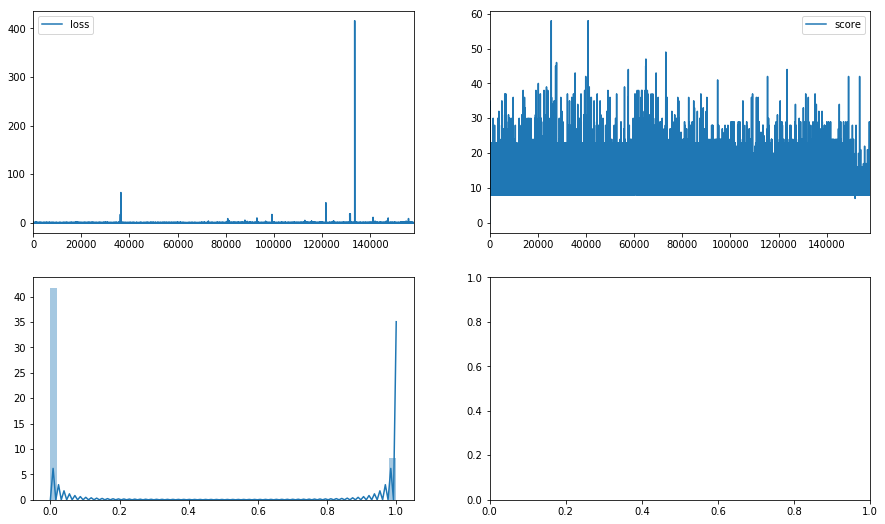

In [21]:
show_plots()